# Experiments

In [1]:
# !pip2 install pypolyagamma

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import importlib
import os
import sys

from base.experiment import *
from logistic.env_logistic import *
from logistic.agent_logistic import *
from utils import *

import numpy as np
import numpy.linalg as npla
import scipy.linalg as spla
import pandas as pd
import plotnine as gg

#import importlib
#importlib.reload(logistic.agent_logistic)
#reload(sys.modules['logistic.agent_logistic'])

# Setup

Here $d=20$ and the number of arms is $A=20$. The number of timesteps is $T=1000$.

At the beginning $\theta\sim N(0,I_d)$ is generated. The reward given context $x\in \mathbb R^d$ is $\text{Bernoulli}(\sigma(\theta^\top x))$ where $\sigma(x) = \frac{e^x}{1+e^x}$. At each step $x_{t,1},\ldots, x_{t,A}\sim N(0,I_d/9)$ are randomly generated, and the algorithm picks one of the arms $1,\ldots, A$ and gets the corresponding stochastic reward.

If the algorithm chose actions $a_t$, regret is measured as $\max_{\{a_t^*\}} \sigma(\theta^\top x_{t,a_t^*}) - \sum_{t=1}^T \mathbb E \sigma(\theta^\top x_{t,a_t})$, i.e., expected reward against the best choice of $a_t^*$'s if $\theta$ were known.


In [2]:
def simple_compare(agents, num_articles, dim, var, n_steps, seed=0, verbosity=0):
    env = LogisticBandit(num_articles, dim, NormalDist(0,1,dim=dim), (NormalDist(0,var,dim=dim)), seed=seed)
    experiment = ExperimentCompare(agents, env, n_steps,
                   seed=seed, verbosity=verbosity)
    experiment.run_experiment()
    results = []
    results.append(experiment.results)
    df = pd.DataFrame(results[0])
    cum_regrets = experiment.cum_regret
    #https://stackoverflow.com/questions/39092067/pandas-dataframe-convert-column-type-to-string-or-categorical
    df['agent_id'] = df.agent_id.astype('category')
    print(gg.ggplot(df)
     + gg.aes('t', 'cum_regret', color='agent_id', group='agent_id')
     + gg.geom_point()
     + gg.geom_line())
    print(gg.ggplot(df)
     + gg.aes('t', 'time', color='agent_id', group='agent_id')
     + gg.geom_point()
     + gg.geom_line())
    return results, df, cum_regrets

def simple_compares(make_agents, num_articles, dim, var, n_steps, seeds, verbosity=0):
    results_list = []
    df_list = []
    cum_regrets_list = []
    avg_regrets = np.zeros(len(make_agents))
    for seed in seeds:
        agents = [make_agent() for make_agent in make_agents]
        results, df, cum_regrets = simple_compare(agents, num_articles, dim, var, n_steps, seed=seed, verbosity=verbosity)
        results_list += [results]
        df_list += [df]
        cum_regrets_list += [cum_regrets]
        avg_regrets += cum_regrets
    avg_regrets = avg_regrets / len(seeds)
    return results_list, df_list, cum_regrets_list, avg_regrets    

def hyperparameter_sweep(make_agent_from_hyperparameters, hyperparam_list, dim, var, n_steps, seed=0, verbosity=0):
    agents = [make_agent_from_hyperparameters(hyperparam) for hyperparam in hyperparam_list]
    results, df, cum_regrets = simple_compare(agents, num_articles, dim, var, n_steps, seed=seed, verbosity=verbosity)
    
def hyperparameter_sweeps(make_agent_from_hyperparameters, hyperparam_list, dim, var, n_steps, seeds, verbosity=0):
    results_list = []
    df_list = []
    cum_regrets_list = []
    avg_regrets = np.zeros(len(hyperparam_list))
    for seed in range(seeds):
        agents = [make_agent_from_hyperparameters(hyperparam) for hyperparam in hyperparam_list]
        results, df, cum_regrets = simple_compare(agents, num_articles, dim, var, n_steps, seed=seed, verbosity=verbosity)
        results_list += [results]
        df_list += [df]
        cum_regrets_list += [cum_regrets]
        avg_regrets += cum_regrets
    avg_regrets = avg_regrets / seeds
    return results_list, df_list, cum_regrets_list, avg_regrets


In [3]:
num_articles = 20
dim = 20
var = 1.0/9
theta_mean = 0
theta_std = 1

time_limit= 0.1

verbosity=1

In [4]:
# We will tune the Langevin, SGLD, and SAGA-LD agents.

make_langevin_agent = lambda hypers: BasicLangevinTS(num_articles, dim, [0]*(dim), cov=None, 
                                              step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim), n_steps=9999,
                                              time = time_limit,
                                              init_pt=None, verbosity=verbosity)
make_mala_agent = lambda: MalaTS(num_articles, dim, [0]*(dim), cov=None, 
                                 step_size=lambda t: 0.1/(1 + t * np.sqrt(dim*var)/dim), n_steps=9999,
                                 time = time_limit,
                                     init_pt=None, verbosity=verbosity)
make_sgld_agent = lambda hypers: SGLDTS(num_articles, dim, [0]*(dim), cov=None, 
                                        step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim),
                                        batch_size = hypers[1],
                                        time=time_limit,
                                        n_steps=9999,
                                        init_pt=None, verbosity=verbosity)
make_sagald_agent = lambda hypers: SAGATS(num_articles, dim, [0]*(dim+1), cov=None, 
                                          step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim),
                                          batch_size = hypers[1],
                                          time=time_limit,
                                          n_steps=9999,
                                          init_pt=None, verbosity=verbosity)

# Untimed MALA agent is used as baseline.

make_mala_agent_untimed = lambda: MalaTS(num_articles, dim, [0]*dim, cov=None, 
                                         step_size=lambda t: 0.1/(1 + t * np.sqrt(dim*var)/dim), n_steps=500,
                                         init_pt=None, verbosity=verbosity)

# Use default settings for Laplace agent for now (would be nice to tune this too). Not time-restricted.
theta_mean = 0
theta_std = 1
epsilon1 = 0.01
epsilon2 = 0.05
alpha=0.2
beta=0.5
tol=0.0001
make_laplace_agent = lambda: LaplaceTSLogisticBandit(num_articles, dim, theta_mean, theta_std, epsilon1,
                                                      alpha,beta,tol, verbosity=verbosity)

# PG-TS has no parameters to tune

make_pgts_agent = lambda: PGTS_Stream(num_articles, dim, intercept=False, context_has_constant=False, 
                                      n_steps=9999, time = time_limit, verbosity=verbosity)

In [5]:
make_best_sgld_agent = lambda: SGLDTS(num_articles, dim, [0]*(dim), cov=None, 
                                        step_size=lambda t: 0.01/(1 + t * np.sqrt(dim*var)/dim),
                                        batch_size = 32,
                                        time=time_limit,
                                        n_steps=9999,
                                        init_pt=None, verbosity=verbosity)
make_best_sagald_agent = lambda: SAGATS(num_articles, dim, [0]*(dim), cov=None, 
                                          step_size=lambda t: 0.05/(1 + t * np.sqrt(dim*var)/dim),
                                          batch_size = 32,
                                          time=time_limit,
                                          n_steps=9999,
                                          init_pt=None, verbosity=verbosity)

make_best_langevin_agent = lambda: BasicLangevinTS(num_articles, dim, [0]*(dim), cov=None, 
                                              step_size=lambda t: 0.1/(1 + t * np.sqrt(dim*var)/dim), n_steps=9999,
                                              time = time_limit,
                                              init_pt=None, verbosity=verbosity)

In [6]:
import warnings
warnings.filterwarnings('ignore')

theta [ 0.98688681 -1.7160776   0.35133485  2.00711271 -0.3932066   1.75328969
  0.83412094  0.97258008  1.45799666 -0.86404959 -1.12557741  0.66118012
 -2.29663349  0.80666609  0.89322918  0.58363088  1.07410719  0.72007726
  0.68752484 -0.55261018]
Experiment: Step 0
 Laplace sample: array([-0.14755907,  0.51828961,  0.59206201,  1.45321358,  1.18785217,
       -1.22348799, -0.03654905,  1.00692978, -0.65053637, -0.02067691,
       -0.58601604,  0.07304223, -0.82450497,  1.30494554,  1.1621627 ,
       -0.31440989, -0.39006674, -1.06841394, -0.54505546,  0.97465571])
 Sample: array([-0.61737844,  0.17367969,  0.42652518, -0.88429675,  0.1395348 ,
       -1.83272077,  2.70270564,  0.90441249, -1.08574919, -0.8031082 ,
        1.34963628, -0.47138215, -1.61647911,  0.19301797,  0.7537628 ,
        1.11317207, -1.0401978 ,  2.59237179, -0.4880447 , -0.28949581])
 Sample: array([-0.92142441, -0.55670143, -1.03619307,  1.87175888,  0.43691717,
        0.47540215,  0.19355932, -2.57770578,

 Steps taken: 286
 Sample: array([-1.52000974, -0.05322161,  1.36463997, -0.85148817, -0.57393716,
       -0.63099542, -0.35845714,  1.06182322, -0.16549178, -0.36038671,
       -0.51404138,  1.64690192, -0.25191294, -1.81927724, -1.56722424,
       -0.30482269, -0.6935083 , -1.43661473,  0.46280934,  1.15789308])
 Sample: array([ 0.75760889, -0.31364773, -0.27797045, -0.81930674,  0.18269432,
       -0.18010441,  0.20592104,  2.83663536, -0.86474031, -0.03440527,
       -1.32832505, -0.7624749 ,  0.54536662, -1.15503004, -1.89989026,
       -0.39790764,  0.22325523, -0.36222001,  0.45238209, -0.59676667])
 Steps taken: 1608
 Sample: array([-0.18602928,  0.39661186,  0.48204171, -0.05520486, -0.24209215,
        0.39102855, -0.06178308,  0.43230167,  0.1886374 , -0.57239119,
        0.24498439,  0.10982146, -0.48279534,  0.20199685, -0.37815659,
       -0.47618963,  0.09232271,  0.08840531, -1.19075802,  0.3636959 ])
 Accept proportion: 0.308889
 Steps taken: 450
 Sample: array([ 0.021

 Sample: array([-0.51771337, -1.39707436, -0.73733821,  0.9653158 ,  0.43298968,
        0.97425618,  0.11641772, -0.68831939,  0.45395198, -0.15325231,
       -0.84228123,  0.14798828, -1.00976254, -0.01821771, -0.24784314,
        0.63027664,  1.42336389,  0.89135021, -0.44760718, -0.35349069])
 Accept proportion: 0.334158
 Steps taken: 404
 Sample: array([-0.14730568, -0.06934463,  0.92687181,  0.47269279, -0.4335459 ,
        0.77427565,  0.21590033,  0.39452835,  0.45292665,  0.50164901,
        0.73963887,  1.97599156, -0.69972176,  1.84160733, -0.99147419,
        0.82210001, -0.21714098, -1.12769392,  0.20451602,  0.45258812])
 Steps taken: 1236
 Sample: array([-0.01230592,  0.39402204,  1.29600964,  2.24007923,  0.7192958 ,
       -1.00860471, -0.33817003, -1.20433745, -0.42323302, -1.80430102,
        1.03603877, -0.37020061, -0.80558122, -0.46455409,  0.73496457,
       -0.44719071, -0.42393093,  0.3352105 ,  0.55259261,  0.59763909])
 Steps taken: 1094
Experiment: Step 9
 L

 Sample: array([-1.13805195,  1.20777163, -0.20654691,  1.72001778, -0.86586193,
        0.03372734,  0.9162501 ,  0.72976876,  0.07265263, -0.34689464,
       -0.3937776 ,  0.24746764, -0.47146354,  1.26433678, -0.00233144,
        1.20738118,  1.20308584,  0.44888513, -0.44831105, -1.27636516])
 Steps taken: 1205
Experiment: Step 13
 Laplace sample: array([ 3.05071623, -4.94621214, -1.06151377, -0.78027009, -6.23986912,
        2.64090115,  7.80686788,  5.60657349,  1.45516018,  2.31692336,
        2.65308382, -1.21711786, -4.76804328, -1.8939078 , -0.38726682,
        5.02390751,  0.86835624, -0.25336821,  6.73942186, -4.09333863])
 Steps taken: 353
 Sample: array([-0.1420066 , -1.86549658,  0.88366218, -0.11490612, -1.13979786,
       -0.40875723,  2.80319091,  0.16239164, -0.42711438, -0.3396923 ,
       -0.21027263,  0.2720801 , -0.28812851,  1.76456568, -0.58863529,
       -0.73504774, -1.12078664, -0.83581008, -1.17524415, -0.04631884])
 Sample: array([ 0.7544863 ,  1.24838067,

 Steps taken: 339
 Sample: array([-1.76407366, -0.67371902,  0.48252714, -0.79509732,  0.95692029,
       -0.71136248, -0.23854828,  0.2010623 ,  0.4365348 , -1.0834707 ,
       -1.01715265, -1.44377614, -0.222605  , -0.30691982,  1.19679221,
       -1.26351105, -0.37054065,  0.21818744,  0.11362848,  0.6014899 ])
 Sample: array([-3.39448596, -2.0445018 , -0.25701528, -0.80239298, -0.32351217,
        2.54007925,  0.61084736,  0.63710182,  0.34157861, -1.73768489,
       -0.81482932, -0.61114684, -1.19766638,  0.2878761 ,  0.00748416,
       -1.1451964 , -1.63621642,  0.79484903, -0.28565381, -0.80569112])
 Steps taken: 1191
 Sample: array([ 0.35173117, -0.92343864, -0.22513481,  0.92290543,  0.11038793,
        0.24043912, -1.09015613,  0.51956637,  0.21004106, -0.53823616,
       -0.55478775,  0.21027989, -0.31448978,  0.27715776, -0.29561236,
        0.08648973,  0.04251074,  0.80300709,  0.27950364, -0.50815774])
 Accept proportion: 0.393939
 Steps taken: 429
 Sample: array([ 8.954

 Sample: array([ 0.60290294, -1.63977101, -0.87219634,  1.13362081, -0.36119271,
        0.2467774 , -0.18542667,  0.48174487,  0.19816082,  0.28153518,
       -0.55338213, -0.02417624, -1.11933516, -0.30553953,  0.48393242,
        0.38153036, -0.47195306,  0.85024015, -0.30671832, -0.49984709])
 Accept proportion: 0.393365
 Steps taken: 422
 Sample: array([ 1.65953132,  0.01303349, -1.18953141,  1.96639889, -0.74549414,
       -1.24793193,  0.00960656, -0.02645592,  1.21897213, -0.587023  ,
       -0.56739661,  0.08046396, -2.27746548,  1.10765775, -0.39972   ,
       -0.44900639, -0.7764378 ,  0.8333218 ,  1.65851695,  0.29353604])
 Steps taken: 1293
 Sample: array([-0.27378042, -1.11038927, -0.80837948,  1.09824526, -0.63618708,
        1.61776739, -0.03981979,  0.31935901,  0.38075009, -0.34048846,
        1.08354197, -0.24699945, -0.13966763,  1.7996336 , -0.36872236,
        0.84848284,  0.47262725,  0.13068525,  0.53756356,  0.19709131])
 Steps taken: 1143
Experiment: Step 22
 

 Sample: array([-1.81052983, -0.95894531,  0.50451568,  1.5116996 ,  0.67733472,
        0.91636242,  0.24451988, -1.11469989,  0.76962   , -0.70772698,
       -0.365923  ,  0.52544508, -0.95788714, -0.6509478 , -0.7833246 ,
        0.80415386,  0.34836039,  0.4748059 , -0.08369734, -1.82128104])
 Steps taken: 1108
Experiment: Step 26
 Laplace sample: array([ 11.12035629, -10.38811991,  -1.78255291,   6.39433527,
        -0.4933406 ,  15.2111269 ,   0.37829886,  -3.68965588,
        -0.65407291,   0.86416242, -12.09648621,  -2.2566165 ,
        -9.47524124,  -2.31209884,  -6.88038363,  11.6199732 ,
        -7.22813315,   9.02337762,  13.00845604,  -4.29685842])
 Steps taken: 338
 Sample: array([ 2.09515532, -1.04237793, -0.33527468, -1.78657672,  1.19452443,
       -0.09048572,  2.10814571,  0.84305486,  1.02696232,  0.48494158,
        0.59235274, -0.05827574,  0.84174794,  0.25978768,  0.56654214,
       -0.25225458,  0.43315505,  0.2507075 , -0.33873945,  0.10011989])
 Sample: array

 Sample: array([ 0.30559216, -0.02310771, -0.08646809,  0.35575522,  0.26463048,
        0.23066448, -0.43437654,  1.06963549,  0.8046389 ,  0.39373111,
       -1.41882211, -0.03748136, -0.84913251, -0.35411371,  1.42864241,
       -1.11571558,  0.26702448,  0.95588754,  0.83735637,  0.95157369])
 Steps taken: 1119
 Sample: array([ 0.91873776, -1.31717163,  0.80679464, -0.30808885, -0.05447418,
        1.17053645,  0.86509469,  0.3956889 , -0.22364617,  1.26938548,
       -1.09087555,  0.76207452, -0.4114262 ,  0.95220657,  0.09344105,
        0.77108926,  0.09254002,  1.40423944,  0.22165309, -1.02760555])
 Accept proportion: 0.432692
 Steps taken: 416
 Sample: array([ 1.23308041, -1.71942579,  0.53384087, -0.03878123, -1.39948326,
       -0.39488953,  0.79327627,  0.31174451,  0.82762391,  0.06699838,
       -0.30681872,  0.79526735, -1.36988242,  1.28945798,  0.72325522,
        0.07729256, -0.66327988,  1.83106709,  0.73612273, -0.37763506])
 Steps taken: 1220
 Sample: array([ 0.38

 Sample: array([ 0.61658675, -0.62283136,  0.22193149, -0.00706098, -0.56573823,
       -0.24977891, -0.11238622,  0.99282531, -1.13989168,  0.64799743,
       -1.0760508 ,  0.00281346, -1.08101396,  0.91728599, -0.31887812,
        1.01476198,  1.56906559,  1.26961162,  0.23049826, -0.26990387])
 Accept proportion: 0.462687
 Steps taken: 402
 Sample: array([ 1.53537508, -0.6377452 ,  0.89234744,  0.04177146, -0.88712696,
       -0.07443456,  1.87816645,  0.10443239,  0.28440653, -0.49268332,
       -1.17696557,  1.75110622, -0.4437669 ,  1.36330848,  0.13578888,
        0.01213543,  1.82916856,  1.90069841, -0.01112217,  0.37334187])
 Steps taken: 1054
 Sample: array([ 0.33502836, -0.64790919,  0.79479598,  1.07189875,  0.31527054,
        1.09313102,  0.67007138,  0.14055554,  1.65791678, -0.59867513,
       -0.96783672, -0.09470468, -0.37325283,  0.96764041, -0.7365781 ,
        1.42094945, -1.27815915,  0.48330121, -0.6477981 , -0.59437263])
 Steps taken: 825
Experiment: Step 35
 L

 Sample: array([ 1.4006346 , -1.1469119 ,  0.50078944,  0.17158037,  2.7594208 ,
        1.33877875,  0.59295705,  0.63038847,  1.11938865, -0.37872642,
       -1.43966718,  1.29965311, -0.86635951, -1.2822974 , -1.04319239,
        0.90920839,  1.2124659 ,  0.83112101,  0.08257836,  0.47586987])
 Steps taken: 824
Experiment: Step 39
 Laplace sample: array([ 16.08038946,   0.12886746, -17.42882954,   5.62295161,
         7.62754074,  12.41289172,   2.06271484,  -2.39436019,
         9.07276858,  -4.88221222, -32.02537088,  -2.69667436,
       -21.32895397,  27.52890401,   3.19889091,  12.57417782,
         8.15309163,   7.10839157,  13.8339114 ,  -6.44696886])
 Steps taken: 328
 Sample: array([ 0.14130585, -0.34849256,  0.30911575, -0.11860497, -0.23100633,
        1.20211075,  0.5878488 ,  0.39511038,  0.79269539, -0.92429603,
       -0.93650394,  0.69212537,  1.08343785,  1.80016076,  0.83048725,
       -0.46564038, -0.00770077,  1.47088794,  1.53481718, -2.99554947])
 Sample: array(

 Steps taken: 326
 Sample: array([-0.50871291, -0.64248549, -0.10215165, -0.91520185,  1.15314636,
       -0.30468751,  1.57227658,  1.53951026,  0.54279075, -1.74469796,
        0.72157988,  1.53013224,  1.57330163,  0.15079952, -1.05276341,
       -0.27611408,  1.63719737,  1.41823064, -0.00328577, -0.51064635])
 Sample: array([ 0.16446556, -0.99058012, -1.14746536,  0.48388083, -0.39922639,
        1.13725182, -0.53075915, -0.08721272,  0.26199479, -1.00952951,
        0.73541966,  2.0270385 , -1.85678924, -0.30036702, -0.16066726,
        0.60420106,  0.3938992 , -0.6244425 ,  1.46871756,  1.05348368])
 Steps taken: 1060
 Sample: array([ 0.67614215, -1.20854754,  0.83704242,  0.56712387,  0.39477642,
        0.6732103 ,  0.85980737,  0.10617435, -0.1358936 ,  0.37715036,
       -0.53711971,  0.78781075, -0.57774336,  0.37346626,  0.88776799,
       -0.75430606,  1.43591428,  0.45922394,  1.02048471, -0.01272468])
 Accept proportion: 0.428571
 Steps taken: 399
 Sample: array([ 0.189

 Sample: array([ 0.95044295, -0.50760466,  0.20160705,  0.80164953,  0.15863002,
        0.33825166, -0.32561143, -0.00951277, -0.78765735,  0.49710322,
       -0.92196961,  0.88449194, -1.63002657,  0.95632242,  0.6869048 ,
       -0.00504903,  1.4234473 ,  0.60392101,  0.46366474, -1.66842028])
 Accept proportion: 0.462916
 Steps taken: 391
 Sample: array([ 1.8970988 , -1.66302299,  1.38018946, -0.32899631,  0.03543904,
        1.00939946,  0.61839297,  1.22056324,  0.74894902,  0.15078254,
       -1.62715985,  1.5314824 , -0.96917183,  0.61030419,  0.52118921,
       -0.745677  ,  0.75098324, -1.15162437,  1.60590134,  0.51926883])
 Steps taken: 1056
 Sample: array([-0.20665197,  0.28177897,  0.52622462,  1.47315326, -0.99717541,
        1.32851073, -0.33939991,  0.93133737, -0.90126645, -0.22078514,
       -1.31244609,  1.33821163, -1.31981988, -0.7394695 ,  0.36132467,
        1.00842093,  0.52436413,  2.37598555,  0.44032954, -1.04788881])
 Steps taken: 834
Experiment: Step 48
 L

 Sample: array([ 0.86328569,  1.23898453,  0.17671938,  0.7273607 , -1.30688403,
        0.50201466,  0.08803429,  0.19978844,  1.26897303,  0.1859234 ,
       -0.99346427,  1.92050235, -1.74743564, -0.33460003,  1.36477263,
        0.06419527,  0.56411894, -0.02776533,  0.63656422, -0.71942506])
 Steps taken: 1044
 Sample: array([-0.02516804, -1.07444013,  1.23925234,  1.56998828, -0.50711049,
        1.15565523,  2.31418243,  0.09354199, -0.2685635 , -0.66987275,
       -0.42795575,  0.11596464, -0.51696205,  0.40794391, -0.14907384,
        1.41816365,  0.95316697,  0.30951051,  1.18660788, -0.14930267])
 Steps taken: 838
Experiment: Step 52
 Laplace sample: array([ -4.28892158, -45.31201849,   4.82781209,  43.05453952,
         5.72576793,  43.51561716, -19.26592673, -18.09497174,
        79.92253683, -12.99595967, -18.78162188, -19.5762249 ,
       -42.24905192,  27.16583554,  15.37162074,  20.31708081,
        22.77097375,  17.440542  ,  13.84068773, -42.48998833])
 Steps taken: 

 Steps taken: 317
 Sample: array([ 0.53239327,  0.19328842, -0.26750584,  0.11552848, -0.55042357,
        1.50476775,  0.95560228,  0.84147946,  2.87690339, -1.14994726,
       -1.70604759,  1.58096706,  0.55208039,  1.46663153,  3.06388606,
       -0.33589101,  0.38915748,  2.33472248, -0.30123329, -0.30828215])
 Sample: array([-0.37652688, -0.72662136,  1.55956021,  2.082213  , -1.84088398,
        0.98254658,  1.23632698,  1.7234921 , -0.48268959, -0.70405767,
        0.2197045 ,  1.37311939, -0.29759714,  2.30557991,  0.63033273,
       -1.46913819,  1.15719132, -0.46741573,  2.15166948, -1.35095293])
 Steps taken: 1001
 Sample: array([ 0.75326338, -1.03669511,  0.57587375,  0.81695148, -0.52180901,
       -0.24888608, -0.02069417,  0.85996692,  0.17247738,  0.11378512,
       -0.42305744,  0.73712262, -1.7057231 ,  0.28961202, -0.39385952,
        1.04194591,  1.1394063 ,  0.80469049, -0.01812323, -0.44339361])
 Accept proportion: 0.431217
 Steps taken: 378
 Sample: array([ 1.429

 Sample: array([ 0.03368828, -0.79501894,  0.85034512,  0.1147441 , -1.24502714,
        1.47253282,  0.40434579,  0.63308571,  0.19364436,  0.08082974,
       -0.29489272,  0.03666335, -1.70427177,  0.03596172,  0.16097937,
        0.52081655,  0.86984343,  1.70454938,  0.48447591,  0.63859013])
 Accept proportion: 0.502688
 Steps taken: 372
 Sample: array([ 0.24043836, -1.35979228,  0.62039747,  2.0235782 ,  1.24732468,
        0.1887668 ,  1.344697  ,  0.38528583,  0.46784876, -0.5172809 ,
       -0.25191853, -1.58370376, -2.13042667, -0.62821449, -1.12970159,
       -0.78880436,  1.27268446,  0.41294301, -0.00646799,  0.38378508])
 Steps taken: 1053
 Sample: array([ 0.87808464, -0.6491448 ,  1.22027173,  1.29822736,  0.64565316,
        1.94209285, -0.46271756, -0.06983273,  0.08600664, -0.88199968,
       -1.91361087,  1.27299615,  0.42820557, -0.75188128, -0.02942026,
        1.32428159,  0.31565901,  1.61865885,  0.51460874,  0.03197249])
 Steps taken: 832
Experiment: Step 61
 L

 Sample: array([ 0.84680628, -1.65353365,  0.61417756,  1.1595584 ,  0.08750382,
        0.2016044 ,  0.23108049,  0.64650986, -0.61528613,  0.36241885,
       -0.05261298,  0.94491084, -1.53051503,  0.53405536,  0.34307037,
        0.61713056, -0.22870238,  0.22715843,  1.60915232, -0.14063073])
 Steps taken: 833
Experiment: Step 65
 Laplace sample: array([-5.06714946e+01, -6.61431688e+01, -7.26530165e-02,  1.07324123e+02,
       -6.21803407e+01,  6.13900086e+01,  3.25029903e+00, -3.86405098e+01,
        1.03985124e+02, -3.52463527e+01, -5.75132419e+01,  3.44255026e+01,
       -1.10359890e+02,  1.82963304e+01, -3.33264918e+01,  4.20977282e+01,
       -1.20602905e+00,  1.92401851e+01,  3.51611283e+01, -4.72470903e+01])
 Steps taken: 308
 Sample: array([ 0.06199035, -0.15731946,  1.06792139, -0.07057431,  0.24269018,
        1.16226592,  1.641733  ,  0.84483023,  0.55172713, -2.00814631,
       -1.19031947,  1.07596869,  0.06964696,  0.33277302,  1.56202086,
        0.33540074, -0.37551

 Steps taken: 297
 Sample: array([-0.15993539, -0.77859014, -0.1587296 ,  0.17180259,  0.33165175,
        2.02841881, -0.88319523, -0.17428785,  1.43738248, -0.05674561,
       -0.45453602,  0.42034212, -0.33777259, -0.09601087,  0.17967389,
       -0.03198318,  1.04243067,  1.40623707, -2.04739003, -0.85601384])
 Sample: array([-0.31124648, -1.03185254, -0.08622652,  1.77982363, -0.83309036,
        1.87051042,  1.05893857,  1.40860505, -0.06084138,  0.14404602,
       -0.71066112,  0.38601402, -1.72597917,  0.63684387, -0.5811961 ,
       -0.72748504,  1.23793432,  0.16160644,  2.18176311, -0.24473526])
 Steps taken: 959
 Sample: array([ 0.35423307, -1.35196611,  0.07147532,  0.44737645, -0.65640701,
        0.85079519, -0.38816151,  0.85772596,  0.31039124, -0.12536534,
       -0.30001759,  0.74768073, -1.39622927,  1.08455623, -0.50767708,
        0.37257332,  1.53863027,  1.15717361,  0.89428005, -0.42120771])
 Accept proportion: 0.485014
 Steps taken: 367
 Sample: array([ 0.8831

 Sample: array([ 0.51207328, -1.18404917,  0.80614835,  1.1857659 , -0.98353002,
        1.41762193,  0.67820471,  0.20997052,  0.55579086,  0.22863503,
       -0.39459307,  0.3597252 , -1.51468051,  0.4503092 ,  0.48300861,
        0.03592778,  0.63835343,  1.31630658,  1.22127947, -0.885694  ])
 Accept proportion: 0.497207
 Steps taken: 358
 Sample: array([ 0.07647418, -0.87924565,  0.67529419,  1.04296541, -0.43695468,
        2.04823415,  1.03663303,  0.04064038,  0.75133631, -0.11395925,
       -0.4868091 , -0.66598103, -1.04914893,  0.58474876,  0.28353987,
        0.75272831, -0.21498683, -1.56767794,  0.34469641, -0.47447246])
 Steps taken: 1055
 Sample: array([-0.19221666, -2.37089391,  0.89271482,  1.28780259,  0.21283341,
        1.04672473,  0.91879151,  1.09122129,  1.9260359 , -0.71474983,
       -0.51541157,  1.57055867, -0.68706225,  0.45234406,  0.35347616,
       -0.31084563, -0.34346687,  0.96698445,  0.03757048, -0.58645206])
 Steps taken: 830
Experiment: Step 74
 L

 Sample: array([ 0.80375375, -1.75209616, -0.74049179,  1.78568932,  0.35548655,
        0.73703478, -1.21683665,  0.64179708,  1.61287077, -1.21170799,
       -2.80190946,  0.09895722, -0.8316495 ,  1.24695818, -1.55323323,
        0.81274314, -1.07222407, -0.00314997,  1.43569984, -0.88340804])
 Steps taken: 825
Experiment: Step 78
 Laplace sample: array([-1.56524066, -2.83105496, -1.36681298,  8.64491159, -6.26590302,
        5.74686014, -0.53035672, -2.86138931,  6.07050783, -2.91673853,
       -4.51452354, -0.23641517, -7.16289913,  0.00898642,  0.51887373,
        2.40813825,  3.06993597,  5.13726536,  3.11356672, -0.08540084])
 Steps taken: 296
 Sample: array([ 0.21087771,  0.00903851, -1.12586654, -0.03332137, -1.34479098,
        2.29836641,  0.37910468,  1.19234251,  0.84320109, -0.93438437,
       -0.32645507,  0.80257862,  0.78555887, -0.12170118,  0.80209527,
        0.16584758,  0.16205784,  0.97949128,  0.66273026, -0.19133676])
 Sample: array([-0.72046711, -1.47528455, 

 Sample: array([-0.58682492, -0.54970921, -0.59504766,  0.89656602, -0.72811289,
        0.31085763, -0.12043445,  0.30719644,  2.22264343,  0.4303108 ,
       -2.10219096,  0.77468933, -1.84074847,  1.38814232,  0.91113904,
        0.78140248,  0.02960073,  0.36903698,  0.93803427, -1.24089432])
 Steps taken: 867
 Sample: array([ 0.74715006, -1.46632694,  0.53468532,  0.72710611, -1.00323959,
        0.96872222, -0.00347381,  0.06734979,  0.22366527,  0.28890128,
       -0.20211067, -0.14880912, -0.98563974,  0.28433505,  0.87572051,
        0.23765465,  1.1313161 ,  1.42475788,  0.12194038, -0.77218357])
 Accept proportion: 0.505747
 Steps taken: 348
 Sample: array([ 0.88519665, -1.15839553,  1.76487498,  0.23324695, -1.3722541 ,
        1.54149817,  1.84307888, -0.33810183, -0.68518503, -0.14964028,
       -2.20752254,  0.66674975, -0.9754417 ,  0.85905105,  0.13655709,
        0.69104346,  0.27469795, -0.51132929,  0.56520069, -1.29105691])
 Steps taken: 1032
 Sample: array([ 0.952

 Sample: array([ 0.83589846, -1.47495772,  0.57587395,  0.12608844, -0.57928238,
        0.00813558,  0.87054755, -2.13370729,  0.93566825,  0.74992347,
       -0.52190565,  0.07981081, -1.30345548, -0.87175833, -0.1794625 ,
        1.07185147,  1.06122109,  0.28282199, -0.81352041, -0.59395845])
 Steps taken: 1045
 Sample: array([-0.4087811 , -1.62377022,  0.74775413,  1.28262125, -0.27221751,
        0.90065907,  1.34306641,  1.1960397 ,  0.57057588,  0.04534513,
       -0.46194843,  1.74972959, -0.58304454,  0.17055057,  0.02068625,
        1.00359021, -0.29644867,  0.96781622,  0.69901631, -0.330376  ])
 Steps taken: 845
Experiment: Step 87
 Laplace sample: array([-1.47622643, -5.3445117 , -0.10640144,  7.21150328, -2.38635702,
        4.41335413, -1.28153625,  0.12927718,  4.29785124, -1.23375973,
       -5.28592935, -0.27152056, -4.05622361, -0.62504121,  2.66622703,
        1.81167881,  2.1554994 ,  2.73049461,  3.17529783, -1.87428506])
 Steps taken: 284
 Sample: array([-1.1889

 Steps taken: 237
 Sample: array([-0.91600953, -0.7417291 , -0.70090784,  2.09438222,  0.03506498,
        1.52570644,  0.63295964,  0.73412951,  1.64563391, -1.33719927,
        0.36353839,  2.03708779, -0.95912425,  0.07368212, -0.31928635,
        0.32110979, -0.16164617,  0.18992809,  0.21416788, -1.74930657])
 Sample: array([ 1.00834120e+00, -1.32813718e+00, -9.50016037e-02,  4.76304139e-01,
       -3.17911168e-01,  8.64665076e-01,  2.18350926e+00,  4.03165373e-02,
        3.14455663e-01, -1.68795287e+00, -1.39402971e-01,  9.20334110e-01,
       -1.52217776e+00, -3.32705313e-01,  2.81723101e-02, -7.95245644e-02,
        1.04787107e+00,  7.95613105e-01,  1.40299691e+00,  4.95075589e-04])
 Steps taken: 835
 Sample: array([ 0.55557698, -1.66435504,  0.65518514,  0.14095343, -1.10950356,
        1.67769982,  0.26133079,  0.78742584,  0.2160847 ,  0.62115288,
       -0.80048124,  1.19495535, -1.75911346,  0.91294428,  0.48489005,
        0.21363562,  1.00736581,  1.43490921,  0.4883298

 Sample: array([ 0.66163883, -1.53357952,  0.54653422,  0.98447565, -1.32260422,
        1.24800049,  0.15850782,  0.58055265,  0.62597652,  0.2622142 ,
       -1.00414652,  1.08284484, -1.55016855,  0.55784719,  1.02196236,
        0.71165122,  0.45223948,  0.51954558,  1.28291132, -0.58498249])
 Accept proportion: 0.480000
 Steps taken: 325
 Sample: array([-0.80966795, -0.2969882 ,  1.85197543,  1.27072928, -0.787351  ,
        0.14899716,  0.33505209, -0.84600462,  0.24159539, -0.63554388,
       -2.06198147,  0.55389302, -1.0601704 ,  0.60449725, -1.22552941,
       -0.55540468, -0.32504949, -0.29875959,  0.7329809 ,  0.77201585])
 Steps taken: 1055
 Sample: array([ 0.76931687, -0.13307446,  0.02982008,  2.00383049, -1.33820957,
        1.09881414,  0.99072286, -0.07783547,  0.666902  ,  0.64210782,
       -1.86853326,  0.74892891, -1.34274724,  0.77687033, -0.37035824,
        0.90525628,  0.28189337, -0.10836632,  1.08118844, -1.71531966])
 Steps taken: 817
Experiment: Step 96
 L

 Sample: array([ 0.07947962, -0.76147784,  0.80744178,  1.49646388, -0.42508556,
        1.68216047, -0.17733403, -0.07139508,  1.43997737, -1.22456141,
       -0.45254463,  0.07130458, -1.68540328,  0.46729088, -1.04564847,
        1.74796954,  0.47565002,  0.82047231,  0.09407516, -0.81945697])
 Steps taken: 834
Experiment: Step 100
 Laplace sample: array([-0.90606422, -5.95236223,  0.90347151,  7.33204577, -1.93982622,
        4.11717842,  0.64481344, -1.94383663,  6.47415216,  1.16443089,
       -6.14211195,  1.11020515, -5.50112053,  0.47670271,  2.14055151,
        0.87616971,  1.54052776,  3.34059755,  0.64446552, -1.67166131])
 Steps taken: 285
 Sample: array([-0.48966546,  1.35796036,  0.84866629,  0.35449322, -0.4357924 ,
        2.84561294,  1.13808231,  1.56041058,  1.35294928, -1.36570721,
        0.14423732,  0.6233963 , -0.49448179, -0.14503423,  0.72424909,
        0.21331635,  2.16771525,  0.95170012,  0.17488329,  0.44459092])
 Sample: array([-2.00532049, -1.22081445,

 Sample: array([-1.25361096, -0.38345187,  0.58595108,  0.94425504, -1.85573448,
        0.50088245, -0.04746409,  0.89048549, -0.50146408, -2.16763684,
       -1.26420302,  0.2315249 , -1.55042356, -0.37323849, -0.11161262,
       -0.21709782,  0.26124165, -0.22867701,  1.15811697, -0.52159796])
 Steps taken: 789
 Sample: array([ 0.64828032, -1.60016898, -0.40307876,  0.67825339, -0.70782937,
        0.83204724, -1.11124768,  0.79399866,  0.49411343,  0.57475052,
       -1.32683382,  0.70036629, -1.7902941 ,  0.61760951,  0.44211377,
        0.61129189,  1.84097726,  0.93885737, -0.06399813, -0.79759302])
 Accept proportion: 0.540625
 Steps taken: 320
 Sample: array([ 0.32058063, -1.41072475,  1.11809602,  1.00050164,  0.10155529,
        1.00034584,  0.08633187,  0.55166292,  0.18578642,  0.22800559,
       -0.49035849,  0.24581355, -1.50210924, -2.16316048, -0.39737972,
        0.48492374,  0.36195874, -0.27648673,  0.81506918,  0.11634795])
 Steps taken: 1036
 Sample: array([ 0.451

 Sample: array([ 0.71170865, -0.25887983, -0.50869641,  0.17623339, -0.49922642,
        0.47916851,  0.30844055,  0.42513964, -0.79715039, -0.77601452,
       -1.31025607,  0.71985869, -1.36075399,  1.18742952,  1.09916005,
       -0.09940465,  0.31990092, -0.76175623,  0.634604  , -0.39476998])
 Steps taken: 1046
 Sample: array([ 1.35730278, -1.5857282 ,  0.83503602,  2.6395388 , -0.97673397,
        0.12655736,  0.3580733 ,  0.19674558,  1.22505763, -1.79307427,
       -0.60900504,  0.19869092, -1.74536012,  0.51331288, -0.30120852,
        1.19230214,  0.8395644 ,  1.44418583,  0.73609346, -0.33508487])
 Steps taken: 836
Experiment: Step 109
 Laplace sample: array([ 1.00812777, -2.49636559,  0.76766382,  6.45368456, -2.88138114,
        1.08622879,  2.01482909, -1.01016974,  1.07747343, -0.67760538,
       -0.81047245,  2.81359749, -6.2693337 , -1.66612178,  1.70286777,
        0.4142095 ,  1.47974101,  4.24380646,  1.39325942,  0.80414003])
 Steps taken: 274
 Sample: array([-1.069

 Steps taken: 268
 Sample: array([-0.82497678, -0.58349339,  0.43217215,  0.91534506,  0.46503847,
        1.81096458,  0.63314544,  0.8844164 ,  1.0475303 , -0.52856905,
       -1.02680132,  1.24162193, -0.44988121,  0.32051537,  0.69350841,
       -0.39653685,  0.62152637,  0.88716385,  1.05565002, -1.12866734])
 Sample: array([-1.50328054e+00, -9.16485944e-01, -3.73553926e-01, -1.13838709e-03,
       -1.52908116e+00,  1.46906338e+00,  2.17900496e+00, -1.71283133e+00,
       -6.24167524e-01, -1.94379699e+00, -6.72983346e-01, -4.18866679e-02,
       -1.68219777e+00,  7.32493656e-01, -5.31565513e-01, -1.12007215e-01,
       -5.61092576e-01, -7.73576873e-01,  5.96525729e-01, -7.21822769e-01])
 Steps taken: 742
 Sample: array([ 0.7160377 , -1.58553815,  0.19564312,  1.46133847, -1.33446147,
        1.21215424, -0.40140482,  0.29436328,  0.6257121 ,  0.0933388 ,
       -1.03722061,  0.93354217, -1.14310898,  0.46739939,  0.70730983,
        0.4900379 ,  0.74377933,  0.55867971,  0.8428584

 Sample: array([ 0.84221302, -1.25935657,  0.20812098,  1.24071546, -0.92377459,
        1.59286111, -0.03445915,  1.07702307,  0.85488305,  0.19830872,
       -0.78809321,  0.27177666, -0.88130386,  0.79149361,  0.80877649,
        0.12029392,  1.76727677,  1.33331535,  0.38884702, -0.67617606])
 Accept proportion: 0.558974
 Steps taken: 195
 Sample: array([ 1.26757526, -0.98809493,  0.88466461, -0.13183081, -0.27604768,
        0.92605105, -1.01357457,  0.04683527, -0.91895266, -0.08580509,
        0.53779457, -0.01686709, -0.76673558,  0.34387405,  0.10614376,
        0.74676351, -1.20464825,  0.3439235 ,  0.65117499, -0.73483857])
 Steps taken: 757
 Sample: array([ 2.10668117, -1.09334877,  1.20890723,  1.24099094, -0.347123  ,
        1.06754043, -0.55111013,  0.86762661,  2.41700497, -1.5997707 ,
       -0.36284654,  0.71837581, -0.92780198, -1.15206657,  0.74636388,
        1.86560227,  0.59183653,  0.44680032,  0.19747451, -1.31194365])
 Steps taken: 761
Experiment: Step 118
 L

 Sample: array([ 0.76985582, -0.76388245,  1.17493125,  1.13637424,  0.11339692,
        1.14947032,  0.31791619,  0.79940538,  1.24343988, -1.08962064,
       -0.41174965,  1.63026372, -2.45725763,  0.89269844,  0.70999211,
        2.12524271,  1.03110855,  1.15118447,  0.73572867, -0.80472567])
 Steps taken: 831
Experiment: Step 122
 Laplace sample: array([ 0.67597956, -2.5641714 , -0.06437966,  5.25665237, -0.73592022,
        3.56503282,  1.20979093, -1.31856128,  4.68724194,  0.9081169 ,
       -3.36784253, -0.12054035, -5.47339575, -0.19656751,  1.19737131,
        0.09486052,  1.26265921,  1.14661835,  0.86548703,  0.28362458])
 Steps taken: 214
 Sample: array([ 0.3164949 , -0.54218739,  0.88692026,  0.7326489 , -0.6196472 ,
        0.92351588,  0.70881508,  1.04586425,  0.10779443,  0.01325508,
       -0.1465826 ,  1.63466936, -0.41659617,  0.53100129,  0.77148564,
       -0.42736894,  0.5993067 ,  0.94980136,  0.99083742, -1.32587214])
 Sample: array([ 0.2178462 , -2.26038078,

 Sample: array([ 0.02838552, -1.67446065,  0.02877967,  1.00570179, -0.80425853,
        0.18906874,  0.34818497, -1.02160756,  0.44751316, -0.82671312,
       -1.27860323, -0.49102782, -1.90885773,  0.71612689,  0.98657289,
        0.2046393 , -0.168239  ,  0.4265011 ,  1.34844415,  0.53313561])
 Steps taken: 647
 Sample: array([ 1.2088671 , -1.55509378, -0.36820273,  1.3738415 , -1.12651569,
        1.1098304 ,  0.39003538, -0.27289603,  0.25529675, -0.45886098,
        0.29779225,  0.95636564, -1.57997059, -0.03028269,  0.22328553,
        0.45394687,  0.95811491,  1.68588586,  0.85565463, -1.04095452])
 Accept proportion: 0.556075
 Steps taken: 214
 Sample: array([ 0.20757764, -1.55626672, -0.84974203,  0.33073488, -0.64974467,
        0.27044978, -0.17105294,  0.7692824 ,  0.61651093, -0.06144247,
       -0.64514718,  1.30638697, -0.18476783, -0.02581058,  0.48543351,
       -0.06941052, -1.38724595, -1.16983903,  0.58475902,  1.98707268])
 Steps taken: 830
 Sample: array([ 1.0012

 Sample: array([ 1.33627113, -0.89515239,  0.24881496,  0.95214392, -0.22676189,
       -0.204562  ,  0.16909355,  0.34071044, -1.33605043,  1.84660962,
       -0.02707308,  0.31582712, -1.58729146,  0.5810518 ,  0.485817  ,
        0.21305337, -0.96909227, -0.59676581, -0.10740312,  0.32271073])
 Steps taken: 806
 Sample: array([ 0.94794242, -2.45086208, -0.29315859,  2.44723879,  1.31964306,
       -0.00969288,  0.36490449,  0.75967121,  0.80735145, -0.36835057,
       -0.2227128 ,  0.70547211, -1.26283753,  0.24784756,  0.04725429,
        0.80761788, -0.15705579,  1.84287077,  0.35137553, -0.354743  ])
 Steps taken: 866
Experiment: Step 131
 Laplace sample: array([ 1.4374576 , -1.65212478,  0.39094106,  5.2111413 , -1.11422886,
        0.6018758 ,  0.29423941,  1.31576453,  2.0780185 ,  0.18640535,
       -0.99326291, -0.30431145, -5.58421734,  1.53632339,  2.62670595,
        0.09424851,  1.89739648,  1.48703986,  0.894125  , -1.16882164])
 Steps taken: 270
 Sample: array([-0.7691

 Steps taken: 267
 Sample: array([ 0.07643433, -0.07564239, -0.12661314, -0.21905524, -0.03909027,
        1.24808551,  0.77260241,  0.54613597,  1.74311495, -1.63665192,
       -0.70092979,  0.14333892, -0.68596123,  0.11683137,  0.57747651,
        0.88240755, -0.31196763,  0.75606057, -0.43021064,  0.37325944])
 Sample: array([ 0.39961514, -1.58400838, -0.52017621,  1.64881817, -0.23836744,
        0.24057146,  0.5248914 , -0.32197473,  1.03471063, -0.22368619,
       -0.88367922, -0.47933994, -3.64962245,  0.86659803,  0.44105521,
       -0.11240124,  0.89097672, -0.44898678,  1.07512282,  0.07542953])
 Steps taken: 638
 Sample: array([ 1.00295186, -0.98638703, -0.02912393,  0.81829808, -0.97156478,
        0.75692484, -0.53902937,  1.05856082,  1.0361703 ,  0.00541093,
       -0.93442045,  0.90861434, -1.72182849,  0.64688149,  0.22099898,
        0.30809389,  1.5834111 ,  0.91034264,  1.06938851, -0.8027445 ])
 Accept proportion: 0.547264
 Steps taken: 201
 Sample: array([-0.1644

 Sample: array([ 0.22959836, -1.44272606,  0.40490006,  1.87701836, -1.96662799,
        1.18575999,  0.34028204,  0.45241136,  0.40469232, -0.35342566,
       -0.15347285,  0.37782679, -1.1586918 ,  0.32789985,  1.19310626,
        0.01021112,  1.45872347,  0.94661761,  0.12088832,  0.17135761])
 Accept proportion: 0.666667
 Steps taken: 192
 Sample: array([ 1.18559456, -1.29736809,  0.59125643,  1.2860249 , -0.692167  ,
        0.59976158,  0.31957816, -0.08830943, -0.27499014, -0.2784324 ,
       -0.92473935,  0.41158678, -0.62557226,  0.16562118,  0.84620642,
       -0.07989806,  0.60347918,  0.21258744,  1.37491736,  0.09327558])
 Steps taken: 805
 Sample: array([ 0.70812523, -0.79455317,  0.406908  ,  2.60547559,  0.75576916,
        0.59367861,  0.82826854,  0.16357963,  1.19690864, -0.39200696,
        0.10752183,  1.43236607, -1.0232921 , -0.13101049, -0.1398016 ,
        1.1724505 ,  0.50114596, -0.39264228,  0.25586817, -0.59268831])
 Steps taken: 830
Experiment: Step 140
 L

 Sample: array([ 1.3475017 , -1.20320388,  0.67672801,  1.85570996,  0.24914426,
        1.26855478,  0.37375633, -0.47919528,  1.76747998, -1.44073666,
       -0.90470458,  0.67028973, -0.90515104,  1.2235035 ,  0.28206681,
        1.38421433,  0.55683268,  0.53996215,  1.16750236, -0.46615209])
 Steps taken: 753
Experiment: Step 144
 Laplace sample: array([ 1.97076207e+00, -1.47862458e+00,  1.40739559e+00,  4.46770638e+00,
       -2.12054470e+00,  3.38876350e+00,  1.13196115e+00,  4.29242998e-01,
        1.20888636e+00,  4.86761142e-01, -1.54885314e+00, -2.43080380e-03,
       -5.12724439e+00,  2.76906381e-01,  2.98162217e+00, -2.29940006e-01,
        1.36760077e+00,  1.51029493e+00,  3.92665122e+00,  1.70778725e+00])
 Steps taken: 258
 Sample: array([-0.19898196, -0.15190782, -1.01126635,  1.36619425,  0.21005006,
        0.43663304,  1.42972784,  0.01089293,  0.35269974, -0.55345747,
       -0.43629626,  0.66379513, -0.37050156, -0.05884314,  1.02623689,
        1.15519244,  0.6271

 Sample: array([-1.00313769, -3.44760003, -1.22134048,  2.14426817,  0.76047359,
        0.72958662,  0.65714684, -1.49168432,  0.46865626, -2.20898421,
       -1.84711578,  1.22092383, -1.49632175,  0.53517581,  0.54313959,
       -1.41581068,  0.43108829, -1.33192114,  0.39526652, -1.08069553])
 Steps taken: 601
 Sample: array([ 0.225164  , -1.26968245, -0.19854909,  1.02654107, -0.97535915,
        0.90690404,  0.02674728,  1.03476941,  0.45907805, -0.49885876,
       -0.73218566,  0.7084652 , -1.33727213,  1.05790984,  0.4103081 ,
        0.71923388,  1.68451427,  1.18442771,  0.95088096, -0.30240222])
 Accept proportion: 0.597990
 Steps taken: 199
 Sample: array([-0.06275211, -0.90247486,  0.32017857, -0.42025508,  0.92581879,
        0.57233132, -0.09151812, -0.33073562, -0.39991074,  0.10911661,
       -0.88949535, -0.20240915, -0.76666784, -0.20309169,  0.82076439,
       -0.87854128,  0.57178307,  1.16388656,  1.13087587,  1.1428849 ])
 Steps taken: 824
 Sample: array([ 1.4728

 Sample: array([ 0.53759201, -2.37859001,  1.18644549,  2.16627921, -0.30176671,
       -1.73699027,  0.34707444,  1.16660321, -1.23018595, -1.5039016 ,
       -0.45937931,  1.82820983, -0.73952067,  1.78024354,  0.9754419 ,
        1.13909571, -0.77927164,  0.04479691,  0.74788425,  0.20247922])
 Steps taken: 757
 Sample: array([ 1.14524883, -2.07231191,  0.77824487,  1.82846047, -1.09810802,
        1.35735208,  0.6494795 , -0.26824073,  1.57991541, -0.65060155,
        0.34735429,  1.55371909, -1.29899015, -0.43152664,  1.00642566,
        0.20108862,  0.0413845 ,  0.47410707,  0.65423526,  0.42267425])
 Steps taken: 756
Experiment: Step 153
 Laplace sample: array([ 0.44583413, -0.91389324,  0.28968453,  4.35290393, -0.70897465,
        2.30041657,  0.26525383,  1.24061209,  1.94483205,  0.84594417,
       -1.42662657, -0.36609396, -4.01580023, -0.45225981,  3.11417403,
       -0.20897045,  1.26997906,  0.83934952,  3.18712423, -0.27354126])
 Steps taken: 234
 Sample: array([-0.1107

 Steps taken: 247
 Sample: array([ 0.2963939 , -1.22241423,  0.1778234 ,  0.95779835, -1.52299807,
        1.52173543,  0.38202198, -0.17464153,  1.98964489, -1.43573431,
       -0.61897162,  1.53698452, -0.37201495,  0.75397937,  1.28085294,
        0.90898858,  0.54739463,  1.2806678 ,  0.72524831,  0.1972024 ])
 Sample: array([-0.26063123, -1.51685048,  0.17898631,  0.47817191, -0.59953508,
        0.82337023,  1.42088579,  1.26608183,  0.90477181, -2.05016371,
       -1.51635538,  0.92049504, -1.99153386,  0.02063423,  0.71217082,
        0.20530234,  0.57117383, -0.04193392,  1.17905094,  0.01707166])
 Steps taken: 583
 Sample: array([ 0.00376991, -1.4581308 ,  0.68740494,  1.75824604, -0.81526258,
        1.10881789,  0.14305346,  0.57773496,  1.25580012, -0.02587466,
       -0.72612479,  0.89459179, -1.80772936,  1.28067619,  0.48232824,
        0.19468996,  1.28154828,  1.10798851,  1.01818934,  0.23394544])
 Accept proportion: 0.614130
 Steps taken: 184
 Sample: array([ 0.6786

 Sample: array([ 0.27755263, -0.78201385,  0.46809753,  1.57649229, -1.52851426,
        1.44589152,  0.35376777, -0.2462244 ,  0.85464068, -0.30491908,
       -0.47716031,  1.61345705, -1.47060915,  0.39446041, -0.06755044,
       -0.08870185,  1.24487456,  1.80899036,  0.52872586, -0.16867139])
 Accept proportion: 0.543956
 Steps taken: 182
 Sample: array([ 0.03050158, -2.19416376,  0.07062859,  0.01170702, -0.4255098 ,
        1.35492199,  0.08377755,  0.75242255, -0.20120349,  1.04871219,
       -0.77218853,  1.3182386 , -0.47357393,  0.72393517,  0.36675052,
       -0.46763456,  1.18873866,  0.11292991,  1.30584021, -0.21387666])
 Steps taken: 798
 Sample: array([ 1.26785505, -2.12766883,  0.62915068,  2.83571409, -0.37755218,
        0.1881078 , -0.61274736,  0.64198714,  3.12622071,  0.21723074,
       -0.01931513,  1.29036772,  0.15957278,  0.83059913,  1.74474483,
        0.35524246,  0.44777137,  1.43374985,  0.22160019, -0.45011691])
 Steps taken: 820
Experiment: Step 162
 L

 Sample: array([ 0.92611382, -0.91480439,  1.0351584 ,  1.54572668,  0.48827083,
        1.73828774, -0.40041185,  0.64265787,  1.40699687, -0.24929925,
       -0.25484345,  2.67116743, -0.77595451,  0.80051056, -0.28597348,
        1.04535615,  0.76600173,  0.12976841,  0.49602228, -0.80017997])
 Steps taken: 823
Experiment: Step 166
 Laplace sample: array([ 1.76372878, -2.99941583,  2.17651265,  3.93745339, -0.53913737,
        3.26816796, -0.67310043,  0.32315156,  3.02842714, -0.01391064,
       -3.20518259,  2.03756605, -2.95183922, -0.80853545,  1.41269584,
        0.61473082,  1.402287  ,  0.01239893,  1.23239689,  0.2453842 ])
 Steps taken: 249
 Sample: array([-0.89284812, -0.81151081,  0.39001576,  1.03082503, -0.28092891,
        1.94026043,  0.63384148,  1.44371265,  0.75377067, -0.33701931,
       -2.34850201,  0.91657084, -0.69740893, -0.03539234,  0.72836756,
        0.38595264,  0.85934719,  0.43409663, -0.24160206, -1.25584101])
 Sample: array([-0.6463735 , -1.82311856,

 Sample: array([ 0.58872724, -0.51487149, -0.39784663,  1.54992218, -0.2758253 ,
        2.34059302,  0.97218582,  0.67648031, -0.067855  , -0.91087234,
       -2.25423687,  0.41173153, -2.66911948, -0.10230099,  1.52087605,
        0.338805  ,  0.8224998 , -1.05493712, -0.30543407, -1.14720635])
 Steps taken: 545
 Sample: array([ 0.22275877, -2.16085099,  0.38840342,  1.02514914, -1.3020328 ,
        1.09860184,  0.49359616,  0.31988038,  1.03645902, -0.47870522,
       -0.89938512,  1.56012864, -1.88438331,  0.75788153,  0.20917967,
       -0.08154587,  1.39010805,  0.68916818,  0.55951959, -0.5349131 ])
 Accept proportion: 0.592391
 Steps taken: 184
 Sample: array([ 1.23689617e+00, -1.21950194e+00,  2.76633132e-01,  2.46005126e+00,
       -1.85522123e-03, -1.90281382e-01, -5.74585860e-01, -5.49356069e-01,
        7.47153744e-01, -3.59185350e-01, -1.19438842e+00,  1.34921819e+00,
        3.14429614e-01,  1.01427435e+00,  5.17222413e-01, -1.13206109e-01,
       -2.36674292e-02,  7.982

 Sample: array([ 0.56837149, -1.28654323,  1.44162825,  1.43016409, -1.06865094,
        2.23707242,  0.54358839,  0.98107596,  0.08592017,  0.4337535 ,
       -0.46532294,  0.97382618,  1.07065782,  1.32019823,  0.19486666,
       -0.49892108,  1.31369178,  0.10142842,  0.29177628, -0.40988303])
 Steps taken: 781
 Sample: array([ 0.99335938, -0.95178689,  1.64582077,  2.69928535,  0.44389675,
        1.14978219, -0.16385188,  1.15041921,  1.23058402, -1.56661859,
        0.3235201 ,  1.97603152, -1.62251342, -0.73855272, -0.03699105,
        0.96272356, -0.62014405,  0.44616022,  0.7340457 , -1.08058034])
 Steps taken: 822
Experiment: Step 175
 Laplace sample: array([ 1.62284975, -0.94013392,  0.73039513,  4.30369279, -1.50964422,
        1.2873906 , -0.37157229,  0.15725061,  1.66260567,  0.25746159,
       -0.25256212,  0.64855203, -3.4131898 , -0.52957804,  0.49158226,
        0.53357628,  0.13973389,  0.18167049,  1.11034288, -1.05585227])
 Steps taken: 238
 Sample: array([-0.5339

 Steps taken: 241
 Sample: array([-0.23131555, -1.76019756,  0.38820021,  0.6631191 ,  0.65506729,
        2.21164964,  0.02650551, -0.15134868,  0.69951522, -1.56376279,
       -0.43836733,  1.19880425, -0.18737655,  1.54264526,  0.91242411,
        1.13306315,  1.41279629,  0.6498269 , -0.16328961, -1.7475287 ])
 Sample: array([-1.0627695 , -0.89581462, -0.88090869,  1.01900513, -0.71645074,
        2.19922255,  1.43188138, -0.5331593 ,  0.37445853, -2.22068152,
       -1.00090376, -0.4467633 , -1.81469414, -0.05909464,  0.21733999,
        0.75883374,  0.46541071,  0.10175006,  0.8934857 , -1.48415279])
 Steps taken: 493
 Sample: array([ 0.31392591, -1.35788496, -0.0391175 ,  1.15592678, -0.91602415,
        1.38420452, -0.78598261, -0.1734656 ,  0.55589525, -0.44558582,
       -0.60970347,  0.62070627, -1.00636949,  0.9791428 ,  0.40599766,
       -0.29120764,  1.26377759,  1.17736268,  0.03725803, -0.3368901 ])
 Accept proportion: 0.547059
 Steps taken: 170
 Sample: array([-6.0934

 Sample: array([ 0.57406237, -1.73727843, -0.35414304,  0.87790314, -1.52647697,
        0.73501447,  0.34733189, -0.04221493,  0.95708485,  0.19880975,
       -0.68612789,  1.74655591, -1.14784836,  0.98073114,  0.76279659,
        0.69662348,  1.22803022,  1.56747651,  0.64488725, -0.11743243])
 Accept proportion: 0.573099
 Steps taken: 171
 Sample: array([ 1.03908565, -1.06084711, -0.47307659,  2.54980091, -0.60417099,
       -0.27128395,  0.19611984, -1.23892856,  0.6338291 ,  0.17143148,
       -1.09815963, -0.04058779,  1.52707054,  0.60135425,  1.51719751,
        1.36358695, -0.14777172,  0.51036568, -0.1991058 , -0.2804915 ])
 Steps taken: 787
 Sample: array([ 0.95979968, -1.07452816,  1.47019659,  2.15186151, -0.36614762,
        1.30136162,  0.66657837,  0.30985403,  1.56927079, -0.49436007,
       -0.18173526,  1.51348295, -1.53021882, -0.54454103, -0.15133195,
        1.63178678,  0.96806926,  0.67157364,  0.64930724, -0.06709276])
 Steps taken: 859
Experiment: Step 184
 L

 Sample: array([ 0.4466062 , -0.96184795,  0.61610262,  2.31932123, -0.2895139 ,
        0.76686701,  0.4235925 ,  1.42758005,  0.82954721, -1.38268975,
       -0.88675744,  1.40529311, -2.00678019,  0.00860957,  0.15054629,
        0.59191675,  0.64742175,  0.43460717,  0.58793734, -0.59595091])
 Steps taken: 825
Experiment: Step 188
 Laplace sample: array([ 0.59593575, -1.54162447,  1.96315232,  3.84800936, -0.29434133,
        1.60010523,  0.22725953,  1.29429144,  2.06495095, -0.2816522 ,
       -0.31844415, -1.1314548 , -3.39749157, -0.55109194,  1.16660393,
       -0.10614091,  1.22783087,  0.01312918,  1.52640997, -0.89074562])
 Steps taken: 238
 Sample: array([ 0.54555843, -0.07959468, -0.6625999 ,  1.26281064, -0.11074564,
        1.98163875,  0.80605689,  0.23544072,  1.77233153, -1.44516074,
       -1.67906551,  0.30462845, -1.31280012,  0.33042436,  0.94275498,
        1.27100225,  0.5387563 ,  0.66990974,  0.72963188, -0.82723715])
 Sample: array([-0.10111524, -1.25735983,

 Sample: array([-0.40013645, -1.21347663,  0.48477524,  1.36126225,  0.06261694,
        0.99002682,  0.42797784,  1.04768239,  1.17440736, -1.34420746,
       -1.71062378,  0.09409687, -1.9763909 ,  1.10706958, -0.1965758 ,
        1.29706902,  0.77339015,  0.64829733,  1.09962067, -0.05059211])
 Steps taken: 542
 Sample: array([ 0.28033738, -1.8198933 ,  0.10082094,  1.98757902, -0.93437749,
        1.08103543,  0.15261682,  0.31246883,  0.37505212,  0.42583594,
       -0.62139028,  1.12537516, -1.814564  ,  0.73846295,  0.74578808,
        0.37191094,  1.16232983,  0.73914536,  0.69502883, -0.38726176])
 Accept proportion: 0.591398
 Steps taken: 186
 Sample: array([ 0.89348111, -1.16668608,  0.38980504,  0.06716957, -0.21494637,
       -0.23986624, -0.39470293,  0.10466607,  1.72832273, -0.48227742,
       -1.36839055,  0.36085202,  0.19148518, -0.45760403,  0.38704416,
        0.29881162,  0.82119646,  0.96083414,  0.28796073,  0.39664687])
 Steps taken: 828
 Sample: array([ 0.1647

 Sample: array([ 0.47986949, -0.140227  , -0.18354094,  1.15665195, -0.09623768,
        0.20074965, -0.29120166,  0.11258223, -0.65802643,  1.61594935,
       -0.41570344,  0.91759931, -1.7803864 ,  0.72808773,  1.65069376,
       -0.88583653, -0.41738358,  1.06197327,  0.95468455, -0.02487448])
 Steps taken: 818
 Sample: array([ 1.16559413, -1.26969731,  0.72483172,  1.57803844, -0.47470138,
        1.4602169 ,  0.76242631,  0.31371506,  1.27033062, -1.13168971,
       -1.41990105,  1.37891909, -1.22395119, -0.1580173 , -1.57196269,
        1.72466021,  0.83759763,  0.24385478,  0.79502043, -0.70651983])
 Steps taken: 866
Experiment: Step 197
 Laplace sample: array([ 0.5988281 , -2.72294403,  1.21952859,  1.79128486, -0.57367923,
        1.89711429,  0.05064357,  1.52645537,  0.93016593,  0.32787601,
       -0.94612962,  0.03318409, -3.08232373,  0.04195701,  1.56438949,
        1.18684522,  2.28799878,  0.3474316 ,  1.07292073, -1.0951471 ])
 Steps taken: 239
 Sample: array([ 0.0958

 Steps taken: 240
 Sample: array([-0.77360999, -0.16772522,  0.42841511,  0.94722657,  0.04422909,
        1.57995584,  0.5629898 ,  0.44973076,  0.66882299, -1.06166943,
       -0.52493736,  0.71117617, -0.98675195,  0.26385454,  0.19492021,
        0.80147775,  1.59071743,  0.56301187,  0.83292475, -0.07341337])
 Sample: array([-2.78649691e-01, -9.15181170e-01,  7.56642433e-03,  2.10728410e+00,
       -9.60870226e-01,  4.24785686e-01,  2.61460122e-01,  4.96404609e-01,
        2.29222684e-01, -1.65170654e+00, -1.14464258e+00,  1.33448484e+00,
       -1.71290774e+00,  2.68071729e-01,  7.34802119e-01, -1.39900992e+00,
        7.30476638e-01,  1.33350467e-03,  1.18495707e+00, -1.16714759e+00])
 Steps taken: 536
 Sample: array([ 0.90265576, -2.03563651,  0.41091242,  1.71231172, -1.4325813 ,
        1.27618657,  0.02984661, -0.08711696,  1.18443703, -0.53211163,
       -0.82223938,  0.64210409, -1.49097862,  1.08737203,  0.72819269,
        0.00968717,  1.03302988,  0.2268001 ,  1.0611130

 Sample: array([ 0.26015018, -1.58652621,  0.045857  ,  1.45734874, -0.81043112,
        1.14187896,  0.1064423 ,  0.03185588,  0.50184694, -1.01654799,
       -0.77729221,  0.99736639, -1.25983876,  1.45349941,  0.04016841,
       -0.20578791,  1.33210552,  0.89350186,  0.15352088,  0.33661909])
 Accept proportion: 0.654762
 Steps taken: 84
 Sample: array([-0.40110654, -1.16735966, -0.70821091,  1.04196755, -1.54608643,
        0.25444054,  0.26503363,  1.0713664 ,  1.45543701,  0.09751197,
       -0.27923091,  0.71869536, -1.14809121,  0.21906271, -0.30341317,
        0.13345002,  0.35353162,  0.71301635, -0.50174303,  0.51633553])
 Steps taken: 767
 Sample: array([ 0.57806958, -0.53450729,  0.57575659,  2.04215815, -0.11523809,
        1.6034408 ,  1.09142489,  0.51508772,  1.76091751, -0.17831324,
       -0.83503018,  1.63377977, -1.53714625,  0.58398443,  1.3633868 ,
        2.18062977,  0.46615157,  0.57398326, -0.03497327, -1.33061843])
 Steps taken: 759
Experiment: Step 206
 La

 Sample: array([-0.16829556, -1.56748978,  0.06917292,  1.37714565, -0.12790835,
        0.84001745,  0.71088274,  0.27602415,  1.66657449, -1.69839139,
       -0.53689406,  0.4162345 , -1.30643794, -0.24985517,  0.21399776,
        1.25104954,  0.82260964,  0.17764648, -0.26476245, -0.39855558])
 Steps taken: 783
Experiment: Step 210
 Laplace sample: array([ 0.77624131, -2.79824697,  2.16248163,  2.73137669, -1.12807574,
        2.63491498,  2.0803628 ,  2.00201621,  1.39020839, -0.65771198,
       -0.20195368,  1.15165252, -3.65507968, -0.60681962,  1.17150891,
       -0.25406279,  2.79952643,  0.20989672,  2.42270537, -0.79171901])
 Steps taken: 233
 Sample: array([-0.90153238,  0.22330673,  0.39771667,  0.72418307, -0.13230578,
        1.65097691,  1.36020765,  1.29766731,  1.18648353, -2.27968494,
        0.19690337,  0.70982393, -0.85833287,  1.59794691,  0.15996539,
        0.89537056,  0.77448055,  0.8611111 , -0.64893994, -0.96930904])
 Sample: array([-0.44326621, -1.39238071,

 Sample: array([ 0.75926479, -0.89084379, -0.11775511,  1.24030669,  0.04062298,
        0.87780979,  0.86163089,  0.79317065, -0.0916971 , -1.36705618,
       -1.84824645, -0.02095311, -2.27629951,  1.15336053,  0.18485229,
        0.04692407,  1.23128635, -0.61654115,  0.78942047, -0.03246998])
 Steps taken: 488
 Sample: array([ 0.35104518, -2.02901736,  0.23032189,  1.74778994, -0.9771644 ,
        1.69790442, -0.25915459, -0.10857506,  0.33298591,  0.05653925,
       -1.07835019,  1.26498787, -2.06220048,  1.22352827,  0.96896709,
       -0.44057674,  1.26798348,  1.09329078,  0.68163453, -0.34013418])
 Accept proportion: 0.639053
 Steps taken: 169
 Sample: array([ 1.21036175,  0.85127571,  1.97482891,  1.07490211, -1.21406204,
       -0.23344716, -0.60075086,  0.98004293,  1.44105104,  0.24145566,
       -0.38376778,  0.26057551, -0.99411647,  0.53830059, -0.00875485,
        0.16061712,  1.23933574,  2.02352518,  0.00762145, -2.21608293])
 Steps taken: 791
 Sample: array([ 1.2119

 Sample: array([ 0.43641717, -1.21403208, -0.88487293,  1.17464214, -0.18632509,
       -0.55956757, -0.67817959, -0.07194031, -0.61505338,  0.40178954,
       -0.72585545,  0.62106443, -1.03315178, -0.52037304,  0.40459752,
       -0.06560676,  0.17509173,  0.92283132,  1.57384258,  0.23247058])
 Steps taken: 791
 Sample: array([ 1.10722503, -2.11076707,  1.23341384,  1.69898956, -0.19945418,
        1.22911793,  0.70967623,  0.73575287,  0.10333407, -0.45514117,
       -0.34864957,  2.1864575 , -0.71045454, -1.06011665, -1.13474728,
        1.0908185 ,  2.05598174,  1.70514738,  0.23809398, -0.83004233])
 Steps taken: 833
Experiment: Step 219
 Laplace sample: array([ 0.70241143, -1.8243838 ,  1.04809236,  1.9120034 ,  0.63591273,
        0.97302161,  0.37725238, -0.0344004 ,  1.93735352, -1.18028858,
       -1.02804625,  1.02951065, -3.21000579,  0.26852834,  1.92056009,
        0.45803297,  1.86323146,  0.84671478,  2.38708958, -0.23759605])
 Steps taken: 221
 Sample: array([ 0.0859

 Steps taken: 209
 Sample: array([ 0.11768858, -0.40997713,  0.00414605,  1.39166303, -0.36291828,
        1.86359391,  0.33912603,  0.82717153,  1.58949411, -0.96910422,
       -1.28049972,  0.50852241, -0.06691035,  1.43095862,  0.91917755,
        0.68934334,  0.61667478,  0.6639282 , -0.00756135, -1.29764098])
 Sample: array([ 0.32121222, -0.98696401, -0.6463221 ,  1.8140368 ,  0.35377526,
        1.63359869,  0.71149785,  0.20135273,  0.7123005 , -1.08042009,
       -0.87973098,  0.25965294, -1.17189345,  0.61755962,  0.19777043,
        0.94174985,  0.52295134,  0.15752849,  0.80798716, -1.01746099])
 Steps taken: 477
 Sample: array([ 0.204706  , -1.8841575 ,  0.26288152,  1.40702648, -1.00823949,
        1.60985647,  0.25239402,  0.20067769,  0.86398263, -0.5632353 ,
       -0.72390742,  1.28253566, -1.67260044,  0.56398082,  0.4777068 ,
       -0.36990022,  1.3823123 ,  1.08702441,  0.2228888 , -0.98626365])
 Accept proportion: 0.564935
 Steps taken: 154
 Sample: array([ 0.5158

 Sample: array([ 0.14356591, -1.59078791,  0.28604099,  1.46923231, -1.13812802,
        1.73611688,  0.5019873 , -0.10156684,  0.51310304, -0.5558346 ,
       -0.18518636,  1.43656709, -1.44358383,  0.62702252,  0.55448297,
        0.08890482,  1.04728442,  1.1386903 ,  0.77293757,  0.24508619])
 Accept proportion: 0.645963
 Steps taken: 161
 Sample: array([-0.11047953, -0.67224168,  0.32011054,  2.76846706,  0.20846522,
        2.06854268,  1.22682934, -0.74603481,  1.27149475, -1.0768877 ,
       -1.73695758,  0.36726165,  0.88095056,  1.00287168,  0.67972913,
       -1.12519802, -1.05645963,  0.19504948,  0.16544671,  0.30573352])
 Steps taken: 796
 Sample: array([ 0.74784917, -1.79678113,  1.75520789,  1.58194581, -0.65182361,
        1.11036601,  1.42063226,  1.10504371,  2.36130928,  0.43745002,
       -0.04319646,  2.08228187, -1.55526751,  0.03992704,  0.4448914 ,
        1.00693474,  1.33172392,  0.43259918,  0.02843989, -0.12256754])
 Steps taken: 791
Experiment: Step 228
 L

 Sample: array([ 1.21071758, -1.02025688,  1.46126088,  1.2844318 , -0.82482143,
        1.69568504,  1.06493003,  0.89678349,  1.57588703, -0.51535661,
       -0.03553637,  1.23318314, -1.17389322, -0.31379817,  0.41813896,
        1.43433851,  0.69156393,  0.91006842,  1.52037634, -0.39906433])
 Steps taken: 820
Experiment: Step 232
 Laplace sample: array([ 0.69289603, -1.83555595,  1.20450176,  3.10306384,  0.31575993,
        1.38645696,  0.95609876, -0.04059282,  1.29202555, -0.17243911,
       -0.35612813,  1.55724312, -2.8680478 , -0.27817545,  2.11551782,
       -0.63019885,  3.35392958,  1.14132665,  0.99004321, -0.73646572])
 Steps taken: 224
 Sample: array([-0.06474041, -0.36076842,  0.26298381,  1.80481019, -0.81364824,
        1.55704634,  0.22040844,  1.59043893,  1.67293355, -1.12398505,
        0.11348398,  0.30570092, -1.31237629,  0.041036  ,  0.49266724,
        1.03590658,  1.06700661,  0.81772611, -1.51841185, -0.73165614])
 Sample: array([-0.16746872, -1.61931979,

 Sample: array([-0.69870777, -1.51526829, -0.37613129,  1.07113644, -0.69529896,
        2.33024639,  0.71317271, -0.40588383,  0.33953669, -1.36067598,
       -0.89934219,  0.0531731 , -2.12366509,  0.79662355,  0.50451775,
        0.03189943,  0.95329161,  0.29629323,  1.81037421, -0.46285799])
 Steps taken: 463
 Sample: array([ 0.23778614, -1.2960291 ,  0.32367262,  1.7693345 , -0.54833112,
        1.15920071,  0.5238881 ,  0.78171606,  1.17021745, -0.87729142,
        0.10738176,  0.42336699, -1.46239665,  0.98344443,  1.11072506,
       -0.57380439,  1.47035772,  1.06351621,  1.25494119, -0.38804023])
 Accept proportion: 0.648148
 Steps taken: 162
 Sample: array([ 1.25116008, -0.86781507, -0.41031326,  0.74537765,  0.9607534 ,
        0.18121227,  0.42174929,  2.00881613, -0.67031308, -0.661801  ,
       -0.09445381,  1.41786575, -1.52532233,  0.7910523 , -0.36032929,
       -0.11866891, -0.2285248 ,  1.40834508,  0.63568077,  0.06304008])
 Steps taken: 793
 Sample: array([ 0.7822

 Sample: array([ 1.49540252, -1.27648113,  0.38247749,  0.80681278,  0.45191362,
        1.52746817,  0.49425776, -0.79848794,  0.31604746, -0.08465416,
        0.92735197,  0.93330222, -0.26833144,  0.76902891,  1.35916393,
        0.81177088,  1.42422247,  0.54369697,  1.9340817 , -0.98957762])
 Steps taken: 780
 Sample: array([ 1.83371987, -0.85883803,  0.93350107,  1.00402311, -0.17076395,
        0.93576887,  0.92645547,  1.64397896,  0.66882771, -0.67487705,
       -0.35227695,  1.8599319 , -1.99997939,  0.70012972, -0.62131907,
        1.6613276 ,  1.70817559,  1.01166939,  1.32552833, -0.76456208])
 Steps taken: 749
Experiment: Step 241
 Laplace sample: array([ 0.98605198, -1.82205622,  1.39445178,  2.58608227, -0.09275207,
        2.53090318, -0.00768915,  0.41658118,  1.42488125,  0.37390024,
       -1.16969736,  1.00803259, -2.19032627,  0.46067737,  1.14944875,
        0.54384531,  2.32644642,  0.96088959,  0.95338119, -0.10819492])
 Steps taken: 202
 Sample: array([-0.1720

 Steps taken: 167
 Sample: array([-0.34750096, -1.1868826 , -0.07891744,  0.94712888, -0.19912142,
        1.99870621,  0.8057691 ,  0.72187771,  1.34998946, -0.97089996,
       -1.12868612,  0.03458882, -1.55691875,  0.29368269,  0.6180492 ,
       -0.1698501 ,  1.24407875,  1.40237769,  0.15098902, -0.15812748])
 Sample: array([-0.71018474, -0.79010258,  0.40727229,  2.37100629,  0.37662302,
        1.25907049, -0.15422212,  0.11984707,  0.25098013, -1.08578319,
       -0.88094582,  0.42620222, -1.79129289,  0.54706963,  0.51708436,
        0.80392384,  0.80576268,  0.94711215,  0.27394202, -0.7052221 ])
 Steps taken: 376
 Sample: array([ 0.07861961, -1.51650213,  0.33993272,  1.07802276, -1.51172978,
        1.30642684,  0.8924341 , -0.40031274,  1.12448348, -0.71901557,
       -0.851253  ,  0.90927406, -1.76309472,  0.56426275,  0.5320599 ,
        0.51652379,  1.42570408,  0.85250942,  0.75752496,  0.24843651])
 Accept proportion: 0.601351
 Steps taken: 148
 Sample: array([ 0.4703

 Sample: array([ 0.82115493, -1.52891339,  0.15103588,  1.18457509, -0.83884276,
        1.50270582,  0.65400798, -0.51020211,  1.62005961, -0.687413  ,
       -0.86257743,  1.37626024, -1.75943211,  1.33307548,  0.81436542,
        0.31326115,  0.93170583,  1.47352167,  0.22826329,  0.08785302])
 Accept proportion: 0.643836
 Steps taken: 146
 Sample: array([-1.39115158, -1.52719776,  1.33828046,  1.04871613,  0.55404924,
        0.45484359,  0.90377792,  0.49755148,  0.06184618, -0.43628438,
        0.34548431, -0.54351223, -1.66033423, -1.1899919 , -0.51215513,
        1.51658727, -1.32265303,  0.26549323,  1.13946378, -0.1505501 ])
 Steps taken: 770
 Sample: array([ 1.58261353, -0.95650815,  1.23390613,  1.9601741 , -0.88674253,
        2.0554176 ,  0.52031824,  0.08125909,  1.83430847, -0.88332682,
       -0.32273991,  0.94758128, -0.88226467,  0.23257543, -0.38433353,
        1.27202206,  0.81434484,  1.29991693,  0.96028173,  0.07820608])
 Steps taken: 843
Experiment: Step 250
 L

 Sample: array([ 0.98777372, -1.50158986,  0.37328286,  1.32068356, -0.90584076,
        0.99894475,  1.04329397,  1.2216613 ,  1.57451465, -0.73783035,
       -0.25400402,  2.09590455, -1.13056836,  0.81808979, -0.10973321,
        0.99420614,  0.75821552,  0.47153201,  1.14189392, -0.76956315])
 Steps taken: 855
Experiment: Step 254
 Laplace sample: array([ 1.14692642, -2.09304446,  0.01579342,  2.87414787,  0.80824918,
        0.4910305 ,  0.6106429 ,  0.97657298,  0.64869562, -0.38817988,
       -0.67259016,  1.25900611, -2.95708906, -0.44256673,  2.19251163,
        0.05674178,  1.62692546,  0.30312841,  0.83507785, -0.89278971])
 Steps taken: 225
 Sample: array([-0.39569623, -1.4669092 ,  0.4931283 ,  0.88582572, -1.02746406,
        2.09566093,  1.13458472,  0.14809321,  2.08573616, -1.10589622,
       -0.47252343,  0.44694099, -1.22201127, -0.23166952,  1.07014159,
        1.80344355,  0.87318778,  1.75822276, -1.40959679, -0.50231617])
 Sample: array([ 0.2128821 , -1.30526755,

 Sample: array([-0.07281361, -1.78488713, -0.33252726,  2.05107474, -0.99592203,
        1.91620145,  1.52769959,  0.79734316,  0.28539723, -2.38829671,
       -0.08525901,  0.01322556, -1.94506117,  0.37801023,  0.69395427,
        0.49999938,  1.72344148, -0.43681737,  1.30818456,  0.00976602])
 Steps taken: 438
 Sample: array([ 0.31013696, -1.25849583,  0.37784704,  1.3968935 , -1.0391672 ,
        1.0053927 ,  0.83483666,  0.55209746,  0.62626778, -0.93050756,
       -0.57620203,  0.69318153, -2.28632375,  0.79548038,  0.77598645,
        0.88625483,  1.23363499,  0.91486556,  0.72348482, -0.09824272])
 Accept proportion: 0.560510
 Steps taken: 157
 Sample: array([ 2.41247085, -0.68639492,  1.174914  ,  1.51471274, -0.43417593,
        1.88919873, -0.90726825,  0.34447169,  1.14916256, -0.67702071,
       -0.61333753,  0.03340252,  0.44118728,  0.3123699 ,  0.76789915,
       -0.11843202, -1.33643447,  0.81606396,  0.14109752,  0.02080533])
 Steps taken: 809
 Sample: array([ 0.8051

 Sample: array([ 0.73034181, -1.125449  ,  0.43243887,  0.05467145, -0.70756822,
        0.52872936,  0.73023397, -0.02992814,  1.41470589, -0.98888326,
       -0.12842708,  0.80858274, -0.15316595,  1.48368545, -0.05657501,
        0.43806431,  0.34039964,  1.27253774,  0.10352556,  0.31930481])
 Steps taken: 818
 Sample: array([ 0.74387754, -1.00317243,  1.14751807,  1.09560288,  0.09326808,
        1.1662186 ,  1.09754384,  0.50667827,  1.53100297, -0.95608007,
       -0.06383555,  1.44483043, -1.30283031, -0.34154227,  0.62525713,
        1.30864489,  0.87238964,  0.41390501,  1.33676062, -0.3255453 ])
 Steps taken: 853
Experiment: Step 263
 Laplace sample: array([ 0.19584963, -1.05028805,  0.46743975,  3.48878708, -0.36714284,
        2.08123983,  0.62514503,  1.35843489,  0.5760451 , -0.9505174 ,
       -0.65584169,  0.97389751, -2.08965688, -0.44053595,  1.41681105,
        0.77416307,  1.28872216, -0.09402536,  0.59996643, -0.83645635])
 Steps taken: 216
 Sample: array([ 0.2494

 Steps taken: 214
 Sample: array([-0.23599076, -0.89025069,  0.60310475,  0.94721034, -1.61999265,
        1.36125746,  0.95203872,  0.7636945 ,  1.1534467 , -0.92566878,
       -0.53867739,  0.47451873, -0.92717542,  0.22987677,  0.59958371,
        1.15259683,  1.6986824 ,  0.88169835, -0.10946363, -0.83783791])
 Sample: array([-0.28992355, -0.95636894, -0.09621541,  1.84626243, -1.04924985,
        1.10396052,  0.4817347 ,  0.44480779,  0.97842412, -0.76046564,
       -1.1899897 , -0.30748149, -1.69440346,  0.20592854,  0.59489837,
        0.19949323,  1.03514539,  0.30810805,  0.73058534, -0.51738667])
 Steps taken: 439
 Sample: array([ 0.36534075, -1.40925192,  0.77807513,  1.63824739, -1.56203677,
        1.58250928,  0.16399239, -0.54350175,  1.09221857, -0.8934117 ,
       -0.86100511,  1.18107832, -1.37258934,  0.71671612,  0.44587324,
        0.09751587,  1.68909605,  1.66962613,  0.2659612 ,  0.21445836])
 Accept proportion: 0.596026
 Steps taken: 151
 Sample: array([ 0.7329

 Sample: array([ 1.10699108, -1.62588645,  0.10580733,  1.46373082, -1.62373144,
        1.34190572,  0.7454135 ,  0.1947129 ,  1.17593719, -0.94058449,
       -0.16192707,  0.80807846, -1.18431482,  0.68328806,  0.43131937,
        0.00871789,  1.09514971,  1.16185802,  0.9546963 ,  0.08368657])
 Accept proportion: 0.693333
 Steps taken: 150
 Sample: array([-0.71802419, -1.36179014, -0.40939947,  0.68465436, -1.04658446,
        1.4574242 ,  0.20978597, -0.67653052, -0.24369127,  1.44833319,
       -1.21890311,  2.15767277, -1.33582934,  0.39370371, -0.30017409,
        0.21751573, -0.59356297, -0.06653654,  0.08232406,  0.50741414])
 Steps taken: 819
 Sample: array([ 2.03524299e-01, -1.41055540e+00,  1.59494959e+00,  1.58273813e+00,
       -6.04491822e-04,  9.10385871e-01,  8.17055929e-01,  2.10787283e+00,
        4.25937885e-02, -1.17889124e+00, -7.19952981e-01,  1.73616396e+00,
       -1.84728598e+00,  7.61327957e-01,  2.05056563e-01,  1.72433815e+00,
        1.66515064e+00,  8.050

 Sample: array([ 1.26791919, -2.11829366,  2.13345235,  1.53830874, -0.09372093,
        1.31746717,  0.96084008,  0.98308457,  1.54157585, -1.87515403,
       -0.60128248,  1.40201968, -2.14313451,  1.07301606, -0.0456042 ,
        1.05330685,  1.25468735, -0.27269108,  0.95036616, -0.09466023])
 Steps taken: 815
Experiment: Step 276
 Laplace sample: array([ 1.25140054, -0.81217194,  1.05114808,  3.19937275, -0.31286336,
        2.55991848,  0.3097553 , -0.56923696,  1.44013088, -0.02016073,
       -1.68986932,  0.87756607, -2.2055101 , -1.29061388,  0.78101087,
        0.83022216,  1.28612007,  0.56451568,  0.25578276, -1.1101176 ])
 Steps taken: 208
 Sample: array([-0.32443052, -0.79408283,  0.45430207,  0.98553905, -0.943227  ,
        1.6025974 ,  1.06464893,  0.43102135,  1.84569763, -1.78331328,
       -0.52843235,  1.36027888, -1.60347656,  0.13387262,  0.00766638,
        1.68033395,  1.96668288, -0.01023724, -0.04658041, -1.4644762 ])
 Sample: array([ 1.75719183e-03, -1.24482

 Sample: array([-0.17818099, -0.92027332, -0.54051861,  1.35251754,  0.29844146,
        1.82167341,  0.50651298,  0.30906081,  1.23261389, -1.61255917,
       -1.27722955, -0.96085743, -1.90841026,  0.20689491,  1.35773905,
        0.60861957,  0.90284056, -0.05078803,  0.56323242, -0.69619126])
 Steps taken: 392
 Sample: array([ 0.18252872, -1.83391099,  0.44401569,  2.05011981, -1.84501826,
        1.76805923,  0.27067721, -0.08497513,  1.65162797, -0.73870218,
       -0.62289958,  0.93433953, -1.33060657,  1.0645254 ,  0.52007794,
       -0.10616196,  1.27628335,  1.17524944,  1.27998141, -0.27081084])
 Accept proportion: 0.537415
 Steps taken: 147
 Sample: array([ 1.2453603 , -0.5667657 , -0.35721654,  1.02368607,  0.0387361 ,
        1.60898569, -0.17325531,  0.8960273 ,  0.65324298, -0.0299991 ,
       -0.03929122,  0.36886175, -0.26071057,  0.81357329,  0.49173078,
       -0.20310321, -0.8204436 ,  0.28416402, -0.33320469, -0.27466862])
 Steps taken: 759
 Sample: array([ 0.4031

 Sample: array([ 1.59470136, -1.28184531,  1.77081045,  1.54239426, -1.02275692,
       -0.34274966,  1.08155878,  0.65516404,  1.4442014 , -0.85236838,
       -1.09214009,  0.27534949, -0.14403991,  1.15015724, -0.03725717,
        0.25788377,  1.55112264, -0.61864181, -0.3141562 , -1.49076794])
 Steps taken: 761
 Sample: array([-0.1988056 , -1.93328221,  1.49282987,  1.28971212, -0.69476424,
        1.27930219,  0.3185688 ,  1.40148137,  1.75877727, -0.83795168,
       -0.77576303,  1.55567565, -2.06780342,  0.62344664, -0.45909298,
        1.7708953 ,  0.71938524,  1.27276997,  0.28084623, -1.04995401])
 Steps taken: 795
Experiment: Step 285
 Laplace sample: array([ 1.94200557, -0.44430932, -0.79291576,  3.32378872, -0.20817369,
        1.31778062,  0.06999239,  0.53913642,  1.62507205, -0.40848671,
       -1.30921768,  0.48912098, -3.62677955, -0.71827555,  0.97916302,
        0.62215528,  2.70261141,  1.03185282,  0.70857877, -0.09636589])
 Steps taken: 200
 Sample: array([-0.1096

 Steps taken: 198
 Sample: array([-0.13267612, -0.34970578,  0.97671014,  1.9356382 , -1.1790718 ,
        1.40498636,  1.37564458,  0.93787714,  0.93150936, -0.75373799,
       -0.85723601,  0.73522819, -0.83312217,  0.20221785,  0.71149232,
        0.77461448,  1.4565516 ,  2.04257236,  0.56797338,  0.0497855 ])
 Sample: array([ 3.84319292e-01, -6.93868122e-01,  7.87634956e-01,  2.45235773e+00,
       -4.09065291e-01,  2.40811233e+00,  1.23070870e+00,  7.13007024e-01,
        4.15679027e-01, -3.47481511e-01, -1.55909232e+00,  9.36206680e-02,
       -3.15689511e+00, -5.67699495e-04,  4.89696547e-01, -2.98954225e-02,
        9.82169657e-01,  3.21226984e-01,  4.64954452e-01, -1.22176980e-01])
 Steps taken: 412
 Sample: array([ 3.89140533e-04, -1.45443863e+00,  4.65121455e-01,  1.96385753e+00,
       -1.82184223e+00,  1.40901296e+00,  9.49032539e-01, -3.61988233e-02,
        1.55672813e+00, -5.28922056e-01, -7.44625419e-01,  6.16706304e-01,
       -1.62699613e+00,  1.20249225e+00,  1.235

 Sample: array([ 0.07591594, -1.92316037,  0.59016372,  1.66705803, -1.69924717,
        1.03456105,  1.45938272,  0.12027244,  0.94291222, -0.95801037,
       -0.3804278 ,  1.22133941, -2.34964876,  1.26940369,  1.04005508,
        0.45710438,  1.22238258,  1.3874089 ,  0.95199945, -0.32087324])
 Accept proportion: 0.644928
 Steps taken: 138
 Sample: array([ 1.19139338, -1.57062924,  1.56594625,  1.26743684, -0.5281001 ,
       -0.33498891,  0.62968801,  0.34925169,  0.47484184,  0.25670177,
       -1.11014822,  1.02566598, -0.36126042,  0.76996044, -0.10100332,
       -0.39879676,  0.99984676, -0.08907475, -1.18178046, -0.69334914])
 Steps taken: 764
 Sample: array([ 0.79335498, -1.76976013,  0.76605339,  1.9545303 , -0.22102154,
        1.39560237,  0.86623082,  1.36911916,  1.09738023, -0.54838994,
       -1.65700652,  1.67811854, -1.38096227,  1.19792385,  0.08007835,
        1.32632288,  0.86684084,  1.34068977,  0.98899944, -1.54318624])
 Steps taken: 783
Experiment: Step 294
 L

 Sample: array([ 1.29240379, -1.59816198,  0.86529271,  0.91469761,  0.52325235,
        1.45954191,  0.73168618,  1.52065354,  1.02810577, -1.38683701,
       -0.22899848,  0.68360107, -1.7174506 ,  0.81183515,  0.6019873 ,
        1.14294681,  1.57474609,  0.70495737,  0.76846502, -1.00602875])
 Steps taken: 765
Experiment: Step 298
 Laplace sample: array([ 1.26508351, -1.62896361,  0.11253794,  2.59358962,  0.22975269,
        1.36221504,  0.70356866,  0.68930189,  0.21109747,  0.46203031,
       -1.52451894,  0.50460512, -2.82640417,  0.2298973 ,  0.61257507,
        1.25412104,  1.48670911,  1.55525033,  0.74208805,  0.7585015 ])
 Steps taken: 201
 Sample: array([ 0.07274703, -0.4362196 , -0.39241247,  0.91967647, -0.93818566,
        1.57253458,  0.72942749,  1.22681879,  1.72681173, -1.11097444,
       -0.26000474,  0.10595201, -2.0410267 ,  0.48413691,  0.79140156,
        0.74915906,  0.43425031,  0.9289168 ,  0.3245625 , -0.51127502])
 Sample: array([ 0.03257925, -0.73334957,

 Sample: array([ 0.69102725, -0.90072443, -0.53907872,  1.83582693,  0.65366605,
        1.56159083,  0.75291935,  0.6453574 ,  0.97407988, -1.27717308,
       -1.6910591 ,  0.25686313, -1.561986  , -0.22558277,  0.81029373,
        0.0464847 ,  0.84210589,  0.30960311,  1.18097123,  0.07843032])
 Steps taken: 384
 Sample: array([ 0.01800339, -1.90348128,  0.16592331,  1.75308613, -1.4974871 ,
        1.56511401,  0.89394542,  0.49272867,  1.26403515, -0.80802001,
       -0.85050535,  1.23641037, -1.7598933 ,  0.92494869,  0.63251604,
        0.48774901,  1.16779867,  1.53452138, -0.14274178, -0.16447661])
 Accept proportion: 0.607143
 Steps taken: 140
 Sample: array([ 0.40276675, -0.30435841,  0.60718678,  0.84617564,  0.11147111,
        0.92887429, -0.03012076,  0.07633213,  0.91544603,  0.86110622,
        1.26492694,  1.36363921, -0.35044598,  1.96011837,  1.54030543,
       -0.9190111 ,  0.16214976,  0.92390832, -0.07951479, -0.00908762])
 Steps taken: 760
 Sample: array([ 0.8710

 Sample: array([ 0.67468546, -1.05769492,  0.70845035,  1.94288333, -0.97089454,
       -0.7610635 , -0.69758086,  0.62930637, -0.32014596,  0.97346058,
       -0.83167011,  0.23678508,  0.15851873,  1.25853306,  1.026291  ,
       -0.96953948, -0.65173013,  0.3403206 ,  0.09231028, -1.0313268 ])
 Steps taken: 718
 Sample: array([ 1.14114825, -2.51058539,  1.50052063,  1.63990988, -0.44158306,
        1.1046786 ,  0.62762558,  1.34576625,  1.61417611, -1.03430261,
       -0.80661966,  0.62181125, -2.00001179, -0.55006114,  0.22561773,
        1.22166247,  0.81342319,  1.02120095, -0.35547259, -1.64190564])
 Steps taken: 714
Experiment: Step 307
 Laplace sample: array([ 1.64874319, -1.67200196,  0.57709757,  3.50050179,  0.81292289,
        0.52605878,  0.28888933,  0.01083803,  1.16689151,  0.29647168,
       -1.45159036, -0.08357314, -3.6121778 , -0.08846905,  0.68820118,
        0.90897457,  1.22573414,  1.55607581,  1.33666045, -0.21416885])
 Steps taken: 183
 Sample: array([-0.2880

 Steps taken: 192
 Sample: array([-0.4547744 , -0.55241917, -0.82319043,  0.87723351, -0.50888781,
        0.68693904,  1.67424823,  2.08658412,  1.08052255, -1.2332165 ,
       -0.80715595,  1.3574622 , -1.36236027,  0.95912759, -0.34584016,
        0.67709533,  1.21634331,  0.82396852, -0.5964394 , -0.04128435])
 Sample: array([ 0.34255901, -1.19889204,  0.53199936,  2.37660307,  0.13199482,
        2.105858  ,  0.9224969 ,  0.75721465,  0.76597381, -1.85399361,
       -0.20896272,  0.63395395, -1.61981993,  0.39119821,  1.16727233,
        0.14205337,  1.26014421,  0.24897338,  0.61095117, -0.4916041 ])
 Steps taken: 384
 Sample: array([-0.32768173, -2.01037828,  0.46772155,  1.36764767, -1.59078366,
        1.1453501 ,  1.17069783,  0.18078   ,  1.54188324, -0.98790311,
       -1.07917664,  0.80605419, -1.59281424,  0.90788833,  0.98273189,
        0.1543753 ,  1.04341645,  1.42999859,  0.84827145,  0.09528109])
 Accept proportion: 0.567164
 Steps taken: 134
 Sample: array([-0.5263

 Sample: array([ 0.362734  , -2.09592684,  0.73031392,  1.26425439, -1.40115027,
        1.20525752,  0.83417729,  0.36447681,  0.82732998, -0.17895309,
       -0.80283647,  1.30684653, -1.90000747,  1.1654874 ,  0.52081245,
        0.50481805,  0.84516697,  0.77671623,  0.51296777,  0.10747154])
 Accept proportion: 0.568182
 Steps taken: 132
 Sample: array([-0.00292971, -0.77710889,  1.66341999,  1.47033677, -0.22136749,
        0.92923456, -0.09392239,  0.35229991,  1.06131314,  1.09310549,
       -0.6237392 , -0.31465667, -0.21437452,  1.41791349,  1.23357182,
       -1.25528241,  0.5025223 ,  0.54449175, -0.17687031, -0.80107662])
 Steps taken: 762
 Sample: array([ 1.14088772, -1.37111031,  2.23506329,  2.11159753,  0.32347396,
        1.63795294,  1.4001582 ,  1.73024198,  1.43434823, -0.28145101,
       -0.82824683,  2.02411638, -2.78676979, -0.03511302,  0.2980342 ,
        0.67268854,  0.55777555,  0.74037623,  1.11514357,  0.13282754])
 Steps taken: 782
Experiment: Step 316
 L

 Sample: array([ 0.41464726, -1.16660347,  1.42903328,  1.85971173, -0.59688999,
        0.79798406,  0.34676386,  1.36615293,  1.4969889 , -0.334146  ,
       -1.42192155,  1.26557984, -1.74638454,  0.67677941,  0.14082568,
        1.27226418,  0.6331396 ,  0.31441882,  0.01723716, -0.80602196])
 Steps taken: 776
Experiment: Step 320
 Laplace sample: array([ 0.37549326, -0.73523559,  0.60006242,  2.76284514,  0.05209809,
        1.16410649,  0.14608752,  0.00992097,  1.16916324, -0.4623459 ,
       -1.26404347,  0.65726738, -2.62561407,  0.29136536,  0.75545517,
        1.3396797 ,  1.79198835,  0.70238955,  0.93659836, -1.49581829])
 Steps taken: 195
 Sample: array([-0.40250187, -0.57164221,  0.5335107 ,  1.94044898, -0.40633303,
        1.81858619,  1.65927663,  1.03104318,  2.00030835, -2.00209845,
       -0.227149  ,  1.95888437, -1.07501137,  0.56891475,  0.11780237,
        1.9417761 ,  2.16145002,  0.80596858,  0.10252856, -0.87455857])
 Sample: array([-0.18058777, -1.76515585,

 Sample: array([-0.13372996, -1.70687409,  0.38811937,  1.81208396, -0.4166521 ,
        2.41439099, -0.0174856 ,  0.9971373 ,  0.39272166, -1.31400369,
       -1.4231249 ,  0.3079453 , -2.95229847,  1.37638356,  1.073871  ,
        0.61396605,  1.41276903,  0.08639988,  0.24533931, -0.5742431 ])
 Steps taken: 361
 Sample: array([-0.21207203, -1.87867889,  0.20406322,  1.42081906, -1.63134294,
        1.44081274, -0.03710672, -0.22812316,  1.96229202, -0.99308007,
       -0.69429271,  0.66213536, -1.60996119,  1.49006387,  0.90769827,
        0.27312655,  1.04692689,  1.43244342,  0.27605688,  0.28473911])
 Accept proportion: 0.681481
 Steps taken: 135
 Sample: array([ 0.27849454, -0.55261854,  0.68847685,  0.16627569, -0.036273  ,
       -0.21537162,  0.60577744,  0.09129947,  0.03018965, -0.14094418,
       -0.4145045 ,  0.88602174,  0.64507446, -1.3421764 ,  0.89903488,
        0.55786928,  0.49327681, -0.26150231,  0.45006092, -0.26251187])
 Steps taken: 750
 Sample: array([ 0.8037

 Sample: array([ 1.30595323, -1.75555772,  0.13911476,  0.15834496,  0.39802479,
       -0.14932535, -0.25429583,  0.50383428,  1.3156645 , -0.86137436,
       -0.08143347,  1.23750214, -1.07450767,  1.23305055, -1.50795349,
        0.42921845,  0.1708279 , -0.32840187,  0.47330497, -0.08724959])
 Steps taken: 718
 Sample: array([-0.24430092, -1.97321851,  1.7843388 ,  1.49417615,  0.15291927,
        1.33350789,  0.25509877,  1.13366659,  2.43267301, -1.61463024,
       -0.48497219,  1.46692707, -1.64629227,  0.67685887,  0.31395966,
        0.72878036,  2.04956601,  0.15891486,  0.27757519, -0.69009407])
 Steps taken: 718
Experiment: Step 329
 Laplace sample: array([ 1.38055823, -1.71550471,  0.31222056,  3.38307141,  0.02747275,
        1.62340802,  0.20216702,  0.07544896,  1.14107975,  0.22215811,
       -0.5174058 ,  1.41322279, -2.60011651,  0.54784757,  0.07285762,
        0.97033625,  0.77277125,  1.09625317,  0.74312631, -1.34132983])
 Steps taken: 177
 Sample: array([ 0.4363

 Steps taken: 188
 Sample: array([ 0.64828743, -0.59289636,  0.9768155 ,  1.8959425 , -0.16155994,
        1.00867876,  0.74747036,  0.62494494,  1.97748983, -1.34605437,
       -0.36636533,  0.97693675, -1.57941739,  0.78683663,  1.01443896,
        1.17309329,  0.87857225,  1.1314637 ,  0.24086352,  0.32364946])
 Sample: array([-0.18881951, -2.0784964 ,  0.34885125,  0.86748936, -0.87421839,
        2.34457365,  1.26755285,  0.68472867,  0.60248688, -2.04059933,
       -0.26426222, -0.27393087, -2.2800476 ,  0.50808001, -0.19620829,
        0.11734405,  1.53358673,  0.11688981,  0.08300917, -0.1216629 ])
 Steps taken: 344
 Sample: array([ 0.39844619, -2.42488019,  0.10840818,  0.94137843, -1.1693042 ,
        1.48835705,  1.11922341,  0.0477266 ,  1.13061045, -0.24679767,
       -0.67243088,  0.98208558, -1.46248262,  1.37618417,  0.40650167,
        0.56105072,  0.85345729,  1.01217803,  0.62371869,  0.51887096])
 Accept proportion: 0.645669
 Steps taken: 127
 Sample: array([ 0.9198

 Sample: array([ 0.25563792, -2.05630191,  0.758082  ,  1.61319406, -1.2671787 ,
        1.59752868,  0.6459717 , -0.46861892,  0.96239635, -0.49695446,
       -0.61142464,  0.7099703 , -2.14707057,  0.77419405,  1.12326064,
       -0.12025703,  1.14841242,  1.07381604,  0.07546656,  0.11473491])
 Accept proportion: 0.622047
 Steps taken: 127
 Sample: array([ 1.20923071, -0.5512749 ,  0.81295229,  0.67243947,  0.04575522,
       -0.42893383,  0.95795095, -0.05287919,  0.00985322,  0.27706913,
        0.41321134,  0.42057704, -0.59584534, -0.25612656, -0.03595227,
       -1.07195399,  0.21279861,  1.81346005,  1.5279319 ,  0.1580857 ])
 Steps taken: 762
 Sample: array([ 0.53423368, -1.69808287,  1.71062027,  1.02179948,  0.44052381,
        0.61807791,  0.51249076,  1.50416607,  1.27397427, -1.35398812,
       -0.76721047,  1.25092366, -1.21449648,  0.05977142, -0.27023064,
        1.22621716,  1.31202372,  0.84752044,  0.6612364 , -0.9069291 ])
 Steps taken: 769
Experiment: Step 338
 L

 Sample: array([ 1.77426541, -1.41420963,  0.77680099,  1.76661514, -0.18242686,
        1.10388788,  1.36997263,  0.38325145,  1.49154022, -0.44289399,
       -1.19159419,  2.42953003, -1.36480523,  0.1174008 , -0.89030608,
        1.3387045 ,  0.93212631,  0.70802639,  0.59431892, -0.01263735])
 Steps taken: 778
Experiment: Step 342
 Laplace sample: array([ 1.37503029, -1.58922947,  0.4881267 ,  2.08309709,  0.10224412,
        1.8683943 ,  0.6466571 ,  0.20417981,  0.04431344,  0.11617376,
       -0.86946784,  0.83479801, -2.87656955,  0.88777703,  1.19448857,
        0.4151762 ,  1.64440904,  0.29161374,  1.81525365, -0.08768024])
 Steps taken: 144
 Sample: array([-0.05538349, -0.69673228,  0.04327436,  2.6136491 , -0.38276299,
        2.31625108,  1.56342258,  1.27842763,  1.71313494, -1.38264453,
       -1.47023908,  1.21942796, -1.3469285 ,  0.02319755,  0.75657096,
        0.61267129,  1.39608699,  1.47941123, -0.00296825, -0.4328292 ])
 Sample: array([ 0.00349072, -1.79283411,

 Sample: array([-0.93157094, -1.20434453,  0.02890964,  2.64686621,  0.18987831,
        2.00905341,  0.69709415,  1.98037712,  0.8760853 , -1.15428065,
       -1.20827708, -0.1878744 , -2.01712151,  0.22966375,  0.88965307,
        0.78726874,  1.45265034, -0.03168952,  0.42464727, -0.26009758])
 Steps taken: 339
 Sample: array([ 0.05397001, -1.55013242,  0.1860429 ,  0.94975222, -1.21167639,
        1.81030329,  0.80200507,  0.46203071,  0.82778548, -0.44829381,
       -0.68158057,  0.94834574, -1.27501091,  0.9950209 ,  0.64843706,
        0.72620608,  1.12028799,  1.6363101 ,  0.06757587,  0.13054057])
 Accept proportion: 0.609375
 Steps taken: 128
 Sample: array([-0.17513371, -1.3655102 ,  0.7834624 ,  1.27418964,  0.32389646,
        1.18592237, -0.51937743,  1.48542889, -0.20009921,  0.16455851,
       -0.08753784,  0.71428646, -1.32110516, -1.11033154,  0.33543263,
       -1.80650003,  0.96237372,  1.11147524,  0.57374174,  0.21263601])
 Steps taken: 746
 Sample: array([ 0.3896

 Sample: array([-0.24027359, -1.4427262 ,  2.32595794,  0.48221919,  1.25176091,
        0.4429034 , -0.45705739,  1.09891259,  1.23935705, -0.41712782,
       -1.23785274,  0.72299471, -1.18685858, -0.08369484, -0.38019072,
       -0.32961328,  0.33097315,  0.90889981,  0.9652924 ,  0.774151  ])
 Steps taken: 749
 Sample: array([ 0.87827036, -1.95538237,  1.41887954,  2.3372211 , -0.64822665,
        1.27919715,  0.52439122,  0.90604447,  1.8033742 , -1.17400561,
       -1.35615438,  1.15165308, -2.99067747, -0.04615247,  0.68188569,
        1.93254296,  0.05217327,  1.40637812, -0.27823313, -1.36692898])
 Steps taken: 783
Experiment: Step 351
 Laplace sample: array([ 1.08963512, -2.10063218,  1.10826413,  2.27822222,  0.02682012,
        1.03130026,  1.26464679,  0.64564233,  1.46241033, -0.48063566,
       -1.18300989,  0.87112919, -2.5331847 , -0.13842958,  0.67113303,
        0.7693755 ,  2.51129215,  1.7607901 ,  2.11346169, -1.95385615])
 Steps taken: 183
 Sample: array([-0.9257

 Steps taken: 182
 Sample: array([-0.21749465, -0.72416409,  0.45789866,  0.70939059,  0.00377077,
        1.42419414,  0.47041422,  1.14279607,  1.3532157 , -0.60734828,
       -0.42419066,  1.06168349, -1.72991976,  0.01639914,  1.41308625,
        0.54268241,  1.646826  ,  0.9569547 , -0.85166372, -1.01733021])
 Sample: array([-0.67440786, -1.83515132, -0.55149919,  1.56259921,  0.19773052,
        2.04361851,  0.68265709,  0.74157931,  0.13637336, -1.20741326,
       -0.77134381, -0.11428588, -2.2496943 ,  0.08764132, -0.19501023,
       -0.4048817 ,  1.3853651 , -1.10691277,  1.0921514 , -0.69459819])
 Steps taken: 335
 Sample: array([ 0.43434026, -1.37344332,  0.02528997,  0.98988613, -1.28159343,
        1.59307192,  0.56257815, -0.27020516,  1.1337705 , -0.38334029,
       -0.95417369,  0.33872975, -1.5276521 ,  1.06524773,  1.14059122,
        0.51063206,  1.12418162,  1.4518231 , -0.00598996,  0.12057321])
 Accept proportion: 0.628099
 Steps taken: 121
 Sample: array([ 1.7389

 Sample: array([ 0.34970212, -1.44015961,  0.29505534,  1.57599777, -1.29393016,
        1.53636129,  0.69967769, -0.47765059,  1.20756795, -0.18647091,
       -0.28469394,  0.91787225, -1.70757635,  0.79674953,  0.95940637,
        0.45625755,  1.26856676,  1.24795615,  0.29048704,  0.16719607])
 Accept proportion: 0.611570
 Steps taken: 121
 Sample: array([ 2.18167705, -1.08923336, -0.07975985,  1.08695332, -0.84986785,
        2.05389847,  0.97339207,  1.71048874,  1.24713821, -0.54305644,
       -0.45061237, -0.06912287, -1.59310568,  0.92459352, -0.54766379,
        0.15153091, -0.59242367, -0.12344461,  0.21553558, -1.29037796])
 Steps taken: 752
 Sample: array([ 1.03923481, -2.09741969,  1.29008023,  1.43198445, -0.21139741,
        1.8217011 ,  1.0445952 ,  0.98385169,  1.3461718 , -0.87392162,
       -0.37368255,  1.62281765, -0.0600855 ,  0.27310406,  0.4179664 ,
        0.77313522,  0.73925705, -0.28772435, -0.42829571, -0.25699192])
 Steps taken: 769
Experiment: Step 360
 L

 Sample: array([ 0.60073547, -1.83091204,  1.58498486,  1.091869  , -0.90058158,
        1.73048241,  1.27808711,  1.42016366,  1.37141553, -1.72121588,
       -0.12821287,  0.99978633, -1.82215633,  0.03992477,  0.94262221,
        1.12708566,  0.92868001, -0.20200726,  0.53492555, -0.76859941])
 Steps taken: 779
Experiment: Step 364
 Laplace sample: array([ 0.60028644, -1.78076804,  0.88975109,  2.6843372 , -0.15698567,
        1.95202966,  1.09055591, -0.43527572,  0.78966134, -0.05709084,
       -1.27768866,  1.5328552 , -3.28125741, -0.08266837,  0.73556954,
        0.9113994 ,  1.42889745,  0.58983402,  1.81766892, -0.54389496])
 Steps taken: 184
 Sample: array([ 0.18788214, -1.00294893,  0.35368617,  2.06548903, -0.55984714,
        0.9829489 ,  0.97399487,  0.9561062 ,  1.28333356, -0.98976304,
       -1.16311749,  1.29546164, -0.95147722,  1.03870837,  0.78428043,
        0.78243054,  0.76346075,  1.04841852,  0.20551604, -0.5558415 ])
 Sample: array([ 0.04127058, -1.20678433,

 Sample: array([ 0.62002845, -1.76824164,  0.33460153,  0.98396733, -0.23705436,
        1.28227777,  0.73263744,  0.76232862,  1.0736299 , -1.26985858,
       -1.18584776,  0.00481158, -2.25280508,  0.61104147,  0.55219303,
       -0.24760791,  1.08240996, -0.51540592,  0.95128806,  0.13656236])
 Steps taken: 320
 Sample: array([ 0.29259598, -1.70216445,  0.00322199,  1.68134011, -0.84400792,
        1.37537762,  0.52637288,  0.08427951,  1.38240391,  0.12467575,
       -0.99974373,  1.60929629, -1.55487518,  0.66560001,  0.68020591,
        0.22790809,  0.80748267,  0.9627638 ,  0.45162922, -0.20908677])
 Accept proportion: 0.699187
 Steps taken: 123
 Sample: array([-0.6038502 , -0.62536811, -0.00497501,  0.76095938, -0.0984286 ,
        0.43247203,  0.08436501,  1.65089829,  0.16216544, -0.53497079,
       -0.0942989 ,  1.8293007 ,  0.10144953, -0.06289223,  1.5628748 ,
       -1.03677222, -0.60578539,  1.5285979 ,  0.24080751, -0.14031239])
 Steps taken: 743
 Sample: array([ 0.9927

 Sample: array([ 0.42637985, -1.19204105,  0.81697977,  1.16257462,  1.01815723,
        0.166277  ,  0.76281547,  0.08070258,  0.51613756,  0.43483625,
       -0.84582463,  0.80969248, -0.28303744,  0.2700402 ,  0.30684338,
       -0.08371839,  0.1656556 , -0.47457983, -1.59276439,  1.11645598])
 Steps taken: 743
 Sample: array([ 0.96699775, -2.14098916,  1.28561529,  1.67088906, -0.58752092,
        1.95616533,  1.02695795,  0.7945652 ,  1.32202183, -1.13678268,
        0.02179832,  1.98203364, -2.31378941,  0.03259864, -0.34447587,
        0.6803865 ,  0.44728904, -0.03569816,  0.4735616 ,  0.0823367 ])
 Steps taken: 784
Experiment: Step 373
 Laplace sample: array([ 0.35151233, -1.20730419,  1.68792821,  2.38445591, -0.15551514,
        1.55725348,  0.73841812, -0.03347766,  1.39673921,  0.47032646,
       -0.74348026,  1.02543921, -2.58557659, -0.2239811 ,  1.04931744,
        0.68892206,  1.31736614,  0.69557138,  1.18707844, -1.01211116])
 Steps taken: 178
 Sample: array([-0.1644

 Steps taken: 177
 Sample: array([-0.58770908, -1.31624714,  0.23746911,  0.57170192, -0.05669852,
        1.77387647,  0.8591529 ,  1.58958483,  2.20261294, -0.3823284 ,
       -0.56006026,  0.63446697, -1.23002361,  0.10115828,  0.10272024,
        1.27148635,  1.76620765,  1.35910926, -0.51819045, -0.53019411])
 Sample: array([ 0.84720178, -1.31333511,  0.29625807,  1.52628114,  0.61197231,
        3.00255371,  1.66630082,  0.16737721,  1.21856263, -1.30972141,
       -1.16007989,  0.05643709, -2.42648344,  0.13315402,  0.50225648,
        0.03270857,  1.65341456, -0.32143711,  0.58918152, -0.60237384])
 Steps taken: 328
 Sample: array([ 0.52886138, -1.94516431,  0.25976626,  1.19720955, -0.64459573,
        1.99075312,  1.24412096,  0.03696779,  1.65330077, -0.79392962,
       -0.67890016,  1.1038855 , -1.21671368,  1.27225589,  0.94143422,
        0.05428648,  1.02923174,  1.22227839,  0.45940527,  0.06646826])
 Accept proportion: 0.655462
 Steps taken: 119
 Sample: array([-0.8025

 Sample: array([ 0.05972108, -1.91237589,  0.31976085,  1.13626506, -1.5311787 ,
        1.93520343,  0.50895686,  0.37598616,  1.29199188, -0.66974465,
       -0.57622459,  0.92137649, -2.16479881,  1.02496573,  0.93456152,
        0.12426162,  1.33249098,  1.55722738,  0.06400749, -0.05542224])
 Accept proportion: 0.632479
 Steps taken: 117
 Sample: array([-5.01596699e-01, -6.88730214e-01,  1.24145807e-01,  1.91792307e+00,
        4.90664562e-02,  5.96719440e-01,  1.90922029e-03, -7.06406605e-01,
        1.22720311e+00,  1.11634468e-01, -9.05795624e-01, -2.87957166e-02,
        1.03875042e+00,  1.01312405e+00,  1.21308571e+00,  9.84799399e-01,
        1.14595945e-01, -7.33518861e-01,  1.10249975e+00,  2.18517917e-01])
 Steps taken: 751
 Sample: array([ 1.0815451 , -1.77692218,  1.78267119,  1.05632069, -0.96682101,
        1.89500706,  0.95724077,  1.38588256,  1.01589179, -0.47379254,
       -0.20433652,  0.6476944 , -2.06383196,  0.37332704,  0.11501951,
        0.93261878,  1.1182

 Sample: array([ 0.50921666, -1.7306999 ,  1.85076717,  1.97976611, -1.55708282,
        1.64527914,  0.84370679,  1.08452103,  1.87296046, -0.49045215,
       -0.598839  ,  1.84678608, -1.79167987, -0.0849713 ,  0.46056119,
        0.21736438,  1.50036402,  0.68009306,  0.61453036, -0.77102896])
 Steps taken: 774
Experiment: Step 386
 Laplace sample: array([ 0.44717067, -2.32224345,  1.54931427,  2.87527752,  0.0079527 ,
        1.27688578,  0.30366958,  1.1446714 ,  0.75866537, -0.18005866,
       -1.00559089,  1.0987351 , -2.97923505,  0.28544903,  0.44204484,
        0.19578821,  0.89217625,  0.63643209,  1.54067065, -0.61796437])
 Steps taken: 180
 Sample: array([ 0.89192933, -1.31809814,  0.39795412,  1.1920718 , -0.79664471,
        1.5443388 ,  0.78025573,  1.38103424,  1.50172369, -0.78289647,
       -1.11481314,  1.06260248, -0.94856002,  0.2420959 ,  1.48812728,
        1.11030853,  1.56851704,  1.00086173, -0.25429682, -2.09229477])
 Sample: array([ 0.96379609, -2.44711134,

 Sample: array([ 1.0386357 , -0.99852935,  1.13579997,  1.99482451, -0.93717593,
        2.85435606,  0.34693865,  0.66860153,  1.42344213, -2.31678256,
       -0.88624074,  0.44664521, -1.96639205, -0.18500249,  1.06765572,
        0.19855782,  0.03553779,  0.33492534,  0.38737778, -0.29537105])
 Steps taken: 305
 Sample: array([ 0.56955634, -1.80854052,  0.37787612,  1.76851481, -1.65726038,
        1.56037195,  0.73362043,  0.26211867,  1.28931972, -0.30096477,
       -0.33888893,  1.10363634, -1.05700985,  0.85504752,  0.55955685,
       -0.04592018,  1.34293786,  1.00150911, -0.03720842, -0.38780877])
 Accept proportion: 0.567797
 Steps taken: 118
 Sample: array([ 0.04139402, -0.13009042, -0.3312554 ,  1.40384074, -1.18771612,
       -0.14608985,  0.92090384,  0.37593395, -0.63406416,  0.70822895,
       -1.41003411,  0.67163937, -0.57929589,  0.74013484, -0.54376144,
        2.08612091,  1.17005029,  0.66737664, -0.08292906, -1.6591813 ])
 Steps taken: 751
 Sample: array([ 0.1186

 Sample: array([ 0.5212411 , -1.13198449,  1.20821631,  1.04391134,  0.63180367,
        2.80436469, -0.37421561,  0.4162513 ,  0.21681138,  0.63157251,
       -1.13802839,  0.21036737, -0.23891132,  0.25401788,  0.28331448,
        1.03719004,  0.65988815,  0.11959215, -0.47453597, -0.14926719])
 Steps taken: 743
 Sample: array([ 1.35703803, -1.44436578,  1.46308835,  1.47028203, -0.92797304,
        1.87357969,  1.05597478,  1.94121456,  0.7668418 , -0.93653501,
       -0.65817937,  0.98826268, -2.109078  , -0.12640144, -0.40776812,
        1.01670487,  1.0469154 ,  0.82675615,  1.14784748, -1.02159406])
 Steps taken: 767
Experiment: Step 395
 Laplace sample: array([ 0.64371122, -2.37049573,  0.90385262,  2.17595829,  0.07693359,
        1.51292303,  1.12158993, -0.74270278,  1.24152402, -1.14369219,
       -1.32321873, -0.08739212, -1.44465698, -0.17377703,  1.13117613,
       -0.18524051,  0.43489643,  0.88695462,  1.83064524, -0.1740243 ])
 Steps taken: 173
 Sample: array([-0.5757

 Steps taken: 171
 Sample: array([ 0.1097926 , -1.30313562,  0.68162554,  2.61321645, -0.43867839,
        1.07473239,  0.89648999,  1.41133508,  1.23980698, -0.25441739,
       -1.13940984,  1.7578752 , -1.08255415,  0.69838171,  0.72925477,
        0.70230876,  1.09895553,  0.89681012, -0.57430292, -0.16770938])
 Sample: array([-0.44626764, -2.50341795,  0.76611926,  2.54949129,  0.41296966,
        2.68971046,  0.31050056,  0.67581386,  0.87415802, -1.15311106,
       -1.04038295, -0.14446742, -0.95245733,  0.15784655,  0.7708302 ,
        0.65703597,  0.7845237 , -0.03029229, -0.33769537, -0.9952798 ])
 Steps taken: 305
 Sample: array([ 0.83201672, -2.41478265,  0.68573774,  1.36167573, -1.19399895,
        2.0574815 ,  1.03110624,  0.01606448,  0.78154258, -0.32800508,
       -0.91489624,  0.69778804, -0.82808534,  0.66898212,  0.7341853 ,
        0.19425789,  0.89562066,  1.11498898,  0.21081442, -0.01433629])
 Accept proportion: 0.576577
 Steps taken: 111
 Sample: array([ 0.8908

 Sample: array([ 0.27856455, -2.0696947 ,  0.13083757,  1.76977286, -1.19207822,
        1.70972937,  0.72299158,  0.70476079,  1.35317604, -0.28202245,
       -0.34134674,  1.29158611, -0.7797408 ,  1.15636372,  0.81177584,
        0.04836916,  1.17192113,  1.33992016,  0.68272818, -0.09768556])
 Accept proportion: 0.607143
 Steps taken: 112
 Sample: array([ 0.74621834,  0.55328475,  1.49922653,  1.34907456, -0.37758682,
        2.35734471,  1.7456392 ,  1.72007839,  0.14384313,  1.41697994,
       -0.85679675,  0.03914944, -1.22672404,  0.54461344,  0.25319775,
        1.34619276,  0.45607613,  0.86695363, -0.5875859 , -0.47679396])
 Steps taken: 751
 Sample: array([ 1.43176644, -1.71014337,  2.03305861,  1.84225276, -0.71683441,
        1.09696066,  0.79966822,  1.26090454,  0.98079195, -0.6565728 ,
       -0.21533804,  0.99718368, -1.80747681,  0.10049039,  0.3947288 ,
        0.59286576,  1.61627274,  0.60506125,  0.69808766, -0.82485007])
 Steps taken: 765
Experiment: Step 404
 L

 Sample: array([ 0.98754001, -1.59410851,  0.37489826,  1.31034988, -0.0667311 ,
        1.5844094 ,  1.34414737,  0.80499004,  1.53290935, -0.64934287,
       -0.54854899,  0.9030165 , -1.51814975,  0.7944371 ,  0.41307261,
        0.40835748,  0.82360304,  0.89140303,  0.53721652, -1.06785471])
 Steps taken: 772
Experiment: Step 408
 Laplace sample: array([ 0.98342757, -2.44735057,  0.5008103 ,  3.26959111, -0.3241961 ,
        1.87450093,  0.40372526,  0.97293954,  0.93187285,  0.73070103,
       -0.96593103,  1.00020423, -1.82742574,  0.14533243,  1.44176482,
        0.93848771,  1.1282234 ,  0.61906822,  0.87792652, -0.58452987])
 Steps taken: 174
 Sample: array([ 0.84202814, -0.94710351,  0.17352781,  1.15640318, -0.37808382,
        1.87179135,  1.82965341,  1.80751043,  1.5424798 , -1.63855366,
       -1.28263354,  1.01973348, -1.19233207,  0.00346488,  1.51160201,
        0.59509644,  1.53569155,  1.43359568,  0.24455694, -0.24504929])
 Sample: array([-0.39313333, -2.05958647,

 Sample: array([ 0.42726441, -1.5988702 ,  0.46018066,  2.22186677, -0.08567023,
        2.23768012,  0.87836588,  1.69842287,  1.44446419, -0.71751979,
       -1.20194925, -0.14493433, -2.12033439,  0.60103512,  0.67464199,
       -0.30702613,  0.73410026,  1.11318333,  0.95739482,  0.15082627])
 Steps taken: 283
 Sample: array([ 0.2894657 , -2.08593963,  0.62512542,  1.99613182, -0.80485321,
        1.33163595,  0.94630379,  0.10683489,  1.52850451, -0.52072608,
       -0.54249056,  1.08314788, -1.20263622,  1.05183798,  0.9349238 ,
       -0.07445083,  0.76624381,  1.34694246,  0.27641071, -0.1519793 ])
 Accept proportion: 0.639640
 Steps taken: 111
 Sample: array([-0.45149816,  0.06373311,  0.7257302 ,  0.07434706,  0.175295  ,
        0.37835567,  0.01587617,  0.71351455,  0.77624831, -0.92128702,
       -0.70553769,  1.38844839, -0.91200663,  0.81948596, -0.24104372,
        1.80830686,  0.59144434,  0.3275346 , -0.0883906 , -0.48622264])
 Steps taken: 739
 Sample: array([ 0.9028

 Sample: array([ 0.56002616,  0.26407875,  1.52080659, -0.52264876, -1.17726636,
        1.47056416,  1.32442236, -0.77880565, -0.84983244, -0.44122915,
       -1.8947554 ,  1.92382666, -1.12835035,  0.88319545,  1.10729087,
       -1.34541101,  0.69107427,  0.54010268,  1.36649882,  0.65468608])
 Steps taken: 745
 Sample: array([ 0.69719783, -1.71508016,  1.29716315,  2.00041211, -0.30304828,
        0.37493563,  0.48435876,  0.66026095,  2.61612636, -0.52122707,
       -1.04802493,  1.22593679, -2.71096396,  0.32869325,  0.13969042,
        1.39041123,  0.27634985,  1.11413408,  0.70465468, -0.54598035])
 Steps taken: 776
Experiment: Step 417
 Laplace sample: array([ 1.16305122, -2.07125151,  0.71752656,  3.88028803,  0.12017609,
        1.75603894,  1.47878276, -0.26257094,  1.80027977, -1.02310166,
       -0.49587574,  1.31932633, -1.92838496,  0.90540726,  0.62198603,
        0.67334279,  0.78063903,  0.50242135,  0.89761285, -1.23620976])
 Steps taken: 167
 Sample: array([-0.2379

 Steps taken: 167
 Sample: array([ 0.06042813, -0.8055003 , -0.10239401,  2.06358452, -0.24412459,
        1.73822912,  0.92606114,  0.63245204,  1.61510017, -1.50767114,
       -1.45204179,  0.69457815, -1.2764597 ,  0.12445336,  1.56882956,
        0.57122649,  1.77272174,  1.01442415,  0.17497339, -0.1705574 ])
 Sample: array([ 0.90867633, -1.58879206,  0.21715518,  2.239692  , -0.85729006,
        1.2709216 ,  0.80506092,  0.64605754,  0.27068061, -1.15715319,
       -0.77528593,  0.03422799, -2.45750948,  0.61761377,  0.57563483,
        0.35315607,  1.97047046,  0.04574692,  0.23347123, -0.49569523])
 Steps taken: 284
 Sample: array([ 0.33940259, -1.95220078,  0.32519221,  1.66413146, -0.996639  ,
        1.54514716,  0.92457685,  0.24391409,  1.17806252, -0.19565659,
       -0.48125611,  0.69432126, -1.52959756,  1.70534049,  0.23537847,
        0.0623234 ,  1.17130537,  1.35915277,  0.62833191,  0.24927847])
 Accept proportion: 0.657143
 Steps taken: 105
 Sample: array([-0.2235

 Sample: array([ 0.5500524 , -1.97110257,  0.10544933,  1.50683619, -0.97364683,
        1.99650936,  0.95858372, -0.2582133 ,  0.99017389, -0.89767853,
       -0.53283538,  1.10306176, -0.72191675,  0.83677446,  0.87661826,
        0.01012741,  1.04205755,  1.56295934, -0.33006875, -0.18998911])
 Accept proportion: 0.673267
 Steps taken: 101
 Sample: array([ 0.33543278, -1.55249026,  0.21231796,  0.92195186, -1.4347816 ,
        1.58189856, -0.11873235,  0.66178282, -1.07624921, -0.65270008,
       -1.30110864,  1.34115397, -0.83059062, -1.03266872,  1.16006296,
       -0.36054671,  0.95956417, -0.99623131,  1.26904616, -0.86239159])
 Steps taken: 737
 Sample: array([ 1.54175516, -0.97436132,  1.01606838,  1.69069455, -1.18006839,
        0.73776534,  1.07918603,  1.08497236,  1.81852647, -1.0393707 ,
       -0.44625629,  1.62627835, -2.55319409, -0.16814861, -0.06543654,
        0.56962742,  1.40966082,  0.50205225, -0.13346918, -1.30889895])
 Steps taken: 772
Experiment: Step 426
 L

 Sample: array([ 0.41396293, -2.25742379,  1.12011751,  1.87514675, -0.74919095,
        0.80215457,  1.10785728,  0.01097256,  1.9589771 , -1.86985602,
       -1.09113238,  1.08054636, -2.91839279,  0.05223248,  0.14363769,
        0.84328763,  1.2627193 ,  0.46453482,  0.53160329, -0.82903299])
 Steps taken: 765
Experiment: Step 430
 Laplace sample: array([ 2.13371239, -2.45181982,  1.11709055,  3.24607775,  0.24374487,
        1.25932122,  0.73934391,  1.00295245,  1.44329116, -0.04820301,
       -1.04272331,  0.86635603, -2.71017625, -0.60131681,  0.79358365,
        1.51054453,  1.71748472, -0.0282551 ,  1.46769618, -1.61413473])
 Steps taken: 170
 Sample: array([-0.58885318, -0.87079828,  0.47171852,  1.32017726, -0.52332586,
        2.38576967,  0.74791959,  0.69086148,  1.94349035, -1.79936245,
       -0.84602959,  1.08696491, -1.68453952,  0.18050767,  1.397686  ,
        1.28584764,  1.29410173,  1.32174305,  0.53883753, -0.50537186])
 Sample: array([ 0.22672803, -2.07421458,

 Sample: array([ 0.64546975, -1.88408997,  0.42780997,  1.83015552, -0.52085869,
        2.01170995,  0.83418187,  0.63132457,  1.02513699, -0.84962105,
       -1.55833456, -0.06891575, -2.41541032,  0.89958767,  0.81441907,
       -0.468966  ,  1.33004791,  0.4063805 , -0.27418954, -0.53315857])
 Steps taken: 266
 Sample: array([ 1.11522972, -1.58565694,  0.28627993,  1.53697567, -1.21445207,
        1.59519477,  0.9357871 ,  0.1984056 ,  1.12022836, -0.41923221,
       -0.60395314,  0.67901499, -1.45333443,  1.05789883,  1.01917272,
        0.17791668,  1.33263011,  0.99657225,  0.26583395,  0.15747258])
 Accept proportion: 0.613208
 Steps taken: 106
 Sample: array([ 0.08038938, -0.70639536,  1.48401077,  0.85251513, -1.60904349,
        0.42689851, -0.28388089,  0.14673452,  1.88742882,  0.50464075,
       -1.76874186,  1.38738697, -1.17488976,  0.44131243,  0.52091727,
       -0.24157488,  1.04699209,  0.19491544,  0.21332382,  0.07546685])
 Steps taken: 739
 Sample: array([ 1.6641

 Sample: array([ 0.57737829,  0.05262857,  0.12753585,  0.57058571, -0.13973343,
       -0.72983311, -0.52219777, -0.30673654,  1.13633126,  0.8404368 ,
       -1.89801729,  0.0173273 , -0.17082048, -0.77855056,  0.34389333,
       -0.54875207,  0.49783824,  0.53833544,  1.2491235 ,  0.12577434])
 Steps taken: 738
 Sample: array([ 0.6452663 , -1.89101227,  1.53307879,  2.58509372, -0.69242331,
        2.06561109,  0.66132034,  0.88712217,  1.50002323, -0.95531481,
       -0.39088366,  2.11534871, -1.87919426, -0.13074226, -0.68351691,
        1.27460899,  1.60362933,  0.49002623,  0.42645223,  0.26575426])
 Steps taken: 773
Experiment: Step 439
 Laplace sample: array([ 1.43475491, -1.7328834 ,  0.21106898,  3.02225931,  0.29739765,
        1.43063611,  1.63299931,  0.46489204,  1.01580689, -1.24281692,
       -1.49841545,  0.83040814, -2.55685876,  0.94871875,  0.53750056,
        0.52853067,  1.32028165,  1.41788379,  0.71008034, -1.09753953])
 Steps taken: 161
 Sample: array([-0.1987

 Steps taken: 161
 Sample: array([ 0.02485775, -1.44108415,  0.28346513,  1.7187446 , -0.10460588,
        2.61945117,  1.44021178,  1.28140073,  1.02512292, -0.5756102 ,
       -0.36885827,  1.51255978, -0.93620498,  0.43262846,  0.48143444,
        1.34406179,  1.60299904,  1.36134243, -0.79395403, -0.71514659])
 Sample: array([ 0.15981988, -1.82983616, -0.16733121,  2.33683476, -0.15185808,
        1.78677942,  0.79775106,  1.53391847,  1.1228948 , -1.19364431,
       -1.20052654,  0.62468008, -2.66647976,  1.47640845,  0.66932766,
       -0.19398878,  1.27202663, -0.71673115,  0.85652978, -0.16725185])
 Steps taken: 266
 Sample: array([ 0.36028554, -2.46012888,  0.42693277,  1.66150236, -1.05428163,
        1.89520007,  0.59304188,  0.05769674,  1.02424857, -0.40848747,
       -0.6968725 ,  1.34858296, -2.10564494,  0.73277362,  0.85026482,
       -0.38495291,  1.09270564,  0.77531736,  0.67265632,  0.01744342])
 Accept proportion: 0.653465
 Steps taken: 101
 Sample: array([ 1.0947

 Sample: array([ 0.43500092, -1.97245502,  0.408869  ,  1.66475209, -1.10912283,
        1.33832245,  0.43193197,  0.21454025,  0.8013755 , -0.58879103,
       -0.66570654,  0.75292551, -1.22676091,  1.37248416,  0.50421212,
        0.05804729,  1.2068499 ,  1.09502884,  0.52231409,  0.05084774])
 Accept proportion: 0.610000
 Steps taken: 100
 Sample: array([ 1.46385951e+00, -6.35298151e-01,  2.12227816e-01, -4.19474754e-01,
       -3.67359579e-01, -5.32666079e-01,  1.53806450e+00, -1.31345308e-03,
        1.55299690e+00,  3.92391682e-01, -3.82108555e-01,  1.18261311e+00,
       -1.79046119e+00,  6.52361835e-01, -3.00701318e-01, -5.86196467e-02,
        4.93307974e-01, -2.49626275e-01,  6.36290809e-02, -3.48506166e-02])
 Steps taken: 744
 Sample: array([ 0.95423   , -1.64442616,  1.31385885,  1.369391  , -1.25264682,
        1.58076612,  0.77703849,  0.85956059,  1.38579424, -1.47183456,
       -0.49855777,  1.60263579, -2.13103398, -0.35522858, -0.42631305,
        0.89824004,  0.6436

 Sample: array([ 0.93945098, -1.93473688,  1.20944639,  2.05268788, -0.6198525 ,
        1.46104807,  0.62058942,  1.13799943,  1.39463028, -0.69216224,
       -0.27083815,  1.29437335, -1.2967385 ,  0.37890649, -0.38971043,
        2.0788331 ,  1.79719786,  0.25769249,  0.91313591,  0.04405708])
 Steps taken: 773
Experiment: Step 452
 Laplace sample: array([ 2.03967744, -1.67047761,  0.4793849 ,  3.27703834,  0.14684228,
        1.17157873,  0.44782268,  1.04431754,  1.70663806, -0.48078828,
       -1.58014949,  1.14429865, -0.66948061,  0.95794555,  0.66280441,
        0.53594009,  1.8539038 ,  1.23200781,  2.45219849, -0.2947735 ])
 Steps taken: 104
 Sample: array([ 0.31760553, -1.11911736,  0.75752772,  1.40717015, -0.04354726,
        1.53152342,  0.75625892,  1.1880426 ,  0.92986504, -0.52936586,
       -1.46879964,  0.58754522, -2.27928032,  0.89426823,  0.88166573,
        0.67084062,  1.16091788,  1.58070495,  0.49859759, -0.67482148])
 Sample: array([ 1.31514468, -1.86522347,

 Sample: array([ 1.46879372e-02, -1.24292948e+00,  9.31478946e-03,  1.66061705e+00,
       -5.16305290e-02,  1.83957362e+00,  9.80422236e-02,  1.11997317e+00,
        1.36402159e+00, -7.88146780e-01, -1.70696780e+00,  9.00872190e-01,
       -2.14627532e+00,  4.83089827e-01,  9.64169605e-01,  3.32902046e-04,
        6.43856868e-01, -1.01509247e-01,  8.35874856e-01, -1.15782261e+00])
 Steps taken: 247
 Sample: array([ 0.43853469, -1.89693329,  0.5565542 ,  1.92211482, -1.09844094,
        1.26448825,  0.94509035,  0.30031663,  1.36764504, -0.67063338,
       -0.33181429,  0.94424793, -1.29129869,  1.17430835,  0.89446805,
        0.19600551,  0.86870986,  1.17742898, -0.18097571, -0.50660154])
 Accept proportion: 0.653465
 Steps taken: 101
 Sample: array([ 0.53476551, -0.2181474 , -0.08409589,  1.57473462,  0.58892351,
        0.34012902, -0.33247123, -1.74419126,  1.05449468,  1.94754665,
       -2.85875976,  0.76466914,  0.69038897, -0.22500511,  1.06848422,
        0.38946953,  0.0442

 Sample: array([ 0.09666259, -1.44204982, -0.09943211,  1.23222547,  0.59360119,
        1.02545339, -0.0577441 , -0.98331886, -0.09321129,  1.41180618,
       -2.14139529, -1.38400176, -0.31709723,  0.92954834, -0.06163001,
        1.13030847, -0.54754718,  0.67148593, -0.10735027, -0.04960682])
 Steps taken: 736
 Sample: array([ 0.72586082, -1.16779077,  1.04134517,  2.18499003, -0.30595752,
        1.43515357,  0.78256226,  0.98902464,  2.32746393, -0.47119564,
       -1.01912048,  1.11979033, -1.80173888,  0.00350341,  0.06280669,
        0.85823514,  1.3740704 ,  1.07510971,  0.83506332, -0.83040172])
 Steps taken: 770
Experiment: Step 461
 Laplace sample: array([ 1.57857776, -2.60941864,  1.5465146 ,  2.67868412, -0.05811098,
        2.08434252,  0.96031975,  0.76817839,  1.72884309, -0.69682405,
       -1.23275974,  0.99234917, -2.59196238, -0.73925058,  1.36445146,
        1.19117866,  0.92107882,  0.78073485,  1.19722432, -1.00646623])
 Steps taken: 157
 Sample: array([-0.2678

 Steps taken: 156
 Sample: array([-0.08044905, -0.78198476,  0.49418628,  1.46119073, -0.79829192,
        1.17462254,  0.43730036,  1.88782434,  1.32146851, -1.32455753,
       -0.6108716 ,  1.44023265, -1.74156925,  0.54397623,  1.14905507,
        0.6221969 ,  0.98697443,  0.51432322,  0.35435431, -0.70922266])
 Sample: array([ 0.78176617, -1.5288849 ,  0.16530648,  2.7142854 ,  0.55235533,
        3.24537842,  1.01402568,  0.62867995,  1.18533624, -1.65519834,
       -1.22944908,  0.53750367, -2.22304275,  0.91374461,  0.19585881,
        1.20634025,  1.32465327,  0.43273259,  1.04502069, -0.98314276])
 Steps taken: 251
 Sample: array([ 0.92927389, -2.02606282,  0.85732263,  1.51866344, -1.18581321,
        1.33100136,  0.69556386, -0.09073829,  1.30245698, -0.47140414,
       -0.17829145,  1.44509902, -1.40058833,  0.89134978,  0.86641968,
        0.20606222,  0.66388325,  1.21505681,  0.03075521, -0.08483399])
 Accept proportion: 0.578947
 Steps taken: 95
 Sample: array([ 0.61748

 Sample: array([ 0.58665658, -2.26015823,  0.47947301,  1.79674773, -0.63165801,
        1.55267567,  1.09456716,  0.57979707,  1.16962164, -0.43710779,
       -0.40216448,  1.26511093, -1.30066287,  0.63760601,  0.25940843,
       -0.10108324,  1.19422731,  1.19866206,  0.96733689, -0.07468335])
 Accept proportion: 0.673684
 Steps taken: 95
 Sample: array([ 2.16330104, -1.57274984,  0.72603094,  0.30373717, -1.01853653,
       -0.14509295, -0.72205602,  0.67149096,  0.56799716,  0.74114565,
       -1.4136709 ,  1.11000976,  0.0817838 , -0.05158065,  0.64288158,
        0.50451674,  0.57161387, -0.54907101,  0.55143886, -0.19810192])
 Steps taken: 741
 Sample: array([ 1.62057841, -1.92892582,  1.29689684,  1.89416879,  0.29258496,
        1.57096672,  0.98943426,  1.1260023 ,  1.27951086, -1.13632579,
       -0.96118248,  1.2156256 , -1.8741224 ,  0.04901501,  0.44334316,
        1.35919132,  0.70389378,  0.0405581 ,  0.57704666,  0.29543223])
 Steps taken: 769
Experiment: Step 470
 La

 Sample: array([ 0.99399157, -1.52481171,  2.20322168,  1.26207019, -0.55549386,
        0.84211687,  1.09884636,  1.48848536,  1.85221643, -0.43307238,
       -1.11336016,  1.75806082, -1.83380618,  0.76622311,  0.55698265,
        0.13869958,  1.21223838,  0.77261387, -0.19421238, -0.51900197])
 Steps taken: 704
Experiment: Step 474
 Laplace sample: array([ 0.93756636, -2.25185278,  0.84815191,  2.74858675, -0.07548017,
        0.61215156,  1.0190625 , -0.02514269,  1.80984796, -0.06104884,
       -1.06852653,  1.59020579, -2.54989686,  2.09596385,  0.800598  ,
        1.29875859,  0.79714888,  1.13585828,  0.87722542, -0.92611308])
 Steps taken: 159
 Sample: array([-0.32129026, -1.81299715,  0.00502475,  1.80413365, -0.33214815,
        1.98192198,  0.73696843,  1.54917543,  1.58264313, -0.61403946,
       -0.66817453,  2.24737754, -0.78734063,  0.04770741,  0.23587842,
        1.01058695,  1.6893259 ,  0.77644575, -0.15369243, -1.21584727])
 Sample: array([ 1.01912735, -2.13193084,

 Sample: array([ 1.6328765 , -2.08297652,  0.11700441,  2.09929913,  0.19866112,
        1.80090015,  0.67786545,  0.90097992,  1.31312364, -1.43419043,
       -0.99100755,  0.15621806, -1.82854839,  0.39096792,  1.00509673,
        0.51185381,  1.92240707,  0.01555716,  0.20716339, -0.47211764])
 Steps taken: 239
 Sample: array([ 0.75395028, -1.70445237,  0.34852692,  1.54630994, -1.36807238,
        1.51982539,  0.31710542,  0.01995054,  1.55065766, -0.50694303,
       -0.51472754,  0.66658282, -1.44407318,  1.05528416,  0.49859227,
        0.13946214,  1.12694862,  1.64499733,  0.18742036,  0.13407101])
 Accept proportion: 0.604167
 Steps taken: 96
 Sample: array([ 0.87856942, -0.10875606,  0.20650837,  0.80862555, -0.28643739,
        0.67477751,  0.46440647,  0.36170175, -0.21033348, -0.16537766,
       -0.6257763 , -0.12172195, -0.12467562,  0.07415806,  0.45577932,
        0.24807009,  0.13954755,  1.05318779,  0.90382624,  0.13739528])
 Steps taken: 731
 Sample: array([ 0.09399

 Sample: array([ 0.86109786,  0.24963169,  0.69370247,  0.23336306,  0.81555992,
        0.45305956,  1.70514503,  1.65764167, -0.51995737,  1.45866021,
       -1.05978736,  1.88317849, -0.852994  ,  1.03536798,  0.76596129,
        0.72865823,  0.50836464,  1.15504658, -0.27416303, -0.55825615])
 Steps taken: 733
 Sample: array([ 1.05543171, -1.92244025,  0.6595871 ,  1.63111755, -0.71126056,
        1.88215187,  0.34382578,  1.10098212,  0.74718693, -1.61717663,
       -1.63633204,  1.46970505, -1.71135218,  0.06993282, -0.1532389 ,
        1.00184151,  1.3491568 ,  0.25905637,  0.53968351, -1.20119905])
 Steps taken: 765
Experiment: Step 483
 Laplace sample: array([ 1.54670842, -1.9167923 ,  0.29241291,  3.5637097 , -0.53042491,
        1.66058714,  1.41622102,  1.49949136,  1.06781654, -0.25840517,
       -0.17581661,  1.7299567 , -2.27480214,  0.70571833,  0.85722874,
        0.93533039,  1.61426822,  1.04602833,  2.2586203 , -1.23436466])
 Steps taken: 153
 Sample: array([ 0.7328

 Steps taken: 151
 Sample: array([ 0.24690432, -1.58234163,  0.39073327,  1.55391382, -0.24400152,
        1.68149306,  0.63038411,  0.68994096,  1.05169609, -0.85248048,
       -1.30726129,  0.52092715, -1.32151655,  0.81146172,  1.25016002,
        0.56870844,  1.91837378,  1.0353646 , -0.03368222, -0.30257502])
 Sample: array([ 0.57656965, -1.40312488,  0.48706118,  1.75868245,  0.1445724 ,
        2.32466821,  0.98929492,  0.56308484,  1.00213693, -1.51230202,
       -1.75461417,  0.28034248, -2.0235592 ,  0.85355384, -0.09405147,
        0.15546395,  0.8572129 , -0.33237301,  0.57447556, -0.53854775])
 Steps taken: 239
 Sample: array([ 0.34263824, -2.38256499,  0.57218037,  1.79180444, -1.36375428,
        1.87112976,  0.54441681,  0.66173649,  1.39083351, -0.3446207 ,
       -0.32909303,  1.09279996, -1.50818943,  1.40005231,  0.85513212,
        0.16135193,  1.13828118,  1.07206884,  0.39324726, -0.2991443 ])
 Accept proportion: 0.695652
 Steps taken: 92
 Sample: array([ 0.99686

 Sample: array([ 0.43332107, -1.86795054,  0.51438108,  2.39772929, -1.25812157,
        1.25310392,  0.50213044,  0.54584993,  1.0372571 , -0.61331061,
       -0.79093638,  0.75261464, -1.64181716,  1.00349401,  0.42188355,
       -0.20516483,  1.07973481,  1.54458904,  0.15835758, -0.15135059])
 Accept proportion: 0.728261
 Steps taken: 92
 Sample: array([ 0.10681537, -0.69809811, -0.81504482,  0.22856461,  0.1238935 ,
        0.34061226,  0.38154515,  1.0919434 , -0.04988868,  0.90834075,
       -0.09220474,  0.99207363, -0.80195979,  1.13017069,  1.06379169,
        0.08859609, -0.8578345 , -0.8687265 ,  0.50470229, -0.80212003])
 Steps taken: 736
 Sample: array([ 0.54211469, -1.21382818,  1.22140513,  1.93587994, -0.67452737,
        2.03642026,  0.74822122,  1.09029092,  1.80731702, -0.52408106,
       -0.51774384,  0.97320082, -1.70143972,  0.3803958 ,  0.27598942,
        1.14074222,  1.2877292 ,  0.30555551,  0.41689003, -0.85206911])
 Steps taken: 758
Experiment: Step 492
 La

 Sample: array([ 1.11595487, -1.86206226,  1.34028632,  1.87889572, -0.58088436,
        0.8197624 ,  0.21096287,  1.50862841,  0.10511195, -1.7021874 ,
       -1.15053366,  1.60734456, -2.67395531,  0.48182106,  0.25516802,
        1.36806947,  1.30829237,  0.93416599,  0.93237008, -0.5409336 ])
 Steps taken: 757
Experiment: Step 496
 Laplace sample: array([ 0.85869956, -1.63646231,  0.55623705,  2.50364705,  0.29880822,
        1.80379174,  1.76380028,  0.9535763 ,  1.22588254, -0.11625654,
       -1.25047274,  0.49017188, -2.42095775,  0.28727287,  0.4189024 ,
        0.15632903,  1.67305309,  1.07108161,  1.13941131, -0.785626  ])
 Steps taken: 156
 Sample: array([-0.30740923, -2.00820692, -0.41409883,  1.76675881, -1.32588663,
        0.70812268,  1.29414507,  0.37311901,  1.33106511, -1.21804253,
       -1.07722182,  0.7469204 , -1.7182743 ,  0.32514543,  1.47638301,
        0.76656104,  1.16699528,  1.1288496 ,  0.19032654, -1.01916148])
 Sample: array([ 0.4382145 , -1.42106924,

 Sample: array([ 0.52757149, -1.70854056, -0.55348582,  2.14131968,  0.27836758,
        2.45274392,  1.2147825 ,  0.85738271,  0.75739052, -0.77541053,
       -1.549805  ,  0.12523239, -2.8405088 ,  0.64465751,  0.22113087,
       -0.26556961,  0.98056369,  0.23419662,  1.09337844, -0.72598628])
 Steps taken: 222
 Sample: array([ 0.40716446, -1.6844015 ,  0.4144909 ,  1.77902754, -1.13587226,
        1.63827214,  1.04209294,  0.39163481,  1.40758805, -0.90935116,
       -0.59973407,  0.92622027, -1.43430497,  0.81676048,  0.57891261,
        0.27243565,  1.0952765 ,  1.18565775,  0.47307918,  0.18079689])
 Accept proportion: 0.571429
 Steps taken: 91
 Sample: array([-0.06589094, -0.85073903,  0.71109816,  0.04013398, -0.8663522 ,
       -0.51460243, -0.3615272 , -0.13059811,  1.7393163 ,  1.58410729,
       -1.31056055,  0.81776395, -0.07038704,  1.59530866,  0.05231193,
        0.55368571,  1.41081024,  0.16321931,  0.15714142,  0.40758713])
 Steps taken: 730
 Sample: array([ 1.01897

 Sample: array([ 0.97773722, -1.63346813,  0.28464814,  1.42584674, -0.22273674,
        0.95976841,  0.3296106 , -0.05109032,  1.09919912,  1.61283132,
       -0.9090709 ,  0.37733463, -1.52173601,  1.74387816,  0.67952406,
       -0.26263412,  0.75546006, -0.67103313, -1.23231562,  1.15600901])
 Steps taken: 734
 Sample: array([ 0.88385458, -1.46938745,  1.38288283,  1.96690659, -0.32964794,
        2.19412259,  0.23667379,  0.77225037,  1.4518822 , -0.51459357,
       -0.7204967 ,  0.96270069, -2.76243841,  0.42477095, -0.37244998,
        0.76197301,  0.60367883,  0.91817091,  0.32215749, -0.61888885])
 Steps taken: 770
Experiment: Step 505
 Laplace sample: array([ 1.37743637, -2.13419021,  1.23272056,  2.85323652, -0.26077307,
        1.18987484,  0.97149197,  1.30541574,  0.9451048 , -0.24085894,
       -1.26115993,  0.8576781 , -2.49297588,  0.10516984,  1.37768414,
        0.69575519,  1.38030065,  0.72698419,  1.14608246, -1.16222993])
 Steps taken: 148
 Sample: array([ 0.5881

 Steps taken: 141
 Sample: array([-0.20637533, -2.03951525,  0.59472887,  2.28852655, -0.23480003,
        1.8861254 ,  1.06534356,  0.84777922,  1.89108739, -1.37637704,
       -0.66639985,  1.45077232, -1.3288858 , -0.40511309,  0.67291423,
        0.91624229,  1.79915915,  1.67371121,  0.06075406, -0.75264184])
 Sample: array([ 0.739015  , -1.50652751,  0.01856097,  1.85954646, -0.67711812,
        2.65179468,  0.86873922,  0.67287321, -0.18205179, -2.23960937,
       -0.93462774,  0.40901981, -2.26143022,  0.80516781,  0.67900289,
       -0.39447241,  1.3502783 , -0.28610317,  0.14594164, -0.64194032])
 Steps taken: 218
 Sample: array([ 0.25396744, -1.87943598,  0.16084212,  1.83706498, -0.92367138,
        1.56612888,  0.93648792,  0.30014789,  1.18624146, -0.85591258,
       -0.42691592,  1.00609299, -1.34492297,  1.06838997,  0.29828954,
       -0.07754746,  1.80588029,  1.12869355,  0.66806071,  0.04702468])
 Accept proportion: 0.666667
 Steps taken: 84
 Sample: array([-1.04673

 Sample: array([ 0.87348633, -2.02930399,  0.70658023,  2.04091526, -1.15974142,
        1.50586567,  0.8008737 ,  0.35811601,  1.28544452, -0.75556153,
       -0.58986345,  1.11229726, -1.96846947,  1.04303636,  0.76890634,
        0.33079423,  1.00547283,  0.86328229,  0.15755964,  0.06047286])
 Accept proportion: 0.682353
 Steps taken: 85
 Sample: array([ 0.69514842, -0.04945968,  1.15404019,  1.67191818,  0.82526692,
        1.08075799,  0.98979053, -0.18623292,  0.60828637,  0.39150717,
       -0.71451514,  1.39023629, -0.68557223, -0.09143396,  2.30928192,
       -0.74144733,  1.00118963, -0.37309984,  0.60021159, -0.66015406])
 Steps taken: 760
 Sample: array([ 0.74922918, -1.59917798,  1.10676209,  1.93953835, -0.71744919,
        1.77375636,  1.0050198 ,  0.99330602,  0.98367982, -0.63767687,
       -1.22399283,  0.38541523, -1.48181701,  0.63043348,  0.36977534,
        0.97021172,  0.17899141,  0.40643314,  0.65122499, -0.75258073])
 Steps taken: 781
Experiment: Step 514
 La

 Sample: array([ 0.80558776, -1.34091039,  2.34050488,  1.60377644, -0.95529138,
        1.44984934,  0.56062295,  0.85060433,  1.68247191, -1.06301536,
       -0.43550085,  1.33892013, -1.87613205,  0.50468898,  0.9924364 ,
        0.05118952,  1.33491517,  0.69840428,  0.90883983, -0.76143959])
 Steps taken: 761
Experiment: Step 518
 Laplace sample: array([ 1.09524362, -2.24145191,  0.82139729,  3.1122321 ,  0.20888868,
        1.26507538,  1.48276355,  0.62945057,  1.07649714, -0.32302056,
       -1.00055431,  1.01975559, -2.59473231,  0.14759575,  0.99686615,
        0.23121242,  2.33640747,  1.01975829,  1.54705188, -1.11035963])
 Steps taken: 95
 Sample: array([ 0.06856112, -2.00791126, -0.04971946,  1.75789617, -0.66363112,
        1.45357748,  1.61066135,  0.45578631,  2.20046833, -1.86523814,
       -0.88024215,  1.76930166, -1.46036482,  0.23897059,  0.98524004,
        0.16385438,  1.44456672,  1.22736402,  0.32732001, -0.49273263])
 Sample: array([ 0.43192626, -1.85084123, 

 Sample: array([ 1.06516252, -1.95586661,  0.24554486,  1.82941821, -0.40977493,
        2.1017898 ,  0.46174314,  0.53535713,  0.84128065, -2.32250063,
       -0.85826825,  0.86747091, -2.01648874,  0.81405246,  0.43598655,
        0.20991783,  2.03297258, -0.19904133, -0.07688147, -0.88485416])
 Steps taken: 212
 Sample: array([ 0.13335436, -2.41158201,  0.45432719,  1.74483743, -1.33033425,
        1.85181978,  0.54922029,  0.11608474,  1.08360299, -0.667914  ,
       -0.8717262 ,  1.1377509 , -1.75057797,  0.87440103,  0.12599296,
        0.50243864,  1.30759759,  0.91574446,  0.45500983, -0.41543761])
 Accept proportion: 0.620690
 Steps taken: 87
 Sample: array([ 8.49566053e-01,  8.56342939e-01,  1.97703022e-01,  1.40390967e+00,
       -1.08295563e+00,  1.39961138e-01,  2.09660932e+00,  3.65931670e-02,
        7.40392577e-01,  1.16558633e+00, -4.03790735e-01,  1.19713859e+00,
        7.21521994e-04, -1.21739467e+00,  1.71002436e+00,  6.39994583e-01,
        6.02095406e-01, -2.7872

 Sample: array([ 0.25837466,  0.44646358,  0.05265865,  0.79014141, -1.05604941,
        0.13424511,  1.85045791,  0.4394854 ,  1.19007986,  1.78474129,
       -0.63476697,  2.28683364, -0.31976746, -0.9190875 ,  1.73673952,
        1.26506979, -0.25686035, -0.02196605,  0.88954146,  0.38056886])
 Steps taken: 731
 Sample: array([ 0.86990702, -1.13003634,  1.26020848,  1.98097468, -0.5269646 ,
        0.76493163,  0.51469244,  1.60357885,  1.04485984, -0.75372787,
       -0.2266023 ,  1.09922521, -2.19577901,  0.1036654 ,  0.47675549,
        0.91427329,  1.24138865,  0.41652523,  0.51262011, -1.15008077])
 Steps taken: 765
Experiment: Step 527
 Laplace sample: array([ 1.76284668, -1.12224799,  0.57304632,  2.34457553,  0.09486784,
        1.44267377,  0.9211731 ,  0.68452043,  1.45846363, -0.36691083,
       -1.19285842,  0.25229272, -2.5274097 ,  0.78353143,  0.33649942,
        0.69785208,  1.77654651,  1.05591702,  1.43714847,  0.21881714])
 Steps taken: 146
 Sample: array([ 0.3404

 Steps taken: 144
 Sample: array([ 0.41707775, -1.06593215,  0.11605391,  2.14486497, -0.75444419,
        0.94039037,  1.82074893,  1.97854972,  1.09794081, -1.21618926,
       -0.57994792,  2.29468275, -0.65102666, -0.06436572,  0.56772504,
        0.62167328,  1.94223517,  1.29894158, -1.00714195, -0.1413923 ])
 Sample: array([ 0.04145231, -1.79963202,  0.40263282,  2.76712241, -0.04169143,
        2.65340773,  0.8202843 ,  0.17182752,  1.14996175, -1.48658356,
       -1.89871875,  0.02234524, -2.86850254,  0.74581963,  0.54783688,
       -0.09155933,  1.24363741,  0.09316572,  0.84722545, -0.53801153])
 Steps taken: 213
 Sample: array([ 0.43696096, -1.92435538,  0.7350661 ,  1.94048407, -1.7676076 ,
        1.66833601,  0.39727659,  0.30806252,  1.70875553, -0.24554995,
       -0.18734257,  0.74277176, -1.73282064,  0.87937584,  1.29864002,
        0.4489646 ,  0.80636827,  1.2887348 ,  0.64687578,  0.17343601])
 Accept proportion: 0.734940
 Steps taken: 83
 Sample: array([ 8.42546

 Sample: array([ 0.13497572, -1.9570637 ,  0.48539545,  1.80482628, -0.78998491,
        1.51696657,  0.67622493,  0.35607401,  1.7335759 , -0.43810396,
       -0.51613091,  1.13264768, -1.53024979,  1.30559179,  0.40917376,
        0.01088834,  1.04935862,  1.46393366,  0.67603393, -0.35156425])
 Accept proportion: 0.626506
 Steps taken: 83
 Sample: array([ 0.93705122, -0.07171267,  0.65886228,  1.67633093, -1.5165647 ,
        1.00094902, -0.01674881,  0.53078374, -0.62251128, -0.30975998,
       -0.60019336,  1.60105552, -0.56591302, -1.27339911,  0.82058072,
       -1.08635162, -0.52474896, -0.51209993,  0.21071471, -1.09059765])
 Steps taken: 734
 Sample: array([ 0.91641529, -1.29998072,  1.14921303,  1.49250726, -0.64713537,
        1.67845836,  0.43719349,  1.29611325,  1.65322668, -1.06214371,
       -0.44239179,  1.29411903, -2.60741238,  0.64633641,  0.63597226,
        0.80447158,  0.68015021,  0.65575911, -0.21640569, -0.82335054])
 Steps taken: 744
Experiment: Step 536
 La

 Sample: array([ 0.79087012, -1.58778182,  1.26110733,  1.31566422, -0.76119965,
        1.20072232,  1.1136262 ,  0.95715217,  1.5176671 , -1.22969916,
       -1.01580498, -0.01659268, -2.45683929,  0.8854773 ,  1.19795019,
        0.7402906 ,  0.93085444,  0.35801609,  0.42921748, -0.97469853])
 Steps taken: 757
Experiment: Step 540
 Laplace sample: array([ 1.67128512, -2.28066778,  1.50848742,  2.7657406 ,  0.85620776,
        1.85754096,  1.4929486 ,  1.38276627,  0.20747832, -0.12095898,
       -0.71840225,  0.6068252 , -2.45511437,  0.11169543,  0.81647303,
        0.50313061,  1.68675019,  0.82035668,  2.368361  , -0.72947214])
 Steps taken: 148
 Sample: array([ 3.32669317e-02, -1.06663902e+00,  1.96930197e-03,  2.37602660e+00,
       -6.10692333e-01,  1.99258755e+00,  2.21290268e-01,  1.21178195e+00,
        1.99109163e+00, -3.32906397e-01, -9.41510059e-01,  8.38012901e-01,
       -1.68189143e+00, -7.77379406e-01,  9.79126398e-01,  7.11025455e-01,
        1.78630630e+00,  1.107

 Sample: array([-0.20801697, -1.8586612 ,  0.18241367,  2.03159803, -0.35273104,
        2.03238459,  1.06829356,  0.90919166,  0.91176446, -1.53668533,
       -1.75417485,  0.718331  , -1.66568662,  0.19773626,  0.00552388,
       -0.05335092,  0.50586638,  0.01411975,  0.38568855, -0.76667309])
 Steps taken: 192
 Sample: array([ 0.43939236, -1.74958287,  0.95960218,  2.00637985, -1.46634667,
        1.44054256,  0.61308414,  0.12688334,  1.79952589, -1.07706137,
       -0.48503218,  0.78187214, -1.25831422,  1.16678388,  1.09253357,
        0.25042323,  1.52790902,  1.54389448,  0.4575641 ,  0.02528267])
 Accept proportion: 0.787500
 Steps taken: 80
 Sample: array([ 1.35924274, -1.65855797, -0.4098251 ,  1.90217688,  0.06002015,
        2.12257563,  0.12009726, -0.60870811,  0.24629762,  0.99594544,
       -1.3435368 ,  0.49138332, -1.09094608, -0.03585588, -0.0827272 ,
        0.53326951, -0.06907105,  0.67046947, -0.20503065, -0.13039344])
 Steps taken: 692
 Sample: array([ 0.86943

 Sample: array([ 1.42126631, -2.40926079,  1.73644683,  0.6492539 ,  0.3436604 ,
        1.2563022 ,  0.57294391,  0.41869   ,  1.25978633, -0.40946259,
       -1.03758081,  0.77558812, -1.5487754 , -0.88367605, -0.14718185,
        0.7475731 ,  0.38004493,  0.32779504, -1.05303234,  0.96203999])
 Steps taken: 722
 Sample: array([ 1.55122787, -2.47646107,  1.30609833,  1.13736486, -0.68838205,
        1.39476361,  0.67289425,  1.21020839,  1.33234928, -0.6179362 ,
       -0.33552205,  1.29653573, -1.66942374,  0.69058458,  0.14615126,
        0.76354849,  1.78737839,  0.2131287 ,  0.23039563, -0.76665553])
 Steps taken: 757
Experiment: Step 549
 Laplace sample: array([ 0.95834377, -2.0656372 ,  0.2768421 ,  2.78588759,  1.41974741,
        1.9427436 ,  0.93451543,  1.65235488,  0.78013488, -0.27513566,
       -0.84656242,  1.32658436, -3.40931532,  0.01934517,  1.03597111,
        1.47961632,  1.63305702,  1.4198196 ,  1.27191783, -0.80754808])
 Steps taken: 143
 Sample: array([ 0.2214

 Steps taken: 142
 Sample: array([-0.00771021, -1.39149985,  0.82926963,  2.27052162, -0.86727587,
        1.45324968,  0.7800523 ,  1.18779118,  0.86095877, -0.46604324,
       -0.9840613 ,  0.68743457, -1.60512917, -0.09985858,  0.93124077,
        0.52280888,  1.21784902,  1.05321024,  0.33763641, -0.64911805])
 Sample: array([ 0.48394234, -1.59343236, -0.23952953,  1.70587162,  0.09427807,
        3.01300181,  1.12571161,  0.60036135,  1.44845908, -1.43939485,
       -1.03219732, -0.29220643, -1.86850582,  0.58666977,  0.34903169,
       -0.18538887,  0.76942113, -0.11037813, -0.2734521 , -0.58114214])
 Steps taken: 198
 Sample: array([ 0.23850623, -1.60623291,  0.55294862,  1.85666143, -1.55954875,
        1.25889716,  0.86467837,  0.16948806,  1.63283402, -0.58935796,
       -0.39675788,  0.79765467, -1.43186454,  0.95155518,  1.04135883,
        0.44497963,  0.98990093,  1.76191352,  0.88154343,  0.46527536])
 Accept proportion: 0.666667
 Steps taken: 78
 Sample: array([ 2.18782

 Sample: array([ 0.25323079, -1.37411241,  0.70538818,  1.91089263, -1.85273808,
        1.76307844,  0.83539398,  0.54544083,  1.03901794, -0.75218407,
       -0.41384856,  0.59425891, -1.20673186,  1.06439725,  0.59826761,
        0.55047129,  0.96198857,  1.64270324,  0.69028124, -0.06009295])
 Accept proportion: 0.750000
 Steps taken: 76
 Sample: array([ 0.48053299, -1.0124668 , -0.68305609,  2.00352177, -0.62342403,
        0.60833878, -0.40612391,  1.21507559, -0.20623463, -0.07560918,
       -0.59602807, -0.36346736, -0.15496941,  0.3675591 ,  1.24549621,
       -0.29012565,  0.72205835,  1.00851806, -0.43701458,  0.00853883])
 Steps taken: 726
 Sample: array([ 1.02800845, -1.92130624,  1.42864381,  1.65248151, -0.70986706,
        1.40109522,  0.83401719,  2.03321249,  1.81883557, -1.74322595,
       -1.55300433,  0.87296049, -2.11241067,  0.45073562,  0.09598316,
        0.28690065,  1.30060787,  1.11786699,  0.62399671, -0.20447635])
 Steps taken: 757
Experiment: Step 558
 La

 Sample: array([ 0.76410924, -1.83567489,  1.12121972,  0.93145436, -0.12042371,
        1.85646181,  0.9278715 ,  0.46445762,  0.96878312, -1.9200603 ,
       -1.59433663,  1.62758566, -1.73028568,  0.33824034,  0.57406116,
        0.89012101,  0.75757121,  0.1502315 ,  0.82373759, -0.62791925])
 Steps taken: 748
Experiment: Step 562
 Laplace sample: array([ 1.34591709, -1.70630421,  0.59828056,  2.88397997,  0.55383193,
        1.64289086,  0.67562147,  1.87050412,  0.9274457 ,  0.11969993,
       -1.26793762,  0.96554421, -2.87446304,  0.3420635 ,  0.65510324,
        0.31576576,  0.66447438, -0.37683106,  1.75836637, -0.32176595])
 Steps taken: 124
 Sample: array([ 0.04951216, -1.17530296,  0.86767454,  1.45827124, -0.30124373,
        2.50838318,  0.47738288,  0.89241597,  1.51563374, -1.12710458,
       -0.38462795,  0.63124154, -1.97832594,  0.34662803,  1.38131498,
        1.17301789,  1.47690504,  0.68494178,  0.48141012, -0.36526312])
 Sample: array([ 0.54846933, -2.32255645,

 Sample: array([ 0.60902542, -1.76689365,  0.11737334,  1.99576195, -0.58550797,
        3.15664748,  0.13671387,  1.49804345,  1.07122492, -1.46477729,
       -0.48272768,  0.40276765, -1.89124497,  0.01383332,  0.38874328,
        0.65324759,  1.67317406,  0.36621591,  1.17718201,  0.08515433])
 Steps taken: 179
 Sample: array([ 0.23558427, -2.06813127,  0.65539977,  2.07403578, -1.30062698,
        1.63545292,  0.42039006,  0.63985287,  1.01885162, -0.88703205,
       -0.89557597,  0.13274597, -1.8731403 ,  0.95948326,  0.52470484,
        0.13599038,  1.04023179,  1.17794795,  0.21462196, -0.38409559])
 Accept proportion: 0.671053
 Steps taken: 76
 Sample: array([-0.21684163, -0.67281209,  0.44215302, -0.60491372, -1.94753883,
        1.08697533,  0.12861471, -0.46571249, -0.74146533, -0.07828191,
        0.37056627,  1.08003506, -0.3386971 ,  1.3657733 , -0.42469802,
        0.68418813,  1.02587289, -0.082157  ,  0.15014712, -1.02144892])
 Steps taken: 722
 Sample: array([ 1.25832

 Sample: array([ 0.75871   , -2.09093299,  0.57754621,  1.46816484, -1.04065918,
        0.90229945,  1.89287774,  0.1291856 , -0.18539159, -0.38685551,
       -0.81132234,  1.89089832, -1.4024068 , -0.17528119,  2.12314665,
        0.30904901,  2.09002512,  0.6156298 ,  0.23617807, -0.71192983])
 Steps taken: 716
 Sample: array([ 1.47923144, -2.03141078,  1.62485367,  1.51128206, -0.88532853,
        2.05540247,  0.52445815,  1.25110915,  1.72282139, -0.59374535,
       -0.39145293,  1.47190445, -2.85376689,  0.93144723,  0.26441322,
        0.88745573,  0.4893253 ,  0.66828188,  0.69370963, -0.81318017])
 Steps taken: 753
Experiment: Step 571
 Laplace sample: array([ 0.95810803, -1.6883449 ,  0.8122211 ,  2.44869088,  0.15360917,
        2.03046716,  1.3293019 ,  1.91308983,  1.02905991,  0.04606732,
       -1.28529581,  0.65310755, -2.824214  , -0.09850828,  0.98479053,
        1.15400313,  0.2468737 , -0.23437962,  1.1798448 ,  0.16485135])
 Steps taken: 140
 Sample: array([-0.0183

 Steps taken: 139
 Sample: array([ 0.57379625, -1.64687884,  0.10026936,  1.16909761, -0.83469075,
        1.4559177 ,  0.83464226,  1.76081855,  1.08112022, -1.07345711,
       -0.23604895,  0.44405517, -1.38514315,  0.55910305,  0.70254528,
        0.69471326,  1.6380381 ,  0.84827186, -0.22945868, -1.06212317])
 Sample: array([ 0.68026202, -1.11374816,  0.73805396,  2.45752146, -0.26830837,
        2.84329248,  1.27197573,  0.92802419,  1.48344503, -1.08743845,
       -1.27478678,  0.26186933, -1.61179067,  0.21373335,  0.77368824,
       -0.13668931,  0.67083729, -0.32925743,  0.30870723, -0.87219527])
 Steps taken: 175
 Sample: array([ 0.21087312, -1.79625968,  0.33935056,  1.84210555, -1.07364372,
        1.36134325,  0.74213145,  0.54086685,  1.37440752, -0.64433864,
       -0.45824904,  0.6869215 , -1.62759263,  1.47022206,  0.60555906,
        0.48186131,  1.49514208,  0.74914433,  0.43681351, -0.18368295])
 Accept proportion: 0.722222
 Steps taken: 72
 Sample: array([ 0.77120

 Sample: array([ 0.67997394, -1.73080966,  0.46073731,  2.06003082, -0.92669928,
        1.9448825 ,  0.2597521 ,  0.27415001,  1.27643414,  0.00914292,
       -0.32472759,  0.8720916 , -1.36056278,  0.7027159 ,  0.63441167,
        0.10849738,  1.18781651,  1.68819331,  0.65438569, -0.15848955])
 Accept proportion: 0.611111
 Steps taken: 72
 Sample: array([ 1.04098191, -1.41545115,  0.08791327,  2.12664122,  0.13831708,
        0.86472879,  0.11245783,  0.78478226, -0.5381575 , -0.7524655 ,
       -0.89653447,  1.37033126, -0.52697411,  0.36094937, -0.19906234,
        0.84938513, -0.04193119, -0.34104212,  0.26956231,  0.57940551])
 Steps taken: 723
 Sample: array([ 1.39657747, -1.6402078 ,  1.64509233,  1.81715111, -1.42513771,
        2.29504731,  1.14475664,  0.67119132,  1.07490597, -1.3093934 ,
       -1.05675153,  0.83276932, -1.77109258,  0.6443501 , -0.21247055,
        0.18841744,  1.57480823,  0.4093838 ,  1.23611892, -0.41109813])
 Steps taken: 748
Experiment: Step 580
 La

 Sample: array([ 0.90161622, -1.65148897,  1.4333125 ,  1.54913258, -0.61307716,
        2.15953994,  0.87408332,  0.97623172,  1.64842847, -0.87307804,
       -0.86237844,  1.51619804, -1.99796126, -0.52069861,  0.09354663,
        0.50781298,  0.71025893,  0.32771075,  0.32152654, -0.64806995])
 Steps taken: 753
Experiment: Step 584
 Laplace sample: array([ 1.08804934, -1.4683036 ,  1.5457813 ,  3.48984405,  0.32445437,
        2.55570935,  1.59838129,  0.93677701,  1.01839749, -0.52475084,
       -1.27467933,  1.29704022, -2.85931116,  0.08665096,  1.06674921,
        1.04975618,  1.5930131 , -0.34787965,  1.37348562, -0.32914068])
 Steps taken: 142
 Sample: array([ 0.20868127, -1.45323752,  0.44041823,  1.64631516, -0.86242469,
        1.40240821,  0.88646654,  1.33515509,  0.70540025, -0.27846356,
       -1.2692918 ,  0.92905258, -1.34059576,  0.11776123,  0.60369673,
        0.80889907,  1.50546959,  1.23806044,  0.17331   , -1.23031632])
 Sample: array([ 0.59043173, -1.07123266,

 Sample: array([ 0.49759731, -1.71782535,  0.10978147,  2.30177127,  0.13070393,
        2.20612775,  1.28308318,  1.21282589,  1.31604174, -1.22920724,
       -1.62551989,  0.10751704, -1.98801244, -0.11264787,  0.54011878,
        0.58144687,  0.52756494, -0.60724602,  0.30329159,  0.20698798])
 Steps taken: 168
 Sample: array([ 0.66324307, -2.02719298,  0.97587243,  2.28854337, -1.55761838,
        1.73011449,  0.67735775,  0.8008602 ,  0.99831795, -0.78512243,
       -0.41640543,  0.91835897, -1.29590272,  0.73975941,  0.69002634,
        0.01997605,  1.20247417,  1.57868364, -0.08993028, -0.08444123])
 Accept proportion: 0.694444
 Steps taken: 72
 Sample: array([ 0.51370215, -2.07067736, -0.49718779,  1.49138295,  0.32480699,
        1.8166221 ,  1.566867  , -1.10851713,  0.64321286,  1.24718957,
       -0.38144042,  1.32044163, -0.10476169, -0.35468825,  1.1288966 ,
       -0.10291104,  0.67026662, -0.64916047,  0.37374648, -0.38155243])
 Steps taken: 712
 Sample: array([ 0.97535

 Sample: array([ 0.57454552, -0.66862812,  0.95547038,  1.35068671,  1.55623724,
        1.63251133,  1.24488805, -0.69443105,  0.65201247, -0.42021939,
       -1.18665609,  2.55047422, -1.75559219,  0.28345002, -0.73163873,
       -0.12715959, -0.22542579,  0.61263142,  1.5695032 ,  0.27199593])
 Steps taken: 717
 Sample: array([ 1.16140923, -1.97220628,  0.5731886 ,  1.51003449, -1.10496775,
        2.24458542,  0.29120104,  1.81103913,  1.95334056, -1.7410709 ,
       -0.87221197,  0.3370147 , -1.64774882,  0.11456544,  0.88000607,
        0.86933719,  0.78492244,  0.9323862 ,  0.40466357, -1.07352654])
 Steps taken: 762
Experiment: Step 593
 Laplace sample: array([ 2.21734351, -1.93761172,  1.8588761 ,  2.15587084, -0.55874009,
        2.16883762,  1.13478635,  0.50477066,  1.80063038, -0.24887675,
       -1.06544819,  0.83057935, -1.95429188,  0.95223697,  1.41011334,
        0.13796789,  1.96735447,  1.29117407,  1.46542346, -0.54595853])
 Steps taken: 137
 Sample: array([ 0.3618

 Steps taken: 132
 Sample: array([ 0.13245521, -1.30040262,  0.2951271 ,  1.461392  , -0.3931203 ,
        2.1664976 ,  0.77473213,  1.12109   ,  1.70336186, -1.05563296,
       -0.6665947 ,  0.69221444, -1.38574342,  0.2795984 ,  0.78010759,
        0.65591762,  1.30335183,  0.54061509, -0.23114893, -0.831845  ])
 Sample: array([ 5.67814585e-01, -2.06701486e+00,  7.67450253e-01,  1.83747850e+00,
       -2.66386929e-01,  3.09405684e+00,  1.36901934e+00,  2.05445995e+00,
        2.13530930e+00, -1.00731568e+00, -1.48030514e+00,  3.66346723e-01,
       -2.29828147e+00,  5.02919190e-01,  1.43764918e-01,  2.97714742e-03,
        1.86967480e+00,  2.78377669e-01, -3.54567861e-01, -8.03016503e-01])
 Steps taken: 167
 Sample: array([ 0.53309098, -1.83791724,  0.44246332,  1.78041481, -1.38526541,
        2.02456402,  0.16480073,  0.42191683,  1.15528257, -0.16217592,
       -0.83664684,  1.22685687, -1.14599891,  0.99653845,  1.01991287,
        0.23703192,  1.44761022,  0.91326485,  0.5220454

 Sample: array([ 0.41379423, -1.61041544,  0.71401426,  1.88737188, -1.50060586,
        1.75436522,  1.22806195,  0.58689105,  1.47562169, -0.74525898,
       -0.58349288,  0.73540033, -1.09796198,  0.93436286,  0.35116066,
        0.16719944,  1.31489046,  1.46835038,  0.79404747, -0.19360891])
 Accept proportion: 0.720588
 Steps taken: 68
 Sample: array([-0.09595881, -0.90551715, -0.55393674,  1.14804844,  0.15833854,
       -0.14279031,  0.64164733, -1.17375809,  0.51101805, -1.60763412,
       -0.26355886,  0.20887299, -0.74099623,  0.89681322,  0.80399079,
        0.33560936,  0.83942672, -0.19099431,  0.58785216, -0.54793594])
 Steps taken: 724
 Sample: array([ 0.8520194 , -1.71199726,  1.3493619 ,  1.75141451, -0.6746672 ,
        2.0119078 ,  0.77580923,  1.42368529,  1.19225084, -1.33869151,
       -1.41460285,  1.55698702, -2.19564988, -0.08188839,  0.35367175,
        0.6422001 ,  1.94923818,  0.04177281,  0.94380563, -0.91257683])
 Steps taken: 745
Experiment: Step 602
 La

 Sample: array([ 1.23924886, -2.43549944,  1.7394422 ,  2.18915116, -0.83821818,
        0.91222698,  0.65230953,  0.30818532,  0.49944926, -1.16429837,
       -0.92146899,  1.23785429, -1.63866752,  0.3601856 ,  0.19758693,
        0.44519864,  1.69296262,  0.35568691,  0.70531422, -0.53672   ])
 Steps taken: 696
Experiment: Step 606
 Laplace sample: array([ 0.91840087, -3.1143876 ,  1.49160767,  2.72935608, -0.07203292,
        2.5731676 ,  1.5044203 ,  0.99338321,  1.20206981, -0.0798371 ,
       -1.52685927,  0.92573317, -2.74051773,  0.25365661,  0.28187547,
        0.82674431,  1.17511512,  1.05985478,  1.53632117,  0.06608943])
 Steps taken: 136
 Sample: array([ 0.72659953, -2.10294249,  0.67939859,  1.56727925, -1.10507431,
        1.90813685,  1.06913427,  0.98626431,  1.72480432, -1.2930259 ,
       -1.11526425,  0.95670986, -1.88749903,  0.10393911,  1.31281283,
        0.65067118,  1.92349359,  0.46838438, -0.09435604, -0.95579585])
 Sample: array([ 0.37213942, -1.15251275,

 Sample: array([ 0.65808657, -2.03740553,  0.10217725,  2.10036565, -0.59575664,
        2.77495271,  0.94825858,  0.8265821 ,  1.29879822, -1.50169868,
       -1.29016689, -0.22278144, -1.19755734,  0.3575295 ,  0.24810261,
       -0.07934357,  0.66415917,  0.46754026,  0.84919966, -0.55048993])
 Steps taken: 157
 Sample: array([ 0.12207049, -1.79754922,  0.77104136,  2.27958067, -1.14208087,
        1.4899751 ,  0.57668633,  0.52755974,  1.12450364, -0.03540624,
       -0.70770822,  0.96468981, -1.06155706,  0.97718096,  0.41015923,
        0.59329673,  1.1695146 ,  1.42174645,  0.67715147,  0.05183887])
 Accept proportion: 0.686567
 Steps taken: 67
 Sample: array([ 0.07814553, -2.54527438,  0.28851626,  1.24952642, -0.44466974,
       -0.991602  ,  0.58704763,  1.41198485,  0.80995593, -0.31978333,
       -0.77172781,  0.64294913, -1.28769944, -0.02807178,  1.03003404,
        0.38960495,  0.81076024, -0.63539235,  1.31459168,  0.92419146])
 Steps taken: 718
 Sample: array([ 1.07505

 Sample: array([-0.67875493, -0.87559931,  1.21228455,  1.67617431, -0.73188086,
        0.39713379, -0.06467157,  0.89705718,  0.63938256, -0.11791712,
       -1.35448964, -0.26461625, -1.33496457,  1.42953964,  0.36989851,
       -0.35643379,  0.50560541, -0.08198921,  0.77708495,  0.91805113])
 Steps taken: 721
 Sample: array([ 1.61319656, -1.64748402,  0.56999279,  1.7574804 , -0.51139854,
        1.64263633,  0.4404819 ,  1.58950655,  1.45943215, -0.95900581,
       -1.31068853,  0.53970532, -1.81596363,  0.39114494,  0.71610751,
        0.55498326,  1.73193023,  0.54984028,  1.31464202, -0.54317244])
 Steps taken: 738
Experiment: Step 615
 Laplace sample: array([ 1.16043382, -1.26293816,  0.96100113,  2.04436237, -0.11337644,
        1.21157109,  0.40631645,  1.34289529,  0.83798427, -0.23363411,
       -0.67868479,  1.08752343, -1.62352123,  1.03540079,  0.88486779,
        1.03666848,  1.06238509,  0.3632094 ,  0.2491265 , -0.61889264])
 Steps taken: 131
 Sample: array([ 0.5479

 Steps taken: 130
 Sample: array([-0.11418208, -0.76950912,  0.70635849,  1.3893501 ,  0.04594625,
        2.61504512,  0.7808431 ,  1.11236895,  1.09454913, -0.88557218,
       -1.02275738,  1.29489762, -1.14221826, -0.15175208,  1.48060322,
        0.56244791,  1.34519147,  0.71406311, -0.06809153, -0.3041987 ])
 Sample: array([ 0.57613665, -0.97560757, -0.42807309,  2.56339468, -0.18798355,
        2.61749577,  1.49340698,  1.47509413,  1.82125586, -1.47664329,
       -1.32412064,  0.09370879, -2.07374588,  0.5797176 ,  0.63415991,
       -0.40100856,  0.74796787,  0.27934891,  0.50346886, -0.44923199])
 Steps taken: 161
 Sample: array([ 0.4834011 , -1.64774177,  0.32812051,  2.05927605, -1.47754667,
        2.06015667,  0.26023882,  0.67995288,  1.45034295, -0.53276143,
       -0.44174555,  0.77938822, -1.57304391,  0.53183205,  0.76527731,
        0.15661993,  1.11435947,  1.26102825,  0.78560875, -0.00230292])
 Accept proportion: 0.681818
 Steps taken: 66
 Sample: array([ 0.97515

 Sample: array([ 0.26519184, -1.73859607,  0.91395189,  2.35194955, -1.56554333,
        1.61774235,  0.71930973,  0.2816295 ,  1.26993256, -0.23597743,
       -0.39703564,  0.75042387, -1.97057634,  0.54013438,  0.37829932,
        0.12893521,  1.04836447,  1.07298881,  0.78298425,  0.37896005])
 Accept proportion: 0.666667
 Steps taken: 66
 Sample: array([ 0.95038468,  0.32375168, -0.45145257,  1.58039604,  0.9045944 ,
        1.38043944,  0.47133385, -0.76790582,  0.67468468,  0.35003072,
       -0.12068465,  1.64083874, -1.75433887,  0.59015186,  0.87324973,
       -0.69522308,  0.6842491 ,  0.91105864,  0.62039621, -0.45274536])
 Steps taken: 724
 Sample: array([ 0.9414209 , -2.07794787,  1.36790052,  1.79817314, -0.46065178,
        1.69057496,  0.35814847,  0.62393088,  1.24871384, -1.36326156,
       -1.25678514,  1.59306251, -2.81630908,  0.1724238 , -0.08926655,
        1.08360287,  1.16013002,  0.56624405,  0.88070146, -1.3461783 ])
 Steps taken: 742
Experiment: Step 624
 La

 Sample: array([ 1.21345603, -2.39113902,  1.31552575,  1.84870879, -0.37236109,
        1.69019255, -0.03484482,  1.6105453 ,  0.89562627, -0.89697119,
       -0.23315904,  1.25048187, -2.48324726,  0.89981129,  0.3727987 ,
        1.7187699 ,  1.34205167,  0.07055797,  0.27913822, -1.39493762])
 Steps taken: 742
Experiment: Step 628
 Laplace sample: array([ 1.52207261, -1.63159655,  0.63433921,  2.28526037, -0.16352145,
        1.67951617,  1.25784439, -0.07718037,  1.16510865,  0.13590331,
       -1.48063762,  0.40454187, -2.36717373,  0.42840388,  1.21051802,
        0.33519215,  1.06460596,  0.9363377 ,  0.90816377, -0.83849013])
 Steps taken: 133
 Sample: array([ 0.38885026, -1.76981533,  0.38661905,  1.7355974 , -0.51646511,
        2.00003446,  0.43975282,  0.92524072,  1.87262058, -1.24062596,
       -0.72164542,  0.71771786, -1.72615737,  0.53748074,  0.80963999,
        1.2805756 ,  1.17907208,  1.53876406,  0.48593425, -0.84236231])
 Sample: array([ 0.20870516, -1.21494177,

 Sample: array([ 0.7721324 , -2.27213248,  0.00816561,  1.94159322, -0.28534704,
        3.20311806,  0.97745874,  1.63571337,  0.61555941, -1.41437511,
       -1.69362571,  0.18566304, -1.36632089, -0.08285754,  1.24428437,
       -0.30184286,  0.75955684,  0.28294496, -0.15916909, -0.74162688])
 Steps taken: 150
 Sample: array([ 0.41095093, -1.75576283,  0.71781758,  2.0088484 , -1.38541135,
        1.64374089,  0.4575405 ,  0.36324714,  1.19424327, -0.55771718,
       -0.51534326,  0.81239846, -1.3272473 ,  0.62799261,  0.60099177,
        0.05235402,  1.34472546,  0.81087256,  0.75495454,  0.21521655])
 Accept proportion: 0.636364
 Steps taken: 66
 Sample: array([ 1.63012985, -0.59138299,  0.20505684,  1.25428529,  0.71233067,
        0.09827597, -0.12132566,  0.72260246,  0.9522241 ,  0.17373297,
       -0.02806275,  0.26829161,  0.40386821, -0.00550348,  0.58662095,
       -0.16522344,  0.34138134,  0.93980273, -0.43569564, -0.4290858 ])
 Steps taken: 715
 Sample: array([ 1.09227

 Sample: array([ 0.94875368, -0.81270919,  0.40290956,  1.32592303, -0.5657428 ,
        2.47131785,  0.97455399,  1.35707728,  0.63076761,  0.32706618,
       -0.45768821, -0.13774943, -0.22453836,  1.06401281,  0.08687953,
        0.49856894, -0.84240594,  0.74463199, -0.30810123,  0.73277695])
 Steps taken: 716
 Sample: array([ 1.45390536, -2.05126244,  1.42744371,  1.82255008, -0.48601676,
        1.88856226, -0.10851155,  0.49382359,  1.37198323, -1.75658073,
       -0.76314457,  0.85974701, -2.93529151, -0.38857984,  0.72118361,
        0.53780482,  1.89376123,  0.46963501,  0.49505443, -1.27692972])
 Steps taken: 757
Experiment: Step 637
 Laplace sample: array([ 1.40221904, -2.13177737,  0.06119904,  2.05712733, -0.06397817,
        1.96812961,  1.16522037,  0.98093396,  1.02597225, -0.04091103,
       -1.3248297 ,  0.60652838, -2.37744638,  1.32560162,  1.04487325,
        0.09247889,  0.7340312 ,  1.5561163 , -0.32053685, -0.95055865])
 Steps taken: 128
 Sample: array([-0.7338

 Steps taken: 129
 Sample: array([-0.79846009, -1.00535044,  0.30707153,  1.07173334,  0.09300042,
        1.95148838,  0.36765388,  1.40945478,  2.06132981, -0.9569803 ,
       -1.36194856,  1.43420359, -2.4725268 ,  0.74875553,  1.00488027,
        1.03792804,  1.19246992,  0.45942529,  0.29589584, -0.85537033])
 Sample: array([ 0.12978085, -2.65016181,  0.04534715,  2.26169882, -0.73560549,
        2.56321691,  0.53990354,  1.33521649,  1.18982368, -0.94649188,
       -1.47576962,  0.23640133, -1.75425963,  0.60593405,  0.76519492,
       -0.39256859,  0.65237585,  0.28326884,  0.66754635, -1.37867572])
 Steps taken: 152
 Sample: array([ 0.29299996, -1.60434733,  0.30275701,  1.84377438, -1.14861065,
        1.91463432,  0.53472511,  0.81157518,  0.84325111, -0.55000659,
       -0.59925206,  0.68597795, -1.41124228,  0.70985078,  0.79139699,
        0.18374138,  1.3307058 ,  1.37229773,  0.24208003,  0.0790807 ])
 Accept proportion: 0.650794
 Steps taken: 63
 Sample: array([ 1.41239

 Sample: array([ 0.6203819 , -2.05728186,  0.62039022,  1.62046346, -1.06070127,
        1.59916603,  0.30246338,  0.3476289 ,  1.26882459, -0.25641127,
       -0.79843212,  0.6762848 , -1.07201734,  1.25165403,  0.86129366,
        0.42994526,  1.46397263,  1.22194793,  0.37076257, -0.15544083])
 Accept proportion: 0.603175
 Steps taken: 63
 Sample: array([ 1.63007037, -1.42886054, -0.04154772,  2.31375963, -0.19008168,
        0.39129862, -0.14240914, -1.13082663,  0.8128361 , -0.59918775,
       -0.97533341,  0.3911922 ,  0.2451428 , -0.2231233 ,  0.20755604,
       -0.0618296 ,  1.74818178, -0.60754597, -1.01362397,  0.04288558])
 Steps taken: 722
 Sample: array([ 1.29516339, -1.68889052,  1.05517009,  1.64871188, -0.81102351,
        1.7065285 ,  1.07928161,  0.43109428,  0.46036874, -1.06199942,
       -1.14532166,  1.64374684, -2.10690481, -0.24550645,  0.87601529,
        0.74609783,  0.75591557,  0.43082416, -0.03491451, -0.4868237 ])
 Steps taken: 749
Experiment: Step 646
 La

 Sample: array([ 1.55132851, -2.53476539,  1.78421364,  1.48695872, -0.83859441,
        1.35076383,  0.95219319,  1.2987637 ,  1.54540088, -0.88030529,
       -1.50055887,  0.6587013 , -2.36603041,  0.1740674 ,  0.78529578,
        0.70470278,  0.93382388,  1.16261426, -0.05938739, -1.42568507])
 Steps taken: 751
Experiment: Step 650
 Laplace sample: array([ 1.20569375, -1.22776835,  0.48492417,  2.92160148,  0.57210254,
        2.62578995,  0.79627968,  1.48941388,  1.05917766, -0.12823231,
       -1.31628285,  1.06369242, -2.01371403,  0.02773901,  1.39703727,
        0.41122099,  0.35218258,  0.41016042,  0.10306462, -0.54909908])
 Steps taken: 130
 Sample: array([-0.51445603, -1.14488519,  0.80256777,  1.61150054, -0.70885956,
        1.65396802,  0.73278631,  0.96177861,  1.57636189, -0.87968333,
       -1.33344314,  0.57458404, -1.40014363, -0.06155917,  0.93941171,
        0.6991407 ,  1.55215065,  0.42507817, -0.07071604, -0.36515024])
 Sample: array([-0.03807678, -1.67171547,

 Sample: array([ 0.47012247, -0.83275303,  0.69108583,  1.80535707, -0.83768959,
        3.09901999,  0.24215286,  0.80571925,  0.83929541, -1.12811471,
       -1.37934179, -0.16732691, -2.23878309,  0.638332  ,  0.34920915,
        0.35900548,  1.0488367 ,  0.05229222,  0.90043006, -0.58875163])
 Steps taken: 142
 Sample: array([ 0.61821164, -1.18844584,  0.56047214,  1.91426234, -1.49874426,
        1.55664826,  0.44845572,  0.43164242,  1.30061924, -0.96756791,
       -0.94719   ,  0.51497146, -1.15138031,  0.88765676,  0.65525921,
        0.31601185,  1.18067745,  1.32613852,  0.54409486, -0.20078801])
 Accept proportion: 0.746032
 Steps taken: 63
 Sample: array([ 2.63166824, -0.37392795,  1.45322922,  2.04900524,  0.15720745,
        1.09027541, -0.528328  ,  0.31812854,  0.54630573, -1.95450678,
        0.09056458,  1.96987472, -1.62597359,  0.78992588,  1.96886071,
        0.4584244 ,  1.4507959 ,  0.57016027,  0.17281227, -0.43989401])
 Steps taken: 715
 Sample: array([ 1.51736

 Sample: array([ 1.49138249, -0.35730058,  0.86386051,  1.14806367, -0.45331444,
        0.78686298, -0.53356368, -0.93065567, -0.35191151, -0.98366078,
       -1.08151898,  1.20775396, -1.95488057,  1.55995772,  0.55805536,
        0.158637  ,  1.26511468,  0.21820618, -1.1108583 , -0.48150569])
 Steps taken: 683
 Sample: array([ 1.62721033e+00, -2.17328861e+00,  8.87475390e-01,  2.57007051e+00,
       -1.05431820e+00,  1.41825787e+00, -1.07499529e-01,  1.92433726e-01,
        8.36863873e-01, -1.43678955e+00, -1.05725040e+00,  1.50790266e+00,
       -1.97926041e+00, -6.18004528e-04,  1.28871344e-01,  2.62217020e-01,
        1.28245295e+00,  6.82796419e-01,  8.21609239e-01, -8.81594804e-01])
 Steps taken: 682
Experiment: Step 659
 Laplace sample: array([ 1.71477148, -0.16384227,  0.53045641,  2.81709217, -0.50884841,
        2.00005756,  1.34139585,  1.66288027,  0.93432414, -0.31112054,
       -1.08693273,  0.99781038, -2.61316654,  0.33364315,  1.05211915,
        0.49650375,  1.2950

 Steps taken: 130
 Sample: array([-0.9967436 , -1.46166657,  0.39091093,  0.89058581, -0.95904575,
        1.79404587,  0.56861902,  1.31407978,  1.16248782, -1.32631139,
       -0.95959726,  1.21199233, -1.12171965, -0.26656379,  1.62013954,
        1.63949032,  1.8393868 ,  0.83558656,  0.16005826, -0.47542605])
 Sample: array([ 1.07369949, -1.38927104,  0.25078201,  1.79175988,  0.05619323,
        2.49559989,  1.2738447 ,  1.38029628,  0.5887402 , -1.065339  ,
       -1.28460447, -0.48381299, -2.5968714 ,  0.30896426,  0.7100529 ,
       -0.33629613,  1.88186878,  0.64473202,  0.20933283, -0.45008002])
 Steps taken: 148
 Sample: array([ 0.45131632, -1.53538883,  0.53565078,  2.00410208, -1.26547203,
        1.91825991,  0.39438142,  0.12106339,  1.1201191 , -0.31799006,
       -0.39549632,  1.25417728, -1.41191933,  1.0587171 ,  0.46689807,
        0.38973573,  1.2546453 ,  1.78839704, -0.10153422, -0.26021642])
 Accept proportion: 0.693548
 Steps taken: 62
 Sample: array([ 1.33616

 Sample: array([ 0.1850506 , -1.44920512,  0.39111352,  1.79140597, -1.25717122,
        1.84939529,  0.48984207,  0.68050897,  1.30744621, -0.55328938,
       -0.48231392,  0.67072232, -1.07464408,  1.30344684,  0.77963793,
        0.23637896,  1.29140875,  1.41667951,  0.55936336, -0.24874879])
 Accept proportion: 0.725806
 Steps taken: 62
 Sample: array([-0.29346536, -0.93154801, -0.01135605,  1.37558499, -0.10510034,
        1.13481808, -0.30690708, -0.82902419,  3.40931453, -1.621319  ,
       -0.6489736 ,  0.9314911 , -1.14327878,  1.04441941, -0.53621681,
       -0.29496922,  1.50363702,  1.55739005,  0.03649045, -0.99454085])
 Steps taken: 748
 Sample: array([ 1.27036927, -1.09797663,  1.11105123,  1.50897627, -0.89319457,
        0.51992792,  0.7058873 ,  1.02410791,  0.70664378, -1.317981  ,
       -0.73183537,  1.477693  , -2.7876516 ,  0.72507484,  0.47754794,
        0.45122928,  0.72721806,  0.79067043,  0.89112448, -0.75549467])
 Steps taken: 775
Experiment: Step 668
 La

 Sample: array([ 0.1958631 , -2.06354172,  1.16279305,  1.6670265 , -1.08329579,
        1.89969805,  0.30557129,  0.8379802 ,  1.91126394, -0.87859685,
       -1.51823141,  1.31139384, -2.68157755,  0.06215463,  1.17083179,
        0.88976212,  1.21150002,  0.51188234,  1.09772094, -0.8323597 ])
 Steps taken: 768
Experiment: Step 672
 Laplace sample: array([ 1.61300654, -1.51009705,  0.76852229,  1.69231112, -0.18857522,
        2.25722747,  1.57773958,  0.86194806,  1.81114854, -0.02670571,
       -1.46155087,  0.51913044, -2.95843036,  0.8357892 ,  1.49018548,
        0.86165036,  0.73667098,  2.26414501,  0.97484725, -0.77630194])
 Steps taken: 88
 Sample: array([-0.11176226, -1.42222885,  0.80858133,  1.40733682, -0.28082677,
        1.20625851,  0.92320899,  0.72997234,  1.42468168, -0.93264694,
       -0.30194762,  0.68745458, -1.67073794,  0.06631384,  0.54407418,
        0.65754155,  1.78226123,  0.5409862 ,  0.28923911, -0.40088614])
 Sample: array([ 0.73367652, -1.68658759, 

 Sample: array([ 0.14650062, -1.45490756,  0.09221643,  1.95845173, -0.44711475,
        2.35502609,  0.68568744,  0.94084004,  1.23064983, -1.2010419 ,
       -1.16366971, -0.0555721 , -2.31346356,  0.36906168,  0.32766885,
       -0.13461266,  1.36916968,  0.6030565 ,  0.54991366, -0.33361059])
 Steps taken: 137
 Sample: array([ 1.01539596, -1.51478018,  1.10027015,  2.27141312, -1.50113562,
        1.57571678,  0.63280181,  0.4479431 ,  0.93019904, -0.3638262 ,
       -0.87882889,  0.95413279, -1.6328012 ,  0.99314432,  0.89515792,
        0.15240603,  0.92077187,  1.75580389,  0.28659692, -0.1456696 ])
 Accept proportion: 0.564516
 Steps taken: 62
 Sample: array([ 0.49985117, -0.51852829,  0.24117808,  0.84123893, -0.46874647,
        0.95511148, -0.25711633, -0.86738088, -0.10601321, -0.57183502,
       -1.26613329,  0.44655224, -2.00199978,  1.0009386 , -0.90644641,
        0.16706279,  1.39262563,  0.17302163, -0.26676401, -0.91464943])
 Steps taken: 714
 Sample: array([ 1.12112

 Sample: array([ 0.4898403 , -1.12371148,  0.91179245,  0.79568644, -0.78495857,
        0.50236524, -0.66490355, -0.47408842,  0.4628729 , -1.29765268,
       -1.87716314,  1.03137888, -0.84176846,  0.75662733, -0.61587779,
       -0.77518845,  2.0292149 ,  0.98831714, -0.6086781 , -0.66256532])
 Steps taken: 713
 Sample: array([ 1.14964818, -1.80116993,  1.2504556 ,  1.80341587, -0.80300581,
        2.11397789,  0.63326701,  0.90644769,  1.37882903, -0.66067352,
       -0.54091554,  1.36765978, -2.52966656,  0.89834994,  0.74341208,
        0.24705817,  1.47433862,  0.78516842,  0.61761666, -0.39407302])
 Steps taken: 750
Experiment: Step 681
 Laplace sample: array([ 1.2526678 , -1.43146614,  0.77891454,  2.91031437, -0.4979423 ,
        2.50235497,  0.29670945,  0.29926426,  1.44429204, -0.07702853,
       -1.25703481,  0.82746476, -2.69653179,  0.25880754,  0.88735848,
        0.12413209,  0.60603225,  1.33292762,  0.8906917 , -0.34884388])
 Steps taken: 123
 Sample: array([-0.3187

 Steps taken: 125
 Sample: array([-0.07579405, -1.39787931,  0.45806192,  0.80076949, -0.88323206,
        2.81465144,  0.56198159,  0.88289261,  2.46824477, -1.64518306,
       -0.74858447,  1.23230985, -1.82267285,  0.42526797,  1.29170269,
        1.03697486,  2.02143441,  1.79909632,  1.11582855, -0.53183939])
 Sample: array([ 1.17617348, -1.35120811, -0.27104236,  1.99345525,  0.00609288,
        2.32114815,  1.22402869,  1.25461369,  1.21282032, -1.90738993,
       -1.09003919, -0.36459691, -1.85405879, -0.0269596 ,  0.19038177,
       -0.10893235,  0.57278686,  0.39038754,  0.52183968, -0.04306494])
 Steps taken: 144
 Sample: array([ 0.41493117, -1.29162652,  0.88972449,  1.85448702, -1.21274283,
        1.79684364,  0.49506778,  0.80833163,  1.37721218, -0.26709183,
       -0.70654874,  0.39228779, -1.94368464,  1.08395495,  0.93838833,
        0.16159088,  1.07490993,  1.77234409,  1.00854245, -0.20453792])
 Accept proportion: 0.728814
 Steps taken: 59
 Sample: array([-0.00382

 Sample: array([ 0.49071697, -1.81863198,  0.77105295,  1.94365042, -1.40623429,
        1.38859237,  0.397836  ,  0.51976707,  1.22282779, -0.42565858,
       -0.63244064,  1.02215327, -1.49637715,  0.92122079,  0.78390198,
        0.55620443,  1.33893892,  1.42587136,  0.60228939, -0.10057277])
 Accept proportion: 0.791667
 Steps taken: 24
 Sample: array([-0.01576641,  0.09571125,  0.49949912,  1.83633139, -0.64118122,
        3.14056051, -1.04396751,  0.34195594,  0.03765813, -0.27671017,
       -0.1537722 , -1.43955463, -0.63265009,  0.05926234, -0.00333276,
        0.08801672,  0.20089418,  1.19369935,  1.00865355, -0.61031929])
 Steps taken: 717
 Sample: array([ 0.89147814, -1.89537429,  1.45001944,  1.77839232, -0.9595984 ,
        2.11045046,  0.23695054,  0.71894875,  1.31164946, -0.37282514,
       -0.63762468,  1.68484367, -2.07458463, -0.06278262,  0.96735788,
        1.03905197,  1.20873914,  0.40301988,  1.02269327, -0.84047509])
 Steps taken: 741
Experiment: Step 690
 La

 Sample: array([ 1.11493884, -1.52190865,  2.08142556,  1.76859838, -0.41094173,
        1.6076188 ,  0.95745047,  1.63741085,  1.30120047, -1.6190867 ,
       -1.66395102,  0.96921938, -2.3759207 ,  0.23458239,  0.45076748,
        0.00408722,  1.19508602,  1.41585931,  0.6950361 , -1.2201797 ])
 Steps taken: 740
Experiment: Step 694
 Laplace sample: array([ 0.94981434, -2.03690559,  1.0801031 ,  1.647843  , -0.64706429,
        2.87865885,  0.76008755,  0.861369  ,  1.25233576, -0.30733791,
       -2.04716549,  0.73513926, -2.2455583 ,  0.20484428,  0.60705141,
        0.43695353,  0.80141602,  1.77784472,  0.9312591 , -0.7551817 ])
 Steps taken: 126
 Sample: array([ 0.30521795, -1.33295422,  0.93268341,  2.03154775, -0.76887855,
        2.36069065,  0.7248728 ,  0.8707646 ,  1.70710719, -0.41679729,
       -1.35074727,  1.76665785, -1.61210497, -0.01463297,  1.41978242,
        1.76231971,  1.53130745,  0.67390207,  0.41709091, -0.88366062])
 Sample: array([ 1.31701552, -1.88736582,

 Sample: array([ 0.26341585, -2.01898356,  0.73193088,  2.88757177, -0.64274739,
        1.79770268,  0.21022496,  1.37206978,  0.72294256, -1.42807475,
       -1.14044432,  0.56933909, -1.58006381,  0.92155311,  0.81005049,
       -0.46942597,  1.39107272,  0.1545293 ,  0.59578813, -0.20837489])
 Steps taken: 130
 Sample: array([ 0.86530749, -1.61989041,  0.32005406,  1.99537797, -1.74222195,
        1.28761433,  0.92270015,  0.61022667,  1.0112655 , -0.68152835,
       -0.70318811,  0.69852611, -1.37798549,  0.81876724,  0.96047728,
        0.4140024 ,  1.2726128 ,  1.40395875,  0.51157569, -0.21167489])
 Accept proportion: 0.711864
 Steps taken: 59
 Sample: array([-0.74150037, -0.91763397,  0.46072003,  1.45606196,  1.52925263,
        1.50335852,  0.31088715,  0.66811804,  1.13902657,  1.36108763,
       -0.54501624, -0.30018975, -0.94045042,  0.25792   , -0.18261875,
        0.46282482,  1.29505623,  0.35398782, -0.18241002, -0.50941223])
 Steps taken: 713
 Sample: array([ 1.29721

 Sample: array([ 0.05445825, -1.00092688, -0.40107802,  0.87008376, -0.21936433,
        1.01806045,  0.56819113,  1.17538802,  1.13945496,  1.33726123,
       -1.34485904,  0.42440209, -1.46416374,  0.13629635, -0.51599175,
       -0.0081    ,  1.61110574, -0.68477126,  1.02947532, -0.64291181])
 Steps taken: 710
 Sample: array([ 0.96567599, -1.55944737,  0.50709424,  1.79730634, -1.43911408,
        1.56347666,  0.03530438,  1.4393731 ,  1.07438411, -0.84138223,
       -1.02352978,  0.66822489, -2.20734376,  0.8312737 ,  0.25119157,
        1.20564876,  0.9470465 ,  0.79805915,  0.49691393, -1.3480763 ])
 Steps taken: 738
Experiment: Step 703
 Laplace sample: array([ 0.78283586, -1.05848414,  1.08717477,  2.48719327, -0.27854583,
        1.70720608,  0.80983019,  0.83406715,  1.17716   , -1.08859117,
       -0.64787869,  1.17665915, -2.89299459,  0.76521411,  0.88279754,
        1.06020373,  0.50646176,  1.37539553,  0.89786429, -0.96496918])
 Steps taken: 121
 Sample: array([ 0.4525

 Steps taken: 120
 Sample: array([-0.14894012, -1.05722087,  0.64897587,  1.62782569, -0.75602233,
        2.11225205,  0.48508678,  0.97689088,  1.54124419, -1.19190788,
       -1.34787139,  1.1897829 , -2.13977691, -0.31678523,  1.20526418,
        1.31439306,  1.22560225,  1.57446971,  0.87264599, -1.21853432])
 Sample: array([ 0.4967274 , -1.59111659,  0.16515069,  2.61514983, -0.76833352,
        2.24788534, -0.19299166,  1.54563494,  0.52079904, -1.41531189,
       -0.76180779, -0.33999588, -2.34571944,  0.39367169,  1.19203103,
       -0.14370606,  1.3330221 ,  0.35929784,  0.73476991, -1.56529492])
 Steps taken: 131
 Sample: array([ 0.69163166, -1.4799973 ,  0.61690865,  1.90714768, -2.13202205,
        1.89912639,  0.42458667,  0.42970708,  1.58903207, -0.12540468,
       -0.78855674,  0.49383454, -1.34116951,  1.0840182 ,  0.66636895,
        0.41210416,  1.4422021 ,  1.44787387,  0.65629367, -0.25820198])
 Accept proportion: 0.678571
 Steps taken: 56
 Sample: array([ 0.66927

 Sample: array([ 0.66955602, -1.61229322,  0.77607165,  2.19060776, -1.45824236,
        1.88569476,  0.61751337,  0.64362757,  1.02266613, -0.65096458,
       -0.39600935,  0.64565577, -1.45590138,  0.8271884 ,  1.24466591,
        0.37068934,  1.28129174,  1.72767725,  0.80947322, -0.32041189])
 Accept proportion: 0.660714
 Steps taken: 56
 Sample: array([-0.03972671, -1.8195264 ,  0.31800278,  1.19603803,  0.21890457,
        0.66403161,  0.01660663,  0.38932375,  0.40541635,  0.82423511,
       -1.74547176,  0.01309281, -0.37893981, -0.76427798,  1.19943462,
        0.43900754,  0.82330719, -0.14866847, -0.41289385,  0.57717715])
 Steps taken: 717
 Sample: array([ 1.00439819, -2.07345055,  1.34445397,  1.6422771 , -0.76931333,
        2.0527428 ,  0.09212581,  1.19568447,  0.9555814 , -1.00557161,
       -0.27421004,  1.33329553, -2.12961448,  0.11001335,  0.94910881,
        0.82753959,  1.1833483 ,  0.58617152,  0.40146057, -0.83306719])
 Steps taken: 742
Experiment: Step 712
 La

 Sample: array([ 1.91083606, -2.14234084,  1.64375436,  1.66945206, -0.77292922,
        1.95611302,  1.22111815,  1.1919857 ,  1.32624588, -0.77419637,
       -0.95770256,  0.59650237, -3.17896966, -0.45566968,  0.2608508 ,
        1.08037273,  1.59254928,  0.61249449,  0.20699155, -1.24367762])
 Steps taken: 683
Experiment: Step 716
 Laplace sample: array([ 0.76595402, -1.48351571,  1.31353443,  2.86559669, -1.10184165,
        2.47839583,  1.30783479,  0.75274755,  1.45376098, -0.22081667,
       -1.91840141,  0.26378653, -2.96983684,  0.85118691,  1.40369015,
        0.70973229,  0.24829437,  1.64121642,  1.00429607, -0.67072686])
 Steps taken: 117
 Sample: array([ 0.38628345, -1.09289732,  0.7988424 ,  1.63390999, -0.22663528,
        1.87849509,  0.37821076,  1.16860673,  1.66099771, -0.85008001,
       -0.59798133,  1.22654204, -1.68833075,  0.38960241,  1.49497909,
        0.58428772,  2.02052959,  1.20659878,  0.15370264, -0.22177149])
 Sample: array([ 0.49401358, -0.97849894,

 Sample: array([ 0.27239528, -1.75776337,  0.0984419 ,  1.99466702, -0.86963482,
        2.7118099 ,  1.1458364 ,  0.81558028,  0.93784504, -0.99801088,
       -1.19483442, -0.33248768, -2.08517923,  1.38293582,  0.42366366,
       -0.36245108,  0.25948152,  0.69361249,  1.13352434, -0.79587657])
 Steps taken: 55
 Sample: array([ 0.03880209, -1.51012072,  0.627248  ,  1.83723375, -1.2024192 ,
        1.60772168,  0.83302664,  0.3166501 ,  1.40813369, -0.38876894,
       -0.41187217,  0.37367025, -1.55218665,  1.13968727,  0.69071248,
        0.37824083,  1.0581604 ,  1.05118471,  0.64096067, -0.3290561 ])
 Accept proportion: 0.645161
 Steps taken: 31
 Sample: array([-0.08412527, -0.31509872, -0.22089023,  1.26347378,  0.06373927,
        1.06035611,  0.06344205,  1.44135482, -1.32023461, -1.49606263,
       -1.50798207,  0.7626417 , -0.85355053,  0.84889351,  1.73678346,
        0.17151516,  1.8105648 , -0.6499729 , -0.50318652, -0.63623117])
 Steps taken: 707
 Sample: array([ 1.625714

 Sample: array([ 0.5648855 , -0.82917825, -0.35140935,  0.78739656, -0.42025567,
        0.1884981 ,  1.12970847,  0.74660814, -0.5212291 , -2.25033254,
       -0.65881266,  0.42813669, -0.97841311,  1.57051311,  1.02685348,
        0.24445822,  1.3012804 ,  0.30670536,  0.4824514 ,  0.12191896])
 Steps taken: 676
 Sample: array([ 1.21111346, -1.79835994,  1.50246318,  1.64280592, -0.39080186,
        1.43355547,  0.39552617,  0.47673583,  1.46824712, -1.10973926,
       -1.29122436,  1.03153881, -2.3173546 ,  0.59567943,  0.61016749,
        0.7937052 ,  0.93583741,  0.86605591,  0.39373046, -0.51497317])
 Steps taken: 698
Experiment: Step 725
 Laplace sample: array([ 1.55302408, -1.81149006,  1.51446626,  2.31252771,  0.23320893,
        2.81766239,  1.27922069,  0.79709063,  1.37942905,  0.00299547,
       -1.11937441,  0.79177904, -2.21374508,  1.35677283,  0.69817001,
        0.68725174,  0.61322202,  0.91457009, -0.31649062, -0.05511898])
 Steps taken: 118
 Sample: array([ 0.3083

 Steps taken: 113
 Sample: array([ 0.91154133, -1.19516446,  0.9181318 ,  1.89349522, -0.55711307,
        1.95039522,  0.06054833,  1.00378373,  1.83969445, -0.30101336,
       -0.90225594,  0.79201531, -1.22041649,  0.25312618,  1.06145531,
        0.82702291,  1.47151489,  0.51568393,  0.45527344, -0.4657424 ])
 Sample: array([ 0.76394683, -1.54857117,  0.73621645,  2.51446761, -1.06886697,
        2.57769623,  0.27478877,  1.16278551,  0.72608882, -1.53051868,
       -1.11111077,  0.10911311, -2.43820553,  0.12647562, -0.16334679,
        0.25058452,  1.20663464,  0.49609395,  0.5581315 , -0.90405418])
 Steps taken: 123
 Sample: array([ 0.6170091 , -1.62779738,  0.24321226,  2.24213099, -1.02359409,
        1.72981663,  0.59609212,  0.78738871,  0.97128547, -0.11896624,
       -0.63431485,  0.66386695, -1.39818237,  1.49928314,  0.73640471,
        0.33183678,  1.58687675,  1.32495471,  0.28618588, -0.4795313 ])
 Accept proportion: 0.807692
 Steps taken: 52
 Sample: array([-0.00482

 Sample: array([ 0.75230515, -1.10389664,  0.58593889,  1.94043164, -1.09517021,
        2.07842922,  0.73818836,  0.91159082,  0.98607335,  0.095824  ,
       -0.46342308,  0.3705257 , -1.43175936,  1.02819528,  0.78518513,
        0.58732161,  1.30686503,  1.54189628,  0.53948377, -0.17566463])
 Accept proportion: 0.830189
 Steps taken: 53
 Sample: array([ 0.88555239, -1.43032082, -0.07224156,  0.50491603,  1.32384485,
        0.23394321,  0.69090417,  0.08335568,  0.70800424, -1.74687272,
       -1.21362096,  0.41281247,  0.13473304,  0.29089939, -0.2472781 ,
        0.36769988, -0.23146742, -0.96794736, -0.29994846, -0.48732482])
 Steps taken: 707
 Sample: array([ 1.4450972 , -1.85912941,  1.16540358,  1.98050798, -0.69176661,
        1.12432024,  0.60286818,  1.59278254,  0.85547838, -1.22511657,
       -0.62380067,  1.98278685, -1.90129573, -0.03331429,  0.48854537,
        0.71711825,  1.12519483,  0.5978442 ,  0.14266973, -1.17632156])
 Steps taken: 739
Experiment: Step 734
 La

 Sample: array([ 0.91375907, -1.86977628,  1.0996843 ,  2.49441844, -1.05206509,
        1.66835028,  0.62007782,  1.65655731,  0.30373794, -0.90118852,
       -1.09844142,  0.68304614, -2.79454811,  1.24014751,  0.75932175,
        0.35987841,  1.21129826,  1.54546233, -0.26723953, -0.88154032])
 Steps taken: 736
Experiment: Step 738
 Laplace sample: array([ 0.81380834, -1.88040141,  1.68009295,  2.82083607,  0.01404619,
        2.54312913,  1.41366758,  1.06331317,  1.26729691,  0.31792269,
       -1.44848377,  0.47128133, -1.91171445,  0.78266456,  1.68164248,
        0.39504196,  0.80215114,  0.88341192,  1.12199222, -0.33392685])
 Steps taken: 122
 Sample: array([-0.20733669, -0.99482935,  0.04144447,  0.98280953, -0.65298294,
        1.1609046 ,  1.16812951,  1.0400912 ,  1.47022679, -0.83159009,
       -0.49237128,  0.62054097, -1.54558326,  1.07301772,  1.03397992,
        1.16818473,  1.67775671,  0.44846806,  0.03430764,  0.60592496])
 Sample: array([ 0.14152   , -1.67233591,

 Sample: array([ 0.59966574, -1.4564921 ,  0.32970001,  2.23448346, -0.73309168,
        1.52075797,  0.8156313 ,  0.96115872,  1.15853599, -1.33303807,
       -1.59191182, -0.02098283, -2.19149613,  0.32039463,  0.95306819,
        0.29874372,  0.7655249 , -0.35990752,  0.7786899 , -0.56848197])
 Steps taken: 116
 Sample: array([ 0.87707838, -1.61664165,  0.6213867 ,  2.18785535, -1.18521378,
        1.83196455,  0.19213027,  0.9534936 ,  1.34664956, -0.79265759,
       -0.58936492,  0.44744804, -1.56460163,  1.16852279,  1.0141927 ,
        0.63099966,  1.41014124,  1.23543267,  0.24915285, -0.22235884])
 Accept proportion: 0.685185
 Steps taken: 54
 Sample: array([-0.16141541, -2.60525042,  1.04330523,  1.86484194,  0.41799547,
        1.24136966,  1.43505594,  0.01082026,  0.66256291, -0.15131864,
        0.00826768,  2.33570893, -0.96676374,  0.53095318,  1.42904394,
       -1.1666732 ,  0.70558393, -1.16680704,  0.6332951 ,  0.4405458 ])
 Steps taken: 703
 Sample: array([ 0.82603

 Sample: array([ 0.73015921, -2.24854195,  1.92255821,  1.103237  ,  1.40620145,
        1.41702326,  1.69944509, -0.40994039,  0.21315798,  0.53532765,
       -1.08751945,  1.36261607, -1.13279008, -1.11190427, -0.44379043,
       -1.25828068,  0.41488802, -0.03886857,  0.50383661,  0.23311054])
 Steps taken: 706
 Sample: array([ 1.38187135, -1.48607904,  0.67862068,  1.57653315, -1.00493411,
        2.18193315,  0.77216645,  1.11585197,  0.5839795 , -0.4455804 ,
       -1.01074974,  1.06950304, -2.73084839,  0.79816332,  0.49446564,
        0.66404444,  1.034636  ,  0.77752978,  0.42270817, -1.40376374])
 Steps taken: 737
Experiment: Step 747
 Laplace sample: array([ 0.90805982, -0.97152794,  0.69734489,  2.47719029, -0.36554294,
        1.95540241,  1.03656539,  1.32915665,  0.98650099, -0.44294524,
       -1.20632082,  1.3843196 , -1.73118518,  0.54800386,  1.29747115,
        0.26983509,  0.19394923,  0.9490596 ,  0.08985235, -1.19912494])
 Steps taken: 117
 Sample: array([ 0.3221

 Steps taken: 116
 Sample: array([-5.53592517e-04, -9.36920771e-01,  1.45943847e-01,  1.21190455e+00,
        3.51677922e-01,  1.75524152e+00,  5.55082828e-01,  1.13575621e+00,
        8.66239383e-01, -1.15492350e+00, -7.97519131e-01,  6.98822235e-01,
       -8.66237535e-01,  3.61908151e-01,  8.20739244e-01,  9.65421257e-01,
        1.30808146e+00,  7.21783663e-01,  1.81468209e-01, -6.57715530e-01])
 Sample: array([-0.10318106, -1.16705424,  0.1936928 ,  2.84364333, -0.3610447 ,
        2.27827932,  0.81901845,  2.15258265,  0.96620708, -1.71240842,
       -1.3511241 ,  0.63641829, -2.01756484,  0.32258596,  0.67595803,
       -0.1411079 ,  1.21045394,  0.66072939,  0.56809448, -1.04112479])
 Steps taken: 118
 Sample: array([ 0.5348806 , -1.60111016,  0.70616937,  2.05725503, -0.96992482,
        1.65966971,  0.41436594,  0.43781406,  1.11942325, -0.53535617,
       -0.88146356,  0.70093955, -2.00767872,  1.0317487 ,  1.20342772,
       -0.03477904,  1.10961649,  1.21970365,  0.0465837

 Sample: array([ 0.9526287 , -1.68421228,  0.38952221,  2.35775468, -1.0052523 ,
        2.30916399,  0.1477887 ,  0.61856145,  0.99507877, -0.44921588,
       -0.774565  ,  0.93523466, -1.67411757,  1.15076775,  0.59092793,
        0.34196327,  1.22206121,  0.82599944,  0.52449119,  0.13243324])
 Accept proportion: 0.705882
 Steps taken: 51
 Sample: array([ 0.77132435, -0.96871596,  0.53023925,  0.21099702, -0.29294512,
        0.36928221,  0.40064388,  0.94655144,  0.87974815,  1.74491498,
       -1.96762505,  0.34358882, -0.0380815 , -1.142085  ,  0.16107996,
        0.01197518, -0.48615933, -0.51805434,  1.77537938,  0.75180043])
 Steps taken: 714
 Sample: array([ 0.86779117, -1.21108457,  1.50985746,  1.91661899, -0.49349518,
        1.9638993 ,  0.6298121 ,  1.58624491,  0.93650378, -1.16456926,
       -1.01530718,  1.02575885, -2.05327925,  0.65740061,  0.48249205,
        0.49241801,  2.41553673,  0.57749405,  0.41900951, -1.13354232])
 Steps taken: 742
Experiment: Step 756
 La

 Sample: array([ 0.84923827, -1.07183227,  0.92185132,  2.10382308, -1.32726281,
        1.4821049 ,  0.98775635,  1.555106  ,  0.81192764, -1.06004039,
       -1.80819372,  1.14804775, -2.76213058,  0.26451916,  0.85437419,
        0.20483506,  1.19698593,  1.68955905, -0.38738547, -0.95031751])
 Steps taken: 736
Experiment: Step 760
 Laplace sample: array([ 1.11449999, -0.91091566,  0.48154048,  2.79825407, -0.78006321,
        2.11211391,  1.01450354,  0.89753897,  0.72216642, -0.37753216,
       -1.08618031,  0.63765799, -2.40574339,  0.58579405,  1.41815784,
        0.28176694,  1.06228908,  0.97363902,  0.12747595, -1.23836901])
 Steps taken: 120
 Sample: array([ 0.46850738, -1.81355544,  0.31069986,  2.33083299, -0.58773108,
        1.66517746,  0.44740555,  1.43002378,  1.92641766, -1.46998605,
       -0.65127874,  1.6552582 , -1.78770808,  0.2906857 ,  1.33840858,
        0.47163704,  2.02076152,  0.80290079, -0.48275323,  0.00746635])
 Sample: array([ 0.69781409, -0.9282728 ,

 Sample: array([ 0.69419965, -2.11837778,  0.31295637,  2.47032825, -0.72188484,
        2.03268544,  1.20800371,  0.67157989,  0.28392822, -1.03422584,
       -1.48158357,  0.24688852, -2.20010275,  0.09201301,  0.24755606,
        0.47200202,  0.53300233,  0.60424172,  0.25334991,  0.25975909])
 Steps taken: 113
 Sample: array([ 0.5228641 , -1.27213612,  0.3949938 ,  1.68786106, -1.62383084,
        1.9865041 ,  0.20046467,  0.41903704,  1.0837197 , -0.52402098,
       -0.54552892,  0.64972939, -2.03851916,  1.27971373,  0.89070969,
        0.11313257,  1.41177943,  1.36261821,  0.2087213 , -0.0879377 ])
 Accept proportion: 0.673077
 Steps taken: 52
 Sample: array([ 1.75985439, -1.72644379,  0.81427822,  0.42968554, -1.62701923,
        1.78402762,  1.37621873, -0.18710863,  1.58858616,  0.84298978,
       -0.49519332,  0.52054914, -0.47475249,  0.30738115, -0.09333493,
       -1.09033991, -0.02531265,  0.47389526,  0.45641814,  0.11869913])
 Steps taken: 708
 Sample: array([ 1.53497

 Sample: array([ 2.5276572 , -0.04828207,  0.07005441,  0.4034788 , -1.0120511 ,
        1.54838141,  0.83074866, -0.07482966, -0.03818448,  0.1277932 ,
       -2.26884862, -1.32450751, -1.3615789 ,  0.30053431, -0.93190464,
       -1.21593259, -1.06436401, -0.50040641,  0.76133392,  0.04792938])
 Steps taken: 711
 Sample: array([ 1.49501273, -1.63287207,  1.56734842,  1.73234157, -1.36585691,
        1.69832065,  0.35175372,  0.99313167,  1.04764851, -0.77203144,
       -1.0129279 ,  0.70558865, -1.96869483,  1.16247093,  0.25862535,
        0.9540596 ,  1.19750204,  0.4692881 , -0.16411132, -1.05355991])
 Steps taken: 744
Experiment: Step 769
 Laplace sample: array([ 1.61971612, -1.30706761,  1.45558276,  2.90934118, -0.35651401,
        2.73688761,  0.80730709,  0.59594367,  1.41535572, -0.11685395,
       -1.22181141,  0.8019465 , -1.91665661,  0.3571194 ,  1.73678875,
       -0.18375128,  0.68060986,  1.07935001,  0.25381235, -0.31961634])
 Steps taken: 116
 Sample: array([ 0.3128

 Steps taken: 115
 Sample: array([ 0.24719117, -0.901163  ,  0.08767527,  1.81184029, -0.80193384,
        2.28712853,  0.37634826,  1.15550048,  1.42456261, -0.3378725 ,
       -0.24326232,  0.12746433, -1.93713334,  0.73553765,  1.44150878,
        0.93317853,  1.31557972,  0.96849688,  0.51086202, -0.02469191])
 Sample: array([ 0.14273763, -1.09391852,  0.29807246,  1.81672981, -0.11210368,
        2.98060619,  1.02221033,  0.52995211,  1.47117785, -0.34833203,
       -1.62563864,  0.10506128, -1.77290173,  0.23830047,  0.35423727,
        0.40299893,  1.18272085,  0.28647562,  0.63651562, -0.4321312 ])
 Steps taken: 115
 Sample: array([ 0.92097532, -1.16771225,  0.54174215,  1.99368544, -1.13466223,
        1.78634749,  0.20214502,  0.88300215,  1.29091724, -0.33754072,
       -0.92861464,  0.76140953, -1.93788253,  1.49103125,  0.5511201 ,
        0.37956635,  1.22338681,  0.78278467,  0.24522087,  0.14845259])
 Accept proportion: 0.680000
 Steps taken: 50
 Sample: array([ 1.33481

 Sample: array([ 0.54629777, -1.38051859,  0.48456387,  2.40411336, -1.11298434,
        2.08283264,  0.45899642,  0.8775506 ,  1.18940124, -0.06540522,
       -1.02180675,  0.77928977, -1.59308262,  1.09343951,  0.97089694,
        0.23949062,  1.24920078,  1.37820868,  0.35896844,  0.2187654 ])
 Accept proportion: 0.640000
 Steps taken: 50
 Sample: array([-0.42631711, -0.05144896,  1.04580986,  0.88291155,  0.15088756,
        1.23137106, -0.07704802, -0.3196034 ,  1.22222648, -0.43315797,
       -1.22197401,  1.07970766,  0.16509461,  0.01915511,  1.52330851,
       -0.41479722,  0.77776327,  2.04331338,  0.49352092, -0.17485307])
 Steps taken: 715
 Sample: array([ 1.02001156, -1.51938275,  0.94593226,  1.51043559, -0.98525666,
        2.0937132 ,  0.08146519,  1.39184267,  1.60421674, -1.20849584,
       -0.63263581,  1.43812385, -2.44902563,  0.32081737,  0.97312469,
        0.93856134,  1.01410882,  0.72632158,  0.37996659, -0.89646043])
 Steps taken: 734
Experiment: Step 778
 La

 Sample: array([ 1.00330807, -1.65931512,  1.36515056,  1.84590178, -0.67172718,
        1.8781025 ,  0.26447402,  1.44330663,  0.93636677, -0.81730983,
       -1.24940189,  1.89704501, -2.30328314,  0.31542706,  0.80030552,
        0.871495  ,  0.87524693,  0.87604731,  0.24986865, -1.04227278])
 Steps taken: 765
Experiment: Step 782
 Laplace sample: array([ 0.89595325, -1.16910776,  0.72785681,  2.51626687, -0.0879829 ,
        2.44593692,  0.53550355,  0.56549191,  1.9099494 , -0.50687531,
       -1.11022546,  1.32715088, -2.21866457,  0.35990595,  1.2805789 ,
        0.14798383,  0.63887925,  0.65069726,  0.17774979,  0.07930958])
 Steps taken: 122
 Sample: array([ 0.5266499 , -1.81577548,  0.0998076 ,  1.28602564, -0.71056772,
        1.60431104,  0.81644005,  1.25961422,  1.33311519, -1.66292913,
       -0.63921791,  0.62950158, -1.93066986,  0.30944155,  0.96125001,
        0.56904592,  1.76279501,  0.77057504,  0.02090521, -0.50316206])
 Sample: array([ 1.67767959, -1.06518199,

 Sample: array([ 0.83394133, -1.54746562,  0.67614373,  2.24567647, -0.74823835,
        1.93753271,  1.23849046,  1.57488127, -0.15118408, -1.07923051,
       -1.64937962, -0.28906886, -2.11520164,  0.72507115,  0.8066706 ,
        0.38871514,  1.10696547,  0.10471236,  0.23447206, -0.51083474])
 Steps taken: 107
 Sample: array([ 0.62842883, -1.68247667,  0.5444534 ,  1.98310576, -0.83087926,
        1.98738415,  0.40460706,  0.96819133,  1.07738087, -0.33141023,
       -0.7734044 ,  0.93496936, -1.54492404,  1.03473118,  0.75639995,
       -0.05761956,  1.09544667,  1.32349025,  0.13164894, -0.19141216])
 Accept proportion: 0.795918
 Steps taken: 49
 Sample: array([ 0.70457822, -1.46195616, -0.80201742,  0.88317508,  0.30870183,
        1.65412032,  1.15631246,  0.76688713,  0.76962658, -0.4547464 ,
       -0.79013465,  1.1079738 , -1.0643937 , -0.85170843,  0.5662655 ,
       -1.5176922 ,  0.90083172, -0.97334115,  0.429569  , -1.00390241])
 Steps taken: 675
 Sample: array([ 1.63688

 Sample: array([ 1.20681107, -1.13909306, -0.76319621,  1.45764109, -1.84711953,
        1.54945165,  1.69416586,  0.64094572, -0.47557571, -0.43476513,
       -1.75604038,  0.40582153, -0.41274941, -0.01050545,  0.47073528,
       -0.90637977, -0.04350273, -0.1957784 , -0.2274375 , -0.19042985])
 Steps taken: 708
 Sample: array([ 0.94185892, -1.35637163,  1.03956125,  1.53872882, -0.83739259,
        1.77967281,  0.14140162,  1.49647352,  0.92497703, -0.96317799,
       -0.535244  ,  1.04436409, -2.25364882,  0.96055456,  0.42374596,
        0.14773042,  0.75757982,  0.11381286,  0.4406834 , -0.8120953 ])
 Steps taken: 746
Experiment: Step 791
 Laplace sample: array([ 1.16208182, -1.1424476 ,  0.14791041,  2.84079145, -0.39454243,
        2.90613142,  0.46083981,  1.24287049,  0.39207506, -0.23672604,
       -1.61128665,  0.85245276, -2.32829647,  0.91883588,  0.98296222,
       -0.1782833 ,  1.05376947,  1.52978126,  0.65136073, -0.48355551])
 Steps taken: 113
 Sample: array([ 0.7470

 Steps taken: 112
 Sample: array([-0.01725025, -0.92471916,  0.44317781,  1.92791725,  0.34546635,
        1.85503835,  0.61220117,  1.84316651,  1.79121489, -1.419574  ,
       -0.75135619,  0.57107601, -1.95448298,  0.5645895 ,  0.843742  ,
        1.30509392,  1.86438621,  0.86528037,  0.15071958, -0.62226727])
 Sample: array([ 0.63178061, -1.73777584, -0.2357088 ,  2.53011025, -0.403217  ,
        2.0493089 ,  0.74203492,  1.09819071,  1.60538931, -1.34862067,
       -2.30217425,  0.14881699, -2.03306138,  0.03555543,  0.58942783,
        0.09146658,  0.81709513,  0.52250697,  0.32202889, -0.75661687])
 Steps taken: 110
 Sample: array([ 1.10073804, -1.3231738 ,  0.29006002,  1.85643065, -0.8779627 ,
        1.96892387,  0.55917995,  0.71450764,  1.12868933, -0.24463495,
       -0.94863543,  0.57072757, -1.62338744,  1.00811921,  0.76219261,
        0.20859269,  1.36445475,  1.44640567,  0.4511627 ,  0.16000272])
 Accept proportion: 0.666667
 Steps taken: 48
 Sample: array([ 0.01744

 Sample: array([ 1.00719031, -1.28673975,  0.53664213,  1.62665521, -1.1501398 ,
        2.07763548,  0.17607846,  1.03304666,  0.92475469, -0.50112949,
       -1.04471819,  0.96717854, -1.73520509,  0.57173859,  0.91195741,
        0.06121751,  1.51961234,  1.44123062,  0.46515175, -0.54810047])
 Accept proportion: 0.625000
 Steps taken: 48
 Sample: array([ 0.7959746 , -0.37822925,  0.59296245, -0.09321487, -1.3175496 ,
       -0.22359647,  0.44707562,  0.91062883,  0.08618087, -0.30510841,
       -2.29012897,  1.18742654, -1.09851163,  0.57638571,  0.81036583,
        0.78354258,  0.31369329, -0.13147803,  0.1604705 , -1.33250888])
 Steps taken: 709
 Sample: array([ 1.0806641 , -1.63316981,  1.22787269,  2.07271003, -0.58437226,
        1.25387911,  0.15766305,  1.65210739,  0.58322263, -1.08296808,
       -0.7764734 ,  1.41812622, -2.7210106 ,  0.97914796,  0.46858097,
        0.6146629 ,  1.47202532,  1.17302752,  0.20111651, -1.03430852])
 Steps taken: 735
Experiment: Step 800
 La

 Sample: array([ 0.60014027, -1.318356  ,  0.97489348,  2.4244473 , -1.37266992,
        1.38157318, -0.0953529 ,  0.99842532,  1.7986631 , -1.15469368,
       -1.0819649 ,  0.90031284, -1.62786157,  0.70570893,  1.01612518,
        0.38308542,  1.64541314,  0.80079425,  0.08514482, -0.78146643])
 Steps taken: 667
Experiment: Step 804
 Laplace sample: array([ 2.19155698, -0.90806676,  0.92868593,  2.62161262, -0.77570405,
        2.59991756,  0.9354859 ,  0.79909613,  1.12354818,  0.00355785,
       -0.92272217,  0.8800461 , -2.0442547 ,  0.32348672,  1.45104879,
       -0.01993535,  1.04089006,  0.72839293,  1.22931803,  0.05578134])
 Steps taken: 82
 Sample: array([ 0.08528028, -1.62828083,  0.29890663,  1.79059994, -0.31196399,
        2.33224611,  0.85531982,  1.197377  ,  1.33630229, -1.37873962,
       -1.16006209,  1.28477283, -1.80925639,  1.06274281,  1.64607896,
        0.6532965 ,  1.42446759,  0.75698383,  0.50815822, -0.47773818])
 Sample: array([ 0.76561747, -1.39165069, 

 Sample: array([ 1.17468289e+00, -1.45037640e+00, -1.55455882e-03,  2.08429090e+00,
       -2.16533270e-01,  1.96726821e+00,  6.91799654e-02,  1.99754512e+00,
        8.93122864e-01, -1.11984914e+00, -1.63306118e+00, -2.72614728e-01,
       -2.72241286e+00,  5.37465753e-01,  9.97706202e-01,  6.38995691e-02,
        8.98512863e-01,  1.79516453e-01,  4.25552726e-01, -7.17752067e-01])
 Steps taken: 104
 Sample: array([ 1.05999868, -1.54174538,  0.59231424,  2.49481657, -0.60573153,
        2.02992483,  0.50558821,  0.84238729,  0.49316106, -0.45478222,
       -0.52644933,  0.34852773, -1.52395692,  0.86355204,  1.00558646,
        0.57164262,  1.52167679,  1.05100707,  0.46274762, -0.07822615])
 Accept proportion: 0.750000
 Steps taken: 48
 Sample: array([ 0.83319355, -0.74754091, -0.63348833,  1.26258242,  0.62766508,
       -0.32994757, -0.29449376,  0.61827818, -0.10417445,  0.00839466,
       -0.76577666,  0.49927095, -0.99016427,  0.24154957,  0.20799717,
        0.45168727,  0.30298

 Sample: array([ 0.33545944, -0.86876254, -0.7039097 ,  0.38995705,  0.06717128,
        1.26928716, -0.18602207, -1.1365293 , -0.26294084,  0.63403001,
       -0.62464711,  0.84751399, -0.62891033,  0.32026593,  0.77767946,
        0.48138248,  0.71001707,  0.67902924, -0.13342692,  0.29569884])
 Steps taken: 697
 Sample: array([ 1.50365323, -1.21658068,  1.41009855,  1.54771278, -0.77232147,
        1.98487118,  0.77951351,  0.75523799,  0.4645678 , -1.0277352 ,
       -0.67330855,  1.40633625, -2.32551558,  0.22757048, -0.35252587,
        0.52753924,  0.90368225,  0.80128752,  0.05893214, -1.06120555])
 Steps taken: 734
Experiment: Step 813
 Laplace sample: array([ 0.83885607, -1.36026884,  0.26133891,  2.74622501,  0.08778009,
        2.43457706,  0.55902256,  0.48072718,  0.43551046, -0.10614276,
       -1.11588292,  1.17168519, -3.18879464,  0.48679326,  1.21106678,
        0.22330091,  1.07306752,  1.09436184,  0.9181808 , -0.60770669])
 Steps taken: 110
 Sample: array([ 0.6482

 Steps taken: 111
 Sample: array([ 0.07370372, -1.11566204,  0.37145856,  1.531213  , -0.78014161,
        1.88096544,  0.9648796 ,  1.22439696,  1.27492402, -1.34873452,
       -0.92747155,  1.19351182, -1.85633705,  0.45607006,  1.95475159,
        1.90932345,  1.51454566,  0.43171987,  0.53897161, -0.14034777])
 Sample: array([ 0.13942052, -1.90830092, -0.16211189,  3.33974601, -0.5731204 ,
        1.88429705,  0.96600687,  1.30189108,  1.48872805, -0.38851558,
       -1.18241996, -0.26377784, -2.78185151, -0.12374397,  0.05105584,
        0.48266772,  1.13168228,  0.36298101,  0.48407463, -0.18768313])
 Steps taken: 106
 Sample: array([ 0.66955641, -1.17959011,  0.71688537,  2.32341948, -0.87083022,
        1.81013259,  0.43901965,  0.96915337,  1.1015824 , -0.22301831,
       -0.82323766,  0.93815108, -1.2930043 ,  1.11362366,  1.07472542,
        0.39068887,  1.18266421,  1.08340917,  0.22871627,  0.02818216])
 Accept proportion: 0.765957
 Steps taken: 47
 Sample: array([ 1.23936

 Sample: array([ 0.67963735, -1.12200257,  0.09696867,  2.20246375, -1.20441526,
        1.5936202 ,  0.37405032,  0.74256332,  1.38778917, -0.29179296,
       -0.71994129,  0.66074033, -1.66695282,  1.12180873,  0.95445443,
        0.29780754,  1.17597438,  1.00070875,  0.44360529,  0.15336089])
 Accept proportion: 0.760870
 Steps taken: 46
 Sample: array([ 1.81213812, -0.28150935,  0.26481725,  2.14468693, -1.69149666,
        1.39830361, -0.33707261,  1.24833048, -0.48254883,  0.87422951,
       -1.84326273,  1.48695963, -0.22662394,  1.22607699,  1.42257943,
       -0.04095793,  1.10078751,  0.46461044,  1.00868014,  0.64174978])
 Steps taken: 704
 Sample: array([ 1.54750643, -1.30265413,  0.56989276,  1.67524873, -1.24011404,
        0.714692  ,  0.50714291,  1.3927432 ,  1.23755056, -0.58229467,
       -0.92325886,  1.62411043, -2.3664721 ,  0.92076508,  0.46881133,
        0.86598141,  1.12680155,  0.57542175,  0.17124053, -0.96725114])
 Steps taken: 737
Experiment: Step 822
 La

 Sample: array([ 0.94043061, -1.38786087,  1.09328982,  1.54859096, -0.70931521,
        1.48558985,  0.97345369,  1.76239001,  0.83360819, -1.67284038,
       -0.90132834,  0.95363584, -2.32936112,  1.42278677,  0.3516865 ,
        0.63902301,  0.85156097,  1.02842125,  0.2598558 , -0.65777933])
 Steps taken: 724
Experiment: Step 826
 Laplace sample: array([ 6.82508220e-01, -9.19025315e-01,  2.90495076e-01,  2.97542069e+00,
       -6.57843011e-01,  2.07459313e+00,  1.21425539e+00,  9.56846551e-01,
        1.30434608e+00, -1.02541342e-01, -1.49384051e+00,  5.62223022e-01,
       -2.88516063e+00, -1.28666202e-03,  1.80550089e+00,  6.77382799e-01,
        3.86415788e-01,  9.23251149e-01,  1.20537484e+00, -5.05631012e-01])
 Steps taken: 113
 Sample: array([ 0.30411233, -1.61961908, -0.09374424,  1.62569586, -0.52872136,
        2.00053863,  0.77392622,  0.93841072,  1.46051273, -1.21917169,
       -1.15947658,  0.82228204, -1.40986032,  0.94609144,  1.13082464,
        0.43612552,  1.6669

 Sample: array([ 0.43677577, -1.38436001, -0.14693213,  2.01160743, -0.36847679,
        2.93512533,  1.16600038,  1.32912739,  1.41668687, -1.06080642,
       -0.94449584,  0.45156237, -2.36082918,  0.73657452,  0.38406159,
       -0.27815415,  1.13609178,  0.53108867,  0.42721932, -1.33307522])
 Steps taken: 85
 Sample: array([ 0.79691738, -1.36391689,  0.17089124,  2.72361907, -1.07587557,
        1.70373831,  0.55630821,  0.95504982,  1.35768763, -0.04726009,
       -1.18768249,  0.97322869, -1.90517583,  1.37939239,  0.7274506 ,
        0.38356593,  1.40571088,  1.02532213,  0.71824936, -0.02401058])
 Accept proportion: 0.644444
 Steps taken: 45
 Sample: array([ 1.46674332e+00, -5.66262707e-01,  1.81096002e+00,  9.95645795e-01,
       -4.38467286e-01,  3.71577383e-04,  5.20633798e-01,  7.13488389e-01,
       -7.84588773e-02, -1.16508827e+00, -1.19223254e-01,  4.81200252e-01,
       -1.33093902e+00, -3.17994174e-01, -7.52807707e-02, -5.04755185e-02,
       -5.54862200e-01,  4.86620

 Sample: array([ 1.70934966, -1.73412341,  1.01296231,  0.66433691,  0.27092382,
        0.41505524,  0.93003206,  0.58913644,  1.93144329, -0.21808985,
       -0.23439992,  1.61210184, -0.95157907,  0.37247908, -0.46681676,
       -0.60776807,  0.10011364, -0.33888688,  0.28464063, -0.01641998])
 Steps taken: 700
 Sample: array([ 0.95622278, -1.12642541,  1.15925064,  2.01298574, -0.93435373,
        2.36217145,  0.81560517,  1.30507295,  0.97782675, -1.20706868,
       -0.78153768,  1.21316603, -2.38672232,  0.48320029,  0.88264951,
        0.36071382,  0.38601631,  0.56022256,  0.27392071, -0.80940977])
 Steps taken: 727
Experiment: Step 835
 Laplace sample: array([ 0.71126836, -0.64167131,  0.47151503,  2.35743683, -0.58082578,
        2.90696518,  0.74378369,  0.98647736,  0.86473863, -1.2200658 ,
       -0.90710654,  0.37061082, -2.49339787,  0.31974776,  1.26574916,
        0.10791235,  1.1217473 ,  0.61077944,  0.69451251, -0.08085741])
 Steps taken: 108
 Sample: array([ 0.0722

 Steps taken: 108
 Sample: array([ 0.7477023 , -1.45501144,  0.66967836,  1.30534764, -0.39318672,
        2.26031222,  0.44767739,  1.12650626,  1.78760155, -1.06673959,
       -0.7081481 ,  1.25506749, -1.27869218,  0.15460595,  1.62731479,
        0.75008924,  1.47698075,  0.93737362, -0.06694907, -0.54980374])
 Sample: array([ 0.91292027, -1.73056641,  0.1190329 ,  2.37530486, -0.07112221,
        2.52078349,  1.06823375,  1.41540756,  0.63450682, -0.59803388,
       -1.18081898,  0.86213344, -1.73723514,  0.70081051,  0.9321763 ,
        0.58537353,  0.61603752,  0.03062736,  0.51321621, -0.66183537])
 Steps taken: 99
 Sample: array([ 0.75867169, -1.58227255,  0.40923832,  1.96351952, -0.80487403,
        1.91907282,  0.38235785,  0.90962919,  1.18812258, -0.08580642,
       -0.87549607,  0.76359206, -2.03351073,  0.7836691 ,  0.60690968,
        0.1711212 ,  1.37163562,  1.46359393,  0.38577376, -0.56026667])
 Accept proportion: 0.772727
 Steps taken: 44
 Sample: array([ 0.209265

 Sample: array([ 0.53009773, -1.27967661,  0.55087131,  2.05662647, -0.89069156,
        2.50443702,  0.55854923,  0.48000315,  1.09122093, -0.33303303,
       -1.03071596,  0.70612741, -1.58792367,  1.206039  ,  0.81634197,
       -0.01725629,  1.26717213,  1.38316797,  0.28266606, -0.29992967])
 Accept proportion: 0.642857
 Steps taken: 42
 Sample: array([ 0.85897797, -0.66622684,  0.14678542,  1.08165731,  0.62863136,
        0.03902328,  0.1420846 , -0.29323868,  1.17155502, -0.145194  ,
       -0.24037733,  0.69694294, -2.44350316,  0.12394466, -0.48695956,
       -0.38187016,  0.34253047, -0.68827348,  0.83171491, -0.91454203])
 Steps taken: 705
 Sample: array([ 1.60735245, -0.97791801,  0.95200749,  1.84584558, -0.78318221,
        2.02155299,  0.55740216,  1.29685996,  1.16031868, -1.4252882 ,
       -1.49863586,  1.05155967, -2.76071542,  0.46070521,  0.72103132,
       -0.17731335,  0.73243704,  0.4533788 , -0.06862868, -0.9732451 ])
 Steps taken: 725
Experiment: Step 844
 La

 Sample: array([ 1.17688687, -1.69035278,  0.96674539,  1.40114273, -0.9202248 ,
        2.62930395,  0.78794554,  1.0151811 ,  1.27511836, -0.75740836,
       -0.74870482,  1.12736635, -2.2003989 ,  1.15030715,  0.89545748,
        0.86097588,  1.20956856,  0.7536477 ,  0.60579555, -0.28605015])
 Steps taken: 728
Experiment: Step 848
 Laplace sample: array([ 0.56300602, -1.12642304,  0.9748203 ,  2.9081528 , -0.46793163,
        3.07870231,  1.4792856 ,  1.43091808,  0.49063169, -1.25114551,
       -0.65599481,  1.10128769, -2.60201003,  0.6154202 ,  0.7794424 ,
        0.93295728,  1.10080239,  1.1108907 ,  1.22894784, -0.69759493])
 Steps taken: 111
 Sample: array([ 0.03958099, -1.94482723,  0.7015995 ,  1.68289692, -0.75055009,
        2.44584865,  1.05840478,  1.0081205 ,  1.83055023, -1.42657404,
       -1.02852714,  1.16544842, -1.48268351,  0.96875244,  1.26340965,
        0.48734219,  1.97109885,  1.1101002 , -0.48041311, -0.39426561])
 Sample: array([ 0.08071537, -1.53653585,

 Sample: array([ 0.6195524 , -1.53221259, -0.45663717,  2.72882109, -0.65267736,
        1.8505901 ,  1.10137203,  0.93349711,  0.41388353, -1.13803195,
       -1.44668147,  0.56023524, -2.85755545,  1.37456998,  0.62247788,
       -0.21910697,  0.61933509,  0.50909382,  1.09753527, -0.64905654])
 Steps taken: 85
 Sample: array([ 0.7127754 , -1.34204442,  0.53890141,  2.09807795, -0.95454929,
        1.75938102,  0.40661027,  0.97268571,  1.7474645 , -0.15756453,
       -0.90470797,  0.78292648, -1.67140934,  0.82662323,  0.98715704,
        0.2525393 ,  1.16484203,  1.36162532,  0.75845326, -0.08953332])
 Accept proportion: 0.681818
 Steps taken: 44
 Sample: array([ 1.78786445, -0.8122172 ,  0.55956477,  1.2240583 ,  0.26424672,
        1.50532445,  0.66925015,  0.17948179,  1.30662519,  0.59894196,
        0.04216082, -0.20862406, -1.17286136,  0.71919418,  1.74857534,
        1.10839609,  1.95880405,  0.10901164, -0.19529846,  0.32654919])
 Steps taken: 696
 Sample: array([ 0.935353

 Sample: array([ 0.20327334, -0.03670991,  0.59328383,  1.42908661,  0.19016862,
        0.29348591,  0.89095189,  1.07143658,  1.29401086,  0.1716487 ,
       -0.31512826,  1.04196715, -0.52088648, -0.27407516,  1.18419832,
        0.63288041,  1.0502071 , -0.25468398, -0.4199829 , -0.43896903])
 Steps taken: 693
 Sample: array([ 1.54378333, -1.21851767,  0.96812905,  1.91049693, -0.55373485,
        1.25605376,  0.82734815,  1.09546492,  0.92420145, -1.03259259,
       -0.46644842,  1.05909138, -2.37211219,  0.27103404, -0.12852977,
        0.83780004,  1.03941701,  0.13139129,  0.03506031, -1.01746307])
 Steps taken: 735
Experiment: Step 857
 Laplace sample: array([ 0.35198486, -0.67965115,  0.40362582,  3.15670805, -0.84383575,
        2.47819671,  0.99131232,  1.73875966,  1.51453041, -0.41553638,
       -1.05064714,  0.00358419, -2.35890465,  0.53922482,  1.20901137,
        0.04396237,  0.98831535,  0.09091773,  1.53071526, -0.38261595])
 Steps taken: 107
 Sample: array([-0.1231

 Steps taken: 108
 Sample: array([ 0.34368972, -1.61891126, -0.00418036,  1.80566335,  0.32457514,
        2.34269878,  0.45219235,  0.97784402,  1.86384951, -1.04374269,
       -1.12322177,  0.28140969, -2.25185833, -0.06723503,  0.973601  ,
        0.28492741,  1.88211862,  0.90989939, -0.21288567, -0.39502406])
 Sample: array([ 0.62029048, -1.71061416, -0.5633786 ,  2.4383207 ,  0.0647333 ,
        2.34386035,  1.34997534,  1.04154912,  0.60202373, -0.97248952,
       -1.29960569,  0.52437062, -2.02823416,  0.24778072,  0.6325033 ,
        0.4052615 ,  0.79866447,  0.85419689,  0.8775434 , -1.02293076])
 Steps taken: 100
 Sample: array([ 0.58838045, -1.73459979,  0.2381068 ,  2.20552446, -1.20932252,
        1.70277825,  0.58088433,  1.35503159,  1.31363704, -0.51117057,
       -1.06268367,  1.15109181, -1.76203   ,  0.630748  ,  0.52242947,
        0.20252694,  1.18959004,  0.9162649 ,  0.10917447, -0.33120741])
 Accept proportion: 0.636364
 Steps taken: 44
 Sample: array([-0.45452

 Sample: array([ 0.30516737, -1.42310923,  0.15771295,  1.86052046, -0.94568341,
        2.14727617,  0.68388567,  1.08795347,  1.35861716, -0.52346228,
       -0.81439928,  0.54018077, -1.5734658 ,  1.0391871 ,  0.40980053,
        0.31502612,  1.28888939,  1.0406674 ,  0.29180013, -0.14136709])
 Accept proportion: 0.674419
 Steps taken: 43
 Sample: array([ 0.63116337,  1.10740272,  1.03260104,  0.01674642, -0.58407556,
        0.90252862, -1.07847902,  0.32817265,  1.65810043,  0.38986588,
        0.08288378, -0.2357579 , -1.2310592 ,  0.25941499,  1.2228664 ,
        0.22467589,  2.27221331,  1.50793544, -0.17603916, -0.40759748])
 Steps taken: 699
 Sample: array([ 0.77667651, -1.84463502,  0.88450644,  1.85101472, -0.43005822,
        1.40847534,  0.86292748,  1.43079056,  1.02674116, -1.67159258,
       -0.42829019,  1.05663992, -2.28032324,  1.12345035,  0.78997884,
        0.45121957,  1.16034641,  1.06998258,  0.47618428, -1.08733883])
 Steps taken: 727
Experiment: Step 866
 La

 Sample: array([ 1.22866348, -1.67469322,  1.16331186,  1.25621621, -0.90417694,
        1.45044396,  0.62603312,  1.93644828,  1.51397055, -1.19229577,
       -0.32779265,  1.14474419, -2.7832734 ,  0.35015183,  0.87835762,
        0.21714409,  1.21098585,  0.8493841 , -0.14168769, -1.35626608])
 Steps taken: 731
Experiment: Step 870
 Laplace sample: array([ 1.07844022, -1.60378388,  0.75716708,  2.74280391, -0.26394396,
        2.29538432,  1.46252093,  1.13166891,  0.60478305, -0.71015961,
       -1.9179275 ,  1.37191889, -2.53146227,  0.37207605,  1.07902734,
        0.02146064,  0.33165078,  0.73281064,  0.2279664 , -0.91376679])
 Steps taken: 110
 Sample: array([ 0.48303094, -0.92605373,  0.15130923,  1.69191427, -0.11698649,
        2.26153541,  0.94180447,  1.16983668,  1.48344612, -1.24144415,
       -0.87196221,  0.86475381, -2.13415499,  0.48694517,  0.72296194,
        1.05007539,  1.8236822 ,  1.09664952, -0.26038996, -0.1095185 ])
 Sample: array([ 0.54267225, -1.23043699,

 Sample: array([ 0.53998571, -1.98803157, -0.03698886,  2.42905955, -0.98732159,
        1.6514827 ,  0.74671346,  1.81198149,  0.49040983, -0.83032252,
       -0.85087147,  0.48598691, -3.03592208,  0.95662518,  0.20566733,
       -0.17225511,  1.04531856,  0.08720094,  0.81426603, -0.25905679])
 Steps taken: 93
 Sample: array([ 0.75241112, -1.54888065,  0.52498305,  2.40672714, -0.93217771,
        1.70532084,  0.42930345,  1.06247293,  1.48528074, -0.21146575,
       -0.78516514,  0.81667949, -1.88795048,  1.32189492,  0.81915374,
        0.10341302,  1.38053475,  1.16788296,  0.24944467, -0.04367878])
 Accept proportion: 0.636364
 Steps taken: 44
 Sample: array([ 0.74787217,  0.66726479, -1.18528898,  1.06020328,  0.33038644,
        0.95796694,  0.51480447,  0.05143593,  0.40760139,  0.35006851,
       -1.63143893,  0.49548506, -1.40724285, -0.12022342,  1.67618094,
        0.60823226,  3.1030841 ,  1.25031549,  0.68395667,  0.66105165])
 Steps taken: 691
 Sample: array([ 0.471474

 Sample: array([-0.97005299,  0.4523768 , -0.58379371,  0.82301096, -0.02067086,
        0.33819154,  1.02133486,  1.02534099,  2.06805024,  0.36033614,
       -1.22927614,  0.17099831, -0.54995421, -0.40526499,  1.58443707,
        0.57004337,  0.77355477,  0.58536175,  0.59163836,  1.89281292])
 Steps taken: 697
 Sample: array([ 1.40601294, -1.58865471,  1.34597092,  1.9566596 , -1.28257733,
        1.9340742 ,  0.67266839,  0.55490709,  1.14622042, -1.17203499,
       -0.65856373,  1.37586464, -2.21234142, -0.10707305,  0.217314  ,
        0.38386751,  1.00418259,  0.99234253,  0.53842155, -0.62976135])
 Steps taken: 727
Experiment: Step 879
 Laplace sample: array([ 0.68144754, -0.75411692,  0.67850628,  2.78099064, -0.90174226,
        2.86025004,  0.32571938,  1.53370178,  0.87934395, -0.4498144 ,
       -1.24974732,  1.35849449, -2.38537654,  0.44648131,  0.95619271,
        0.09850967,  1.32513328,  0.72336338,  1.15183554,  0.07743868])
 Steps taken: 105
 Sample: array([-0.1309

 Steps taken: 105
 Sample: array([ 0.40181752, -0.95479561,  0.10685621,  1.95376141, -0.41228762,
        1.75421095,  0.30596808,  0.76162281,  1.08525901, -1.11983085,
       -1.09190938,  0.63547394, -1.949013  ,  0.52353726,  0.96083052,
        0.51322554,  1.5883396 ,  0.67813527,  0.05169788, -0.14106907])
 Sample: array([ 7.21742379e-01, -1.36304074e+00,  5.50189751e-01,  2.60865530e+00,
       -3.21320537e-01,  2.28391673e+00,  3.19838499e-01,  1.87116485e+00,
        9.68779360e-01, -8.80804236e-01, -1.25465379e+00, -1.78329120e-03,
       -2.72334064e+00, -4.13333033e-02,  3.30182257e-01,  3.52193505e-01,
        8.79545382e-01,  3.24348266e-01,  5.11916144e-01, -3.30676261e-01])
 Steps taken: 94
 Sample: array([ 0.52715284, -1.51823831,  0.45577539,  1.82877935, -0.99210075,
        1.68774718,  0.57047234,  0.60154654,  0.85407862, -0.21111935,
       -1.04972709,  1.052027  , -2.02782114,  1.06987573,  0.84026943,
       -0.09554681,  1.10959856,  1.27945565,  0.55349394

 Sample: array([ 0.64422963, -1.70196147,  0.43339101,  1.74324139, -0.79319658,
        2.07152769,  0.70636825,  0.84930617,  1.14317316, -0.53756946,
       -0.78210878,  0.71792692, -1.90344557,  1.34386121,  0.76493432,
        0.30528592,  1.25088714,  1.05365152,  0.50093234, -0.13839807])
 Accept proportion: 0.682927
 Steps taken: 41
 Sample: array([-0.69382523, -1.01954522,  0.73433   ,  0.53126716,  0.95227617,
        2.37116744,  0.42647448,  1.40188723,  0.12207173,  0.55281174,
       -1.21439718, -0.01544309, -1.53462571,  0.18680359,  0.47321773,
        1.12247671,  1.20440307, -0.05888797, -0.01836676,  1.04700569])
 Steps taken: 699
 Sample: array([ 1.09847648, -1.95099129,  0.85537415,  1.68074028, -0.85417413,
        1.48832954,  0.45587838,  1.43045378,  1.32886145, -0.8043898 ,
       -1.16352958,  1.16405641, -2.41797128, -0.06275121,  1.03003749,
        0.16942869,  1.53794866,  0.86495926,  0.01020651, -0.54005335])
 Steps taken: 727
Experiment: Step 888
 La

 Sample: array([ 0.93958116, -1.2833031 ,  0.55967878,  1.95586396, -0.88536813,
        1.42042593, -0.20140143,  1.32408143,  1.63566967, -1.26071348,
       -0.4692906 ,  1.1349416 , -2.30056226,  0.38495122,  0.68673822,
        0.62095945,  0.64455183,  1.06051628,  0.375762  , -1.29179358])
 Steps taken: 668
Experiment: Step 892
 Laplace sample: array([ 0.46714594, -0.89656444,  0.28276307,  2.66784426, -0.33809063,
        2.58816339,  0.55917241,  1.03094643,  1.01283382, -0.27695696,
       -0.6487472 ,  0.63957987, -2.29926529, -0.21481662,  2.03332952,
        0.15988323,  0.08528454,  0.28677562,  0.42995929, -0.5980285 ])
 Steps taken: 107
 Sample: array([ 0.24398445, -1.72940584,  0.10480916,  1.13514512, -0.29707094,
        1.8531828 ,  1.20706132,  0.44574268,  1.69796462, -1.03752645,
       -0.93606319,  0.93761128, -1.77943851,  0.87502146,  1.5555369 ,
        1.40812685,  1.42120131,  0.13640729,  0.01811903, -0.84847381])
 Sample: array([ 1.22455604, -1.64646307,

 Sample: array([ 0.97865262, -1.58623381,  0.14889584,  2.26843994, -0.96225721,
        2.41184836,  0.31822735,  1.62256738,  0.36836749, -1.31069229,
       -0.70067436,  0.03574925, -2.15931792,  0.86440648,  0.52193349,
        0.15928066,  0.77359795, -0.26286121,  1.22768396, -0.84360139])
 Steps taken: 88
 Sample: array([ 0.71118755, -1.5219784 ,  0.66421434,  1.83694701, -0.68702399,
        1.98620696,  0.60665848,  0.99667315,  1.39834813, -0.21228793,
       -0.8229489 ,  0.65948101, -2.11741898,  1.24594439,  1.03045   ,
        0.59172285,  1.09529693,  1.1882735 ,  0.6052761 ,  0.02639865])
 Accept proportion: 0.571429
 Steps taken: 42
 Sample: array([ 0.67833015, -1.78393945,  0.24283696,  1.37645903,  0.11579193,
        1.36861275, -0.91879292,  0.32853169, -0.0879349 ,  0.43535404,
       -1.22301299,  0.2111918 , -0.61942268, -0.27371395,  0.35727485,
       -0.31296793,  0.99432375, -0.15955524, -0.01351763, -0.44276358])
 Steps taken: 692
 Sample: array([ 1.159819

 Sample: array([ 0.68851292, -1.69715976, -0.9892805 ,  1.80620935, -0.5403857 ,
        1.92749882, -1.12534662, -0.41491319, -0.53143794,  0.98115993,
       -0.71857215, -0.33332986, -0.58299845,  0.28501155,  0.86502418,
       -0.77674661,  2.03850618,  0.12956836, -1.05189955,  0.39638699])
 Steps taken: 694
 Sample: array([ 0.96077984, -1.38133199,  0.92905051,  1.63321408, -1.03296926,
        1.81065111,  1.03806639,  1.59303173,  0.81515203, -1.51455365,
       -1.08542012,  1.10465939, -2.44880296,  0.78763786,  0.30106416,
        0.50266154,  1.45511403,  1.12232662,  0.96425545, -1.27338952])
 Steps taken: 729
Experiment: Step 901
 Laplace sample: array([ 1.3311181 , -1.12903867,  0.99292844,  2.61644349,  0.22821778,
        2.91548773,  0.75311702,  1.62140625,  0.60479196, -0.75485086,
       -0.71706149,  0.48361719, -2.76807019,  0.4268234 ,  1.32001016,
       -0.00900197,  0.64403266,  0.36616257,  0.54045236, -0.57172794])
 Steps taken: 104
 Sample: array([-7.7185

 Steps taken: 103
 Sample: array([ 0.26520936, -1.54417379,  0.45125583,  1.64691611, -0.40047515,
        2.23795208,  0.35243583,  0.60646865,  1.41081447, -1.4113468 ,
       -0.43268989,  0.6364899 , -2.70333738,  1.05758873,  1.31758637,
        1.17591129,  1.45822399,  1.32219099, -0.44008102,  0.136424  ])
 Sample: array([ 0.9210898 , -1.50589163,  0.23948824,  2.65795899,  0.25048313,
        2.72176613,  0.60392952,  0.46169778,  0.92004471, -1.38036491,
       -1.34080415,  0.05946471, -2.37076935,  1.00828729,  0.32564986,
        0.60655175,  0.84442357, -0.16929267,  0.28372438, -1.07957577])
 Steps taken: 90
 Sample: array([ 0.58645826, -1.5634898 ,  0.43277186,  2.14590951, -0.85360482,
        2.17475671,  0.5597622 ,  1.08127902,  1.20979316, -0.51919045,
       -0.9739987 ,  0.92779498, -1.93073376,  1.14356381,  0.68971034,
        0.30611692,  1.22675476,  1.2676386 ,  0.39179688, -0.04466594])
 Accept proportion: 0.700000
 Steps taken: 40
 Sample: array([ 1.773421

 Sample: array([ 0.85092614, -1.35404477,  0.42540472,  2.06490685, -1.04941463,
        1.84402202,  0.70252527,  1.3215538 ,  1.11662671, -0.38146463,
       -1.11338795,  0.39873034, -1.8196734 ,  1.23876499,  0.84399821,
        0.06277575,  1.10332649,  1.18571111,  0.22645414, -0.09854332])
 Accept proportion: 0.775000
 Steps taken: 40
 Sample: array([ 1.31815582, -0.34311816,  0.63117231, -0.19254243, -0.84920692,
        1.77752129, -0.1388075 ,  0.39100909,  1.28418362,  0.26822705,
        0.04310241,  0.00419338,  0.46605895,  0.73999556,  0.01442533,
       -0.91266493,  1.30374415,  0.97259419,  0.10979976,  0.31879676])
 Steps taken: 693
 Sample: array([ 1.36080027, -1.88951847,  1.6082924 ,  2.33967371, -1.36039003,
        2.2503607 ,  0.69849639,  2.1495464 ,  0.98797639, -1.45339657,
       -0.92208126,  1.08425511, -2.3808027 ,  0.06613592,  0.25530145,
        0.26098314,  1.5543066 ,  0.29340914, -0.11184278, -0.80053258])
 Steps taken: 723
Experiment: Step 910
 La

 Sample: array([ 0.78824375, -1.62100377,  0.67768744,  2.91847922, -1.09847241,
        1.74895569, -0.00983483,  1.05565877,  1.57949094, -0.81602937,
       -0.78279604,  1.33817894, -2.59740722,  0.54672939,  0.44917668,
        0.35774027,  1.23213013,  0.75707999,  0.75127937, -1.07960613])
 Steps taken: 722
Experiment: Step 914
 Laplace sample: array([ 1.38263556, -1.09206699,  0.90950582,  2.16432723, -1.34336061,
        2.52686852,  1.35182046,  1.01537087,  1.07679004,  0.45482247,
       -0.91054994,  0.49558414, -2.67901326, -0.15621004,  0.99323   ,
        0.67453903,  0.85028573,  1.52582697,  0.21557547, -0.81601718])
 Steps taken: 107
 Sample: array([-0.12133034, -0.81665985, -0.27704406,  1.33145244, -0.43555902,
        1.66339791,  0.42283365,  0.94575929,  1.11135571, -0.95104839,
       -1.19460666,  0.21594258, -2.40124283,  0.47960692,  0.46658137,
        0.75038519,  1.44319532,  0.30284152,  0.67720369, -0.4837205 ])
 Sample: array([ 0.82136298, -1.50961465,

 Sample: array([ 0.76987742, -1.34280092,  0.11531513,  2.03744511, -0.46265295,
        1.70533716,  0.77784746,  0.94805981,  0.78415446, -0.93788521,
       -1.39015171,  0.83622403, -2.61097112,  0.03611502,  0.35070176,
        0.24617013,  0.99888599,  0.38881087,  0.54081743, -0.38073389])
 Steps taken: 84
 Sample: array([ 0.93621507, -1.29098721,  0.30987211,  2.1106189 , -0.75955901,
        2.36847763,  0.77171968,  0.9743218 ,  1.35517361, -0.40964204,
       -0.79119045,  0.58889173, -1.92780916,  1.30115945,  0.7815074 ,
       -0.10131966,  1.58195224,  0.88085162,  0.35855942, -0.20131548])
 Accept proportion: 0.600000
 Steps taken: 40
 Sample: array([ 1.20675246,  0.23344892,  0.70180243,  0.7345496 , -1.07144422,
        2.52367051,  0.02518528, -0.99855393,  1.22151055,  0.27105465,
        0.64676323, -0.72440764, -0.19151358,  1.80459577,  0.13604992,
       -0.84901912,  1.18854775,  0.27054807,  0.27589529,  0.34001309])
 Steps taken: 688
 Sample: array([ 0.946676

 Sample: array([-0.28022935, -1.2727068 ,  0.17621098, -0.06461423, -1.50126029,
        1.66089605,  0.7486693 , -0.59963532,  1.46099109,  0.08123575,
        1.00733432, -1.1359584 , -0.42177171,  1.53166024,  1.29711225,
       -1.44596566,  0.6597784 ,  1.18579564,  0.73462963, -0.18270588])
 Steps taken: 688
 Sample: array([ 0.85747133, -1.62701448,  1.23327263,  1.5582711 , -0.83274574,
        1.89174432,  0.60611018,  1.65420636,  1.00591159, -1.52478433,
       -0.82756456,  0.84380329, -2.11039346,  0.68012975,  0.98440894,
        0.74912251,  1.48361193,  1.05646187,  0.1771241 , -2.27654158])
 Steps taken: 722
Experiment: Step 923
 Laplace sample: array([ 0.56993581, -1.33863575,  0.59124644,  2.73117854, -0.53464867,
        1.97260644,  0.6363601 ,  1.25066876,  0.59936845,  0.0953555 ,
       -1.10933942,  1.12085396, -2.69716436,  0.54281282,  0.71174966,
       -0.16952901,  1.30000347,  1.19735816,  0.62495526, -0.30885763])
 Steps taken: 102
 Sample: array([ 0.2791

 Steps taken: 102
 Sample: array([ 0.27609373, -1.31289724, -0.83638177,  2.00204632, -0.43764407,
        2.63033883,  0.27849485,  0.99380034,  1.95104738, -0.76836301,
       -1.05644554,  1.11009537, -2.15949808,  0.55002483,  1.46775488,
        1.11563807,  1.62981424,  0.83175186,  0.56177858, -0.42518362])
 Sample: array([ 0.70397009, -1.10779374, -0.87732239,  2.31279297, -0.37151513,
        2.31167559,  1.08831574,  1.05391961,  0.78881683, -0.64358237,
       -1.60453431,  0.02601369, -1.83433298,  1.14569667,  0.76475689,
        0.83651113,  0.55669811,  0.09541145,  0.46538395, -0.31565902])
 Steps taken: 84
 Sample: array([ 0.84032324, -1.4397125 ,  0.71845524,  2.18075447, -0.97780826,
        1.9950448 ,  0.00288121,  1.01576199,  1.15124138, -0.30788999,
       -0.686668  ,  0.64689599, -1.99708663,  0.89126443,  0.59849569,
        0.37750611,  1.51778773,  1.14620502,  0.14978863, -0.36947686])
 Accept proportion: 0.714286
 Steps taken: 35
 Sample: array([-0.426595

 Sample: array([ 0.89946199, -1.20425791,  0.59103029,  2.3611408 , -1.22522752,
        2.12905623,  0.28988812,  1.33121699,  1.34136665, -0.48762434,
       -0.91094615,  0.30028615, -2.03033482,  1.00164413,  1.05371109,
        0.42971753,  1.39484405,  1.2429037 ,  0.29748907, -0.09620906])
 Accept proportion: 0.526316
 Steps taken: 38
 Sample: array([ 0.19514061,  0.81178646,  0.27953641,  0.90605973, -0.1592601 ,
        0.8055388 ,  0.5152676 , -1.90014205,  0.2301378 ,  0.82759324,
        0.51741356, -0.63606119, -1.07253673,  1.16345693,  0.88251983,
        0.60327297, -0.06742564,  1.93334408,  0.62100273,  0.78875495])
 Steps taken: 693
 Sample: array([ 0.82079725, -2.54132926,  1.18326029,  1.64922315, -0.51616446,
        1.64308515,  1.30351306,  1.57526929,  1.28091825, -1.06671556,
       -1.65398841,  1.22569007, -2.10485308,  0.090585  ,  0.95541918,
        0.53283453,  1.09393291,  0.66237945,  0.79023428, -1.18174645])
 Steps taken: 710
Experiment: Step 932
 La

 Sample: array([ 1.28363428, -1.64729609,  1.14819011,  1.59149868, -1.0331063 ,
        1.50222519,  0.7462785 ,  1.51340689,  1.0004762 , -1.29103056,
       -0.54917062,  0.81008447, -2.51188817,  0.37307897,  0.34990493,
        0.27646428,  1.01714935,  0.65828823,  0.33628063, -1.12636181])
 Steps taken: 721
Experiment: Step 936
 Laplace sample: array([ 0.63569493, -1.45183963,  0.94417491,  2.36166384, -0.91151802,
        2.71927183,  1.10102277,  1.00894578,  1.28051878, -0.70368611,
       -1.11853394,  1.16483782, -2.36331788,  0.98978356,  0.87501055,
        0.87400305,  0.61446827,  1.05660148,  1.10130714, -1.33588451])
 Steps taken: 104
 Sample: array([-0.24405268, -1.56959929,  0.29777982,  1.52858994, -0.94823916,
        1.85761602,  0.02597032,  0.92792931,  1.68005448, -0.58749373,
       -0.23146886,  1.37368612, -2.40742861,  0.1561675 ,  1.34965023,
        1.0323228 ,  1.44373055,  0.38007259,  0.01218831,  0.14623492])
 Sample: array([ 0.65063991, -1.80086473,

 Sample: array([ 0.22622654, -1.23957659,  0.23206973,  2.09372901, -1.1920592 ,
        3.15301493,  0.52833281,  1.17832443,  1.53679009, -1.01244224,
       -0.73285659,  0.13747557, -2.7827382 ,  0.81753792,  0.46954754,
        0.13365337,  1.15073362, -0.13837616,  0.72582029, -0.48417141])
 Steps taken: 80
 Sample: array([ 0.57909162, -1.47281184,  0.32572336,  2.62282744, -0.86686745,
        1.85209125,  1.07273262,  1.21282337,  1.04272205, -0.19212937,
       -0.8190122 ,  0.7064868 , -1.67886399,  0.93001493,  0.49883683,
        0.45922407,  1.03860545,  1.53044324,  0.69301709, -0.18258181])
 Accept proportion: 0.743590
 Steps taken: 39
 Sample: array([ 0.00139224, -1.15669276, -0.37369595,  0.56935509, -0.61992266,
        0.77072711,  0.24755716, -0.26561742,  0.85091339, -1.08719713,
        1.05350493,  0.61520777,  0.4139858 ,  0.50630951,  0.38166031,
       -0.19034077,  1.31900732,  1.20618093, -0.45817517, -0.78366397])
 Steps taken: 688
 Sample: array([ 1.352603

 Sample: array([ 0.3767135 , -0.06832979,  1.41101725, -0.29044875, -0.26835084,
        0.87681184,  0.77146375,  0.17427685,  0.21614276,  0.53421024,
        0.32456372,  1.99870496, -0.04082505, -0.3023894 ,  0.49589266,
       -0.50557704, -0.06182031,  0.51299005, -1.45142457, -0.67443077])
 Steps taken: 687
 Sample: array([ 1.05205043, -2.08632006,  1.29512048,  1.47644476, -0.76204073,
        2.23170813,  0.59040098,  1.22917578,  0.78908419, -1.40398348,
       -0.3989784 ,  1.45242155, -3.01119732,  1.27434453,  0.23494913,
        0.83946807,  1.88646802,  1.03996568,  0.20131317, -0.68937071])
 Steps taken: 718
Experiment: Step 945
 Laplace sample: array([ 1.23510394, -0.84159576,  0.57943626,  2.81344024, -0.14672444,
        2.72204517,  0.67999823,  1.65303446,  0.34444076, -0.65632973,
       -1.36454533,  1.32964548, -2.22722964,  0.52397386,  0.61543534,
        0.16809487,  0.72209329,  1.11761237,  0.94616566, -0.62320446])
 Steps taken: 100
 Sample: array([ 0.5074

 Steps taken: 100
 Sample: array([ 0.49881193, -1.14279638,  0.15826119,  1.79109789, -0.72276948,
        1.83858051,  0.54716058,  1.53649701,  1.78088544, -0.75899201,
       -1.15169866,  0.63814327, -1.45914273, -0.01208407,  1.62958622,
        0.47196655,  1.50560355,  0.30968988, -0.0250771 , -0.20842251])
 Sample: array([ 0.35721638, -1.66873186, -0.05072784,  2.35407325, -0.32092686,
        2.3969907 ,  0.31654255,  0.8226708 ,  1.29761044, -1.19519734,
       -1.21963838,  0.19372826, -2.26447701,  1.73114245, -0.02078406,
        0.54350008,  1.30686528,  0.76657104,  0.26090522, -1.10532006])
 Steps taken: 82
 Sample: array([ 0.82421055, -1.17199295,  0.37070658,  1.93741623, -0.88051563,
        2.0240559 ,  0.80230129,  1.17351058,  1.10870947, -0.12612708,
       -0.84920151,  0.58889458, -2.17274771,  1.47130608,  1.08845272,
        0.62309113,  1.65294301,  1.19134069,  0.36525328, -0.0764113 ])
 Accept proportion: 0.638889
 Steps taken: 36
 Sample: array([-1.380520

 Sample: array([ 0.87516944, -1.4532096 ,  0.64862023,  1.97133206, -0.53812736,
        1.77153779,  0.31219327,  0.97040967,  1.29434431, -0.01684184,
       -1.24919426,  0.5991949 , -1.98634452,  1.27441277,  0.37679258,
        0.18932204,  1.33621745,  1.14683287,  0.20441688, -0.09119637])
 Accept proportion: 0.650000
 Steps taken: 20
 Sample: array([ 0.35157944,  0.31449162,  0.13571422,  0.1610105 ,  0.12889499,
        0.95894272,  1.23746883, -0.45482302, -0.3372864 ,  0.50072718,
       -0.33190785,  1.23719587, -1.64903944,  0.67852101,  0.56118133,
       -0.19735431,  2.46686545, -0.39631011,  0.69918297,  0.56908402])
 Steps taken: 690
 Sample: array([ 0.84568825, -2.20023324,  1.17788794,  1.90063296, -0.35955555,
        2.0428756 ,  0.26256392,  1.35351792,  1.11398328, -1.07917024,
       -1.21633419,  1.47918447, -2.60710095,  0.48533215,  0.8048218 ,
        0.69231312,  0.61014445,  0.04889376,  0.77141937, -0.27798788])
 Steps taken: 718
Experiment: Step 954
 La

 Sample: array([ 1.27170769, -2.09954223,  0.75251338,  1.73956851, -0.35055058,
        1.36182565,  0.52712205,  0.92123223,  0.82712943, -1.330081  ,
       -0.88801773,  1.06083072, -2.84211515,  0.30568811,  0.25328429,
        0.59391236,  1.19404411,  0.54273913,  0.28135394, -0.91653643])
 Steps taken: 702
Experiment: Step 958
 Laplace sample: array([ 1.43441784, -1.41490733,  0.36247658,  2.46440338, -0.46690021,
        2.22160856,  0.96707364,  1.85286903,  0.83869852, -0.27585639,
       -1.76148027,  0.56490508, -1.73470942,  0.69202523,  1.35512679,
        0.12706292,  0.42731916,  0.58159777,  1.23584276, -0.44549818])
 Steps taken: 103
 Sample: array([ 0.39682827, -1.21688452,  0.46371635,  1.81141668, -0.48128307,
        1.75318106,  0.70380178,  1.34231918,  1.26786591, -0.33514591,
       -1.10992675,  0.63210479, -1.57888759, -0.1013757 ,  1.8651977 ,
        0.91821625,  1.49747051,  0.66855479,  0.12608299, -0.78579834])
 Sample: array([ 0.93281262, -1.71028271,

 Sample: array([ 0.6169251 , -1.2718781 , -0.09036539,  2.59271977, -1.00515536,
        2.2156665 ,  0.41993554,  1.28222233,  0.81984148, -1.41743021,
       -1.23390783,  0.21570315, -1.94884789,  0.38866207,  1.08740217,
        0.66988592,  1.30507811,  0.32835351,  0.2030787 , -0.73327807])
 Steps taken: 80
 Sample: array([ 0.84389957, -1.15549643,  0.66949839,  1.91062227, -0.72157009,
        1.56052157,  0.74101126,  1.06089753,  1.26885035, -0.57678153,
       -0.84485294,  0.55663133, -1.85877947,  1.12049035,  1.09071102,
        0.29421617,  1.05174294,  0.90703087,  0.21439265, -0.58979154])
 Accept proportion: 0.684211
 Steps taken: 38
 Sample: array([-0.38252606, -0.10072453,  0.81356786,  0.9142911 , -0.30426161,
        0.08256041,  0.34522921, -0.38143366, -0.29000732,  0.27314112,
       -0.666471  ,  1.09662171, -1.27169753,  1.01335814,  0.65299077,
        0.51849668,  0.20626987, -0.92456511,  0.29794801, -0.87520591])
 Steps taken: 688
 Sample: array([ 0.565186

 Sample: array([-0.39544541, -1.09209801,  0.75726388, -0.73402976,  0.53381317,
        0.36241762,  0.4213766 ,  0.76940436,  0.40925131,  0.19811257,
       -0.83240931,  1.52430154, -0.27244599,  1.21623073, -1.29806375,
        0.86981546, -0.13117504,  1.06529203, -0.52157497,  0.4082976 ])
 Steps taken: 656
 Sample: array([ 0.98045062, -1.29584695,  0.83661959,  2.00722908, -0.96847572,
        2.06746849,  0.36589206,  1.17950415,  0.99925071, -1.71138464,
       -1.68308955,  1.19655042, -2.49434684,  0.45552956,  0.35255688,
        0.47708941,  0.83320892,  0.44441613, -0.15092773, -1.04481792])
 Steps taken: 644
Experiment: Step 967
 Laplace sample: array([ 1.06989348, -0.80233159,  0.45110977,  3.58346637,  0.03641715,
        2.38459893,  0.41911604,  1.55136605,  0.46344551,  0.22963265,
       -1.02701317,  0.50297855, -2.77790669, -0.02413204,  1.82740394,
        0.26386921,  0.93834593,  0.57721949,  0.6271244 , -0.82569962])
 Steps taken: 94
 Sample: array([ 0.73806

 Steps taken: 82
 Sample: array([ 0.83711526, -1.45652892,  0.2660604 ,  1.35908285, -1.36743404,
        1.2910071 ,  1.02677639,  0.70198328,  1.07248403, -1.11314939,
       -0.76381926,  0.52716767, -2.03257235,  0.34935821,  1.22992241,
        1.01036927,  1.84395909,  0.60883071,  0.57713468, -0.62007227])
 Sample: array([ 0.43230028, -1.28449311,  0.29891951,  2.27421877, -0.67868671,
        1.69511056,  0.19614992,  0.44182839,  1.6573005 , -1.29328549,
       -1.27034011,  0.43975128, -2.39604661,  0.78095875,  0.81209938,
       -0.00607436,  1.20772485,  0.30614828,  0.20345129, -0.90009816])
 Steps taken: 80
 Sample: array([ 0.93349868, -1.69233144,  0.52144149,  1.94279822, -1.15893366,
        2.04108833,  0.310693  ,  1.13078516,  1.50846246, -0.01668638,
       -0.78830255,  0.7368841 , -1.48082034,  0.92894942,  0.74489335,
        0.32931594,  1.00096617,  1.34376776,  0.25305829, -0.15392172])
 Accept proportion: 0.722222
 Steps taken: 36
 Sample: array([ 0.1735814

 Sample: array([ 1.0387688 , -1.22087924,  0.28550042,  2.02369875, -0.84733441,
        2.09384098,  0.39805524,  1.0085711 ,  1.05637199, -0.75359039,
       -0.73363625,  0.66559316, -1.9934367 ,  1.11566812,  0.86594683,
        0.30614952,  1.39686424,  0.82660801,  0.60978032, -0.17580469])
 Accept proportion: 0.742857
 Steps taken: 35
 Sample: array([-0.54128732, -1.06346055, -0.28966609,  0.47995011,  0.36527223,
        0.46720407,  0.28033904,  0.14624866, -1.01532494,  0.87566801,
       -2.42240526,  1.45101998, -0.77822474,  0.3245954 , -0.77826526,
        0.5931344 ,  0.87779654, -0.50750163,  0.70009618, -0.13519384])
 Steps taken: 685
 Sample: array([ 1.14574983, -1.9201783 ,  1.03022483,  2.18685424, -0.96236409,
        1.62732662,  0.98293779,  1.14754071,  1.27067154, -2.08136223,
       -1.10696878,  0.79194315, -2.42098564,  0.32547451,  0.51783626,
        0.51162843,  0.23212577,  0.95426254,  0.1750341 , -1.40206204])
 Steps taken: 716
Experiment: Step 976
 La

 Sample: array([ 0.6195732 , -1.9651805 ,  1.59671202,  1.83974572, -1.57286703,
        1.46781047,  0.42314722,  1.67487765,  1.75258632, -1.21104933,
       -1.69722073,  0.84660089, -2.0769308 ,  0.80110604,  0.34967695,
        0.87569627,  1.41209322, -0.08165172, -0.1957045 , -1.42226436])
 Steps taken: 715
Experiment: Step 980
 Laplace sample: array([ 1.35201868, -1.33156956,  0.63981355,  2.56710452, -0.60381269,
        1.91411368,  0.51325415,  1.73199957,  0.69026601, -0.32414468,
       -1.79330136,  0.81145056, -2.85709846,  0.94076405,  2.00384679,
        0.16978987,  0.27123234,  0.77288361,  0.97603451, -0.30322249])
 Steps taken: 101
 Sample: array([ 0.70768289, -1.94805102,  0.6523909 ,  2.06934864, -1.01019196,
        2.16433397,  0.91053957,  0.77963843,  1.82395803, -1.11671594,
       -0.6621873 ,  0.73715578, -1.98688034,  0.3138883 ,  1.50928297,
        1.00397702,  1.02937041,  0.67868865,  0.16095858, -0.81442255])
 Sample: array([ 0.36332342, -1.75101037,

 Sample: array([ 0.80770534, -1.24206237, -0.05911956,  2.05895365, -0.61089156,
        2.35025183,  1.27641648,  0.92496838,  1.61423186, -0.63196191,
       -1.66796179,  0.16057241, -1.84178131,  0.17869051,  0.15621295,
        0.176919  ,  1.00855074,  0.64196795,  0.57752493, -0.47831082])
 Steps taken: 73
 Sample: array([ 0.75469755, -1.80719684,  0.629732  ,  1.8783293 , -0.46206201,
        2.0010899 ,  0.44462319,  0.74510712,  1.02700172, -0.44958746,
       -0.8468325 ,  0.94413763, -1.75684257,  1.04065088,  0.88237101,
        0.51993435,  1.08144664,  0.81273135,  0.3389983 , -0.49431886])
 Accept proportion: 0.685714
 Steps taken: 35
 Sample: array([ 0.36134545, -1.03471531, -0.16326175,  0.05740884,  0.23732924,
        1.14219008,  2.18070377,  0.02016151,  0.46537668,  1.25300085,
       -0.24977774,  0.89609733, -0.43987233,  1.66882189, -0.72095921,
        0.80695408,  0.98507442, -0.64025364,  0.48900664,  0.09027256])
 Steps taken: 683
 Sample: array([ 0.973702

 Sample: array([-0.11657663, -0.99232893,  0.27707328, -0.16356035, -0.13562569,
        0.2164759 ,  1.29912465,  0.23200956,  0.56203535,  0.23670708,
       -0.54883197,  1.52602684, -0.97561708,  0.69688306, -0.25704109,
        0.78165639,  1.71096492, -0.16172329,  0.790372  , -1.10004768])
 Steps taken: 686
 Sample: array([ 1.24587909, -1.56724563,  1.7823909 ,  1.26846139, -0.98713334,
        0.72189838, -0.18896715,  1.65539638,  1.57247279, -1.39242054,
       -1.61508797,  1.11096175, -2.05906758,  0.74195626,  0.70266939,
        0.17052869,  1.26540264,  0.47715229,  0.09541844, -1.57761601])
 Steps taken: 721
Experiment: Step 989
 Laplace sample: array([ 0.90099537, -1.6375644 ,  0.8322047 ,  2.30797145, -0.95114311,
        2.60502048,  1.35144244,  2.09516165,  0.34908323,  0.10020611,
       -1.35501083,  0.58169947, -1.72208532,  0.4888241 ,  1.48177315,
        0.46947574,  1.78476977,  0.79642202,  0.9559322 , -0.9198491 ])
 Steps taken: 97
 Sample: array([ 0.21563

 Steps taken: 97
 Sample: array([ 0.43792311, -1.9406184 ,  0.77806259,  2.16066851, -0.71291643,
        1.5297766 ,  0.71300039,  0.35035244,  1.67034786, -1.49304003,
       -0.64335779,  0.97577528, -2.40292525,  0.16455881,  1.09020269,
        1.33935401,  1.48752435,  1.02477757,  0.52749033, -1.20477699])
 Sample: array([ 0.96153964, -1.98363438,  0.14538782,  1.92284765, -0.51196816,
        2.22114295,  0.28363448,  0.87089873,  1.83250565, -0.97964561,
       -1.66266257,  0.36800614, -1.79581405,  0.31492666,  0.84094481,
        0.57978093,  0.83642643,  1.08367059,  0.7663306 , -1.37782526])
 Steps taken: 76
 Sample: array([ 1.04240689, -1.36114298,  0.17713953,  1.90500754, -0.99171641,
        1.58647491,  0.63081394,  0.74143443,  1.42555888, -0.41840469,
       -0.9497448 ,  0.72675395, -1.79124767,  1.2432093 ,  0.86312315,
        0.09133064,  1.17619327,  1.28878577,  0.33497269, -0.73811776])
 Accept proportion: 0.647059
 Steps taken: 34
 Sample: array([-0.4276855

 Sample: array([ 0.93235307, -1.56534327,  0.31849511,  2.08098902, -1.15225933,
        1.88104173,  0.57521942,  0.84060713,  1.16348869, -0.45071221,
       -0.88230236,  0.30841544, -1.46599743,  0.99955153,  1.09794296,
        0.00328811,  1.31765637,  0.96175928,  0.40531914, -0.42123951])
 Accept proportion: 0.764706
 Steps taken: 34
 Sample: array([-0.86459434, -0.95623238,  0.52899133,  0.68072649, -0.42480751,
        0.11923076,  0.62350032,  0.17847024,  1.05925176, -1.18869512,
       -0.78223188,  0.68778191, -2.69585145,  0.45844397, -0.33588047,
        1.03783788,  0.52098858,  0.45865087,  1.21425582, -1.10834695])
 Steps taken: 691
 Sample: array([ 1.4031878 , -1.3766169 ,  0.93214005,  2.42610211, -0.65904091,
        1.54861505,  0.52628086,  1.41649151,  0.67977095, -0.98792221,
       -1.23212881,  1.56273687, -2.66416567,  0.5868115 ,  0.55112445,
        0.28269459,  1.68775345,  0.66400935,  0.11780328, -1.24444712])
 Steps taken: 708
Experiment: Step 998
 La

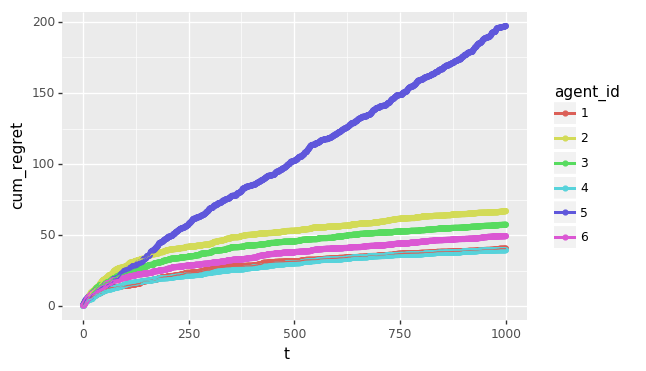

<ggplot: (8741316144977)>


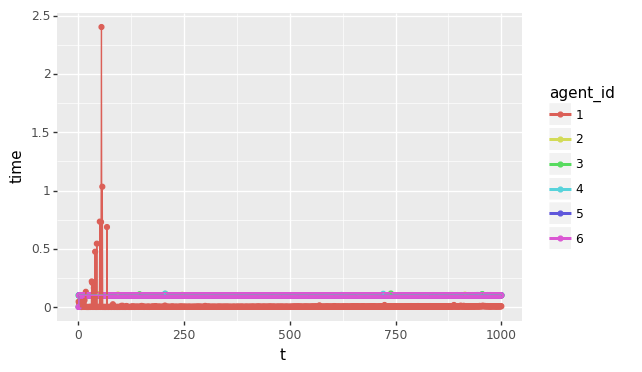

<ggplot: (8741316144937)>


([[      action_id agent_id  cum_optimal  cum_regret  instant_regret     t  \
   0             1        1     0.999878    0.348666        0.348666     1   
   1             2        2     0.999878    0.472116        0.472116     1   
   2             3        3     0.999878    0.284388        0.284388     1   
   3             4        4     0.999878    0.018020        0.018020     1   
   4             5        5     0.999878    0.957065        0.957065     1   
   5             6        6     0.999878    0.390354        0.390354     1   
   6             7        1     1.965963    1.051960        0.703293     2   
   7             8        2     1.965963    0.472116        0.000000     2   
   8             9        3     1.965963    0.997958        0.713570     2   
   9            10        4     1.965963    0.078412        0.060392     2   
   10           11        5     1.965963    1.300448        0.343383     2   
   11           12        6     1.965963    0.390354        0.00

In [9]:
#https://stackoverflow.com/questions/9031783/hide-all-warnings-in-ipython
make_agents = [make_laplace_agent,
               make_pgts_agent,
               make_best_langevin_agent,
               make_mala_agent,
               make_best_sgld_agent,
               make_best_sagald_agent]
                #,make_mala_agent_untimed]
simple_compares(make_agents, num_articles, dim, var, 1000, [301], verbosity=verbosity)
#simple_compares(make_agents, num_articles, dim, var, 1000, range(100,105), verbosity=verbosity)

In [10]:
time_limit=0.01
# We will tune the Langevin, SGLD, and SAGA-LD agents.

make_langevin_agent = lambda hypers: BasicLangevinTS(num_articles, dim, [0]*(dim), cov=None, 
                                              step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim), n_steps=9999,
                                              time = time_limit,
                                              init_pt=None, verbosity=verbosity)
make_mala_agent = lambda: MalaTS(num_articles, dim, [0]*(dim), cov=None, 
                                 step_size=lambda t: 0.1/(1 + t * np.sqrt(dim*var)/dim), n_steps=9999,
                                 time = time_limit,
                                     init_pt=None, verbosity=verbosity)
make_sgld_agent = lambda hypers: SGLDTS(num_articles, dim, [0]*(dim), cov=None, 
                                        step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim),
                                        batch_size = hypers[1],
                                        time=time_limit,
                                        n_steps=9999,
                                        init_pt=None, verbosity=verbosity)
make_sagald_agent = lambda hypers: SAGATS(num_articles, dim, [0]*(dim+1), cov=None, 
                                          step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim),
                                          batch_size = hypers[1],
                                          time=time_limit,
                                          n_steps=9999,
                                          init_pt=None, verbosity=verbosity)

# Untimed MALA agent is used as baseline.

make_mala_agent_untimed = lambda: MalaTS(num_articles, dim, [0]*dim, cov=None, 
                                         step_size=lambda t: 0.1/(1 + t * np.sqrt(dim*var)/dim), n_steps=500,
                                         init_pt=None, verbosity=verbosity)

# Use default settings for Laplace agent for now (would be nice to tune this too). Not time-restricted.
theta_mean = 0
theta_std = 1
epsilon1 = 0.01
epsilon2 = 0.05
alpha=0.2
beta=0.5
tol=0.0001
make_laplace_agent = lambda: LaplaceTSLogisticBandit(num_articles, dim, theta_mean, theta_std, epsilon1,
                                                      alpha,beta,tol, verbosity=verbosity)

# PG-TS has no parameters to tune

make_pgts_agent = lambda: PGTS_Stream(num_articles, dim, intercept=False, context_has_constant=False, 
                                      n_steps=9999, time = time_limit, verbosity=verbosity)
make_best_sgld_agent = lambda: SGLDTS(num_articles, dim, [0]*(dim), cov=None, 
                                        step_size=lambda t: 0.01/(1 + t * np.sqrt(dim*var)/dim),
                                        batch_size = 32,
                                        time=time_limit,
                                        n_steps=9999,
                                        init_pt=None, verbosity=verbosity)
make_best_sagald_agent = lambda: SAGATS(num_articles, dim, [0]*(dim), cov=None, 
                                          step_size=lambda t: 0.05/(1 + t * np.sqrt(dim*var)/dim),
                                          batch_size = 32,
                                          time=time_limit,
                                          n_steps=9999,
                                          init_pt=None, verbosity=verbosity)

make_best_langevin_agent = lambda: BasicLangevinTS(num_articles, dim, [0]*(dim), cov=None, 
                                              step_size=lambda t: 0.1/(1 + t * np.sqrt(dim*var)/dim), n_steps=9999,
                                              time = time_limit,
                                              init_pt=None, verbosity=verbosity)

theta [ 0.33195582 -0.02445618 -1.21213721  1.71804926 -1.06018494  0.80991345
 -0.61970449 -0.01722301 -0.23189891  2.12136524  0.35055357 -1.30820682
  0.15724633 -0.95700341 -0.40405858 -0.24800724 -1.06713048  1.45676104
 -0.74927439 -1.33304686]
Experiment: Step 0
 Laplace sample: array([-0.1771331 , -0.76841701, -0.86718545,  0.6939461 ,  0.10053725,
       -1.93194158, -1.20310893,  2.51244758, -0.70619216, -1.03396606,
        0.71341974,  0.75968429,  0.14938203,  0.83168023, -0.93231135,
        0.32209262,  1.86663963, -0.89137851,  0.64858231,  1.01936553])
 Sample: array([-1.39303222,  0.50786373, -0.18162186, -0.07648202, -0.21491949,
        1.27225582, -2.16911091,  1.25938292,  0.85957501, -0.28662745,
        0.38647525, -1.71145821, -0.59218992,  0.15497521,  0.81683639,
        0.62159063,  1.24511432, -0.35582992, -0.44557056, -0.75515418])
 Sample: array([-0.42637901, -0.21771489,  0.38554685,  1.07079277, -0.72979443,
       -0.54673669,  1.26226417,  0.8405234 ,

 Sample: array([ 1.67976276, -0.09029263,  1.94534453, -0.20279858,  0.58509946,
       -0.81741245, -1.73446927,  2.45496445, -0.32736203, -0.46054963,
       -0.34512272, -1.95049947, -1.77889229, -0.85648284,  0.7099719 ,
        0.59192158,  1.10351586, -0.02883063, -1.21970607, -0.25359452])
 Steps taken: 64
 Sample: array([-0.02175383,  0.0332769 ,  1.0686337 , -0.26764354,  0.7226907 ,
        1.00147546,  0.46040234,  0.40744148,  0.30981625, -0.27846426,
       -0.11161708,  0.02377088, -0.50060812, -0.81180555,  0.08945049,
       -0.87128526, -0.91750002, -0.13898557, -0.05873216, -0.53741086])
 Accept proportion: 0.115385
 Steps taken: 26
 Sample: array([-2.83697733, -0.89210396,  0.39956523, -0.18572128,  0.08433132,
        0.07507157, -1.05975105,  0.08636411, -0.31569715, -0.53888657,
        1.67951374, -1.33110807,  0.96287874, -0.82795328, -0.12902047,
        0.18022929, -1.37191364,  0.74637429,  0.96349742,  1.50447505])
 Steps taken: 93
 Sample: array([-0.0178904

 Sample: array([-2.08959504,  0.60869981, -1.66815047,  1.22547477, -0.58870241,
       -0.88120769,  1.76308206, -2.11537417, -0.76187083, -0.8285533 ,
       -1.90674229, -0.49464356,  0.27671816,  0.81087592,  0.8122914 ,
        1.17401901, -0.91025684, -0.01321953, -2.00539216, -0.00520851])
 Steps taken: 86
Experiment: Step 10
 Laplace sample: array([ 4.00578937,  1.60716318, -3.77208957,  4.1302855 ,  2.76428719,
        7.0398507 , -4.29676532,  3.29725217, -1.26700191, -2.08422916,
        7.76537384, -3.67719027, -1.13711054, -5.45836208, -1.48357055,
       -0.12062797, -0.23162883, -1.9185483 , -2.71715726,  2.82851721])
 Steps taken: 11
 Sample: array([ 0.65290128, -0.32937781, -0.67490829, -1.24642138, -0.892937  ,
        1.44088849,  0.29886243, -3.44096595, -1.16690877, -0.58080905,
       -1.9341165 , -0.5270151 , -1.15697287, -0.11045572, -2.48444146,
        0.28432893,  0.15169971, -0.3618577 ,  0.63520733,  1.2800216 ])
 Sample: array([ 0.64789545, -1.4540107 , -2

 Steps taken: 18
 Sample: array([-0.25594413, -0.87718638, -1.60299957, -0.14382904,  0.2842103 ,
        1.24974108, -0.21233343,  0.60701137,  1.44554096,  1.89644658,
       -1.24663967, -1.01485534, -0.39779215, -0.29254098, -0.79699675,
        0.20485716, -0.18736999,  0.4984795 ,  0.42971835,  0.03578067])
 Sample: array([ 1.0223672 , -0.4910078 , -0.0151789 , -0.53138998,  0.99209679,
        0.68420651,  1.95239629,  0.87403295, -1.05347429,  1.2386578 ,
        1.82832367,  1.13730513,  0.58842255, -0.01546763,  1.16073804,
       -1.77495191, -0.53431204, -0.75754216,  0.15101328, -0.29749006])
 Steps taken: 111
 Sample: array([ 1.56668477,  0.68922347, -0.07545501,  0.68068047,  0.54130643,
       -0.20759492, -0.74117764, -0.43134754,  0.63610012,  0.41527049,
        0.25655215, -0.55308076, -0.98877328, -0.0569337 , -0.12401794,
        0.83225567, -0.57270847,  0.6219053 , -1.12855342, -1.60936583])
 Accept proportion: 0.240000
 Steps taken: 25
 Sample: array([ 0.343083

 Steps taken: 35
 Sample: array([-1.45879328,  0.17414399,  0.52047124,  2.05153547,  0.81268661,
       -0.19194059, -0.16395377, -1.85623433, -1.4073732 ,  0.80639748,
        0.98555696, -0.60227907, -0.59184309, -0.30858461, -2.03094143,
       -0.82138632, -0.88982872, -0.89443171, -1.02780777,  1.14916269])
 Sample: array([ 0.16427175,  1.11230402,  1.00295936, -0.4963659 , -0.03640096,
       -0.05610479,  0.69967941, -0.41161211, -1.12018867, -1.18073211,
        0.4465928 , -0.05062095, -0.4324297 ,  0.51323208,  0.40147714,
       -1.12438492, -0.25489845, -0.90706347,  0.01595237, -0.86009831])
 Steps taken: 108
 Sample: array([ 0.36639618,  0.24831973, -1.11762531,  0.33378101, -0.00966325,
       -0.06929977, -0.03232109, -0.45204833,  0.69372692, -0.11821482,
        0.31246217,  0.17790553,  0.06945344,  0.28954623,  0.78405629,
        0.75914299, -0.45591864,  0.33641116, -0.5256048 , -0.60717741])
 Accept proportion: 0.275862
 Steps taken: 29
 Sample: array([ 1.659014

        2.46909   , -1.23950843, -0.60135636, -0.47034653,  0.71770626])
 Sample: array([ 0.73449928,  0.38413381, -2.16858154, -0.63995915,  0.11550729,
        0.67818888,  0.50068949, -0.47132188,  0.04340818, -0.39152569,
       -0.02003332, -1.04575897,  1.21456795, -0.89289244,  1.12662121,
        0.95830526, -0.25038296, -0.16387007, -1.69387732, -0.33900903])
 Steps taken: 73
 Sample: array([ 1.10289573, -0.21585794,  0.11837261,  0.11352566, -0.08137811,
       -0.18170818,  0.05674074, -0.2037283 , -0.68073111, -0.21714407,
        0.14212415, -0.54913466,  0.52102957,  0.05185093,  0.07602707,
       -0.0711147 , -0.3261295 ,  0.8748446 , -0.60931636, -0.46279375])
 Accept proportion: 0.444444
 Steps taken: 27
 Sample: array([-0.22362569, -0.12686442,  2.03744683, -0.7106629 , -1.79502891,
        0.32208687,  0.747073  ,  0.16757321,  0.09385586,  1.80130683,
        0.17835294, -1.58027683, -1.49927562, -0.26896833,  1.58461756,
       -0.78691331, -0.67930004,  1.4684603

 Steps taken: 16
 Sample: array([-0.43169509, -0.78262663,  1.17545418, -1.02867731, -1.34974235,
        0.16064261, -0.86556842, -1.54044688, -0.76156251, -0.21924767,
       -0.55335809, -1.66531093, -1.4596642 , -0.0477894 ,  0.26400492,
        0.33912376, -0.2562373 , -0.11903294, -0.89393489,  0.10040261])
 Sample: array([ 2.83575292, -1.53023688, -1.55280622, -0.0656998 ,  1.52203629,
        1.74362235,  1.98584868,  0.3537013 , -1.50783003, -0.28659465,
        0.70098638,  0.04492515,  0.29192202, -0.23754725,  1.21718215,
        0.32869949, -0.26886613, -0.27647085, -3.29830453, -0.11800174])
 Steps taken: 82
 Sample: array([ 1.34393235,  0.0844171 , -0.52302883,  0.50257741, -1.08250523,
       -0.06405463, -0.10601567, -0.84082348, -0.64911034,  0.44666967,
       -0.20328926, -0.42669437,  0.35914717, -0.11571093, -0.22255884,
        0.10752889, -0.43297227,  0.91972342, -1.33188055, -0.55063509])
 Accept proportion: 0.392857
 Steps taken: 28
 Sample: array([ 0.4631881

 Sample: array([-0.23792229,  1.81563322,  0.13613083,  0.64559045, -0.4417138 ,
        1.25708874,  0.04731414,  2.01197491,  0.08083562, -1.57677667,
        1.49872192,  1.19050252,  1.32184869,  0.34006454, -0.2534246 ,
       -0.35640138, -0.92974695, -0.6070448 , -0.01433911, -0.90689534])
 Steps taken: 80
 Sample: array([ 0.56760219, -0.56013779,  0.07417726,  0.87699938, -0.43505357,
       -0.76449298, -0.84486258, -0.3260554 ,  0.13261692,  0.59736299,
       -0.32557945, -0.58403333,  0.43423972,  0.0694246 , -0.82774204,
        0.56923165, -0.03098777,  0.52111941, -0.20166725, -0.38467787])
 Accept proportion: 0.428571
 Steps taken: 28
 Sample: array([ 0.41309596, -0.48648907, -0.22237804,  1.17087093, -0.43046358,
        0.88852137,  0.0311407 ,  1.42639578,  0.04919703,  1.20183869,
       -0.49902979, -1.72937351,  0.75184515, -1.19633831, -0.64846904,
       -0.36637708, -1.95577582,  0.81838034, -1.2718635 , -1.03616869])
 Steps taken: 71
 Sample: array([ 0.8279693

 Sample: array([ 0.31652311, -1.21805422, -0.78049456,  0.32124168,  0.82138565,
        0.68609816,  0.61135593,  0.5964453 , -0.12828718,  0.67528717,
        0.01521686, -2.59996241, -0.2280664 , -1.31151829,  0.38829232,
       -1.04785136, -0.50764579,  0.58012113, -1.83177813, -0.59569645])
 Steps taken: 29
 Sample: array([ 0.34265693, -0.42404176, -0.09953276,  0.46013754,  0.47491664,
       -0.9701618 , -1.48482854, -0.67329581,  1.34475599,  0.62234685,
        0.25208609, -0.4248596 , -0.8234971 ,  1.20402463, -1.02858621,
       -1.22417099, -0.43637471, -0.66861278, -2.16218136,  0.34691488])
 Steps taken: 51
Experiment: Step 42
 Laplace sample: array([  2.05193341,  -1.08368253, -28.73594853,   1.79528454,
         3.37006206,  12.97221087,   6.07484403, -11.11351234,
        -3.55079348,  10.99330415,   6.85195829, -23.54366349,
        -3.88605681, -10.74137474,  12.74586211, -11.12256181,
        -7.81007399,   1.56740114, -22.88082156,   4.82606593])
 Steps taken: 15


 Sample: array([-0.18436158, -0.48206215, -0.19461477,  0.05353567, -0.04763476,
        0.59932738, -0.78664457,  0.29751264, -0.30578863,  0.20802039,
        0.57759563, -2.09476364,  0.42507095,  0.19203451,  0.20910898,
       -0.56241256, -1.36502387,  0.11089928, -0.28278694, -0.12393981])
 Steps taken: 37
 Sample: array([ 0.7954114 , -0.23370701, -2.18544647,  1.15612074, -1.22266482,
        1.20448413, -1.6183374 ,  0.01857975,  1.33070228, -0.10982595,
        0.11907877,  0.63202998,  0.41283205, -0.05048537, -0.68610862,
        0.89688264, -0.25122495,  0.39292226, -1.80220522, -1.56725698])
 Steps taken: 40
Experiment: Step 48
 Laplace sample: array([  2.96417333,   0.57796304, -27.58772393,   2.20932838,
         1.83070498,  11.1927334 ,   4.96813731, -10.71479498,
        -2.66073718,  10.77827767,   7.9045072 , -21.71061565,
        -4.63062308,  -9.0927906 ,  10.13472476, -11.27195129,
        -7.0050648 ,   2.52971864, -22.4966318 ,   6.48500057])
 Steps taken: 10


 Laplace sample: array([  4.4290926 ,  -0.29768747, -27.70149591,   3.28865921,
         2.44653012,  11.05160063,   6.56411451,  -9.27057504,
        -2.37369765,   9.6388591 ,   7.92765397, -23.15613345,
        -4.51921115, -10.47329287,   9.82335732, -11.50404514,
        -5.99073702,   3.42708342, -22.91225859,   5.0904013 ])
 Steps taken: 10
 Sample: array([-1.13088924, -1.75218106, -1.36987219, -0.58645129, -0.22834993,
       -0.42001772, -0.75157374, -0.40016158, -1.82062336,  0.14180113,
       -0.66567873, -1.67656742,  0.10351258, -0.413424  , -1.07932298,
       -1.74561664,  1.22273124,  0.16486402, -0.55619019, -1.73350286])
 Sample: array([ 0.70996636,  0.70421653, -1.96429429,  0.44994749,  0.16971069,
       -0.2594737 ,  0.84285933, -0.49801018,  0.57884307,  2.40846281,
       -2.14657805,  0.33376475,  1.84984285, -2.34008372, -1.6872959 ,
       -0.25308132, -0.79865946,  0.18656741, -1.23123   ,  0.01341268])
 Steps taken: 59
 Sample: array([ 1.27992563,  0.09503

 Sample: array([ 1.3761706 , -0.35523532, -1.03159607,  1.02369075, -0.97051437,
       -0.20651031, -0.24760234, -0.16129105,  0.03371461,  0.37332933,
       -0.5028557 , -0.89774426,  0.114496  , -0.67842196, -0.44877951,
       -0.77257714, -0.91967544,  2.09487031, -0.6405719 , -0.24173578])
 Accept proportion: 0.461538
 Steps taken: 26
 Sample: array([-1.1504333 , -0.77650077, -0.20691177, -0.3583046 , -1.04447447,
       -0.31777424, -0.88505668,  2.00512947, -0.04246147,  1.04818127,
       -0.01883188, -1.71532032,  0.22170605, -1.58691628, -1.11062742,
        0.52195506, -2.38215711, -0.83531765, -1.45128427, -1.58990961])
 Steps taken: 59
 Sample: array([ 0.49759707,  0.10033181, -1.03072855,  1.72959696,  0.63784521,
       -0.1421798 , -1.27109982, -1.55414822, -0.17906105,  1.34453737,
        0.33023593,  0.45524007,  0.5741711 ,  2.05178423, -0.2134777 ,
       -0.15182788, -2.32651756, -0.46730855, -1.34751324, -0.03606088])
 Steps taken: 56
Experiment: Step 59
 Lapla

 Steps taken: 16
 Sample: array([ 0.05387295,  0.20943951, -2.63085455,  0.59854468, -0.71836117,
        1.92226072,  0.80221251, -0.64257193, -0.26306574, -0.57247165,
       -0.93284265, -0.41514803,  1.04128025, -0.80886352, -0.05184311,
        0.01541329,  0.40525146,  0.72821626, -0.37601   ,  0.54665308])
 Sample: array([-0.26658801,  1.77758134, -0.82720829,  1.39984724,  0.0977865 ,
       -0.51184862,  0.26735077, -0.03928386, -1.03232742,  0.40725818,
        0.09111755,  1.20724647,  0.61769054, -2.44362211,  0.55131193,
        0.36650669, -2.01423629, -0.56535673, -0.75197473, -0.56037139])
 Steps taken: 87
 Sample: array([ 0.77813523,  0.12962298, -1.28501268,  1.52683828, -1.51790397,
       -0.066444  , -0.73945612, -0.58490644,  0.28197854,  0.99995864,
        0.30495135, -0.58386025,  0.19192937, -0.41395106, -0.50904797,
       -1.0103957 , -1.28785986,  1.12504377, -0.74781051,  0.07046574])
 Accept proportion: 0.600000
 Steps taken: 20
 Sample: array([-1.0169170

 Sample: array([ 0.98036061,  1.108253  , -1.86202533,  0.69338067,  0.33281597,
       -0.25485118, -0.016602  ,  0.08842698,  0.7262036 ,  2.62644269,
        0.14799171, -1.90209484,  0.40888055, -1.00298832,  1.79327837,
       -0.11982161,  0.33154505,  0.35781532,  0.18366472,  0.01959644])
 Steps taken: 47
 Sample: array([-0.83632139,  0.78076887,  0.81156851,  1.24437836, -1.77687707,
        0.97698914, -0.52711633, -0.14532321,  0.6485754 ,  0.94242934,
       -0.81397012,  0.58889305,  1.21947274,  0.76065715, -0.45183854,
        0.1029739 , -1.32017717,  0.31416533,  0.06701956,  0.24806811])
 Steps taken: 52
Experiment: Step 72
 Laplace sample: array([ 1.59114535,  1.13812301, -3.03396959,  2.30601171,  0.45590491,
        0.97432088, -0.3430866 , -1.59254379, -2.04237994,  0.58144935,
       -1.71512931, -2.08160934, -2.42237743, -0.44274568,  0.4132541 ,
       -0.70420686, -1.84167476,  0.12361256, -2.83835061,  0.74037983])
 Steps taken: 24
 Sample: array([-0.81969883

 Laplace sample: array([ 1.67636276,  0.26362007, -3.70840525,  2.275733  , -0.95354831,
        0.35562767,  0.41734298, -1.22545951, -0.5622263 ,  0.23770417,
       -0.47701326, -3.62625771, -2.26315788, -2.62829045,  1.19706646,
       -1.05698442, -1.43234659, -1.67283148, -3.34353066,  2.82770396])
 Steps taken: 10
 Sample: array([-0.13216124, -1.22184741, -1.34090941,  1.30460819, -0.97607241,
        0.60796294,  0.17516927, -0.42481394, -0.69260252,  0.50632896,
        0.17711859, -1.0056363 , -0.65095196, -0.89229961, -0.35085304,
       -1.29383044,  0.52766117,  2.20363493, -0.01218888, -0.95133412])
 Sample: array([ 0.51028805, -0.02838922, -0.70340968,  1.54513619,  0.28860112,
       -1.11505504,  0.33518003, -0.33265289, -0.82650145,  0.5051533 ,
        1.43941615, -0.1096951 ,  0.43755877, -0.42012851,  0.54717025,
        1.42648263, -1.59519762, -0.05780244, -0.37893135,  0.32664892])
 Steps taken: 56
 Sample: array([ 1.38947452, -0.6401858 , -1.89539875,  1.045614

 Sample: array([-0.19355062, -0.12464444, -2.31974089,  0.67877956, -0.9686737 ,
        0.37820766, -0.83234822,  0.40752114,  0.46923962,  0.70822199,
       -1.14000881, -1.55652726,  0.19867461, -0.19643648,  1.02942924,
        1.38113567, -0.87126852, -0.55848068, -1.14714516, -1.60899277])
 Steps taken: 62
 Sample: array([ 1.09938206,  0.13514765, -0.41946501,  0.33045248,  0.38893795,
        1.21794065, -1.33199092,  0.0620066 , -0.37259424,  1.16448739,
       -0.19480979,  0.8203158 , -0.00691151, -1.19527307, -1.54607506,
        0.23537087,  0.24257554,  0.04115236, -1.32422157, -1.01105849])
 Steps taken: 54
Experiment: Step 82
 Laplace sample: array([ 0.63539919,  0.58286721, -4.45391507,  0.83037026, -0.35749504,
       -0.03717779, -0.64977382, -0.36768248, -0.25731301,  1.96762075,
       -0.42388982, -4.16476808, -0.83202532, -2.39315966,  0.74835381,
        0.70476169, -2.05470834, -0.62928745, -1.77153786,  0.48875733])
 Steps taken: 9
 Sample: array([-0.17504519,

 Sample: array([ 1.03061611, -1.031427  , -0.83798781,  0.7282548 , -0.21829144,
        0.28279852, -0.24119809, -0.19417144,  0.41122236,  1.44514077,
        0.21338089, -0.48401893,  0.35290805, -0.12243765, -0.69457782,
       -0.27408457, -0.88700113,  1.3938436 ,  0.00295189, -0.99548702])
 Accept proportion: 0.250000
 Steps taken: 16
 Sample: array([-0.92732273, -2.14455115, -1.38945145,  1.17804292, -1.92390715,
        0.5181592 ,  0.19406593,  0.64728444,  0.39916629,  1.19162377,
       -1.8311673 ,  0.28844142,  0.71521921, -0.52517702, -0.69321779,
        2.19956077, -0.56736768,  1.03190483, -1.33027502,  0.15958206])
 Steps taken: 63
 Sample: array([ 0.50309129,  0.93307736, -0.62165744,  0.97881124, -0.23742476,
        0.61132711, -1.58786727, -0.96801622,  0.46215105,  1.24233273,
        0.9778953 ,  0.06849547, -0.70364647,  0.87080119, -1.45037323,
       -0.52416833, -0.41311973, -0.18332194, -0.95546816,  0.02382292])
 Steps taken: 41
Experiment: Step 88
 Lapla

 Laplace sample: array([-0.27656139,  1.37552166, -4.31030935,  1.7909452 , -0.44857873,
        1.53158466, -2.48726339,  0.52037952,  0.59139515,  3.89256433,
        0.23695085, -3.07558184, -0.32466039, -2.18145568, -0.60521934,
        0.791571  , -0.79873954,  0.14987248, -2.42417366,  0.87788303])
 Steps taken: 9
 Sample: array([-0.09881683, -0.72456128, -0.79996422,  1.20077105,  0.36579389,
        1.48729724, -0.92147868, -0.22164823, -0.72386707, -0.87877147,
       -0.91872513, -1.62499392, -0.15093263, -0.81504715, -0.02574384,
       -0.91368178,  0.01100217,  2.58193167, -1.66964784, -1.06506922])
 Sample: array([-0.11595584,  0.58446456, -1.33447843,  0.09895363,  0.32460681,
       -0.1387506 , -0.90572253, -0.17253652, -0.81124722,  2.39031831,
       -0.16443215, -0.30353042,  2.49468696, -0.84200759, -1.02538868,
        0.47668951, -1.14037951, -0.24035398, -0.84689547, -1.44234055])
 Steps taken: 43
 Sample: array([ 0.65420262, -1.15369157, -1.27385568,  0.8755052

 Sample: array([ 0.39807382,  1.05615057, -0.89515059,  1.58089391, -0.29165881,
       -0.71558743,  0.04967444, -0.36520345, -0.66699522,  0.79404321,
        0.9907828 , -1.4422752 ,  0.56007002, -2.16056409, -0.3282595 ,
        1.53120607, -0.91094464,  0.43726142, -1.57194935, -0.02413374])
 Steps taken: 73
 Sample: array([ 0.71939422, -0.73550843, -1.43642492,  0.53445349, -0.79110476,
        0.18554397, -0.65052046,  0.12188797,  0.47608105,  1.53763613,
        0.18737777, -1.04319241,  0.30037175, -0.17756108, -0.36901173,
       -1.09591956, -0.43395455,  1.19728883, -0.12210068, -0.73956984])
 Accept proportion: 0.300000
 Steps taken: 20
 Sample: array([-0.43577009, -1.72366743,  0.22220462,  0.50992135, -1.35559343,
       -0.51950729, -1.48667905, -0.56383389,  0.0070972 ,  0.59066644,
       -1.28697901, -0.63982913,  2.02381819,  1.21978237, -0.76591496,
        0.82296956, -0.97245633,  1.88412974, -1.91528763, -0.537033  ])
 Steps taken: 72
 Sample: array([-4.4063632

 Sample: array([ 0.96317809, -0.55496209, -0.56096947,  1.34192052, -0.95674336,
        0.5572112 , -0.65967899, -0.11483009,  0.36018449,  1.30513004,
        0.78362225, -0.72317662,  0.40742863, -0.38405642, -0.74527512,
       -0.56476646, -1.19550475,  1.30627561, -0.35494241, -0.64892169])
 Accept proportion: 0.375000
 Steps taken: 16
 Sample: array([-0.52585567, -0.23488216,  0.13750955,  1.06771506, -1.525569  ,
       -0.63474563, -0.09595646,  0.47205741,  0.37892903,  1.0806032 ,
       -1.02469078, -0.98465904,  0.13149128,  2.20174379, -0.54998451,
        0.68168776, -0.98942498,  1.90421855, -1.82009716, -0.21655466])
 Steps taken: 52
 Sample: array([-0.18590572, -0.7829049 , -1.52974295,  0.89522186, -1.19092367,
        0.85026344, -0.80048798, -0.79394994, -0.23246141,  1.93015324,
       -0.57981166, -0.10276527, -0.93161723, -0.94814158, -0.65793944,
        1.45925832,  0.2804898 ,  0.35513116, -1.41919948,  0.83565975])
 Steps taken: 45
Experiment: Step 104
 Lapl

        0.45180307,  0.25128987,  2.68917048,  0.04303847, -0.5067793 ])
 Sample: array([-0.26585483,  0.48083078, -1.27968971,  0.96230354,  0.28357898,
        0.36269693, -0.74784248, -1.30557778, -1.14286502,  0.66271964,
        0.16772482, -1.32408862, -0.24622859, -1.18004877,  0.1336309 ,
        0.53279133,  0.72217114,  0.63318235, -2.39302572, -1.24327768])
 Steps taken: 49
 Sample: array([ 0.31730508, -0.63365928, -2.14623077,  0.95470301, -0.68517305,
        0.38125569, -0.40811375, -0.13349247,  0.73607355,  1.15910352,
        0.71499682, -0.54468479, -0.13723885, -0.60091918, -0.50076182,
       -0.54011813, -0.86819024,  1.08343674, -0.65271765, -0.92106678])
 Accept proportion: 0.666667
 Steps taken: 18
 Sample: array([-0.21810553, -0.36502104,  0.03163854,  0.29961439,  0.03084398,
       -0.03291752, -0.07884206,  0.01810396,  0.6868063 ,  0.4766624 ,
       -1.27984906, -1.0178273 , -0.82315341, -0.87344218, -0.41566277,
        1.16354169, -0.63231337,  1.8756510

 Steps taken: 14
 Sample: array([-0.46185381, -0.74136293, -0.83284267,  1.69812538,  0.13638071,
       -0.06685376, -0.77194513, -1.26692626, -1.04082019,  0.17234048,
        0.46813512, -1.77687097, -0.64059681, -1.29820597, -0.52393394,
        0.00685058, -0.4211821 ,  2.11837388, -0.38009319, -1.96643435])
 Sample: array([-0.15142013, -0.5879828 , -0.56865334,  1.30355694,  0.8892282 ,
        1.23357023, -0.45327623, -1.3326956 , -0.83931833,  1.1351036 ,
        0.20924333, -1.72577034,  0.14695248, -0.96117392,  0.54915704,
        0.79408723, -0.28062964,  1.21477951, -1.54312725, -0.38646776])
 Steps taken: 56
 Sample: array([ 0.96066485, -0.82393031, -0.97172327,  1.56151555, -0.59100214,
        0.96510431, -0.03732924, -0.43860439,  0.21870113,  1.70732823,
       -0.10770354, -1.17172387,  1.09485225, -0.38204461,  0.11058889,
       -1.39902211, -1.09356456,  0.9077906 , -0.66599666, -1.15793483])
 Accept proportion: 0.800000
 Steps taken: 15
 Sample: array([-0.4796565

 Sample: array([-0.29021918,  0.20469041, -1.46893037,  1.03862922, -0.13001357,
        0.43092743, -0.3155282 , -0.43572015, -0.35557121,  2.32791711,
        0.56161958, -0.57578422,  0.00698548,  0.55809295, -0.07729989,
        0.67267215, -0.93595756,  0.67744501, -1.17043123, -0.67041937])
 Steps taken: 38
Experiment: Step 119
 Laplace sample: array([ 0.29716099,  1.11456064, -1.87774583,  2.76081873, -0.38558194,
        0.01718255, -0.14644566, -1.05079974, -0.14768418,  0.44930885,
       -0.36258187, -2.70900456, -0.27687496, -1.67630175,  0.40971137,
       -0.39598629, -0.1037913 ,  0.3698184 , -0.79367734,  0.96560978])
 Steps taken: 27
 Sample: array([-0.62689131, -0.04769759, -2.15108645,  0.67804546, -1.37849256,
       -0.721402  , -0.2479218 , -0.14348807, -1.70249781, -0.47883881,
        0.39053561, -2.88218357,  0.31969089, -0.17133794, -0.10455448,
        0.31983086,  0.20190386,  1.90615238, -0.49256286, -1.28947003])
 Sample: array([ 0.500576  , -0.81458951, -

 Sample: array([ 0.46253871, -0.92951082, -1.21576019,  0.85228109, -1.03536244,
        0.0084502 ,  0.33301918,  0.35823661,  0.29280124,  1.38840232,
       -0.12196866, -0.32414873,  0.3071573 ,  0.22861445, -0.12557448,
        0.04597418, -0.84363972,  0.61241751, -1.60007714, -0.01836661])
 Steps taken: 38
Experiment: Step 125
 Laplace sample: array([ 0.08316689,  0.47286822, -2.71220453,  1.56831915, -0.1179858 ,
        1.05945886, -0.58948727, -0.40202284,  1.04570293, -1.77451683,
       -0.11849648, -3.13254687, -0.60413112, -2.1718519 , -0.82933326,
        0.28675024, -1.11409976, -1.15187596, -0.24642374, -0.76660327])
 Steps taken: 1
 Sample: array([ 1.20756497, -1.53469252, -1.04901567,  0.37552529, -0.77722492,
       -0.92987577,  1.25246055, -0.78847757, -1.76958445,  1.54039618,
       -0.04763607, -1.93292131, -0.5972784 , -1.60541818,  0.01623543,
       -0.08184862,  0.05938124,  2.23593788, -0.92602067, -1.02265971])
 Sample: array([ 0.87617887, -0.39076036, -0

 Sample: array([ 0.98294563, -0.12512541, -0.7636609 ,  1.20787754, -0.54876369,
        0.31763539, -0.46281122,  0.32250307,  0.36721929,  1.49419782,
        0.23549132, -1.29839022,  0.36680276,  0.0365939 , -0.20676789,
       -1.06968923, -1.50744845,  0.62089466, -0.52481841, -0.06881549])
 Accept proportion: 0.400000
 Steps taken: 5
 Sample: array([-0.15532812, -1.34405188, -0.97489562, -1.43360989, -0.54911242,
        1.62249785, -1.04461987,  0.34542219, -0.9679458 ,  0.66365589,
        0.41623062, -2.10570385,  0.12930975, -0.14186831, -1.40689969,
       -0.79233949,  0.15790749,  0.83616296, -0.83385874, -0.04949409])
 Steps taken: 71
 Sample: array([-0.16662441,  0.61084491, -1.08597753,  0.42392536, -0.79503382,
       -0.5164044 , -0.53658593, -0.86221972,  0.82619838,  0.80595204,
       -0.09958507,  0.19708888,  0.67601777,  0.12358552, -0.85075983,
        1.12734578, -1.93320228,  1.39938297, -0.05068557, -0.2371713 ])
 Steps taken: 55
Experiment: Step 130
 Lapla

 Sample: array([-0.68939043, -2.03763532, -0.20166617, -0.46931103,  0.37496585,
        1.98759093, -1.39705504, -0.45886019, -1.32509749,  1.83179091,
       -0.41299675, -1.7220239 , -0.51817777, -0.22435237, -0.92841038,
        0.02859057, -0.35260641,  0.80303531, -1.51966396,  0.90754613])
 Steps taken: 45
 Sample: array([-0.41954803, -0.12398228, -1.71347264, -0.02293554, -0.27976121,
        2.10157807, -0.83778886, -0.08902482, -0.13031852,  0.86478269,
       -0.23038335, -0.19659404,  0.7310313 , -0.16399885, -0.03235653,
        0.05252812, -2.21706466,  0.66580886, -1.24095275, -1.10449078])
 Steps taken: 41
Experiment: Step 135
 Laplace sample: array([ 0.07035684, -0.18479387, -1.90840314,  2.62794769, -0.25554912,
        1.09966318,  0.08052728, -1.12330723, -0.74865734,  2.20062676,
       -0.21418806, -1.92285524, -0.32659183, -1.13502198,  1.12254347,
        0.09615275, -1.45371671,  0.69617345, -1.02764773, -0.51097575])
 Steps taken: 10
 Sample: array([-0.5592790

 Steps taken: 20
 Sample: array([ 0.95578557,  0.09392332, -2.64191109,  1.71127112, -1.40672393,
        0.86994457, -0.15859439, -1.43591395, -1.64008309,  1.24913143,
        1.64625512, -1.4915899 , -0.88655735, -1.08510478, -0.83357375,
       -0.4138705 , -0.23366876,  2.52567593, -0.99625722, -1.02734683])
 Sample: array([ 0.19467744,  0.95033575, -0.49160538,  1.03227437,  0.56383704,
       -0.70010791, -1.08889198, -0.89771595, -0.77587583,  0.53786324,
       -0.58853719, -1.00378632,  0.33817793, -1.45517938, -0.60384572,
       -0.00251142, -0.61542092,  0.32891103, -0.3727932 , -0.01165728])
 Steps taken: 16
 Sample: array([ 0.45220058, -0.34821206, -1.62137488,  0.95986378, -1.36228089,
        0.3271951 ,  0.03704191, -0.23496809, -0.0791775 ,  1.88657349,
        0.19466488, -0.92431396, -0.218745  , -0.81442751,  0.01199003,
       -0.74070604, -1.37349525,  1.23733082, -0.55078531, -0.62512953])
 Accept proportion: 0.500000
 Steps taken: 6
 Sample: array([-0.25735681

       -1.62925902, -0.37245071,  0.15118786, -1.88995268,  0.80265641])
 Steps taken: 5
 Sample: array([-0.76191429, -1.31472201,  0.15880168,  1.43282388, -0.8065914 ,
        0.24948909, -0.31243123, -0.10492647, -1.03530644,  2.02432216,
        0.66195595, -2.52573709, -0.82593202, -1.9728955 , -0.521983  ,
       -1.07745029, -0.25729051,  1.70791089, -0.58767517, -0.49779968])
 Sample: array([-0.34501128,  1.1944961 , -0.26065811,  0.62773015, -0.12432567,
       -2.00326805,  0.29269557, -0.66675413, -0.70715527,  0.4649382 ,
       -0.76069516,  0.23808765,  0.12286129, -1.19276694, -1.28045777,
       -0.47799832,  0.70185359, -0.11561844, -1.80302137, -1.49736705])
 Steps taken: 33
 Sample: array([ 0.77366846, -0.76826325, -1.85887097,  0.82136619, -0.64545469,
        0.58117642,  0.06055267, -0.45538971,  0.17411409,  1.49188623,
        0.1290076 , -1.30061341,  0.23987746, -0.89750936, -0.691292  ,
       -1.76673069, -1.08468675,  1.09396913, -0.65244138, -0.11223441])


 Sample: array([ 0.36669917, -1.87986748, -1.80571054, -0.75598263, -0.23256853,
        2.16563954, -1.46774916, -0.94557316, -0.99490817,  2.91131512,
        0.07887146, -1.35364604, -0.10574755,  0.59904505, -0.08233151,
        0.28020508,  1.50339883,  0.7702263 , -2.72383728,  1.87149114])
 Steps taken: 69
 Sample: array([-0.03264497,  0.12304007, -2.07542757,  1.66823335, -0.77692364,
        0.50899188, -1.37454697, -0.62439405,  0.32018401,  2.23337049,
        0.32499825, -0.15061764,  0.0389037 ,  0.1183182 , -0.05556365,
        0.90046901, -1.59539991,  1.84943698, -1.76102034,  0.26797648])
 Steps taken: 49
Experiment: Step 150
 Laplace sample: array([ 0.67901752,  2.00311583, -2.4671631 ,  2.90571232,  0.18869908,
        0.49311695, -0.9686944 , -0.36869207,  0.04149251,  2.75059568,
        0.5003904 , -2.15080761, -0.19949116, -0.88863093, -0.04126193,
       -0.86286324, -0.75814849,  0.82273777, -1.53780146,  0.0152637 ])
 Steps taken: 26
 Sample: array([ 0.5224482

 Steps taken: 11
 Sample: array([ 0.18179537, -0.16350462, -0.60379702,  1.04692098, -1.6160142 ,
        0.88807071,  0.6160543 , -0.15345905, -0.5864797 ,  1.06077139,
        0.229125  , -1.27127795, -0.86269533, -1.4015349 ,  0.05064263,
       -0.18810533, -0.48463359,  1.78044965, -0.18594162, -1.84297831])
 Sample: array([ 0.62390579, -0.27592084, -1.34854108,  1.06719164, -0.25710069,
        0.98566733, -0.91174941, -1.28762881, -0.53431204,  1.39821249,
        0.11125818, -0.5593279 ,  1.70338993, -0.33169955, -1.16356528,
        0.11351665, -0.64523698,  0.70456835, -2.39759978, -0.46460103])
 Steps taken: 22
 Sample: array([ 0.66552841, -0.05366004, -1.46226132,  1.20640688, -0.90439256,
        0.49406539, -0.22441068, -0.66347892,  0.31574412,  2.12059204,
        0.0768281 , -1.88283938,  0.63338122, -0.58187449, -0.91816854,
       -1.00064788, -1.07631087,  0.69577234, -0.55942866, -0.71707504])
 Accept proportion: 0.625000
 Steps taken: 8
 Sample: array([-0.08906098

 Sample: array([-0.06887245,  0.23962205, -1.33713276,  1.16811025, -0.86397065,
        0.49451387, -1.99058695, -0.37482374, -0.23587809,  1.92191918,
        1.23393107, -1.17289842,  0.79660933, -0.31129464, -0.66334323,
        1.28158243, -1.01426725,  1.90530181, -0.90529277, -0.44087259])
 Steps taken: 43
Experiment: Step 160
 Laplace sample: array([-0.2192184 ,  0.37243703, -1.36071668,  2.09227514, -0.91314705,
        0.19529012, -1.22809212, -0.11213825, -0.17960079,  1.16917524,
        0.24317544, -2.12531026, -0.05543859, -0.08150639,  0.06944189,
       -0.15169236, -0.67828562, -0.61062707, -1.15531291,  0.40750485])
 Steps taken: 11
 Sample: array([-0.53313101, -1.24524805, -0.38276738,  0.37419122, -1.38061849,
        0.54716575, -0.34123828, -0.3635257 , -1.88012768,  1.01821356,
       -0.23975788, -2.54830346, -0.70159793, -1.3168607 ,  0.38106062,
       -0.55222426,  1.32988246,  1.71004257, -0.23233773, -1.72811985])
 Sample: array([ 0.35082768, -0.1860297 , -

 Sample: array([-0.60711213, -1.90418377, -0.33732833,  0.49185946, -0.22112345,
       -0.11436023,  0.00762766, -0.39177781,  0.89600826,  1.703246  ,
       -0.64458844, -1.14485512,  1.30030118, -0.65016852, -0.82454017,
       -0.34604394,  0.75411657,  0.1839121 , -1.18703814, -0.31170705])
 Steps taken: 72
 Sample: array([ 1.1711931 ,  0.3171277 , -2.12496683,  1.34687464, -0.94683505,
        0.71677643, -0.94835829,  0.5670926 ,  0.77579397,  1.40565344,
        0.30042997, -0.8670196 ,  0.69580414, -1.19284845, -0.43533527,
        0.3724419 , -1.04254197,  1.38186981,  0.28284444, -1.62807245])
 Steps taken: 57
Experiment: Step 165
 Laplace sample: array([ 0.08307595,  1.39561898, -2.07156829,  2.13854375,  0.42341545,
        0.1561073 , -1.35081445, -0.69747977, -0.74217856,  0.7457455 ,
       -0.80488079, -2.72764754,  0.33879742, -0.18951174,  0.01834587,
       -0.4443204 , -0.38321695,  0.85417523, -0.60998219,  1.19581425])
 Steps taken: 11
 Sample: array([ 0.4951811

       -2.04135203e-01,  3.50869941e-01, -7.87853843e-01,  5.43244422e-02])
 Steps taken: 46
 Sample: array([ 0.18731597, -0.01862306, -0.70593125,  1.60362026, -1.53457254,
        0.92762533, -0.79935234, -0.00759314,  0.01025634,  1.97376619,
       -0.12478405, -1.33980479,  0.10535668, -1.21198287, -0.41377116,
       -1.4371001 , -0.77670498,  0.95149618, -0.19552351, -0.75801483])
 Accept proportion: 0.625000
 Steps taken: 16
 Sample: array([-0.38296282, -1.25354612,  0.34968743,  0.7486174 , -0.44887679,
       -0.27184501, -1.07418147, -0.73466767,  1.13359731,  2.5154019 ,
       -0.37063705, -1.97641163, -0.14906446, -1.07847201, -1.07043379,
       -0.01974286,  0.37601987,  0.53534094, -0.50295466, -0.22437765])
 Steps taken: 64
 Sample: array([-0.12466401,  0.33154064, -1.90266828,  0.87554906, -0.55509932,
        1.05094012, -1.16522922, -0.34482967,  0.13484269,  1.80823795,
        0.21506922, -0.25869094,  0.3902717 , -1.06041451, -0.49466108,
       -0.04865   , -1.

Experiment: Step 174
 Laplace sample: array([ 0.64534192,  0.84361731, -1.54144661,  1.2800209 , -0.87132887,
        0.40851663, -1.50611023, -0.78909757, -0.10116702,  1.66639253,
       -1.14690772, -2.08998853, -0.22141088,  0.70562398, -0.23133711,
       -0.82052353, -0.60078516,  0.74178508, -1.00852358,  1.017482  ])
 Steps taken: 9
 Sample: array([ 0.31264676, -0.95318035, -1.27147245,  2.22447187, -1.54803919,
        0.32638685, -0.11696432,  0.22620039, -0.68949883,  1.08412654,
        0.36550068, -1.0392984 , -0.00743108, -1.29758334, -0.06415798,
       -0.44165518, -0.3738867 ,  1.92902012, -0.97107437, -1.32852332])
 Sample: array([ 0.01004247,  0.04968394, -1.22306945,  1.75848904,  0.63933107,
        0.04233074, -0.32074014,  0.06102656, -0.34109791,  1.306043  ,
       -0.3706505 ,  0.02289177,  0.07959103, -1.75881309, -0.14340053,
       -0.19995692, -1.6812573 ,  1.30019276, -1.78111063, -0.60544683])
 Steps taken: 19
 Sample: array([ 0.02445621, -0.54613236, -1

 Sample: array([ 0.11856164, -0.84150226,  0.42391451,  1.09646827, -0.73193314,
       -0.27724874, -0.8058118 , -1.19755004,  0.97177676,  1.76200629,
        0.28416465, -1.0075289 , -0.24259681, -1.2852336 , -0.52960859,
        0.57023849, -0.02035795, -0.96831124,  0.0893834 , -0.4060952 ])
 Steps taken: 21
 Sample: array([ 0.09528727,  1.37333444, -1.41640035,  1.61275288, -0.78920614,
        1.03447912, -0.3230831 , -0.40819229, -0.37794698,  1.65367532,
        0.10310865, -0.99357437,  0.34169101, -0.26597794, -1.31853169,
        0.68673738, -1.86524564,  1.29221713, -0.25833049, -0.55593711])
 Steps taken: 43
Experiment: Step 179
 Laplace sample: array([ 0.41737875,  0.23532428, -1.89189211,  0.31522577,  0.41836473,
        0.67660795, -0.90702443,  0.27097568, -1.47152224,  0.08418503,
        0.38898288, -1.54009082, -0.04977546, -0.33969965,  0.59786712,
       -0.3167742 , -0.40347386,  0.8271385 , -1.39775585,  0.48659812])
 Steps taken: 10
 Sample: array([ 0.6036285

 Sample: array([-0.13142983,  0.82169584, -0.99130301,  0.41330865, -0.62777372,
       -0.08190012, -0.98363044, -0.38705985, -0.99083249,  1.52737158,
       -0.77517532, -1.21141285,  0.6442304 , -1.85596787, -0.30833199,
        0.21331226, -0.67728408,  1.32695696, -0.35415055, -1.23554114])
 Steps taken: 22
 Sample: array([ 0.5060218 , -1.08884478, -0.9238164 ,  1.55424615, -1.3048347 ,
        0.04699842, -0.25812805, -0.03975656,  0.0793676 ,  1.73429206,
        0.71702092, -1.32807465,  0.53667408, -1.31547225, -0.19984244,
       -0.48163694, -0.90979817,  1.26496314,  0.1072821 , -0.63950327])
 Accept proportion: 0.875000
 Steps taken: 8
 Sample: array([-0.40911581, -0.89748906,  0.38751928, -0.38302798, -0.82044753,
       -0.45002954, -0.03219568, -0.27415442,  0.19070708,  1.63525804,
        0.64521776, -1.07208814, -0.06260426, -1.40073554,  0.18611833,
        0.10587204,  0.06025045, -0.35020999, -0.71658993, -0.76944806])
 Steps taken: 63
 Sample: array([ 1.08819477

       -0.02660744, -1.80330255,  1.22192663, -0.76398203, -0.1953321 ])
 Steps taken: 56
Experiment: Step 188
 Laplace sample: array([ 0.60957386,  2.19329839, -1.68547095,  1.9960358 ,  1.08083321,
        1.13147677, -0.54514476, -0.19794426, -0.90563289,  2.27796319,
       -0.18082716, -1.98426507, -0.24616063, -0.51063786,  0.72134212,
       -0.85609172, -0.73664933,  0.9858544 , -0.49470177, -0.01478084])
 Steps taken: 20
 Sample: array([-0.09351634, -0.168465  , -1.38448852,  0.96033685, -2.26235643,
        0.67366663, -0.19784268,  1.04597961, -0.57111535,  0.80155351,
       -0.21437087, -2.60626968, -0.88999607, -0.3767793 ,  0.88158948,
       -1.47234769, -1.05113492,  1.12556397, -1.48432518, -0.72812986])
 Sample: array([-0.38740567,  0.15841869, -0.52575913,  1.70912067,  0.08633707,
       -1.63983571, -1.45944928, -0.83364604, -0.66116511,  0.73060565,
       -0.4614826 , -1.78642528,  0.31671298, -2.15079154, -0.4002883 ,
        0.12559747, -0.17920108,  1.1904440

 Sample: array([-0.55095208, -0.2771008 ,  0.01746372, -0.08021221, -1.57511315,
       -0.1272882 , -1.06118163, -0.74156289,  0.36037103,  2.24035723,
       -1.02962439, -0.62539167, -0.44442779, -0.9822286 , -0.28442082,
        1.27909302,  0.5245127 ,  0.44145962, -0.73948646, -0.80130236])
 Steps taken: 69
 Sample: array([ 0.79501143,  0.6460332 , -1.850304  ,  1.08031756, -0.69768924,
        1.91654657, -1.44919077, -0.86206525, -0.62249236,  2.17330549,
        0.65290244,  0.09358274,  0.93959231, -0.54844194, -0.43128184,
        0.88065352, -0.00235003,  1.71958383, -1.12469874, -0.9388144 ])
 Steps taken: 53
Experiment: Step 193
 Laplace sample: array([ 1.00391855,  1.2579918 , -1.68743819,  1.11326621, -0.38803932,
        0.60123342, -1.0838167 ,  0.86226867, -0.37401661,  1.17608993,
       -0.80502547, -2.02051024,  0.17308415, -0.97451026,  0.44895839,
       -0.50263362, -1.33160601, -0.83457006, -0.53967581,  0.43904607])
 Steps taken: 10
 Sample: array([-0.3557440

 Sample: array([ 0.52048672, -0.19957692, -0.94403088,  1.85078644, -0.98798987,
        0.43964847, -0.35547151, -0.45872329,  0.60909673,  2.24372468,
       -0.04835179, -1.73364846,  0.63708848, -1.13985194, -0.23053382,
       -0.60708134, -0.93279101,  0.92292432, -0.37460026, -0.69146206])
 Accept proportion: 0.800000
 Steps taken: 5
 Sample: array([-0.44828111, -0.80690891, -0.24199332,  1.47974397, -0.60846952,
        0.03492393, -0.53935939, -0.27813574,  0.01248225,  1.61852318,
       -0.86655645, -1.21022851, -0.56780684, -0.56606243, -0.60289943,
        0.96068708,  0.45793338,  0.63168283, -0.38063981, -1.38169625])
 Steps taken: 56
 Sample: array([ 0.54520814,  0.1420163 , -2.64026661,  0.30517573, -1.32873159,
        0.91205591, -1.45718907,  0.3485547 , -0.13118311,  1.63231348,
        0.0648336 ,  0.28904725,  0.67012754,  0.22489244, -0.49622297,
       -0.12041381, -1.31045024,  1.73004959, -0.86786301, -1.09438063])
 Steps taken: 40
Experiment: Step 198
 Lapla

 Sample: array([ 0.49039083, -0.75507618, -1.14742498,  1.13078109,  0.09153062,
        1.04091319, -0.59888938, -0.13463187,  0.62323866,  1.71694167,
        0.8335339 , -1.40487548,  0.19901481, -1.28169661, -0.1332918 ,
       -0.10133933, -0.75125423,  1.84238537, -0.41373145, -0.88170386])
 Accept proportion: 0.200000
 Steps taken: 5
 Sample: array([-0.3941778 , -0.91296038, -0.93564021,  1.37003426, -0.96091216,
        1.6875808 , -0.7361778 , -0.09693586,  0.66463633,  1.53867906,
       -1.24187712, -0.98259921, -0.82887565, -1.24227757, -0.71284419,
        1.2495297 ,  0.31318984,  0.19238871, -1.00800673, -1.29208526])
 Steps taken: 51
 Sample: array([ 1.0267731 ,  0.02476417, -2.8904808 ,  1.63385804, -0.94361164,
        2.07668718, -0.42577011, -0.56574656,  0.20090263,  1.3756491 ,
        1.62575273, -0.20868726,  1.32505105, -0.29152662, -0.43397455,
        0.87117929, -1.04199904,  1.12891417, -0.7074821 , -0.52323224])
 Steps taken: 56
Experiment: Step 203
 Lapla

 Sample: array([ 0.63753242, -0.42925301, -1.19855355,  1.17718286, -0.01828398,
        0.16338211, -0.31764645,  0.0054906 ,  1.07232519,  2.03736588,
        0.9325824 , -1.79502855,  0.43200247, -0.44234137, -0.59443783,
       -0.50701392, -1.11467076,  1.51783813, -0.24226991, -0.20325522])
 Accept proportion: 0.666667
 Steps taken: 6
 Sample: array([-0.95267362, -1.00694085, -0.956779  ,  0.66398939, -1.00359368,
        2.23089214, -0.4075002 ,  0.24394208,  1.37580845,  0.76398327,
       -0.64506199, -0.14446097, -0.50530722, -1.67265512, -0.11952884,
        0.85727787, -0.48534126,  0.66388095, -1.87263349, -1.26485691])
 Steps taken: 59
 Sample: array([ 1.5405523 ,  0.59744794, -1.40826366,  1.77653733, -0.50400146,
        0.77409715, -1.7658348 ,  0.01716849,  0.01811529,  1.91586668,
        0.82162909,  0.27994989,  1.62580364, -0.93254799,  0.25541242,
        1.36492509, -1.32879841,  3.0155919 , -0.18552388,  0.46631574])
 Steps taken: 50
Experiment: Step 208
 Lapla

 Sample: array([ 0.76044621, -0.91037012, -0.82392871,  1.23625987, -1.52271049,
       -0.08945404, -0.24276061,  0.06902931,  0.47850358,  1.99872701,
        0.48519372, -1.84338435, -0.01363956, -0.86280376, -0.68612435,
       -0.95555236, -0.77351282,  0.945619  , -0.20241819, -0.74470263])
 Accept proportion: 0.750000
 Steps taken: 4
 Sample: array([-1.57875792, -1.97378763, -0.77180307,  0.08164864, -1.31891058,
        1.37968389, -0.8174902 ,  0.82057012,  0.8915699 ,  0.88662613,
       -0.8865652 ,  0.31040714, -0.24337172, -0.46713609, -1.44758251,
        0.93230713,  0.32257043,  0.97355128, -0.49305957, -0.58637982])
 Steps taken: 62
 Sample: array([ 0.58954191,  0.52958431, -1.71254512,  0.44685619, -1.23329252,
        0.45978582, -0.86260347, -0.14774064, -0.29081708,  2.57630231,
        0.29984409, -1.29811989,  0.73499901, -0.47711192,  0.21441114,
        1.51297278, -1.63748085,  1.58452784, -1.55952752, -0.11853228])
 Steps taken: 40
Experiment: Step 213
 Lapla

 Sample: array([ 0.16828796,  0.16583194, -1.061239  ,  0.95015493, -0.46575517,
       -1.03887482, -0.58223294, -0.95575883, -2.00865786,  1.23270101,
       -0.3564999 , -0.5853504 ,  0.1429127 , -1.64561269, -0.09120793,
       -0.14892363, -0.86717534,  0.89921577, -0.76541708, -0.32273138])
 Steps taken: 11
 Sample: array([ 0.46317479, -0.76853411, -1.16772944,  1.35752796, -1.67550577,
        0.46479253, -0.43772098, -0.02386649,  0.33290006,  2.25103659,
        0.52714064, -1.77922025,  0.03479918, -0.41755897, -1.03433603,
       -0.21491193, -0.68219288,  1.15855426, -0.0911997 , -0.66251945])
 Accept proportion: 0.571429
 Steps taken: 7
 Sample: array([-1.39903577, -1.38715429, -1.34544388, -0.84988707, -1.38138948,
        0.94384402, -0.46165435,  1.17491813,  0.14478501,  1.69645149,
       -1.12552199,  0.56214956, -1.04177718, -0.75162714, -0.41767414,
       -0.33990693, -0.24168646,  1.24636158, -1.00498717,  0.51266375])
 Steps taken: 58
 Sample: array([ 1.2582114 

 Sample: array([ 1.01052951,  0.46852356, -1.30659727,  1.1956377 , -0.88010527,
        1.50219043, -0.77132153,  1.16868762, -0.53762246,  1.38756735,
        1.12327096, -0.91603202,  0.1342581 , -0.53013997, -0.36494587,
        0.22634811, -1.63222232,  2.12626775, -0.59004   , -1.57763947])
 Steps taken: 41
Experiment: Step 222
 Laplace sample: array([ 0.82080331,  0.96199717, -1.44974609,  0.39818115,  0.74505955,
        0.02021454, -0.75003417, -0.5563314 , -1.07113646,  2.38762044,
       -0.10245844, -1.64579694, -0.71194424, -0.17885323,  0.0962786 ,
       -0.79494217, -0.87315668,  1.42555217, -0.55591051,  0.15517213])
 Steps taken: 12
 Sample: array([ 0.09492096, -0.18728857, -1.17410705,  1.55063513, -1.3456184 ,
        0.77389267, -0.34112142,  0.14467913, -2.04364037,  1.45910592,
       -0.01446978, -1.7378642 ,  0.36854291, -0.58613018, -0.41457928,
        0.42910758, -0.1430985 ,  1.64728488, -1.22549599, -1.4404271 ])
 Sample: array([-0.62075399,  0.32300102, -

 Sample: array([-0.65005826, -1.04008624, -1.50916831,  1.31248674, -0.98242995,
        0.67167301, -0.68939064,  0.29598868, -0.62910978,  2.17730371,
       -0.22432224, -1.06749949,  0.62951845, -0.94149885, -0.69778209,
        1.32668964, -0.53621974,  1.15828586, -0.77817192, -0.51868308])
 Steps taken: 57
 Sample: array([ 1.00740746e+00,  5.76302938e-02, -1.04424055e+00,  7.48994043e-01,
       -8.30469966e-01,  1.51189058e+00, -8.69605854e-01, -1.08836132e-01,
       -4.96805265e-01,  2.19103851e+00,  1.15454568e-03, -6.22109495e-01,
        6.27435084e-01, -4.69522954e-01, -3.62358299e-01,  3.41322108e-01,
       -1.60527368e+00,  1.83875893e+00,  3.93560198e-01, -1.02883402e+00])
 Steps taken: 52
Experiment: Step 227
 Laplace sample: array([ 0.21033025,  0.53331331, -1.71867162,  1.34473503, -0.48990777,
        1.36082837, -1.1684051 , -0.34814846, -1.63728618,  2.36804097,
       -0.99057043, -1.10818892, -0.5022789 , -0.77100624, -0.31256185,
       -0.37710762, -0.553326

 Sample: array([-0.23150857, -0.75701272, -1.15388796,  1.89427486, -1.35013319,
        0.7147076 , -1.08166297, -0.09163348, -1.32460953,  2.31733234,
        0.19886379, -0.78192708,  0.88050451, -1.09469794, -0.08887167,
        0.56659796,  0.01162417,  0.48958246, -1.46125759, -0.05779088])
 Steps taken: 43
 Sample: array([ 0.43118129, -0.05736061, -2.48126294,  1.61116303, -1.11278854,
       -0.20582489, -1.01362941, -0.31498574,  0.10823791,  2.28335978,
       -0.30367774,  0.37022095,  0.09732924, -0.55061537, -0.65302354,
        0.38372595, -1.09594981,  1.93715166, -1.1032896 ,  0.35052376])
 Steps taken: 52
Experiment: Step 232
 Laplace sample: array([ 0.18882884,  1.01066884, -0.97781983,  2.13487968,  0.13676299,
        0.88067362, -0.88084733, -0.11250327, -1.14369667,  1.41123399,
       -0.66331734, -1.3521148 , -1.01511455, -0.82812677,  0.07065694,
       -0.92439938, -1.11187086,  0.94071804, -0.59676196, -0.37985149])
 Steps taken: 16
 Sample: array([ 0.1882762

 Sample: array([ 0.70605413, -0.6248989 , -1.12087902,  1.49749719, -2.0861749 ,
        0.52331654, -0.45842279,  0.05620709,  0.32554226,  1.78959424,
        0.37716653, -2.33705385,  0.42791773, -0.7988967 , -0.63024402,
       -0.42120168, -1.36387495,  1.07695915, -0.02301178, -0.297976  ])
 Accept proportion: 0.600000
 Steps taken: 5
 Sample: array([-0.13049378, -1.31500296, -0.82662954,  0.95269496, -1.19561188,
        0.29865581, -0.78478198,  0.54945688, -0.9415682 ,  1.8616554 ,
        0.57381567,  0.23282457,  0.87435555, -1.5074569 , -0.7623564 ,
        0.62515263,  0.18844799,  0.0755354 , -1.93902226,  0.51382541])
 Steps taken: 68
 Sample: array([ 1.106484  , -0.06409312, -1.53732143,  0.10157654, -1.08107389,
        0.55178598, -1.11825764, -1.03134302,  0.056831  ,  1.94322406,
        0.22444688, -1.0106655 ,  0.19073639, -0.22287054,  0.02522657,
       -0.19923769, -1.92274987,  1.11845415, -1.07397596, -1.05704431])
 Steps taken: 56
Experiment: Step 237
 Lapla

        0.93304083, -2.01793997,  1.62359377, -0.41376076, -1.09546367])
 Steps taken: 39
Experiment: Step 241
 Laplace sample: array([ 0.53604159,  0.85191618, -1.4747744 ,  1.47175056, -0.4740209 ,
        0.30593404, -0.54574715, -0.73368623, -0.95987211,  1.97851078,
        0.86921394, -1.16720063,  0.94562323,  0.18327835, -0.11366526,
       -0.2807237 , -1.07143517,  1.68051795, -1.4547766 ,  1.17450611])
 Steps taken: 11
 Sample: array([ 0.76898837, -0.52902771, -0.94651727,  1.38079512, -1.58554034,
        1.02728071, -0.50638684, -0.94738769, -0.72476249,  0.75626393,
       -0.7171173 , -2.19668765, -0.3515965 , -0.61707101,  0.15375684,
       -1.21447519, -0.96941086,  1.94320551, -0.13309957, -1.36842381])
 Sample: array([ 0.66905947,  0.47818754, -1.32044847,  2.00328892, -0.89437476,
        0.61435911, -0.403914  , -0.4720117 , -1.0549178 ,  1.54648926,
       -1.46169504, -0.69346996,  0.78848494, -1.53338763, -1.23579289,
        0.23690862, -0.92922547,  0.3848044

 Sample: array([ 0.49646044, -0.99258568, -2.66285912,  0.49046608, -1.78255778,
        0.96146624, -1.13508601,  0.58631774,  0.48274953,  2.6528695 ,
        0.62227599, -0.65308349,  0.30838089,  0.10868154, -0.54945815,
       -0.03638062, -0.78137699,  1.85141303, -1.25630626, -0.53046674])
 Steps taken: 39
Experiment: Step 246
 Laplace sample: array([ 0.13349105, -0.18883585, -1.54561936,  0.59968234, -0.14199941,
        1.30472097, -1.08172335, -0.08490255, -0.83134168,  2.48758486,
       -0.32889288, -1.4699332 ,  0.63254969, -1.04629032,  0.68036941,
       -1.37796836, -0.6418303 ,  0.61035967, -1.70227523,  0.34254715])
 Steps taken: 11
 Sample: array([ 0.87628739, -1.11769461, -1.33732111,  2.34837329, -1.17025277,
        0.62768745, -1.15284883, -1.05424147, -0.79765008,  0.45788386,
        0.31047162, -2.18827545, -0.57465323, -1.28712669, -0.46561449,
       -0.34764331, -0.57628213,  2.55512366, -0.89521617, -1.31623461])
 Sample: array([ 0.47288045,  1.33151325, -

 Steps taken: 15
 Sample: array([ 0.51394766, -0.96137731, -0.95767934,  1.67587595, -0.71831273,
        1.08458757, -0.44655544,  0.76904237, -1.88203011,  0.38364496,
        0.90534394, -2.39689853,  0.81567069, -1.09710498,  0.28184557,
       -1.36203192, -0.51333354,  1.53724498, -1.84288422, -1.00578083])
 Sample: array([-1.01472835,  0.36355807, -1.22811333,  1.84961184, -1.11562068,
       -0.1938924 , -0.49164594,  0.17061081, -0.84409121,  0.44362598,
        0.23653992, -1.83250123,  0.86588685, -1.52825008, -0.75226325,
       -0.17113402,  0.17486204,  1.35719819, -0.92277961, -0.55457411])
 Steps taken: 38
 Sample: array([ 0.82269728, -0.61368142, -0.95737927,  1.33915029, -1.11460678,
        0.4917993 ,  0.5124061 , -0.03247419,  0.01872504,  1.81932741,
        0.54287341, -1.48570368,  0.72772426, -0.44875512, -0.55429145,
       -0.61792288, -1.30865376,  1.44759802, -0.52616578, -0.46291906])
 Accept proportion: 0.785714
 Steps taken: 14
 Sample: array([-0.9435249

 Sample: array([ 0.41827325,  0.28090542, -2.13418994,  1.5612608 , -0.80265742,
        1.5484302 , -0.53695854,  0.02517479,  0.43939424,  1.05124967,
        0.22227187, -0.74910953,  0.84137721, -0.20875761, -0.85739571,
        1.06552281, -0.63250186,  1.76410492, -0.46980134, -1.2350221 ])
 Steps taken: 39
Experiment: Step 258
 Laplace sample: array([ 0.10473659,  0.22204464, -0.56907516,  1.01657816, -0.6763112 ,
        0.80712972, -0.57857455,  0.17286288,  0.28187378,  2.01876443,
       -0.19150665, -1.66156332, -0.16478386, -1.37476172,  0.13067075,
       -1.36125177, -0.34991811,  0.87358969, -0.73146772, -0.2454713 ])
 Steps taken: 20
 Sample: array([ 0.57821614, -1.37785812, -0.63201811,  1.6652954 , -1.32875332,
        0.97111396, -0.93633418, -0.43877694, -1.0337987 ,  1.77189287,
        0.19330036, -1.34328194, -0.26233509, -0.71147636, -0.28595272,
       -0.20202117, -0.66173416,  1.79034456, -0.69885816, -1.63285025])
 Sample: array([-0.09068013,  0.42504744, -

 Sample: array([ 0.02595536, -0.35215196,  0.48346548,  0.37735597, -0.53339343,
       -0.55485521, -0.739412  , -0.54864317, -0.14831568,  1.67176773,
        1.10959323,  0.22417618,  1.50192135, -0.33445447, -0.61652774,
        0.18587826,  0.4784462 ,  1.04821435, -1.00888039, -0.11472084])
 Steps taken: 38
 Sample: array([-0.23405967, -0.25298979, -0.95447575,  0.9119444 , -1.47371521,
        1.05051062, -0.94223181, -0.25214634,  0.42017453,  1.72277962,
       -0.80195184, -0.54430534,  0.31604841, -1.21842157, -0.04169138,
        0.67355674, -1.19639357,  2.42104928, -1.00517857, -0.71290405])
 Steps taken: 47
Experiment: Step 264
 Laplace sample: array([-0.37254076,  0.0425318 , -0.67489146,  1.50379629, -1.06193011,
        1.16796255, -0.78533978,  0.55923556,  0.27153416,  1.92649094,
        0.00198906, -1.32896758, -0.23993744, -0.66842149,  0.46683214,
       -1.68401038, -0.73956488,  0.7803813 , -0.64719104, -0.82694802])
 Steps taken: 20
 Sample: array([ 1.2530549

 Sample: array([ 0.15253381, -0.2206686 , -0.37710833,  0.14725642, -1.38326999,
       -0.44130971, -0.70922342, -0.02385351,  0.68508838,  2.20527082,
        0.08135731, -0.24459101,  1.94661504,  0.38750666, -0.62301096,
       -0.04974361,  0.63140121,  1.30750608, -0.01024489, -0.35706341])
 Steps taken: 57
 Sample: array([ 0.31231449,  0.14394616, -1.6605699 ,  0.83588684, -1.17912193,
        1.6140945 , -1.69272372, -1.05775056,  0.97612779,  2.17222675,
        0.79798552, -0.63972426, -0.11184142, -0.35110167,  0.07025443,
       -0.14952218, -1.84721235,  2.26435537, -0.43731661, -1.04168724])
 Steps taken: 52
Experiment: Step 270
 Laplace sample: array([ 0.40220673,  0.63858495, -0.12969839,  1.56485788,  0.04901032,
        0.34342719,  0.21845622, -0.04572747, -0.22412114,  0.84558924,
        0.02632839, -1.96942777, -0.28659863, -1.27473296, -0.4589817 ,
       -0.74803072, -1.39599075,  0.73377223, -1.43066081, -0.56205963])
 Steps taken: 19
 Sample: array([ 0.7804591

 Sample: array([ 0.49752087,  0.32404984, -1.11037132,  1.57580478, -1.02111043,
        0.86437653, -0.26898627,  0.63463956, -0.25600164,  1.76859457,
        0.09924694, -1.45648395,  0.11273894, -0.25797287, -0.91506834,
       -0.41639837, -1.89906111,  1.38555864, -0.65833504, -0.43802629])
 Accept proportion: 0.545455
 Steps taken: 11
 Sample: array([-0.29466869, -0.55380696, -0.69501237,  0.37061353, -1.73764454,
        0.12902924, -0.85359761,  0.07055419,  0.10060466,  2.11791694,
       -0.25380485, -0.3650663 ,  1.57826928,  1.08502874, -0.56650413,
        0.07098607,  0.62822814,  0.96374012,  0.24208971, -0.91998566])
 Steps taken: 64
 Sample: array([ 0.54060519,  0.05801623, -2.17569378,  0.77390337, -1.01251246,
        0.85392473, -0.61838535,  0.26322817, -0.02789738,  2.62228624,
        0.25684841, -0.55089248,  0.63535541,  0.28201641, -0.1160673 ,
        0.19792043, -1.70126673,  2.06507749, -0.55964039, -0.52215966])
 Steps taken: 51
Experiment: Step 275
 Lapl

 Sample: array([-0.471171  ,  0.4924073 , -1.02290612,  1.17555558, -0.73493083,
       -0.49367311, -0.19993377, -0.59949072, -0.61502972,  0.33898141,
        0.3309452 , -0.10409764,  0.14078127, -1.20419279, -0.88594704,
       -0.42525778, -0.70618695,  0.22178781, -1.89762039, -0.91511594])
 Steps taken: 34
 Sample: array([ 0.65794001, -0.25995064, -1.0815367 ,  1.06708644, -0.5210983 ,
        0.05515905, -0.90905967,  0.04501435,  0.16439998,  1.82793023,
        0.47771433, -1.24579497,  0.18873269, -0.78561688, -0.5513992 ,
       -0.47471656, -1.35086954,  1.70309007, -0.60898843, -0.7922883 ])
 Accept proportion: 0.857143
 Steps taken: 14
 Sample: array([-0.64567022,  0.53871494, -0.62915339,  1.56717593, -1.63869419,
        0.11917051, -1.19673445,  0.23398301,  0.1709703 ,  2.02899665,
        0.6206475 , -0.1341159 ,  1.14606095,  0.23652533, -1.23255717,
       -0.08500438,  0.68379254,  0.81260422, -0.21305493, -0.06162638])
 Steps taken: 67
 Sample: array([ 0.3348633

 Sample: array([-0.41382708,  0.33062675, -0.24303505,  1.72499074,  0.02654574,
       -0.41664493, -0.6648803 , -0.21808287,  0.51952412,  1.75502442,
        0.56992847, -0.20346693,  0.70660375, -0.16058051, -1.25166966,
        0.70439346,  0.79973441,  0.66746268, -0.40646189,  0.41052868])
 Steps taken: 58
 Sample: array([ 0.23063541, -0.61373497, -1.87796015,  0.14044992, -1.54266464,
        0.65701345, -1.57373375, -0.95819227, -0.56419805,  2.32804774,
        0.11370046, -0.39696005,  0.29032389, -0.44776993, -0.18199932,
        0.33319414, -1.98175096,  2.78286575, -0.51740446,  0.76826019])
 Steps taken: 53
Experiment: Step 287
 Laplace sample: array([ 0.57424434,  0.80969137, -1.55177604,  1.32913524,  0.18477437,
        0.03453596, -0.78983879,  0.34844321, -0.98335921,  1.86823843,
        0.452339  , -1.78895455,  0.34558448, -0.69937143,  0.85650006,
       -0.47372121, -1.16975126,  1.08767166, -0.9002226 , -0.51736369])
 Steps taken: 21
 Sample: array([-0.3851047

        0.61719904, -0.51878185, -0.06215283, -1.05558794, -0.76395849])
 Steps taken: 42
 Sample: array([ 0.94839153, -0.32120728, -1.14066633,  1.64889992, -0.89498521,
       -0.12788799, -0.53143885,  0.41191585,  0.07420215,  1.52379966,
        0.60299593, -1.92284307, -0.02011637, -0.35280657, -0.4006307 ,
        0.07434198, -1.31208216,  1.71665148, -0.31660136, -1.13022768])
 Accept proportion: 0.733333
 Steps taken: 15
 Sample: array([-1.06928813,  0.90018696, -0.11244223,  1.48486785, -0.06398639,
       -0.0400127 , -0.64008956,  0.67752157,  0.84023994,  1.90482462,
        1.0318019 , -1.35960437,  0.39220468, -0.38837069, -1.56133584,
        0.42886184,  0.62339358,  0.11087719, -0.76786527,  0.51581117])
 Steps taken: 68
 Sample: array([ 0.86612817,  0.05791112, -2.13039463,  0.68023579, -0.85655296,
        0.61900902, -1.06633545,  0.19247136,  0.06829164,  2.09814315,
        0.13494529, -1.43188317,  0.72514095, -0.6116665 , -0.74672841,
        0.81595819, -1.472

       -0.41750971, -1.76064007,  0.62905784, -0.80369018,  0.01868026])
 Steps taken: 21
 Sample: array([ 0.25611467, -0.30043023, -1.52469263,  1.8600996 , -0.89626328,
        0.17702045, -0.61019115,  0.0394783 , -0.78849105,  0.72817953,
       -0.30633955, -1.28850872,  0.10099658, -0.24955397, -0.77727623,
       -0.5715425 , -0.38450388,  1.20290043, -1.33415429, -1.21063481])
 Sample: array([-1.00768805e-03,  3.93161517e-01, -1.10037072e+00,  1.34890242e+00,
       -1.02467448e+00, -3.56250819e-01, -4.86462776e-01, -7.72654725e-01,
       -8.57369180e-01,  1.41762136e+00, -1.20564056e-01, -1.44749570e+00,
       -5.12650565e-01, -4.12647285e-01, -8.92802499e-01, -1.65363696e-01,
       -1.21941908e+00,  8.07612826e-01, -1.01920209e+00, -1.07610458e+00])
 Steps taken: 41
 Sample: array([ 0.85411634, -0.22828104, -0.71082568,  1.47958093, -0.97867396,
        0.80639365, -0.31157492, -0.11709177, -0.10288964,  1.56122936,
        0.66148676, -2.10772128, -0.36026805, -0.37603153

 Sample: array([ 0.59956235,  0.21058671, -1.70385009,  1.06109657, -1.23576638,
        0.95198365, -0.3036273 , -0.14158265, -0.33398893,  1.71360558,
        0.37845097, -1.82510995,  0.1651516 , -0.4242293 , -1.14707614,
       -0.49733601, -1.34696776,  1.41965027, -0.49136846, -1.4288848 ])
 Accept proportion: 0.800000
 Steps taken: 10
 Sample: array([ 0.4310043 ,  0.37898264, -1.09702403,  1.97083858, -0.17096799,
        0.03568456, -0.98665208,  0.4260743 ,  0.392597  ,  0.66610272,
        0.82009106, -0.87590329, -0.88985447, -0.63665606, -1.13497454,
        2.04858031, -0.53221316, -0.40410871, -0.1661757 ,  0.65480309])
 Steps taken: 65
 Sample: array([ 0.79090943, -0.37133945, -1.19237286,  1.37850199, -2.00676592,
        0.55379687, -1.11384557,  0.5007568 , -0.38553537,  2.18386531,
       -0.27217867, -0.30388917,  0.12901842, -0.84166551, -0.6693846 ,
        0.61277669, -1.77198698,  2.12748062, -0.95666058, -0.53314855])
 Steps taken: 53
Experiment: Step 306
 Lapl

 Steps taken: 20
 Sample: array([-0.35240432, -0.54757607, -0.01216004,  1.31024453, -0.57361963,
        0.12656989,  0.06665131,  0.2325162 ,  0.28226477,  2.05043629,
        0.59239229, -1.94054283,  0.7981862 ,  0.60950703, -0.69160218,
       -0.06235644, -1.49296598,  1.38550739, -0.67825424, -0.77065479])
 Sample: array([ 0.02128728,  0.16496747, -0.99810027,  1.56497161, -0.20184032,
        0.50555879, -0.68767564, -0.65258301, -0.70247611,  0.7784039 ,
        0.1677928 , -0.72422032,  1.00683319, -1.25932393, -0.56836428,
        0.45837387, -0.71688008,  1.12783972, -0.77841129, -0.54999121])
 Steps taken: 40
 Sample: array([ 0.65293535, -0.16071802, -0.82265411,  0.96914   , -1.00210007,
        0.33364289, -0.28797477, -0.01435331,  0.47373388,  1.83708036,
        1.04949841, -1.16013023, -0.23091215, -0.45350029, -0.91735764,
       -1.21421299, -1.05377225,  1.56502216,  0.30757698, -1.23638672])
 Accept proportion: 0.500000
 Steps taken: 14
 Sample: array([ 0.6498732

 Sample: array([ 0.29826547, -0.21698328, -2.31304677,  1.92488129, -0.60807868,
        0.43454456, -0.79756641, -0.45220504,  0.23621053,  1.66622118,
       -0.45109853, -0.99814594, -0.71237552, -0.26973739, -0.62570637,
       -0.03617799, -1.70651171,  2.42345536, -0.9815964 , -0.88245877])
 Steps taken: 36
Experiment: Step 319
 Laplace sample: array([-0.43396529,  0.52157445, -1.49738663,  1.42806648, -0.98532112,
        0.11706975, -1.11304182,  1.10288809, -0.46821668,  1.07193825,
        0.0112451 , -2.53964307, -0.18075442, -0.7635529 ,  0.57320068,
        0.19761893, -1.6571177 ,  0.64229494, -1.76053718, -0.45678914])
 Steps taken: 20
 Sample: array([ 0.53308907, -0.34127771, -1.25375271,  1.36522077, -0.96698198,
       -0.74025463, -0.72013451, -0.6967467 , -0.9792237 ,  1.36339194,
        0.67457589, -1.77842208,  0.30239977, -0.48701172,  0.02074325,
       -0.38065784, -0.84250368,  0.72700861, -0.76415888, -1.1031959 ])
 Sample: array([-0.89661691, -0.19470573, -

       -0.41978769, -0.52111132,  0.39991724, -0.96126105, -1.17630705])
 Steps taken: 38
 Sample: array([ 1.15713141, -0.38517581, -1.55836087,  1.01702543, -1.01334222,
        0.32670848, -0.32625231,  0.16732986,  0.19977296,  1.89255481,
        0.54016835, -1.66944725, -0.41108907, -0.51747111, -0.69856716,
       -0.56436381, -0.93478322,  1.20833201, -0.00833067, -1.06724763])
 Accept proportion: 0.642857
 Steps taken: 14
 Sample: array([-0.32350602,  0.09165334, -1.07785638,  0.49790906, -0.24495974,
        0.2576993 , -0.24059932,  0.55254424,  0.73776554,  0.5581215 ,
       -0.2018449 , -0.82372716, -0.00599141, -0.30755495,  0.20127208,
        2.14014698,  0.80060876, -0.46419798,  0.17670619,  0.27755183])
 Steps taken: 67
 Sample: array([ 0.32368228, -0.30760653, -2.46916804,  1.72405821, -1.01498418,
        0.04319282, -0.58706216, -0.86026386, -0.03882751,  1.81408252,
        0.40091664, -0.0352364 , -0.31483796, -0.67186591, -0.98303014,
       -0.46186288, -1.949

 Laplace sample: array([ 8.50802775e-01,  6.27462101e-01, -1.49894248e+00,  1.12940994e+00,
        3.65713141e-01,  4.44183849e-01, -7.19159082e-01, -2.00408751e-01,
        6.76631665e-02,  9.53505205e-01, -1.86429289e-01, -1.90657742e+00,
        6.27705818e-04, -4.91632949e-01,  8.28523858e-01, -3.95738320e-01,
       -7.76238602e-01,  1.57312558e+00, -1.47974360e+00, -5.39773657e-01])
 Steps taken: 20
 Sample: array([ 0.25316558, -0.53004747, -0.95897141,  2.0250222 , -0.88627835,
        1.03708188, -1.22391162, -0.43851135, -1.22253691,  1.48997085,
        0.52008146, -1.55159209, -0.55467304,  0.05509561, -0.08033839,
       -0.30997511, -0.87774741,  2.28427208, -1.6679138 , -1.00857771])
 Sample: array([ 0.74317792,  0.09696538, -1.26711456,  1.22930745, -1.10837442,
       -0.66626505, -0.12984272, -0.6755274 , -1.02216619,  1.63593068,
        0.30766832, -0.67408196,  0.29713431, -1.12655459, -0.21118107,
       -0.26834917, -1.04912995,  0.76486823, -0.61093171, -0.79405

 Sample: array([ 0.91532417,  0.15755529, -1.42576709,  1.2739435 , -1.21239375,
        0.41297719, -0.51840431,  0.2612603 ,  0.13873193,  1.81641443,
        0.58147169, -1.43378756, -0.18174023, -0.40073399,  0.14089295,
       -0.88390072, -1.42396119,  0.91677944,  0.05234709, -1.3959634 ])
 Accept proportion: 0.500000
 Steps taken: 10
 Sample: array([ 0.33272612, -0.47131037, -0.73744792,  0.22626132, -0.0953651 ,
       -0.65748542, -0.73703117,  0.85388275,  1.09840501,  1.63262324,
       -0.22235314, -0.63863376,  0.18548451,  0.46347775,  0.69174807,
        0.7239078 ,  0.07105997, -0.84175291,  0.61009669, -0.0525091 ])
 Steps taken: 80
 Sample: array([ 0.95358134,  0.44622194, -1.40491498,  1.55990452, -1.06138577,
        0.58066809, -0.65657567,  0.10750408,  0.32734183,  2.43253508,
       -0.40209034, -1.14245346, -0.13025728, -0.87286383,  0.34485815,
        0.70116848, -1.91255402,  1.38789939, -0.00955781, -0.60698044])
 Steps taken: 53
Experiment: Step 339
 Lapl

 Steps taken: 18
 Sample: array([ 0.95976093, -0.9975509 , -0.95378723,  1.54174495, -0.48119428,
        0.92450567, -0.73515063, -0.35347219, -0.92147203,  1.05422562,
       -0.22574697, -1.41694446,  0.26911157, -1.06339323, -0.31244629,
       -0.12634825, -0.09168111,  1.97606139, -0.37209069, -1.35078424])
 Sample: array([ 0.61535583,  0.03525615, -1.14848708,  0.91373532, -0.57222049,
        0.08528684, -0.5101429 , -1.34533846, -0.38451942,  1.80712152,
        0.08458023,  0.16616357, -0.09775878, -0.67395654,  0.16173292,
        0.60932418, -0.50220191,  1.07463064, -1.24221724, -1.18751608])
 Steps taken: 36
 Sample: array([ 0.40841853, -0.30179946, -1.01264171,  0.70331735, -1.36601985,
        0.42500113, -1.01361022,  0.61152356,  0.24440428,  1.63851656,
        0.60952767, -1.64020826, -0.0860479 , -0.67699214, -0.61346219,
       -0.50090125, -1.41192887,  1.36166757, -0.650134  , -1.29690282])
 Accept proportion: 0.769231
 Steps taken: 13
 Sample: array([ 0.3878571

 Sample: array([ 1.16431291, -0.14688087, -1.75182246,  1.24563969, -0.56048105,
        0.65874146, -0.79732649, -0.4448806 ,  0.40413486,  1.90365717,
       -0.38668732, -1.75704425, -0.34279134, -1.02016879,  0.06413172,
        0.4437592 , -1.29490993,  1.70108632, -1.29642708, -0.89730646])
 Steps taken: 37
Experiment: Step 352
 Laplace sample: array([ 1.45395103,  0.10113773, -0.71464221,  1.26958512,  0.42328576,
        1.40378048, -0.33705021,  0.60746905, -0.22336203,  1.0792273 ,
       -0.25074365, -1.76553472, -0.23604715, -0.31183596,  0.23372411,
       -0.43591516, -1.0360795 ,  0.5135845 , -1.29095043, -0.32998863])
 Steps taken: 19
 Sample: array([ 0.54416735,  0.20980753, -1.88174923,  1.17946143, -1.44205495,
        0.17615845, -0.19148902, -0.0180245 , -0.63550349,  1.24394085,
        0.62264209, -1.35370778, -0.51514341, -0.81096186, -0.09907528,
       -1.08364649, -0.82128981,  2.09669644, -1.72118989, -1.24237623])
 Sample: array([ 0.37958854,  0.25947678, -

 Sample: array([ 0.45775704,  0.00712942, -1.22543257,  1.58306434, -0.53008716,
        0.3545472 , -0.01717909,  0.3038926 ,  0.43816036,  2.26338792,
        0.27957254, -1.00675931, -0.45513551, -0.38853492, -0.15175585,
       -0.33672613, -1.24887143,  2.1904002 , -1.0074646 , -1.71615219])
 Accept proportion: 0.555556
 Steps taken: 9
 Sample: array([ 0.02413879, -1.0389581 , -0.82077581, -0.81732921,  0.02866116,
        0.93006925, -1.31252667,  0.03949781,  0.85533805,  0.49049239,
       -0.93958877, -0.65604117,  0.35419642,  0.14799376,  0.11561314,
        0.93349022, -1.46942903, -0.43558258,  0.58555511, -0.37486259])
 Steps taken: 66
 Sample: array([ 1.48893782, -0.0943386 , -1.52956976,  1.36872813, -1.101855  ,
        0.87291334, -1.29043115,  0.39225299, -0.6050741 ,  0.8945882 ,
        0.22513328, -0.14891782,  0.35548529,  0.54069679, -0.73823677,
        0.580755  , -1.2485195 ,  2.02985317, -1.4542065 , -0.94454665])
 Steps taken: 53
Experiment: Step 359
 Lapla

 Laplace sample: array([ 0.21997475,  0.09720231, -1.85291023,  1.08907026, -0.33535084,
        0.47374652, -1.41866279, -0.37551144, -0.35102741,  0.93120425,
        0.44227958, -1.21814494,  0.45411363, -0.35229813, -0.81167637,
       -0.28449613, -0.51050538,  1.43849965, -1.03289376, -1.42081652])
 Steps taken: 19
 Sample: array([ 0.51504671,  0.31184445, -0.76255715,  1.66536368, -1.52366572,
        0.46541229, -1.24463103, -0.55889331, -1.05656024,  0.59286796,
        0.12896819, -1.17157144,  0.33415144, -0.44860493, -0.75246312,
       -0.05941579, -1.09941596,  1.43402517, -0.03786441, -0.81343235])
 Sample: array([ 0.01626691, -0.11007363, -1.25949809,  1.43735581, -1.54981622,
        0.20550743, -0.5116578 , -0.49893712, -0.74322812,  2.09380913,
        0.16918485, -1.19117767,  0.70425901, -1.14260004, -0.43989431,
       -0.30443969, -0.09947295,  0.63392427, -1.4417868 , -1.09158318])
 Steps taken: 34
 Sample: array([ 0.70824243, -0.26698357, -1.05818627,  1.363708

 Sample: array([ 0.13943417, -0.2780459 , -0.52118389,  1.03295507, -0.76438365,
        0.66265853, -0.56600446, -0.38970835, -0.61885105,  2.43369242,
        0.39038468, -0.29049001,  0.67018205, -1.28753929, -0.6635425 ,
        0.35641847, -1.11383447,  0.76077237, -1.89826522, -1.33240702])
 Steps taken: 34
 Sample: array([ 1.01410197,  0.03911008, -0.86882956,  1.38690943, -1.14957711,
        0.40684509, -0.18624845,  0.40814158,  0.29777138,  2.25335067,
        0.21235281, -1.16043892, -0.52496205, -0.60807347, -0.78192011,
        0.00410457, -1.41586293,  1.60403577, -0.39185173, -1.74851085])
 Accept proportion: 0.750000
 Steps taken: 12
 Sample: array([-0.55128228, -1.08266825, -1.37291226, -0.29748895, -0.63703053,
        0.55104813, -0.9650719 , -0.3963217 ,  0.60354369,  0.66039361,
       -0.64100946, -0.30098322, -0.0432297 ,  0.23145285, -0.09295054,
        0.62903008, -0.44906513,  0.20627502,  0.82794832,  0.184434  ])
 Steps taken: 67
 Sample: array([ 0.6666889

 Sample: array([ 0.90214925,  0.0085928 , -0.8170859 ,  0.84398476, -1.52228483,
        0.94444375, -0.16972852, -0.31341928, -0.2927351 ,  1.5972016 ,
       -0.53541233, -0.64840881, -0.21920668, -1.47351499, -0.45373888,
       -0.21861342, -1.17895552,  2.6532205 , -0.8741264 , -1.88831516])
 Steps taken: 36
Experiment: Step 378
 Laplace sample: array([ 1.07189815,  1.22111813, -0.59541598,  1.00456174, -0.06974017,
        0.21514051, -1.0509001 , -0.42536791, -0.6463901 ,  1.13594082,
        0.59045061, -2.12151739,  0.37541947, -0.32450677, -0.43902886,
       -0.66540555, -1.16940618,  1.37966178, -0.59177973,  0.31811162])
 Steps taken: 18
 Sample: array([ 0.14025694, -0.82461789, -0.88341893,  1.81921676, -1.67654143,
        0.80627865, -1.40392599, -0.11256607, -0.57726256,  1.83085357,
       -0.96643934, -1.4754113 , -0.98294471, -1.07220075, -0.25494962,
       -0.57306605, -1.19595525,  2.0202483 , -1.90996018, -1.75882128])
 Sample: array([-0.15846705,  0.10578146, -

 Sample: array([ 0.88016518, -0.00699073, -1.42084854,  0.91314043, -1.076981  ,
        0.4634411 , -0.76003271,  0.34387647,  0.00692854,  1.69114881,
        0.06304154, -1.41818728,  0.0178561 , -0.30523971, -0.50968136,
       -0.56693643, -1.57997486,  1.48300485, -0.00230113, -1.44328026])
 Accept proportion: 0.777778
 Steps taken: 9
 Sample: array([-0.4939383 , -0.27619299, -1.31231412,  1.0085445 , -0.16249748,
        0.35034656,  0.73946021, -0.41831442,  0.52296467,  0.24020255,
       -0.11440892, -0.17629778, -0.26659719, -0.59650127,  0.45480766,
        1.78940219, -0.5462011 , -0.33411265,  0.48242577,  0.05377642])
 Steps taken: 66
 Sample: array([ 0.54252858,  0.06737492, -1.25733735,  1.64509724, -1.54906147,
        1.66823786, -0.68887702, -0.1842598 , -0.16114005,  1.28508116,
        0.27912579, -1.67135929, -0.22458391, -1.47760895, -0.59624241,
        0.94362263, -1.57010247,  2.09818272, -0.30551825, -0.84837015])
 Steps taken: 53
Experiment: Step 385
 Lapla

 Steps taken: 18
 Sample: array([ 0.21690556, -0.4191777 , -1.12954027,  1.39354837, -0.60844275,
        0.23820829, -0.50597863, -0.12617717, -1.1405904 ,  0.79208294,
        1.17662785, -1.20209904, -0.15562092, -0.4366511 ,  0.3368608 ,
       -0.81418212, -1.03668689,  2.13469062, -1.00791513, -0.55467824])
 Sample: array([ 0.07379898,  0.36422368, -1.15835994,  1.39183756, -0.58426889,
       -1.01789586, -0.55981673, -0.32889367, -1.08305546,  1.14430666,
       -0.17146458, -0.52687646,  0.59643751, -0.69595672, -1.17421371,
        0.32545128,  0.15328959,  1.42587189, -0.92389888, -1.31382305])
 Steps taken: 32
 Sample: array([ 0.77354095,  0.63183343, -1.14685704,  1.57037554, -1.16021892,
        0.35898238, -0.13620553,  0.36005343,  0.04327418,  1.76418418,
        0.28917389, -1.52965523, -0.22094641, -0.77741688, -0.30489589,
       -0.44322882, -1.21459002,  1.6682769 , -0.79523956, -1.29129622])
 Accept proportion: 0.583333
 Steps taken: 12
 Sample: array([-0.1540990

 Sample: array([ 0.73136901,  0.64051089, -1.85301509,  1.30936363, -1.40874227,
        0.92335184, -0.14086008,  0.08727997, -0.1652399 ,  2.08125856,
       -0.00291259, -0.04641001, -0.42253725, -0.76111488, -0.29554605,
        0.57249937, -1.09345138,  1.31585089, -0.86501722, -0.67120035])
 Steps taken: 38
Experiment: Step 398
 Laplace sample: array([ 1.05924072,  0.29612845, -1.01650304,  0.98841952, -0.14438305,
        1.07265342, -0.87796416, -0.85732441,  0.72666761,  1.11623995,
        0.67617414, -1.63955189,  0.41232033, -0.0722737 , -1.04260921,
       -1.1461345 , -0.50181535,  1.07597422, -1.56667274, -0.26915409])
 Steps taken: 18
 Sample: array([ 0.60595228, -0.006837  , -0.882785  ,  1.92145516, -1.34959711,
        0.63744539, -0.67253416,  0.13256682, -1.76770222,  1.5237513 ,
        1.66759206, -1.92098083,  0.04461519, -0.22194316, -0.28309808,
        0.00477766, -0.8898279 ,  1.67270382, -0.9913388 , -0.8336033 ])
 Sample: array([-0.09486975, -0.17925252, -

 Sample: array([ 0.32635904,  0.53874515, -1.25943586,  1.25650862, -0.84487018,
        0.70737568, -0.5114394 ,  0.16140545, -0.01966701,  1.99951261,
        0.50430205, -1.15302536,  0.00965589, -0.37967048, -0.81421887,
       -0.55600053, -1.8345208 ,  1.83856368, -0.11403289, -1.64972762])
 Accept proportion: 0.750000
 Steps taken: 8
 Sample: array([-0.03589636, -0.53127684, -0.62814154,  1.21146945, -0.47981041,
        0.80885039, -0.46005427, -0.09378262, -0.02358612,  0.9926858 ,
        0.4213303 , -0.030837  , -0.49438826, -0.51190098,  0.46889465,
        0.82723961, -1.03472424, -0.41772993, -1.14882339,  0.67241072])
 Steps taken: 66
 Sample: array([ 0.0402011 ,  0.48693316, -1.04370961,  0.9474453 , -1.26435964,
        0.67922619, -0.89586449, -0.56539029,  0.092154  ,  1.96338582,
        0.19674703, -0.94649341,  0.22752495, -0.3635502 , -0.57773192,
        1.22903446, -1.22683129,  1.90493899, -0.44693763, -1.24785307])
 Steps taken: 53
Experiment: Step 405
 Lapla

 Steps taken: 16
 Sample: array([ 0.35399363,  0.33787572, -0.62556503,  1.49444019, -1.34628984,
        0.17547337, -0.70285082,  0.17309586, -0.38538053,  1.42585752,
        0.2920893 , -1.71859579, -0.17326685, -0.64650368, -0.43533595,
       -1.06062842, -0.12067098,  2.5812202 , -1.07906678, -1.26574538])
 Sample: array([-0.17345045, -0.61413332, -0.92066262,  0.69233568, -0.71815371,
        0.03964314, -0.7673494 , -0.55349484, -1.18636654,  1.20969216,
        0.63540336, -0.15606068,  0.17497916, -0.75470235, -1.11307177,
        0.0055293 , -0.87208257,  1.2583273 , -1.29950505, -1.41449024])
 Steps taken: 31
 Sample: array([ 8.98790974e-01, -2.42792456e-01, -9.02034601e-01,  1.01463755e+00,
       -1.16519500e+00,  1.03897846e+00, -2.72693528e-01,  3.42991341e-01,
        1.71395278e-01,  2.15732986e+00,  5.48949273e-01, -1.09417756e+00,
        2.64948648e-01, -9.18539368e-04, -7.18103037e-01,  3.61135778e-02,
       -1.44478614e+00,  1.69055688e+00,  3.87330267e-02, -1.

 Sample: array([ 1.01327912, -1.05263829, -0.1789997 ,  0.88321971, -0.19061598,
        0.88057858, -0.97387201, -0.71100014, -0.30167858,  0.44921686,
        0.39667825, -0.19875747, -1.49562578,  0.19168578,  0.06291852,
        1.12013837, -1.31292155, -0.33949563,  0.31724959, -0.13606651])
 Steps taken: 55
 Sample: array([ 0.26177301,  0.61280938, -1.55349836,  0.35650624, -1.53033862,
        0.62024173, -0.58942365, -0.16730025, -0.18347273,  1.73773022,
        0.09443509, -0.4773096 ,  0.10405579, -0.23310828, -0.68238168,
        0.7535269 , -1.21741683,  1.32018212, -0.61243686, -0.8920979 ])
 Steps taken: 52
Experiment: Step 418
 Laplace sample: array([ 0.81628034,  0.69703385, -0.94388971,  1.68878591, -0.54941626,
       -0.23867148, -0.70893774,  0.04534903,  0.44250879,  1.17736779,
        0.28632767, -2.19966652,  0.45693839,  0.13119748, -0.78764742,
       -0.58564896, -0.82692224,  1.25280222, -1.29676041, -0.0123761 ])
 Steps taken: 18
 Sample: array([ 0.7198281

 Steps taken: 18
 Sample: array([-0.09831576,  0.24129604, -0.33575778,  1.14547324, -1.13902387,
        0.74047197, -0.80887007,  0.30278131, -0.85609004,  1.00014839,
        0.45218023, -1.63913227, -0.67914218, -0.31250259, -0.59440463,
       -0.12057836, -0.74948699,  1.88350072, -1.6278907 , -0.34162737])
 Sample: array([ 0.42956628,  0.62209264, -0.55431831,  1.21412042, -0.37123123,
        0.06526628, -0.61375991,  0.12228137, -0.31891347,  1.27931498,
        0.26249495, -0.61690734,  0.9508509 , -0.81047745, -0.33780193,
        0.24393653, -0.20356342,  1.48855462, -1.37922316, -1.01439991])
 Steps taken: 30
 Sample: array([ 0.73874054,  0.29022565, -0.63094187,  1.22710292, -0.41946413,
        0.58081033, -0.37843715,  0.15380033,  0.07455438,  1.90139963,
        0.88339495, -1.08719296, -0.5735385 , -0.43427231, -0.33077438,
       -0.56295544, -1.86340733,  1.68732789, -0.15017164, -1.10387393])
 Accept proportion: 0.727273
 Steps taken: 11
 Sample: array([ 0.1389555

 Sample: array([ 0.00926678,  0.15071817, -1.4499417 ,  1.66138438, -1.07085273,
        0.99285562,  0.29707866, -0.49497711, -0.22741319,  2.23777695,
        0.20793332, -0.87766288,  0.60918292, -0.86025844, -0.38151378,
        0.03847432, -0.93009482,  2.25863912, -0.84103066, -0.58072007])
 Steps taken: 46
Experiment: Step 431
 Laplace sample: array([ 0.0573291 ,  0.62584619, -0.76327656,  1.41475587, -0.40524073,
       -0.26003699, -0.44021174, -0.15650363, -0.7110942 ,  1.30700366,
       -0.25468879, -2.42313131, -0.41479945, -1.1209667 , -0.335687  ,
       -0.98539942, -0.30399164,  1.81587695, -0.81492526, -0.19999105])
 Steps taken: 18
 Sample: array([ 0.07331916, -0.29593667, -0.7739651 ,  1.52837959, -1.21749503,
        0.15439261, -0.1525222 ,  0.45457593, -0.55672403,  1.28686655,
       -0.05463124, -1.33791236,  0.01091517, -0.53620243, -0.76677031,
       -1.18540568, -0.70260782,  1.86021634, -1.15343343, -1.46022301])
 Sample: array([-0.33602095,  0.14689392, -

 Sample: array([ 0.58480876, -0.19380218, -1.29996314,  1.10840042, -1.42239001,
        0.69883242, -0.16687469, -0.07040357,  0.25047654,  1.84083032,
        0.64597857, -1.5008647 ,  0.32258869, -0.17612565, -0.71953695,
       -0.35437907, -1.21333917,  1.48318573, -0.42349844, -0.79723398])
 Accept proportion: 0.750000
 Steps taken: 8
 Sample: array([ 1.07786409, -0.59315462, -0.99243873,  0.9602305 , -0.580788  ,
        1.18337334, -1.54987011, -0.03032476,  0.42529968,  1.29680811,
       -0.55252363, -0.62033349, -0.73691391, -0.48366367,  0.0760928 ,
        1.39451893, -0.7026532 ,  0.29065085,  0.51955718, -0.67707583])
 Steps taken: 66
 Sample: array([ 0.64895042, -0.06822341, -2.02163663,  0.61146943, -1.36708689,
        1.10835076, -0.1629691 , -0.65206569, -0.11983668,  1.98536675,
       -0.42355247, -0.48077383,  0.09563096, -1.08337296, -1.06322758,
        0.23705141, -0.75493781,  1.73107216, -0.34446186, -1.32645199])
 Steps taken: 52
Experiment: Step 438
 Lapla

 Steps taken: 15
 Sample: array([-0.35860189, -0.01037995, -0.72599558,  0.62481527, -1.26835248,
        0.3139558 ,  0.02513091, -0.4916923 , -0.6450222 ,  1.13914319,
        0.64756906, -0.56647165, -0.24639424, -0.5154387 , -0.29548547,
       -0.54304479, -0.98096274,  1.9809104 , -1.12285164, -0.47725445])
 Sample: array([ 0.03137858,  0.98065328, -1.63363125,  0.93944236, -0.77672656,
       -0.0744598 , -0.79047523, -0.80639474, -0.60951301,  2.04457137,
        0.26595917, -0.82801771, -0.54642396, -0.86629948, -0.32250779,
       -0.53082735, -0.97786624,  0.63035658, -0.71589907, -1.26635981])
 Steps taken: 28
 Sample: array([ 0.74532487,  0.1243393 , -1.15948734,  1.05132341, -1.33532475,
        0.4879534 , -0.51856808, -0.05076999,  0.15391273,  1.9121872 ,
        0.34195621, -0.9883336 ,  0.62473913, -0.16043942, -0.17479494,
       -0.06354186, -0.99807368,  1.82206551, -0.37868497, -1.59337044])
 Accept proportion: 0.727273
 Steps taken: 11
 Sample: array([ 1.2800722

 Sample: array([ 0.91143839,  0.33745166, -1.43871053,  1.51308341, -0.64147315,
        0.6088722 , -0.478172  ,  0.43390404, -0.59535762,  2.41912248,
        0.31499831, -1.06049333,  0.38263761,  0.23227898, -0.40794283,
       -0.6063569 , -1.13950121,  1.75109365, -0.42774253, -1.34680682])
 Accept proportion: 0.818182
 Steps taken: 11
 Sample: array([ 1.11738143, -0.59303501, -0.63052016,  0.87796944,  0.12464724,
        0.27826324, -0.6551998 ,  0.45299476,  0.64063973,  1.7493678 ,
       -0.83804159, -0.81365653, -0.24781151, -1.03766844, -0.25844674,
        0.79226492, -0.8198526 ,  0.15201253,  0.66351599, -0.52630016])
 Steps taken: 66
 Sample: array([ 0.21063832,  0.96742879, -2.41626074,  1.10679395, -0.89102805,
        0.91903641, -0.53185618, -0.60038032, -0.17240513,  1.63090034,
        0.56330328, -1.06708707,  0.422646  , -1.2387891 , -0.57159291,
        0.31179959, -0.1845781 ,  2.00583261, -0.52260311, -0.22795432])
 Steps taken: 53
Experiment: Step 451
 Lapl

Experiment: Step 457
 Laplace sample: array([ 0.85125207, -0.06600715, -1.22828224,  0.60309873, -0.57107328,
        0.41145024, -0.426712  ,  0.39943799,  0.39930316,  1.53092933,
        0.05684721, -2.01389452,  0.10435657, -0.73011675, -1.01536177,
       -0.83409238, -0.77802638,  0.67942022, -1.43741537,  0.17083832])
 Steps taken: 17
 Sample: array([-0.10441774,  0.15904899, -0.96979735,  0.86031424, -0.95804212,
        0.25398528, -0.62396638,  0.56667807, -1.15016992,  1.07531026,
       -0.13938049, -1.28011806, -0.02632281, -0.96009212, -0.34558224,
       -0.47629416, -0.35823159,  1.76761715, -2.01226856, -0.61423432])
 Sample: array([ 0.57739466,  0.56280924, -1.010622  ,  1.40554093, -1.19091362,
       -0.28029099,  0.01851154, -0.30063823, -0.86161942,  1.81108282,
        0.84757823, -0.12118487, -0.06540796, -0.67981278,  0.00778567,
       -0.24527845, -1.01262122,  0.97308279, -1.1443294 , -0.97949275])
 Steps taken: 27
 Sample: array([ 1.0175113 ,  0.02753227, -

 Sample: array([ 0.86079942,  0.38401407, -0.790517  ,  1.26038737, -0.58694659,
        0.70978632, -0.3896004 ,  0.02620894, -0.4360065 ,  1.83386578,
        0.20477744, -1.48852973, -0.06609712, -0.34821933, -0.66509825,
       -0.6936324 , -1.19028381,  1.65728688, -0.30600808, -1.37359642])
 Accept proportion: 0.571429
 Steps taken: 7
 Sample: array([ 0.77305058, -0.4983733 , -0.59630132,  0.39113709,  0.09204094,
        0.4060644 ,  0.7084808 ,  0.61937597,  0.51288031,  1.04362774,
       -0.76910194, -0.70927343,  0.07989357,  0.30363105, -1.12231505,
       -0.02702778, -0.30751883,  0.64683861,  0.20426985, -0.72235333])
 Steps taken: 67
 Sample: array([ 0.19056204,  0.23089487, -1.70480345,  1.21453853, -1.03826373,
        1.1601184 , -0.90474099, -0.51251027, -0.32747656,  1.96951568,
        0.09989898, -0.73899128, -0.16127132, -0.84075299, -0.1334684 ,
        0.3013522 , -1.56065543,  1.83763855, -0.67848509, -0.61842665])
 Steps taken: 52
Experiment: Step 464
 Lapla

 Steps taken: 12
 Sample: array([ 0.6193373 ,  0.4629579 , -2.35304676,  1.68326365, -1.63377855,
        0.7105766 , -0.88573196, -0.08092698, -1.1261166 ,  1.72100437,
        0.72303397, -1.89041026,  0.35594449, -0.68501803, -0.60530422,
       -0.14612899, -0.36578665,  2.39172418, -1.03152511, -1.21412604])
 Sample: array([ 0.28143328,  0.60513665, -0.85113541,  1.27719864, -0.80206765,
       -0.32515669, -0.74102268, -0.3567569 , -0.79861758,  1.53213179,
       -0.33361678,  0.06245108, -0.06198879, -0.63336981, -1.14434557,
        0.38929084, -0.50906115,  1.53680441, -1.01078423, -1.89392365])
 Steps taken: 26
 Sample: array([ 0.74923777,  0.36236671, -1.19643515,  1.35211598, -1.08820375,
        0.68920903, -0.01006158,  0.08965196, -0.04925382,  2.02257703,
        0.5331987 , -1.1404939 ,  0.68647013, -0.1104513 , -0.33686622,
       -0.51918902, -1.08062132,  1.76305581, -0.39147395, -0.7814983 ])
 Accept proportion: 0.500000
 Steps taken: 10
 Sample: array([ 0.5873802

 Sample: array([ 0.38021158,  0.21554567, -1.85107521,  0.79974655, -0.64266772,
        0.24595969, -0.47517321, -1.14442889, -0.86578353,  1.79224383,
        0.24827302, -0.86420066,  0.00495819, -0.42011125, -0.70489594,
        0.68993269, -1.82472895,  1.75574797, -1.19007055, -0.81282843])
 Steps taken: 36
Experiment: Step 477
 Laplace sample: array([ 1.20071369,  0.35195397, -1.20164152,  1.57288131, -0.08589027,
        0.74775078, -0.74576025, -0.51819588, -0.51426332,  1.00283731,
        0.34611973, -2.08177871,  0.44066592, -0.01056734, -0.63691662,
       -0.544179  , -0.67134371,  1.72399228, -0.91386502, -0.18041502])
 Steps taken: 17
 Sample: array([ 0.58540563,  0.34834178, -1.34094878,  1.99406819, -0.67496883,
        0.0759332 , -0.46386665,  0.47584539, -0.94068739,  2.39282074,
        0.03276589, -0.94046988, -0.14483197, -0.93260247, -0.77462389,
       -0.79232135, -0.85656278,  1.94223748, -1.32489907, -1.12667623])
 Sample: array([-0.62207896,  0.08222564, -

 Sample: array([ 0.9117045 , -0.08251755, -1.3756959 ,  1.43650863, -1.04903301,
        0.63155745, -0.39838223,  0.30752974, -0.12965006,  1.69184426,
       -0.02698746, -1.23936267, -0.20565894, -0.4493695 , -0.62605878,
       -0.38908709, -1.25213277,  1.73980929, -0.91953015, -1.11494218])
 Accept proportion: 0.857143
 Steps taken: 7
 Sample: array([ 0.87392558, -0.30435895, -2.09919468,  1.07911873,  0.46820953,
        0.05138067,  0.20828102, -0.53388372, -0.87046504,  1.03018972,
       -1.38958045, -0.39772964,  0.4379995 ,  0.31467383, -1.07720547,
       -1.31942762, -0.42713975,  0.64805793, -1.13736695, -1.15513147])
 Steps taken: 65
 Sample: array([ 0.33219329, -0.30973839, -1.95040357,  1.7331214 , -0.03187668,
        1.08879815, -1.00748657, -0.77989643, -0.19735569,  2.64686237,
        0.64445253, -0.74782125,  0.05879754, -0.20788417, -1.31826431,
        0.52107782, -2.15265319,  2.14237756, -0.45071917, -0.94364827])
 Steps taken: 52
Experiment: Step 484
 Lapla

 Laplace sample: array([ 1.23547408,  0.10887125, -1.00410986,  1.38990038, -0.77581813,
        0.94855531, -0.351474  , -0.10347024, -0.0494239 ,  1.5346733 ,
       -0.41332248, -1.92777723,  0.26073668, -1.07467359, -0.52744303,
       -0.90788615, -0.6302796 ,  1.45858925, -1.22425892, -0.45838456])
 Steps taken: 16
 Sample: array([ 0.35497717,  0.31638041, -1.39432307,  1.75767083, -0.33778215,
        0.29980317, -0.47446589,  0.47989903, -1.03594098,  2.11782958,
        0.39439203, -1.24579786,  0.90121063, -0.13759708, -0.28520431,
       -0.35892727, -0.49147581,  1.95613688, -0.48815994, -1.26068604])
 Sample: array([ 0.02821506, -0.02040645, -0.61242164,  1.35147629, -0.98034804,
        0.08821377, -0.7349184 , -0.48021085, -0.21786565,  2.23535473,
        0.00499334, -0.36299716,  0.78426893, -1.36215657, -0.99841401,
       -0.43524776, -1.44523696,  0.58235801, -0.73377882, -1.77331469])
 Steps taken: 25
 Sample: array([ 0.649843  ,  0.11762224, -1.15363424,  1.258934

 Sample: array([-0.26648744,  0.02792068, -0.4637975 ,  1.73565739, -0.56565715,
        0.47548236, -0.63488921, -1.07923652, -0.42512798,  1.96782995,
        0.35364004, -0.04048845, -0.09862698, -0.85879326, -0.82493631,
       -0.32542006, -0.5376027 ,  1.30827107, -0.88157492, -1.65270789])
 Steps taken: 25
 Sample: array([ 0.70574671,  0.25135237, -1.2353953 ,  1.00128011, -1.09131743,
        0.54522789, -0.24691954,  0.03915324,  0.32094125,  1.82313226,
        0.73760277, -0.87074705,  0.12253782, -0.13447742, -0.48306132,
       -0.38935936, -0.76029259,  2.14509682, -0.79015973, -0.96640823])
 Accept proportion: 0.900000
 Steps taken: 10
 Sample: array([ 1.7035434 , -1.44505066, -0.74637731,  1.56358633,  0.78854224,
       -0.66517121, -0.42914623, -0.30237495, -0.10992845,  1.17767709,
       -0.4512603 , -1.42258784, -0.2106215 , -0.39045553, -0.91034075,
       -0.92356654, -0.31518383, -0.11940896, -0.84263677, -1.3259534 ])
 Steps taken: 65
 Sample: array([ 0.4209118

 Sample: array([ 1.22921877, -1.39723658, -0.80616018,  1.14837305,  0.66105461,
        0.25575987, -0.12228385,  0.02548001,  0.26623923,  0.92968019,
       -0.54914204, -1.32017687, -0.54964998,  0.02694228, -0.07917632,
       -0.59712914,  0.25263855,  0.53641603, -0.03368669, -1.47783167])
 Steps taken: 61
 Sample: array([ 0.4398759 ,  0.410019  , -2.05260162,  1.2975006 , -0.9673718 ,
        0.41618005, -0.56410063, -0.645085  ,  0.05114435,  2.02614007,
       -0.24750376, -0.48478754,  0.09313221, -0.86663655, -1.57063671,
        0.54931597, -1.72645946,  1.49461679, -0.74081725, -1.14410437])
 Steps taken: 52
Experiment: Step 503
 Laplace sample: array([ 1.4180405 ,  0.06734035, -0.77750784,  1.04283631, -0.56612556,
        0.51082117, -0.07470009, -0.11905371, -0.51710443,  1.93525759,
       -0.29734211, -1.50924155,  0.20827592, -1.44865666, -0.48308987,
       -0.40273048, -1.23506755,  1.09281   , -0.60510496, -0.63781907])
 Steps taken: 16
 Sample: array([ 0.3656466

 Steps taken: 11
 Sample: array([ 0.61532246,  0.75242074, -1.18874129,  1.48312224, -0.89127788,
        0.9157611 , -0.06037485,  0.06387691, -1.12582066,  1.47397354,
        0.37004022, -0.71036277,  0.72391346, -0.26669281, -0.49837483,
       -0.29282008, -0.75622317,  1.89340495, -0.90165149, -1.0803986 ])
 Sample: array([ 0.05376846,  0.43294006, -0.71267621,  1.43377185, -1.03647372,
        0.37416779,  0.04325499, -1.17363374, -0.18570845,  1.54738305,
        0.39918542, -0.17701231, -0.13077339, -1.25462541, -0.38466361,
       -0.01857081, -0.38121052,  1.10435539, -0.72852478, -1.70157684])
 Steps taken: 24
 Sample: array([ 1.06263872,  0.50928514, -1.52658828,  1.07059055, -1.16840628,
        0.60513763, -0.24010292, -0.27836783,  0.00224076,  2.01327345,
        0.36219758, -1.36031473, -0.22494078, -0.43467096, -0.70117804,
       -0.36533649, -0.96190163,  1.94809133, -0.91215287, -1.03223298])
 Accept proportion: 0.777778
 Steps taken: 9
 Sample: array([ 0.67710586

 Accept proportion: 0.777778
 Steps taken: 9
 Sample: array([ 0.78256179, -1.02807104, -1.10388715,  1.23148688,  0.34079528,
       -0.62639326, -0.71867559,  0.40042258,  0.63835098,  0.70461423,
        0.69457591, -0.34749181, -0.2895075 , -0.34900141, -0.35944262,
       -0.06098251,  0.51796025,  0.4117311 ,  0.53084171, -1.21219709])
 Steps taken: 65
 Sample: array([ 0.66257516, -0.03579925, -1.23848296,  1.54127668, -0.90825422,
        1.29021633, -0.87539246, -0.41078562, -0.55021317,  2.09905921,
       -0.53681603, -0.73482912, -0.37656666, -0.61774612, -1.09938148,
        0.1846816 , -1.5256979 ,  1.45562583, -0.84597904, -0.85082159])
 Steps taken: 52
Experiment: Step 516
 Laplace sample: array([ 1.14664734, -0.19764403, -0.48574034,  1.54930763, -0.24266426,
        0.72461691, -0.36449378, -0.43726533, -0.28684204,  1.91092105,
        0.37651749, -1.54553928, -0.37983585, -0.89596192, -0.26503512,
       -0.91093109, -0.8525426 ,  1.18169842, -1.6563171 , -0.23412071]

 Steps taken: 12
 Sample: array([ 1.06621827,  0.06413302, -0.57943112,  1.62058175, -0.81951975,
        1.22252432, -0.89365083,  0.02481419, -0.66725428,  2.05997091,
        0.3931182 , -1.23001562,  0.97359398, -0.94006508, -0.47914912,
       -0.05316231, -0.80629897,  1.66663706, -0.05249016, -0.90192739])
 Sample: array([-0.51951669,  0.28071843, -1.39165838,  1.28208499, -0.60107317,
       -0.01221128, -0.52459024, -0.38435438, -0.95938114,  1.77160742,
       -0.30525351, -0.49213881,  0.43861345, -1.37762896, -0.48618754,
        0.18879174, -0.62050462,  0.83661173, -0.65358691, -1.24305577])
 Steps taken: 23
 Sample: array([ 1.10881703,  0.20676158, -1.53933681,  1.22804247, -1.13126254,
        0.28257996, -0.42876144,  0.10361469,  0.18018404,  2.05433078,
        0.38345839, -1.28571899, -0.06846263, -0.83888602, -0.29254419,
       -0.50765149, -1.20944093,  1.84524146, -0.8306918 , -0.50243974])
 Accept proportion: 0.333333
 Steps taken: 9
 Sample: array([ 0.79392716

       -0.1247563 , -1.15466984,  1.912076  , -1.16177724, -1.01708319])
 Accept proportion: 0.666667
 Steps taken: 9
 Sample: array([ 1.02555391, -1.37091825, -1.72047125,  0.71183732, -0.01561576,
        0.1068688 , -1.65610242,  0.17996391,  0.59834666,  0.74780618,
        1.49500513, -1.49482638, -0.88363681, -0.34635229,  0.09554854,
        0.12971051,  0.11461704,  1.02437153,  0.1580619 ,  0.50125902])
 Steps taken: 66
 Sample: array([ 0.74864969,  0.20032277, -2.45166335,  1.05547167, -1.07855018,
        0.81242185, -0.4425438 , -0.62102398, -0.39102945,  2.23973572,
       -0.61581323, -1.26594013,  0.43035227, -1.06625941, -0.63790383,
        0.71496992, -0.90988879,  1.33156835, -0.68594541, -0.09536357])
 Steps taken: 52
Experiment: Step 529
 Laplace sample: array([ 0.19058753,  0.47459159, -0.7693828 ,  1.06667605, -0.60753968,
        0.51079937, -0.73210578,  0.19807908,  0.32071028,  1.84086956,
        0.41271986, -1.54855226, -0.65736298, -0.27424799, -0.60803408

 Steps taken: 12
 Sample: array([ 0.77359389,  0.06937022, -1.35359939,  1.24448411, -1.5855005 ,
        0.38598039, -0.3232554 , -0.0284898 , -1.19081315,  0.98684677,
        0.87456977, -1.48622895, -0.06112782, -0.94664739, -0.3494033 ,
       -0.68167651, -1.05364825,  1.59391913, -1.30298322, -1.44832259])
 Sample: array([-0.02565262,  0.89906684, -0.76433881,  1.26551598, -1.17126929,
        0.12304326, -0.40776378, -0.21190678, -0.48315302,  1.71377602,
       -0.10086124,  0.20510824, -0.12607343, -1.37630795, -0.51182396,
        0.32451761, -0.6904118 ,  0.89940952, -0.56730278, -1.38617787])
 Steps taken: 22
 Sample: array([ 0.54378618,  0.37422307, -1.1985907 ,  1.40794634, -1.08357331,
        0.22921391,  0.23375034,  0.42394869,  0.10691848,  1.71654096,
        0.49290321, -1.50551739,  0.10414525, -0.83200747, -0.25680507,
       -0.04571375, -0.76217633,  1.92044496, -0.29642512, -1.00086961])
 Accept proportion: 0.666667
 Steps taken: 9
 Sample: array([ 1.79634859

 Sample: array([ 0.73807465,  0.48053406, -1.46841405,  1.15660089, -0.62751488,
        0.32071389,  0.14743917,  0.45599492,  0.51702442,  1.84108133,
        0.12063689, -1.72597809,  0.05436428, -0.66570769, -0.43689557,
       -0.50053394, -1.1548979 ,  1.74974757, -0.38440449, -1.32668426])
 Accept proportion: 0.888889
 Steps taken: 9
 Sample: array([ 1.22703444e+00, -2.37922481e+00, -1.07532933e+00,  7.68576534e-01,
        2.28599764e-03,  6.78624465e-01, -2.85810259e-01,  8.10528971e-01,
       -1.11725053e-01,  1.26652379e+00,  7.02905293e-02, -8.03889336e-01,
       -5.50670361e-02, -8.02976733e-01, -4.18539387e-01,  7.76563683e-02,
        2.27176203e-01,  1.03074387e+00,  1.22710435e+00,  8.56208063e-01])
 Steps taken: 65
 Sample: array([ 0.45876989,  0.30212694, -1.82038135,  1.36722344, -1.29588244,
        0.65196373, -1.32587087, -0.42220386,  0.15250596,  1.44710414,
        0.14384188, -0.5926652 , -0.56405997, -0.66991023, -0.09804633,
        0.30285071, -0.8569882

 Sample: array([ 0.34520129, -0.1087895 , -2.14245615,  1.08366124, -0.14032467,
        0.54848216, -1.11791126, -0.64839933, -0.59594505,  1.78377075,
       -0.75839075, -1.07807929, -0.73054465, -0.93460029, -0.55073802,
       -0.33000194, -1.63908347,  1.39475546, -1.1017845 , -0.89922628])
 Steps taken: 43
Experiment: Step 548
 Laplace sample: array([-0.04015512,  0.38148609, -0.58654964,  1.97446159, -0.24025955,
        0.50588411, -0.64373453, -0.69857878,  0.02049824,  1.5041772 ,
        0.27797714, -1.84127508,  0.24474645, -0.89417288, -0.56744767,
       -0.55272093, -0.32155334,  1.22036019, -1.26899693, -0.41032597])
 Steps taken: 15
 Sample: array([ 0.69093132,  0.08003757, -1.0362623 ,  1.24806928, -0.91520916,
        1.1641227 , -0.96634118,  0.22298446, -0.59428292,  0.21098076,
        0.89634615, -0.85129848,  0.51889102, -1.33848286, -0.53555954,
       -0.14155654, -0.79088128,  1.27789144, -0.34275413, -0.16487479])
 Sample: array([ 0.10328891,  0.52330576, -

 Sample: array([-0.04121033, -0.07921932, -0.56759085,  1.25658769, -0.52824848,
        0.17963113, -0.5380993 , -0.88965846, -0.12414704,  1.43923901,
        0.38815803, -0.85990361,  0.22830045, -1.13416224, -0.00819312,
        0.3204195 , -0.8619181 ,  1.16650932, -0.79708302, -1.60886009])
 Steps taken: 19
 Sample: array([ 0.80530407,  0.18260647, -0.98535275,  1.03920192, -1.0038305 ,
        0.29370376, -0.3140563 ,  0.331821  , -0.00813629,  1.91325576,
        0.15558508, -1.25311594, -0.01808935, -0.78898819, -0.13615277,
        0.00648089, -0.85801865,  1.86158791, -0.4777035 , -0.9513591 ])
 Accept proportion: 0.625000
 Steps taken: 8
 Sample: array([ 0.55114108, -1.43029661, -1.23585715,  1.57428518,  1.1219644 ,
        0.53054041, -0.12452226, -0.07156635, -0.49383747,  0.9851421 ,
       -0.93630067, -1.60295983, -0.5788376 , -1.10449435, -0.48502711,
        0.42709274, -0.14073258,  1.03365566,  0.84807258,  0.56446919])
 Steps taken: 65
 Sample: array([ 0.71651403

 Sample: array([ 0.65243634, -1.07317493, -0.5159825 ,  0.8828048 ,  0.47294996,
        0.74577791,  0.25280548, -0.31264362, -0.12783936,  0.73730148,
       -1.50855034, -1.04710609, -0.77999148, -0.79780135, -0.9623172 ,
        0.64437295,  0.10756253,  0.85110323,  1.56949413,  0.45645201])
 Steps taken: 65
 Sample: array([-0.27971521, -0.32761871, -2.36148697,  1.40945694, -0.944704  ,
        0.38397526, -0.6717641 , -0.56889296, -0.36097717,  1.81805924,
        0.01183751, -0.63546777, -0.34892497, -0.11746117, -0.19198021,
        0.21149995, -1.48554981,  1.93464672, -0.99186037, -0.70502481])
 Steps taken: 51
Experiment: Step 561
 Laplace sample: array([ 0.52576552,  0.12673945, -1.56599419,  0.81479357, -0.66133426,
        0.07249941, -1.23787707, -0.38745395, -0.27681519,  1.72139434,
        0.32265494, -1.7502828 , -0.08785548, -0.5320667 , -0.2093621 ,
       -0.33121019, -0.87073101,  1.66712355, -1.63903314, -0.1706611 ])
 Steps taken: 15
 Sample: array([ 0.0784529

 Steps taken: 10
 Sample: array([ 0.88225972, -0.15861945, -1.26752624,  1.6406048 , -1.49342624,
        0.98022634, -0.48729394,  0.47501028, -0.88415109,  1.04464437,
        0.40405779, -0.97264146,  0.40036741, -0.50265468, -1.03311867,
        0.03519709, -0.3771894 ,  1.92622082, -0.45927112, -0.92888521])
 Sample: array([-0.64622791,  0.89676795, -0.98389828,  1.69883449, -0.65612272,
       -0.61682493, -0.86229997, -0.26112949,  0.16746809,  1.24890316,
        0.07213111, -0.56104794, -0.58674834, -0.63463689, -0.1937988 ,
       -0.13228834, -0.63406431,  1.19966542, -0.44125942, -1.65282007])
 Steps taken: 20
 Sample: array([ 1.01310415,  0.21201538, -1.03748062,  1.48550724, -0.98741664,
        0.3713827 , -0.3016891 ,  0.03102513, -0.23006896,  2.08632865,
        0.38459755, -1.28050971,  0.25886412, -0.55674061, -0.12420974,
       -0.48473821, -1.16941729,  1.69144694, -0.31973921, -0.83626973])
 Accept proportion: 1.000000
 Steps taken: 8
 Sample: array([ 0.90461008

 Sample: array([ 0.58735666,  0.61127681, -1.07208584,  1.30752953, -1.06045242,
        0.69002413, -0.30392099,  0.06535369,  0.04382678,  1.74907048,
        0.80523141, -1.36000345,  0.10894066, -0.45762131, -0.60799875,
       -0.272994  , -1.06429661,  1.86836393, -0.27218185, -1.29987429])
 Accept proportion: 0.714286
 Steps taken: 7
 Sample: array([ 0.52773069, -0.49412455, -0.33439867,  0.67126794,  1.44247321,
        0.73774468, -0.11424266, -0.00729976, -1.15201481,  0.36809395,
       -1.72216879, -0.40461768, -1.35146643, -0.29377054, -0.84271507,
        1.71415059,  0.88252599, -0.04547357,  0.98783723,  0.59364965])
 Steps taken: 65
 Sample: array([ 0.67957478,  0.11446753, -1.81477404,  1.35252979, -0.17816227,
        1.22932792, -0.86367716, -0.22889768, -0.00308695,  1.36454055,
        0.27735306, -1.18408871, -0.42980337, -0.82571714, -0.29428667,
        0.25019745, -1.4775621 ,  1.91750176, -0.53960597, -0.67048773])
 Steps taken: 52
Experiment: Step 574
 Lapla

 Sample: array([ 0.45589616, -0.08137201, -1.43388684,  0.63819908, -0.84605363,
        0.587659  , -0.90286108, -0.17232095, -0.15107654,  2.08890769,
       -0.16997033, -0.68400354, -0.72470147, -0.55515597,  0.05541646,
        0.0530308 , -1.79477246,  2.16391321, -0.75324512, -0.71222159])
 Steps taken: 49
Experiment: Step 580
 Laplace sample: array([ 0.50074259,  0.26638449, -1.17835058,  1.039297  , -0.39993077,
        0.89343345, -0.59121425, -0.34693785, -0.48307423,  2.04249757,
        0.5218916 , -1.72293216, -0.35448524, -0.46520776, -0.40503041,
       -0.99691442, -0.62639025,  1.11369278, -1.52778869, -0.42447665])
 Steps taken: 14
 Sample: array([ 0.37060426, -0.53444253, -0.5758774 ,  1.70781536, -1.31461038,
        1.42113154, -0.54443877,  0.49665969,  0.07078592,  2.20854571,
        0.61325699, -1.6400171 , -0.23820532, -1.06986646, -0.96314137,
       -0.13881619, -0.53663918,  2.01941366, -0.64525426, -0.63920417])
 Sample: array([ 0.30670309,  0.27914689, -

 Sample: array([ 0.0887741 ,  0.51918111, -0.77258743,  0.6318796 , -0.70728257,
       -0.212963  , -1.07239941, -0.17512732, -0.78898093,  1.49360029,
        0.48335233, -0.52650802, -0.21206553, -1.54793112, -0.42336748,
        0.60584822, -0.82002111,  1.46020331, -1.24470312, -1.09560344])
 Steps taken: 15
 Sample: array([ 0.86820942,  0.26714157, -1.40983607,  1.53531991, -1.09457467,
        0.46203572, -0.2440279 , -0.03114116, -0.12952389,  1.99287187,
        0.57471156, -1.17361687, -0.22586944, -0.49179093, -0.2536581 ,
       -0.2194377 , -0.81602712,  1.6237269 , -0.11791131, -0.76002277])
 Accept proportion: 0.375000
 Steps taken: 8
 Sample: array([-0.14286413, -0.1312326 , -0.24731014,  0.75306198,  0.53951219,
        0.82695169, -0.89774701, -0.49198395, -0.54004603,  0.01431574,
       -2.11034778, -0.65154854, -0.65309792,  0.58730539, -0.11962868,
        2.26190751,  0.75775136,  0.36061682,  0.67822347,  0.94199829])
 Steps taken: 65
 Sample: array([ 0.47394123

 Sample: array([-0.81099418, -0.19869879, -1.0243216 ,  1.10106404,  0.0877562 ,
        0.9520175 , -0.51044002, -0.62186912, -0.82608035,  0.17917386,
       -1.59450673,  0.44312296, -0.50984534,  0.34345932, -0.07556043,
        1.44751363,  0.5995885 ,  0.24525205,  0.14827023,  0.8505604 ])
 Steps taken: 47
 Sample: array([ 0.64272435, -0.63387245, -1.70965283,  1.38101337, -0.56800517,
        0.26086817, -1.15365995, -0.06678842, -0.9248254 ,  2.26406238,
       -0.33029102, -0.97973373, -0.73309215, -0.8874033 , -0.58509745,
        0.40495917, -1.4906753 ,  1.74076087, -0.79473336, -1.16499592])
 Steps taken: 52
Experiment: Step 593
 Laplace sample: array([ 0.49001425,  0.09060105, -1.16485929,  1.3563003 , -0.31212081,
        0.6185927 , -0.50792339,  0.01362886, -0.04285153,  2.06656515,
        0.47653429, -1.83330078, -0.15342841,  0.34301333, -0.85245037,
       -0.4075678 , -0.2282296 ,  1.01118697, -0.81120859, -0.31084421])
 Steps taken: 14
 Sample: array([ 0.7422866

 Steps taken: 10
 Sample: array([ 0.94592461,  0.26554318, -1.08912334,  1.58306294, -0.9721263 ,
        0.43784954, -0.38915742,  0.31593953, -0.89484945,  1.60214764,
        0.14385749, -0.73931993,  0.08158047, -1.3150732 , -0.14966537,
       -0.02307581, -0.3563407 ,  1.48909341, -0.34997639, -1.27636062])
 Sample: array([ 0.24404901,  0.37706819, -0.87217954,  1.14480495, -0.59999455,
       -0.20879238, -0.38955145, -0.26834109, -0.49477864,  2.17965007,
        0.04358395, -0.27079592,  0.27648964, -0.59405939, -0.74826159,
        0.24417999, -0.6295841 ,  0.60950641, -0.74028685, -1.41451142])
 Steps taken: 18
 Sample: array([ 0.59989918,  0.12057264, -0.95217167,  1.30705255, -0.8562896 ,
        0.69157343, -0.19843624, -0.0158944 , -0.07222066,  1.88512863,
        0.32712873, -1.22058921, -0.1091828 , -0.35885693, -0.29602775,
       -0.25731475, -0.78449199,  1.8958573 , -0.32155754, -1.21185919])
 Accept proportion: 0.875000
 Steps taken: 8
 Sample: array([-0.71464768

 Sample: array([-0.18182672, -0.1868709 , -1.4280232 ,  1.20184153, -0.67793152,
        0.67989202, -0.66085263, -0.5448713 , -0.51135177,  0.17947124,
       -2.16099955, -0.46593483, -0.93103116,  0.50563367,  0.36773949,
        0.04183701,  0.13390637,  0.24586761,  0.84547295,  0.44070107])
 Steps taken: 47
 Sample: array([ 0.79887114, -0.11420503, -1.72788694,  1.42199333, -1.02381639,
        0.78723667, -0.57481906, -0.26164607, -0.22865698,  2.55125462,
        0.21540083, -1.22919192,  0.4151544 , -0.28934103, -0.4323177 ,
        1.16613313, -0.62801203,  1.40043951, -0.54989725, -0.44206938])
 Steps taken: 51
Experiment: Step 606
 Laplace sample: array([ 0.02851066,  0.14888685, -1.11829382,  0.72598436, -0.48678379,
        0.27044934, -0.45974469, -0.21024532, -0.08121628,  1.90337054,
       -0.03182909, -1.52933902, -0.19762228, -0.4396348 , -0.63702068,
       -0.4004995 , -0.57013722,  1.50092927, -0.7158459 , -0.49569053])
 Steps taken: 14
 Sample: array([ 0.6547210

 Steps taken: 10
 Sample: array([ 0.60978256, -0.13183996, -2.06945102,  1.53694756, -0.46894308,
        0.7096753 , -0.25793946, -0.18426253, -0.80208045,  1.30839695,
        0.99957667, -1.33768085,  0.29426939, -0.27452751, -0.50478606,
        0.04923883, -1.36549095,  1.94142149, -1.09321573, -0.98200444])
 Sample: array([ 0.06436758,  0.11100325, -1.1254112 ,  1.62179135, -0.68264014,
        0.2997217 , -1.39620275, -0.1282047 , -0.74343644,  1.63775857,
        0.37569369, -0.7865496 ,  0.12455148, -1.63087143, -0.27402384,
        0.03209058, -0.32893722,  0.34697384, -0.60437234, -1.42501565])
 Steps taken: 18
 Sample: array([ 0.71531022,  0.46962231, -1.29781489,  1.20475922, -0.89965366,
        0.82427191, -0.03754185, -0.00603129, -0.05290043,  1.85451316,
        0.16833205, -1.56856724, -0.04380172, -0.82296888, -0.45820418,
       -0.62336505, -0.95360191,  1.67561402, -0.39761317, -0.66135117])
 Accept proportion: 0.571429
 Steps taken: 7
 Sample: array([ 0.60573383

 Sample: array([ 0.73088918,  0.41766829, -0.94002609,  1.52315263, -1.19772614,
        0.70453613, -0.48568908,  0.06822137,  0.11635934,  2.00173242,
        0.41927652, -1.63019362, -0.0036091 , -0.40691856, -0.48473479,
       -0.44840587, -1.40617012,  2.05532992, -0.44236868, -0.76355132])
 Accept proportion: 0.714286
 Steps taken: 7
 Sample: array([ 0.51596709,  1.00334904, -2.63392726,  0.86886547, -0.99682516,
        0.05281775,  0.1892145 , -0.19063789, -0.62001494,  0.77331403,
       -1.52789776, -0.39337785, -0.43608748,  0.10160287,  0.55216164,
       -0.18756503,  0.48558139,  0.14777536, -1.11891383,  0.61875764])
 Steps taken: 64
 Sample: array([ 0.32763004, -0.35252616, -2.07549445,  0.76516447, -0.87637623,
        0.8403135 , -1.07581804, -0.87690129, -0.12126963,  1.98454128,
       -0.05271176, -0.53875941, -0.04686786, -0.57257132, -0.49904918,
        0.53695835, -1.51458594,  0.76986585, -0.59845992, -0.23136336])
 Steps taken: 52
Experiment: Step 619
 Lapla

 Sample: array([ 0.03629155, -0.64405375, -1.67970206,  1.57868046, -1.44933753,
        0.34074433, -0.64821141,  0.01532278, -0.15551368,  2.34906615,
        0.03773192, -1.13710559, -0.43338597, -0.17709405, -0.71413193,
        0.51917508, -1.01840771,  1.81284669, -0.98889617, -0.4349161 ])
 Steps taken: 52
Experiment: Step 625
 Laplace sample: array([ 5.20169601e-01,  5.05357107e-01, -1.21020864e+00,  1.80006136e+00,
       -6.79344998e-01,  5.73429862e-01, -6.02309572e-01, -3.33803062e-01,
        1.46493228e-03,  1.41655640e+00,  2.85699591e-01, -2.10421630e+00,
       -1.62890381e-01, -8.55417904e-01, -1.87073921e-01, -9.38468742e-01,
       -6.58863194e-01,  1.10377480e+00, -9.62344854e-01, -2.39351792e-01])
 Steps taken: 14
 Sample: array([ 0.64632977,  0.48848084, -1.00346542,  1.46051198, -0.21987088,
        1.15202821, -0.60369815,  0.12749715,  0.09592596,  1.40182172,
        0.25074872, -1.00420892,  0.32225274, -0.21029946, -0.26541178,
       -0.67699828, -0.999727

 Sample: array([ 0.21036915,  0.46261666, -1.46743364,  1.38585584, -0.6189412 ,
       -0.05618013, -0.58771082, -1.01575515, -0.96102917,  1.84180744,
       -0.07594191, -0.22284525,  0.0844217 , -1.59036735, -1.08126265,
        0.08691624, -0.04627818,  0.65723242, -0.06672461, -1.18428481])
 Steps taken: 14
 Sample: array([ 0.7678798 ,  0.19992901, -0.88750263,  1.29034551, -1.10577979,
        0.83755145, -0.1589017 , -0.08403289, -0.5158766 ,  1.93582274,
        0.46948261, -1.36160012,  0.14903157, -1.033971  , -0.62628056,
       -0.38453042, -0.6800848 ,  1.7976967 , -0.39642904, -1.05503867])
 Accept proportion: 0.714286
 Steps taken: 7
 Sample: array([ 0.91412083,  0.20211112, -1.74033356,  1.20602495,  0.02606827,
        0.56793108, -0.0099789 , -0.08265219, -0.49420117,  1.84057306,
       -1.04069493, -0.99865121, -0.94226392, -0.15954967,  0.36079755,
        0.09280332,  0.42645988,  0.21599716, -0.60819913,  0.94901389])
 Steps taken: 65
 Sample: array([-0.11962107

 Sample: array([ 0.45047217,  0.27571648, -0.85377879,  0.45879325, -0.03637262,
        0.60622306, -0.39925606, -0.50088476, -0.2522585 ,  1.5118285 ,
       -0.78467196, -0.79554846, -0.63890696, -0.16934826,  0.93824104,
       -0.21247474,  0.39153083, -0.26017696, -0.69038898,  0.68185864])
 Steps taken: 60
 Sample: array([ 0.42624672,  0.61065554, -1.55892756,  1.19436998, -0.74893264,
        0.50267279, -0.96870003, -0.49575862, -0.44084459,  1.85862892,
        0.21864888, -0.83898164,  0.32445255, -0.83063304, -0.80482086,
        0.72323587, -2.06119807,  2.08262699,  0.10904573, -0.83248956])
 Steps taken: 51
Experiment: Step 638
 Laplace sample: array([ 0.64363416, -0.23756466, -1.02757538,  1.60226983, -1.31541144,
        0.42803395, -0.25534274, -0.87898317, -0.45113781,  2.18274631,
        0.22107799, -2.25129653, -0.37052391, -0.62156366,  0.02566382,
       -0.62833728, -0.7905573 ,  1.37007307, -1.19300542, -0.59867712])
 Steps taken: 14
 Sample: array([ 0.6324074

 Steps taken: 10
 Sample: array([-0.05287422, -0.31443209, -1.29067655,  1.40237468, -1.27452513,
        0.51237564, -0.72970883,  0.46105172,  0.00279068,  1.91135083,
       -0.06799169, -0.97350362,  0.65622421, -1.01715151, -0.79605812,
       -1.1115674 , -1.11132431,  2.0158157 , -0.73062113, -0.89480032])
 Sample: array([ 0.03855449,  0.3989481 , -1.74892735,  1.71598089, -0.00289105,
        0.35857907, -0.53483461, -0.41250317, -0.87681504,  1.93282493,
        0.32299181, -0.02021362, -0.63368254, -0.9783527 , -0.44410816,
        0.15488249, -0.67060165,  0.77107876, -0.87467749, -1.63056517])
 Steps taken: 16
 Sample: array([ 1.10831827, -0.00609408, -1.42787323,  1.73407864, -0.88212778,
        0.71604089, -0.49509305, -0.09864148, -0.09241747,  1.97202748,
        0.49688879, -1.4205235 ,  0.07561559, -0.46363872, -0.44163164,
       -0.20518153, -0.90684103,  1.52616876, -0.79886897, -0.66025793])
 Accept proportion: 0.857143
 Steps taken: 7
 Sample: array([ 0.37252716

 Sample: array([ 0.74366588,  0.11586165, -1.27648586,  1.74258371, -0.69319537,
        0.33491586, -0.5432847 ,  0.20179248,  0.15072069,  1.93549824,
        0.62032032, -1.71022001,  0.08168254, -0.67316503,  0.01185824,
       -0.43788402, -0.95266343,  1.40417017, -0.50683035, -1.03302894])
 Accept proportion: 0.800000
 Steps taken: 5
 Sample: array([ 7.10001739e-01,  6.33962637e-01, -5.59378392e-01,  1.28291074e+00,
        7.02862361e-03,  8.79478711e-04, -2.03190301e-01,  6.32327102e-02,
        4.00399348e-01,  1.72636601e+00,  7.74335348e-02, -2.52602550e-01,
       -9.59577899e-01, -7.58806035e-01,  8.87304473e-01,  5.67907777e-02,
       -4.02195849e-01,  5.40390729e-01, -3.54415622e-01, -1.59152307e-01])
 Steps taken: 65
 Sample: array([ 0.90139653, -0.39982077, -1.45184456,  1.12258   , -1.10395401,
        0.97981904, -1.1323331 , -0.6167019 ,  0.08908559,  2.05909958,
        0.51797857, -1.13709041, -0.30266347, -0.51841719, -1.11569669,
       -0.09290935, -2.0040701

 Sample: array([ 0.12202479, -0.25029172, -1.28455191,  1.9372353 , -0.74893426,
        0.23574551, -0.62351279,  0.48254119,  0.131722  ,  2.1857538 ,
        0.37794437, -1.55199907, -0.16781188, -0.64849325, -0.66840275,
        0.37847533, -1.01001143,  1.64594822, -0.71003312, -0.85733065])
 Steps taken: 37
Experiment: Step 657
 Laplace sample: array([ 0.58648307, -0.27181502, -0.58295349,  1.85235332, -0.39337465,
        0.11460821, -0.92148558, -0.24628065, -0.59778125,  2.30035289,
        0.91269384, -1.46232444, -0.3908257 , -0.35124075, -0.35766771,
       -0.62714175, -1.1505322 ,  1.49594875, -0.63139025, -0.07499904])
 Steps taken: 14
 Sample: array([ 0.38086011, -0.02016853, -1.34803108,  1.33689956, -1.0569599 ,
        0.5108678 , -0.35881549, -0.42153004, -0.43963792,  1.892162  ,
        0.02750447, -0.76764356,  0.61389255, -0.65316745, -0.26315397,
       -0.39938194, -0.68657503,  1.59562409, -0.88365579, -1.00608081])
 Sample: array([ 0.01274306,  0.33162949, -

 Sample: array([ 0.10114099,  0.01117627, -1.4460698 ,  1.17718998, -0.71529649,
        0.39334019, -0.64736996, -0.17450491, -1.31541803,  1.40833216,
        0.17329268, -0.35566393,  0.0668073 , -1.56604575, -0.50734313,
        0.49939087, -0.64174885,  1.00572837, -0.82548058, -1.42276848])
 Steps taken: 11
 Sample: array([ 0.53952113,  0.0872426 , -0.99901608,  1.46647362, -1.06561775,
        0.4848803 , -0.26673294,  0.14137924, -0.16210082,  1.59254589,
        0.51425102, -1.55417939,  0.21879666, -0.54775462, -0.45380373,
       -0.45756101, -0.83861927,  2.01538262, -0.59141238, -1.30952758])
 Accept proportion: 0.714286
 Steps taken: 7
 Sample: array([ 0.3582295 ,  0.16898469, -0.50502785,  0.77217853, -0.14355552,
       -0.02961056,  0.48299494,  0.60887305,  0.08492662,  2.41576862,
       -0.27219285, -0.25764713, -1.14337476, -0.26591406,  1.10629543,
       -1.17518973, -0.89811951,  1.37003831,  0.20861098, -0.65267478])
 Steps taken: 64
 Sample: array([ 0.42041749

 Sample: array([ 0.72165676,  0.13876798, -0.46228986,  0.56539349,  0.0359594 ,
        0.49338341,  0.10129425,  0.70557126, -0.01567589,  2.49879724,
        0.12218746, -0.19185819, -0.66486858, -0.45467698,  1.30090542,
       -1.14464417, -0.9145492 ,  0.89456104, -0.06349066, -1.05205625])
 Steps taken: 46
 Sample: array([ 0.1964917 ,  0.0745363 , -1.59786095,  1.14788145, -0.78390583,
        0.79297131, -0.67793526, -0.24010698, -0.59893525,  2.32326702,
        0.16804631, -1.60413496,  0.46906298, -1.20848151, -1.14465288,
        0.51561216, -1.94574105,  1.29153373, -1.14687552, -1.08994928])
 Steps taken: 51
Experiment: Step 670
 Laplace sample: array([ 0.36253458,  0.48991223, -0.66141671,  1.11686052, -0.6399687 ,
        0.2891811 , -0.59489787,  0.02995818,  0.10873054,  1.77515375,
        0.17831014, -2.4929192 , -0.31033579,  0.1275495 , -0.40685816,
       -0.08398874, -1.01374358,  1.79869328, -0.6283727 , -0.51303056])
 Steps taken: 13
 Sample: array([ 0.3673806

 Steps taken: 9
 Sample: array([ 0.35748804,  0.11483752, -1.7988363 ,  1.012013  , -1.15787347,
        0.64093048, -0.74894508,  0.13935616, -0.18067582,  1.79624308,
        0.21478331, -1.96396423, -0.47585209, -0.58918971, -0.44884031,
       -0.09349072, -0.50550463,  1.67077688, -0.59611297, -1.78521296])
 Sample: array([-0.04313624,  0.36293534, -1.00420601,  1.09897313, -0.66792804,
        0.16233634, -0.88308115, -0.28194308, -1.04099557,  1.69097664,
       -0.02944248, -0.88844282,  0.27666189, -1.48111358, -0.69908112,
        0.1956683 , -0.26793929,  1.10352255, -0.98690277, -1.22108936])
 Steps taken: 15
 Sample: array([ 0.39832346,  0.33008622, -1.23339252,  1.82199357, -1.31801161,
        0.73271044, -0.76399042,  0.04735853, -0.311048  ,  1.66303168,
        0.47601469, -1.19715595, -0.13636928, -0.50428314, -0.3184694 ,
       -0.32861194, -0.95213516,  1.7698235 , -0.47711111, -1.23523241])
 Accept proportion: 0.714286
 Steps taken: 7
 Sample: array([ 0.0258967 ,

 Sample: array([ 0.17012921,  0.54899229, -1.31042859,  1.84745302, -0.89782775,
        0.78005321, -0.33616971,  0.0964453 , -0.35715598,  1.79937802,
        0.51936782, -1.54671571, -0.1303709 , -0.44720598, -0.34281331,
       -0.42137578, -0.83436789,  1.4855758 , -0.15084977, -1.45810078])
 Accept proportion: 0.500000
 Steps taken: 4
 Sample: array([ 0.09908142,  1.11861452, -0.21485374,  0.51200659,  0.91144867,
        0.0422343 ,  0.31664077,  0.20769361, -0.42952906,  1.82949021,
        0.57645916, -0.94976041, -0.14925399, -0.65677726,  0.68036902,
       -0.94239972, -1.22488405,  0.28599477, -0.29743462, -0.86144674])
 Steps taken: 63
 Sample: array([ 0.6252163 , -0.28934388, -1.77714906,  1.02557862, -0.49793702,
        1.19788385, -1.61983649, -0.10144832, -0.63997607,  2.05110445,
        0.46055477, -1.48874479, -0.01173636, -0.34527699, -0.27197362,
        0.68295646, -1.16265848,  1.22142609, -1.2684378 , -1.02685767])
 Steps taken: 51
Experiment: Step 683
 Lapla

 Sample: array([ 0.17950895,  0.16025592, -1.62375006,  1.19969273, -0.90997489,
        0.89500242, -0.29885013,  0.28910702, -0.76415763,  1.47742467,
        0.86587002, -1.37356   , -0.48436327, -1.09307369, -0.51817088,
        0.6689728 , -1.38040842,  1.85270928, -0.81104454, -0.6298735 ])
 Steps taken: 52
Experiment: Step 689
 Laplace sample: array([ 0.23200779, -0.25281805, -0.81447993,  1.31132926, -1.11944624,
        0.60836842, -0.59171513, -0.94726286, -0.7613523 ,  1.7015496 ,
        0.53328574, -1.96554541, -0.2550521 , -0.25550919, -0.68255776,
       -0.31090349, -1.0197927 ,  1.36795132, -0.90562274,  0.5390107 ])
 Steps taken: 13
 Sample: array([ 0.45883844, -0.61077085, -1.2473588 ,  1.18586296, -0.78177518,
        1.1309392 , -0.0837359 ,  0.18505119,  0.06805081,  1.78376517,
        0.2659596 , -1.65062942, -0.09532141, -0.37218038, -0.33588955,
       -0.61419978, -0.94366746,  1.84170078, -0.64386534, -1.30298627])
 Sample: array([ 0.00636971,  0.09863729, -

 Sample: array([ 0.24260756,  0.03618598, -1.50974811,  1.29909663, -0.67562349,
       -0.47378102, -0.25308097,  0.13335843, -0.90989014,  1.87853914,
        0.16948552, -0.87654416,  0.39926504, -0.88811315, -0.34699726,
       -0.12455382, -0.79314333,  0.55272937, -1.03574105, -1.04613089])
 Steps taken: 11
 Sample: array([ 0.33469335,  0.41700733, -1.22456157,  1.71477383, -0.96958128,
        0.58827807, -0.60985843,  0.15159922, -0.00702198,  1.80612884,
        0.50571463, -1.94167867,  0.26355436, -0.36944349, -0.0613997 ,
       -0.18103198, -0.98370652,  1.4502395 , -0.16872225, -1.58311206])
 Accept proportion: 0.666667
 Steps taken: 6
 Sample: array([-0.13536353,  0.54627386,  0.26477975,  0.93480554,  0.59803261,
       -0.47267183, -0.27075956, -0.059771  , -1.39898833,  0.79475936,
        0.10856269, -1.72382318, -1.63586931,  0.45824269, -0.00969557,
       -1.06117858, -0.87984736,  0.78373398,  0.72724869, -0.95991792])
 Steps taken: 64
 Sample: array([ 0.52976132

 Sample: array([-0.53917177,  0.50417906,  0.7158593 ,  0.9096594 ,  0.62117545,
       -0.31611582, -0.57859886,  0.30488165, -1.3974788 ,  1.59459161,
        0.48966739, -1.39579995, -1.30064232,  0.2734272 , -0.37371141,
       -1.18169009, -0.93633759,  0.50856236,  0.87145242, -0.67456511])
 Steps taken: 60
 Sample: array([ 0.35076438, -0.49696432, -1.2035009 ,  1.51722612, -1.00287643,
       -0.1310774 , -0.48040569, -0.67192686, -0.15267654,  2.58142127,
       -0.15555249, -1.57884846, -1.06257585, -0.38285451, -0.90602023,
        0.2223211 , -1.2940372 ,  1.58836955, -1.26269501, -1.02574217])
 Steps taken: 51
Experiment: Step 702
 Laplace sample: array([ 0.61632749,  0.13930535, -0.67176502,  2.36607866, -0.96391799,
        0.42484913, -0.44269268, -0.4276638 ,  0.0428957 ,  2.01096019,
       -0.16669115, -2.29446859, -0.79473683, -0.56264967, -0.2455177 ,
       -0.49849115, -0.75702192,  0.96035247, -1.49024548,  0.40494746])
 Steps taken: 13
 Sample: array([ 0.6022668

 Steps taken: 9
 Sample: array([ 0.23468297, -0.22497009, -1.05018087,  1.96764214, -0.9379057 ,
        0.90720547, -0.30094671,  0.96611178, -0.34156664,  1.67581043,
        0.61649117, -1.52468255, -0.39451645, -0.71877247, -0.49506791,
       -0.74922757, -0.39637002,  1.56795296, -0.68193975, -1.39836522])
 Sample: array([-0.45891731, -0.28079482, -1.04715868,  1.13951121, -0.91734335,
        0.46964631, -0.25924074, -0.47256368, -1.24404338,  1.70992167,
       -0.21125443, -0.74760661,  0.64297099, -0.94072022, -0.97431931,
        0.24484306, -0.50119275,  1.18800595, -0.57573984, -1.41059799])
 Steps taken: 14
 Sample: array([ 0.24735667,  0.22499486, -1.14222938,  1.73976571, -1.21516346,
        0.8873708 , -0.28197336,  0.7013361 ,  0.16990416,  1.62102646,
        0.37525286, -1.11857105,  0.39279195, -0.64926835, -0.3315695 ,
       -0.22782567, -0.93711785,  1.79016739, -0.49003449, -0.95792529])
 Accept proportion: 0.666667
 Steps taken: 6
 Sample: array([-0.84915275,

 Sample: array([ 0.6216705 ,  0.17439431, -1.12474813,  1.79160399, -1.09413123,
        0.62837717, -0.49960249,  0.65409874,  0.01545058,  1.55311068,
        0.35935274, -1.29647898,  0.59499424, -0.56810408, -0.47194551,
       -0.55754715, -1.28585701,  1.46861089, -0.62037884, -1.2710107 ])
 Accept proportion: 0.200000
 Steps taken: 5
 Sample: array([ 0.04942734,  0.89240111, -0.31327223,  1.88227394,  0.94846335,
       -0.66037032, -0.72718667,  0.12810592, -1.24449025,  1.2422084 ,
       -0.33548932, -1.31048686, -1.76724601, -0.62643588, -0.30453454,
        0.11583002, -0.78644765,  0.40693785, -0.18073288, -0.65842297])
 Steps taken: 64
 Sample: array([ 0.63357229,  1.02142335, -1.03806456,  0.76704165, -1.27215603,
        0.49477197, -0.95815555, -0.31738604, -0.44349308,  2.21045427,
        0.05575495, -1.58919705, -0.15259496, -0.96474623,  0.0386036 ,
        0.54385578, -1.35797014,  1.09524102, -1.09696005, -1.20146104])
 Steps taken: 52
Experiment: Step 715
 Lapla

 Sample: array([-0.08298883,  0.09600982, -1.50888931,  0.98328269, -0.65976202,
        1.15324578, -0.84918505, -0.30323313, -0.80521599,  1.53107607,
       -0.12678022, -1.62221488,  0.06119604, -1.28143419, -0.39732281,
        0.68356388, -1.5330063 ,  1.01962468, -1.12582957, -1.25916089])
 Steps taken: 37
Experiment: Step 721
 Laplace sample: array([ 1.04266221, -0.12913181, -1.05523434,  2.06452884, -0.56485661,
        0.90250432, -0.65228474, -0.29925786, -0.18801898,  2.31073839,
        0.57914465, -2.17989307,  0.05785382, -0.74050046, -0.30123446,
       -0.35249557, -0.42092151,  1.40265951, -1.30764601,  0.31142464])
 Steps taken: 13
 Sample: array([ 0.15012342, -0.37505837, -1.05318909,  1.80128722, -1.38001125,
        0.86941138, -0.54083218,  0.64687702, -1.42785444,  1.59306679,
        0.42241481, -0.82704155,  0.29600741, -0.61699381, -0.72914882,
       -0.12975566, -0.64609843,  1.78894982, -0.48994604, -1.58490176])
 Sample: array([-0.36853448, -0.1002656 , -

 Sample: array([ 0.15275275, -0.38821434, -1.68771871,  1.26071423, -0.47124089,
       -0.22464084, -0.71103032, -0.37056736, -0.92708429,  1.46912537,
        0.53842738, -0.50150609, -0.4448904 , -1.45379308, -0.13468983,
        0.47929974, -0.70881762,  1.19180507, -0.89657408, -1.36389083])
 Steps taken: 9
 Sample: array([ 0.80790468, -0.00660556, -1.19944997,  2.02062218, -1.18597398,
        0.67660873, -0.62069441,  0.36072957, -0.12327658,  1.65891834,
        0.29174807, -1.33437392,  0.30012825, -0.37368131, -0.15031604,
       -0.4720394 , -0.67197305,  1.77139992, -0.52654992, -1.43847784])
 Accept proportion: 0.833333
 Steps taken: 6
 Sample: array([-0.1084247 ,  0.85706068, -0.61183567,  1.29556531,  0.16796763,
       -1.23432342, -0.66446712, -0.37194842, -0.39768773,  1.4391534 ,
       -0.75629133, -0.7802513 , -2.04947548, -0.55994827,  0.14014934,
       -0.3980535 , -0.93206726,  0.47194902,  0.37350178, -1.47794388])
 Steps taken: 64
 Sample: array([ 0.09595939,

 Sample: array([-0.07751815,  0.77365708, -0.51160796,  1.38417122,  0.55780894,
       -0.19643715, -0.73611401, -0.7467047 , -0.89540969,  1.74295559,
       -0.23358398, -0.24735042, -1.46341359, -1.01897961, -0.44998202,
       -0.70752251, -0.55354129,  0.56165665, -0.30243235, -1.40725097])
 Steps taken: 55
 Sample: array([-0.09359612, -0.27603004, -1.51495756,  1.18039649, -0.89403157,
        0.95166919, -0.78249774, -0.55004568,  0.18819409,  1.9865096 ,
        0.72353085, -0.97226795,  0.01202496, -0.90183949, -0.35137452,
       -0.14584951, -0.85925431,  1.36792694, -0.76324552, -0.36347129])
 Steps taken: 51
Experiment: Step 734
 Laplace sample: array([ 0.47998649,  0.06150413, -0.59318958,  1.39734208, -0.97026005,
        0.66643061, -0.19677363, -0.34090452, -0.24031064,  1.98127284,
        0.55669319, -2.01222124, -0.2838065 , -0.42079524, -0.31694112,
       -0.27451603, -0.68135779,  1.35845248, -1.08188117,  0.06494725])
 Steps taken: 13
 Sample: array([ 0.1645536

 Steps taken: 9
 Sample: array([ 0.03513691, -0.37216107, -0.68502453,  1.72167857, -1.46553855,
        1.14102362, -0.64738895,  0.16922712, -0.73458855,  2.13641379,
        0.20630679, -1.67062955, -0.71091616, -0.65312054, -0.79649767,
       -0.21408272, -0.95487535,  1.4271723 , -0.88518458, -1.05656769])
 Sample: array([-0.02609401,  0.17763192, -1.51815358,  1.18190479, -0.40356782,
        0.08172236, -0.28277058, -0.02084599, -0.43308831,  1.78328439,
       -0.13837142, -1.01789732, -0.11230958, -1.06563377, -0.00242407,
       -0.12984026, -0.48762806,  0.74717063, -1.45920321, -0.6887897 ])
 Steps taken: 13
 Sample: array([ 0.1298374 ,  0.16217699, -1.58992382,  1.97515804, -1.26429484,
        0.753761  , -0.43214741,  0.05857461,  0.0109085 ,  1.79807224,
        0.24476114, -1.51174662,  0.24727831, -0.17607303,  0.09577677,
       -0.45799095, -1.06502971,  1.59516438, -0.73819328, -1.01355541])
 Accept proportion: 0.833333
 Steps taken: 6
 Sample: array([-0.30563112,

 Sample: array([ 0.23391895,  0.23688589, -1.15468115,  1.65865701, -1.30608265,
        0.6888566 , -0.45321222,  0.16225256, -0.29666701,  1.889774  ,
        0.09891867, -1.37347891,  0.66792023, -0.37649912, -0.42793375,
       -0.18877347, -1.17867921,  1.77120538, -0.51005782, -1.02951847])
 Accept proportion: 0.000000
 Steps taken: 4
 Sample: array([-0.48258067,  0.36398371,  0.11190796,  1.00593569, -0.03912074,
       -0.20862941, -0.34080929, -0.52287435, -1.78925598,  1.64421104,
       -0.57714003, -0.56786822, -1.47393134, -1.39499584, -0.223893  ,
       -0.0351024 ,  0.50032225,  1.29281331,  0.12737108, -0.68417639])
 Steps taken: 64
 Sample: array([-0.37749557,  0.37795577, -1.44917287,  1.25156611, -0.29783116,
        0.83758513, -0.47925723, -0.31125944, -0.04049367,  1.91307181,
       -0.11313372, -1.2061106 ,  0.81231946, -0.5367509 , -0.10692621,
        0.31237322, -1.18066722,  1.65359448, -1.81223984, -0.75374397])
 Steps taken: 51
Experiment: Step 747
 Lapla

 Sample: array([-0.10756221, -0.06775851, -1.55864508,  1.64782244, -1.03045893,
        0.55708351, -0.74079686,  0.16753152, -0.4076749 ,  1.95818369,
       -0.17199302, -1.41580488, -0.19711564, -0.55141648, -0.32951804,
        0.64809351, -0.91881606,  1.36663938, -1.28075377, -0.92350084])
 Steps taken: 35
Experiment: Step 753
 Laplace sample: array([ 0.15384434, -0.26070703, -1.26935273,  1.6070085 , -1.02688402,
        0.49076187, -0.55939447, -0.03226545, -0.246055  ,  1.61858645,
        0.3876651 , -2.1420297 ,  0.11000462, -0.39823666, -0.53625048,
        0.00350342, -0.79460999,  0.92803687, -1.86742724,  0.30530044])
 Steps taken: 13
 Sample: array([ 0.0377411 ,  0.04774853, -0.26010939,  1.45388812, -1.15314964,
        0.69427259, -0.45371402,  0.08028646, -0.5938858 ,  1.15348756,
       -0.29378845, -1.00326696, -0.00414901, -0.42460436, -0.50803888,
       -0.20489193, -0.66552878,  1.45210879, -0.51330534, -0.63587312])
 Sample: array([-0.48811694,  0.12795515, -

 Sample: array([-0.17062746, -0.27538882, -0.94823552,  1.86440078, -0.87088252,
        0.51561286, -1.25102313, -0.29594877, -0.78398699,  1.41870504,
        0.15494347, -0.80207342,  0.44763639, -1.00752556, -0.43240348,
        0.12434182, -0.22127646,  1.17960236, -1.45433161, -0.54013745])
 Steps taken: 8
 Sample: array([ 0.68608384,  0.4115389 , -1.12937866,  1.8306292 , -1.31599104,
        0.87779752, -0.67750094,  0.15318733, -0.1593638 ,  1.6314248 ,
        0.47689062, -1.62031724,  0.07453713, -0.23308532,  0.19023963,
       -0.24831959, -1.08842803,  1.50028911, -0.69868475, -1.18076576])
 Accept proportion: 0.833333
 Steps taken: 6
 Sample: array([-0.06381203,  0.89474088, -0.18900936,  0.83625527, -0.61514947,
        0.16582582,  0.11351575,  0.27167846, -1.07260417,  1.32376015,
       -0.77303419,  0.05586559, -1.36491186, -1.36687127, -0.06349042,
        0.23508017, -0.22445665,  0.57442231,  0.01925252, -0.36757723])
 Steps taken: 64
 Sample: array([ 0.2179623 ,

 Sample: array([-0.1569892 ,  0.79235645,  0.06615846,  1.32077998, -0.20327958,
        0.24993363,  0.12168884, -0.01016003, -0.92287772,  0.71059205,
       -0.71063943, -0.52332192, -1.11531012, -1.09254098, -0.51644001,
       -0.09237729, -0.0462254 ,  0.197037  , -0.63217632, -0.46482917])
 Steps taken: 43
 Sample: array([-0.23983865, -0.27289947, -1.77828884,  1.38093605, -0.51481297,
        0.60211034, -0.86933055, -0.69212338, -0.785888  ,  2.14072609,
        0.18425286, -1.12466106, -0.39801578, -0.91241254, -0.14940858,
        0.63421789, -1.81475713,  1.44407875, -1.14782502, -0.75092917])
 Steps taken: 51
Experiment: Step 766
 Laplace sample: array([ 0.53607098, -0.27895145, -0.56039721,  1.61425418, -0.86220319,
        0.38749679, -0.39982802, -0.19107787, -0.35094551,  1.82585027,
        0.46178839, -1.89640116, -0.60427373, -0.84252346,  0.04035255,
       -0.17541906, -0.89497305,  0.81081118, -0.99111116,  0.04741953])
 Steps taken: 12
 Sample: array([-0.1903275

 Steps taken: 12
 Sample: array([ 0.35203019,  0.26025629, -1.21252506,  1.48226542, -0.6839095 ,
        0.93249054, -0.48528152,  0.12145924, -0.24908436,  1.06425623,
        0.3790998 , -1.59733061,  0.3773968 , -0.30582938, -0.33398271,
       -0.23872648, -1.00462074,  1.5996382 , -0.57313484, -0.93165838])
 Sample: array([ 0.42351686, -0.19388057, -1.5206228 ,  1.69146097, -0.90201522,
       -0.10415168, -0.34657405, -0.27364698, -0.79520766,  0.87092473,
       -0.00743787, -1.30658054,  0.24948492, -1.045753  , -0.17830749,
        0.10030489, -0.91374191,  0.76155219, -0.92184226, -1.46575092])
 Steps taken: 13
 Sample: array([ 0.61776456,  0.74899504, -1.45838615,  1.67054653, -1.33035788,
        0.3444705 , -0.09667441, -0.24513787, -0.36511378,  1.83329443,
        0.29646214, -1.46610899,  0.14320421, -0.33203294, -0.1344892 ,
       -0.23454989, -0.97839381,  1.73128788, -0.59046569, -0.85835389])
 Accept proportion: 1.000000
 Steps taken: 6
 Sample: array([-0.46780935

 Sample: array([ 0.51872079,  0.38512654, -1.31396676,  1.72249443, -1.36504571,
        0.67497208, -0.36876169, -0.03717897, -0.28908634,  1.85149669,
        0.30021694, -1.58980265,  0.17531215, -0.40182091, -0.12986907,
        0.32844384, -0.8425264 ,  1.88717886, -0.52043873, -1.02440642])
 Accept proportion: 1.000000
 Steps taken: 4
 Sample: array([-0.20421493,  1.16228249, -0.30992885,  0.90760109, -0.84973854,
        0.04564813,  0.11801116,  0.27787806, -0.87697519,  0.95869829,
       -0.87909922, -0.63471123, -0.99192559, -0.81986831,  0.03663936,
        0.47992614, -0.60906506,  0.67718987, -1.29652971, -0.78522032])
 Steps taken: 64
 Sample: array([-0.00738206, -0.46716058, -2.04373516,  1.11232578, -1.72739157,
        0.82755975, -0.211879  , -0.37339729, -0.71721704,  1.87150825,
       -0.22294295, -1.40667578, -0.1071282 , -0.91597717, -0.3398635 ,
        0.625183  , -1.24229881,  1.23744973, -0.76642249, -0.91878824])
 Steps taken: 51
Experiment: Step 779
 Lapla

 Sample: array([-0.03309777,  0.23082931, -2.08125824,  1.99609924, -0.93862141,
        0.49801945, -0.06671821,  0.20003851, -0.20359651,  1.5078864 ,
       -0.35972171, -0.59959979,  0.2378136 , -1.0437887 , -0.24710848,
        0.66927117, -1.44082784,  1.85146627, -1.04455268, -1.02244027])
 Steps taken: 32
Experiment: Step 785
 Laplace sample: array([ 0.09213922, -0.13567205, -1.13565426,  1.16943348, -0.61880259,
        0.79104181,  0.02679089, -0.56732574,  0.10801768,  2.06329983,
        0.9215041 , -1.85214045, -0.34400504, -0.03681777, -0.5608351 ,
        0.41189987, -0.87473212,  1.09022103, -1.81400703,  0.00608721])
 Steps taken: 12
 Sample: array([ 0.55468296,  0.72930095, -1.54532381,  1.76454485, -0.7873191 ,
        0.82690645, -1.18813643,  0.09015045, -0.91997879,  1.33000797,
       -0.06764752, -1.56965353, -0.04748943, -0.56607522, -0.87996261,
        0.03167071, -0.52863681,  2.25517251, -0.34403629, -1.23550427])
 Sample: array([-0.13623992,  0.48122182, -

 Sample: array([-0.24704587,  0.3742972 , -1.02142108,  1.60464767, -0.6783221 ,
        0.37180048, -0.74271448, -0.43723824, -0.37010161,  1.35400059,
       -0.02125958, -0.42885146,  0.53741556, -1.17822258, -0.93734627,
        0.46498188, -1.00329854,  0.75508414, -0.60459845, -0.97079927])
 Steps taken: 10
 Sample: array([ 0.70318155,  0.34703034, -1.58756412,  1.82883565, -1.02957025,
        0.57425201, -0.59374482, -0.06708075,  0.06253695,  1.76005955,
        0.23403633, -1.80094649,  0.05422919, -0.44807706,  0.08881566,
        0.12215536, -0.7722285 ,  1.39025803, -0.78020945, -1.01500637])
 Accept proportion: 0.400000
 Steps taken: 5
 Sample: array([-0.4464795 ,  1.92016573,  0.00770891,  0.41972707, -0.76658072,
       -0.32703988, -0.06377776,  1.17649953, -0.7141851 ,  1.56145781,
       -0.78347717, -0.74674948, -1.07028537, -0.33590654, -0.70011886,
        0.92640665, -1.03884215, -0.02496596, -1.07524434, -1.02693756])
 Steps taken: 63
 Sample: array([ 0.06768401

 Sample: array([-0.38685708,  1.3698002 , -0.37325299,  0.9143822 , -1.42740268,
        0.00611887,  0.21859746,  1.45185892, -1.12641471,  1.34256722,
       -0.1859337 , -0.42382115, -0.65092357, -0.16231111, -0.76958612,
        0.95153615, -0.78210049,  0.66613694, -1.55717899, -0.92778926])
 Steps taken: 59
 Sample: array([ 0.82351514, -0.3946255 , -1.60603731,  1.29160359, -1.19816414,
        0.7640594 , -0.63347736, -0.62140338, -0.09653469,  1.95440807,
        0.45851678, -1.15344964, -0.54958228, -0.65153276, -0.35504897,
        1.04359486, -1.23122781,  1.49745864, -1.33857584, -0.48302161])
 Steps taken: 51
Experiment: Step 798
 Laplace sample: array([ 0.32081447,  0.47051577, -1.00933521,  1.58837498, -1.09510307,
        0.73491326, -0.7301907 , -0.86266724, -0.50467281,  1.27304581,
        0.29103752, -1.93869866,  0.25723667, -0.1162675 ,  0.03716489,
        0.49931555, -0.88795859,  0.93662612, -2.17718067,  0.21532281])
 Steps taken: 12
 Sample: array([ 0.4138169

 Steps taken: 9
 Sample: array([ 0.11920249,  0.39428646, -0.88833142,  1.92166082, -1.10204873,
        0.55136392, -0.43994512,  0.43739269, -0.44963302,  1.51589961,
        0.20914539, -0.99304297, -0.19551544, -0.53000393, -0.58506685,
       -0.09985899, -0.52729134,  0.82722794, -1.08599723, -1.75503621])
 Sample: array([-0.04652707,  0.16732864, -0.87760574,  1.12139747, -0.98060367,
        0.47471014, -1.00588933, -0.40607829, -0.54507248,  1.67965631,
       -0.01765162, -0.37318308, -0.1198684 , -0.75590155, -0.81917055,
        0.7522576 , -1.09266959,  1.19285774, -1.06904874, -1.2287119 ])
 Steps taken: 12
 Sample: array([ 0.61328277,  0.05313173, -0.99622734,  1.73705155, -1.1448788 ,
        0.76383637, -0.60055957, -0.19636195,  0.15788481,  1.63275306,
        0.12229498, -1.72792105,  0.49466482, -0.29059278,  0.06176157,
       -0.01918326, -0.86951968,  1.62914743, -0.40517349, -1.07023967])
 Accept proportion: 0.400000
 Steps taken: 5
 Sample: array([-0.48229706,

 Sample: array([ 0.54939191,  0.10153451, -1.21747773,  1.78944707, -1.00244218,
        0.86050573, -0.91291233, -0.11142023, -0.05984742,  1.41635015,
        0.25399841, -1.90186722,  0.34598467, -0.3091759 , -0.02626323,
        0.04499913, -0.99407304,  1.71480995, -0.30243545, -0.98909209])
 Accept proportion: 0.750000
 Steps taken: 4
 Sample: array([ 3.33031050e-02,  1.69832500e+00, -8.42642441e-01,  1.45986847e+00,
       -1.20479457e+00, -1.03869061e+00, -2.35473668e-01,  4.33361367e-01,
        7.94945567e-04,  8.27156999e-01,  3.52046885e-01, -2.47660127e-01,
       -3.25378486e-01, -3.13340960e-01, -5.75625879e-01,  7.27387193e-01,
       -8.57734180e-01,  1.06062827e+00, -2.00522194e+00, -5.19733272e-01])
 Steps taken: 63
 Sample: array([ 0.43437163,  0.15223283, -2.18520206,  1.50712791, -0.57226662,
        0.56335864, -0.30337635, -0.14144646, -0.25994056,  1.65949399,
       -0.14218057, -0.86254142, -0.23826525, -0.71673239, -0.6934255 ,
        0.0624522 , -1.4702115

 Sample: array([ 0.3223017 , -0.00876157, -1.65194492,  1.40203852, -1.2298358 ,
        0.6832658 , -0.3905382 ,  0.25049655,  0.06723683,  2.23089809,
        0.12628597, -1.27829525, -0.02527752, -1.19173231,  0.2430145 ,
        0.73435344, -1.5484031 ,  2.12907014, -1.17228943, -1.1192244 ])
 Steps taken: 32
Experiment: Step 817
 Laplace sample: array([ 0.91689909,  0.14886895, -1.24383708,  1.60112087, -0.89522206,
        0.8365312 , -0.28965575,  0.19345361, -0.72594945,  1.44743634,
        0.47317885, -1.67394094, -0.04840142, -0.57900155, -0.05485801,
       -0.00296282, -1.00802304,  1.06855938, -1.45161202, -0.05329771])
 Steps taken: 12
 Sample: array([-0.06675969, -0.561943  , -1.21232592,  1.17616403, -1.20567796,
        0.70938566, -0.82097766,  0.09257653, -0.46035565,  1.55632199,
        0.2510949 , -1.34974562,  0.6054775 , -0.92998211, -0.76810298,
        0.20869157, -0.93768822,  2.07847379, -0.11331466, -1.45650333])
 Sample: array([ 0.02235258,  0.08175849, -

 Sample: array([-0.29494124,  0.38977102, -0.89031294,  1.54216825, -0.7120702 ,
        0.18236347, -0.71663842, -0.20393651, -0.91334817,  2.11659965,
       -0.01403371, -0.99329079, -0.0719462 , -0.73483711, -0.25934823,
        0.36815843, -1.31929809,  1.12542981, -0.98098889, -0.94411232])
 Steps taken: 8
 Sample: array([ 0.3569761 ,  0.18832733, -1.30600391,  1.69145813, -1.26104277,
        1.01033094, -0.41907633, -0.03169559, -0.04378979,  1.7398876 ,
        0.08155735, -1.82904682,  0.37189582, -0.39882397,  0.1188408 ,
       -0.64817217, -1.25240427,  1.61476063, -0.34381565, -0.69040365])
 Accept proportion: 0.800000
 Steps taken: 5
 Sample: array([-0.47126676,  1.30584144, -0.97548048,  0.88441947, -1.47942938,
       -0.87048831, -0.92770589, -0.28653474, -0.11923049,  1.14738953,
        1.08438076, -1.35445568, -0.39707475,  0.03750121, -0.67147666,
        1.29478792, -0.80865402,  0.99199023, -1.5218791 ,  0.26663443])
 Steps taken: 64
 Sample: array([-0.14365547,

 Sample: array([-0.13277793,  1.04623188, -1.15851032,  1.26132686, -1.00297145,
       -0.91172211, -1.12176782, -0.06206383, -0.15239631,  1.37880513,
        1.23467802, -1.60066212, -0.58954749, -0.53850894, -0.69703774,
        1.1825565 , -0.88088403,  0.50524494, -1.32561956, -0.20145145])
 Steps taken: 40
 Sample: array([ 0.47485807,  0.32438481, -1.6257945 ,  1.49584128, -0.51364773,
        0.89838072, -1.06044047, -0.06374917, -0.39145153,  2.05727739,
        0.53329222, -1.61191784,  0.44115598, -0.48954954, -0.34667395,
        0.03569871, -1.29611868,  1.06211419, -1.30431001, -0.78877789])
 Steps taken: 51
Experiment: Step 830
 Laplace sample: array([ 0.59435307,  0.25011647, -0.82290989,  1.79427388, -0.87381975,
        0.50557428, -0.119811  , -0.39255268,  0.1811786 ,  2.32718295,
        0.01800807, -1.80123039, -0.43869077, -0.54239841,  0.01692565,
        0.07322956, -0.72580368,  1.18238082, -1.64273839, -0.15564306])
 Steps taken: 12
 Sample: array([ 0.1907721

 Steps taken: 12
 Sample: array([ 0.28315829,  0.25318595, -1.26107314,  1.31002167, -0.38300441,
        0.16717574, -0.66141094,  0.4522208 , -0.61580039,  0.80332734,
        0.5508025 , -0.92100411, -0.37888171, -0.52004051, -0.26702984,
       -0.54493578, -0.43475311,  1.73831411, -0.54603639, -1.18738411])
 Sample: array([ 9.08664851e-04,  6.35559984e-01, -1.19006794e+00,  1.33311648e+00,
       -7.87570378e-01,  4.91092143e-01, -1.08390501e+00, -2.19925283e-01,
       -9.91006109e-01,  2.01317207e+00,  7.31020892e-01, -6.75674211e-01,
       -2.30769757e-01, -6.46375133e-01, -2.72932444e-01, -1.52846499e-01,
       -5.29007574e-01,  1.10479410e+00, -9.36887968e-01, -1.67335163e+00])
 Steps taken: 11
 Sample: array([ 0.54407006,  0.05939862, -1.15449912,  1.93280294, -1.09071658,
        0.35076777, -0.5748157 ,  0.10166707, -0.095578  ,  1.82717826,
        0.45148069, -1.68969014,  0.24976157, -0.45970179, -0.18816232,
       -0.68711245, -1.03668633,  1.65432131, -0.75006357,

 Sample: array([ 0.35476145,  0.29709727, -1.56436898,  1.80967543, -1.10101209,
        0.53913863, -0.40916843,  0.29825217,  0.10382671,  1.69301726,
        0.13228686, -1.84767859,  0.41471893, -0.25379955, -0.04059899,
       -0.21211393, -0.89938451,  1.54078229, -0.69342015, -1.08384524])
 Accept proportion: 1.000000
 Steps taken: 3
 Sample: array([ 1.07990881,  0.96476591, -1.97719723,  2.04735982, -1.05801621,
       -1.13777197, -0.68260311,  0.78601328, -0.28672384,  1.04299572,
        1.57825567, -1.16488263, -0.19055995, -0.03113225, -0.68056704,
        0.58995506, -1.39824158,  1.67344919, -0.90983909, -0.31352018])
 Steps taken: 63
 Sample: array([ 0.11149901, -0.43233584, -1.67507883,  1.31776739, -0.51921377,
        0.39519706, -0.89993127, -0.25784386, -0.56969138,  1.98825683,
        0.07236898, -1.11783795,  0.3193991 , -0.38000415, -0.58188936,
        0.41585965, -1.37136293,  1.45204882, -1.16612151, -1.3766552 ])
 Steps taken: 51
Experiment: Step 843
 Lapla

 Sample: array([ 0.83768199,  0.69975023, -2.08214086,  1.71983659, -1.13611593,
       -0.8800284 , -0.52101677,  1.30180519, -0.30321886,  0.93154236,
        2.0194749 , -1.35700551, -0.3000945 , -0.1461047 , -0.86982031,
        0.65532695, -0.76845079,  1.45615888, -1.05839878, -0.2840062 ])
 Steps taken: 41
 Sample: array([-0.34790658,  0.16266486, -1.68722134,  1.63143334, -0.87075137,
        0.45965984, -0.63555222, -0.02976503, -0.24479121,  2.41747729,
       -0.05027211, -0.91515764, -0.06192889, -1.35313962, -0.27134758,
        0.33597125, -1.09464931,  1.36821553, -1.85782474, -0.64394238])
 Steps taken: 51
Experiment: Step 849
 Laplace sample: array([ 1.00949864,  0.10027163, -1.12116325,  2.00808607, -0.45181905,
        0.63430155, -0.28328496, -0.18910198,  0.04748127,  1.57043267,
        0.22286325, -1.73655262, -0.00806315, -0.99276664, -0.00386931,
       -0.29645161, -1.10316841,  1.35365376, -1.03913034, -0.16475704])
 Steps taken: 12
 Sample: array([-0.0738708

 Laplace sample: array([-0.12762021, -0.30776446, -0.83088576,  1.48593305, -0.7337494 ,
        0.8815486 , -0.26058375, -0.12664948, -0.19877746,  1.83424378,
        0.13218117, -1.95749149,  0.37580866, -0.51049688, -0.4680659 ,
       -0.2027272 , -0.18328538,  1.05293026, -1.69990015,  0.10150339])
 Steps taken: 12
 Sample: array([ 0.29237788, -0.3303499 , -1.44091319,  1.97211718, -1.34102794,
        0.38205845, -0.04461995, -0.24857762, -0.17154037,  1.9095653 ,
        0.58844592, -1.39738966,  0.00369615, -0.52780683, -0.09558823,
       -0.45918009, -0.9666002 ,  1.25459939, -0.75468853, -1.01151516])
 Sample: array([-0.28418981,  0.09884323, -1.45058504,  1.14961693, -0.75917132,
        0.65338834, -0.6350846 ,  0.15638889, -0.9961041 ,  1.71633034,
        0.39372022, -0.65523689, -0.51280614, -1.1434682 , -1.02570605,
        0.21585138, -0.68963018,  0.78748024, -0.89702397, -1.45576002])
 Steps taken: 11
 Sample: array([ 0.4982977 ,  0.18407538, -1.32774361,  2.005657

       -0.13813044, -0.56137152,  1.34753826, -0.56035928, -1.41769393])
 Sample: array([-0.07575266,  0.24777505, -1.39773045,  1.76779504, -0.61613804,
        0.54385846, -0.83383806, -0.25537775, -0.66797349,  1.7094712 ,
       -0.08570142, -0.80646685, -0.37323841, -0.75494666, -0.18388669,
        0.1255907 , -1.07038107,  0.82622072, -0.91319484, -0.99790683])
 Steps taken: 11
 Sample: array([-0.10961984,  0.065442  , -1.38493573,  2.20303882, -1.00018917,
        0.57159087, -0.35289905,  0.3863147 , -0.19003216,  1.55053332,
        0.19981322, -1.99956769,  0.34849853, -0.6391899 , -0.28929471,
       -0.35431636, -0.75401095,  1.65100479, -0.30304927, -1.14909343])
 Accept proportion: 0.800000
 Steps taken: 5
 Sample: array([ 0.72999681,  0.78796909, -1.57042264,  1.21198345, -1.83937886,
       -0.81497086, -0.46756181,  1.01153163, -0.06749328,  0.67896443,
        1.35681076, -1.31222699,  0.65473104, -0.76160504, -0.65087907,
        0.99970053, -0.38195815,  0.75811298

 Sample: array([ 0.22478768,  0.00877074, -1.1835007 ,  1.6897832 , -1.23900248,
        0.68692858, -0.38678078,  0.13073367, -0.00325116,  1.6606692 ,
        0.15963345, -1.68539111,  0.2584123 , -0.5782151 , -0.11138456,
       -0.29814913, -0.95865995,  1.54512299, -0.45995423, -0.97902151])
 Accept proportion: 1.000000
 Steps taken: 5
 Sample: array([ 0.5239071 ,  0.55482467, -1.33128136,  1.33434492, -1.6514647 ,
       -0.8696387 , -0.37791543,  1.07758656, -0.05066244,  0.83080872,
        1.62835784, -1.09110848,  1.01672667, -0.73603746, -0.4514448 ,
        0.9221458 , -0.17811974,  0.32538866, -1.31638355, -0.14754557])
 Steps taken: 62
 Sample: array([-0.04377988,  0.11469475, -1.75291825,  1.25350599, -1.11543205,
        0.82934083, -0.38376941, -0.40590841, -0.35512531,  2.5217391 ,
        0.20711033, -1.06538351, -0.31606441, -1.20595239, -0.44295335,
       -0.25656978, -1.00330301,  1.41524874, -1.01320839, -1.12997059])
 Steps taken: 50
Experiment: Step 868
 Lapla

 Sample: array([ 0.87194351,  0.47191469, -1.36620771,  1.30932808, -1.85867589,
       -0.29250586, -0.74814304,  0.85173593,  0.671438  ,  1.06505101,
        1.49939317, -1.02078836,  0.92555162, -0.74858835, -0.78855215,
        0.40253315, -0.19602543,  0.46562665, -0.49922902,  0.03305658])
 Steps taken: 43
 Sample: array([ 0.19802297, -0.22982069, -1.65577178,  1.20528351, -0.73257392,
        0.71575129, -0.53168559, -0.29030072, -0.80976905,  1.79798102,
       -0.05349467, -1.64240855, -0.64413379, -0.89779026, -0.58350657,
       -0.18469752, -1.46303916,  1.650643  , -1.3734173 , -0.90393488])
 Steps taken: 50
Experiment: Step 874
 Laplace sample: array([ 0.77874919,  0.33075824, -0.7837376 ,  1.55534129, -0.58376504,
        0.47346253, -0.51004478, -0.10180104, -0.37768115,  1.63862287,
        0.33071634, -1.93374357,  0.64484198, -0.77297405, -0.0103546 ,
       -0.47453033, -1.06311174,  1.07362466, -1.67999815,  0.07630128])
 Steps taken: 11
 Sample: array([-0.0972405

 Laplace sample: array([ 0.8682937 , -0.31610284, -0.92095052,  1.51229174, -1.51714626,
        0.38000428, -0.33703107, -0.15388402,  0.11034971,  2.07632467,
       -0.018612  , -2.1752467 , -0.57440035, -0.89562443, -0.05197044,
       -0.71911911, -1.5070061 ,  0.63791999, -1.17706318, -0.45121104])
 Steps taken: 11
 Sample: array([ 0.47668265, -0.19915335, -1.19037116,  1.8104692 , -0.58761597,
        0.65873118, -0.9618934 ,  0.30627102, -0.529256  ,  0.61791027,
        0.00918292, -1.32587087,  0.46143339, -0.73812546, -0.82912688,
       -0.27802527, -1.13149669,  1.78477311, -1.00473604, -1.54161045])
 Sample: array([-0.0499413 , -0.27757531, -0.59627763,  1.37173972, -0.7738275 ,
        0.30014876, -1.3912812 ,  0.2591775 , -0.69108695,  2.03332863,
        0.62034428, -0.55708829, -0.5980155 , -1.16658112, -0.31001555,
        0.17858193, -1.04570553,  0.93439118, -1.16547858, -1.05506735])
 Steps taken: 10
 Sample: array([ 0.50540755,  0.02469745, -1.19169346,  1.495102

 Laplace sample: array([ 0.56031595,  0.28657305, -1.18122178,  1.56068487, -1.16783706,
        0.73331589, -0.54390817,  0.33084711,  0.06256354,  1.93053188,
        0.93052951, -1.41531242, -0.61302582, -1.10022726,  0.44157827,
       -0.14202132, -0.66907839,  0.81796221, -1.94238253, -0.47371913])
 Steps taken: 11
 Sample: array([ 0.41097821, -0.10662136, -1.10827624,  2.12774753, -1.6841613 ,
        0.73617442, -0.38191292,  0.1960559 , -0.40226472,  0.91995428,
        0.72379909, -1.14463632, -0.20319829, -0.75019033, -1.11101201,
        0.40362517, -0.55140889,  1.22256504, -1.74352129, -1.23557874])
 Sample: array([ 4.35295200e-01, -1.55883437e-01, -1.21668461e+00,  1.56112382e+00,
       -1.25944857e+00,  7.46174641e-01, -1.38002171e+00,  5.21321458e-01,
       -2.27718255e-01,  2.13220055e+00,  3.62892233e-02, -8.20059405e-01,
       -8.22795713e-01, -1.38205454e+00, -4.30675920e-01,  1.94858883e-03,
       -1.21539786e+00,  9.98309097e-01, -1.04762047e+00, -9.98675279e

Experiment: Step 892
 Laplace sample: array([ 0.44541931, -0.02478353, -0.66605802,  2.01731688, -0.55476645,
        0.90114732, -0.30119821,  0.21289849, -0.05617051,  2.0515066 ,
        0.54223334, -2.08420263, -0.04183324, -1.04814299, -0.10816082,
       -0.4528219 , -1.05247792,  1.15520005, -1.43972749, -0.42338767])
 Steps taken: 11
 Sample: array([-0.17272509, -0.20816292, -1.44065687,  1.34548462, -1.1897814 ,
        0.54062174, -0.91068995,  0.01579165, -0.23336454,  1.10683205,
       -0.30013432, -1.84388673,  0.54505462, -0.179052  , -0.7742948 ,
       -0.14911809, -0.93199846,  1.72185866, -0.71690885, -1.40303723])
 Sample: array([-0.03975995, -0.21896286, -1.7255564 ,  1.61965862, -0.70275197,
        0.71158621, -0.98731517, -0.14778935, -0.40475999,  1.92633923,
       -0.01958174, -0.9632121 , -0.10060324, -1.56710035, -0.33761117,
       -0.17191514, -1.09032004,  0.9364883 , -0.99546916, -1.19093494])
 Steps taken: 10
 Sample: array([ 0.30645582,  0.1695417 , -

 Sample: array([ 0.19001523,  0.19218804, -1.83610738,  0.73162374, -0.59263632,
        0.83325172, -0.38011046, -0.32087712, -0.44849723,  1.56670633,
        0.36365732, -1.09995199, -0.25140704, -0.76586608, -0.52311132,
        0.63032135, -1.40238987,  1.67649779, -0.78834661, -1.1681409 ])
 Steps taken: 51
Experiment: Step 898
 Laplace sample: array([ 0.29961098, -0.22588743, -1.13471081,  2.24697355, -0.86588288,
        0.75250605, -0.15844366, -0.59115896,  0.11369057,  1.844789  ,
        1.05773088, -1.62207226, -0.2041925 , -0.78467081, -0.30130175,
       -0.116909  , -1.28058076,  0.87005785, -0.9424757 ,  0.17792625])
 Steps taken: 11
 Sample: array([ 0.13766707, -0.1098762 , -1.17411698,  1.45827098, -1.49964652,
        0.92787934, -0.66017367,  0.32654338, -0.55223815,  1.50977044,
        0.8567863 , -1.70599545, -0.05976631, -0.42176248, -0.1561722 ,
        0.08236071, -1.33333183,  1.63135673, -0.96127727, -1.16561972])
 Sample: array([ 0.08444824, -0.66327311, -

 Sample: array([-0.18609994,  0.09836204, -1.59849924,  0.92438302, -1.10188105,
        0.35041216, -0.49571687,  0.71536435, -0.34392593,  1.25006229,
        0.09199642, -1.62160397, -0.46209764, -0.95401493, -0.83757249,
       -0.0242225 , -1.34252216,  1.97851328, -0.91015644, -1.02691152])
 Steps taken: 42
Experiment: Step 904
 Laplace sample: array([ 0.48710349, -0.08573535, -1.10626921,  2.07678462, -0.73598095,
        0.81849536, -0.37011104, -0.24925317, -0.21017366,  1.7208639 ,
        0.28256704, -1.87052927,  0.36231307, -0.86131397, -0.2016841 ,
       -0.39334485, -1.24736289,  0.98646352, -1.84514598, -0.59690848])
 Steps taken: 12
 Sample: array([-0.38533986, -0.46289386, -0.99322766,  1.7579882 , -1.29818055,
        0.35075167, -0.40396743,  0.08021448, -0.27389345,  1.60197322,
        0.48728948, -0.74553437,  0.99242856, -0.80335145, -0.12266483,
       -0.41803808, -0.9684682 ,  1.25166265, -1.07238038, -1.19042832])
 Sample: array([-0.45449307, -0.23365456, -

 Sample: array([-0.09188777, -0.12047725, -1.57358703,  1.59115787, -0.84208623,
        0.40644853, -1.03432775, -0.03036142, -0.25264487,  2.56809453,
       -0.14270157, -1.56338502, -0.28798452, -0.76873084, -0.81741887,
        0.04087395, -0.93152294,  1.3826048 , -1.14281508, -0.82145953])
 Steps taken: 47
Experiment: Step 910
 Laplace sample: array([ 0.09216509,  0.17296135, -0.54485581,  2.11499326, -0.60955745,
        0.54237113, -0.38841565, -0.18261286, -0.01931238,  2.51400231,
        0.20089198, -1.81144739,  0.04137281, -1.51419847, -0.31443476,
       -0.16916704, -1.17755548,  0.94340075, -1.56677082, -0.19301772])
 Steps taken: 11
 Sample: array([ 0.17240833, -0.21647533, -0.76588831,  1.93511692, -1.00233257,
        0.49310794, -1.00042228,  0.22766534, -0.52530683,  1.34600067,
        0.41868895, -0.99731304,  0.25964132, -0.60364106, -0.637816  ,
       -0.54935412, -1.07615154,  1.33602203, -0.9511066 , -1.57227049])
 Sample: array([ 0.04012356,  0.16132966, -

 Steps taken: 11
 Sample: array([ 0.48355487,  0.03257799, -1.03442911,  1.76204083, -1.03380393,
        0.68692913, -0.81557623,  0.09358834, -0.01784696,  1.49665544,
        0.09903407, -1.66575508, -0.25826699, -0.61031276, -0.50154576,
        0.06759398, -1.07160813,  1.4126832 , -1.01150651, -0.79175246])
 Sample: array([-0.34889304,  0.31146461, -1.29179984,  1.6114871 , -0.70850775,
       -0.15966602, -0.96494461, -0.29756823, -0.43548624,  2.38142054,
        0.14549264, -0.63066018, -0.03824473, -0.90433828, -0.34756716,
       -0.45529918, -0.79304653,  1.32139177, -1.07167099, -1.52854914])
 Steps taken: 10
 Sample: array([ 0.78660291,  0.42791657, -1.27455739,  1.73599533, -0.95733248,
        0.33928438, -0.20205373,  0.1380339 , -0.02970538,  1.82629747,
        0.29968847, -1.82824639,  0.07234426, -0.7613196 ,  0.04468352,
       -0.20375352, -1.09335205,  1.68272077, -0.61529575, -1.01315287])
 Accept proportion: 0.200000
 Steps taken: 5
 Sample: array([ 1.09709485

 Sample: array([-0.33017321, -0.09492   , -0.9826601 ,  2.04580067, -0.96872802,
        0.44373024, -0.73009906,  0.04090902, -0.74675442,  1.82409152,
        0.65989358, -0.16492046, -0.22820678, -0.55770313, -0.46120327,
        0.23553758, -0.86563405,  1.14712117, -1.00972049, -1.44408029])
 Steps taken: 6
 Sample: array([ 0.30492168,  0.2960864 , -1.2320895 ,  1.63519592, -1.16526672,
        0.58000375, -0.42318974,  0.15758235, -0.07925859,  1.50634097,
        0.29173963, -1.82380788,  0.31773259, -0.93151278,  0.13650721,
       -0.1828996 , -1.21229591,  1.65412427, -0.94030578, -1.2108067 ])
 Accept proportion: 0.750000
 Steps taken: 4
 Sample: array([ 0.96322858,  0.2144015 , -0.45176021,  0.91920379, -1.13473319,
       -1.07727978,  0.13819205,  1.55131991, -0.27274755,  1.26537428,
        2.10659089, -0.56229845, -0.26109557, -0.17635579,  0.33019342,
        0.06979677,  0.557182  ,  0.99489817, -1.74673765,  0.15976018])
 Steps taken: 62
 Sample: array([ 0.34313821,

 Sample: array([ 1.14593078,  0.41992752, -0.73204434,  0.22317908, -1.131432  ,
       -0.40270755,  0.19444207,  1.92129298, -0.25054876,  0.99662177,
        1.90043988, -0.24944163, -0.49197433,  0.46314454, -0.14938767,
       -0.2487624 ,  0.29417952,  1.0655261 , -1.94045375,  0.23832507])
 Steps taken: 38
 Sample: array([-0.1202328 ,  0.52690837, -1.41573267,  1.25974631, -1.08280386,
        0.70416751, -0.28676921, -0.88295162,  0.16781021,  2.07797445,
       -0.10295826, -1.0358715 , -0.70593944, -0.59741625, -0.24365061,
       -0.07392135, -1.28421808,  2.10185502, -1.46397895, -0.41534046])
 Steps taken: 49
Experiment: Step 929
 Laplace sample: array([ 0.52719017, -0.07393208, -1.00878537,  1.69546228, -0.67365879,
       -0.3689639 , -0.07287191, -0.2182133 , -0.22906351,  2.30797407,
       -0.04319547, -2.30306481,  0.17097056, -0.31943038, -0.16224756,
       -0.1836213 , -0.95162808,  0.71767045, -2.17869348, -0.29228785])
 Steps taken: 11
 Sample: array([ 0.1253854

 Steps taken: 11
 Sample: array([-0.18285346, -0.46801592, -0.599473  ,  1.75385668, -1.0747437 ,
        0.55955004, -0.66497257,  0.18156875, -0.05935123,  1.59429889,
        0.15681166, -1.03924812,  0.70448736, -1.00698962, -0.54538589,
       -0.60310291, -1.34768211,  1.17217737, -0.81435912, -1.01005171])
 Sample: array([ 0.07982466, -0.14637661, -1.1130785 ,  1.46713272, -1.18721465,
        0.20492779, -0.69834146, -0.36463514, -0.44907551,  1.5662122 ,
        0.40669989, -0.93835439, -0.06937392, -0.41717123, -0.240161  ,
        0.02490384, -0.87347467,  0.85878602, -1.23077401, -1.0949934 ])
 Steps taken: 9
 Sample: array([ 0.26138421,  0.44546537, -1.29687484,  1.65377206, -0.87582946,
        0.42769978, -0.5170205 , -0.14920834, -0.05978642,  1.62255454,
        0.16477135, -1.65661911,  0.493074  , -0.55840762,  0.25480097,
       -0.29131435, -1.0750798 ,  1.84031132, -0.80964528, -1.0416073 ])
 Accept proportion: 0.500000
 Steps taken: 4
 Sample: array([ 1.64374381,

 Sample: array([ 0.33879641,  0.33887711, -1.20325081,  1.83167893, -1.14124962,
        0.63671769, -0.44609507,  0.1879854 , -0.0787921 ,  1.87555834,
        0.14508428, -1.62189964,  0.27646954, -0.68095884, -0.05444129,
       -0.4749311 , -1.12089234,  1.62581879, -0.71071123, -1.02084415])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([ 1.56758291,  0.25623741, -0.42769196,  0.27660229, -0.55920853,
       -0.67961964, -0.58255205,  0.84589179,  0.06073416,  1.29355114,
        1.7552554 ,  0.11209531, -0.55832525,  0.81153094, -0.74218063,
       -0.54406283,  0.6392195 ,  0.58187065, -1.80745258,  0.40722462])
 Steps taken: 62
 Sample: array([-0.01021934,  0.48146421, -1.77855357,  1.66204017, -0.8068869 ,
        0.33678888, -0.77748772, -0.42221319, -0.51820778,  2.41887413,
       -0.04988599, -0.96296083,  0.02301014, -0.75357484, -0.51921102,
       -0.2106926 , -1.01221115,  1.38325807, -1.38781867, -0.46864121])
 Steps taken: 51
Experiment: Step 942
 Lapla

 Sample: array([ 1.18227902,  0.60789876,  0.11026369,  0.66152261, -0.50925505,
       -0.48216519, -0.17917298,  1.11655487,  0.3003704 ,  1.45798163,
        1.5363149 , -0.13842668, -0.67267603,  1.10009883, -1.27467936,
       -0.18167645,  0.62221848,  0.50932556, -1.62799591,  0.18990779])
 Steps taken: 69
 Sample: array([-0.38427786,  0.09849268, -1.65884971,  1.37124208, -1.32598872,
        0.61174399, -0.39176151, -0.00803198, -0.21467764,  2.2772353 ,
        0.02909092, -1.37519035, -0.6111048 , -0.83219865,  0.0535839 ,
        0.18962404, -0.6152787 ,  1.95171449, -0.74887649, -1.13925672])
 Steps taken: 73
Experiment: Step 948
 Laplace sample: array([ 0.44465506,  0.98158085, -0.90509507,  1.49114418, -0.6589257 ,
        0.70033242,  0.01005   , -0.0960953 ,  0.23482752,  1.71212786,
        0.13826111, -1.67363006, -0.50941358, -0.82283998, -0.06081984,
       -0.7820807 , -1.19065651,  1.1041186 , -1.84910706, -0.41830714])
 Steps taken: 11
 Sample: array([ 0.5978410

 Laplace sample: array([ 0.16911736,  0.50864769, -0.9469982 ,  1.79016114, -0.73118797,
        0.17034433, -0.26769042, -0.50111217, -0.55527377,  2.03791763,
        0.20622584, -1.88498177, -0.41681834, -0.67641471,  0.08324366,
       -0.46069353, -0.69109772,  0.47477408, -1.01420499, -0.12760632])
 Steps taken: 11
 Sample: array([ 0.07103185, -0.09774289, -1.77393758,  2.03812308, -1.07644491,
        0.6707243 , -0.08273861,  0.52892205, -0.25785672,  1.83338196,
       -0.14511959, -1.51142064, -0.07263563, -0.5394184 , -0.61058309,
       -0.17296912, -0.61357545,  1.93699643, -0.77079693, -1.39486918])
 Sample: array([ 0.61684172,  0.12074254, -1.1517484 ,  1.49360726, -1.4074094 ,
        0.65818863, -1.20612847,  0.12882339, -0.06839791,  2.38300412,
       -0.15140313, -1.26589149, -0.34682447, -0.78624078, -0.31329835,
       -0.13104428, -0.94645705,  1.19104301, -1.58428927, -1.41478539])
 Steps taken: 9
 Sample: array([ 0.66003905, -0.00476204, -1.29505455,  2.0122695

 Sample: array([-0.09952213,  0.64590611, -1.53601359,  1.33898184, -1.05521254,
        0.56760447, -0.51533874, -0.46912229, -0.72314778,  2.09613911,
        0.29922557, -0.83781861, -0.52661837, -0.62977043, -0.84997782,
        0.07415448, -1.13504589,  1.99450589, -1.11665394, -1.2108354 ])
 Steps taken: 40
Experiment: Step 960
 Laplace sample: array([ 0.73248033,  0.02280508, -1.30218679,  1.56738469, -0.90883562,
        0.66988329, -0.39139901,  0.47550655,  0.12932728,  2.38656593,
       -0.1158187 , -1.67212566, -0.3952016 , -0.99330345, -0.46109439,
       -0.61334718, -1.28147223,  0.81424282, -0.92166292,  0.13367295])
 Steps taken: 11
 Sample: array([ 0.25203446, -0.4553316 , -1.21917153,  1.22050161, -1.0347812 ,
        0.33766237, -0.8067322 , -0.09048082, -0.24844812,  1.20258864,
       -0.16694145, -1.35990229, -0.37254328, -0.34262823, -0.75812112,
       -0.07202727, -0.75791459,  0.69718243, -0.65376947, -1.56551467])
 Sample: array([ 0.20988143,  0.11121396, -

Experiment: Step 966
 Laplace sample: array([ 0.30301804,  0.3652478 , -0.94625218,  1.63582591, -0.93804613,
        0.55186794, -0.72241142, -0.22038275,  0.11328412,  1.70575745,
       -0.14072036, -1.53472323, -0.27803847, -1.2040199 , -0.02379189,
       -0.30608466, -1.14539666,  1.51971837, -1.50833013, -0.26694662])
 Steps taken: 11
 Sample: array([ 0.27806233, -0.55305722, -0.93508339,  2.10049343, -1.20584003,
        0.61183922, -0.96996521,  0.18822248,  0.16061178,  1.61755277,
        0.42265269, -1.0354572 ,  0.35305179, -0.67828798,  0.13287767,
       -0.06620653, -0.66852957,  1.53129815, -0.49798574, -0.97929041])
 Sample: array([ 0.19063867, -0.26722467, -0.71086521,  1.79395548, -1.14601808,
        0.00728195, -1.55123715, -0.17140549, -0.8587471 ,  1.36514054,
        0.2766647 , -1.11578496, -0.06025968, -1.0746698 , -0.53703935,
        0.47042294, -0.94998072,  0.94776548, -0.35244425, -1.18155887])
 Steps taken: 9
 Sample: array([ 0.34319951,  0.36043526, -1

 Sample: array([ 0.2658717 ,  0.33944571, -1.71718722,  0.93736635, -0.50929902,
        0.58985119, -0.77899186, -0.09066278, -0.40983949,  2.14424328,
        0.1424889 , -1.59446267, -0.17807096, -1.03390015, -0.12508887,
        0.71417794, -0.91320025,  1.55104379, -1.33776087, -0.6559541 ])
 Steps taken: 46
Experiment: Step 972
 Laplace sample: array([ 0.5553122 ,  0.14444029, -0.62114317,  1.41038859, -0.70126265,
        0.60410278, -0.47789116,  0.11026685, -0.21771945,  2.46029001,
        0.1057859 , -1.78082995, -0.4193552 , -0.93795619, -0.60753758,
       -0.36636098, -1.12884355,  0.71087321, -1.34532742, -0.6899873 ])
 Steps taken: 11
 Sample: array([ 0.01408991,  0.20162156, -1.21226529,  1.5746783 , -1.17858679,
        0.85601965, -0.37911509,  0.2611406 , -0.25815036,  1.58679087,
        0.17761548, -1.3347492 ,  0.01293656, -0.91999223, -0.45989615,
        0.07655681, -0.70752922,  1.47855512, -0.64952455, -1.04689582])
 Sample: array([ 0.10493779,  0.01142943, -

 Sample: array([-0.16174355, -0.44137918, -1.76675497,  1.59551218, -0.7418973 ,
        0.59583154, -0.56344529, -0.36334522, -0.16127505,  2.00839848,
        0.24306926, -0.98058717,  0.35695829, -0.81973399, -0.35624637,
        0.50444234, -1.14996554,  1.28778775, -1.45345506, -0.98675373])
 Steps taken: 45
Experiment: Step 978
 Laplace sample: array([ 0.19582224,  0.12917072, -1.31010904,  1.31230963, -0.36945927,
        0.5403806 , -0.76490323, -0.31197231,  0.18773066,  1.98275085,
        0.40604574, -1.52750415, -0.81713771, -1.16446698, -0.15176212,
       -0.37166102, -1.2838594 ,  1.11613892, -1.64765799,  0.0417788 ])
 Steps taken: 11
 Sample: array([ 0.17590996, -0.72992618, -1.69475268,  1.46593307, -0.94319993,
        0.48251606, -0.77112295,  0.35457307, -0.11801723,  1.43405012,
        0.20925638, -1.50417733,  0.35118162, -0.90359901, -0.71911234,
       -0.33822458, -0.90596118,  1.19393337, -0.5100425 , -1.61430577])
 Sample: array([ 0.06319308,  0.0343967 , -

 Sample: array([-0.15693755, -0.05071325, -1.77956141,  1.47108156, -0.58570371,
        0.65302396, -0.48376085, -0.21238705,  0.22597212,  1.946473  ,
        0.15747336, -1.0782868 , -0.41929118, -0.9317978 , -0.40617737,
        0.46208534, -0.81888053,  1.5912089 , -1.07762858, -1.35968712])
 Steps taken: 46
Experiment: Step 984
 Laplace sample: array([ 0.28783722,  0.51662086, -0.93587236,  1.69001341, -1.04462431,
        0.50936917, -0.35803448,  0.35420501,  0.06208714,  2.24635255,
        0.77641198, -1.81658946,  0.00712493, -1.1019488 , -0.3550907 ,
       -0.25024364, -0.68237205,  0.7388335 , -2.1491396 , -0.23314393])
 Steps taken: 10
 Sample: array([ 0.51272985, -0.25009463, -0.75644918,  2.19767699, -0.39966829,
        0.65482735, -0.70017043, -0.05897278,  0.29556378,  1.45592452,
        0.26863232, -1.41943582,  0.53617155, -0.7877101 , -0.45054391,
        0.06493007, -0.88179851,  1.58569765, -1.6165493 , -1.18438894])
 Sample: array([-0.29620853, -0.10981573, -

        0.40610252,  1.86226599,  0.28253738, -1.43482661,  0.93862137])
 Steps taken: 71
 Sample: array([ 0.09521217,  0.06443547, -1.63577089,  1.29672308, -0.66649491,
        0.46088554, -0.48406314, -0.098873  , -0.28006326,  1.83079059,
        0.32714323, -1.31572683,  0.15061879, -0.70180039, -0.64936425,
        0.83824295, -1.46994709,  1.73159402, -0.8929025 , -0.488701  ])
 Steps taken: 49
Experiment: Step 990
 Laplace sample: array([ 0.23926621, -0.06534814, -1.07187568,  0.98578921, -0.65111415,
        0.37515194, -0.78926321,  0.07230728, -0.3564119 ,  1.4487093 ,
        0.05056997, -1.8302585 , -0.59555118, -1.13513252, -0.01240852,
       -0.91629309, -0.91445384,  0.88308373, -1.95759267, -0.07304009])
 Steps taken: 10
 Sample: array([ 0.16471857,  0.15395125, -0.67539909,  2.22200462, -1.2032248 ,
        0.38169601, -0.4540902 ,  0.04439845, -0.87902641,  1.8711531 ,
        0.25180561, -1.35426316,  0.3746004 , -0.89441195, -0.34644628,
        0.40317181, -0.892

 Sample: array([ 1.84505575,  1.47822017,  0.21994998,  0.6538998 , -0.9692172 ,
        0.32590273, -0.70872683,  0.26963347,  1.42353949,  1.14472439,
        0.83979774, -0.03896024, -0.30518476,  0.45418348, -0.74345024,
        0.8215357 ,  1.34347108,  0.87904442, -1.13086512,  1.27490462])
 Steps taken: 43
 Sample: array([ 0.28243613,  0.17297214, -1.10825002,  2.00698393, -0.829094  ,
        0.76786468, -0.46277306, -0.07340977, -0.99487797,  2.19944222,
        0.32406864, -1.32780006, -0.04288735, -1.02527435, -0.40181083,
        0.1334047 , -0.99186088,  1.71796386, -1.70672597, -1.05013737])
 Steps taken: 49
Experiment: Step 996
 Laplace sample: array([ 0.54235565,  0.47219989, -0.92881985,  1.72292282, -0.94451224,
        0.37355728, -0.41065655,  0.34649578, -0.11107285,  2.13513322,
        0.02450076, -1.6228155 , -0.50697464, -0.93684381, -0.54382487,
       -0.10293895, -0.83851656,  1.33571761, -1.8861031 , -0.33791945])
 Steps taken: 9
 Sample: array([-0.15786618

 Sample: array([ 1.18055973,  1.83899219,  0.43466761,  1.00388099, -1.26212386,
        0.36940138, -0.83122521,  0.88680317,  1.60219923,  1.43340458,
        0.74321838, -0.54642908,  0.03326783,  0.09441617, -1.13775331,
        1.20182569,  0.95869352,  0.41698934, -1.06606261,  1.26877272])
 Steps taken: 45
 Sample: array([ 0.13582999, -0.06014574, -1.72372767,  1.76322774, -1.25150836,
        0.73310548, -0.16537449, -0.28046844, -0.29188116,  2.15760062,
        0.41044547, -0.85599263, -0.64648721, -1.33004334, -0.15726953,
        0.62172831, -0.52952992,  2.00831795, -1.37801712, -0.99532076])
 Steps taken: 49
Experiment: Step 1002
 Laplace sample: array([ 0.54441776, -0.70096455, -1.03788173,  1.61358191, -0.90056465,
        0.35849222, -0.41105083,  0.2227743 , -0.47845363,  2.15249416,
        0.41703691, -1.74680351, -0.01870853, -0.69189509, -0.51639565,
        0.01044589, -0.42602387,  1.32188735, -1.41661833, -0.32181287])
 Steps taken: 10
 Sample: array([ 0.283355

 Sample: array([ 1.49361371,  1.24268294,  0.3000626 ,  0.86609147, -1.95625153,
        0.27511142, -0.58365372,  1.01154065,  1.55581952,  1.29080646,
        0.85362799, -0.87960084,  0.07092934,  0.02661241, -0.78512958,
        1.40506291,  0.57936685,  0.61187922, -0.95136878,  1.06709599])
 Steps taken: 43
 Sample: array([ 0.201445  ,  0.27388322, -1.05463781,  0.6518364 , -1.05823531,
        0.96518541, -0.37506059, -0.07541823, -0.11409112,  1.42960916,
        0.28812478, -1.29019457, -0.05766437, -1.36087486, -0.37988895,
        1.10571088, -1.46626408,  2.0325582 , -0.9271196 , -0.57189371])
 Steps taken: 49
Experiment: Step 1008
 Laplace sample: array([ 5.24367681e-01,  5.11679857e-01, -1.05613325e+00,  1.35150837e+00,
       -7.00993025e-01,  9.75167503e-01, -1.13948041e-01, -4.49716948e-01,
        3.23723031e-01,  2.39608066e+00,  1.78845191e-03, -1.91510631e+00,
        2.41460733e-02, -7.42746043e-01,  2.93610560e-02, -2.53474679e-01,
       -6.46834014e-01,  8.0363

 Sample: array([ 0.70551028,  0.24578915, -1.06197842,  1.53593353, -0.82729682,
        0.47300577, -0.68245723, -0.18301675, -0.60065317,  1.91912023,
        0.09395229, -0.9735356 ,  0.07114257, -1.28987013, -0.30461634,
        0.15575033, -0.67970284,  1.08094671, -0.70237099, -1.0323583 ])
 Steps taken: 5
 Sample: array([ 0.33128808,  0.20940224, -1.173946  ,  1.76350551, -1.01872101,
        0.34137575, -0.75061477,  0.18522505, -0.0090108 ,  1.65836906,
        0.35634424, -1.77616574,  0.36078717, -1.03048997,  0.03136847,
       -0.08384969, -0.90437912,  1.77364519, -0.88750085, -1.14228065])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([ 1.77724086,  1.5202057 ,  0.05660287,  1.29392075, -1.8877895 ,
        0.20018684, -0.07299806,  1.08346269,  0.99916351,  1.37413429,
        1.15210082, -1.1043687 ,  0.28730559, -0.08328176, -1.12185444,
        1.71372952,  0.27464494,  0.56747209, -1.50405866,  0.5426899 ])
 Steps taken: 61
 Sample: array([-0.25955011,

 Sample: array([ 0.40180975,  0.27102537, -1.03483849,  1.93367844, -0.51858428,
        0.43721972, -0.80889777, -0.07416151, -0.57019588,  2.04786148,
        0.09240176, -1.07313713, -0.04790346, -0.85794116, -0.35793178,
       -0.0153244 , -0.78471565,  1.14856349, -1.09642503, -0.95761772])
 Steps taken: 6
 Sample: array([ 0.55454372,  0.13365797, -1.19716564,  2.0226482 , -1.0890375 ,
        0.54338426, -0.90860486,  0.13638564,  0.00865072,  1.76067206,
        0.22774763, -1.73869267,  0.33247016, -1.07539511,  0.10931377,
       -0.06167684, -0.89616957,  1.76683433, -1.09332749, -0.94541559])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([ 1.41322932e+00,  1.87963644e+00,  1.97700308e-02,  1.19067675e+00,
       -1.22975723e+00, -1.72629471e-02,  4.75856048e-01,  1.43230605e+00,
        6.97043532e-01,  1.15088424e+00,  9.17312520e-01, -4.57794445e-01,
       -1.56157760e-03, -6.57564813e-02, -7.86329163e-01,  1.56599431e+00,
        6.17126758e-02,  5.3238055

 Steps taken: 7
 Sample: array([ 0.0491948 , -0.21133371, -1.26490192,  1.93747481, -1.02158375,
        0.22095124, -0.64531427,  0.00414587, -0.73706773,  1.56618118,
        0.32656682, -1.35057778,  0.61695469, -0.60052402, -0.00896237,
        0.28029172, -0.66925357,  1.29135483, -1.02496685, -1.2400574 ])
 Sample: array([-0.31558784,  0.28628705, -1.19806644,  1.96840269, -0.71275518,
       -0.12295628, -0.83906128,  0.01175941, -0.61811863,  1.9626264 ,
        0.45744564, -1.01262192,  0.15301528, -0.59741927, -0.66422414,
       -0.17017499, -0.68431391,  1.25030303, -0.72555794, -1.28754445])
 Steps taken: 7
 Sample: array([ 0.26690966,  0.37804366, -1.20180007,  2.19143203, -1.19933123,
        0.46741272, -0.89097437,  0.14432548, -0.03390372,  1.94920995,
       -0.04379872, -1.618007  ,  0.53072171, -0.91566572,  0.23133981,
        0.11966772, -0.95193081,  1.88652366, -1.20129228, -1.32244547])
 Accept proportion: 1.000000
 Steps taken: 4
 Sample: array([ 1.70909477, 

 Steps taken: 7
 Sample: array([ 0.11190653, -0.43455316, -0.9544417 ,  1.77983343, -0.99835078,
        0.79657969, -0.4698487 , -0.15859605, -0.52450922,  1.25647601,
        0.42287072, -0.94848678,  0.15583605, -0.82436155, -0.93765832,
       -0.13214173, -1.1054905 ,  1.93718064, -1.04731804, -1.35047959])
 Sample: array([-0.15813247, -0.14712234, -1.17515876,  2.00528094, -0.30235915,
        0.42340977, -0.67448162, -0.28284211, -0.79377282,  2.25669565,
        0.45407566, -0.81233561,  0.48984764, -0.78446494, -0.3744291 ,
        0.38175682, -0.80041326,  1.24070232, -0.88336852, -1.8674057 ])
 Steps taken: 7
 Sample: array([ 0.49079741,  0.21828187, -1.17167807,  1.88442695, -1.30274626,
        0.44321442, -0.90766354,  0.24323713,  0.04109545,  1.72397813,
        0.05256699, -1.55340076,  0.30314085, -0.77414393,  0.355782  ,
       -0.06288191, -1.13876337,  1.52714398, -0.82782304, -1.29192697])
 Accept proportion: 1.000000
 Steps taken: 4
 Sample: array([ 1.84989042, 

 Steps taken: 7
 Sample: array([-0.24509477,  0.04104592, -1.41164696,  1.63086385, -1.24514876,
        0.58258541, -0.36944264,  0.38651758, -0.36747775,  1.67880862,
        0.2190643 , -1.67713251, -0.12182852, -1.18391608, -0.18768465,
       -0.14954715, -0.89161839,  1.25543519, -1.24596469, -1.43004438])
 Sample: array([-0.28530532,  0.26560169, -1.14075469,  1.9279744 , -0.57722941,
        0.68298957, -0.51921151, -0.71847849, -0.7510067 ,  2.13787054,
        0.51827488, -0.76583885, -0.23540098, -1.05192977,  0.00657142,
        0.50359852, -1.00632792,  1.3557766 , -0.86323675, -1.46869553])
 Steps taken: 7
 Sample: array([ 0.20083838,  0.30117496, -1.14700493,  1.93145667, -1.07440274,
        0.60856919, -0.67078229,  0.28992463, -0.01451624,  1.90518543,
        0.22311083, -1.82971374,  0.32535606, -0.76666442,  0.37991279,
       -0.27107453, -1.24351419,  1.70756873, -0.69958863, -1.18150524])
 Accept proportion: 0.250000
 Steps taken: 4
 Sample: array([ 2.05694936, 

 Steps taken: 6
 Sample: array([ 0.28365966, -0.84015279, -1.49525407,  1.40609386, -1.01231176,
        0.7624408 , -0.89992863, -0.24812267, -0.54638611,  1.69072252,
        0.13306896, -1.15811749,  0.14070507, -0.52689261, -0.42966613,
       -0.26577847, -0.60629372,  1.63300711, -0.86465548, -1.5387045 ])
 Sample: array([ 0.03514564,  0.26939798, -1.42169711,  1.60110601, -0.50237894,
        0.39463148, -0.97098483, -0.20100087, -0.92514344,  1.40842661,
       -0.00578737, -0.70971244, -0.39831794, -1.00643373, -0.09986587,
        0.17658122, -0.98482013,  1.56111653, -0.68821376, -1.10725237])
 Steps taken: 7
 Sample: array([ 0.13023747,  0.22173881, -1.20001615,  1.6362149 , -1.2408675 ,
        0.35728959, -0.85538459,  0.13975843,  0.0435085 ,  1.7268    ,
        0.25981876, -1.5967395 ,  0.29233522, -0.81841907,  0.28180627,
       -0.10530259, -1.17176859,  1.53927344, -0.6589065 , -1.03290276])
 Accept proportion: 0.500000
 Steps taken: 4
 Sample: array([ 1.49046844, 

 Steps taken: 7
 Sample: array([ 0.32339176, -0.36055844, -1.11835938,  1.89054521, -0.89743254,
        0.84986307, -0.23289984,  0.12819155,  0.6346735 ,  2.06143341,
        0.08434289, -1.67603471,  0.15064676, -1.11272476, -0.76512906,
       -0.38546706, -1.23273213,  2.2659285 , -1.21310601, -1.6367639 ])
 Sample: array([ 0.1101832 ,  0.10297996, -0.98325115,  1.66201087, -0.37443994,
        0.49506746, -0.91824927, -0.19220125, -0.68510082,  1.63745099,
        0.17729985, -0.61709532,  0.30275103, -1.10118527, -0.02569137,
        0.06943781, -0.72330934,  1.51961965, -1.03305327, -1.71894599])
 Steps taken: 7
 Sample: array([ 0.39859711,  0.30689849, -1.40250701,  1.94955867, -1.29238261,
        0.48072864, -0.5700323 , -0.09931521,  0.10458939,  1.91874515,
        0.26720213, -1.45415884,  0.13573662, -0.77350659, -0.00583182,
       -0.28337801, -1.16306998,  1.68957376, -0.62244493, -0.91939408])
 Accept proportion: 0.750000
 Steps taken: 4
 Sample: array([ 1.48281907, 

 Steps taken: 7
 Sample: array([ 0.16154551, -0.03407288, -0.96678961,  1.30211154, -1.43842152,
        1.20828481, -0.68746686,  0.27240951, -0.33570397,  1.83966983,
        0.38240578, -1.67953433, -0.22154871, -0.80936244, -0.10962375,
       -0.36698465, -0.69547308,  1.42305595, -1.43263567, -1.50396336])
 Sample: array([-0.4214234 ,  0.43790463, -0.94065512,  1.79231115, -0.39426474,
        0.68391634, -0.89481947, -0.32016064, -1.21255681,  2.14801355,
       -0.11106792, -0.87445601, -0.30807024, -1.19687439, -0.48942432,
        0.07462653, -0.76629205,  1.69129659, -1.38653726, -1.45388111])
 Steps taken: 7
 Sample: array([ 0.26491372,  0.49580681, -1.45550242,  1.74080567, -1.38949352,
        0.61915237, -0.88688155,  0.09628395,  0.13520016,  1.77194361,
        0.79448818, -1.39790553,  0.15102758, -0.7456066 ,  0.07904886,
       -0.29913802, -0.92144295,  1.37556324, -0.69915035, -0.51518669])
 Accept proportion: 0.500000
 Steps taken: 4
 Sample: array([ 1.78896342, 

 Steps taken: 7
 Sample: array([ 0.55240863,  0.1228485 , -1.54581583,  1.71622358, -0.75115433,
        0.56212889, -0.16142655, -0.28297217,  0.20863908,  1.27910919,
        0.13838901, -0.92368344,  0.7429276 , -1.320039  , -0.7574379 ,
       -0.06360777, -0.65758729,  1.26889539, -0.60066346, -1.01774555])
 Sample: array([ 0.09791206,  0.26943398, -0.71155471,  2.17870186, -0.37325786,
        0.66331662, -1.03272596, -0.26275479, -0.88949255,  1.95813374,
        0.49109589, -0.9508574 ,  0.22391273, -1.28367073, -0.80277276,
       -0.11963826, -0.82353329,  1.13899208, -1.41785049, -1.22126484])
 Steps taken: 7
 Sample: array([ 0.03543282,  0.59866396, -1.45390358,  1.8473926 , -1.25585288,
        0.84991288, -0.6775497 ,  0.00254725,  0.04540529,  1.8951426 ,
        0.77518994, -1.35936624,  0.25271949, -0.8138369 , -0.10500584,
       -0.37876595, -1.07370078,  1.63443144, -0.65634292, -0.52971827])
 Accept proportion: 0.750000
 Steps taken: 4
 Sample: array([ 1.95637032, 

 Steps taken: 7
 Sample: array([ 0.62831727,  0.01821142, -1.22886499,  1.84172914, -1.56632821,
        0.67120499, -0.43515866, -0.11097119, -0.04583091,  1.80690473,
        0.22572737, -1.92944251,  0.04179917, -0.59034634, -0.60995609,
        0.18322006, -0.5368955 ,  1.58131839, -1.19397371, -1.14949275])
 Sample: array([-0.09520105,  0.40681351, -0.70400077,  2.12188187, -0.62945934,
        0.89494618, -0.42443668, -0.33294726, -0.63159552,  1.65970071,
        0.29867598, -1.19595656,  0.22487842, -1.05911175, -0.59607053,
       -0.15819858, -0.75402077,  1.54868083, -1.45272067, -1.29695176])
 Steps taken: 7
 Sample: array([ 0.15737562,  0.30424158, -1.17216706,  1.79328099, -1.471287  ,
        0.77218919, -0.31710357,  0.08217416, -0.1238214 ,  1.89040919,
        0.65394325, -1.42284356,  0.19432863, -0.82367074, -0.08241214,
       -0.28081027, -0.9509719 ,  1.502101  , -0.39186568, -0.53983942])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([ 1.57430131, 

 Steps taken: 7
 Sample: array([ 0.22923387, -0.23486329, -0.90653895,  1.83164898, -1.176332  ,
        1.05459555, -0.62708073,  0.36424837, -0.41622532,  1.40088425,
        0.20006666, -1.31656994,  0.70310452, -0.83342806, -0.4740054 ,
       -0.02389568, -0.63360905,  1.78013958, -0.78987275, -1.38029693])
 Sample: array([ 0.07704163,  0.4713744 , -0.44056707,  2.04203353, -1.20229976,
        1.03820074, -0.50449419, -0.40905696, -0.78456735,  2.06284475,
        0.21711429, -0.8011672 ,  0.50634626, -0.85311852, -0.64419416,
       -0.05680957, -0.9262761 ,  1.64488945, -1.20706461, -1.32438618])
 Steps taken: 7
 Sample: array([ 0.41961286,  0.05054184, -1.25766545,  1.63738973, -1.43494201,
        0.77836349, -0.50201547,  0.05029377,  0.03065231,  1.8327559 ,
        0.57073488, -1.6115481 , -0.1045845 , -0.66511822, -0.29924833,
       -0.16924903, -1.2002675 ,  1.45914479, -0.38572997, -0.60884016])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([ 1.36757255, 

 Steps taken: 7
 Sample: array([-0.42374408,  0.15113105, -1.35047232,  1.83199757, -1.21408714,
        1.70359014, -0.80784003,  0.25425881, -0.18949987,  1.53188766,
        0.66958483, -1.67860917,  0.57818845, -0.74102533, -0.12119639,
       -0.13103656, -0.70714075,  1.42802515, -1.16740144, -1.4751473 ])
 Sample: array([ 0.04010005,  0.30667381, -0.77238913,  1.77340452, -0.67520831,
        0.76747172, -0.88402147,  0.20961489, -0.79437495,  1.99989558,
        0.66147927, -0.73256293,  0.06094444, -0.862377  , -0.47791292,
        0.29119265, -1.42945496,  1.52237123, -1.21991789, -1.57732656])
 Steps taken: 7
 Sample: array([ 0.4774311 , -0.09828568, -1.29352095,  1.62828174, -1.4711379 ,
        0.70201438, -0.36217976, -0.09524849,  0.17546372,  2.12318946,
        0.12993164, -1.41738015, -0.12230141, -0.84563395, -0.24942794,
       -0.02342186, -1.18557791,  1.51096134, -0.46870461, -0.88067636])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([ 1.18466907, 

 Steps taken: 7
 Sample: array([ 0.27693442, -0.41195023, -1.1066028 ,  1.6134738 , -1.18453128,
        0.98690488, -0.51189448,  0.21282511, -0.37689746,  1.67092287,
        0.62755456, -0.84042292,  0.72564821, -0.63634787, -0.06692836,
       -0.02035209, -0.77746957,  1.61470681, -0.69412098, -0.93109736])
 Sample: array([-0.2206023 , -0.03352795, -1.12909947,  1.4608643 , -0.61905532,
        0.25891826, -0.68253335,  0.03665277, -0.67104902,  2.16906415,
        0.62868633, -0.59040738,  0.09485307, -0.88688703, -0.81070889,
        0.08609554, -1.15502015,  1.63842889, -1.30430691, -1.39885336])
 Steps taken: 7
 Sample: array([ 0.34419403,  0.24237937, -1.26707679,  1.67960535, -1.34031889,
        0.7251687 , -0.25654553, -0.00372693,  0.12085896,  2.05193968,
        0.0656458 , -1.64666786,  0.02538024, -0.73625441, -0.19418207,
       -0.04779383, -1.16857855,  1.665693  , -0.4481566 , -0.85355945])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([ 0.83639896, 

 Steps taken: 7
 Sample: array([-0.03394781,  0.0918079 , -1.03139058,  1.70489862, -1.2956359 ,
        0.24341154, -0.63668155,  0.21101279, -0.52426117,  2.30537529,
        0.15858351, -1.18701552,  0.12433485, -0.19140362, -0.07001801,
        0.24850647, -0.28032983,  1.47337798, -1.23702509, -1.30515497])
 Sample: array([-0.09395429, -0.07372687, -1.1900908 ,  1.27420561, -0.22320054,
        0.23988741, -0.42010917,  0.28391428, -0.68545076,  2.38011777,
        0.6787612 , -0.67513228, -0.33869751, -1.10974807,  0.09132008,
        0.18598644, -0.86476586,  1.61689453, -1.10149987, -1.48964474])
 Steps taken: 7
 Sample: array([ 0.07918147,  0.42503915, -1.09687059,  1.63842356, -1.40202321,
        0.84839625, -0.2865444 ,  0.23199346,  0.21450988,  1.83655987,
        0.03397072, -1.53286572,  0.12102319, -0.77586872, -0.27908831,
       -0.12389531, -0.91875415,  1.64995238, -0.55454491, -0.84835187])
 Accept proportion: 1.000000
 Steps taken: 3
 Sample: array([ 0.58647861, 

 Steps taken: 7
 Sample: array([ 2.36640317e-01, -5.79914492e-01, -1.50906330e+00,  1.33919955e+00,
       -1.04042201e+00,  8.54573449e-01, -4.30470634e-01, -6.24604297e-03,
       -3.14557748e-01,  2.42700530e+00,  1.81325960e-03, -1.46110723e+00,
        2.35619416e-01, -1.04090917e+00, -3.15738335e-01,  1.98721247e-01,
       -8.05655161e-01,  1.71888065e+00, -5.99384968e-01, -1.46322214e+00])
 Sample: array([ 0.0027454 , -0.24641431, -1.59771681,  1.63735892, -0.60086745,
        0.34953124, -0.77777146,  0.44607549, -0.748573  ,  2.57814612,
        0.48481064, -0.99666679, -0.49029283, -0.76649806, -0.13477255,
       -0.1455815 , -0.68693315,  1.45342406, -0.80539413, -1.72561185])
 Steps taken: 6
 Sample: array([ 0.09194745,  0.20044787, -1.1738934 ,  1.61137307, -1.32525637,
        0.87702873, -0.11644263,  0.22717946, -0.2363963 ,  1.73805307,
        0.04757797, -1.51919627,  0.35014295, -0.70341922, -0.34377799,
        0.07164441, -1.04543812,  1.61509991, -0.80238629, -

 Steps taken: 7
 Sample: array([-0.00759513,  0.10574719, -1.2251922 ,  1.94822343, -0.82790371,
        0.58736405, -0.72248263, -0.18997221, -0.93478202,  1.53516825,
       -0.11387583, -1.73364484,  0.04427294, -0.51670724, -0.50631918,
        0.17618668, -0.59189939,  1.64602938, -0.83408389, -1.237666  ])
 Sample: array([-0.04371657, -0.35254052, -1.66402966,  1.45573486, -0.65332857,
        0.20012665, -0.46521886,  0.27121366, -0.52229588,  2.54868731,
        0.1532103 , -0.8600607 , -0.69257396, -0.83876884, -0.11753577,
       -0.3231897 , -0.57375196,  1.42376554, -0.79823537, -1.52322472])
 Steps taken: 6
 Sample: array([ 0.11939196,  0.2540013 , -1.31802125,  1.47451432, -1.57811446,
        0.84405648, -0.13545504,  0.16111577, -0.19056278,  1.70703164,
        0.0173502 , -1.54364469,  0.33939546, -0.75165815, -0.40417814,
       -0.04601146, -0.93736492,  1.6189095 , -0.67307968, -0.89656929])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([ 0.0119281 , 

 Steps taken: 7
 Sample: array([ 0.27159938, -0.75121066, -0.94275777,  1.78586954, -1.11969015,
        1.62599458, -0.98384812, -0.01502689, -0.29645056,  1.79115323,
        0.30530485, -1.26635   ,  0.0293878 , -0.29074546, -0.17368459,
       -0.10085155, -0.72252932,  1.6998044 , -0.54480029, -1.63855007])
 Sample: array([ 0.09631274,  0.21932439, -1.79320001,  1.53269906, -0.97411547,
        0.81486501, -0.86912529,  0.46814609, -1.08477951,  2.41659076,
        0.46740982, -1.06505357, -0.55325525, -1.10463484,  0.36454845,
       -0.3417698 , -0.95173312,  1.2146146 , -1.25173099, -1.09658642])
 Steps taken: 6
 Sample: array([ 0.03657782,  0.38162662, -1.53548096,  1.6046267 , -1.48625159,
        0.57996361, -0.27740144,  0.12489274, -0.11611666,  1.76269796,
        0.40214272, -1.68128549,  0.23035199, -0.96331132, -0.31004706,
       -0.05332253, -1.17561107,  1.74604874, -0.73732626, -1.05426035])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([-0.38560762, 

 Steps taken: 7
 Sample: array([-0.41258084, -0.20688732, -0.84791692,  1.73660184, -0.9659655 ,
        0.98248804, -0.67699103, -0.41387782, -0.57075831,  1.79087578,
       -0.20288894, -1.135773  ,  0.0842291 , -0.22012302, -0.83922519,
       -0.07346799, -0.9731491 ,  1.26437107, -0.92797681, -1.26466029])
 Sample: array([-0.07293917, -0.01289875, -1.68857681,  1.95554629, -0.99678547,
        0.58553168, -0.529     ,  0.10561466, -0.72403582,  2.20403586,
        0.30461552, -1.14018184, -0.32901718, -0.94617618, -0.09952795,
       -0.5479679 , -0.71898325,  1.40706384, -1.01548091, -1.2836426 ])
 Steps taken: 6
 Sample: array([ 0.21301822,  0.25023473, -1.43391439,  1.79194979, -1.21223791,
        0.72617141, -0.39622008,  0.00598541, -0.04524176,  1.71898537,
        0.14291093, -1.56723252,  0.21979705, -0.97615631, -0.14437743,
       -0.11758835, -1.27428818,  1.61925145, -0.69102249, -1.05177375])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([-0.19159521, 

 Steps taken: 10
 Sample: array([ 0.08787037, -0.22491728, -1.14753888,  1.87209976, -1.47228235,
        0.67514439, -0.22808185, -0.38403003, -0.60096411,  2.24478494,
       -0.02532784, -1.75524944,  0.15521963, -0.44770879, -0.74715434,
       -0.16655135, -1.32920129,  2.1870792 , -0.98545547, -1.7272297 ])
 Sample: array([ 0.11625002,  0.06189668, -1.38905378,  1.889352  , -0.75829161,
        0.46923247, -0.57249486,  0.25096615, -0.59023865,  2.28003863,
        0.31278024, -1.50417758, -0.06277313, -0.97017049, -0.06021012,
       -0.56548079, -0.53811723,  1.37902339, -0.67708068, -1.06603918])
 Steps taken: 6
 Sample: array([ 0.23934445,  0.34597753, -1.27671708,  1.78369752, -1.21455169,
        0.60187986, -0.52320509, -0.01807125, -0.00235696,  1.77448582,
        0.30540521, -1.67967868,  0.20069057, -0.76762573, -0.1516952 ,
       -0.12245186, -1.03525639,  1.56632184, -0.60417335, -0.97106854])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([-0.33110414,

 Steps taken: 6
 Sample: array([-0.19804348,  0.07420756, -1.3004018 ,  1.61730864, -1.02505538,
        0.86025571, -0.22913371, -0.12030946, -0.55104819,  1.84795396,
        0.34451275, -1.46149   ,  0.0163564 , -1.11401197, -0.39711159,
        0.30842954, -1.11133145,  1.8955864 , -1.04522374, -1.23293279])
 Sample: array([-0.02042129, -0.24364548, -1.18598875,  1.68814289, -0.67627692,
        0.53401686, -0.34235241,  0.19663465, -0.42995893,  2.39067082,
        0.24366193, -0.87717891, -0.09996595, -0.74448144, -0.20340811,
       -0.26389259, -0.9309895 ,  1.03840488, -0.62712282, -1.4144214 ])
 Steps taken: 6
 Sample: array([ 0.09166712,  0.342538  , -1.41632942,  1.67711657, -1.23901541,
        0.63034573, -0.36545007,  0.00890067,  0.05186635,  1.82982141,
        0.42781547, -1.42748792,  0.32530239, -0.92476393, -0.11632489,
       -0.116702  , -1.23762082,  1.79077076, -0.72953499, -1.00805385])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([-0.74490288, 

 Steps taken: 7
 Sample: array([-0.10916972, -0.86645199, -0.94053514,  1.44576317, -0.63049706,
        1.13044695, -0.53411698,  0.70138221, -0.18207081,  1.56043777,
        0.00943363, -1.39575806,  0.15029356, -0.61530312, -0.51626595,
        0.10317554, -0.6618985 ,  1.71861428, -1.28217201, -0.76718075])
 Sample: array([-0.0346768 , -0.46034555, -1.00691791,  1.52461644, -0.4983985 ,
        0.67880796, -0.50644963,  0.40977252, -0.65958695,  2.22125578,
        0.16323663, -1.00591588, -0.02370257, -0.7695864 , -0.15546326,
       -0.17501396, -0.9804396 ,  1.09510344, -0.76510532, -1.33985407])
 Steps taken: 6
 Sample: array([ 0.14656373,  0.23527548, -1.4248138 ,  1.76430569, -1.27328499,
        0.63987881, -0.3771151 ,  0.01122174,  0.21863197,  1.60042275,
        0.48585424, -1.48870846,  0.11627654, -0.61620376, -0.11750815,
       -0.11994202, -0.94016778,  1.61059857, -0.4197131 , -0.98243269])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([-0.82816952, 

 Steps taken: 10
 Sample: array([ 0.03193448, -0.48067748, -1.22653638,  2.04512142, -1.30046862,
        1.20056176, -0.82240165,  0.06862308, -0.63404642,  2.18629934,
        0.18489117, -2.57672398,  0.75248159, -0.89347053, -0.24584934,
        0.02858215, -0.99690906,  2.00919948, -1.11487618, -2.38028475])
 Sample: array([-0.28619859,  0.12827258, -1.19382272,  1.76866019, -0.43015006,
        0.5508088 , -0.85768055, -0.10949963, -0.61432619,  2.05153687,
        0.35568984, -1.13150675,  0.0278067 , -0.84788273, -0.06370094,
       -0.19462488, -0.60569592,  1.03986539, -0.99967251, -1.33208673])
 Steps taken: 6
 Sample: array([ 0.25554174,  0.08489101, -1.32594621,  1.54791277, -1.06999208,
        0.70141124, -0.51460837,  0.05036976, -0.14163181,  1.83165989,
        0.26240478, -1.47320507,  0.15940635, -0.6821837 , -0.04204991,
       -0.22290905, -1.15885754,  1.62087916, -0.42756595, -0.90865822])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([-0.37809807,

 Steps taken: 10
 Sample: array([-0.13316495, -0.23791617, -0.68774193,  2.28746662, -1.5702791 ,
        0.69250566, -0.68037086, -0.30025727,  0.33569109,  1.50822447,
        0.55348776, -1.46126436,  0.99330212, -0.3797008 , -0.74578259,
        0.07170416, -0.67388725,  1.60385648, -1.11060579, -1.67946345])
 Sample: array([-0.65058763, -0.0444312 , -1.13962774,  1.78134047, -0.55729715,
        0.56392267, -0.52406634, -0.18531019, -0.41863411,  2.1999604 ,
        0.50515732, -1.38166445, -0.15517581, -0.76434506, -0.30445094,
       -0.03981715, -0.78025456,  1.34988164, -1.25465289, -1.29336028])
 Steps taken: 6
 Sample: array([ 0.43856103,  0.31195468, -1.3605088 ,  1.55309027, -1.16543742,
        0.7290463 , -0.65870751,  0.03819787, -0.21670777,  1.85347798,
        0.28420334, -1.45158169,  0.10258383, -0.3365612 , -0.20202324,
       -0.3013972 , -0.98424501,  1.34327707, -0.64373687, -0.88528972])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([-0.02649461,

 Steps taken: 10
 Sample: array([ 0.06170753, -0.03976306, -1.16675361,  1.83048003, -0.69116706,
        0.44649241, -0.76549871, -0.0337946 , -0.17841213,  1.73041294,
        0.15503191, -1.04093599,  0.02137684, -0.57764563, -0.65769937,
        0.23862063, -0.91299533,  1.53138746, -1.69975892, -1.25853149])
 Sample: array([-0.3378738 , -0.01789644, -1.1242852 ,  2.00127286, -0.83103343,
        0.37178457, -0.92924842, -0.13378365, -0.83287744,  1.8692526 ,
        0.49626341, -1.75837538, -0.20099684, -0.92434692,  0.14416484,
        0.24625459, -1.11809425,  1.25045454, -1.16595588, -1.10893516])
 Steps taken: 6
 Sample: array([ 0.38264425,  0.34602946, -1.38707615,  1.52353574, -1.3672221 ,
        0.69812028, -0.67086641,  0.03728539,  0.07966359,  1.94431544,
        0.28995326, -1.33561309,  0.22758292, -0.60432979, -0.00719128,
       -0.01236708, -1.4031916 ,  1.4290649 , -0.50105937, -0.96411355])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([-0.09500941,

 Steps taken: 10
 Sample: array([-5.45672668e-01,  3.05665318e-01, -1.42655593e+00,  1.39122701e+00,
       -1.07315332e+00,  7.03735745e-01, -1.29156353e-03,  2.40134695e-01,
       -6.99765557e-01,  2.27738849e+00, -2.22138285e-01, -1.48599921e+00,
        5.06143045e-01, -1.00138649e+00,  1.99377926e-01,  2.65212536e-01,
       -9.22623052e-01,  1.01613699e+00, -9.18695334e-01, -1.77536497e+00])
 Sample: array([-0.33025886, -0.0629425 , -0.94853774,  1.76174258, -0.86944881,
        0.28652095, -0.96232914, -0.09240369, -0.7024469 ,  1.71433925,
        0.41018293, -1.63051588,  0.00280026, -0.74953822,  0.28634724,
        0.0578462 , -1.19473463,  1.09641044, -1.08683921, -1.02699841])
 Steps taken: 5
 Sample: array([ 0.59020094,  0.31310978, -1.46906849,  1.51931274, -1.18709799,
        0.7778719 , -0.76543641, -0.28046571,  0.20828649,  2.00103482,
        0.31335002, -1.09666208,  0.4180473 , -0.72382625, -0.18450692,
        0.10131922, -1.25426916,  1.39241565, -0.73836285, 

 Steps taken: 10
 Sample: array([-1.48473351e-01, -3.36481595e-01, -9.60253912e-01,  1.22464709e+00,
       -1.05952565e+00,  4.15470018e-01, -7.75991360e-01,  1.30115033e-01,
       -8.16007561e-01,  2.27386529e+00,  3.29633426e-01, -1.30196537e+00,
        7.76301833e-01, -3.51693507e-01,  3.40105402e-04,  2.75802673e-01,
       -8.04354680e-01,  1.87384145e+00, -9.19786995e-01, -1.27021237e+00])
 Sample: array([-0.54710629,  0.12364493, -1.1551528 ,  1.88773614, -0.99551338,
        0.34191048, -0.90729864, -0.20729749, -0.67291762,  1.88671831,
        0.63190488, -1.64059994,  0.14604741, -1.27677887, -0.19691854,
        0.10970396, -1.37114441,  1.10336345, -1.14761355, -1.121705  ])
 Steps taken: 5
 Sample: array([ 0.3477551 ,  0.40634148, -1.19310411,  1.75683929, -1.16224835,
        0.86798616, -0.6289911 , -0.03478222, -0.00404989,  1.92649239,
       -0.03608499, -1.22116689,  0.73427671, -0.56172356, -0.15268879,
       -0.08719228, -1.10899084,  1.49478974, -0.72102478, 

 Steps taken: 10
 Sample: array([ 0.46266065,  0.12458482, -1.63893195,  1.43632788, -0.94280581,
        0.45997507, -0.21489948, -0.17897921, -0.38132131,  1.28234773,
       -0.23926468, -1.12607507,  0.55208124, -0.76943369, -0.44786012,
        0.23106053, -0.7380628 ,  0.90005089, -0.76399168, -1.68695827])
 Sample: array([-0.27683775,  0.21241202, -1.20175672,  1.57737427, -0.78213133,
        0.36789631, -0.6767969 , -0.14766974, -0.82099069,  1.79839166,
        0.02024738, -1.14311316,  0.06955829, -1.44084034,  0.26058982,
        0.20974979, -1.11774853,  1.27173339, -0.99745929, -1.18609736])
 Steps taken: 5
 Sample: array([ 0.3423944 ,  0.58223392, -1.29794605,  1.67905582, -0.92921461,
        0.68004875, -0.49782888,  0.06082173,  0.01365107,  2.00320197,
       -0.17630569, -1.315039  ,  0.3537972 , -0.72990433, -0.1405717 ,
        0.16506229, -1.10620821,  1.69754977, -0.87854714, -1.44619435])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([ 0.2951345 ,

Experiment: Step 1174
 Laplace sample: array([ 0.23551306,  0.14285696, -1.06377343,  1.7305461 , -0.87881392,
        0.75080271, -0.75084982, -0.01568068,  0.3435071 ,  2.18297296,
        0.52132099, -1.29728706,  0.1526406 , -1.00883598,  0.07773353,
        0.05147619, -0.72773031,  1.11955778, -1.96048095, -0.18408616])
 Steps taken: 10
 Sample: array([-0.14786276,  0.10142764, -0.74137039,  1.54775798, -0.80748125,
        1.16445347, -0.58998868,  0.72270483, -0.15469941,  2.15217537,
        0.28666587, -1.12909219,  0.13085569, -0.58742355, -0.67207001,
        0.26811004, -0.97720593,  1.60817333, -1.53297261, -1.31772726])
 Sample: array([ 1.44522386e-03,  2.12142215e-01, -1.36208233e+00,  1.69919581e+00,
       -6.38901889e-01,  5.95686446e-01, -6.37964319e-01,  5.94024302e-02,
       -6.05417963e-01,  1.95320050e+00, -3.56614003e-02, -1.08527042e+00,
        5.67066784e-01, -1.54464161e+00,  4.74678168e-02, -7.12510373e-02,
       -8.64633592e-01,  8.65857861e-01, -9.1004

 Sample: array([ 0.27622238,  0.25876688, -1.07662041,  1.57566542, -1.3145644 ,
        0.52936594, -0.26270295,  0.14118715, -0.03684835,  1.93865961,
        0.07556562, -1.49719608,  0.08349683, -0.76700274, -0.02672157,
       -0.14268409, -1.13631167,  1.49075656, -0.66896455, -1.24503545])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([-0.04670241,  0.5081089 , -1.42390885,  0.26057728, -0.79123664,
       -0.1877713 , -1.00061568, -0.4826499 ,  0.55282995,  1.70059645,
        1.27456691, -0.51888444, -0.44897798, -1.97631143, -0.98523891,
       -0.81673723,  0.26377092, -0.66553152, -1.4323648 , -0.06097251])
 Steps taken: 63
 Sample: array([ 0.18815471,  0.39417493, -1.63742657,  2.06500131, -0.97190713,
        0.17793087, -0.73269625, -0.02683873, -0.25434419,  2.18390744,
       -0.01379372, -1.39913157, -0.368644  , -1.08684906, -0.82861916,
        0.28411197, -1.32479917,  1.12022985, -0.51587394, -0.51648579])
 Steps taken: 50
Experiment: Step 1180
 Lapl

 Steps taken: 7
 Sample: array([-0.53065433,  0.03978056, -0.61167469,  2.34754462, -0.92842115,
        0.23715479, -0.71411411,  0.10544354, -0.35467499,  2.08216766,
        0.40768758, -0.94146359,  0.20201953, -0.61186981, -0.03175757,
        0.39398657, -0.8989512 ,  1.63928533, -1.10929644, -1.33659631])
 Sample: array([-0.28665508,  0.12022562, -1.6707769 ,  1.71564413, -0.44445601,
        0.77846495, -1.04785438, -0.10168217, -0.82243571,  2.44965229,
        0.16062535, -1.61041107,  0.38530648, -0.83582988, -0.05374215,
       -0.00525281, -0.87965779,  1.20680905, -0.94869835, -1.30230305])
 Steps taken: 5
 Sample: array([ 0.39481494,  0.12117414, -1.1086835 ,  1.69627305, -1.4831481 ,
        0.62486689, -0.27146361, -0.0199816 ,  0.05584224,  1.81381544,
        0.10036641, -1.24157044,  0.01700086, -0.9106734 , -0.29987292,
       -0.04761462, -0.88994483,  1.70115668, -0.84416793, -1.11421062])
 Accept proportion: 1.000000
 Steps taken: 3
 Sample: array([ 0.408945  , 

 Sample: array([ 0.45224858,  0.18384983, -1.17951042,  1.81436879, -1.38870122,
        0.63942758, -0.40364855, -0.05952615,  0.003063  ,  1.75106804,
       -0.01482547, -1.49300017,  0.16027285, -0.77326515, -0.2349998 ,
       -0.14243137, -0.86521515,  1.64853107, -0.92135359, -1.06454874])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([ 0.5110932 ,  0.84111375, -1.21876501, -0.28826111, -0.86860885,
       -0.24191268, -0.80434699, -0.28731105,  0.67021856,  1.19508189,
        0.71444718, -0.12649715, -0.02721965, -1.44388458, -1.31408252,
       -0.54400502,  0.3494384 , -0.45696503, -1.09603901, -0.23106953])
 Steps taken: 62
 Sample: array([ 0.34623477,  0.16761968, -1.51605963,  1.9189184 , -0.61023242,
        0.43811865, -0.49339069, -0.36403843, -0.53139398,  1.76190532,
        0.09788237, -1.70631368,  0.1356911 , -1.02907385, -0.39815853,
        0.21004453, -0.72121719,  1.12840931, -1.42523539, -0.84351443])
 Steps taken: 51
Experiment: Step 1191
 Lapl

 Steps taken: 10
 Sample: array([ 0.34989349,  0.18012395, -0.94599885,  1.83442405, -0.71502875,
        0.97229871, -0.92938524, -0.07866519, -0.22612676,  1.99331637,
        0.65350092, -1.21069332,  0.48080516, -0.55048067, -0.52496827,
       -0.1262645 , -1.51111184,  1.09531557, -1.28872624, -1.47186006])
 Sample: array([-0.20589333,  0.35438152, -1.18005489,  1.45622593, -0.0359825 ,
        0.61559616, -0.64890605, -0.1361767 , -0.6805663 ,  1.86504168,
        0.1449424 , -1.75264825,  0.34635552, -1.23367146,  0.4420218 ,
       -0.17062126, -0.72276812,  1.32899061, -1.11142004, -1.23387194])
 Steps taken: 5
 Sample: array([ 0.22413696,  0.0489643 , -1.37237326,  1.82729799, -1.5613735 ,
        0.62299946, -0.50158934,  0.04896132, -0.08615778,  1.78858434,
        0.13250848, -1.46681874,  0.19840544, -0.63226539, -0.18807762,
       -0.25492328, -0.71455557,  1.60170852, -0.93755993, -0.88904921])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([ 0.78489091,

 Sample: array([ 0.13633153,  0.22932258, -1.5438061 ,  1.89491726, -1.42349527,
        0.70844103, -0.48673675,  0.07770799, -0.06245382,  1.59116954,
       -0.05520335, -1.5697739 ,  0.13566772, -0.54039569, -0.07192522,
       -0.17185913, -0.75722548,  1.73012429, -0.83630162, -0.9061894 ])
 Accept proportion: 0.333333
 Steps taken: 3
 Sample: array([ 0.96490789,  0.68109819, -0.82745328,  0.41809622, -0.52290553,
        0.57984979, -0.88401526, -0.07401113,  1.21399114,  0.66316358,
       -0.06863931,  0.31942997, -0.23728376, -1.265352  , -1.28298907,
       -0.0404601 ,  0.55899326,  0.01156542, -0.47089527, -0.90961473])
 Steps taken: 63
 Sample: array([-0.03115962,  0.00738152, -1.46309035,  1.07802654, -0.95964779,
        0.79884942, -0.74062504,  0.11830594, -0.34426631,  1.72466211,
        0.1321989 , -1.69144264, -0.38481154, -0.54984072, -0.26106247,
        0.31942924, -1.00082452,  1.38449303, -1.09207017, -0.6558241 ])
 Steps taken: 50
Experiment: Step 1202
 Lapl

 Steps taken: 10
 Sample: array([ 0.52315309,  0.20422562, -1.20601776,  1.81900236, -0.79016614,
        0.95952329, -0.20657611,  0.28420552, -0.08783362,  2.2844142 ,
        0.41751761, -1.59328639,  0.08658812, -0.49281677, -0.32641591,
        0.13872716, -1.2578061 ,  1.40173253, -0.63215678, -0.99603758])
 Sample: array([-0.05289503,  0.13152473, -1.23951159,  1.2148997 , -0.83104719,
        0.40219315, -1.0501662 , -0.06088515, -0.61580905,  2.28435635,
        0.51688328, -1.56453619,  0.18355303, -1.42427889, -0.2016355 ,
       -0.49636942, -0.96169038,  0.7697553 , -0.78871439, -1.53804603])
 Steps taken: 5
 Sample: array([ 0.24040358,  0.27348128, -1.55148383,  1.88516972, -1.35122024,
        0.70196473, -0.3103143 , -0.07345403, -0.0030299 ,  1.80906474,
       -0.3103476 , -1.73501446,  0.09250265, -0.66479324,  0.05568173,
        0.01068623, -0.55507205,  1.67679909, -0.66597838, -0.82409984])
 Accept proportion: 0.666667
 Steps taken: 3
 Sample: array([ 0.6612648 ,

 Sample: array([ 0.7161275 ,  0.15983926, -1.35789227, -0.07458424, -0.91376551,
        0.74382951, -0.45642526, -0.34041306,  1.15196047,  0.90464981,
        0.57749264,  0.54912729, -0.56394439, -0.83489842, -1.34995258,
       -0.28595589,  0.74440935,  0.03152989, -0.4958368 , -0.86579712])
 Steps taken: 40
 Sample: array([ 0.30995556,  0.26607732, -1.25296407,  1.67560569, -0.68638702,
        0.81706907, -0.85617233,  0.04722913, -0.5020396 ,  1.58688376,
       -0.18764538, -1.47307746,  0.03230378, -1.30572798, -0.6295418 ,
        0.33722814, -1.01186549,  1.31762203, -1.66139067, -0.70357735])
 Steps taken: 50
Experiment: Step 1213
 Laplace sample: array([ 0.03907868,  0.34541648, -0.61484254,  2.00638922, -1.28930227,
        0.47446837, -0.37353741,  0.08995572,  0.15152376,  2.29974213,
        0.37979933, -1.71563804, -0.2747217 , -0.71788624, -0.27301761,
       -0.33908674, -1.32501097,  0.90571534, -1.69311765, -0.47793971])
 Steps taken: 10
 Sample: array([ 0.742648

 Sample: array([-0.35463561,  0.2287931 , -1.06041622,  1.68843769, -0.63647373,
        0.59229162, -1.1442573 ,  0.15178264, -0.63009639,  2.04079069,
        0.35549933, -1.15096954,  0.12575824, -1.55026469, -0.1084383 ,
       -0.1486278 , -1.25305655,  1.17680869, -1.02139098, -1.33401097])
 Steps taken: 3
 Sample: array([ 0.42600392,  0.45066092, -1.43509698,  1.98432247, -1.17503335,
        0.42146363, -0.39283355,  0.03174748, -0.08969093,  1.6595401 ,
       -0.07818489, -1.84906512,  0.19148065, -0.65776671,  0.17614653,
        0.05425022, -0.76542735,  1.93759438, -0.74546124, -0.70905816])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 1.12947124,  0.07670156, -1.75017627, -0.02323592, -0.57621101,
        0.6157546 , -0.16983197, -0.11226961,  1.36921765,  1.23424923,
        0.09929005,  0.57146709, -0.87667979, -1.17298418, -1.134368  ,
       -0.81175624,  0.52675653,  0.18092265, -0.48325102, -0.87485939])
 Steps taken: 62
 Sample: array([ 0.15903465,

 Steps taken: 9
 Sample: array([ 0.32926844,  0.32329519, -1.61849013,  2.02140095, -0.91532859,
        0.32500216, -0.52088117, -0.23821979, -0.32090431,  1.87668849,
       -0.10894864, -0.93939551,  0.51841767, -0.99587991, -0.21970368,
        0.2519077 , -0.99868224,  1.47675538, -1.67287129, -1.048014  ])
 Sample: array([-0.68303008,  0.12825615, -1.08578261,  2.002     , -0.72417723,
        0.29455402, -1.18746532,  0.10290423, -0.44671317,  2.07696489,
        0.46945108, -0.93660688,  0.38823583, -1.41392464, -0.25243241,
       -0.05139342, -1.27702322,  1.12774857, -0.81182328, -1.44281941])
 Steps taken: 4
 Sample: array([ 0.34446695,  0.45226628, -1.39223069,  1.9979218 , -1.22882755,
        0.37973436, -0.61668587,  0.01152653, -0.1189223 ,  1.6421251 ,
       -0.05702176, -2.04261134,  0.33699586, -0.7811575 ,  0.23343819,
        0.01719003, -0.79263008,  1.77450398, -0.70305035, -0.85341416])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.86633751, 

 Steps taken: 9
 Sample: array([ 0.22094431, -0.21155301, -1.11466159,  1.19040852, -0.97849445,
        0.42832904, -0.21875651, -0.3258529 , -0.48914149,  1.94308855,
        0.34911874, -0.43643256,  0.57761683, -0.88620285, -0.39888948,
        0.08570663, -0.61724238,  1.19619872, -1.07776116, -0.88940216])
 Sample: array([-4.36817597e-01,  2.27901382e-01, -1.06309850e+00,  1.75995337e+00,
       -5.67810438e-01,  1.38736476e-01, -6.21348644e-01,  2.16478457e-02,
       -5.36088006e-01,  1.87165428e+00,  3.78843206e-01, -7.18391880e-01,
        5.51643598e-01, -1.30849812e+00, -2.76063943e-01, -1.08177917e-03,
       -1.00507689e+00,  1.18737948e+00, -6.89657684e-01, -1.53614129e+00])
 Steps taken: 4
 Sample: array([ 0.36034433,  0.39515224, -1.54809128,  2.05386456, -1.24455424,
        0.57162573, -0.3037112 ,  0.23260006, -0.18806285,  1.76829192,
        0.33018668, -1.9991487 ,  0.59824789, -0.57853462,  0.11049016,
        0.0366042 , -0.72921069,  1.73353216, -0.82077946, -

 Steps taken: 9
 Sample: array([ 0.73287799, -0.32335224, -0.94275774,  2.15012586, -0.70331425,
        0.55658057,  0.05298767, -0.40371296, -0.56477287,  1.59087832,
        0.33662628, -1.42343061,  0.65699732, -0.77541196,  0.21491367,
       -0.24142192, -0.89750326,  1.62246332, -0.78714542, -1.10991701])
 Sample: array([-0.01047017, -0.23399876, -0.87399196,  1.54256872, -0.84275077,
        0.49384285, -0.89616401,  0.00585875, -0.56350975,  1.8592167 ,
        0.40340262, -0.73783566,  0.87252861, -1.12668847, -0.26527136,
        0.01221778, -0.89278248,  0.81163021, -1.06299302, -1.26674081])
 Steps taken: 4
 Sample: array([ 0.20868275,  0.27733437, -1.49819812,  1.9971624 , -1.10880473,
        0.71292198, -0.16515741,  0.0932387 ,  0.06520374,  1.57589342,
        0.02797446, -1.58223312,  0.59581621, -0.49454148,  0.29733835,
        0.09085716, -0.95407304,  1.77611323, -0.57813224, -1.10887241])
 Accept proportion: 0.000000
 Steps taken: 2
 Sample: array([ 0.4167156 , 

 Steps taken: 9
 Sample: array([ 0.02970654,  0.12454668, -1.02827955,  1.75169362, -1.43295632,
        1.14560741, -0.31729493, -0.23928512, -0.49326062,  1.36515111,
        0.07485432, -1.20300125, -0.00817973, -1.14831391, -0.27439068,
        0.17335329, -0.53486818,  1.05235908, -1.26908585, -1.27996611])
 Sample: array([ 0.19515433, -0.36978986, -1.04177041,  1.49013416, -0.91111976,
        0.63910512, -0.9171448 ,  0.07903326, -0.79629908,  1.82656812,
        0.06226603, -0.41112935,  0.68481797, -1.25706119, -0.53437108,
        0.05541905, -1.24807171,  1.09197574, -1.43122625, -1.0634458 ])
 Steps taken: 4
 Sample: array([ 0.22232491,  0.49251182, -1.59511657,  1.82183909, -1.1108656 ,
        0.81955246, -0.20077041,  0.14063335,  0.10814205,  1.6650013 ,
        0.05327713, -1.51343864,  0.54221421, -0.72008366,  0.11008891,
        0.01042102, -1.07030952,  1.80602016, -0.63298305, -1.06909722])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.31353729, 

 Steps taken: 9
 Sample: array([ 0.56420864,  0.30804037, -1.65886608,  1.46270439, -1.18024364,
        0.63916097, -0.571724  ,  0.0109723 , -0.94437829,  2.3556393 ,
       -0.22019012, -1.68153808,  0.61275326, -0.93571347, -0.01562733,
        0.14135486, -1.1581359 ,  1.76714956, -0.81631497, -1.4437254 ])
 Sample: array([ 0.03078009, -0.54664637, -0.96150802,  1.34309661, -0.87231756,
        0.71795312, -0.65743592,  0.06049317, -0.63632927,  2.12791587,
        0.20784654, -0.5739486 ,  0.56606541, -1.23110939, -0.18165423,
        0.10635399, -0.91460849,  1.23867365, -0.96551608, -1.22677869])
 Steps taken: 4
 Sample: array([ 0.49255201,  0.43934832, -1.38874635,  1.74143559, -1.26441057,
        0.84693839, -0.24029167, -0.00336613, -0.15976943,  1.91958695,
        0.17552906, -1.53950521,  0.26273761, -0.70081748,  0.19292397,
        0.14469916, -1.00509387,  1.79533651, -0.66951285, -1.24422485])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.21146016, 

 Steps taken: 9
 Sample: array([-0.39299112,  0.16420175, -1.2119671 ,  1.21668674, -0.66854948,
        0.68522525, -0.44228704,  0.14280059, -0.52103127,  1.89557082,
        0.30032073, -1.17473827,  0.36310701, -0.56335573, -0.36877407,
       -0.13183452, -1.2790879 ,  1.54171182, -0.95418486, -1.32073424])
 Sample: array([ 0.16267564, -0.38101113, -1.39597965,  1.12339544, -1.15086292,
        0.81253492, -0.4507953 , -0.21280229, -0.43723816,  2.19717988,
        0.20613538, -0.63749468,  0.31252858, -1.00592673, -0.29282357,
        0.14420455, -0.89293893,  1.05062196, -1.13542432, -1.46998813])
 Steps taken: 4
 Sample: array([ 0.18281955,  0.40705145, -1.43449415,  1.43638394, -1.13024847,
        0.88935683, -0.15144263, -0.04980087, -0.06712591,  1.85815329,
        0.32684925, -1.44435199,  0.40766178, -0.64312274,  0.27279626,
        0.14278652, -1.07485104,  1.71776529, -0.62602148, -1.340263  ])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([-0.02654362, 

 Steps taken: 9
 Sample: array([ 0.18121301, -0.20334109, -0.53221196,  1.27485027, -1.18212665,
        0.92392471, -0.44568761,  0.10823432, -0.16522209,  1.9660247 ,
       -0.02029185, -1.35700083, -0.20612259, -0.41077513, -0.33909906,
        0.13499302, -0.96395266,  1.61222662, -0.73621396, -1.52805824])
 Sample: array([ 0.23149659, -0.02085916, -1.19530093,  1.16164019, -0.89003885,
        0.79805271, -0.57492799, -0.22801961, -0.37980291,  2.32481478,
        0.17604144, -0.94089227,  0.04702241, -1.08705386, -0.36155128,
        0.38339485, -1.07771037,  1.03066802, -1.28239944, -1.24835631])
 Steps taken: 4
 Sample: array([ 1.26837872e-01,  4.46395116e-01, -1.49699498e+00,  1.54839563e+00,
       -1.14136715e+00,  1.02815902e+00, -3.34537158e-02,  1.06206696e-01,
       -1.30631614e-03,  1.86305289e+00,  3.82227152e-01, -1.48799227e+00,
        4.45459097e-01, -4.20978417e-01,  1.64865764e-01,  2.07348654e-01,
       -1.02029216e+00,  1.56192306e+00, -8.51929091e-01, -1.25

 Sample: array([ 0.05568498,  0.44410536, -1.46355884,  1.63309981, -1.232393  ,
        1.29107207, -0.12563749,  0.10622362, -0.05264257,  1.77244449,
        0.34790778, -1.53120962,  0.41163724, -0.46940734,  0.23834583,
        0.06104823, -1.0992035 ,  1.52371641, -0.75645774, -1.04218027])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([-0.08335307, -0.7258999 , -1.31543889,  1.25537716, -0.15861948,
        0.78026596, -0.41378401, -0.10978974,  0.24943951,  1.65724442,
       -1.05104576, -0.19143965, -0.53207957, -0.72702555, -1.16190897,
       -0.56724627, -0.72510212,  0.74818666, -1.65947509, -0.51453047])
 Steps taken: 62
 Sample: array([ 0.35233082, -0.03877983, -1.3331339 ,  1.76187979, -1.40536711,
        1.26406923, -0.44364845,  0.24262684, -0.51837338,  1.86912775,
       -0.31839389, -1.01307907, -0.21584505, -0.95401557, -0.7360099 ,
        0.62385512, -1.17733892,  1.89974878, -1.17591305, -0.65161779])
 Steps taken: 58
Experiment: Step 1266
 Lapl

 Sample: array([-0.3436406 ,  0.37913041, -1.98272589,  1.54455934, -1.09884819,
        0.42410228, -0.79261045, -0.04855436, -0.5535053 ,  1.49697847,
       -0.26342181, -1.32221532,  0.10640989, -0.60466136, -0.28525147,
        0.35597865, -1.04685152,  1.6185002 , -1.26238257, -1.10710673])
 Steps taken: 41
Experiment: Step 1271
 Laplace sample: array([ 0.55424094,  0.21306993, -0.93922834,  1.30476856, -0.83465326,
        0.92035655, -0.80286339,  0.15741121, -0.29851251,  2.03621858,
        0.13177779, -1.72543853, -0.19253163, -0.34861169, -0.68859596,
       -0.36278103, -0.84372169,  1.26324169, -1.93375492, -0.36692187])
 Steps taken: 9
 Sample: array([-0.18233766,  0.40371461, -0.75133602,  1.59865099, -0.95439334,
        0.77368332,  0.06353185,  0.0617214 , -0.52544428,  1.95014264,
        0.4348    , -0.93226024,  0.28425353, -0.93066016,  0.03040598,
       -0.05805658, -0.77464936,  1.31262406, -1.10626679, -1.76548079])
 Sample: array([-0.17414593, -0.16108608, -

 Sample: array([-0.15052531, -0.03374801, -1.44782177,  1.48201814, -0.75742828,
        0.45368291, -0.8009604 ,  0.00758442, -1.13459684,  1.98625281,
        0.16833685, -0.7580519 ,  0.10115138, -0.77372107, -0.15325007,
        0.34316483, -1.00194709,  1.05527976, -1.31967501, -1.06380124])
 Steps taken: 3
 Sample: array([ 0.13182218,  0.18063285, -1.51791258,  1.66112836, -1.11964731,
        0.89543791, -0.15752197,  0.01827828, -0.20955018,  1.90041615,
        0.13101805, -1.87086474,  0.47890631, -0.5681348 ,  0.16208472,
       -0.15629642, -1.00176283,  1.48191839, -0.78189382, -1.06733597])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([-0.23625461, -1.32111727, -0.95584564,  1.654704  , -0.9303217 ,
        0.02703463, -0.68857005,  0.10167172,  0.25188744,  1.75056531,
       -0.68734861, -0.19529148, -0.68564815, -0.22773876, -0.60034765,
       -0.70820048, -0.25112132,  0.8579173 , -1.24905506, -0.09480033])
 Steps taken: 62
 Sample: array([ 0.33526284,

 Sample: array([ 0.24332595,  0.39212074, -1.38250269,  1.69232719, -0.7263524 ,
        0.53465141, -0.73346443,  0.07283575, -0.2046626 ,  2.2616048 ,
       -0.90098163, -1.57174536,  0.17301391, -1.153834  , -0.83061583,
        0.58070622, -0.68381056,  1.57040849, -1.26328139, -1.20111458])
 Steps taken: 41
Experiment: Step 1282
 Laplace sample: array([ 0.43008648,  0.36351236, -1.10881507,  1.81755442, -1.43639698,
        0.98553343, -0.18278553, -0.31916837,  0.39798605,  2.22892963,
       -0.22409926, -2.07059954, -0.19436346, -0.63993338, -1.08267854,
       -0.38693623, -1.33779735,  0.84948741, -1.85250137, -1.24161493])
 Steps taken: 9
 Sample: array([ 0.24925922,  0.15496161, -0.94803197,  2.15897275, -1.24811121,
        0.97117097, -0.91260682, -0.36712211, -0.78725014,  1.91862157,
        0.60184928, -1.8475015 ,  0.23948466, -0.44630881, -0.16219153,
        0.15123535, -0.52755078,  1.686174  , -1.05324555, -1.29221207])
 Sample: array([-0.33536831,  0.03307578, -

 Steps taken: 6
 Sample: array([ 0.32852212,  0.31456784, -0.86255777,  1.64957345, -0.86281751,
        0.97919078, -0.66792393, -0.16761368, -0.80161409,  1.86848236,
       -0.18134112, -1.4442094 ,  0.2905751 , -0.20052694, -0.22497378,
        0.16021689, -1.8358929 ,  1.99779348, -0.67579383, -1.19865615])
 Sample: array([-0.03335133,  0.04099122, -0.94798052,  1.89012081, -0.46125719,
        0.18703477, -0.72786637, -0.40774183, -0.88603819,  1.81160373,
        0.32653189, -1.14362172,  0.29953833, -0.8668906 , -0.13518904,
        0.20543678, -1.03755291,  1.10783947, -1.70696225, -1.04652599])
 Steps taken: 3
 Sample: array([ 0.06217108,  0.53529532, -1.36900052,  1.64420451, -1.23119337,
        0.98484584,  0.09034528,  0.04238259,  0.13141412,  1.94775675,
        0.13184129, -1.61305567,  0.33508099, -0.77429808, -0.06026764,
       -0.40418203, -1.05429151,  1.40975582, -0.59413932, -0.92596848])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([ 0.27524358, 

 Sample: array([-0.04951959,  0.48233414, -1.36263384,  1.4962762 , -1.37442352,
        0.94556454, -0.00635574,  0.02932795,  0.138829  ,  1.73594733,
       -0.00986787, -1.67144882,  0.22096575, -0.72052976,  0.10843799,
       -0.32048658, -1.16747807,  1.45334863, -0.69924462, -0.94712929])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.09990616, -1.14082858, -1.5527214 ,  1.9447175 , -0.81032   ,
       -0.73245823, -1.04435953, -0.21602699,  0.40514961,  1.52022202,
       -0.63247867, -0.38032308, -0.10323305, -0.2374217 , -0.77504292,
       -0.23280885, -0.15080313,  0.20447124, -1.32230256, -0.13527881])
 Steps taken: 62
 Sample: array([ 0.19969597,  0.09506876, -1.14660284,  1.197957  , -0.5849647 ,
        0.23468514, -0.47422973, -0.1878571 , -0.24273028,  1.84175423,
        0.18788993, -1.44559583, -0.02813847, -1.02896209, -0.93318264,
        0.57490066, -0.90572415,  1.32549153, -1.05819177, -0.90185306])
 Steps taken: 50
Experiment: Step 1293
 Lapl

 Sample: array([-2.49651889e-01,  1.83596492e-01, -1.31538774e+00,  1.28644175e+00,
       -8.68611515e-01,  6.73086816e-01, -8.07662406e-01, -2.46148990e-01,
       -9.24621788e-01,  1.99805486e+00, -3.19709278e-01, -1.32101690e+00,
        1.67571464e-03, -1.00797529e+00, -6.64143887e-01,  2.77902265e-01,
       -1.24315836e+00,  1.69383005e+00, -1.11069662e+00, -5.29531981e-01])
 Steps taken: 35
Experiment: Step 1298
 Laplace sample: array([ 0.64130243,  0.17575209, -0.99747426,  1.406252  , -1.4582358 ,
        1.15329668, -0.84443469,  0.15468219, -0.31484015,  2.10152035,
        0.65489974, -1.24903149, -0.35647256, -1.05516626, -0.26057592,
       -0.17573496, -0.82245099,  1.01247336, -1.2326482 , -0.70247999])
 Steps taken: 9
 Sample: array([ 0.53466758, -0.14579841, -0.99618666,  1.88048521, -0.95709562,
        1.13961605, -0.62071745,  0.02868554, -0.77666625,  2.18715976,
        0.25292263, -1.38174234,  0.32676144, -0.68158356, -0.78465496,
       -0.3738516 , -1.249340

 Steps taken: 6
 Sample: array([ 0.37126648, -0.26405754, -0.75115246,  1.48384671, -1.02235064,
        0.60325231, -0.03058482, -0.09457016, -0.2707174 ,  2.05921399,
        0.17984034, -1.48133617,  0.42615333, -0.86132151, -0.47608962,
        0.08701284, -0.72229923,  1.55237733, -0.51963233, -0.93968332])
 Sample: array([ 0.01540172, -0.15059114, -1.20939046,  1.67401342, -0.32510313,
        0.62833627, -0.44796132, -0.25593935, -0.66154715,  2.27785213,
        0.30169688, -1.48544656,  0.11195614, -0.67472024, -0.46131977,
        0.19847665, -1.19032599,  0.76590672, -0.78290886, -1.26716976])
 Steps taken: 3
 Sample: array([ 0.13417347,  0.44186749, -1.31114936,  1.70638246, -1.38639638,
        0.67193168, -0.09194866, -0.02004573,  0.03721178,  1.70042093,
       -0.0470825 , -1.75288558,  0.35298129, -0.66959482, -0.10564894,
       -0.32833116, -1.27400366,  1.49720331, -0.59984163, -0.97242745])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.02478831, 

 Sample: array([-0.05316708,  0.44259498, -1.10242416,  1.65306658, -1.20665086,
        0.5420265 , -0.28001066,  0.10141809,  0.23811536,  1.94846513,
        0.2972004 , -1.55884188,  0.28203452, -0.80661628, -0.06365637,
       -0.28229674, -1.1102727 ,  1.56436593, -0.64959998, -1.15692532])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 6.64434669e-04, -8.75947590e-01, -3.81627479e-01,  1.98611507e+00,
       -7.21891109e-01, -9.85982815e-01, -7.90182494e-01,  4.86358635e-01,
        1.43699752e-01,  7.52476693e-01, -1.72059267e+00, -4.16100401e-01,
       -2.64723392e-01, -5.05955257e-01, -1.21102659e+00, -6.28871986e-02,
       -8.48214888e-02,  6.03281690e-01, -7.75596349e-01,  1.16252876e-01])
 Steps taken: 62
 Sample: array([ 0.2722887 ,  0.94380226, -2.04647063,  1.26074228, -1.14465029,
        0.16091634, -1.01528547,  0.06231691,  0.02883022,  1.81677955,
        0.31865201, -1.00970961,  0.3468277 , -0.99843057, -0.59533265,
        0.30205871, -1.0642142

 Sample: array([-0.0134906 ,  0.64857198, -1.41535424,  1.35392216, -1.02328819,
        0.30751698, -0.85404866, -0.26144384, -0.51447798,  1.87616101,
       -0.16441843, -1.59172311,  0.25270876, -1.0087895 , -0.54456958,
        0.06177355, -1.02750276,  1.53087263, -0.88198212, -0.79013045])
 Steps taken: 41
Experiment: Step 1314
 Laplace sample: array([ 0.49091594,  0.74221836, -1.08245163,  1.23264744, -1.34656882,
        0.78189461, -0.65322424,  0.47059214,  0.04946928,  1.66007069,
        0.56778089, -1.74858611, -0.48907439, -0.91796528, -0.48761075,
        0.16100494, -1.23334252,  0.91590265, -2.00047416, -0.56523255])
 Steps taken: 10
 Sample: array([-0.08307129, -0.13054884, -0.49391139,  1.52230212, -1.14651521,
        0.96079807, -0.3206692 ,  0.20557984, -0.27433325,  1.935371  ,
        0.2654715 , -0.86356478,  0.65650946, -0.11077468,  0.06361199,
        0.61154704, -1.37577162,  1.33320904, -0.28288675, -1.06722254])
 Sample: array([ 0.38425948, -0.17157354, 

 Steps taken: 6
 Sample: array([ 0.46647407, -0.01516933, -1.28055237,  1.64003682, -1.38582455,
        1.04637127, -0.74362544,  0.30738098, -0.60754295,  2.22716751,
        0.3184524 , -1.2577423 ,  0.44826305, -0.71610191, -0.04712327,
        0.24122821, -1.36167966,  1.60409941, -0.52025234, -1.68841086])
 Sample: array([ 0.19613244, -0.36287059, -1.04164576,  1.43733379, -0.58909059,
        0.67367356, -0.42919469, -0.08309758, -0.32151579,  1.77981722,
       -0.03389591, -1.29336217,  0.2135449 , -1.09798259, -0.13845829,
        0.28371769, -0.88983805,  0.96984208, -1.01864982, -1.59149287])
 Steps taken: 3
 Sample: array([ 0.02218226,  0.11966572, -1.08380716,  1.52653534, -1.10511682,
        0.62749938, -0.15568249,  0.16380869,  0.3935268 ,  1.93419159,
        0.16130245, -1.63185058,  0.46150148, -0.34952217, -0.13383873,
       -0.28135034, -1.02167889,  1.60518227, -0.80247916, -0.99025053])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.40532104, 

 Sample: array([ 0.17257715,  0.07284142, -1.24928579,  1.58499434, -1.23752486,
        0.49909262, -0.37968344,  0.23296303,  0.24909961,  1.87721088,
        0.14047279, -1.7227628 ,  0.42238475, -0.35222992, -0.17416395,
       -0.24729336, -1.06199613,  1.58316706, -0.6286917 , -1.0552637 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.59920065, -1.22218254, -0.72405273,  2.32307403, -1.11900689,
       -0.90974043, -0.89292396,  0.18769174,  0.19466371,  0.80338717,
       -1.48355531, -0.19242629, -0.05665181, -0.09133095, -1.41627718,
       -0.39145692, -0.29482799,  0.83111369, -0.11120318, -0.95542142])
 Steps taken: 61
 Sample: array([ 0.12443691,  0.38819479, -1.37681672,  1.59902951, -0.91503771,
        0.91903689, -0.544642  , -0.14964974, -0.03657713,  1.97795167,
        0.18458985, -1.42966465,  0.35817114, -0.50779972, -0.75404616,
        0.620464  , -1.11216188,  1.05109586, -1.15614214, -1.01126156])
 Steps taken: 49
Experiment: Step 1325
 Lapl

 Sample: array([ 0.39299475,  0.04455275, -1.09845778,  1.33227503, -1.26868035,
        0.71587831, -0.31702972,  0.09750797, -0.35796769,  1.95513401,
        0.24313996, -1.18679239,  0.13127774, -0.53967664, -0.83644385,
        0.61467981, -1.54716245,  1.99571006, -1.49386881, -1.10720476])
 Steps taken: 34
Experiment: Step 1330
 Laplace sample: array([ 0.23999095,  0.47834824, -1.34171429,  1.39898785, -0.80619014,
        0.76399728, -0.15794538, -0.02819865,  0.06502371,  2.13966893,
        0.16878227, -1.66437277, -0.20924548, -0.48477247,  0.02913814,
       -0.41580308, -0.81431307,  1.04500093, -1.17038497, -0.33084284])
 Steps taken: 9
 Sample: array([ 0.52770028,  0.21033396, -1.15797906,  2.02798801, -0.7981876 ,
        1.0887526 ,  0.06108188, -0.13418996, -0.87481557,  1.82051697,
        0.47860421, -1.2054185 ,  0.37907291, -0.98761288, -0.24892175,
       -0.29676039, -0.61754106,  1.62198425, -0.39455226, -1.33808541])
 Sample: array([-1.52746522e-03, -1.1097009

 Steps taken: 6
 Sample: array([-0.08384034, -0.31505895, -0.79579665,  1.50864979, -1.21902768,
        0.52888154, -0.6464371 ,  0.09907708, -0.43283684,  1.48066618,
        0.15997366, -1.47955405,  0.21472409, -0.31392151, -0.43634108,
       -0.10456176, -0.85819227,  2.05260808, -0.75674422, -1.34486292])
 Sample: array([-0.04071792, -0.01147333, -0.91211696,  1.51954859, -0.84902785,
        0.71300356, -0.53780807,  0.05059656, -0.54622997,  2.18137911,
       -0.5599975 , -1.29111426,  0.21227695, -1.24475606, -0.18776073,
        0.13173542, -1.1375395 ,  0.89858521, -0.98894415, -1.11179776])
 Steps taken: 3
 Sample: array([ 0.35582506,  0.16798528, -1.37666653,  1.94491434, -1.26660527,
        0.48124156, -0.36449963,  0.37032355,  0.19101445,  1.70094059,
        0.03402993, -1.66935738,  0.41046579, -0.44067971, -0.06564604,
       -0.14016408, -1.03454769,  1.38212061, -0.86030466, -1.00524189])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([ 0.37386821, 

 Sample: array([-0.18467079, -0.0457824 , -0.97852982,  1.74171518, -0.76157428,
        0.70315935, -0.61398058, -0.0711033 , -0.45817305,  2.10146637,
       -0.41463324, -1.35165465,  0.19102145, -1.08648724,  0.05221428,
       -0.25865556, -1.01673842,  1.06548356, -0.97577986, -1.06292579])
 Steps taken: 2
 Sample: array([ 0.39049551,  0.11509042, -1.39274599,  1.93857586, -1.34623103,
        0.48867542, -0.40679488,  0.26569967,  0.22736782,  1.53160988,
        0.12604178, -1.65970607,  0.38243811, -0.38543598, -0.14142509,
       -0.2142166 , -1.14686165,  1.4305302 , -0.90916688, -1.13427675])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([ 0.44192681, -0.48638375, -0.68191791,  2.65258561, -0.34311307,
       -0.69076394, -0.66551847,  0.92652627, -0.19404676,  0.93071168,
       -1.95222216, -0.32652715,  0.02376386, -0.29556051, -0.3816465 ,
       -0.21262617, -0.03658489,  1.64320116,  0.67195749, -0.93303666])
 Steps taken: 61
 Sample: array([ 0.13384303,

 Sample: array([ 0.36326677,  0.16958029, -1.36542831,  1.80587764, -1.19432803,
        0.54849028, -0.29658227,  0.16176684,  0.26429486,  1.56513945,
        0.23062503, -1.69425787,  0.36398197, -0.26492595, -0.16497971,
       -0.20661406, -1.1415407 ,  1.48664664, -0.90840251, -0.83555647])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 7.64316210e-02, -3.31579674e-01, -9.32379334e-01,  2.55343611e+00,
       -2.11849198e-01, -8.67813187e-01, -7.72492634e-01,  6.35285812e-01,
        3.70826088e-01,  1.05819366e+00, -2.20536075e+00, -3.22143537e-01,
        2.76056047e-01, -3.10727920e-01, -5.42037528e-01,  1.23045365e-03,
        2.30050782e-02,  1.59810190e+00,  5.37399987e-01, -8.14962833e-01])
 Steps taken: 61
 Sample: array([-0.01393262, -0.06227265, -1.1428629 ,  1.48350161, -1.08941398,
        0.99199691, -0.50435788,  0.23921425, -0.1550724 ,  1.83577122,
        0.08635891, -1.25091644, -0.45296755, -0.31247414, -0.29483078,
        0.49500467, -1.2435226

 Sample: array([ 0.33682078, -0.53199047, -0.93230467,  2.71192253, -0.10184379,
       -0.74445841, -1.16170409,  0.83620683,  0.60241216,  1.23893671,
       -1.85297569, -0.1005115 ,  0.50833671, -0.51122781, -0.34208041,
       -0.09220262, -0.21505244,  1.50291387,  0.3339438 , -0.54015961])
 Steps taken: 39
 Sample: array([ 0.40610061,  0.16377717, -1.12440962,  1.60011872, -1.27816435,
        1.07386268, -0.66230888,  0.46265747, -0.30752214,  2.04433671,
       -0.34918178, -1.11650702,  0.23204967, -0.5304665 , -0.00746217,
        0.39139834, -0.92517136,  1.61345638, -1.52275515, -1.13654075])
 Steps taken: 50
Experiment: Step 1351
 Laplace sample: array([ 0.76889577, -0.05654926, -1.00754372,  1.84755432, -0.41622685,
        0.90268786, -0.49041391, -0.24481632, -0.20641844,  1.75845032,
        0.45430502, -1.37441233, -0.08888443, -0.68588947, -0.31218884,
        0.22798658, -0.57963511,  0.89954283, -2.2111047 , -0.45761125])
 Steps taken: 9
 Sample: array([ 0.4688774

 Sample: array([-0.03414286,  0.45834097, -1.50919166,  1.80329158, -1.18757919,
        0.67902393, -0.43853633, -0.04082014,  0.3891639 ,  2.01485649,
        0.02948726, -1.89107639,  0.43312017, -0.4735856 , -0.20453062,
       -0.20176216, -1.23525766,  1.27055327, -0.88503757, -0.78286749])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.85897318, -0.47263499, -0.63961331,  2.79058505, -0.14037274,
       -0.92912558, -1.58323719,  0.47426734,  0.56770215,  1.01825364,
       -1.84613109, -0.22880694,  0.42850595, -0.77068901, -0.16642075,
       -0.34655338, -0.284786  ,  1.35418849, -0.05689417, -0.75306855])
 Steps taken: 61
 Sample: array([-0.13764356,  0.37656214, -1.58508594,  1.38994872, -1.12974985,
        0.68156158, -0.85850032, -0.15305832, -0.56330816,  1.91732541,
       -0.42700521, -1.33124852,  0.30469631, -0.94923047, -0.03144823,
        0.4299906 , -0.86163397,  1.04697228, -1.39616222, -0.98602987])
 Steps taken: 50
Experiment: Step 1356
 Lapl

 Sample: array([ 0.04486292,  0.47912093, -1.47428166,  1.83907528, -1.16249545,
        0.62310301, -0.39306046, -0.03880625,  0.24939763,  2.12264222,
       -0.01230419, -1.87072932,  0.36858838, -0.391693  , -0.30961142,
       -0.11973279, -1.21711608,  1.39163111, -0.81630168, -0.69342912])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([ 2.43950848e-01, -3.25940074e-01, -1.96593217e-01,  2.64776115e+00,
       -2.05135319e-02, -1.11343584e+00, -1.72898074e+00,  1.06187236e-03,
        7.08291792e-01,  7.87502485e-01, -1.70319888e+00, -5.65619328e-01,
        3.43111862e-01, -9.14239156e-01, -9.69714454e-02, -5.32219992e-01,
       -1.75194886e-01,  1.10379579e+00,  6.77496066e-02, -1.24724092e+00])
 Steps taken: 61
 Sample: array([ 0.57956721,  0.11976586, -1.42039666,  1.58878068, -0.89758629,
        0.69711722, -0.51640321, -0.42108256, -0.62976825,  2.30562633,
       -0.25045309, -1.21057639,  0.12928146, -1.1338766 , -0.51922979,
        0.75648362, -1.1738243

 Sample: array([ 0.44574895,  0.29954708,  0.04211078,  2.50414575, -0.05659776,
       -1.24877427, -1.00474955,  0.01757964,  0.40785948,  0.84909062,
       -1.5203835 , -0.92413566,  0.0179994 , -0.7711086 ,  0.03808402,
       -0.41147183, -0.09289046,  1.03125325,  0.08363794, -1.31866543])
 Steps taken: 42
 Sample: array([ 0.51393497,  0.59044199, -1.25290859,  1.21897958, -0.82333068,
        0.41699969, -0.48960026,  0.08384426, -0.98161158,  2.13042564,
       -0.37490447, -1.45736661, -0.04668319, -1.06442882, -0.51999106,
        0.38863607, -1.04452353,  1.3123193 , -1.36911689, -0.86701212])
 Steps taken: 50
Experiment: Step 1366
 Laplace sample: array([ 0.27569245,  0.41642545, -1.0711658 ,  1.09295193, -0.76189963,
        1.17799918, -0.75901696, -0.28269015,  0.17008092,  2.22120021,
       -0.07691636, -1.63284766, -0.21606956, -0.67637629, -0.61747858,
       -0.17362101, -1.21370005,  0.84978311, -1.41872754, -0.44177014])
 Steps taken: 9
 Sample: array([-0.1763998

 Sample: array([-0.02203681,  0.53203186, -1.47835433,  1.54936393, -1.19293682,
        0.61905645, -0.53599264, -0.05284173,  0.29370898,  1.92174454,
        0.07057135, -1.7608266 ,  0.22437299, -0.59350616, -0.13293704,
       -0.09408307, -0.9051326 ,  1.63914427, -0.73826913, -0.83192523])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.53610802,  0.45243528, -0.43041994,  2.26288588, -0.0730841 ,
       -1.2429464 , -0.9602415 ,  0.11764417, -0.05690964,  0.72022016,
       -1.80111211, -0.71076448,  0.13700709, -1.11562258,  0.09633434,
       -0.37310391, -0.06448411,  1.14686316, -0.09222878, -1.41073349])
 Steps taken: 61
 Sample: array([ 0.17204603,  0.40572749, -1.44640527,  1.34292986, -1.08693815,
        0.71858447, -0.62786006,  0.13777585, -0.14228214,  1.92591146,
       -0.03679949, -1.57725059,  0.01477007, -0.76624517, -0.67643935,
        0.06669552, -0.80164551,  1.41612635, -1.20130823, -1.09216908])
 Steps taken: 47
Experiment: Step 1371
 Lapl

 Sample: array([ 0.02453396,  0.47890137, -1.40071284,  1.42210835, -1.18506099,
        0.66185094, -0.5722869 ,  0.13764147,  0.18821254,  2.01067159,
       -0.0249722 , -1.79581199,  0.19156767, -0.59497306, -0.18375581,
       -0.18150599, -0.9901033 ,  1.73859663, -0.70152096, -0.69122495])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([ 0.49580798,  0.58284191, -0.34198505,  2.53053458, -0.08168596,
       -1.41441099, -0.66160164,  0.24276397,  0.16831463,  0.63749641,
       -1.7822175 , -0.75168872,  0.10930079, -1.15729176, -0.36418041,
       -0.13298663, -0.20651962,  0.82355421, -0.79734677, -1.76120888])
 Steps taken: 61
 Sample: array([ 0.46064226,  0.37058211, -1.58069967,  1.84760513, -1.45916963,
        0.34963801, -0.51514386,  0.03830947, -0.11631641,  2.1431774 ,
        0.08557806, -1.00236907, -0.26707643, -0.07838213, -0.52641931,
        0.33793624, -0.88147154,  1.47361783, -1.46019132, -1.03554817])
 Steps taken: 49
Experiment: Step 1376
 Lapl

 Sample: array([-0.13751344,  0.48514667, -1.38958212,  1.41815983, -1.21126338,
        0.83256011, -0.64076269,  0.12326781,  0.38556806,  1.93206859,
       -0.0174177 , -1.87291661,  0.29118335, -0.51820392, -0.17571063,
       -0.09845244, -0.95608668,  1.60502419, -0.81180012, -0.82379322])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([ 0.41568768,  0.14136156, -0.78750048,  2.53345936,  0.09523472,
       -1.58488008, -0.4715271 ,  0.09218075,  0.25816037,  0.83518423,
       -1.54638846, -0.72585467, -0.04894747, -1.4058642 , -0.36248468,
        0.119217  , -0.25973147,  0.60232837, -0.53520517, -1.65848765])
 Steps taken: 61
 Sample: array([-0.01563091,  0.39984574, -1.80019068,  1.52155368, -0.86008075,
        0.37895282, -0.8847473 ,  0.28322504, -0.43525757,  2.42602245,
        0.14448265, -1.34817557, -0.29274093, -0.90771691, -0.58652997,
        0.72179433, -0.83985242,  1.18216665, -1.13550211, -1.12306975])
 Steps taken: 49
Experiment: Step 1381
 Lapl

 Sample: array([-0.08264744,  0.41072335, -1.38657204,  1.49519226, -1.26241492,
        0.79758225, -0.57477674,  0.22568059,  0.33881553,  1.91671278,
       -0.12072064, -1.83447555,  0.31338821, -0.49571364, -0.18595992,
       -0.11740678, -1.13706205,  1.60355384, -0.70001063, -0.93681311])
 Accept proportion: 0.000000
 Steps taken: 2
 Sample: array([ 0.16979616,  0.55784295, -0.8718782 ,  2.10313656,  0.31151488,
       -1.25795718, -0.83302147, -0.23452039, -0.06507372,  1.05672878,
       -1.66927492, -1.13991107, -0.02609994, -1.20427346, -0.67390077,
        0.12323805, -0.37497504,  1.1304724 , -0.20731737, -1.59987671])
 Steps taken: 61
 Sample: array([ 0.1303728 ,  0.01034525, -1.23151641,  1.39355651, -0.87170439,
        1.24645141, -0.62106673,  0.09789035,  0.13737803,  2.2999888 ,
       -0.05051916, -1.51255833, -0.32209028, -0.97196383, -0.87762497,
       -0.22863294, -1.09602911,  1.34449911, -0.9340273 , -0.71774047])
 Steps taken: 50
Experiment: Step 1386
 Lapl

 Sample: array([-0.34211958,  0.32498385, -1.48195729,  1.75784487, -1.2192234 ,
        1.00069887, -0.38732217,  0.05786536,  0.36059471,  1.85529986,
        0.02692139, -1.55900434,  0.21238508, -0.71786769, -0.2521291 ,
       -0.0356448 , -1.1147157 ,  1.38986193, -0.72826422, -0.88968366])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.19712653,  0.36496654, -0.83110929,  1.64981493,  0.07053974,
       -1.26371021, -0.46225654, -0.58650017, -0.10507149,  1.1537353 ,
       -1.55335798, -1.01946086, -0.1913239 , -1.49598654, -0.44046621,
        0.37755115, -0.50144219,  1.14259655, -0.33937468, -1.9775273 ])
 Steps taken: 61
 Sample: array([ 0.02742144,  0.37061561, -1.71202626,  1.14660304, -1.38526169,
        0.70360595, -0.51489282,  0.05625777, -0.244997  ,  2.07308548,
       -0.27674885, -1.33689481, -0.03884016, -0.48281485, -0.60663592,
        0.22234106, -1.51149708,  1.36000328, -1.20585181, -0.46103156])
 Steps taken: 49
Experiment: Step 1391
 Lapl

 Sample: array([-0.24687591,  0.47525968, -1.53257984,  1.71666493, -1.31557111,
        0.86660894, -0.23349458,  0.2735481 ,  0.26156112,  1.90503265,
        0.01421508, -1.54033381,  0.05172062, -0.71402674, -0.10767763,
       -0.17837253, -1.02932019,  1.49627396, -0.72515204, -0.8141194 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.13727775,  0.40822959, -0.84925425,  1.57826188,  0.29924318,
       -0.86283584, -0.53543136, -0.24531646,  0.07033312,  1.28118179,
       -1.50424034, -1.01159432,  0.26845542, -1.61691458, -0.62538098,
        0.280572  , -0.38041558,  1.1758562 , -0.52784935, -2.30987387])
 Steps taken: 61
 Sample: array([ 0.28505863,  0.08473513, -1.56408294,  1.52142526, -0.8335848 ,
        0.46162683, -0.6751512 , -0.17787107, -0.46207843,  2.31229092,
       -0.17897082, -1.50966038,  0.17851809, -0.81712953, -0.52554598,
        0.41398885, -1.20059758,  1.36285172, -1.36971934, -0.96207336])
 Steps taken: 50
Experiment: Step 1396
 Lapl

 Sample: array([-0.28314364,  0.71682835, -1.44772022,  1.76355102, -1.39757679,
        0.97954257, -0.24030675,  0.24440581,  0.1841181 ,  1.92465315,
       -0.04031686, -1.4541008 ,  0.20237281, -0.65896497, -0.04617549,
       -0.09731264, -0.96433597,  1.44706085, -0.80547546, -0.85859648])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.3153826 ,  0.17971384, -0.81305986,  1.83642603,  0.14268993,
       -0.78099854, -0.42045256, -0.45512337,  0.14436108,  1.13050235,
       -1.41015063, -0.61666779,  0.54463992, -1.61908431, -0.62020099,
        0.19456793, -0.6451226 ,  1.03962995, -0.28078604, -1.89006693])
 Steps taken: 61
 Sample: array([ 0.07538344, -0.02849228, -1.56322529,  1.20735064, -0.89914604,
        1.0449287 , -0.33554972, -0.09491066, -0.08852387,  2.33503138,
       -0.049185  , -1.58168744, -0.33478915, -1.21602943, -0.65745711,
        0.49492517, -1.07858128,  1.27176184, -0.71460301, -1.11214351])
 Steps taken: 50
Experiment: Step 1401
 Lapl

 Steps taken: 6
 Sample: array([ 0.60465112, -0.50946648, -1.33049432,  2.10271028, -1.20733822,
        0.64139413, -1.1256925 ,  0.22901439, -0.69611697,  1.86948788,
        0.23036507, -1.74347444,  0.26751058, -0.63052286, -0.15357521,
       -0.46178746, -0.63691663,  1.94609086, -0.97552632, -1.32672137])
 Sample: array([-0.21195717,  0.20118279, -1.49722334,  1.43049098, -0.38359312,
        0.78125415, -0.62013908, -0.31528668, -0.42435019,  2.06008386,
       -0.42830247, -0.91371127,  0.53588944, -1.27214707, -0.14816031,
       -0.28636039, -1.05191442,  1.50174511, -0.73172361, -1.09066345])
 Steps taken: 3
 Sample: array([-0.24874329,  0.67800351, -1.45762871,  1.87781275, -1.4732987 ,
        1.00317518, -0.42290314,  0.34445882,  0.18371307,  1.93583134,
        0.02782383, -1.49678342,  0.33221844, -0.88303456, -0.08743194,
       -0.03979696, -0.89829436,  1.49877809, -0.73879838, -1.07281842])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.56239704, 

 Sample: array([ 0.38825502,  0.5004445 , -1.50565717,  1.55117181, -0.78264169,
        0.79999904, -0.56597246,  0.0963708 , -0.07410529,  1.84373594,
        0.21921156, -1.48645542, -0.29954409, -1.15212616, -0.42954288,
        0.28493067, -1.01932201,  1.64798307, -1.05039712, -0.63761575])
 Steps taken: 43
Experiment: Step 1410
 Laplace sample: array([ 0.35873674,  0.10362309, -1.19860812,  1.3288773 , -1.31750579,
        0.47134096, -0.24167738,  0.26841634,  0.15884475,  1.87320744,
        0.29688418, -1.71339718, -0.2272163 , -0.73993801, -0.86117787,
       -0.40667992, -0.78677519,  0.75075911, -1.57807481, -0.57598657])
 Steps taken: 9
 Sample: array([-0.25742024, -0.20096006, -0.96046131,  1.77854891, -1.04980424,
        0.53791489, -0.39542369, -0.35988507, -0.52198289,  1.5782767 ,
        0.19049429, -1.28651945,  0.25526171, -0.86349823, -0.8810963 ,
        0.12176221, -0.96776403,  1.39551554, -0.94657208, -1.47444277])
 Sample: array([-0.04116741,  0.05075646, -

 Sample: array([ 1.55264560e-03,  4.97711645e-01, -1.28251560e+00,  1.82871881e+00,
       -1.24437353e+00,  8.81937674e-01, -4.50983792e-01,  1.88397573e-01,
        4.67806394e-02,  1.87026641e+00, -1.57599399e-01, -1.71882857e+00,
        2.27372851e-01, -6.70984503e-01, -2.82845633e-01, -2.19195694e-01,
       -8.23655535e-01,  1.29390719e+00, -7.51582054e-01, -1.12268688e+00])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.61252895,  0.25829096, -1.58256697,  0.52464909, -0.24712438,
       -0.75158936, -0.52715893, -0.27533208, -0.079586  ,  1.26352441,
       -1.39436586, -1.12480119,  0.63019968, -1.7733964 , -0.5529898 ,
        0.13321331, -0.92163728,  1.15232802,  0.08371635, -1.72600135])
 Steps taken: 60
 Sample: array([ 0.41391044, -0.14720592, -1.48506199,  1.48114342, -1.01628142,
        0.64115708, -1.10675276, -0.09970428,  0.26818171,  2.29464715,
        0.01007121, -1.62679535,  0.0279528 , -0.97473216, -0.94034025,
        0.53123858, -0.8570813

 Steps taken: 6
 Sample: array([ 0.58503039,  0.41049765, -1.19959722,  1.67219519, -0.92605481,
        0.31573026, -0.66413557,  0.1072342 , -0.2887776 ,  1.73912575,
        0.19802278, -1.45719648, -0.04242393, -0.54824882, -0.75201127,
       -0.19450982, -1.19251947,  1.27171963, -1.06286237, -1.40595061])
 Sample: array([ 0.47192883,  0.18743239, -1.11971546,  1.63231129, -0.4688    ,
        0.87410723, -0.52629525, -0.18115801, -0.40741153,  2.08550636,
        0.13152598, -0.77273346,  0.02622508, -1.35080587, -0.33757489,
       -0.30759005, -1.24936579,  1.5494382 , -0.73765185, -1.23930584])
 Steps taken: 3
 Sample: array([ 0.01946389,  0.51141346, -1.16116104,  1.83670929, -1.33239632,
        0.81194557, -0.52247754,  0.22597895,  0.09841474,  1.81447179,
       -0.11070099, -1.6396537 ,  0.28768678, -0.67234769, -0.3255099 ,
       -0.32452419, -0.97238384,  1.2628054 , -0.67654066, -1.12187397])
 Accept proportion: 0.000000
 Steps taken: 2
 Sample: array([ 0.61771365, 

 Steps taken: 8
 Sample: array([ 0.56527062, -0.21131511, -1.40126467,  1.73086739, -1.01239914,
        0.51672335, -0.35864358,  0.06180207, -0.55306737,  1.81467331,
        0.08564393, -1.5710306 ,  0.28644984, -0.46634833, -0.57781305,
        0.138667  , -0.87702829,  1.37966434, -1.29455078, -1.54575425])
 Sample: array([ 0.15983711,  0.23772158, -0.93237994,  1.51654871, -0.34647448,
        1.11339266, -0.35647683,  0.08240036, -0.61975534,  2.29813492,
        0.28244709, -0.74061758, -0.02255909, -1.46164543, -0.38476466,
       -0.17447708, -0.85762408,  1.32930857, -0.81821848, -1.20051035])
 Steps taken: 3
 Sample: array([ 0.17555255,  0.6422632 , -1.09797092,  1.79467191, -1.30802283,
        0.81894296, -0.36913704,  0.31761297,  0.03310789,  1.66419339,
       -0.01631535, -1.53830429,  0.31388728, -0.58088527, -0.33839699,
       -0.15371895, -0.98741544,  1.32402215, -0.7353714 , -1.19510952])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([ 0.52548877, 

 Sample: array([ 0.28807975,  1.00168913, -1.2277986 ,  1.58902859, -0.89232449,
        1.08299333, -0.74747321,  0.42262821, -0.274711  ,  2.2976017 ,
        0.04164801, -1.41140627,  0.43001972, -1.04279264, -0.40000977,
        0.50597558, -0.70923545,  1.42284655, -1.82730163, -1.01552288])
 Steps taken: 44
Experiment: Step 1429
 Laplace sample: array([ 0.40734445,  0.5471641 , -1.17740686,  1.93162758, -0.8523282 ,
        0.57535694, -0.40207932, -0.22742   , -0.25841121,  1.94024546,
        0.4606946 , -1.54489373, -0.113203  , -0.85061589, -0.23840551,
        0.03528864, -0.6928732 ,  1.06604421, -1.99265779, -0.47451698])
 Steps taken: 8
 Sample: array([ 0.62757684, -0.23882243, -1.42517203,  1.65737901, -1.09155031,
        0.82669768, -0.66713988,  0.02707807, -0.45470943,  2.19432966,
       -0.08247314, -1.68770913,  0.16216281, -0.44282464, -0.35236321,
        0.11561592, -1.10812885,  1.47466917, -1.30271901, -1.56883913])
 Sample: array([ 0.14616397,  0.30684384, -

 Sample: array([-0.03174501,  0.48512672, -1.12068855,  1.76503186, -1.34885096,
        0.64517635, -0.40100208,  0.23791181,  0.19883904,  1.61912712,
        0.0044898 , -1.64952072,  0.38972859, -0.72119314, -0.15364353,
       -0.15060334, -1.11380348,  1.34473388, -0.78810927, -1.24978355])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.56237639,  1.49938573, -0.61158817, -0.03222005,  0.78657047,
       -0.34030261,  0.03504892, -0.7827001 ,  0.18473345,  0.82218443,
       -0.62759421, -1.15988179,  0.46739302, -2.08522476, -0.27952945,
        0.11347952, -1.64969721,  1.02640292, -0.07955644, -1.19039779])
 Steps taken: 60
 Sample: array([-0.10709974,  0.15679608, -1.16788891,  1.22040607, -0.67796179,
        0.77588876, -0.35642333, -0.1184786 , -0.17918586,  2.26873783,
        0.09129693, -1.40837515,  0.11480707, -1.06463065, -0.54944416,
        0.54043973, -1.47916557,  1.59824041, -1.22088835, -1.0784292 ])
 Steps taken: 49
Experiment: Step 1434
 Lapl

 Steps taken: 8
 Sample: array([ 0.10547606,  0.29745988, -0.91548616,  1.63949063, -1.08198816,
        0.87363741, -0.20111051, -0.25435769, -0.12993525,  1.60402168,
       -0.09369195, -1.13015619,  0.67096583, -0.77232646, -1.150388  ,
        0.29369414, -0.67072622,  1.19738702, -0.60169723, -1.44939288])
 Sample: array([-0.3394058 ,  0.60292326, -1.25648942,  1.27608091, -0.25326412,
        1.13277787, -0.63696994, -0.42511907, -0.12892242,  2.13885458,
        0.08247889, -1.30985446, -0.12545332, -1.43435727, -0.34744778,
       -0.26604853, -0.86194005,  1.55493678, -0.94238343, -1.07204846])
 Steps taken: 3
 Sample: array([ 0.01493114,  0.55416412, -1.1822123 ,  1.8322087 , -1.2867277 ,
        0.56802572, -0.50142897,  0.11772356,  0.2408435 ,  1.73798093,
        0.04596662, -1.44896801,  0.31965178, -0.5410621 , -0.24694536,
       -0.07443204, -1.11208129,  1.30841969, -0.66516606, -1.17395051])
 Accept proportion: 1.000000
 Steps taken: 2
 Sample: array([ 0.36353434, 

 Sample: array([ 0.48678084,  0.03617755, -1.40188081,  1.41963133, -0.51740071,
        0.51319561, -0.47882653,  0.10860807, -0.56430574,  1.93060119,
        0.31557419, -1.15321539,  0.02478492, -1.02641839, -0.76974191,
        0.14238132, -1.03972993,  1.56551037, -1.10148347, -1.25658733])
 Steps taken: 32
Experiment: Step 1443
 Laplace sample: array([ 0.47503679,  0.47397521, -1.37593993,  1.90065851, -0.58697031,
        0.44427775, -0.88147563, -0.13859493, -0.27665633,  1.89180501,
        0.32908821, -1.38413491, -0.14872198, -0.84485447, -0.2512593 ,
       -0.06157242, -1.02792407,  1.19074463, -1.51259342, -0.13222455])
 Steps taken: 8
 Sample: array([ 0.75468766,  0.15815583, -1.59034213,  1.86655937, -1.30272434,
        1.16880908, -0.22626621,  0.41345377, -0.52268422,  1.89521096,
        0.35082292, -1.3750866 ,  0.16330637, -0.85942421, -0.30965975,
       -0.22457744, -1.04348591,  1.20718304, -1.07159861, -1.19963875])
 Sample: array([-0.20222266,  0.18558502, -

 Sample: array([-0.23585252,  0.40550882, -1.28636599,  1.55035312, -0.36862761,
        0.96148027, -0.62125431, -0.08033482, -0.10739465,  1.94931321,
        0.14711573, -1.27035703,  0.17084768, -1.20519603, -0.39113279,
       -0.19413801, -1.14795889,  1.1007024 , -1.05931885, -1.24481049])
 Steps taken: 2
 Sample: array([ 0.02253213,  0.45961049, -1.30290857,  1.74539158, -1.10539672,
        0.49583977, -0.3895583 ,  0.17829053,  0.20395115,  1.88756464,
       -0.08290996, -1.49726703,  0.33497165, -0.41719273, -0.1406355 ,
       -0.28811363, -1.25935952,  1.40275731, -1.01484822, -1.39102494])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.22624001,  1.77741173, -0.83685989,  0.24464987,  0.71394776,
        0.37395138, -0.0357817 , -0.82297607,  0.1865134 ,  0.59012979,
        0.12718476, -0.52370389,  0.59976671, -1.65085414,  0.41107943,
       -0.00618965, -2.50276858,  1.23936769, -0.21598741, -1.29826333])
 Steps taken: 60
 Sample: array([-0.16735787,

 Steps taken: 8
 Sample: array([-0.29450104, -0.42981768, -1.00343352,  1.08836303, -1.04658084,
        0.5221771 , -0.47692408, -0.4315177 , -0.47857033,  1.90963882,
        0.32742476, -1.40526279,  0.2660696 , -0.91184657, -0.42804057,
        0.10941295, -0.9759395 ,  1.04687844, -0.78344074, -1.0540311 ])
 Sample: array([-0.34798164,  0.18342063, -1.20338381,  1.7546309 , -0.25972089,
        0.91734304, -0.54450034, -0.09059696, -0.08839829,  2.12462046,
        0.39456217, -1.4282359 ,  0.17471324, -1.13740723, -0.3591657 ,
       -0.19766018, -1.02669733,  1.08873199, -1.13833426, -1.44124772])
 Steps taken: 3
 Sample: array([-0.04022327,  0.53070368, -1.46396218,  1.87386271, -0.96136455,
        0.60539437, -0.25607433,  0.0614467 ,  0.14071026,  1.78071691,
        0.07124726, -1.5358401 ,  0.29718518, -0.5144679 , -0.19687611,
       -0.36983544, -1.08664403,  1.46885669, -0.9124423 , -1.43719487])
 Accept proportion: 0.500000
 Steps taken: 2
 Sample: array([-0.37490624, 

 Steps taken: 8
 Sample: array([ 0.5073029 ,  0.08938484, -0.8773211 ,  1.27378064, -1.1189157 ,
        0.55842732, -0.7201651 ,  0.10089017, -0.18079235,  1.33288409,
        0.04660544, -1.27038734,  0.14192718, -0.54175105, -0.12918033,
       -0.14588233, -0.84183446,  1.45727449, -0.71969178, -1.29526254])
 Sample: array([-0.32550808,  0.20529796, -1.33250821,  1.58235097, -0.38459703,
        1.00193966, -0.82815481, -0.16460871, -0.28196989,  2.22188257,
        0.38806905, -1.6237103 ,  0.51784147, -1.21024662, -0.35636101,
       -0.18396096, -0.63383713,  1.0826244 , -1.15460151, -1.08462239])
 Steps taken: 3
 Sample: array([ 0.16311597,  0.45834593, -1.30114488,  1.93140304, -0.84675805,
        0.51989272, -0.19852728,  0.15728507,  0.0973236 ,  1.72187216,
        0.12781595, -1.7907195 ,  0.39025172, -0.56047794, -0.25410396,
       -0.43898777, -0.94885466,  1.57754417, -0.8785602 , -1.49598939])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.7472728 , 

 Steps taken: 8
 Sample: array([ 0.52649669, -0.29009717, -1.30751796,  1.52755581, -0.83768545,
        0.66973347, -0.6460996 , -0.06724671, -0.45119217,  1.69503131,
        0.01226854, -1.67762946, -0.18852322, -0.84782992, -0.17622414,
        0.2276138 , -0.82618027,  1.56575956, -0.88897308, -1.22581709])
 Sample: array([-0.37831555,  0.05737562, -1.36636637,  1.98793765, -0.5071416 ,
        0.85005728, -0.65888091, -0.43780656, -0.35263413,  2.1932838 ,
        0.48944438, -1.69559461,  0.44343816, -1.16649218, -0.61575146,
       -0.06927415, -0.74462483,  1.04817231, -1.2316776 , -1.26981892])
 Steps taken: 2
 Sample: array([ 0.2633317 ,  0.41374885, -1.24335426,  1.91492642, -0.95100742,
        0.48501564, -0.21088812,  0.05650808,  0.2464729 ,  1.69025307,
        0.13559222, -1.81271005,  0.37786942, -0.53125176, -0.24390756,
       -0.35278498, -1.02715547,  1.61845569, -0.93483254, -1.43627956])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.52767085, 

 Sample: array([-0.36079124, -0.06849338, -1.40008343,  1.76404268, -0.95131332,
        1.00181711, -0.58573135, -0.56006774, -0.24166863,  2.24935102,
        0.403     , -1.72401006,  0.52047338, -1.18492064, -0.47811273,
       -0.20370437, -0.64439218,  1.14218673, -1.42472963, -1.28862409])
 Steps taken: 2
 Sample: array([ 0.24220979,  0.29745523, -1.28476156,  1.85427768, -0.95355626,
        0.54545132, -0.16256321, -0.02622573,  0.31094538,  1.72994606,
        0.12480777, -1.75633865,  0.45505002, -0.47227661, -0.22897275,
       -0.44633648, -0.96307453,  1.73964237, -0.91993042, -1.28141433])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74599396,  1.02397145, -1.25402152,  0.61239454,  0.25794581,
        0.90156325,  0.06697864, -0.65592327,  0.49894676,  0.7048443 ,
        0.07918301, -0.60851425,  1.30358537, -1.4272256 , -0.33647892,
        0.68129884, -2.14878521,  1.23788662, -0.62681008, -0.73695619])
 Steps taken: 60
 Sample: array([ 0.22593697,

 Sample: array([ 0.29413166,  0.2983977 , -1.37454144,  1.45831059, -0.64044491,
        0.56826397, -0.52944496,  0.53404757, -0.41620984,  1.80778998,
       -0.33542144, -1.46681511, -0.22645741, -0.9586412 , -0.42748758,
        0.74265952, -1.35498113,  1.38369061, -1.27861273, -1.16784348])
 Steps taken: 31
Experiment: Step 1473
 Laplace sample: array([ 0.2800917 ,  0.10454637, -1.31660183,  1.78432564, -0.90846029,
        0.89661711, -0.40382739,  0.36116571, -0.10746525,  2.0256309 ,
        0.35596389, -1.51935229, -0.38533415, -0.5702547 , -0.45364781,
        0.15856597, -0.95824212,  1.16274649, -1.74407276, -0.70106972])
 Steps taken: 8
 Sample: array([ 3.35087737e-01, -4.54081740e-01, -1.17650291e+00,  1.41755755e+00,
       -1.02528564e+00,  8.11136074e-01, -7.59617185e-01,  1.02078376e-03,
       -3.49840180e-01,  1.83931295e+00, -1.09903472e-01, -1.14704977e+00,
       -2.29621894e-01, -3.40488809e-01, -7.54733540e-01,  1.18435418e-01,
       -7.97445893e-01,  1.73731

 Steps taken: 8
 Sample: array([ 0.24776591, -0.22460603, -1.01959839,  1.53202346, -1.46789821,
        0.70883155, -0.31244979, -0.06969955, -0.37467896,  1.87509101,
        0.04744799, -0.78351222,  0.34966331, -0.87631242, -0.38513346,
       -0.22750193, -1.14684546,  1.35411198, -1.24495367, -1.41612396])
 Sample: array([-0.33208646, -0.58912385, -1.43561023,  2.01925004, -0.47564278,
        1.09372375, -0.52793297, -0.37548442, -0.25848943,  2.02428163,
        0.34631808, -1.50164144,  0.58831861, -0.8755575 , -0.37994185,
       -0.20843604, -0.97501495,  1.37499428, -1.58460754, -1.18693187])
 Steps taken: 2
 Sample: array([ 0.14958993,  0.26912847, -1.4354618 ,  1.8228146 , -0.85296427,
        0.57977619, -0.22668055,  0.00278506,  0.31992177,  1.8009701 ,
        0.14611354, -1.7464211 ,  0.43292237, -0.42670597, -0.27364295,
       -0.25666746, -0.92595161,  1.50482362, -0.90804181, -1.10191567])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.06790221, 

 Sample: array([-0.22317098, -0.39950651, -1.48146801,  1.96553654, -0.41508879,
        0.98483367, -0.4039729 , -0.38018065, -0.33412442,  2.18458071,
        0.1671727 , -1.25085528,  0.42482883, -1.0765267 , -0.43835774,
        0.11190524, -1.03033185,  1.40515841, -1.52760939, -1.13375834])
 Steps taken: 2
 Sample: array([ 0.17174753,  0.29087699, -1.33018657,  1.76300572, -0.80806733,
        0.55489086, -0.32018721,  0.08346195,  0.36348977,  1.82753664,
        0.06303592, -1.7351756 ,  0.39602295, -0.50781478, -0.32782315,
       -0.29681235, -0.83453359,  1.49625578, -0.80876711, -1.03512684])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.4846185 ,  1.38745376, -0.66949999, -0.01934052, -0.2398665 ,
        0.91201532,  1.06995092, -0.62748551,  0.00706671,  0.50282261,
        0.73732088, -0.1821874 ,  1.46719311, -0.92956069, -0.29034485,
        1.06894829, -1.89723213,  1.55216452, -0.0073867 , -1.02687184])
 Steps taken: 61
 Sample: array([-0.04487335,

 Sample: array([-0.25498769, -0.42215714, -1.33854841,  1.81829957, -0.51960453,
        0.96113948, -0.54569205, -0.22382971, -0.17536397,  2.13181752,
        0.1396353 , -1.35440874,  0.31216419, -0.93522253, -0.34714751,
        0.24929026, -0.92347297,  1.56869112, -1.43205552, -1.09102415])
 Steps taken: 2
 Sample: array([ 0.31172111,  0.30990889, -1.42794392,  1.89532009, -0.83635557,
        0.59097488, -0.50964639,  0.02940392,  0.25206642,  1.87830565,
        0.07904538, -1.75041288,  0.4780855 , -0.54309044, -0.38626497,
       -0.30283338, -0.87774921,  1.46582986, -0.79303583, -0.83108796])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.37884909,  1.16108364, -0.60818618, -0.22672177, -0.35830327,
        0.61575003,  1.08376618, -0.58567653, -0.44424596,  0.58937102,
        0.3242907 ,  0.31707335,  1.60673231, -0.92143807,  0.35375309,
        1.37132721, -2.00223216,  1.96546664,  0.0316333 , -0.93842485])
 Steps taken: 60
 Sample: array([ 0.60421581,

 Steps taken: 6
 Sample: array([-0.19704739, -0.07469684, -0.63792424,  1.2462435 , -0.77637099,
        0.63032378, -0.13716289, -0.34134348, -0.03816331,  2.05335761,
       -0.18672373, -0.755577  ,  0.37124115, -0.38741919, -0.41452225,
        0.03839386, -0.90534994,  1.43793124, -1.18943016, -1.13623635])
 Sample: array([-0.33420474, -0.39128225, -1.46054813,  1.56948083, -0.53606311,
        0.78628189, -0.42519328, -0.27503146, -0.03334177,  2.40183754,
        0.17887491, -1.40248224,  0.2955481 , -0.67526267, -0.43800352,
       -0.02389175, -0.88518402,  1.47730518, -1.56503539, -1.17506003])
 Steps taken: 2
 Sample: array([ 0.37414702,  0.09938458, -1.36988222,  1.92133405, -0.77637434,
        0.6079434 , -0.6047421 ,  0.06396299,  0.25879154,  1.816617  ,
        0.22207343, -1.64850136,  0.44561523, -0.46486151, -0.36782945,
       -0.21610113, -1.01925366,  1.45103949, -0.79057357, -0.92209998])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.24106412, 

 Steps taken: 5
 Sample: array([ 0.3663344 , -0.33077587, -1.36195296,  1.27564123, -1.22778592,
        0.88990493, -0.36233794,  0.44935424, -0.56569742,  1.65733516,
        0.3566547 , -1.52441084, -0.02887259, -0.19535734, -0.4894613 ,
       -0.53216902, -1.25522247,  1.40176761, -1.35421692, -1.90526075])
 Sample: array([-0.30595264, -0.3677073 , -1.33469718,  1.71135368, -0.4596589 ,
        0.80785664, -0.28836088, -0.2503639 , -0.11326229,  2.48525148,
        0.14929605, -1.49868363,  0.46480901, -0.99564608, -0.39236354,
       -0.05262746, -0.78614064,  1.44369439, -1.23772855, -1.15359111])
 Steps taken: 2
 Sample: array([ 0.4087684 ,  0.21452502, -1.36549948,  1.86338717, -0.97081924,
        0.5577527 , -0.53546647,  0.00620187,  0.31651425,  1.84600357,
        0.22283534, -1.58669071,  0.39073061, -0.42372802, -0.38045697,
       -0.17606276, -0.9053297 ,  1.35273175, -0.81091973, -1.09924678])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71284637, 

 Sample: array([-0.28828199, -0.3449143 , -1.57911279,  1.7452299 , -0.52627066,
        0.7219161 , -0.27581324, -0.29358853,  0.02320177,  2.35362874,
        0.19345527, -1.38431   ,  0.65150246, -1.01345939, -0.59092529,
        0.05663522, -0.75207403,  1.26302746, -1.122877  , -1.17213687])
 Steps taken: 2
 Sample: array([ 0.37483332,  0.21422023, -1.40155124,  1.80570642, -1.051278  ,
        0.58451603, -0.52439046,  0.09245387,  0.36986562,  1.94214504,
        0.2996073 , -1.63200846,  0.43317268, -0.43098266, -0.2974749 ,
       -0.07303195, -0.87542953,  1.38222922, -0.79682482, -1.12853554])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.65647648,  0.69734572, -0.94580176, -0.17553002, -0.37767152,
        1.0470996 ,  0.94759385, -1.02790951, -0.50314423,  0.98121438,
        0.18661795, -0.00862428,  0.84428936, -0.71520643,  0.94136398,
        1.28729364, -2.23588999,  1.87518813,  0.53086249, -0.60152992])
 Steps taken: 60
 Sample: array([ 0.03427296,

 Sample: array([-1.33687329,  0.80014222, -0.85321198, -0.06206847, -0.33811649,
        1.05051787,  0.73603816, -0.86063015, -0.59476928,  0.55324055,
        0.09851327, -0.02453968,  0.46055998, -0.56748683,  0.98549858,
        1.02595244, -2.34247845,  1.76467468,  0.51101641, -0.50903875])
 Steps taken: 51
 Sample: array([ 0.34508355,  0.0753316 , -1.77303011,  1.23781856, -1.00991779,
        1.02365685, -0.37743823, -0.15275035, -0.59368519,  1.55920677,
        0.13145565, -1.30309576,  0.63621072, -1.06278267, -0.37271004,
        0.47172746, -1.39297396,  1.53356044, -1.42747666, -0.92243409])
 Steps taken: 48
Experiment: Step 1509
 Laplace sample: array([ 0.61288582,  0.60370723, -0.96996618,  1.9589888 , -0.65110855,
        0.74563203, -0.83606616, -0.09582515,  0.39962858,  2.17472416,
        0.34707643, -1.50315862,  0.24789475, -0.82514122, -0.16763874,
       -0.08282631, -0.85474806,  1.41806128, -1.90273836, -0.41416475])
 Steps taken: 8
 Sample: array([ 0.3614624

 Sample: array([-1.27737621,  0.91999263, -0.60207392,  0.35070329, -0.55217336,
        0.86508228,  0.64414127, -0.51957481, -0.64856474,  0.73402865,
        0.46575443, -0.15268023,  0.78518782, -0.27045891,  0.837661  ,
        0.79511159, -2.71766888,  1.77049813,  0.42521793, -0.50669795])
 Steps taken: 50
 Sample: array([ 0.4674994 ,  0.22273832, -1.74037805,  1.49667405, -0.93390694,
        0.83334885, -0.71258612, -0.07171516, -0.57996506,  2.11219504,
       -0.03531921, -1.35396342,  0.09072223, -0.71117191, -1.16405176,
        0.2028102 , -1.10173737,  1.37719003, -1.04484865, -0.77060944])
 Steps taken: 49
Experiment: Step 1514
 Laplace sample: array([ 3.30137092e-02,  3.08029529e-02, -1.16628567e+00,  1.70797438e+00,
       -1.25982161e+00,  9.66664970e-01, -5.17025998e-01, -1.08528167e-01,
        1.34952545e-01,  2.24537887e+00,  7.28818631e-01, -1.60701307e+00,
        1.28728988e-01, -9.82856930e-01,  3.74551294e-04,  3.42282604e-01,
       -6.68670286e-01,  8.5083

 Sample: array([-0.9979539 ,  1.03814191, -0.61630709,  0.22634199, -0.70876932,
        0.96303277,  1.15519708, -0.5430837 , -0.52227089,  0.63928112,
        0.83267334, -0.08397415,  0.49712539,  0.13942932,  0.6988643 ,
        0.72608943, -2.65703583,  2.01000862,  0.56356403, -0.41528095])
 Steps taken: 41
 Sample: array([ 0.09367188,  0.48656256, -1.51527899,  1.74644499, -1.13839852,
        0.58099584, -0.57411752,  0.13667431,  0.1073854 ,  2.23347027,
        0.25662138, -1.3576367 ,  0.16462818, -0.53407734, -0.90886493,
        0.38960784, -1.18074055,  1.48684164, -1.2478386 , -0.99270819])
 Steps taken: 49
Experiment: Step 1519
 Laplace sample: array([ 0.22230911,  0.13462827, -1.02659761,  1.74950143, -0.72554837,
        0.78990589, -0.65323105, -0.0326691 , -0.09209808,  2.03409832,
        0.07818042, -1.89305795,  0.57325755, -0.70874799, -0.22034692,
       -0.03736918, -1.14851491,  0.86410771, -1.64828042, -0.44112863])
 Steps taken: 8
 Sample: array([ 0.2289696

 Sample: array([-1.30011756,  1.1256015 , -0.23416755,  0.26970273, -0.70431635,
        0.92622872,  0.81570635, -0.45284473, -0.70357365,  0.73248734,
        0.63004017,  0.06974668,  0.5712525 ,  0.17462959,  0.52310191,
        0.66315137, -2.65767982,  1.56648516,  0.06328516, -0.51419054])
 Steps taken: 43
 Sample: array([-0.14293986,  0.58859519, -1.59100501,  1.3365889 , -0.89404483,
        0.46868877, -0.50284794,  0.44458109,  0.00311253,  2.41710694,
       -0.21715297, -1.23615719,  0.09460408, -0.93808881, -0.31314037,
        0.5425517 , -1.09712144,  1.79175944, -0.99887726, -0.82513033])
 Steps taken: 49
Experiment: Step 1524
 Laplace sample: array([ 0.22110451,  0.35189041, -1.32279197,  1.48305735, -0.78918451,
        0.55478687, -0.88076484,  0.56655016,  0.39450691,  2.06766229,
        0.63360996, -1.82292578, -0.38294455, -0.48318694, -0.95177155,
       -0.05424061, -0.64853807,  1.34625429, -1.41089178, -0.49372643])
 Steps taken: 8
 Sample: array([ 0.3963376

 Sample: array([-1.24790216,  1.47776454, -0.42828802, -0.02296536, -0.44096202,
        1.15787425,  1.03872996, -0.36099972, -0.23783595,  0.67747388,
        0.68461539,  0.22296729,  0.03005017,  0.1502861 ,  0.79277042,
        0.74965241, -3.0503033 ,  1.54305805,  0.11741478, -0.43315484])
 Steps taken: 41
 Sample: array([ 0.05292602,  0.19318205, -1.52044471,  1.20820403, -0.76773607,
        1.05333063, -0.55330392,  0.17375896,  0.07811542,  2.03432211,
       -0.25850591, -1.00958801, -0.06009968, -0.75882307, -0.42865527,
        0.73760978, -1.46315266,  1.47967246, -0.94953048, -0.89920287])
 Steps taken: 49
Experiment: Step 1529
 Laplace sample: array([ 0.20378911,  0.15938444, -1.33097665,  2.0638038 , -1.00561521,
        0.46543664,  0.02903615, -0.10414246, -0.15509322,  1.93780492,
       -0.02199095, -1.62882382, -0.12683225, -1.0618595 ,  0.15741028,
       -0.07282721, -0.75120867,  1.36047619, -1.71220318, -0.4915214 ])
 Steps taken: 8
 Sample: array([ 0.3584224

 Sample: array([-0.85150257,  1.38028057, -0.61723204, -0.20303877, -0.67197784,
        1.18765738,  0.84948594,  0.16244401, -0.36852707,  0.6343292 ,
        0.72019612,  0.11825833, -0.07861621, -0.19056999,  0.80340247,
        0.83169552, -2.47052313,  1.85457392, -0.31219207, -0.4116447 ])
 Steps taken: 49
 Sample: array([-0.12505056,  0.90884009, -1.52919057,  1.39640957, -1.55193187,
        0.44261369, -0.88927663, -0.04578144,  0.39691525,  2.488746  ,
       -0.39334601, -1.62284322,  0.13685831, -0.8819563 , -0.38302595,
        0.35149398, -0.7532461 ,  1.52330218, -1.35108434, -1.10179744])
 Steps taken: 49
Experiment: Step 1534
 Laplace sample: array([ 0.32304442,  0.36254754, -0.75629186,  1.74219176, -0.96814034,
        1.02005006, -0.67984237,  0.00327969,  0.1589741 ,  2.44008707,
        0.54019924, -1.99520974, -0.41733153, -0.77889092, -0.39651622,
       -0.38013501, -1.0520553 ,  1.21717023, -1.44952785, -0.67723904])
 Steps taken: 8
 Sample: array([ 0.5518017

 Sample: array([-0.99610184,  1.32714374, -0.57944684, -0.07694273, -0.44891411,
        1.21089237,  0.94688104,  0.29169216, -0.42734238,  0.257492  ,
        0.49805213, -0.08309297, -0.05275921, -0.18222754,  0.35914134,
        0.85504443, -2.39315644,  2.03413096, -0.51604143, -0.12972944])
 Steps taken: 52
 Sample: array([ 0.07578311,  0.30532877, -1.32798329,  1.523413  , -0.95930074,
        0.3239476 , -0.69307583,  0.25932861,  0.02270829,  2.21542099,
       -0.22442889, -1.28051414,  0.32328159, -0.91676509, -0.21184184,
        0.42774239, -1.14097772,  1.55183756, -1.40550738, -0.90970837])
 Steps taken: 48
Experiment: Step 1539
 Laplace sample: array([ 0.13956712,  0.20203151, -1.21881166,  1.43777045, -1.11395136,
        0.86971316, -0.54440209, -0.29756967,  0.11226314,  2.2656424 ,
        0.68808953, -1.41884872, -0.07197508, -0.799157  , -0.09353545,
        0.21773373, -1.50242414,  1.51783934, -1.86940903, -0.21258069])
 Steps taken: 8
 Sample: array([ 0.4651053

 Sample: array([-1.10843512,  1.54559533, -0.55642089, -0.07379219, -0.23357718,
        1.28451103,  0.71948807,  0.41311221, -0.31628376, -0.04004207,
        0.47419461, -0.02807608, -0.10556036, -0.09544309,  0.2576067 ,
        0.73778266, -2.41825905,  2.07537203, -0.22865181, -0.28874063])
 Steps taken: 50
 Sample: array([ 0.35098053,  0.03629989, -1.39659233,  1.53914003, -1.19990858,
        0.20612682, -0.39859784,  0.06756801,  0.1811142 ,  2.10791632,
        0.09675305, -1.06714729, -0.22529676, -1.0436222 , -0.34253831,
        0.41743478, -1.22089459,  1.59418048, -1.14576708, -0.58536991])
 Steps taken: 48
Experiment: Step 1544
 Laplace sample: array([ 0.22265345, -0.11553983, -1.09587547,  1.33532261, -1.17368365,
        0.55393124, -0.70950901,  0.11340308, -0.14972054,  1.92657006,
       -0.07296844, -1.88793505, -0.36048811, -0.64798354, -0.33108684,
       -0.10052571, -0.86233657,  1.21580605, -1.53385211, -0.39872354])
 Steps taken: 8
 Sample: array([ 0.3277934

 Sample: array([-1.11133545,  1.68325889, -0.26270907, -0.15783062, -0.33067391,
        1.16200997,  0.80932727,  0.48541419, -0.41679761, -0.20369173,
        0.4482069 , -0.01295643, -0.31122656,  0.1235028 ,  0.27216633,
        0.96411392, -2.52708746,  1.67036277,  0.02638055, -0.46846064])
 Steps taken: 53
 Sample: array([ 0.58353416,  0.65542823, -1.23807377,  1.09436836, -0.83625732,
        0.40531133, -0.68265878,  0.28779106, -0.60196557,  1.86552238,
       -0.0363138 , -1.55371593, -0.17998981, -0.28757068, -0.40654465,
        0.44627591, -1.48939985,  1.37793013, -1.35244964, -1.10623905])
 Steps taken: 49
Experiment: Step 1549
 Laplace sample: array([ 0.54095314,  0.67514301, -0.98554476,  1.12595445, -0.76788137,
        0.16692678, -0.46218999,  0.16932496, -0.18616503,  2.69692254,
        0.54441119, -1.71207964, -0.10748732, -0.58897118, -0.39684391,
       -0.31644799, -0.87399001,  1.30287102, -1.43908216, -0.84901196])
 Steps taken: 8
 Sample: array([ 0.3809222

       -0.10140948, -0.92322265,  1.32220658, -0.95174924, -1.25788256])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.921233  ,  1.64560012,  0.05054474, -0.25075803, -0.08379579,
        1.0659991 ,  0.75927615,  0.76075071, -0.65038418, -0.34617931,
        0.28998839, -0.61530469, -0.40363253,  0.01927354,  0.57460041,
        0.75778739, -2.80723327,  1.78154031,  0.00911161, -0.58754428])
 Steps taken: 60
 Sample: array([ 0.42559351, -0.10325547, -1.22068199,  1.30500233, -0.88378106,
        0.60596878,  0.04773575,  0.41007666, -0.44729042,  2.48584037,
        0.1586127 , -1.49334129,  0.13800633, -0.60700988, -0.30139867,
       -0.03166314, -1.12441418,  1.76216091, -0.99154665, -1.16000391])
 Steps taken: 49
Experiment: Step 1554
 Laplace sample: array([ 0.48729257,  0.40214337, -1.19646704,  1.83017582, -0.71875351,
        0.53852869, -0.52834297, -0.20678945,  0.04459548,  2.01625017,
        0.42855064, -1.60161973, -0.21135803, -0.87957923, -0.4176752

 Sample: array([ 0.18541358,  0.52441996, -1.50527973,  1.76551416, -1.07229958,
        0.49773588, -0.70877333,  0.46227056,  0.21065449,  1.76043025,
        0.258011  , -1.48311223,  0.23056505, -0.6601105 , -0.01382191,
       -0.02816754, -0.8954464 ,  1.21343241, -0.97401501, -1.36734966])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56130704,  1.61328479, -0.14729464,  0.14007704, -0.30602739,
        1.07877147,  0.41671979,  0.52827312, -0.27598395, -0.15294355,
        0.33550073, -0.80872527, -0.55428376,  0.1270731 ,  0.72907657,
        0.80243562, -2.71853738,  1.89364096,  0.07738059, -0.24178665])
 Steps taken: 60
 Sample: array([ 0.44620365,  0.16949338, -1.6346687 ,  1.81910493, -1.11287029,
        1.05237461, -0.41401455, -0.10852267, -0.12900049,  1.65821036,
       -0.02877101, -1.27074024,  0.40057778, -0.92641514, -0.55750457,
       -0.11038815, -0.94444129,  1.79811422, -1.05845917, -0.93435553])
 Steps taken: 48
Experiment: Step 1559
 Lapl

 Sample: array([-0.23770182,  1.35218754, -0.03430077,  0.25611036, -0.38934126,
        0.75766047,  0.333093  ,  0.09574529, -0.6025524 ,  0.15616348,
        1.06255549, -0.73770035, -0.51854755,  0.42454616,  0.67767188,
        0.52149855, -2.83782857,  1.7600414 , -0.33659597, -0.16265479])
 Steps taken: 50
 Sample: array([ 0.353133  ,  0.13773672, -1.95118909,  1.49089616, -0.84659999,
        0.81786318, -0.6054897 , -0.00953338, -0.63959279,  1.82082287,
       -0.02509411, -1.58689253,  0.29172772, -0.70304118, -0.93443111,
        0.14021984, -1.02582234,  1.40570355, -1.29197189, -1.2829083 ])
 Steps taken: 49
Experiment: Step 1564
 Laplace sample: array([ 0.5810451 ,  0.3588641 , -1.77787023,  1.5968996 , -0.4683827 ,
        0.58985119, -0.04538081, -0.0109169 ,  0.15365129,  2.47302188,
       -0.08150841, -1.72764923,  0.03930091, -0.45336298, -0.94071766,
       -0.13142668, -0.99368544,  1.09384235, -1.51853677, -0.70237789])
 Steps taken: 8
 Sample: array([ 0.2989664

 Sample: array([ 0.26299751,  0.62195658, -1.5362356 ,  1.84724207, -1.17737278,
        0.50735095, -0.56784048,  0.46394608,  0.08458977,  1.76946876,
        0.24326119, -1.39921617,  0.16514959, -0.60350904, -0.13708083,
       -0.08284513, -0.97305395,  1.29065115, -1.03948717, -1.38733603])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.0439098 ,  1.56478581, -0.15655389,  0.26605602, -0.31410072,
        0.85055488,  0.50504021, -0.07414387, -0.59004944, -0.00886256,
        0.83747668, -0.89431294, -0.43572548,  0.32854034,  0.55866762,
        0.61361247, -2.83008348,  1.6644312 , -0.23178452, -0.02008613])
 Steps taken: 60
 Sample: array([ 0.550903  ,  0.16369274, -1.49673889,  1.20444247, -0.87160578,
        0.59915461, -0.25832352, -0.18352164,  0.0041508 ,  1.77392331,
        0.24723112, -1.21811663,  0.1950355 , -0.80370243, -0.73759523,
        0.4069378 , -1.32996698,  1.47873166, -1.11950753, -0.69792636])
 Steps taken: 48
Experiment: Step 1569
 Lapl

 Steps taken: 6
 Sample: array([ 0.41720691,  0.01213678, -1.24230509,  1.3373938 , -1.38174064,
        0.73297261, -0.355766  , -0.14687639, -0.29869718,  1.62217005,
        0.26755072, -1.21853365,  0.42991745, -0.65274205, -0.88410678,
       -0.51379351, -0.95828566,  1.57917474, -1.60942541, -1.2005038 ])
 Sample: array([-0.13941465, -0.05545859, -1.41348565,  1.62133351, -0.91043155,
        0.33222945, -0.62848228,  0.25944259, -0.44106831,  2.09625049,
        0.6608742 , -0.83619922,  0.03436812, -1.19733367, -0.37084948,
       -0.21116032, -0.8404624 ,  1.0951193 , -1.35457523, -1.35382555])
 Steps taken: 2
 Sample: array([ 0.22873245,  0.56874933, -1.45782154,  1.76923447, -1.20280453,
        0.50557263, -0.53810054,  0.51761029,  0.02989841,  1.77002149,
        0.24719384, -1.36584487,  0.19144816, -0.60416229, -0.16521616,
       -0.09744266, -0.9756677 ,  1.36863066, -0.9668399 , -1.28868489])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.11166878, 

Experiment: Step 1578
 Laplace sample: array([ 0.37017276,  0.05172062, -1.81431942,  1.76836127, -1.25065228,
        0.41935727, -0.68351893, -0.66433395,  0.31348043,  2.01993659,
        0.74132276, -1.35780515, -0.14406424, -0.58644099,  0.07220715,
       -0.24317504, -1.21795232,  1.07608738, -1.68793632, -0.43867982])
 Steps taken: 8
 Sample: array([ 0.54577142, -0.47190115, -1.20752453,  1.10189325, -1.20799722,
        0.68232888, -0.39018188,  0.02541979, -0.45857759,  2.15427902,
        0.12052554, -1.09946147,  0.14321252, -0.48785178, -0.68652088,
       -0.11337254, -1.03274602,  1.15298217, -1.11933958, -1.82021487])
 Sample: array([ 0.12831464, -0.06750988, -1.34533432,  1.63584188, -0.87506277,
        0.41297542, -0.67723531,  0.26397336, -0.34001027,  2.29277041,
        0.68819406, -0.87910199,  0.02633404, -1.18998552, -0.17620244,
       -0.34057261, -0.88988109,  1.09661515, -1.30578934, -1.32085681])
 Steps taken: 2
 Sample: array([ 0.2866618 ,  0.38811513, -1

 Sample: array([ 0.25908757,  0.4051482 , -1.40190509,  1.69799498, -1.23352194,
        0.47445482, -0.50855197,  0.27028715,  0.05470231,  1.7542649 ,
        0.06396507, -1.42014542,  0.38336855, -0.75928158, -0.09221783,
       -0.09987627, -0.99385005,  1.51482247, -0.92324759, -1.20750493])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.80263485e-02,  1.75956277e+00,  2.45317138e-03,  2.27062407e-01,
       -2.58169494e-02,  8.50329346e-01,  8.46058461e-01, -6.24157712e-02,
       -1.13236476e+00, -3.45789446e-02,  9.23144634e-01, -8.35749322e-01,
       -4.70173904e-01,  6.56553986e-01,  8.47755570e-01,  5.67666076e-01,
       -3.00115311e+00,  1.54700222e+00,  6.08330154e-02,  3.45191564e-02])
 Steps taken: 60
 Sample: array([ 0.57986796,  0.12000164, -1.34420055,  1.90704085, -0.7978891 ,
        0.58478288, -0.43885008,  0.20286225, -0.292608  ,  2.20956853,
        0.015217  , -1.3533551 ,  0.0433423 , -1.36625578, -0.30634974,
        0.06866889, -1.4917406

 Steps taken: 8
 Sample: array([ 0.56865059, -0.31396884, -1.67493573,  1.8819498 , -0.86299582,
        0.53086488,  0.03533305, -0.11409358, -0.69377618,  1.34794971,
        0.18245945, -1.73713797, -0.21958856, -0.90726009, -0.74017399,
       -0.19002327, -1.15865854,  1.92293156, -0.75661797, -1.93741175])
 Sample: array([ 0.07731773, -0.14522724, -1.11603077,  1.73962684, -0.69495565,
        0.4477024 , -0.48757521,  0.06678483, -0.49852654,  2.07880711,
        0.65535358, -1.18335932,  0.42906934, -1.01905406, -0.15615694,
       -0.38743673, -0.7923271 ,  1.04197638, -1.11340869, -1.22559327])
 Steps taken: 2
 Sample: array([ 0.21858589,  0.27493641, -1.27879259,  1.8325167 , -1.26284499,
        0.4412523 , -0.42178954,  0.10723461, -0.05136438,  1.70761058,
        0.07254694, -1.55840444,  0.31178757, -0.82305882, -0.0662023 ,
       -0.16357618, -0.94564114,  1.47754959, -0.94675071, -1.17237322])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.20144184, 

 Sample: array([-0.01111386,  0.15437581, -1.75983277,  1.51170587, -1.44309133,
        0.68889638, -0.688907  ,  0.6087126 , -0.10492779,  1.87908122,
        0.03656874, -1.26696881,  0.17082783, -1.43452862, -0.42726484,
        0.30307648, -0.72931953,  1.72314187, -1.5049035 , -1.14087375])
 Steps taken: 41
Experiment: Step 1592
 Laplace sample: array([ 0.65920594, -0.05870808, -0.80939748,  1.52742146, -0.84587084,
        0.94284419, -0.77665754, -0.42781391,  0.10348433,  1.97965601,
        0.41331989, -1.25831863,  0.38744841, -0.87191741, -0.62805697,
       -0.23128261, -1.1767834 ,  0.74263616, -1.32370937, -0.90684865])
 Steps taken: 8
 Sample: array([ 0.034278  ,  0.29856389, -1.6895514 ,  1.45390166, -0.76037428,
        0.82107292, -0.67615534,  0.23652071, -0.88386904,  2.04333822,
        0.00746357, -1.02921396,  0.21726608, -0.73831541, -0.37535187,
       -0.18372309, -0.78547428,  1.42797274, -1.04204051, -1.35115614])
 Sample: array([-0.13140254, -0.05610909, -

 Sample: array([ 0.26542057,  0.15152688, -1.18975985,  1.77058667, -1.24511891,
        0.39159585, -0.49959841,  0.02772284, -0.12304204,  1.96465658,
        0.08898489, -1.64415334,  0.26604869, -0.72208096, -0.19867809,
       -0.28838126, -0.9448014 ,  1.53079391, -1.01833743, -1.29411418])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.86557523,  1.69554615, -0.83894397, -0.37712932,  0.38304294,
        0.62118895,  0.20282936,  0.17088281, -0.31507535, -0.48500616,
        1.14323104, -0.70918558, -0.35905849,  0.93077778,  0.44140817,
        0.62710664, -2.23970154,  1.40033595,  0.06944776,  0.04928482])
 Steps taken: 60
 Sample: array([ 0.35020602, -0.33996679, -1.29166112,  1.28004867, -0.92737976,
        1.01032963, -0.79122207,  0.3486755 ,  0.0387405 ,  2.22872404,
        0.22945661, -1.2889919 , -0.0830245 , -1.06257591, -0.2714583 ,
        0.3761233 , -1.016371  ,  1.47991664, -1.47735732, -0.43939625])
 Steps taken: 48
Experiment: Step 1597
 Lapl

 Steps taken: 8
 Sample: array([ 0.31744961, -0.46346187, -1.2957151 ,  1.95106005, -1.15506005,
        0.52679749, -0.50168885, -0.17116879, -0.45794023,  1.51561427,
        0.13802395, -1.12713258,  0.19085302, -0.54507824, -0.49262315,
       -0.29125057, -0.85918097,  1.483504  , -1.28539792, -1.60878689])
 Sample: array([-0.12398998, -0.06112249, -1.40803038,  1.76034979, -0.38413302,
        0.52299797, -0.24508964, -0.16503228, -0.4781674 ,  2.14496944,
        0.54046201, -1.28293205,  0.30026748, -1.02863166, -0.3800001 ,
        0.02457328, -0.74295591,  1.23959292, -1.3606114 , -1.14657925])
 Steps taken: 2
 Sample: array([ 0.187832  ,  0.16715837, -1.27717188,  1.83763453, -1.20238949,
        0.35153165, -0.53864035, -0.01056265,  0.00952113,  1.95726393,
        0.08046186, -1.67362559,  0.12230139, -0.76570403, -0.21662913,
       -0.23566816, -0.90023322,  1.49687061, -1.08244098, -1.1935396 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.54296128, 

 Steps taken: 7
 Sample: array([ 0.14811053, -0.33640964, -1.81219854,  1.42139222, -0.96009436,
        0.97035226, -0.3017377 , -0.26480902, -0.33057077,  1.71727364,
        0.68607836, -1.97260892,  0.24130174, -0.65918402, -1.0489542 ,
        0.04704706, -0.79734898,  1.48958344, -1.25636357, -1.42449902])
 Sample: array([-0.03631289, -0.08237338, -1.49357868,  1.83784599, -0.42310764,
        0.60529631, -0.51833325, -0.25868984, -0.66794474,  2.07333381,
        0.65461826, -1.22861003,  0.31727918, -1.03931949, -0.33478665,
       -0.10880665, -0.65996171,  1.11857759, -1.40462022, -1.05338561])
 Steps taken: 2
 Sample: array([ 0.38191573,  0.27945141, -1.3578254 ,  1.91745908, -1.11496358,
        0.40329628, -0.53666559,  0.01579649,  0.0339345 ,  2.01226106,
        0.14361461, -1.54274182,  0.102668  , -0.77108866, -0.08042893,
       -0.28537267, -0.82892344,  1.37300339, -1.07555152, -1.11810498])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.70649233, 

 Sample: array([ 0.78504679,  1.29081711, -0.86376206, -0.62822263,  0.7846381 ,
        0.00769759,  0.59814053, -0.08535735, -0.5559795 , -0.28901701,
        0.89222507, -0.847697  , -0.8917273 ,  0.5188477 ,  0.85373559,
        0.16902912, -2.52999799,  1.100016  ,  0.03000802, -0.11131681])
 Steps taken: 51
 Sample: array([ 0.51435372, -0.065618  , -1.58759667,  1.54901131, -0.77057099,
        0.56630261, -0.60234582,  0.21607747, -0.28789112,  2.1085307 ,
       -0.16888856, -0.69623889, -0.03835571, -0.58370343, -0.92316239,
        0.12138154, -1.02420865,  1.61467149, -1.27438397, -1.30986393])
 Steps taken: 49
Experiment: Step 1611
 Laplace sample: array([ 0.37162842, -0.06852848, -1.23255565,  1.99190966, -0.39852362,
        0.80839871, -0.52143231, -0.37878825,  0.04814504,  2.08084558,
        0.58498722, -1.6034206 ,  0.05504096, -0.83303759, -0.37383153,
       -0.31227687, -0.91039861,  1.19720618, -1.36549441, -0.67426263])
 Steps taken: 8
 Sample: array([ 2.0408465

 Sample: array([ 3.82069258e-01,  1.81498026e-01, -1.28215033e+00,  1.90591873e+00,
       -1.05777448e+00,  5.15316446e-01, -3.18076541e-01,  8.78525772e-05,
        1.99414928e-01,  1.89043322e+00,  5.03934750e-02, -1.66229633e+00,
        1.69920249e-01, -7.45770173e-01,  1.08142377e-01, -2.34493825e-01,
       -1.12319816e+00,  1.37462433e+00, -8.43019229e-01, -1.12692297e+00])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.80382832,  1.32322332, -0.75597253, -0.15670275,  0.59303898,
        0.27454812,  0.30009123, -0.21418441, -0.7453454 , -0.325123  ,
        0.77035511, -0.39126848, -0.7039761 ,  0.59481448,  0.76622437,
        0.23662565, -2.79531895,  1.02627285, -0.24142675, -0.20101823])
 Steps taken: 59
 Sample: array([ 0.00258456, -0.18618608, -1.5032133 ,  1.23300765, -0.78918855,
        0.77011481, -0.47898403,  0.00380584, -0.15134353,  1.89302851,
       -0.34841314, -1.34331415,  0.04685659, -0.95754409, -0.55688671,
        0.29040013, -1.1333137

 Steps taken: 8
 Sample: array([ 0.73639722, -0.48404488, -1.03478673,  1.66824259, -0.97434797,
        1.39733339, -0.34757647, -0.23821853, -0.84304462,  1.82323493,
        0.1994635 , -1.24992474,  0.25828737, -1.09559554, -0.37242438,
       -0.1911036 , -1.33274322,  1.96819212, -1.05726456, -1.31623057])
 Sample: array([ 0.04107354, -0.0312964 , -1.53133124,  1.50794438, -0.48737653,
        0.64543985, -0.42338119, -0.05972649, -0.41885956,  2.04741268,
        0.48585444, -1.15506321,  0.38543881, -1.3545224 , -0.33584848,
       -0.21927439, -0.80838468,  1.17696471, -1.54562329, -0.95402492])
 Steps taken: 2
 Sample: array([ 0.46813106,  0.14577597, -1.34617311,  1.93540466, -1.14847848,
        0.54658079, -0.416317  , -0.06178708,  0.18464189,  1.89888726,
        0.03418637, -1.53251825,  0.26766368, -0.63774936, -0.11204842,
       -0.23124469, -1.04854339,  1.38247083, -0.9828464 , -0.97755341])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.73162075, 

 Sample: array([ 0.56083207,  0.35443248, -1.48749212,  1.32739013, -0.96149189,
        0.76951415, -0.32287127, -0.25646657, -0.31263458,  1.79491879,
        0.09882473, -1.15521579, -0.10746302, -0.64512856, -0.53533032,
       -0.13949169, -1.25806373,  1.41771178, -1.04513597, -0.84685206])
 Steps taken: 32
Experiment: Step 1625
 Laplace sample: array([-0.07371244, -0.0610382 , -1.18131734,  1.85514412, -0.69546127,
        0.79806137, -0.52533065, -0.26150373,  0.04291992,  1.83826214,
        0.24777979, -1.59224628,  0.01736313, -0.82016336, -0.1071229 ,
        0.26181698, -0.88418664,  1.57418157, -1.51853313, -0.71663208])
 Steps taken: 8
 Sample: array([ 0.392255  , -0.47320543, -1.81386903,  1.72542525, -0.95607181,
        0.63114832, -0.70248266,  0.09591783, -0.25537041,  1.8031859 ,
        0.17870118, -1.29647391,  0.24363295, -0.49399753, -0.46571832,
       -0.55509936, -1.24613651,  1.90510666, -0.88722509, -1.39631132])
 Sample: array([ 0.23570324, -0.01488959, -

       -0.20685237, -0.73756969,  1.27250797, -1.22234335, -0.99895996])
 Steps taken: 2
 Sample: array([ 0.41433166,  0.12923233, -1.41038776,  1.8959854 , -1.09837323,
        0.51795526, -0.24333357, -0.00802809,  0.11929105,  1.84934638,
        0.28115372, -1.49574542,  0.26823342, -0.55199421, -0.2583157 ,
       -0.21177713, -1.0890179 ,  1.29300936, -0.97489549, -1.08008934])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.72762177,  1.46195774, -0.73033198,  0.01148398, -0.02923367,
       -0.3123637 ,  0.27816579, -0.3755288 , -0.74643851, -0.03232514,
        0.68285748, -0.4890334 , -0.6247371 ,  0.06576638,  0.84776663,
        0.16254233, -2.48671961,  0.97472118,  0.23017403, -0.72462033])
 Steps taken: 59
 Sample: array([-0.00199953, -0.11720967, -1.6786981 ,  1.38538014, -0.76975919,
        0.78168244, -0.42318632, -0.11891405, -0.23991945,  1.75632934,
       -0.22453138, -1.40632372,  0.12966023, -0.48349215, -0.94897765,
       -0.15005269, -1.39305

 Steps taken: 8
 Sample: array([ 0.17009225, -0.15186845, -1.00790911,  1.56093015, -0.45866016,
        0.78843358, -0.48404401, -0.47633675, -0.17904547,  1.27534944,
       -0.20460671, -1.34426812,  0.35729702, -0.40765882, -0.44173309,
       -0.27768638, -0.1750817 ,  1.13377214, -1.17435469, -0.69787454])
 Sample: array([ 0.02750165, -0.02861922, -1.61247076,  1.63933779, -0.39681452,
        0.55816948, -0.50610064,  0.22050294, -0.66798643,  2.40843824,
        0.73225912, -1.36479737,  0.32918767, -1.38503894, -0.14993313,
       -0.09216222, -0.78291477,  1.22493295, -1.19832836, -1.13775701])
 Steps taken: 2
 Sample: array([ 0.59893307,  0.13929051, -1.43451413,  1.85030569, -1.08536277,
        0.61711358, -0.18263072, -0.01258924,  0.15830137,  1.86459481,
        0.28050627, -1.47978731,  0.35014133, -0.5512539 , -0.29506534,
       -0.25322463, -1.08745546,  1.21506643, -0.95345378, -1.06364294])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.55607174, 

 Sample: array([ 0.5338491 ,  0.12616373, -1.43483437,  1.78705036, -1.08080027,
        0.59376398, -0.26517198,  0.03221658,  0.07836503,  1.81935306,
        0.24871081, -1.49589903,  0.37811713, -0.54326753, -0.23706176,
       -0.20272697, -1.09542305,  1.25968798, -1.04472169, -1.11478783])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.38419004,  1.96450581, -1.02633598, -0.27560793, -0.07754438,
       -0.23441347,  0.82323496, -0.36019526, -0.80964804, -0.47647269,
        0.9105905 , -0.37660646, -0.4676159 ,  0.14498995,  0.87076286,
        0.42713679, -2.21935212,  0.83805019, -0.28213649, -0.38596339])
 Steps taken: 59
 Sample: array([ 0.13207669,  0.65522108, -1.7226062 ,  1.27818096, -0.62431521,
        0.97596715, -0.91044836, -0.10699082, -0.2892115 ,  1.82037247,
       -0.09285201, -1.3718817 ,  0.07790894, -0.44319657, -1.02994435,
       -0.11207662, -1.44200771,  1.82946085, -1.23215167, -0.89524648])
 Steps taken: 48
Experiment: Step 1639
 Lapl

 Steps taken: 8
 Sample: array([ 0.41316604, -0.5733173 , -1.37088818,  1.83984025, -1.16572708,
        0.79580538, -0.4968421 , -0.36668003, -0.3073124 ,  1.87113079,
        0.63461967, -1.43718536, -0.10205654, -1.01925435, -0.36947524,
       -0.58760357, -0.8957382 ,  1.69252862, -1.14694871, -1.99954716])
 Sample: array([ 0.06033426,  0.15967886, -1.56529012,  1.74988371, -0.32724997,
        0.82627104, -0.16981206,  0.08528798, -0.77106433,  2.30202084,
        0.6632809 , -1.32992954,  0.29408112, -1.26220827,  0.02185396,
       -0.46783731, -0.43481513,  0.93975095, -1.099889  , -1.2583402 ])
 Steps taken: 2
 Sample: array([ 0.42017346,  0.02170255, -1.48163181,  1.73677358, -1.17768947,
        0.67668897, -0.26207739,  0.09007852,  0.00830543,  1.92473776,
        0.16793867, -1.49204355,  0.25465486, -0.53286714, -0.15679708,
       -0.150409  , -1.17164147,  1.23766888, -1.06738697, -1.07753653])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.17371491, 

 Sample: array([ 0.49187862, -0.07421001, -1.52669214,  1.78946447, -1.04741983,
        0.48796291, -0.19194752,  0.1245641 , -0.00256251,  1.83648115,
        0.14306827, -1.49444556,  0.29435413, -0.53780823, -0.27759107,
       -0.07012431, -1.02838489,  1.2801032 , -1.05937705, -1.00522718])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.11375296,  1.80574084, -1.47263475, -0.1509362 , -0.53128861,
        0.14651054,  0.91977543,  0.00521739, -0.55832133, -0.73851548,
        1.12751308,  0.00781705, -0.73049474, -0.42276689,  0.61139432,
        0.32765459, -1.73907999,  1.07527493, -0.47323686, -0.21954918])
 Steps taken: 59
 Sample: array([-4.91649489e-02, -2.72041338e-01, -1.56912915e+00,  1.90140749e+00,
       -6.93635339e-01,  7.75942343e-01, -8.33301320e-01, -1.12609119e-03,
       -7.13166246e-02,  2.08466017e+00,  2.63088333e-01, -1.82735077e+00,
       -8.02801890e-02, -9.83489863e-01, -1.03201929e+00,  1.12356070e-02,
       -7.87503336e-01,  1.728551

 Steps taken: 8
 Sample: array([ 0.2642187 ,  0.20344196, -1.14253375,  2.07910351, -0.9281189 ,
        0.87948496, -0.34578022,  0.53771888, -0.55491697,  1.55575148,
        0.34687792, -1.28419128,  0.2886681 , -1.20069083, -0.24549032,
       -0.67751378, -0.74186451,  1.70196102, -1.46176929, -1.31840675])
 Sample: array([-0.01296312,  0.16037736, -1.63796135,  1.75426388, -0.40181663,
        0.73437869, -0.30407232, -0.05484856, -0.71129772,  2.22664323,
        0.51740033, -1.22949819, -0.12695306, -1.54960032, -0.05529087,
       -0.58632489, -0.33043354,  1.2512171 , -0.90897919, -1.06575718])
 Steps taken: 2
 Sample: array([ 0.3959738 , -0.04876188, -1.50786049,  1.87850795, -1.12641222,
        0.4878559 , -0.20031011,  0.23147735,  0.07481155,  1.87533731,
        0.15632083, -1.37919613,  0.40793515, -0.66551186, -0.23511251,
       -0.0432103 , -1.02915933,  1.34394849, -0.97746771, -0.892992  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.26252886, 

 Sample: array([ 0.39774567,  0.08177336, -1.51351912,  1.9006525 , -1.0710758 ,
        0.47303013, -0.23826201,  0.23544652,  0.1057857 ,  1.7925258 ,
        0.11262287, -1.37444261,  0.45547263, -0.7008761 , -0.27442573,
       -0.03280573, -0.98850678,  1.34612252, -0.98681918, -0.95462956])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.5525514 ,  1.47470589, -0.73644677,  0.51689128, -0.06620709,
       -0.21868232,  0.38173953,  0.66217877, -0.6230177 , -0.82116363,
        0.89276516,  0.13627235, -0.72440163, -0.47494531,  0.98711088,
        0.42401472, -1.62150026,  1.1250255 , -0.49903138, -0.13676148])
 Steps taken: 59
 Sample: array([ 0.21039586, -0.00813598, -1.40929201,  1.70497703, -1.02425665,
        0.56833163, -1.02520968, -0.12068574, -0.33018008,  2.31689122,
       -0.28674222, -1.59267735,  0.27210594, -0.79972478, -0.46291616,
        0.17363036, -0.81261226,  1.19882207, -0.94209256, -1.17613877])
 Steps taken: 48
Experiment: Step 1657
 Lapl

 Steps taken: 8
 Sample: array([ 0.77902654, -0.38379697, -1.37339286,  1.61198684, -0.66814568,
        0.78171745, -0.39146619, -0.06270943, -0.79934582,  1.90657787,
        0.51935543, -0.88416051,  0.12230023, -0.69518955, -0.5480806 ,
       -0.06137532, -1.32804051,  1.37148333, -1.33587232, -1.18020383])
 Sample: array([-0.22459263,  0.21416729, -1.29032156,  2.06847855, -0.51524101,
        0.57346234, -0.36037926,  0.04872727, -0.69478591,  2.08034783,
        0.50097823, -1.25366303, -0.11315332, -1.41987938, -0.3380721 ,
       -0.79650627, -0.59673226,  1.10891036, -0.80649498, -1.30123953])
 Steps taken: 2
 Sample: array([ 0.35368549,  0.07937354, -1.56120597,  1.96632531, -1.00209915,
        0.50319769, -0.23526841,  0.15619805, -0.01847221,  1.78633563,
        0.16233637, -1.3710379 ,  0.48752186, -0.75017905, -0.28036569,
       -0.09525358, -0.9241637 ,  1.39168366, -0.93097804, -0.93037621])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.6124006 , 

 Sample: array([ 0.51901975,  1.58504206, -0.57490174,  0.54289604, -0.01277825,
        0.15048289,  0.26561472,  0.3210428 , -0.63699562, -0.85986253,
        0.54446384,  0.6946862 , -0.35917645, -0.47903603,  1.18461035,
        0.36613931, -1.51400361,  1.3239359 , -0.28070517, -0.08196231])
 Steps taken: 54
 Sample: array([ 0.0567021 ,  0.18185243, -1.44375167,  1.25061775, -0.93358066,
        0.96221706, -0.5189534 ,  0.13561787, -0.29185709,  2.16104769,
       -0.37598926, -1.20110943,  0.11935621, -0.97864365, -0.44102806,
       -0.17617281, -1.06414537,  1.95442724, -1.15065436, -0.75186161])
 Steps taken: 48
Experiment: Step 1666
 Laplace sample: array([ 0.69889149,  0.3191456 , -1.0824366 ,  1.76843951, -1.19782679,
        0.66114932, -0.93005858,  0.2543934 , -0.14859473,  2.08273586,
        0.02460326, -1.55570523, -0.16012176, -0.65527152, -0.49736055,
       -0.72566776, -0.96262347,  1.46474809, -1.57050766, -0.76104354])
 Steps taken: 8
 Sample: array([ 0.3835127

 Steps taken: 7
 Sample: array([ 0.41865786, -0.11199581, -1.11031954,  1.98460485, -1.31642897,
        0.97359464, -0.50839986, -0.05207555, -0.5335164 ,  1.80847054,
        0.17639916, -1.11617481,  0.31163655, -0.69952607, -0.73365868,
       -0.45889867, -1.1315995 ,  1.56656219, -0.51119337, -1.55896333])
 Sample: array([-2.30119836e-01,  8.48870314e-03, -1.28935452e+00,  1.88852209e+00,
       -3.87938822e-01,  5.88251076e-01, -3.93092944e-01, -2.44267220e-01,
       -7.25520651e-01,  2.02263035e+00,  4.29381461e-01, -1.30780221e+00,
       -1.26479548e-03, -1.64176867e+00, -9.01061783e-02, -6.01273925e-01,
       -7.04224128e-01,  9.80531035e-01, -1.11384117e+00, -1.36066464e+00])
 Steps taken: 2
 Sample: array([ 0.39903989,  0.0914997 , -1.50494404,  1.91915808, -0.97414553,
        0.55519335, -0.21945198,  0.23887923, -0.01582438,  1.82383309,
        0.24242244, -1.3551494 ,  0.48969808, -0.59648985, -0.08474642,
       -0.17507607, -0.92086731,  1.44235658, -0.8380611 , -

 Sample: array([ 0.26448006,  0.12796089, -1.42472195,  1.88125267, -0.9840807 ,
        0.6117121 , -0.16621614,  0.34878374,  0.00792231,  1.82799892,
        0.30277659, -1.35063343,  0.46789487, -0.47406145, -0.04758355,
       -0.22546792, -0.90783374,  1.46144734, -0.80415734, -1.02482567])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.321467  ,  1.0936346 , -0.93235568,  0.32436316,  0.26093595,
        0.89201347, -0.12138441,  0.41720252, -1.17880497, -0.29489078,
        1.08008024,  0.92124324, -0.18856886, -0.38611517,  0.88467941,
       -0.13396397, -0.90186962,  1.48670359, -0.50569716, -0.20537811])
 Steps taken: 59
 Sample: array([ 0.52537462,  0.31123721, -1.34035145,  1.69466655, -0.62806711,
        0.70640271, -0.86671244, -0.07346891, -0.10336983,  1.97781137,
        0.05269666, -1.70893828,  0.53222426, -1.17341365, -0.76904229,
        0.39383288, -1.35979461,  1.56955434, -1.18398038, -0.91111658])
 Steps taken: 48
Experiment: Step 1675
 Lapl

 Sample: array([ 0.4440268 ,  0.13982772, -1.66615248,  1.48218361, -0.78900786,
        0.14010151, -0.81890804, -0.09312703, -0.57661745,  2.00910543,
        0.0791198 , -1.84186086,  0.32134073, -0.47071281, -0.3803391 ,
        0.27364889, -1.10060137,  1.61018676, -1.24255463, -0.51038998])
 Steps taken: 45
Experiment: Step 1679
 Laplace sample: array([ 0.43248307, -0.21873093, -1.31035523,  1.46889378, -0.85754964,
        0.58304888, -0.48971226, -0.12247979,  0.10147174,  2.11431437,
        0.0573744 , -1.75468592, -0.47577265, -0.64396928, -0.41015981,
       -0.36010668, -1.19079191,  1.10149567, -1.83212033, -0.85529249])
 Steps taken: 8
 Sample: array([ 0.84350683, -0.00402397, -1.54262671,  2.24036748, -0.97318713,
        1.11632438, -0.26415126, -0.38866412, -0.37608171,  1.90630919,
        0.1242229 , -1.45065321,  0.16889161, -1.11965187, -0.44277875,
       -0.24006933, -1.07711637,  1.83737357, -1.04665407, -1.49587428])
 Sample: array([ 0.03618862, -0.26022056, -

 Sample: array([ 0.0785072 , -0.40149985, -1.11436283,  2.15418597, -0.38473983,
        0.09086999, -0.4679626 , -0.16706696, -0.67633278,  1.91627266,
        0.37182714, -1.12600248,  0.04856118, -1.68440632, -0.25634763,
       -0.54424255, -0.3669061 ,  0.94028259, -1.09664278, -1.17217279])
 Steps taken: 1
 Sample: array([ 0.33035833,  0.02544243, -1.55935804,  1.87454961, -0.9533464 ,
        0.52996278, -0.42605633,  0.26940025,  0.13036986,  1.73034884,
        0.24886672, -1.42429069,  0.46863455, -0.46918306, -0.11359112,
       -0.37202418, -0.92393051,  1.32376508, -0.82083245, -0.9353043 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.39659262,  0.80769103, -0.97508678,  0.27149626,  0.77225921,
        0.92420023, -0.02507229,  0.54723822, -0.68037298, -0.41064895,
        1.51136691,  0.78329629, -0.19170359, -0.69756979,  0.58369236,
        0.32918768, -0.5194643 ,  0.84528974, -0.16226557, -0.35426405])
 Steps taken: 59
 Sample: array([ 0.27282007,

 Sample: array([-0.21402749,  1.13674336, -1.03961205,  0.16260027,  0.66692884,
        1.05931067, -0.10920143,  0.38143765, -0.63091964, -0.36609143,
        1.50701238,  0.46124923, -0.35998982, -0.68935494,  0.92286637,
        0.38134948, -0.44036881,  0.61409056, -0.11804158, -0.5141836 ])
 Steps taken: 47
 Sample: array([ 0.68105149,  0.1524068 , -1.42787585,  1.69631485, -0.92156341,
        0.34299012, -0.49308781,  0.44457446, -0.18605389,  1.64220911,
       -0.36689847, -0.80072409, -0.34024221, -0.26452389, -0.74758531,
        0.31867718, -1.12195673,  1.56190478, -1.20698058, -0.97471142])
 Steps taken: 47
Experiment: Step 1688
 Laplace sample: array([ 0.65955292,  0.10094822, -1.31857971,  1.63947079, -0.89377877,
        0.79424329, -0.87613349,  0.11244174, -0.03271366,  2.04468347,
        0.50398719, -1.47176961,  0.5165011 , -0.7303486 , -0.29164099,
       -0.30623695, -1.5566151 ,  1.19699479, -2.09404838, -1.10253028])
 Steps taken: 8
 Sample: array([ 0.2941206

 Sample: array([ 0.14226447, -0.23988965, -1.19654983,  2.14109483, -0.60588479,
        0.44572047, -0.37206805, -0.00462692, -0.5498131 ,  1.98040557,
        0.13504758, -1.25541878,  0.2098212 , -1.11186529, -0.17654828,
       -0.40116416, -0.27418022,  0.92797428, -0.84098162, -1.07563774])
 Steps taken: 1
 Sample: array([ 0.445872  ,  0.19466576, -1.52508007,  1.89833976, -0.97032868,
        0.57414131, -0.44012556,  0.31428348, -0.06299393,  1.75974631,
        0.12004895, -1.52998878,  0.21888947, -0.59167086, -0.18796945,
       -0.08607672, -1.02359008,  1.23533904, -0.82823578, -0.78641825])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.48228571,  0.72899235, -1.19477184,  0.41699149,  0.46644699,
        1.29449207,  0.07701749,  0.30582991, -0.92005751, -0.18516465,
        1.21560124,  0.63080021,  0.08910901, -0.72042521,  0.89800589,
        0.15759127, -0.37258268,  0.32240564, -0.17578921, -0.54866842])
 Steps taken: 58
 Sample: array([ 0.47490963,

 Sample: array([-0.55749826,  1.05485811, -1.35747397,  0.35869003,  0.68076637,
        1.21589047, -0.33967978,  0.35412715, -1.168773  , -0.02028345,
        1.40775744,  0.63942899,  0.1215142 , -0.74639357,  1.03137253,
        0.05785231, -0.22843835,  0.10881339, -0.06531625, -0.32058598])
 Steps taken: 48
 Sample: array([ 0.11806199,  0.03465114, -1.69332003,  1.88951644, -0.94227449,
        0.72153986, -0.03424675, -0.34244167, -0.01261153,  2.05957937,
       -0.20420964, -1.42273653, -0.15854712, -0.54843299, -0.90323318,
       -0.39668887, -0.86871502,  1.59028319, -0.72043326, -1.38607393])
 Steps taken: 48
Experiment: Step 1699
 Laplace sample: array([ 0.21757238,  0.06086619, -0.71296664,  1.43530966, -1.0402783 ,
        0.74356573, -0.34779752, -0.09302942,  0.10740254,  2.45000734,
        0.46553034, -1.6226929 ,  0.00445225, -0.49930386, -0.9865418 ,
       -0.25337655, -1.58385815,  1.3058651 , -1.84736729, -0.74034716])
 Steps taken: 7
 Sample: array([ 0.2448554

 Steps taken: 7
 Sample: array([ 0.47785201, -0.54188589, -1.01849463,  1.71881753, -0.75917127,
        1.09611277, -0.62510436, -0.49626336, -0.82340616,  1.60683834,
        0.19192203, -1.06752173,  0.25614088, -0.75330328, -0.69853723,
       -0.23172019, -0.77546933,  1.0705987 , -0.88877601, -1.64652693])
 Sample: array([-0.14569722,  0.01826029, -1.2447373 ,  2.09775459, -0.86633161,
        0.53396488, -0.52498097, -0.19598009, -0.7488183 ,  1.84713608,
        0.14389057, -1.17682448,  0.04132843, -1.42632944, -0.12017982,
        0.08226065, -0.51806873,  1.2700278 , -1.22686063, -0.9511317 ])
 Steps taken: 2
 Sample: array([ 0.40299684,  0.2843927 , -1.62854405,  1.82047072, -0.82666872,
        0.55230311, -0.50643399,  0.27522552, -0.16840169,  1.7138609 ,
        0.08043679, -1.53302726,  0.25756284, -0.57615546, -0.21190333,
       -0.14305852, -1.08584198,  1.34181847, -0.8826335 , -0.78761947])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.38619736, 

 Sample: array([ 0.23164044,  0.37744651, -1.6106252 ,  1.81390467, -0.88907124,
        0.41909904, -0.40014896,  0.378101  , -0.1005532 ,  1.71400836,
        0.07245164, -1.40943741,  0.26730534, -0.51093411, -0.07283307,
       -0.0993728 , -1.0451217 ,  1.41913555, -0.79502761, -0.79856912])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.26431925,  1.2410236 , -1.25804239,  0.56251228,  0.47659124,
        1.7494194 , -0.6428441 , -0.42520649, -0.71194432,  0.06189247,
        1.1887356 ,  0.07009542, -0.20308213, -0.54093121,  0.78492217,
        0.3330427 , -0.41009739, -0.04948143, -0.21045823, -0.05103518])
 Steps taken: 59
 Sample: array([ 0.14874066,  0.52123524, -1.51750966,  1.50567461, -1.06907281,
        0.23535694, -0.47279014,  0.25765374,  0.20585451,  2.0782724 ,
        0.07048097, -1.22231397, -0.10593853, -1.1071958 , -0.80060972,
        0.41171654, -0.74441954,  1.54823438, -0.99228197, -0.7800311 ])
 Steps taken: 48
Experiment: Step 1710
 Lapl

 Sample: array([ 0.45242244,  0.19790665, -1.42890082,  2.05429729, -0.96855328,
        0.6543414 , -1.05188937, -0.30411625,  0.07023035,  2.19645939,
       -0.32022677, -1.08603291, -0.13623075, -1.06556595, -0.46649627,
        0.16578129, -1.57723425,  1.45775522, -1.05795007, -0.86675954])
 Steps taken: 42
Experiment: Step 1714
 Laplace sample: array([ 0.14051001, -0.09918519, -0.71840976,  2.07318622, -0.74115898,
        0.57048909, -0.83050617, -0.13011952, -0.55499289,  1.87090715,
        0.5810271 , -1.58742159,  0.15752819, -0.82488744, -0.22564684,
       -0.23514592, -1.64702125,  1.49977685, -1.75100429, -0.88151461])
 Steps taken: 7
 Sample: array([ 0.13458208, -0.38680545, -1.34538927,  1.60436397, -0.55185671,
        0.42417401, -0.64412748, -0.04136964, -0.61306646,  1.79683624,
        0.29535985, -0.71614793,  0.37514385, -0.9594155 , -0.38432538,
       -0.0275557 , -1.39940482,  1.30654605, -0.8433625 , -1.31013795])
 Sample: array([-0.06700874,  0.098677  , -

 Sample: array([-0.09591825,  0.07610734, -1.20334903,  1.87926962, -0.78155057,
        0.62180601, -0.57506087, -0.33021172, -0.74880818,  2.06047875,
        0.28719787, -1.33759339,  0.09863261, -1.31673653,  0.01271602,
       -0.16790881, -0.51510554,  1.27994205, -1.05071682, -1.58458757])
 Steps taken: 1
 Sample: array([ 0.36892882,  0.45456972, -1.65472727,  1.86960515, -0.88244895,
        0.65999885, -0.43585959,  0.37592641, -0.15889058,  1.69341541,
        0.14537391, -1.48907392,  0.52864562, -0.51560381,  0.08787468,
       -0.12787742, -1.11999706,  1.49573637, -0.78839718, -0.76059988])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3154226 ,  1.29673369, -1.0628378 ,  0.79485303,  0.14587946,
        1.93621734, -0.22683516,  0.1604032 , -0.05551644,  0.5149514 ,
        0.99887338,  0.0454304 , -0.36610232, -0.81660969,  0.88519978,
        0.42360423, -0.56697202,  0.01975473, -0.13133182, -0.16622396])
 Steps taken: 58
 Sample: array([ 0.37334361,

 Sample: array([-0.01450147, -0.02909206, -1.17110897,  2.02714852, -0.9001326 ,
        0.74432217, -1.22024835, -0.01989296, -0.25729898,  1.87291918,
       -0.08477465, -0.93408286, -0.09653543, -1.10239059, -0.58653662,
        0.15480761, -0.9097026 ,  1.3665225 , -0.90945025, -0.75692754])
 Steps taken: 40
Experiment: Step 1725
 Laplace sample: array([ 0.56833693,  0.17630852, -1.59755771,  2.01323802, -1.2447598 ,
        0.7027868 , -0.72738387,  0.18046356,  0.25924733,  2.12737321,
        0.07567267, -1.74919639, -0.18716024, -0.669272  , -0.20620787,
       -0.14034756, -1.67764485,  1.29942111, -1.23421111, -0.80261041])
 Steps taken: 7
 Sample: array([ 0.61531678, -0.29824936, -1.42368851,  1.81594796, -0.76666914,
        0.90028281, -0.45365396, -0.04704971, -0.27309231,  2.02374724,
        0.28060832, -1.38730038,  0.13023135, -0.27854888, -0.43890245,
       -0.71011869, -1.06998033,  1.8912785 , -0.97014791, -1.28282879])
 Sample: array([-0.257879  ,  0.15996022, -

 Steps taken: 5
 Sample: array([-1.18366962e-01, -3.90770287e-01, -1.34128576e+00,  2.15926112e+00,
       -8.45088137e-01,  1.01142017e+00, -9.02951565e-01,  2.14999746e-03,
       -9.15700581e-01,  2.00298222e+00, -5.34021866e-01, -1.00760797e+00,
        4.98034853e-01, -8.68028316e-01, -6.86805546e-01,  1.15570318e-01,
       -7.34763950e-01,  1.58712961e+00, -1.11201176e+00, -1.48193543e+00])
 Sample: array([-0.38399599,  0.06191623, -1.13899531,  2.00135771, -0.98681294,
        0.53875389, -0.76461702, -0.12361886, -0.63567758,  1.93681604,
        0.32333037, -1.44568017,  0.18785449, -1.29947265,  0.18281469,
       -0.24386213, -0.60557767,  1.50824545, -1.01474691, -1.4844323 ])
 Steps taken: 2
 Sample: array([ 0.32070708,  0.46293881, -1.6234659 ,  1.87660171, -0.94807417,
        0.58385656, -0.2983165 ,  0.19629915, -0.23402869,  1.82102716,
        0.30314535, -1.44445276,  0.59496979, -0.3781168 , -0.21878777,
       -0.16611845, -1.03105089,  1.29378149, -0.88665109, -

 Sample: array([ 0.37692922,  0.49821403, -1.58678959,  1.92626359, -0.96684943,
        0.53278892, -0.41388907,  0.29225118, -0.26446457,  1.86481234,
        0.32063993, -1.49587169,  0.59589017, -0.47234806, -0.20118413,
       -0.22868268, -1.00281726,  1.41030548, -0.80812237, -0.78569105])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56461525,  1.57490711, -0.79937238, -0.09332589, -0.27467875,
        2.27142856,  0.08323979,  0.68123372, -0.0775797 ,  0.18589959,
        1.20317689, -0.48402433, -0.5587476 , -0.51392315,  0.63487251,
        0.15430068, -0.32814829, -0.44775943, -0.31821174,  0.06267113])
 Steps taken: 58
 Sample: array([-0.04104498,  0.43463922, -1.72871493,  1.77351845, -1.22612593,
        0.52402203, -0.36137529,  0.25148323, -0.17395613,  2.01159094,
        0.3425304 , -1.35761797,  0.02352962, -1.02941124, -0.38120149,
        0.21968587, -1.12980404,  1.98202274, -1.291528  , -0.95318527])
 Steps taken: 47
Experiment: Step 1734
 Lapl

 Sample: array([-0.33959134,  0.30833506, -1.35570627,  1.26355246, -0.87028425,
        0.79733228, -0.52729996,  0.27710995,  0.23508058,  1.66675041,
       -0.24131466, -1.34514359, -0.13530918, -0.62318401, -0.48463236,
        0.18243549, -1.06492154,  1.38189307, -0.83469939, -0.80727505])
 Steps taken: 33
Experiment: Step 1740
 Laplace sample: array([ 0.14429051,  0.02421442, -1.25442271,  1.64132434, -0.88001868,
        1.05991174, -0.74885422,  0.3512177 ,  0.0036545 ,  2.21809395,
        0.38143861, -1.7736671 , -0.08430674, -0.59942435, -0.67286401,
       -0.10372044, -1.30483101,  1.23241243, -1.28001353, -0.63596266])
 Steps taken: 7
 Sample: array([ 5.12921701e-01, -4.66975984e-01, -8.35553448e-01,  1.92598813e+00,
       -9.94875349e-01,  9.56497286e-01, -3.99540772e-01, -5.82935471e-04,
       -6.18313543e-01,  1.91248351e+00,  2.21737279e-01, -1.37482673e+00,
       -6.70131716e-02, -6.71464275e-01, -6.92935871e-01, -3.11269280e-01,
       -9.07467706e-01,  1.36894

 Steps taken: 7
 Sample: array([ 0.3934313 , -0.27594754, -1.41889061,  1.54544667, -0.32127654,
        0.76160927, -0.35392037,  0.13301648, -0.85201713,  1.66682983,
        0.16061642, -1.08432838,  0.00703015, -0.77715754, -0.48328472,
       -0.48800825, -1.16082042,  1.11118952, -0.96975877, -1.63791036])
 Sample: array([-3.24902298e-01,  7.39495545e-02, -1.43103624e+00,  2.02850577e+00,
       -9.51065995e-01,  6.00615088e-01, -8.78751487e-01, -3.61566504e-01,
       -3.07060097e-01,  1.93953561e+00,  1.37793989e-01, -1.46449094e+00,
        1.48189732e-03, -1.34529776e+00, -4.04112795e-02, -2.60139505e-02,
       -7.37256978e-01,  1.47756493e+00, -8.63669569e-01, -1.25879962e+00])
 Steps taken: 2
 Sample: array([ 0.33033962,  0.67682252, -1.53439232,  1.88681186, -1.15107771,
        0.48327949, -0.48024537,  0.20220086, -0.29872627,  1.93850134,
        0.22003407, -1.43212497,  0.32610722, -0.60422331, -0.17249663,
       -0.22052875, -0.91087186,  1.17884353, -0.82749262, -

 Sample: array([ 0.34950372,  0.7022731 , -1.5810024 ,  1.76605521, -1.18119426,
        0.54519959, -0.51741295,  0.23316269, -0.24776014,  1.92581316,
        0.21794464, -1.44224276,  0.3860535 , -0.51152441, -0.16228076,
       -0.12393141, -0.98513561,  1.23542225, -0.80298617, -0.93371306])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.42525113,  1.51166295, -0.45599244,  0.06198193, -0.70934836,
        1.65122384, -0.13454725,  0.24350457, -0.25885048,  0.14552591,
        0.82140242,  0.39254489, -1.1718138 , -0.0537971 ,  0.92670935,
       -0.01651831, -0.21883344, -0.69258118, -0.45685874, -0.36862586])
 Steps taken: 59
 Sample: array([-0.08941463,  0.39841225, -1.6964286 ,  1.60800617, -0.56939267,
        0.2361711 , -0.68732709,  0.22240091,  0.10868192,  1.86821826,
       -0.36330168, -1.04685442, -0.11810387, -0.69384329, -0.54615487,
        0.20882576, -0.99264423,  1.76015887, -1.12765857, -0.87854367])
 Steps taken: 48
Experiment: Step 1749
 Lapl

 Sample: array([-0.72666983,  1.2761961 , -0.61664564, -0.1053634 , -0.2853962 ,
        1.88963371,  0.08782528,  0.36443309, -0.3209676 ,  0.26346768,
        0.81856242,  0.30762019, -1.48330128,  0.21362679,  0.91463428,
       -0.23970116, -0.17159694, -0.65589291, -0.30786741, -0.62314385])
 Steps taken: 58
 Sample: array([ 0.37495887,  0.0361075 , -1.68884516,  1.55544002, -0.56626067,
        0.49952187, -0.74146302,  0.0945396 , -0.29398021,  1.97523131,
       -0.13856573, -1.14845355, -0.09105019, -0.90939744, -0.65345337,
        0.07898606, -1.11945267,  1.42023506, -1.05814784, -1.00849305])
 Steps taken: 47
Experiment: Step 1755
 Laplace sample: array([ 0.44017919, -0.20981334, -1.34880033,  1.57166724, -0.90258352,
        0.53357707, -0.50844141,  0.1846339 , -0.00658217,  2.14390285,
        0.41183952, -1.73101095,  0.18745546, -0.44640931,  0.04464201,
       -0.14391894, -1.1452043 ,  1.11123749, -1.79385085, -0.75820355])
 Steps taken: 7
 Sample: array([ 0.1534950

 Steps taken: 7
 Sample: array([ 0.6612378 , -0.57639284, -1.29523302,  1.51836934, -0.89302793,
        0.45103348, -0.56287054, -0.22693648, -0.58806055,  1.89626219,
        0.11924284, -1.12248916,  0.68800122, -0.7075095 , -0.5510295 ,
       -0.41089119, -0.91475507,  1.36367062, -0.88181141, -1.16359522])
 Sample: array([-0.20882796,  0.09131867, -1.58960556,  1.90771165, -0.87731957,
        0.83716187, -1.03054349, -0.15548399, -0.48494787,  1.83958896,
        0.15535199, -1.46533047,  0.1894461 , -1.22541535, -0.13430239,
       -0.14776706, -0.79915344,  1.46667883, -0.69272419, -1.52250597])
 Steps taken: 2
 Sample: array([ 0.26953819,  0.65798709, -1.57384879,  1.82197803, -1.13426571,
        0.5236872 , -0.42460494,  0.18287968, -0.12909076,  1.87335863,
        0.27953804, -1.49381615,  0.31681756, -0.43631693, -0.10799124,
       -0.04670632, -1.10378933,  1.3468354 , -0.83333538, -0.90353033])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.51674334, 

 Sample: array([ 0.2123092 ,  0.42451007, -1.60362886,  1.81227591, -1.32035686,
        0.50555492, -0.39020821,  0.19892974, -0.21207161,  1.90365968,
        0.21813656, -1.60470053,  0.47337481, -0.52905362, -0.0942995 ,
        0.0888386 , -1.13673822,  1.47724834, -0.66777541, -0.82299717])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79999428,  1.16797263, -0.57766646, -0.1318552 , -0.23004357,
        1.08435182, -0.23157284,  0.40828847, -0.05630233,  0.4720243 ,
        1.05482364,  0.06913829, -1.50443242,  0.22959841,  0.59788746,
       -0.39123926, -0.31753025, -0.88644357, -0.57040236, -0.36322679])
 Steps taken: 58
 Sample: array([ 0.45683662,  0.21279493, -1.57481689,  1.46749224, -0.7177835 ,
        0.51768948, -0.5769519 ,  0.42476487,  0.24742772,  1.92688087,
       -0.43206475, -1.90000917, -0.00747302, -0.72403052, -0.93711922,
        0.39362171, -0.87698603,  1.58849588, -1.1491908 , -1.10632829])
 Steps taken: 48
Experiment: Step 1766
 Lapl

 Sample: array([ 0.10398989,  0.42259944, -1.60216555,  1.78310484, -1.21626501,
        0.52545676, -0.43101545,  0.16040523, -0.29445802,  1.7986887 ,
        0.0184725 , -1.61437668,  0.37859095, -0.58312897, -0.22513835,
        0.09364035, -1.18760971,  1.5022569 , -0.62009584, -0.95620016])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.97777221,  1.00660562, -0.47247167,  0.05163302, -0.30426573,
        1.05454888, -0.4140913 ,  0.43374802, -0.33736089, -0.01745751,
        0.91603012,  0.09447896, -1.45817777,  0.27782815,  0.29116413,
       -0.11606594, -0.53112508, -0.79707848, -0.5709665 , -0.50744195])
 Steps taken: 57
 Sample: array([ 0.83430506,  0.07620484, -1.71496638,  1.81129555, -0.70407745,
        0.030986  , -1.04658782,  0.26271374, -0.25010743,  2.04955432,
       -0.01108166, -1.27199637,  0.1454382 , -0.83365446, -0.77802466,
        0.1822007 , -0.92198986,  1.38144577, -1.00678788, -0.86205679])
 Steps taken: 47
Experiment: Step 1772
 Lapl

 Sample: array([-0.96668833,  0.86256154, -0.36928775,  0.19773204, -0.20028798,
        0.92034845, -0.1254674 ,  0.53289899, -0.23048433,  0.26779538,
        0.78743059,  0.20260729, -1.58446562,  0.20910342,  0.17919726,
       -0.17640105, -0.27677115, -0.6353841 , -0.53373556, -0.06664054])
 Steps taken: 48
 Sample: array([-0.10310071,  0.01900117, -1.43847026,  1.16308997, -1.12213878,
        0.72917521, -0.60421409,  0.21531537, -0.35586973,  2.30195473,
       -0.14412433, -1.14332719,  0.10186625, -1.10492509, -1.09224338,
       -0.01773488, -1.2090141 ,  1.84231951, -1.00239718, -0.83125856])
 Steps taken: 48
Experiment: Step 1778
 Laplace sample: array([ 0.67218777,  0.03146098, -1.16989795,  1.40342276, -0.75306173,
        0.33944256, -0.63892781, -0.29292474, -0.5177314 ,  2.23351925,
        0.34975207, -1.81214017,  0.02475112, -0.45645254, -0.45401471,
       -0.13679336, -1.26969149,  0.85291972, -1.37656125, -1.24039664])
 Steps taken: 7
 Sample: array([ 0.0582470

 Sample: array([ 0.27663939,  0.26688995, -1.30748368,  1.63974362, -1.31171563,
        0.45502926, -0.52267258, -0.00513352, -0.13604644,  1.92364232,
        0.08633704, -1.41998366,  0.27373731, -0.51277847, -0.2277074 ,
        0.1126084 , -1.1309954 ,  1.32473488, -0.73550713, -1.05922565])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.01992359,  0.98021599, -0.58109479, -0.07244084, -0.01678815,
        0.892756  ,  0.15558345,  0.52162409, -0.29516161,  0.4649964 ,
        0.7889092 ,  0.2897161 , -2.01652118,  0.11429891,  0.39538694,
       -0.33362412, -0.40997877, -0.18280544, -0.49466289, -0.07023326])
 Steps taken: 58
 Sample: array([ 0.15123698,  0.11958969, -1.75241766,  1.47689847, -0.71685673,
        0.76796856, -1.00871543,  0.2727724 , -0.37687256,  2.19176512,
        0.48816998, -1.15757621,  0.11506886, -1.01321082, -0.26551786,
       -0.0608606 , -1.07675409,  1.47104512, -1.01820414, -1.16278896])
 Steps taken: 48
Experiment: Step 1784
 Lapl

 Sample: array([-1.1298589 ,  0.97601826, -0.67142007, -0.05174278, -0.01641995,
        0.94470048,  0.04171774,  0.42432148, -0.21851306,  0.38351899,
        0.57929378,  0.10272808, -1.74681823,  0.25416202,  0.44290808,
       -0.13614726, -0.69082851, -0.0200504 , -0.23428181,  0.19186691])
 Steps taken: 49
 Sample: array([ 0.30874589,  0.10233605, -1.27955242,  1.54090252, -0.8771345 ,
        0.34445351, -0.87683307,  0.57507196, -0.20669029,  2.2228224 ,
       -0.04957411, -1.35993107, -0.10623917, -0.65709086, -0.86753431,
        0.20454924, -1.28776438,  1.46122947, -0.43904506, -1.28130552])
 Steps taken: 45
Experiment: Step 1790
 Laplace sample: array([ 0.44625342,  0.32759822, -1.17897686,  1.65151984, -1.27757975,
        0.6453832 , -0.17700989, -0.04448294,  0.26925694,  2.01031602,
        0.1129446 , -1.79018702, -0.40157307, -1.09643489, -0.75630132,
        0.20119696, -1.59569022,  1.22808416, -1.71839913, -1.09068512])
 Steps taken: 7
 Sample: array([ 0.8138432

 Sample: array([ 0.05115891,  0.3815095 , -1.52924531,  1.64166814, -0.54367454,
        0.58423158, -0.21334146,  0.34735337, -0.52862942,  1.63419369,
       -0.1130353 , -1.42123503,  0.25932671, -0.67123422, -0.75618915,
       -0.3970044 , -1.2981832 ,  1.84035673, -1.13201736, -1.02947439])
 Steps taken: 29
Experiment: Step 1796
 Laplace sample: array([ 0.74825433,  0.34647247, -1.38492164,  1.82932685, -0.49959711,
        0.69227174, -0.38321428, -0.28874879,  0.15128011,  1.9767937 ,
        0.26204152, -1.49806547, -0.15030783, -0.63195155, -0.51578583,
       -0.16751417, -1.47273857,  0.78782064, -1.82364276, -1.12135953])
 Steps taken: 7
 Sample: array([ 0.59138489, -0.22090479, -0.86965476,  1.87474639, -1.01527895,
        1.12313853, -0.85278103,  0.50539108, -0.22961696,  1.97943492,
       -0.11497177, -0.81272366,  0.22496907, -0.66147642, -0.38574599,
       -0.29779992, -0.84580015,  1.52200384, -0.99336282, -1.61346929])
 Sample: array([ 0.01531685,  0.04041463, -

 Sample: array([ 0.426587  ,  0.29628401, -1.60810436,  1.76429655, -0.67290956,
        0.54329518, -0.62983109,  0.16856857,  0.1296453 ,  1.71528601,
        0.22576824, -1.38830658,  0.02671141, -0.7718025 , -0.27199844,
        0.04464048, -0.98267727,  2.24731292, -0.98981194, -0.74910917])
 Steps taken: 38
Experiment: Step 1802
 Laplace sample: array([ 0.38119532, -0.43104659, -1.33523171,  1.85973032, -0.69426629,
        0.58420377, -0.86449116,  0.09965448,  0.34172739,  2.31696946,
        0.20100716, -1.63497112, -0.30025692, -0.67448117, -0.03401992,
        0.25680115, -1.36935399,  1.19869427, -1.68329398, -1.12926791])
 Steps taken: 7
 Sample: array([ 0.17824719,  0.15725659, -1.04152708,  2.15644614, -0.85238174,
        0.88322129, -0.42195992,  0.59602322, -0.79505083,  1.57395519,
        0.56663626, -0.60110544,  0.44551165, -1.12415408, -0.33682525,
       -0.11140456, -0.96365479,  1.85690052, -0.84499489, -1.34160154])
 Sample: array([-0.11952348, -0.12903548, -

 Steps taken: 7
 Sample: array([ 0.40357193, -0.22711567, -1.03689011,  1.31022301, -0.39885718,
        0.67163458, -0.16947358,  0.04134279, -0.20162295,  1.11432041,
        0.14801632, -0.95051372,  0.36370408, -0.46841929, -0.24293644,
       -0.3691055 , -0.82335983,  1.18565672, -0.82178931, -0.93346176])
 Sample: array([-0.0082263 , -0.09959018, -1.05919829,  1.93114794, -0.26660343,
        0.70427472, -0.51013636,  0.08877986, -0.29261301,  2.10240234,
        0.4585722 , -0.98867025, -0.17695409, -1.19569033, -0.3681604 ,
        0.06623548, -0.82717561,  1.08223428, -1.43417567, -1.45186965])
 Steps taken: 2
 Sample: array([ 0.29142938,  0.09752928, -1.0326131 ,  1.72506531, -1.36549383,
        0.56681047, -0.41687255,  0.03084259,  0.02638593,  1.94941973,
        0.1144803 , -1.46146575,  0.24935019, -0.73906339, -0.13281515,
        0.19915718, -1.13570981,  1.55829741, -0.64642613, -1.09680129])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.41613371, 

 Sample: array([ 0.04294219, -0.32386105, -0.96454293,  1.89202273, -0.30968512,
        0.9318341 , -0.35807914,  0.17075952, -0.29464767,  2.11850197,
        0.29612883, -1.12193765, -0.11182725, -1.06349671, -0.35562451,
        0.10087728, -0.80769922,  1.02486317, -1.40783827, -1.41047172])
 Steps taken: 2
 Sample: array([ 0.32866243,  0.02168797, -1.12404152,  1.81850886, -1.39319009,
        0.64374731, -0.42338565,  0.07660627,  0.01171818,  2.0231248 ,
        0.0037742 , -1.41788538,  0.16147919, -0.76006845, -0.2465184 ,
        0.16280775, -1.20985927,  1.60309287, -0.5901512 , -0.99535214])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.41234026,  0.73597467, -0.57802967,  0.52135941,  0.58192473,
        0.8612215 , -0.2146844 ,  0.74944595,  0.6696742 ,  0.45192263,
        0.61778871, -0.19064203, -1.49665666,  0.75786288, -0.60808084,
        0.34471261, -0.51159197,  0.36712355, -0.62426378,  0.19714787])
 Steps taken: 56
 Sample: array([ 0.54373127,

 Sample: array([ 0.00368939, -0.30437083, -0.94411535,  1.89922239, -0.25677394,
        1.09588189, -0.37697369,  0.21027897, -0.35697497,  2.10972509,
        0.15092075, -1.21325089, -0.01078394, -1.05056824, -0.30327561,
        0.05884475, -0.91419703,  0.97250413, -1.26935059, -1.48212556])
 Steps taken: 2
 Sample: array([ 0.30902945,  0.14887922, -1.13747989,  1.73372849, -1.32838717,
        0.66322051, -0.43451722,  0.06256613,  0.09624802,  1.92807472,
        0.04234652, -1.33649371,  0.25320632, -0.67504075, -0.37361287,
        0.00195949, -1.25116383,  1.63762507, -0.60238804, -1.01851208])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32681828,  0.55014437, -0.46542861,  0.32419405,  0.73022166,
        0.7301281 ,  0.20976969,  0.95638258,  0.53258536,  0.19434372,
        0.36683521, -0.44390178, -1.54930679,  0.67366486, -0.47191395,
        0.44151187, -0.60465945,  0.24789165, -0.30656505,  0.29497914])
 Steps taken: 55
 Sample: array([ 0.30893247,

 Sample: array([-0.0519092 , -0.32994341, -0.98879354,  2.01840424, -0.54609325,
        1.10990973, -0.40197499,  0.29891254, -0.07521283,  2.05566439,
        0.27479332, -1.18175036, -0.09593672, -1.11187737, -0.2503136 ,
       -0.02002026, -0.8334787 ,  0.98218887, -1.15935297, -1.5549357 ])
 Steps taken: 2
 Sample: array([ 0.28732665,  0.11340256, -1.26127872,  1.83361513, -1.29699072,
        0.67327754, -0.37981801,  0.18388733,  0.09192458,  1.95919273,
       -0.0127818 , -1.3697089 ,  0.27756973, -0.64357063, -0.30977057,
        0.01723592, -1.27814591,  1.59371867, -0.61443235, -0.92327938])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.96377708,  0.6465087 , -0.55241435,  0.57571924,  0.62604798,
        0.27515748, -0.25281217,  1.05113038,  0.69141315,  0.11822852,
        0.49550261, -0.32558841, -1.47478935,  0.67040494, -0.71929065,
        0.46927348, -0.63483419,  0.68883243,  0.064389  ,  0.18153742])
 Steps taken: 55
 Sample: array([ 0.06494761,

 Steps taken: 7
 Sample: array([ 0.52525561, -0.57821058, -0.79369653,  1.88891374, -1.18075531,
        0.9590763 , -0.47678294,  0.06141975, -0.4961783 ,  1.95608661,
        0.42143174, -1.58441139,  0.14847618, -0.68770634, -0.79796158,
       -0.24544942, -1.08070239,  1.53450383, -1.17075104, -1.34135628])
 Sample: array([-4.81469869e-02, -4.20597752e-01, -8.49618998e-01,  2.08408421e+00,
       -4.48854140e-01,  1.10213724e+00, -4.89643356e-01,  2.04229214e-01,
       -4.37925928e-02,  2.32798483e+00,  2.07678066e-01, -1.15898093e+00,
       -1.84004683e-01, -1.14403698e+00, -3.64902049e-01,  1.12233255e-03,
       -8.63029394e-01,  1.04408730e+00, -1.14606849e+00, -1.55966225e+00])
 Steps taken: 2
 Sample: array([ 0.35232515,  0.16362265, -1.19113452,  1.80750317, -1.24683174,
        0.65448824, -0.55782805,  0.19448888,  0.12465259,  2.01142613,
       -0.04347167, -1.4612921 ,  0.39510671, -0.56886003, -0.48088458,
        0.06737724, -1.25852926,  1.47808743, -0.66855884, -

 Steps taken: 5
 Sample: array([-0.04870171, -0.32230909, -1.00441368,  1.65600877, -1.0087459 ,
        0.42310965, -0.90416059,  0.32827375, -0.72469008,  2.0711649 ,
        0.33387495, -1.1709373 ,  0.44029483, -0.63771786, -0.27660691,
       -0.21532862, -1.06372331,  1.71647834, -1.40027697, -1.47397756])
 Sample: array([-0.03924839, -0.56320468, -0.80310054,  1.71299222, -0.38889567,
        0.80739427, -0.57142032,  0.07469831, -0.14548423,  2.34714682,
        0.34188232, -1.18049449,  0.01419306, -1.22070302, -0.25150495,
       -0.20779744, -0.9242523 ,  1.11046746, -1.04365582, -1.53616115])
 Steps taken: 2
 Sample: array([ 0.34808482,  0.32660872, -1.17143719,  1.78471921, -1.37268713,
        0.7069961 , -0.57599477,  0.11593425,  0.13763353,  1.86824762,
       -0.04270605, -1.48378972,  0.34324682, -0.60988951, -0.39042328,
        0.05738258, -1.19516252,  1.34276069, -0.73071883, -0.94106456])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82986846, 

 Steps taken: 7
 Sample: array([ 0.40590743, -0.18265173, -0.97746953,  1.647051  , -0.70638925,
        0.67012206, -0.45441894,  0.03907336, -0.17516051,  2.04253588,
        0.23861368, -0.94451366,  0.31640519, -0.38560554, -0.81363917,
       -0.0625004 , -0.91640149,  1.62319017, -1.03023197, -1.38799228])
 Sample: array([-0.08538869, -0.47970026, -0.60504654,  1.70269742, -0.67635765,
        0.53938647, -0.52365179, -0.09494256, -0.39607055,  2.36641213,
        0.5575495 , -1.2973513 ,  0.22078507, -1.11517954, -0.21326622,
       -0.10983817, -1.08483665,  1.12477028, -1.02619436, -1.57650767])
 Steps taken: 2
 Sample: array([ 0.23353843,  0.19329189, -1.16308047,  1.71488778, -1.36342791,
        0.59194789, -0.62691838, -0.0229573 ,  0.11500896,  1.92580945,
       -0.02914483, -1.62492234,  0.25192063, -0.52554161, -0.36062963,
       -0.08151824, -1.12429424,  1.3435067 , -0.71645045, -1.0121008 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.69750356, 

 Steps taken: 5
 Sample: array([ 0.43976878,  0.26552306, -1.21411778,  1.4833406 , -1.1567022 ,
        0.81621458, -0.60413637,  0.19800056, -0.05236554,  2.00037691,
        0.24231693, -1.38056516, -0.22843937, -0.74352222, -0.29518855,
       -0.19242639, -0.46358823,  1.94978572, -1.14669279, -1.42153444])
 Sample: array([-0.27377383, -0.56783509, -0.61741265,  1.92932343, -0.49607868,
        0.5570824 , -0.3778002 , -0.1680062 , -0.30006493,  2.64676885,
        0.66370022, -1.32832606,  0.16903039, -1.02446892, -0.2044258 ,
       -0.01042852, -1.09721943,  1.3146733 , -0.99080746, -1.53223221])
 Steps taken: 2
 Sample: array([ 0.20792932,  0.23132888, -1.25072438,  1.70840797, -1.27404041,
        0.58283393, -0.68247358,  0.0731228 ,  0.18957807,  1.9840158 ,
       -0.04713696, -1.63199123,  0.24501321, -0.62681656, -0.40270563,
       -0.0471061 , -1.1186572 ,  1.32473554, -0.70918432, -1.10515661])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.95552972, 

 Steps taken: 7
 Sample: array([ 0.69870385, -0.50938555, -1.20680088,  1.2519566 , -0.96966124,
        0.78698115, -0.61485866,  0.39158158, -0.40469259,  1.43400569,
        0.15376561, -0.95518732, -0.21620933, -0.85035878, -0.38822312,
       -0.23180102, -0.91071404,  1.59386048, -1.03415773, -1.31790637])
 Sample: array([-0.25668076, -0.57250652, -0.69396363,  1.87672672, -0.60456957,
        0.43212147, -0.36412858, -0.14919835, -0.13339502,  2.65757159,
        0.39406441, -1.34405026,  0.11435649, -0.8991798 , -0.28718902,
        0.07456581, -0.78131247,  1.50650807, -1.15723711, -1.44141685])
 Steps taken: 2
 Sample: array([ 0.18517356,  0.08283528, -1.18171145,  1.82816602, -1.17030892,
        0.57758199, -0.6602207 ,  0.09545633,  0.15202799,  2.06929116,
        0.05922423, -1.60450613,  0.22877387, -0.64926539, -0.29229248,
        0.03828982, -1.1697304 ,  1.34763213, -0.71403595, -1.15572516])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.17451403, 

 Steps taken: 6
 Sample: array([ 0.52788412, -0.24774656, -1.56164131,  1.79311099, -1.3027378 ,
        0.97425281, -0.83353754,  0.06160378, -0.6407111 ,  2.14941484,
        0.52240402, -1.54969228, -0.2714236 , -0.43514947, -0.47333023,
       -0.40890448, -1.01417385,  1.39624271, -1.13864175, -1.47257233])
 Sample: array([-0.02694445, -0.23694922, -0.77116587,  1.89617276, -0.6022463 ,
        0.25969722, -0.24312635, -0.07265592,  0.08553484,  2.51583529,
        0.58286363, -1.4243485 ,  0.13970892, -1.15902083, -0.44597727,
       -0.03900999, -1.04675377,  1.49009761, -1.15773571, -1.51619838])
 Steps taken: 2
 Sample: array([ 0.27327481,  0.04919315, -1.33095965,  1.79837441, -1.20337277,
        0.5115678 , -0.6788568 ,  0.08598465,  0.14931851,  2.1080475 ,
       -0.03219543, -1.49413892,  0.25230255, -0.55871689, -0.3135331 ,
       -0.04803966, -1.18501282,  1.29996074, -0.6537707 , -1.11638302])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.98175759, 

 Steps taken: 7
 Sample: array([-0.0238176 , -0.01115801, -1.13681283,  1.21698479, -1.03488695,
        0.77272093, -0.47596033,  0.00798939, -0.34920722,  1.51858266,
       -0.01518181, -1.22385699, -0.02780899, -1.0115144 , -0.20397101,
       -0.03526838, -0.80195926,  1.22489061, -0.76194158, -1.45355858])
 Sample: array([ 0.0111013 , -0.19039269, -0.72118344,  1.96891143, -0.64056579,
        0.33885449, -0.2184158 , -0.06410654, -0.06965791,  2.39704289,
        0.48186286, -1.54135194,  0.10177205, -1.25425563, -0.42915291,
        0.10652769, -1.00416296,  1.45260649, -1.0413248 , -1.37058942])
 Steps taken: 2
 Sample: array([ 0.26969445,  0.00874267, -1.30840772,  1.8397027 , -1.15522103,
        0.5614336 , -0.60368123,  0.11056677,  0.06854378,  1.98492379,
       -0.0988349 , -1.37280105,  0.17263778, -0.53889315, -0.38556068,
       -0.09687255, -1.14907206,  1.37329889, -0.71950506, -1.13877325])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83054326, 

 Steps taken: 7
 Sample: array([ 0.93407297, -0.5077455 , -1.43098909,  1.92111068, -0.74147027,
        0.81803754, -0.41661986,  0.26397195, -0.31502313,  1.80391027,
        0.05830611, -1.31432179, -0.1349357 , -0.760275  , -0.10316501,
       -0.11204853, -1.23954631,  1.57785448, -1.30906127, -1.68453868])
 Sample: array([ 0.0256819 , -0.18778645, -0.90165952,  1.7854966 , -0.66797762,
        0.31698091, -0.1411629 , -0.05081016, -0.01410726,  2.36232014,
        0.44568119, -1.52272087, -0.05467466, -1.04475711, -0.43149928,
        0.14762106, -0.91567007,  1.51879943, -0.91195217, -1.45161881])
 Steps taken: 2
 Sample: array([ 0.28224593,  0.0128605 , -1.24661725,  1.85574282, -1.17808335,
        0.58621838, -0.63370859,  0.05159305,  0.17794754,  1.96671843,
       -0.03245996, -1.44601778,  0.24650376, -0.63465118, -0.3272047 ,
       -0.10471683, -1.26466224,  1.39083559, -0.79544378, -1.1464908 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74723297, 

 Sample: array([-0.15926462, -0.1837967 , -0.91998826,  1.92019848, -0.64221977,
        0.43579335, -0.30291977, -0.02948477,  0.00470236,  2.38305184,
        0.58249361, -1.52979918, -0.08380442, -0.90125607, -0.40334524,
        0.23415621, -0.86847937,  1.56837428, -1.00781263, -1.55234312])
 Steps taken: 1
 Sample: array([ 0.20446703, -0.06326939, -1.24483871,  1.82636892, -1.14695578,
        0.62795225, -0.51553246, -0.01418031,  0.16586273,  1.99271083,
        0.02221469, -1.41633502,  0.19005213, -0.67642336, -0.42383533,
       -0.13863232, -1.23979701,  1.37931598, -0.84883192, -1.11694941])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75804949,  0.23813381,  0.0062829 ,  1.50872541,  1.04082505,
        0.41561411, -0.34271063,  1.0642751 ,  0.51650037,  0.04594622,
       -0.418223  , -0.06632564, -0.8409793 , -0.55679829, -0.02593393,
       -0.53753261, -0.46452947, -0.20606893,  0.19804792,  0.82775045])
 Steps taken: 55
 Sample: array([ 0.11956239,

 Sample: array([ 0.19181902, -0.01277042, -1.25995275,  1.8885682 , -1.15804628,
        0.70745952, -0.49681078,  0.04772287,  0.19406118,  1.90701465,
       -0.03513965, -1.41467346,  0.18805283, -0.59511829, -0.43670073,
       -0.18944603, -1.2545344 ,  1.40485869, -0.88224465, -1.17964318])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.49945073,  0.41485838,  0.45761792,  1.66728449,  0.89204131,
        0.31883061, -0.23371721,  0.88107318,  0.1840061 , -0.15744697,
       -0.56423585,  0.00603795, -0.69333481, -0.66102424,  0.22805266,
       -0.39486683, -0.82916301,  0.22506897, -0.02650322,  0.62084042])
 Steps taken: 55
 Sample: array([ 0.47912229,  0.3015788 , -1.68617648,  1.34889438, -1.31432545,
        0.7665644 , -1.29168878,  0.00700411,  0.13915605,  2.01471719,
       -0.04081662, -1.53481337, -0.00341792, -1.01946692, -0.70835983,
        0.86758165, -1.03224291,  0.96960056, -1.15537992, -0.99071241])
 Steps taken: 45
Experiment: Step 1880
 Lapl

 Sample: array([ 0.23153491, -0.00367628, -1.4601389 ,  1.8959678 , -1.15459889,
        0.82888379, -0.30502471,  0.0066059 ,  0.28250797,  1.94853233,
       -0.02364121, -1.36319303,  0.10704112, -0.67056306, -0.44161329,
       -0.20666694, -1.07739309,  1.53885202, -0.9616698 , -1.26885093])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.27222997,  0.53566074,  0.2401652 ,  1.68252631,  0.56748935,
        0.23620589, -0.10809817,  1.20818509,  0.14591915, -0.2437462 ,
       -0.62665284, -0.01663568, -0.93675241, -0.43055752,  0.03588043,
       -0.30533279, -0.63387662,  0.08896227, -0.09846038,  0.68424953])
 Steps taken: 55
 Sample: array([ 0.32561899, -0.03564598, -1.32252001,  1.41877468, -0.9654315 ,
        0.68524189, -1.08041425, -0.20740201, -0.46109888,  1.95635746,
        0.17111673, -1.48428313,  0.29059365, -0.84918149, -0.50219084,
        0.28426954, -0.91226574,  1.17156931, -1.06200224, -0.89773644])
 Steps taken: 45
Experiment: Step 1886
 Lapl

 Steps taken: 4
 Sample: array([ 0.72834619, -0.34739105, -1.22443097,  1.76389643, -1.16678174,
        0.80068992, -0.85186565, -0.27828864, -0.71308688,  2.0732715 ,
        0.25690876, -1.36353904,  0.44910823, -0.5673193 , -0.7042572 ,
       -0.42341924, -0.93670635,  1.42833085, -1.01864849, -1.2322592 ])
 Sample: array([-0.30069054, -0.04508912, -0.99032652,  1.75318709, -0.60787894,
        0.75201502, -0.45997546, -0.36118317, -0.13851939,  2.17308278,
        0.50359849, -1.39965604, -0.03029693, -0.93834143, -0.25927875,
        0.27631818, -0.72005512,  1.51148742, -1.14147548, -1.45707302])
 Steps taken: 2
 Sample: array([ 0.28054798, -0.00306614, -1.36775994,  1.83497455, -1.1653245 ,
        0.88127488, -0.06829024, -0.00827273,  0.26515021,  2.04475317,
       -0.1278599 , -1.45733597,  0.09383795, -0.76964704, -0.42222377,
       -0.23154669, -1.10552398,  1.52765195, -0.87060781, -1.30149403])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.34606287, 

 Steps taken: 7
 Sample: array([-0.02963194, -0.23777034, -1.1145029 ,  1.96139869, -1.18159164,
        0.82736851, -0.84052067, -0.04613479, -0.32970092,  2.05681604,
       -0.06155109, -1.14896111,  0.09802258, -0.52107877, -0.44044956,
       -0.62564041, -1.02990862,  1.66824244, -1.21670369, -1.4469258 ])
 Sample: array([-0.32314984,  0.08913586, -1.01974083,  1.68052636, -0.63159147,
        0.85164914, -0.3797493 , -0.55495934, -0.36039497,  2.11959798,
        0.56082903, -1.46629014,  0.06706335, -0.75234168, -0.15416752,
        0.16131328, -0.73784201,  1.44319433, -1.19938816, -1.62786078])
 Steps taken: 2
 Sample: array([ 0.31311329,  0.01707507, -1.37064867,  1.90280369, -1.2206353 ,
        0.81439658, -0.21247979,  0.03097566,  0.2279542 ,  1.96926223,
       -0.17527317, -1.48558884,  0.08344131, -0.80934253, -0.43244574,
       -0.198415  , -1.12809227,  1.54889061, -0.9012004 , -1.35420724])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.39231669, 

 Steps taken: 7
 Sample: array([ 0.69017911, -0.29526378, -1.03753074,  1.58765106, -0.84814852,
        0.85109974, -0.39485929,  0.11824237, -0.61860975,  1.77136994,
        0.28579916, -1.29718079,  0.09353784, -0.86402446, -0.14573408,
       -0.12057541, -1.05442162,  1.18803154, -0.89443211, -1.63372646])
 Sample: array([-0.37696041,  0.23262072, -0.78097286,  1.81138772, -0.76829188,
        0.80817541, -0.34816085, -0.42363189, -0.38057057,  1.89751572,
        0.75199908, -1.28244222,  0.13753174, -0.72170661, -0.18340294,
        0.13286403, -0.79009929,  1.57234825, -1.31115913, -1.51320411])
 Steps taken: 2
 Sample: array([ 0.50730641,  0.03660004, -1.37411266,  2.03149993, -1.26830467,
        0.72982074, -0.30317954, -0.048987  ,  0.23289529,  2.01874123,
       -0.10371203, -1.50262757, -0.03586295, -0.75061474, -0.19453571,
       -0.18802262, -1.19876265,  1.39420571, -0.9344766 , -1.37094837])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58469034, 

 Steps taken: 7
 Sample: array([ 0.9494389 , -0.28478126, -1.34966988,  1.61318491, -0.64858885,
        0.57136161, -0.39835945, -0.05420452, -0.4016017 ,  1.56735439,
        0.32914505, -0.92420579,  0.28984883, -0.99554681, -0.40680864,
       -0.22272233, -1.20628788,  1.54314986, -1.36292069, -1.46005328])
 Sample: array([-1.24766957e-01,  6.27341683e-02, -9.58426888e-01,  1.71239447e+00,
       -5.70846519e-01,  8.33463524e-01, -4.84531951e-01, -4.07427520e-01,
       -6.40035112e-01,  2.08796008e+00,  7.97184719e-01, -1.21994445e+00,
       -6.22508209e-04, -8.31033411e-01, -2.66684001e-01,  1.39161416e-01,
       -9.60028892e-01,  1.48469145e+00, -1.24620317e+00, -1.42938874e+00])
 Steps taken: 2
 Sample: array([ 0.4170127 ,  0.11422146, -1.43004363,  2.00668867, -1.25702609,
        0.689016  , -0.28235121, -0.04085619,  0.27983159,  2.01871458,
       -0.12050794, -1.51296224, -0.07026859, -0.69399631, -0.10479169,
       -0.1324789 , -1.28290436,  1.37095313, -0.94765365, -

 Steps taken: 7
 Sample: array([ 0.45280927, -0.71139066, -0.90285797,  1.56856837, -0.82446639,
        0.502646  , -0.83347394, -0.05337284,  0.1450095 ,  2.07299662,
        0.17424789, -1.31285898,  0.05442815, -0.73832267, -0.7157347 ,
       -0.34206202, -0.80232837,  1.03562247, -0.93608208, -1.63714814])
 Sample: array([-0.20691904, -0.20842202, -1.0496528 ,  1.60143422, -0.49971186,
        0.89836939, -0.51314377, -0.5558391 , -0.57881133,  2.08000304,
        0.58676793, -1.07228613,  0.03946737, -0.71108379, -0.33569154,
        0.09706741, -0.80074048,  1.39022044, -1.17392179, -1.58507969])
 Steps taken: 2
 Sample: array([ 0.38104676,  0.23207502, -1.49737882,  2.10129554, -1.18053169,
        0.67086833, -0.50918854,  0.01468929,  0.07951141,  1.94492819,
       -0.20490211, -1.47944798, -0.04706606, -0.73837258, -0.07024882,
       -0.08614647, -1.15295195,  1.13091559, -1.0961126 , -1.21894565])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.4646854 , 

 Steps taken: 5
 Sample: array([ 0.53385807,  0.18945183, -1.25416535,  1.66409448, -0.92950242,
        1.03730268, -0.56194483, -0.10873398, -0.10043249,  1.71905259,
        0.25480189, -1.08697502,  0.29815059, -1.13987241, -0.38216731,
       -0.14539083, -0.68277421,  1.4783859 , -1.15999073, -1.25949424])
 Sample: array([-0.11880641, -0.14975728, -0.91630623,  1.80587671, -0.61290011,
        1.00487684, -0.50556231, -0.54122676, -0.49874319,  2.0080903 ,
        0.55677846, -1.14650612, -0.18478653, -0.63305917, -0.29779702,
        0.04252105, -0.76868559,  1.25816812, -1.27682485, -1.51857322])
 Steps taken: 2
 Sample: array([ 0.26204264,  0.19623848, -1.5125167 ,  2.13184385, -1.11147276,
        0.48550091, -0.45793451,  0.06409297,  0.11105926,  1.80916287,
       -0.03787277, -1.61312864, -0.02419989, -0.69562951, -0.08942588,
       -0.09702981, -1.22789272,  1.17741916, -1.12490823, -1.25306664])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.67363993, 

 Steps taken: 6
 Sample: array([ 0.37097701, -0.46439216, -1.09551491,  1.37176225, -1.00858463,
        0.84122116, -0.6596538 ,  0.39385413, -0.27927715,  2.17424959,
        0.06971377, -1.55269385,  0.05059809, -0.6073492 , -0.70989261,
       -0.24042919, -1.01347168,  1.66314458, -1.04053916, -1.61615691])
 Sample: array([ 0.05658289, -0.08875758, -1.13180738,  1.87841225, -0.56439474,
        0.89503875, -0.65754651, -0.40734979, -0.42288692,  2.20719237,
        0.61734337, -1.36910458, -0.2146574 , -0.83826454, -0.23859302,
       -0.0130598 , -0.62976813,  1.08478627, -1.3892936 , -1.44468215])
 Steps taken: 2
 Sample: array([ 0.24647165,  0.30225624, -1.42668202,  2.13513605, -1.26496077,
        0.46210181, -0.49410542,  0.01450773,  0.06075055,  1.94593935,
       -0.14638266, -1.56335732,  0.14339999, -0.68965684, -0.07516018,
       -0.16332835, -1.25484945,  1.23661418, -1.13743196, -1.197583  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.04870987, 

 Steps taken: 7
 Sample: array([ 0.73024289, -0.30776653, -1.38439884,  2.12056217, -1.37234128,
        0.56486385, -0.41964363, -0.16824899,  0.16506004,  2.44077275,
        0.4334431 , -1.32339737,  0.31002127, -0.67963842, -0.55365404,
       -0.37970483, -0.98737486,  1.89787881, -1.15986145, -1.66786167])
 Sample: array([ 0.0994558 , -0.11896464, -1.26311255,  1.80838435, -0.58489764,
        1.01228068, -0.80450912, -0.3949153 , -0.50454651,  2.04476879,
        0.52243354, -1.32239463, -0.04969202, -0.96623424, -0.23918789,
       -0.04929473, -0.63111746,  1.09898693, -1.42188723, -1.63858833])
 Steps taken: 2
 Sample: array([ 0.31294141,  0.25592995, -1.4302779 ,  2.10386432, -1.18936863,
        0.43654632, -0.44570593,  0.10650179,  0.09007266,  1.95488169,
       -0.06853051, -1.63226254,  0.13232712, -0.68685854, -0.007272  ,
       -0.13692178, -1.19549641,  1.17239845, -1.05602295, -1.19767797])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82082217, 

 Steps taken: 7
 Sample: array([ 0.37798297, -0.01149679, -1.44422435,  1.43011705, -0.62612186,
        0.91992526, -0.93429137,  0.03071419, -0.59969525,  1.47125013,
        0.48207662, -1.04943597,  0.2310909 , -0.56686511, -0.24555354,
       -0.13029442, -1.05594792,  1.37467598, -0.96956096, -1.2626559 ])
 Sample: array([-0.04561531, -0.07675528, -1.42326886,  1.77858146, -0.57233411,
        0.89149238, -0.76231378, -0.29983031, -0.54501798,  1.91131117,
        0.40135285, -1.35552068, -0.1716242 , -1.17387952, -0.32298373,
       -0.07476565, -0.67113421,  1.12356308, -1.34981947, -1.52827492])
 Steps taken: 2
 Sample: array([ 0.27229305,  0.26281996, -1.44699275,  2.10771763, -1.21611624,
        0.47563039, -0.45479487,  0.09702903,  0.08486615,  1.91674447,
       -0.12263089, -1.64680617,  0.14822212, -0.67387695, -0.06890967,
       -0.24085419, -1.22985636,  1.19727347, -1.07261438, -1.16698685])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-4.13238861e-

 Steps taken: 6
 Sample: array([ 0.04446626, -0.21616783, -0.8469929 ,  1.55898549, -0.90887825,
        0.76847469, -0.46377734,  0.06684666, -0.26919482,  1.71023136,
        0.17508826, -1.21533838,  0.27537169, -1.23822765, -0.62724235,
        0.05260255, -1.02897899,  1.4997185 , -0.88840641, -1.21328428])
 Sample: array([-0.22163942,  0.05707349, -1.22836688,  1.88939849, -0.46154493,
        0.92312655, -0.66881641, -0.20746869, -0.46927647,  1.83135067,
        0.44388565, -1.38353152, -0.22180585, -1.00713349, -0.47645114,
       -0.06293903, -0.79492039,  1.03161832, -1.40561154, -1.47424807])
 Steps taken: 1
 Sample: array([ 0.26530065,  0.31899725, -1.46259039,  2.12940187, -1.29949999,
        0.53352019, -0.42225919, -0.04929845,  0.16435018,  1.99673783,
       -0.09733654, -1.64259011,  0.22795124, -0.69957592, -0.01738035,
       -0.28678454, -1.24964024,  1.12605829, -1.09402567, -1.03335187])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.05430622, 

 Steps taken: 6
 Sample: array([ 0.37252135, -0.15938083, -1.12382969,  1.61981249, -1.05497038,
        0.42812064, -0.22739801,  0.2738102 , -0.23249716,  1.86506917,
        0.16514409, -1.38374565, -0.05831336, -0.57334242, -0.43709474,
       -0.12684694, -0.91782671,  1.50223235, -1.14631547, -1.56175053])
 Sample: array([-3.11718404e-01, -3.28325679e-04, -1.18496455e+00,  1.90536766e+00,
       -7.28729828e-01,  8.76251153e-01, -8.18396742e-01, -4.68811364e-02,
       -4.31717027e-01,  1.89255716e+00,  5.13692306e-01, -1.41374122e+00,
       -8.94247917e-03, -9.86225779e-01, -3.93640921e-01,  1.11155790e-01,
       -7.23666723e-01,  1.36592328e+00, -1.27601158e+00, -1.53052258e+00])
 Steps taken: 1
 Sample: array([ 0.18915762,  0.33709969, -1.45649247,  2.11513626, -1.22261031,
        0.50078894, -0.33172075,  0.06116099,  0.16389495,  2.02109693,
       -0.05651774, -1.65695716,  0.26137299, -0.72304823,  0.06366243,
       -0.25786734, -1.28748852,  1.03284391, -1.00513953, -

 Steps taken: 5
 Sample: array([ 0.50526013, -0.36212193, -1.45560608,  1.85267321, -0.96970599,
        0.73209028, -0.68116584,  0.13124558, -0.27387585,  1.56990265,
       -0.23486881, -0.99600916, -0.0683611 , -0.76849868, -0.61111883,
       -0.06130626, -1.02101002,  1.22591388, -1.05903892, -1.23845582])
 Sample: array([-0.35098504, -0.17936436, -1.26284043,  1.79760487, -0.81021091,
        0.74562216, -0.87189826, -0.1973416 , -0.39783066,  2.02434297,
        0.36698506, -1.3997849 , -0.09881326, -1.15078142, -0.50091593,
        0.13139336, -0.7944001 ,  1.2730517 , -1.2849507 , -1.3570261 ])
 Steps taken: 1
 Sample: array([ 0.12908271,  0.41145845, -1.43669861,  2.15408248, -1.06875078,
        0.56789998, -0.20815238,  0.02123161,  0.11249298,  2.03550518,
       -0.11640085, -1.72472124,  0.28856428, -0.68801901, -0.04275248,
       -0.23188998, -1.08524935,  1.08972728, -1.15150333, -1.04774377])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03585366, 

 Steps taken: 4
 Sample: array([ 0.14318362, -0.34730002, -1.18920396,  1.92472381, -1.18650276,
        0.82859571, -0.74142704,  0.0929951 , -0.46730764,  1.82914199,
       -0.05022662, -1.30836372,  0.46689212, -0.55751089, -0.05108069,
        0.04062093, -1.2967845 ,  1.89364205, -0.83330467, -1.08876431])
 Sample: array([-0.28094328, -0.26815037, -1.30595377,  1.815968  , -0.62340108,
        0.64161669, -0.98051709, -0.30295028, -0.43055719,  1.90766183,
        0.4472037 , -1.41803066, -0.12397736, -1.08973173, -0.40285373,
        0.13217898, -0.79943107,  1.24349437, -1.30909148, -1.3331182 ])
 Steps taken: 1
 Sample: array([ 1.74408727e-01,  4.62177477e-01, -1.53737325e+00,  1.99174745e+00,
       -1.09925986e+00,  4.94024813e-01, -1.46478171e-01,  5.55035528e-02,
        1.16566455e-01,  2.00490848e+00,  1.99661794e-03, -1.71255577e+00,
        3.39082882e-01, -7.60320370e-01, -1.16167991e-01, -2.36925184e-01,
       -1.08758087e+00,  1.06093251e+00, -1.10700561e+00, -1.06

 Steps taken: 5
 Sample: array([ 0.44327897, -0.0876019 , -1.21617695,  1.36786062, -0.7802236 ,
        0.5237382 , -0.68569919,  0.10244641, -0.66098834,  1.74340981,
        0.42839652, -1.47717263,  0.23295967, -0.51603776, -0.32841136,
       -0.23140133, -0.91566886,  1.69374093, -0.96945164, -1.213488  ])
 Sample: array([-0.18887232, -0.25018989, -1.32663986,  1.71000125, -0.59654017,
        0.60201557, -0.87570963, -0.25983648, -0.38573284,  2.0228516 ,
        0.29576303, -1.49713521, -0.01242736, -1.06583177, -0.27874653,
        0.11165731, -0.69782647,  1.11777514, -1.20751577, -0.95055398])
 Steps taken: 1
 Sample: array([ 0.24980935,  0.46151585, -1.4325152 ,  1.93020061, -1.15018104,
        0.51528449, -0.2111725 ,  0.00762972,  0.13064422,  1.94080821,
        0.03931324, -1.69154328,  0.42744929, -0.71002883, -0.10027046,
       -0.23126347, -1.08952876,  1.0806741 , -1.04262438, -1.04464972])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1412361 , 

 Steps taken: 6
 Sample: array([ 0.0933343 ,  0.02180117, -1.29727867,  1.68386878, -1.33887188,
        0.81595725, -0.70959319,  0.12903326, -0.27757755,  2.25841644,
        0.06749505, -1.65428153,  0.01898864, -1.51191364,  0.08889017,
       -0.53561   , -0.82252643,  1.65722634, -1.48255931, -1.5427524 ])
 Sample: array([-0.32676016, -0.22312767, -1.50293529,  1.77530384, -0.63698699,
        0.67416678, -0.83330866, -0.24786989, -0.20511905,  2.16198033,
        0.35768258, -1.37394897,  0.01300946, -1.13316053, -0.44753412,
       -0.00684165, -0.6720372 ,  1.09469567, -1.26257748, -0.9215018 ])
 Steps taken: 1
 Sample: array([ 0.34825251,  0.30536021, -1.33137547,  1.92168452, -1.17234454,
        0.49630317, -0.22868554,  0.07076746,  0.1278257 ,  1.90554009,
        0.05512426, -1.54366694,  0.45337811, -0.80467714, -0.12635709,
       -0.3995685 , -1.05794241,  1.16353894, -1.05099657, -1.15021746])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.15739773, 

 Steps taken: 6
 Sample: array([ 0.21967027, -0.2037741 , -1.31730189,  1.99779167, -1.27639181,
        0.92372402, -0.85525704, -0.07551625, -0.60413015,  2.15299731,
        0.34377487, -1.94722597, -0.04207004, -1.24301883, -0.50413906,
       -0.45964694, -0.5519693 ,  1.7417882 , -1.02860873, -1.53779607])
 Sample: array([-0.16747814, -0.28979823, -1.48780755,  1.70633632, -0.70463253,
        0.46620378, -0.82683801, -0.16671352, -0.29847785,  2.06844009,
        0.24038105, -1.40092207, -0.00545606, -1.13971164, -0.3644923 ,
        0.19849365, -0.68751591,  0.97729007, -1.16290929, -0.92613897])
 Steps taken: 1
 Sample: array([ 0.28098717,  0.30809842, -1.20470403,  1.98097267, -1.0908365 ,
        0.40613885, -0.11407911,  0.10948716,  0.13146411,  1.99217856,
        0.0068945 , -1.55835428,  0.29891346, -0.77675766, -0.23266999,
       -0.34092056, -1.00623635,  1.09885513, -1.001477  , -1.2779075 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.28041181, 

 Steps taken: 5
 Sample: array([ 0.30712001,  0.04171157, -0.87967791,  1.97326285, -0.8160676 ,
        0.89517845, -0.82530895,  0.07504565, -0.68739182,  1.8934767 ,
       -0.1459317 , -1.3990926 , -0.3081491 , -0.87694543, -0.26551045,
       -0.24259736, -1.08948914,  1.56266992, -0.85622188, -1.54985574])
 Sample: array([-0.2830223 , -0.28888099, -1.38215562,  1.89219718, -0.67851125,
        0.5238395 , -0.86271033, -0.17376629, -0.29028385,  2.20542933,
        0.26724164, -1.47881003,  0.02307849, -1.25311922, -0.14827845,
        0.12105393, -0.5423963 ,  1.0030626 , -1.07262183, -0.92978728])
 Steps taken: 1
 Sample: array([ 0.21620766,  0.29528293, -1.20642173,  1.97380513, -1.13287683,
        0.39152715, -0.06075135,  0.10199374,  0.07607899,  1.9682279 ,
        0.15247959, -1.63978716,  0.33959148, -0.70049303, -0.22821701,
       -0.38102138, -1.08047382,  1.28154766, -0.97730892, -1.1239528 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1662256 , 

 Steps taken: 6
 Sample: array([ 0.54276911,  0.19840943, -1.50287608,  1.4955873 , -0.90954662,
        1.0901507 , -0.28974252,  0.35158987, -0.21634408,  1.89302619,
       -0.12007232, -0.85282953,  0.09450968, -0.7208347 , -0.61075327,
       -0.24852869, -0.56642527,  1.26866294, -1.13037893, -1.19646335])
 Sample: array([-0.27269748, -0.2292509 , -1.41034898,  1.85966381, -0.56328805,
        0.53069473, -0.83910765, -0.13240628, -0.31304167,  2.25651414,
        0.29164898, -1.49468326, -0.09958721, -1.19940705, -0.22074212,
        0.1027295 , -0.53214872,  0.98496763, -1.06365004, -1.17954534])
 Steps taken: 1
 Sample: array([ 0.37184882,  0.21918342, -1.39055262,  1.95169884, -1.21085153,
        0.61184776, -0.09355121,  0.03966891, -0.00919072,  1.98033057,
        0.15142027, -1.72989356,  0.38043804, -0.70785309, -0.22473911,
       -0.35228589, -0.96389901,  1.29740011, -0.91051655, -1.12356975])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.496658  , 

 Steps taken: 6
 Sample: array([ 0.30712047, -0.15507698, -1.00944175,  1.38007482, -0.6747902 ,
        1.16297022, -0.57132164,  0.40928588, -0.47806634,  1.62550702,
        0.02589276, -1.12702808, -0.25573143, -1.03521307, -0.1945226 ,
       -0.64579554, -1.07899629,  1.31822121, -0.92979458, -0.89475703])
 Sample: array([-0.19785826, -0.28941525, -1.45006765,  1.70833524, -0.68202345,
        0.48019644, -0.81085622, -0.2166727 , -0.44527303,  2.2332904 ,
        0.3059914 , -1.40983142, -0.01275957, -1.07947073, -0.30635598,
       -0.10393828, -0.59747982,  0.97452165, -1.03904203, -1.22272066])
 Steps taken: 1
 Sample: array([ 0.42485465,  0.22718904, -1.27168882,  1.9616526 , -1.2108147 ,
        0.57257333, -0.22721511, -0.07869655,  0.01401681,  1.92760728,
        0.16188148, -1.75120968,  0.32134794, -0.79199937, -0.22064104,
       -0.35875682, -0.9580925 ,  1.40863089, -0.84043829, -1.14470464])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.37839366, 

 Steps taken: 6
 Sample: array([ 0.28030613, -0.38690457, -1.27686681,  1.75909241, -0.93157702,
        0.75332633, -0.51701797, -0.16245379, -0.39575045,  1.94167196,
        0.01629717, -1.33958126,  0.24476823, -0.66362422,  0.03857635,
       -0.62991207, -1.05920208,  1.76005631, -1.14704818, -1.1857692 ])
 Sample: array([-1.96459042e-03, -2.54904761e-01, -1.53515650e+00,  1.87676790e+00,
       -7.19186000e-01,  4.28300862e-01, -7.76512253e-01, -2.53127503e-01,
       -4.01719406e-01,  2.19689362e+00,  2.61411493e-01, -1.38697370e+00,
        8.15618591e-02, -1.13088052e+00, -4.21582640e-01, -2.08359249e-02,
       -5.56969492e-01,  1.05934639e+00, -8.73377796e-01, -1.25984165e+00])
 Steps taken: 1
 Sample: array([ 0.36329406,  0.14563882, -1.24579712,  1.90910797, -1.04032984,
        0.76905569, -0.27946337,  0.05728656, -0.10719992,  2.03760893,
        0.13326476, -1.58363369,  0.34223005, -0.90888587, -0.24716282,
       -0.32164059, -1.08615542,  1.29828427, -0.9168387 , -

 Steps taken: 6
 Sample: array([ 0.44322616,  0.05330553, -1.37939766,  1.76843002, -1.00325197,
        0.82222149, -0.62973674,  0.06541963, -0.54912894,  1.89306485,
       -0.02191587, -1.19287517, -0.14310441, -1.15447636, -0.16207235,
       -0.53281595, -1.22484641,  1.79142304, -1.28860531, -1.14243182])
 Sample: array([ 4.00761423e-02, -1.81394099e-01, -1.38191221e+00,  2.02763534e+00,
       -7.03579224e-01,  4.67668941e-01, -7.30596391e-01, -3.92918823e-01,
       -4.75975215e-01,  2.19358896e+00,  2.72119767e-01, -1.41233047e+00,
        2.47636279e-01, -1.09840246e+00, -3.09084981e-01, -2.12987464e-03,
       -4.90408651e-01,  1.03677317e+00, -8.39054890e-01, -1.25584282e+00])
 Steps taken: 1
 Sample: array([ 0.2363639 ,  0.07410992, -1.23181706,  1.9456616 , -1.01799377,
        0.92612233, -0.23476149, -0.01711448, -0.11758983,  1.94526558,
        0.14960379, -1.5494384 ,  0.3752659 , -0.98747763, -0.2554082 ,
       -0.31792332, -1.0701979 ,  1.40353304, -0.84722994, -

 Steps taken: 5
 Sample: array([ 0.31782311,  0.05289929, -1.14250825,  1.87162012, -0.7445442 ,
        0.8984468 , -0.83196764, -0.35874645, -0.09000552,  2.00379112,
        0.02944584, -1.51367697, -0.17572985, -0.67145754, -0.30633984,
       -0.39160113, -1.43984707,  1.8400418 , -1.19974123, -1.25333606])
 Sample: array([ 0.04820035, -0.07123207, -1.32055588,  2.06800442, -0.98157721,
        0.45359438, -0.76381986, -0.34710108, -0.4388968 ,  2.14199177,
        0.29024305, -1.50565957,  0.07143711, -0.95594158, -0.36726161,
       -0.03050118, -0.5234494 ,  0.94738837, -0.82368412, -1.25977851])
 Steps taken: 1
 Sample: array([ 0.21571195,  0.06702282, -1.24470077,  2.01382238, -1.03989514,
        0.94025742, -0.30138788,  0.1793387 , -0.0465304 ,  1.91729917,
       -0.0382164 , -1.54445152,  0.41001837, -1.02208665, -0.14093975,
       -0.34325329, -1.09777256,  1.43414611, -0.83613912, -1.0553172 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.21602941, 

 Steps taken: 6
 Sample: array([ 0.32477494, -0.39166159, -1.47486042,  1.98899984, -1.28972107,
        1.05629322, -0.75863001,  0.18245462, -0.72110135,  1.74281928,
       -0.04018818, -1.19546806,  0.5979836 , -0.52667941, -0.52229744,
       -0.55598091, -0.84459222,  1.89556582, -0.93827578, -0.97545392])
 Sample: array([-0.04694265, -0.2272731 , -1.36947665,  2.12039766, -0.968834  ,
        0.43266421, -0.92165639, -0.35833969, -0.45091033,  2.19815453,
        0.13945779, -1.52636978,  0.08527905, -1.03638603, -0.35182382,
       -0.05166777, -0.60567715,  0.97028418, -0.79259607, -1.25962902])
 Steps taken: 1
 Sample: array([ 0.31973277,  0.05281376, -1.27223389,  2.07514654, -0.93189182,
        0.90113288, -0.30714644,  0.12104406, -0.18324601,  1.86370086,
       -0.02007274, -1.4470586 ,  0.28784904, -1.0441763 , -0.0697265 ,
       -0.27014614, -1.06595177,  1.40126975, -0.78646927, -0.99838656])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.31755562, 

 Steps taken: 5
 Sample: array([ 0.32213205,  0.21439899, -1.45727404,  1.69440727, -1.25457382,
        1.40553412, -1.06576744,  0.14842981, -0.42740074,  1.97591782,
        0.39416584, -1.87032441, -0.3250845 , -1.1438856 , -0.6613345 ,
       -0.06853819, -1.16462088,  1.65570819, -1.18703838, -1.41765108])
 Sample: array([-0.03824047, -0.19981843, -1.29957779,  2.09372165, -0.96537723,
        0.458648  , -0.99727642, -0.33282163, -0.3218858 ,  2.27513739,
        0.32208223, -1.47337863, -0.01184515, -1.10185112, -0.28224195,
       -0.15779474, -0.7093649 ,  0.99195089, -0.81987207, -1.10615322])
 Steps taken: 1
 Sample: array([ 0.35177117,  0.03764219, -1.2877003 ,  1.99146648, -0.86759299,
        0.82607548, -0.31754356,  0.09793209, -0.1945266 ,  1.85263672,
       -0.0581633 , -1.47954623,  0.27896732, -1.00936455, -0.07948221,
       -0.25059709, -1.01835973,  1.50055994, -0.88060448, -1.08666553])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.44878286, 

 Steps taken: 6
 Sample: array([ 0.09599535,  0.09634431, -1.21633443,  1.92865238, -1.16543484,
        0.54170843, -0.85081845, -0.05742922,  0.09772887,  2.08881642,
        0.2156341 , -1.40740175,  0.19051751, -0.69485017, -0.23592867,
       -0.04719829, -0.98939326,  1.51550125, -1.17339055, -1.17760992])
 Sample: array([-0.02971982, -0.2385917 , -1.27874676,  2.03147572, -0.93769229,
        0.4360857 , -0.8700548 , -0.37792967, -0.1603502 ,  2.18806072,
        0.30808997, -1.46194613,  0.00892914, -0.95645076, -0.36290764,
       -0.04160518, -0.77512067,  0.97439595, -0.87621113, -1.11122354])
 Steps taken: 1
 Sample: array([ 0.33978762,  0.10160943, -1.3325322 ,  2.09624731, -0.92217133,
        0.84572932, -0.33443444,  0.15895713, -0.06540321,  1.90041711,
       -0.07291687, -1.41041695,  0.32066309, -0.99500413, -0.07292202,
       -0.18486716, -0.99958994,  1.50694631, -0.77343478, -1.02546023])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.23528477, 

 Steps taken: 6
 Sample: array([ 0.56153791, -0.21411795, -1.01650182,  1.83312242, -0.63915383,
        0.67916675, -0.83176308, -0.34203081, -0.24617108,  1.81435218,
       -0.21233914, -1.29286749, -0.26147559, -0.97242459, -0.2028289 ,
       -0.44290548, -1.29952015,  1.27109837, -1.173988  , -1.54578391])
 Sample: array([-0.14050022, -0.30034951, -1.20760766,  2.02966686, -0.90178302,
        0.48881166, -0.90413632, -0.3336375 , -0.18718923,  2.09598114,
        0.26558894, -1.25168746, -0.00389445, -0.87709284, -0.42465066,
       -0.06200359, -0.77117235,  0.99921112, -0.93396956, -1.14056114])
 Steps taken: 1
 Sample: array([ 0.38551008,  0.04251102, -1.29528645,  1.99950859, -0.89317377,
        0.81931945, -0.35673876,  0.2071405 , -0.09752643,  1.81977335,
       -0.14819258, -1.3643584 ,  0.33464916, -0.9301268 , -0.17317809,
       -0.19069116, -0.87832962,  1.58955498, -0.91040536, -1.05451918])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.52717606, 

 Steps taken: 6
 Sample: array([ 0.12966759, -0.1771851 , -1.28254448,  1.99835293, -0.93458653,
        0.6529113 , -0.73492035,  0.11674271, -0.02299706,  1.5942539 ,
        0.07560349, -1.19858541,  0.12781054, -0.52551934, -0.39131216,
       -0.29067043, -0.70260634,  1.63414868, -1.40141611, -1.12075679])
 Sample: array([-0.21085529, -0.22769946, -1.3779617 ,  2.0607831 , -1.05664289,
        0.45475836, -0.71779214, -0.30227149, -0.16914245,  1.94753102,
        0.20166217, -1.3125775 ,  0.1860594 , -0.80708369, -0.37358984,
       -0.08747105, -0.71316073,  1.09349672, -0.83393369, -1.12533043])
 Steps taken: 1
 Sample: array([ 0.41494818, -0.04154946, -1.22244098,  2.0217482 , -0.87063533,
        0.79295457, -0.43835308,  0.20282727, -0.14114581,  1.82132416,
       -0.01505389, -1.45027771,  0.3241615 , -0.90872254, -0.16126945,
       -0.24462363, -0.94699082,  1.51551037, -0.78885877, -1.00514943])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.17951083, 

 Steps taken: 6
 Sample: array([ 0.28714025, -0.30450323, -1.06509478,  1.74306033, -0.78357442,
        1.18897532, -0.4532817 ,  0.09845042, -0.44164089,  1.72870717,
        0.15551012, -1.16772687, -0.04768043, -0.67343372, -0.43465034,
       -0.60882996, -1.16802551,  1.5513849 , -0.93942861, -1.14601479])
 Sample: array([-0.2323569 , -0.22554577, -1.37889236,  2.01881743, -0.95929351,
        0.58406259, -0.69836888, -0.12723293, -0.14018273,  1.90633729,
        0.10200612, -1.29704541,  0.1279125 , -0.98477498, -0.25015579,
       -0.00850767, -0.64794478,  1.15215631, -0.72620615, -1.02051679])
 Steps taken: 1
 Sample: array([ 0.50708526, -0.15338221, -1.26790182,  1.96046933, -0.95621093,
        0.7316143 , -0.40541288,  0.17392996, -0.04843049,  1.89037663,
       -0.06578096, -1.56472166,  0.37936182, -0.80556269, -0.12736823,
       -0.33540238, -0.91651403,  1.60115645, -0.87760003, -1.00397081])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.29997034, 

 Steps taken: 6
 Sample: array([ 0.13089743,  0.10294809, -1.40919741,  1.55755733, -1.19127265,
        0.88968201, -0.82420328,  0.27244693, -0.50177581,  2.121294  ,
       -0.00285667, -1.28636   ,  0.01597351, -0.5732671 , -0.42844476,
       -0.02333979, -1.31071073,  0.99684235, -0.54433099, -1.41723126])
 Sample: array([-0.26679644, -0.29079169, -1.29048382,  1.88887184, -0.95291936,
        0.62022976, -0.66799918, -0.0546141 , -0.17454017,  1.93829033,
        0.08125111, -1.19341927,  0.14781558, -1.03881602, -0.32903012,
        0.0052982 , -0.95566631,  1.10100444, -0.74618913, -1.18347035])
 Steps taken: 1
 Sample: array([ 0.47125987, -0.2665555 , -1.28957252,  1.99121253, -0.99501604,
        0.83162836, -0.30949829,  0.07349554, -0.13819337,  1.9706446 ,
        0.03867138, -1.54742624,  0.27881427, -0.82487758, -0.22389797,
       -0.25852031, -0.98713008,  1.59436145, -0.84233087, -0.99254387])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.14732225, 

 Steps taken: 6
 Sample: array([ 0.49438487, -0.29888967, -1.22375496,  1.7951573 , -1.37729731,
        0.91351979, -0.74862514, -0.25773452, -0.09929036,  1.80521567,
        0.2870895 , -1.34082811,  0.26847875, -0.78313624, -0.61026701,
       -0.29661511, -0.94737825,  1.70288953, -1.50301354, -1.25588606])
 Sample: array([-0.28432533, -0.26762144, -1.20178795,  1.99259863, -0.82635653,
        0.66438085, -0.74458178,  0.04296336, -0.25409236,  2.03450031,
        0.08450898, -1.1763186 ,  0.14400675, -1.08164158, -0.19657122,
       -0.01734089, -0.76221349,  0.94486031, -0.64306503, -1.12192609])
 Steps taken: 1
 Sample: array([ 0.44973767, -0.26736434, -1.29511569,  2.06102604, -0.99913895,
        0.69970466, -0.31048995,  0.0948105 , -0.15839693,  1.93154542,
        0.07389226, -1.59746984,  0.29146698, -0.79051147, -0.28232882,
       -0.22170835, -1.07515036,  1.574683  , -0.87223877, -0.95910963])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.00236239, 

 Steps taken: 6
 Sample: array([ 0.33929669, -0.17083303, -0.96172546,  1.91967182, -1.00944981,
        0.96305011, -0.60680324,  0.15100083, -0.43949209,  1.74060771,
        0.04043288, -1.23160556, -0.01399566, -0.82669204, -0.58968183,
        0.30140072, -1.11602452,  1.34548234, -0.95370113, -1.78128795])
 Sample: array([-0.25700993, -0.30198219, -1.25227624,  2.02776701, -0.77628594,
        0.69289823, -0.74201751, -0.06158598, -0.19805492,  2.08475974,
        0.1284671 , -1.11255523,  0.09537076, -1.02224037, -0.15879981,
       -0.07538386, -0.89601608,  0.91072746, -0.60580698, -1.16787074])
 Steps taken: 1
 Sample: array([ 0.43234655, -0.24262066, -1.26735982,  2.00142069, -1.00246748,
        0.73884343, -0.18414898,  0.17844755,  0.00407462,  1.92954379,
        0.02527347, -1.67682328,  0.28108477, -0.66329667, -0.27790235,
       -0.27731157, -0.97771999,  1.6058309 , -0.82880155, -0.90789874])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.08869943, 

       -0.59517858, -0.98122849,  1.47376006, -0.98064994, -0.9101032 ])
 Sample: array([-0.25282102, -0.19106276, -1.16646636,  1.82161083, -0.71590178,
        0.65533618, -0.76088733,  0.07715743, -0.30393872,  2.15364821,
        0.01920738, -1.00557352,  0.17925449, -0.8474158 , -0.15377141,
       -0.11708072, -0.88677503,  0.95739458, -0.55252511, -1.27021687])
 Steps taken: 1
 Sample: array([ 0.50064213, -0.1753273 , -1.17872819,  2.02038768, -0.9603635 ,
        0.77526358, -0.14933239,  0.2456817 , -0.10343935,  2.00958764,
       -0.04372957, -1.62229561,  0.2320106 , -0.5767807 , -0.25805217,
       -0.33637624, -1.06954953,  1.59971478, -0.87920046, -1.00854001])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.00218804,  0.83178307,  0.20835618,  0.68166085, -1.36923107,
        0.37631884,  1.30540213,  0.36132792,  0.09703977,  0.90256574,
        0.18460795, -1.27932009,  0.80641591, -1.44154009, -0.3386978 ,
        0.27724094, -0.09089049,  1.16295322,

 Steps taken: 6
 Sample: array([ 0.42449899, -0.30465991, -1.02963732,  1.82390042, -0.80826506,
        0.93364237, -0.69519213,  0.08693723, -0.54482827,  1.75646039,
       -0.15058972, -1.06415368, -0.03497309, -0.40948466, -0.40457362,
       -0.40395696, -0.84005205,  1.62622454, -1.43650256, -1.59690441])
 Sample: array([-0.39840279, -0.1584843 , -1.15153563,  1.81616721, -0.65933854,
        0.72389047, -0.70227654, -0.05915077, -0.28461078,  2.17078793,
       -0.12012989, -1.08185589,  0.04800883, -0.69943378, -0.2515422 ,
       -0.07936822, -0.63412708,  1.19839109, -0.54336119, -1.24910897])
 Steps taken: 1
 Sample: array([ 0.54298744, -0.12680897, -1.21085809,  1.95974958, -0.97479334,
        0.73819619, -0.1557394 ,  0.18793526, -0.10617797,  1.97711075,
       -0.11216595, -1.60920576,  0.17626745, -0.58069906, -0.28709366,
       -0.34045508, -1.05506683,  1.68523871, -0.87792872, -0.99093345])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04308842, 

 Steps taken: 6
 Sample: array([ 0.0864442 , -0.39720934, -1.17160103,  1.89192132, -1.12000381,
        0.87945783, -0.69417618, -0.084032  , -0.54105111,  1.88844686,
        0.08715367, -1.53639927,  0.1609034 , -0.73781058, -0.43974895,
       -0.3345156 , -1.58844998,  1.77996999, -1.05894819, -1.38942924])
 Sample: array([-0.4298645 , -0.30415488, -1.08891372,  1.81024869, -0.86864473,
        0.74360844, -0.61827918,  0.02375257, -0.21846101,  2.22828813,
       -0.08393535, -1.18657362,  0.02492515, -0.75326067, -0.27111444,
       -0.13901806, -0.79074942,  1.24966604, -0.70719139, -1.21236127])
 Steps taken: 1
 Sample: array([ 0.47174495, -0.09571353, -1.23204572,  2.0358929 , -0.93954202,
        0.69256023, -0.23363467,  0.1764366 , -0.07341932,  2.00956786,
       -0.11192764, -1.59101801,  0.15133707, -0.61038567, -0.27690864,
       -0.30438287, -1.00265951,  1.67778705, -0.81194757, -0.97730418])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.2909715 , 

 Steps taken: 6
 Sample: array([ 0.03026942, -0.30055953, -0.93516875,  1.74498944, -1.03027177,
        0.97452141, -0.23227116,  0.19588961, -0.52159633,  1.81053168,
        0.11299979, -1.26551629,  0.26897374, -0.64461996, -0.50474002,
       -0.54644027, -1.19026113,  1.48757378, -1.05115379, -1.45115721])
 Sample: array([-0.39118875, -0.3517938 , -0.9920617 ,  1.80347902, -0.88157283,
        0.56208267, -0.64554035,  0.03143108, -0.26696505,  2.35492099,
       -0.0285137 , -1.17476821,  0.12538523, -0.81651567, -0.36692954,
       -0.27288086, -0.81003549,  1.11251787, -0.70180753, -1.22863579])
 Steps taken: 1
 Sample: array([ 0.49533131, -0.10553   , -1.18544822,  1.95130975, -0.91670703,
        0.62416464, -0.28663518,  0.15584698, -0.1122277 ,  2.01930453,
       -0.08200164, -1.58672381,  0.13036374, -0.63591187, -0.41167325,
       -0.34042303, -1.00652181,  1.79919235, -0.76668926, -1.06234625])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.27775118, 

 Steps taken: 7
 Sample: array([ 0.26148022, -0.04535245, -1.05309869,  1.4116337 , -1.16924859,
        0.86369782, -0.37217778,  0.11924914,  0.04395099,  1.67534755,
        0.27100339, -1.32376536,  0.05380466, -0.64555993, -0.74089745,
       -0.12505516, -0.50463466,  1.54986558, -1.04799197, -1.38989968])
 Sample: array([-0.51166018, -0.45734822, -1.00826518,  1.79478766, -0.90347972,
        0.74381062, -0.63303575,  0.00285641, -0.39106257,  2.30131207,
       -0.02079001, -1.22165036,  0.17528924, -0.66539007, -0.24833898,
       -0.24571609, -0.73706483,  1.32638642, -0.80224206, -1.30856623])
 Steps taken: 1
 Sample: array([ 0.65165092, -0.00947446, -1.27118751,  1.92263694, -0.79895431,
        0.57718027, -0.3280324 ,  0.11143844, -0.10371179,  1.97953706,
       -0.09858333, -1.6870646 ,  0.16919944, -0.52501377, -0.49275313,
       -0.35946458, -1.13908981,  1.70382016, -0.6816653 , -1.0867721 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.44848578, 

 Steps taken: 5
 Sample: array([ 0.18808401,  0.01122066, -1.26853227,  1.9556493 , -0.99129861,
        0.79190269, -0.73936443,  0.23390626, -0.41779544,  1.80436787,
        0.30619048, -1.06733797,  0.20636616, -0.92366427, -0.64653588,
       -0.54128942, -1.55504558,  1.47407007, -0.76236151, -1.77022274])
 Sample: array([-0.48961439, -0.53360072, -1.00639423,  1.7649272 , -0.84830495,
        0.70117872, -0.68087465, -0.0760927 , -0.1818695 ,  2.40840969,
       -0.10652663, -1.1730193 ,  0.12940675, -0.62030566, -0.26824082,
       -0.17977813, -0.72661749,  1.38041869, -0.81064066, -1.34001666])
 Steps taken: 1
 Sample: array([ 0.66964174,  0.02361258, -1.24211941,  1.93274755, -0.8821889 ,
        0.50939705, -0.3513467 ,  0.13189585, -0.02823061,  1.91371265,
       -0.1763085 , -1.67775422,  0.18534619, -0.62667977, -0.55665475,
       -0.31069265, -1.13720972,  1.66377044, -0.71549515, -1.00353739])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.14864221, 

 Steps taken: 6
 Sample: array([ 0.03756496, -0.17796646, -1.13541366,  1.28221232, -1.23201916,
        0.54177929, -0.59163848,  0.20800481, -0.74707231,  2.18184716,
       -0.03242858, -1.11396212,  0.33067115, -0.70202913, -0.30587692,
       -0.42586715, -0.79667667,  1.29459357, -0.87067042, -1.39960706])
 Sample: array([-0.44712259, -0.41167015, -1.05383097,  1.77494424, -0.87116563,
        0.51018964, -0.59413641, -0.08724093, -0.3194829 ,  2.34312179,
       -0.18935408, -1.15133189,  0.14971498, -0.71360902, -0.3236171 ,
       -0.13408459, -0.64236183,  1.23231378, -0.76147801, -1.19956996])
 Steps taken: 1
 Sample: array([ 0.65209653, -0.04356232, -1.19590575,  1.86148117, -0.92110297,
        0.52675964, -0.32342084,  0.12672982,  0.06647206,  1.80647886,
       -0.19467182, -1.7136486 ,  0.18816438, -0.57656457, -0.50640983,
       -0.25738999, -1.03709345,  1.61759008, -0.74145423, -1.01605188])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.09174501, 

 Steps taken: 6
 Sample: array([ 0.55115315, -0.33616916, -1.41623016,  1.98731781, -0.98941398,
        0.83909977, -0.92239745,  0.07725692, -0.64140552,  1.82021983,
        0.26250413, -1.63282592, -0.11771277, -0.67983662, -0.46085202,
       -0.29382114, -1.16304409,  1.36064697, -1.21124345, -1.61132717])
 Sample: array([-0.36169723, -0.42392441, -1.08239884,  1.78596385, -0.82067705,
        0.33013354, -0.54999019, -0.16627097, -0.26177392,  2.34640976,
       -0.16275246, -1.10193815,  0.16196754, -0.90447324, -0.32844594,
       -0.11279425, -0.80738116,  1.32161585, -0.70081895, -1.32855506])
 Steps taken: 1
 Sample: array([ 0.58447708, -0.06573545, -1.21919343,  1.856399  , -0.82919431,
        0.49895126, -0.2862212 ,  0.19424199,  0.0695442 ,  1.76152949,
       -0.06778645, -1.79379656,  0.13358489, -0.6174273 , -0.41747822,
       -0.37331642, -0.96248981,  1.54529665, -0.68701114, -1.10061597])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.24066002, 

 Steps taken: 6
 Sample: array([ 0.62061584, -0.17772432, -0.93119247,  1.4525749 , -0.66567847,
        0.97015071, -0.35349237, -0.11461449, -0.36603089,  1.63701879,
        0.07426023, -1.06835814, -0.10760362, -0.70644246, -0.36147966,
       -0.03144608, -1.17956549,  1.41531114, -1.31785098, -1.06743696])
 Sample: array([-0.24108447, -0.22745579, -1.16064203,  1.6811388 , -0.87667853,
        0.38221537, -0.61678593, -0.16030644, -0.24902314,  2.30084327,
       -0.15491227, -1.14378666, -0.0070853 , -1.10137446, -0.32206517,
       -0.12665739, -0.92253546,  1.38468564, -0.69513889, -1.4359901 ])
 Steps taken: 1
 Sample: array([ 0.61339233, -0.0920171 , -1.14935527,  1.7923759 , -0.8662592 ,
        0.55137996, -0.30674711,  0.21019323, -0.04864352,  1.78956642,
       -0.04110404, -1.7360546 ,  0.11064713, -0.62846741, -0.34796771,
       -0.22473295, -0.92938749,  1.58208723, -0.84672667, -1.009777  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.23977906, 

 Steps taken: 6
 Sample: array([ 0.33693655,  0.04654791, -1.19976013,  1.44778083, -0.6949908 ,
        0.49392861, -0.39378653,  0.08526544, -0.21287005,  1.6752738 ,
        0.13316379, -1.1647134 ,  0.12648976, -0.92329387, -0.17094765,
       -0.60279449, -1.15640741,  1.4255691 , -1.09397097, -1.23912928])
 Sample: array([-1.45257459e-01, -1.62987021e-01, -1.16512901e+00,  1.72537100e+00,
       -7.93830197e-01,  4.50679346e-01, -5.95336530e-01, -1.70980812e-01,
       -2.50517987e-01,  2.19624003e+00, -1.51201214e-01, -1.07944654e+00,
        1.82749002e-03, -1.18058691e+00, -2.77066397e-01, -5.45500359e-02,
       -8.99406983e-01,  1.45556974e+00, -8.03353504e-01, -1.32605345e+00])
 Steps taken: 1
 Sample: array([ 0.49026763, -0.15111193, -1.21010799,  1.84443415, -0.92378723,
        0.47381038, -0.41222441,  0.31306776, -0.09184793,  1.76198282,
       -0.07940486, -1.69712898, -0.00767854, -0.61691732, -0.47088903,
       -0.17983766, -0.94819833,  1.54787228, -0.91132508, -

 Steps taken: 6
 Sample: array([ 0.27050942, -0.03772619, -1.22644007,  2.00756708, -1.08789519,
        0.43132727, -0.39974232, -0.04486692, -0.39317021,  1.99638472,
        0.13621141, -1.06741494, -0.10603815, -0.84860419, -0.4864126 ,
       -0.29179563, -0.9749994 ,  1.19678623, -1.21648998, -1.04133387])
 Sample: array([ 0.09756781, -0.26301771, -1.15352839,  1.86810127, -0.82190691,
        0.41293933, -0.5145521 , -0.14940057, -0.28336669,  2.22400829,
       -0.05684299, -1.04569386, -0.05984633, -1.19914201, -0.24595213,
       -0.14060198, -0.9771294 ,  1.49963098, -0.77690977, -1.37072182])
 Steps taken: 1
 Sample: array([ 0.35293668, -0.07567901, -1.23738666,  1.81986979, -0.85478611,
        0.52868512, -0.43842117,  0.34848419, -0.1399876 ,  1.73293816,
       -0.04908152, -1.62401452, -0.01661736, -0.652231  , -0.45056255,
       -0.12483425, -0.91707586,  1.40559919, -0.85792266, -1.08731974])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.17279285, 

 Steps taken: 6
 Sample: array([ 0.52961126,  0.12283622, -0.62213844,  1.25341306, -0.70258557,
        0.83373562, -0.51225821,  0.33805425,  0.09065243,  1.62262028,
        0.13230697, -1.12644053, -0.22297648, -0.33121655, -0.24984876,
       -0.46434579, -1.03259997,  1.47585623, -1.01329503, -1.35088889])
 Sample: array([ 0.07203188, -0.20524772, -0.99819283,  1.91185168, -0.8096263 ,
        0.46439425, -0.38652422, -0.09122328, -0.31787178,  2.02443976,
        0.00748762, -0.89906152, -0.03548176, -1.14000771, -0.2182804 ,
       -0.20047061, -0.99485035,  1.53765421, -0.85246291, -1.25008739])
 Steps taken: 1
 Sample: array([ 0.39217219, -0.07080553, -1.20847795,  1.80855753, -0.91579382,
        0.53626716, -0.3946696 ,  0.22913394, -0.24184472,  1.8045019 ,
        0.01018638, -1.53904832,  0.02736053, -0.62018588, -0.45646039,
       -0.14531964, -0.84223825,  1.44589768, -0.76156612, -1.08297719])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.61437722e-

 Steps taken: 6
 Sample: array([ 0.15903821, -0.18009589, -1.32629366,  1.78064007, -0.69385438,
        0.69983975, -0.43714781,  0.40855247, -0.0907935 ,  2.03113593,
       -0.09446051, -1.34999275, -0.17009656, -0.60807617, -1.1630194 ,
       -0.36732565, -0.79047218,  1.31837297, -0.93927522, -1.22994304])
 Sample: array([ 0.14098036, -0.13040549, -1.12355919,  1.88677474, -0.81543296,
        0.49077394, -0.29358212, -0.0488869 , -0.35304185,  2.10619167,
        0.03056005, -0.86459295,  0.09981189, -1.06914101, -0.12845862,
       -0.34336599, -1.04702885,  1.58335002, -0.93929902, -1.41053267])
 Steps taken: 1
 Sample: array([ 0.44389152,  0.05828409, -1.10150473,  1.79693884, -0.93911438,
        0.46144753, -0.41552215,  0.2130656 , -0.09456416,  1.81349987,
        0.11129432, -1.49589791,  0.05423775, -0.69635963, -0.32006751,
       -0.1791899 , -0.83752351,  1.48089116, -0.81946586, -1.13517538])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.04284408, 

 Steps taken: 6
 Sample: array([ 0.25248022, -0.4173475 , -0.92678195,  1.77903685, -0.62221369,
        0.50484957, -0.37749839, -0.08868138, -0.22041398,  1.90595311,
        0.26904492, -1.16602276, -0.04697616, -0.67735626, -0.64722744,
       -0.40423808, -0.92867457,  1.83676008, -0.89567567, -1.22626384])
 Sample: array([ 0.04495467, -0.13604199, -1.10950391,  1.99228273, -0.65880618,
        0.44959632, -0.37330924, -0.11733201, -0.43634641,  2.1892211 ,
        0.06790249, -0.82951429,  0.14443439, -1.10822842, -0.21337733,
       -0.25992018, -1.13915101,  1.57793314, -0.93656305, -1.42098117])
 Steps taken: 1
 Sample: array([ 0.44155277,  0.02758318, -1.14965829,  1.86479028, -0.96680701,
        0.43013073, -0.5370668 ,  0.1908836 , -0.08298166,  1.74893839,
        0.18866569, -1.54061601,  0.10550433, -0.72995483, -0.38740829,
       -0.22968196, -0.78198972,  1.55020136, -0.80349232, -1.10302024])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1319015 , 

 Steps taken: 6
 Sample: array([ 4.44452444e-01, -9.43130042e-02, -8.64741961e-01,  1.92520898e+00,
       -8.14846468e-01,  7.22435703e-01, -7.42792106e-01,  5.64864208e-02,
       -5.17638510e-01,  1.80510228e+00,  3.59409794e-01, -1.20414447e+00,
        1.86607155e-03, -9.04375432e-01, -1.90379737e-01, -6.52395020e-01,
       -1.27797062e+00,  1.48678120e+00, -1.10316646e+00, -1.05242945e+00])
 Sample: array([ 0.15594096, -0.25065404, -1.02558009,  2.09731044, -0.63929742,
        0.50104174, -0.37767508, -0.08688752, -0.29052358,  2.129308  ,
        0.0472252 , -0.92679511,  0.16423446, -1.14240406, -0.34395945,
       -0.34471905, -1.14875255,  1.53672146, -1.08094348, -1.21680625])
 Steps taken: 1
 Sample: array([ 0.53399309,  0.07769329, -1.18813747,  1.91695549, -0.92103107,
        0.4975603 , -0.46059039,  0.19944485, -0.04257639,  1.90124482,
        0.25252906, -1.29601227,  0.06951191, -0.714618  , -0.39496436,
       -0.29331742, -0.87457968,  1.49761202, -0.8531275 , -

 Steps taken: 6
 Sample: array([ 0.6838027 , -0.08488237, -0.84888164,  1.27834274, -0.9550411 ,
        0.81296513, -0.71182493,  0.00666295, -0.19213488,  1.73204959,
       -0.06371863, -0.82967011,  0.24749599, -0.38021087, -0.36373195,
       -0.53248026, -0.92968413,  1.54246069, -1.33666472, -1.51154749])
 Sample: array([ 0.32033013, -0.42263603, -1.02271252,  2.05961808, -0.62268017,
        0.49598585, -0.36346478, -0.09683599, -0.35135294,  2.1970481 ,
       -0.05125757, -0.92535154,  0.22453309, -1.02557388, -0.22705311,
       -0.39134508, -1.12951292,  1.3969566 , -1.09677982, -1.24497427])
 Steps taken: 1
 Sample: array([ 0.50977873,  0.01263788, -1.22485219,  1.98984459, -1.0497207 ,
        0.4960723 , -0.44676255,  0.17572247, -0.02369547,  1.97035896,
        0.35262465, -1.32766088,  0.13191992, -0.76345844, -0.38338179,
       -0.24524159, -0.78375149,  1.50708432, -0.89630292, -1.10314973])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1993326 , 

 Steps taken: 6
 Sample: array([ 0.47229671, -0.39377402, -0.93543153,  1.70881739, -0.95027273,
        1.05775238, -0.74582055, -0.10057998, -0.38961046,  1.55982449,
        0.44617693, -1.16893456,  0.12741782, -0.71395582, -0.96041556,
       -0.5277768 , -0.9327161 ,  1.42442591, -0.74934978, -0.85859558])
 Sample: array([ 0.31893111, -0.40662323, -0.95822439,  2.00636658, -0.43802409,
        0.53268969, -0.3461243 , -0.01011926, -0.39418696,  2.13878851,
        0.09872608, -0.79676394,  0.23048977, -0.92055297, -0.28001001,
       -0.38123481, -0.96041403,  1.40932064, -1.12929105, -1.10271739])
 Steps taken: 1
 Sample: array([ 0.44018676,  0.0437621 , -1.12563906,  1.94376724, -0.95297273,
        0.49273396, -0.51289336,  0.24591054, -0.08778084,  2.00509522,
        0.34454546, -1.33263847,  0.21841042, -0.75357364, -0.40091101,
       -0.15936102, -0.83189198,  1.55263641, -0.93278884, -0.9818402 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.33114671, 

 Steps taken: 6
 Sample: array([ 0.1418557 , -0.03749111, -1.01678107,  1.70405694, -0.83923016,
        0.88580109, -0.08487047, -0.18291925, -0.57892315,  1.81063079,
       -0.02948961, -1.27795102,  0.50583811, -0.87287709, -0.13086169,
       -0.31384964, -0.79666302,  1.36674509, -0.98931496, -1.3872797 ])
 Sample: array([ 0.25495543, -0.45260311, -1.07735649,  1.93288548, -0.50460225,
        0.55660936, -0.37781011,  0.13580475, -0.43250538,  2.19100642,
        0.148879  , -0.94877842,  0.13222047, -0.85472709, -0.43677245,
       -0.41591072, -0.95279216,  1.36954736, -1.07136885, -1.12597708])
 Steps taken: 1
 Sample: array([ 0.54275288,  0.17313134, -1.10814492,  2.00049767, -0.96463903,
        0.33720778, -0.34831775,  0.17322043, -0.16982786,  2.07824402,
        0.22797599, -1.30121561,  0.31061931, -0.74342526, -0.37939586,
       -0.11140023, -0.88448829,  1.52686791, -1.04321218, -0.9983175 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.33770908, 

 Steps taken: 6
 Sample: array([ 0.61838298,  0.08594059, -1.24683989,  1.44656728, -1.19649828,
        0.90571468, -0.82964077,  0.23713235, -0.57166621,  2.14453425,
        0.28306714, -1.45779956,  0.12697324, -0.57929659, -0.74704888,
       -0.69675446, -1.08176974,  1.81741945, -1.40323872, -1.61492495])
 Sample: array([ 0.11576123, -0.40549369, -1.19081744,  1.93463943, -0.72124622,
        0.44446123, -0.53756038,  0.01917846, -0.56092156,  2.13958785,
        0.15119887, -0.97516772,  0.22642375, -0.87650554, -0.3745512 ,
       -0.39791276, -1.08434288,  1.37100575, -1.0281456 , -1.23721053])
 Steps taken: 1
 Sample: array([ 5.64553150e-01,  2.83238046e-01, -1.17933965e+00,  1.98310480e+00,
       -9.15145368e-01,  4.41261249e-01, -4.22834117e-01,  4.63901454e-04,
       -2.06704741e-01,  2.07590058e+00,  1.86283641e-01, -1.44714136e+00,
        3.26477599e-01, -6.85706666e-01, -3.25462245e-01, -1.75538761e-01,
       -9.16932259e-01,  1.38888285e+00, -1.09985973e+00, -1.05

 Steps taken: 6
 Sample: array([ 0.78432141, -0.20677652, -0.97397979,  1.76070492, -1.08418454,
        0.88187464, -0.95464733,  0.10534826, -0.32118611,  1.90940105,
        0.21852819, -1.09455736,  0.11644386, -0.71212174, -0.73373937,
       -0.5259276 , -1.10939988,  1.61350529, -1.162582  , -1.50500959])
 Sample: array([ 0.08556179, -0.32660518, -1.23455525,  1.91315837, -0.76299867,
        0.58536992, -0.7078142 , -0.01842554, -0.65194502,  2.0740381 ,
        0.06054436, -0.9841568 ,  0.19740424, -0.99148331, -0.40174783,
       -0.28671762, -0.9731152 ,  1.36901822, -0.97690499, -1.29524617])
 Steps taken: 1
 Sample: array([ 0.54482184,  0.31485217, -0.99947197,  1.85250388, -0.9130298 ,
        0.39440614, -0.41822923,  0.03646675, -0.22062846,  2.04896425,
        0.25692203, -1.45887395,  0.29537808, -0.70947439, -0.39373617,
       -0.19793732, -0.88445786,  1.41615019, -1.25586371, -1.06293314])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.08246332, 

 Steps taken: 6
 Sample: array([ 0.57734361, -0.0357396 , -0.90054966,  1.33845307, -0.97435207,
        0.4501743 , -0.98115087, -0.08063457, -0.22478392,  1.9705924 ,
        0.03574457, -1.03980319,  0.20437133, -0.67454153, -0.47054433,
       -0.08812531, -1.71458678,  1.54445549, -1.34134315, -1.29365218])
 Sample: array([ 0.01104353, -0.2699512 , -1.28645553,  1.94235404, -0.80027039,
        0.62875435, -0.72325668, -0.07151604, -0.5858776 ,  1.97097276,
        0.16723538, -1.04568825,  0.33865063, -1.01016219, -0.38913105,
       -0.17494932, -1.02025732,  1.34332431, -0.91038954, -1.29134245])
 Steps taken: 1
 Sample: array([ 0.40165176,  0.3395813 , -1.03867432,  1.80613496, -0.81487446,
        0.43376256, -0.42814634,  0.03430932, -0.18878246,  2.04815041,
        0.19529113, -1.48687812,  0.12643059, -0.69123166, -0.37893433,
       -0.25430009, -0.93781492,  1.40759039, -1.2297122 , -1.00533949])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.20131839, 

 Sample: array([ 0.40607013,  0.27863487, -1.16375708,  1.73363508, -0.86375689,
        0.39134148, -0.40741326,  0.08860238, -0.20695556,  1.96495201,
        0.27898101, -1.46586961,  0.17629119, -0.61444123, -0.49010382,
       -0.21290079, -0.94131797,  1.38671739, -1.23192744, -1.03882995])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.08951049,  0.95673646,  0.31996637,  1.73371392, -1.14533738,
       -0.12881991,  0.04044458,  1.16192404, -0.29772661,  0.90911479,
        0.15072427, -0.33331827,  0.58354989, -0.56715147,  0.71712984,
       -0.0210301 , -0.17991847, -0.09363546,  0.22884307, -0.03379357])
 Steps taken: 53
 Sample: array([ 0.09993221,  0.03033424, -1.23415787,  1.47171486, -1.47832478,
        0.55061618, -0.57454045,  0.25726638, -0.32713706,  2.03055308,
       -0.22427909, -1.17800978, -0.05193184, -0.83950593, -0.81090206,
       -0.16836629, -1.05380993,  1.35504155, -0.97616303, -1.15440236])
 Steps taken: 44
Experiment: Step 2203
 Lapl

 Steps taken: 6
 Sample: array([ 0.10487854, -0.03903255, -1.62151863,  1.8346805 , -1.13431642,
        1.032613  , -1.01547429, -0.1596685 , -0.30736461,  2.10078431,
        0.03311029, -1.50194178, -0.10651671, -0.38402534, -0.52476456,
       -0.31826367, -0.94669664,  1.77659677, -1.53830845, -1.40161498])
 Sample: array([ 0.05708161, -0.28616623, -1.42944508,  1.82917278, -0.93715284,
        0.45883913, -0.65836155, -0.15284452, -0.64576302,  1.72988614,
        0.27703789, -1.16152787,  0.38486232, -0.89830302, -0.36568193,
       -0.07064661, -1.0480641 ,  1.32049225, -0.89235269, -1.3954719 ])
 Steps taken: 1
 Sample: array([ 0.48043157,  0.30790106, -1.17134488,  1.84872995, -0.8243871 ,
        0.36390556, -0.29353248,  0.12475953, -0.17543291,  1.90135853,
        0.18316621, -1.54115992,  0.17486071, -0.54421685, -0.36892627,
       -0.23120202, -0.98789187,  1.38709863, -1.24835168, -1.01575265])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1339788 , 

 Steps taken: 6
 Sample: array([ 0.4589997 , -0.70543132, -0.93998504,  1.33570891, -0.64316015,
        0.94185096, -0.60844612,  0.17329771, -0.1641179 ,  1.88144859,
        0.05378946, -1.00598365, -0.14426867, -0.65998432, -0.46471216,
       -0.53973442, -0.82262234,  1.461835  , -0.83425853, -1.59957169])
 Sample: array([ 0.01674364, -0.27941471, -1.43114311,  1.74005637, -0.95295686,
        0.44780053, -0.68888318, -0.2935592 , -0.56580318,  1.62013862,
        0.27477766, -1.20691272,  0.39179371, -0.94357285, -0.37255474,
       -0.00331576, -1.21473878,  1.31900823, -0.73680016, -1.30754732])
 Steps taken: 1
 Sample: array([ 0.53228574,  0.28459035, -1.22842342,  1.82771566, -0.87993312,
        0.3794034 , -0.37442073,  0.0696749 , -0.18709015,  1.94161975,
        0.29680219, -1.56822556,  0.2742401 , -0.69641747, -0.29882727,
       -0.07322643, -1.03265793,  1.34257799, -1.23773621, -0.96351788])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.23042226, 

 Steps taken: 6
 Sample: array([ 0.395514  , -0.03564039, -1.18862415,  1.6510122 , -1.29897609,
        0.99333467, -0.74116159,  0.18688438, -0.3099292 ,  1.91534911,
        0.09842595, -1.44767661,  0.08246822, -0.43915791, -0.41055926,
       -0.16449818, -1.54650902,  1.22462156, -1.01847835, -1.83558137])
 Sample: array([ 0.07976479, -0.39870866, -1.39339368,  1.75063872, -1.1047742 ,
        0.53613825, -0.55830934, -0.27336767, -0.58839308,  1.5483131 ,
        0.2775416 , -1.25500809,  0.5451611 , -0.83612663, -0.43478757,
       -0.03114097, -1.01526396,  1.40460883, -0.74828394, -1.20909146])
 Steps taken: 1
 Sample: array([ 0.65118721,  0.32807491, -1.37204956,  1.85441345, -0.89311928,
        0.42316291, -0.27001959,  0.02373609, -0.10366249,  1.96616578,
        0.42006426, -1.45335852,  0.21256605, -0.59964587, -0.284941  ,
       -0.11889794, -0.81906309,  1.27979778, -1.13679787, -0.9614103 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.0977177 , 

 Steps taken: 6
 Sample: array([ 0.1638384 ,  0.12233947, -1.55992112,  1.75360002, -1.33269431,
        0.68118215, -0.51600952, -0.15474315, -0.24608853,  2.07883779,
        0.22622225, -1.19541754,  0.31702104, -0.57069471, -0.30344536,
       -0.50974976, -1.03320525,  1.3102978 , -1.0609608 , -1.68389821])
 Sample: array([ 2.99675444e-02, -3.73274141e-01, -1.19965993e+00,  1.67682960e+00,
       -1.15460124e+00,  4.18223069e-01, -6.15401836e-01, -3.67568914e-01,
       -4.76365565e-01,  1.62226763e+00,  3.54238281e-01, -1.28095271e+00,
        5.33670318e-01, -9.61511989e-01, -1.01826190e-01,  1.40516974e-04,
       -9.99377019e-01,  1.34262234e+00, -8.33660031e-01, -1.18104436e+00])
 Steps taken: 1
 Sample: array([ 0.59919027,  0.2088739 , -1.45374792,  1.76969474, -1.01801685,
        0.47398792, -0.53402901,  0.1126616 , -0.18312647,  1.99421287,
        0.37422217, -1.4166844 ,  0.215383  , -0.48266725, -0.40373112,
       -0.13575942, -0.6826155 ,  1.4120185 , -1.05570304, -

 Steps taken: 6
 Sample: array([ 0.2089947 , -0.19313288, -1.25730089,  1.80561499, -1.04219665,
        0.89949653, -0.66214586,  0.10791341, -0.53387555,  2.06234221,
        0.04967274, -1.37438737,  0.23805904, -0.42913386, -0.59565789,
       -0.51609732, -1.07435075,  1.77013147, -1.1431205 , -1.5895566 ])
 Sample: array([ 0.18865462, -0.37341566, -1.18592655,  1.70710593, -1.16607331,
        0.45253204, -0.52878755, -0.42549449, -0.51297521,  1.67888813,
        0.31226466, -1.31764958,  0.52764465, -1.1208227 , -0.2946627 ,
        0.03594933, -1.0376698 ,  1.33323198, -0.81352631, -1.1063928 ])
 Steps taken: 1
 Sample: array([ 0.63518959,  0.37847848, -1.48873315,  1.79264833, -0.98510492,
        0.46813388, -0.51546735,  0.22724037, -0.13487764,  2.05802834,
        0.34195032, -1.48210626,  0.20814949, -0.45109528, -0.40710423,
       -0.08921314, -0.77138116,  1.46422233, -1.17890908, -0.84428334])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.37482763, 

 Steps taken: 6
 Sample: array([ 0.27907033, -0.40453435, -1.04241074,  1.8355388 , -0.88151054,
        1.34123188, -0.72171845,  0.26153726, -0.3842357 ,  1.96555389,
        0.21068631, -1.33604548,  0.45518621, -0.89829137, -0.62892164,
       -0.40384188, -1.09090678,  1.45250046, -0.82701904, -1.31098946])
 Sample: array([ 0.19996168, -0.25188967, -1.21623403,  1.63431223, -1.18869315,
        0.55717526, -0.48536421, -0.46396629, -0.61578426,  1.73652383,
        0.46501022, -1.35074123,  0.56184701, -1.264891  , -0.35598446,
        0.05458311, -1.08998306,  1.3875897 , -0.88989717, -1.1770049 ])
 Steps taken: 1
 Sample: array([ 0.48013534,  0.35006698, -1.47139395,  1.75688901, -1.03062646,
        0.49455085, -0.50801198,  0.13352838, -0.19894925,  1.95998651,
        0.33886876, -1.46133196,  0.32972809, -0.47486043, -0.51582921,
       -0.12335102, -0.81815253,  1.44168257, -1.03482197, -0.92523483])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.06907377, 

 Sample: array([ 0.47469106,  0.36743491, -1.46616308,  1.74443954, -1.06598829,
        0.48975597, -0.48767727,  0.17862201, -0.19327729,  1.99898933,
        0.30638487, -1.46332004,  0.35823088, -0.55910751, -0.44258971,
       -0.08794354, -0.78702344,  1.45345797, -1.02770658, -1.01878566])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.17988941,  1.15893016,  0.36678698,  1.66095781, -1.50665628,
        0.06399949, -0.56029358,  1.43273241, -1.26688004,  1.24076005,
       -0.14006394, -0.50149625,  1.54772709, -0.59033082,  0.45705472,
        0.05333449, -0.81213526,  0.28249655,  0.55698238, -0.05651555])
 Steps taken: 53
 Sample: array([ 0.49928654,  0.22377627, -1.45662604,  1.96150063, -0.99189707,
        1.02455879, -0.68322026,  0.16845197,  0.12365855,  1.739591  ,
       -0.01154433, -1.13927364,  0.0419254 , -1.02997771, -0.96366009,
       -0.03377422, -0.97823361,  1.33419159, -0.96523593, -1.43775204])
 Steps taken: 44
Experiment: Step 2244
 Lapl

 Steps taken: 6
 Sample: array([ 0.22002012, -0.09365243, -1.12796274,  2.05798037, -1.43631592,
        1.00983237, -0.53312714,  0.15638107, -0.23284205,  1.55578285,
        0.09984716, -0.94614816,  0.00399029, -0.32136773, -0.27704637,
       -0.36283502, -0.88367726,  1.50789596, -1.05706326, -1.50085402])
 Sample: array([ 0.02243754, -0.28963001, -1.06778321,  1.69829022, -1.06360829,
        0.49713655, -0.39883372, -0.51740447, -0.63681848,  1.74473547,
        0.35654383, -1.34615458,  0.45810869, -1.33676122, -0.37000158,
        0.14073348, -1.19355244,  1.32509984, -1.01483336, -1.24457122])
 Steps taken: 1
 Sample: array([ 0.50234167,  0.25611916, -1.34960689,  1.78844699, -1.12707592,
        0.43199274, -0.41704972,  0.21041843, -0.30250943,  1.93247295,
        0.24270674, -1.42367476,  0.31600543, -0.55513502, -0.48452773,
       -0.05204973, -0.82247126,  1.33470103, -0.93756156, -1.11427936])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03030286, 

 Sample: array([ 0.35019502,  0.1364426 , -1.36337583,  1.28276762, -1.06629326,
        1.01876806, -0.70970408,  0.24381478, -0.26509939,  2.60633458,
       -0.37031934, -1.28873309,  0.15898524, -1.20140892, -0.49094601,
        0.00691616, -1.06390794,  1.04727758, -1.09003936, -1.26695596])
 Steps taken: 37
Experiment: Step 2255
 Laplace sample: array([ 0.26552218,  0.17567897, -1.08407937,  1.43313764, -1.34373592,
        0.71324571, -0.3856668 , -0.07495351,  0.13086078,  2.12767612,
        0.18357247, -1.67886815,  0.31346044, -0.81444421, -0.20286326,
       -0.01080887, -1.04843832,  0.87207695, -1.91783143, -0.93694548])
 Steps taken: 6
 Sample: array([ 0.67172483, -0.28443085, -1.26248709,  1.72616946, -1.29233118,
        1.07828295, -0.96040496, -0.10316078, -0.49171148,  1.78403354,
        0.28786287, -1.68740687, -0.43895287, -0.50188125, -0.45058301,
       -0.24989274, -0.81565267,  1.66964548, -1.16298526, -1.28021281])
 Sample: array([ 0.00734938, -0.19937807, -

 Sample: array([ 0.04280984, -0.24437223, -0.91175002,  1.76629142, -0.96223594,
        0.51438504, -0.5077856 , -0.51956865, -0.54649801,  1.88159933,
        0.39175106, -1.28963196,  0.4017134 , -1.47079996, -0.28510378,
        0.01012732, -1.14312907,  1.29642797, -0.95608437, -1.2084005 ])
 Steps taken: 1
 Sample: array([ 0.50213218,  0.29655883, -1.38627097,  1.80781335, -0.96487708,
        0.45137499, -0.46483198,  0.23058599, -0.21073963,  1.92060144,
        0.22484572, -1.46350389,  0.31133654, -0.65637212, -0.46133427,
       -0.13262577, -0.88364179,  1.2797726 , -1.08928287, -1.07261391])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.56728311,  0.35420191,  0.04770908,  1.3748754 , -1.76850118,
        0.31880364, -0.66057937,  1.19916664, -0.72658604,  1.29818304,
        0.1070692 , -1.1952118 ,  0.97493082, -0.42601919,  0.49133037,
       -0.5041375 , -0.31797434,  0.39971152,  0.19382974,  0.28159455])
 Steps taken: 53
 Sample: array([ 0.39063213,

 Steps taken: 6
 Sample: array([ 0.46367858, -0.42672115, -1.1018463 ,  1.89423067, -0.80156572,
        0.52412189, -0.22787679, -0.0245392 , -0.15771339,  1.71598817,
        0.24527393, -1.0792039 , -0.03808915, -0.46922271, -0.56035898,
       -0.25907783, -0.68343063,  1.15191268, -0.84177331, -1.709253  ])
 Sample: array([ 0.15429795, -0.27055571, -0.94482938,  1.88121732, -0.8837095 ,
        0.5455234 , -0.48484572, -0.46850562, -0.61155897,  1.750968  ,
        0.2861149 , -1.39868985,  0.21356285, -1.47795598, -0.3314687 ,
        0.04709716, -1.11687484,  1.26958255, -1.150683  , -1.25975205])
 Steps taken: 1
 Sample: array([ 0.48794101,  0.34269468, -1.40894908,  1.8005958 , -0.89000391,
        0.41821693, -0.40633089,  0.29933832, -0.13829669,  1.97110396,
        0.25779269, -1.41510769,  0.2903945 , -0.57732204, -0.41278434,
       -0.12853639, -0.84419237,  1.33976079, -1.12693534, -1.10090527])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.48863968, 

 Steps taken: 6
 Sample: array([ 0.08794053, -0.52375177, -1.45843332,  1.63498421, -0.99863524,
        0.5196823 , -0.26548983, -0.15785053, -0.48300505,  2.06951582,
       -0.05644085, -1.46329725, -0.29382835, -0.80497353, -0.22284208,
       -0.30836212, -1.07754447,  1.82695236, -1.1045787 , -1.54938756])
 Sample: array([ 0.09176888, -0.29535545, -0.97432622,  2.01407931, -0.79295713,
        0.4297125 , -0.54120488, -0.34435908, -0.705918  ,  1.74034393,
        0.34087521, -1.25331246,  0.08646865, -1.48691447, -0.30429849,
        0.17787822, -1.04100571,  1.23399617, -1.18388437, -1.36480535])
 Steps taken: 1
 Sample: array([ 0.36671011,  0.36379936, -1.40374401,  1.87216572, -0.95883759,
        0.33545621, -0.46949602,  0.22714029, -0.10030541,  2.01649641,
        0.24305177, -1.47456751,  0.27305169, -0.57681388, -0.32968139,
       -0.13332385, -0.95373122,  1.45280557, -1.05369058, -0.94649032])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.33976062, 

 Steps taken: 6
 Sample: array([ 0.15039526, -0.12012202, -0.93418651,  1.40061615, -1.14790135,
        1.02582279, -0.55079686,  0.02837705, -0.25630645,  1.85149692,
        0.17362924, -1.24641643,  0.16307371, -0.52413198, -0.27301619,
       -0.1120097 , -0.80472436,  0.80352737, -0.98762278, -1.10362519])
 Sample: array([ 0.03520854, -0.26937412, -1.07029931,  2.03607661, -0.82012571,
        0.42291525, -0.57945726, -0.25772552, -0.65690624,  1.70875203,
        0.39745309, -1.11626964,  0.15422623, -1.44205937, -0.2349376 ,
        0.1525302 , -0.88494093,  1.24049857, -1.19764539, -1.39127612])
 Steps taken: 1
 Sample: array([ 0.2883934 ,  0.38288737, -1.38703195,  1.91676768, -1.03258486,
        0.38869511, -0.48688279,  0.25916623, -0.12346448,  2.12535032,
        0.26707333, -1.55372004,  0.29840391, -0.53813713, -0.32980148,
       -0.10111637, -0.92635243,  1.33747042, -0.91112323, -0.8989119 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.16978507, 

 Steps taken: 6
 Sample: array([ 0.51074857, -0.00378154, -1.36949204,  1.80177754, -1.28512787,
        0.52774344, -0.71617521,  0.35825495, -0.24757845,  2.103351  ,
       -0.06000437, -1.072633  , -0.1786293 , -0.60878835, -0.31563258,
       -0.32094497, -0.42702185,  1.51179497, -0.85927618, -1.35045355])
 Sample: array([-0.11043415, -0.21314213, -1.1757606 ,  1.92931356, -0.92196185,
        0.45512198, -0.61738654, -0.23820284, -0.59545845,  1.81601107,
        0.32010667, -1.15789549,  0.27047506, -1.4488525 , -0.25992551,
        0.13213044, -0.81567098,  1.31663414, -1.0701485 , -1.41666427])
 Steps taken: 1
 Sample: array([ 0.30788402,  0.3072299 , -1.30764307,  2.03929952, -1.08630559,
        0.44472897, -0.53388505,  0.1823713 , -0.079428  ,  2.14726985,
        0.34732262, -1.54078641,  0.29447718, -0.60853617, -0.36437176,
       -0.1208944 , -0.93774801,  1.30238111, -0.75609233, -1.02845471])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1011859 , 

 Steps taken: 6
 Sample: array([ 0.48371789, -0.27958691, -1.41336908,  1.9450767 , -1.40203177,
        0.85949422, -0.64369722, -0.00364983, -0.41200448,  1.71393937,
        0.30055005, -1.38345025,  0.22680939, -0.67153205, -0.63668575,
       -0.66100159, -1.04874026,  1.5416829 , -1.24612607, -1.40101685])
 Sample: array([-4.34100634e-04, -5.73186393e-02, -1.09009690e+00,  1.85555849e+00,
       -1.01121900e+00,  4.53761990e-01, -5.30263965e-01, -3.04785208e-01,
       -6.72764641e-01,  1.96156776e+00,  2.92931622e-01, -1.16592600e+00,
        2.09336423e-01, -1.35833327e+00, -3.13682283e-01,  3.67037541e-02,
       -8.87544391e-01,  1.26742744e+00, -9.09810832e-01, -1.38006974e+00])
 Steps taken: 1
 Sample: array([ 0.47018187,  0.31515623, -1.24833346,  1.95214695, -1.03623009,
        0.46199387, -0.63739177,  0.20926412, -0.06726156,  2.11243325,
        0.32513386, -1.62192116,  0.24652133, -0.6992251 , -0.41282085,
       -0.07914056, -0.91461061,  1.17766078, -1.0003519 , -

 Sample: array([-0.03881364, -0.14336884, -1.08562135,  1.96673449, -0.94455614,
        0.34421132, -0.58073647, -0.23405289, -0.640794  ,  1.9510441 ,
        0.27132622, -1.14808019,  0.21193149, -1.40864125, -0.42185197,
        0.12915567, -0.89357353,  1.34633896, -0.86716959, -1.43373456])
 Steps taken: 1
 Sample: array([ 0.49866717,  0.27041949, -1.3484077 ,  1.94725863, -1.03220996,
        0.52052105, -0.65336955,  0.20507616, -0.136914  ,  2.10071758,
        0.23527512, -1.62575073,  0.16690464, -0.72062672, -0.40225016,
       -0.10185302, -0.96958659,  1.173745  , -1.04968376, -1.26304405])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.0376799 , -0.16459238,  0.1420714 ,  0.78456699, -1.2298161 ,
        0.14466932, -0.22308322,  1.24830211, -0.13924131,  1.08443997,
        0.96272299, -1.49405608,  0.37266429,  0.18543672,  0.60050311,
       -0.54521078, -0.22601726,  0.14954255,  0.43306168,  0.60239374])
 Steps taken: 53
 Sample: array([ 0.7082127 ,

 Steps taken: 6
 Sample: array([ 0.14199676, -0.00225155, -1.00126886,  1.50385955, -1.08915268,
        0.84142187, -0.76536605,  0.32817649, -0.31623372,  1.81963516,
       -0.0561151 , -0.99033616,  0.18783848, -0.83401384, -0.58714259,
       -0.23832704, -1.10441225,  1.17345425, -1.09841717, -1.03029709])
 Sample: array([-0.14008927, -0.06039239, -1.03958237,  1.87231833, -0.92490829,
        0.33952118, -0.70760643, -0.24569866, -0.54232617,  1.97244974,
        0.26721699, -1.20479491,  0.28841259, -1.31548717, -0.46774523,
        0.09841657, -0.79256622,  1.29049862, -0.92840081, -1.45138613])
 Steps taken: 1
 Sample: array([ 0.44045523,  0.32181085, -1.37913925,  1.99935971, -1.02391348,
        0.52095568, -0.62703907,  0.25019911, -0.04755939,  2.16195069,
        0.24962375, -1.60481961,  0.25356076, -0.67203358, -0.46741454,
       -0.05962959, -0.95504474,  1.22952169, -0.98865102, -1.2642975 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.00730777, 

 Steps taken: 6
 Sample: array([ 0.52454861,  0.11973522, -0.95756503,  1.73374419, -1.26872719,
        1.07907844, -0.6371211 ,  0.01159006, -0.44659357,  2.34528491,
       -0.12174079, -1.6454655 , -0.09353917, -0.74836113, -0.4438773 ,
       -0.41534471, -1.1528332 ,  1.10347519, -1.1343673 , -1.78243537])
 Sample: array([-0.09132235, -0.11200717, -1.14285159,  1.96587193, -1.00964747,
        0.49159331, -0.63043121, -0.2347283 , -0.449286  ,  1.86858114,
        0.20794287, -1.32876626,  0.29782023, -1.20424323, -0.47698974,
        0.09642236, -0.68078753,  1.38589607, -0.92760096, -1.51994773])
 Steps taken: 1
 Sample: array([ 0.42302415,  0.36421167, -1.39089528,  2.04843352, -1.10017688,
        0.38213694, -0.55163903,  0.24784872, -0.16026788,  2.02195411,
        0.30267765, -1.53867626,  0.37291933, -0.72720737, -0.36658817,
       -0.04363216, -0.96496534,  1.24791843, -0.97950685, -1.28341132])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.07930847, 

 Sample: array([-0.12014652, -0.00506834, -1.11155317,  1.96887706, -0.96778076,
        0.54278736, -0.68848881, -0.19949657, -0.53026329,  1.85040428,
        0.08204169, -1.32875617,  0.15224675, -1.24854396, -0.38049154,
        0.08887262, -0.62897746,  1.42587066, -0.84834002, -1.47248121])
 Steps taken: 1
 Sample: array([ 0.42141786,  0.41792933, -1.39768605,  2.05903993, -1.11397082,
        0.36085182, -0.48037763,  0.33819645, -0.28420223,  2.04866189,
        0.29326729, -1.47251407,  0.39574854, -0.75824361, -0.45821462,
       -0.04020648, -1.01433489,  1.3111083 , -0.93582557, -1.20050613])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09165762, -0.38407885, -0.04067289,  0.83846037, -1.27029421,
        0.56653482, -0.10559694,  1.05429558, -0.16763462,  0.66172584,
        1.25179536, -1.77112406,  0.1751381 , -0.15557701,  0.25575463,
       -0.32485709, -0.03694698,  0.24013891,  0.48345699,  0.50854512])
 Steps taken: 52
 Sample: array([ 0.50979098,

 Sample: array([-0.16802945,  0.00235137, -1.03498792,  1.9780052 , -1.09032015,
        0.52297038, -0.60215161, -0.15436095, -0.57700211,  1.88234557,
        0.09754396, -1.23469144,  0.279518  , -1.33319977, -0.48504926,
        0.09725326, -0.63098238,  1.50700364, -1.00176772, -1.52002023])
 Steps taken: 1
 Sample: array([ 0.3889696 ,  0.36253307, -1.40618304,  2.10796646, -1.06929543,
        0.43335552, -0.43102326,  0.29681644, -0.24455316,  2.06263883,
        0.21665563, -1.46376963,  0.36737977, -0.69207638, -0.39053252,
       -0.05548943, -0.98775808,  1.29006284, -0.92329901, -1.27235402])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-6.77545154e-02, -4.55218598e-01, -3.24839851e-01,  8.37571678e-01,
       -1.15834924e+00,  4.05684935e-01,  1.33629277e-03,  1.08829665e+00,
       -2.03989565e-01,  5.28186142e-01,  1.07220433e+00, -1.75619099e+00,
        1.42887731e-01,  6.66637944e-02,  2.45142379e-01, -4.65746930e-02,
        1.51628860e-01,  1.9373258

 Sample: array([-0.10350058, -0.01866548, -0.88419705,  1.84294839, -1.11742026,
        0.63993892, -0.6595105 , -0.18494398, -0.66722879,  1.8887478 ,
        0.1605768 , -1.17597722,  0.1994173 , -1.33910445, -0.57018404,
        0.04916442, -0.587347  ,  1.51103832, -1.02150047, -1.40096346])
 Steps taken: 1
 Sample: array([ 0.32946887,  0.37190345, -1.33202197,  2.05906788, -1.1468299 ,
        0.4309573 , -0.38536011,  0.35140157, -0.20866141,  2.1095127 ,
        0.224573  , -1.40799103,  0.3559918 , -0.78057096, -0.4146183 ,
       -0.05532169, -0.9876113 ,  1.27214161, -0.96053989, -1.28244936])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.07155459, -0.19324694, -0.65906519,  0.70172435, -1.17368359,
        0.018003  , -0.12177359,  1.40901397, -0.33989631,  0.45654724,
        1.39474407, -1.74250309,  0.35457595, -0.01044778,  0.33524347,
       -0.04876464,  0.20891683,  0.2406437 ,  0.85468232,  0.334258  ])
 Steps taken: 52
 Sample: array([-0.02271239,

 Steps taken: 5
 Sample: array([ 0.24226685, -0.04035822, -0.89186298,  1.80181826, -0.6798475 ,
        0.79790231, -0.5272982 ,  0.28949222, -0.46294178,  2.03233068,
        0.49115563, -1.74637678,  0.08704595, -0.54460537, -0.83603968,
       -0.56992751, -0.9460097 ,  1.54187932, -0.89896162, -1.6983419 ])
 Sample: array([-0.0209761 ,  0.02016694, -0.9172582 ,  1.79928904, -1.10597782,
        0.78079019, -0.79045642, -0.24019933, -0.61212987,  1.96465139,
        0.1228545 , -1.14609291,  0.18425378, -1.2737113 , -0.46371327,
        0.04841186, -0.60317594,  1.52733992, -0.96883496, -1.26423462])
 Steps taken: 1
 Sample: array([ 0.38140293,  0.41173183, -1.27925885,  1.93845581, -1.22236887,
        0.44458599, -0.44073062,  0.46518024, -0.09382474,  2.17792253,
        0.15933959, -1.48635236,  0.42464497, -0.77518686, -0.40830303,
       -0.09754979, -0.87911026,  1.23979992, -0.9800067 , -1.21695269])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.26244216, 

 Steps taken: 6
 Sample: array([ 0.60260681, -0.31419886, -0.81803488,  1.71619992, -0.91236576,
        0.60122931, -0.55778916,  0.05003481, -0.58319996,  1.77832456,
        0.008436  , -1.13571416,  0.24210277, -0.67183736, -0.17029561,
       -0.31926879, -1.03939535,  1.65886568, -1.10532327, -0.93295755])
 Sample: array([ 0.06235907,  0.06208059, -1.04690153,  1.77932285, -1.13976124,
        0.90428675, -0.8269209 , -0.2549161 , -0.55078566,  1.9486707 ,
        0.27913158, -1.21737432,  0.20221785, -1.08639223, -0.52990055,
        0.01338745, -0.54905973,  1.53528616, -0.85957017, -1.29974443])
 Steps taken: 1
 Sample: array([ 0.40431077,  0.34973516, -1.24729206,  1.9432349 , -1.23459311,
        0.43086998, -0.34397529,  0.50019147, -0.04797002,  2.10122066,
        0.10751649, -1.49611383,  0.47691013, -0.80137441, -0.17833988,
       -0.12722954, -0.88099856,  1.18752932, -0.88470658, -1.12961923])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.2119418 , 

 Steps taken: 6
 Sample: array([ 0.41720494, -0.21797208, -0.91991865,  1.74108132, -1.2099122 ,
        1.16515154, -0.24962606, -0.0379961 , -0.55970828,  2.09621584,
       -0.02692328, -1.56768272,  0.32341641, -0.69756757, -0.34089051,
       -0.54215153, -1.28330993,  1.32532897, -1.0039449 , -1.43951024])
 Sample: array([ 0.10506567,  0.07493634, -1.07753331,  1.71077364, -1.21321322,
        0.92950885, -0.92190837, -0.2934014 , -0.60071265,  1.92572654,
        0.32020201, -1.25206634,  0.31340205, -1.08169644, -0.41907384,
       -0.11450164, -0.58856127,  1.54850879, -0.94910415, -1.26721493])
 Steps taken: 1
 Sample: array([ 0.24708047,  0.35073433, -1.13411037,  1.77683509, -1.27725879,
        0.46214042, -0.34296016,  0.33215537, -0.05437945,  2.14556537,
        0.03527049, -1.56716651,  0.51723464, -0.8340944 , -0.18959254,
       -0.20962518, -0.80692184,  1.28454588, -0.87383112, -1.18255661])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.07901101, 

 Steps taken: 6
 Sample: array([ 0.74824844,  0.02881822, -1.44785023,  1.80761492, -1.26619805,
        0.90249232, -0.45899202,  0.39856232, -0.46479856,  2.0151295 ,
        0.242255  , -1.37726714, -0.08418425, -1.13404747, -0.51633095,
       -0.63100547, -1.20096643,  1.13668619, -0.70306456, -1.09476936])
 Sample: array([-8.06125482e-04,  7.97656802e-02, -9.80436569e-01,  1.56453270e+00,
       -1.35125233e+00,  7.32778068e-01, -8.60627808e-01, -2.34246784e-01,
       -6.23750428e-01,  1.99597178e+00,  2.21354711e-01, -1.32762740e+00,
        2.74288085e-01, -9.95322584e-01, -3.38806484e-01, -6.13680829e-02,
       -7.41561220e-01,  1.43703154e+00, -1.05556235e+00, -1.22701059e+00])
 Steps taken: 1
 Sample: array([ 0.20534193,  0.4057318 , -1.20593121,  1.74732714, -1.28534564,
        0.54925125, -0.36364949,  0.24583647,  0.03590143,  2.08866043,
       -0.01500211, -1.62714332,  0.43127957, -0.82208823, -0.21114039,
       -0.13430327, -0.76499056,  1.28435269, -1.00324073, -

 Sample: array([ 0.42736807,  0.31453942, -1.22636098,  1.44113993, -1.33573267,
        0.67703723, -0.52346692,  0.25228537, -0.25231741,  2.20965291,
       -0.04245633, -1.21147037, -0.12619586, -0.92659691, -1.04428901,
        0.1371282 , -1.273956  ,  1.09449205, -0.79719404, -1.07135477])
 Steps taken: 31
Experiment: Step 2347
 Laplace sample: array([ 0.96600791,  0.13897992, -1.25813289,  1.9006114 , -1.01531544,
        0.68678538, -0.38497057,  0.022537  , -0.15123763,  2.16984317,
        0.48445781, -1.7191673 ,  0.37693672, -0.86447903, -0.22841349,
       -0.21525841, -0.98308681,  1.18951163, -1.09703601, -1.05939206])
 Steps taken: 6
 Sample: array([ 0.3595847 , -0.16876465, -1.18249966,  2.15065863, -0.95497693,
        0.84210801, -0.70425993, -0.09426389, -0.36043556,  1.68367361,
        0.165784  , -1.07650401,  0.03924991, -0.66640157, -0.05096462,
       -0.15371573, -1.19820248,  2.02632996, -0.97217594, -1.60353351])
 Sample: array([ 0.04675946,  0.05278213, -

 Steps taken: 6
 Sample: array([ 0.3958483 , -0.01262548, -0.82554375,  1.37534131, -1.27613021,
        1.1211676 , -0.62664053,  0.00234019, -0.14559071,  2.09596601,
       -0.21887808, -0.94723037, -0.02014692, -0.70612627, -0.25480237,
       -0.54412097, -1.32349401,  1.56047817, -0.93192135, -1.40355405])
 Sample: array([ 0.08188716, -0.01962869, -1.044978  ,  1.59342491, -1.40264444,
        0.85426996, -0.98539737, -0.22125985, -0.82415979,  1.93071669,
        0.20255158, -1.39379723,  0.24231798, -1.00559254, -0.26188301,
       -0.00897251, -0.79246446,  1.64135546, -1.12060018, -1.21606376])
 Steps taken: 1
 Sample: array([ 0.16599323,  0.22358264, -1.33706361,  1.84519362, -1.1494909 ,
        0.56380045, -0.51325099,  0.11408571,  0.11389673,  2.05634802,
       -0.04198217, -1.58144702,  0.36513172, -0.69566777, -0.15161806,
       -0.09680301, -0.71111488,  1.26596972, -0.90611699, -1.08040953])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.25658374, 

 Steps taken: 6
 Sample: array([ 0.58747979,  0.42843486, -1.3693339 ,  1.69390569, -0.75855282,
        0.80179992, -0.56541717, -0.36048971, -0.23667594,  1.70802798,
        0.18617762, -1.01393458,  0.10415335, -0.78367298, -0.47063318,
       -0.23204168, -0.74858667,  1.15847987, -1.34020185, -1.60013871])
 Sample: array([ 0.09257404,  0.02085274, -1.06808104,  1.62012348, -1.30407915,
        0.82496921, -0.97636623, -0.12390764, -0.83885853,  2.02332695,
        0.23363571, -1.31426725,  0.19956571, -1.12476188, -0.3048347 ,
       -0.02112113, -0.85231417,  1.73815747, -1.00474382, -1.38266287])
 Steps taken: 1
 Sample: array([ 0.19155627,  0.20368755, -1.25417278,  1.79559104, -1.22928882,
        0.6241273 , -0.52672084,  0.14008071,  0.10864909,  2.05786039,
        0.04996583, -1.74135129,  0.29517465, -0.61178557, -0.13159641,
       -0.05888227, -0.68252168,  1.28591931, -0.82788462, -1.13516283])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.33746552, 

 Steps taken: 6
 Sample: array([ 0.40668749, -0.13676644, -0.94109931,  1.87463963, -1.03715934,
        1.01873334, -0.45844117, -0.15463998, -0.13340472,  1.81317616,
       -0.01930621, -1.04463131, -0.23441282, -0.58817317, -0.13614882,
       -0.44386759, -1.07054254,  1.35230663, -1.11912767, -1.62618987])
 Sample: array([ 1.73129751e-01, -5.04719291e-04, -9.84704817e-01,  1.68453920e+00,
       -1.34990337e+00,  7.98567520e-01, -9.75343027e-01, -1.33275926e-01,
       -6.53333414e-01,  2.02955318e+00,  9.29686447e-02, -1.36767357e+00,
        2.39296364e-01, -1.16836611e+00, -3.77190598e-01,  3.20203782e-02,
       -8.32095556e-01,  1.74144155e+00, -9.02086716e-01, -1.45534704e+00])
 Steps taken: 1
 Sample: array([ 0.2000761 ,  0.26836967, -1.27535842,  1.79759914, -1.09956578,
        0.72280779, -0.5310633 ,  0.14637416,  0.10801488,  2.04104808,
        0.07398344, -1.71939206,  0.30955759, -0.57163574, -0.1446311 ,
       -0.09895886, -0.78492478,  1.36232064, -0.82845718, -

 Sample: array([ 0.29766856,  0.07713398, -1.27649123,  1.42946919, -1.569031  ,
        0.82879228, -0.22127917,  0.06677537, -0.01882067,  1.90046994,
        0.18169102, -1.24175213, -0.01692626, -0.99719118, -1.01734332,
        0.3491616 , -1.37826111,  1.42227579, -1.33220548, -1.37909223])
 Steps taken: 31
Experiment: Step 2367
 Laplace sample: array([ 0.420975  ,  0.12834006, -0.87096009,  1.61299803, -0.73418226,
        0.88562249, -0.39132234, -0.28761306, -0.37491277,  2.45081766,
        0.39155107, -2.11526152,  0.33762711, -0.57611401, -0.90128188,
       -0.01886072, -1.04882787,  0.80365964, -1.62338398, -1.19376172])
 Steps taken: 6
 Sample: array([ 0.47590137, -0.04904596, -1.62529493,  1.97324833, -1.50800313,
        1.05833526, -0.59774847, -0.06809175, -0.66184768,  2.33745999,
        0.34300681, -1.44770474,  0.23634269, -0.55247776, -0.97677177,
       -0.30109257, -1.13430299,  1.92503725, -1.05045802, -1.15097586])
 Sample: array([ 0.24374131, -0.14614446, -

 Sample: array([ 0.0843112 , -0.08256029, -0.98600897,  1.80635175, -1.219558  ,
        0.74867013, -0.92571665, -0.2675884 , -0.6102188 ,  1.91918604,
        0.23022708, -1.27911659,  0.15267288, -1.13629781, -0.35650657,
        0.05586571, -0.95393359,  1.61710685, -0.88673074, -1.43250823])
 Steps taken: 1
 Sample: array([ 0.21122984,  0.15426193, -1.29955818,  1.8999315 , -1.20969489,
        0.83597791, -0.47276638,  0.24772249,  0.12920914,  1.89690869,
        0.02114483, -1.61717856,  0.31571233, -0.54534534, -0.25032859,
        0.01368808, -0.78145217,  1.4142184 , -1.00380338, -1.04429115])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.09293042,  0.62838692, -0.02552092,  1.2063803 , -0.82473797,
        0.70517741,  1.02118001,  1.23767769,  0.04936399,  0.80060071,
        0.36889066, -1.21402528,  0.44102891,  0.27953619,  0.40258688,
       -0.03202607, -0.02276849, -0.09744475,  0.72452252,  0.61994893])
 Steps taken: 52
 Sample: array([ 0.49795705,

 Sample: array([ 0.11882656, -0.16459944, -1.01434212,  1.71437498, -1.26011712,
        0.63243555, -0.94117745, -0.34462222, -0.4157737 ,  1.87935476,
        0.20096681, -1.21470703,  0.07123228, -1.07185218, -0.26051357,
       -0.02826548, -1.01487074,  1.63876748, -0.90063218, -1.44881996])
 Steps taken: 1
 Sample: array([ 0.16517566,  0.20309793, -1.35352504,  1.94218934, -1.23925799,
        0.80085988, -0.35492198,  0.27907844,  0.09871143,  1.92815449,
        0.02953614, -1.571484  ,  0.24189902, -0.58291973, -0.33420503,
       -0.06126671, -0.73367764,  1.43265432, -1.01274764, -1.10398344])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.15354633,  0.58470324,  0.07170699,  1.35752434, -0.94784306,
        0.71926451,  0.95384194,  1.24041726, -0.0017317 ,  0.90533513,
        0.13022074, -1.19618901,  0.72298919,  0.21800598,  0.30831617,
       -0.06511197, -0.11321234,  0.02999572,  1.07707962,  0.46780013])
 Steps taken: 52
 Sample: array([ 0.19882298,

 Sample: array([ 0.07544859, -0.17770599, -1.03434962,  1.66564665, -1.23139824,
        0.67016744, -0.93711523, -0.38293372, -0.37485092,  1.95770874,
        0.1520111 , -1.13323935,  0.03070117, -0.93310451, -0.39489132,
       -0.01510407, -1.02367998,  1.54159291, -0.88294824, -1.34302721])
 Steps taken: 1
 Sample: array([ 0.16611213,  0.12264851, -1.35648641,  1.98117279, -1.21832917,
        0.81623537, -0.38831749,  0.23612685,  0.0560947 ,  2.04114074,
        0.14277763, -1.60038266,  0.27614361, -0.54077734, -0.38371545,
       -0.05445918, -0.67162873,  1.41323562, -0.91345697, -1.16526364])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.00924291,  0.65428649,  0.05361866,  1.38676306, -1.04369744,
        0.6969454 ,  0.72684154,  1.13560205,  0.20821616,  0.94780187,
        0.07524731, -1.22033402,  0.47942517,  0.29536713,  0.46685021,
        0.14599693,  0.05664066,  0.08807655,  1.10381084,  0.26963647])
 Steps taken: 52
 Sample: array([ 0.25055467,

 Sample: array([ 0.15383665,  0.14270245, -1.32279657,  1.97767285, -1.25112313,
        0.81669877, -0.37915538,  0.17936763,  0.11342614,  2.04522248,
        0.17489641, -1.50938698,  0.31362406, -0.56457624, -0.36231412,
       -0.04569161, -0.65236502,  1.49277134, -0.94777978, -1.19679587])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.11912229,  0.49864044,  0.01357238,  1.38894371, -0.92611128,
        0.60649876,  0.68685273,  1.07736969,  0.14274337,  0.80141105,
        0.11815183, -1.32598416,  0.54843615,  0.25067262,  0.59027116,
        0.00233165,  0.2218027 , -0.13716255,  0.95857691,  0.18855105])
 Steps taken: 52
 Sample: array([ 0.1549908 , -0.20265237, -1.65050022,  1.64368561, -1.19748719,
        0.53266586, -0.49159085,  0.03246139, -0.31834543,  1.84893098,
        0.16500253, -1.42234453, -0.0322117 , -1.02674003, -0.57020517,
        0.03236967, -1.1042297 ,  1.70197059, -1.56086056, -1.1939364 ])
 Steps taken: 43
Experiment: Step 2387
 Lapl

 Sample: array([-0.13281842,  0.22376881, -1.65773859,  1.58471767, -1.23739198,
        0.92953986, -0.78674532, -0.23140362, -0.26578569,  1.99728476,
       -0.06040785, -1.4846064 ,  0.17874499, -0.93155007, -0.41826421,
        0.13765276, -1.19755437,  1.75198532, -1.04069233, -1.36218128])
 Steps taken: 29
Experiment: Step 2392
 Laplace sample: array([ 0.37457785,  0.06870275, -0.97665287,  1.91017987, -0.74164427,
        1.13062474, -0.16280052,  0.06326214, -0.25299338,  2.6408912 ,
        0.16559577, -1.47171537,  0.11927544, -0.47437927, -0.19035047,
       -0.08456087, -1.0859681 ,  1.30663669, -1.61319914, -1.41211921])
 Steps taken: 6
 Sample: array([ 2.85836039e-01,  3.74931592e-02, -1.30755843e+00,  1.46026027e+00,
       -1.06157299e+00,  1.01034101e+00, -9.05426886e-01, -1.79939635e-01,
       -2.70596191e-01,  2.47801810e+00,  1.28006644e-04, -1.23111306e+00,
        4.03810125e-01, -8.41024283e-01, -5.42658155e-01, -2.48763360e-01,
       -9.26243226e-01,  1.58891

 Sample: array([ 0.20370509,  0.01649425, -1.45034772,  1.11743551, -0.76880349,
        0.99777681, -0.53690347,  0.32071099,  0.10030398,  1.74390689,
       -0.19030168, -0.94333665,  0.08566519, -1.32543006, -0.91753755,
        0.04667593, -1.02825372,  1.48104013, -1.44885666, -1.15974014])
 Steps taken: 29
Experiment: Step 2397
 Laplace sample: array([ 0.26015628, -0.32499814, -1.49508009,  1.78979357, -1.09883287,
        0.56445592, -0.59190996, -0.01156342,  0.04557843,  2.04243422,
        0.29271538, -1.62808785, -0.14241643, -0.60395919, -0.76369974,
        0.16164432, -1.46456464,  1.27445826, -1.2809849 , -1.14580319])
 Steps taken: 6
 Sample: array([ 0.91536027,  0.10833174, -0.95843358,  1.79773841, -1.09409405,
        1.05532195, -0.93753495,  0.22168249, -0.34986289,  2.03902443,
        0.34027165, -1.14390764, -0.55648664, -0.76158903, -0.51970279,
       -0.29196443, -1.22521066,  1.47044756, -1.38385282, -1.45932775])
 Sample: array([ 0.11218163, -0.2513454 , -

 Sample: array([ 0.05334033,  0.30778118, -1.86118359,  1.06410773, -1.31516975,
        0.61066404, -0.71738675,  0.09477146,  0.20002522,  1.93690106,
       -0.36547987, -0.99336103,  0.05871246, -1.00129837, -0.96467151,
        0.54536949, -0.90105176,  1.44063357, -1.24529202, -1.13673131])
 Steps taken: 30
Experiment: Step 2402
 Laplace sample: array([ 0.4208346 ,  0.57707313, -1.03375594,  1.58752183, -1.13091287,
        0.72922271, -0.71771954,  0.12354722,  0.1289831 ,  2.17367945,
        0.31549098, -1.27413795, -0.23474228, -1.04571632, -0.64228828,
        0.00306118, -1.43866856,  0.99766684, -1.28038588, -1.53043277])
 Steps taken: 5
 Sample: array([ 0.46909744,  0.14032785, -1.20471448,  1.4096955 , -1.16148197,
        0.85214669, -0.59304897, -0.1118831 , -0.40739365,  1.98671185,
       -0.18149655, -1.16395544, -0.03040552, -0.56220555, -0.36034477,
       -0.45301207, -0.90616011,  1.39346564, -0.92214448, -1.32535878])
 Sample: array([ 0.04157079, -0.08265285, -

 Steps taken: 6
 Sample: array([ 0.27322133,  0.09823275, -1.28702535,  1.82830375, -1.09210749,
        0.8791853 , -0.87070209,  0.35013676, -0.6905292 ,  2.18955393,
        0.11588295, -1.15832642,  0.16805322, -0.91353176, -0.65944836,
       -0.44017775, -0.80235873,  1.51748952, -0.7880437 , -1.25215546])
 Sample: array([ 0.14237696, -0.14830541, -1.37595768,  1.65237135, -1.15081413,
        0.24436116, -0.57745227, -0.14549419, -0.34020659,  2.16069514,
        0.19844548, -1.18165186,  0.00286529, -1.0161546 , -0.2515132 ,
        0.08328938, -0.72275641,  1.73765671, -1.03259234, -1.30872935])
 Steps taken: 1
 Sample: array([ 0.37365844,  0.26301497, -1.37098588,  1.87456658, -1.20701209,
        0.8394345 , -0.34981557,  0.07586587,  0.01094259,  1.87917708,
        0.23042966, -1.41887085,  0.40652643, -0.47838864, -0.23071657,
        0.06025377, -0.68791708,  1.43110175, -0.84911019, -1.10290505])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.65694713, 

 Steps taken: 5
 Sample: array([ 0.38993456,  0.04180005, -1.39264818,  1.99686621, -1.19992547,
        1.14418245, -0.67239952,  0.04522717, -0.64810369,  2.15439299,
       -0.04168099, -1.49244394, -0.09700851, -0.81412871, -0.63686132,
       -0.40871987, -0.89012426,  1.36178088, -1.04650855, -1.85866641])
 Sample: array([ 0.17242713, -0.22209556, -1.38920566,  1.68777652, -1.22008736,
        0.17907221, -0.67351068, -0.04765604, -0.24705007,  2.17437871,
        0.22614574, -1.25902791, -0.05873417, -1.02133899, -0.26761948,
        0.02354598, -0.69249627,  1.75804219, -1.01804433, -1.33852594])
 Steps taken: 1
 Sample: array([ 0.38575416,  0.34223237, -1.37289907,  1.95323956, -1.2506357 ,
        0.81052095, -0.36137494,  0.14681624, -0.08494142,  1.85395384,
        0.21374266, -1.40998797,  0.43848756, -0.58674531, -0.19165228,
        0.10000592, -0.61022843,  1.43350564, -0.7610032 , -1.11891516])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.62846085, 

 Sample: array([ 0.36438187,  0.30369857, -1.3908009 ,  1.97401152, -1.18703954,
        0.76969006, -0.36203323,  0.17833451, -0.10725047,  1.79713523,
        0.17097886, -1.36318516,  0.41453314, -0.65200843, -0.23618194,
        0.11638502, -0.62501393,  1.47429803, -0.79923903, -1.09439462])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79026465, -0.21463167,  0.33782043,  1.41919963, -0.64444617,
        0.61230446,  1.43071666,  1.05355126, -0.15479192,  0.80427505,
        0.18893124, -1.10243662,  0.31501364,  0.28572436,  0.17441651,
        0.06849095, -0.50370579,  0.02977451,  0.7328312 ,  0.46820758])
 Steps taken: 51
 Sample: array([ 0.43144196,  0.31330295, -1.6100587 ,  1.46483371, -0.74418801,
        0.65007253, -0.57028955, -0.01346759, -0.1763095 ,  1.93892755,
       -0.02636697, -0.91245525,  0.29344588, -0.87185432, -1.08303373,
        0.33580939, -1.25910135,  1.48693367, -0.75230758, -1.13445104])
 Steps taken: 43
Experiment: Step 2418
 Lapl

 Sample: array([ 0.33736144,  0.26283061, -1.34858636,  1.95272257, -1.12022336,
        0.79647968, -0.32479693,  0.19180605, -0.13763577,  1.76226536,
        0.21129587, -1.41302194,  0.38587524, -0.64382184, -0.23365606,
        0.18738782, -0.70832991,  1.53801745, -0.78973659, -1.12883248])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.55805729, -0.22479279,  0.34710015,  1.35791581, -0.58184183,
        0.64092897,  1.36580698,  1.07600547, -0.03441509,  0.76089935,
        0.34626905, -1.08647572,  0.04911235,  0.39691324,  0.20080908,
        0.03372001, -0.40137521,  0.19855919,  0.68692753,  0.22012047])
 Steps taken: 51
 Sample: array([ 4.06811380e-01,  3.01898327e-01, -1.41465187e+00,  1.36507578e+00,
       -1.13355716e+00,  7.44414778e-01, -8.93415378e-01, -1.31430454e-01,
       -1.48772444e-01,  1.79428992e+00,  1.54191896e-03, -1.44691231e+00,
        1.72259025e-01, -1.20412151e+00, -6.79859023e-01,  8.04917818e-02,
       -1.21060143e+00,  1.439999

 Steps taken: 5
 Sample: array([ 0.58107584, -0.17639222, -1.3021115 ,  1.63600626, -1.20830074,
        1.14361658, -0.25552492, -0.17683065, -0.5859892 ,  1.97239846,
        0.13739226, -1.3275047 ,  0.22071386, -0.51500793, -0.48310829,
        0.01272649, -1.13763392,  1.62232911, -1.21713878, -1.16594344])
 Sample: array([ 0.08326584, -0.15362108, -1.36876109,  1.74700188, -1.05743809,
        0.31727826, -0.44519876, -0.10677428, -0.25912897,  2.2129127 ,
        0.27287159, -1.33171772, -0.17568558, -1.08527942, -0.22314023,
       -0.1040488 , -0.76296002,  1.57319522, -0.97615362, -1.37108735])
 Steps taken: 1
 Sample: array([ 0.42187702,  0.18488232, -1.36074194,  1.8622163 , -1.1181613 ,
        0.70115042, -0.26507713,  0.35099618, -0.20085808,  1.7257394 ,
        0.27470042, -1.48495946,  0.33594145, -0.71030243, -0.32498225,
        0.20930579, -0.88396233,  1.53938924, -0.86499627, -1.19166589])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.60768665, 

 Steps taken: 5
 Sample: array([ 0.1669999 , -0.2676756 , -1.30196366,  1.41068788, -1.41088736,
        0.92002189, -0.49033429, -0.11559657, -0.13337964,  2.03774371,
       -0.03894903, -1.19651358, -0.09345423, -0.72504682, -0.21320595,
       -0.38705959, -1.17318987,  1.67863466, -1.0021419 , -1.47926549])
 Sample: array([ 0.11820178, -0.10841055, -1.41658237,  1.74446497, -1.08374187,
        0.29718106, -0.45992787, -0.23142593, -0.41738125,  2.21562891,
        0.23186114, -1.5031785 , -0.13250204, -0.95469427, -0.11536139,
       -0.04739532, -0.73122183,  1.56031367, -0.88011019, -1.30143824])
 Steps taken: 1
 Sample: array([ 0.60261565,  0.20927425, -1.43820304,  1.89732803, -1.05922478,
        0.80870775, -0.32306527,  0.44224006, -0.35508336,  1.75926523,
        0.21640873, -1.42468874,  0.28252055, -0.70073298, -0.33088945,
        0.11380221, -0.87626296,  1.41280394, -0.76389271, -1.23163658])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40392381, 

 Steps taken: 4
 Sample: array([ 0.49522035, -0.18014371, -1.22555912,  1.65685809, -1.05756069,
        1.03468271, -0.31626598, -0.18256677, -0.36054274,  1.75309694,
        0.41518644, -1.48824896,  0.31226517, -0.58702262, -0.37015495,
        0.05070846, -0.91277379,  1.59580332, -1.25064863, -1.16785213])
 Sample: array([ 0.0265317 , -0.24413645, -1.4229872 ,  1.62762325, -1.09296556,
        0.11993297, -0.35637879, -0.30735131, -0.53385274,  2.13195616,
        0.23179217, -1.50181787, -0.02022891, -0.97188261, -0.17786475,
       -0.07825177, -0.61656173,  1.59963439, -0.85480811, -1.33459146])
 Steps taken: 1
 Sample: array([ 0.58185328,  0.23112153, -1.44661639,  1.78606878, -1.01211265,
        0.8044943 , -0.30980791,  0.45891349, -0.36592362,  1.77844436,
        0.30701442, -1.49108552,  0.2507857 , -0.75427824, -0.27108694,
        0.12999196, -0.84076258,  1.4346506 , -0.79350162, -1.21358677])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.41360286, 

 Steps taken: 5
 Sample: array([ 0.44252385,  0.2621674 , -1.04535565,  1.68422519, -0.96927314,
        0.57636455, -0.52286339,  0.1268595 , -0.49210694,  2.12941293,
        0.25384524, -1.29888057, -0.27147882, -0.64729962, -0.22736676,
       -0.696514  , -1.24590515,  1.27001855, -1.13324136, -1.05856019])
 Sample: array([ 0.03815608, -0.12786298, -1.43667118,  1.79894707, -1.20194393,
        0.12830547, -0.44477731, -0.14299962, -0.55455795,  2.02744759,
        0.37416091, -1.60734653, -0.02491462, -1.13577145, -0.14567662,
       -0.09055765, -0.51461808,  1.58829762, -0.81415229, -1.44129468])
 Steps taken: 1
 Sample: array([ 0.53970773,  0.2146807 , -1.50728587,  1.78910885, -1.08402076,
        0.79761407, -0.34598527,  0.39196545, -0.36282478,  1.79883279,
        0.16649308, -1.50256286,  0.27197336, -0.8531611 , -0.26869741,
        0.10369207, -0.86124798,  1.38809032, -0.84854503, -1.17469088])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.09174114, 

 Steps taken: 5
 Sample: array([ 0.3056703 , -0.13111448, -1.30855923,  1.33892839, -1.12241727,
        0.6577938 , -0.50170834,  0.28435653, -0.28228473,  1.93461965,
        0.09191619, -1.68356728,  0.00637245, -0.51747522, -0.52989563,
        0.04302338, -0.84813146,  1.38253707, -1.08132756, -1.17692581])
 Sample: array([ 0.23757365, -0.03875288, -1.39840924,  1.71650284, -1.40134761,
        0.00479072, -0.50681143, -0.25625364, -0.36120293,  1.96588463,
        0.31444937, -1.60803055, -0.06970084, -1.11811989, -0.26287349,
       -0.09239188, -0.48193674,  1.39618377, -0.76225772, -1.47395416])
 Steps taken: 1
 Sample: array([ 0.45137082,  0.19425219, -1.47561636,  1.82611225, -1.11126166,
        0.78391787, -0.46726009,  0.33015225, -0.38022632,  1.73064767,
        0.2454535 , -1.48117742,  0.30127927, -0.80910518, -0.33730363,
        0.05616715, -0.88044166,  1.33428038, -0.92511609, -1.27799475])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.28757701, 

 Steps taken: 5
 Sample: array([ 0.90740503,  0.12304191, -1.33096013,  1.7557598 , -0.91037533,
        1.03485266, -0.76328017,  0.27321284, -0.39270827,  1.72703752,
        0.2026262 , -1.0592009 , -0.11985073, -0.53731291, -0.45870251,
       -0.31206085, -1.08994783,  1.14582827, -1.05707463, -1.04603085])
 Sample: array([ 0.19580506, -0.10181421, -1.44339818,  1.76220866, -1.38483388,
        0.08449281, -0.49303807, -0.26459891, -0.368709  ,  2.10947884,
        0.11758826, -1.6068494 , -0.09655418, -1.18616777, -0.2973082 ,
       -0.12713505, -0.58666566,  1.45004626, -0.82657815, -1.53662083])
 Steps taken: 1
 Sample: array([ 0.44089335,  0.20531004, -1.50444636,  1.88076097, -1.0780864 ,
        0.70477839, -0.48951073,  0.32601009, -0.35293964,  1.66604112,
        0.29370996, -1.49377533,  0.36473182, -0.86424525, -0.33208629,
        0.03717978, -0.9216569 ,  1.34230191, -0.92120967, -1.31157665])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.408896  , 

 Steps taken: 5
 Sample: array([-0.14319226, -0.03554019, -1.10031307,  1.44113951, -0.85874791,
        0.90107257, -0.61626648,  0.35411867, -0.16486334,  1.85434937,
        0.06936313, -1.12080487,  0.1186365 , -0.33479029, -0.14402562,
       -0.27151766, -0.60148412,  1.49359783, -0.99072396, -1.25883986])
 Sample: array([ 0.1476388 ,  0.004435  , -1.31651853,  1.76822403, -1.38232329,
        0.16672688, -0.48691755, -0.25765489, -0.42927994,  2.02480107,
        0.13532044, -1.65050979, -0.03000297, -1.21849179, -0.39062999,
       -0.0511056 , -0.62375539,  1.47372551, -0.89810866, -1.51948731])
 Steps taken: 1
 Sample: array([ 0.50256329,  0.18356887, -1.45121381,  2.01584484, -1.1353213 ,
        0.73454383, -0.47042551,  0.31850238, -0.2703817 ,  1.78389585,
        0.3288287 , -1.48033758,  0.42714295, -0.8073762 , -0.28917984,
        0.08409471, -0.93799539,  1.26773593, -0.99776318, -1.22181611])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.35531948, 

 Steps taken: 5
 Sample: array([ 0.23255952,  0.09461369, -0.84769341,  1.63703547, -0.67967895,
        0.80873362, -0.48518282,  0.05273793, -0.58576383,  1.90813183,
        0.13551848, -1.2337452 ,  0.08678416, -0.95531234, -0.67465322,
       -0.74498667, -0.95826852,  1.43932014, -1.24216712, -1.22966776])
 Sample: array([ 0.12921362,  0.02398059, -1.46145758,  1.70824328, -1.23877225,
        0.16037106, -0.30475726, -0.39299027, -0.41991857,  2.15563884,
        0.24430399, -1.71451853, -0.03082009, -1.20544612, -0.48056228,
       -0.13136732, -0.53587879,  1.54034079, -0.8893841 , -1.42340711])
 Steps taken: 1
 Sample: array([ 0.48778504,  0.1955792 , -1.46481927,  2.05367545, -1.05431545,
        0.80132344, -0.33951723,  0.31386669, -0.26623127,  1.89370148,
        0.42307121, -1.51379715,  0.50391337, -0.86753971, -0.36098189,
        0.1321771 , -0.94529241,  1.21066498, -1.06080425, -1.14191965])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.12492624e-

 Steps taken: 5
 Sample: array([ 0.47150412,  0.00962145, -1.5660061 ,  2.05936573, -1.49030365,
        0.85876225, -0.65365247,  0.02024869, -0.30297943,  1.77819874,
        0.30010632, -1.68747476, -0.1771988 , -0.92122344, -0.24209831,
       -0.45309825, -0.75636098,  1.76172048, -1.35447818, -1.3988986 ])
 Sample: array([ 0.13974313,  0.027793  , -1.36911985,  1.71869409, -1.1779796 ,
        0.1609503 , -0.42937516, -0.36472433, -0.45134017,  2.18451475,
        0.21853382, -1.59554546, -0.01903709, -1.38652427, -0.45835483,
       -0.09170253, -0.47973403,  1.50428033, -0.94858863, -1.43602903])
 Steps taken: 1
 Sample: array([ 0.46329519,  0.15993078, -1.50869431,  1.97925284, -1.01787588,
        0.80893524, -0.36440008,  0.45126262, -0.20935711,  1.89254028,
        0.44885549, -1.566912  ,  0.44909299, -0.84584492, -0.24844449,
        0.12629488, -0.84477506,  1.22427972, -1.11017494, -1.2010557 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.11976492, 

 Steps taken: 5
 Sample: array([ 0.51931482, -0.02031286, -1.03926431,  1.11043283, -1.06873554,
        0.69190906, -0.78067532, -0.15278044, -0.55758813,  1.82758973,
        0.09890888, -1.20303541,  0.27950866, -1.05504291, -0.39241486,
        0.01060601, -1.35582086,  1.13326377, -0.86381063, -1.12619694])
 Sample: array([ 0.12905953,  0.02654725, -1.3601247 ,  1.6526566 , -1.27715666,
        0.2062604 , -0.35653309, -0.15154011, -0.50582029,  2.1170834 ,
        0.18822015, -1.45873446,  0.01307595, -1.33148151, -0.58108898,
       -0.08308263, -0.46065798,  1.39131822, -0.8791999 , -1.39204015])
 Steps taken: 1
 Sample: array([ 0.45214944,  0.3169155 , -1.53277939,  1.93670067, -0.9625024 ,
        0.71686508, -0.36307476,  0.46491031, -0.09470914,  1.78541656,
        0.29641292, -1.55128331,  0.42162981, -0.92426707, -0.21410172,
        0.20189306, -0.85619726,  1.13783907, -0.95560553, -1.27789919])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 3.42755457e-

 Sample: array([ 0.50701344,  0.3290589 , -1.57439655,  1.80065519, -1.00803833,
        0.71691059, -0.39750211,  0.36540986, -0.08032345,  1.81929907,
        0.27910388, -1.55239708,  0.48499958, -0.87605792, -0.2322897 ,
        0.18035613, -0.86291312,  1.16788294, -0.93923383, -1.30681477])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.20942575, -1.22988543,  0.06109174,  1.52002138, -0.23802021,
        0.21023687,  1.44546355,  0.81989081,  0.45601458,  0.18603763,
       -0.63854175, -0.88748173, -0.10220157,  0.40704809, -0.30107973,
       -0.29617749,  0.368482  , -0.40945019,  1.29570514,  0.37711034])
 Steps taken: 51
 Sample: array([ 0.62187907,  0.20395178, -1.49401161,  1.68100771, -1.04258662,
        0.45682183, -0.83919426,  0.09726279,  0.10070251,  2.2207473 ,
       -0.318196  , -1.39807944,  0.1487441 , -0.78912865, -1.00178619,
       -0.11248925, -1.16347878,  1.6118    , -0.90600797, -1.01207017])
 Steps taken: 42
Experiment: Step 2488
 Lapl

 Steps taken: 5
 Sample: array([ 0.54443935, -0.13674278, -1.00791486,  1.34366214, -1.37336128,
        0.85605309, -0.4138124 , -0.24016474, -0.66885273,  1.92611715,
        0.1309556 , -1.54747074,  0.50911532, -0.36452925, -0.41704051,
       -0.55893058, -0.94629192,  1.71921449, -1.1589531 , -1.64602752])
 Sample: array([ 0.14514115, -0.08781733, -1.10538788,  1.59052482, -1.36013164,
        0.17713356, -0.51011445, -0.05111384, -0.38341623,  2.05414275,
        0.21445333, -1.52169782,  0.22322025, -1.51115475, -0.50996703,
       -0.16522388, -0.41927846,  1.45767356, -0.99259516, -1.53767296])
 Steps taken: 1
 Sample: array([ 0.48955698,  0.29445779, -1.50785746,  1.82389943, -0.98617038,
        0.73225386, -0.44337229,  0.1583698 , -0.12338121,  1.81564915,
        0.2748507 , -1.56990009,  0.46472896, -0.85814407, -0.23989073,
        0.02785011, -0.91193804,  1.19820886, -1.01649983, -1.2972969 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 8.09920334e-

 Steps taken: 5
 Sample: array([ 0.64690152,  0.04253851, -1.48535973,  1.85815443, -0.80052789,
        0.84475752, -0.59987574, -0.00786307, -0.4518728 ,  2.3036834 ,
        0.21041305, -1.78546722,  0.28502687, -1.1294865 , -0.39935758,
       -0.61672526, -1.16888436,  1.48238312, -0.95647307, -1.2700293 ])
 Sample: array([ 0.2283975 , -0.12107649, -1.03176644,  1.4889287 , -1.26457252,
        0.21408778, -0.55668133, -0.16558885, -0.48562911,  1.972033  ,
        0.25095079, -1.4693316 ,  0.14282862, -1.44114336, -0.49946874,
       -0.27821141, -0.49310469,  1.46087673, -1.00721711, -1.56722914])
 Steps taken: 1
 Sample: array([ 0.53266233,  0.3043346 , -1.48976062,  1.82168315, -1.06548275,
        0.73635441, -0.48073357,  0.14983826, -0.1113024 ,  1.90831277,
        0.27518408, -1.60197436,  0.46231735, -0.7807794 , -0.23422615,
       -0.06549092, -0.90935921,  1.20296773, -0.94159006, -1.24358936])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.36816490e-

 Steps taken: 5
 Sample: array([ 0.44553425, -0.0023194 , -1.31080787,  1.76401308, -0.83620493,
        0.69675123, -0.65798408, -0.01252819, -0.42516524,  1.81020187,
       -0.19209257, -1.01993911,  0.48437788, -0.40755137, -0.42501389,
       -0.15344632, -1.09361753,  1.44762978, -1.21726667, -1.18691199])
 Sample: array([ 0.14016884, -0.24400303, -1.06575662,  1.57050744, -0.9069234 ,
        0.3308712 , -0.45797844, -0.02539134, -0.4405468 ,  2.07721904,
        0.28478101, -1.53321671,  0.21621778, -1.31342188, -0.51585818,
       -0.29343559, -0.26869739,  1.51539987, -0.96399609, -1.57836276])
 Steps taken: 1
 Sample: array([ 0.58712647,  0.15934231, -1.33806024,  1.88276436, -1.00926001,
        0.5982616 , -0.40258089,  0.1600943 , -0.15944495,  1.89644096,
        0.23724833, -1.55441881,  0.55936694, -0.8748078 , -0.1910761 ,
       -0.09741117, -0.95637429,  1.37039257, -0.94218922, -1.13555705])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.38116725, 

 Steps taken: 5
 Sample: array([ 0.60618093,  0.33612951, -1.08354536,  1.46147111, -1.03591043,
        1.14285626, -0.55743137,  0.04745542, -0.78148897,  1.60314748,
        0.37949536, -0.88698786,  0.07256116, -0.54213428, -0.2307581 ,
       -0.49276795, -0.97311   ,  1.44026071, -0.90490452, -1.09314552])
 Sample: array([ 0.0688163 , -0.18264355, -1.04665631,  1.54822069, -0.90369112,
        0.46879786, -0.37650675, -0.17002436, -0.49906745,  2.01439356,
        0.18033624, -1.54385074,  0.16830415, -1.24144309, -0.46408123,
       -0.27424824, -0.3540219 ,  1.44440871, -0.82625185, -1.47039014])
 Steps taken: 1
 Sample: array([ 0.54036405,  0.24766819, -1.32737979,  1.95237223, -1.00784666,
        0.70742968, -0.36355237,  0.19027026,  0.00420598,  1.92608429,
        0.28095822, -1.48574332,  0.54549354, -0.84860375, -0.37406461,
       -0.03642402, -1.04631335,  1.42179145, -1.06915488, -1.13601591])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.23379057, 

 Steps taken: 5
 Sample: array([ 0.33165228, -0.14097048, -1.16868402,  1.46425116, -1.3580467 ,
        0.91976717, -0.4240675 , -0.20495165, -0.29778253,  1.48564972,
       -0.00488847, -1.21712507, -0.02920417, -0.60618006, -0.35397504,
       -0.15657253, -0.92350815,  1.62223343, -0.96996896, -1.09285027])
 Sample: array([ 0.15145666, -0.0942262 , -1.13787704,  1.49914706, -0.94948973,
        0.65199692, -0.34602476, -0.1991589 , -0.58079132,  2.07291477,
        0.05307904, -1.36460899,  0.15057849, -1.27045504, -0.56222679,
       -0.22691679, -0.3859158 ,  1.37835617, -0.80488693, -1.42510256])
 Steps taken: 1
 Sample: array([ 4.64380095e-01,  2.45181299e-01, -1.29158586e+00,  2.00685774e+00,
       -1.06139348e+00,  5.54917818e-01, -3.92293717e-01,  1.85700116e-01,
       -4.43884647e-02,  2.00545079e+00,  2.44504642e-01, -1.45787469e+00,
        6.19714635e-01, -9.45327120e-01, -3.71461041e-01,  1.49827561e-03,
       -1.01491253e+00,  1.34430967e+00, -1.03695811e+00, -1.20

 Steps taken: 5
 Sample: array([ 0.18641603, -0.1000488 , -0.89239974,  1.58282204, -0.7687046 ,
        0.30663726, -0.3869451 , -0.16184825, -0.08028374,  1.65571979,
       -0.03100317, -1.35064756, -0.08432827, -0.2134265 , -0.10695959,
       -0.41546999, -0.74024443,  0.82295603, -0.70095704, -1.13733048])
 Sample: array([ 0.09184063, -0.23315632, -1.2384849 ,  1.35738747, -0.93288579,
        0.67005919, -0.38503708, -0.20527667, -0.57500123,  2.16924419,
        0.00618336, -1.4462787 ,  0.21265336, -1.15967586, -0.62971751,
       -0.24687867, -0.37163447,  1.27264807, -0.85784161, -1.41532123])
 Steps taken: 1
 Sample: array([ 0.4012798 ,  0.20252627, -1.34975535,  2.04214175, -1.04157606,
        0.62781333, -0.39529174,  0.2875344 , -0.04691918,  1.92729362,
        0.22962336, -1.47896494,  0.5622518 , -0.91420305, -0.38429707,
        0.011737  , -0.93631492,  1.37888454, -1.07946924, -1.16230086])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.06373454, 

 Steps taken: 5
 Sample: array([ 0.57209386,  0.05204176, -1.02887771,  1.58369163, -1.2141737 ,
        0.85361233, -0.53285327, -0.14872388, -0.36427064,  2.03745719,
       -0.04691247, -1.07619477,  0.52648694, -0.79744004, -0.28116524,
       -0.67792774, -1.15092379,  1.4654459 , -1.11041724, -0.95894999])
 Sample: array([ 0.17660866, -0.2474259 , -1.31178106,  1.3455922 , -0.9169133 ,
        0.767912  , -0.36993363, -0.03843291, -0.62892891,  2.28167411,
        0.0543969 , -1.52914625,  0.26857885, -1.17679021, -0.59579546,
       -0.24522455, -0.31145144,  1.20230421, -0.93157085, -1.31881401])
 Steps taken: 1
 Sample: array([ 0.43769784,  0.23716632, -1.3205331 ,  1.96063315, -1.12732547,
        0.56311275, -0.28587457,  0.21673903,  0.03949357,  1.9479117 ,
        0.20709161, -1.55163582,  0.44670076, -0.94437921, -0.26506159,
       -0.05818221, -0.96532457,  1.3462688 , -1.07458625, -1.15279448])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.13501076, 

 Steps taken: 5
 Sample: array([ 0.62264905, -0.23281921, -1.22353081,  1.54776071, -0.4879923 ,
        0.81892423, -0.39207308,  0.20902077, -0.41970844,  1.70597587,
        0.18781624, -1.31722147,  0.27765078, -0.59496655, -0.33539209,
       -0.58170679, -0.73015295,  1.66015528, -0.85060579, -1.25416402])
 Sample: array([ 0.0438772 , -0.23173222, -1.15274161,  1.3246964 , -0.8623592 ,
        0.7472553 , -0.48254711, -0.09234818, -0.62270227,  2.24161209,
        0.19368695, -1.45424949,  0.23592424, -1.11404741, -0.66494907,
       -0.32228658, -0.2715461 ,  1.24463449, -0.94747645, -1.2086537 ])
 Steps taken: 1
 Sample: array([ 0.40812533,  0.213878  , -1.30239651,  1.87066823, -1.24899406,
        0.63810865, -0.3384014 ,  0.23176708, -0.01450344,  1.92982109,
        0.16633866, -1.51722859,  0.43351324, -0.79971258, -0.26821198,
       -0.0020038 , -1.00984288,  1.31950175, -1.02803458, -1.11368512])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33422727, 

 Steps taken: 5
 Sample: array([ 0.48213237, -0.32999425, -1.29355373,  1.76565261, -1.042287  ,
        0.73880495, -0.72172484,  0.37236894, -0.40427661,  1.65691631,
        0.15667109, -1.59345446,  0.19831894, -0.74422447, -0.42629842,
       -0.19557792, -1.02852658,  1.53752577, -0.9688585 , -1.29576481])
 Sample: array([ 0.0903039 , -0.24647945, -1.16935976,  1.42423701, -0.82563913,
        0.72485634, -0.50463838,  0.03993325, -0.62584544,  2.1774847 ,
        0.1770958 , -1.51946608,  0.19438743, -1.14351881, -0.56758505,
       -0.40731282, -0.39677489,  1.27519774, -0.98892454, -1.1724518 ])
 Steps taken: 1
 Sample: array([ 0.4194175 ,  0.19295641, -1.28611245,  1.88870371, -1.17986501,
        0.61434288, -0.41236955,  0.2194523 , -0.01772241,  1.91043557,
        0.21179476, -1.5257209 ,  0.52141604, -0.85494624, -0.43851902,
       -0.10513382, -0.95471574,  1.34012633, -0.89058759, -1.16140859])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56429624, 

 Steps taken: 5
 Sample: array([ 0.02174147, -0.26387184, -1.18243686,  1.28002191, -1.2029778 ,
        1.02331299, -1.00647876, -0.07823942, -0.4925568 ,  1.95257785,
        0.04387114, -0.95362304,  0.59170282, -0.81634362, -0.30743837,
       -0.49895285, -0.6743745 ,  1.47937198, -0.93267862, -1.09622981])
 Sample: array([ 0.03307278, -0.17735405, -1.29243085,  1.42951164, -0.92414026,
        0.7130591 , -0.51563243,  0.0619644 , -0.59303145,  2.16743237,
        0.27331704, -1.56287232,  0.16943001, -1.27630091, -0.58287745,
       -0.36327463, -0.47966237,  1.10820366, -1.01904417, -1.15530531])
 Steps taken: 1
 Sample: array([ 0.50141308,  0.12399982, -1.23905609,  1.90125347, -1.1435566 ,
        0.67721421, -0.40926185,  0.17448853, -0.03213793,  1.90224394,
        0.1799497 , -1.59192925,  0.5110253 , -0.8617943 , -0.37585383,
       -0.0096884 , -0.99363713,  1.28238072, -0.89393575, -1.13904791])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.61976901, 

 Steps taken: 5
 Sample: array([ 0.79445245, -0.18883697, -0.91695526,  1.76923536, -1.11191384,
        1.2761735 , -0.47878737,  0.01084403, -0.1955844 ,  2.03439613,
        0.08683799, -1.40530457,  0.05685761, -0.49948509, -0.76014722,
       -0.71442468, -1.11247987,  1.22950601, -1.29360078, -1.0714962 ])
 Sample: array([ 0.01557306, -0.08469856, -1.19493153,  1.32949303, -0.96306238,
        0.78413981, -0.48937958,  0.01789228, -0.68495786,  2.31589345,
        0.36777692, -1.56023742,  0.08096288, -1.24478564, -0.47456358,
       -0.22157036, -0.56579537,  1.11583744, -1.07489944, -1.34833696])
 Steps taken: 1
 Sample: array([ 0.57589538,  0.15496484, -1.28904273,  1.89662993, -1.08845989,
        0.6448877 , -0.4787897 ,  0.11761112, -0.09881814,  1.95616143,
        0.23092457, -1.52564159,  0.48005827, -0.91305684, -0.33975579,
       -0.05157666, -0.935416  ,  1.21420186, -0.88854627, -1.13899909])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19352731, 

 Steps taken: 5
 Sample: array([ 0.39699942,  0.03342518, -1.27565164,  2.35302567, -1.20544361,
        0.94432277, -0.63765416,  0.09251051, -0.28392737,  2.01613225,
        0.05146214, -1.54359959,  0.31040559, -1.01279612, -0.42177397,
       -0.21640933, -1.27423742,  1.56196741, -1.11083841, -1.42215819])
 Sample: array([-0.01870304, -0.05342267, -1.18581324,  1.38223286, -0.98061029,
        0.85974021, -0.53312748, -0.08036856, -0.62581426,  2.276026  ,
        0.35537789, -1.50611677,  0.1003233 , -1.18513152, -0.46020978,
       -0.14797045, -0.74701338,  0.85747778, -1.07929584, -1.27093684])
 Steps taken: 1
 Sample: array([ 0.58101118,  0.20717649, -1.32100663,  1.90909188, -1.09994378,
        0.64006074, -0.56048605,  0.17456081, -0.12397296,  1.95801582,
        0.26555863, -1.49927568,  0.49803634, -0.88728162, -0.31598168,
       -0.08658098, -0.93768099,  1.21074465, -0.85278556, -1.09688886])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19887082, 

 Steps taken: 5
 Sample: array([ 0.65113279,  0.06339398, -1.20244189,  1.52885311, -1.20410282,
        0.860783  , -0.69382181, -0.0953378 , -0.14438597,  1.82221978,
        0.20772622, -1.2908949 ,  0.33279204, -0.74215958, -0.73287991,
       -0.36643007, -0.70853641,  1.61452373, -1.27936012, -1.30176792])
 Sample: array([-1.53810170e-02, -1.65451660e-02, -1.16708116e+00,  1.42458499e+00,
       -1.03376324e+00,  8.81095879e-01, -5.28091737e-01, -8.14478000e-03,
       -5.96725045e-01,  2.21713437e+00,  3.39289528e-01, -1.55582527e+00,
        6.25409684e-02, -1.15318721e+00, -4.61245814e-01, -1.52623773e-03,
       -7.30067857e-01,  8.88148295e-01, -1.11163693e+00, -1.32733645e+00])
 Steps taken: 1
 Sample: array([ 0.4849381 ,  0.31674364, -1.32835322,  1.90400285, -1.16309809,
        0.7147621 , -0.46123463,  0.23565086, -0.04485482,  2.08144235,
        0.30841468, -1.64325801,  0.42484035, -0.78752857, -0.363055  ,
       -0.12599459, -0.83540367,  1.21147538, -0.81494268, -

 Steps taken: 5
 Sample: array([ 0.7529363 , -0.06090063, -1.35813049,  1.67919172, -1.3844101 ,
        0.87922593, -0.87751805,  0.2843241 , -0.26759209,  1.94899472,
       -0.03570117, -1.14468885,  0.12931006, -0.65626688, -0.35700919,
       -0.72641813, -0.87360521,  1.61123433, -1.06637458, -1.40192317])
 Sample: array([ 0.03779137, -0.0157226 , -1.18344707,  1.40315691, -1.03548214,
        0.92152748, -0.44134111, -0.09146564, -0.53414716,  2.27236399,
        0.23202127, -1.52263873,  0.08098189, -1.26060388, -0.46145024,
        0.03329515, -0.62871408,  0.9306504 , -1.00361068, -1.29806232])
 Steps taken: 1
 Sample: array([ 0.54130283,  0.38238563, -1.36719178,  1.93340861, -1.19408274,
        0.67046654, -0.46966853,  0.22408938, -0.13441313,  1.98831446,
        0.24973616, -1.68006567,  0.36851504, -0.78471513, -0.32353427,
       -0.06929166, -0.89124662,  1.3765717 , -0.79270294, -1.11802267])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.27994156, 

 Steps taken: 5
 Sample: array([ 0.17470312, -0.05878829, -1.60599897,  2.1825175 , -1.27581642,
        0.99217807, -0.84865503, -0.28466774, -0.16602128,  2.10855833,
        0.05366001, -0.92750317,  0.0603095 , -0.70264894, -0.52419453,
       -0.07511702, -1.09007801,  2.19872494, -0.97981104, -1.38627118])
 Sample: array([ 0.02846688, -0.15881278, -1.1474325 ,  1.45032194, -0.98862952,
        0.87713701, -0.46971615, -0.09700453, -0.44775276,  2.11974249,
        0.16610275, -1.41129921,  0.01236879, -1.23973087, -0.59206434,
        0.1271319 , -0.67159872,  0.86739611, -0.99247334, -1.23357716])
 Steps taken: 1
 Sample: array([ 0.49516958,  0.44870137, -1.39436893,  1.95595474, -1.11658603,
        0.58702025, -0.4446367 ,  0.2269776 , -0.12699302,  1.96996344,
        0.25050175, -1.73910572,  0.40298323, -0.82279181, -0.27148107,
       -0.07682498, -0.87693033,  1.37927281, -0.78866738, -1.0418572 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.23948508, 

 Steps taken: 5
 Sample: array([ 0.26017441, -0.02411261, -1.10877456,  1.43288705, -1.11906454,
        0.86298998, -0.78065639, -0.12620682,  0.03420083,  1.882933  ,
        0.2996151 , -1.22366173,  0.38899542, -0.67956063, -0.92071811,
       -0.51081972, -0.88612342,  1.32203846, -0.86955146, -1.02215843])
 Sample: array([ 0.02996119, -0.18917741, -1.16295502,  1.42486788, -0.95505898,
        0.89607052, -0.47444398, -0.03712902, -0.56974473,  2.07882676,
        0.20372158, -1.39712481,  0.05765431, -1.22207522, -0.58129933,
        0.01366705, -0.74414472,  0.7885176 , -1.0267659 , -1.10565774])
 Steps taken: 1
 Sample: array([ 0.54191931,  0.41259513, -1.32864206,  1.98231421, -1.12441528,
        0.53437532, -0.44667296,  0.19887121, -0.16509814,  1.93713585,
        0.21761068, -1.6747775 ,  0.36126527, -0.91654761, -0.26071156,
       -0.04450904, -0.88857804,  1.421315  , -0.80843056, -1.06280598])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.38074962, 

 Steps taken: 5
 Sample: array([ 0.57720412, -0.31687483, -1.04937801,  1.70318131, -1.35512736,
        0.89336709, -0.18464068,  0.11957617, -0.21735048,  1.71536349,
       -0.15654489, -1.24728549,  0.01897267, -0.75509327, -0.57606674,
       -0.49816475, -0.84710686,  1.6219791 , -0.78383455, -1.37292479])
 Sample: array([ 0.01988883, -0.15208897, -1.08543274,  1.37901692, -0.96758782,
        0.7579375 , -0.58521095,  0.03266141, -0.58109703,  2.07992154,
        0.34504727, -1.39103836,  0.09865944, -1.25374619, -0.5459534 ,
       -0.07272927, -0.71552581,  0.91068161, -1.01302936, -1.14401587])
 Steps taken: 1
 Sample: array([ 0.6047084 ,  0.33704951, -1.28895721,  2.01872323, -1.17006435,
        0.47986074, -0.4898973 ,  0.28405415, -0.34145555,  1.96005376,
        0.2247373 , -1.62677777,  0.38665047, -0.92609406, -0.29502278,
       -0.13326603, -0.90231537,  1.4486475 , -0.78244227, -1.07825297])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.07939121, 

 Sample: array([ 0.59524149,  0.33645052, -1.20817867,  2.01224165, -1.11072827,
        0.56875431, -0.3892344 ,  0.25688065, -0.15965681,  1.99694225,
        0.18832121, -1.72426956,  0.46458617, -0.86533647, -0.35543692,
       -0.0609096 , -0.94378704,  1.36909687, -1.00985078, -1.15231473])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09841304, -0.61778714,  0.22739607,  1.28729661,  0.26580854,
        1.09701233,  0.17136827,  0.83928081, -0.18317867,  1.03246374,
        0.87512697, -0.38259245, -0.16980516, -0.72674799, -0.10465285,
       -0.70191994, -0.06243285, -0.13100949,  0.47240426,  0.13732319])
 Steps taken: 50
 Sample: array([ 0.27434659,  0.16917239, -1.44784299,  1.36155417, -0.90570221,
        0.69347959, -0.45250122, -0.03288866,  0.10133571,  1.99342457,
        0.18609532, -1.17815662, -0.01165571, -1.02523429, -1.06299151,
        0.20484707, -1.387639  ,  1.4931022 , -1.21102002, -1.29395751])
 Steps taken: 42
Experiment: Step 2595
 Lapl

 Laplace sample: array([ 0.21667012,  0.30778983, -0.83913498,  1.54539894, -1.05649884,
        1.24286391, -0.78869024,  0.01161938, -0.08070793,  2.0203286 ,
        0.12668348, -1.58125332,  0.27004703, -0.74931174, -0.49427288,
        0.21750351, -1.05007174,  1.17250354, -1.21240703, -0.81017068])
 Steps taken: 5
 Sample: array([ 0.73925402, -0.45471796, -1.21827072,  1.9661267 , -1.14275289,
        0.79794658, -0.49889977,  0.24811866, -0.46531446,  1.62136382,
        0.04903073, -1.32445366,  0.31640694, -0.77138333, -0.43123586,
       -0.74733914, -0.74971041,  1.42285501, -1.31116183, -1.60628087])
 Sample: array([-0.00277305, -0.157558  , -1.19648303,  1.54563448, -0.96129568,
        0.83029488, -0.69157826,  0.1258317 , -0.7296897 ,  2.06333978,
        0.27831571, -1.28079792, -0.03061174, -1.1385807 , -0.71720988,
       -0.15090934, -0.76190557,  0.89518645, -0.9484113 , -1.20078039])
 Steps taken: 1
 Sample: array([ 0.57910596,  0.39717429, -1.18512209,  2.17026842

 Steps taken: 5
 Sample: array([ 0.46684288, -0.10379082, -1.60531202,  1.62380874, -1.22876161,
        1.13141955, -0.31081954,  0.01590306, -0.17135709,  2.06956776,
       -0.02718633, -1.38486372,  0.1967039 , -0.80695696, -0.27434321,
       -0.59182575, -1.33242728,  1.80617648, -0.94399843, -1.13708703])
 Sample: array([ 6.06408084e-02, -1.08242645e-01, -1.25847132e+00,  1.58557629e+00,
       -9.80478214e-01,  9.74065546e-01, -7.04515126e-01,  1.04899569e-01,
       -6.78511278e-01,  1.97625380e+00,  4.00237290e-01, -1.23010497e+00,
        2.00623231e-04, -1.10105279e+00, -6.75117562e-01, -2.47531213e-01,
       -8.99924871e-01,  8.71452633e-01, -1.02828183e+00, -1.19727362e+00])
 Steps taken: 1
 Sample: array([ 0.55174353,  0.37001633, -1.23113491,  2.06311249, -0.99043867,
        0.55486008, -0.29497612,  0.20838957, -0.27813881,  1.92467845,
        0.08368122, -1.59673418,  0.51773192, -0.6612873 , -0.26103259,
       -0.07476641, -0.95903489,  1.5142178 , -0.98598024, -

 Sample: array([ 0.13813993, -0.03809058, -1.21058684,  1.55794663, -0.9834612 ,
        0.91869263, -0.73689641,  0.13585771, -0.5922043 ,  1.94858997,
        0.40927673, -1.25440926, -0.04368262, -1.14681145, -0.66026235,
       -0.40663233, -0.78813699,  0.85777065, -1.009206  , -1.1938616 ])
 Steps taken: 1
 Sample: array([ 0.51001383,  0.32061269, -1.16095331,  1.98739051, -0.97088764,
        0.59954588, -0.23805217,  0.20147904, -0.14682338,  1.85979233,
        0.07446055, -1.61974504,  0.48670629, -0.72593122, -0.26093906,
       -0.0327717 , -0.99057452,  1.50150816, -1.05305091, -1.16884504])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.4489718 , -0.05775081, -0.10900964,  1.3557807 ,  0.08822162,
        1.14814257,  0.03509203,  0.24197155, -0.17883896,  0.57397762,
        0.98465188, -0.40589504, -0.38160873, -1.3042727 , -0.66580875,
       -0.55485968, -0.13037239, -0.22822261,  0.22913411,  0.34944624])
 Steps taken: 50
 Sample: array([ 0.22587664,

 Sample: array([ 0.49151884,  0.35752943, -1.23468664,  2.00832166, -1.0633731 ,
        0.53384642, -0.24787492,  0.1964081 , -0.19420232,  1.808152  ,
        0.08851674, -1.64251567,  0.53277491, -0.70098178, -0.26160525,
       -0.08054384, -0.97220077,  1.53466512, -1.04058967, -1.13272842])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-5.23574020e-01,  4.04134731e-01, -9.49398309e-02,  1.35411795e+00,
        9.32868317e-02,  1.38974384e+00, -1.06631348e-01,  4.94958777e-02,
       -8.75321895e-02,  5.24507458e-01,  7.02771131e-01, -3.12560689e-01,
       -4.00592412e-01, -1.06083266e+00, -8.43613210e-01, -2.91437086e-01,
       -9.95253679e-04, -4.90771438e-01,  3.32046419e-01,  2.29268374e-01])
 Steps taken: 49
 Sample: array([ 0.09838023,  0.28207576, -1.32654898,  1.39018081, -1.14773778,
        0.58830231, -0.8334883 ,  0.47888244,  0.20685014,  2.1869119 ,
       -0.0703661 , -1.12627272,  0.12755136, -0.67346286, -0.94859855,
        0.3287924 , -1.4498549

 Laplace sample: array([ 0.65645691,  0.16174523, -1.20605249,  1.74659291, -1.01161596,
        0.77085293, -0.6249155 , -0.34516619,  0.2584431 ,  1.9479603 ,
        0.12136221, -1.33706017, -0.24305947, -0.57087394, -0.14350907,
       -0.09948967, -1.21757232,  1.34863551, -1.5805027 , -1.22648957])
 Steps taken: 5
 Sample: array([ 0.26643613,  0.05355109, -1.43670713,  1.73170696, -1.00429124,
        1.15982398, -0.59140497, -0.27816656, -0.63045185,  2.12839977,
        0.21547744, -1.16262903,  0.37164221, -0.52498556, -0.19017737,
       -0.02455541, -1.33715187,  1.6581314 , -1.106859  , -1.10847764])
 Sample: array([ 0.09555394, -0.00722914, -1.40484628,  1.47219303, -1.02303618,
        0.86077929, -0.86164523, -0.06615065, -0.58676574,  1.92436984,
        0.38101829, -1.31036631,  0.07368628, -1.35252505, -0.44383356,
       -0.29054833, -0.71828319,  1.0119009 , -1.14467854, -1.23526531])
 Steps taken: 1
 Sample: array([ 0.42649945,  0.31009518, -1.20825519,  1.99048044

 Steps taken: 5
 Sample: array([ 0.12431155, -0.23292145, -1.31329703,  1.80168603, -1.65320969,
        0.75951119, -1.20419932, -0.18570364, -0.22296788,  1.60532397,
        0.3785615 , -1.49667904,  0.08353953, -0.720163  , -0.54051539,
        0.03716701, -0.76532311,  1.24360212, -0.66248381, -1.10832421])
 Sample: array([ 0.16140148,  0.14046409, -1.34108913,  1.46002866, -1.05027698,
        0.91722492, -0.83988284,  0.03484084, -0.44140809,  1.98000683,
        0.36275284, -1.29675427,  0.07403642, -1.23643149, -0.49877873,
       -0.25531405, -0.76039514,  1.04126508, -1.12440838, -1.24954636])
 Steps taken: 1
 Sample: array([ 0.57454797,  0.24502109, -1.19236723,  1.95391051, -0.97957055,
        0.58710269, -0.19482133,  0.00250376, -0.09190177,  1.94343954,
        0.11531503, -1.68550128,  0.57374388, -0.8802427 , -0.27357422,
       -0.07072541, -0.93340487,  1.63328444, -1.1193555 , -1.17646957])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.63649528, 

 Laplace sample: array([ 0.34819264,  0.26597494, -1.50311884,  1.87648344, -1.35266004,
        0.7512196 , -0.39287497, -0.15457736,  0.2251313 ,  2.30542546,
        0.18272842, -1.70551688,  0.41088153, -0.76524769, -0.2013203 ,
       -0.0891761 , -1.30155707,  1.45246498, -1.37596434, -1.48851077])
 Steps taken: 5
 Sample: array([ 0.50480268, -0.05605915, -1.15657384,  1.54971417, -1.188573  ,
        0.88394148, -0.13319113,  0.24149784, -0.08704554,  1.87060449,
       -0.1366647 , -1.0826014 ,  0.05739781, -0.59686832, -0.57306244,
        0.0503872 , -0.95973667,  1.36489093, -1.40532676, -1.05876861])
 Sample: array([ 0.26513696,  0.0678511 , -1.43336845,  1.37852727, -1.12439485,
        0.85055606, -0.92881246,  0.01066612, -0.44453328,  2.0468483 ,
        0.41378901, -1.28790023,  0.1692122 , -1.19268426, -0.52917616,
       -0.25624713, -0.74564855,  1.10853913, -1.13194312, -1.21096279])
 Steps taken: 1
 Sample: array([ 0.68490178,  0.17020036, -1.28170982,  1.8865303 

 Sample: array([ 0.07295799,  0.38167474, -1.19191111,  1.34665664, -1.41703569,
        0.36781179, -0.69430613,  0.17173218, -0.14838806,  1.99204156,
       -0.00199474, -1.22940865,  0.06383955, -0.87063727, -0.85523596,
        0.40630495, -1.18612513,  1.63295502, -1.07064454, -0.71309729])
 Steps taken: 42
Experiment: Step 2636
 Laplace sample: array([ 0.45614492,  0.48437893, -0.94538576,  1.72468177, -0.79294754,
        0.74194299, -0.32400774, -0.03712629,  0.36050127,  1.93468677,
        0.11825871, -1.74039942, -0.23037005, -0.39470634, -0.21154473,
       -0.05445316, -0.86063896,  1.46669045, -1.72096765, -1.0745819 ])
 Steps taken: 5
 Sample: array([ 0.6275971 , -0.00648549, -1.54491335,  1.95859854, -1.26264774,
        1.17077781, -0.34489162,  0.13094147, -0.59870663,  1.85455296,
        0.13114581, -1.4353226 ,  0.39005111, -0.50923799,  0.01314322,
       -0.38260276, -1.37591684,  1.44186051, -0.89493927, -1.1540434 ])
 Sample: array([ 0.31720201,  0.08920681, -

 Sample: array([ 0.38648946,  0.16165863, -1.25768282,  1.42637557, -1.15927824,
        0.76479077, -1.00577518,  0.17278166, -0.28802813,  1.82837338,
        0.55617607, -1.13778424,  0.1159364 , -1.22352672, -0.49674661,
       -0.1641186 , -0.63258145,  1.01306021, -0.9814597 , -1.25343714])
 Steps taken: 1
 Sample: array([ 0.5921823 ,  0.13275511, -1.42534959,  1.8091717 , -1.00655892,
        0.4727285 , -0.14429868,  0.09731816, -0.12712165,  2.06339364,
        0.12057445, -1.5321935 ,  0.54960171, -0.89172646, -0.27143909,
       -0.14635925, -0.74995857,  1.49670755, -1.08377553, -1.10337779])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.50618938,  0.13015644, -0.67934422,  1.41562906, -0.05392398,
        1.00574887, -0.11654147,  0.39517051, -0.05900641,  1.11888034,
        0.7051248 , -1.47247933, -0.52398162, -1.2936435 , -0.96031678,
       -0.54517373, -0.08191356, -0.63218792, -0.27472273, -0.31422409])
 Steps taken: 50
 Sample: array([ 0.25332674,

 Sample: array([ 0.52533626,  0.11460474, -1.44087134,  1.92575823, -1.00535401,
        0.49263101, -0.13772821,  0.122747  , -0.15585099,  2.12807696,
        0.03301162, -1.53552258,  0.51504153, -0.90675043, -0.24466159,
       -0.0271935 , -0.71083263,  1.53728042, -1.04961956, -0.9742081 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.52341434, -0.09220556, -0.6663512 ,  1.4281208 , -0.11443656,
        1.22159248, -0.10313297,  0.4417686 , -0.0926557 ,  1.02840141,
        0.78208014, -1.52388491, -0.64914427, -1.37533755, -0.86572477,
       -1.02501279,  0.04218373, -0.615678  , -0.19397591, -0.37105814])
 Steps taken: 50
 Sample: array([ 0.5405447 ,  0.40378102, -1.08445264,  1.66187993, -1.06827025,
        0.65866204, -0.52096479, -0.03696073, -0.48376319,  1.91970866,
        0.05880823, -1.17542382,  0.32933607, -0.86472257, -0.69729118,
        0.71371799, -1.45518764,  1.7688009 , -1.18600052, -1.24119138])
 Steps taken: 42
Experiment: Step 2646
 Lapl

 Sample: array([ 0.47085286,  0.19326153, -1.44385905,  1.9019156 , -1.04109651,
        0.56366247, -0.17070782,  0.13053317, -0.18485519,  2.06935516,
        0.06910049, -1.55133063,  0.54134458, -0.90867105, -0.28044003,
       -0.02634727, -0.71555588,  1.60735952, -1.05144424, -1.01332053])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.55363632, -0.30174951, -0.6944455 ,  1.58090894,  0.24346898,
        1.09671381,  0.00258465,  0.25777141,  0.0285244 ,  1.04041768,
        1.01372274, -1.41202751, -0.37483211, -1.4694685 , -0.81612965,
       -1.13296039,  0.09441699, -0.26386309, -0.22912971, -0.49627972])
 Steps taken: 50
 Sample: array([ 0.62584057,  0.55318243, -1.21763363,  1.58321826, -0.97889263,
        0.79774178, -0.62271135,  0.04882001,  0.11935937,  1.76749522,
        0.11196999, -1.18515538,  0.18009498, -0.89400824, -0.82228724,
        0.56712889, -1.50291993,  1.64920156, -1.34808293, -1.19550401])
 Steps taken: 42
Experiment: Step 2651
 Lapl

 Sample: array([ 0.61849896,  0.13052523, -1.29714114,  1.70522579, -1.35571127,
        0.3293787 , -0.63159481,  0.25815231, -0.06306097,  1.87944741,
        0.04388022, -1.35343887, -0.13399578, -0.60318459, -0.71695172,
        0.50065295, -1.30611895,  1.68233335, -1.3864089 , -1.24485272])
 Steps taken: 38
Experiment: Step 2656
 Laplace sample: array([ 0.37960414,  0.14418933, -1.05916556,  1.56744649, -1.16718833,
        0.65394547, -0.40821254, -0.25493254,  0.12997188,  2.73392977,
        0.16022528, -1.62301663,  0.39041008, -0.76217864, -0.49153808,
       -0.13716457, -0.89166769,  1.50604478, -1.02731707, -1.12946612])
 Steps taken: 5
 Sample: array([ 0.4682072 ,  0.00520446, -0.96460514,  1.73575597, -1.15851457,
        1.09374838, -0.29079458,  0.22582743, -0.26115395,  1.87943636,
        0.08170183, -1.15235758,  0.30618074, -0.60950274, -0.59995643,
       -0.09625708, -0.70203051,  1.786747  , -0.88254918, -1.47030605])
 Sample: array([ 0.21184981, -0.11562994, -

 Sample: array([ 0.35190931,  0.34672123, -1.14324922,  1.48295348, -1.1070587 ,
        0.44932709, -0.19314236,  0.0399256 ,  0.17761984,  1.77082086,
        0.11572884, -1.2120944 , -0.04257975, -0.97646192, -0.30518595,
        0.17158233, -1.37622978,  1.58506046, -1.39187803, -1.19399732])
 Steps taken: 34
Experiment: Step 2661
 Laplace sample: array([ 0.34751431, -0.08876022, -0.97860195,  2.01792408, -0.89397524,
        0.98939576, -0.76567373,  0.01166481,  0.11026437,  2.54590801,
       -0.02796428, -1.5189459 ,  0.14238531, -0.47835275, -0.96478531,
       -0.11549845, -0.60289545,  1.26425434, -1.39105527, -1.15919221])
 Steps taken: 5
 Sample: array([ 0.25053296, -0.20477465, -1.42138959,  1.69504286, -1.12394528,
        0.81939296, -0.48112533, -0.04986781, -0.35094925,  1.82733518,
        0.14374389, -1.59912271,  0.18573883, -0.68842531, -0.10938901,
       -0.28982817, -1.09694604,  1.93633498, -0.99095362, -1.1348088 ])
 Sample: array([ 0.12448119, -0.05333561, -

 Steps taken: 5
 Sample: array([ 0.30081389, -0.16793914, -1.14632971,  1.95811479, -1.12447689,
        0.84479476, -0.63086582,  0.03530798, -0.10278871,  1.94192665,
       -0.26911983, -1.1518358 ,  0.20103916, -0.88611507, -0.59969262,
       -0.12015656, -1.02015632,  1.25103618, -1.10587962, -1.21601758])
 Sample: array([ 0.05866309, -0.07480548, -1.14541933,  1.52666954, -1.08677355,
        0.62904086, -0.73292932,  0.30615528, -0.29882012,  1.68944649,
        0.54695047, -1.24905218,  0.01548689, -1.36705622, -0.51331251,
       -0.09738938, -0.73776486,  1.15969197, -0.98497322, -1.30724662])
 Steps taken: 1
 Sample: array([ 0.5317545 ,  0.33984606, -1.29715433,  2.05474448, -0.96377925,
        0.50493804, -0.17069682,  0.16197306, -0.21911275,  2.06455892,
        0.18290629, -1.67790407,  0.35616652, -0.90854883, -0.19139109,
        0.05905683, -0.81837053,  1.60379994, -0.95029225, -0.94783092])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.14456711, 

 Steps taken: 5
 Sample: array([ 0.41838332, -0.35440032, -1.34224386,  1.80212126, -1.0210756 ,
        0.59805712, -0.40350115, -0.24241255, -0.50422476,  1.90529782,
        0.27718699, -1.44508766,  0.10653445, -0.71227441, -0.08043267,
       -0.50407851, -1.06634426,  2.00665233, -0.84852666, -1.41191182])
 Sample: array([ 0.13399399, -0.01989328, -1.23062256,  1.59799095, -1.05625512,
        0.79552678, -0.6808697 ,  0.35053971, -0.2283306 ,  1.75812845,
        0.40539711, -1.3006918 , -0.04613843, -1.37524662, -0.52236297,
       -0.06413191, -0.73697023,  1.19651709, -0.99393068, -1.31019422])
 Steps taken: 1
 Sample: array([ 0.44693462,  0.3243857 , -1.1666947 ,  2.13441328, -1.06944609,
        0.48012494, -0.28296198,  0.07989243, -0.17808973,  2.10308584,
        0.19419811, -1.6213569 ,  0.45518341, -0.89290683, -0.25000983,
        0.03876572, -0.92644855,  1.49476041, -0.76713032, -0.92143237])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 8.88950145e-

 Sample: array([ 0.32357082,  0.87646568, -1.43227145,  1.44264196, -0.986492  ,
        0.72450819, -0.43009307, -0.04825114, -0.05488764,  2.03453646,
        0.1957247 , -1.23135384, -0.00789503, -0.792113  , -0.6871026 ,
       -0.12157423, -1.19255643,  1.59495109, -1.33552181, -1.18517062])
 Steps taken: 36
Experiment: Step 2677
 Laplace sample: array([ 0.3601513 ,  0.29752306, -0.92318403,  1.7648333 , -0.7603018 ,
        0.58589181, -0.62030751, -0.08677867, -0.05739748,  2.2374195 ,
        0.11989547, -1.65432219,  0.07241545, -0.61015348, -0.83253308,
        0.09076479, -1.28351621,  0.98993231, -1.73820545, -1.62229974])
 Steps taken: 5
 Sample: array([-0.00637236, -0.15915931, -1.5003087 ,  1.43448847, -1.25413524,
        0.90347606, -0.5190458 ,  0.08565183, -0.71919711,  1.80713112,
       -0.14847633, -1.43565573,  0.11365172, -0.6231776 , -0.43966382,
       -0.14042878, -1.13858145,  1.43100581, -0.9112777 , -1.1146921 ])
 Sample: array([ 0.13190798, -0.08153689, -

 Sample: array([-0.1223374 ,  0.53727064, -1.68318666,  1.81135121, -1.17101891,
        0.66561821, -0.03884562, -0.1081511 , -0.31746367,  1.91838113,
       -0.25491097, -1.24462344, -0.2249745 , -0.80528898, -0.74599304,
        0.2755824 , -1.56974374,  1.5816758 , -1.23069397, -1.10046572])
 Steps taken: 34
Experiment: Step 2682
 Laplace sample: array([ 0.21476541,  0.32956619, -0.9733024 ,  1.90198803, -0.75967027,
        0.94331364, -0.25120598, -0.42800715,  0.49537955,  1.92461569,
        0.21446772, -1.83453845, -0.01619777, -0.90702693,  0.03926037,
       -0.14065759, -0.77296436,  1.4806774 , -1.50304215, -0.9959948 ])
 Steps taken: 5
 Sample: array([ 0.61760309, -0.18027971, -1.38471586,  1.69868816, -1.0671297 ,
        0.71605709, -0.61191267, -0.11463982, -0.30494301,  1.72640901,
       -0.01336114, -1.12281413,  0.05034375, -1.08644662, -0.22453651,
       -0.44988975, -1.13404264,  1.30326695, -1.04540753, -1.28873098])
 Sample: array([ 0.08231692, -0.02593814, -

 Sample: array([-0.05708513,  0.34741584, -1.46970954,  1.6692249 , -0.89818698,
        0.55122148, -0.52306053, -0.36559827,  0.05336789,  1.8661921 ,
       -0.1690564 , -1.47351223, -0.06906905, -0.95276019, -1.05400297,
        0.19427361, -1.48070079,  1.30805123, -0.94821733, -1.25156182])
 Steps taken: 35
Experiment: Step 2687
 Laplace sample: array([ 0.21062524,  0.17232937, -1.09545339,  1.78462068, -0.69831268,
        0.74674667, -0.26169535, -0.05623746,  0.16515059,  2.44020906,
        0.34473546, -1.69203315,  0.31392141, -0.96505419, -0.48571524,
       -0.06241059, -0.872742  ,  1.34656091, -1.17237434, -1.19541822])
 Steps taken: 5
 Sample: array([ 0.43463713,  0.4729111 , -1.49847468,  1.4477528 , -1.23324468,
        1.12740259, -0.52899169,  0.27739038, -0.64319434,  1.78505389,
       -0.11436205, -0.95809415,  0.01020624, -0.50797079, -0.15302774,
       -0.37844697, -0.79707056,  1.29720227, -0.98101904, -1.12564251])
 Sample: array([ 0.10284639, -0.11926835, -

 Sample: array([ 0.11303363,  0.42856059, -1.43694131,  1.86060716, -1.21831148,
        0.49629423, -0.18009288, -0.14039748,  0.02106987,  1.86626415,
       -0.34370413, -0.86526037,  0.05037238, -1.04807387, -0.66229085,
        0.24313454, -1.15813255,  1.39415843, -1.06841649, -0.99810125])
 Steps taken: 29
Experiment: Step 2692
 Laplace sample: array([ 0.32603599,  0.15069819, -1.16676177,  2.09223778, -1.0176521 ,
        0.94877035, -0.69017839, -0.00576051,  0.22851851,  2.1239503 ,
        0.63935365, -1.57694417,  0.29738605, -0.57653939, -0.47752183,
        0.20583394, -1.06263408,  1.1043875 , -1.2678045 , -1.2809517 ])
 Steps taken: 5
 Sample: array([ 0.57618417,  0.06343494, -0.98870961,  1.39740449, -1.09406488,
        0.71126207, -0.66968473,  0.46513516, -0.35961025,  1.99410994,
        0.07860955, -1.46324269,  0.2997465 , -0.77020293, -0.44000762,
       -0.30659407, -1.54479542,  1.29516185, -0.97538542, -1.52816061])
 Sample: array([ 0.15556674, -0.06681377, -

 Sample: array([ 0.28121663, -0.06946888, -1.51900824,  1.50874511, -1.13819097,
        0.70606282, -0.13323791,  0.03630518,  0.06644399,  2.25754016,
        0.05678811, -1.08908499,  0.19230253, -0.69469919, -0.47851181,
        0.19166479, -1.31898198,  1.36707303, -0.79008473, -1.06398825])
 Steps taken: 35
Experiment: Step 2697
 Laplace sample: array([-0.01135487,  0.30968511, -0.99369236,  1.50369148, -1.01866087,
        0.83314069, -0.41345822, -0.07384617,  0.31680463,  1.97227459,
        0.2056633 , -1.76242467, -0.07593094, -0.40519319, -0.39477186,
       -0.15046457, -1.08152463,  1.1816909 , -1.3744487 , -0.88513497])
 Steps taken: 5
 Sample: array([ 0.34173584, -0.12874235, -1.13370409,  1.50303368, -1.13419018,
        0.48950919, -0.26381057, -0.06263271, -0.34288238,  1.57789553,
       -0.05480559, -0.6922502 ,  0.30491157, -0.67890557,  0.01644324,
       -0.37774622, -0.82127599,  1.25325256, -1.07348693, -1.21120578])
 Sample: array([ 0.2364848 ,  0.07240614, -

 Sample: array([ 0.1674878 ,  0.08364989, -1.32787012,  1.68203629, -0.79732924,
        0.31415523, -0.50110273, -0.30465644, -0.00776401,  2.19126375,
        0.05863495, -1.18417855,  0.21047357, -0.84805526, -0.70204034,
       -0.05374193, -1.79633122,  1.45228416, -1.15883218, -1.19590621])
 Steps taken: 29
Experiment: Step 2702
 Laplace sample: array([ 0.55205095,  0.30548947, -1.29655379,  1.88216439, -0.91082306,
        0.88042376, -0.73946291,  0.04033574,  0.05536298,  2.15864911,
        0.47021023, -1.53382648, -0.12487569, -0.8302812 , -0.01609414,
       -0.31176158, -1.16894716,  1.73253951, -0.89103008, -1.03145161])
 Steps taken: 5
 Sample: array([ 0.16990629, -0.30279884, -1.14865493,  1.9448086 , -1.22273188,
        1.01560026, -0.50224232, -0.03183004, -0.15147109,  1.99659365,
        0.2476412 , -1.37093775, -0.06429525, -0.31122333, -0.27227013,
       -0.43481669, -0.7813445 ,  1.41919364, -0.9188912 , -1.72900666])
 Sample: array([ 1.73253422e-01,  2.9436401

 Sample: array([ 0.39894463,  0.24829819, -1.44351317,  1.61608774, -0.83585218,
        0.60760101, -0.46346222,  0.00602533, -0.1551088 ,  1.92896445,
        0.27067789, -0.93201006,  0.04799519, -0.87750052, -0.67402241,
        0.07203859, -1.14194577,  1.65499739, -1.16251217, -1.26221319])
 Steps taken: 30
Experiment: Step 2707
 Laplace sample: array([ 0.58222641,  0.05593492, -1.08640385,  1.53744472, -1.1297058 ,
        0.87989262, -0.49846444, -0.39603267, -0.23984866,  2.03578035,
        0.19832908, -1.71245753,  0.29807063, -0.69631828, -0.45232157,
        0.08287766, -1.22714305,  1.31546971, -1.54126803, -1.33147341])
 Steps taken: 5
 Sample: array([ 0.21787123, -0.20038904, -0.91969333,  1.78037755, -1.19364263,
        1.10277402, -0.66253798,  0.03513645, -0.40739219,  2.24662737,
       -0.06426866, -0.9513808 ,  0.14988171, -0.67756974, -0.3792607 ,
       -0.39689746, -1.20856308,  1.64738833, -1.11239175, -1.36874469])
 Sample: array([ 0.25123027,  0.10999654, -

 Sample: array([ 0.38698964,  0.48937599, -1.72065932,  1.68016938, -0.74607066,
        0.87040062, -0.6360123 , -0.00506716, -0.00374946,  2.07595603,
        0.45085272, -1.06532864, -0.01258217, -0.72013013, -0.64717301,
        0.19375767, -1.04190186,  1.7898503 , -1.48695353, -0.89779398])
 Steps taken: 30
Experiment: Step 2712
 Laplace sample: array([ 0.54833667, -0.49140058, -1.20094269,  1.29630776, -0.81232661,
        0.70411663, -0.37082642, -0.41362647,  0.19919377,  2.65876993,
        0.18905427, -1.72850207, -0.21137897, -0.49323972, -0.46352729,
       -0.20897283, -1.15924254,  1.26052008, -1.57130922, -1.37801107])
 Steps taken: 5
 Sample: array([ 0.43140176,  0.67701075, -1.7939539 ,  1.7792957 , -1.00286177,
        0.59201377, -0.55726245, -0.13663   , -0.37938215,  2.11248966,
        0.30517349, -1.48328739, -0.06338458, -0.88593864, -0.54215762,
       -0.36913552, -1.02475455,  1.45900512, -0.87834089, -0.98513883])
 Sample: array([ 0.20291874,  0.07231448, -

 Sample: array([ 0.68766279,  0.29330095, -1.27815435,  1.45977601, -1.17603374,
        0.41022246, -0.55785332, -0.08765046, -0.36580976,  1.94255115,
        0.06810536, -1.00961461,  0.24558432, -0.98080254, -1.06097411,
        0.73119622, -0.60675192,  1.72510294, -1.30618548, -1.18725666])
 Steps taken: 27
Experiment: Step 2717
 Laplace sample: array([-0.25832268,  0.57637305, -1.08257385,  2.01572089, -0.86055448,
        0.78474735, -0.63944777, -0.34292281,  0.24376597,  2.1972142 ,
        0.45734855, -1.7121042 ,  0.39526598, -0.25016185, -0.84214356,
       -0.02202905, -1.22087495,  1.18546849, -1.78056398, -1.21532062])
 Steps taken: 5
 Sample: array([ 0.18927861,  0.02652156, -1.35283939,  1.45747074, -1.56078463,
        0.6357154 , -0.08493245,  0.43445508, -0.44896376,  2.22959545,
        0.33832148, -1.36056891,  0.2724736 , -0.48999901, -0.53597237,
       -0.21663773, -0.91843234,  1.86032287, -1.32810123, -1.50157164])
 Sample: array([ 0.22213172, -0.01425622, -

 Sample: array([ 0.2536253 ,  0.44333661, -1.55852952,  1.44892491, -1.39669086,
        0.29941254, -0.49240958, -0.02055349, -0.08603236,  1.79861494,
        0.15084994, -1.42716979,  0.29291014, -1.12675492, -0.87822316,
        0.0641017 , -1.06065587,  1.7347495 , -1.19147423, -1.18468578])
 Steps taken: 27
Experiment: Step 2722
 Laplace sample: array([ 0.31370062,  0.51530712, -1.18273296,  1.95615927, -0.96258803,
        0.53974322, -0.52835175, -0.40196579,  0.17104403,  2.26640609,
        0.53933163, -1.69572762,  0.71902988, -0.7729044 , -0.30274673,
       -0.07661583, -1.26449851,  1.18397684, -1.4262095 , -1.18489143])
 Steps taken: 5
 Sample: array([ 0.62461936,  0.25391233, -1.17838596,  1.85385972, -1.23475964,
        0.97261406, -0.59731286, -0.15200818,  0.28226674,  1.95260872,
        0.115992  , -1.21147838, -0.28793277, -0.91867548, -0.5609115 ,
       -0.50126526, -1.2340661 ,  1.75684755, -1.10621391, -1.4868407 ])
 Sample: array([ 0.22594506, -0.01270238, -

 Sample: array([ 0.30105161,  0.34156127, -1.32402835,  1.54934061, -1.38114123,
        0.62245697, -0.1578397 ,  0.16103469, -0.35788708,  2.15300125,
        0.24557624, -1.31050804, -0.24129973, -0.61662426, -0.98824892,
        0.31759598, -1.39896855,  1.78950907, -1.25812435, -1.45534672])
 Steps taken: 29
Experiment: Step 2727
 Laplace sample: array([ 0.63948275,  0.50887891, -1.11558695,  1.94933991, -1.04494181,
        0.89850623, -0.68830627, -0.06015917, -0.01587713,  2.27885392,
        0.25858841, -1.5309647 ,  0.46127434, -0.64861817, -0.18844681,
        0.02655364, -1.071199  ,  0.99175065, -1.19354401, -1.1137657 ])
 Steps taken: 5
 Sample: array([ 0.15231102, -0.20119184, -1.205837  ,  1.86251791, -0.91336478,
        0.88660322, -0.67752532, -0.18158886, -0.01693771,  1.87263186,
        0.48275634, -1.29755467, -0.08582816, -0.56936859, -0.50277766,
       -0.27399279, -1.45992763,  1.52258562, -0.76288807, -1.753524  ])
 Sample: array([ 0.25601587, -0.05956492, -

        0.03143168, -1.42675006,  1.31141697, -1.09973133, -1.19442971])
 Steps taken: 42
Experiment: Step 2732
 Laplace sample: array([ 0.7474615 ,  0.2455695 , -1.22538072,  1.72148807, -1.13826147,
        0.65608043, -0.77450441, -0.02278103,  0.24871376,  2.09426476,
        0.18410258, -1.84102848,  0.32189757, -0.45618332, -0.18044992,
        0.02179806, -1.30302507,  1.36073431, -1.60039562, -1.32676259])
 Steps taken: 5
 Sample: array([ 8.05955950e-02,  3.30109803e-04, -1.50327627e+00,  1.74703089e+00,
       -1.16121597e+00,  9.64107016e-01, -4.66335788e-01, -1.02776972e-02,
       -1.94587473e-01,  1.76000625e+00,  2.81919960e-01, -1.11106854e+00,
        2.39158614e-01, -6.77650648e-01, -6.53417193e-01, -3.76458132e-01,
       -8.71446151e-01,  1.50784041e+00, -1.28111328e+00, -1.10427755e+00])
 Sample: array([ 0.18131851,  0.14197646, -1.0003591 ,  1.57859406, -0.90481492,
        0.74754362, -0.56276877,  0.28608207, -0.23891107,  2.20627934,
        0.36363287, -1.51567

 Sample: array([ 3.84458332e-01,  1.37687328e-01, -1.56329454e+00,  1.30845079e+00,
       -7.96027956e-01,  6.71256667e-01, -4.07976684e-01,  2.19574151e-01,
        3.37182591e-01,  1.84715101e+00, -1.28689023e-03, -1.42672806e+00,
       -2.06865984e-02, -1.08975378e+00, -7.22032584e-01,  3.75481023e-01,
       -1.33945307e+00,  1.45310739e+00, -7.37578803e-01, -1.67875671e+00])
 Steps taken: 30
Experiment: Step 2737
 Laplace sample: array([ 0.68237513,  0.40865389, -0.96205423,  1.91124493, -1.01032308,
        0.40056456, -0.46099889, -0.11365256, -0.00775782,  2.14459912,
        0.4216294 , -1.51718648,  0.11572236, -0.70862224, -0.44044467,
        0.22374012, -0.73387832,  0.53535425, -1.54152079, -1.35857106])
 Steps taken: 5
 Sample: array([ 0.26606618,  0.0177501 , -1.32487021,  2.06782745, -1.19313677,
        0.84387825, -0.80552558, -0.04726549,  0.03838112,  2.15044894,
        0.04151823, -1.39916471, -0.19065148, -0.84437224, -0.46929427,
       -0.3603733 , -1.366733

 Sample: array([ 0.51052828,  0.28524005, -1.73526039,  1.63328538, -1.19268999,
        0.50857013, -0.2801965 ,  0.17088185,  0.36838592,  1.92583   ,
       -0.11673896, -1.3008332 ,  0.00769846, -0.92031621, -0.59602314,
        0.14946823, -1.1571729 ,  1.43296173, -0.94544003, -1.17560818])
 Steps taken: 29
Experiment: Step 2742
 Laplace sample: array([ 0.19497491, -0.08021387, -0.90465345,  1.87342086, -0.90447497,
        1.01770659, -0.39844749,  0.30331637,  0.49795751,  2.30731286,
        0.52693821, -1.63391762,  0.09304888, -0.63280044, -0.18891142,
        0.05700708, -1.30632891,  1.12979298, -1.35293126, -0.95938642])
 Steps taken: 5
 Sample: array([ 0.19065998,  0.26794024, -0.94957137,  1.52309994, -1.24520098,
        0.84186605, -0.31524218,  0.36188938, -0.14213866,  1.58113816,
        0.32501267, -1.12554121,  0.14334501, -0.71324317, -0.38621531,
       -0.54228936, -0.93933441,  1.22223031, -1.05859253, -0.98265065])
 Sample: array([ 0.27348774,  0.1013355 , -

 Steps taken: 5
 Sample: array([-0.03485975,  0.07507978, -1.69476753,  1.65371572, -1.19780338,
        0.76569749, -0.25615453,  0.09658107, -0.34609381,  2.06904005,
        0.31980404, -1.28188532, -0.28482735, -0.83093621, -0.73021134,
       -0.47205738, -1.17707987,  1.37589106, -0.87331993, -1.21099717])
 Sample: array([ 0.27393428,  0.10572825, -1.08205465,  1.82047328, -1.05875999,
        0.69465915, -0.58850127,  0.36577325, -0.19617815,  2.16692757,
        0.39933064, -1.46607729, -0.00789658, -1.75948735, -0.67809072,
        0.13146387, -1.08093078,  0.9270068 , -1.08647454, -1.62173738])
 Steps taken: 1
 Sample: array([ 0.42233065,  0.09450312, -1.32703319,  1.91538761, -1.0602625 ,
        0.72166676, -0.29686113,  0.13773026, -0.11396219,  2.0811522 ,
        0.08726597, -1.83110501,  0.45516025, -0.99746626, -0.31473165,
       -0.02339984, -0.9422308 ,  1.35500885, -0.5483119 , -1.15987744])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.55802238, 

       -1.27036902, -0.97548104,  0.36509092,  0.49421752, -0.97019603])
 Steps taken: 49
 Sample: array([ 0.00304621,  0.27545366, -1.71381267,  1.49317345, -0.92409626,
        0.67491792, -0.57585691, -0.23774251, -0.03287971,  1.77856795,
        0.31141823, -1.11281856, -0.10874015, -1.19178006, -0.7754777 ,
        0.09263337, -1.18116067,  1.5871465 , -0.94492753, -1.37362446])
 Steps taken: 41
Experiment: Step 2752
 Laplace sample: array([ 0.44654065,  0.21686847, -0.80398283,  1.81023698, -0.94627697,
        0.76988015, -0.50721262,  0.16334064,  0.43138244,  2.18270681,
        0.27192831, -1.97878047, -0.0030569 , -0.9878535 , -0.56125415,
        0.00682385, -0.96696568,  0.87706145, -1.59518399, -0.83964186])
 Steps taken: 5
 Sample: array([ 0.27545166,  0.35066122, -0.83993525,  1.55641589, -1.2098197 ,
        0.980152  , -0.68913608,  0.03160152, -0.39390224,  1.81104643,
        0.13841691, -1.08385931,  0.22392538, -0.429087  , -0.39225104,
       -0.44060877, -0.860

       -1.25905956, -0.90170054,  0.64159628,  0.07597328, -0.76577673])
 Steps taken: 50
 Sample: array([ 0.20024004,  0.44350383, -1.64945232,  1.43690694, -1.16702593,
        0.56305836, -0.07233917, -0.10269911, -0.13442516,  2.18255426,
        0.40592951, -1.48161705,  0.03005594, -0.97728861, -0.63811117,
        0.24159407, -1.08563584,  1.42505643, -1.13588582, -0.99891338])
 Steps taken: 41
Experiment: Step 2757
 Laplace sample: array([ 0.52667972,  0.22159712, -1.0453116 ,  2.00234472, -1.11452978,
        0.82903555, -0.51845601, -0.17456002, -0.13183866,  2.2791526 ,
        0.38888683, -1.91784517,  0.22239884, -0.66552812, -0.3454374 ,
        0.10634948, -1.02937219,  1.05733903, -1.26246928, -0.87172472])
 Steps taken: 5
 Sample: array([ 0.41117315, -0.00241891, -1.17255638,  1.49006471, -1.01346324,
        0.87563535, -0.43951259,  0.04000578, -0.47642735,  1.50710035,
        0.40404465, -0.68760202, -0.02737823, -0.87417527, -0.24640939,
       -0.3526888 , -1.055

 Sample: array([ 0.53868452, -0.21480264,  0.30744151,  0.93018929,  0.68525754,
        0.77903695, -0.56400061,  1.58023497,  0.37901122,  1.196     ,
       -0.04084477, -2.20520868, -0.16337702, -1.72586418,  0.28203186,
       -1.25415892, -0.77018563,  0.52874684,  0.14255585, -0.42814489])
 Steps taken: 50
 Sample: array([ 0.07051357,  0.42512707, -1.76501996,  1.78266052, -0.90902757,
        0.69657778, -0.38641193,  0.16246169, -0.41540545,  2.13223523,
        0.52036544, -1.5415108 ,  0.14994736, -0.66299119, -0.86261978,
        0.64140819, -1.19050356,  1.32902153, -1.06537028, -0.98805547])
 Steps taken: 41
Experiment: Step 2762
 Laplace sample: array([ 3.67230523e-01, -4.22313976e-04, -6.66625699e-01,  1.94233382e+00,
       -1.12158339e+00,  6.27885463e-01, -5.64113632e-01, -6.47234926e-02,
       -2.51898145e-01,  1.96464465e+00,  3.68078177e-01, -1.65137783e+00,
       -5.33829001e-02, -8.17624413e-01, -4.86721657e-01, -2.37514172e-01,
       -1.63103733e+00,  9.2704

 Sample: array([ 0.31399397,  0.05133938, -1.19322263,  1.83322428, -1.14592523,
        0.74622078, -0.21150691,  0.21662968, -0.01609824,  2.15823744,
        0.13273193, -1.75682985,  0.48443963, -0.93326941, -0.25683429,
        0.03065141, -0.77964421,  1.39314896, -0.55558385, -1.16953631])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.62507413, -0.28503625,  0.36747878,  0.9840514 ,  0.72650135,
        0.91204358, -0.53407038,  1.34095122,  0.36203723,  1.38861994,
       -0.18498036, -2.25567021, -0.15995276, -1.77914439,  0.41657345,
       -1.39097531, -0.7294636 ,  0.73591594,  0.14961633, -0.44146752])
 Steps taken: 49
 Sample: array([ 0.04644289,  0.42121106, -1.4960518 ,  1.71239438, -0.97311868,
        0.71884965, -0.30344785,  0.01543053, -0.03910364,  2.0155891 ,
        0.11757362, -1.14672508, -0.187473  , -0.70226652, -0.48555521,
        0.5081447 , -1.0603609 ,  1.36518167, -0.96643345, -1.07161705])
 Steps taken: 42
Experiment: Step 2767
 Lapl

 Sample: array([ 0.28158628,  0.01686944, -0.90536524,  1.73136828, -1.06770252,
        0.72228367, -0.5470673 ,  0.2616334 , -0.11935024,  2.16962552,
        0.61162611, -1.25593814,  0.16624051, -1.33675978, -0.62234045,
        0.07138668, -1.29012287,  1.05318423, -1.0106235 , -1.52433065])
 Steps taken: 1
 Sample: array([ 0.32540444,  0.03155354, -1.25774541,  1.78830839, -1.12507992,
        0.80140676, -0.20990859,  0.16299864, -0.0259083 ,  2.12411649,
        0.09407673, -1.74230039,  0.42553044, -0.92656883, -0.18682943,
        0.01421353, -0.85187565,  1.34240382, -0.52297056, -1.146662  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.64609783, -0.34498885,  0.11274142,  0.98326395,  0.84301246,
        1.07396448, -0.51882785,  1.28633901,  0.22390842,  1.34829775,
       -0.27777979, -2.50912071,  0.04828077, -1.77002674,  0.54864694,
       -1.45229569, -0.61665819,  0.70461828,  0.48920085, -0.51124954])
 Steps taken: 48
 Sample: array([ 0.28652048,

 Sample: array([ 0.15399931, -0.03907013, -0.78790111,  1.77757749, -1.03107059,
        0.59897044, -0.45297006,  0.22865938, -0.17277321,  2.0848502 ,
        0.64033763, -1.3337097 ,  0.11053186, -1.23882835, -0.37453061,
        0.02111747, -1.27382547,  1.13821735, -1.06168623, -1.55755591])
 Steps taken: 1
 Sample: array([ 0.27784669,  0.05047031, -1.26290984,  1.7718124 , -1.08218404,
        0.81043357, -0.17477405,  0.18566776,  0.04442109,  2.07275067,
        0.19016085, -1.71386237,  0.37556687, -0.8602808 , -0.22407982,
        0.03726031, -0.83395293,  1.28295299, -0.55400607, -1.14241903])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.97319503, -0.48132617, -0.00277413,  1.0582805 ,  0.74647137,
        0.97293745, -0.48407488,  1.15671576,  0.27672523,  1.13653526,
       -0.24239722, -2.35761378, -0.13275483, -1.65152851,  0.40937723,
       -1.3891331 , -0.3634273 ,  0.64406164,  0.52779943, -0.5733415 ])
 Steps taken: 49
 Sample: array([ 0.33856331,

Experiment: Step 2781
 Laplace sample: array([ 0.39461235,  0.20779568, -1.12795124,  1.7504851 , -1.05904078,
        0.77094281, -0.48536695, -0.205591  ,  0.01049909,  2.14565467,
        0.27325873, -1.85700074, -0.00472289, -0.56964707, -0.48354673,
        0.19272324, -0.98484753,  1.18388578, -1.61118581, -1.03915399])
 Steps taken: 5
 Sample: array([ 0.53230171,  0.07787835, -1.5067457 ,  2.16437166, -1.07014306,
        0.57882441, -0.67740868,  0.05640124, -0.54274766,  2.21383834,
        0.23362997, -1.00121325, -0.11031229, -0.84492281, -0.226838  ,
       -0.4837563 , -1.24314952,  1.46629463, -0.86524686, -0.76473554])
 Sample: array([ 0.30484893, -0.08808777, -0.76319721,  1.7663244 , -0.95320758,
        0.69400611, -0.38071629,  0.30398866, -0.09915239,  2.08984771,
        0.61774714, -1.25226162,  0.19944758, -1.35635552, -0.33439766,
       -0.07854725, -1.2346233 ,  1.03538753, -1.10611724, -1.55336267])
 Steps taken: 1
 Sample: array([ 0.36658843,  0.07218595, -1

 Sample: array([ 0.41159252,  0.15549193, -1.33214563,  1.80508038, -1.11176744,
        0.85155042, -0.10046923,  0.12675732, -0.04158036,  2.07375132,
        0.17786703, -1.77379601,  0.41543476, -0.94113919, -0.24603479,
        0.00605433, -0.92522878,  1.33774438, -0.6794678 , -1.20453379])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.60410484, -0.53218933, -0.08946506,  0.96489787,  0.32366037,
        0.64882114, -0.66532063,  1.28361581, -0.16118436,  1.20229473,
       -0.0230422 , -2.49611528, -0.24811585, -1.82523605,  0.31212804,
       -1.1764597 , -0.59736621,  0.77721122,  0.550233  , -0.47191341])
 Steps taken: 49
 Sample: array([ 0.31816129,  0.50658241, -1.5357848 ,  1.57953218, -1.3786341 ,
        1.02932163, -0.75571887, -0.09025127,  0.0196137 ,  1.63972991,
       -0.08008057, -1.37915815,  0.11314797, -0.85637697, -0.97255299,
        0.26405489, -1.30167165,  1.53454138, -0.94234675, -1.11586911])
 Steps taken: 41
Experiment: Step 2786
 Lapl

 Sample: array([ 0.30269828, -0.13145364, -0.73856578,  1.7191584 , -0.93505984,
        0.70288931, -0.31572827,  0.12976396, -0.22684891,  2.05453215,
        0.40709632, -1.30724151,  0.15098595, -1.32580642, -0.36138131,
       -0.11007425, -1.22775719,  0.89798355, -1.17879447, -1.52962319])
 Steps taken: 1
 Sample: array([ 0.40601648,  0.17050443, -1.30312184,  1.78359097, -1.12208172,
        0.89664626, -0.12478653,  0.17363973, -0.0114808 ,  2.11907803,
        0.19881922, -1.79353885,  0.42983795, -0.91761394, -0.25117806,
        0.05888682, -0.88783303,  1.38676208, -0.62987015, -1.17607245])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.5990891 , -0.55392324, -0.25688576,  1.13347367,  0.51817095,
        0.9365694 , -0.60713385,  1.03682181,  0.36973371,  1.11206721,
       -0.1670561 , -2.48882354, -0.29500788, -1.82661488,  0.07062776,
       -1.27289872, -0.74617457,  0.74932424,  0.18899836, -0.50603255])
 Steps taken: 49
 Sample: array([ 0.31725011,

 Sample: array([ 0.64372544, -0.46923409, -0.18388142,  1.21936219,  0.56900138,
        1.1021648 , -0.56920307,  0.93648546,  0.43803437,  1.28273957,
       -0.24483612, -2.45385635, -0.33574154, -1.92374345,  0.09172995,
       -1.2425142 , -0.68302252,  0.72759656,  0.04137934, -0.56486084])
 Steps taken: 32
 Sample: array([ 0.22125971,  0.5730436 , -1.16189845,  1.66725026, -0.98092506,
        0.59963456, -0.3827642 , -0.15392469,  0.02167883,  1.74308794,
       -0.01502091, -1.51102587,  0.08428773, -1.10138268, -0.73645052,
        0.40909357, -1.38170913,  1.00589491, -1.02271697, -1.16125587])
 Steps taken: 41
Experiment: Step 2795
 Laplace sample: array([ 0.36341047, -0.01182929, -1.20947026,  2.12339896, -1.07010337,
        0.8803366 , -0.46998749, -0.15005452, -0.22711517,  2.21751786,
        0.06780966, -1.9276511 ,  0.34035491, -0.58200076, -0.73436305,
        0.03126494, -1.105359  ,  1.07167368, -1.58013191, -0.98771555])
 Steps taken: 5
 Sample: array([ 0.0551531

 Sample: array([ 0.26863354,  0.02701625, -0.83919214,  1.79570436, -0.96807892,
        0.62895938, -0.42765121,  0.08246714, -0.20604903,  2.236275  ,
        0.37475848, -1.11002906,  0.09008915, -1.20039981, -0.1956542 ,
       -0.02728292, -1.10252744,  0.9437747 , -1.18364143, -1.39260344])
 Steps taken: 1
 Sample: array([ 0.46542216,  0.26044623, -1.46720213,  1.83332384, -1.04075726,
        0.7508563 , -0.13589025,  0.19048686, -0.05302455,  2.00166863,
        0.15224475, -1.71665541,  0.25589074, -0.70934185, -0.22887992,
        0.02220424, -0.93709442,  1.34048411, -0.73809919, -1.1692292 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.62303666, -0.57363021, -0.09440737,  1.43920593,  0.27371035,
        0.92763023, -0.54580955,  0.91262495,  0.395472  ,  1.36505444,
       -0.3208069 , -2.49414901, -0.50276807, -1.94581701,  0.09312531,
       -1.02678602, -0.6135745 ,  0.65783182, -0.09828441, -0.73870129])
 Steps taken: 49
 Sample: array([ 0.27605534,

 Laplace sample: array([ 0.20514331,  0.29903639, -0.84913347,  2.0230549 , -1.46702636,
        0.72744104, -0.34205047, -0.31948648,  0.11465791,  1.90231229,
       -0.01295592, -1.40513562,  0.19957205, -0.57283749, -0.50001527,
        0.22712724, -1.32332493,  1.09698206, -1.47113927, -0.76662133])
 Steps taken: 5
 Sample: array([ 0.36329361,  0.39369364, -1.62997275,  1.85846891, -1.17552183,
        0.73748542, -0.54928771,  0.30162008, -0.25616693,  1.93843813,
        0.28741377, -1.5935329 ,  0.29691162, -0.65791715, -0.2901649 ,
       -0.23637844, -1.03578842,  1.70699287, -0.82019626, -1.49475508])
 Sample: array([ 0.24426242, -0.00365259, -0.87235373,  1.76388586, -0.90001448,
        0.64748881, -0.38457007,  0.04416071, -0.16378064,  2.2661877 ,
        0.399879  , -1.20321808,  0.15495744, -1.24395027, -0.16294266,
       -0.04584082, -0.97103841,  1.05307753, -1.17057218, -1.43687571])
 Steps taken: 1
 Sample: array([ 0.41594705,  0.25000266, -1.46664372,  1.80475259

 Sample: array([ 0.24713783, -0.04475938, -1.00029461,  1.67956065, -0.95917524,
        0.59633851, -0.40966537,  0.0190804 , -0.24360362,  2.22868918,
        0.40522554, -1.18583743,  0.23820306, -1.26534253, -0.15208641,
       -0.01220647, -1.04263657,  1.13356121, -1.22519106, -1.42360502])
 Steps taken: 1
 Sample: array([ 4.29121203e-01,  1.84576175e-01, -1.36492460e+00,  1.88669802e+00,
       -1.04540915e+00,  7.41753037e-01, -2.26234474e-01,  8.72960400e-02,
        1.79951907e-03,  2.02359158e+00,  1.34002711e-01, -1.73023500e+00,
        2.52673464e-01, -7.62500311e-01, -2.15916236e-01,  1.00849482e-02,
       -8.42055071e-01,  1.34183509e+00, -7.50567930e-01, -1.24404794e+00])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.65122471, -0.02352633, -0.04429365,  1.25462917,  0.54635159,
        1.16116716, -0.43050603,  0.79115747,  0.19262521,  1.26522789,
       -0.01375037, -2.61138069, -0.28967864, -1.86911803,  0.12781407,
       -0.96620074, -0.49812921

 Sample: array([ 0.62174575, -0.10561097,  0.17169357,  1.2575424 ,  0.37671115,
        1.14914911, -0.2643486 ,  0.84281597,  0.32210271,  1.24176406,
        0.23566669, -2.71108139, -0.24606112, -1.77487533,  0.05155749,
       -0.90293951, -0.42028967,  0.44598262, -0.13051198, -0.42302091])
 Steps taken: 33
 Sample: array([ 0.33067337,  0.35599301, -1.29298039,  1.49971261, -1.18550965,
        0.75898878, -0.25689893,  0.21240167, -0.18748889,  2.06231702,
       -0.07408502, -1.49642058, -0.26267304, -0.85459099, -0.79508806,
        0.2872596 , -1.24090542,  1.44724053, -1.07491443, -1.0819739 ])
 Steps taken: 41
Experiment: Step 2813
 Laplace sample: array([ 0.46531189,  0.06312724, -1.3624211 ,  1.727001  , -1.10451464,
        0.88920349, -0.38207749, -0.30470525,  0.14883219,  1.95871421,
        0.45282462, -1.77364076, -0.31412417, -0.80941052, -0.53974293,
       -0.204299  , -1.69203392,  0.80620014, -1.49876786, -0.7133674 ])
 Steps taken: 5
 Sample: array([ 0.4415607

 Steps taken: 3
 Sample: array([ 0.2611891 , -0.18000118, -1.51691124,  2.02299599, -1.44234685,
        1.05354543, -1.03749752,  0.16694132, -0.74612647,  2.20076796,
        0.42860091, -1.27286742,  0.18007956, -0.85328536, -0.32646296,
       -0.31593179, -1.01176456,  1.40927609, -1.0517953 , -1.08334646])
 Sample: array([ 0.19353005, -0.05192541, -0.93972111,  1.72975723, -1.06956619,
        0.54301973, -0.33171682,  0.03248117, -0.29228007,  2.26893111,
        0.50231116, -1.23532979,  0.24060304, -1.23124016, -0.11196504,
       -0.18467119, -1.09710245,  1.24111988, -1.28034749, -1.31123315])
 Steps taken: 1
 Sample: array([ 0.460905  ,  0.23690436, -1.3567199 ,  1.84567147, -1.03711112,
        0.76454714, -0.27041681,  0.08882378,  0.04133736,  1.91619315,
        0.20478756, -1.79715927,  0.2513497 , -0.79362789, -0.25915341,
       -0.02698784, -0.89700609,  1.31956813, -0.7088015 , -1.2921279 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.67106297, 

 Sample: array([ 0.4171795 ,  0.21464545, -1.37499799,  1.81926573, -1.01812055,
        0.74433903, -0.23458184,  0.09726321, -0.01770469,  1.89860507,
        0.30274329, -1.85353077,  0.29083878, -0.79115808, -0.2374662 ,
       -0.00340988, -0.89071014,  1.26979171, -0.69311393, -1.26036578])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.69346709, -0.30457624,  0.30284904,  1.20211428,  0.40678831,
        1.35420213, -0.41967183,  0.54888644,  0.17581856,  1.17081974,
       -0.13641245, -2.57390661, -0.56442326, -1.4273897 ,  0.36913239,
       -0.84646978, -0.22659582,  0.36280848, -0.25407592, -0.75863333])
 Steps taken: 49
 Sample: array([-0.07229831,  0.165492  , -1.42468598,  1.42594601, -0.81339126,
        0.45793506, -0.49568098, -0.30725175, -0.40170035,  2.09192992,
        0.33136628, -1.57292204,  0.05499963, -0.87045504, -0.82033512,
        0.54189234, -1.06581814,  1.48871682, -1.17517715, -0.54847309])
 Steps taken: 41
Experiment: Step 2822
 Lapl

 Steps taken: 5
 Sample: array([ 0.25346347, -0.2282453 , -1.40502637,  1.74772369, -1.20201416,
        1.13820852, -0.41533171,  0.32047115, -0.29547983,  1.65262041,
        0.14160539, -0.8112751 , -0.03384276, -0.80132646, -0.36514251,
       -0.56866027, -1.14532624,  1.29105158, -0.88112565, -1.06836984])
 Sample: array([ 0.08826447, -0.0498916 , -1.01826628,  1.72731429, -1.1318277 ,
        0.51725576, -0.18983508,  0.0094754 , -0.22180091,  2.27921654,
        0.33970222, -1.26548389,  0.25435354, -1.20952191, -0.11326315,
        0.10334631, -0.96409266,  1.20127664, -1.23763566, -1.29914528])
 Steps taken: 1
 Sample: array([ 0.42744068,  0.26029701, -1.28877354,  1.87678557, -1.11173496,
        0.8322321 , -0.301581  ,  0.10927006, -0.14815958,  1.90117111,
        0.32152744, -1.79862326,  0.39952817, -0.86454721, -0.24429884,
        0.07236032, -0.97874869,  1.27154412, -0.70325753, -1.23891569])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.76506393, 

 Steps taken: 5
 Sample: array([ 0.45758771, -0.10402145, -1.50802484,  1.71459735, -1.17788609,
        0.98984533, -0.87294421,  0.09698192, -0.22980958,  1.58693968,
        0.05495734, -1.37215375, -0.24957556, -0.68844238, -0.29871188,
       -0.36557393, -0.99171147,  1.22345534, -0.81622401, -1.52870435])
 Sample: array([ 0.18299145, -0.13393949, -0.97972611,  1.72961911, -1.08166731,
        0.37274059, -0.19644463, -0.01510336, -0.27034899,  2.29050225,
        0.3346669 , -1.35649629,  0.10247338, -1.19781461, -0.21217445,
        0.08621135, -1.02043614,  1.20728977, -1.29790722, -1.2822803 ])
 Steps taken: 1
 Sample: array([ 0.37237558,  0.26795754, -1.38042273,  1.97562491, -1.15320071,
        0.89311738, -0.25646805,  0.16907439, -0.0438131 ,  2.02575184,
        0.3048738 , -1.82957736,  0.52223704, -0.78798896, -0.20382541,
        0.17015445, -0.95979581,  1.23223875, -0.6919865 , -1.26007987])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.70230805, 

 Sample: array([ 0.37790732,  0.22310365, -1.30892444,  1.93692031, -1.16249265,
        0.86400486, -0.25918669,  0.17856315, -0.05032107,  2.02675993,
        0.36620593, -1.73302776,  0.4785235 , -0.80945313, -0.24346612,
        0.15126708, -0.92139755,  1.24960909, -0.647207  , -1.27614258])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.71112037, -0.31849742,  0.60654345,  1.25530885,  0.40793435,
        1.69622695, -0.28338397,  0.5728325 , -0.19126098,  1.27787304,
       -0.21081685, -2.61061427, -0.80441279, -0.98500555,  0.2240972 ,
       -0.70860111, -0.31170407,  0.29170349, -0.0239216 , -0.59146854])
 Steps taken: 49
 Sample: array([ 0.23658963,  0.47058554, -1.04090256,  1.43961253, -1.11276047,
        0.51438891, -0.431429  , -0.05205935, -0.26788071,  2.05693703,
        0.37165163, -1.4237981 ,  0.12119785, -0.79720172, -0.57347323,
        0.10608247, -1.31070868,  1.724741  , -1.07782895, -1.18347442])
 Steps taken: 41
Experiment: Step 2836
 Lapl

 Steps taken: 5
 Sample: array([ 0.48105273,  0.17910536, -1.38006624,  1.53041614, -1.2294172 ,
        0.84276322, -0.67236555, -0.41852793, -0.24305069,  2.36473492,
        0.17184907, -1.31008654,  0.17812422, -0.45740237,  0.02720251,
        0.12511831, -1.16853291,  1.41818884, -1.17215767, -1.26249634])
 Sample: array([ 0.19012221, -0.08911646, -1.04525497,  1.67880105, -1.02099929,
        0.33984763, -0.22067515,  0.01872008, -0.30874882,  2.23902283,
        0.42990742, -1.40550585,  0.16313774, -1.14314658, -0.24567383,
        0.08117242, -0.89242919,  1.26343921, -1.23000376, -1.24069837])
 Steps taken: 1
 Sample: array([ 0.39250196,  0.21210486, -1.29059633,  1.93919972, -1.11892994,
        0.87445942, -0.28196606,  0.18997642, -0.12277379,  2.02899315,
        0.34251085, -1.78780301,  0.37695288, -0.74597001, -0.38338315,
        0.05596971, -0.86137313,  1.22705152, -0.61922633, -1.29215401])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.89164289, 

 Sample: array([ 0.8312467 , -0.47236801,  0.67993834,  0.99968891,  0.11892451,
        1.25448413, -0.50428825,  0.56471945, -0.29276821,  1.41949692,
        0.18922224, -2.44583458, -0.68448341, -1.0145186 ,  0.161011  ,
       -0.57104727, -0.59067074,  0.66928332, -0.09086952, -0.46389441])
 Steps taken: 32
 Sample: array([ 0.44433232,  0.42146022, -1.33022394,  1.46903297, -0.8927672 ,
        0.97618312, -0.43477388, -0.24107092, -0.20192684,  2.1142264 ,
        0.33004713, -1.12308579, -0.2663361 , -0.69984251, -0.59660017,
        0.32567731, -1.26415875,  1.42012106, -1.17030044, -1.00180839])
 Steps taken: 41
Experiment: Step 2845
 Laplace sample: array([ 0.46029555,  0.09074105, -0.89252801,  1.86504677, -0.70780219,
        0.99831586, -0.14754092,  0.10021707,  0.09924113,  2.21408017,
        0.28390782, -1.27190878,  0.16458973, -0.82860424, -0.59221312,
       -0.21010246, -1.30991792,  0.97961372, -1.37657773, -1.09379954])
 Steps taken: 5
 Sample: array([ 0.0824619

 Sample: array([ 0.3999997 ,  0.22093465, -1.46381363,  1.95027607, -1.03015023,
        0.8153388 , -0.22710441,  0.10624446, -0.21754586,  2.07443434,
        0.32222915, -1.74542138,  0.3584129 , -0.77391393, -0.38595708,
        0.09870716, -0.82972919,  1.31815053, -0.62162965, -1.13800622])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.97153661, -0.5257031 ,  0.45693339,  1.26076751,  0.08720382,
        1.26087513, -0.68466361,  0.60441646, -0.18826673,  1.25756369,
        0.30709449, -2.2969244 , -0.84002112, -0.96089258,  0.15964739,
       -0.49967621, -0.62685804,  0.7547355 , -0.11000607, -0.61178829])
 Steps taken: 49
 Sample: array([ 0.4447832 ,  0.30656166, -1.25307905,  1.58198841, -1.25628086,
        0.62238353, -0.23068989, -0.04989705,  0.02626337,  2.13694294,
        0.16157918, -1.1534101 , -0.069125  , -1.02198561, -0.89432411,
        0.22979999, -1.2820798 ,  1.54804077, -0.88020321, -1.12813864])
 Steps taken: 41
Experiment: Step 2850
 Lapl

 Sample: array([ 3.67671773e-01,  2.61697356e-01, -1.34443196e+00,  1.92669852e+00,
       -1.02976085e+00,  8.54706458e-01, -2.63979075e-01,  7.11401323e-04,
       -1.15860424e-01,  2.02286404e+00,  1.75212110e-01, -1.82090745e+00,
        3.77264170e-01, -8.86967125e-01, -3.68316989e-01,  7.23138878e-02,
       -7.15497341e-01,  1.31239067e+00, -6.41876462e-01, -9.69228997e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 1.00713777, -0.43472924,  0.44726718,  1.21532118,  0.13516561,
        1.33861294, -0.73058468,  0.65015439, -0.26608217,  1.31080727,
        0.22328085, -2.34546356, -0.88955871, -1.02998284,  0.14010252,
       -0.59820778, -0.52365251,  0.86647236, -0.04967787, -0.32858667])
 Steps taken: 48
 Sample: array([ 0.38302892,  0.09399462, -1.64586129,  1.84324475, -0.86551514,
        0.29282361, -0.64710244,  0.13229197, -0.52220493,  2.52054706,
        0.17739684, -1.22591642, -0.14967503, -0.7920777 , -0.85635666,
        0.07354034, -1.239444 

 Sample: array([ 0.45063761,  0.16718747, -1.51401608,  1.49480278, -0.96068875,
        0.39337423, -0.59884239,  0.06153155, -0.27022041,  1.90945557,
        0.43673517, -1.24602517, -0.07855544, -0.98070045, -0.7539261 ,
        0.01440553, -1.14345679,  1.48931772, -0.85230359, -0.98442494])
 Steps taken: 35
Experiment: Step 2860
 Laplace sample: array([ 0.33922511,  0.52655024, -0.72218525,  1.9154796 , -0.99127875,
        0.75700324, -0.13731594, -0.01367867, -0.06629125,  2.38925792,
        0.5029814 , -1.3743165 ,  0.1639955 , -0.69302135, -0.30311946,
        0.03233105, -0.94725011,  1.30819562, -1.51732639, -0.99733936])
 Steps taken: 5
 Sample: array([ 0.43205214, -0.11590344, -1.25355822,  1.60236309, -1.03226012,
        0.91740684, -0.69300177,  0.17388641, -0.4529924 ,  1.91759621,
        0.37857421, -1.37299318, -0.06056269, -0.91731196, -0.40404882,
       -0.48932869, -1.08518495,  1.44020115, -1.17662446, -1.21086653])
 Sample: array([ 0.21014186, -0.01243637, -

 Steps taken: 5
 Sample: array([ 0.19203656,  0.01799808, -1.14228258,  1.60863298, -1.2348242 ,
        0.87617897, -0.55200054,  0.24851445, -0.25543389,  1.95541177,
       -0.05050673, -1.31811773, -0.02080562, -0.94556922,  0.05007255,
       -0.49306321, -1.18885912,  1.44841302, -1.2018497 , -1.04288701])
 Sample: array([ 0.22139082, -0.0827853 , -1.14078536,  1.85651598, -1.04955872,
        0.27940379, -0.23768699,  0.19408226, -0.4731042 ,  2.2687223 ,
        0.6577776 , -1.59152805, -0.02184938, -1.12570111, -0.14477188,
       -0.04970509, -0.8404791 ,  1.33724539, -1.32574495, -1.45438979])
 Steps taken: 1
 Sample: array([ 0.39365662,  0.301858  , -1.35920405,  1.91385375, -1.09626095,
        0.77999912, -0.31519939,  0.00604058, -0.05416042,  2.12324181,
        0.03446723, -1.72286742,  0.30385849, -1.00034368, -0.33687317,
        0.17115206, -0.76245784,  1.35183563, -0.74587368, -0.98620861])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 1.00317004, 

 Sample: array([ 0.02175314,  0.36025009, -1.45203127,  1.96187076, -0.94504454,
        0.65030789, -0.05549283, -0.13240915, -0.00992473,  1.87028323,
        0.15474877, -1.09670142,  0.16498904, -1.22403287, -0.98589673,
        0.446618  , -1.30118552,  1.38652401, -0.97632096, -1.17913377])
 Steps taken: 32
Experiment: Step 2869
 Laplace sample: array([ 0.44238213, -0.25987837, -1.09034445,  2.16047292, -0.6807069 ,
        0.8345423 , -0.32303578, -0.02385843,  0.0741103 ,  2.16709043,
        0.40665008, -1.79364574,  0.11216747, -1.03491644, -0.61664185,
        0.17654404, -1.16632497,  1.26561831, -1.70541962, -1.11214687])
 Steps taken: 5
 Sample: array([ 0.5965302 ,  0.20623021, -1.16466409,  1.78131589, -0.95326382,
        0.73612089, -0.75431612,  0.09841798, -0.28765339,  1.7908567 ,
        0.18883642, -1.44013067,  0.23062331, -0.95790019, -0.35693262,
       -0.45640927,  0.09646031,  1.3434594 , -1.3674474 , -0.77932889])
 Sample: array([ 0.20951093, -0.13746002, -

 Steps taken: 5
 Sample: array([ 0.56617387,  0.17445053, -1.40609381,  1.91027865, -0.94700801,
        0.78348211, -0.42057091,  0.41629478, -0.34949993,  2.25245367,
        0.21736226, -1.55222236,  0.21249101, -0.99624333, -0.68878715,
       -0.51190387, -1.3034311 ,  1.57353381, -0.96915055, -1.23462841])
 Sample: array([ 0.20041749, -0.02023664, -1.15993038,  1.94829289, -1.23704696,
        0.49904904, -0.34183494,  0.14341758, -0.49827227,  2.35362046,
        0.41853988, -1.49159423, -0.13350898, -1.20629589, -0.16273117,
        0.0218436 , -0.91341029,  1.30809387, -1.35115488, -1.45547186])
 Steps taken: 1
 Sample: array([ 0.30916368,  0.21391804, -1.44078166,  1.90559513, -1.01458097,
        0.74961111, -0.2615845 ,  0.10661965, -0.04545546,  2.1437603 ,
        0.14391949, -1.76690297,  0.2304339 , -1.00320359, -0.44316756,
        0.08586416, -0.65503986,  1.35363017, -0.75581952, -0.97798967])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.98597744, 

 Sample: array([ 0.12879755,  0.40784421, -1.16270706,  1.53065812, -0.99362123,
        0.52704584, -0.40526504, -0.19379367, -0.03776954,  2.08152718,
       -0.13199567, -1.30335897, -0.24563167, -0.61687146, -0.98750272,
       -0.13929466, -1.21532761,  1.65766255, -1.1624347 , -1.06664127])
 Steps taken: 27
Experiment: Step 2878
 Laplace sample: array([ 0.43405576, -0.11650372, -1.22048636,  1.85815429, -1.1004346 ,
        0.85467788, -0.76407467, -0.10845977, -0.3862219 ,  2.05622345,
        0.07764451, -1.74828205,  0.3879281 , -0.83530252, -0.47741366,
        0.09348063, -1.33361639,  1.02167649, -1.50058571, -0.70786051])
 Steps taken: 5
 Sample: array([-0.05219526,  0.05587003, -1.30525515,  1.54260448, -1.38232684,
        0.48379137, -0.76313757, -0.0033891 , -0.46879698,  2.06366198,
        0.23390211, -0.97206713,  0.3108313 , -0.29292389, -0.37567729,
       -0.50203511, -1.24035794,  1.66399422, -0.8082468 , -1.34619471])
 Sample: array([ 0.1839623 , -0.16843738, -

 Steps taken: 5
 Sample: array([ 0.52767756,  0.20677267, -1.55949107,  1.57282037, -1.17913506,
        1.13930596, -0.21437948, -0.10898931, -0.81621667,  2.04837985,
        0.5231191 , -1.55878306, -0.07962544, -0.94307318, -0.53229714,
       -0.43496903, -1.1632474 ,  1.67246081, -1.05277873, -1.28880756])
 Sample: array([ 0.22622481, -0.19487501, -1.24697261,  1.85724079, -1.34587969,
        0.55861918, -0.35371154,  0.09738239, -0.45819428,  2.23511554,
        0.34706348, -1.47622397, -0.14000984, -1.39058899, -0.21536817,
        0.0437529 , -0.88007819,  1.29182962, -1.26846048, -1.44834772])
 Steps taken: 1
 Sample: array([ 0.27722362,  0.37977349, -1.30947396,  1.8899961 , -1.10882891,
        0.61850374, -0.21629392,  0.18039504, -0.07959343,  2.10844859,
        0.09796305, -1.65708245,  0.26042548, -1.05353082, -0.42576378,
        0.04544527, -0.73910376,  1.414354  , -0.74365716, -0.85691021])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 1.18710901, 

 Sample: array([ 0.32877783,  0.32773655, -1.34030154,  1.91582373, -1.11469761,
        0.66366605, -0.27871179,  0.10879319, -0.14412915,  2.10656275,
        0.10386596, -1.66673575,  0.23261256, -1.10030333, -0.38678461,
       -0.008555  , -0.73485853,  1.37066158, -0.75232826, -0.86726816])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.9614587 , -0.49385022,  0.42246099,  1.24405746, -0.44392582,
        1.12252938, -0.45075589,  0.48642843, -0.11761195,  1.81034079,
        0.24139697, -1.75589849, -0.8243568 , -0.92275715, -0.10292397,
       -0.66209771, -0.55484841,  1.20574104, -0.07415336, -0.33961386])
 Steps taken: 49
 Sample: array([ 0.57884728,  0.42216653, -1.48888109,  1.41716752, -0.9356332 ,
        0.31131951, -0.68699611,  0.04146141,  0.41257574,  2.11469904,
       -0.13101625, -1.27533501, -0.22366736, -0.94374091, -1.05728979,
        0.28120147, -1.70475717,  1.4567161 , -1.19726076, -0.6290819 ])
 Steps taken: 41
Experiment: Step 2887
 Lapl

 Steps taken: 5
 Sample: array([ 0.32535832, -0.12846506, -1.13560332,  1.799484  , -1.31269474,
        0.75024466, -0.75973316, -0.15360989, -0.27206085,  2.25315217,
        0.49021872, -1.12188999,  0.43065466, -0.70135966, -0.55157821,
       -0.59137281, -0.97398261,  1.60081721, -1.26502593, -1.13544195])
 Sample: array([ 0.25746167, -0.20688725, -1.22922345,  1.7935461 , -1.15025908,
        0.46063852, -0.35032889,  0.03827175, -0.39846566,  2.19029624,
        0.34230695, -1.57919457, -0.04656721, -1.18320111, -0.1619548 ,
        0.28417786, -0.78995154,  1.22806993, -1.35072799, -1.45848638])
 Steps taken: 1
 Sample: array([ 0.34180976,  0.2833976 , -1.29228791,  1.92942199, -1.02551756,
        0.57783378, -0.28921858,  0.18035132, -0.04973302,  2.05186312,
        0.12937036, -1.70202835,  0.25421518, -1.05541542, -0.46177466,
        0.0438075 , -0.73294065,  1.36564321, -0.83504996, -0.93627683])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.95984483, 

 Sample: array([ 0.29939208,  0.29707757, -1.29291775,  1.92478854, -1.01082222,
        0.58909743, -0.23994313,  0.17241825, -0.03428185,  2.04824156,
        0.23201101, -1.72239091,  0.2499137 , -0.9755573 , -0.39853347,
        0.06384294, -0.74644837,  1.35746844, -0.81416599, -0.92597401])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 1.04871987, -0.41421248,  0.50790075,  1.22356305, -0.12820075,
        0.71637645, -0.37143867,  0.26060269, -0.58691402,  1.8362762 ,
        0.04860668, -1.57427898, -0.99239068, -0.493552  ,  0.12740112,
       -0.43255288, -0.57689336,  1.21463632,  0.17466883, -0.4013615 ])
 Steps taken: 49
 Sample: array([ 0.42438262,  0.0894629 , -1.37152098,  1.42666918, -1.07201105,
        0.72194446, -0.36296425, -0.027458  , -0.22385549,  2.14735309,
        0.28493474, -1.40753421,  0.19146936, -1.00754085, -0.93369887,
       -0.02213394, -1.32121347,  1.53520165, -0.7900135 , -1.13765176])
 Steps taken: 41
Experiment: Step 2896
 Lapl

 Steps taken: 4
 Sample: array([ 0.56885449,  0.02702031, -1.37578953,  1.80754288, -0.92605097,
        0.97293308, -0.57391379, -0.25152638, -0.42976216,  2.01167374,
        0.23137976, -1.51935333,  0.26570977, -0.96691536, -0.6387881 ,
       -0.37285836, -0.85601862,  1.35494279, -1.03375892, -1.37461708])
 Sample: array([ 0.38212785, -0.24046338, -1.17706033,  1.97972963, -1.110567  ,
        0.46182551, -0.32315732,  0.14294213, -0.19093132,  2.14345895,
        0.49210741, -1.58996103,  0.09620505, -1.27948187, -0.1161896 ,
        0.40872196, -0.78835219,  1.39259402, -1.37995636, -1.43177053])
 Steps taken: 1
 Sample: array([ 0.31705681,  0.32982812, -1.28643994,  1.89963421, -0.96904776,
        0.63093875, -0.21211377,  0.15835191, -0.07964123,  2.03590132,
        0.19879972, -1.70626415,  0.20490883, -1.00916743, -0.370698  ,
        0.09557991, -0.75286102,  1.34122963, -0.86456397, -0.93619134])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.87010472, 

 Sample: array([ 0.13947358,  0.13131879, -1.11114267,  1.88209827, -1.11222009,
        0.86223882, -0.43260209,  0.111507  , -0.16380059,  2.25122044,
        0.38787195, -1.09627621, -0.05924524, -0.98979204, -1.16485269,
        0.51171428, -1.09234303,  1.37637446, -1.11460035, -0.82654213])
 Steps taken: 27
Experiment: Step 2905
 Laplace sample: array([ 0.07768232,  0.02912884, -0.63022686,  1.49323447, -0.44437219,
        0.99352772, -0.3047466 ,  0.04456262, -0.04641231,  2.07426835,
        0.47263191, -1.74195786, -0.09834653, -0.79620373, -0.61807094,
       -0.10021836, -1.47484808,  1.33323944, -1.35503611, -1.05833128])
 Steps taken: 5
 Sample: array([ 0.28301827, -0.04355137, -1.02553461,  1.79216445, -1.07941781,
        0.71511686, -0.46348326, -0.06651247, -0.55025351,  1.78816589,
        0.0336157 , -1.15281911,  0.21917396, -0.7752626 , -0.46057814,
       -0.4426692 , -1.18655658,  1.28527623, -1.15510804, -0.77241657])
 Sample: array([ 0.33092986, -0.22102872, -

 Sample: array([ 0.24564808,  0.24137338, -1.29387806,  2.01419383, -1.08905135,
        0.64631256, -0.16916733,  0.14036228, -0.03402339,  2.13633647,
        0.20733407, -1.56326283,  0.16733377, -1.00390951, -0.44722223,
       -0.01155341, -0.7047034 ,  1.44212513, -0.87748923, -1.02405937])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.61713347, -0.26808267,  0.0079353 ,  1.07286454, -0.11757658,
        0.95745522, -0.57784534,  0.06567415, -0.72908957,  1.84257134,
       -0.15176127, -1.17076964, -1.04082112, -0.13140467, -0.10394378,
       -0.2509061 , -0.61408264,  0.74758501,  0.2543209 , -0.41238009])
 Steps taken: 49
 Sample: array([ 0.48738356,  0.2925602 , -1.16189265,  1.77533243, -1.40098983,
        0.54052477, -0.30557416, -0.05179412, -0.05863941,  1.89992673,
        0.21148851, -1.03965454, -0.13074196, -0.95744137, -1.1464831 ,
        0.0029372 , -1.3346251 ,  1.30993657, -0.77524656, -1.21132794])
 Steps taken: 40
Experiment: Step 2910
 Lapl

 Steps taken: 5
 Sample: array([ 0.179853  , -0.40172812, -1.19932353,  1.82534012, -1.259695  ,
        0.74182324, -0.69405826, -0.06488211, -0.38902525,  2.21315505,
        0.25767825, -1.19957341,  0.14573926, -0.46013871, -0.76174354,
       -0.44979149, -1.05860221,  1.67493813, -0.76793044, -0.86043761])
 Sample: array([ 0.3882565 , -0.07328356, -1.03072167,  1.94199124, -1.1149898 ,
        0.43457073, -0.42212765,  0.12825797, -0.18832398,  2.04291177,
        0.46365698, -1.53375036,  0.06100149, -1.37170186, -0.18362949,
        0.19061879, -0.89215646,  1.25731547, -1.38184069, -1.50393291])
 Steps taken: 1
 Sample: array([ 0.3506657 ,  0.25361001, -1.1370332 ,  2.00748964, -1.0500924 ,
        0.68083099, -0.18517512,  0.1588167 , -0.11479742,  2.11105744,
        0.2576045 , -1.51593   ,  0.18386386, -0.98602441, -0.32963812,
       -0.00903151, -0.77309363,  1.48105815, -0.8228788 , -0.9401954 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.44025439, 

 Sample: array([ 0.34881629,  0.23065215, -1.22103585,  2.00186038, -1.03072175,
        0.71128044, -0.16820049,  0.14142676, -0.14859068,  2.05867846,
        0.25788296, -1.54267241,  0.1975912 , -0.91108645, -0.35450528,
       -0.00897979, -0.80534626,  1.49528624, -0.82474695, -0.9590844 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.68748033, -0.17629125, -0.1170392 ,  0.86722052,  0.07329028,
        0.99986952, -0.69805423,  0.02137038, -0.87454676,  1.662046  ,
       -0.15742045, -1.0512497 , -0.85834368, -0.01057793, -0.04725311,
       -0.35317402, -0.59864321,  0.50341773, -0.09994735, -0.45286499])
 Steps taken: 48
 Sample: array([ 0.02024972,  0.13855121, -1.17828604,  1.60708308, -1.48803366,
        0.5405198 , -0.71751328,  0.04852929, -0.11549327,  2.16633847,
        0.11883951, -1.37444261, -0.23011543, -0.98538513, -0.9482429 ,
        0.11988711, -1.40112296,  1.39100265, -0.91545939, -0.65897723])
 Steps taken: 40
Experiment: Step 2919
 Lapl

 Steps taken: 5
 Sample: array([ 0.64800708,  0.09372428, -1.11009986,  1.80789271, -0.92041355,
        0.81717382, -0.36770458, -0.01824854, -0.25005451,  2.08545741,
        0.61487356, -1.25269216,  0.01446328, -0.95834921, -0.52777915,
       -0.49952109, -1.20662732,  1.46791234, -1.39025087, -1.0580876 ])
 Sample: array([ 0.55487022, -0.08002822, -1.02370717,  2.01835804, -1.22792142,
        0.57902396, -0.39579945,  0.05996711, -0.11620602,  2.18862083,
        0.36444401, -1.49442495,  0.11238527, -1.39351941, -0.24342417,
        0.02097487, -0.90259391,  1.18247324, -1.27225457, -1.38457943])
 Steps taken: 1
 Sample: array([ 0.28555527,  0.24566421, -1.21807578,  2.08515713, -0.97849801,
        0.63314297, -0.19975807,  0.10875753, -0.1523146 ,  2.04623828,
        0.32064326, -1.48906969,  0.26905086, -0.89067474, -0.31767173,
       -0.01894655, -0.78594092,  1.46051786, -0.88298113, -1.01146904])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.75966395, 

 Sample: array([ 0.27056782,  0.29398776, -1.27280755,  2.00635466, -1.0159146 ,
        0.5754392 , -0.21831952,  0.09478771, -0.11601323,  2.04110749,
        0.39700816, -1.53239371,  0.33902225, -0.82202025, -0.38307336,
       -0.06359646, -0.73659931,  1.51769377, -0.91720207, -1.06171002])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.7247061 , -0.17857597, -0.49562155,  1.07046385,  0.37896475,
        1.23085885, -0.9438588 ,  0.28812624, -0.88229464,  1.32776011,
       -0.21721714, -1.07324935, -0.00309458, -0.0179796 , -0.32391412,
       -0.40337815, -0.58975716,  0.60846033, -0.1150751 , -0.4652998 ])
 Steps taken: 49
 Sample: array([ 0.33062205,  0.24756652, -1.38842209,  1.32602476, -1.02886375,
        0.84704891, -0.57374458, -0.27033304,  0.12617645,  2.15070137,
        0.00651706, -1.30211201,  0.17690691, -0.80507285, -1.0647088 ,
        0.39604416, -1.64683665,  1.45008085, -0.89421001, -1.02478921])
 Steps taken: 40
Experiment: Step 2928
 Lapl

 Steps taken: 5
 Sample: array([ 0.45666903,  0.17021409, -1.38367476,  1.8982939 , -1.18727485,
        1.06048921, -0.54054367, -0.08432432, -0.2560919 ,  2.02443874,
        0.04585847, -1.65537143, -0.21274887, -0.90342168, -0.19898745,
       -0.37543055, -0.83929173,  1.75847223, -1.13620866, -1.4103107 ])
 Sample: array([ 0.58691503, -0.1817852 , -1.01990228,  1.88709863, -1.26049849,
        0.57893558, -0.54244968, -0.06011721, -0.23921703,  2.15629617,
        0.42151165, -1.32730879,  0.19537997, -1.45701013, -0.29115559,
       -0.09384019, -1.01180658,  1.27428436, -1.18513621, -1.32753634])
 Steps taken: 1
 Sample: array([ 0.41486691,  0.26376122, -1.3790445 ,  1.88274238, -0.98436306,
        0.62001871, -0.17135582,  0.18331172, -0.20849349,  2.04765808,
        0.49175149, -1.67985546,  0.37051164, -0.76057429, -0.36568339,
       -0.07079093, -0.83654584,  1.44524819, -0.90316585, -1.02558597])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.58809478, 

 Sample: array([ 0.42853866,  0.30382338, -1.35122527,  1.94157472, -0.97484824,
        0.61701144, -0.14783277,  0.1355863 , -0.21429521,  2.0473333 ,
        0.47963767, -1.6790179 ,  0.39808216, -0.75265826, -0.33668554,
       -0.13256002, -0.81793298,  1.3772644 , -0.8688342 , -1.06013037])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.4712479 , -0.37315512, -0.5036809 ,  0.82847403,  0.33234479,
        1.31754486, -0.92858333,  0.04757124, -0.83121801,  1.40222755,
       -0.28676808, -0.82002085,  0.05795704, -0.22794706, -0.28422943,
       -0.63270913, -0.02997459,  0.9344674 , -0.38825658, -0.31718747])
 Steps taken: 45
 Sample: array([-0.08614361,  0.13623811, -1.56575278,  1.48263968, -1.31086775,
        0.70367375, -0.4272391 , -0.04643444,  0.12664885,  1.80540219,
        0.39060918, -1.29466408, -0.27297395, -0.81757575, -1.13425183,
        0.65292185, -1.46046139,  1.46514197, -0.64411317, -0.93786038])
 Steps taken: 39
Experiment: Step 2937
 Lapl

 Steps taken: 5
 Sample: array([ 0.21474803,  0.23406998, -1.32465539,  2.09922265, -1.03481212,
        1.04615184, -0.4678595 , -0.03697879, -0.24168854,  1.95176463,
        0.40380549, -1.50059332, -0.06985291, -0.49512127, -0.24829708,
       -0.50586386, -0.77638611,  1.46068005, -1.05324971, -1.30223509])
 Sample: array([ 0.51801183, -0.17374179, -0.86628128,  1.80966528, -1.2349531 ,
        0.51852733, -0.59790108, -0.06524255, -0.11467071,  2.09794638,
        0.27278587, -1.17697702,  0.10838595, -1.46731881, -0.36254816,
       -0.03111473, -1.13947283,  1.34286385, -1.11796533, -1.23759325])
 Steps taken: 1
 Sample: array([ 0.38443299,  0.32759551, -1.30880274,  2.02978274, -0.91908243,
        0.55083572, -0.29409452,  0.13604819, -0.26352594,  2.04162167,
        0.45253351, -1.63377106,  0.45893186, -0.73506247, -0.26750935,
       -0.0422292 , -0.80370747,  1.27878126, -0.95202453, -1.07554339])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.44833592, 

 Sample: array([ 0.36632088,  0.32522226, -1.28743098,  2.07963435, -0.98000019,
        0.61537483, -0.33689614,  0.08585837, -0.26556534,  2.08657385,
        0.44686433, -1.68133275,  0.38230265, -0.69584748, -0.21106717,
       -0.05766059, -0.85672147,  1.36387813, -0.78862948, -0.94791257])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.30492818, -0.57258556, -0.49077675,  0.78211762,  0.13724576,
        1.02106394, -0.92915482,  0.00523475, -0.87342074,  1.41396954,
       -0.44387858, -0.82872511, -0.32221159, -0.12023982, -0.32883394,
       -0.6380417 , -0.11114693,  0.97576072, -0.37793562, -0.42398479])
 Steps taken: 49
 Sample: array([-0.11664014,  0.14507798, -1.29944138,  1.80763725, -1.06294125,
        0.5860912 , -0.29414825, -0.41752541, -0.17432515,  1.97987355,
        0.09833694, -1.30857368, -0.03570296, -1.16550652, -0.84697129,
        0.32635597, -1.09459067,  1.46321973, -1.19320081, -1.01270945])
 Steps taken: 40
Experiment: Step 2946
 Lapl

 Steps taken: 5
 Sample: array([ 0.25288341,  0.0991611 , -1.41310037,  1.17844091, -1.08514509,
        0.8892062 , -0.79538546,  0.21527911, -0.62476216,  1.79727181,
        0.07998887, -1.45139538,  0.29235223, -0.76046564, -0.60205949,
       -0.47059869, -0.67756956,  1.42592538, -1.30566401, -0.75700614])
 Sample: array([ 0.60975967, -0.22390866, -0.83561536,  1.86803366, -1.04449721,
        0.53507692, -0.67776831, -0.08892785,  0.01500422,  2.02187345,
        0.28497258, -1.13920431,  0.05493404, -1.43117519, -0.39985087,
       -0.20950217, -1.11058524,  1.31689923, -1.08491025, -1.26389422])
 Steps taken: 1
 Sample: array([ 0.28625042,  0.32219521, -1.32359608,  2.01912351, -0.93135647,
        0.66471766, -0.33729318,  0.04146865, -0.23563908,  2.1093907 ,
        0.44298279, -1.71679276,  0.42177866, -0.68787212, -0.17817627,
       -0.0329749 , -0.86441024,  1.36169411, -0.72871577, -0.98251525])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.3827616 , 

 Sample: array([ 0.22395368,  0.29909333, -1.34865811,  1.97292711, -0.93768251,
        0.70573624, -0.2611516 ,  0.06825648, -0.12895774,  2.07893762,
        0.46558049, -1.59396208,  0.33451333, -0.69395412, -0.22857788,
       -0.01030782, -0.88694128,  1.34134083, -0.70534681, -1.02633245])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.32331179, -0.42205368, -0.20634924,  0.86593266, -0.16438361,
        1.15591621, -0.97555091,  0.33388617, -0.983983  ,  1.27508327,
       -0.32252013, -0.88233728, -0.46955573,  0.00929652, -0.51923505,
       -0.52372205, -0.39721375,  1.20585209, -0.51656491, -0.63401619])
 Steps taken: 49
 Sample: array([ 0.45210433,  0.4023192 , -1.39296566,  1.89806005, -1.09658347,
        0.43892325, -0.46211381, -0.13580935,  0.23044944,  1.78435397,
        0.16607295, -1.2691252 , -0.1560299 , -0.84643085, -0.85279325,
        0.22749166, -1.0634899 ,  1.46552754, -1.30296395, -0.85277171])
 Steps taken: 40
Experiment: Step 2955
 Lapl

 Steps taken: 5
 Sample: array([ 0.31232038, -0.1950884 , -1.41772494,  1.7402875 , -1.29018313,
        0.89191676, -0.54037682,  0.03239735, -0.71074481,  2.13180244,
        0.10001982, -1.15668513, -0.12693708, -0.79932985, -0.43569459,
       -0.33085963, -1.14337371,  1.51140019, -1.28986822, -1.19833144])
 Sample: array([ 0.46923483, -0.19241767, -1.00554223,  1.91128421, -1.14043769,
        0.39595556, -0.66469387, -0.07441946,  0.05804173,  2.0725721 ,
        0.22673315, -1.16005193,  0.19278867, -1.2812929 , -0.50426114,
       -0.15579891, -1.13531954,  1.32263446, -1.04925368, -1.37028933])
 Steps taken: 1
 Sample: array([ 0.26471139,  0.29144231, -1.33549055,  1.98506254, -0.96020127,
        0.74623412, -0.21556466,  0.09307231, -0.13917986,  2.07124767,
        0.42715871, -1.586677  ,  0.34227212, -0.69394182, -0.23444056,
       -0.02609536, -0.88814094,  1.35036158, -0.81664236, -1.07003259])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1889628 , 

 Sample: array([ 0.13006997, -0.39377235, -0.35775163,  0.65619749, -0.2898782 ,
        1.53848262, -1.29754528,  0.22793459, -1.12169692,  1.29313663,
       -0.48211404, -0.96690383, -0.27141877, -0.04927283, -0.85553485,
       -0.55777865, -0.23713292,  1.0688378 , -0.52224039, -0.76738938])
 Steps taken: 35
 Sample: array([ 0.12375628,  0.13703855, -1.17106223,  1.59940496, -0.86540387,
        0.35081551, -0.37092313, -0.29591751,  0.04108832,  1.97268392,
       -0.03806758, -1.53729054, -0.24957932, -0.92373904, -0.85110722,
        0.00565903, -1.23197604,  1.55519006, -1.14381211, -0.95029862])
 Steps taken: 40
Experiment: Step 2964
 Laplace sample: array([ 0.05916877,  0.07145831, -1.25103814,  1.89591174, -0.80000576,
        0.53226123, -0.70830314, -0.10286259, -0.07150994,  2.02670358,
        0.71364954, -1.56507813,  0.51536014, -0.82953084, -0.5186717 ,
       -0.05982025, -1.3254368 ,  1.36996624, -1.84405283, -0.78408099])
 Steps taken: 5
 Sample: array([ 0.1547241

 Steps taken: 5
 Sample: array([ 0.1944084 , -0.2101973 , -1.61615017,  1.65834371, -0.76717987,
        0.89067324, -0.73028847, -0.15295153, -0.25226244,  1.82343539,
       -0.06795571, -1.49542727,  0.04757676, -0.92048707, -0.05803819,
       -0.37448914, -1.18443061,  1.67465108, -1.20763187, -1.18430153])
 Sample: array([ 0.4773768 , -0.14838442, -1.12336331,  1.99830555, -0.89397766,
        0.4913483 , -0.66476264, -0.02183673,  0.16465034,  2.05902111,
        0.07154682, -1.24700791,  0.14325424, -1.37737956, -0.31788653,
       -0.20585088, -1.10076007,  1.24311736, -1.05128768, -1.36754859])
 Steps taken: 1
 Sample: array([ 0.33902667,  0.3335547 , -1.27111937,  1.99024882, -0.989948  ,
        0.67116207, -0.26635135,  0.06484145, -0.27660458,  2.06872329,
        0.45612088, -1.70546101,  0.32839241, -0.78639169, -0.12936739,
       -0.00913916, -0.85213017,  1.48176394, -0.91342057, -1.05026085])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.12297261, 

 Sample: array([ 0.34238795,  0.28609323, -1.28882126,  2.0242297 , -1.04277005,
        0.71918434, -0.24804934,  0.05022682, -0.24275028,  2.03632519,
        0.43445758, -1.73564083,  0.35153267, -0.8114788 , -0.05292878,
       -0.02129712, -0.82280971,  1.43858798, -0.92767183, -0.98979779])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.03076725, -0.41044439, -0.38247015,  0.55285701, -0.30854526,
        1.3095454 , -1.01851146,  0.23178646, -1.17291146,  1.04773525,
       -0.23476693, -0.65827349, -0.07785462, -0.57104813, -0.69550349,
       -0.63532169,  0.03526385,  0.87577454, -0.54375703, -0.94760649])
 Steps taken: 49
 Sample: array([ 0.30414641, -0.08038651, -1.71506529,  1.71443778, -1.13550103,
        0.05386118, -0.49147643,  0.01914691, -0.14947317,  2.29160807,
        0.10892123, -1.20972001, -0.00843942, -0.66283266, -0.6497303 ,
        0.13863807, -1.25857554,  1.56232249, -1.04115821, -1.10951419])
 Steps taken: 40
Experiment: Step 2973
 Lapl

 Steps taken: 5
 Sample: array([ 0.56203947, -0.21252967, -1.40576594,  2.15549167, -1.00184196,
        0.74944467, -0.5590477 ,  0.18593292, -0.10324533,  1.90366765,
        0.29077412, -1.28234481,  0.22488485, -0.76233395, -0.54907149,
       -0.13608358, -0.9949195 ,  1.74726881, -1.33553758, -1.30489263])
 Sample: array([ 0.44155709, -0.16577918, -1.16271035,  2.06547943, -0.76206031,
        0.58093478, -0.60156553, -0.06432407,  0.30970096,  2.13557341,
        0.10420723, -1.35009253,  0.22294041, -1.37842517, -0.24075173,
       -0.08931713, -1.20619296,  1.15525187, -0.87778618, -1.45525605])
 Steps taken: 1
 Sample: array([ 0.25913646,  0.32334816, -1.25396457,  2.07203229, -1.06563792,
        0.81929972, -0.17965411,  0.12782481, -0.25683071,  2.02287177,
        0.35964227, -1.66901233,  0.42063302, -0.87687438, -0.14402819,
       -0.01987472, -0.81209379,  1.44764135, -0.88523208, -1.06739414])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.59181534e-

 Sample: array([ 0.23980118,  0.26254017, -1.28308801,  2.04132708, -1.05131761,
        0.81657746, -0.12863696,  0.18360473, -0.31712806,  1.99886133,
        0.33065075, -1.66485692,  0.48049574, -0.80546022, -0.163743  ,
        0.01862244, -0.78287379,  1.49418166, -0.87701475, -1.0594567 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.18614847, -0.50032065, -0.29729599,  0.47917516, -0.07802576,
        0.91182724, -1.01650351,  0.11806299, -1.20440309,  0.9084329 ,
       -0.40050864, -0.71056162,  0.00171317, -0.54304246, -0.81894943,
       -0.62511462,  0.04705148,  0.95206323, -0.66205696, -0.79718072])
 Steps taken: 48
 Sample: array([ 0.28882436, -0.16488694, -1.60035987,  1.47913471, -1.17594171,
        0.79662433, -0.65583144, -0.12540099, -0.27064401,  2.00832967,
        0.14633545, -1.42893797, -0.2629284 , -1.16165852, -0.94634137,
        0.23134551, -1.18233965,  1.42582284, -0.78644473, -1.12145969])
 Steps taken: 41
Experiment: Step 2982
 Lapl

 Steps taken: 5
 Sample: array([ 0.40325054, -0.2012983 , -1.03616697,  1.63989724, -1.0014132 ,
        0.7419559 , -0.57757427, -0.08461268, -0.27996848,  1.65072402,
        0.3551701 , -1.55444372,  0.29241249, -1.00847603, -0.36547241,
       -0.57299353, -0.79119122,  1.26936063, -1.10651855, -1.08245517])
 Sample: array([ 0.36214319, -0.1889847 , -1.11213501,  2.14689745, -0.79181474,
        0.49351577, -0.77810416, -0.09474189,  0.14081046,  2.11115506,
        0.26249051, -1.30488935,  0.28492499, -1.28001453, -0.16400591,
       -0.19439428, -1.30286125,  1.2449541 , -0.88054602, -1.44439011])
 Steps taken: 1
 Sample: array([ 0.22256244,  0.19325525, -1.33443072,  2.01109867, -1.03854629,
        0.74333453, -0.25650128,  0.1384039 , -0.2157999 ,  2.06073937,
        0.3930702 , -1.64395657,  0.47213255, -0.73382489, -0.18203356,
        0.06060641, -0.78536805,  1.36337679, -0.94726214, -1.11861879])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02172583, 

 Sample: array([ 0.28539624,  0.17717351, -1.33944302,  1.89194863, -0.97399875,
        0.6828972 , -0.29877954,  0.1167479 , -0.14506928,  2.04992219,
        0.44349848, -1.71113793,  0.41719893, -0.78592669, -0.23817384,
        0.06913632, -0.77533528,  1.31670385, -0.92972684, -1.08920145])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04427261, -0.45270205, -0.28947648,  0.30399262, -0.0703415 ,
        0.95824859, -0.86936179,  0.18164928, -0.96880294,  0.97710073,
       -0.25181785, -0.89982124, -0.16525519, -0.62227379, -0.94402663,
       -0.35353649, -0.15725247,  1.06511532, -0.74526212, -0.74827093])
 Steps taken: 48
 Sample: array([-0.187858  ,  0.22499689, -1.26034933,  1.88450838, -1.15027816,
        0.8600883 , -0.62957665, -0.12001376,  0.12487867,  2.06980529,
        0.12845739, -1.52085388,  0.10497408, -0.92759885, -0.97620311,
       -0.01454078, -1.18902406,  1.62656462, -1.07240293, -0.82520487])
 Steps taken: 41
Experiment: Step 2991
 Lapl

 Steps taken: 5
 Sample: array([ 0.35640345, -0.05484993, -1.19084015,  1.77591434, -1.17039702,
        1.0274849 , -0.72964601, -0.01675934, -0.53437895,  1.95975661,
        0.2525131 , -1.46946911,  0.05094824, -0.94079851, -0.36102753,
       -0.29694053, -0.89554464,  1.28613746, -0.96841606, -1.16573795])
 Sample: array([ 0.45274778, -0.27109085, -0.9259325 ,  2.12574405, -0.82095187,
        0.37426908, -0.77485039, -0.22507716,  0.13092866,  2.17583085,
        0.23710784, -1.16441667,  0.31917653, -1.19406964, -0.15518268,
       -0.21572712, -1.06449198,  1.27633566, -0.82798595, -1.51206483])
 Steps taken: 1
 Sample: array([ 0.24042467,  0.16697395, -1.28308181,  1.91055459, -0.939559  ,
        0.71332001, -0.29562782,  0.15599142, -0.18503981,  2.02824703,
        0.39199442, -1.64380616,  0.33550884, -0.78106453, -0.31762274,
        0.07568076, -0.91518112,  1.34102611, -1.00305956, -1.07075934])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.05227214, 

 Sample: array([ 0.3015249 ,  0.25462989, -1.25953797,  1.87766644, -0.98778654,
        0.67151382, -0.34020056,  0.18862472, -0.15242368,  2.06665164,
        0.43429528, -1.58255218,  0.43860257, -0.77861517, -0.2634559 ,
        0.05794326, -0.90196991,  1.35777287, -1.07928496, -1.16894936])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.13472035, -0.33706605, -0.0468541 ,  0.21247409, -0.14577503,
        1.16383368, -0.88583636,  0.21595946, -1.08380938,  1.11631778,
       -0.28891818, -0.83892376, -0.11887979, -0.79016135, -0.94180031,
       -0.34118557, -0.15611231,  0.92676241, -0.71365258, -0.49110801])
 Steps taken: 46
 Sample: array([ 0.3608347 ,  0.29538187, -1.20171217,  1.587948  , -1.18904207,
        0.71110605, -0.78494266, -0.02607808,  0.14850672,  2.26965273,
       -0.03230356, -1.45700006,  0.13652796, -1.20671254, -1.07365181,
        0.38063048, -0.89689436,  1.55867559, -0.85241317, -0.87222632])
 Steps taken: 41
Experiment: Step 3000
 Lapl

 Steps taken: 5
 Sample: array([ 0.32678819,  0.18559763, -1.27558326,  1.71221898, -1.1547409 ,
        0.63661004, -0.74226039, -0.24224254, -0.34470576,  1.81952122,
        0.28244154, -0.97201428, -0.09272774, -0.98967665, -0.40832834,
       -0.43179029, -1.53679188,  1.4000201 , -0.93345731, -0.96850519])
 Sample: array([ 0.44921402, -0.17625191, -1.0060963 ,  2.12970455, -0.83434643,
        0.41878931, -0.74108879, -0.23751893,  0.06159816,  2.09259161,
        0.03875228, -1.08205276,  0.2091955 , -1.32251303, -0.13493529,
       -0.28524687, -1.18795256,  1.18963031, -0.93911222, -1.58407586])
 Steps taken: 1
 Sample: array([ 0.35126803,  0.24499993, -1.23683989,  1.86708478, -1.02875151,
        0.63885267, -0.36323331,  0.23012863, -0.17507449,  2.13517176,
        0.37881535, -1.6237051 ,  0.41023264, -0.79278386, -0.30205482,
        0.05896234, -0.98239496,  1.38168267, -1.03947831, -1.14216445])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 1.84755152e-

 Sample: array([ 0.37488222,  0.25192803, -1.17566492,  1.83134729, -1.05644821,
        0.68800343, -0.39419265,  0.21533041, -0.09156114,  2.10454553,
        0.32488253, -1.61238897,  0.4370548 , -0.78879854, -0.42041517,
        0.08329814, -1.03504035,  1.33475764, -1.04457689, -1.06460794])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.02382486, -0.32233808,  0.28959313, -0.09428526, -0.33277646,
        1.30832285, -0.81329196,  0.22713616, -0.91150828,  1.33865177,
       -0.02562624, -0.91605988, -0.02021799, -0.91193277, -1.0884354 ,
       -0.48620878,  0.14256422,  0.82330745, -0.68467332, -0.26608917])
 Steps taken: 49
 Sample: array([ 0.4506271 , -0.22054065, -1.1406924 ,  1.62785151, -1.16562111,
        0.98177313, -0.82418274,  0.00400499, -0.19195061,  2.00967637,
        0.24359561, -1.25786113,  0.36359533, -1.20735098, -0.91720715,
        0.39499839, -1.52231376,  1.40208047, -1.15059704, -0.78485081])
 Steps taken: 40
Experiment: Step 3009
 Lapl

 Steps taken: 5
 Sample: array([ 0.29675273, -0.06440162, -0.83405408,  1.03679433, -1.16158885,
        0.85547913, -0.28278558,  0.18453673, -0.20778005,  1.96570535,
        0.23187471, -1.1090436 ,  0.00304541, -0.72802871, -0.71262313,
       -0.53278932, -0.81130401,  1.01809531, -0.75113566, -1.62364213])
 Sample: array([ 0.5007506 , -0.18832174, -1.05510005,  2.01733507, -0.80168408,
        0.33119675, -0.66499651, -0.26705281,  0.08777691,  1.98386445,
        0.06328571, -1.18129858,  0.12117565, -1.31342426, -0.16547019,
       -0.1938772 , -1.28616667,  0.96581653, -0.93624316, -1.56592507])
 Steps taken: 1
 Sample: array([ 0.35258234,  0.20188843, -1.17425566,  1.83009127, -1.03618465,
        0.73264383, -0.33896127,  0.14728863, -0.10809972,  2.13302998,
        0.31960295, -1.63092607,  0.40790145, -0.81306154, -0.42288979,
        0.03322312, -1.04484415,  1.36959572, -1.08600381, -1.08331016])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.10933075, 

 Sample: array([-0.01493766, -0.16802464,  0.30339839, -0.24985586, -0.27140028,
        1.23091808, -0.92660257,  0.29696957, -0.84712263,  1.5067889 ,
       -0.05333933, -0.9555036 , -0.03313393, -1.04015392, -0.77598831,
       -0.3575279 ,  0.00976578,  1.0972706 , -0.69532522, -0.1153414 ])
 Steps taken: 33
 Sample: array([ 0.3390189 , -0.12016739, -1.2909534 ,  1.28204776, -1.15182244,
        0.57091907, -0.60856766, -0.12179245, -0.02959299,  2.12985929,
        0.23005196, -1.25487938,  0.47404271, -1.1907581 , -0.74660217,
        0.16008887, -1.49051619,  1.52108809, -0.99496443, -1.132953  ])
 Steps taken: 40
Experiment: Step 3018
 Laplace sample: array([ 0.47560801, -0.12379711, -1.35824614,  1.72856841, -1.10827743,
        0.74179186, -0.51400741,  0.09012017,  0.08829505,  2.18330103,
        0.59554864, -1.61276231,  0.25133432, -0.73665011, -0.19567896,
        0.02049496, -1.1104881 ,  1.17236229, -1.35534021, -0.99064021])
 Steps taken: 5
 Sample: array([ 0.3332508

 Steps taken: 3
 Sample: array([-0.02911575, -0.06019685, -1.0823072 ,  1.65608774, -1.30762839,
        0.69973308, -0.92364229, -0.05743857, -0.38002405,  2.0289624 ,
       -0.04378329, -0.91444646,  0.17078871, -0.54435706, -0.61576947,
       -0.58576391, -0.90714812,  1.06797676, -0.9898098 , -0.85812684])
 Sample: array([ 0.27235638, -0.02807387, -1.02519383,  2.03477048, -0.91375888,
        0.35719651, -0.49796088, -0.35084828,  0.04568929,  1.98920535,
        0.05822628, -1.22446615, -0.01126675, -1.19705546, -0.2136516 ,
       -0.13330439, -1.25496045,  0.96362854, -0.93413836, -1.6224715 ])
 Steps taken: 1
 Sample: array([ 0.4544068 ,  0.14041296, -1.1450247 ,  1.91669838, -1.12703299,
        0.79037986, -0.28421634,  0.15864771, -0.15065396,  2.05095564,
        0.37558523, -1.54830546,  0.49886602, -0.82837495, -0.32413645,
        0.09825012, -0.99986017,  1.41034817, -0.96473739, -1.00607721])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.1610327 , 

 Sample: array([ 0.42702864,  0.07246753, -1.18824081,  1.9179265 , -1.08582122,
        0.79941903, -0.25632367,  0.16899602, -0.12017129,  2.02949687,
        0.38449236, -1.6244949 ,  0.4918986 , -0.84813346, -0.25009104,
        0.07867935, -0.99400567,  1.431534  , -1.00528894, -1.1019931 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.095508  , -0.34715566,  0.116621  ,  0.013017  , -0.14174162,
        1.14273138, -0.91015567,  0.42817452, -0.97772429,  1.55453751,
        0.25617408, -1.02001055,  0.14370085, -1.10064782, -1.02551824,
       -0.50705913,  0.1355777 ,  1.21497023, -0.9963872 , -0.38406995])
 Steps taken: 48
 Sample: array([ 0.20519518,  0.14720667, -1.26241669,  1.69959099, -1.10734248,
        0.66939654, -0.60286956, -0.10290797, -0.19349209,  1.94369627,
        0.46453599, -1.19780815, -0.19601537, -0.62191118, -0.7038093 ,
        0.1894947 , -1.50875873,  1.30003075, -0.98288423, -1.41860085])
 Steps taken: 40
Experiment: Step 3027
 Lapl

 Steps taken: 5
 Sample: array([ 0.16042446,  0.25243234, -1.4725008 ,  1.98812532, -1.05402569,
        0.85754951, -0.53258497, -0.09752899, -0.54145999,  1.95377352,
        0.33591924, -1.36227723, -0.11560592, -0.8529186 , -0.3039694 ,
       -0.73987812, -0.83245464,  1.6458774 , -1.08667133, -1.23663787])
 Sample: array([ 0.54004899, -0.02852296, -0.93257705,  1.93340144, -1.01853009,
        0.33760551, -0.53746877, -0.24082548, -0.02204833,  2.04428643,
        0.15350785, -1.22898982, -0.03445347, -1.50208036, -0.1791132 ,
       -0.15828768, -1.20640024,  0.98671991, -1.11596314, -1.58712682])
 Steps taken: 1
 Sample: array([ 0.32124749,  0.13664556, -1.2369232 ,  1.86666783, -1.02141686,
        0.75903236, -0.33243242,  0.2701467 , -0.20260057,  1.97777938,
        0.45758629, -1.61741938,  0.55328356, -0.81617351, -0.22798758,
        0.07509164, -0.99594493,  1.47738987, -1.10163918, -1.09539316])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03873197, 

 Sample: array([ 0.29921294,  0.06541521, -1.27993687,  1.86532979, -0.99627395,
        0.64696601, -0.31435804,  0.33714444, -0.18968008,  2.00514876,
        0.38697463, -1.53854602,  0.56637663, -0.82723272, -0.25837586,
        0.07212244, -1.01033019,  1.56155615, -1.08076728, -1.13734805])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.00576549, -0.48635048, -0.08703048, -0.20032218, -0.26022273,
        1.03064601, -0.71809409,  0.67879616, -0.8469487 ,  1.43525837,
        0.27688065, -1.03494689,  0.34447899, -1.15479613, -0.98810931,
       -0.29278293, -0.02784124,  1.30436852, -1.18021854, -0.55896418])
 Steps taken: 48
 Sample: array([ 0.51059075,  0.22253434, -1.31402841,  1.64564271, -1.13924084,
        0.49962476, -0.62337622,  0.28045848,  0.09309141,  1.96772782,
        0.41443071, -1.21326587, -0.12389514, -1.15411504, -0.93465095,
        0.03841865, -1.15721885,  1.52930212, -1.20322454, -1.24360269])
 Steps taken: 40
Experiment: Step 3036
 Lapl

 Steps taken: 5
 Sample: array([ 0.30139731, -0.22612596, -1.21704492,  2.04021729, -1.25056018,
        0.62447134, -0.5994834 , -0.03863223, -0.29875994,  2.06739427,
        0.14422546, -1.65187756,  0.17444351, -1.14730272, -0.66464856,
       -0.27274446, -1.12054843,  1.59083302, -1.21187069, -1.27936669])
 Sample: array([ 0.54488248, -0.17831761, -0.96742399,  1.92413369, -0.92121962,
        0.53872343, -0.40744681, -0.32382022, -0.06308924,  2.00407475,
        0.14265442, -1.08056557, -0.17271564, -1.54116892, -0.12901224,
       -0.19989844, -1.20880612,  1.11829083, -1.08408439, -1.71621419])
 Steps taken: 1
 Sample: array([ 0.3718623 , -0.01735667, -1.34076959,  1.89552167, -1.05256109,
        0.70288629, -0.26901095,  0.35830797, -0.21107111,  2.03887879,
        0.3934178 , -1.51047293,  0.55084236, -0.89893159, -0.27446857,
        0.10643866, -1.02597071,  1.56737142, -1.11990598, -1.16239596])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.02815974, 

 Sample: array([ 0.35322059, -0.00285752, -1.42402587,  1.90102198, -1.0608681 ,
        0.62701026, -0.23322564,  0.34225312, -0.12917333,  2.00403962,
        0.36827752, -1.39678314,  0.59571151, -0.98358205, -0.37013094,
        0.11849577, -0.98561378,  1.55978459, -1.08046407, -1.16318651])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.21334658, -0.42445384, -0.20167302,  0.10652548, -0.03907653,
        0.93691436, -0.69172311,  0.56402071, -0.79825351,  1.43165799,
        0.48171562, -0.93403032,  0.56952518, -0.92475714, -0.81875226,
       -0.36549138,  0.20424578,  1.33710565, -1.09179365, -0.37719321])
 Steps taken: 47
 Sample: array([ 0.67837611,  0.24163172, -1.57402938,  1.50398792, -1.31855946,
        0.68222898, -0.42394653,  0.2021122 , -0.33100081,  1.69232176,
        0.56852024, -1.43247287,  0.03907163, -1.08239862, -0.79109859,
        0.35964534, -1.05208843,  1.57820756, -1.09963736, -1.05968417])
 Steps taken: 40
Experiment: Step 3045
 Lapl

 Steps taken: 5
 Sample: array([-0.03752418, -0.22397525, -1.35494863,  2.05616437, -1.26906714,
        0.94398948, -0.62241041,  0.01569018, -0.44966802,  1.9082128 ,
       -0.03886822, -1.27018972,  0.28001134, -0.67547863, -0.45984298,
       -0.22194334, -1.08255437,  1.36652383, -0.94323293, -1.02433303])
 Sample: array([ 0.46704726, -0.1229914 , -0.95694097,  1.90448934, -0.95367531,
        0.51246407, -0.5715494 , -0.40225667, -0.21792759,  2.03124224,
        0.13329688, -1.04450479, -0.03421441, -1.49451097, -0.26080762,
       -0.27893724, -1.11128848,  1.23781553, -1.11707656, -1.66468819])
 Steps taken: 1
 Sample: array([ 0.36893098, -0.11018994, -1.42991156,  1.96548162, -1.09020367,
        0.62838469, -0.23945934,  0.31605433, -0.08723374,  2.01296831,
        0.3251102 , -1.41969207,  0.57715012, -0.99697054, -0.35822702,
        0.1431843 , -1.01946411,  1.56953899, -0.9893951 , -1.17635374])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.38794404, 

 Sample: array([ 0.33465635, -0.06152002, -1.4764664 ,  1.97032545, -1.0741256 ,
        0.58031419, -0.20712542,  0.28000139, -0.03793138,  1.91387811,
        0.31121001, -1.50032294,  0.53452783, -0.97890575, -0.27053413,
        0.09278855, -0.97357249,  1.61231229, -0.89526497, -1.13346617])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.32701956, -0.35638441, -0.26455651,  0.23001749,  0.03513023,
        1.0980347 , -0.76312941,  0.60984754, -0.78607243,  1.3420074 ,
        0.41419183, -1.16780214,  0.78334937, -0.89194465, -0.96056   ,
       -0.3401614 ,  0.2534527 ,  1.30503231, -1.19980695, -0.47444199])
 Steps taken: 48
 Sample: array([ 0.43717726,  0.12767955, -1.62904607,  1.66859098, -1.21544616,
        0.6038815 , -0.56163291,  0.13629884, -0.30857792,  1.93677132,
        0.19877738, -1.40069661,  0.13513532, -1.03630946, -1.24568574,
        0.10885693, -1.35646531,  1.47353158, -0.96882973, -0.52393486])
 Steps taken: 40
Experiment: Step 3054
 Lapl

 Steps taken: 5
 Sample: array([ 0.26972549,  0.23805797, -1.30771114,  1.65492878, -1.44147405,
        0.82031354, -0.63768486, -0.14891556, -0.40601504,  2.07430125,
        0.01900754, -1.46063244, -0.03325888, -0.89964331, -0.00735834,
       -0.63423186, -0.99809513,  1.43685678, -0.93831735, -1.27764701])
 Sample: array([ 0.434911  , -0.04265997, -0.92225279,  1.87337114, -0.99910674,
        0.53513834, -0.71439329, -0.39804499, -0.29446977,  1.7351569 ,
        0.24581137, -1.08820337, -0.09038201, -1.55180139, -0.47432605,
       -0.17599427, -1.11016831,  1.2389497 , -1.04681934, -1.71664309])
 Steps taken: 1
 Sample: array([ 0.35560214, -0.05894224, -1.50551155,  2.02181409, -1.02033803,
        0.61011767, -0.14244986,  0.23843617, -0.15780637,  1.8993092 ,
        0.22624543, -1.51567687,  0.42935927, -0.92002333, -0.28266334,
        0.09658366, -0.95000886,  1.56469325, -0.92016297, -1.15378598])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1779925 , 

 Sample: array([ 0.4270786 , -0.00843945, -1.38962894,  2.01975974, -1.06010415,
        0.60513665, -0.13229384,  0.28283536, -0.09317227,  1.92915389,
        0.30465356, -1.58179038,  0.38035293, -0.91176829, -0.31953204,
        0.05197274, -0.92155144,  1.53386844, -0.86340196, -1.13909365])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.18777543, -0.34818895, -0.1555295 ,  0.22129979,  0.05231676,
        0.81055506, -0.79492788,  0.43648099, -0.82855017,  1.30564741,
        0.1137282 , -1.025265  ,  0.63380486, -0.55999948, -0.86336413,
        0.02287072, -0.0039529 ,  0.93076476, -1.56715703, -0.47236925])
 Steps taken: 48
 Sample: array([-0.10801241,  0.12189999, -1.55356925,  1.73898885, -1.25064515,
        0.57362154, -0.41396846, -0.14854845, -0.19054409,  2.2694877 ,
        0.38102954, -0.84560707, -0.16305611, -0.84975235, -1.04690018,
        0.17884299, -1.2296341 ,  1.75916576, -0.98397969, -0.93198312])
 Steps taken: 40
Experiment: Step 3063
 Lapl

 Steps taken: 5
 Sample: array([ 0.20579744, -0.15545956, -1.28747892,  1.95790306, -0.90127492,
        0.78826215, -0.62139436, -0.22792659, -0.42314898,  1.84491746,
        0.36299613, -1.41163877,  0.07090806, -0.91832175, -0.39568817,
       -0.48407216, -1.03653127,  1.31697611, -1.22150831, -1.09533181])
 Sample: array([ 0.33966995, -0.06435457, -1.07182   ,  1.79770147, -1.01903603,
        0.60824529, -0.79643027, -0.39842084, -0.35844812,  1.68931945,
        0.1113526 , -1.05339812, -0.17293545, -1.55722048, -0.4662454 ,
       -0.1556875 , -1.12359631,  1.23438707, -1.11844311, -1.53910707])
 Steps taken: 1
 Sample: array([ 0.372286  , -0.0259924 , -1.38312657,  1.98340852, -1.12987278,
        0.63517739, -0.20230975,  0.29077132,  0.00932999,  2.03353745,
        0.37088264, -1.54546293,  0.39912166, -0.93491195, -0.3256261 ,
       -0.01864607, -0.88772394,  1.48086618, -0.79232935, -1.03606661])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.3138752 , 

 Sample: array([ 0.36255772, -0.06871294, -1.37009065,  1.8982297 , -1.07418069,
        0.67328173, -0.25107167,  0.21198856, -0.05985856,  2.00247436,
        0.35218705, -1.56728583,  0.47529486, -0.87767899, -0.24817962,
        0.00561841, -0.77543527,  1.42690964, -0.73298064, -1.02045346])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.23198375, -0.37736643, -0.0704566 ,  0.58035976,  0.08310093,
        0.63219339, -0.61880492,  0.24592788, -0.6491027 ,  1.52963024,
       -0.05187696, -0.99075674,  0.58256126, -0.45858576, -0.72467384,
       -0.02281284,  0.15591385,  0.88903788, -1.68244584, -0.60745995])
 Steps taken: 48
 Sample: array([ 0.37014971,  0.29544544, -1.45332517,  1.66817188, -1.4650511 ,
        0.56687009, -0.62928944,  0.04492542,  0.16497372,  2.01486845,
        0.17251829, -0.77772804, -0.01694011, -0.96254273, -0.82706603,
       -0.10057655, -1.43640765,  1.45017312, -1.30185178, -0.83965943])
 Steps taken: 39
Experiment: Step 3072
 Lapl

 Steps taken: 5
 Sample: array([ 0.24909954, -0.39727629, -1.07545327,  1.89444125, -1.0860326 ,
        0.67739101, -0.51114464,  0.10892723, -0.15734789,  1.97914811,
        0.1018014 , -1.25826021,  0.10152611, -0.75088512, -0.74031126,
       -0.1486771 , -0.89870511,  1.45278491, -0.58279701, -1.10455102])
 Sample: array([ 0.22509503,  0.02958973, -1.09403749,  1.6836729 , -1.12721924,
        0.55036974, -0.76863828, -0.27669715, -0.27135744,  1.81148641,
        0.13592272, -1.07447033, -0.18682427, -1.55400342, -0.41330121,
       -0.20582749, -1.19147272,  1.31975639, -1.1598369 , -1.59033559])
 Steps taken: 1
 Sample: array([ 0.36840197, -0.14910988, -1.31078532,  1.96018885, -1.1295369 ,
        0.65230352, -0.27498342,  0.16978397, -0.0851482 ,  1.99719335,
        0.37251542, -1.62288873,  0.43654398, -0.90909176, -0.22469641,
       -0.02999468, -0.71341481,  1.31335604, -0.79820671, -1.04909989])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04425753, 

 Sample: array([ 0.44430123, -0.13490917, -1.22822537,  1.96189114, -1.16312421,
        0.68070351, -0.21259257,  0.11445705, -0.07592743,  2.06073666,
        0.34340815, -1.60282604,  0.46331753, -0.81555573, -0.23157584,
       -0.01167086, -0.7081491 ,  1.25681825, -0.83677461, -1.11811673])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03772099, -0.31967528,  0.27221384,  0.56901501, -0.17504962,
        0.64812251, -0.79563243,  0.19643436, -0.52483897,  1.5675938 ,
       -0.4813215 , -1.02108588,  0.35016766, -0.31911564, -0.88341181,
        0.13943843,  0.13610483,  0.92626842, -1.8434317 , -0.69237901])
 Steps taken: 47
 Sample: array([ 0.72568054,  0.02564144, -1.34087381,  1.8373724 , -1.11917267,
        0.31402122, -0.52668598,  0.10563333, -0.11576961,  2.31365802,
        0.1398016 , -0.88228223,  0.07997203, -0.78536647, -0.80086224,
        0.2412622 , -1.34838736,  1.77572273, -1.23360058, -0.80982205])
 Steps taken: 40
Experiment: Step 3081
 Lapl

 Steps taken: 5
 Sample: array([ 0.36408884, -0.21355564, -1.45189573,  1.6583761 , -1.27323335,
        0.71084484, -0.90066172, -0.00801177, -0.6590974 ,  2.49182642,
        0.02505608, -1.3746579 ,  0.498743  , -0.98457585, -0.36642714,
       -0.55439002, -0.98300232,  1.58160094, -1.28658025, -1.02169452])
 Sample: array([ 0.23913669, -0.0108565 , -1.07495397,  1.62423138, -1.12840669,
        0.56998782, -0.72853386, -0.34211614, -0.29220144,  1.89685397,
        0.32485748, -0.99067651, -0.14371378, -1.47098176, -0.52698747,
       -0.15586281, -1.06767223,  1.37047928, -1.03438378, -1.55485546])
 Steps taken: 1
 Sample: array([ 0.36034001, -0.08278255, -1.22173028,  1.92281331, -1.16864315,
        0.73951063, -0.23865881,  0.20392334, -0.07420275,  2.17070317,
        0.29165574, -1.68453621,  0.52233584, -0.86923487, -0.23560579,
        0.00752411, -0.72966809,  1.30970547, -0.80650657, -1.08675108])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.08870392, 

 Sample: array([ 0.36962016, -0.08176624, -1.19687262,  1.90897317, -1.19267986,
        0.78832516, -0.25226049,  0.22439712, -0.12127412,  2.15552456,
        0.31408204, -1.75239368,  0.56947742, -0.94650036, -0.18564599,
       -0.00539097, -0.72207771,  1.34470531, -0.774954  , -1.11461134])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.15343092, -0.46952285,  0.31594789,  0.73743879, -0.39478687,
        0.52498761, -0.62901645,  0.19854212, -0.27244878,  1.65170983,
       -0.42620333, -1.29325124,  0.08627384, -0.3632023 , -0.8632316 ,
        0.01239332,  0.09439128,  0.64170674, -1.86898179, -0.85521855])
 Steps taken: 47
 Sample: array([-0.01249468,  0.26762861, -1.231949  ,  1.62786783, -1.14983388,
        0.46157663, -0.55508861, -0.22245714,  0.06229084,  2.15740198,
        0.39104568, -1.0740785 ,  0.0751483 , -0.90756033, -0.89769717,
       -0.04474248, -1.30916052,  1.87944673, -0.96998976, -1.00105806])
 Steps taken: 40
Experiment: Step 3090
 Lapl

 Steps taken: 5
 Sample: array([ 0.56413073, -0.09637842, -1.41297356,  1.60238271, -1.20422547,
        0.84662707, -0.57177101, -0.03008851, -0.49779593,  1.88668075,
        0.35050627, -1.61680754, -0.13888965, -0.91993478, -0.27446142,
       -0.41605392, -1.09937301,  1.51586832, -1.21426473, -1.32753908])
 Sample: array([ 0.29410442,  0.12029429, -0.97661885,  1.62456266, -1.09459847,
        0.55496293, -0.74673862, -0.38847147, -0.28859277,  1.88938847,
        0.23759591, -0.95780623, -0.28313353, -1.40966192, -0.47541562,
       -0.25619993, -1.07303773,  1.41648474, -0.96348566, -1.50785535])
 Steps taken: 1
 Sample: array([ 0.29866312,  0.00351109, -1.09496561,  1.8450195 , -1.18480239,
        0.78835876, -0.24496818,  0.211279  , -0.13824379,  2.2194468 ,
        0.31220127, -1.7511329 ,  0.57004462, -0.94313409, -0.2470313 ,
        0.07637851, -0.78582973,  1.32233859, -0.81687294, -1.1368972 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.18279386, 

 Sample: array([ 0.23067685,  0.05441377, -1.1411    ,  1.85780247, -1.24652864,
        0.80617879, -0.2660948 ,  0.28755458, -0.17103547,  2.224454  ,
        0.28583221, -1.76804756,  0.53024012, -0.93092331, -0.24077623,
        0.06031072, -0.74702431,  1.31618855, -0.79181743, -1.17641188])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.22057671, -0.20987471,  0.23613651,  0.99291736, -0.61572574,
        0.56647561, -0.61078468,  0.02792353, -0.00682399,  1.34704942,
       -0.29683458, -1.42590077,  0.02537261, -0.04838756, -0.8391255 ,
        0.09782816,  0.2319632 ,  0.71359616, -1.87882479, -0.88471886])
 Steps taken: 48
 Sample: array([ 0.27931747, -0.01861192, -1.44711222,  1.64352712, -0.78289004,
        0.14283773, -0.62079774, -0.02806912, -0.08418466,  2.12165499,
        0.41215842, -1.46229572, -0.38559737, -1.23984639, -0.88550444,
        0.60090866, -1.46871316,  1.78653928, -1.13833823, -0.99845749])
 Steps taken: 40
Experiment: Step 3099
 Lapl

 Steps taken: 5
 Sample: array([ 0.41287335,  0.37185872, -1.4194121 ,  1.93002145, -1.83662642,
        1.10371767, -0.8252832 , -0.0651942 , -0.17607246,  2.16418921,
        0.13380777, -1.50946939,  0.07779211, -0.97361458, -0.4046383 ,
       -0.4097308 , -1.08943419,  1.34916326, -1.17511485, -1.40408289])
 Sample: array([ 0.2168062 ,  0.05682148, -1.10888274,  1.69622457, -1.01546242,
        0.55819094, -0.69153088, -0.40383422, -0.32528996,  1.94348485,
        0.2399184 , -1.11234401, -0.22212986, -1.27827487, -0.42008526,
       -0.21536713, -1.148202  ,  1.35931311, -1.12378706, -1.48940753])
 Steps taken: 1
 Sample: array([ 0.27210467,  0.09232918, -1.14759377,  1.78831894, -1.288426  ,
        0.82588456, -0.22501036,  0.30165886, -0.14993702,  2.19952993,
        0.16888979, -1.78066208,  0.49323945, -0.95150273, -0.26250793,
        0.10006017, -0.6912954 ,  1.38450398, -0.84557867, -1.11338421])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.31027264, 

 Sample: array([ 0.28941647,  0.11782864, -1.16012361,  1.80586883, -1.28472944,
        0.76694421, -0.34610808,  0.23439037, -0.15039598,  2.18794086,
        0.09451166, -1.79222678,  0.54417932, -1.00686652, -0.35939856,
        0.06076812, -0.70835656,  1.32815835, -0.85291307, -1.05370783])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.27919247,  0.43128726,  0.15643401,  1.0499291 , -0.33916398,
        0.6588086 , -0.75715415, -0.12548177, -0.12911879,  1.16457508,
       -0.16424495, -1.20859144,  0.05940559, -0.03112529, -0.8263346 ,
        0.19073616,  0.37992229,  1.03471394, -1.67235855, -1.10894448])
 Steps taken: 47
 Sample: array([ 0.35603383,  0.22302895, -1.46859468,  1.83465009, -1.27065371,
        0.62605264, -0.33397424, -0.15199913,  0.10165405,  2.12075326,
        0.33907171, -1.33902561,  0.00831075, -0.81352735, -0.6721429 ,
        0.24120535, -1.20806929,  1.33525419, -1.40009681, -1.15004378])
 Steps taken: 40
Experiment: Step 3108
 Lapl

 Steps taken: 4
 Sample: array([ 0.33443364, -0.24907191, -1.19383287,  1.78508491, -1.19544438,
        0.75002725, -0.83170326, -0.03157987, -0.05830416,  1.86197659,
       -0.1133845 , -1.45700094,  0.1134679 , -1.0012612 , -0.67115907,
       -0.45144774, -0.80334869,  1.59749216, -0.95564096, -1.13493283])
 Sample: array([-0.04490292,  0.02508616, -1.02859312,  1.93096837, -1.00745571,
        0.65195627, -0.6339612 , -0.41957264, -0.16501388,  1.96119409,
        0.19790929, -1.03538034,  0.01483246, -1.26582437, -0.26816634,
       -0.2494562 , -1.25006142,  1.32667232, -1.16010912, -1.47943916])
 Steps taken: 1
 Sample: array([ 0.34673492,  0.14636538, -1.13575805,  1.77845191, -1.26811657,
        0.75699057, -0.34936019,  0.16002332, -0.10573278,  2.23207409,
        0.15497784, -1.85111349,  0.49177617, -1.0251348 , -0.28527145,
        0.11523747, -0.70183531,  1.3978023 , -0.8222847 , -1.03533346])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.41522744, 

 Sample: array([ 0.21149492,  0.19461124, -1.21448834,  1.81488978, -1.25736893,
        0.7178633 , -0.34481037,  0.08538334, -0.05700471,  2.18465571,
        0.27959933, -1.86889043,  0.55948261, -1.00774026, -0.24434255,
        0.03975654, -0.88373895,  1.40531276, -0.82430501, -1.05559545])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1707749 ,  0.62828636,  0.21288619,  1.30779316, -0.65579944,
        0.28575628, -0.60347295, -0.10067015,  0.27365401,  1.06552454,
       -0.48230617, -1.06094423, -0.01609489, -0.38994333, -0.96999185,
        0.54789258,  0.3824258 ,  1.10482327, -1.72702665, -1.24006074])
 Steps taken: 47
 Sample: array([-0.09870575,  0.29122364, -1.65884206,  1.69525199, -1.15862802,
        0.82327416, -0.38275623, -0.1004064 ,  0.00716024,  2.07715515,
        0.64725532, -1.12043015,  0.10281745, -0.9663747 , -0.77503241,
        0.17208533, -1.25244362,  1.63413518, -0.76405615, -1.17041743])
 Steps taken: 40
Experiment: Step 3118
 Lapl

 Steps taken: 4
 Sample: array([ 3.96063852e-01, -3.97447618e-02, -1.34937804e+00,  1.72095307e+00,
       -1.25533652e+00,  1.07363952e+00, -7.07755012e-01, -1.90571318e-01,
       -3.41189998e-01,  2.22818188e+00,  1.62493020e-01, -1.12644553e+00,
        3.47597820e-04, -7.16274014e-01, -5.27827088e-01, -4.47480660e-01,
       -7.31003333e-01,  1.66558329e+00, -9.03590943e-01, -1.26236524e+00])
 Sample: array([-0.07576862, -0.01596671, -1.13246953,  1.96353962, -1.12737441,
        0.71944543, -0.63563958, -0.59014422, -0.30255892,  1.98504492,
        0.1146049 , -1.08705323, -0.04827565, -1.42624649, -0.39120688,
       -0.14383439, -1.10568223,  1.48670889, -1.31456662, -1.41315993])
 Steps taken: 1
 Sample: array([ 0.14123684,  0.23605513, -1.1891917 ,  1.86404026, -1.23416282,
        0.67994642, -0.29896612,  0.1433748 ,  0.04296446,  2.21526534,
        0.28121626, -1.79749462,  0.55224444, -0.92156833, -0.31616183,
       -0.01578847, -0.94043871,  1.39030917, -0.85445558, -

 Sample: array([ 0.23188057,  0.24376896, -1.19563325,  1.76266878, -1.26256577,
        0.68835214, -0.27515979,  0.10868764, -0.03782498,  2.25806283,
        0.28139728, -1.73210838,  0.5497944 , -0.93133792, -0.33049919,
       -0.01200794, -0.88360613,  1.41771899, -0.90259482, -1.03767008])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.1691298 ,  0.51377444, -0.05816384,  1.15858678, -0.62391948,
        0.3802701 , -0.35344083,  0.13316006,  0.11682978,  1.0429418 ,
       -0.52365684, -1.00365995, -0.34133218, -0.2449083 , -1.02804088,
        0.48113451,  0.20683132,  1.05292387, -1.52057193, -1.28782239])
 Steps taken: 48
 Sample: array([ 0.36289289,  0.27015872, -1.19076698,  1.72435647, -1.26749586,
        0.7653819 , -0.12608684, -0.15607044, -0.07402412,  2.51051994,
        0.39254201, -1.0737848 , -0.12163761, -1.08978173, -1.06192909,
        0.25209683, -1.36853988,  1.29179043, -1.02630419, -0.6537811 ])
 Steps taken: 40
Experiment: Step 3127
 Lapl

 Steps taken: 4
 Sample: array([ 0.26604721, -0.08862944, -1.30274731,  1.82083565, -1.16919343,
        0.97707639, -0.54459045, -0.1559689 , -0.49115702,  1.86380794,
        0.22215673, -1.07969244, -0.02453037, -0.83854181, -0.8243425 ,
       -0.16573057, -1.36253593,  1.635993  , -1.05654401, -1.27892831])
 Sample: array([-0.01852271, -0.00736435, -1.23624792,  1.94420978, -1.16307136,
        0.74992236, -0.61825798, -0.56082399, -0.22434104,  1.94885233,
        0.13631657, -1.05793715, -0.07303913, -1.34148279, -0.34930222,
       -0.06448369, -1.16182886,  1.33043668, -1.2179546 , -1.25779486])
 Steps taken: 1
 Sample: array([ 0.31105979,  0.29677939, -1.2010166 ,  1.69175251, -1.29288696,
        0.71989264, -0.32092156,  0.06071607, -0.04567833,  2.2323931 ,
        0.32256495, -1.73002555,  0.45772128, -1.00195172, -0.35622455,
       -0.06379337, -0.96130007,  1.39478973, -0.90405949, -0.93530294])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.2595831 , 

 Sample: array([ 0.46879573,  0.19680001, -1.2328001 ,  1.57807565, -1.2814995 ,
        0.7766837 , -0.24370775,  0.03615587, -0.03887615,  2.16699694,
        0.46187519, -1.73003957,  0.5446035 , -0.88217991, -0.42463396,
       -0.04213769, -0.94005041,  1.3832084 , -0.93333325, -0.91363167])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43729787,  0.61466618, -0.24256934,  0.88413557, -0.3384373 ,
        0.2634466 , -0.37510755,  0.18857653,  0.25492978,  0.95863138,
       -0.35711157, -0.67483321, -0.47029544, -0.19389631, -0.6925609 ,
        0.83440684,  0.23991378,  0.57074342, -1.36224512, -1.22954756])
 Steps taken: 47
 Sample: array([ 0.45016012,  0.173226  , -0.90768058,  1.68598618, -1.33069356,
        0.54995537, -0.78094626,  0.24543091,  0.1330564 ,  2.14944123,
        0.61564651, -1.42452597,  0.24354183, -1.42434295, -0.45271482,
        0.31733735, -1.13908665,  1.46380506, -1.22798021, -1.19224534])
 Steps taken: 40
Experiment: Step 3137
 Lapl

 Steps taken: 5
 Sample: array([ 0.35690323,  0.08593088, -1.28893922,  1.77360798, -0.78928976,
        0.84967062, -0.48901937,  0.12978984, -0.34371771,  2.03174885,
        0.31695398, -0.91139952, -0.1982508 , -0.7666492 , -0.01812459,
       -0.21400633, -0.88665119,  1.09746189, -1.10653594, -1.30707348])
 Sample: array([ 0.02081463, -0.09434308, -1.42295491,  1.9652915 , -1.27983288,
        0.74204402, -0.63615953, -0.49772723, -0.18671011,  1.85998613,
        0.14476892, -1.21763863,  0.06968885, -1.31921835, -0.35547848,
       -0.11879404, -1.09307047,  1.30799159, -1.32647873, -1.27529662])
 Steps taken: 1
 Sample: array([ 0.41430493,  0.19517744, -1.26313204,  1.66221604, -1.22344848,
        0.78779871, -0.2484253 ,  0.06357249, -0.04371708,  2.20735531,
        0.42164732, -1.73705806,  0.43037774, -0.83729526, -0.48612235,
       -0.08209136, -0.9141549 ,  1.43752838, -0.96626046, -0.91528057])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.45477584, 

 Sample: array([ 0.39434347,  0.24618073, -1.28695317,  1.67979394, -1.19973709,
        0.80026985, -0.2764934 ,  0.04192473, -0.0416422 ,  2.21079   ,
        0.38831382, -1.6962505 ,  0.4783407 , -0.83987346, -0.3899437 ,
       -0.08371876, -0.90849873,  1.48024295, -0.96914751, -0.91045125])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.41641416,  0.5821242 , -0.20115814,  0.72608386, -0.49181511,
        0.4238841 , -0.30596432,  0.21692054, -0.08047223,  1.11717171,
       -0.24392663, -0.7873013 , -0.49501683, -0.25419343, -0.51344187,
        0.69177738,  0.49607109,  0.48051679, -1.51737609, -1.12926351])
 Steps taken: 47
 Sample: array([ 0.32337799,  0.19072657, -1.23462761,  1.59505246, -1.4623643 ,
        0.61433856, -0.42314042,  0.1557432 , -0.34600493,  2.18321915,
        0.38908032, -1.15989997, -0.34667662, -1.00141269, -0.77021975,
        0.04639172, -1.18056167,  1.66509542, -0.96511289, -0.86241191])
 Steps taken: 40
Experiment: Step 3146
 Lapl

 Steps taken: 4
 Sample: array([ 0.69040181, -0.39053463, -1.3250152 ,  2.35501   , -1.70590401,
        0.7185195 , -0.91486893, -0.17329691, -0.53777636,  2.1921293 ,
        0.11408026, -1.32851875,  0.01575063, -0.98806236, -0.4255228 ,
       -0.37487748, -1.29392212,  1.7438503 , -1.34198707, -1.34128796])
 Sample: array([-0.04672423, -0.13996929, -1.42298945,  1.85238485, -1.41056793,
        0.78010122, -0.84491059, -0.34625566, -0.2271543 ,  1.86670358,
        0.15818082, -1.33459229, -0.02784769, -1.40889373, -0.35309019,
       -0.07808749, -0.98822898,  1.36801004, -1.33346549, -1.2317004 ])
 Steps taken: 1
 Sample: array([ 0.39384888,  0.31708697, -1.26325668,  1.75265989, -1.1789744 ,
        0.74490106, -0.36138012,  0.03886685,  0.07109385,  2.20469111,
        0.28441725, -1.62646537,  0.50185909, -0.9531484 , -0.36389176,
       -0.16711774, -0.95507544,  1.54818049, -0.88619686, -1.01368069])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.12409368, 

 Sample: array([ 0.41728556,  0.29877618, -1.33591969,  1.76505071, -1.13431615,
        0.7588339 , -0.36486543, -0.01570323,  0.15377286,  2.23033086,
        0.28775887, -1.63831789,  0.46129309, -0.95177219, -0.36781983,
       -0.12174042, -1.013927  ,  1.43202966, -0.88480473, -1.00583862])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.14699789,  0.72252441, -0.27442047,  0.76461829, -0.44749705,
        0.67429632, -0.29978261,  0.05009907, -0.01525276,  1.1744451 ,
        0.04172688, -0.99498784, -0.41155463, -0.35631373, -0.6571495 ,
        0.61688072,  0.6324554 ,  0.38839937, -1.65720746, -1.15643691])
 Steps taken: 47
 Sample: array([ 0.08148077,  0.3759645 , -1.40355423,  1.36643396, -1.4943389 ,
        0.5056525 , -0.47956765,  0.17112959, -0.11446728,  2.18602282,
        0.16648495, -1.5923334 ,  0.33907473, -0.7201046 , -1.01127322,
       -0.01906045, -1.08238981,  1.5539289 , -1.34728072, -0.96616199])
 Steps taken: 40
Experiment: Step 3155
 Lapl

 Steps taken: 4
 Sample: array([ 0.1890947 , -0.07276132, -1.17904966,  1.97886944, -1.14205296,
        1.06345775, -0.89434034,  0.30515929, -0.29311436,  1.99664266,
        0.39729021, -1.54204342, -0.14570857, -1.05142423, -0.56503406,
       -0.23723675, -0.99610779,  1.59023814, -0.98483963, -1.07405785])
 Sample: array([ 0.04558363, -0.21001469, -1.43278971,  1.99926001, -1.42073869,
        0.69244094, -0.94617452, -0.38735944, -0.28679239,  1.9785245 ,
        0.08119083, -1.38335855, -0.01063661, -1.26022201, -0.46722004,
       -0.132558  , -0.96203441,  1.46865594, -1.20393917, -1.24273407])
 Steps taken: 1
 Sample: array([ 0.49744434,  0.33205707, -1.36981092,  1.74323879, -1.17576932,
        0.72652685, -0.42975559, -0.12365952,  0.03350413,  2.22300916,
        0.24192066, -1.75121253,  0.44805729, -0.98637732, -0.37723003,
       -0.05523624, -1.02588202,  1.43611113, -0.82409168, -0.95773369])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.26183989, 

 Sample: array([ 0.49788875,  0.27829583, -1.31036031,  1.78681428, -1.19627933,
        0.69151542, -0.40389523, -0.07350944, -0.00865395,  2.22717908,
        0.13424648, -1.74530928,  0.56718873, -1.02930865, -0.29913311,
       -0.00346068, -1.05905508,  1.38178133, -0.83163788, -1.03020131])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.25802793,  0.62231125, -0.40236982,  0.71630471, -0.38353884,
        0.69469856, -0.1759695 ,  0.01072143, -0.26014502,  1.60649474,
        0.01634409, -1.37138103, -0.34663456, -0.45064496, -0.66073236,
        0.74119695,  0.54245473,  0.1778862 , -1.58216216, -1.13350816])
 Steps taken: 48
 Sample: array([ 0.26603855,  0.39457182, -1.01369348,  1.82078951, -1.33943118,
        0.98596138, -0.24628462,  0.104361  , -0.51920308,  1.989478  ,
        0.21788113, -1.17499805,  0.09792807, -1.18612122, -1.02449981,
        0.18549916, -1.39044138,  1.51653961, -0.74128288, -0.96935851])
 Steps taken: 40
Experiment: Step 3164
 Lapl

 Steps taken: 4
 Sample: array([ 0.26663476, -0.07541816, -1.119353  ,  1.78279085, -0.82653376,
        1.09018914, -0.86376478,  0.31881759, -0.12758054,  1.94847743,
        0.12230222, -1.21586814,  0.19780928, -0.70208622, -0.40601978,
       -0.06744929, -1.27372143,  1.42525241, -0.8819578 , -1.29403465])
 Sample: array([ 0.21247372, -0.10707943, -1.29678993,  1.92033239, -1.41294863,
        0.60413212, -0.82954159, -0.29690586, -0.27735921,  1.95097901,
        0.01831562, -1.50791108, -0.04118377, -1.10822804, -0.51946606,
       -0.07472655, -1.06971803,  1.49920473, -1.28856362, -1.20414836])
 Steps taken: 1
 Sample: array([ 0.46895442,  0.32026564, -1.36346344,  1.7982399 , -1.07285676,
        0.66646507, -0.40695168, -0.11606066, -0.05255231,  2.22316261,
        0.17254353, -1.71660805,  0.52768428, -1.03450149, -0.3715796 ,
        0.04352244, -0.9274348 ,  1.36669091, -0.88176853, -1.05515237])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.31562792, 

 Sample: array([ 0.46089625,  0.3370949 , -1.33689972,  1.82759754, -1.03498829,
        0.68158134, -0.32648883, -0.087905  ,  0.02124473,  2.20881493,
        0.15165872, -1.77386004,  0.51604467, -0.98366957, -0.37952567,
        0.0870707 , -0.89470486,  1.38794868, -0.91679668, -1.08340883])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.29126032,  0.76862153, -0.25253657,  0.76072489, -0.00551066,
        0.69281066,  0.18942373, -0.07304696, -0.22834746,  1.63864943,
        0.17906253, -1.11653996, -0.19186717, -0.53759754, -0.74216269,
        0.69788416,  0.32074834,  0.4432226 , -1.48569752, -0.90191941])
 Steps taken: 47
 Sample: array([ 0.31599548,  0.18262485, -0.81644188,  1.76652169, -1.55189146,
        0.80997384, -0.85005959, -0.23889477, -0.17625257,  2.28507767,
        0.37068346, -1.54122546, -0.20322278, -0.93063163, -0.77549976,
       -0.01051141, -1.16974928,  1.32684913, -0.96783866, -1.14381567])
 Steps taken: 40
Experiment: Step 3173
 Lapl

 Steps taken: 4
 Sample: array([ 0.21040545,  0.04260665, -1.81057211,  1.6587556 , -1.44175172,
        0.79125364, -1.06229259, -0.20453988, -0.52199955,  2.11617036,
        0.53617579, -1.47756697,  0.1063201 , -1.06668602, -0.45550091,
       -0.54549072, -0.8881451 ,  1.21747671, -1.28167188, -1.2070073 ])
 Sample: array([ 0.01729762, -0.18282471, -1.15309737,  1.93882608, -1.36673185,
        0.4341914 , -0.89949815, -0.18220366, -0.37449769,  1.98763583,
        0.08745233, -1.37711031, -0.08826957, -1.02076607, -0.40635448,
        0.02470952, -1.20269486,  1.41765603, -1.18101011, -1.28874966])
 Steps taken: 1
 Sample: array([ 0.53881819,  0.27280152, -1.37981706,  1.79555126, -1.03269998,
        0.69832389, -0.29544969, -0.03162523,  0.07286562,  2.09272074,
        0.14299296, -1.73517   ,  0.58742178, -0.94429722, -0.39141664,
        0.04364889, -0.94702728,  1.45347953, -0.9811369 , -1.02106644])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.24088102, 

 Sample: array([ 5.04402183e-01,  2.33089509e-01, -1.38526638e+00,  1.73859431e+00,
       -1.03165334e+00,  6.51267164e-01, -3.20060685e-01,  6.15431893e-02,
        4.03624637e-02,  2.10837028e+00,  1.55330344e-01, -1.67225087e+00,
        6.14249318e-01, -9.65856055e-01, -3.68012558e-01,  1.95543920e-03,
       -9.28142545e-01,  1.48411234e+00, -9.40602419e-01, -1.10265470e+00])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.28894038,  0.76775759, -0.34493806,  0.7405878 ,  0.14340817,
        0.63026067,  0.17613951, -0.16586313, -0.22888975,  1.82059748,
        0.1317808 , -0.84253174, -0.09246014, -0.7017759 , -1.20111092,
        0.55724135,  0.33401224,  0.63812338, -1.19635121, -0.83568314])
 Steps taken: 48
 Sample: array([ 0.15211441,  0.18689074, -1.53089166,  1.80296719, -0.96875156,
        0.81679938, -0.82580029, -0.05046878,  0.11179183,  2.05231   ,
        0.16655433, -1.21321994, -0.04464557, -0.87551366, -0.73813665,
        0.08947708, -1.3091565

 Steps taken: 4
 Sample: array([ 0.23335135, -0.17137452, -0.91113491,  1.94855756, -1.17070143,
        0.71668446, -0.67273926, -0.27869618, -0.44712922,  1.96456697,
        0.1653108 , -1.2455338 , -0.10616886, -0.77329864, -0.51182314,
       -0.02210337, -1.00506491,  1.5849642 , -1.16444387, -1.45463216])
 Sample: array([ 0.09468079, -0.18745538, -1.06370314,  1.74747712, -1.38308469,
        0.59133867, -0.92975986, -0.22060114, -0.32183245,  1.93724217,
        0.05562946, -1.33212038, -0.00503174, -1.04667153, -0.21777042,
        0.19662976, -1.36326603,  1.38337145, -1.10347458, -1.30333045])
 Steps taken: 1
 Sample: array([ 0.48643343,  0.1914636 , -1.32197826,  1.73905732, -1.08210836,
        0.65731452, -0.38718805,  0.05012579,  0.04316686,  2.10605203,
        0.21047594, -1.62746136,  0.60890129, -0.96220158, -0.34608044,
       -0.04624096, -0.91066899,  1.39866132, -0.98596458, -1.05078174])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.22291223, 

 Sample: array([ 0.35403947,  0.26238327, -1.38920413,  1.7571283 , -1.06326403,
        0.75450208, -0.42053682, -0.02755109, -0.01766916,  2.17894169,
        0.31169713, -1.61471623,  0.65986569, -0.91596601, -0.42589128,
       -0.05578855, -0.89842048,  1.35418116, -1.00825747, -1.16432766])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.14073033,  0.76367303, -0.29074345,  0.67947181,  0.2661022 ,
        0.83798834,  0.1293503 , -0.16620954, -0.06164785,  1.73176248,
        0.36407445, -0.67534618, -0.35320796, -0.76595405, -1.50601934,
        0.36438273,  0.26767994,  0.61174599, -1.26288231, -0.77110254])
 Steps taken: 47
 Sample: array([ 0.47017626,  0.17357929, -1.32798519,  1.53633986, -1.20856771,
        0.90198091, -0.28113198,  0.08524744,  0.10056727,  1.98423358,
        0.19334608, -1.32043525, -0.01380806, -0.71838687, -0.52087225,
        0.27811916, -1.20365413,  1.31698451, -0.93968656, -1.05700224])
 Steps taken: 40
Experiment: Step 3192
 Lapl

 Steps taken: 4
 Sample: array([ 0.16338277, -0.22271598, -1.28157231,  1.77088395, -1.01836769,
        1.01151985, -0.58452167, -0.45163125, -0.39232777,  2.12800118,
        0.33224494, -1.06675494, -0.08226944, -0.5922799 , -0.29109228,
       -0.34681124, -1.17887001,  1.59013131, -0.99443684, -1.12236236])
 Sample: array([-0.04670227, -0.18618914, -1.02115713,  1.74245594, -1.38832315,
        0.57483276, -0.86910075, -0.19841801, -0.31333942,  1.86403754,
        0.17158649, -1.48255989, -0.05551963, -1.01213072, -0.14917437,
       -0.00868752, -1.21647607,  1.33843125, -1.1241802 , -1.25424919])
 Steps taken: 1
 Sample: array([ 0.34624844,  0.29003002, -1.40123742,  1.72756929, -1.1109534 ,
        0.75738688, -0.38517245, -0.06569538,  0.01372395,  2.20764246,
        0.3109975 , -1.64688581,  0.64861214, -0.91129051, -0.432818  ,
       -0.06388423, -0.85155776,  1.36404966, -0.99588255, -1.17187011])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.1819637 , 

 Sample: array([ 0.42293436,  0.37888661, -1.3490268 ,  1.74539933, -1.12292479,
        0.70986467, -0.34193983, -0.0978894 , -0.03012843,  2.25378379,
        0.28372253, -1.69780493,  0.60668602, -0.95469319, -0.40855089,
       -0.0839788 , -0.85942581,  1.34388216, -0.9510418 , -1.18456827])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.07510822,  0.54561065,  0.07494082,  0.58920484,  0.11367566,
        1.00936159,  0.25417716, -0.04051581, -0.19268286,  2.1325962 ,
        0.20473681, -0.59806872, -0.10961114, -0.6689827 , -1.72078513,
        0.18645862,  0.21764379,  0.36588236, -0.79312724, -0.63800967])
 Steps taken: 47
 Sample: array([ 0.25330949,  0.12405575, -1.41502672,  1.32102775, -1.44041228,
        0.89624849, -0.41147092, -0.15227101, -0.19464074,  2.00885126,
        0.13292035, -1.18629404, -0.00409972, -0.79625742, -1.07082821,
        0.36275908, -1.17220983,  1.18188378, -1.28562235, -0.87856529])
 Steps taken: 40
Experiment: Step 3202
 Lapl

 Steps taken: 4
 Sample: array([ 0.22103536, -0.06633497, -1.34517346,  1.5771708 , -1.06566674,
        0.71934063, -0.83683234,  0.0175134 ,  0.02760605,  1.62486738,
       -0.03971342, -1.27205406,  0.10001689, -0.43005199, -0.5005781 ,
       -0.42896589, -1.11023688,  1.36335551, -1.12370868, -0.6941287 ])
 Sample: array([ 0.06680873, -0.18694273, -1.06658566,  1.68115081, -1.29585422,
        0.50593802, -0.85909256, -0.15697846, -0.35179256,  1.79454012,
        0.22446725, -1.47897755, -0.06071073, -1.03121136, -0.00375425,
       -0.12868009, -1.24211663,  1.29101966, -1.08980352, -1.41601702])
 Steps taken: 1
 Sample: array([ 0.46400465,  0.37951201, -1.35178202,  1.74322873, -1.15124185,
        0.59351083, -0.3615162 , -0.07632811, -0.01337527,  2.13482747,
        0.38319919, -1.65226556,  0.63267563, -0.91555672, -0.46642962,
       -0.12863114, -0.85510083,  1.29859197, -0.91844074, -1.19683694])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-7.66630121e-

 Sample: array([ 0.53974673,  0.29006463, -1.3556364 ,  1.74357106, -1.1855389 ,
        0.6136474 , -0.3529208 , -0.08241373, -0.05329332,  2.14396271,
        0.35793067, -1.57107272,  0.61416812, -0.98188724, -0.43625342,
       -0.09844718, -0.88412996,  1.34166712, -0.93814506, -1.16337329])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.05916421,  0.37735785, -0.0069798 ,  0.87809947,  0.06177927,
        0.95550436,  0.40549844,  0.03184634, -0.23599451,  2.28631208,
        0.38456148, -0.60877108,  0.08609126, -0.46908694, -1.82468183,
        0.30916465,  0.10230454,  0.39299864, -0.90407136, -0.57719704])
 Steps taken: 47
 Sample: array([ 1.61541762e-01,  2.72851427e-01, -1.14317818e+00,  1.93527481e+00,
       -9.76823737e-01,  6.38602155e-01, -7.03410012e-01,  1.10625173e-03,
       -2.23940577e-01,  1.78843691e+00,  2.06997427e-01, -1.29879843e+00,
        2.53532021e-01, -9.51263790e-01, -7.47700187e-01, -5.88211568e-02,
       -1.24876459e+00,  1.297874

 Sample: array([ 0.50506552,  0.32687439, -1.24402614,  1.77585266, -1.09611294,
        0.67421844, -0.29220677, -0.19445922, -0.04798403,  2.23372019,
        0.38373078, -1.57892389,  0.61179878, -1.0282592 , -0.36827311,
       -0.13203434, -0.9805644 ,  1.34327121, -0.95493361, -1.13038456])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-6.07207422e-02,  5.91939806e-01, -5.70462110e-02,  8.50120245e-01,
        1.27606729e-03,  8.69768854e-01,  4.46458914e-01,  8.21571734e-02,
       -1.59061341e-01,  2.36627247e+00,  4.53547130e-01, -5.71162353e-01,
        6.49937422e-02, -4.39543881e-01, -1.92750143e+00,  5.55389759e-01,
       -2.04779117e-01,  5.33110476e-01, -9.56991575e-01, -6.34726917e-01])
 Steps taken: 47
 Sample: array([ 0.10719487,  0.13821734, -1.34510714,  1.66206402, -1.27088503,
        0.90082998, -0.3902961 , -0.00260272, -0.07876109,  1.94317957,
        0.13581002, -1.57488581,  0.15926885, -1.07383833, -0.97204399,
       -0.04764339, -1.176722 

 Steps taken: 4
 Sample: array([ 0.32082239, -0.25426808, -1.5229379 ,  1.56012372, -1.19423407,
        0.93841829, -0.7316777 ,  0.1187103 , -0.29953483,  2.09550303,
        0.39057273, -1.12928768,  0.15471581, -0.92507632, -0.4194794 ,
       -0.45019453, -1.15432538,  1.59796846, -0.91706079, -1.48649376])
 Sample: array([ 0.01887367, -0.25621958, -1.04646845,  1.85223773, -1.34757763,
        0.43221049, -0.78861307, -0.25274863, -0.41319506,  1.88789963,
        0.20816023, -1.53482417,  0.02865261, -0.95270896,  0.04811125,
       -0.1875247 , -1.16885309,  1.28924968, -1.10495516, -1.18282009])
 Steps taken: 1
 Sample: array([ 0.6158221 ,  0.34909406, -1.21549659,  1.80162388, -1.12563682,
        0.74921232, -0.20778805, -0.15674836,  0.04223838,  2.2784189 ,
        0.3345006 , -1.62165197,  0.68607415, -0.98607022, -0.3363028 ,
       -0.10603551, -1.00334692,  1.42380641, -0.94641777, -1.15402162])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.11289023, 

 Sample: array([ 0.53557898,  0.41290115, -1.22628488,  1.74053497, -1.06249362,
        0.61535427, -0.28426944, -0.09930733,  0.00421926,  2.15834023,
        0.34338426, -1.61142384,  0.66503324, -0.98974632, -0.34661238,
       -0.09639831, -0.98627395,  1.43638029, -0.90361426, -1.106713  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.12041602,  0.54753426, -0.05034006,  0.85464209,  0.32842976,
        0.8866238 ,  0.32472901, -0.12375303, -0.33050338,  2.18772799,
        0.55308249, -0.49727817,  0.37736681, -0.70309024, -1.78697545,
        0.55589681, -0.25081046,  0.51933726, -0.86828593, -0.79101491])
 Steps taken: 47
 Sample: array([ 0.62801216, -0.01952319, -1.36159501,  1.86104095, -1.11925191,
        0.83731235, -0.88668514, -0.0527522 , -0.35013944,  2.11757899,
        0.24452632, -1.37950444, -0.33408178, -0.95801061, -0.74605206,
       -0.32239782, -1.32693231,  1.25711375, -0.96396264, -1.18928343])
 Steps taken: 39
Experiment: Step 3225
 Lapl

 Steps taken: 4
 Sample: array([ 0.495352  , -0.32079035, -1.58634972,  1.92008081, -1.11261217,
        0.76915882, -0.46278741, -0.03328289, -0.47378938,  2.0912724 ,
        0.28991987, -1.18927655, -0.21028295, -1.08172924, -0.39262533,
       -0.23023619, -0.94056885,  1.38082734, -1.45528593, -1.08975014])
 Sample: array([ 0.10212264, -0.17363592, -1.08341261,  1.75963484, -1.30665468,
        0.65555266, -0.69871467, -0.35487383, -0.38624558,  2.04798946,
        0.14324682, -1.5703409 , -0.03699785, -0.9541331 ,  0.02861674,
        0.02662341, -1.16263911,  1.30545468, -1.09894298, -1.10003484])
 Steps taken: 1
 Sample: array([ 0.557961  ,  0.38270042, -1.25530093,  1.74917833, -1.0843029 ,
        0.65138582, -0.14133191, -0.01297204,  0.00942596,  2.12717997,
        0.42301206, -1.59235331,  0.62888457, -0.97497795, -0.38557152,
       -0.08007546, -0.94905961,  1.44765012, -1.06977574, -1.02271793])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.01961872, 

 Sample: array([ 0.51231632,  0.3502007 , -1.14828087,  1.69243011, -1.10597353,
        0.72681807, -0.19937266,  0.02772884, -0.02239719,  2.16494016,
        0.3813986 , -1.61992974,  0.61484217, -0.89116243, -0.47654523,
       -0.13165351, -0.93244891,  1.41753266, -0.99257484, -1.01899879])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.23532409,  0.79220325, -0.06598016,  1.03954864,  0.38352635,
        1.18298518,  0.15256232, -0.34927702, -0.50409314,  2.54567589,
        0.80959179, -0.64054083,  0.64120757, -0.6354807 , -1.96503748,
        0.69751661, -0.14681678,  0.41134126, -0.4190103 , -0.65995196])
 Steps taken: 47
 Sample: array([ 0.46546753,  0.31563023, -1.2871695 ,  1.4747727 , -1.23873818,
        0.71315394, -0.54116357,  0.25154181, -0.09400863,  2.0483233 ,
        0.5153286 , -1.44781577,  0.21812813, -1.06914169, -0.76395151,
       -0.17567151, -1.07032592,  1.25919231, -1.09315906, -1.24614   ])
 Steps taken: 39
Experiment: Step 3234
 Lapl

 Steps taken: 4
 Sample: array([ 0.2799737 , -0.35006277, -0.99889441,  2.03400239, -0.74905751,
        0.80052705, -0.55383289,  0.44956553,  0.02703993,  1.82095841,
        0.29883415, -1.3663703 , -0.12096724, -0.56316654, -0.31595675,
       -0.2664098 , -1.09174267,  1.11097379, -0.71172743, -1.24403673])
 Sample: array([ 0.09841788, -0.15198117, -1.12681443,  1.82464082, -1.36721701,
        0.67223353, -0.75097487, -0.2774463 , -0.3812819 ,  2.04450325,
        0.20897152, -1.50733673, -0.05477359, -0.90027696,  0.13355983,
       -0.11250164, -1.15876073,  1.19356621, -1.17372925, -1.20877158])
 Steps taken: 1
 Sample: array([ 0.44394617,  0.27297339, -1.19930799,  1.69038023, -1.17815808,
        0.70874118, -0.17606704, -0.0242174 ,  0.04316222,  2.1487137 ,
        0.37596168, -1.62543484,  0.61075283, -0.95709099, -0.5340655 ,
       -0.12788691, -1.01097105,  1.38213687, -0.91820786, -1.06797162])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.33614096, 

 Sample: array([ 0.48882876,  0.27971636, -1.21643977,  1.66378672, -1.17088912,
        0.71537269, -0.16761385, -0.02019446,  0.04836802,  2.13809314,
        0.31917082, -1.62603947,  0.60637856, -0.95002475, -0.5332649 ,
       -0.0523399 , -0.97846472,  1.36491766, -0.93743543, -1.04468323])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.26050867,  0.6936161 ,  0.2933365 ,  0.91611245,  0.17222618,
        1.07856556,  0.19509935, -0.39388627, -0.51915645,  2.43036992,
        1.05375258, -0.59385984,  0.88756007, -0.82121013, -1.96296346,
        0.68016746, -0.20050848,  0.7114781 , -0.04145309, -0.90157711])
 Steps taken: 47
 Sample: array([ 0.17549067,  0.20641549, -1.2391324 ,  1.90609689, -1.18564792,
        1.01863642, -0.62192047, -0.23288867, -0.04513211,  2.07547211,
        0.57463292, -1.59912282, -0.13679316, -0.82634084, -1.00025003,
        0.2315613 , -1.19528007,  1.43571896, -0.96703766, -1.25129705])
 Steps taken: 39
Experiment: Step 3243
 Lapl

 Steps taken: 4
 Sample: array([ 0.03160059, -0.07448643, -1.22836551,  1.83570187, -1.11304398,
        0.78837525, -0.84858991, -0.05611727, -0.59382209,  2.14558444,
        0.47196517, -1.48113168,  0.06534894, -0.69811487, -0.39464918,
       -0.44313867, -1.03052376,  1.63684855, -0.86607655, -1.31008661])
 Sample: array([ 1.21069916e-01, -2.92963054e-02, -1.13643804e+00,  1.82927923e+00,
       -1.33852820e+00,  7.13993514e-01, -7.59118792e-01, -2.77593213e-01,
       -2.26403706e-01,  1.99744482e+00,  2.57078856e-01, -1.48136181e+00,
        7.84365068e-04, -8.83949960e-01, -9.19859860e-02, -1.99213091e-01,
       -1.19468965e+00,  1.26764569e+00, -1.11068985e+00, -1.15122541e+00])
 Steps taken: 1
 Sample: array([ 0.48026779,  0.21344182, -1.1512726 ,  1.74946102, -1.17013651,
        0.62892686, -0.14185505, -0.01734519, -0.03821631,  2.15546012,
        0.28835498, -1.64935606,  0.49829163, -0.92405064, -0.52287455,
       -0.06483685, -1.02453304,  1.45685463, -0.9428668 , -

 Sample: array([ 0.49967008,  0.23579886, -1.24406384,  1.77150511, -1.15762236,
        0.64379449, -0.12498858, -0.07754568, -0.04237517,  2.0380116 ,
        0.34222814, -1.56780261,  0.47441249, -0.92892842, -0.44145754,
       -0.05179376, -1.01486155,  1.43274454, -0.96929686, -0.96537134])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.35850573,  0.39321901,  0.44010051,  0.9353658 , -0.04438315,
        1.22782376,  0.11397439, -0.1835647 , -0.21720641,  2.4937265 ,
        1.25064873, -0.58713409,  1.13554424, -0.7885617 , -1.98477886,
        0.86731194, -0.29841792,  0.88860038,  0.0409186 , -1.0474871 ])
 Steps taken: 47
 Sample: array([ 0.3503139 , -0.15393653, -1.33418413,  1.49951536, -1.15858297,
        0.82439977, -0.43203677,  0.020577  , -0.25381336,  2.00337425,
        0.11806268, -1.06818671,  0.06759493, -0.88536664, -0.79782432,
        0.08249399, -1.24049555,  1.46732128, -1.11350808, -1.01492782])
 Steps taken: 38
Experiment: Step 3252
 Lapl

 Sample: array([ 0.52252848,  0.28052867, -1.239427  ,  1.72488316, -1.26575066,
        0.66784457, -0.1453973 , -0.02956275, -0.11020514,  2.06483492,
        0.32253513, -1.58500495,  0.51064762, -0.93096146, -0.47272943,
       -0.11596693, -0.84782489,  1.36557275, -1.02313449, -1.03981919])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.20827365,  0.3619194 ,  0.32772907,  0.80721549, -0.07902297,
        1.19471749,  0.00258382, -0.28275575, -0.16326816,  2.36502427,
        1.27543687, -0.53064858,  1.20747641, -0.74846253, -1.66324573,
        0.91920168, -0.3120104 ,  0.83757494, -0.20785555, -1.10926515])
 Steps taken: 47
 Sample: array([ 3.07857218e-01,  2.18428992e-01, -1.19049676e+00,  1.53059970e+00,
       -1.31222408e+00,  5.75912750e-01, -2.50764430e-01,  1.14942469e-01,
       -3.36068300e-01,  2.13813165e+00,  4.69296517e-02, -1.07927262e+00,
       -8.65654311e-04, -1.17623389e+00, -7.61334685e-01,  5.86849514e-01,
       -1.25862025e+00,  1.436630

 Steps taken: 4
 Sample: array([ 0.26570584, -0.12278891, -1.4656255 ,  1.9164685 , -1.36961947,
        1.39174361, -0.58479959, -0.08588001, -0.3904289 ,  2.1191502 ,
        0.01304386, -1.59253276, -0.04776559, -0.81781264, -0.55384665,
       -0.29979319, -1.05710455,  1.4257922 , -0.94476431, -1.39538653])
 Sample: array([ 0.20740772,  0.13324207, -1.15214343,  2.04430634, -1.40389942,
        0.62496874, -0.7795443 , -0.31732975, -0.40824019,  1.87032679,
        0.22767305, -1.41442346, -0.09010184, -0.76198374, -0.01452617,
       -0.13260362, -1.08898911,  1.21786456, -1.16431666, -1.17267536])
 Steps taken: 1
 Sample: array([ 0.53682784,  0.2190497 , -1.2690236 ,  1.75052079, -1.20063911,
        0.61441106, -0.1611742 ,  0.05453159, -0.1262513 ,  1.98883415,
        0.30175874, -1.53420536,  0.56446685, -0.9376506 , -0.39151721,
       -0.06681546, -0.84065043,  1.31366457, -0.97719237, -1.08020028])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.21066254, 

 Sample: array([ 0.55739498,  0.2412211 , -1.26406791,  1.71850538, -1.17534139,
        0.61879151, -0.19659418,  0.04873196, -0.13799148,  2.05177468,
        0.29926288, -1.49731309,  0.54439858, -0.90284631, -0.38969283,
       -0.04917057, -0.85765272,  1.36735972, -0.98749101, -0.98700602])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.16828991,  0.25399838,  0.0315711 ,  0.79608701,  0.05134269,
        1.13339394, -0.06246229, -0.18264556, -0.38103394,  2.47850579,
        1.05276589, -0.34491432,  1.55532911, -0.71966618, -1.52824356,
        0.96706355,  0.02379464,  0.82723049, -0.40438957, -1.44183868])
 Steps taken: 43
 Sample: array([ 0.00882501,  0.38486426, -1.67657357,  1.55086629, -1.3731124 ,
        0.86939672, -0.30353003, -0.13148383, -0.30651352,  1.90978405,
        0.22092465, -1.2551302 , -0.01236909, -1.06971776, -0.73888622,
        0.32197591, -1.08874699,  1.42592073, -1.12865752, -1.09303278])
 Steps taken: 39
Experiment: Step 3266
 Lapl

 Steps taken: 4
 Sample: array([ 0.1024747 ,  0.1641565 , -1.16898532,  1.54124627, -0.73143055,
        1.05095752, -0.51315971, -0.28914774, -0.18292467,  1.99086731,
        0.34871026, -1.30235382, -0.08837208, -0.83049045, -0.30252065,
        0.02069366, -1.05970503,  1.54602927, -1.35066743, -1.30081769])
 Sample: array([ 0.17565318,  0.03437558, -1.12255841,  2.01978095, -1.27813035,
        0.65138979, -0.75057708, -0.29108222, -0.28248944,  2.00843492,
        0.32777367, -1.40422058, -0.0107598 , -0.82792868,  0.07999062,
       -0.07996872, -1.05743697,  1.23161257, -1.2945964 , -1.24042885])
 Steps taken: 1
 Sample: array([ 0.59922492,  0.31502001, -1.30696857,  1.65326197, -1.31384769,
        0.64351687, -0.18956989, -0.00529841, -0.17193277,  2.07864555,
        0.18334182, -1.50996755,  0.47953173, -0.82581242, -0.31791556,
       -0.08672803, -0.90725257,  1.37909604, -0.95869063, -0.96469352])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.32192371, 

 Sample: array([ 6.76256916e-01,  2.51329051e-01, -1.30434401e+00,  1.65910649e+00,
       -1.33642287e+00,  7.22112799e-01, -1.95091975e-01,  1.09110533e-03,
       -1.07047100e-01,  2.07895541e+00,  1.45638660e-01, -1.48140437e+00,
        4.76932576e-01, -8.98301603e-01, -2.18691635e-01,  2.53814406e-02,
       -9.18225482e-01,  1.39638762e+00, -9.44711335e-01, -1.01098553e+00])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.17028272,  0.50282516,  0.06547676,  0.89814664, -0.21760978,
        1.43195676, -0.17838855, -0.28574501, -0.41946813,  2.43928675,
        1.36107856, -0.09744362,  1.40787648, -0.43389744, -1.60621101,
        0.96196964,  0.11753219,  0.81332786, -0.49894054, -1.81078765])
 Steps taken: 46
 Sample: array([ 1.12021531e-01,  2.02807303e-01, -1.47097974e+00,  1.68845954e+00,
       -1.08178408e+00,  8.66408496e-01, -3.53386129e-01, -1.48598592e-03,
        7.45527978e-02,  2.01780775e+00,  2.54471749e-01, -1.20962246e+00,
       -2.20425481e-0

       -0.30536379, -0.78814285,  1.10542884, -1.26451429, -0.94781088])
 Steps taken: 4
 Sample: array([ 0.0937857 , -0.13035321, -1.43470819,  2.17557981, -1.27752111,
        0.99503019, -0.82192179, -0.18131445, -0.18651984,  1.89727479,
        0.12762373, -1.09885466,  0.11984662, -0.59732351, -0.63045815,
       -0.48328196, -0.97446111,  1.3599644 , -1.23635186, -1.01463635])
 Sample: array([ 2.00330510e-01, -1.30972130e-01, -1.28579761e+00,  1.97240252e+00,
       -1.16628764e+00,  5.94561735e-01, -7.58185760e-01, -3.68776903e-01,
       -3.61326371e-01,  2.10263407e+00,  5.16113403e-01, -1.32185595e+00,
       -1.18611451e-03, -8.58495517e-01,  3.73030697e-02, -1.65598336e-01,
       -9.35805161e-01,  1.29603076e+00, -1.25086804e+00, -1.25579491e+00])
 Steps taken: 1
 Sample: array([ 0.63815883,  0.28460315, -1.31664407,  1.70040192, -1.33070141,
        0.75946543, -0.25367667,  0.00891633, -0.2572261 ,  2.11744875,
        0.42140371, -1.42791754,  0.50472303, -0.88806836, 

 Steps taken: 4
 Sample: array([ 0.42593416,  0.22396342, -1.38327686,  1.71381622, -1.49974565,
        0.96300275, -0.28633327,  0.00274061, -0.42845214,  2.068125  ,
        0.22418105, -1.40732593, -0.08933439, -1.1277912 , -0.44044751,
       -0.36602358, -1.14270627,  1.58429328, -1.22826495, -1.26168534])
 Sample: array([ 0.21336883, -0.0572606 , -1.3231853 ,  1.98310259, -1.19020383,
        0.57422544, -0.67660547, -0.37960326, -0.31549368,  2.08016424,
        0.34160762, -1.32656956,  0.07297332, -0.74343499, -0.01950319,
       -0.07453003, -0.92685727,  1.20732654, -1.1736064 , -1.433424  ])
 Steps taken: 1
 Sample: array([ 0.58157342,  0.24410616, -1.2829414 ,  1.69008728, -1.31806493,
        0.78898134, -0.27527879,  0.05746669, -0.18396999,  2.13389661,
        0.36448789, -1.40039178,  0.53455591, -0.83197796, -0.32773213,
       -0.02155761, -0.95491922,  1.36748435, -0.88790794, -1.09629728])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.41361781, 

 Sample: array([ 2.10510484e-01, -8.07368668e-02, -1.29347684e+00,  1.97704221e+00,
       -1.18019055e+00,  6.94429876e-01, -7.56182102e-01, -2.69628796e-01,
       -2.64783165e-01,  2.19874948e+00,  3.81851173e-01, -1.27402526e+00,
        4.06893388e-02, -7.11718082e-01, -6.97881609e-04, -7.55323092e-02,
       -9.99688907e-01,  1.27181284e+00, -1.23019131e+00, -1.46926391e+00])
 Steps taken: 1
 Sample: array([ 0.58259999,  0.18952328, -1.30692157,  1.70510776, -1.31647956,
        0.78009306, -0.26179928,  0.08631037, -0.16472844,  2.1094764 ,
        0.38748784, -1.45826281,  0.50816994, -0.92686206, -0.30009235,
       -0.02696537, -0.9327621 ,  1.46929789, -0.8997665 , -1.09462906])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.42252234,  0.63983267,  0.20923557,  0.40354013, -0.08727729,
        1.30252992, -0.42908161, -0.2988339 , -0.03949073,  2.36464938,
        1.50007559, -0.24019045,  1.27451874, -0.22025147, -1.3846184 ,
        0.88990248,  0.44174194

        0.0974711 , -1.20131208,  1.5144043 , -0.9594952 , -1.12729124])
 Steps taken: 39
Experiment: Step 3296
 Laplace sample: array([ 0.1338566 ,  0.13203471, -0.88203587,  1.78209114, -0.99217071,
        0.56932661, -0.63454089,  0.3275643 , -0.28963265,  2.14778746,
        0.48843014, -1.67606991,  0.03627828, -0.91896438, -0.43432097,
       -0.23929172, -1.03327437,  1.22083334, -1.13451598, -1.10471423])
 Steps taken: 4
 Sample: array([ 0.18132797,  0.07029533, -1.20640916,  2.17929296, -1.27608653,
        0.95603731, -0.79878676, -0.30042921, -0.42434056,  1.85980499,
        0.34737781, -1.49420706, -0.00693445, -1.04143776, -0.18264579,
       -0.22575014, -1.32058502,  1.46419616, -1.1029199 , -1.38286871])
 Sample: array([ 0.10086436, -0.09823633, -1.25702781,  1.86987053, -1.18424453,
        0.62517731, -0.78450939, -0.11975882, -0.28118499,  2.17193245,
        0.44675357, -1.24250481,  0.07254468, -0.69275664,  0.12718698,
        0.05497779, -1.10766127,  1.1910503

Experiment: Step 3301
 Laplace sample: array([ 4.57377279e-01,  3.26265188e-02, -1.10701346e+00,  2.32681563e+00,
       -1.25586445e+00,  9.64848489e-01, -5.50915936e-01, -1.28921233e-03,
        3.74239531e-02,  1.96043197e+00,  1.74843383e-01, -1.35552370e+00,
        1.69198935e-01, -6.49003762e-01, -7.48719000e-01,  3.24256991e-01,
       -1.02848338e+00,  1.30503124e+00, -1.34841248e+00, -8.53728281e-01])
 Steps taken: 4
 Sample: array([ 0.51802296,  0.18981376, -1.40383516,  1.980276  , -0.91940701,
        0.81956783, -0.72438771, -0.34711258, -0.57797467,  2.36188853,
        0.38550836, -1.70309452,  0.06239231, -0.79567525, -0.37058621,
       -0.53128816, -1.27522678,  1.40558428, -1.0205553 , -0.93519716])
 Sample: array([ 0.02251895, -0.09637991, -1.22163094,  1.86428734, -1.14922589,
        0.59458808, -0.76930653, -0.05896323, -0.25653731,  2.19795367,
        0.54490424, -1.06498198,  0.04659346, -0.7180768 ,  0.2203662 ,
        0.06352129, -1.11766516,  1.08267515, 

        0.28368144, -1.33675323,  1.585914  , -0.84074725, -0.99298527])
 Steps taken: 40
Experiment: Step 3306
 Laplace sample: array([ 0.64480048,  0.1297429 , -0.94058541,  2.11397649, -1.05845825,
        0.46403738, -0.91604089, -0.18161979, -0.10963096,  2.16598721,
        0.48566873, -1.89300489, -0.23751378, -1.07334456, -0.58665653,
        0.09990705, -1.16675155,  1.07908152, -1.28943854, -0.61486598])
 Steps taken: 4
 Sample: array([ 0.2735068 ,  0.12913999, -1.41089387,  1.75479074, -1.15393864,
        1.01222866, -0.42004154,  0.02904309, -0.50956866,  2.07779915,
        0.23072313, -1.08435966,  0.12388663, -0.747055  , -0.36629035,
       -0.53167006, -0.79657844,  1.44313794, -1.18262821, -0.81396922])
 Sample: array([ 0.0031764 ,  0.01731132, -1.09782778,  1.77401269, -1.10658243,
        0.65290555, -0.73269021, -0.00264014, -0.3183898 ,  2.08630446,
        0.5571567 , -1.07559303,  0.12664132, -0.7170157 ,  0.22529662,
        0.11975161, -1.16982558,  1.0280714

 Steps taken: 4
 Sample: array([ 0.35105665, -0.34960694, -1.44010113,  1.79404676, -0.98804059,
        1.05581534, -0.63227296, -0.06800461, -0.51719375,  1.62795335,
        0.18774755, -1.14757584,  0.09484839, -0.7995046 , -0.54918981,
       -0.14993163, -1.16599162,  1.44221056, -0.98559454, -0.91451277])
 Sample: array([ 0.01480959,  0.07089951, -1.10310102,  1.78016473, -1.09839544,
        0.71315398, -0.63344962,  0.03164872, -0.4346844 ,  2.16063919,
        0.61867287, -1.22028772,  0.10800508, -0.69769314,  0.17209689,
        0.13166673, -1.17228852,  0.97711282, -1.39560238, -1.16395912])
 Steps taken: 1
 Sample: array([ 0.40156353,  0.12620474, -1.29061917,  1.61092592, -1.28304555,
        0.75189894, -0.41136949,  0.11355052, -0.10786189,  1.97233952,
        0.2200748 , -1.68745096,  0.4056753 , -0.80681704, -0.32474832,
       -0.16499342, -0.88177912,  1.50930043, -0.9073942 , -1.0205495 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.03212755, 

 Steps taken: 4
 Sample: array([ 0.37768384, -0.00895516, -1.04732056,  1.28000773, -1.08276253,
        1.27372724, -0.38661222, -0.23906552, -0.11509066,  1.47289976,
        0.14758505, -1.31562162, -0.32965623, -0.91069599, -0.56366139,
       -0.22563457, -0.85089496,  1.31121588, -0.95301916, -0.88283343])
 Sample: array([ 0.0067303 , -0.01895542, -1.04780187,  1.82408343, -1.09900044,
        0.63756515, -0.62923948,  0.09665774, -0.46730327,  2.13444339,
        0.64189629, -1.26996573,  0.1016929 , -0.71294134,  0.11138598,
        0.1223175 , -1.09256957,  0.92452334, -1.47326845, -1.10551733])
 Steps taken: 1
 Sample: array([ 0.38299269,  0.0690924 , -1.28313993,  1.56296157, -1.29499186,
        0.74806601, -0.41921602,  0.13501199, -0.07613851,  1.96757051,
        0.17805363, -1.64012534,  0.34626885, -0.7588695 , -0.36295594,
       -0.12634166, -0.93101664,  1.48472302, -0.89483794, -1.03121228])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.0552774 , 

 Sample: array([ 0.34940559,  0.09769741, -1.28790232,  1.5221314 , -1.32626956,
        0.75469042, -0.4254127 ,  0.1356102 , -0.14723772,  1.99155064,
        0.20908517, -1.63057387,  0.34424143, -0.82095108, -0.42999152,
       -0.15983054, -0.89236022,  1.41975756, -0.86946838, -1.12647745])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.01903152,  0.71481387,  0.0664099 ,  0.71886866,  0.19950591,
        1.14960147, -0.35740285, -0.32592199,  0.41148859,  2.35197435,
        1.52437536, -0.4072946 ,  1.64373211, -0.64756043, -1.860256  ,
        1.13824582, -0.10229579,  1.02899034, -0.87804459, -2.52905384])
 Steps taken: 46
 Sample: array([ 0.44983139,  0.4410511 , -1.19033077,  1.33457436, -1.45905736,
        0.75289917, -0.54968196, -0.0118743 ,  0.06641344,  2.23678512,
        0.23317849, -0.9557439 ,  0.13258601, -1.25190545, -0.87823621,
        0.30088567, -0.88483993,  1.53828135, -1.35221153, -1.03701047])
 Steps taken: 40
Experiment: Step 3322
 Lapl

 Sample: array([ 0.29253122,  0.26181846, -1.32542378,  1.59767492, -1.32548727,
        0.82662327, -0.37646417,  0.14858341, -0.13004227,  1.96677374,
        0.2440073 , -1.65244658,  0.30774534, -0.77965044, -0.48465074,
       -0.08536823, -0.97161734,  1.4438832 , -0.84513361, -1.1293306 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.16164635,  0.72421253,  0.2624223 ,  1.01482086,  0.19143015,
        1.37137772, -0.44423139, -0.17047829,  0.43215514,  2.37355653,
        1.4287693 , -0.45441309,  1.83304338, -0.70601282, -1.66764167,
        1.22549883,  0.1183203 ,  0.99996161, -1.0640744 , -2.681616  ])
 Steps taken: 46
 Sample: array([ 0.39797554,  0.3673615 , -1.22019333,  1.56991841, -1.2473917 ,
        1.12655209, -0.77915753, -0.2753955 ,  0.11063369,  2.29228477,
        0.39939204, -1.073805  ,  0.23545306, -1.11884083, -0.88588041,
        0.3455128 , -1.08411494,  1.50059167, -1.10387133, -1.03996753])
 Steps taken: 39
Experiment: Step 3327
 Lapl

 Sample: array([ 0.24613793,  0.18411868, -1.36891018,  1.57384906, -1.33655895,
        0.97790169, -0.40181273,  0.00233064, -0.10651993,  1.95257523,
        0.27419395, -1.13696492,  0.20862071, -1.04690902, -0.78314238,
        0.24414502, -1.24365187,  1.43959795, -1.05630515, -0.9728338 ])
 Steps taken: 39
Experiment: Step 3331
 Laplace sample: array([ 0.44943517, -0.01116863, -1.04561116,  1.71671622, -0.93842005,
        0.8536984 , -0.57584293, -0.08433578, -0.09671169,  2.21310071,
        0.81199578, -1.84569181,  0.42401091, -0.87049843, -0.46377672,
        0.23330943, -1.34845641,  0.71895202, -1.48451109, -1.1213819 ])
 Steps taken: 4
 Sample: array([ 0.13894677, -0.0786326 , -1.16485859,  1.26663792, -1.24545462,
        1.16640242, -0.64231639, -0.30382531, -0.07040969,  1.69675029,
        0.51059668, -1.11185816, -0.14786083, -0.49784073, -0.42771492,
       -0.28819515, -1.20015348,  1.58997123, -1.19065049, -0.95378766])
 Sample: array([ 0.21909628, -0.04765944, -

 Steps taken: 4
 Sample: array([ 0.11198756, -0.04855805, -1.33271501,  1.34389685, -1.37905615,
        0.37275078, -0.80546302, -0.31215955, -0.164044  ,  1.98299027,
        0.45762186, -1.59612476,  0.17285155, -0.71015502, -0.5753797 ,
       -0.14870392, -0.96606607,  1.74470349, -1.58303137, -1.19655432])
 Sample: array([ 0.09834847, -0.11995198, -1.06797931,  2.05239391, -1.03216922,
        0.62335073, -0.55461418,  0.14404504, -0.46805923,  2.26447187,
        0.67620937, -1.39600815,  0.05325659, -0.74319233, -0.02583246,
        0.1596083 , -1.16319775,  0.85771919, -1.42525647, -1.36536084])
 Steps taken: 1
 Sample: array([ 0.22823305,  0.3203661 , -1.45509039,  1.64939939, -1.30584523,
        0.85796532, -0.26758173,  0.10192955, -0.15765305,  1.99661921,
        0.3175651 , -1.67996808,  0.28875227, -0.84446004, -0.43143435,
       -0.08178743, -0.94304249,  1.43655276, -0.78601988, -1.17764465])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1449427 , 

 Sample: array([ 0.1831199 , -0.1654716 , -1.0897692 ,  1.92786165, -1.08200976,
        0.60943323, -0.54136292,  0.16941656, -0.35125193,  2.25883863,
        0.53570537, -1.4815272 ,  0.10616854, -0.81098032,  0.02911595,
        0.18284757, -1.26546689,  0.85068541, -1.44100883, -1.24933108])
 Steps taken: 1
 Sample: array([ 0.31152109,  0.30794644, -1.4334218 ,  1.69759702, -1.26844018,
        0.8468326 , -0.37243781,  0.06146094, -0.12799541,  1.98352078,
        0.34741732, -1.624674  ,  0.25172422, -0.73572249, -0.49780196,
       -0.0513396 , -0.9082167 ,  1.43937687, -0.82673803, -1.13901552])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.18629355,  1.18298214, -0.00286602,  0.81040159, -0.24090039,
        1.11351672, -0.3389087 ,  0.03485795,  0.42344666,  2.39943213,
        1.30892122, -0.67759394,  2.01702595, -0.60839271, -1.93663968,
        1.32553226, -0.29678203,  0.97517237, -1.28926184, -2.73940484])
 Steps taken: 46
 Sample: array([ 0.30008812,

 Sample: array([ 0.28075823,  0.27733305, -1.39458493,  1.66975843, -1.44035953,
        0.83774099, -0.34654062,  0.15258249, -0.1478943 ,  2.01415559,
        0.38887685, -1.67626491,  0.31677694, -0.75470599, -0.49269301,
       -0.01229443, -0.97511778,  1.4821414 , -0.83241644, -1.14362103])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.32460405,  1.04482073,  0.17514384,  0.8114375 ,  0.29521497,
        1.10220879, -0.61939352,  0.19009396,  0.44712007,  2.36235886,
        1.52819757, -1.00053347,  1.78118408, -0.54409518, -2.04075739,
        1.2737707 , -0.11136291,  0.97736836, -1.14244404, -2.58471684])
 Steps taken: 47
 Sample: array([ 0.27457838,  0.11541805, -1.29468581,  1.71594309, -0.95319942,
        0.75570174, -0.33871371,  0.28640189,  0.03706877,  2.10197412,
        0.37828658, -1.80019096,  0.01519528, -1.0466008 , -1.06528327,
        0.02603121, -1.05198284,  1.53578243, -1.1708082 , -1.28931469])
 Steps taken: 39
Experiment: Step 3347
 Lapl

 Sample: array([ 0.36286934,  0.34613075, -1.39997843,  1.75052054, -1.43224152,
        0.8303425 , -0.3592123 ,  0.23181415, -0.17501682,  2.00589662,
        0.38728219, -1.71283465,  0.31240294, -0.8238875 , -0.42478505,
        0.00778435, -0.86510914,  1.37832113, -0.84268922, -1.17167632])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.19380181,  0.71023786,  0.07823186,  0.64667855,  0.35275825,
        1.1343017 , -0.60409157,  0.1729056 ,  0.26204976,  2.22198108,
        1.51930892, -0.89198965,  1.92325303, -0.66266163, -2.11777913,
        1.14772245, -0.16769484,  0.82622204, -1.05971838, -2.6168651 ])
 Steps taken: 47
 Sample: array([ 0.20380321,  0.15993308, -1.28556376,  1.59045486, -1.11963302,
        0.80636695, -0.65485909, -0.04763021, -0.21536169,  2.03015103,
        0.30836168, -1.3680639 ,  0.11122739, -1.21773413, -1.10796266,
       -0.04026455, -1.13713038,  1.75319474, -0.85180657, -1.07097575])
 Steps taken: 39
Experiment: Step 3352
 Lapl

 Sample: array([ 0.34127178,  0.31009337, -1.2536886 ,  1.63528797, -1.38024544,
        0.96334869, -0.45352881, -0.34933166, -0.36529568,  2.25324961,
        0.12916124, -1.33815621,  0.13771089, -1.01924291, -0.93083246,
       -0.22964582, -1.09498167,  1.69595532, -0.97542253, -1.06312997])
 Steps taken: 36
Experiment: Step 3357
 Laplace sample: array([ 0.28641443, -0.00692963, -0.92104065,  1.775878  , -0.90465771,
        0.71520396, -0.134056  , -0.14583853, -0.30361643,  2.20318781,
        0.40950704, -1.85171137, -0.05076797, -0.46969252, -0.56786933,
       -0.33133213, -0.95946907,  1.5645223 , -1.53838673, -0.98350237])
 Steps taken: 4
 Sample: array([ 0.2305036 ,  0.09533274, -1.38749597,  1.61757366, -1.19752292,
        0.58410497, -0.70724947, -0.01181493, -0.20567824,  2.01075776,
        0.34038007, -1.41384653,  0.14513907, -0.8572521 , -0.37564555,
       -0.15132171, -1.23296534,  1.46662303, -1.17759738, -1.26956497])
 Sample: array([ 0.08489219, -0.18727955, -

 Sample: array([ 0.17806564,  0.25554445, -1.26791658,  2.06269646, -1.4293061 ,
        0.9262887 , -0.58814112, -0.26877251, -0.08908812,  1.88637866,
       -0.0904595 , -1.36216576, -0.02540573, -1.04800266, -0.92777425,
        0.0455007 , -1.19442872,  1.52737839, -1.0880925 , -0.94554027])
 Steps taken: 32
Experiment: Step 3362
 Laplace sample: array([ 0.47198362,  0.30797775, -0.81507716,  1.77863912, -0.58439225,
        0.85468828, -0.43033155, -0.02151539, -0.13708883,  1.71545012,
        0.337505  , -1.82946423, -0.03370622, -0.96686806, -0.87950088,
       -0.12587271, -0.93022499,  1.40688712, -1.83275753, -1.16325561])
 Steps taken: 4
 Sample: array([ 0.49324071,  0.10449427, -1.59045123,  1.77444367, -1.57607146,
        0.84826859, -1.03725705,  0.28012401, -0.19974177,  1.78144731,
        0.17434754, -1.425794  , -0.11535349, -0.62887595, -0.21541907,
       -0.4512306 , -1.01426388,  1.91277408, -0.98437363, -1.35446176])
 Sample: array([ 0.08160859, -0.18719302, -

 Sample: array([ 0.11738741,  0.23570157, -1.47032747,  1.61540663, -1.26088661,
        0.96729347, -0.58208659, -0.09020024,  0.0750352 ,  1.9706351 ,
       -0.08896699, -1.21308478, -0.02137851, -1.02110713, -0.74863331,
        0.24857884, -1.38090344,  1.56250974, -0.94860259, -0.95845146])
 Steps taken: 25
Experiment: Step 3367
 Laplace sample: array([ 0.48024586,  0.03850809, -1.11827114,  1.81485055, -0.81662906,
        0.66637468, -0.33490618, -0.09313939,  0.05204242,  2.23637398,
        0.48487964, -1.99727761,  0.19661222, -0.86465755, -0.83613345,
       -0.46358029, -1.15833596,  0.99074149, -1.19208021, -0.76859193])
 Steps taken: 4
 Sample: array([ 0.11778609, -0.05754213, -1.35732003,  1.72942765, -1.2239453 ,
        1.07765879, -0.81013524, -0.08097757, -0.29222801,  2.02024674,
        0.12693529, -1.30339839, -0.07551258, -0.80722448, -0.36802333,
       -0.38776566, -0.73026511,  1.60899456, -1.36729182, -1.0593685 ])
 Sample: array([ 4.20648884e-02, -2.2257436

 Steps taken: 4
 Sample: array([ 0.46215443,  0.05386767, -1.47945897,  1.57854276, -1.23331186,
        0.97933457, -0.37771645, -0.17455634, -0.58114858,  1.94453038,
       -0.07218447, -1.18235864, -0.05890237, -1.07656572, -0.23981949,
       -0.34683073, -1.20242109,  1.14907505, -1.12573953, -1.40687166])
 Sample: array([-0.01924493, -0.27354919, -0.95494716,  1.84604895, -1.0569971 ,
        0.71092707, -0.71564543,  0.12159809, -0.39131206,  2.22914126,
        0.36975141, -1.50583781, -0.11424354, -1.07672789, -0.01659091,
        0.35050389, -1.24915336,  1.03437598, -1.36265565, -1.31330978])
 Steps taken: 1
 Sample: array([ 4.25064777e-01,  7.80306110e-02, -1.43666260e+00,  1.54591647e+00,
       -1.44989238e+00,  8.07019676e-01, -4.36657534e-01,  4.57796724e-02,
       -1.91829043e-01,  2.12320583e+00,  4.02108534e-01, -1.82592195e+00,
        2.39192380e-01, -9.14461870e-01, -3.54402836e-01,  4.28736507e-04,
       -8.44768786e-01,  1.37200811e+00, -8.72062429e-01, -1.19

 Steps taken: 4
 Sample: array([ 0.51302817, -0.14063119, -1.20748651,  1.44986023, -0.9801545 ,
        0.81946915, -0.81445592,  0.12524874, -0.07785833,  1.78163375,
       -0.14539937, -1.10912514,  0.15617653, -0.34411257, -0.71223002,
       -0.34186781, -0.97119304,  1.53810066, -0.91184977, -1.32937796])
 Sample: array([ 0.03174737, -0.29728825, -0.95218514,  1.96780566, -1.12725187,
        0.57483189, -0.80087159,  0.13848121, -0.45447536,  2.20810671,
        0.29403419, -1.50025019, -0.02172809, -1.08744875, -0.03212339,
        0.38201267, -1.28535344,  1.0439328 , -1.35006238, -1.3280859 ])
 Steps taken: 1
 Sample: array([ 0.3978195 ,  0.08444548, -1.42621252,  1.56558983, -1.37578174,
        0.75721482, -0.4189451 ,  0.06959249, -0.15304647,  2.08340514,
        0.41033108, -1.73727184,  0.28431043, -0.9253854 , -0.32520614,
        0.03989402, -0.73427031,  1.40222218, -0.88707237, -1.19494942])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.48603879, 

 Steps taken: 4
 Sample: array([ 0.29160527,  0.34158531, -1.32870297,  1.41023595, -1.1383303 ,
        0.73459582, -0.76170091, -0.17277831, -0.08215572,  1.74624527,
        0.10009909, -1.58829512, -0.20944396, -0.40332059, -0.29789242,
       -0.23923682, -1.29648583,  1.30038914, -0.79503035, -0.89611556])
 Sample: array([ 0.04727524, -0.34846843, -0.96381262,  1.95603767, -1.12601142,
        0.66066105, -0.8184851 ,  0.08532526, -0.53624717,  2.09687117,
        0.33609941, -1.42775393, -0.11116003, -1.09622303, -0.1448743 ,
        0.29544926, -1.2811103 ,  1.2079438 , -1.28334715, -1.23454978])
 Steps taken: 1
 Sample: array([ 0.4731455 ,  0.05879786, -1.45054146,  1.64154003, -1.36031419,
        0.75029893, -0.46285798,  0.16168108, -0.12144291,  2.04959302,
        0.43299488, -1.77114954,  0.25174146, -0.95111828, -0.22320144,
        0.06960794, -0.7937707 ,  1.34434181, -0.81994005, -1.17220381])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.56536943, 

 Steps taken: 4
 Sample: array([-0.01730011,  0.09551373, -1.39797844,  1.49747524, -1.12375743,
        0.84251226, -0.71309945, -0.195953  , -0.52170636,  2.01336648,
        0.30570107, -1.43807022,  0.19622052, -0.88973857, -0.2163378 ,
       -0.61361334, -0.78091057,  1.55580604, -1.08754817, -1.26029132])
 Sample: array([ 0.03504147, -0.3361656 , -0.95063382,  1.97928612, -1.17591002,
        0.69753755, -0.80929855,  0.06508811, -0.53996355,  2.01433443,
        0.37241938, -1.42971831, -0.18063622, -1.04817521, -0.17832862,
        0.20654421, -1.37341029,  1.21586083, -1.29496812, -1.17333859])
 Steps taken: 1
 Sample: array([ 0.56601298,  0.03381729, -1.41374124,  1.66727038, -1.35299657,
        0.66012499, -0.41100055,  0.1606028 , -0.12719729,  2.0181014 ,
        0.38167413, -1.72664823,  0.30709836, -0.88023796, -0.19640906,
        0.0758751 , -0.74134468,  1.37954001, -0.85714847, -1.16822859])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.66723039, 

 Steps taken: 4
 Sample: array([ 0.01021902,  0.09651572, -1.61357614,  1.7182222 , -1.68022703,
        1.01745732, -0.58184204, -0.11066434, -0.18726039,  2.31342122,
        0.26366889, -1.88876346, -0.17260801, -0.91346435, -0.83536919,
       -0.3347498 , -1.21279658,  1.37780209, -1.35449014, -1.09301646])
 Sample: array([-0.03355381, -0.24658609, -0.96081142,  1.8942621 , -1.11353521,
        0.58489111, -0.81038415,  0.03017628, -0.42794672,  1.99938351,
        0.34864246, -1.35268126, -0.2931643 , -0.92763898, -0.31465274,
        0.19185906, -1.38608541,  1.22293153, -1.31208022, -1.14033055])
 Steps taken: 1
 Sample: array([ 0.5046332 , -0.00319721, -1.39861332,  1.62917435, -1.32503173,
        0.72688686, -0.3766083 ,  0.17384008, -0.16214043,  2.00581763,
        0.31905774, -1.647066  ,  0.39909606, -0.85730826, -0.1987546 ,
        0.10448062, -0.73196641,  1.29725971, -0.89957367, -1.17489121])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.66038693, 

 Steps taken: 4
 Sample: array([ 0.21342377,  0.35156677, -1.21689509,  1.48764539, -1.14742849,
        0.97649291, -0.33538757, -0.22795454, -0.09536473,  2.2622801 ,
       -0.1264365 , -1.07567167, -0.16422718, -1.0372412 , -0.49886647,
       -0.41754619, -1.24244208,  1.20367177, -1.31568931, -1.42000841])
 Sample: array([-0.07552505, -0.17888859, -0.99855366,  1.90564496, -1.119035  ,
        0.55400106, -0.88941192,  0.05729513, -0.38382872,  2.0920847 ,
        0.50926948, -1.36869193, -0.28392875, -0.93774381, -0.28572545,
        0.15905799, -1.37190166,  1.23769756, -1.34536808, -1.15786534])
 Steps taken: 1
 Sample: array([ 0.41536215,  0.02537364, -1.35330441,  1.66182316, -1.22623047,
        0.75547595, -0.43046535,  0.21931839, -0.25046308,  2.00298304,
        0.26651391, -1.61781468,  0.29455243, -0.81421913, -0.14590816,
        0.07974368, -0.742441  ,  1.32676145, -0.85131284, -1.16664786])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.66566566, 

 Sample: array([ 0.39955862,  0.12609765, -1.43742339,  1.64014682, -1.187599  ,
        0.71042735, -0.44520498,  0.19013922, -0.3542661 ,  2.07168227,
        0.31802257, -1.67102185,  0.3969754 , -0.79263592, -0.21449885,
        0.12506063, -0.71169372,  1.33009095, -0.93706861, -1.19899549])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 5.63708677e-01,  4.39785967e-01, -2.03328639e-01,  3.92945542e-01,
        9.53749304e-02,  9.73431183e-01, -2.82491548e-01,  2.78718695e-01,
       -1.64959762e-03,  1.41125632e+00,  1.81199705e+00, -9.61073159e-01,
        1.71533421e+00, -3.97596234e-01, -1.62889452e+00,  6.12116503e-01,
       -4.96043239e-01,  1.00303664e+00, -9.15396061e-01, -2.30858071e+00])
 Steps taken: 46
 Sample: array([ 0.27617969,  0.10937864, -1.44383615,  1.57520985, -1.08340284,
        0.36978642, -0.76307517,  0.12999182, -0.14117685,  2.25366193,
        0.43178128, -1.68274348, -0.40754972, -0.93787467, -0.81456759,
       -0.09187691, -1.3391212

 Sample: array([ 0.42091406,  0.16181684, -1.44533036,  1.70836615, -1.18632901,
        0.69687567, -0.48611604,  0.16990109, -0.2640228 ,  2.01172226,
        0.28189894, -1.67512008,  0.34801657, -0.79577793, -0.17111096,
        0.16937359, -0.7414351 ,  1.33707496, -1.02214017, -1.15488411])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.63480655,  0.38199677, -0.29856168,  0.52583077, -0.18106952,
        0.78080045, -0.30851856,  0.32459615,  0.07627642,  1.15634064,
        1.71355935, -0.92257656,  1.79504742, -0.2973968 , -1.80231569,
        0.58938349, -0.73257875,  1.11626391, -0.68735866, -2.31742785])
 Steps taken: 46
 Sample: array([ 0.16072846,  0.49662597, -1.55457964,  1.44799645, -1.54215476,
        0.55254686, -0.80377651,  0.23339845, -0.00408043,  2.09275047,
        0.26463201, -1.40744059, -0.11592065, -0.7513292 , -0.57465693,
       -0.0112305 , -1.28489624,  1.38300625, -0.85471334, -0.91449323])
 Steps taken: 39
Experiment: Step 3408
 Lapl

 Sample: array([ 0.40433511,  0.24234294, -1.54177454,  1.70925653, -1.19921072,
        0.73546119, -0.40356751,  0.19336384, -0.22189217,  2.00532673,
        0.3191038 , -1.58506794,  0.27932142, -0.76440247, -0.1194685 ,
        0.14280771, -0.67843724,  1.31188467, -1.06210804, -1.16293139])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.74125116,  0.45050554, -0.3713904 ,  0.48173613, -0.27330421,
        0.72779059, -0.49885119,  0.57566532,  0.21434739,  1.17762083,
        1.64836091, -0.79968453,  1.76236681, -0.37390077, -2.04622838,
        0.78869546, -0.88782504,  0.90058314, -0.60010767, -2.22623931])
 Steps taken: 46
 Sample: array([ 0.37429799,  0.31872345, -1.23626536,  1.54228265, -1.21540683,
        0.51862286, -0.3139061 , -0.12696849,  0.08341936,  1.75701421,
        0.2409888 , -1.34993115, -0.27815413, -0.92326028, -0.79023798,
        0.09313907, -1.64903274,  1.53314062, -1.4105614 , -1.00562911])
 Steps taken: 39
Experiment: Step 3413
 Lapl

 Sample: array([ 0.42047033,  0.22450645, -1.57069523,  1.64904646, -1.26704339,
        0.72375942, -0.40723507,  0.17484515, -0.22841128,  1.98957539,
        0.29767904, -1.60771281,  0.18312378, -0.76294635, -0.1325275 ,
        0.16867399, -0.67180197,  1.43243768, -1.09262035, -1.18400138])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.7200273 ,  0.2882366 , -0.48621128,  0.53332229, -0.23351649,
        0.72261077, -0.57550949,  0.60099202,  0.4592026 ,  1.15283478,
        1.62580221, -1.00559744,  1.62819943, -0.37909694, -1.99669136,
        0.66757178, -0.91044779,  1.19940113, -0.7073311 , -2.38750274])
 Steps taken: 45
 Sample: array([ 0.2714143 ,  0.04525055, -1.12871479,  1.61282199, -1.19115124,
        0.78344994, -0.80957303,  0.13283893, -0.05811625,  2.07959621,
        0.43402701, -1.2841766 , -0.26600992, -0.96146412, -0.98021337,
        0.09618807, -1.67196543,  1.48609005, -1.20521547, -0.83050147])
 Steps taken: 39
Experiment: Step 3418
 Lapl

 Sample: array([ 0.32930928,  0.41272391, -1.49803763,  1.45165134, -1.19736747,
        0.51823317, -0.69479748, -0.19845968, -0.00606245,  1.98792651,
        0.19364539, -1.51131234, -0.07428867, -0.98144986, -0.87340797,
        0.19579805, -1.46135905,  1.30486184, -0.95627609, -0.96546299])
 Steps taken: 26
Experiment: Step 3423
 Laplace sample: array([ 0.2621971 ,  0.34912563, -0.81757438,  1.76942656, -1.14382203,
        0.70767808, -0.67059236,  0.08221117,  0.16912383,  2.42662489,
        0.58589217, -1.71658804,  0.18908449, -0.86302801, -0.64843562,
       -0.17469902, -0.94138475,  1.25871644, -1.61521569, -0.70692516])
 Steps taken: 4
 Sample: array([ 0.29795023, -0.06422178, -1.4660896 ,  2.00729605, -1.36414256,
        1.07530962, -0.47077799,  0.02923784, -0.32477945,  2.17779232,
        0.47362029, -1.15203426, -0.39261784, -1.06023258, -0.46478296,
       -0.43304078, -1.18789766,  1.73141445, -1.17583371, -1.7088002 ])
 Sample: array([ 0.15756147, -0.09160961, -

 Sample: array([ 0.05947275,  0.53269993, -1.54181268,  1.49595102, -1.33650101,
        0.45403487, -0.72316042, -0.05120827, -0.05245672,  1.94188629,
        0.4095248 , -1.41949828, -0.3272683 , -1.13967408, -0.96230993,
        0.1967254 , -1.48459633,  1.51179518, -1.16037194, -1.06980811])
 Steps taken: 25
Experiment: Step 3428
 Laplace sample: array([ 0.45479026,  0.27156743, -1.10929734,  1.64147908, -1.14795449,
        0.86259989, -0.33093308,  0.090076  , -0.14539069,  2.16499777,
        0.17087289, -1.83430229,  0.11074516, -0.80454223, -0.56746524,
       -0.0890957 , -1.13313406,  1.11505782, -1.53358313, -1.02562756])
 Steps taken: 4
 Sample: array([-0.00944755,  0.25412039, -1.3127094 ,  1.83832466, -0.79716999,
        0.70968675, -0.65052734, -0.30206086, -0.65469909,  1.90383214,
        0.17246792, -1.22094485, -0.24198177, -1.30247514, -0.46677979,
       -0.24547499, -1.28370247,  1.51051441, -1.13276401, -1.19845463])
 Sample: array([ 0.24304979, -0.11264849, -

 Sample: array([ 2.90180751e-01,  4.58574906e-01, -1.26271845e+00,  1.86886043e+00,
       -8.13108072e-01,  6.31627078e-01, -5.05034382e-01, -1.47099106e-03,
        9.36403300e-03,  2.19930615e+00,  6.54688523e-01, -1.50455755e+00,
       -1.50012813e-01, -8.82952656e-01, -1.01780303e+00, -2.25561454e-02,
       -1.12577408e+00,  1.27166230e+00, -1.03371842e+00, -8.37747155e-01])
 Steps taken: 32
Experiment: Step 3433
 Laplace sample: array([ 0.40480943,  0.24670816, -1.01637595,  1.95604182, -1.32487566,
        0.64685697, -0.45971586, -0.15247547, -0.21384212,  1.90544289,
        0.51478199, -1.97346003,  0.14847744, -0.69304355, -0.41405148,
       -0.03806911, -1.3489637 ,  1.00664299, -1.63045854, -1.0621175 ])
 Steps taken: 4
 Sample: array([ 0.40515021, -0.17091407, -1.30183214,  1.63785881, -0.97147251,
        0.80494425, -0.63255775, -0.26778459, -0.45643891,  2.09953458,
        0.23432863, -1.42304761, -0.13900432, -0.59784544, -0.32272927,
       -0.56549366, -0.783793

 Sample: array([ 0.37983356,  0.2351818 , -1.1977827 ,  1.87440261, -0.92187757,
        0.65198989, -0.43458638,  0.03050212, -0.28264018,  1.94389082,
        0.266057  , -1.44256175, -0.10887432, -1.01096434, -0.96747132,
       -0.15100033, -1.47207161,  1.51068079, -1.25259321, -0.99417835])
 Steps taken: 34
Experiment: Step 3438
 Laplace sample: array([ 0.51311892,  0.07646455, -0.90630377,  1.84979417, -0.99460438,
        0.8584741 ,  0.04183494,  0.0422701 ,  0.03873652,  2.10800107,
        0.29858899, -1.76900065,  0.23978014, -0.91340166, -1.07781454,
       -0.05447856, -1.17410546,  1.37766663, -1.37282436, -0.85480343])
 Steps taken: 4
 Sample: array([ 0.23091823, -0.06442006, -1.23977108,  1.61453866, -1.22596054,
        1.17279027, -0.61764531,  0.15823221, -0.38608842,  2.13761222,
       -0.10822206, -1.50767171,  0.31527131, -0.96721513, -0.13564505,
       -0.06585971, -0.99837646,  1.59362342, -1.11181128, -1.40839389])
 Sample: array([ 0.12616895,  0.04114627, -

 Sample: array([ 0.40509929,  0.27459359, -1.12579421,  1.5909055 , -1.20050529,
        0.27457654, -0.81434109, -0.1016375 , -0.06929461,  1.91838159,
        0.40893587, -1.209658  ,  0.11969846, -1.23141442, -0.88976424,
        0.37444147, -1.332727  ,  1.71544205, -0.95662271, -1.20136066])
 Steps taken: 35
Experiment: Step 3443
 Laplace sample: array([ 0.40954377,  0.27956264, -1.16301892,  1.3803231 , -0.90881014,
        0.67922871, -0.38921792, -0.18751716,  0.10129397,  2.01253589,
        0.45656104, -1.80381853, -0.05826959, -0.6016555 , -0.41863446,
        0.17711084, -1.36092454,  1.27642825, -1.25182795, -0.77431699])
 Steps taken: 4
 Sample: array([ 0.31465733, -0.16913118, -1.26582999,  1.78297965, -1.56609033,
        1.04143505, -0.46904914,  0.09588603, -0.50360872,  1.88369649,
        0.02345881, -1.5032436 , -0.15276623, -0.70605683, -0.29509882,
       -0.53677943, -1.50678438,  1.78071499, -0.9800757 , -1.51879589])
 Sample: array([ 0.19353829,  0.0668832 , -

 Steps taken: 4
 Sample: array([ 0.42525496,  0.12749513, -1.12251378,  1.88695011, -1.1758065 ,
        0.82820565, -0.5559421 , -0.11001291, -0.68064418,  2.13637183,
        0.42207928, -1.23021811,  0.02732777, -1.23376604, -0.40672286,
       -0.40451643, -1.06450791,  1.37857824, -0.89920705, -1.30362946])
 Sample: array([ 0.22827597,  0.05102948, -0.86254697,  2.0002202 , -1.17641912,
        0.83587528, -0.97000262, -0.18160693, -0.40348619,  2.32457071,
        0.69018814, -1.07181912, -0.03552349, -0.81626727, -0.13919696,
        0.00511434, -1.23973804,  1.50877695, -1.38826407, -1.08100025])
 Steps taken: 1
 Sample: array([ 0.40436527,  0.39190669, -1.54286894,  1.65484411, -1.25633386,
        0.85008533, -0.18792083, -0.0029755 , -0.28974149,  2.06115413,
        0.35375162, -1.69022654,  0.18250792, -0.76183333, -0.12813178,
        0.09410816, -0.72097663,  1.28013063, -0.98770831, -1.24522845])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.23484536, 

 Steps taken: 4
 Sample: array([ 0.0844199 , -0.05772554, -1.28111615,  1.61129805, -1.67488119,
        0.94472041, -0.30073769,  0.15936955, -0.14658034,  1.9023491 ,
       -0.21903698, -1.19849818, -0.17141595, -1.04683081, -0.30579849,
       -0.37091906, -0.82582164,  1.42800962, -1.11637301, -1.32986753])
 Sample: array([ 2.13715457e-01, -1.54171601e-03, -8.24263795e-01,  2.08602477e+00,
       -1.05705444e+00,  8.50135234e-01, -9.62991880e-01, -1.22432777e-01,
       -2.75648652e-01,  2.36238659e+00,  6.18573150e-01, -1.11148872e+00,
       -1.05826900e-01, -8.04571824e-01, -1.04684252e-01,  5.08376038e-02,
       -1.31667086e+00,  1.52920922e+00, -1.38359903e+00, -1.04796923e+00])
 Steps taken: 1
 Sample: array([ 0.35171716,  0.30958868, -1.59906399,  1.70000237, -1.35262605,
        0.80602666, -0.17073065,  0.0642578 , -0.29257565,  2.0921909 ,
        0.38129268, -1.68811455,  0.24398192, -0.71068295, -0.17068509,
        0.03802088, -0.8284538 ,  1.36277338, -1.06320541, -

 Sample: array([ 0.35771558,  0.29993809, -1.48419364,  1.66655026, -1.26404351,
        0.77326703, -0.15452441,  0.02887038, -0.28027483,  2.10205608,
        0.40761134, -1.70611443,  0.2138213 , -0.7566484 , -0.08123983,
       -0.03007734, -0.75983452,  1.37203319, -1.11310174, -1.2843082 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.34038115,  0.02683198, -0.82811336,  0.14006709, -0.52928505,
        0.90684845, -0.80863955,  0.79592465,  0.66663651,  1.29292071,
        1.32378554, -0.75109585,  1.06486688, -0.57087965, -2.22834464,
        1.03598949, -0.97918431,  1.6673877 , -1.4725978 , -2.42186747])
 Steps taken: 45
 Sample: array([ 0.35240672,  0.17409148, -1.54086845,  1.7670996 , -1.16102438,
        0.50287639, -0.47186072, -0.13172622, -0.10404167,  1.66438301,
        0.13227386, -1.4670543 , -0.05521019, -1.09093901, -0.92390084,
        0.04243203, -1.17202679,  1.52055519, -1.26496118, -0.81479616])
 Steps taken: 39
Experiment: Step 3459
 Lapl

 Steps taken: 4
 Sample: array([ 0.47725827, -0.23442922, -1.16982586,  1.71201359, -0.8102353 ,
        0.83584238, -0.38919244,  0.12167695, -0.22727226,  2.16149905,
        0.43990285, -1.39449315,  0.24245727, -0.68305366, -0.65028942,
       -0.45978624, -0.77573349,  1.58261797, -0.96595037, -1.32699034])
 Sample: array([ 0.10781708,  0.07166295, -0.63818556,  2.01149074, -1.14008251,
        0.84670836, -0.89081568, -0.07783163, -0.26388681,  2.34313064,
        0.59153209, -1.13416011, -0.04196802, -0.76744203, -0.23100422,
        0.02155798, -1.15210465,  1.48993115, -1.33992945, -1.15909539])
 Steps taken: 1
 Sample: array([ 0.38849602,  0.25085629, -1.60085794,  1.63094089, -1.31623899,
        0.80286606, -0.20943886, -0.03107628, -0.2334795 ,  1.98790408,
        0.36020685, -1.70094988,  0.14676459, -0.83807744, -0.09024818,
       -0.10649707, -0.71700149,  1.36210189, -1.08317609, -1.22604259])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.40278709, 

 Sample: array([ 0.30402206,  0.1186863 , -1.55818304,  1.63314878, -1.24802368,
        0.53137828, -0.85078843, -0.41497477,  0.28475391,  2.17501287,
        0.50895422, -1.65225264, -0.25185696, -1.16741726, -0.69062364,
        0.10309577, -0.97804351,  1.50577179, -1.22167309, -1.03038426])
 Steps taken: 39
Experiment: Step 3469
 Laplace sample: array([ 0.79285628,  0.25765812, -1.17536957,  1.91568617, -0.83849229,
        0.95260591, -0.63027952, -0.03054508, -0.23940073,  2.02149691,
        0.24020572, -1.69692208, -0.09243157, -0.77535967, -0.50791622,
        0.06677241, -1.21829864,  1.27706431, -1.36320559, -1.01737248])
 Steps taken: 4
 Sample: array([-0.03943064,  0.05137537, -1.39043541,  1.41586632, -1.19383309,
        0.64374559, -0.91734359,  0.09174809, -0.23321183,  1.96303165,
        0.06641165, -1.61692237, -0.20907507, -0.7070797 , -0.49578846,
       -0.25503542, -1.00548223,  1.6516666 , -1.29322122, -1.12722733])
 Sample: array([ 0.02365996,  0.18885616, -

 Steps taken: 4
 Sample: array([ 0.41657505, -0.05732803, -1.35644836,  1.57011316, -1.02441248,
        0.73027956, -0.89061192,  0.01379546, -0.1823879 ,  2.16887232,
        0.29321046, -1.44713957,  0.05072247, -0.9680422 , -0.42387548,
       -0.34902346, -1.1701672 ,  1.68090448, -1.04143101, -1.21194253])
 Sample: array([ 0.08698627,  0.18191073, -0.84266391,  1.98410982, -1.21503792,
        0.8331608 , -0.79165313, -0.10560775, -0.36234123,  2.35277424,
        0.62281826, -1.16199185,  0.03860438, -0.65278422, -0.21456857,
        0.0195606 , -1.19943651,  1.57670679, -1.26490364, -1.18865282])
 Steps taken: 1
 Sample: array([ 0.29540199,  0.35323616, -1.57682999,  1.67020208, -1.34554622,
        0.79484474, -0.25880529,  0.05124325, -0.33829852,  2.01196582,
        0.19927766, -1.82060835,  0.10379152, -0.96757224, -0.21758083,
        0.01093699, -0.67312901,  1.28868098, -0.98796251, -1.14949336])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.04281311, 

 Sample: array([ 0.00542112,  0.15033932, -1.41963833,  1.84126327, -1.48076239,
        0.5162634 , -0.27634916, -0.1325952 , -0.06466794,  2.19049226,
        0.18557215, -1.24784706,  0.19974969, -1.10312064, -0.55805098,
       -0.14823268, -1.03587813,  1.33680465, -1.21276902, -1.1927928 ])
 Steps taken: 38
Experiment: Step 3479
 Laplace sample: array([ 0.53381415,  0.3109757 , -0.94779714,  1.73958471, -0.96799975,
        1.17327141, -0.54109872,  0.05532675, -0.11773824,  1.96522396,
        0.40382761, -1.76438492, -0.18853589, -0.65130631, -0.81520107,
        0.69984018, -1.33391908,  1.1218041 , -1.6037329 , -0.97793619])
 Steps taken: 4
 Sample: array([ 0.32466221, -0.06000695, -1.18671919,  1.76920542, -1.45282625,
        0.94224576, -0.89673831, -0.07110143, -0.20895683,  1.97567682,
        0.21199332, -1.19415686, -0.18767563, -0.96421603, -0.35980848,
        0.06845625, -0.93267295,  1.58111342, -1.16944323, -1.49976494])
 Sample: array([ 0.02886705,  0.12595091, -

 Steps taken: 4
 Sample: array([ 0.35107185,  0.19982932, -1.24779903,  1.80807205, -1.26205724,
        0.85647805, -0.73297211, -0.00545802, -0.34152883,  2.1466737 ,
        0.22086178, -1.14054022,  0.36487235, -0.95078047, -0.42366454,
       -0.1308565 , -1.2313403 ,  1.84194499, -1.2612157 , -1.44631421])
 Sample: array([ 0.05197994,  0.07489535, -0.814269  ,  1.92283811, -1.29423243,
        0.63706346, -0.90149895,  0.02514902, -0.43774024,  2.23460487,
        0.65489252, -1.23080055,  0.12646536, -0.73374103, -0.28281471,
        0.13077647, -1.18833189,  1.61076113, -1.29784279, -1.14455814])
 Steps taken: 1
 Sample: array([ 0.28239042,  0.27083605, -1.56164386,  1.72510546, -1.25642513,
        0.74009393, -0.37796613,  0.02717448, -0.35467439,  2.04371678,
        0.08305914, -1.73228466,  0.18798658, -1.02205699, -0.22314276,
        0.14155525, -0.6793052 ,  1.29948274, -1.01289768, -1.20693479])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.34860387, 

 Sample: array([ 0.22981562,  0.2628418 , -1.56650801,  1.70474013, -1.25104699,
        0.78667258, -0.37123373,  0.05281524, -0.35347019,  2.05008096,
        0.073515  , -1.70111599,  0.21622633, -1.06407781, -0.26269042,
        0.10806087, -0.7122691 ,  1.27888914, -0.9939277 , -1.19695506])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.34560837, -0.12738595, -0.1951435 ,  0.41038393, -0.61125276,
        0.42619643, -0.18981501,  1.04457099,  1.10463982,  1.42477254,
        1.1215325 , -0.23605713,  1.08732731, -0.48849726, -2.34124203,
        1.28927318, -0.91993561,  1.10740108, -0.77896137, -2.18305127])
 Steps taken: 45
 Sample: array([ 0.25817559,  0.18233165, -1.36774278,  1.60241141, -0.74268954,
        0.41648119, -0.45996759, -0.19721912, -0.14390458,  2.12098768,
        0.05693569, -1.14057459,  0.11921429, -1.15330391, -0.82598243,
        0.19057383, -1.07072937,  1.4165833 , -1.23281163, -1.35923282])
 Steps taken: 39
Experiment: Step 3490
 Lapl

 Sample: array([ 0.15615092,  0.25892069, -1.45549337,  1.74724656, -1.30844428,
        0.77314513, -0.32215652,  0.04090626, -0.27923109,  2.08545633,
        0.09072324, -1.6386308 ,  0.30334171, -1.09079351, -0.32809676,
        0.05332513, -0.73731545,  1.23818539, -0.947387  , -1.20716097])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.48196888, -0.10686073, -0.02770316,  0.55822514, -0.48998483,
        0.46309694, -0.20804183,  1.11340172,  1.26904885,  1.28084123,
        0.93271123, -0.26734323,  1.06691863, -0.44436824, -2.21155656,
        1.57703104, -0.7708631 ,  1.14422088, -0.89454167, -2.26952077])
 Steps taken: 45
 Sample: array([ 0.42237054,  0.3235496 , -1.3243504 ,  1.64259452, -0.99943067,
        0.51417394, -0.63221399, -0.10010073, -0.47306472,  1.93433274,
        0.05372867, -1.0966585 ,  0.04147045, -0.96819731, -0.61776335,
        0.04291139, -1.3254863 ,  1.42663301, -1.16751325, -1.31675933])
 Steps taken: 38
Experiment: Step 3495
 Lapl

 Sample: array([ 0.18724519,  0.33810777, -1.35944532,  1.74152564, -1.1920605 ,
        0.81307339, -0.29151853,  0.09313542, -0.30812161,  2.09201153,
        0.16635342, -1.63545559,  0.27097175, -1.01484161, -0.35028897,
        0.07334158, -0.70799818,  1.30519655, -0.95999982, -1.24553764])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.30111351, -0.0250179 , -0.11306257,  0.46452675, -0.55415282,
        0.51722983, -0.13922349,  0.97507017,  1.43365609,  1.43702012,
        1.13683335, -0.26771396,  0.94339144, -0.4172801 , -2.29964653,
        1.64920507, -0.6959865 ,  1.1065061 , -0.71476711, -2.26648558])
 Steps taken: 45
 Sample: array([-0.03557812,  0.15209587, -1.34801692,  1.5650259 , -1.10271891,
        0.72835316, -0.59619154,  0.08784752, -0.21259377,  2.0567195 ,
        0.0894908 , -1.28857834, -0.06230114, -0.92178707, -0.54756827,
        0.06619429, -1.13640004,  1.26776138, -1.13299535, -0.98702441])
 Steps taken: 39
Experiment: Step 3500
 Lapl

 Sample: array([-0.05537091,  0.06044512, -0.95529409,  1.7978799 , -1.03295306,
        0.77349214, -0.85969995,  0.01693703, -0.34357693,  2.2688363 ,
        0.75214885, -1.25824716,  0.05383131, -0.64143738, -0.39083171,
        0.15346068, -1.19985842,  1.52712799, -1.08904056, -1.23864257])
 Steps taken: 1
 Sample: array([ 0.08914176,  0.25283371, -1.41457706,  1.77303589, -1.19597785,
        0.83386321, -0.23615923,  0.10169479, -0.26302799,  2.09838415,
        0.17386647, -1.58970587,  0.24301203, -0.93570149, -0.34187946,
        0.08506625, -0.83032827,  1.3315173 , -0.91343258, -1.20059779])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.49826715, -0.00881659,  0.09807345,  0.62322195, -0.73359512,
        0.30385263, -0.0272666 ,  0.88813273,  1.48982202,  1.61301669,
        1.08807696, -0.25494416,  1.18257849, -0.54623748, -1.95931961,
        1.82662938, -0.42120788,  1.13793819, -0.61727598, -2.24783877])
 Steps taken: 45
 Sample: array([ 0.25626476,

 Sample: array([ 0.1289859 ,  0.24620177, -1.33583212,  1.75534334, -1.13349213,
        0.8605133 , -0.28466372,  0.06542833, -0.23616381,  2.0961463 ,
        0.16935934, -1.60130358,  0.26964734, -0.91387888, -0.31351138,
       -0.03874123, -0.88060263,  1.30769675, -0.89494482, -1.19302665])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.30142202, -0.092644  , -0.08772212,  0.63739063, -0.81666233,
        0.17493598,  0.10190439,  0.8063386 ,  1.34902333,  1.7059521 ,
        1.08851541, -0.19949158,  1.13283388, -0.4602941 , -1.92975951,
        1.69964673, -0.34035429,  1.22586   , -0.73580745, -1.85715417])
 Steps taken: 46
 Sample: array([ 0.37693528,  0.23779213, -1.32494301,  1.52713265, -1.20557371,
        0.46881933, -0.63285508, -0.00468998, -0.18307886,  2.28703447,
        0.45281818, -1.2565627 ,  0.10333701, -0.88147281, -0.78514483,
        0.02994821, -1.38360211,  1.39104704, -1.0752783 , -1.15453135])
 Steps taken: 38
Experiment: Step 3510
 Lapl

 Sample: array([ 0.22521246,  0.27987574, -1.41395714,  1.73967563, -1.12572835,
        0.78111716, -0.26515768,  0.10032812, -0.29663806,  2.20202212,
        0.14993398, -1.6673206 ,  0.36514823, -0.82992062, -0.44001132,
        0.00801151, -0.95355607,  1.3569534 , -0.8048628 , -1.12720772])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19678909,  0.01588672, -0.02490235,  0.66934152, -0.73096632,
        0.16526115,  0.19401972,  0.8833431 ,  1.4626548 ,  1.6539106 ,
        1.09557843, -0.36238105,  1.12977571, -0.59017634, -1.93969679,
        1.73854281, -0.35871293,  1.23312689, -0.95357173, -1.73968576])
 Steps taken: 45
 Sample: array([ 0.23197702,  0.1587754 , -1.64239257,  1.49914434, -0.93071085,
        0.65564997, -0.50581223, -0.01911637, -0.10847884,  1.98192403,
       -0.04115614, -1.18915533,  0.06570087, -1.06530817, -0.67793285,
       -0.06416328, -1.40513569,  1.25043119, -1.28998531, -0.59562229])
 Steps taken: 39
Experiment: Step 3515
 Lapl

 Sample: array([ 0.23127655,  0.31736157, -1.45106548,  1.75881226, -1.15045793,
        0.73216681, -0.25097807,  0.18157485, -0.33490847,  2.26783601,
        0.22014897, -1.7681686 ,  0.35146943, -0.86243292, -0.43994353,
       -0.02001936, -0.92331509,  1.37629453, -0.8251283 , -1.20204093])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.46139061, -0.08109338,  0.01218954,  0.60423179, -0.80347412,
        0.26589075,  0.22180589,  1.00367587,  1.45420083,  1.50833189,
        1.02889375, -0.30199081,  0.91861016, -0.30802156, -2.01756465,
        1.8192275 , -0.37678   ,  1.13692066, -0.89427239, -1.80662118])
 Steps taken: 45
 Sample: array([ 0.00955743, -0.08169298, -1.45238349,  1.73226437, -0.82423006,
        0.47223507, -0.67477483, -0.08479192, -0.2839287 ,  1.89643039,
        0.02817517, -1.43163794, -0.24191008, -1.26872242, -0.96776848,
        0.04427543, -1.75743009,  1.44888761, -1.332027  , -1.01020155])
 Steps taken: 38
Experiment: Step 3520
 Lapl

 Sample: array([ 0.14895694,  0.14978891, -0.79209378,  1.73278222, -0.90659584,
        0.74381942, -0.74374763, -0.05840177, -0.44166717,  2.37653053,
        0.6189287 , -1.27083431,  0.15669972, -0.72579064, -0.30755955,
        0.22849448, -1.12624305,  1.69627687, -1.19947229, -1.24020103])
 Steps taken: 1
 Sample: array([ 0.28477617,  0.33156255, -1.50008788,  1.73290158, -1.27096626,
        0.86051217, -0.23733692,  0.11326386, -0.45348584,  2.24082788,
        0.28975667, -1.71304356,  0.37261904, -0.99233917, -0.46957808,
        0.05799024, -0.85333701,  1.38984405, -0.73746177, -1.08143684])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.34617399,  0.06144726, -0.00790609,  0.62663172, -0.63700674,
        0.10020007,  0.13749177,  1.22601226,  1.62247599,  1.60414138,
        0.87092721, -0.16660176,  0.71905044, -0.35331457, -2.07666189,
        2.03793743, -0.49827119,  0.82250491, -0.99086994, -1.6418716 ])
 Steps taken: 45
 Sample: array([ 0.13972077,

        0.00763583, -1.01905235,  1.05937425, -1.53200503, -0.92731166])
 Steps taken: 4
 Sample: array([ 0.16047597,  0.22322782, -1.18663384,  1.52757609, -1.16290314,
        1.16422282, -0.53346984, -0.01008749, -0.27664528,  1.76969864,
        0.21763984, -1.40250443,  0.00853495, -0.81375959, -0.16614099,
       -0.18650343, -1.06948698,  1.39631383, -1.06257168, -1.16273958])
 Sample: array([ 0.14072024,  0.18645433, -0.89575565,  1.61598651, -1.00238502,
        0.71991653, -0.6292298 , -0.07742966, -0.32158117,  2.24305531,
        0.55692454, -1.3420007 ,  0.01207263, -0.74234925, -0.28103628,
        0.16389165, -1.13074119,  1.66976624, -1.20129387, -1.27961659])
 Steps taken: 1
 Sample: array([ 0.25257545,  0.38176195, -1.37254963,  1.75383932, -1.28269332,
        0.82161237, -0.22707549,  0.12291393, -0.39319957,  2.29152179,
        0.24258595, -1.6381931 ,  0.37350614, -0.97394682, -0.46249531,
        0.08302962, -0.85128203,  1.39247954, -0.67573635, -1.08494785])
 

 Sample: array([ 0.27021864,  0.39191597, -1.33491467,  1.82425713, -1.1820199 ,
        0.72182871, -0.2412154 , -0.04343047, -0.40626599,  2.21773795,
        0.13939951, -1.55317257,  0.36708573, -0.90853966, -0.38121264,
        0.04406076, -0.78862694,  1.42320821, -0.74153591, -1.01133656])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.30323923, -0.05637556,  0.13657836,  0.60405892, -0.4973389 ,
       -0.13109296,  0.01343975,  1.26039188,  1.82588076,  1.49658053,
        0.83875381, -0.27083058,  0.67154054, -0.50966302, -1.80463439,
        1.69908108, -0.79611296,  0.95168924, -0.9572955 , -1.90633475])
 Steps taken: 45
 Sample: array([ 8.41103286e-01,  1.40701571e-01, -1.15619002e+00,  1.62857902e+00,
       -9.05536745e-01,  4.26540447e-01, -6.42832333e-01,  1.83699075e-02,
       -7.57615441e-02,  1.86370014e+00,  5.80137288e-01, -1.16959948e+00,
        2.66865281e-04, -1.04600738e+00, -7.11117230e-01,  2.78755232e-01,
       -1.05950561e+00,  1.652874

 Sample: array([-0.18738894, -0.11762386, -0.02334675,  0.60968431, -0.50321792,
       -0.22333317, -0.13975305,  1.17910885,  1.84238209,  1.51632549,
        0.75391797, -0.43894805,  0.68588439, -0.38111628, -1.82893021,
        1.87144269, -0.80014954,  0.72947937, -0.87322087, -1.87181925])
 Steps taken: 30
 Sample: array([ 0.19171041,  0.03608329, -1.25820691,  2.12952553, -1.17331587,
        0.60616423, -0.31883665,  0.07474414, -0.08662417,  2.00643081,
        0.35181467, -1.13283536,  0.01703224, -1.07591219, -1.14194851,
        0.06555751, -1.26606779,  1.2825794 , -1.50935201, -1.05657142])
 Steps taken: 39
Experiment: Step 3539
 Laplace sample: array([ 0.26686276, -0.01481565, -0.78414293,  1.97979459, -1.18247786,
        0.72774843, -0.73873497, -0.12247664, -0.35511333,  2.12913577,
        0.18275588, -1.76917225,  0.04092954, -0.858773  , -0.18271958,
        0.10754512, -1.04970289,  1.09316845, -1.41498462, -0.95220909])
 Steps taken: 4
 Sample: array([ 0.4523363

 Sample: array([ 0.36272466,  0.36171408, -1.25560759,  1.79441882, -1.08161157,
        0.73822524, -0.16852271,  0.08594819, -0.32912065,  2.24817913,
        0.21553817, -1.62644614,  0.47248474, -0.95637766, -0.41103769,
        0.06060176, -0.85921095,  1.33864488, -0.95707546, -1.11024592])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.05140792, -0.22300832,  0.02719214,  0.2699111 , -0.31702084,
       -0.06320827, -0.16875768,  1.30717217,  1.78880869,  1.41768785,
        0.9189103 , -0.56999482,  0.68620582, -0.31998005, -1.84237266,
        1.60335237, -0.91319997,  0.57769052, -0.92485769, -2.01890612])
 Steps taken: 46
 Sample: array([ 0.31479344,  0.15970731, -1.42908278,  1.9976168 , -1.21573421,
        0.6557099 , -0.54641567,  0.04021408, -0.42833723,  2.01101037,
        0.2686348 , -1.43476307, -0.14508527, -1.28082929, -0.98431496,
        0.08898941, -1.13791848,  1.39827962, -1.26600787, -1.34399849])
 Steps taken: 38
Experiment: Step 3544
 Lapl

 Sample: array([ 0.34019009,  0.38950512, -1.3591657 ,  1.81435735, -1.19561597,
        0.76338703, -0.20202505,  0.09994109, -0.35524548,  2.2493231 ,
        0.15931303, -1.72131972,  0.52747851, -0.91637192, -0.41788944,
        0.03940698, -0.81430319,  1.28695176, -0.9967279 , -1.06478304])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.24877677, -0.17946046, -0.01194303,  0.46180664, -0.33661705,
       -0.01131336, -0.2544895 ,  1.37216008,  1.67561034,  1.42853275,
        0.81573   , -0.46438257,  0.7185582 , -0.48784912, -1.83129805,
        1.51006822, -0.82726042,  0.64710665, -0.64605433, -2.08095523])
 Steps taken: 45
 Sample: array([ 0.07052195,  0.25976809, -1.33407187,  1.72672682, -1.24363516,
        0.51567196, -0.42328435, -0.10706384, -0.26954196,  2.11785852,
        0.14488931, -1.70991057, -0.23477565, -0.96269068, -1.26541656,
        0.26853095, -1.35880284,  1.31529636, -1.04574658, -1.11932578])
 Steps taken: 38
Experiment: Step 3549
 Lapl

 Steps taken: 4
 Sample: array([ 0.3587785 , -0.0529861 , -1.21169822,  1.55861903, -1.45359843,
        0.87727611, -1.0528819 , -0.08623453, -0.24243172,  2.36426546,
        0.2920512 , -1.19411921,  0.13628394, -0.80854941, -0.52945298,
       -0.15454185, -1.02019583,  1.93272307, -1.32429695, -1.5975061 ])
 Sample: array([ 0.276379  ,  0.05470342, -0.89696159,  1.48587049, -1.05429117,
        0.75390619, -0.5962118 , -0.24504009, -0.24541719,  2.12476458,
        0.7276083 , -1.39284043,  0.0233478 , -0.71231504, -0.24617102,
        0.14086153, -1.24288872,  1.76725487, -1.34335225, -1.3974118 ])
 Steps taken: 1
 Sample: array([ 0.27209838,  0.34309685, -1.45523254,  1.83445514, -1.22097361,
        0.7780588 , -0.14865727, -0.02697242, -0.36976413,  2.20463622,
        0.17315374, -1.72940091,  0.51410081, -0.94024708, -0.30917716,
        0.04003767, -0.862139  ,  1.29263893, -0.92844507, -1.0847297 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.21913049, 

 Steps taken: 4
 Sample: array([-0.17907686,  0.22557256, -1.00198408,  1.72303283, -1.34898962,
        0.94653747, -0.57158481, -0.12042648, -0.46130803,  1.64317248,
        0.11394851, -1.35450216,  0.05999829, -0.94166264, -0.42584622,
       -0.21387957, -0.8535973 ,  1.63195036, -1.04656012, -1.25053821])
 Sample: array([ 0.21864421,  0.09944688, -1.0094058 ,  1.4663806 , -1.12441123,
        0.60062643, -0.62944015, -0.326771  , -0.1551947 ,  2.08528207,
        0.71738341, -1.48603364,  0.12536794, -0.7876492 , -0.25821218,
        0.10511752, -1.26233471,  1.74432613, -1.26935269, -1.33153294])
 Steps taken: 1
 Sample: array([ 0.29790657,  0.32770914, -1.37551885,  1.8408462 , -1.23654597,
        0.71638132, -0.0761787 , -0.16298188, -0.29017164,  2.20592735,
        0.13214908, -1.65252942,  0.51228576, -0.92593629, -0.37548755,
        0.13083973, -0.7945284 ,  1.27158075, -0.81889853, -1.12077723])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1778487 , 

 Steps taken: 4
 Sample: array([ 0.31359832, -0.06463158, -0.82646188,  1.87523115, -1.23786386,
        0.53836263, -0.80112454, -0.06363771, -0.29367268,  2.0966365 ,
        0.35392396, -0.97657071, -0.09660415, -0.70570575, -0.69888908,
       -0.30880588, -1.19435306,  1.31305944, -1.46621581, -1.24074114])
 Sample: array([ 0.31848774, -0.01025857, -1.05467433,  1.40550423, -1.16490566,
        0.60301642, -0.59205248, -0.19759994, -0.18011729,  2.11314917,
        0.7242109 , -1.48050809, -0.01061845, -0.73435447, -0.19997751,
        0.03795883, -1.2465844 ,  1.71069787, -1.28211039, -1.327764  ])
 Steps taken: 1
 Sample: array([ 0.32344142,  0.26947127, -1.32568143,  1.8180864 , -1.20439275,
        0.76244513, -0.1057279 , -0.14178154, -0.23898692,  2.21113899,
        0.11750063, -1.65895741,  0.50919008, -0.94107866, -0.33366062,
        0.05340672, -0.84108932,  1.26019512, -0.77327668, -1.10832696])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.11620774, 

 Sample: array([ 0.35396629,  0.19276947, -1.260056  ,  1.89420117, -1.18254438,
        0.76007457, -0.18569974, -0.10083336, -0.28061921,  2.15463468,
        0.14185175, -1.59623892,  0.52034371, -0.87709656, -0.39815099,
        0.01701156, -0.82898602,  1.30079034, -0.85089772, -1.11720611])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.0213525 , -0.30276561,  0.07344905,  0.50681817, -0.31878444,
       -0.06325404, -0.73759276,  1.26679049,  1.81278641,  1.41346737,
        0.75495365, -0.50731729,  0.91765307, -0.69473126, -1.89474919,
        1.22271095, -0.92651072,  0.32971919, -0.30505098, -1.76087839])
 Steps taken: 45
 Sample: array([ 0.09619488,  0.38471935, -1.20015159,  1.91097731, -1.0683153 ,
        0.43914973, -0.57147879, -0.01743181, -0.27897233,  1.8531577 ,
        0.27692209, -1.50248257, -0.03764966, -0.59265838, -0.96854246,
        0.12526512, -1.70428906,  1.3095265 , -0.89114155, -0.90377386])
 Steps taken: 38
Experiment: Step 3569
 Lapl

 Sample: array([ 0.41561576,  0.00712545, -1.06559526,  1.58401756, -1.15894366,
        0.65889954, -0.50882352, -0.1289875 , -0.25417605,  2.18673273,
        0.80060601, -1.4883704 , -0.12357439, -0.91348568, -0.23145374,
       -0.00235857, -1.27818477,  1.78389943, -1.42234407, -1.46447541])
 Steps taken: 1
 Sample: array([ 0.34170093,  0.22757463, -1.24736218,  1.89261104, -1.17543983,
        0.72402671, -0.14783842, -0.11676752, -0.30745976,  2.19994739,
        0.10949404, -1.57384041,  0.54617572, -0.87824375, -0.38924376,
       -0.01442323, -0.86300121,  1.29901305, -0.85331993, -1.07770478])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.20829748, -0.16337496,  0.2195212 ,  0.42389506, -0.23075504,
       -0.11433566, -0.58259992,  1.45490404,  1.79175391,  1.51843523,
        0.69065788, -0.65810612,  0.94919711, -0.66543241, -1.88339521,
        1.25709431, -0.98080232,  0.2413809 , -0.31411525, -1.78142032])
 Steps taken: 45
 Sample: array([ 0.01566271,

 Laplace sample: array([ 0.56087728,  0.00937361, -0.73126347,  1.86396847, -1.07139558,
        0.33851721, -0.23057123, -0.2601185 , -0.04536317,  2.17245201,
        0.58439191, -1.85249451, -0.25249091, -0.53440835, -0.47730795,
       -0.42593453, -1.05187043,  1.29430886, -1.43446716, -0.60161692])
 Steps taken: 4
 Sample: array([ 0.21785417, -0.17988824, -1.22122324,  1.53550913, -1.58563299,
        0.59544418, -0.92048914, -0.07223277, -0.17350331,  2.03913981,
       -0.02110857, -1.28832513,  0.35725595, -0.88106309, -0.41898806,
       -0.0520744 , -0.99773109,  1.52884933, -0.92147819, -1.37341886])
 Sample: array([ 0.36477943, -0.09448048, -1.12500621,  1.53798715, -1.08319209,
        0.61062787, -0.54683326, -0.07054534, -0.20908093,  2.16953412,
        0.75385733, -1.48105338, -0.08785857, -0.78851351, -0.20189512,
        0.01833603, -1.33368679,  1.79465497, -1.45521197, -1.46916099])
 Steps taken: 1
 Sample: array([ 0.2481574 ,  0.20216565, -1.23328877,  1.88859129

 Steps taken: 4
 Sample: array([ 0.14341158,  0.3176476 , -0.94953677,  1.66130579, -1.0946961 ,
        0.68970337, -0.50799324,  0.11006342, -0.36922533,  2.18267469,
        0.19262196, -1.58376901, -0.02989052, -0.41109795, -0.28138626,
       -0.31420763, -1.01919648,  1.57949677, -1.29325458, -1.26021632])
 Sample: array([ 0.34408422, -0.06013909, -1.07290279,  1.48604921, -1.1979614 ,
        0.67864655, -0.61441755, -0.0239094 , -0.30629626,  2.21679734,
        0.73674196, -1.42878449, -0.0784077 , -0.79793608, -0.12120198,
       -0.02989792, -1.2750883 ,  1.76186938, -1.49283542, -1.44701865])
 Steps taken: 1
 Sample: array([ 0.2969185 ,  0.18166807, -1.26505535,  1.89406813, -1.05683631,
        0.75895161, -0.28097655, -0.08866004, -0.28524648,  2.2647955 ,
        0.09728654, -1.65373701,  0.47398249, -0.81943303, -0.40142421,
        0.01284374, -0.86164421,  1.43903815, -0.93901957, -1.0325675 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.13338024, 

 Sample: array([ 0.2672263 ,  0.14891925, -1.27782184,  1.93002086, -1.02271748,
        0.82185189, -0.29382624, -0.1206169 , -0.22541966,  2.27672995,
        0.16855955, -1.69438284,  0.45922624, -0.81605381, -0.36503873,
        0.02855803, -0.83929641,  1.44927695, -0.8998759 , -1.05322124])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.15382256, -0.07993582,  0.15859226,  0.47001697, -0.14691627,
       -0.35427206, -0.63035957,  1.23214636,  1.4812359 ,  1.10869027,
        0.4458504 , -0.66278903,  0.81849673, -0.66160751, -1.85209803,
        1.35096467, -1.17404773,  0.0066851 , -0.68097046, -1.52180399])
 Steps taken: 45
 Sample: array([ 0.24036628,  0.11573967, -1.19482998,  1.74810732, -1.05707559,
        0.66057662, -0.38394712, -0.12269028, -0.21847032,  2.13963895,
        0.45418321, -1.53596103,  0.19278269, -0.96191717, -0.83999128,
       -0.04280949, -1.36388811,  1.42971121, -1.35128841, -1.13647619])
 Steps taken: 38
Experiment: Step 3588
 Lapl

       -0.02551853, -1.11775379,  1.34138503, -1.15117956, -0.83070228])
 Steps taken: 4
 Sample: array([ 0.51765856,  0.26557445, -1.34228172,  1.89040281, -1.24183399,
        0.94476893, -0.85166971, -0.14443803, -0.71542976,  1.99865348,
        0.29198188, -1.03264687, -0.23896399, -0.54599049, -0.23586369,
       -0.32009306, -0.87889385,  1.67733045, -1.07931383, -1.5207379 ])
 Sample: array([ 3.25765955e-01,  7.79396522e-02, -1.04725007e+00,  1.44855273e+00,
       -1.25469440e+00,  7.69933745e-01, -6.77627204e-01,  4.06531025e-02,
       -3.01712638e-01,  2.24119430e+00,  6.26566163e-01, -1.35142201e+00,
       -1.26010641e-01, -9.76372610e-01, -2.71763732e-01, -1.80216400e-03,
       -1.40053141e+00,  1.69105350e+00, -1.52215287e+00, -1.57264859e+00])
 Steps taken: 1
 Sample: array([ 0.29623241,  0.15609707, -1.29842898,  1.84012188, -0.9813165 ,
        0.8296953 , -0.23505326, -0.09977579, -0.08511282,  2.24853273,
        0.15037909, -1.69404334,  0.48260098, -0.79502347, 

 Sample: array([ 0.40841221,  0.16348138, -1.01875082,  1.48237299, -1.23565087,
        0.73894844, -0.68631344,  0.05215202, -0.33947547,  2.16545135,
        0.62223924, -1.33883373, -0.16293687, -1.15533042, -0.32494173,
       -0.00990929, -1.41428649,  1.71436925, -1.50653539, -1.53622925])
 Steps taken: 1
 Sample: array([ 0.37752552,  0.15944194, -1.28663879,  1.80872776, -1.01286263,
        0.84504514, -0.25688629, -0.10760609, -0.0812492 ,  2.28554438,
        0.13086216, -1.56789961,  0.47082571, -0.87662583, -0.33286358,
        0.13531553, -0.72552275,  1.41598012, -0.85706638, -0.90042388])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.0390269 , -0.27871409,  0.31906435,  0.25395755, -0.18118892,
       -0.10710937, -0.72558438,  1.38630482,  1.40299425,  1.08787427,
        0.7049591 , -0.58611891,  0.73500456, -0.40595646, -1.67578887,
        1.41537664, -1.19699411,  0.23707567, -0.87391649, -1.7896987 ])
 Steps taken: 45
 Sample: array([ 0.24772392,

 Sample: array([ 5.06556955e-01,  2.22178485e-01, -9.93275611e-01,  1.50139836e+00,
       -1.16530275e+00,  6.86716701e-01, -6.94658019e-01,  2.78373661e-02,
       -3.80778953e-01,  2.27073936e+00,  5.90409865e-01, -1.35950642e+00,
       -1.94080819e-01, -1.17677927e+00, -3.19688070e-01,  1.11847824e-03,
       -1.38940411e+00,  1.66881590e+00, -1.44536560e+00, -1.47280306e+00])
 Steps taken: 1
 Sample: array([ 0.33921345,  0.09090071, -1.36511668,  1.83347799, -0.97985974,
        0.88235684, -0.2672078 , -0.03707916, -0.06439369,  2.1429233 ,
        0.07891073, -1.49170528,  0.45091932, -0.90619666, -0.26464171,
        0.03569997, -0.81573941,  1.54179789, -0.85921509, -0.90365488])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 7.70421929e-04, -1.51302676e-01,  2.63944699e-01,  3.10290580e-01,
       -1.50640352e-01, -1.42739677e-01, -6.42730897e-01,  1.11000126e+00,
        1.41453671e+00,  1.10440478e+00,  8.12092225e-01, -6.50378916e-01,
        9.37674764e-01

 Sample: array([ 0.32084269,  0.08160115, -1.31708846,  1.79360039, -0.98798468,
        0.9491921 , -0.24722395, -0.06440382, -0.11884439,  2.05477105,
        0.07786895, -1.51437469,  0.45832704, -0.86869504, -0.33558699,
        0.02194574, -0.80151086,  1.51123102, -0.92712785, -0.93275599])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.08683818, -0.24600654,  0.34863816,  0.236338  , -0.22224919,
       -0.14667788, -0.66181815,  1.06742034,  1.28686661,  1.13612488,
        0.71734461, -0.62320549,  1.07065812, -0.58951766, -1.44777877,
        1.24829345, -1.0624182 ,  0.58740926, -0.63686037, -2.0123645 ])
 Steps taken: 45
 Sample: array([-2.94087916e-04,  4.10064001e-01, -1.43884087e+00,  1.62035860e+00,
       -1.03855726e+00,  4.17817809e-01, -4.38948130e-01, -8.48998866e-02,
       -3.90843519e-02,  2.19412499e+00,  2.38625739e-01, -1.26569231e+00,
        2.20820167e-01, -7.18547665e-01, -1.00370986e+00, -2.21079035e-01,
       -1.18546639e+00,  1.411274

 Sample: array([-0.00552285,  0.14232396, -1.47265981,  1.52872573, -0.98462911,
        0.47565968, -0.6152521 , -0.05685317, -0.29220888,  2.07520308,
        0.53340139, -0.99143975, -0.14661386, -1.2367612 , -0.61355113,
        0.04390912, -1.27537378,  1.68236826, -1.39507125, -1.25512061])
 Steps taken: 34
Experiment: Step 3612
 Laplace sample: array([ 0.48604083,  0.05718111, -0.72185355,  1.59588889, -0.81584432,
        0.81739034, -0.33612223,  0.09974325, -0.11077266,  2.13303079,
        0.39199969, -1.75190268,  0.17072307, -0.6858562 , -0.63427568,
       -0.03865967, -1.23961898,  0.98660159, -1.36580275, -0.90044785])
 Steps taken: 4
 Sample: array([ 3.95261302e-01,  1.87740844e-01, -8.69536393e-01,  1.61798553e+00,
       -1.02937077e+00,  9.02898882e-01, -4.51776553e-01,  1.02544512e-01,
       -7.57898484e-02,  2.05673207e+00,  1.42429083e-03, -1.37502214e+00,
       -2.15500128e-01, -9.40049756e-01, -3.29932606e-01, -6.06624034e-01,
       -9.07432619e-01,  1.40511

 Sample: array([ 0.44650218,  0.14296364, -1.1032776 ,  1.55554707, -1.12348682,
        0.65979755, -0.58709896,  0.07199115, -0.30237989,  2.2112744 ,
        0.55754724, -1.28589022, -0.19957332, -1.14847513, -0.3442243 ,
        0.01583547, -1.39471252,  1.57375735, -1.39491593, -1.36541652])
 Steps taken: 1
 Sample: array([ 0.2558837 ,  0.06380174, -1.28007524,  1.86176669, -1.13106195,
        0.90059858, -0.27084116,  0.10603387, -0.13715859,  2.15192864,
        0.1039335 , -1.60066662,  0.39804499, -0.84490815, -0.28318004,
        0.02507794, -0.76044258,  1.48620777, -0.99137504, -0.94119324])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19490605, -0.30995221,  0.23696039,  0.03802954, -0.11169803,
       -0.16905804, -0.59421218,  0.57295865,  1.64345225,  1.32760506,
        0.61661964, -0.34647485,  1.40999681, -0.40942819, -1.43691929,
        1.20200612, -0.76667448,  0.64427989, -0.73936714, -2.0656086 ])
 Steps taken: 45
 Sample: array([ 0.37083866,

 Sample: array([ 0.34381289,  0.09171107, -1.20784252,  1.72001527, -1.05413136,
        0.76712305, -0.47706758, -0.16546125, -0.13872346,  1.99619315,
        0.26599967, -1.14926811,  0.05895653, -0.96202221, -0.99550216,
        0.29396711, -1.28627044,  1.40029011, -1.11130115, -1.19811645])
 Steps taken: 27
Experiment: Step 3621
 Laplace sample: array([ 0.44315616, -0.34288976, -0.74523953,  1.551196  , -0.68323381,
        0.71745565, -0.68186913, -0.12412255,  0.08064172,  2.21913323,
        0.40567272, -1.61684359,  0.27189835, -1.1713464 , -0.47287991,
       -0.3493929 , -0.83547023,  1.52744521, -1.41671613, -0.69556567])
 Steps taken: 4
 Sample: array([ 0.19118337, -0.21640885, -1.24608574,  1.85287045, -0.89204007,
        0.87124281, -0.30103498, -0.06798386, -0.08075496,  2.00659686,
        0.31796891, -1.13952508, -0.1632232 , -0.71892033, -0.270484  ,
       -0.09160376, -1.15271238,  1.7452874 , -1.09254197, -1.31134618])
 Sample: array([ 0.36981706,  0.18548932, -

 Steps taken: 3
 Sample: array([ 0.23793992, -0.0087287 , -1.15859917,  2.18795283, -1.30191441,
        0.97379465, -0.63446699, -0.11491694, -0.27724096,  2.41733036,
        0.32849985, -1.50452729, -0.31348626, -0.84245803, -0.44731114,
       -0.04007223, -0.92878268,  1.75042067, -1.31560875, -1.17793365])
 Sample: array([ 0.37612132,  0.25331963, -1.06191605,  1.63198445, -1.05726786,
        0.73189216, -0.59589795, -0.09871794, -0.39517786,  2.32427165,
        0.55772971, -1.24817965, -0.19424039, -1.24316933, -0.34074604,
        0.15399572, -1.42993307,  1.55009919, -1.46721182, -1.36293149])
 Steps taken: 1
 Sample: array([ 0.33475635,  0.01261916, -1.15978816,  1.91061413, -1.06297917,
        0.96775645, -0.33275304,  0.16792242, -0.03385989,  2.0722935 ,
        0.08176465, -1.53833223,  0.46708464, -0.91964418, -0.33776203,
        0.05148752, -0.95386602,  1.42845429, -0.95906303, -1.0416856 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.17952734, 

 Steps taken: 3
 Sample: array([ 0.23203221, -0.11722449, -1.07592414,  1.53167875, -1.18951077,
        0.62387203, -0.59088316, -0.09031194, -0.57250282,  1.53393273,
        0.54304606, -1.06244351,  0.07163459, -0.78188653, -0.31682061,
       -0.21836345, -1.21577956,  1.39279851, -1.11063091, -1.2611822 ])
 Sample: array([ 0.47421803,  0.2474121 , -1.0523429 ,  1.52133667, -1.03050956,
        0.7090143 , -0.60552209, -0.10124257, -0.30887032,  2.3007285 ,
        0.41115116, -1.27166739, -0.12384348, -1.20069201, -0.27045077,
        0.1063508 , -1.42744715,  1.62053262, -1.53309487, -1.24820392])
 Steps taken: 1
 Sample: array([ 0.32790873, -0.03303972, -1.1540997 ,  1.9589023 , -1.03109016,
        0.98209297, -0.34212839,  0.14348192, -0.08099293,  2.09367667,
        0.11067488, -1.50284282,  0.42718634, -0.87433975, -0.35315616,
        0.08617851, -0.95803364,  1.42209891, -0.9501753 , -1.06395616])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.37999708, 

 Sample: array([ 0.43776731,  0.23252361, -1.04208192,  1.52017214, -0.99918388,
        0.78158915, -0.69529936, -0.11327322, -0.3499029 ,  2.22599975,
        0.43080668, -1.28306669, -0.07725623, -1.31603571, -0.30945722,
        0.0882835 , -1.35368561,  1.51804792, -1.51172016, -1.253103  ])
 Steps taken: 1
 Sample: array([ 0.40142534, -0.00824871, -1.08909155,  1.95385953, -1.07396821,
        0.9343186 , -0.35135027,  0.15082682, -0.05280515,  2.11521138,
        0.17750851, -1.57366799,  0.32881476, -0.86574173, -0.3041684 ,
        0.16169955, -0.94346833,  1.42353562, -0.93817162, -0.98683822])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.25146316, -0.56040423,  0.32491404, -0.02745596, -0.02837434,
        0.13391849, -0.69626033,  0.429655  ,  1.51240368,  1.27668692,
        0.55951503, -0.23209361,  1.2416282 , -0.39464494, -1.17765746,
        1.0064711 , -0.6212367 ,  1.02995584, -0.32897243, -2.4629196 ])
 Steps taken: 45
 Sample: array([ 0.39673424,

 Sample: array([ 0.13964221,  0.18618623, -1.24971001,  1.33875848, -1.14179968,
        0.36426648, -0.70390743, -0.236158  ,  0.01502813,  2.17809474,
        0.17126885, -1.21342555, -0.04627599, -0.99060236, -0.92097689,
       -0.12706042, -1.0838606 ,  1.34110414, -1.23729753, -1.12659948])
 Steps taken: 26
Experiment: Step 3640
 Laplace sample: array([ 0.58356469,  0.12217085, -0.91818952,  1.78189152, -0.95004703,
        0.94636004, -0.63580439,  0.0600487 , -0.10088304,  2.13344354,
        0.47297961, -1.91824613,  0.07274197, -0.75495549, -0.44888564,
        0.0026296 , -1.39915207,  1.02004744, -1.35876917, -1.00032528])
 Steps taken: 4
 Sample: array([ 0.16692316, -0.20356245, -0.51318976,  1.32557112, -1.04782781,
        0.86088108, -0.36609396, -0.15000689, -0.26743506,  1.59998162,
       -0.00440438, -1.09407247,  0.0935259 , -0.50502928, -0.20352113,
       -0.40114754, -1.09902444,  1.17511665, -0.85402314, -1.26297855])
 Sample: array([ 0.38765557,  0.2183685 , -

 Steps taken: 4
 Sample: array([ 0.14063359, -0.20540154, -1.35920846,  1.81508603, -1.31368451,
        0.68935226, -0.54816532,  0.0334601 , -0.42681157,  2.25850557,
        0.27503197, -1.45024488,  0.06897493, -0.72386312, -0.41260765,
       -0.4957587 , -1.24584396,  1.49707822, -1.16686454, -1.27493402])
 Sample: array([ 0.43472223,  0.32413553, -0.92057938,  1.6743885 , -0.87680614,
        0.85207126, -0.63797001, -0.19688063, -0.25457119,  2.17383438,
        0.27148374, -1.39571627, -0.18467416, -1.39045854, -0.35514916,
        0.05720858, -1.07103633,  1.57705809, -1.36038366, -1.13752229])
 Steps taken: 1
 Sample: array([ 0.349436  ,  0.08510473, -1.21369352,  1.94954602, -0.9481189 ,
        0.9026217 , -0.27693043,  0.16752128, -0.11093   ,  2.12132759,
        0.2362547 , -1.61989924,  0.36277511, -0.88995015, -0.32142132,
        0.12601487, -0.94982647,  1.39746119, -0.97271116, -1.08005331])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.14375345, 

 Sample: array([ 0.42598318,  0.3569795 , -0.88150587,  1.68996991, -0.89462798,
        0.77549743, -0.60073392, -0.12068991, -0.29572164,  2.25119461,
        0.25383512, -1.36795639, -0.15940516, -1.39745677, -0.27716153,
        0.05963717, -1.0207574 ,  1.4991501 , -1.42330435, -1.09713911])
 Steps taken: 1
 Sample: array([ 0.32454041,  0.09782561, -1.22319243,  1.93035345, -0.95678074,
        0.85822247, -0.2465503 ,  0.17422309, -0.16248332,  2.14179697,
        0.19113387, -1.6737215 ,  0.3602154 , -0.85979103, -0.36825978,
        0.08427072, -0.97974881,  1.37563982, -0.96158403, -1.09287978])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.15652914, -0.6543251 ,  0.16888168,  0.52476404,  0.11678833,
        0.13540316, -0.70201156,  0.29795924,  1.17263488,  0.61274472,
        0.3861273 , -0.46689423,  1.21182302, -0.43612987, -1.10178489,
        1.17364671, -0.49838748,  1.11115337, -0.22842573, -2.17648324])
 Steps taken: 44
 Sample: array([ 0.29573212,

 Sample: array([ 0.44062592,  0.18615975, -1.16858982,  2.00240047, -0.92349911,
        0.76958365, -0.24560543,  0.17277306, -0.21303273,  2.15561097,
        0.08748709, -1.71869359,  0.32964214, -0.88893216, -0.39892703,
        0.10420546, -0.94774625,  1.40245715, -0.9921909 , -1.03697643])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.26641262, -0.68595116,  0.09948883,  0.32617241,  0.03415611,
        0.07877314, -0.76929237,  0.25223608,  1.01821728,  0.56937708,
        0.19092462, -0.72375768,  1.26275922, -0.45832566, -1.24928462,
        1.19527252, -0.49656924,  0.95350165, -0.12641751, -2.35143937])
 Steps taken: 44
 Sample: array([ 0.4027365 ,  0.18463486, -1.2367621 ,  1.50461194, -1.23714885,
        0.68229043, -0.78533859, -0.02991484, -0.08291455,  1.97990093,
        0.19610188, -1.60444549, -0.13010371, -0.89306091, -0.8856234 ,
        0.10828774, -1.15936851,  1.25074094, -1.18642535, -1.38202512])
 Steps taken: 38
Experiment: Step 3656
 Lapl

 Sample: array([ 0.07037137,  0.27229775, -1.46332057,  1.75583739, -1.33226117,
        0.90679181, -0.66982945, -0.20020011, -0.15172494,  2.07977043,
        0.19885891, -1.23206658, -0.04608737, -0.93855343, -0.73034247,
        0.1667961 , -1.36917505,  1.33975107, -1.19094958, -1.06335983])
 Steps taken: 31
Experiment: Step 3660
 Laplace sample: array([ 0.4469527 ,  0.12118724, -1.34714647,  1.86581772, -0.81937684,
        0.65379234, -0.17978279, -0.42912781, -0.12335191,  2.23592412,
        0.13242352, -1.34926129, -0.41332757, -0.7168716 , -0.51874407,
       -0.18940714, -1.32725622,  1.20907707, -1.52285779, -0.76394344])
 Steps taken: 4
 Sample: array([ 0.41520597, -0.28482188, -1.0822269 ,  2.08983531, -1.52111585,
        0.86690682, -0.50513963,  0.13952227, -0.32287297,  2.19271059,
        0.41737113, -1.577373  , -0.22821558, -0.92657467, -0.38258089,
       -0.12881411, -1.03336089,  1.6749438 , -1.23895073, -1.40383969])
 Sample: array([ 0.43520689,  0.40615667, -

 Steps taken: 3
 Sample: array([ 0.27948338, -0.28353161, -1.54454275,  1.88299448, -1.26270887,
        1.29134209, -0.37688952, -0.08070928, -0.59532571,  2.03515166,
        0.27245131, -1.72373832, -0.20918899, -0.80118714, -0.44856005,
       -0.3723161 , -1.31721001,  1.83076994, -1.12769768, -1.68419026])
 Sample: array([ 0.31928244,  0.20011749, -0.98661082,  1.76948726, -0.90048963,
        0.6491842 , -0.67749766, -0.26279935, -0.36443751,  2.58482671,
        0.44946138, -1.44641861, -0.24768098, -1.27766298, -0.29352638,
        0.14962265, -1.05672367,  1.48572805, -1.41103076, -1.03605912])
 Steps taken: 1
 Sample: array([ 0.32657118,  0.25778044, -1.197973  ,  2.08459578, -0.8731252 ,
        0.68528509, -0.27425424,  0.07644688, -0.20227231,  2.23241109,
        0.13649237, -1.74465897,  0.23277286, -0.79725025, -0.4259177 ,
        0.16856449, -0.89170015,  1.30438962, -1.04642888, -1.043537  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.20669771, 

 Sample: array([ 0.35204069,  0.19802781, -1.14082621,  2.07811443, -0.91233238,
        0.70040034, -0.3617813 ,  0.00925466, -0.22002644,  2.2492724 ,
        0.12559909, -1.71912951,  0.25123098, -0.7836787 , -0.43369326,
        0.21897517, -0.88852578,  1.36484229, -0.97314894, -1.04445475])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.17050374, -0.78720491, -0.19425463,  0.00517169,  0.01618829,
        0.0921704 , -0.6436602 , -0.0291233 ,  0.7637139 ,  0.75676982,
        0.34891502, -1.21163125,  1.30795741, -0.31161476, -1.20740506,
        1.25260249, -0.43045796,  1.28804024, -0.35501543, -2.02550483])
 Steps taken: 45
 Sample: array([ 0.1994496 , -0.12505051, -1.41109579,  1.71713886, -1.19885631,
        0.91393503, -0.49828708, -0.04500054, -0.14268871,  2.13338233,
        0.0378784 , -0.96705114,  0.00368155, -0.72429006, -0.97997508,
        0.03784467, -1.2494228 ,  1.64191067, -1.10671361, -0.98572202])
 Steps taken: 38
Experiment: Step 3670
 Lapl

 Sample: array([-0.06731638,  0.00844287, -1.70691401,  1.57728992, -1.09525618,
        0.82136908, -0.40717134, -0.14835582, -0.29397963,  2.23551612,
        0.07760399, -1.10508128,  0.16190688, -0.88497881, -0.80467442,
        0.00711086, -1.32038263,  1.61266976, -1.04729157, -0.89896928])
 Steps taken: 28
Experiment: Step 3674
 Laplace sample: array([ 0.58404421,  0.298487  , -1.11711621,  1.89855395, -1.20314441,
        0.65934349, -0.33797661,  0.09531992,  0.17352026,  2.40190024,
        0.61074703, -1.60399451,  0.11279803, -0.78224964, -0.43664232,
       -0.22049968, -1.15584713,  1.15535312, -1.19449769, -1.08634126])
 Steps taken: 4
 Sample: array([-0.02040939,  0.08605804, -1.39300334,  1.78101564, -1.39432101,
        0.98610587, -0.280114  ,  0.19746273, -0.51394687,  2.17410568,
        0.02375355, -1.63879251, -0.31357202, -0.83835354, -0.17989529,
       -0.22416782, -0.91537631,  1.62671263, -1.15227688, -1.43130318])
 Sample: array([ 0.29381913,  0.16795975, -

 Steps taken: 3
 Sample: array([ 0.42154976,  0.11996967, -1.03103247,  1.63146989, -1.17914736,
        0.73667451, -0.53664113, -0.15245269, -0.07334439,  1.9895256 ,
        0.47393365, -1.14058864,  0.08790942, -1.10810264, -0.44656528,
       -0.24144493, -1.20978897,  1.43928812, -1.39807634, -1.26035762])
 Sample: array([ 0.3543558 ,  0.12273574, -0.97062611,  1.91287972, -1.01336567,
        0.73983485, -0.7614004 , -0.24720003, -0.38662683,  2.40459431,
        0.39438039, -1.31706562, -0.08172598, -1.240668  , -0.27228733,
        0.02272041, -0.9540966 ,  1.3697753 , -1.25490241, -1.20608862])
 Steps taken: 1
 Sample: array([ 3.43575618e-01,  2.24014141e-01, -1.20888086e+00,  1.97275198e+00,
       -8.66292770e-01,  6.91272054e-01, -3.43014765e-01, -2.22824647e-03,
       -1.87442442e-01,  2.23138692e+00,  1.18125587e-01, -1.63565955e+00,
        2.89435394e-01, -8.25559437e-01, -4.58629817e-01,  9.63878299e-02,
       -9.01572913e-01,  1.30560616e+00, -9.84294618e-01, -1.08

 Sample: array([ 0.30475401,  0.14046494, -1.02073033,  1.85091973, -0.96651838,
        0.7338159 , -0.77245568, -0.25976199, -0.36951136,  2.34675987,
        0.37806046, -1.3207977 , -0.12335339, -1.27059427, -0.26335279,
       -0.05315607, -0.90627084,  1.45864656, -1.27356878, -1.08485413])
 Steps taken: 1
 Sample: array([ 0.34938678,  0.2867516 , -1.09681235,  1.89851024, -0.86573054,
        0.79912154, -0.26911042,  0.04377377, -0.16056015,  2.27474823,
        0.18512785, -1.64348023,  0.28893871, -0.87925881, -0.46699932,
        0.17333735, -0.81792198,  1.32645446, -0.90261172, -0.98654676])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.23778827, -0.35236307,  0.05238594,  0.21885322,  0.01090128,
        0.06773069, -0.81984076,  0.22461598,  0.64899966,  0.87839542,
        0.28081101, -1.11663356,  1.09919933, -0.42029539, -1.02245201,
        1.21664534, -0.53008865,  1.25878587, -0.28570364, -2.18219119])
 Steps taken: 45
 Sample: array([ 0.18324787,

 Sample: array([ 0.34278488,  0.16333095, -0.99064484,  1.76198352, -0.98739386,
        0.68526465, -0.75496746, -0.24070758, -0.34643502,  2.33737202,
        0.4495058 , -1.3285533 , -0.03090616, -1.27363031, -0.20257847,
       -0.04600145, -0.91535733,  1.5002411 , -1.20430728, -1.1191833 ])
 Steps taken: 1
 Sample: array([ 0.43379857,  0.26965563, -1.1597534 ,  1.91749582, -0.83236019,
        0.86236178, -0.24416728,  0.04395277, -0.17166686,  2.26815018,
        0.14982415, -1.70051374,  0.24276375, -0.86759038, -0.38270058,
        0.09992483, -0.74974339,  1.4191435 , -0.94048193, -1.0282959 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.12386004, -0.353911  ,  0.16520626,  0.29374986,  0.15581441,
       -0.11925497, -1.08072997,  0.17695127,  0.8071672 ,  0.86914472,
        0.34039764, -1.16751757,  1.06468253, -0.39796985, -0.98590899,
        1.20204259, -0.64504   ,  1.28271026, -0.42772145, -2.42412743])
 Steps taken: 45
 Sample: array([ 0.03304429,

 Sample: array([ 0.22929459,  0.34600544, -1.48209659,  1.60333357, -1.13397254,
        0.43858263, -0.40627158,  0.03721873,  0.07289219,  1.8338758 ,
        0.42543796, -1.58090247, -0.37894745, -1.2691384 , -0.7552162 ,
       -0.10260173, -1.40821215,  1.6430325 , -1.34034859, -1.07534195])
 Steps taken: 25
Experiment: Step 3693
 Laplace sample: array([ 0.51204119,  0.19558031, -1.05545096,  1.63437547, -1.01991253,
        0.9826494 , -0.46307862,  0.06937552, -0.11352918,  2.23261452,
        0.16865972, -1.89564124,  0.01804124, -0.7222795 , -0.72466597,
       -0.36528026, -1.53062165,  0.95422039, -1.1858551 , -0.91837851])
 Steps taken: 4
 Sample: array([ 0.16963409, -0.1387104 , -1.25805951,  1.69953579, -1.20062492,
        0.47088996, -0.40429141,  0.20154813, -0.13669278,  2.1553319 ,
        0.19643804, -1.35066826, -0.02914963, -0.71551925, -0.20663899,
        0.03688981, -0.82181974,  1.42542138, -0.78450669, -1.29116407])
 Sample: array([ 0.33431464,  0.11195354, -

 Steps taken: 3
 Sample: array([-0.08080451,  0.04166638, -1.39776199,  1.74548215, -1.30967944,
        0.59351914, -0.53930716,  0.0638    , -0.58586301,  1.98569452,
        0.39506425, -1.62051445, -0.09266773, -0.95121289, -0.20959477,
       -0.19074872, -1.0919162 ,  1.78944142, -1.15351514, -1.21079187])
 Sample: array([ 3.71794524e-01,  1.51273097e-01, -1.10292279e+00,  1.80104319e+00,
       -8.70246297e-01,  5.43716356e-01, -7.18012838e-01, -1.68811989e-01,
       -3.52455873e-01,  2.26745809e+00,  4.55758093e-01, -1.27146620e+00,
        1.36749430e-01, -1.22985157e+00, -1.17809098e-01,  6.51671012e-04,
       -1.00460205e+00,  1.31823411e+00, -1.11218233e+00, -1.03385323e+00])
 Steps taken: 1
 Sample: array([ 0.43681622,  0.35361438, -1.23267354,  1.80559596, -0.93786088,
        0.87489204, -0.1830624 ,  0.09810953, -0.03472892,  2.23309421,
        0.34758284, -1.72831742,  0.25124821, -0.87607768, -0.42415899,
        0.07536217, -0.91194941,  1.36816132, -0.7972978 , -

 Steps taken: 4
 Sample: array([ 0.33473024, -0.06190579, -1.31702234,  1.67996093, -1.46679131,
        0.3581927 , -0.50109994,  0.1485431 , -0.4296503 ,  1.90182704,
        0.08770391, -1.47060688, -0.40863926, -0.69529797, -0.63074655,
       -0.42829588, -1.00967199,  1.59070273, -1.0466229 , -1.14018063])
 Sample: array([ 0.35194242,  0.19632185, -1.15668017,  1.83906668, -0.91256287,
        0.55974195, -0.63930879, -0.11265676, -0.39941572,  2.24748387,
        0.44464813, -1.26500784,  0.08950839, -1.1541117 , -0.01912338,
       -0.07781661, -1.07039051,  1.25726724, -1.16270075, -0.94127018])
 Steps taken: 1
 Sample: array([ 0.41275403,  0.3556026 , -1.23118884,  1.81503127, -0.94159142,
        0.88730205, -0.25128235,  0.16160108,  0.04346881,  2.20300803,
        0.39772237, -1.73545343,  0.25935428, -0.89162552, -0.35642576,
        0.1273913 , -0.9590945 ,  1.30227671, -0.81148283, -1.03539025])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.06664519, 

 Sample: array([ 0.36398107,  0.16765231, -1.12346842,  1.83105467, -0.93531877,
        0.67910701, -0.60031611, -0.01225247, -0.36221647,  2.27181566,
        0.44529665, -1.20250471,  0.14056336, -1.14507754,  0.00386493,
       -0.10002471, -1.16223979,  1.36057353, -1.24395985, -0.85584337])
 Steps taken: 1
 Sample: array([ 0.49644712,  0.27899503, -1.14617623,  1.83858472, -0.9081693 ,
        0.90170724, -0.2219829 ,  0.19772499, -0.01729041,  2.24642566,
        0.42933758, -1.8850247 ,  0.40324209, -0.83913903, -0.32851039,
        0.06957267, -0.93840298,  1.26112123, -0.76526622, -1.09528752])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.12469587, -0.14841186, -0.10708005,  0.72456138, -0.05866822,
        0.05009972, -1.37403398,  0.63892221,  0.81660611,  0.86846313,
        0.4776893 , -1.46974157,  1.46740396, -0.79493228, -0.88834828,
        1.12662467, -0.31823916,  1.59147943, -0.49855605, -2.42540526])
 Steps taken: 45
 Sample: array([ 0.36209742,

 Sample: array([ 0.32824324,  0.10044404, -1.17168707,  1.75523061, -0.91743001,
        0.63336848, -0.59216938,  0.05721621, -0.35078323,  2.23710319,
        0.46802277, -1.22050387,  0.16841723, -1.10499086, -0.09423848,
       -0.10122821, -1.24843931,  1.34137077, -1.26659815, -0.96073827])
 Steps taken: 1
 Sample: array([ 0.53691692,  0.15237686, -1.11339202,  1.79045747, -0.86054239,
        0.89905389, -0.27128198,  0.22564372,  0.07134706,  2.23523658,
        0.39827978, -1.84387156,  0.43122816, -0.87604727, -0.32533708,
        0.07872439, -0.99374341,  1.24084105, -0.8026307 , -1.16614285])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-2.59186428e-01, -7.75442777e-02, -8.99396636e-02,  7.78637809e-01,
       -3.41626308e-02,  1.97372939e-03, -1.36817693e+00,  6.46926411e-01,
        9.45768628e-01,  9.80512835e-01,  5.62099017e-01, -1.65391767e+00,
        1.21081624e+00, -8.59292292e-01, -7.67501901e-01,  1.34000662e+00,
       -4.62663699e-01,  1.5535541

 Sample: array([ 0.39128675,  0.0450037 , -1.1981134 ,  1.69718361, -0.92191259,
        0.77405445, -0.77784663,  0.00313415, -0.36660338,  2.29356491,
        0.44628053, -1.29682767,  0.07080753, -1.04466607, -0.04332525,
        0.03334741, -1.20633114,  1.358562  , -1.27339186, -0.84562322])
 Steps taken: 1
 Sample: array([ 0.53986028,  0.13387921, -1.18717078,  1.86295224, -0.90151833,
        0.85109686, -0.36515629,  0.23351433,  0.04152254,  2.24981667,
        0.43430144, -1.88942892,  0.41740974, -0.88298602, -0.36046468,
        0.09803476, -0.99122941,  1.21966375, -0.82068072, -1.27053629])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.40517555, -0.14288398, -0.13437671,  0.79795697,  0.00880541,
        0.16377083, -1.2975258 ,  0.58823771,  0.86294847,  1.04552199,
        0.52549264, -1.4436306 ,  1.3779213 , -0.76253539, -0.40707989,
        1.53697333, -0.50194992,  1.28676657, -0.4322389 , -2.65242136])
 Steps taken: 45
 Sample: array([ 0.43477922,

 Sample: array([ 5.21836886e-01,  7.62974422e-02, -1.17097538e+00,  1.82702524e+00,
       -8.59541692e-01,  8.08148653e-01, -2.82006646e-01,  1.49710070e-01,
       -6.32881304e-02,  2.17078097e+00,  3.68753328e-01, -1.76961259e+00,
        2.96187853e-01, -8.35824324e-01, -3.73096272e-01,  1.25590315e-03,
       -9.35139960e-01,  1.29865432e+00, -7.81659217e-01, -1.20499442e+00])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.47054638, -0.14781358, -0.34888093,  0.94242983,  0.07337074,
        0.37926603, -1.22375127,  0.78855501,  0.85567618,  0.92997473,
        0.41310378, -1.62045352,  1.37636385, -0.60792146, -0.22823335,
        1.67228998, -0.47169265,  1.27290128, -0.34045824, -2.75733795])
 Steps taken: 44
 Sample: array([ 0.20175916,  0.20168445, -1.11123265,  1.88191871, -1.13981886,
        0.49585511, -0.48993454,  0.19636827, -0.0567633 ,  2.08456407,
        0.04645538, -1.45857003, -0.37031716, -0.95872576, -0.7915325 ,
        0.15601589, -1.5191834

 Sample: array([-0.4994364 , -0.0442646 , -0.48345735,  1.10989815,  0.09934377,
        0.48199755, -1.29538517,  0.75166706,  0.66964227,  0.8537668 ,
        0.36131376, -1.65105364,  1.49636534, -0.57563861, -0.32761395,
        1.73963938, -0.39277085,  1.29586947, -0.23391011, -2.88857833])
 Steps taken: 36
 Sample: array([ 0.21707414,  0.3199837 , -1.40028953,  1.80287953, -0.9603129 ,
        0.83381324, -0.15486248,  0.19015448, -0.03809699,  2.01568971,
        0.26414349, -1.35977025, -0.3070232 , -1.12352912, -0.58297192,
        0.09404688, -1.49387992,  1.65919796, -0.77265312, -0.84806576])
 Steps taken: 37
Experiment: Step 3726
 Laplace sample: array([ 0.52338393,  0.37395965, -1.18916102,  1.81516334, -0.8409005 ,
        0.59332157, -0.51115719,  0.19000353,  0.02799502,  1.93433962,
        0.43070369, -1.61792476, -0.15296264, -0.96801919, -0.23914196,
       -0.14074646, -1.28320749,  1.15292916, -1.24636369, -0.95636033])
 Steps taken: 4
 Sample: array([ 0.4243493

 Steps taken: 4
 Sample: array([ 0.48515809,  0.0192583 , -1.16544406,  2.11101434, -1.25136802,
        0.8003929 , -0.61329989, -0.12270841, -0.70549651,  2.2477899 ,
       -0.04053055, -1.79279204,  0.12013256, -0.81074933, -0.45068273,
       -0.54336466, -1.17909453,  1.65076513, -1.2650581 , -1.53129211])
 Sample: array([ 0.42546949,  0.13385264, -1.19236354,  1.72578908, -0.99380833,
        0.68350841, -0.77811538, -0.02083286, -0.33563459,  2.30882072,
        0.54576755, -1.42163425, -0.00362334, -1.00147562, -0.03198552,
        0.1707475 , -1.16861687,  1.539643  , -1.35083206, -0.99173473])
 Steps taken: 1
 Sample: array([ 0.469319  , -0.01980981, -1.24354539,  1.76675118, -0.99844368,
        0.73997384, -0.25294968,  0.09882844,  0.03197644,  2.24603421,
        0.33345573, -1.8394666 ,  0.32519319, -0.86777143, -0.37700945,
       -0.04182919, -0.91693166,  1.42462013, -0.79777361, -1.22563281])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.55439223, 

 Steps taken: 4
 Sample: array([ 0.26263165,  0.07912669, -1.47237138,  2.13876098, -1.70238133,
        0.51381389, -0.86171803, -0.00638028, -0.60196919,  2.0865714 ,
        0.00383956, -1.62821994,  0.1637151 , -0.91771354, -0.50029751,
       -0.67613719, -1.16279502,  1.75807307, -1.00157298, -1.40330581])
 Sample: array([ 0.44474604,  0.12132535, -1.23940241,  1.69626793, -1.05707574,
        0.59873969, -0.64724404,  0.01241648, -0.32754859,  2.2402044 ,
        0.62731482, -1.36784625, -0.010054  , -0.89326646, -0.0048319 ,
        0.12254813, -1.09850879,  1.5217292 , -1.37053085, -1.05227391])
 Steps taken: 1
 Sample: array([ 0.48792221,  0.02424594, -1.16087681,  1.74420076, -1.01449378,
        0.66985267, -0.28894699,  0.11353174, -0.08841281,  2.20226155,
        0.30047716, -1.78274697,  0.29016887, -0.85463537, -0.41096415,
       -0.10507184, -0.96106471,  1.40431848, -0.80613779, -1.20402699])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.36702854, 

 Sample: array([ 0.41670969,  0.1466324 , -1.3086708 ,  1.69458911, -1.04787303,
        0.55640616, -0.6287546 ,  0.06016464, -0.39069307,  2.19895982,
        0.63419527, -1.38532575, -0.02384402, -0.89078805,  0.07397793,
        0.13330076, -1.20564069,  1.52420203, -1.38727075, -1.13232758])
 Steps taken: 1
 Sample: array([ 0.57111692,  0.05023491, -1.15516946,  1.69308279, -1.08539645,
        0.58410019, -0.27737507,  0.08547633, -0.09028142,  2.181839  ,
        0.26732533, -1.72628754,  0.31512499, -0.88541384, -0.43875468,
       -0.11350247, -0.99672041,  1.39712855, -0.83264184, -1.1167314 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5077201 ,  0.06480296, -0.25429318,  1.01862137,  0.19648723,
        0.82908981, -1.43298465,  0.24799098,  0.61470998,  0.64059747,
        0.46472731, -1.8638692 ,  1.27174243, -0.51005379, -0.02415464,
        1.68412723, -0.82565691,  1.48601414, -0.42464575, -2.89482585])
 Steps taken: 45
 Sample: array([-0.08605027,

 Sample: array([ 0.4760999 ,  0.10293741, -1.25840671,  1.65483763, -1.05490281,
        0.63459722, -0.61985155,  0.0749539 , -0.43902066,  2.22716998,
        0.50647434, -1.30519593, -0.14241513, -0.96704773,  0.10567682,
        0.16968178, -1.13604476,  1.47017266, -1.44992963, -1.12079003])
 Steps taken: 1
 Sample: array([ 0.52250325,  0.06235577, -1.14740294,  1.74319469, -1.10360338,
        0.61313768, -0.2727954 ,  0.07194904, -0.139124  ,  2.17612799,
        0.17220796, -1.71099919,  0.29805367, -0.8519709 , -0.46729145,
       -0.11380225, -1.01723654,  1.4043585 , -0.83490636, -1.0729225 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.42690393,  0.12210455, -0.29339927,  0.9973989 ,  0.20337386,
        0.67054629, -1.34436081,  0.11142076,  0.72540953,  0.64533372,
        0.03968472, -1.97772398,  1.20316479, -0.48524273,  0.21628121,
        1.70819891, -0.79586237,  1.33131767, -0.49578572, -3.08077716])
 Steps taken: 45
 Sample: array([ 0.38022518,

 Sample: array([ 0.53269626,  0.07041198, -1.21669489,  1.72958949, -0.99824642,
        0.69947525, -0.23693299,  0.05160785, -0.18538549,  2.21129552,
        0.19757397, -1.68029934,  0.24865028, -0.81186919, -0.42861274,
       -0.11269401, -1.00827619,  1.39299884, -0.83321691, -1.1197134 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.5001237 ,  0.19159425, -0.20308484,  0.96478521,  0.35900924,
        0.73657267, -1.39096599,  0.239923  ,  0.79736511,  0.47363248,
        0.00358262, -2.14949212,  1.06902465, -0.35344989,  0.22836998,
        1.55732065, -0.90074226,  1.38177205, -0.45074905, -3.17410124])
 Steps taken: 44
 Sample: array([ 4.66745860e-01,  3.68677764e-01, -1.48925038e+00,  1.59481576e+00,
       -9.61830592e-01,  3.95567056e-01, -3.47712956e-01, -2.43103383e-01,
       -2.18348689e-01,  2.02055711e+00,  2.87690026e-04, -1.57674562e+00,
       -1.26796838e-01, -1.06325164e+00, -9.14597978e-01,  1.79485080e-01,
       -1.18905180e+00,  1.447641

 Sample: array([ 0.52608863,  0.12846023, -1.20342061,  1.75644793, -1.07057105,
        0.66393014, -0.2502711 ,  0.00436258, -0.25577827,  2.21693468,
        0.16425558, -1.74812032,  0.24762381, -0.83363608, -0.40503527,
       -0.09358521, -0.88455602,  1.4242804 , -0.8727658 , -1.13171908])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74830256,  0.10097802, -0.31665825,  0.97652084,  0.43276673,
        0.79714994, -1.16595741,  0.25880176,  0.80200032,  0.56545684,
        0.01099532, -2.2028164 ,  1.17409905, -0.46177388,  0.09069387,
        1.40061816, -0.93098863,  1.10916892, -0.61358341, -2.96737353])
 Steps taken: 44
 Sample: array([ 0.24932153,  0.40130166, -1.37165248,  1.48784858, -0.98642975,
        0.67722756, -0.09499352,  0.07938238, -0.20364177,  1.88146589,
        0.10763411, -1.60227456, -0.2824511 , -0.68477636, -1.00600588,
        0.02067341, -1.26105799,  1.42985528, -1.11072713, -1.23887404])
 Steps taken: 37
Experiment: Step 3755
 Lapl

 Sample: array([ 0.51402932,  0.16688822, -1.25539636,  1.71151754, -1.07121878,
        0.68118012, -0.18080955,  0.00352619, -0.25844832,  2.22463647,
        0.20403164, -1.63867229,  0.22716678, -0.80990897, -0.38613667,
       -0.08120339, -0.90518341,  1.44133789, -0.82363424, -1.06420139])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.98305041, -0.0111063 , -0.19980244,  1.15464243,  0.39866815,
        0.85689789, -1.37609725,  0.26208179,  1.11152682,  0.7523564 ,
        0.10919666, -2.2965003 ,  1.00456646, -0.60983979,  0.33828148,
        1.30419791, -0.76008787,  1.09159018, -0.53937659, -2.54415758])
 Steps taken: 45
 Sample: array([-0.08123681,  0.13420069, -1.15465767,  1.82119099, -1.03981303,
        0.46374652, -0.22771321,  0.31803924,  0.13169795,  1.99080769,
        0.11257545, -1.55467749, -0.34640503, -0.63463754, -0.98656679,
        0.05723665, -1.51039449,  1.427758  , -1.21002502, -1.22693708])
 Steps taken: 37
Experiment: Step 3760
 Lapl

 Sample: array([ 0.50661117,  0.11389107, -1.23588959,  1.77612286, -1.05443417,
        0.65821171, -0.22024471,  0.01829642, -0.29520899,  2.27267808,
        0.23673026, -1.60702359,  0.27362703, -0.765751  , -0.35138808,
       -0.07959279, -0.8928872 ,  1.42195201, -0.7868976 , -1.06064338])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.10264027,  0.18638092, -0.06597333,  1.13341577,  0.58178034,
        0.78080266, -1.34215274,  0.30183645,  1.03070003,  0.70491451,
        0.02332819, -2.39814365,  1.12748181, -0.56593444,  0.225544  ,
        1.36457443, -0.8207545 ,  1.28629074, -0.53643567, -2.63647526])
 Steps taken: 44
 Sample: array([ 0.11109494,  0.13459667, -1.40722119,  1.47905869, -0.81274425,
        0.48312847, -0.5735712 ,  0.05492479,  0.07489138,  2.46635193,
        0.20055231, -1.27539744, -0.31596137, -1.02107776, -0.99500955,
       -0.28168942, -1.06033842,  1.57961522, -1.18733959, -1.19661887])
 Steps taken: 37
Experiment: Step 3765
 Lapl

 Sample: array([ 0.42370976,  0.10835532, -1.22544743,  1.74498695, -1.13193168,
        0.69272398, -0.20311426,  0.05830569, -0.29683434,  2.21488642,
        0.26391514, -1.6374277 ,  0.31588381, -0.74148883, -0.40834194,
       -0.12228178, -0.92532808,  1.39101737, -0.85849613, -1.09027024])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.1215352 ,  0.10296844,  0.05591278,  1.14182094,  0.83501963,
        0.90904064, -1.26366936,  0.2151482 ,  0.92863212,  0.71775023,
       -0.18633761, -2.40660299,  1.10845988, -0.59674956,  0.39455979,
        1.39869877, -0.74677788,  1.03731834, -0.63228714, -2.74193771])
 Steps taken: 44
 Sample: array([ 0.18688834, -0.1469512 , -1.49437042,  1.79682569, -0.99968911,
        0.68675736, -0.46512955,  0.15055529, -0.05371509,  2.02474886,
        0.36861347, -1.37204876, -0.43752788, -0.92878108, -0.96183394,
        0.11143183, -1.15538198,  1.46032958, -1.0459026 , -1.05679472])
 Steps taken: 38
Experiment: Step 3770
 Lapl

 Sample: array([ 0.35871775,  0.07001189, -1.17043893,  1.80779356, -1.1940744 ,
        0.76545497, -0.29252338,  0.02087033, -0.29901631,  2.20097545,
        0.29455631, -1.67004121,  0.35392979, -0.71644168, -0.34751177,
       -0.06914174, -0.94193695,  1.40014221, -0.86618572, -1.05819417])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.06488322,  0.10360106, -0.06910224,  1.15787212,  0.78645734,
        1.00260183, -1.36238399,  0.14230962,  0.78547727,  0.49400036,
       -0.13216957, -2.50403848,  1.219231  , -0.5713473 ,  0.310657  ,
        1.30532211, -0.59570324,  0.88021493, -0.36583691, -2.85559324])
 Steps taken: 44
 Sample: array([ 0.2091761 , -0.05585357, -1.40877132,  1.26600039, -0.79549901,
        0.4268718 , -0.63221454,  0.13423118, -0.06655459,  1.90668723,
        0.15158113, -1.28359259, -0.1938727 , -0.88906871, -0.74951038,
       -0.09862493, -1.20224123,  1.58387469, -1.25903845, -0.87131662])
 Steps taken: 37
Experiment: Step 3775
 Lapl

 Sample: array([ 0.33798937,  0.03669277, -1.20925638,  1.80840817, -1.16163064,
        0.79385756, -0.29581067,  0.03509344, -0.26478988,  2.17572061,
        0.26265621, -1.68288624,  0.34586625, -0.69581163, -0.36496549,
       -0.08873162, -0.9608397 ,  1.38028488, -0.89241464, -1.0583452 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.07508062,  0.11071915, -0.12946012,  1.07024688,  0.74283596,
        1.06788612, -1.37655966,  0.35128594,  0.7867976 ,  0.43984371,
       -0.06364373, -2.34650515,  1.30004596, -0.56593254,  0.19683744,
        1.500702  , -0.46692395,  0.88929914, -0.35787911, -2.79395952])
 Steps taken: 44
 Sample: array([ 0.35140984,  0.1741188 , -1.42116167,  1.30925332, -1.02672485,
        0.65709289, -0.61328683,  0.04150538, -0.04324146,  1.87711365,
        0.07076193, -1.3562412 , -0.15336462, -1.19068423, -0.88073886,
        0.0847608 , -1.24624268,  1.47192291, -1.16301486, -1.1513614 ])
 Steps taken: 38
Experiment: Step 3780
 Lapl

 Sample: array([ 0.40357485,  0.1497316 , -1.19987578,  1.71176762, -1.18917674,
        0.78405498, -0.3359818 ,  0.08570778, -0.16255132,  2.13830449,
        0.30567598, -1.60889876,  0.33892989, -0.73354905, -0.40770534,
       -0.1023677 , -1.02630435,  1.32290561, -0.98857559, -0.95777818])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32315647, -0.13458907, -0.01022673,  1.14862423,  0.74982394,
        0.90930223, -1.34039125,  0.28798246,  0.75724917,  0.40372823,
       -0.0735853 , -2.24598493,  1.27869416, -0.79240161,  0.1789233 ,
        1.2790101 , -0.59232823,  0.73362411, -0.29821916, -2.95712746])
 Steps taken: 44
 Sample: array([ 0.1494359 ,  0.36699488, -1.10491602,  1.58054644, -1.26115187,
        0.64717552, -0.40107032, -0.16165598, -0.08682594,  2.22972862,
       -0.05012396, -1.16027444, -0.27879285, -0.70706774, -0.96067929,
        0.01455871, -1.47895462,  1.60421785, -1.03623072, -1.21710086])
 Steps taken: 37
Experiment: Step 3785
 Lapl

 Sample: array([ 0.43781431,  0.19100196, -1.22609289,  1.68068638, -1.17017984,
        0.7742663 , -0.35910383,  0.02494557, -0.1254624 ,  2.06090364,
        0.27052007, -1.62213983,  0.34281657, -0.69172748, -0.44958007,
       -0.1451899 , -1.0124286 ,  1.34569479, -0.99102138, -0.91730296])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.28440031, -0.36723531, -0.04444714,  1.36027526,  0.70201632,
        0.68963818, -1.45432863,  0.3509644 ,  0.79572033, -0.00524833,
       -0.06048096, -2.11504836,  1.27403233, -0.65955706,  0.09291708,
        1.21374879, -0.74580956,  0.47934982, -0.23997309, -2.94472686])
 Steps taken: 44
 Sample: array([-1.03638834e-03,  2.48688180e-01, -1.29709291e+00,  1.31689292e+00,
       -1.05272509e+00,  7.20633530e-01, -6.58897738e-01, -3.70574798e-02,
       -7.46133304e-03,  2.44566850e+00, -1.52096301e-01, -1.36960443e+00,
       -2.49140290e-02, -8.17268631e-01, -8.38998726e-01, -1.48716821e-01,
       -1.21713997e+00,  1.455036

 Sample: array([ 0.32644922,  0.21668441, -1.22120529,  1.7523929 , -1.10991665,
        0.75260879, -0.34949898,  0.0141593 , -0.15705558,  2.04820975,
        0.30171232, -1.64432719,  0.37225498, -0.66001472, -0.49477613,
       -0.16408487, -1.04503786,  1.29837256, -0.95733775, -0.91769789])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.21913802, -0.40139043, -0.07657499,  1.44229794,  1.07732558,
        0.42369732, -1.54720955,  0.41768844,  0.65259612, -0.04019419,
       -0.08372905, -1.9527873 ,  1.28903868, -0.50230824,  0.1612785 ,
        1.16323803, -0.59880227,  0.33294743, -0.27860696, -2.8252118 ])
 Steps taken: 44
 Sample: array([ 0.14482353,  0.45531804, -1.35397478,  1.55103752, -1.30913189,
        0.46287066, -0.54622985, -0.00571947, -0.30032926,  2.25929967,
        0.27058854, -1.38686888, -0.13229698, -1.00003762, -0.77336408,
        0.03436239, -1.28704254,  1.36707819, -1.08534169, -1.18536208])
 Steps taken: 38
Experiment: Step 3795
 Lapl

 Sample: array([ 0.33652974,  0.22477141, -1.25364259,  1.81686907, -1.09328195,
        0.72816882, -0.33310737,  0.03044216, -0.10964622,  2.03907903,
        0.27226516, -1.6384897 ,  0.39296731, -0.6518526 , -0.51835328,
       -0.16846339, -1.03974935,  1.27620638, -0.98053826, -0.96539931])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.15533679, -0.50129715, -0.07906788,  1.42486562,  1.08166217,
        0.32465521, -1.32434247,  0.3775483 ,  0.62388488,  0.06964388,
       -0.15715456, -1.94467606,  1.17305881, -0.33221804,  0.01727853,
        1.05206554, -0.58497652,  0.25144134, -0.18113553, -2.84810319])
 Steps taken: 44
 Sample: array([ 0.29482391,  0.29070841, -1.31823821,  1.56068069, -0.94562877,
        0.56078067, -0.69454982,  0.17616691, -0.33592826,  2.14364295,
        0.20702269, -1.31336561, -0.14536557, -1.09121525, -0.68482262,
       -0.23919315, -1.08385217,  1.42530591, -1.08276711, -0.85334661])
 Steps taken: 37
Experiment: Step 3800
 Lapl

 Sample: array([ 0.31379222,  0.18446707, -1.21225129,  1.83753983, -1.15992445,
        0.66752529, -0.30006176,  0.01666619, -0.07401287,  2.0637837 ,
        0.19829754, -1.60000756,  0.38342619, -0.72278633, -0.4823081 ,
       -0.10405986, -0.95922291,  1.28861894, -1.00960935, -1.01262329])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.27799915, -0.5267941 , -0.05884785,  1.58189512,  0.97722392,
        0.17130524, -1.26088607,  0.14942062,  0.55711926,  0.07022755,
       -0.0175814 , -2.04529882,  0.98676792, -0.19351518,  0.10297126,
        1.0966313 , -0.64885135,  0.42820479, -0.19853739, -2.7499493 ])
 Steps taken: 44
 Sample: array([ 0.30284617,  0.096593  , -1.3059053 ,  1.52250201, -1.20735558,
        0.7440797 , -0.80283267,  0.13158452, -0.32959062,  2.10940731,
        0.17335477, -1.28691828, -0.23831569, -0.84158038, -1.04405417,
        0.09414227, -1.3521569 ,  1.45160184, -1.05477155, -1.06274853])
 Steps taken: 37
Experiment: Step 3805
 Lapl

 Sample: array([ 0.3612468 ,  0.08646326, -1.2179299 ,  1.79858928, -1.12049152,
        0.64226807, -0.32687023,  0.06286675, -0.0813748 ,  2.14300178,
        0.24828366, -1.66422894,  0.34938158, -0.69306471, -0.45814433,
       -0.05901552, -0.98714747,  1.39386541, -0.98081888, -1.0533045 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.94788475, -0.46987314, -0.18640954,  1.57111972,  0.95176167,
        0.3055886 , -1.27860459,  0.08833961,  0.62136037,  0.09580357,
        0.17416213, -1.93693157,  1.13788262, -0.0821207 ,  0.20170502,
        0.90323164, -0.39517952,  0.22210078, -0.12201052, -2.79570585])
 Steps taken: 44
 Sample: array([ 0.10100809,  0.19011094, -1.2707274 ,  1.93372631, -0.72531688,
        0.42773   , -0.68048649, -0.18522171, -0.16442236,  1.92064515,
        0.38294859, -1.4814994 , -0.1199076 , -0.73267764, -0.82995986,
       -0.0377157 , -1.25471136,  1.24991928, -1.33220009, -1.08376813])
 Steps taken: 37
Experiment: Step 3810
 Lapl

 Sample: array([ 3.63049490e-01,  1.99001841e-03, -1.19389984e+00,  1.87941558e+00,
       -1.11711152e+00,  5.96126331e-01, -4.05622577e-01,  1.07049892e-01,
       -7.40928866e-02,  2.10833338e+00,  2.78510878e-01, -1.66841459e+00,
        4.03561883e-01, -7.68510635e-01, -4.88361869e-01, -4.51606180e-02,
       -9.04323404e-01,  1.52135168e+00, -1.01490508e+00, -1.02338310e+00])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.04329204, -0.58890271, -0.33938004,  1.56989495,  1.01129575,
        0.39640006, -1.04621133,  0.17778498,  0.64292263,  0.11856936,
        0.18853013, -1.83445564,  0.99277305, -0.18570931,  0.02969321,
        0.90479948, -0.2790031 ,  0.2436836 , -0.00509263, -2.58771894])
 Steps taken: 44
 Sample: array([ 0.18548102, -0.11978636, -1.28958745,  1.78649626, -0.68983708,
        0.5132678 , -0.36160302, -0.03393087, -0.26554665,  2.02207503,
        0.18972236, -1.23812997, -0.025821  , -0.83128176, -1.01683108,
       -0.1159275 , -1.2951797

 Sample: array([-9.47458960e-01, -4.76176683e-01, -3.29727188e-01,  1.57617227e+00,
        1.18342831e+00,  5.14865989e-01, -1.03360478e+00,  1.83891741e-01,
        5.67063254e-01,  2.98593721e-02,  2.19868809e-01, -1.67480875e+00,
        8.24724177e-01, -5.73012147e-02, -1.61787251e-01,  7.52843187e-01,
       -5.68463517e-02, -2.06041785e-03, -2.06719640e-01, -2.53540532e+00])
 Steps taken: 31
 Sample: array([ 0.08016037,  0.04136252, -1.44332599,  1.74609356, -1.18754706,
        0.35591655, -0.52512521, -0.26050385, -0.06622799,  2.12015398,
        0.05446929, -1.18271448,  0.03989759, -0.71411537, -0.77180568,
        0.1797767 , -1.10199674,  1.71924279, -0.87681419, -0.93845359])
 Steps taken: 37
Experiment: Step 3820
 Laplace sample: array([ 0.24935067,  0.4235302 , -1.3631552 ,  1.60325363, -0.76877462,
        1.20650518, -0.21311531,  0.09002078, -0.34561389,  2.19929382,
        0.22624534, -1.77307445, -0.21939191, -0.94979962, -0.52519399,
       -0.21918207, -0.98058

 Sample: array([ 0.26938671,  0.10839359, -1.12734503,  1.90704046, -1.14072939,
        0.53823323, -0.3386093 ,  0.12412759, -0.05459584,  2.14608079,
        0.2071636 , -1.55510537,  0.43738045, -0.82684111, -0.49299922,
       -0.0963165 , -0.91756753,  1.47239617, -1.02408867, -0.95106945])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74699904, -0.48355265, -0.26962262,  1.50676297,  1.00904746,
        0.58239975, -0.97295115,  0.13463299,  0.44622565,  0.16168215,
        0.33428207, -1.77272151,  0.50548045, -0.07634046, -0.12514547,
        0.7152141 ,  0.03195892, -0.08086112, -0.02835   , -2.4360372 ])
 Steps taken: 44
 Sample: array([-0.05690343,  0.24096103, -1.41064037,  1.84349342, -1.00373923,
        0.42592758, -0.5116983 ,  0.06716194, -0.07388892,  2.09725891,
       -0.08144836, -1.76246009, -0.15175723, -0.81304194, -0.73637094,
        0.11358085, -1.18877857,  1.50915681, -0.97951895, -1.14331203])
 Steps taken: 37
Experiment: Step 3825
 Lapl

 Sample: array([-8.54797116e-01, -4.01413414e-01, -1.97260571e-01,  1.48778661e+00,
        1.18186629e+00,  6.68590190e-01, -9.13566780e-01,  1.72013609e-02,
        5.06573232e-01, -2.12349961e-02,  2.97293103e-01, -1.64512834e+00,
        5.81475450e-01, -1.09494658e-01,  4.45749555e-04,  7.05296239e-01,
       -1.05394316e-01, -1.15578607e-01, -3.40281195e-01, -2.66464366e+00])
 Steps taken: 32
 Sample: array([ 0.2594929 , -0.14251056, -1.36697638,  1.80929401, -1.10870074,
        0.64609544, -0.5674899 , -0.30510856, -0.04832842,  1.86318334,
        0.32343751, -1.34236046, -0.39511423, -0.71272348, -0.58432185,
       -0.00226923, -1.23412899,  1.54339559, -1.08395571, -1.03571137])
 Steps taken: 38
Experiment: Step 3830
 Laplace sample: array([ 0.43826778, -0.26451869, -1.10816105,  2.2204352 , -0.73072388,
        0.37469878, -0.75531012, -0.04262769,  0.06154317,  2.12563658,
        0.21335109, -1.63580958,  0.22514361, -0.95686517, -0.48657036,
       -0.04745326, -1.08607

 Sample: array([ 0.23021664,  0.04284559, -1.04059032,  1.73702731, -0.96111948,
        0.91036342, -0.48577296, -0.0374237 , -0.10256263,  2.1973582 ,
        0.1400324 , -1.38325777, -0.37265241, -0.64752685, -0.9699465 ,
        0.16519847, -1.30859268,  1.61415519, -1.19369437, -1.03570867])
 Steps taken: 24
Experiment: Step 3834
 Laplace sample: array([ 0.30374727,  0.0703469 , -1.10296874,  1.47364031, -1.34053549,
        0.67825886, -0.53938218, -0.087647  , -0.20991224,  2.14557903,
        0.43039154, -1.70445701,  0.0965933 , -0.67123682, -0.39786989,
       -0.28122376, -1.14651172,  0.92899914, -1.313049  , -1.17006394])
 Steps taken: 4
 Sample: array([ 0.24026747,  0.15916176, -1.0696737 ,  1.7143514 , -0.80715764,
        0.81200027, -0.62593175,  0.12362964, -0.25708921,  1.87490304,
        0.33758948, -1.50581431, -0.09029303, -0.67958169, -0.43284604,
       -0.1445585 , -1.0470172 ,  1.49732593, -1.19600895, -1.30655076])
 Sample: array([ 0.13978291, -0.04713643, -

 Sample: array([ 0.28117802,  0.11846062, -1.1809396 ,  1.87258379, -1.22243668,
        0.61239844, -0.48285272,  0.16358576, -0.13995035,  2.20693736,
        0.17109873, -1.56393514,  0.37751177, -0.84533006, -0.3287381 ,
       -0.01439203, -0.9413116 ,  1.44888423, -1.06259392, -0.94875139])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.07088656, -0.56571969, -0.25667597,  1.32711292,  1.19398384,
        0.73765394, -0.91526703, -0.02681194,  0.40691191, -0.26746542,
        0.36782436, -1.34632062,  0.60493555,  0.09841333, -0.15334405,
        0.67770362, -0.27966617,  0.00369287, -0.32855408, -2.67626773])
 Steps taken: 44
 Sample: array([ 0.19609644,  0.05600686, -1.32291871,  1.87226356, -1.19989678,
        0.71665792, -0.33976723, -0.01812563, -0.15046011,  2.28961584,
        0.18877555, -1.70570782, -0.20909057, -0.94940595, -1.1759644 ,
        0.07462331, -1.08084831,  1.85706819, -1.11842595, -0.74851515])
 Steps taken: 38
Experiment: Step 3839
 Lapl

 Sample: array([-1.11009409, -0.67203223, -0.3869434 ,  1.1459259 ,  1.34457918,
        0.88002631, -0.95093222, -0.08257915,  0.40842136, -0.3003313 ,
        0.4531153 , -1.27332275,  0.6672329 ,  0.04114826, -0.16016926,
        0.65805703, -0.2910677 ,  0.17122427, -0.30321579, -2.62356015])
 Steps taken: 31
 Sample: array([ 0.30558207,  0.42764305, -1.47192658,  1.81723363, -1.11603616,
        0.83661061, -0.73026496, -0.02305924, -0.07158968,  1.90959552,
        0.30841787, -1.44400646, -0.07862279, -0.97461415, -1.07178622,
       -0.03293947, -1.14874607,  1.6395325 , -0.6187365 , -1.11698086])
 Steps taken: 37
Experiment: Step 3844
 Laplace sample: array([ 0.23846904,  0.25064257, -1.14720381,  1.83129834, -0.88670095,
        0.87785811, -0.46087977,  0.01877981, -0.12615742,  2.05053622,
        0.22139839, -1.7754667 , -0.00750748, -0.64715608, -0.59392536,
       -0.20042839, -1.35514892,  1.28598699, -1.37961891, -1.02259165])
 Steps taken: 4
 Sample: array([ 0.0071158

 Sample: array([ 0.33798272,  0.14362516, -1.20219572,  1.81668366, -1.14094497,
        0.58796721, -0.48839649,  0.15037141, -0.1471419 ,  2.28215513,
        0.07795424, -1.52351183,  0.32766848, -0.85596286, -0.30059435,
        0.01839821, -1.06002375,  1.40223179, -0.99598053, -0.98243658])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.0400782 , -0.62956875, -0.45902885,  1.15629166,  1.31138209,
        0.7648273 , -1.08745547, -0.0097924 ,  0.45992566, -0.55505295,
        0.5373649 , -1.31461841,  0.77739115, -0.06442136, -0.22471292,
        0.36144561, -0.18005091,  0.1673666 , -0.24313174, -2.67198195])
 Steps taken: 44
 Sample: array([ 0.38820757, -0.00604519, -1.01036504,  1.65500213, -1.14612761,
        0.72685382, -0.62402349,  0.29380902,  0.11462126,  1.92363084,
        0.27424622, -1.44514553,  0.21244619, -0.94712459, -0.97998655,
       -0.21459204, -1.33312394,  1.6608614 , -1.06944456, -1.12343534])
 Steps taken: 38
Experiment: Step 3849
 Lapl

 Sample: array([ 0.34621069,  0.1411591 , -1.20420527,  1.82013077, -1.13994548,
        0.62756657, -0.44837263,  0.07144706, -0.10332768,  2.24120602,
        0.13118863, -1.47473252,  0.28041951, -0.85640946, -0.23942772,
        0.02453735, -1.02517884,  1.46073218, -0.99326076, -0.99640021])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.96318661, -0.38732609, -0.71775038,  1.09046976,  1.50777613,
        0.72043876, -0.95712018,  0.1449117 ,  0.22206537, -0.45118127,
        0.49285609, -1.36228862,  0.62122113, -0.06160246, -0.14375155,
        0.435912  , -0.2142299 ,  0.19871274, -0.25854375, -2.78450001])
 Steps taken: 44
 Sample: array([ 0.15404648,  0.22116181, -1.13195167,  1.56709598, -1.1011792 ,
        0.54631477, -0.50508954, -0.01818703,  0.0129339 ,  1.85732005,
        0.17988317, -1.26826763, -0.13947835, -0.86969466, -0.93739354,
        0.06332352, -1.42962737,  1.56734085, -1.09408502, -1.16795889])
 Steps taken: 37
Experiment: Step 3854
 Lapl

 Sample: array([ 3.35369153e-01,  5.83126523e-02, -1.22444749e+00,  1.65963044e+00,
       -1.20798485e+00,  5.63865702e-01, -4.31413172e-01,  5.43822765e-03,
       -1.72706219e-01,  2.20939034e+00,  9.66661131e-02, -1.53994527e+00,
        3.12005567e-01, -8.88976405e-01, -2.83529371e-01,  9.10487008e-04,
       -1.08994659e+00,  1.51108134e+00, -9.42885726e-01, -9.77671604e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.9871956 , -0.43083978, -0.75731526,  1.16067922,  1.37978834,
        0.65337002, -0.93910002,  0.15450149,  0.35430267, -0.48228917,
        0.40953255, -1.51456661,  0.41548251,  0.12559701, -0.33335291,
        0.36893896, -0.28565549, -0.03395701, -0.37783417, -2.59031278])
 Steps taken: 44
 Sample: array([ 0.23847912,  0.14470672, -1.11671963,  1.57505216, -1.00442653,
        0.64541435, -0.36569221, -0.25506214,  0.16023884,  1.48958266,
        0.3070766 , -1.44428739, -0.14189722, -0.99193763, -0.64568752,
       -0.01300905, -1.3486655

 Sample: array([ 0.30694103,  0.02798284, -1.22793782,  1.63870986, -1.204744  ,
        0.58876792, -0.43241127, -0.00667889, -0.208271  ,  2.2538623 ,
        0.19682478, -1.53509429,  0.29813086, -0.90608776, -0.28018861,
       -0.02564505, -1.17409541,  1.49765076, -0.96012269, -0.9715052 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.15851903, -0.5600571 , -0.66585041,  1.1774437 ,  1.37038137,
        0.77210955, -1.05351408,  0.10666461,  0.40612179, -0.41912146,
        0.28117037, -1.28633469,  0.38737214,  0.09486374, -0.22877658,
        0.35322834, -0.28232572, -0.05836954, -0.29332002, -2.61034418])
 Steps taken: 44
 Sample: array([ 0.23949393,  0.14470456, -0.94619684,  1.77449402, -1.30252488,
        0.55402267, -0.2893987 , -0.15477066, -0.22688731,  1.84903426,
       -0.09703008, -1.40033917, -0.05273993, -0.85450193, -0.79254218,
       -0.31320261, -1.27895076,  1.81933955, -1.42829264, -1.18606412])
 Steps taken: 37
Experiment: Step 3864
 Lapl

 Sample: array([ 0.27784952,  0.02212181, -1.10461281,  1.60210982, -1.13674993,
        0.59423848, -0.34802607, -0.0142404 , -0.14772714,  2.26205597,
        0.18768683, -1.61580221,  0.26519435, -0.92578064, -0.37271417,
       -0.06017592, -1.14660976,  1.43561207, -0.89037704, -0.97215525])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.98093397, -0.50312913, -0.78624827,  1.32427484,  1.25018287,
        0.69255026, -0.95481381,  0.01839442,  0.48011765, -0.43627407,
        0.47076699, -1.33870669,  0.36629835,  0.16805276, -0.08769016,
        0.44524184, -0.30913238, -0.12988994, -0.33931573, -2.61433588])
 Steps taken: 43
 Sample: array([ 0.17033586, -0.09250845, -1.32930659,  1.54738935, -1.05825831,
        0.75713485, -0.4110249 , -0.09952311, -0.32600264,  2.05329519,
        0.21228816, -1.13915891, -0.37958403, -0.73578307, -0.85887396,
       -0.25547214, -1.31920528,  1.81130931, -1.24391832, -1.10364316])
 Steps taken: 37
Experiment: Step 3869
 Lapl

 Sample: array([ 0.25422062,  0.03004798, -1.16889986,  1.62066721, -1.13802576,
        0.64186163, -0.30692236, -0.02663975, -0.16451188,  2.26129073,
        0.12950384, -1.65908648,  0.18888948, -0.92560597, -0.35773339,
       -0.01070083, -1.14178652,  1.39722203, -0.92226582, -1.01632827])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.67518977, -0.60080626, -0.75503206,  1.43837778,  1.12110883,
        0.67772783, -0.90194018, -0.10066545,  0.56901823, -0.51699147,
        0.38945393, -1.27260604,  0.2741583 ,  0.20740086,  0.08212541,
        0.35920465, -0.31668762, -0.01458195, -0.53459506, -2.6437185 ])
 Steps taken: 44
 Sample: array([ 0.19424387,  0.31936997, -1.20799624,  1.47081784, -1.13107662,
        0.64960265, -0.21690142,  0.1257198 , -0.21341419,  2.18059811,
        0.3780907 , -1.21242748, -0.19046762, -0.95818211, -0.87227132,
       -0.12288517, -1.34910025,  1.41986943, -1.3440937 , -1.02270692])
 Steps taken: 37
Experiment: Step 3874
 Lapl

 Sample: array([ 0.25837407,  0.06244797, -1.11002166,  1.61451291, -1.13247054,
        0.62669373, -0.33115188, -0.04778868, -0.12274172,  2.24764649,
        0.02411169, -1.62666299,  0.22024022, -0.93235994, -0.24628252,
        0.07712478, -1.14405484,  1.29311052, -0.93303187, -1.11095058])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.71856383, -0.49657798, -0.72134685,  1.37355433,  1.13704062,
        0.61848258, -0.92039649, -0.07757667,  0.48628151, -0.2498367 ,
        0.35367155, -1.36717011,  0.28345489,  0.11604807,  0.10865347,
        0.24224204, -0.4641394 , -0.08225402, -0.45740995, -2.58809629])
 Steps taken: 43
 Sample: array([ 0.4771749 ,  0.37011273, -1.57399263,  1.56672277, -1.11044828,
        0.70497015, -0.35351756, -0.24878455, -0.0451877 ,  2.16910468,
        0.25651671, -1.37216923, -0.29871102, -1.08488303, -0.94672427,
       -0.03983765, -1.55744966,  1.38890201, -1.25722334, -1.09782802])
 Steps taken: 37
Experiment: Step 3879
 Lapl

 Sample: array([ 0.30713188,  0.01927878, -1.06924666,  1.65612164, -1.07507853,
        0.63986616, -0.35740483,  0.003638  , -0.1041865 ,  2.15789044,
       -0.0108617 , -1.70493053,  0.37824798, -0.93424105, -0.28371473,
        0.0402837 , -1.11462293,  1.31546982, -0.89569376, -1.07690055])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79007593, -0.56230857, -0.67386586,  1.51457158,  1.32147814,
        0.49081016, -0.85752141, -0.17064524,  0.30715527, -0.31354438,
        0.30193389, -1.29027403,  0.30312704, -0.05713534, -0.0905936 ,
        0.10632543, -0.31450305,  0.07549311, -0.72559683, -2.53951234])
 Steps taken: 43
 Sample: array([ 0.4252117 ,  0.43623931, -1.48726876,  1.54847206, -0.8044219 ,
        0.60445304, -0.37105655,  0.19640575, -0.28709496,  2.09552104,
        0.23730505, -1.31947531, -0.46446092, -1.23079534, -1.02775865,
        0.30972161, -1.32137145,  1.55773345, -0.93549439, -0.75366898])
 Steps taken: 36
Experiment: Step 3884
 Lapl

 Sample: array([ 0.37416162,  0.03466122, -1.15235431,  1.64325929, -1.1375811 ,
        0.54138971, -0.23331335, -0.03855167, -0.10004983,  2.08836659,
        0.03510214, -1.6880518 ,  0.36171179, -0.89543594, -0.23027531,
       -0.02784988, -1.04622675,  1.31892466, -0.95710408, -0.97540973])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-8.01596487e-01, -5.49321706e-01, -4.39725921e-01,  1.53236070e+00,
        1.37467997e+00,  7.06060109e-01, -1.02079334e+00, -3.16830755e-01,
        4.20527455e-01, -3.74596176e-01,  3.71554516e-01, -1.22303369e+00,
        4.64960576e-01, -1.58464041e-01, -1.80699651e-03, -8.82602063e-02,
       -4.12846573e-01,  1.83233473e-01, -6.85055358e-01, -2.37558801e+00])
 Steps taken: 44
 Sample: array([ 4.01577245e-01,  1.66244061e-01, -1.56764310e+00,  1.65549216e+00,
       -1.10536630e+00,  6.25698344e-01, -5.09959092e-01,  1.82734353e-01,
        9.27446545e-04,  1.90213245e+00, -6.62593236e-03, -1.11253027e+00,
       -4.22235502e-0

 Sample: array([ 0.25312884,  0.02815413, -1.13720757,  1.61727013, -1.16919303,
        0.57414989, -0.11794623, -0.04270315, -0.20412176,  2.1111649 ,
        0.0635676 , -1.6201387 ,  0.3340846 , -0.96778796, -0.260804  ,
        0.01523212, -1.06782845,  1.30003242, -0.96326162, -1.00774365])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.86636704, -0.45922591, -0.4900981 ,  1.55913788,  1.33687437,
        0.74663086, -1.1329712 , -0.22836111,  0.51767691, -0.38337308,
        0.31352143, -1.23999165,  0.53285098, -0.07269961,  0.0389949 ,
       -0.10316034, -0.55326302,  0.16305787, -0.67711452, -2.23073102])
 Steps taken: 44
 Sample: array([ 0.40038163,  0.09888473, -1.46976889,  1.55044559, -1.2407373 ,
        0.64519797, -0.49846028,  0.01518625, -0.0451442 ,  2.10069641,
        0.08378356, -1.34396346, -0.48462784, -0.86506834, -0.59612345,
       -0.00333138, -1.21429346,  1.38242216, -1.23615118, -0.98597197])
 Steps taken: 37
Experiment: Step 3894
 Lapl

 Sample: array([ 0.19145325,  0.01789844, -1.1282806 ,  1.65821087, -1.14768169,
        0.52899337, -0.16820187, -0.02333884, -0.24694109,  2.16574593,
        0.17140305, -1.64314827,  0.35823823, -0.94657496, -0.29122973,
       -0.01456693, -1.0801206 ,  1.38320223, -0.94537827, -0.99798062])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.0481492 , -0.38877773, -0.56569981,  1.47105985,  1.3021152 ,
        1.02875732, -1.08489899, -0.19846968,  0.48497428, -0.44819994,
        0.25864319, -1.26323745,  0.4935937 , -0.14483613,  0.01528062,
       -0.27366328, -0.56837437,  0.12678466, -0.82484181, -1.97660012])
 Steps taken: 43
 Sample: array([ 0.37569539,  0.04515071, -1.33778612,  1.7382127 , -1.2902631 ,
        0.42067671, -0.62302071, -0.11205783, -0.1420151 ,  2.01762012,
        0.32387929, -1.52878859, -0.12207642, -0.82883421, -0.89911706,
       -0.04998235, -1.29810656,  1.4793584 , -1.44677687, -0.77767191])
 Steps taken: 37
Experiment: Step 3899
 Lapl

 Sample: array([ 0.11805568, -0.02120554, -1.14415737,  1.67874842, -1.14318556,
        0.46892937, -0.12259566,  0.09735607, -0.26826629,  2.23265197,
        0.20221705, -1.56508856,  0.39709536, -0.98333577, -0.31921621,
       -0.03076385, -1.04188138,  1.45152065, -0.88442735, -1.02257887])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.9774486 , -0.54769061, -0.46250166,  1.41984792,  1.24369692,
        1.17291942, -0.92908653, -0.34028854,  0.54620254, -0.4751229 ,
        0.33731004, -1.15696278,  0.37818282, -0.21010332,  0.0430136 ,
       -0.2317793 , -0.4215103 , -0.06642737, -0.76117604, -1.75491127])
 Steps taken: 43
 Sample: array([-0.18897909,  0.10271371, -1.3993124 ,  1.68547297, -1.23376896,
        0.83489062, -0.33140984, -0.04315005, -0.14202095,  2.01265995,
        0.21969216, -1.40834386, -0.13633763, -0.91373427, -0.82588996,
        0.2800634 , -1.3529079 ,  1.43295287, -1.38364037, -0.72025279])
 Steps taken: 37
Experiment: Step 3904
 Lapl

 Sample: array([ 0.15414047,  0.00882827, -1.22272525,  1.66540391, -1.15613586,
        0.4410006 , -0.08757044,  0.19517971, -0.27518355,  2.24077965,
        0.22784182, -1.57367192,  0.27576832, -0.92195161, -0.32092051,
       -0.0449137 , -0.99309632,  1.48430021, -0.92132211, -0.95413708])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.92855682, -0.53807894, -0.56909978,  1.66111154,  1.05351854,
        1.33478747, -1.14134034, -0.32328528,  0.76227624, -0.52813385,
        0.36964977, -1.38695896,  0.51499587,  0.01419412,  0.0465041 ,
       -0.18257678, -0.40213595, -0.0818187 , -0.57781854, -1.88153341])
 Steps taken: 43
 Sample: array([ 0.18666534,  0.08945123, -1.05881398,  1.64027267, -1.13351033,
        0.25336499, -0.24024077, -0.06160659, -0.34950028,  2.11842273,
        0.18421111, -1.23986758, -0.22786106, -1.06272187, -0.6782067 ,
        0.00446983, -1.30576396,  1.39884806, -1.1024062 , -0.90109886])
 Steps taken: 37
Experiment: Step 3909
 Lapl

 Steps taken: 4
 Sample: array([ 0.46258991, -0.34489135, -1.50931352,  1.44692693, -0.93526995,
        0.90265268, -0.70630676,  0.04275887, -0.45027626,  1.90506036,
        0.31005068, -1.48589409,  0.01989391, -0.82599745, -0.3213861 ,
       -0.41712693, -1.17665473,  1.22032745, -1.01089372, -1.57740056])
 Sample: array([ 0.14864242, -0.04440754, -1.16982211,  1.78211576, -0.91143942,
        0.64940915, -0.75437398, -0.04482079, -0.36445735,  2.08895216,
        0.36942729, -1.72481555, -0.35652761, -1.3202668 , -0.34419414,
       -0.01763891, -0.95351096,  1.39906558, -1.28049127, -1.48679788])
 Steps taken: 1
 Sample: array([ 0.20870271,  0.00802141, -1.19122279,  1.67429012, -1.15119103,
        0.42389134, -0.11989318,  0.22175542, -0.28376422,  2.22499583,
        0.25272104, -1.60780981,  0.27806414, -0.9408262 , -0.36055824,
       -0.09043492, -0.98856369,  1.51763582, -0.93695877, -0.95871591])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.78107531, 

 Steps taken: 2
 Sample: array([-0.13683543,  0.05505936, -1.29597506,  1.71222742, -1.11383177,
        0.58975235, -0.78797142,  0.22473846, -0.61773979,  2.35401088,
        0.09845779, -1.63866348,  0.17653649, -0.88627452, -0.40848121,
       -0.22595596, -1.06712408,  1.50003836, -1.46964459, -1.20620656])
 Sample: array([ 0.13320598, -0.04867986, -1.19125478,  1.81275228, -0.94284766,
        0.61176827, -0.78416568,  0.02902094, -0.33484799,  2.16732826,
        0.3595039 , -1.65180657, -0.35575726, -1.21254308, -0.30236984,
        0.08073305, -0.92388137,  1.29895945, -1.30201886, -1.43045065])
 Steps taken: 1
 Sample: array([ 0.27726858,  0.08286677, -1.15448298,  1.70949033, -1.10467656,
        0.48688924, -0.13509232,  0.2443939 , -0.18240911,  2.24403667,
        0.31445105, -1.58859542,  0.37647158, -0.95887186, -0.38368136,
       -0.12795955, -0.93927705,  1.46525488, -0.91870793, -0.96683131])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.69532291, 

 Steps taken: 4
 Sample: array([ 0.2010571 , -0.23113321, -1.45548152,  1.72944544, -1.29205228,
        0.98996237, -0.55617049, -0.09998826, -0.22628465,  1.91388194,
       -0.0919196 , -1.58688312, -0.29139779, -1.06145961, -0.41533843,
       -0.31167755, -0.83048116,  1.44210714, -1.2873602 , -1.22952001])
 Sample: array([ 0.23172057, -0.08336165, -1.15220645,  1.77408812, -0.91446961,
        0.53160603, -0.75971774, -0.07200214, -0.27654734,  2.12621645,
        0.34491306, -1.57248409, -0.3086934 , -1.14378424, -0.3107978 ,
        0.1504888 , -0.78272623,  1.27176906, -1.33332589, -1.41237129])
 Steps taken: 1
 Sample: array([ 0.31519762,  0.08124446, -1.11504036,  1.75701819, -1.14340974,
        0.50368882, -0.19494455,  0.27431249, -0.15233001,  2.28484615,
        0.34274309, -1.57688108,  0.4032096 , -0.99296218, -0.43676589,
       -0.14055996, -0.98766513,  1.46408658, -0.90700626, -0.93506126])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.68713749, 

 Steps taken: 4
 Sample: array([ 0.30278699, -0.20423275, -1.24485992,  1.82717347, -1.35847279,
        0.72103261, -0.89486451, -0.12270096, -0.14849361,  2.07728539,
        0.06364247, -1.10860667, -0.06750694, -0.7018479 , -0.53223286,
       -0.36541411, -0.99692128,  1.53684199, -1.09702881, -1.25815243])
 Sample: array([ 0.26498165, -0.16145165, -1.02936643,  1.72465041, -0.94545995,
        0.61986566, -0.73568487, -0.08142695, -0.2716155 ,  2.03151498,
        0.30694228, -1.58932489, -0.26113111, -1.14972261, -0.30471936,
        0.1701315 , -0.83687874,  1.28856243, -1.27823076, -1.40643826])
 Steps taken: 1
 Sample: array([ 0.3119601 ,  0.16957957, -1.14220558,  1.81271498, -1.13395395,
        0.58876156, -0.21685955,  0.31216852, -0.11716042,  2.31760585,
        0.39975872, -1.58185804,  0.36306857, -1.04491805, -0.43303787,
       -0.11134795, -1.02989887,  1.44986041, -0.85668198, -0.92217144])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.69626776, 

 Steps taken: 4
 Sample: array([ 2.24098311e-01, -7.63480870e-03, -1.39820887e+00,  1.74175753e+00,
       -1.11762221e+00,  1.00293285e+00, -8.35700700e-01,  3.04078867e-01,
       -2.16985156e-01,  1.82747989e+00, -1.08831147e-01, -1.34729853e+00,
       -7.83491688e-04, -8.00460406e-01, -3.39305067e-01, -3.80542155e-01,
       -1.11991744e+00,  1.67450328e+00, -1.09489881e+00, -1.32452311e+00])
 Sample: array([ 0.297858  , -0.10172319, -0.91400537,  1.71696964, -0.99884148,
        0.65198061, -0.7113737 , -0.09077705, -0.22790195,  2.03830246,
        0.26802896, -1.54668195, -0.18601785, -1.10021509, -0.3584004 ,
        0.19399455, -0.86608079,  1.33466494, -1.16290717, -1.40960921])
 Steps taken: 1
 Sample: array([ 0.2727629 ,  0.2087416 , -1.13231684,  1.77553838, -1.13778233,
        0.60673367, -0.24417869,  0.24738556, -0.11183135,  2.32589508,
        0.3897878 , -1.55930312,  0.36021338, -1.02171349, -0.45270367,
       -0.16593571, -1.0092306 ,  1.4359244 , -0.85943847, -

 Steps taken: 4
 Sample: array([-0.17118911,  0.00211874, -0.94173646,  1.61696497, -0.875003  ,
        0.42184696, -0.4512902 , -0.06210434, -0.1727079 ,  1.85694765,
       -0.07363851, -1.11178081, -0.31334393, -0.76177471, -0.31652574,
       -0.5595825 , -0.81797598,  1.25919236, -1.00250716, -1.18153501])
 Sample: array([ 0.26702702, -0.10740767, -0.99342683,  1.75688351, -0.96122947,
        0.53002107, -0.74705926, -0.00240802, -0.24537177,  2.10798229,
        0.27768756, -1.57728462, -0.09937663, -1.12492372, -0.26282201,
        0.17409207, -0.82985071,  1.34053795, -1.16318448, -1.42105574])
 Steps taken: 1
 Sample: array([ 0.33427099,  0.20610304, -1.14840598,  1.81220082, -1.19164746,
        0.63685607, -0.3250947 ,  0.19210234, -0.12812944,  2.31206133,
        0.35696402, -1.5375584 ,  0.33887021, -0.99246838, -0.41971769,
       -0.20925292, -0.85222448,  1.41168547, -0.88630042, -0.93163891])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75544359, 

 Steps taken: 3
 Sample: array([ 0.10822291, -0.08874378, -1.27244472,  1.78055764, -0.9724317 ,
        1.01802952, -0.90202382,  0.07763519, -0.47840086,  1.97275817,
        0.43175902, -1.42411445, -0.20640266, -0.97140644, -0.34616174,
        0.10033192, -0.97958901,  1.56990524, -0.81864375, -1.22936484])
 Sample: array([ 0.35510479, -0.20772788, -1.02029435,  1.81070271, -0.99426308,
        0.51358918, -0.73833235, -0.05107824, -0.27392998,  2.09398806,
        0.2904374 , -1.52199743, -0.0907816 , -1.12563297, -0.23004575,
        0.20642387, -0.75820528,  1.39692074, -1.2637462 , -1.5008641 ])
 Steps taken: 1
 Sample: array([ 0.35924186,  0.24240324, -1.22948095,  1.86735044, -1.17489152,
        0.64501802, -0.40628867,  0.22867574, -0.17415824,  2.24142292,
        0.29779315, -1.54619204,  0.35916242, -0.97601598, -0.43371516,
       -0.26645597, -0.82756375,  1.38643458, -0.88633682, -0.90008329])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74982327, 

 Steps taken: 3
 Sample: array([ 0.34275419, -0.10829789, -1.11865902,  1.54315236, -1.11976979,
        0.87432253, -0.49323527,  0.18392733, -0.57410871,  2.17800231,
        0.33669305, -1.71043709,  0.22153062, -0.99946431, -0.24279509,
       -0.21848281, -1.46075326,  1.50444724, -1.26717036, -1.22734303])
 Sample: array([ 0.26482651, -0.20726979, -1.0731913 ,  1.81225406, -1.00788903,
        0.54088956, -0.73907757, -0.08510126, -0.28596775,  2.12977174,
        0.28517023, -1.52926923,  0.02574444, -1.16743035, -0.21465122,
        0.24308556, -0.75628756,  1.43419651, -1.29230757, -1.47233755])
 Steps taken: 1
 Sample: array([ 0.34883246,  0.17747342, -1.18966727,  1.89523412, -1.15533555,
        0.60899617, -0.45355267,  0.20871753, -0.10118281,  2.19070372,
        0.21852427, -1.53729037,  0.33648775, -0.93622322, -0.47474468,
       -0.1591101 , -0.83574614,  1.41440302, -0.92972493, -0.87035139])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.62568093, 

 Steps taken: 4
 Sample: array([ 0.63189231, -0.11788248, -1.61459894,  1.45735447, -1.18129072,
        1.12544508, -0.72347657, -0.03175998, -0.30317763,  2.46822836,
        0.03202671, -1.25579503, -0.07407927, -0.81261765, -0.63766821,
        0.0230152 , -1.12229176,  1.62309612, -1.22643156, -1.47943068])
 Sample: array([ 0.21424215, -0.21458435, -1.00455926,  1.84115742, -0.90952222,
        0.55521283, -0.79013442, -0.02010301, -0.45429579,  2.04443727,
        0.26795997, -1.57533813,  0.0851657 , -1.14054335, -0.138887  ,
        0.18040311, -0.74469361,  1.4039065 , -1.35070493, -1.34134422])
 Steps taken: 1
 Sample: array([ 0.39939382,  0.12848255, -1.18452215,  1.88435642, -1.12251553,
        0.55249475, -0.42923291,  0.16048207, -0.17334456,  2.1853018 ,
        0.19009726, -1.5435133 ,  0.29324325, -0.90036409, -0.42732794,
       -0.1113223 , -0.87802125,  1.41137681, -0.96405531, -0.91972992])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.65503893, 

 Steps taken: 4
 Sample: array([ 0.04375254, -0.07457428, -1.46373243,  1.54897581, -1.53256243,
        0.99538676, -0.57965804, -0.02885169, -0.39181453,  2.37722625,
        0.15573458, -1.61040928,  0.18857528, -0.72711878, -0.77439698,
       -0.46313674, -1.07474346,  1.89707537, -1.40735707, -1.76103673])
 Sample: array([ 0.16951936, -0.2341079 , -0.97008572,  1.86885126, -0.95027076,
        0.59414203, -0.70734411,  0.03816655, -0.49894425,  2.10701322,
        0.26469752, -1.59057103,  0.03916616, -1.09530122, -0.14714631,
        0.19188941, -0.85245318,  1.41954984, -1.38631518, -1.34416081])
 Steps taken: 1
 Sample: array([ 0.38157818,  0.08600107, -1.19637845,  1.83499607, -1.08151369,
        0.57170949, -0.45355837,  0.17706093, -0.18497913,  2.16001521,
        0.18736157, -1.56188536,  0.32211067, -0.87529253, -0.44510336,
       -0.12852647, -0.91157484,  1.4183596 , -0.90273531, -0.92187688])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.92441621, 

 Steps taken: 4
 Sample: array([ 0.14730229, -0.23694968, -1.25125938,  1.68037477, -1.05320141,
        0.51541033, -0.62848828,  0.11356713, -0.16628319,  2.15791984,
        0.25970308, -1.34626421, -0.25155719, -0.76234743, -0.47577578,
       -0.27626758, -1.10144656,  1.55845691, -1.08341864, -1.38011561])
 Sample: array([ 0.00664663, -0.22360038, -0.9536224 ,  1.97898057, -1.00869544,
        0.54938773, -0.70139193, -0.04062019, -0.46793254,  2.15018044,
        0.24176821, -1.49872333,  0.07320131, -0.99984149, -0.22777669,
        0.19237164, -0.94787882,  1.36715153, -1.40413355, -1.30632071])
 Steps taken: 1
 Sample: array([ 0.37315542,  0.10758944, -1.19297592,  1.88318498, -1.0807213 ,
        0.58408028, -0.37904843,  0.21095087, -0.20513302,  2.11939938,
        0.18541309, -1.57094085,  0.28907492, -0.89378216, -0.43748464,
       -0.15138921, -0.9501315 ,  1.35431609, -0.89108523, -0.88054682])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.88890624, 

 Steps taken: 3
 Sample: array([-0.04883629, -0.22575462, -1.17950705,  1.64426481, -1.08185274,
        0.64404414, -0.72062312,  0.25313043, -0.31123491,  2.07951902,
        0.46517536, -1.59049311, -0.10363427, -1.01634711, -0.28156508,
        0.07728716, -0.81964259,  1.60331575, -1.16076452, -1.08077349])
 Sample: array([ 0.05650211, -0.2563956 , -0.9099407 ,  1.88998046, -1.08703686,
        0.56231476, -0.77882124, -0.04828124, -0.49408243,  2.20094076,
        0.15262848, -1.48748389,  0.11973205, -0.94671453, -0.33691772,
        0.1930155 , -0.87364014,  1.41316657, -1.43634966, -1.31317786])
 Steps taken: 1
 Sample: array([ 0.34779812,  0.05165615, -1.16292855,  1.88359361, -1.03904009,
        0.62768043, -0.40843556,  0.17988019, -0.20731804,  2.12545992,
        0.14853175, -1.6029288 ,  0.26556969, -0.89886296, -0.45496184,
       -0.05874985, -0.93781579,  1.31329771, -0.92280265, -0.90603959])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.9341414 , 

 Steps taken: 3
 Sample: array([ 0.10040655,  0.08711086, -1.55803306,  1.57705461, -0.95650414,
        0.59313615, -0.67812624,  0.01266826, -0.2934341 ,  1.87657394,
        0.26382705, -1.28493303, -0.50155234, -0.96322456, -0.61545161,
       -0.07061909, -0.72776864,  1.56261863, -1.07381462, -1.36462532])
 Sample: array([ 0.02731368, -0.19695533, -0.83779103,  1.87601392, -1.06178863,
        0.59594595, -0.83261956,  0.0040347 , -0.39666693,  2.20477118,
        0.17378831, -1.53357871,  0.06665909, -1.06305959, -0.32915718,
        0.22374509, -0.86278177,  1.47037453, -1.45609256, -1.36535805])
 Steps taken: 1
 Sample: array([ 0.34323855,  0.07481701, -1.22527949,  1.83947594, -1.10507699,
        0.62031311, -0.3328536 ,  0.20615964, -0.18206135,  2.15641514,
        0.05474291, -1.67545209,  0.29502373, -0.87784053, -0.46501488,
       -0.05634426, -0.94438509,  1.29116345, -0.92194865, -0.82640506])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.00122297, 

 Steps taken: 4
 Sample: array([ 0.44048471, -0.24770655, -0.93727635,  1.71102723, -1.24456502,
        0.90784385, -0.69418136, -0.18082732, -0.73387995,  1.88841156,
        0.16195955, -1.44272052,  0.0690681 , -0.95236363, -0.43295805,
       -0.30713499, -0.68818588,  1.36178666, -1.06839224, -1.34283537])
 Sample: array([ 0.13474356, -0.06509581, -0.79675992,  1.85455406, -1.1144951 ,
        0.69018398, -0.85440343, -0.01588823, -0.38009023,  2.15071027,
        0.19155141, -1.51356117,  0.06748109, -1.10857248, -0.24954417,
        0.1442587 , -0.84742219,  1.44551862, -1.43213726, -1.4236634 ])
 Steps taken: 1
 Sample: array([ 1.97575288e-01,  5.11481000e-02, -1.20799869e+00,  1.75697919e+00,
       -1.16903113e+00,  6.68580139e-01, -3.18528805e-01,  1.15078374e-01,
       -2.51178060e-01,  2.15072898e+00, -1.03101269e-04, -1.69559171e+00,
        2.78920864e-01, -8.58381510e-01, -4.20603395e-01, -6.49645726e-02,
       -9.51362972e-01,  1.29577676e+00, -8.88254383e-01, -8.60

 Steps taken: 4
 Sample: array([ 0.06565804, -0.24197592, -1.27618463,  1.82134799, -1.47570799,
        0.8592206 , -0.71376472,  0.06883275, -0.51583455,  2.13049298,
        0.17312086, -1.24516268, -0.29802675, -0.95936444, -0.52111717,
       -0.43829419, -0.93725766,  1.6881888 , -1.4677982 , -1.66370067])
 Sample: array([-2.04329457e-03, -6.59873294e-02, -7.92475839e-01,  1.86150217e+00,
       -1.11220667e+00,  6.56748528e-01, -8.04380973e-01, -5.52686898e-02,
       -3.94561261e-01,  2.10585650e+00,  8.11759287e-02, -1.48038285e+00,
        1.09350664e-01, -1.07603708e+00, -2.57546335e-01,  1.60093575e-01,
       -8.07194958e-01,  1.45726952e+00, -1.36144987e+00, -1.41297470e+00])
 Steps taken: 1
 Sample: array([ 0.23659919,  0.10437609, -1.32429355,  1.83630563, -1.10895735,
        0.62518695, -0.35794982,  0.008229  , -0.18729387,  2.08546086,
        0.08468889, -1.65912824,  0.15711091, -0.79139284, -0.33942461,
       -0.06830819, -1.0266817 ,  1.33591763, -0.86243882, -

 Steps taken: 4
 Sample: array([ 0.32580373, -0.11003766, -1.45909281,  1.56836893, -0.72254228,
        0.94872664, -0.71026366, -0.05159675,  0.09644349,  2.12763983,
        0.16961347, -1.41875316, -0.05958495, -0.97048431, -0.5669388 ,
       -0.51949368, -0.86885254,  1.66713783, -1.40058097, -1.41976372])
 Sample: array([ 0.0976758 , -0.0206483 , -0.90635546,  1.91317249, -1.13158861,
        0.81828996, -0.71896538,  0.0113818 , -0.54577842,  2.11323533,
        0.01769064, -1.49861318,  0.15266612, -1.07942431, -0.23535531,
        0.19321384, -0.7699487 ,  1.42257486, -1.37262627, -1.42862654])
 Steps taken: 1
 Sample: array([ 0.26096673,  0.20664698, -1.41837445,  1.88095175, -1.17063637,
        0.60704829, -0.30026698,  0.02756549, -0.04926328,  2.08490686,
        0.13579842, -1.6365423 ,  0.10109683, -0.88416616, -0.4429763 ,
       -0.17473224, -1.09902947,  1.27000427, -0.82967839, -0.89803067])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.18285395, 

 Steps taken: 4
 Sample: array([ 0.1495646 , -0.02971377, -1.36114179,  1.53927084, -1.23663287,
        0.5542145 , -0.59710957,  0.00253278, -0.04618382,  2.07271719,
        0.24379858, -1.52381619, -0.41845918, -0.65644639, -0.50446199,
       -0.33375503, -1.23311634,  1.63819763, -1.11679166, -1.2002502 ])
 Sample: array([ 0.03532549,  0.0770442 , -0.87878088,  2.05445167, -1.15532142,
        0.82117191, -0.7378017 ,  0.04234542, -0.57713235,  2.08828482,
        0.06130305, -1.55502901,  0.16890719, -1.05206654, -0.24688525,
        0.22451775, -0.69668313,  1.49391463, -1.4535716 , -1.36203979])
 Steps taken: 1
 Sample: array([ 0.27406247,  0.21785788, -1.41161415,  1.91273635, -1.19435865,
        0.67228587, -0.34072136,  0.02985375, -0.04525914,  2.11102935,
        0.15427088, -1.62109589,  0.10326262, -0.9154883 , -0.43423145,
       -0.15794841, -1.02711775,  1.3133136 , -0.78530312, -0.95870404])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.2826081 , 

 Steps taken: 4
 Sample: array([ 0.15549418,  0.01609837, -1.38126229,  1.58373696, -1.1717427 ,
        0.98352187, -0.56316475, -0.00350899, -0.16164792,  2.32059797,
        0.00656121, -1.58908763, -0.1055649 , -0.82554508, -0.41273774,
       -0.39546887, -0.92529361,  1.43457411, -1.18441577, -1.23130365])
 Sample: array([-0.04334368,  0.12476661, -0.87234921,  2.05828587, -1.18719173,
        0.84378623, -0.75672676, -0.02015824, -0.58159278,  2.07857968,
        0.08483286, -1.61545517,  0.23516041, -1.05916018, -0.19123318,
        0.20138807, -0.76912807,  1.47805676, -1.37881558, -1.34074274])
 Steps taken: 1
 Sample: array([ 0.25141408,  0.22842631, -1.36902958,  1.86254126, -1.20106838,
        0.65252933, -0.36458056,  0.04377343, -0.08180973,  2.04914328,
        0.18036416, -1.63375845,  0.04504405, -0.89752616, -0.38210008,
       -0.09285662, -1.00520379,  1.35238131, -0.78220876, -0.9969438 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.12451101, 

 Steps taken: 4
 Sample: array([ 0.2051667 , -0.0997168 , -1.22018487,  1.66482211, -0.94137558,
        0.50235225, -0.49011379,  0.28098815, -0.57285103,  2.04212443,
        0.09366123, -1.57508738, -0.21073278, -0.68073665, -0.32449318,
       -0.31351563, -0.50576494,  1.39759914, -1.04385869, -1.35800801])
 Sample: array([-0.02280779,  0.09112657, -0.91352906,  2.09585403, -1.15828161,
        0.93116027, -0.74512244, -0.00370209, -0.55207154,  2.09750297,
        0.06669285, -1.51979256,  0.31524465, -1.10089936, -0.27295261,
        0.20129155, -0.70153705,  1.47535309, -1.40853035, -1.39182477])
 Steps taken: 1
 Sample: array([ 0.21308404,  0.21894205, -1.41732393,  1.87200657, -1.21293409,
        0.71182892, -0.42136161,  0.05325565, -0.10485736,  2.03282175,
        0.09638259, -1.66634815,  0.01123462, -0.87339093, -0.4294207 ,
       -0.11157179, -0.97339088,  1.36603343, -0.83797866, -0.99276035])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.90404449, 

 Steps taken: 4
 Sample: array([-0.00908464, -0.16055078, -1.31163317,  1.74028654, -1.32900109,
        0.44787667, -0.75023434, -0.01961955, -0.42721133,  2.174328  ,
        0.14591279, -1.43006409, -0.21368049, -0.92432026, -0.32390486,
        0.06658296, -1.11677143,  1.63809038, -1.4012016 , -1.53767507])
 Sample: array([-0.01491316,  0.11999364, -0.9002471 ,  2.04985586, -1.17270907,
        0.96771054, -0.82275829, -0.03134408, -0.66498777,  2.03401625,
        0.0897118 , -1.43463845,  0.30076221, -1.19599835, -0.28033752,
        0.22896769, -0.76953401,  1.48953822, -1.37808893, -1.24912355])
 Steps taken: 1
 Sample: array([ 0.24705007,  0.20326652, -1.42828593,  1.8858674 , -1.18277023,
        0.62748345, -0.3818214 ,  0.07771462, -0.14196984,  1.93363973,
        0.09746809, -1.66508572,  0.09981744, -0.94353289, -0.44516223,
       -0.18206737, -0.97697382,  1.35415374, -0.83263424, -0.98781494])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.93395438, 

 Steps taken: 4
 Sample: array([ 0.01677016,  0.02614588, -1.25758685,  1.68085737, -1.11078489,
        0.67893808, -0.50317531,  0.15134752, -0.43969555,  1.81107402,
        0.0288472 , -1.40528794, -0.23976823, -0.87091759, -0.33737682,
       -0.3261138 , -1.10844178,  1.49300193, -1.11814449, -1.47780797])
 Sample: array([-0.07109396,  0.07607708, -0.88634041,  2.0434661 , -1.19177083,
        1.03009137, -0.74104012, -0.02341071, -0.72738325,  2.05154581,
        0.11920429, -1.4692048 ,  0.2785709 , -1.17528352, -0.29747761,
        0.19283889, -0.83912875,  1.404307  , -1.31049955, -1.1855842 ])
 Steps taken: 1
 Sample: array([ 0.25042436,  0.20013312, -1.38175695,  1.84666371, -1.18797676,
        0.61100621, -0.42028137,  0.0860128 , -0.20179135,  1.97295799,
        0.04803307, -1.67648972,  0.11202636, -0.92592597, -0.4899922 ,
       -0.21294407, -1.03475726,  1.3299199 , -0.91351649, -0.95384859])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.88375796, 

 Steps taken: 4
 Sample: array([-0.02373139,  0.00994657, -1.0573703 ,  1.57259829, -1.30314949,
        0.56441163, -0.70624391,  0.06661925, -0.23781253,  1.86669089,
        0.13316488, -1.37393877, -0.02919229, -0.70507792, -0.23788502,
       -0.07285381, -1.15069951,  1.52051941, -0.62057848, -1.44203511])
 Sample: array([-0.12630701,  0.05826834, -0.92202512,  2.09408071, -1.10571938,
        1.08417009, -0.71997552, -0.0097594 , -0.69306324,  2.07670613,
        0.15985285, -1.452578  ,  0.31067763, -1.0432661 , -0.29443022,
        0.11581554, -0.88955307,  1.43399723, -1.27213499, -1.24071904])
 Steps taken: 1
 Sample: array([ 3.03542623e-01,  2.24692203e-01, -1.30598103e+00,  1.86636507e+00,
       -1.12700649e+00,  6.24955505e-01, -3.85041087e-01,  2.01005877e-01,
       -2.26047244e-01,  2.01298236e+00, -6.51449305e-04, -1.64392673e+00,
        1.59125053e-01, -9.30234866e-01, -5.38671045e-01, -8.48039465e-02,
       -1.03584801e+00,  1.40941228e+00, -8.52837366e-01, -9.24

 Steps taken: 4
 Sample: array([ 0.05645744, -0.04668891, -1.37181358,  1.65751569, -1.16046185,
        1.05334075, -0.6690139 ,  0.00938499, -0.18752616,  2.13683045,
        0.07278142, -1.53279004, -0.02296327, -0.84148679, -0.60294291,
        0.05115114, -1.22989946,  1.74751402, -0.87054391, -1.55030322])
 Sample: array([-0.07894694,  0.13723697, -0.98754452,  2.15504282, -1.18692244,
        0.96752722, -0.69455631, -0.01503057, -0.73350907,  2.0262432 ,
        0.15880366, -1.46331083,  0.34618249, -1.06646317, -0.29422722,
        0.10758476, -0.83361445,  1.40945263, -1.28960211, -1.37251268])
 Steps taken: 1
 Sample: array([ 0.3582901 ,  0.17876467, -1.27319631,  1.92081755, -1.09820274,
        0.62149035, -0.37731023,  0.25329642, -0.19071214,  2.01542971,
        0.06647021, -1.60028189,  0.1376464 , -0.95694133, -0.50816206,
       -0.07289636, -1.07663357,  1.3553621 , -0.84940008, -0.96732731])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.94639287, 

 Steps taken: 4
 Sample: array([-0.00334985, -0.01239721, -1.25349198,  1.64553876, -1.01622108,
        0.88652461, -0.773706  ,  0.16518439, -0.36731982,  2.19993765,
        0.06116123, -1.27037251,  0.0794894 , -1.139344  , -0.21248823,
        0.0843    , -1.02660658,  1.64915744, -1.1966532 , -1.07364542])
 Sample: array([-7.27060932e-03,  5.39225071e-02, -1.00563052e+00,  2.07857567e+00,
       -1.16530076e+00,  9.38665650e-01, -7.10710242e-01,  5.32773193e-04,
       -7.06959896e-01,  2.00223393e+00,  1.45470598e-01, -1.35488228e+00,
        3.86438258e-01, -9.90963207e-01, -2.31303514e-01,  6.56140966e-02,
       -8.74282566e-01,  1.33257125e+00, -1.20465523e+00, -1.32023878e+00])
 Steps taken: 1
 Sample: array([ 0.33930691,  0.15168715, -1.34892059,  1.92762938, -1.07991122,
        0.66033983, -0.40509472,  0.22015945, -0.21785223,  1.97061593,
        0.00336515, -1.60857532,  0.16186096, -0.89853241, -0.51114496,
       -0.04745818, -1.07052313,  1.30867766, -0.86940645, -

 Steps taken: 4
 Sample: array([ 0.30654069,  0.19243625, -1.32625377,  1.53250926, -1.23278541,
        0.82708933, -0.76020931,  0.1196494 , -0.46920868,  2.37564216,
        0.61841813, -1.73267077,  0.24628483, -0.90353362, -0.1759557 ,
       -0.11639393, -0.80703107,  1.51533278, -0.99518688, -1.44960076])
 Sample: array([-0.02722498,  0.02946484, -1.03803101,  2.07534172, -1.14208347,
        0.86974526, -0.69449154, -0.03044816, -0.74439613,  2.01291907,
        0.13012792, -1.26638909,  0.40823225, -0.97635624, -0.26474268,
        0.06964591, -0.99673533,  1.3571355 , -1.21030721, -1.24367791])
 Steps taken: 1
 Sample: array([ 0.22273653,  0.19304125, -1.40191114,  2.02283035, -1.08448851,
        0.70404737, -0.44146909,  0.22648111, -0.17383386,  2.04786758,
        0.005706  , -1.5998448 ,  0.14422778, -0.8850364 , -0.45954436,
       -0.06616973, -1.00024459,  1.33315857, -0.85987685, -1.06224643])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7993315 , 

 Steps taken: 4
 Sample: array([ 0.15545726,  0.04378153, -1.40091329,  1.88788631, -1.28501721,
        1.00013859, -0.55093319,  0.02267153, -0.56051766,  1.92499634,
        0.12536508, -1.02442929, -0.04963649, -0.5824022 , -0.48602832,
        0.14403595, -1.07902514,  1.5547568 , -0.95986376, -1.24368538])
 Sample: array([-0.10786428,  0.01792645, -1.08815441,  2.00265039, -1.09324601,
        0.77443254, -0.77873459, -0.04539241, -0.73823226,  1.98598853,
        0.07818829, -1.24815505,  0.33852054, -0.8863801 , -0.34206981,
        0.1047077 , -0.88357975,  1.37262073, -1.15808666, -1.24829181])
 Steps taken: 1
 Sample: array([ 3.14837265e-01,  2.46993242e-01, -1.40717643e+00,  1.98603963e+00,
       -1.14268029e+00,  7.56770770e-01, -4.88642224e-01,  2.30915132e-01,
       -2.11041076e-01,  2.06978754e+00,  6.05368132e-02, -1.63547555e+00,
        1.25992870e-01, -8.42638711e-01, -4.84463877e-01,  1.59737331e-03,
       -1.05754345e+00,  1.32112904e+00, -8.99498131e-01, -1.11

 Steps taken: 4
 Sample: array([ 0.42248873, -0.08379461, -1.54837281,  1.60725232, -1.19137718,
        0.60222848, -0.59740508,  0.04998018, -0.32878001,  2.34787569,
        0.26404531, -1.77089699, -0.05537879, -1.09802146, -0.40683615,
       -0.18868971, -1.14340652,  1.87882921, -1.18617039, -1.91454451])
 Sample: array([-0.0557144 ,  0.03098002, -0.93241943,  2.04214748, -1.11616461,
        0.73194783, -0.62789363,  0.00281007, -0.73366136,  2.00210344,
        0.07870278, -1.2503597 ,  0.3380656 , -0.8611835 , -0.39775579,
        0.14473585, -0.89597784,  1.33961727, -1.15301162, -1.21106865])
 Steps taken: 1
 Sample: array([ 0.3127067 ,  0.23755468, -1.41122576,  1.93532177, -1.05747953,
        0.73758871, -0.50365997,  0.24482107, -0.23191174,  2.13498885,
        0.12714817, -1.5480802 ,  0.05737978, -0.83669443, -0.44149287,
        0.01559933, -1.07040935,  1.28978676, -0.84908376, -1.11389801])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.93242037, 

 Steps taken: 4
 Sample: array([ 0.40207773, -0.07594034, -0.83582742,  1.72603044, -1.27838875,
        0.60280461, -0.95780108,  0.19101172, -0.28044025,  1.77532553,
        0.11864015, -1.51038656, -0.06873499, -0.74229924, -0.60981932,
       -0.26718169, -0.87273217,  1.76163843, -0.77655943, -1.17996471])
 Sample: array([-0.10128206,  0.05484117, -0.93571142,  2.05711706, -1.15013894,
        0.6933351 , -0.58422652, -0.02005214, -0.63959992,  1.95567348,
        0.16366636, -1.32989118,  0.22001337, -0.89113443, -0.35832057,
        0.07106253, -0.83565476,  1.246534  , -1.1251993 , -1.23205527])
 Steps taken: 1
 Sample: array([ 0.29794803,  0.16137102, -1.36430946,  1.93961418, -1.00872614,
        0.75240211, -0.48866093,  0.18241299, -0.25729847,  2.13911078,
        0.16532009, -1.56660695,  0.03915208, -0.84029556, -0.43644784,
        0.06671596, -1.04254931,  1.3655211 , -0.89764174, -1.12462329])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.02571273, 

 Steps taken: 4
 Sample: array([ 0.37069357, -0.21172732, -1.05317622,  1.9168415 , -0.86948302,
        0.69224278, -0.51943597, -0.05446765, -0.42102429,  1.75443021,
        0.0259263 , -1.33661183, -0.12886692, -0.87671462, -0.4410304 ,
       -0.16806171, -0.79154255,  1.24089334, -1.03559625, -1.03980261])
 Sample: array([-0.02974898,  0.01585384, -0.94901558,  2.0648782 , -1.14349863,
        0.67976403, -0.61630155, -0.00614955, -0.51935479,  1.94394478,
        0.19202557, -1.40924932,  0.18824875, -0.82977982, -0.38306271,
        0.15436846, -0.85736932,  1.2277583 , -1.25043273, -1.28425449])
 Steps taken: 1
 Sample: array([ 0.29472609,  0.09189733, -1.35138253,  1.92288121, -1.0979525 ,
        0.69269279, -0.42666555,  0.07887225, -0.25701047,  2.09247775,
        0.20408148, -1.53533103,  0.01212649, -0.85121395, -0.40341988,
        0.0598193 , -1.01565023,  1.41160097, -0.96280422, -1.21757511])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.08099485, 

 Steps taken: 4
 Sample: array([ 0.29686878, -0.13253505, -1.25553309,  1.95970507, -1.01735476,
        0.9230591 , -0.76037902,  0.04988034, -0.57440066,  2.21235385,
        0.0558369 , -1.27636114, -0.32204301, -0.90920417, -0.35577898,
       -0.17696974, -1.25122967,  1.61520866, -1.39320047, -1.40731956])
 Sample: array([ 0.0354359 , -0.16311242, -0.95122187,  2.07764455, -1.09254485,
        0.67770949, -0.61945521, -0.09760765, -0.45827615,  1.95249754,
        0.13037768, -1.38982259,  0.23892138, -0.86935548, -0.38676709,
        0.15995408, -0.89064373,  1.37635259, -1.31040064, -1.30314313])
 Steps taken: 1
 Sample: array([ 0.35854296,  0.14182025, -1.34402568,  1.87580183, -1.04174748,
        0.72017381, -0.31280675,  0.1253529 , -0.25647389,  2.16231191,
        0.25960343, -1.52694529, -0.04560951, -0.86462919, -0.41292913,
        0.10313898, -1.03587392,  1.41583819, -0.9485792 , -1.27550645])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.82855372, 

 Steps taken: 4
 Sample: array([ 0.42501435, -0.18739553, -1.14987812,  1.58460994, -1.00904242,
        0.58017366, -0.73893204,  0.28850643, -0.29735111,  1.97959455,
       -0.02301713, -1.41654415, -0.24321261, -0.98040063, -0.50209264,
       -0.19590692, -1.1458091 ,  1.29793247, -0.97819062, -1.08905183])
 Sample: array([ 0.06924744, -0.11313795, -0.9951336 ,  2.00723086, -1.10151266,
        0.65951665, -0.59472526, -0.04843763, -0.46789954,  1.91923256,
        0.13342654, -1.3955352 ,  0.25900579, -0.91481597, -0.35900018,
        0.13744748, -0.84963432,  1.34395243, -1.32456833, -1.28212953])
 Steps taken: 1
 Sample: array([ 0.30012284,  0.17348567, -1.27439244,  1.78396167, -1.02676887,
        0.68569889, -0.32783611,  0.09810433, -0.25444628,  2.08208406,
        0.26746693, -1.60950502, -0.02626935, -0.91178368, -0.39430909,
        0.0068384 , -0.94058464,  1.39333892, -0.78377269, -1.33442796])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.72183637, 

 Steps taken: 4
 Sample: array([ 0.2365941 , -0.17761325, -1.12447378,  1.93876334, -1.03336896,
        0.67545404, -0.50226634,  0.26363591, -0.45128691,  1.79214784,
       -0.04527398, -1.22034566, -0.266766  , -0.49194554, -0.7238733 ,
       -0.30945548, -0.94442153,  1.341943  , -0.94238531, -1.28973693])
 Sample: array([ 0.18297231,  0.00435776, -1.04073284,  2.03369821, -1.12249055,
        0.7388463 , -0.67124758, -0.01252097, -0.46779753,  1.84876896,
        0.09987243, -1.42131337,  0.26882131, -1.0246356 , -0.31514642,
        0.07568954, -0.83421779,  1.30293239, -1.41018539, -1.21908902])
 Steps taken: 1
 Sample: array([ 0.26198366,  0.20551998, -1.26958707,  1.81939574, -1.00145874,
        0.61866086, -0.35148061,  0.12708254, -0.27893101,  2.12032146,
        0.23371391, -1.67349781,  0.00248704, -0.9674355 , -0.43529964,
       -0.02000645, -0.96260265,  1.41913242, -0.83575244, -1.35539186])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.47020234, 

 Steps taken: 4
 Sample: array([ 0.31711436, -0.07442485, -1.34546958,  1.65650596, -1.14541315,
        0.70386534, -0.98884644, -0.10420168, -0.5481783 ,  2.17510117,
        0.058679  , -1.3934519 ,  0.28052176, -1.0394794 , -0.58585451,
       -0.08841645, -1.16392742,  1.825756  , -1.01606605, -1.49590467])
 Sample: array([ 0.11353884,  0.08140664, -1.04933069,  1.98125049, -1.05021811,
        0.80001245, -0.76903343, -0.05590403, -0.42239142,  1.86858037,
        0.08707106, -1.35606633,  0.19867252, -1.11678611, -0.27250261,
        0.09894602, -0.80395526,  1.31406183, -1.39204919, -1.24760201])
 Steps taken: 1
 Sample: array([ 0.31813916,  0.24030293, -1.35714865,  1.78178442, -1.00964089,
        0.6339183 , -0.34603656,  0.15186592, -0.27467646,  2.20057385,
        0.2763955 , -1.64675417,  0.03714393, -0.92116672, -0.40880253,
       -0.04838836, -0.96225213,  1.43077726, -0.90293758, -1.35367721])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.53475247, 

 Steps taken: 4
 Sample: array([ 0.30984074, -0.33208924, -1.16697019,  1.77687996, -1.47087257,
        0.62940101, -1.00262127,  0.39564755, -0.42078402,  2.27455982,
        0.20270394, -1.49051002, -0.05946927, -1.17519623, -0.47991307,
       -0.19269302, -1.23624752,  1.73067823, -0.92849705, -1.51767045])
 Sample: array([ 0.26021261,  0.17915274, -1.10086085,  1.93956444, -1.1117116 ,
        0.7992668 , -0.76301507, -0.08046805, -0.42437844,  1.91147801,
        0.034986  , -1.28872216,  0.17802995, -1.10721714, -0.22320892,
        0.11657415, -0.91645421,  1.29568115, -1.33824194, -1.21382625])
 Steps taken: 1
 Sample: array([ 0.33913347,  0.2306337 , -1.35838614,  1.75176111, -1.01233897,
        0.65318007, -0.33923825,  0.14925763, -0.28837669,  2.13355765,
        0.31987244, -1.63608502,  0.09492229, -0.95622516, -0.43147926,
       -0.12454743, -1.02863329,  1.41701437, -0.86494378, -1.3571059 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.77388476, 

 Steps taken: 4
 Sample: array([ 0.35326865,  0.36999998, -1.46690916,  1.46200011, -1.1437133 ,
        0.7834927 , -0.82344844,  0.10918266, -0.46720692,  2.28114894,
        0.16759682, -1.70851222,  0.02493512, -0.96287509, -0.39988202,
       -0.26098913, -1.04232358,  1.26389985, -1.39838843, -1.70183087])
 Sample: array([ 0.29192375,  0.16294879, -1.04690483,  1.99484683, -1.13334943,
        0.81471359, -0.78297409, -0.03790249, -0.43151512,  1.82650601,
       -0.03571388, -1.21604812,  0.12769627, -0.97274953, -0.21634165,
        0.08275659, -0.95897312,  1.35751791, -1.27210392, -1.26833407])
 Steps taken: 1
 Sample: array([ 0.46458439,  0.18397891, -1.29542177,  1.72429883, -1.0537114 ,
        0.62235376, -0.32759244,  0.16771863, -0.26764389,  2.17820488,
        0.2818543 , -1.66515149,  0.13229134, -0.93683487, -0.47115777,
       -0.05200881, -1.08235598,  1.44695804, -0.95844216, -1.31698503])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.53934867, 

 Steps taken: 4
 Sample: array([ 0.22509317,  0.02432076, -1.25468681,  1.44005767, -1.28049418,
        0.80166013, -0.63590932,  0.17658615, -0.21526631,  2.43698154,
        0.11846913, -1.47704242,  0.14628175, -0.5274877 , -0.21310426,
       -0.21488698, -1.10943009,  1.74415876, -0.73803809, -1.18317186])
 Sample: array([ 3.17900835e-01,  1.15770374e-01, -1.11756259e+00,  1.92456813e+00,
       -1.13507964e+00,  7.20648966e-01, -7.78549947e-01, -9.36329033e-02,
       -3.85174894e-01,  1.92522590e+00, -5.52546044e-02, -1.23743564e+00,
        6.30697441e-02, -9.89851639e-01, -1.50093170e-01, -7.16859104e-04,
       -8.96730226e-01,  1.37347014e+00, -1.22172586e+00, -1.33795756e+00])
 Steps taken: 1
 Sample: array([ 0.52428891,  0.27691375, -1.24159217,  1.70343943, -0.95023561,
        0.65450764, -0.33396441,  0.11566802, -0.2406149 ,  2.12408528,
        0.21732228, -1.66006833,  0.1878109 , -0.92211358, -0.50936915,
        0.03319746, -1.06092568,  1.43049854, -0.88001039, -

 Steps taken: 4
 Sample: array([ 0.6563779 , -0.2408684 , -1.25100445,  2.03935047, -1.51539317,
        1.12950205, -0.9480031 , -0.04479014, -0.66965802,  2.1059044 ,
        0.2686148 , -1.63441396, -0.15609835, -0.51354818, -0.24035184,
       -0.20274214, -1.22439268,  1.46015891, -0.96130293, -1.3070975 ])
 Sample: array([ 0.25893943,  0.00713506, -1.088693  ,  1.92265769, -1.06765423,
        0.85100326, -0.74721212, -0.02200662, -0.33158847,  1.91137991,
       -0.09597996, -1.31212384,  0.06364974, -0.97069119, -0.162887  ,
        0.03207252, -0.83652969,  1.28896387, -1.16782548, -1.31311293])
 Steps taken: 1
 Sample: array([ 0.51295836,  0.2731126 , -1.25774774,  1.71750765, -0.8903775 ,
        0.62966217, -0.26708637,  0.13886136, -0.29195095,  2.15441621,
        0.22328999, -1.56241062,  0.15603557, -0.87245142, -0.44996201,
        0.04096698, -1.02937819,  1.47566697, -0.94838482, -1.23822383])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.77282898, 

 Steps taken: 4
 Sample: array([ 0.21430801, -0.13132214, -1.59567253,  2.0242855 , -1.36883938,
        0.77552472, -0.83513463,  0.06009745, -0.37370143,  1.98893947,
       -0.02275094, -1.607433  ,  0.26320253, -0.91361207, -0.52954574,
       -0.01063513, -1.15178439,  1.58116801, -0.73633723, -0.96533508])
 Sample: array([ 0.21515217, -0.0661626 , -1.02490733,  1.92990523, -1.07054125,
        0.77148969, -0.85845332, -0.10594143, -0.29242603,  1.89383406,
       -0.08107574, -1.29541168,  0.10784301, -0.97044375, -0.1233303 ,
        0.04857664, -0.88117044,  1.27524458, -1.25805925, -1.27821101])
 Steps taken: 1
 Sample: array([ 0.47000938,  0.31060111, -1.21545267,  1.76046038, -0.896993  ,
        0.57127655, -0.24448241,  0.1250104 , -0.30326244,  2.12145358,
        0.20394916, -1.5849858 ,  0.17214921, -0.89993477, -0.4381426 ,
        0.05242103, -1.09333767,  1.56410899, -1.02951344, -1.23331293])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.70099268, 

 Steps taken: 4
 Sample: array([-0.22857249,  0.06138894, -1.4091935 ,  2.04079774, -1.19664021,
        1.03223263, -1.05787032, -0.12680431, -0.14331126,  2.35187351,
        0.03471663, -1.77983973, -0.19246995, -1.02423957, -0.2550685 ,
       -0.16490929, -0.89444243,  1.59922191, -0.93326593, -1.81097998])
 Sample: array([ 0.24435634, -0.06080601, -1.12904588,  1.89600465, -1.03047228,
        0.77790711, -0.83058906, -0.07924349, -0.31003786,  1.92094522,
       -0.00985963, -1.29158157,  0.10301897, -1.0036428 , -0.11041299,
       -0.0243899 , -0.94557986,  1.36673463, -1.27778894, -1.32371687])
 Steps taken: 1
 Sample: array([ 0.51079304,  0.28747578, -1.23148825,  1.73124636, -0.88964379,
        0.59638394, -0.31193834,  0.10371349, -0.3114528 ,  2.10565151,
        0.1649914 , -1.60464957,  0.20490899, -0.88816252, -0.42748208,
        0.0657182 , -1.05751556,  1.59392715, -1.02742289, -1.22491989])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.58872884, 

 Steps taken: 4
 Sample: array([ 0.3251615 , -0.15753543, -1.40087614,  1.85535439, -1.18693878,
        0.90318239, -0.77432214,  0.04498703, -0.47996509,  2.24483923,
        0.26336491, -1.38483087, -0.07950968, -0.92232027, -0.30620386,
       -0.22436564, -1.08742582,  1.82430346, -1.2361037 , -1.4309266 ])
 Sample: array([ 0.24622085,  0.03807784, -1.11543878,  1.88602713, -1.04982741,
        0.84125217, -0.85887711, -0.11656515, -0.26724768,  1.83229994,
        0.01529821, -1.32297477,  0.06931076, -0.98733121, -0.17082573,
       -0.13953518, -0.84123745,  1.27077672, -1.27119158, -1.30337785])
 Steps taken: 1
 Sample: array([ 0.51285046,  0.26432654, -1.23684931,  1.87108243, -0.91963549,
        0.48233247, -0.31906115,  0.26721269, -0.26642198,  2.03723918,
        0.08805826, -1.58919222,  0.11533141, -0.98146195, -0.41839701,
        0.11526726, -0.94680437,  1.56437938, -1.05985343, -1.1858688 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36774913, 

 Steps taken: 4
 Sample: array([-0.01789534,  0.29092554, -1.38515563,  1.77774274, -1.32654995,
        1.03401802, -0.63700284, -0.24119899, -0.37206961,  2.22440514,
        0.13648866, -1.58771459,  0.33911849, -1.05056402, -0.45188599,
       -0.20459561, -1.27330097,  1.50443013, -0.84764947, -1.72137165])
 Sample: array([ 0.22680047,  0.01027579, -1.03151756,  1.86880546, -1.0671099 ,
        0.84217103, -0.82974634, -0.14372749, -0.42756766,  1.91321607,
       -0.00562516, -1.35767805,  0.08509662, -0.90934986, -0.04735706,
       -0.10080368, -0.82913683,  1.35842143, -1.1833519 , -1.26804398])
 Steps taken: 1
 Sample: array([ 0.42325128,  0.22567672, -1.30141237,  1.88966149, -0.85799389,
        0.53753539, -0.33844343,  0.23993484, -0.25674369,  2.07167683,
        0.05787989, -1.65013279,  0.04686917, -1.01978909, -0.36919765,
        0.07600653, -0.93823882,  1.54949631, -1.02128263, -1.1193797 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.26091299, 

 Steps taken: 4
 Sample: array([ 0.16236012,  0.14561098, -1.19327198,  1.46946158, -1.21478406,
        1.11506289, -0.52106622,  0.25669161, -0.30618565,  1.98545199,
        0.16171697, -1.40812883,  0.1754551 , -0.75372668, -0.37191989,
       -0.1781408 , -1.04699481,  1.24271945, -1.04239161, -1.17543147])
 Sample: array([ 0.17022571, -0.10038281, -1.0689788 ,  1.87177546, -1.03760606,
        0.81867794, -0.76939006, -0.15720178, -0.43977809,  1.96612157,
        0.05305214, -1.35489108,  0.08633454, -0.8758018 , -0.03860608,
       -0.16339138, -0.82235279,  1.36651362, -1.19230423, -1.32203925])
 Steps taken: 1
 Sample: array([ 0.25928777,  0.30872864, -1.34339989,  1.85405807, -0.89104418,
        0.50998904, -0.38167433,  0.18668112, -0.30589346,  2.15734744,
        0.1089933 , -1.61138061,  0.09941534, -1.0116486 , -0.41518832,
        0.05924351, -0.90985685,  1.46062318, -1.00688346, -1.09436039])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.16112951, 

 Steps taken: 4
 Sample: array([ 0.42237507,  0.0885564 , -1.24732143,  2.22053899, -1.36119433,
        0.89081529, -0.46051961,  0.12470553, -0.29463835,  2.1375206 ,
        0.0987156 , -1.36943869, -0.12383995, -0.90361044, -0.20920146,
       -0.30169467, -1.30991133,  1.42009448, -0.82869508, -1.34647834])
 Sample: array([ 0.13677164, -0.16918499, -1.00511821,  1.96587274, -0.92774807,
        0.68887157, -0.75386609, -0.12649299, -0.40322204,  2.05615259,
        0.09795887, -1.39764628,  0.17187128, -0.86071681, -0.02787738,
       -0.20352512, -0.78034354,  1.3800554 , -1.2472932 , -1.32963147])
 Steps taken: 1
 Sample: array([ 0.30390672,  0.2707338 , -1.24360015,  1.89300083, -0.88960477,
        0.48297231, -0.37527249,  0.18730565, -0.33831179,  2.13445858,
        0.181782  , -1.63203053,  0.16830059, -0.97036655, -0.41261823,
        0.10213903, -0.9516821 ,  1.4845643 , -0.92140261, -1.10665742])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.04056675, 

 Steps taken: 4
 Sample: array([ 0.18203403,  0.19054307, -1.056706  ,  1.65200046, -1.08176054,
        0.34411957, -0.38590355, -0.09847581, -0.56779611,  2.29150333,
        0.03671983, -1.4420977 ,  0.1594826 , -0.63757363, -0.36600649,
       -0.20434312, -0.90925784,  1.52660256, -0.88368505, -1.52844428])
 Sample: array([ 0.16553687, -0.12533137, -1.06040367,  1.93711792, -0.96260746,
        0.66472991, -0.75721487, -0.03611383, -0.42335134,  2.11112292,
        0.11078836, -1.38478851,  0.14540584, -0.93635838, -0.09929364,
       -0.17778884, -0.66434164,  1.32889716, -1.26805688, -1.2967315 ])
 Steps taken: 1
 Sample: array([ 0.27087498,  0.33530748, -1.2359193 ,  1.9175901 , -0.9225723 ,
        0.47162314, -0.39577713,  0.19199083, -0.29794982,  2.13496214,
        0.22370413, -1.58862644,  0.1759873 , -0.93380363, -0.44811749,
        0.09864189, -0.9358992 ,  1.48583932, -0.92894663, -1.10708162])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 1.11051364e-

 Steps taken: 4
 Sample: array([ 0.0741279 ,  0.119556  , -1.65825206,  2.12524887, -1.45367451,
        0.83697861, -0.8870655 ,  0.14407438, -0.38913141,  2.42509202,
        0.33112937, -1.39591488,  0.15367885, -1.01656864, -0.66235695,
       -0.31609514, -1.0817602 ,  1.78607268, -1.5038287 , -1.68761225])
 Sample: array([ 0.1094952 , -0.09462166, -1.03346055,  1.95263858, -0.97468791,
        0.6732294 , -0.7263496 , -0.061145  , -0.50466095,  2.09378607,
        0.16914323, -1.39576666,  0.22539411, -0.98116814, -0.16067787,
       -0.10943978, -0.61352407,  1.42668509, -1.13064111, -1.37813448])
 Steps taken: 1
 Sample: array([ 0.28259049,  0.30520028, -1.21858915,  1.91797721, -0.96650579,
        0.42683661, -0.41684771,  0.16898186, -0.31124556,  2.15924416,
        0.25243589, -1.61565361,  0.21184911, -0.9537095 , -0.42587248,
        0.11534736, -0.95366161,  1.47429771, -0.90329404, -1.12992549])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.0799989 , 

 Steps taken: 4
 Sample: array([ 0.30862915,  0.02788438, -0.97690074,  1.81047585, -1.05574806,
        0.65721237, -0.79648378, -0.06805951, -0.31775228,  1.8636329 ,
        0.02175331, -1.25918654, -0.11765764, -0.50421426, -0.27143601,
       -0.00262815, -0.92602478,  1.46696419, -1.08041798, -1.21295491])
 Sample: array([-2.04745678e-03, -3.99020020e-02, -9.39443336e-01,  1.96326837e+00,
       -9.79334197e-01,  7.30742535e-01, -7.48337258e-01, -1.44103884e-01,
       -5.67894177e-01,  2.12651461e+00,  1.12537349e-01, -1.36755023e+00,
        2.01661145e-01, -9.82719283e-01, -2.02027191e-01, -7.32406750e-02,
       -6.82581681e-01,  1.44067255e+00, -1.19610043e+00, -1.35668683e+00])
 Steps taken: 1
 Sample: array([ 0.34904802,  0.28846574, -1.21620659,  1.97735633, -0.89064892,
        0.4427576 , -0.41055647,  0.14267617, -0.3211104 ,  2.14577433,
        0.26099357, -1.62904183,  0.15909195, -0.94767805, -0.48135306,
        0.14075485, -0.99374664,  1.37889486, -0.93872533, -

 Steps taken: 4
 Sample: array([ 0.17080674,  0.22247965, -1.06023468,  1.62101607, -1.30554106,
        0.77101818, -0.64635588, -0.14924684, -0.58027206,  2.18008034,
        0.0109909 , -1.56943462,  0.10439929, -0.85166531, -0.65853431,
       -0.15195645, -0.87430973,  1.60569615, -1.34744225, -1.51122009])
 Sample: array([-0.00478099, -0.05644586, -0.9685352 ,  1.85752639, -1.01701394,
        0.68219908, -0.70278059, -0.17749774, -0.58752864,  2.08157889,
        0.14584806, -1.35134959,  0.26235317, -1.06385559, -0.20432018,
       -0.12469573, -0.6850178 ,  1.37052664, -1.26657244, -1.32883519])
 Steps taken: 1
 Sample: array([ 0.41967522,  0.2972617 , -1.23882899,  1.8845533 , -0.93743328,
        0.50285973, -0.4578991 ,  0.1298295 , -0.19567689,  2.13996085,
        0.33684042, -1.56787436,  0.11212947, -0.91685091, -0.4602843 ,
        0.06727056, -0.94292213,  1.36800147, -0.93326034, -0.91961042])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03144945, 

 Steps taken: 4
 Sample: array([ 0.30477489,  0.01393959, -1.31985551,  1.58619278, -1.21995177,
        0.87723586, -0.8057577 ,  0.04193397, -0.4422014 ,  2.20480929,
        0.09252827, -1.51882335,  0.07214781, -1.05123805, -0.13929959,
        0.03030186, -1.28918455,  1.57883167, -1.24232984, -1.33320103])
 Sample: array([-0.10668689, -0.12764637, -0.9878162 ,  1.85529074, -1.02987584,
        0.64945637, -0.73793336, -0.17000383, -0.66482011,  2.08185446,
        0.15861942, -1.37637536,  0.26292603, -1.00809852, -0.15657338,
       -0.14599662, -0.75857934,  1.32723665, -1.20130829, -1.36296038])
 Steps taken: 1
 Sample: array([ 0.40684358,  0.33901069, -1.31085427,  1.90884782, -0.97367721,
        0.5587679 , -0.43529976,  0.08724374, -0.22157446,  2.16385574,
        0.36620812, -1.52783596,  0.08032946, -0.89699667, -0.51988832,
        0.13555903, -0.91882646,  1.4424093 , -0.80451571, -0.95836483])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1099249 , 

 Steps taken: 4
 Sample: array([ 0.42029938,  0.30930017, -1.25409668,  1.7813647 , -1.3401613 ,
        0.75682787, -0.39274047,  0.14472774, -0.55867182,  2.27579185,
       -0.03366352, -1.42845658, -0.06789456, -1.08164585, -0.59115169,
       -0.32648142, -1.08372682,  1.58469715, -0.76098898, -1.27122914])
 Sample: array([-0.03326248, -0.09558026, -0.89286209,  1.74881916, -1.04120545,
        0.60542666, -0.73649592, -0.18968366, -0.63649838,  2.01233099,
        0.13472412, -1.38866554,  0.32768925, -1.11449075, -0.16282085,
       -0.09920898, -0.81243931,  1.25185774, -1.17613078, -1.41413647])
 Steps taken: 1
 Sample: array([ 0.47216978,  0.38533274, -1.27438208,  1.95031155, -1.0722133 ,
        0.56921284, -0.45714849,  0.01889567, -0.236647  ,  2.17619934,
        0.3393408 , -1.56202584,  0.14716619, -0.90850574, -0.60963456,
        0.09123647, -0.86875487,  1.45813276, -0.72745803, -1.01162371])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.05927104, 

 Steps taken: 4
 Sample: array([ 0.25520879, -0.03201811, -1.13347657,  1.6698436 , -1.25105401,
        0.56651387, -0.38212836,  0.04442289, -0.16150884,  1.77872803,
        0.36322196, -1.37969215, -0.11226721, -1.02011714, -0.47338315,
        0.1972727 , -1.0459872 ,  1.58555861, -0.94776393, -1.41100233])
 Sample: array([-0.06005071, -0.05361869, -0.81266873,  1.79380476, -0.98207322,
        0.55847522, -0.76579693, -0.0658086 , -0.64975223,  1.96726493,
        0.10890086, -1.48212786,  0.377664  , -1.12603574, -0.1453577 ,
       -0.04380741, -0.89079332,  1.24524128, -1.13923721, -1.37718157])
 Steps taken: 1
 Sample: array([ 0.40684081,  0.35917019, -1.35662492,  1.94136696, -1.09519798,
        0.66465679, -0.45022864,  0.05344117, -0.21281496,  2.15800398,
        0.27999281, -1.54686236,  0.21543481, -0.83933344, -0.53737974,
        0.15344773, -0.85592256,  1.46385842, -0.75189211, -1.02747825])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.09437581, 

 Steps taken: 4
 Sample: array([ 0.05920525,  0.07317088, -1.07538222,  1.90401728, -1.2618958 ,
        1.06866601, -0.62159712,  0.18331292, -0.67410846,  2.11241461,
        0.30835489, -1.375937  ,  0.10281993, -0.86603293, -0.05350603,
       -0.27485111, -1.1059917 ,  1.56170491, -1.26052617, -1.30363271])
 Sample: array([ 0.01586751, -0.02132131, -0.76334443,  1.68768973, -1.0262479 ,
        0.56555438, -0.8508048 , -0.17332353, -0.58598486,  1.96592833,
        0.14151072, -1.45358535,  0.32919077, -1.1870172 , -0.0979837 ,
       -0.13398036, -0.95137352,  1.20987115, -1.10321249, -1.42631255])
 Steps taken: 1
 Sample: array([ 0.38913437,  0.33432228, -1.4081443 ,  1.92818662, -1.11278041,
        0.68278164, -0.45627424,  0.05909956, -0.21184812,  2.13329959,
        0.25805789, -1.56665294,  0.19620919, -0.81204102, -0.49916637,
        0.20104529, -0.8714057 ,  1.51558226, -0.75923603, -1.01144624])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.11912789, 

 Steps taken: 4
 Sample: array([ 0.51677793, -0.03911916, -1.15172965,  1.92335731, -1.07533609,
        0.82605598, -0.69447063,  0.18891236, -0.56827001,  2.16626103,
        0.24611162, -1.27274437, -0.02336321, -0.97338926, -0.34422811,
       -0.19667927, -1.09720325,  1.73177593, -0.71012655, -1.4325053 ])
 Sample: array([-0.06889009, -0.07431734, -0.77291589,  1.72376857, -1.0276936 ,
        0.6339739 , -0.80027273, -0.17824844, -0.6070582 ,  1.99070846,
        0.02639874, -1.35301907,  0.29791468, -1.18204666, -0.11044842,
       -0.12279285, -1.00463761,  1.30071235, -1.1117882 , -1.34663395])
 Steps taken: 1
 Sample: array([ 0.37251255,  0.25476705, -1.35225144,  1.91754166, -1.07008486,
        0.6927516 , -0.40324062,  0.07021116, -0.29814094,  2.26369211,
        0.20930726, -1.59381053,  0.20822286, -0.81299281, -0.54381483,
        0.12900921, -0.87993614,  1.45242486, -0.84280021, -1.0008967 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.14504705, 

 Steps taken: 4
 Sample: array([ 0.3906088 , -0.17352216, -1.15594264,  1.48362488, -1.34898795,
        0.89987985, -0.35128823,  0.0378918 , -0.53430684,  1.84826186,
        0.17618288, -1.39093465, -0.04705634, -1.05711268, -0.06826868,
        0.01028652, -1.36902219,  1.32933025, -1.07637766, -1.28208049])
 Sample: array([-0.04773767, -0.04109827, -0.74855325,  1.71912689, -0.9828229 ,
        0.61075336, -0.7888616 , -0.23932916, -0.58672704,  2.02490888,
        0.13019413, -1.4024441 ,  0.31310227, -1.25953695,  0.00990049,
       -0.0242458 , -0.98180416,  1.28351214, -1.12938455, -1.35319995])
 Steps taken: 1
 Sample: array([ 0.40686955,  0.24143446, -1.38007274,  1.86986121, -1.0891461 ,
        0.71582262, -0.39616296,  0.08602273, -0.28680246,  2.2600128 ,
        0.19456446, -1.59618135,  0.23552378, -0.87733188, -0.57694872,
        0.13129037, -0.83279478,  1.44743983, -0.91871425, -1.07770252])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.30648022, 

 Steps taken: 4
 Sample: array([ 0.32957104, -0.36293911, -1.13146842,  2.14683521, -1.28256271,
        0.57573985, -0.74131523,  0.28409226, -0.33553404,  2.21255718,
        0.04650828, -1.55532154, -0.29709118, -1.06441384, -0.48851454,
       -0.29345059, -1.33637988,  1.51497784, -1.04592082, -1.07989997])
 Sample: array([ 0.07274275, -0.12021686, -0.87109723,  1.6960304 , -1.02588456,
        0.57091548, -0.73506988, -0.2039375 , -0.58770124,  1.95544842,
        0.117133  , -1.43376706,  0.3898007 , -1.29134502, -0.01113973,
        0.04144523, -1.03901664,  1.27232274, -1.15023962, -1.31962521])
 Steps taken: 1
 Sample: array([ 0.41508755,  0.22956167, -1.3762973 ,  1.80324249, -1.20568348,
        0.60755204, -0.40073259,  0.11878826, -0.27279677,  2.21173986,
        0.11576221, -1.53422484,  0.30887598, -0.79745197, -0.55554475,
        0.09513255, -0.75147922,  1.31046891, -0.97348449, -1.11142688])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.30351529, 

 Steps taken: 4
 Sample: array([ 0.04231426, -0.05624226, -1.31870588,  1.89557404, -1.31887745,
        0.85453505, -0.76680209,  0.29958784, -0.35482277,  2.35532404,
       -0.07806587, -1.653402  , -0.16039728, -0.68284321, -0.52547063,
       -0.19420674, -0.8457552 ,  1.54373878, -1.10361339, -1.18820024])
 Sample: array([ 9.42872904e-04, -1.40716441e-01, -8.79625868e-01,  1.75854553e+00,
       -1.09267814e+00,  5.71797718e-01, -8.13681727e-01, -2.00604400e-01,
       -5.65035368e-01,  1.93943685e+00,  8.69682607e-02, -1.47335660e+00,
        4.93737058e-01, -1.28995644e+00, -1.41502080e-01, -7.38435863e-03,
       -1.09588046e+00,  1.34119987e+00, -1.14749787e+00, -1.33975857e+00])
 Steps taken: 1
 Sample: array([ 0.40048878,  0.08634269, -1.42562212,  1.86695904, -1.19623629,
        0.53312531, -0.38926664,  0.15649399, -0.21332408,  2.2144408 ,
        0.13812283, -1.52827878,  0.32221102, -0.85801909, -0.53363744,
        0.15720844, -0.72304364,  1.34870961, -0.89285017, -

 Steps taken: 4
 Sample: array([ 0.31608544, -0.01696143, -1.33614684,  1.60046458, -1.34339627,
        0.69204167, -1.01380109,  0.30735974, -0.31884249,  1.74559102,
        0.00763446, -1.42946354, -0.01509936, -0.5099138 , -0.40264462,
       -0.39461718, -1.06761771,  1.3912363 , -1.04088126, -1.11741233])
 Sample: array([ 0.05927285, -0.08614507, -0.93388527,  1.79591442, -1.14764174,
        0.55205221, -0.7916574 , -0.23474362, -0.5346973 ,  1.90631097,
        0.0963361 , -1.54460988,  0.52034029, -1.20394967, -0.1116982 ,
       -0.08260477, -1.10563978,  1.36283986, -1.14274299, -1.27569872])
 Steps taken: 1
 Sample: array([ 0.40699778,  0.02861853, -1.42257686,  1.8159138 , -1.19629515,
        0.59447559, -0.43438957,  0.12146488, -0.2316514 ,  2.14030603,
        0.08674221, -1.57694327,  0.35429269, -0.82687583, -0.54662741,
        0.09366738, -0.77514098,  1.35314867, -0.9500658 , -1.08190777])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.28499313, 

 Steps taken: 4
 Sample: array([ 0.31407194,  0.24157314, -1.19666443,  1.70126905, -1.14656733,
        0.55924142, -0.83757329,  0.00256294, -0.61743919,  2.09867299,
        0.03392244, -1.46708388,  0.1730379 , -0.84120426, -0.28303387,
       -0.53963966, -1.20504011,  1.56957865, -1.13158068, -1.54000498])
 Sample: array([ 0.0213113 , -0.04651685, -1.00677893,  1.7946194 , -1.05352303,
        0.53112757, -0.71636892, -0.26939   , -0.4693845 ,  1.93596601,
        0.07218411, -1.61154615,  0.52048816, -1.12133004, -0.13711803,
       -0.03960879, -1.08899698,  1.44005719, -1.14563055, -1.30702818])
 Steps taken: 1
 Sample: array([ 0.39807682,  0.06264584, -1.30424534,  1.84780215, -1.18337888,
        0.62582064, -0.43578083,  0.14668872, -0.18940034,  2.10311644,
        0.15516531, -1.58180492,  0.36808942, -0.78929715, -0.53398324,
        0.14005767, -0.78238997,  1.41929633, -1.00711096, -1.00527413])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.37667643, 

 Steps taken: 4
 Sample: array([-0.03519747,  0.15708896, -1.07770045,  1.89826916, -1.4449146 ,
        0.86945788, -0.72079354, -0.09548089, -0.20979882,  2.27046442,
        0.02849289, -1.65757387,  0.0157638 , -0.9143162 , -0.40274995,
       -0.48626345, -1.30377103,  1.3985911 , -1.01990304, -1.61410465])
 Sample: array([ 0.05268954, -0.10857127, -0.97292928,  1.75197594, -1.04250488,
        0.60890658, -0.8379729 , -0.2955944 , -0.50346232,  1.92556252,
        0.22013485, -1.60683354,  0.50129803, -1.09528924, -0.19171428,
        0.02117398, -1.04257119,  1.38587847, -1.14339925, -1.32853576])
 Steps taken: 1
 Sample: array([ 0.35710661,  0.10623579, -1.36374265,  1.82661669, -1.20384202,
        0.70882139, -0.35686136,  0.1485212 , -0.167597  ,  2.09036854,
        0.18362667, -1.60547924,  0.31397354, -0.82629553, -0.52682948,
        0.17694461, -0.75878093,  1.36568327, -0.93631222, -0.98355612])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.30292207, 

 Steps taken: 4
 Sample: array([ 0.37297426, -0.00991769, -1.49149472,  1.9079758 , -1.66128561,
        0.90753017, -0.64750917, -0.04275522, -0.51999871,  2.03425174,
        0.1240733 , -1.59376557, -0.17713484, -1.08429942, -0.43280551,
       -0.10168771, -1.09670391,  1.69094638, -1.2298769 , -1.37626364])
 Sample: array([ 0.06274277, -0.04299381, -0.89507346,  1.75120983, -1.08835285,
        0.63312221, -0.96337487, -0.33001995, -0.43780677,  1.91548108,
        0.25488801, -1.62437496,  0.3918311 , -1.15335095, -0.15963988,
       -0.04536647, -1.06655338,  1.34720157, -1.26225278, -1.2307164 ])
 Steps taken: 1
 Sample: array([ 0.34270689,  0.12686927, -1.38584814,  1.83395471, -1.15589527,
        0.66297555, -0.38848408,  0.09608506, -0.23003976,  2.1073927 ,
        0.21185166, -1.58655152,  0.23812471, -0.8513069 , -0.50737204,
        0.10175159, -0.73246534,  1.42606473, -0.96672293, -0.98936206])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.23225599, 

 Steps taken: 4
 Sample: array([ 0.2100262 ,  0.11145754, -1.24604201,  1.46622143, -1.23243236,
        0.86452118, -0.8953759 ,  0.06868708, -0.72182073,  2.35012052,
       -0.21608718, -1.5263469 ,  0.08320228, -0.98329651, -0.31061853,
       -0.36507365, -1.34299407,  1.41189535, -0.90026056, -1.22654523])
 Sample: array([ 0.03570423,  0.05556773, -0.84246582,  1.72139669, -1.09590034,
        0.68877322, -0.99748846, -0.3802168 , -0.51203466,  1.97036586,
        0.3531742 , -1.59496303,  0.35010075, -1.14299708, -0.13239237,
        0.02687163, -1.09729244,  1.27421469, -1.21599658, -1.15213995])
 Steps taken: 1
 Sample: array([ 0.36203735,  0.13196683, -1.3432227 ,  1.79674344, -1.25854878,
        0.66445853, -0.35378703,  0.05351881, -0.29008506,  2.14757716,
        0.22353734, -1.54289156,  0.17320965, -0.83907583, -0.51869369,
        0.05311836, -0.75656016,  1.4257282 , -0.98902817, -1.00919414])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.07732026, 

 Steps taken: 4
 Sample: array([ 0.06762817, -0.13937625, -1.38447249,  1.94098539, -1.32076403,
        0.68646146, -0.64627553, -0.11460973, -0.47901618,  2.02682017,
        0.03927206, -1.50279307,  0.16931436, -1.14785989, -0.71618648,
       -0.11948539, -1.32098166,  1.51851311, -1.43491469, -1.44466291])
 Sample: array([ 0.03224492,  0.09949638, -0.76198222,  1.71855694, -1.01006771,
        0.72229539, -1.01646628, -0.37137713, -0.53502563,  1.94096927,
        0.32077655, -1.6347735 ,  0.38579462, -1.21499549, -0.1495573 ,
       -0.02670626, -1.05315843,  1.29083226, -1.21942615, -1.14785771])
 Steps taken: 1
 Sample: array([ 0.40406736,  0.08792621, -1.35226342,  1.76357792, -1.18582518,
        0.64106288, -0.40158569,  0.15270167, -0.28837596,  2.16380271,
        0.22521619, -1.44147789,  0.20232765, -0.84937251, -0.52582528,
        0.00870103, -0.84214256,  1.42996909, -0.90108478, -0.98183882])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.26765534, 

 Steps taken: 4
 Sample: array([ 0.2459738 ,  0.35966086, -1.12139153,  1.82995611, -1.22690727,
        1.01836336, -0.8422074 ,  0.08999929, -0.27618081,  2.09973089,
       -0.0717505 , -1.66856372, -0.19992339, -0.88283158, -0.36505555,
       -0.45722812, -1.12738207,  1.40016132, -0.88777806, -1.33739514])
 Sample: array([ 0.116391  ,  0.03451613, -0.75954296,  1.71975182, -1.0228656 ,
        0.71186564, -1.01043485, -0.29410235, -0.48545802,  1.88696438,
        0.26162105, -1.62939835,  0.35437861, -1.28943534, -0.22741272,
       -0.07875616, -0.99192543,  1.20376873, -1.23505874, -1.07013752])
 Steps taken: 1
 Sample: array([ 0.39629771,  0.10356149, -1.31780593,  1.74650294, -1.17489756,
        0.65967435, -0.44596995,  0.18978574, -0.24617112,  2.12744324,
        0.1817696 , -1.38665609,  0.14113824, -0.93668041, -0.4517479 ,
       -0.07959071, -0.8559678 ,  1.34788092, -0.88653659, -0.95645889])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.20299713, 

 Steps taken: 4
 Sample: array([ 0.2607017 , -0.03082003, -1.31179919,  1.65291526, -1.13674681,
        1.05780022, -0.72954051,  0.04038959, -0.02571066,  2.0962322 ,
       -0.1233655 , -1.71472317, -0.31348649, -0.5604205 , -0.15641775,
       -0.3586296 , -0.83678589,  1.58575074, -1.24170778, -1.36680761])
 Sample: array([ 0.04098677,  0.04460279, -0.64733415,  1.70161541, -1.02331637,
        0.70920585, -1.05867754, -0.28179858, -0.52237464,  1.85597965,
        0.24549126, -1.65492055,  0.2783689 , -1.20581643, -0.24802512,
       -0.12705412, -1.05761748,  1.1648589 , -1.18403825, -1.19414993])
 Steps taken: 1
 Sample: array([ 0.42763799,  0.08995918, -1.34431521,  1.76795629, -1.20096276,
        0.63368287, -0.45113837,  0.11085125, -0.18168595,  2.12196123,
        0.1741825 , -1.45216115,  0.23568039, -0.91373652, -0.43404391,
       -0.10568337, -0.90377623,  1.36007579, -0.90353101, -0.9950291 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.2445337 , 

 Steps taken: 4
 Sample: array([ 0.38842053,  0.10153888, -1.48021662,  1.7528996 , -1.40350689,
        0.79554393, -0.99916497, -0.21644044, -0.53022023,  2.0336268 ,
        0.01728198, -1.84079475,  0.09403447, -1.25887893, -0.28210236,
       -0.05068897, -1.4266402 ,  1.57241125, -1.01785992, -1.54704895])
 Sample: array([ 0.15234981, -0.00665514, -0.6499262 ,  1.73563678, -1.01272218,
        0.80984149, -1.07122904, -0.18028948, -0.5624296 ,  1.89341112,
        0.2852538 , -1.66355881,  0.25423111, -1.21967579, -0.11499344,
       -0.12590947, -1.08242248,  1.18328705, -1.22127773, -1.12819227])
 Steps taken: 1
 Sample: array([ 0.37517985,  0.14447666, -1.2564408 ,  1.72692659, -1.10974874,
        0.63894293, -0.40976292,  0.122594  , -0.23689747,  2.14390925,
        0.14069015, -1.51530764,  0.18966719, -0.96904655, -0.49653912,
       -0.07792495, -0.95662454,  1.40816515, -0.91130872, -0.9952685 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.13005715, 

 Steps taken: 4
 Sample: array([ 0.11783058,  0.15206786, -1.37228378,  1.81383348, -1.23878381,
        0.96507455, -0.60324309,  0.02307111, -0.1818491 ,  1.96063085,
        0.11938415, -1.48194163, -0.00550744, -1.01322122, -0.42734631,
       -0.35624506, -0.96455034,  1.75843853, -1.00838124, -1.59950436])
 Sample: array([ 0.12912428,  0.0333341 , -0.58573609,  1.75958798, -1.03998   ,
        0.85187664, -1.06053136, -0.2133059 , -0.69871433,  1.91258981,
        0.27558123, -1.64051191,  0.35913684, -1.18499269, -0.20791605,
       -0.12043418, -0.94203983,  1.09185302, -1.20384897, -1.099086  ])
 Steps taken: 1
 Sample: array([ 0.3818787 ,  0.10092481, -1.24576813,  1.8173966 , -1.12367893,
        0.65796136, -0.37515098,  0.0898737 , -0.21727053,  2.18678958,
        0.0983376 , -1.55861449,  0.2167451 , -0.88571118, -0.4868252 ,
       -0.09525249, -1.00830015,  1.34205608, -0.96794238, -1.00707739])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.12300124, 

 Steps taken: 4
 Sample: array([ 0.15579368, -0.0219939 , -0.92876249,  1.57752742, -1.05302228,
        0.95198407, -0.88172476,  0.17232532, -0.11867218,  2.412189  ,
        0.01772523, -1.59964703, -0.28754474, -0.93383835, -0.36890026,
       -0.06748716, -1.14423984,  1.7032773 , -0.81058004, -1.36710477])
 Sample: array([ 0.031641  ,  0.05141146, -0.54149809,  1.78596516, -1.04243996,
        0.85136251, -1.09232456, -0.2390727 , -0.70494539,  1.90571067,
        0.15279042, -1.67355789,  0.22655488, -1.21006031, -0.12662016,
       -0.21230702, -0.9212948 ,  1.21645705, -1.23244446, -1.21844937])
 Steps taken: 1
 Sample: array([ 0.40672866,  0.10972608, -1.3324613 ,  1.75001344, -1.11962545,
        0.67031184, -0.39248985,  0.04466534, -0.22625232,  2.18922087,
        0.1610488 , -1.55597785,  0.17733384, -0.81441659, -0.45822155,
       -0.14563192, -1.02703085,  1.42676407, -0.9271936 , -1.01397456])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.43768753, 

 Steps taken: 4
 Sample: array([ 0.05252602, -0.04395996, -1.41521799,  1.76168756, -1.13645701,
        0.74930091, -0.9282638 ,  0.21594106, -0.50293838,  1.91294205,
        0.37898287, -1.60246351, -0.07248565, -0.80974312, -0.05569491,
       -0.27780652, -0.91978334,  1.5499872 , -0.91364401, -1.26377413])
 Sample: array([ 0.00240752,  0.1087807 , -0.59625087,  1.85755938, -0.9813732 ,
        0.78040899, -1.01329084, -0.19063245, -0.69888028,  1.92601772,
        0.13906316, -1.6270198 ,  0.20694029, -1.29562368, -0.12225924,
       -0.17609537, -0.88618474,  1.3298615 , -1.21641988, -1.19260537])
 Steps taken: 1
 Sample: array([ 0.34011627, -0.00309293, -1.35774654,  1.84450093, -1.06151903,
        0.6782633 , -0.39361012,  0.04663027, -0.13253023,  2.19167999,
        0.17133598, -1.59296428,  0.09202113, -0.8553556 , -0.44308197,
       -0.14390432, -1.09879351,  1.3498305 , -0.92002077, -1.04753302])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.34091774, 

 Steps taken: 4
 Sample: array([ 0.27665321,  0.02145088, -1.15734913,  1.82765574, -1.15975479,
        1.05325931, -0.93252442,  0.01285171, -0.35261325,  2.00030162,
        0.50892988, -1.55323311, -0.099243  , -0.95243141, -0.44906593,
       -0.34191433, -1.14730269,  1.51983764, -1.26292845, -1.18199489])
 Sample: array([ 0.0061474 ,  0.11232666, -0.63603737,  1.74459969, -0.98845855,
        0.76362075, -0.93609741, -0.13869376, -0.79227414,  1.97153614,
        0.17944464, -1.60244507,  0.18390402, -1.26689467, -0.06664319,
       -0.16522594, -0.94981773,  1.32131092, -1.23403924, -1.14861997])
 Steps taken: 1
 Sample: array([ 0.34433435,  0.01510308, -1.32834931,  1.90907483, -1.07358061,
        0.65877625, -0.37678624, -0.00705194, -0.16503959,  2.18829084,
        0.17618438, -1.61878893,  0.1273718 , -0.94358913, -0.48428355,
       -0.11497201, -0.9631915 ,  1.39134176, -0.85531272, -0.9799968 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.4390241 , 

 Steps taken: 4
 Sample: array([ 0.24758706, -0.26755347, -1.25958715,  1.92502098, -1.04717346,
        0.5465953 , -0.90739777, -0.00321718, -0.44130171,  2.0359482 ,
        0.29189863, -1.43928658, -0.21296966, -0.79693726, -0.62572907,
        0.10193009, -1.02258093,  1.47574402, -1.0424695 , -0.90393785])
 Sample: array([-0.06915723,  0.10796426, -0.63928006,  1.68705708, -0.87944207,
        0.72858031, -0.87220432, -0.14471003, -0.72679203,  2.06879597,
        0.20463716, -1.58011916,  0.23215313, -1.23375833, -0.0878662 ,
       -0.05012154, -0.89390249,  1.34984647, -1.19634981, -1.16512975])
 Steps taken: 1
 Sample: array([ 0.3121791 , -0.0239451 , -1.34766471,  1.90976753, -1.09196608,
        0.6434464 , -0.35609077,  0.00495816, -0.15530887,  2.18579751,
        0.20851208, -1.62378161,  0.16246455, -0.94802941, -0.48828181,
       -0.14766247, -0.94530326,  1.38355842, -0.88426694, -0.96928847])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.58110878, 

 Steps taken: 4
 Sample: array([-0.09143775, -0.26122204, -1.05783627,  1.73901433, -1.0138464 ,
        0.71205755, -0.63744562,  0.02021006, -0.54560365,  2.09898048,
       -0.09848377, -1.4103536 , -0.16332283, -0.84572034, -0.6616992 ,
       -0.16161822, -1.11222157,  1.45134262, -1.14583224, -1.02521685])
 Sample: array([-0.05673143, -0.02762329, -0.64662593,  1.7674487 , -0.82637138,
        0.72866902, -0.9066589 , -0.23318419, -0.70556658,  2.12013986,
        0.13162184, -1.67228704,  0.24523876, -1.30860218, -0.08737452,
       -0.05017427, -0.92364689,  1.32084602, -1.28490397, -1.18307134])
 Steps taken: 1
 Sample: array([ 0.32344096, -0.015731  , -1.30834726,  1.95009312, -1.08804582,
        0.63768521, -0.32843479,  0.02877302, -0.11424615,  2.09523428,
        0.22497525, -1.58680499,  0.16911907, -0.97937658, -0.50206367,
       -0.13296464, -1.01616516,  1.40561123, -0.78956842, -0.93132522])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.35928095, 

 Steps taken: 4
 Sample: array([ 0.31051856,  0.27309983, -1.40663937,  1.84205483, -1.23599829,
        0.69995701, -0.7354406 ,  0.10971619, -0.44685338,  2.22142828,
        0.08281344, -1.48973473,  0.04758238, -0.96959444, -0.41959205,
       -0.1639979 , -1.19466721,  1.68167128, -0.83181825, -1.22022617])
 Sample: array([-0.00225257, -0.027459  , -0.71584003,  1.73124901, -0.78750978,
        0.72613631, -0.94110894, -0.19497073, -0.71678045,  2.10899293,
        0.16615986, -1.7410341 ,  0.2294066 , -1.26125116, -0.05934558,
       -0.12763422, -0.8628945 ,  1.30285919, -1.28443942, -1.23760038])
 Steps taken: 1
 Sample: array([ 0.30600801, -0.03903423, -1.23260007,  1.95672117, -1.05952489,
        0.603072  , -0.26899134,  0.0160962 , -0.19427312,  2.12333524,
        0.23390713, -1.61052756,  0.14265208, -0.88899483, -0.44700864,
       -0.19446268, -1.02578674,  1.35818946, -0.88076134, -0.94175112])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.30768035, 

 Steps taken: 4
 Sample: array([ 0.30518702,  0.06041682, -0.92209146,  1.70866411, -1.0671179 ,
        0.6856215 , -0.80494643,  0.13207202, -0.48237507,  2.06309188,
       -0.07911676, -1.2792626 ,  0.21116393, -0.70834954, -0.29151591,
       -0.06910005, -1.16917334,  1.51683526, -0.92140629, -1.08458456])
 Sample: array([ 0.02960962, -0.09009674, -0.70441537,  1.69979301, -0.77931813,
        0.67026406, -0.86273176, -0.15948631, -0.62223478,  2.16946714,
        0.10903221, -1.77017646,  0.23828919, -1.24868982, -0.05970716,
       -0.19628867, -0.93009353,  1.3308672 , -1.32239273, -1.22268182])
 Steps taken: 1
 Sample: array([ 0.34613207, -0.02954538, -1.34692454,  1.95053487, -1.03595512,
        0.5796655 , -0.38162853,  0.04772909, -0.20958302,  2.23165828,
        0.21260186, -1.68297817,  0.13713438, -0.87154397, -0.35595039,
       -0.23284273, -0.99697315,  1.28510458, -0.77569712, -0.99728776])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.41939935, 

 Steps taken: 3
 Sample: array([ 0.24916064, -0.09023589, -1.16844102,  1.9416756 , -1.47453501,
        0.58114103, -0.88879649, -0.15913498, -0.47221355,  2.4470608 ,
        0.21692613, -1.7037448 , -0.01194713, -1.10846441, -0.0562944 ,
       -0.48346722, -1.26621731,  1.64346292, -1.34819769, -1.67516295])
 Sample: array([ 0.0030897 , -0.08191819, -0.71783186,  1.69890703, -0.77575127,
        0.61506536, -0.88597751, -0.10286453, -0.64235241,  2.12390822,
        0.18721527, -1.74350902,  0.27881073, -1.20484295, -0.12430315,
       -0.26296145, -1.01622292,  1.30461709, -1.31083284, -1.27196157])
 Steps taken: 1
 Sample: array([ 0.39388225, -0.01627075, -1.21321652,  1.93046164, -0.98130976,
        0.54396204, -0.35983356,  0.07988773, -0.1990975 ,  2.20529368,
        0.24408993, -1.66989333,  0.1991325 , -0.91506242, -0.31664598,
       -0.28028362, -1.01865665,  1.24783695, -0.93395199, -1.01188246])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.33790721, 

 Steps taken: 4
 Sample: array([ 0.23358747, -0.10956361, -1.28338742,  1.81495017, -1.24613748,
        0.53361804, -0.95870215, -0.08621265, -0.31737883,  2.11269606,
        0.06828146, -1.50087855, -0.15642988, -1.05976147, -0.25258321,
       -0.26453433, -1.02903743,  1.38488017, -1.02140599, -1.11893765])
 Sample: array([ 0.02920026, -0.04020157, -0.658623  ,  1.65006314, -0.85206253,
        0.5262454 , -0.74939886, -0.11296071, -0.66092988,  2.09259538,
        0.16491113, -1.67085547,  0.34012314, -1.19560679, -0.04375628,
       -0.32706021, -1.01828894,  1.3625814 , -1.33232641, -1.23687257])
 Steps taken: 1
 Sample: array([ 0.37165158,  0.02337476, -1.16427939,  1.9231556 , -0.97546434,
        0.55740332, -0.47502023,  0.13189656, -0.20824601,  2.20926462,
        0.21665472, -1.61189878,  0.29187253, -0.92982351, -0.31956758,
       -0.2684909 , -1.05418029,  1.27239334, -0.87826648, -1.0542862 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.38582906, 

 Steps taken: 3
 Sample: array([ 0.17755691, -0.14145951, -1.31214686,  2.07234737, -1.63000358,
        0.86549075, -0.75253871,  0.04043297, -0.26944258,  2.01049685,
        0.14722845, -1.6229088 , -0.17805917, -0.99607744, -0.38986111,
       -0.41154573, -0.86312706,  1.79770458, -0.98296157, -1.55820217])
 Sample: array([ 6.38934554e-02, -1.72591283e-03, -5.70641130e-01,  1.78075947e+00,
       -8.94823246e-01,  5.15258372e-01, -7.29019578e-01, -7.16050150e-02,
       -6.69799336e-01,  2.03300393e+00,  1.14592254e-01, -1.69656776e+00,
        3.14432014e-01, -1.11519053e+00, -2.62547531e-02, -3.54745194e-01,
       -1.00802812e+00,  1.33640041e+00, -1.38798482e+00, -1.26364745e+00])
 Steps taken: 1
 Sample: array([ 0.34571731, -0.06396951, -1.14870015,  1.87900696, -0.98591733,
        0.56394301, -0.50690045,  0.14968853, -0.20278191,  2.20549646,
        0.19894896, -1.55607239,  0.27472352, -0.94136587, -0.29745837,
       -0.24816887, -1.03202193,  1.27764659, -0.9140992 , -

 Steps taken: 3
 Sample: array([ 0.29033105, -0.13717169, -1.51873346,  1.82156028, -1.13183386,
        0.72808535, -0.72533946,  0.08051343, -0.12415119,  2.09867759,
        0.07556694, -1.29900863,  0.0049113 , -0.78244757, -0.61640251,
       -0.40511249, -0.7797504 ,  1.55834575, -1.00060591, -1.24956434])
 Sample: array([ 0.01938449, -0.07330391, -0.60777814,  1.86112452, -0.94047483,
        0.60356204, -0.81316319, -0.10506249, -0.64706722,  2.05909438,
        0.07581075, -1.65158267,  0.33086984, -1.14880482, -0.0464503 ,
       -0.3556695 , -1.00633075,  1.28857985, -1.46552754, -1.34431566])
 Steps taken: 1
 Sample: array([ 0.42774716, -0.06481795, -1.1169694 ,  1.93635528, -1.09195774,
        0.65066391, -0.49461849,  0.17294979, -0.18692103,  2.20281337,
        0.12718969, -1.59621348,  0.28595455, -0.96236286, -0.35199596,
       -0.21979204, -1.08806336,  1.36480733, -0.87098066, -1.12200293])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.39377967, 

 Steps taken: 3
 Sample: array([ 0.40259576, -0.21843657, -1.41954597,  1.86999884, -1.16344556,
        0.81296881, -0.61684892,  0.32293311, -0.41214365,  1.95237162,
        0.03872879, -1.51560902, -0.3070144 , -0.75722226, -0.53145918,
       -0.35988595, -1.0944268 ,  1.84404162, -1.118433  , -1.4077768 ])
 Sample: array([ 0.04356735, -0.03286225, -0.58783173,  1.88431129, -0.98478136,
        0.55620627, -0.83116958, -0.07309373, -0.61660636,  2.09477298,
        0.14598676, -1.6031443 ,  0.34095065, -1.02766519,  0.03520001,
       -0.28463402, -1.0150056 ,  1.31726087, -1.45095606, -1.22756017])
 Steps taken: 1
 Sample: array([ 0.50458524, -0.05237388, -1.10395072,  1.89768382, -1.16468931,
        0.72901293, -0.46479746,  0.08259568, -0.19879797,  2.19957801,
        0.09809465, -1.61140483,  0.33244512, -0.92368175, -0.36929999,
       -0.0505438 , -1.02708428,  1.25555202, -0.88097239, -1.16894089])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.41243258, 

 Steps taken: 3
 Sample: array([ 0.19719346, -0.39252534, -1.07738558,  1.7410791 , -1.20127793,
        0.97861245, -0.57510876,  0.19794455, -0.19840566,  2.20122269,
       -0.09187002, -1.29020019, -0.03140873, -0.91648598, -0.2529119 ,
       -0.47818494, -1.01253326,  1.73557497, -0.84139262, -1.46936072])
 Sample: array([ 0.1861318 , -0.05717384, -0.67295579,  1.93183989, -1.02249779,
        0.43955126, -0.81831385, -0.05611093, -0.56513876,  2.04170667,
        0.24089497, -1.49686477,  0.23770321, -1.02230289,  0.02046809,
       -0.37967928, -1.03239221,  1.33526697, -1.36967324, -1.17153644])
 Steps taken: 1
 Sample: array([ 0.49867961, -0.02877137, -1.09735996,  1.88889067, -1.20633398,
        0.70742146, -0.44082302,  0.01940369, -0.20866343,  2.2738767 ,
        0.08311726, -1.53665152,  0.34029795, -0.84037284, -0.40491317,
       -0.10737391, -0.97348747,  1.19611762, -0.88803221, -1.1699688 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.25357616, 

 Steps taken: 4
 Sample: array([ 0.29799323,  0.00285607, -1.31116003,  1.96310268, -1.40262987,
        0.74735092, -0.75151881,  0.20233652, -0.32367049,  2.06709926,
        0.07175866, -1.26264011,  0.19911181, -0.78617387, -0.31228319,
       -0.1485756 , -1.19661956,  1.57040284, -0.97871337, -1.21352924])
 Sample: array([ 0.19369033, -0.02255136, -0.64655652,  1.92990269, -1.03666608,
        0.45334698, -0.83811695, -0.05013857, -0.55482213,  1.98161242,
        0.23308778, -1.49172538,  0.20027303, -1.11778736,  0.0692725 ,
       -0.37825191, -1.03836062,  1.36712095, -1.25389338, -1.07439504])
 Steps taken: 1
 Sample: array([ 0.38278935, -0.00815577, -1.07585096,  1.87924903, -1.21402491,
        0.76995605, -0.48488696,  0.07070606, -0.18795957,  2.38923052,
        0.14706245, -1.58640683,  0.26428437, -0.89041318, -0.32192211,
       -0.06262888, -1.01875009,  1.17345765, -0.87107597, -1.18239717])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.39131551, 

 Steps taken: 3
 Sample: array([ 0.29840038,  0.20026565, -1.18900201,  1.75967144, -1.18263885,
        0.99547793, -0.62343258,  0.11167506, -0.21195981,  2.41386228,
       -0.10074932, -1.48889348,  0.00410444, -0.7344761 , -0.44184625,
       -0.211286  , -0.69908041,  1.73066726, -0.96992446, -1.3815978 ])
 Sample: array([ 0.09529418, -0.06246018, -0.67891548,  1.9792603 , -1.05975103,
        0.46141099, -0.76744119,  0.02404613, -0.59119745,  1.96998462,
        0.2045191 , -1.45708027,  0.13470652, -1.11821694, -0.03164346,
       -0.38452803, -1.05942637,  1.37556596, -1.23029437, -1.0359533 ])
 Steps taken: 1
 Sample: array([ 4.18087672e-01, -3.22466095e-04, -1.08537492e+00,  1.86853384e+00,
       -1.18349948e+00,  6.94119028e-01, -5.05387764e-01,  9.79994286e-02,
       -2.04919943e-01,  2.27207495e+00,  1.00081382e-01, -1.52988280e+00,
        3.15548148e-01, -8.72260381e-01, -2.96077754e-01, -8.33613753e-02,
       -1.00861583e+00,  1.22308024e+00, -8.87237766e-01, -1.04

 Steps taken: 3
 Sample: array([ 0.38904765,  0.0503317 , -1.45435127,  1.62929747, -0.9138037 ,
        0.86945345, -0.61512281, -0.14035549, -0.36327637,  1.80745726,
        0.13914032, -1.47568014, -0.15888343, -0.85826569, -0.07140937,
       -0.09950536, -1.18866779,  1.36655277, -0.87010385, -1.17023685])
 Sample: array([ 0.08770476, -0.10822021, -0.74059425,  1.9515233 , -0.99837552,
        0.51548425, -0.68194067, -0.08480919, -0.59709803,  1.95247977,
        0.19229892, -1.45944042,  0.16666594, -1.14385818, -0.03921628,
       -0.48681776, -1.13864587,  1.33876071, -1.19653252, -1.09226239])
 Steps taken: 1
 Sample: array([ 0.43956981,  0.02577729, -1.17156743,  1.87326345, -1.15591526,
        0.68827528, -0.52314579,  0.17225854, -0.17393495,  2.29366632,
        0.09213911, -1.46180825,  0.32216127, -0.80938329, -0.34392531,
       -0.11785298, -1.10033582,  1.30141856, -0.87966826, -1.04297991])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.63493765, 

 Sample: array([ 0.45344734,  0.06090427, -1.21315372,  1.87981719, -1.20811214,
        0.70191091, -0.49296155,  0.14254059, -0.17082163,  2.25432892,
        0.10619581, -1.45998181,  0.38018987, -0.89075153, -0.41275922,
       -0.04661336, -1.11489429,  1.278354  , -0.84094401, -1.06949211])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.65469821, -0.70814815, -1.22347898,  1.45344556, -0.02132358,
       -0.19012899, -2.10110176, -1.03727209,  1.39832564, -0.27281137,
        0.49397883, -0.30105477,  0.23109654,  0.03581437, -0.68804652,
        0.29820492, -0.98384009, -0.79434367, -1.40732647, -0.37631474])
 Steps taken: 42
 Sample: array([ 0.34677978,  0.12401041, -1.54274511,  1.76330216, -1.16477949,
        0.495311  , -0.7394723 ,  0.08589172, -0.12260055,  1.82490653,
        0.09294981, -1.40023504,  0.29379712, -0.73032592, -0.78843815,
       -0.06906432, -1.35953614,  1.44700837, -1.00124863, -0.90905531])
 Steps taken: 36
Experiment: Step 4318
 Lapl

 Sample: array([ 0.4445158 ,  0.06307871, -1.22074134,  1.85768596, -1.20823597,
        0.72079613, -0.51928308,  0.12303314, -0.21030934,  2.21442615,
        0.10684482, -1.4567531 ,  0.36633479, -0.892784  , -0.44481733,
       -0.01401194, -1.10263517,  1.2923294 , -0.82227781, -1.05449028])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.58675399, -0.80623352, -1.01665878,  1.30211255,  0.200504  ,
       -0.20347335, -2.30379485, -1.00584254,  1.41808603, -0.25871725,
        0.51605621, -0.25768079,  0.13778645,  0.06922172, -0.60766005,
        0.50684512, -0.98076601, -0.78952462, -1.17307748, -0.51064355])
 Steps taken: 42
 Sample: array([ 0.43524388,  0.18137516, -1.73010818,  1.71068705, -1.23688384,
        0.47278364, -0.59417651, -0.12850445, -0.11273116,  1.80260278,
       -0.01122246, -1.5097348 ,  0.3096243 , -0.92191797, -0.81228872,
        0.06688104, -1.365439  ,  1.33275965, -0.96727635, -1.05794547])
 Steps taken: 36
Experiment: Step 4323
 Lapl

 Sample: array([ 0.45809213,  0.23143963, -1.18128068,  1.84069962, -1.17059062,
        0.71481405, -0.43379963,  0.19125067, -0.25383244,  2.21441466,
        0.17814822, -1.41640695,  0.35397719, -0.88606386, -0.42471749,
       -0.10573356, -1.07356895,  1.34821798, -0.77438671, -1.113068  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.70262894, -0.76655733, -0.87223927,  1.22291079,  0.12643549,
       -0.37299037, -2.27094774, -1.12030805,  1.42511006, -0.18685024,
        0.47366245, -0.1109922 ,  0.23779945,  0.20496316, -0.61248941,
        0.63943988, -0.87623469, -0.93558092, -1.03204492, -0.53747017])
 Steps taken: 42
 Sample: array([ 0.26138114, -0.03782318, -1.66925938,  1.41126575, -0.76510011,
        0.56138528, -0.65291364, -0.11071129,  0.17368435,  1.90651248,
        0.0771178 , -1.52362844,  0.06099536, -0.91375291, -0.79850291,
        0.10857139, -1.27732342,  1.65440812, -1.07921123, -1.31040117])
 Steps taken: 36
Experiment: Step 4328
 Lapl

 Sample: array([ 0.49017517,  0.25105551, -1.24397958,  1.92856813, -1.16067278,
        0.71004012, -0.41166902,  0.1201007 , -0.20379061,  2.22590752,
        0.11089413, -1.40493691,  0.43733614, -0.89106249, -0.40252818,
       -0.12053004, -1.08996849,  1.37124693, -0.74978823, -1.06450147])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.61508009, -0.9132197 , -0.92682041,  1.35391342,  0.17546859,
       -0.27024003, -2.0951906 , -1.2487519 ,  1.4733992 ,  0.02082141,
        0.58255718, -0.09093362,  0.353094  ,  0.21594972, -0.52929425,
        0.71296813, -0.83527633, -0.90560202, -1.03569473, -0.71679169])
 Steps taken: 42
 Sample: array([ 0.64063941,  0.13253009, -1.26994499,  1.66108474, -1.02106047,
        0.85474309, -0.54217386, -0.20566969,  0.01968611,  1.7996856 ,
        0.04169009, -1.38966605,  0.18482014, -0.93446936, -0.86092757,
        0.07228958, -1.222663  ,  1.68857696, -1.00214678, -1.24651253])
 Steps taken: 36
Experiment: Step 4333
 Lapl

 Sample: array([ 0.53532983,  0.21121386, -1.29760634,  1.91881467, -1.19935909,
        0.67304416, -0.37637688,  0.15693267, -0.19321843,  2.25901529,
        0.09190469, -1.40753486,  0.4154784 , -0.97865482, -0.35729554,
       -0.20899343, -1.06529047,  1.3447751 , -0.75841825, -0.97811184])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.71163363, -0.76607598, -0.90809416,  1.25103397,  0.138626  ,
       -0.18124563, -1.94133993, -1.09386825,  1.49306764, -0.00632618,
        0.65065391, -0.22508345,  0.38395614,  0.31666693, -0.66861612,
        0.68483439, -0.7919093 , -0.84012333, -0.92424501, -0.67177219])
 Steps taken: 42
 Sample: array([ 0.35891191,  0.26736586, -1.20215125,  1.99961573, -0.77838158,
        0.72826118, -0.76711362, -0.00238709, -0.13677059,  1.92991283,
        0.03387126, -1.38439684, -0.04946823, -0.79243238, -0.75107682,
        0.25758562, -1.50637659,  1.47209164, -1.14923656, -1.1882739 ])
 Steps taken: 36
Experiment: Step 4338
 Lapl

 Sample: array([ 0.60471808,  0.21458468, -1.28363874,  1.95887454, -1.1991373 ,
        0.67386476, -0.40815435,  0.17103946, -0.24435318,  2.2985695 ,
        0.01287583, -1.40904684,  0.37950851, -0.93948961, -0.32215429,
       -0.19038291, -1.06002637,  1.328283  , -0.75406005, -0.92277366])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.64338598, -0.59858183, -0.80336784,  1.30627421,  0.15461403,
       -0.20284568, -1.98111159, -1.02079951,  1.48677756, -0.05705937,
        0.56576798, -0.30046422,  0.45635654,  0.39458094, -0.88671095,
        0.76860451, -0.66078179, -0.88923235, -0.68977473, -0.55079592])
 Steps taken: 41
 Sample: array([ 0.43927626,  0.23526447, -1.28455102,  1.75461244, -0.78251502,
        0.52199566, -0.89985168,  0.15213923, -0.10864773,  1.73605726,
       -0.03501036, -1.53093765, -0.1417766 , -0.88916414, -0.82920334,
        0.20515804, -1.41049779,  1.78140985, -1.10906332, -1.038702  ])
 Steps taken: 36
Experiment: Step 4343
 Lapl

 Sample: array([ 0.6066333 ,  0.17871925, -1.29121809,  1.93064998, -1.22568288,
        0.59924201, -0.4913009 ,  0.1072281 , -0.24389582,  2.28009889,
        0.01350082, -1.40306771,  0.24292886, -0.96678398, -0.30823624,
       -0.13514948, -1.10036571,  1.36761798, -0.78466676, -0.94517906])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.50377206, -0.74235111, -0.83968777,  1.23293519,  0.11844648,
       -0.18166724, -1.94806706, -1.19217688,  1.33345096, -0.08394373,
        0.63346167, -0.27884987,  0.65394313,  0.32101165, -0.94787283,
        0.80959564, -0.79196449, -0.85838479, -0.63726631, -0.43920059])
 Steps taken: 42
 Sample: array([ 6.85041330e-01,  9.78697119e-02, -1.31373436e+00,  1.56102038e+00,
       -7.57518109e-01,  5.07204012e-01, -8.70851498e-01,  1.53366562e-03,
       -2.32003066e-01,  1.78927680e+00,  3.61768391e-02, -1.32163958e+00,
        3.89242675e-02, -8.15566914e-01, -6.39614569e-01, -3.82427021e-03,
       -1.28199201e+00,  1.774938

 Steps taken: 3
 Sample: array([ 0.62440939, -0.00769731, -1.42606984,  1.99773763, -1.33407848,
        0.66925731, -0.88801655, -0.11440473, -0.63943063,  2.13352678,
        0.01820587, -1.52847962, -0.07807786, -0.84514781, -0.73638126,
       -0.21288166, -0.91541688,  1.55821988, -0.8496933 , -1.40295897])
 Sample: array([ 0.19581925, -0.02334112, -0.81466999,  1.98400697, -0.93593486,
        0.49055982, -0.76020757, -0.19081899, -0.38468257,  2.11014469,
        0.32855518, -1.49381959,  0.20282138, -0.89527286, -0.06845073,
       -0.14482283, -1.16460682,  1.27466639, -1.09584993, -1.33106813])
 Steps taken: 1
 Sample: array([ 0.59550215,  0.19650836, -1.26888347,  1.85563508, -1.20964433,
        0.58507578, -0.55901388,  0.08217326, -0.21735904,  2.29138424,
        0.03156823, -1.51614496,  0.18385672, -0.91058808, -0.33287284,
       -0.15347185, -1.13133886,  1.43728254, -0.82618546, -0.97251169])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.270628  , 

 Steps taken: 1
 Sample: array([ 0.34908949,  0.10775379, -1.32935341,  1.72034998, -1.27089939,
        0.7364239 , -0.57402236, -0.14037091, -0.06094101,  2.1198909 ,
       -0.06606463, -1.32518632,  0.09742675, -1.0776398 , -0.18131317,
       -0.0562748 , -1.07985691,  1.30769657, -0.88108584, -1.05534321])
 Sample: array([ 0.12709855, -0.11577984, -0.84118316,  2.01280375, -0.93791584,
        0.4298079 , -0.79557463, -0.21447388, -0.48200863,  2.13888993,
        0.33561419, -1.46699521,  0.21044438, -0.88541292, -0.02585583,
       -0.20556793, -1.11161511,  1.2657447 , -1.17639173, -1.35100461])
 Steps taken: 1
 Sample: array([ 0.53055228,  0.17428289, -1.15405536,  1.91224002, -1.17543214,
        0.52330127, -0.5838181 ,  0.10550804, -0.22691706,  2.29411223,
        0.11881841, -1.50437108,  0.16391158, -0.95191462, -0.3274659 ,
       -0.14739649, -1.08200674,  1.33863701, -0.78510684, -0.97594333])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.34417268, 

 Steps taken: 3
 Sample: array([ 1.81246814e-01, -1.15698101e-03, -1.10776134e+00,  1.55069677e+00,
       -1.43946349e+00,  5.88772353e-01, -4.60581888e-01, -3.49341904e-02,
       -3.02175331e-01,  1.91308236e+00,  2.68253928e-01, -1.24772563e+00,
        1.32925339e-01, -9.77205519e-01, -4.93658255e-01, -4.97512129e-01,
       -1.05378282e+00,  1.34835477e+00, -1.02305895e+00, -1.00750230e+00])
 Sample: array([ 0.12539558, -0.10185328, -0.85364894,  2.03382175, -0.87741625,
        0.42740881, -0.80521244, -0.08897923, -0.50231665,  2.14399366,
        0.31505051, -1.42962319,  0.16672473, -0.86146465, -0.07720011,
       -0.17982225, -1.18118954,  1.25322968, -1.14678367, -1.36547531])
 Steps taken: 1
 Sample: array([ 0.50269333,  0.14529114, -1.20506319,  1.89153352, -1.2325038 ,
        0.45018412, -0.56829727,  0.06991269, -0.21198275,  2.25979055,
        0.13447028, -1.54277659,  0.14671782, -0.95069534, -0.38492432,
       -0.1854925 , -1.1578752 ,  1.30721485, -0.78204393, -

 Steps taken: 3
 Sample: array([ 0.41925667, -0.39271533, -1.35325993,  1.80351079, -1.06423919,
        0.55154039, -0.5780396 ,  0.1465869 , -0.29515764,  2.07219435,
        0.06222075, -1.4599137 , -0.11267796, -0.82081777, -0.54662212,
       -0.22296576, -1.25276446,  1.34487919, -0.86656775, -1.191683  ])
 Sample: array([ 0.08349339, -0.11588078, -0.83111741,  1.97426547, -0.78041   ,
        0.40748576, -0.74143551, -0.11846778, -0.60813756,  2.16081293,
        0.35964723, -1.3508949 ,  0.13333389, -0.83353703, -0.11145255,
       -0.15357751, -1.1504641 ,  1.24054784, -1.08469922, -1.33531777])
 Steps taken: 1
 Sample: array([ 0.45829604,  0.11953991, -1.18144569,  1.87380205, -1.19210934,
        0.46755194, -0.60327208,  0.11149411, -0.19111817,  2.1524411 ,
        0.13339195, -1.51986718,  0.15816563, -0.97495277, -0.36628346,
       -0.24573819, -1.13451173,  1.30132385, -0.76838644, -1.012096  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.50427172, 

 Steps taken: 3
 Sample: array([ 0.47157217, -0.01113905, -1.10221537,  1.9297023 , -1.26387453,
        0.87680133, -0.6720688 , -0.07059413, -0.5156872 ,  2.07876404,
        0.13791956, -1.43710566, -0.00670633, -1.25341781, -0.50628002,
       -0.50147907, -1.17200382,  1.73401354, -1.15281782, -1.00691754])
 Sample: array([ 0.08111209, -0.08640883, -0.83226621,  1.93847033, -0.81729301,
        0.42843809, -0.74864808, -0.07199728, -0.54231541,  2.04528361,
        0.36862962, -1.47299423,  0.12875591, -0.90030691, -0.07301516,
       -0.19183219, -1.17332609,  1.20959246, -1.07628269, -1.28430623])
 Steps taken: 1
 Sample: array([ 0.40851047,  0.14171929, -1.22653476,  1.8546832 , -1.19313662,
        0.44089076, -0.58490494,  0.07812083, -0.14564323,  2.15585663,
        0.13828735, -1.56676172,  0.15701334, -1.0359956 , -0.37670036,
       -0.24523522, -1.14287032,  1.36470667, -0.71091513, -1.07491684])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.43150236, 

 Steps taken: 3
 Sample: array([ 0.48362366, -0.02875322, -1.21386464,  1.73779082, -1.02442457,
        0.74390408, -0.68067801, -0.21793895, -0.19029352,  1.85825879,
        0.27463241, -1.46397408, -0.20145209, -0.7688801 , -0.39304392,
       -0.1189118 , -0.9847283 ,  1.47606308, -0.88214915, -1.09737542])
 Sample: array([ 0.07368245, -0.10555317, -0.85362446,  1.88025505, -0.8284082 ,
        0.48484371, -0.72607134, -0.03815033, -0.59813048,  2.01485313,
        0.32016914, -1.56788417,  0.07720197, -0.97848962, -0.02628952,
       -0.12426819, -1.20829303,  1.27634527, -1.03487207, -1.31744585])
 Steps taken: 1
 Sample: array([ 0.44664653,  0.24337521, -1.19729164,  1.89169017, -1.17042978,
        0.44562239, -0.58523379, -0.01421133, -0.17766218,  2.16889548,
        0.09523656, -1.58915055,  0.16183312, -0.96318797, -0.42789974,
       -0.20092486, -1.14386194,  1.35154794, -0.66583957, -0.99762944])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.42378043, 

 Steps taken: 3
 Sample: array([ 0.3888024 , -0.18962119, -0.9847939 ,  1.58463979, -1.06201206,
        0.34377589, -0.61257268, -0.13884783, -0.2941584 ,  2.12933725,
        0.15122413, -1.24510585, -0.3013939 , -1.01917606, -0.42805697,
        0.04466232, -0.88284347,  1.3996266 , -0.80405425, -1.2571838 ])
 Sample: array([ 0.11705522, -0.07040052, -0.85768242,  1.84996276, -0.84246114,
        0.54531541, -0.69079051, -0.01375759, -0.45462769,  2.03508358,
        0.31392429, -1.51808471,  0.04319442, -1.08747639, -0.02004579,
       -0.11867829, -1.16341054,  1.3079404 , -0.98726903, -1.27663062])
 Steps taken: 1
 Sample: array([ 0.48577012,  0.25315732, -1.21369365,  1.86211159, -1.20780368,
        0.41231702, -0.60616533,  0.00496757, -0.22682199,  2.16669083,
        0.07589035, -1.59859255,  0.15812868, -1.02040276, -0.42999027,
       -0.17282546, -1.07220155,  1.39594294, -0.71458001, -1.03187983])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.33886946, 

 Steps taken: 3
 Sample: array([ 0.23868534, -0.13712054, -1.63789772,  2.01946934, -1.23428757,
        0.82580398, -0.89441822,  0.03402912, -0.63792366,  2.17554981,
        0.22094023, -1.58206142, -0.20251229, -1.15716424, -0.63751968,
       -0.17256939, -1.030948  ,  1.92041225, -1.34254165, -1.54224112])
 Sample: array([ 0.07022274, -0.11437601, -0.86287418,  1.84664352, -0.87366557,
        0.52816336, -0.74861483,  0.07375819, -0.35385116,  1.98317943,
        0.37635424, -1.48280898,  0.07461962, -1.03345164, -0.0460491 ,
       -0.13006223, -1.14626943,  1.32863479, -1.02157389, -1.25283316])
 Steps taken: 1
 Sample: array([ 0.55801372,  0.23418876, -1.20762832,  2.02208061, -1.06377221,
        0.44285592, -0.58309449, -0.06056313, -0.30047694,  2.06876883,
        0.08830566, -1.58430054,  0.16924374, -1.08917403, -0.43336296,
       -0.17720654, -1.03810182,  1.46653592, -0.6746516 , -1.05445029])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.15406391, 

 Steps taken: 3
 Sample: array([ 0.21667705,  0.18779422, -1.35082063,  1.75028858, -1.42560457,
        0.97995212, -0.79189398, -0.20185631, -0.35975133,  2.2947586 ,
        0.24919111, -1.46040444, -0.02917176, -0.85254981, -0.41246662,
       -0.41030367, -1.20292221,  1.38522106, -0.84913128, -1.09026599])
 Sample: array([ 0.11843909, -0.13529773, -0.90999172,  1.89052965, -0.84274891,
        0.5828508 , -0.7953142 ,  0.18720044, -0.36893411,  1.94243481,
        0.3424019 , -1.43722008,  0.07824621, -1.0529448 , -0.04842417,
       -0.15682283, -1.13798766,  1.42599344, -0.97381963, -1.23203456])
 Steps taken: 1
 Sample: array([ 0.52301311,  0.25193736, -1.21669049,  2.04020089, -1.15247377,
        0.45883074, -0.61195362, -0.05998152, -0.31898725,  2.0216911 ,
        0.14317857, -1.60273403,  0.18415265, -1.07422357, -0.44505865,
       -0.21885545, -1.04675457,  1.45819291, -0.70661939, -1.07677638])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.32038545, 

 Steps taken: 3
 Sample: array([ 0.22631008,  0.12648951, -1.30915241,  1.78070271, -1.05180798,
        0.85468756, -0.69037746, -0.11333849, -0.58318515,  2.41079121,
       -0.04491129, -1.48896052, -0.27044964, -0.60736301, -0.6263557 ,
       -0.30355344, -1.08723925,  1.86665603, -1.09170919, -1.41516452])
 Sample: array([ 0.07818002, -0.08506879, -0.87190959,  1.89694224, -0.78838566,
        0.64363957, -0.69488752,  0.15026241, -0.39027047,  2.00470999,
        0.28730492, -1.4067627 ,  0.04814639, -1.01089381, -0.11802719,
       -0.20181093, -1.20251357,  1.40648519, -0.97958731, -1.14844392])
 Steps taken: 1
 Sample: array([ 4.90151701e-01,  3.10162006e-01, -1.18978467e+00,  2.03529389e+00,
       -1.21517400e+00,  4.55936347e-01, -5.92585566e-01, -1.76338055e-03,
       -3.36369164e-01,  2.01215842e+00,  1.48998416e-01, -1.58773518e+00,
        1.07929063e-01, -1.04438683e+00, -3.73833802e-01, -1.38912722e-01,
       -1.09901522e+00,  1.49257050e+00, -6.88215113e-01, -1.09

 Steps taken: 3
 Sample: array([ 0.5398736 , -0.29295711, -1.05271253,  1.60750013, -1.02511574,
        0.85625637, -0.71571565, -0.03457218, -0.29586273,  2.27851245,
        0.06297184, -1.66964844,  0.18459613, -0.60506998, -0.45967794,
       -0.10632623, -1.23174774,  1.62805756, -0.84820062, -1.62341633])
 Sample: array([ 0.09328509,  0.04849744, -0.87406212,  1.89484072, -0.78840449,
        0.69280527, -0.64740044,  0.23595595, -0.3752604 ,  2.03434784,
        0.30645066, -1.41958753,  0.04047732, -0.96956334, -0.14930811,
       -0.24615696, -1.19211607,  1.34420212, -0.93483627, -1.15037555])
 Steps taken: 1
 Sample: array([ 0.55031268,  0.27300851, -1.22024586,  2.01646929, -1.19415758,
        0.41643389, -0.65531208, -0.00966822, -0.36716869,  2.01022068,
        0.12421652, -1.4714733 ,  0.15951249, -1.0021803 , -0.40675654,
       -0.11210104, -0.9867479 ,  1.43311907, -0.79875977, -1.06312959])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.2579803 , 

 Steps taken: 3
 Sample: array([ 0.39020225, -0.03918283, -1.23332981,  1.7147119 , -1.05784233,
        0.73593487, -0.96360801,  0.12998133, -0.36888872,  2.08641275,
        0.01358334, -1.42034001,  0.05315828, -1.0351017 , -0.30158017,
       -0.37376549, -1.39129989,  1.34235954, -0.91923115, -1.31018844])
 Sample: array([ 0.05692929,  0.04851905, -0.92998154,  1.95937183, -0.88498182,
        0.64201757, -0.71111729,  0.18758219, -0.43051208,  2.06631996,
        0.2178399 , -1.53699821,  0.06391768, -0.95764732, -0.14447889,
       -0.27749588, -1.18820546,  1.41106294, -1.0272562 , -1.10412733])
 Steps taken: 1
 Sample: array([ 0.56730673,  0.22932001, -1.20364317,  2.0105765 , -1.22004438,
        0.41791809, -0.67189831, -0.00702881, -0.37254127,  2.09461994,
        0.06574022, -1.45441942,  0.18643291, -1.05319756, -0.448218  ,
       -0.15359726, -1.00626379,  1.36503971, -0.83432712, -1.0146484 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.26205897, 

 Steps taken: 3
 Sample: array([ 0.57827452,  0.04762485, -1.62623771,  1.77239745, -1.08069923,
        1.00042412, -0.39310153, -0.15869698, -0.48934096,  2.45017997,
        0.30406711, -1.828258  ,  0.02078976, -1.02565296, -0.50259263,
       -0.5524642 , -0.89428268,  1.7688698 , -1.16676697, -1.37839798])
 Sample: array([ 0.02198385,  0.00668824, -0.8458517 ,  1.89922197, -0.92732376,
        0.6652983 , -0.75416689,  0.10297353, -0.56682992,  2.03412146,
        0.16070774, -1.61669973,  0.04610519, -1.02434354, -0.2023189 ,
       -0.31511637, -1.15231956,  1.44031306, -1.03174606, -1.07858404])
 Steps taken: 1
 Sample: array([ 0.62035423,  0.19803148, -1.24530511,  1.98732272, -1.18724072,
        0.43764724, -0.62193555, -0.00236085, -0.40886743,  2.08132997,
        0.10866592, -1.43885714,  0.22552818, -1.09152337, -0.47117077,
       -0.17184452, -0.941679  ,  1.34277083, -0.88036781, -1.03879557])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.22797766, 

 Steps taken: 3
 Sample: array([ 0.37441637, -0.0056497 , -1.34246459,  1.52506187, -1.02634617,
        0.73604289, -0.63963189,  0.10678214, -0.29975501,  1.91858382,
        0.25499845, -1.56946262,  0.21867816, -0.99683274, -0.50955731,
       -0.19913053, -1.14506278,  1.58267014, -0.93284434, -1.21906249])
 Sample: array([ 0.05588081, -0.04324504, -0.85480993,  1.92739265, -0.95455457,
        0.63081309, -0.7132665 ,  0.09271711, -0.57620074,  2.01470243,
        0.12114525, -1.63065346, -0.01842331, -1.00380088, -0.20325456,
       -0.2751301 , -1.1386733 ,  1.3791445 , -1.10298181, -1.10470299])
 Steps taken: 1
 Sample: array([ 0.59029111,  0.19768821, -1.23295576,  1.99856658, -1.17359711,
        0.42317574, -0.5983445 , -0.00940614, -0.42181891,  2.15130325,
        0.08291722, -1.47989085,  0.18519819, -1.12455125, -0.44068296,
       -0.10093201, -0.94642489,  1.42082923, -0.89497355, -0.98215227])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.17666531, 

 Steps taken: 3
 Sample: array([ 0.26432165,  0.07424614, -1.28034967,  2.144565  , -0.88550161,
        0.78805299, -0.74334946, -0.26225062, -0.35805458,  2.45860895,
        0.2402383 , -1.48162109, -0.00690999, -0.8166788 , -0.51744563,
       -0.12846435, -1.26923379,  1.65422382, -0.99530906, -1.48780686])
 Sample: array([ 0.11521127, -0.02470053, -0.83160153,  1.95544028, -0.95805057,
        0.64262824, -0.71349503, -0.03012448, -0.56242533,  1.96603541,
        0.11609431, -1.68143768, -0.05118391, -0.94107642, -0.24082006,
       -0.28349399, -1.13452197,  1.35564764, -1.12361357, -1.13246171])
 Steps taken: 1
 Sample: array([ 0.62811276,  0.26865473, -1.2022851 ,  1.9781428 , -1.15011336,
        0.49341408, -0.64675133, -0.03305802, -0.37062261,  2.15205444,
        0.0550707 , -1.50455163,  0.25090788, -1.05993209, -0.48349119,
       -0.13353822, -0.94011254,  1.48770218, -0.8995964 , -0.9763148 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.07243269, 

 Steps taken: 3
 Sample: array([ 0.22379704,  0.23189879, -1.42032785,  1.54551734, -1.20448624,
        0.92327899, -0.7203263 ,  0.21252107, -0.21397559,  2.02347958,
        0.03671059, -1.81967837, -0.06214269, -0.99594064, -0.68249343,
        0.10617036, -1.27894638,  1.47805113, -0.96035245, -1.38193894])
 Sample: array([ 0.1848472 ,  0.07066266, -0.83231317,  1.97798558, -0.95772127,
        0.72192615, -0.67909844, -0.01397142, -0.46401047,  1.94777348,
        0.09942559, -1.55752215, -0.03856482, -0.90448649, -0.20865684,
       -0.28137701, -1.12119847,  1.45113936, -1.12978577, -1.11997761])
 Steps taken: 1
 Sample: array([ 0.61245919,  0.3319702 , -1.27708051,  2.00902506, -1.17353372,
        0.52537853, -0.60822804, -0.07097984, -0.43073173,  2.14438327,
        0.04785969, -1.51151638,  0.23439005, -1.02748647, -0.42481172,
       -0.1418615 , -0.84153414,  1.41810075, -0.93083065, -1.00271402])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.10982447, 

 Steps taken: 3
 Sample: array([ 0.12585128, -0.21247636, -1.36482304,  1.71958305, -0.95461237,
        0.62683018, -0.76565914, -0.07080445, -0.1791049 ,  1.83052312,
        0.17794606, -1.50983201,  0.04008605, -0.97745589, -0.5965806 ,
       -0.16663402, -0.75429594,  1.55315974, -1.22940491, -1.20134294])
 Sample: array([ 0.23520512,  0.03756763, -0.82767485,  2.06009579, -0.97128403,
        0.72173567, -0.67867719, -0.00363202, -0.4256486 ,  2.01399298,
        0.10430151, -1.63174428, -0.07803102, -0.96494084, -0.30988844,
       -0.25259277, -1.18042851,  1.48613985, -1.10849219, -1.15684417])
 Steps taken: 1
 Sample: array([ 0.65246793,  0.22695576, -1.28316304,  1.9928781 , -1.19864373,
        0.52818099, -0.65543899, -0.07041563, -0.43913151,  2.21244737,
       -0.01576879, -1.52573074,  0.29000229, -0.99185769, -0.31358226,
       -0.15900084, -0.87344699,  1.38197658, -0.96823904, -0.96575978])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02855838, 

 Steps taken: 3
 Sample: array([ 0.56801029, -0.04297798, -1.24614477,  1.82395656, -1.11094988,
        0.91911013, -0.35203279, -0.1803803 , -0.4641941 ,  2.34922005,
        0.17288494, -1.44894508, -0.40143071, -0.66223094, -0.42194418,
       -0.3196422 , -1.43299515,  1.72028008, -0.95150456, -1.40327443])
 Sample: array([ 0.25931279,  0.01066004, -0.85299708,  2.00252099, -0.91080221,
        0.78319089, -0.66838468, -0.00281864, -0.38425221,  1.94722385,
        0.1848863 , -1.60200904, -0.00644493, -0.93906407, -0.33996526,
       -0.20751809, -1.25495283,  1.5486196 , -1.07435165, -1.15100139])
 Steps taken: 1
 Sample: array([ 0.70459191,  0.22032258, -1.35931303,  1.97445064, -1.24638932,
        0.61895518, -0.60944004, -0.13899224, -0.49304496,  2.2357388 ,
        0.00493646, -1.56292674,  0.25888077, -1.01102687, -0.30693833,
       -0.19885731, -0.79351053,  1.43236776, -0.90151653, -0.91769502])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.16170427, 

 Steps taken: 3
 Sample: array([ 0.2062055 , -0.15434043, -1.35251541,  1.78829946, -1.23346327,
        0.93979411, -0.84346336, -0.20842296, -0.54397751,  2.2183631 ,
        0.35912848, -1.70243594,  0.23936943, -0.84940738, -0.41242177,
       -0.398217  , -1.12645735,  1.5344356 , -1.10024099, -1.59232747])
 Sample: array([ 0.30291221,  0.04894116, -0.87949799,  2.02924936, -0.86781237,
        0.72566253, -0.73648392, -0.06377481, -0.37130825,  1.95972228,
        0.10900683, -1.55246817, -0.04873984, -0.9257962 , -0.39068514,
       -0.26380699, -1.24987733,  1.46623489, -1.06692546, -1.16097534])
 Steps taken: 1
 Sample: array([ 0.67200117,  0.19361898, -1.36435311,  1.94964892, -1.27606093,
        0.63681839, -0.52711747, -0.11004059, -0.51182142,  2.18618884,
        0.0219522 , -1.57918354,  0.27923837, -1.017902  , -0.27012453,
       -0.23565688, -0.88338463,  1.35805545, -0.89879171, -0.91210322])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.01247789, 

 Steps taken: 3
 Sample: array([ 5.07985411e-01, -2.19101884e-02, -1.30668342e+00,  1.73387384e+00,
       -1.13098427e+00,  5.70525165e-01, -9.18681093e-01,  1.35730107e-03,
       -2.72838660e-01,  2.15689002e+00,  3.47125331e-01, -1.63180161e+00,
       -8.75924212e-02, -9.48311106e-01, -4.24770669e-01, -2.05206196e-01,
       -9.85688634e-01,  1.30255552e+00, -1.05559019e+00, -1.11359038e+00])
 Sample: array([ 0.37469588,  0.06854219, -0.99562164,  2.01957593, -0.80572289,
        0.69710701, -0.70281229, -0.10722458, -0.367183  ,  2.02020889,
        0.10415888, -1.55411438, -0.04239623, -0.98045047, -0.44752657,
       -0.27022188, -1.19930087,  1.37427647, -1.00947663, -1.14712471])
 Steps taken: 1
 Sample: array([ 0.62672347,  0.17604704, -1.29412256,  1.89346514, -1.22290944,
        0.61669158, -0.51324412, -0.15851693, -0.46389047,  2.1552999 ,
        0.02243137, -1.52282443,  0.27232284, -1.00730935, -0.2449583 ,
       -0.19428742, -0.82383026,  1.34655065, -0.86580234, -

 Steps taken: 3
 Sample: array([ 0.32680355, -0.17644657, -1.10427187,  1.7946675 , -1.13117226,
        1.08634799, -0.87595161,  0.22753929, -0.12817806,  2.26958965,
        0.11890814, -1.55859284, -0.12247651, -0.95605911, -0.27067007,
       -0.28914051, -1.16992027,  1.48660959, -1.08721052, -1.11367085])
 Sample: array([ 3.56658893e-01,  1.66511233e-03, -9.94796829e-01,  2.00922578e+00,
       -7.75613511e-01,  7.10530183e-01, -6.94453496e-01, -1.23814570e-01,
       -3.77258034e-01,  1.99401006e+00,  1.94394642e-01, -1.61932184e+00,
       -7.70066247e-02, -1.01411237e+00, -4.01558701e-01, -2.30531212e-01,
       -1.24515861e+00,  1.47363783e+00, -9.54504919e-01, -1.16143606e+00])
 Steps taken: 1
 Sample: array([ 0.56882995,  0.24475063, -1.23736346,  1.91059666, -1.19320688,
        0.61282397, -0.49679204, -0.22072115, -0.46431494,  2.1914518 ,
       -0.00785045, -1.50822836,  0.34589099, -1.0459315 , -0.28967726,
       -0.23135982, -0.85675476,  1.25518564, -0.80180063, -

 Steps taken: 3
 Sample: array([ 0.1680162 , -0.01781186, -1.41817564,  1.69433222, -1.00652382,
        0.70279167, -0.79338359, -0.34006921,  0.02761386,  1.90806968,
       -0.07018209, -1.3354327 ,  0.29319963, -0.75462557, -0.41910262,
       -0.27547469, -1.04235034,  1.31064278, -0.95009233, -1.11111221])
 Sample: array([ 0.36841827,  0.08976401, -0.9605177 ,  1.96178837, -0.84898082,
        0.71303271, -0.6318258 , -0.14873767, -0.3387555 ,  1.95641542,
        0.2567104 , -1.69445865, -0.09742117, -1.05616871, -0.50009941,
       -0.22733669, -1.25151812,  1.42462875, -0.97416766, -1.20314263])
 Steps taken: 1
 Sample: array([ 0.54065256,  0.18582987, -1.26106548,  1.94000698, -1.224157  ,
        0.66237917, -0.49219897, -0.16893435, -0.41484016,  2.17276533,
       -0.00267099, -1.48269987,  0.36207599, -1.00533742, -0.30689614,
       -0.21805463, -0.90679496,  1.34436684, -0.85507537, -0.95218736])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.16104697, 

 Steps taken: 3
 Sample: array([ 5.65209157e-01, -4.72193592e-04, -1.42391866e+00,  1.91777037e+00,
       -1.36874904e+00,  9.17299701e-01, -7.73916711e-01, -2.94425624e-01,
       -3.63080860e-01,  2.42812683e+00, -8.17142167e-02, -1.67247797e+00,
        1.57994726e-01, -9.14654272e-01, -1.81998359e-01, -2.93649315e-02,
       -1.04305934e+00,  1.36008389e+00, -8.45508994e-01, -1.30678036e+00])
 Sample: array([ 0.40531262,  0.09330453, -1.02692415,  1.966391  , -0.89922785,
        0.66064936, -0.60197847, -0.19799284, -0.35429618,  1.9422213 ,
        0.24038442, -1.71053848, -0.05084378, -1.18922883, -0.4750213 ,
       -0.27194473, -1.31397586,  1.49132268, -0.97261603, -1.21051245])
 Steps taken: 1
 Sample: array([ 0.55400332,  0.21154264, -1.27466787,  1.96436318, -1.19304094,
        0.62574862, -0.53872711, -0.14836652, -0.38742328,  2.11457824,
        0.01989306, -1.50661099,  0.33397164, -0.98731885, -0.32382147,
       -0.17098388, -0.92224837,  1.32915876, -0.8289143 , -

 Steps taken: 3
 Sample: array([ 0.21044252, -0.26221672, -1.21466736,  1.5801002 , -1.43273688,
        0.64451688, -0.85391477,  0.11352971, -0.36396963,  2.27513679,
        0.35996646, -1.50696848,  0.03527659, -0.95119267, -0.2627306 ,
       -0.35561104, -1.08648176,  1.67819543, -0.96417198, -1.43651705])
 Sample: array([ 0.38339426,  0.05571581, -0.95962886,  2.00833938, -0.86932794,
        0.56702046, -0.68192138, -0.21820865, -0.41898341,  1.93233529,
        0.28905808, -1.74051366, -0.00452319, -1.17317125, -0.47189052,
       -0.27276896, -1.22301176,  1.49886333, -0.9782653 , -1.19185551])
 Steps taken: 1
 Sample: array([ 0.53351287,  0.26876499, -1.26771173,  1.9435337 , -1.14115273,
        0.65285034, -0.54415335, -0.15488764, -0.36514098,  2.15555337,
        0.0098549 , -1.47745106,  0.33634381, -0.96555504, -0.36515673,
       -0.18429125, -0.92059834,  1.26818762, -0.80639233, -0.91051097])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.10956286, 

 Steps taken: 3
 Sample: array([ 0.33734836,  0.0155251 , -1.08723798,  1.62551721, -1.30140275,
        0.39165313, -0.51498674, -0.11014929, -0.31439158,  2.03649686,
        0.05784165, -1.52252339,  0.35605548, -0.85776091, -0.35759411,
       -0.43317713, -1.03388151,  1.30161948, -0.88929094, -1.62926044])
 Sample: array([ 3.40123055e-01, -1.17579854e-03, -9.75148953e-01,  2.09623198e+00,
       -8.83083275e-01,  5.79900582e-01, -5.73872272e-01, -2.50427494e-01,
       -4.18411464e-01,  1.97861851e+00,  3.32647627e-01, -1.77680475e+00,
       -8.26659701e-02, -1.23199504e+00, -3.59754836e-01, -2.61560247e-01,
       -1.17376369e+00,  1.46834372e+00, -9.27611429e-01, -1.16496666e+00])
 Steps taken: 1
 Sample: array([ 0.53807516,  0.30921654, -1.28110287,  2.00745374, -1.10285771,
        0.72829696, -0.53765744, -0.11392991, -0.37727352,  2.10168193,
        0.01513847, -1.5511172 ,  0.36086436, -0.96630451, -0.45025771,
       -0.16790851, -0.88411339,  1.31362269, -0.76464496, -

 Steps taken: 3
 Sample: array([ 0.23362719,  0.29819339, -1.30475265,  1.56735706, -1.08593872,
        0.76306784, -0.3941463 ,  0.00316765, -0.09717447,  1.63829067,
       -0.07424374, -1.16147748, -0.05336501, -0.80819708, -0.26851924,
        0.09907709, -1.06935853,  1.40432573, -1.11978525, -1.2916265 ])
 Sample: array([ 0.38221968,  0.07961011, -0.95364204,  2.0951675 , -0.89919216,
        0.58156206, -0.6080774 , -0.29460005, -0.40281114,  1.94066556,
        0.26007858, -1.69802697, -0.05817689, -1.20966548, -0.3643998 ,
       -0.29094475, -1.15699299,  1.51967217, -0.96414003, -1.10114048])
 Steps taken: 1
 Sample: array([ 0.59301525,  0.31646109, -1.21415318,  1.91925568, -1.16206977,
        0.73007811, -0.61126193, -0.04873568, -0.34516556,  2.08077094,
        0.02741991, -1.61780277,  0.27124845, -0.97338432, -0.43742611,
       -0.1747926 , -0.92499197,  1.29994642, -0.71773295, -1.02375376])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.14307987, 

 Steps taken: 3
 Sample: array([ 0.39616757, -0.06063129, -0.92302868,  1.8983964 , -1.02701337,
        0.73397931, -0.62906373, -0.15823404, -0.58182467,  1.84910579,
        0.01469108, -1.39281021, -0.21558605, -1.06199794, -0.19410123,
       -0.35846907, -1.01225767,  1.4818071 , -1.09526125, -1.49849452])
 Sample: array([ 0.34612704,  0.11642247, -0.82590071,  2.12716115, -0.80511518,
        0.58997802, -0.6188393 , -0.33680263, -0.47235493,  1.88854136,
        0.1846857 , -1.64673921, -0.04152366, -1.1988182 , -0.48365816,
       -0.34496815, -1.14374764,  1.41773932, -0.97693607, -1.09298288])
 Steps taken: 1
 Sample: array([ 0.64091333,  0.2659385 , -1.19636714,  1.99250063, -1.20424181,
        0.72173566, -0.56651686, -0.04778364, -0.33599559,  1.99929641,
        0.14651274, -1.6449465 ,  0.27099643, -0.93979641, -0.36765584,
       -0.16896701, -0.89790318,  1.29856183, -0.75980903, -1.03602033])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.36079199, 

 Steps taken: 3
 Sample: array([-0.2125161 ,  0.23990439, -1.10103871,  1.54608541, -1.32322927,
        0.85732382, -0.58924845,  0.00750441, -0.48228809,  2.20043626,
        0.17149285, -1.58896097,  0.0083063 , -0.78120977, -0.13037641,
       -0.22514864, -1.27431593,  1.44199778, -0.86426299, -1.35604225])
 Sample: array([ 0.2962689 ,  0.07451916, -0.73939253,  2.03254943, -0.86783625,
        0.68869697, -0.58924403, -0.47073037, -0.51661083,  1.9668952 ,
        0.19234775, -1.62837654, -0.00930468, -1.1508094 , -0.43870885,
       -0.29956183, -1.14521965,  1.32181904, -0.94225093, -1.10122339])
 Steps taken: 1
 Sample: array([ 0.64562383,  0.28694117, -1.24124951,  1.97584464, -1.1799472 ,
        0.69885099, -0.59159881, -0.02350679, -0.35263049,  2.02687577,
        0.1449593 , -1.66155721,  0.29791244, -0.85654487, -0.34394501,
       -0.15042762, -0.89802076,  1.24767447, -0.80710154, -1.08414358])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33298399, 

 Steps taken: 3
 Sample: array([ 0.24849017, -0.05278228, -1.33829231,  1.72616564, -0.99087086,
        0.70127083, -0.73509371,  0.04934921, -0.01462771,  2.30398702,
        0.12036161, -1.5292267 ,  0.12638421, -1.04074192, -0.47498362,
       -0.30154471, -0.87249271,  1.63564139, -1.05141049, -1.10612909])
 Sample: array([ 0.35030591,  0.07526108, -0.74278445,  2.0457471 , -0.88075039,
        0.75350834, -0.48490819, -0.39099592, -0.49019391,  1.99751792,
        0.18455693, -1.56725802, -0.03935293, -1.13968443, -0.45841233,
       -0.25589516, -1.08152705,  1.35384777, -0.87818729, -1.08901053])
 Steps taken: 1
 Sample: array([ 0.58631787,  0.32383618, -1.2381    ,  2.01236302, -1.17365649,
        0.67507263, -0.60081432,  0.05717232, -0.31963727,  2.01725651,
        0.18484053, -1.65416549,  0.33039371, -0.87317102, -0.33634671,
       -0.12929549, -0.91752048,  1.23851972, -0.75143419, -1.07083321])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40807615, 

 Steps taken: 3
 Sample: array([ 0.17608289,  0.00859353, -1.5143072 ,  1.8849923 , -1.60086712,
        0.73685725, -0.65596445, -0.04527625, -0.71216343,  2.33040992,
        0.02111685, -1.58644901,  0.08958228, -0.90576425, -0.39100767,
       -0.3822363 , -1.05311636,  1.70694304, -1.26054781, -1.6007571 ])
 Sample: array([ 0.36477129,  0.05505644, -0.71491685,  2.01606973, -0.91016294,
        0.80337213, -0.45588125, -0.3773505 , -0.49710733,  1.94954445,
        0.20055706, -1.4971675 , -0.06899336, -1.15866823, -0.45663352,
       -0.17023675, -1.07089037,  1.32780797, -0.85081881, -1.081207  ])
 Steps taken: 1
 Sample: array([ 0.55829374,  0.35630465, -1.27429963,  1.9423978 , -1.14721782,
        0.68220105, -0.57057343,  0.07381257, -0.30534888,  2.02852481,
        0.24212212, -1.63223446,  0.31770833, -0.86958612, -0.29382754,
       -0.17106396, -0.97891366,  1.23703401, -0.76996095, -1.07755255])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.57118985, 

 Steps taken: 3
 Sample: array([ 0.56390871,  0.23110025, -1.07543285,  1.65793466, -1.29257168,
        0.70994769, -0.71887229,  0.0365927 , -0.12703574,  2.10139478,
        0.02830091, -1.43895523, -0.02174624, -1.17432624, -0.37291666,
       -0.33660892, -1.15313832,  1.52217534, -0.94380355, -1.40268524])
 Sample: array([ 0.33656023,  0.05874769, -0.74772707,  2.14994221, -0.88788667,
        0.82431042, -0.43538445, -0.34606543, -0.50470395,  2.00439922,
        0.21336103, -1.51104027, -0.02386324, -1.10255739, -0.44982829,
       -0.21679637, -1.10312357,  1.30466474, -0.87035962, -1.12027475])
 Steps taken: 1
 Sample: array([ 0.61237984,  0.32992937, -1.14034576,  1.90848368, -1.14267792,
        0.71619033, -0.58459173,  0.0475838 , -0.28350717,  2.05931173,
        0.20928282, -1.61600934,  0.2822132 , -0.87084507, -0.29046677,
       -0.16604615, -0.92225745,  1.28538763, -0.72844352, -0.98840091])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.46719296, 

 Steps taken: 3
 Sample: array([ 0.21454038, -0.1545725 , -1.41708335,  1.77990351, -0.88567319,
        0.77608234, -0.96336874,  0.10195409, -0.43410404,  2.32902585,
        0.22935548, -1.4530718 ,  0.13837394, -0.8301362 , -0.53155916,
       -0.05667292, -1.37454883,  1.43735316, -1.0139805 , -1.15117077])
 Sample: array([ 0.35169419,  0.08270363, -0.75941655,  2.22683696, -0.98830256,
        0.80553301, -0.52106901, -0.38120961, -0.44516093,  2.04248698,
        0.22033534, -1.49702373, -0.10373252, -1.12147902, -0.42326133,
       -0.10269725, -1.21273661,  1.32936207, -0.83146654, -1.12275479])
 Steps taken: 1
 Sample: array([ 0.59483259,  0.35902312, -1.14776824,  1.9613731 , -1.1975789 ,
        0.68694721, -0.5382998 ,  0.19787418, -0.30599364,  2.05477127,
        0.24062044, -1.68410165,  0.28648363, -0.90150471, -0.27507636,
       -0.16172099, -0.90432172,  1.37865108, -0.76682404, -1.03269798])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3306666 , 

 Steps taken: 3
 Sample: array([ 0.12998158, -0.0296605 , -1.4353116 ,  1.91063366, -1.18913674,
        1.24190376, -0.9622356 ,  0.16639489, -0.04183804,  2.13092783,
        0.18034507, -1.34827555, -0.24553337, -0.93402683, -0.48477817,
       -0.3785153 , -1.17561504,  1.51262129, -1.09824628, -1.2994275 ])
 Sample: array([ 0.36799043,  0.06841631, -0.81383748,  2.12508813, -0.97756982,
        0.83719576, -0.4609385 , -0.34840426, -0.41647043,  1.97390286,
        0.14299567, -1.43501668, -0.04296939, -1.12209532, -0.41319462,
       -0.12077098, -1.18880133,  1.30986602, -0.69946233, -1.02784031])
 Steps taken: 1
 Sample: array([ 0.63051325,  0.28582708, -1.14810757,  1.97305327, -1.17507709,
        0.66973529, -0.56675585,  0.12148169, -0.24955156,  2.06588191,
        0.20806184, -1.64135477,  0.28367715, -0.98381366, -0.26213465,
       -0.2073505 , -0.93682785,  1.37638282, -0.80180687, -1.02037455])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.07542575, 

 Steps taken: 3
 Sample: array([ 0.41293025,  0.11564875, -0.80997925,  1.79638663, -0.84870575,
        0.40395943, -0.64998746, -0.20275237, -0.40176369,  1.94153739,
        0.38227974, -1.46262558, -0.01292802, -0.7629103 , -0.31626893,
       -0.45652212, -0.81993021,  1.49035681, -0.68326141, -0.98531093])
 Sample: array([ 0.30285358,  0.12253936, -0.87044377,  2.20650765, -0.97383713,
        0.92295134, -0.44989136, -0.27148967, -0.53662366,  1.99208603,
        0.17341165, -1.42261681, -0.07844686, -1.0967007 , -0.46649676,
       -0.03078852, -1.12014844,  1.33725472, -0.77368232, -1.08495376])
 Steps taken: 1
 Sample: array([ 0.64307698,  0.24268156, -1.13280903,  2.0440798 , -1.15877315,
        0.64375016, -0.49594239,  0.15918195, -0.1962356 ,  2.13823956,
        0.14986698, -1.65391662,  0.32680031, -0.9957746 , -0.28822591,
       -0.1973829 , -0.95727809,  1.4544131 , -0.77765789, -1.01332202])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.1164042 , 

 Steps taken: 3
 Sample: array([ 0.36440722, -0.04749983, -1.31554502,  1.81970141, -1.09310414,
        0.78573514, -0.50460832,  0.30139054, -0.35812733,  2.13681707,
        0.1545667 , -1.44776924,  0.05064566, -0.58300425, -0.37590812,
       -0.55628405, -0.88360755,  1.43202991, -1.0652868 , -1.19079287])
 Sample: array([ 0.32757762,  0.0457392 , -0.91021598,  2.3177246 , -0.88898564,
        0.90252909, -0.48176943, -0.16486976, -0.46032033,  1.95238019,
        0.16684198, -1.39992811, -0.10561128, -1.05841972, -0.44594227,
        0.04948975, -1.05305267,  1.37291114, -0.79488213, -1.09215283])
 Steps taken: 1
 Sample: array([ 0.67476695,  0.27226438, -1.18534383,  1.96284371, -1.18098115,
        0.67689536, -0.52245911,  0.1723102 , -0.20576048,  2.16812852,
        0.19109377, -1.63278195,  0.30083784, -0.96662004, -0.3802314 ,
       -0.12318218, -0.98563048,  1.42287908, -0.84114226, -0.98496944])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.16512377, 

 Steps taken: 3
 Sample: array([-0.009409  ,  0.04021075, -0.90134716,  1.84762019, -1.18273691,
        0.78142701, -0.63785995,  0.30095986, -0.3127516 ,  1.88776785,
        0.1583638 , -1.66413436, -0.06947105, -0.99396349, -0.43838178,
       -0.452778  , -0.62754767,  1.24120475, -0.59072491, -0.79016848])
 Sample: array([ 4.23581344e-01,  3.45368870e-06, -9.10875931e-01,  2.22955389e+00,
       -9.51563542e-01,  7.88844967e-01, -5.78289941e-01, -9.26253874e-02,
       -4.33252081e-01,  1.89778746e+00,  1.26719067e-01, -1.48586506e+00,
       -6.95201551e-02, -1.06975326e+00, -4.43385714e-01,  3.93503017e-03,
       -1.10004031e+00,  1.38533636e+00, -7.56191171e-01, -1.09322851e+00])
 Steps taken: 1
 Sample: array([ 0.62446403,  0.29494789, -1.20674281,  1.93013316, -1.2247653 ,
        0.66712722, -0.44272111,  0.16698454, -0.20912261,  2.19939233,
        0.18336975, -1.67726752,  0.33499781, -0.94249591, -0.43726325,
       -0.10291116, -0.99871638,  1.42555614, -0.90477724, -

 Steps taken: 3
 Sample: array([ 0.13145604,  0.19370189, -0.96078152,  1.85108758, -1.63195555,
        0.91339536, -0.85626836, -0.23338805, -0.31180863,  2.08562694,
        0.34352702, -1.43315569, -0.00302605, -0.79367965, -0.4754718 ,
       -0.28864378, -1.39485218,  1.52964743, -1.01070492, -1.44254471])
 Sample: array([ 4.66247169e-01,  1.04652269e-03, -9.41842209e-01,  2.22213850e+00,
       -1.03227337e+00,  6.47161253e-01, -5.50528651e-01, -1.63268319e-01,
       -4.22446857e-01,  1.93970366e+00,  1.38561610e-01, -1.49815655e+00,
       -3.72968334e-02, -1.06273530e+00, -3.66505383e-01,  2.45225406e-02,
       -1.06258423e+00,  1.37619028e+00, -8.34063109e-01, -1.04806921e+00])
 Steps taken: 1
 Sample: array([ 0.65930804,  0.30970906, -1.23009725,  1.91064881, -1.24181186,
        0.65320627, -0.43469447,  0.18086003, -0.20695984,  2.22715232,
        0.16852654, -1.64912315,  0.3786489 , -0.94597715, -0.43866538,
       -0.11236832, -0.98533577,  1.46409958, -0.89941406, -

 Steps taken: 3
 Sample: array([ 0.35968821,  0.22838169, -1.28134836,  1.8332854 , -1.1089631 ,
        0.55644114, -0.7517934 , -0.29812689, -0.4717061 ,  1.98435979,
        0.27810362, -1.44895894,  0.08807807, -0.86048952, -0.47969647,
       -0.57853029, -1.19989375,  1.69004698, -1.26316017, -1.24597295])
 Sample: array([ 0.51338588,  0.01873252, -1.05134451,  2.1979693 , -1.02414371,
        0.62530509, -0.61293805, -0.21298979, -0.46600678,  1.93296459,
        0.14100417, -1.63154292, -0.08544562, -1.06070451, -0.40710055,
        0.08215231, -1.11543929,  1.4076363 , -0.84446242, -0.96797503])
 Steps taken: 1
 Sample: array([ 0.63527468,  0.28004608, -1.22832495,  1.89234649, -1.24819576,
        0.64709661, -0.44882788,  0.08514106, -0.2906308 ,  2.21218313,
        0.17430155, -1.65117915,  0.34833162, -0.97843022, -0.4075561 ,
       -0.1781714 , -0.93821308,  1.43534145, -0.92945652, -0.95335179])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.22981349, 

 Steps taken: 3
 Sample: array([ 0.13514769,  0.28364181, -1.75393524,  2.039521  , -1.42729491,
        0.87500377, -0.73933501, -0.048341  , -0.36756243,  2.24692916,
        0.1998914 , -1.36679044, -0.066715  , -0.73832741, -0.3761908 ,
       -0.30446619, -0.9137403 ,  1.19305148, -1.04035617, -1.42277048])
 Sample: array([ 0.41928868,  0.05721823, -1.04356434,  2.0973096 , -1.00182457,
        0.62206911, -0.65321387, -0.20344969, -0.39997464,  2.00369173,
        0.15096124, -1.60524398, -0.04539495, -1.07132954, -0.45323883,
        0.15078072, -1.1907228 ,  1.41482344, -0.87315662, -1.05948659])
 Steps taken: 1
 Sample: array([ 0.59741537,  0.18977721, -1.21581224,  1.85707188, -1.29963757,
        0.64551185, -0.46849068,  0.03834782, -0.33361288,  2.19084598,
        0.16145984, -1.57707952,  0.29491046, -0.98403451, -0.37924965,
       -0.24107634, -0.9774188 ,  1.40572777, -0.85590868, -0.97052028])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.29984779, 

 Steps taken: 3
 Sample: array([ 0.36640844,  0.09023496, -1.27570608,  1.78097116, -1.18095077,
        0.50960054, -0.64100347,  0.02239515, -0.27811057,  2.21687838,
        0.01252778, -1.83258131,  0.27088594, -1.00928424, -0.2969523 ,
       -0.11663602, -1.12986283,  1.55043182, -1.00696158, -1.27131118])
 Sample: array([ 0.40116245,  0.01756571, -1.09020405,  2.02916878, -0.94764997,
        0.63164552, -0.72315074, -0.1834151 , -0.35480562,  2.04922937,
        0.16540529, -1.50791428, -0.06017818, -1.10326633, -0.56412181,
        0.15795275, -1.22891891,  1.3742875 , -0.92153727, -1.03475569])
 Steps taken: 1
 Sample: array([ 0.63711196,  0.16416062, -1.24828977,  1.79920677, -1.220739  ,
        0.67225098, -0.45598071,  0.15970402, -0.31915529,  2.20016188,
        0.16422385, -1.63380772,  0.25407838, -0.96401733, -0.34776965,
       -0.2485701 , -0.93303769,  1.29696107, -0.85496791, -0.95923594])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33313573, 

 Steps taken: 3
 Sample: array([ 0.47591952,  0.02826166, -1.14002686,  1.84182022, -0.99859545,
        0.86899162, -0.71913929,  0.16945838, -0.40634819,  2.16944561,
        0.21393073, -1.3584437 ,  0.02762862, -0.73041114, -0.25841727,
       -0.13319263, -0.9809282 ,  1.53247079, -0.73104905, -1.10413709])
 Sample: array([ 0.42036743,  0.10793836, -1.15111099,  2.00327125, -0.97503552,
        0.66647   , -0.77091493, -0.09438983, -0.34916043,  2.0835138 ,
        0.19148666, -1.52950891, -0.0374886 , -1.2675293 , -0.58501185,
        0.21425929, -1.27570502,  1.34872592, -1.0217228 , -1.093004  ])
 Steps taken: 1
 Sample: array([ 0.6141945 ,  0.19851535, -1.27438503,  1.77977998, -1.27972189,
        0.64701783, -0.38375506,  0.18782865, -0.32672269,  2.13820236,
        0.17536175, -1.65749097,  0.19074158, -0.95818283, -0.31513355,
       -0.20408818, -0.85083773,  1.36123942, -0.86647198, -0.997804  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.37294816, 

 Steps taken: 3
 Sample: array([ 0.37104872,  0.01274536, -1.35142749,  1.7882159 , -0.98887274,
        0.83285553, -0.75774081,  0.07790087, -0.35037988,  2.11391197,
        0.11275327, -1.64719799, -0.12915265, -0.87567011, -0.16104893,
       -0.56541892, -1.17284739,  1.67357126, -0.88905226, -1.35515868])
 Sample: array([ 0.42183539,  0.04296765, -1.10965747,  1.94466946, -0.97991311,
        0.67562405, -0.75504255, -0.11547323, -0.42062581,  2.02481634,
        0.22944828, -1.52019544, -0.07319707, -1.34847246, -0.51518728,
        0.1901856 , -1.2789287 ,  1.4189379 , -0.97548178, -1.12833693])
 Steps taken: 1
 Sample: array([ 0.5572089 ,  0.1751767 , -1.33981676,  1.84486963, -1.27006487,
        0.71525211, -0.29300116,  0.15875184, -0.27062026,  2.19942721,
        0.1875719 , -1.51284104,  0.14731898, -0.92856403, -0.27946892,
       -0.1543343 , -0.90551818,  1.33901977, -0.89318848, -0.93033205])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40129982, 

 Steps taken: 3
 Sample: array([ 0.51241434, -0.05775562, -1.21459367,  1.85436095, -1.0573057 ,
        0.62811325, -0.93810077, -0.22511884, -0.19169413,  2.19718659,
        0.42591111, -1.45084344,  0.21249259, -0.62767624, -0.60822432,
       -0.34371787, -1.37369228,  1.46489683, -0.97107474, -1.2690964 ])
 Sample: array([ 0.29842425,  0.11051064, -1.17496425,  1.86885899, -0.93170065,
        0.69897513, -0.67496074, -0.11149074, -0.33990609,  2.14434996,
        0.18646562, -1.48896549, -0.01107372, -1.44863859, -0.59329829,
        0.17880909, -1.23852502,  1.32362149, -1.06603019, -1.15474053])
 Steps taken: 1
 Sample: array([ 0.54629901,  0.18648708, -1.32783794,  1.84071418, -1.26000343,
        0.66170253, -0.35469922,  0.13222691, -0.26241904,  2.18457024,
        0.17840045, -1.56833066,  0.16279255, -0.8724818 , -0.19683416,
       -0.10973076, -0.97991848,  1.390791  , -0.85426309, -0.93560261])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.37393158, 

 Steps taken: 3
 Sample: array([ 0.38823064,  0.23128304, -1.40399971,  1.80244156, -1.5923026 ,
        0.64529889, -0.64645149, -0.02462967, -0.58581246,  2.32068279,
        0.05711161, -1.66432276,  0.03941797, -1.08102947, -0.79542744,
       -0.44735136, -1.16149201,  1.70915824, -1.09587225, -1.6291987 ])
 Sample: array([ 0.32140097,  0.06598065, -1.19172898,  1.86536089, -0.93568133,
        0.6374097 , -0.70052795, -0.16825008, -0.38289901,  2.06348434,
        0.24893274, -1.44557268,  0.02356404, -1.35991066, -0.69365301,
        0.11561495, -1.22037985,  1.25537456, -1.1063907 , -1.08003336])
 Steps taken: 1
 Sample: array([ 0.49806763,  0.1903468 , -1.42101721,  1.81567931, -1.30911995,
        0.73114542, -0.39719839,  0.09219511, -0.24974695,  2.15456729,
        0.20719487, -1.65926843,  0.14498889, -0.94445936, -0.18926932,
       -0.07462382, -0.98109994,  1.42175174, -0.78297848, -1.0219857 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33567719, 

 Steps taken: 3
 Sample: array([ 0.23413581,  0.02342304, -1.38934348,  1.70886737, -1.08453856,
        0.76191136, -0.80375236, -0.02016972, -0.29720506,  2.35439632,
        0.069332  , -1.53343521, -0.22280768, -0.72826623, -0.41730559,
       -0.28732438, -1.25424213,  1.60721755, -0.96835489, -1.40176531])
 Sample: array([ 0.32872115,  0.04395666, -1.21834685,  1.88743489, -0.91522443,
        0.68675869, -0.70718889, -0.17820599, -0.43620395,  2.02804254,
        0.38078538, -1.4734202 ,  0.0848881 , -1.32305645, -0.6525287 ,
        0.04620233, -1.2318532 ,  1.16142517, -1.15552555, -1.18240077])
 Steps taken: 1
 Sample: array([ 0.45897248,  0.1737661 , -1.42353245,  1.83073871, -1.33187003,
        0.76114029, -0.44904341,  0.11842396, -0.23385264,  2.05817478,
        0.23898717, -1.67037471,  0.15150824, -0.9285958 , -0.28426591,
       -0.0863377 , -0.91157476,  1.46023714, -0.79768045, -0.91546852])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.26783387, 

 Steps taken: 3
 Sample: array([ 0.25841918, -0.2448566 , -1.01102772,  1.46790955, -1.23992355,
        0.79429188, -0.87357386, -0.22911312, -0.19200412,  2.01093284,
       -0.22664663, -1.54603717, -0.03203776, -1.02715058, -0.46580005,
       -0.290815  , -1.08642824,  1.37782527, -1.01899385, -1.5005101 ])
 Sample: array([ 0.33492949,  0.06830268, -1.27988042,  1.85501737, -0.95388356,
        0.68219712, -0.67864198, -0.11006518, -0.41659963,  1.98612601,
        0.29150899, -1.46089325,  0.05117075, -1.29594128, -0.57578987,
        0.11772067, -1.24025873,  1.18238773, -1.21100052, -1.1045721 ])
 Steps taken: 1
 Sample: array([ 0.43575897,  0.14363944, -1.40155024,  1.85884102, -1.31994991,
        0.72086137, -0.37579262,  0.09131009, -0.26910381,  1.99542279,
        0.29288499, -1.66695623,  0.20467757, -0.92357033, -0.3573178 ,
       -0.11174014, -0.93577276,  1.37738248, -0.88521248, -0.94163716])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.285719  , 

 Steps taken: 3
 Sample: array([ 0.33053661, -0.16210882, -1.36284812,  1.77731409, -1.30540236,
        0.77109266, -0.6461734 ,  0.00260554, -0.35015801,  2.27494382,
        0.2248118 , -1.59600956, -0.12270854, -0.98881239, -0.34480577,
       -0.36052842, -1.16090397,  1.43602152, -1.20267513, -1.27411814])
 Sample: array([ 4.37926970e-01, -6.50179633e-04, -1.17369493e+00,  1.84511616e+00,
       -9.16484711e-01,  6.34398441e-01, -7.55290858e-01, -1.36832884e-01,
       -3.51614094e-01,  1.96202262e+00,  3.51499515e-01, -1.45503901e+00,
        1.43803756e-01, -1.23044450e+00, -5.94912863e-01,  3.12713624e-02,
       -1.19070795e+00,  1.16300826e+00, -1.24365050e+00, -1.08643869e+00])
 Steps taken: 1
 Sample: array([ 0.43316459,  0.12085681, -1.37452932,  1.84301034, -1.35318613,
        0.70208418, -0.38070832,  0.09067699, -0.2848268 ,  1.99786603,
        0.2645962 , -1.64218285,  0.30344394, -0.88064319, -0.39350747,
       -0.08776173, -0.91159925,  1.41577792, -0.92946779, -

 Steps taken: 3
 Sample: array([ 0.48297251, -0.34568953, -1.29746476,  1.72874358, -1.19795194,
        0.68945579, -0.51068663,  0.06967503, -0.3980076 ,  1.92210979,
       -0.01762433, -1.5210745 ,  0.1548812 , -0.8460042 , -0.58821649,
       -0.1790012 , -0.7875032 ,  1.44330835, -1.0064828 , -1.22949477])
 Sample: array([ 0.33003989,  0.01548586, -1.16271018,  1.8849827 , -0.92681907,
        0.77177081, -0.78149855, -0.13118273, -0.36915907,  1.94284163,
        0.39165475, -1.46828344,  0.08356681, -1.16461638, -0.64536986,
       -0.00775334, -1.11318193,  1.19589427, -1.25876769, -1.10932571])
 Steps taken: 1
 Sample: array([ 0.38581676,  0.18598663, -1.37534482,  1.8900171 , -1.35020535,
        0.69437333, -0.48596871,  0.14823167, -0.26258536,  1.99111296,
        0.31257797, -1.58031567,  0.30653579, -0.97581463, -0.39358887,
       -0.08494751, -1.02401019,  1.42370028, -0.93500151, -0.97831744])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.00744981, 

 Steps taken: 3
 Sample: array([ 0.06752134, -0.16012553, -1.49880891,  1.96888739, -1.19504468,
        0.49197977, -0.64875683, -0.06241764, -0.37584582,  1.96565403,
        0.19517891, -1.42214876,  0.30954439, -0.49651787, -0.39389034,
        0.13540094, -0.90064216,  1.57775096, -1.03939894, -1.29654874])
 Sample: array([ 0.35636604,  0.00773418, -1.19598422,  1.90037683, -0.94798471,
        0.76740857, -0.69987317, -0.15404304, -0.40568154,  2.03218339,
        0.46779599, -1.45182366,  0.10209768, -1.26826395, -0.67868488,
        0.02760858, -1.12451392,  1.20389806, -1.26063558, -1.04211713])
 Steps taken: 1
 Sample: array([ 0.30018982,  0.13210052, -1.28363442,  1.93919267, -1.33669199,
        0.67089095, -0.45565621,  0.14385239, -0.25058066,  2.03009209,
        0.24019863, -1.59474849,  0.27243505, -0.92406574, -0.44679574,
       -0.08094092, -1.00796194,  1.3979322 , -0.90471502, -0.97152065])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.14979168, 

 Steps taken: 3
 Sample: array([ 0.31689178, -0.08056037, -1.13418645,  1.58064178, -1.11779096,
        0.33202613, -0.7069552 , -0.07910659, -0.36669445,  2.2027834 ,
        0.57533533, -1.45803118,  0.04572078, -0.69924944, -0.26625177,
       -0.12751906, -1.10512485,  1.57497782, -1.03255284, -1.12118536])
 Sample: array([ 0.39312107,  0.06951606, -1.20704709,  1.90803809, -0.94450248,
        0.8456876 , -0.78989104, -0.19793812, -0.36737469,  1.96233103,
        0.51549592, -1.48282303,  0.07066025, -1.2316267 , -0.66236778,
        0.08069574, -1.19838332,  1.25449557, -1.24198047, -1.06326448])
 Steps taken: 1
 Sample: array([ 0.30292391,  0.15689984, -1.2883093 ,  1.87809022, -1.24966061,
        0.62910421, -0.39693703,  0.16438757, -0.20535721,  2.03977609,
        0.19093347, -1.5556053 ,  0.23205731, -0.92146764, -0.46357384,
       -0.09847853, -1.10413272,  1.42358227, -0.90143807, -0.98690008])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.10866788, 

 Steps taken: 3
 Sample: array([ 0.41213096, -0.03851058, -1.20148208,  2.07293743, -1.20787937,
        0.85891538, -0.6486432 ,  0.12416672, -0.36372483,  1.87837726,
        0.20031404, -1.5661144 , -0.0193416 , -0.9266685 , -0.14585631,
       -0.23262728, -0.8997429 ,  1.6031314 , -1.1558965 , -1.3293287 ])
 Sample: array([ 0.39464476,  0.07379221, -1.23206332,  1.8215726 , -0.98568723,
        0.75805884, -0.69798868, -0.16936175, -0.35807881,  1.86783861,
        0.45892384, -1.446799  ,  0.08900992, -1.25058769, -0.57940168,
        0.07055411, -1.16368639,  1.31569274, -1.17084826, -1.01509032])
 Steps taken: 1
 Sample: array([ 0.21168787,  0.15391516, -1.317009  ,  1.88033392, -1.26749488,
        0.63182252, -0.45848569,  0.21181173, -0.21143553,  2.03768777,
        0.19926821, -1.52647337,  0.20863834, -0.88799687, -0.45259608,
       -0.11029544, -1.0281762 ,  1.39065316, -0.89496077, -0.99045611])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.22229594, 

 Steps taken: 3
 Sample: array([ 0.217253  ,  0.13590544, -1.59308847,  2.04142107, -1.15012555,
        1.03559991, -1.02777489, -0.0078694 , -0.53438397,  1.88967038,
        0.04617008, -1.62752864,  0.14192306, -0.87206398, -0.38126859,
       -0.13917974, -1.10727958,  1.29291222, -1.0428873 , -1.0512764 ])
 Sample: array([ 0.41626303,  0.04219914, -1.15743797,  1.82479027, -0.94815256,
        0.74077178, -0.69486407, -0.18650501, -0.3699263 ,  1.90640302,
        0.44691198, -1.40123797,  0.16234355, -1.2753803 , -0.59095084,
        0.04581188, -1.19663657,  1.37329964, -1.08097565, -1.14058883])
 Steps taken: 1
 Sample: array([ 0.29476293,  0.11243739, -1.35843589,  1.86441675, -1.26512276,
        0.63505859, -0.46540827,  0.21707373, -0.21366048,  2.0794491 ,
        0.14448166, -1.60920188,  0.28776188, -0.88451049, -0.47144624,
       -0.11841603, -1.03093234,  1.35473142, -0.83248257, -0.97200993])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.28720534, 

 Sample: array([ 0.29960458, -0.05551823, -1.41802289,  1.76669189,  0.55548192,
       -0.18760534, -2.79482982, -1.27058206,  0.29604268,  0.98534754,
       -0.22369042, -1.32889152,  1.19228999,  1.29017245, -0.53764749,
        0.00898367, -1.65534528, -0.63713705, -0.51924218,  0.86597712])
 Steps taken: 37
 Sample: array([ 0.08814502, -0.13332145, -1.58490886,  2.06346454, -1.08882457,
        0.66227443, -0.83395653, -0.03746521, -0.20022402,  1.95025004,
        0.10490983, -1.38387014, -0.04400401, -0.85085009, -0.91779689,
        0.13644852, -1.27260795,  1.35399645, -0.90170028, -0.96786811])
 Steps taken: 35
Experiment: Step 4612
 Laplace sample: array([ 0.37260264,  0.17427674, -1.51906108,  1.74668161, -1.01942841,
        0.413846  , -0.53206878, -0.32089749, -0.15719187,  2.12975417,
        0.30044063, -1.59823145,  0.27930497, -0.86763888, -0.52586902,
       -0.20057067, -1.33805999,  1.22586142, -1.38149552, -1.0881873 ])
 Steps taken: 3
 Sample: array([ 0.1704921

 Steps taken: 3
 Sample: array([ 0.47968115,  0.12028053, -1.36489526,  1.70328503, -1.21368933,
        0.8087643 , -0.67494336, -0.14146155, -0.15330201,  2.08701002,
        0.10020387, -1.3372263 , -0.12183488, -0.67737742, -0.68066675,
       -0.05053488, -0.94862766,  1.33592749, -0.87715263, -1.22781545])
 Sample: array([ 0.41107432, -0.01153506, -1.11538861,  1.77131243, -0.90973724,
        0.63337248, -0.58744756, -0.15027232, -0.26549312,  1.80640679,
        0.47577359, -1.44409076,  0.159584  , -1.32320362, -0.5220019 ,
        0.14904073, -1.15493914,  1.35169635, -1.21584171, -1.18698928])
 Steps taken: 1
 Sample: array([ 0.26141174,  0.10278835, -1.26998409,  1.82234986, -1.22506989,
        0.67441431, -0.47761565,  0.21387784, -0.2428803 ,  2.10511359,
        0.08515873, -1.5405551 ,  0.27619305, -0.81117271, -0.46287536,
       -0.14393635, -1.07627113,  1.39381613, -0.83853206, -0.94564439])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.32682477, 

 Steps taken: 3
 Sample: array([ 0.02001677, -0.20545143, -1.60012666,  2.09694868, -1.09199848,
        0.93380333, -0.81785455,  0.12301482,  0.03997209,  2.42566312,
        0.13307942, -1.50125784,  0.24344757, -0.73589215, -0.35036772,
       -0.15769173, -1.1623969 ,  1.33404885, -1.070182  , -1.16641239])
 Sample: array([ 0.48679706, -0.02241966, -1.18266653,  1.76290246, -0.93046781,
        0.58943342, -0.64838179, -0.14317248, -0.24964992,  1.78150951,
        0.52324045, -1.36461562,  0.14573165, -1.28521326, -0.50368751,
        0.23528673, -1.18250635,  1.25588012, -1.16374736, -1.20697279])
 Steps taken: 1
 Sample: array([ 0.29611138,  0.15034152, -1.30520263,  1.8060485 , -1.21745098,
        0.67782886, -0.53955197,  0.1885058 , -0.22264424,  2.12251846,
        0.1085017 , -1.55633977,  0.2509902 , -0.81394454, -0.48731431,
       -0.1282798 , -1.13136379,  1.35287764, -0.90644051, -0.92880869])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.43978494, 

 Steps taken: 3
 Sample: array([ 0.54916175, -0.16694912, -0.98056131,  1.86546804, -1.3930712 ,
        0.91416032, -0.99949387, -0.20043787, -0.48926425,  2.0872583 ,
        0.05600236, -1.70239973,  0.07813538, -0.82321526, -0.61092644,
       -0.54994297, -0.9015795 ,  1.86147899, -1.11814751, -1.52034796])
 Sample: array([ 0.42477778, -0.02132683, -1.20012563,  1.73292481, -0.95922574,
        0.54042872, -0.66576913, -0.11291784, -0.30894205,  1.82698178,
        0.34424654, -1.37519056,  0.18211777, -1.20983366, -0.38796979,
        0.20697666, -1.1484662 ,  1.33107641, -1.13296023, -1.25724908])
 Steps taken: 1
 Sample: array([ 0.28132742,  0.20694884, -1.29261729,  1.8097413 , -1.187079  ,
        0.67502807, -0.51016217,  0.19466769, -0.20511762,  2.13633483,
        0.13797149, -1.52232154,  0.28217496, -0.83142533, -0.5295667 ,
       -0.13564878, -1.08252751,  1.37372375, -0.94026712, -0.97185241])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.31068164, 

 Steps taken: 3
 Sample: array([ 0.34305637,  0.15501271, -1.3337809 ,  1.97559254, -1.43221159,
        1.05799203, -0.58421737, -0.22990995, -0.4597678 ,  2.05827178,
        0.07316381, -1.62727812,  0.06417033, -0.83948655, -0.22754384,
       -0.15072246, -1.16487212,  1.62124447, -0.77106443, -1.5331267 ])
 Sample: array([ 0.51408011, -0.01150966, -1.24062209,  1.73380856, -0.85750302,
        0.5438033 , -0.58157318, -0.07383448, -0.28059024,  1.82890607,
        0.35308278, -1.38454447,  0.2006267 , -1.18511106, -0.37144104,
        0.2263648 , -1.09496734,  1.32722366, -1.0965497 , -1.26298327])
 Steps taken: 1
 Sample: array([ 0.32995519,  0.21849378, -1.26215146,  1.85599866, -1.25308364,
        0.67343358, -0.51274391,  0.18241301, -0.21299835,  2.16248484,
        0.15669967, -1.48305424,  0.3388869 , -0.88261176, -0.48711264,
       -0.11156597, -1.06686627,  1.36666606, -0.95940985, -0.99816844])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.24630793, 

 Steps taken: 3
 Sample: array([ 0.30413933,  0.2007318 , -1.15962636,  1.62335026, -1.36131703,
        0.97815828, -0.650692  , -0.08645492, -0.66762245,  2.31147953,
        0.15213293, -1.36527012,  0.21920963, -0.76260096, -0.09210355,
       -0.68642834, -1.29922591,  1.330648  , -0.97954076, -1.39967293])
 Sample: array([ 0.41338938,  0.07060754, -1.20534297,  1.75298786, -0.8564469 ,
        0.55042898, -0.54267929, -0.09053971, -0.22906348,  1.92043604,
        0.35767659, -1.41976955,  0.14769537, -1.10568024, -0.30986312,
        0.22664406, -1.12160419,  1.39586684, -1.17504026, -1.25007298])
 Steps taken: 1
 Sample: array([ 0.33644697,  0.19638379, -1.24168157,  1.82474042, -1.19609304,
        0.70522491, -0.54778536,  0.11376291, -0.17128066,  2.23504044,
        0.12456391, -1.49978191,  0.29396857, -0.88948734, -0.42682715,
       -0.16786745, -0.99660477,  1.51664001, -1.00570394, -1.0360605 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03753745, 

 Steps taken: 3
 Sample: array([ 0.35776383,  0.05128145, -1.25629981,  1.7091385 , -1.17384436,
        0.77279857, -0.77283898,  0.12748564, -0.47685742,  2.33005231,
        0.32996756, -1.63896363,  0.21643911, -0.83497231, -0.29280396,
       -0.21952768, -1.15411784,  1.46831764, -0.82170347, -1.33369639])
 Sample: array([ 0.39966367,  0.03922024, -1.24607894,  1.76790217, -0.83690368,
        0.59295388, -0.52160987, -0.17522429, -0.22088179,  1.9352801 ,
        0.32356457, -1.43167896,  0.14096351, -1.17005778, -0.41377474,
        0.16270422, -1.05480008,  1.39123636, -1.19792425, -1.22963147])
 Steps taken: 1
 Sample: array([ 0.32664042,  0.19687314, -1.25656079,  1.84379302, -1.15768789,
        0.72473348, -0.57144346,  0.08426503, -0.19467711,  2.1897214 ,
        0.09963558, -1.47002235,  0.32623393, -0.91368594, -0.39811104,
       -0.22756799, -1.00352526,  1.55407027, -0.99269385, -1.04410204])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.00499589, 

 Steps taken: 3
 Sample: array([ 0.35850235, -0.0649505 , -1.32205664,  1.44915533, -0.86999205,
        0.62872214, -0.91060789,  0.01817095, -0.31237475,  2.34235248,
        0.07713873, -1.19471248,  0.18119004, -0.55023732, -0.27138282,
       -0.22888492, -0.80274998,  1.13501132, -0.70860337, -0.86725059])
 Sample: array([ 0.37431933, -0.07181997, -1.21532448,  1.81405885, -0.84754107,
        0.51278278, -0.60315324, -0.18229501, -0.29587021,  1.95366074,
        0.23974941, -1.50625646,  0.16278275, -1.20795389, -0.39396649,
        0.12352393, -0.90778295,  1.29578019, -1.16427691, -1.19184679])
 Steps taken: 1
 Sample: array([ 0.31491803,  0.2099068 , -1.31904597,  1.85683777, -1.15886938,
        0.80147712, -0.62488143,  0.1230143 , -0.20543344,  2.173428  ,
        0.15328616, -1.49942002,  0.34444999, -0.85927047, -0.39240312,
       -0.27282159, -1.03347523,  1.60188325, -0.9922815 , -1.06485737])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09441988, 

 Steps taken: 3
 Sample: array([ 0.37609805, -0.00844818, -1.24169636,  1.94741529, -1.17204901,
        1.16403524, -0.92215773,  0.1354314 , -0.52546289,  2.31184719,
        0.18353804, -1.66775998, -0.1837585 , -0.8526512 , -0.39194656,
       -0.38726611, -1.31354972,  1.58140264, -1.00175918, -1.18734197])
 Sample: array([ 0.3913946 ,  0.05083492, -1.23729998,  1.83297814, -0.85225143,
        0.56389631, -0.50602079, -0.11957507, -0.24662481,  1.97164109,
        0.20681107, -1.58584742,  0.16877358, -1.22378936, -0.39614141,
        0.04038615, -0.92194853,  1.27341892, -1.23698058, -1.13342059])
 Steps taken: 1
 Sample: array([ 0.32839869,  0.18511149, -1.31163806,  1.88297312, -1.17196057,
        0.77829507, -0.63915219,  0.10982761, -0.24912997,  2.23588797,
        0.13265684, -1.51449499,  0.35031597, -0.82647913, -0.42327816,
       -0.2409306 , -1.04001359,  1.56466619, -0.99584049, -1.06438717])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.13303055, 

 Steps taken: 3
 Sample: array([ 0.23182096,  0.06760385, -1.26597594,  1.92552024, -1.01809044,
        1.04937185, -0.68390386,  0.16669976, -0.20345048,  2.0216673 ,
       -0.04337651, -1.32345789,  0.25966805, -0.82007302, -0.33759799,
       -0.03149958, -1.0659363 ,  1.35599695, -1.2125691 , -1.05211193])
 Sample: array([ 0.42367125, -0.0426796 , -1.23645802,  1.8028263 , -0.82996531,
        0.54246466, -0.46448744, -0.18666138, -0.26478303,  1.9960952 ,
        0.25026377, -1.64473775,  0.20250495, -1.17691185, -0.34676956,
        0.06095522, -0.98058466,  1.33127291, -1.20519924, -1.19642153])
 Steps taken: 1
 Sample: array([ 0.35064073,  0.13733409, -1.35238935,  1.89590817, -1.20697208,
        0.74919896, -0.61634421,  0.0991142 , -0.17279639,  2.23424984,
        0.17899691, -1.53560372,  0.33017978, -0.83463521, -0.48562938,
       -0.22397745, -1.06782209,  1.51307221, -1.0036933 , -1.1077436 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.07420134, 

 Steps taken: 3
 Sample: array([ 0.2917261 , -0.30481371, -1.42657366,  1.51284838, -0.9767354 ,
        0.77496267, -0.91645687,  0.15548272, -0.49182585,  2.19695399,
        0.11281889, -1.46382039, -0.1911023 , -0.99800852, -0.54469164,
       -0.16439139, -1.02789634,  1.39280839, -0.70677338, -1.08939262])
 Sample: array([ 4.91351567e-01,  8.87695927e-04, -1.26064991e+00,  1.88220773e+00,
       -8.08464326e-01,  5.70196480e-01, -4.64660508e-01, -2.47200192e-01,
       -1.95209695e-01,  2.02491921e+00,  2.60703127e-01, -1.74760502e+00,
        1.61461363e-01, -1.12149798e+00, -3.97446084e-01,  2.32587452e-02,
       -1.00735429e+00,  1.37337937e+00, -1.20134911e+00, -1.19997074e+00])
 Steps taken: 1
 Sample: array([ 0.32949235,  0.14940782, -1.42567605,  1.86961694, -1.17247456,
        0.65467909, -0.72511357,  0.02681009, -0.1909376 ,  2.20821056,
        0.17268962, -1.47689833,  0.33905053, -0.82220044, -0.42527236,
       -0.20278293, -0.98571464,  1.54358703, -0.89416262, -

 Steps taken: 3
 Sample: array([ 0.27235683, -0.1464589 , -1.60732223,  1.93612448, -1.30991039,
        1.02639561, -0.71647794, -0.04509382, -0.39966913,  2.02590625,
        0.10290005, -1.34863216, -0.1795962 , -0.70315698, -0.77381064,
       -0.29177192, -1.03835397,  1.56575126, -1.09240177, -1.36061555])
 Sample: array([ 0.44001771,  0.01331849, -1.21523385,  1.83042697, -0.7674022 ,
        0.60187128, -0.42801534, -0.13721116, -0.2117239 ,  2.05044735,
        0.28755062, -1.71587574,  0.24254754, -1.11858705, -0.44910972,
       -0.04926152, -1.07027612,  1.38777152, -1.24044084, -1.18939016])
 Steps taken: 1
 Sample: array([ 0.32377587,  0.12748276, -1.4022292 ,  1.92518594, -1.20974349,
        0.64722895, -0.74169231,  0.07283585, -0.12347223,  2.25498459,
        0.20707412, -1.46364298,  0.30400438, -0.87905708, -0.50219812,
       -0.10113117, -0.94853428,  1.59108342, -0.85545905, -1.0153521 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.53130543, 

 Steps taken: 3
 Sample: array([ 0.04952733, -0.09060285, -1.57604316,  2.09889561, -1.13897568,
        1.05484491, -0.78151871, -0.14188862, -0.40835835,  2.27533055,
        0.07870531, -1.80114814, -0.11129172, -1.01874129, -0.4320465 ,
       -0.26315819, -1.19763612,  1.60984981, -1.06044648, -1.27224449])
 Sample: array([ 0.44441271, -0.04110396, -1.1749228 ,  1.82513719, -0.78587778,
        0.61922944, -0.40973152, -0.1908907 , -0.20663034,  2.05783649,
        0.32109257, -1.71929108,  0.30002521, -1.121092  , -0.53598891,
       -0.0126017 , -1.03118805,  1.3938649 , -1.16639722, -1.13350159])
 Steps taken: 1
 Sample: array([ 0.2999056 ,  0.13980625, -1.32837575,  1.92390041, -1.19282899,
        0.65313995, -0.67294094,  0.04468447, -0.05136743,  2.26844778,
        0.21160018, -1.46961993,  0.36462869, -0.87280442, -0.49120433,
       -0.10836424, -1.06593522,  1.64967852, -0.88394494, -1.06034652])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.62177939, 

 Steps taken: 3
 Sample: array([ 4.37032422e-01, -2.28207521e-01, -1.01474626e+00,  1.61560902e+00,
       -1.17401774e+00,  9.00808881e-01, -6.79463049e-01, -1.41168117e-01,
       -5.28521201e-01,  2.17072078e+00,  2.13016949e-01, -1.45209871e+00,
       -2.31552643e-04, -9.44586555e-01, -4.50420564e-01, -1.50640014e-01,
       -1.15034505e+00,  1.35023706e+00, -9.93349576e-01, -9.85483769e-01])
 Sample: array([ 0.44342256, -0.00273743, -1.13909997,  1.86922724, -0.89321255,
        0.71819157, -0.39854871, -0.18577982, -0.17286218,  2.02203349,
        0.34410506, -1.67344152,  0.29571845, -1.1705756 , -0.48785918,
       -0.04550652, -1.053454  ,  1.39667635, -1.15691347, -1.12082983])
 Steps taken: 1
 Sample: array([ 0.30346149,  0.13678015, -1.3328149 ,  1.923201  , -1.15573407,
        0.77131338, -0.67368373,  0.10678943, -0.17913554,  2.3068581 ,
        0.20948744, -1.50632058,  0.40293938, -0.88459955, -0.54826022,
       -0.09688851, -1.08163549,  1.63654808, -0.91110974, -

 Steps taken: 3
 Sample: array([ 0.03168492, -0.08568963, -1.10567469,  2.0506189 , -1.01642496,
        0.83470691, -0.45558453, -0.06415468, -0.44511272,  2.05392174,
        0.35395424, -1.53092892,  0.22588925, -1.00620307, -0.3351448 ,
       -0.43459793, -1.07725951,  1.73284203, -0.95207013, -1.649648  ])
 Sample: array([ 0.49950846, -0.0113361 , -1.22080964,  1.8098006 , -0.84485779,
        0.75615021, -0.3950061 , -0.23390616, -0.3054887 ,  2.07788515,
        0.30361687, -1.75350297,  0.32361147, -1.10331518, -0.44489461,
        0.02090008, -1.03136539,  1.42636879, -1.2199617 , -0.95161943])
 Steps taken: 1
 Sample: array([ 0.28787878,  0.26576108, -1.32705123,  1.83196399, -1.15689754,
        0.76570149, -0.69785394,  0.10287448, -0.1835127 ,  2.27788177,
        0.16466088, -1.47217607,  0.3134605 , -0.84712677, -0.56082473,
       -0.10553446, -1.03861649,  1.58913753, -0.95861555, -1.08094126])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.81552158, 

 Steps taken: 3
 Sample: array([ 0.54283767, -0.04413985, -0.93837174,  1.53814248, -1.09224046,
        0.93375705, -0.40201599, -0.12407605, -0.25533404,  2.06077648,
        0.14157623, -1.49626423, -0.11146051, -0.67445898, -0.43232132,
       -0.07040394, -1.13891735,  1.24566753, -1.01440322, -1.14056043])
 Sample: array([ 0.43192319,  0.01219122, -1.14492789,  1.77040914, -0.7255241 ,
        0.7193226 , -0.36803683, -0.13041433, -0.28797049,  2.08224975,
        0.25365421, -1.70352476,  0.30606018, -1.05971866, -0.43366147,
        0.04349027, -1.00797486,  1.4772456 , -1.23106393, -1.08165067])
 Steps taken: 1
 Sample: array([ 0.33211166,  0.20826642, -1.40952157,  1.78696859, -1.20505082,
        0.72367164, -0.71177951,  0.10325048, -0.15850802,  2.23573766,
        0.20409538, -1.47331346,  0.31801677, -0.84001913, -0.54725316,
       -0.10932169, -1.05581121,  1.53017086, -0.94244912, -1.07714257])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.80540851, 

 Steps taken: 3
 Sample: array([ 0.26665677,  0.43394865, -1.3087271 ,  1.84941047, -1.12454663,
        1.01779162, -0.70770088, -0.14598034, -0.54530579,  2.16784988,
        0.05606458, -1.70749126,  0.12417212, -0.97174052, -0.43048005,
       -0.33008588, -1.15170208,  1.72553696, -0.69211888, -1.27870803])
 Sample: array([ 0.40887568,  0.1557875 , -1.14863842,  1.7415587 , -0.81803109,
        0.76992357, -0.27256947, -0.14033079, -0.29791056,  2.15452084,
        0.23827236, -1.74245502,  0.28063247, -1.12395055, -0.39929698,
        0.03512554, -0.96808376,  1.59426513, -1.19469934, -1.12043269])
 Steps taken: 1
 Sample: array([ 0.27970074,  0.21133771, -1.43150028,  1.86060419, -1.1793874 ,
        0.65837572, -0.68425595,  0.12081681, -0.11206727,  2.16142156,
        0.14560684, -1.47920827,  0.32033   , -0.80897916, -0.56984887,
       -0.10736401, -1.03440199,  1.51086735, -0.9400465 , -1.05010992])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71439633, 

 Steps taken: 3
 Sample: array([ 0.25670438,  0.28883991, -1.59449782,  1.93008262, -1.55364499,
        1.16161719, -0.63099739, -0.13971256, -0.61379315,  1.90426619,
        0.27682872, -1.5423592 ,  0.04015901, -0.88260572, -0.6503843 ,
       -0.21202726, -0.96595314,  1.76607839, -1.03066182, -1.45764827])
 Sample: array([ 0.52129995,  0.18593795, -1.14941109,  1.67048056, -0.81948822,
        0.74423905, -0.3254296 , -0.18730888, -0.29003498,  2.1861403 ,
        0.1562791 , -1.72820497,  0.21026507, -1.20912504, -0.34021887,
       -0.01352951, -0.95872252,  1.59639035, -1.17823645, -1.12462466])
 Steps taken: 1
 Sample: array([ 0.32744902,  0.17301291, -1.40509769,  1.86965798, -1.1948581 ,
        0.67145189, -0.6910387 ,  0.15071611, -0.14306961,  2.12196751,
        0.112816  , -1.45674004,  0.34044689, -0.81320885, -0.58233798,
       -0.09527955, -1.04120407,  1.51333933, -0.87507038, -1.08085549])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7084676 , 

 Steps taken: 3
 Sample: array([ 0.25789796,  0.1779776 , -1.44018891,  2.01319133, -1.34934331,
        0.95483514, -0.73051053,  0.11968101, -0.12396226,  2.38519182,
       -0.0477602 , -1.71740007,  0.0882803 , -0.83950711, -0.6281701 ,
       -0.45063214, -1.08970553,  1.80393265, -1.08404053, -1.41679107])
 Sample: array([ 0.53660702,  0.18900373, -1.20385357,  1.62819008, -0.81286392,
        0.80473131, -0.32287426, -0.16957556, -0.33969569,  2.20635198,
        0.1538951 , -1.74364627,  0.24902996, -1.15919974, -0.49414188,
       -0.00682365, -0.97582865,  1.51320519, -1.18806299, -1.14643121])
 Steps taken: 1
 Sample: array([ 0.34314073,  0.16898075, -1.44828555,  1.84275231, -1.25723443,
        0.64622426, -0.68079542,  0.08886127, -0.17803373,  2.17485628,
        0.16075124, -1.45505005,  0.39310559, -0.73139958, -0.60093836,
       -0.08051257, -0.96959516,  1.46656232, -0.89516942, -1.069408  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.73654334, 

 Steps taken: 3
 Sample: array([ 0.27804521,  0.23884154, -1.18769801,  1.57244889, -1.09675882,
        0.76795079, -0.71495342,  0.16123745, -0.30295951,  2.20242776,
        0.17789403, -1.64282493,  0.08439065, -0.66792196, -0.20710587,
       -0.40118755, -1.19663894,  1.47993595, -1.15158247, -1.10621975])
 Sample: array([ 0.36102459,  0.20339204, -1.116118  ,  1.64784653, -0.78975108,
        0.7059137 , -0.24806931, -0.08035402, -0.38798373,  2.1632948 ,
        0.14529557, -1.71601365,  0.30214671, -1.13841414, -0.56392383,
        0.00228153, -0.96243859,  1.38266931, -1.16761074, -1.14821824])
 Steps taken: 1
 Sample: array([ 0.43602033,  0.25464586, -1.33707518,  1.84078831, -1.22118007,
        0.67978975, -0.65904497,  0.06574777, -0.1711652 ,  2.15483862,
        0.10309201, -1.4312717 ,  0.37951439, -0.74406712, -0.64470626,
       -0.09992112, -0.93280129,  1.43202499, -0.93456703, -1.04992657])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75821961, 

 Steps taken: 3
 Sample: array([ 0.29270504,  0.47434926, -1.32709517,  1.58669631, -1.03059031,
        0.76929923, -0.79484731, -0.1471331 , -0.29320216,  1.91319329,
       -0.17243182, -1.43560226, -0.02336808, -0.91125931, -0.36986505,
       -0.20686826, -1.1353898 ,  1.58650008, -1.05724661, -1.29564376])
 Sample: array([ 0.30198858,  0.23625372, -0.95529366,  1.62203705, -0.921171  ,
        0.61747295, -0.29405109, -0.03129623, -0.41875956,  2.16308155,
        0.18759458, -1.75390266,  0.33458653, -1.15900567, -0.53872476,
        0.01132461, -0.98782547,  1.41726799, -1.11221035, -1.18640229])
 Steps taken: 1
 Sample: array([ 0.35352632,  0.25631664, -1.48449296,  1.89582047, -1.19413929,
        0.67414729, -0.69713982,  0.02635488, -0.1689813 ,  2.16247188,
        0.127519  , -1.44399168,  0.41863444, -0.72300439, -0.57975114,
       -0.07893968, -0.93409627,  1.47784299, -0.93590555, -1.06912611])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.67874349, 

 Laplace sample: array([ 0.47107745,  0.23776692, -0.86723418,  1.57000805, -1.25007512,
        0.8083733 , -0.57365907,  0.1015417 , -0.36942392,  2.16968306,
        0.25777326, -1.77130333,  0.34762047, -0.90851418, -0.54022719,
       -0.08942129, -1.48534217,  1.40429252, -1.12256821, -0.95434632])
 Steps taken: 3
 Sample: array([ 0.28882678, -0.0239505 , -1.32824114,  1.6170942 , -1.37785975,
        0.85672198, -0.75626419,  0.32857189, -0.45339217,  2.06718882,
        0.08086445, -1.27294328,  0.33384   , -0.80543633, -0.54139415,
       -0.28852483, -0.95534118,  1.57068432, -0.91333002, -1.29416517])
 Sample: array([ 0.29961231,  0.20481107, -1.00487976,  1.6142995 , -0.99740031,
        0.63384573, -0.31195983,  0.01104858, -0.41012559,  2.07606441,
        0.23956894, -1.80231365,  0.33049999, -1.13547866, -0.52969842,
        0.03499378, -1.0919684 ,  1.46835702, -1.07823039, -1.21794927])
 Steps taken: 1
 Sample: array([ 0.29323784,  0.205744  , -1.41581649,  1.89903834

 Sample: array([ 0.3144064 ,  0.13183293, -1.06202336,  1.60783367, -0.97097361,
        0.66635363, -0.4038474 , -0.00810664, -0.41720468,  2.15193483,
        0.17478008, -1.75684887,  0.29786474, -1.1310887 , -0.42572251,
        0.06388223, -1.16967316,  1.50317103, -1.09561262, -1.2079203 ])
 Steps taken: 1
 Sample: array([ 0.29457821,  0.1852522 , -1.40700992,  1.93318603, -1.16561786,
        0.69896521, -0.6683512 , -0.03679874, -0.29213975,  2.18454985,
        0.15856645, -1.44534502,  0.40928282, -0.794012  , -0.60681148,
       -0.01547644, -0.95009549,  1.48066588, -0.87199585, -1.02868383])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.73722057,  0.36789984, -1.86897996,  1.77791909, -0.06174616,
        0.40870752, -2.79669652, -1.15894383,  0.79276418,  1.0301589 ,
       -0.74731369, -1.29450643,  0.73173269,  0.69363297,  0.17887038,
        0.57440167, -1.58497707,  0.38495118, -0.40915293,  0.54493873])
 Steps taken: 40
 Sample: array([ 0.31882639,

 Sample: array([ 0.26270627,  0.145935  , -1.47531834,  1.91478353, -1.12871803,
        0.69578228, -0.660057  ,  0.01413254, -0.35185912,  2.18770965,
        0.11014848, -1.52853293,  0.37576991, -0.79103437, -0.62400027,
       -0.02264523, -0.94188423,  1.52462535, -0.90086305, -0.99286982])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.72828764,  0.38846042, -1.73700416,  1.7718265 ,  0.07879426,
        0.54944709, -2.79490037, -1.17569444,  0.64561595,  1.17093787,
       -0.77611974, -1.27525345,  0.7499692 ,  0.68594487, -0.11419943,
        0.66586364, -1.70676482,  0.40050282, -0.21649247,  0.44604581])
 Steps taken: 40
 Sample: array([ 0.2869489 ,  0.10608686, -1.09048361,  1.67226365, -1.4365685 ,
        0.61242138, -0.78424859, -0.24183137, -0.41033668,  2.06115071,
        0.02533558, -1.36263717,  0.23133969, -0.62738102, -0.95400059,
       -0.16456161, -1.34726968,  1.62560201, -0.902109  , -0.89229701])
 Steps taken: 34
Experiment: Step 4726
 Lapl

 Steps taken: 3
 Sample: array([ 0.13468962, -0.02933366, -1.29189497,  1.64242335, -1.19261384,
        0.94402125, -0.85439319, -0.15249944, -0.26960709,  1.9047954 ,
        0.12325375, -1.40803983,  0.10627119, -0.98791828, -0.23808388,
       -0.61654682, -0.95818192,  1.46686343, -0.87989238, -1.44988423])
 Sample: array([ 0.30859632,  0.052671  , -1.01609072,  1.73020311, -0.98363527,
        0.66938921, -0.46527312, -0.05524528, -0.45810614,  2.16320132,
        0.16618668, -1.73832032,  0.24306024, -1.16818645, -0.48545705,
       -0.01408117, -1.16942618,  1.60004985, -1.00734383, -1.27843207])
 Steps taken: 1
 Sample: array([ 0.2426675 ,  0.13232605, -1.4853972 ,  1.89675186, -1.11355658,
        0.67193743, -0.62100488,  0.00823201, -0.34961519,  2.14516409,
        0.16801822, -1.47946228,  0.41570972, -0.77969972, -0.60051761,
       -0.02106158, -0.97573568,  1.53212769, -0.92539294, -1.01500828])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.66042529, 

 Steps taken: 3
 Sample: array([ 0.44490104,  0.08433845, -1.39418362,  1.85045602, -1.26363309,
        0.82721225, -0.77534893,  0.04038487, -0.31698407,  1.98861773,
        0.16291957, -1.23205362,  0.01685612, -1.00037014, -0.27305811,
       -0.12661257, -1.18486875,  1.76212903, -0.96305489, -1.34927063])
 Sample: array([ 0.31681883,  0.20436387, -1.0687306 ,  1.74693456, -1.0346434 ,
        0.67126474, -0.39262069, -0.02968855, -0.5888531 ,  2.14181547,
        0.15643599, -1.69507576,  0.18068018, -1.19853586, -0.4257677 ,
        0.01086435, -1.24132658,  1.59533417, -0.91671145, -1.36212925])
 Steps taken: 1
 Sample: array([ 0.26082651,  0.08859817, -1.5055832 ,  1.93577036, -1.06782554,
        0.73934457, -0.69312913, -0.03872064, -0.32504946,  2.18995154,
        0.1252302 , -1.5046246 ,  0.44891842, -0.84099676, -0.5446501 ,
       -0.01738787, -1.03824433,  1.4287657 , -0.93027767, -1.00355533])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.81010734, 

 Sample: array([ 0.22721334,  0.19494739, -1.49124147,  1.88982702, -0.90397185,
        0.7499433 , -0.30133621, -0.4388886 , -0.2950983 ,  2.0911166 ,
        0.43767493, -1.34404754,  0.12560236, -1.03525643, -0.73781265,
       -0.05526221, -1.33226003,  1.46191239, -1.15118991, -0.85498913])
 Steps taken: 31
Experiment: Step 4740
 Laplace sample: array([ 0.29224648,  0.04361111, -1.20978446,  1.90019584, -1.07159146,
        0.65291618, -0.34174782,  0.08356833, -0.29800651,  2.03129013,
        0.27212617, -1.50038125,  0.47462402, -0.56891713, -0.50448648,
       -0.39294844, -1.45014604,  1.34318873, -1.37251633, -0.95497175])
 Steps taken: 3
 Sample: array([ 0.4581812 ,  0.17645409, -1.06475502,  1.67618773, -1.13216185,
        1.06177695, -0.69059679,  0.07534854, -0.12410144,  2.10749847,
        0.2614439 , -1.68637077,  0.06848818, -1.08703651, -0.37756922,
       -0.40547279, -1.16195124,  1.72109047, -0.89203376, -1.31496283])
 Sample: array([ 0.30710831,  0.23983367, -

 Sample: array([ 0.36169663,  0.22415568, -1.08715675,  1.7357612 , -0.93294403,
        0.69415004, -0.47032134,  0.0418003 , -0.48082041,  2.16309504,
        0.16402115, -1.58363561,  0.23253055, -1.09398613, -0.46207949,
       -0.01948507, -1.20671451,  1.58394515, -0.84366947, -1.39066743])
 Steps taken: 1
 Sample: array([ 0.331725  ,  0.15086086, -1.44063959,  2.00698644, -1.21734844,
        0.80039414, -0.69504832, -0.0210145 , -0.37323738,  2.17647502,
        0.15812764, -1.5618255 ,  0.51218212, -0.89422686, -0.51879401,
       -0.16003704, -1.04141352,  1.46010487, -0.97232365, -1.01558134])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.09247634,  0.1213521 , -1.58297297,  1.33481644,  0.00637963,
        0.48188514, -2.68397542, -1.06544349,  0.68282829,  1.32830945,
       -0.44384531, -1.36851599,  0.66113631,  0.58546312, -0.23872248,
        0.96698222, -1.57047692,  0.35758603,  0.02411313,  0.5000873 ])
 Steps taken: 40
 Sample: array([ 0.17215633,

 Steps taken: 3
 Sample: array([ 0.42555228,  0.04291985, -1.26193648,  1.67134873, -1.17100716,
        0.80431144, -0.83064727, -0.11010594, -0.32511447,  1.91651209,
        0.11148323, -1.59635839,  0.24929807, -0.88449505, -0.45653324,
       -0.52342017, -1.12503561,  1.74021071, -1.24658709, -1.09202514])
 Sample: array([ 0.44220055,  0.30363198, -1.16649178,  1.7377796 , -0.97551617,
        0.57903092, -0.44747986, -0.02966778, -0.47932774,  2.13466882,
        0.12696241, -1.65734965,  0.16394393, -1.05951169, -0.42082781,
       -0.00710921, -1.25857586,  1.61977743, -0.80281563, -1.30551484])
 Steps taken: 1
 Sample: array([ 0.3671673 ,  0.12276241, -1.51886736,  1.97536661, -1.17457029,
        0.71227363, -0.61016424, -0.13875351, -0.36866889,  2.15122124,
        0.12844256, -1.61549286,  0.49445353, -0.88238116, -0.47089595,
       -0.14710348, -1.10909533,  1.43239961, -0.91691853, -1.00194304])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.96746683, 

 Steps taken: 3
 Sample: array([ 0.24079232,  0.13576042, -1.34891054,  1.68173005, -1.41540709,
        0.7163237 , -0.68905685, -0.0780996 , -0.32768078,  2.19120155,
        0.18959955, -1.73062687,  0.32156989, -1.15564974, -0.7420583 ,
       -0.10272961, -1.49665341,  1.83762655, -0.77367794, -1.5375642 ])
 Sample: array([ 0.4184505 ,  0.25949485, -1.1231266 ,  1.73120494, -0.97340927,
        0.59681347, -0.4852614 , -0.03000416, -0.46725975,  2.10751628,
        0.08423528, -1.60398076,  0.16165101, -1.07061782, -0.43025871,
       -0.01004729, -1.18634437,  1.61775799, -0.80250301, -1.25614343])
 Steps taken: 1
 Sample: array([ 0.423486  ,  0.17834346, -1.45327503,  1.91116014, -1.14989059,
        0.73055627, -0.59441122, -0.0945164 , -0.37970689,  2.17171948,
        0.16558409, -1.59815673,  0.57819842, -0.81745063, -0.46827798,
       -0.12821119, -1.14034339,  1.45586625, -0.92403255, -1.03249881])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.99435474, 

 Sample: array([ 0.4184879 ,  0.28923628, -1.1005267 ,  1.75833119, -0.98851453,
        0.55508185, -0.46217263,  0.04372222, -0.48836156,  2.10256989,
        0.0869271 , -1.64544724,  0.0980874 , -1.0578922 , -0.45181664,
       -0.06139797, -1.24857775,  1.56290723, -0.80597816, -1.24612878])
 Steps taken: 1
 Sample: array([ 0.32017083,  0.1760136 , -1.4319463 ,  1.87300495, -1.1751087 ,
        0.68342456, -0.55981218, -0.03316631, -0.37767481,  2.23424709,
        0.20549238, -1.56186262,  0.5910076 , -0.91856288, -0.51582196,
       -0.06968817, -1.12868625,  1.46194647, -0.86351613, -1.00528736])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.98306458, -0.05382188, -1.51509363,  1.31073403, -0.18473769,
        0.45657873, -2.71332004, -1.20090354,  0.51466027,  1.40156718,
       -0.96548017, -1.23488518,  0.78096423,  0.50775268, -0.15523447,
        0.86899643, -1.67524064,  0.30818549, -0.06996882,  0.38549736])
 Steps taken: 40
 Sample: array([ 0.60237373,

 Sample: array([-9.35501830e-01,  7.71379645e-02, -1.72521170e+00,  1.37601381e+00,
       -1.84452445e-01,  4.49196875e-01, -2.73338964e+00, -1.19713147e+00,
        4.60968572e-01,  1.44443662e+00, -8.72300746e-01, -1.20484241e+00,
        7.21318835e-01,  5.54656211e-01, -1.12314725e-01,  9.08811897e-01,
       -1.77729976e+00,  2.88891102e-01, -6.99956376e-04,  3.67336471e-01])
 Steps taken: 32
 Sample: array([ 0.49438856,  0.20280362, -1.16609271,  1.69583942, -1.40007076,
        0.62976792, -0.78004347, -0.06082068, -0.262159  ,  2.00315821,
        0.31469604, -1.40752029,  0.14597856, -1.32023067, -0.99118602,
        0.03164844, -0.85644816,  1.50770935, -1.04785799, -1.30889705])
 Steps taken: 35
Experiment: Step 4763
 Laplace sample: array([ 0.42716581,  0.14686245, -1.11455445,  1.96383575, -0.747363  ,
        0.63970152, -0.60567874,  0.12017879, -0.3421907 ,  2.31204372,
        0.46865186, -1.43414824,  0.05831793, -1.0405473 , -0.75220456,
        0.1637941 , -1.28601

 Sample: array([ 0.37410329,  0.08863143, -1.32144665,  1.81333837, -1.07946207,
        0.66394113, -0.54181314,  0.01086692, -0.35977102,  2.20860667,
        0.23090778, -1.63588718,  0.61175327, -0.91818712, -0.3990295 ,
       -0.10634421, -1.02864969,  1.40831776, -0.79108194, -1.0317552 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.95959549, -0.00426052, -1.54024566,  1.12533214, -0.09698845,
        0.12440497, -2.71328517, -1.30308249,  0.20272787,  1.46913319,
       -0.78458346, -1.22337906,  0.76038309,  0.54504333,  0.08690841,
        1.03149196, -1.68864861,  0.36673164,  0.07117098,  0.43732269])
 Steps taken: 40
 Sample: array([ 0.47334105,  0.36364422, -1.27035125,  1.61208198, -0.9714019 ,
        0.57567245, -0.85663846, -0.09919813, -0.36018904,  2.21743303,
        0.21105042, -1.36934437,  0.01098921, -0.88394297, -0.7429701 ,
        0.05127935, -1.20151877,  1.2414456 , -1.1123912 , -1.23994662])
 Steps taken: 34
Experiment: Step 4768
 Lapl

 Sample: array([ 0.40698471,  0.140371  , -1.27516536,  1.47011418, -1.11013639,
        0.93883339, -0.92100464,  0.13292082, -0.45100458,  1.90600597,
        0.08868263, -1.2491638 ,  0.08465685, -1.01370417, -0.93822824,
        0.03666851, -1.39706707,  1.37505271, -0.99826285, -1.24008805])
 Steps taken: 25
Experiment: Step 4772
 Laplace sample: array([ 0.52750984,  0.48161293, -1.12651105,  1.79472042, -1.07279929,
        0.52404779, -0.87258301, -0.031214  , -0.00486407,  2.16178641,
        0.22877441, -2.06242457,  0.07124837, -0.79397744, -0.77187095,
       -0.20308047, -1.10145201,  1.00320919, -1.09061368, -1.120611  ])
 Steps taken: 3
 Sample: array([ 0.24607451,  0.13503109, -1.35390717,  1.69805767, -1.3705189 ,
        0.97140293, -0.96381743,  0.03151069, -0.42467738,  2.36541943,
        0.26369376, -1.5016102 ,  0.05905498, -0.74226322, -0.32267568,
       -0.18411962, -0.89930278,  1.68016765, -0.98260699, -1.25566502])
 Sample: array([ 0.34916166,  0.22862354, -

 Steps taken: 3
 Sample: array([ 0.38507181, -0.28954827, -1.45241675,  1.57223655, -0.86374684,
        0.76355812, -0.49448905, -0.15664014, -0.24342871,  2.13562268,
        0.19599917, -1.36947778, -0.01470254, -0.82471103, -0.67509782,
       -0.45704183, -0.96934843,  1.65542093, -0.87511605, -1.10429506])
 Sample: array([ 0.36901836,  0.26033804, -1.04338436,  1.86192416, -1.0630886 ,
        0.50733967, -0.54611428,  0.07440962, -0.4177433 ,  2.04638158,
        0.16023616, -1.84119669,  0.14168743, -1.02136444, -0.44365934,
       -0.0817245 , -1.24164753,  1.5708736 , -0.86309856, -1.10041351])
 Steps taken: 1
 Sample: array([ 0.22344946,  0.16837227, -1.34961654,  1.83671996, -1.05073069,
        0.6538417 , -0.48258607,  0.0526715 , -0.34547012,  2.14452269,
        0.35561207, -1.61926636,  0.64194202, -0.96016461, -0.42328075,
       -0.13412586, -1.1314441 ,  1.36699763, -0.80033228, -0.98660739])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84459354, 

 Sample: array([ 0.52922602,  0.14814836, -1.06397619,  1.74033352, -1.41134113,
        0.41997597, -0.77487822,  0.16044335, -0.16870898,  2.08054846,
        0.27709972, -1.30438949,  0.28384932, -0.91369701, -1.13904524,
        0.19686383, -1.31541231,  1.42895729, -0.92446966, -0.91696659])
 Steps taken: 28
Experiment: Step 4781
 Laplace sample: array([ 0.38992174,  0.19345445, -1.20418427,  1.68526169, -1.03264381,
        0.55203885, -0.64316742, -0.07365626, -0.25281255,  2.09724491,
        0.53048055, -1.62043251,  0.09303571, -0.70412037, -0.53444429,
       -0.14239567, -1.04960946,  1.45778669, -1.18003263, -0.82362667])
 Steps taken: 3
 Sample: array([ 0.37057503,  0.2165404 , -1.55528553,  2.00018402, -1.22893809,
        0.47520986, -0.75179231,  0.06244362, -0.20832378,  2.19983764,
       -0.08699313, -1.75859249,  0.05003101, -0.64726225, -0.50163053,
       -0.2203036 , -1.05153757,  2.02290629, -1.05270332, -1.75549384])
 Sample: array([ 0.2843258 ,  0.30013178, -

 Steps taken: 3
 Sample: array([ 0.37703512, -0.11705407, -1.39599183,  2.02897875, -1.29676373,
        0.58517653, -0.63469868,  0.01365245, -0.49492994,  2.15907495,
        0.2984657 , -1.63370612,  0.26569847, -1.07119481, -0.33735494,
       -0.03521744, -1.32559858,  1.49683926, -1.03037912, -1.42355864])
 Sample: array([ 0.24614963,  0.28697312, -0.921599  ,  1.85137034, -1.05634304,
        0.54873533, -0.5994151 ,  0.06572801, -0.39462353,  2.06343443,
        0.1264481 , -1.89876376,  0.14741553, -1.08730278, -0.40880432,
       -0.08759765, -1.22217718,  1.59976978, -0.81807459, -1.1448373 ])
 Steps taken: 1
 Sample: array([ 0.26895873,  0.25694369, -1.33075765,  1.7808218 , -1.09565034,
        0.63740163, -0.49265511,  0.06925432, -0.27534407,  2.00865439,
        0.30738184, -1.67085213,  0.51686792, -0.84401876, -0.42701184,
       -0.10887959, -1.15080238,  1.45737765, -0.81369144, -1.0267537 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-6.69237447e-

 Sample: array([ 2.60438984e-01,  3.38029969e-01, -1.22051930e+00,  1.66487934e+00,
       -1.20202932e+00,  6.06041284e-01, -5.46879995e-01,  1.01649298e-01,
       -4.70832279e-01,  2.15846869e+00,  7.50922360e-02, -1.31945337e+00,
       -9.62750404e-04, -7.33649489e-01, -7.88700472e-01,  9.22734792e-02,
       -1.52666769e+00,  1.43789479e+00, -1.28185162e+00, -8.01885610e-01])
 Steps taken: 24
Experiment: Step 4790
 Laplace sample: array([ 0.20528114, -0.03950781, -1.25095385,  1.82827478, -1.10661419,
        0.80225314, -0.59347896,  0.14017579, -0.47988881,  2.09417035,
        0.55281792, -1.67015113,  0.16642968, -0.83643594, -0.68193748,
       -0.09012149, -1.22120237,  1.19129598, -1.28919312, -1.02986576])
 Steps taken: 3
 Sample: array([ 0.24102655, -0.10269765, -1.29299371,  2.22246652, -1.170105  ,
        0.66456266, -0.9737109 , -0.15874381, -0.51922218,  2.50116136,
       -0.1828885 , -1.31816948,  0.22021742, -1.19704833, -0.34069058,
       -0.29387548, -1.459300

 Sample: array([ 0.25369645,  0.33434829, -1.36440284,  1.81873154, -1.13016797,
        0.69845687, -0.47513725,  0.10404287, -0.25454652,  2.02317485,
        0.30851232, -1.68678225,  0.43498826, -0.7928198 , -0.47364849,
       -0.16478392, -1.11842889,  1.49945315, -0.7974861 , -1.00851992])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.64519749, -0.27501818, -1.63989746,  1.30709466, -0.27753614,
        0.21260221, -2.14243305, -1.25378348,  0.45636808,  1.66282157,
       -0.81485577, -1.49480925,  0.65676097,  0.5941405 ,  0.19514482,
        0.90926141, -1.01456131,  0.43398953,  0.37089671,  0.77068017])
 Steps taken: 40
 Sample: array([ 0.42520846,  0.08596214, -1.077864  ,  1.85409313, -1.07290292,
        0.80346447, -0.49774775,  0.05321712, -0.43471333,  2.04206723,
        0.18842453, -1.43454896,  0.29316337, -0.90428645, -0.87429033,
        0.07629482, -1.30499791,  1.33269849, -1.28939123, -0.75296616])
 Steps taken: 34
Experiment: Step 4795
 Lapl

 Sample: array([ 0.25599413, -0.01115063, -1.05204152,  1.96266344, -0.85276161,
        0.68081278, -0.63218019, -0.13370925, -0.29465891,  2.17003583,
        0.01820542, -1.42128494,  0.31671925, -0.98756207, -0.97485295,
        0.29324624, -1.45080456,  1.30827613, -1.13339815, -0.74269051])
 Steps taken: 22
Experiment: Step 4799
 Laplace sample: array([ 0.25596461, -0.15106413, -1.13846768,  1.82395844, -1.06882614,
        0.96188391, -0.79543083, -0.04133009, -0.23989627,  1.81244655,
        0.40159378, -1.77313585,  0.38442524, -0.85917864, -0.45081383,
       -0.18583381, -1.40671908,  1.0653262 , -1.15902556, -0.7481956 ])
 Steps taken: 3
 Sample: array([ 0.38560662,  0.36848067, -1.47025106,  1.75463242, -1.07743436,
        0.79640872, -0.47095703, -0.16747006, -0.09108269,  1.84656695,
       -0.0401694 , -1.39565212, -0.01552681, -1.03665386, -0.35958685,
       -0.06087287, -1.00300437,  1.56643524, -1.1902362 , -1.51805235])
 Sample: array([ 0.29851069,  0.32979242, -

 Sample: array([ 0.2700934 ,  0.22880141, -1.32133628,  1.84992553, -1.15761259,
        0.7116506 , -0.55646478, -0.04777911, -0.22753604,  1.96526489,
        0.31712685, -1.66188942,  0.43422062, -0.82436269, -0.45705791,
       -0.13652318, -1.11892169,  1.51149528, -0.8720819 , -1.09494825])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.53440417, -0.29938494, -1.68104892,  1.51695864, -0.47903486,
       -0.00959247, -2.13416406, -1.13139124,  0.35812447,  1.75468587,
       -0.9013641 , -1.44501211,  0.4784843 ,  0.50629721,  0.37943291,
        0.79741539, -1.17389455,  0.39266555,  0.40323873,  0.68385213])
 Steps taken: 40
 Sample: array([ 0.20649483,  0.04675673, -1.11825762,  1.87180904, -0.96518526,
        0.75045166, -0.77234805,  0.01417214, -0.20477504,  2.12492701,
        0.08317157, -1.45950143,  0.33539876, -1.15578804, -0.94501655,
        0.37754877, -1.24635977,  1.24271788, -0.8519046 , -0.8987582 ])
 Steps taken: 35
Experiment: Step 4804
 Lapl

 Sample: array([ 0.32350733,  0.29998742, -0.78702212,  1.81557104, -0.97862262,
        0.58366205, -0.58613814,  0.00608202, -0.23702184,  2.15830627,
        0.06774167, -1.71192031,  0.04712081, -1.10199923, -0.2574762 ,
        0.0241506 , -1.25853047,  1.44038913, -0.95179361, -1.23099522])
 Steps taken: 1
 Sample: array([ 0.28412794,  0.18290085, -1.34442523,  1.76711151, -1.16460359,
        0.70013649, -0.50635602, -0.06527804, -0.22677692,  1.97672215,
        0.24965809, -1.66870904,  0.41775196, -0.89811363, -0.44060566,
       -0.15181501, -1.15696284,  1.50545988, -0.89558738, -1.08889654])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50894423, -0.35944224, -1.65353014,  1.46573782, -0.56689932,
       -0.01311535, -2.1358585 , -1.29353524,  0.3429989 ,  1.6572642 ,
       -0.91412211, -1.42899492,  0.30577943,  0.32591074,  0.27999042,
        0.82794718, -0.79938927,  0.34688002,  0.22385542,  0.56654519])
 Steps taken: 40
 Sample: array([ 0.24514577,

 Steps taken: 3
 Sample: array([ 0.44050985,  0.14781184, -1.25927742,  1.76301786, -0.93427584,
        0.50803956, -0.65151967, -0.15478125, -0.19629258,  1.86519742,
        0.20327552, -1.30113347,  0.13140765, -0.76028936, -0.38218283,
        0.01491209, -0.58803499,  1.35581086, -0.94269243, -1.20398076])
 Sample: array([ 0.34117267,  0.20925207, -0.88434759,  1.70838654, -0.98066688,
        0.61215821, -0.54009323,  0.03876362, -0.15302383,  2.15683452,
       -0.08503855, -1.65363823,  0.10600624, -1.05716088, -0.33301743,
       -0.04004219, -1.25916101,  1.49786432, -0.89330371, -1.29346453])
 Steps taken: 1
 Sample: array([ 0.28774491,  0.12228106, -1.28317839,  1.75228824, -1.15422656,
        0.7502705 , -0.54401586, -0.15266007, -0.24759994,  1.98106715,
        0.24949675, -1.68519463,  0.49295048, -0.94905779, -0.55236748,
       -0.16498491, -1.12928073,  1.55181286, -0.8710765 , -1.04284702])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.54690929, 

 Sample: array([ 0.36560463,  0.11443983, -1.56407426,  1.71538911, -1.35282231,
        0.53435572, -0.48350112, -0.12358382, -0.4379276 ,  2.01973685,
        0.20692674, -1.30748431,  0.32142084, -0.9165578 , -0.69364817,
        0.54943175, -1.09089698,  1.46383339, -1.08147891, -0.92410453])
 Steps taken: 24
Experiment: Step 4818
 Laplace sample: array([ 0.38302708,  0.05855902, -1.2450097 ,  1.8940237 , -1.17783546,
        0.76512063, -0.50308631, -0.11093309,  0.01538923,  2.24466401,
        0.1777816 , -1.91030909,  0.23973431, -0.87831209, -0.52980558,
       -0.32670144, -1.30017426,  1.26749164, -1.13099137, -1.19446292])
 Steps taken: 3
 Sample: array([ 0.27610645, -0.17877278, -1.32641696,  1.40798415, -1.24813153,
        0.87926259, -0.53193517, -0.00989323, -0.26891782,  2.02914179,
        0.11559834, -1.55489816,  0.1652153 , -0.9079354 , -0.40208531,
       -0.23932115, -1.04032118,  1.37847116, -1.06627746, -1.41111425])
 Sample: array([ 0.30469045,  0.18598308, -

 Sample: array([ 0.30708539,  0.13232634, -0.88131074,  1.71402216, -0.93093648,
        0.58862165, -0.57156419,  0.05392879, -0.0594225 ,  2.21853216,
       -0.05426441, -1.60800848,  0.08224588, -1.0971993 , -0.49190555,
       -0.07600987, -1.30091274,  1.44681577, -1.00244334, -1.33653024])
 Steps taken: 1
 Sample: array([ 0.32667216,  0.08471019, -1.25963967,  1.84050779, -1.09510334,
        0.76132531, -0.57470399, -0.0287271 , -0.33385925,  1.91026749,
        0.34487029, -1.68386101,  0.39064025, -0.94665257, -0.50802475,
       -0.10883916, -1.03297863,  1.61340432, -0.83875332, -0.98497528])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.46146082, -0.18056809, -1.5784904 ,  1.49658518, -0.581751  ,
       -0.01793286, -1.51696969, -1.12164024,  0.45038371,  1.56608201,
       -0.76717093, -1.43014835,  0.30763566,  0.32919097,  0.67146635,
        0.73858925, -0.631748  ,  0.30386193, -0.1118151 ,  0.7080906 ])
 Steps taken: 40
 Sample: array([ 0.5084298 ,

 Steps taken: 3
 Sample: array([ 0.28204749, -0.14879594, -1.4515949 ,  1.73888444, -1.18758836,
        0.49544366, -0.55269336, -0.35088873, -0.4118847 ,  2.30906861,
        0.08211375, -1.70062569, -0.1632805 , -0.96131779, -0.66796197,
       -0.28441038, -1.04450951,  1.74169249, -0.98701809, -1.2368106 ])
 Sample: array([ 0.29917847,  0.19423459, -0.8275579 ,  1.70841229, -0.87171299,
        0.56854701, -0.56753813,  0.00240799, -0.07395993,  2.16274297,
        0.02254361, -1.53813488,  0.11881647, -1.13338608, -0.47059313,
       -0.13457914, -1.30176845,  1.45047662, -1.07822171, -1.43326531])
 Steps taken: 1
 Sample: array([ 0.29198698,  0.0766031 , -1.28561192,  1.80528057, -1.09526277,
        0.73020498, -0.56444127,  0.02847185, -0.29230783,  1.93448954,
        0.27801401, -1.74408937,  0.43853191, -0.90190998, -0.49512589,
       -0.1408374 , -0.97493642,  1.55600733, -0.85615739, -1.00584334])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50405282, 

 Sample: array([ 0.42619843, -0.02467388, -1.06987284,  1.86132945, -1.28805979,
        0.74488877, -0.58482594, -0.0404207 , -0.16318808,  2.20767115,
        0.21322934, -1.29086265, -0.22035787, -1.07683285, -1.02120489,
        0.39041212, -1.27346228,  1.51473663, -1.18718432, -0.87232445])
 Steps taken: 24
Experiment: Step 4832
 Laplace sample: array([ 0.30453963,  0.18193318, -1.58602291,  1.68764333, -0.95175352,
        0.82870677, -0.63701303,  0.0693373 , -0.31725408,  1.96262506,
        0.13801762, -1.5534563 ,  0.21573871, -0.69343971, -0.60115267,
       -0.23985731, -1.39628035,  1.30230488, -1.23673029, -0.94151516])
 Steps taken: 3
 Sample: array([ 0.57172809, -0.06820988, -1.47565985,  1.8815889 , -1.29456692,
        0.59221971, -0.48231459,  0.11320501, -0.37332309,  2.27411394,
        0.12621145, -1.8389384 , -0.01947483, -0.93704736, -0.46825887,
       -0.07274228, -1.06260208,  1.86677952, -1.05916364, -1.23019583])
 Sample: array([ 0.19361617,  0.14378789, -

 Sample: array([ 0.24349322,  0.13434026, -0.81776062,  1.73100181, -0.96236448,
        0.59895774, -0.48877939, -0.07091544, -0.11108883,  2.08695277,
       -0.0865057 , -1.60758919,  0.02743164, -1.07001678, -0.35357287,
       -0.17697869, -1.39080656,  1.38554   , -0.94212948, -1.4026513 ])
 Steps taken: 1
 Sample: array([ 0.28967774,  0.14217085, -1.31633678,  1.89606659, -1.0742038 ,
        0.78033197, -0.60063914,  0.00891037, -0.258649  ,  1.98508809,
        0.29950087, -1.66640756,  0.37292073, -0.82133579, -0.48204696,
       -0.00959317, -0.99350722,  1.50309975, -0.88752338, -1.02633794])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.61671667, -0.34952954, -1.48383256,  1.64338031, -0.65418225,
        0.17009433, -1.7030291 , -0.96280701,  0.18943924,  1.55321392,
       -0.63192166, -1.22816742,  0.3672047 ,  0.40908116,  0.47667125,
        0.67321695, -0.85765654, -0.25750037, -0.17527202,  0.68696691])
 Steps taken: 39
 Sample: array([ 4.07808072e

 Steps taken: 3
 Sample: array([ 0.25349986, -0.10898399, -1.39859548,  1.94281739, -1.28667582,
        1.00375529, -0.75550914,  0.03996323, -0.39962413,  2.21457922,
        0.00724076, -1.99098342,  0.22239951, -0.76115602, -0.62814797,
       -0.27408783, -1.05443989,  1.59724601, -1.25106202, -1.64906205])
 Sample: array([ 0.22590084,  0.15257497, -0.80003492,  1.63905816, -1.03314785,
        0.58400647, -0.47181466, -0.0621804 , -0.07038489,  2.04367646,
       -0.03944969, -1.68433845,  0.09168327, -1.09856181, -0.31863688,
       -0.21839503, -1.44803535,  1.34679008, -0.99917996, -1.45276338])
 Steps taken: 1
 Sample: array([ 0.2650739 ,  0.22995   , -1.33811708,  1.86335764, -1.01503041,
        0.75070346, -0.60968026, -0.00430052, -0.30748927,  2.05651668,
        0.34321016, -1.71188079,  0.3876153 , -0.82266027, -0.4330844 ,
        0.03347366, -0.95049608,  1.50012229, -0.9529543 , -1.08491325])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56978517, 

        0.69233343, -0.76599425, -0.31954382, -0.21376856,  0.84751407])
 Steps taken: 40
 Sample: array([ 0.13193096,  0.1819256 , -1.29402778,  1.46141426, -1.11418279,
        0.58400201, -0.91444932,  0.04261032,  0.04503277,  2.08508666,
        0.19550818, -1.24144365, -0.17210783, -0.90859569, -0.86740429,
        0.00266519, -1.16167127,  1.21973603, -1.05801154, -0.86092671])
 Steps taken: 34
Experiment: Step 4846
 Laplace sample: array([ 0.24778478,  0.17275462, -1.17775273,  1.95889122, -0.99708654,
        0.55816325, -0.71156527,  0.18828466, -0.216921  ,  2.26791562,
        0.40390107, -1.73474633, -0.00581573, -1.12899134, -0.5461991 ,
       -0.167422  , -1.30897918,  1.31879743, -0.93588189, -0.78401724])
 Steps taken: 3
 Sample: array([ 0.44920172,  0.42375489, -1.47422351,  1.99862525, -1.29272522,
        0.64944318, -0.63180687,  0.10518112,  0.02316187,  2.09624294,
        0.05211031, -1.40749985,  0.09262206, -0.78926483, -0.42067906,
        0.0393794 , -0.885

 Sample: array([ 0.22064743,  0.13656361, -0.84947059,  1.86458077, -0.99819089,
        0.57275637, -0.60675114, -0.09632066, -0.00856465,  2.14005871,
        0.01684638, -1.59560996,  0.08330723, -1.10560651, -0.40155879,
       -0.24919   , -1.37535405,  1.38821565, -1.01094198, -1.4173936 ])
 Steps taken: 1
 Sample: array([ 0.27061833,  0.2532026 , -1.36393277,  1.76562115, -1.00810592,
        0.65546529, -0.62755752, -0.0766081 , -0.33249454,  2.0219578 ,
        0.29487022, -1.69017536,  0.31413248, -0.8367761 , -0.42294752,
        0.01169604, -1.03605045,  1.5000652 , -1.01021521, -1.14786376])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.45884913, -0.30652366, -1.29674033,  1.42143758, -0.5871671 ,
        0.55190219, -1.78374467, -0.68601329,  0.15648058,  1.4495978 ,
       -0.59703597, -1.30862956,  0.47794718,  0.2234459 ,  0.28893963,
        0.66001326, -0.85261229, -0.22675773, -0.31137094,  0.75731161])
 Steps taken: 39
 Sample: array([ 0.20845571,

 Sample: array([ 0.12573628,  0.14482197, -0.90206669,  1.8201684 , -1.0812564 ,
        0.46494901, -0.58377931, -0.11993301,  0.06375264,  2.20792143,
        0.01424514, -1.59487968,  0.07923851, -1.19308351, -0.39312295,
       -0.25816338, -1.37034224,  1.34331825, -1.06673938, -1.40215008])
 Steps taken: 1
 Sample: array([ 0.306445  ,  0.20354279, -1.35896349,  1.70135888, -1.08824925,
        0.62263875, -0.6088219 , -0.04281208, -0.32503105,  1.96781908,
        0.29943443, -1.65188129,  0.28428186, -0.86504416, -0.38513636,
        0.04970238, -0.99215943,  1.51345027, -0.97588897, -1.09782983])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.56585569, -0.03260821, -1.30310289,  1.37288545, -0.54163423,
        0.61928323, -1.88972177, -0.50582491,  0.22305418,  1.17518353,
       -0.61204936, -1.30782612,  0.56465338,  0.12184749,  0.32760789,
        0.52179577, -0.92447032, -0.24152552, -0.10536354,  0.79264581])
 Steps taken: 39
 Sample: array([ 0.39050139,

 Steps taken: 3
 Sample: array([ 0.46513921,  0.05161059, -1.17247421,  1.72240216, -1.02117935,
        0.64492414, -0.97511513,  0.15573364, -0.25955351,  2.20430443,
        0.17474185, -1.3009822 ,  0.27854944, -0.94943437, -0.39648431,
       -0.27337429, -0.91292255,  1.47104685, -1.26898882, -1.33553343])
 Sample: array([ 0.1576798 ,  0.08058995, -0.93290687,  1.78632712, -1.07929378,
        0.39545168, -0.52292883, -0.15201885,  0.02609199,  2.28723882,
       -0.0551883 , -1.54858196,  0.09596272, -1.09562757, -0.3701643 ,
       -0.22750509, -1.46436645,  1.29138143, -1.06519155, -1.44277733])
 Steps taken: 1
 Sample: array([ 0.36718633,  0.2643211 , -1.33410429,  1.77053955, -1.11260968,
        0.64123138, -0.62415242, -0.04724453, -0.34657726,  1.98102379,
        0.32481469, -1.63086481,  0.33488838, -0.91735124, -0.43268648,
        0.01173699, -0.98963189,  1.55779995, -0.99839928, -1.10030728])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.68733526, 

 Steps taken: 3
 Sample: array([ 0.18978911,  0.18767651, -1.17910477,  1.80539912, -1.39277286,
        0.65083246, -0.88691736, -0.29569737, -0.09430059,  1.92090286,
        0.13829487, -1.55006163,  0.14082029, -1.12693413, -0.4848818 ,
       -0.06071115, -1.42031088,  1.76917517, -0.73799764, -1.45955297])
 Sample: array([ 0.10273179,  0.0637641 , -0.94047319,  1.8704906 , -0.99605883,
        0.45481307, -0.56983105, -0.00951292,  0.00303309,  2.30293953,
        0.0179087 , -1.52482014,  0.00738687, -1.08601096, -0.42266709,
       -0.22391638, -1.45411457,  1.32487943, -1.0176998 , -1.34958347])
 Steps taken: 1
 Sample: array([ 0.42489871,  0.29606147, -1.2797191 ,  1.79503099, -1.14623772,
        0.64237438, -0.59715377, -0.0515902 , -0.32626986,  2.04727359,
        0.3719379 , -1.59292268,  0.44171377, -0.90972915, -0.40955983,
       -0.00620407, -1.0061192 ,  1.59888275, -1.03836229, -1.12271391])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7418383 , 

 Steps taken: 3
 Sample: array([ 0.23474006,  0.06768461, -1.45762275,  1.67101551, -1.04565337,
        0.99515446, -0.66648202, -0.14888599, -0.05173875,  1.95344976,
        0.40083081, -1.8305508 ,  0.2969395 , -0.91868575, -0.15473578,
       -0.26151401, -1.2407492 ,  1.47554007, -1.39061406, -1.41169277])
 Sample: array([ 0.11617705,  0.01075821, -1.00881171,  1.86374875, -1.00017526,
        0.45351211, -0.54269867, -0.02594283,  0.00711501,  2.23921027,
        0.03356958, -1.66566094, -0.01731756, -1.09456781, -0.48233896,
       -0.19940546, -1.34675946,  1.35266662, -1.02272848, -1.29742994])
 Steps taken: 1
 Sample: array([ 0.43901159,  0.28090134, -1.28789757,  1.73336074, -1.10280318,
        0.65539418, -0.58465853, -0.08142279, -0.20891513,  2.00831085,
        0.43459617, -1.61532064,  0.38011472, -0.89670275, -0.4214838 ,
       -0.06383022, -1.00105424,  1.58320338, -1.03563187, -1.10434285])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82436537, 

 Sample: array([-0.85530937, -0.08245901, -1.03765776,  1.49650504, -0.6913683 ,
        0.49862909, -1.97127468, -0.39151097,  0.04316981,  1.12857864,
       -0.61149473, -1.3631731 ,  0.82190902,  0.1750462 ,  0.26741961,
        0.44876585, -0.82889586, -0.27442043, -0.25170374,  0.96886973])
 Steps taken: 39
 Sample: array([ 0.33895493,  0.3927864 , -1.70712786,  1.63336092, -1.25033037,
        0.51736177, -0.58905915,  0.07175663, -0.20735665,  2.23873049,
        0.52952258, -1.23135841,  0.29182593, -1.09161982, -0.82343285,
        0.28342803, -1.09570856,  1.24622364, -0.93694885, -1.10428298])
 Steps taken: 34
Experiment: Step 4875
 Laplace sample: array([ 0.3434304 ,  0.34137427, -1.14990666,  1.78967776, -1.15971819,
        0.74334306, -0.73139974,  0.10615136, -0.15774803,  2.08208566,
        0.27106292, -1.77509881,  0.0795611 , -0.92868724, -0.44372061,
        0.02474004, -1.2688712 ,  1.26248868, -1.18810649, -0.62810069])
 Steps taken: 3
 Sample: array([ 0.3616348

 Steps taken: 3
 Sample: array([ 0.25176815, -0.13061085, -1.26935913,  1.82833032, -1.41214091,
        0.58651326, -0.81477693, -0.07722397, -0.47809466,  2.14047431,
       -0.00249125, -1.50371543,  0.28579292, -0.77100031, -0.63348451,
       -0.10960694, -0.87504497,  1.62182406, -0.99698525, -1.44994328])
 Sample: array([ 0.22635029,  0.07340287, -0.91523366,  1.82238475, -1.01737085,
        0.50579791, -0.63034675, -0.02151095,  0.02730599,  2.18086358,
        0.08603796, -1.58385618, -0.01247486, -1.08302696, -0.39437363,
       -0.11218875, -1.34412201,  1.41555608, -1.09782577, -1.37593873])
 Steps taken: 1
 Sample: array([ 0.43309173,  0.37634304, -1.27797468,  1.77081139, -1.05641897,
        0.7125606 , -0.59299411,  0.06275132, -0.18559361,  1.96796572,
        0.38119603, -1.6108153 ,  0.34771003, -0.91341318, -0.42822723,
       -0.1315692 , -0.91334338,  1.50756191, -0.9228072 , -1.16914461])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.70855027, 

 Steps taken: 3
 Sample: array([ 0.10254282,  0.14556167, -1.32155328,  1.82532706, -1.14460836,
        0.83794151, -0.87632475, -0.0895601 , -0.44765797,  1.8538014 ,
        0.03972637, -1.82645716,  0.17421446, -0.90681395, -0.37082534,
       -0.16363087, -1.02371381,  1.51529146, -1.04554326, -1.56856592])
 Sample: array([ 0.25567347,  0.04143055, -0.92358261,  1.8871498 , -1.04928611,
        0.53082802, -0.63366366, -0.05491051, -0.0040038 ,  2.16957488,
        0.09182228, -1.55566991, -0.02082376, -1.08520262, -0.40634568,
       -0.14932403, -1.25530416,  1.47699872, -1.05242625, -1.33202975])
 Steps taken: 1
 Sample: array([ 0.36551029,  0.3912996 , -1.23865538,  1.82007176, -1.0434056 ,
        0.63461539, -0.58796603,  0.05838166, -0.13685315,  2.00217628,
        0.36646566, -1.60190014,  0.33150652, -0.91659375, -0.47473122,
       -0.16054728, -0.85140872,  1.46316191, -0.88282851, -1.17960906])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.65593798, 

 Sample: array([-0.68158096, -0.15018902, -0.76994524,  1.55923194, -0.45046898,
        0.71483704, -2.02959133, -0.43377598,  0.03226033,  0.87529265,
       -0.83332962, -1.23368031,  0.92380001,  0.42982432,  0.20855932,
        0.30785221, -0.74586813, -0.3566244 , -0.31581789,  0.87554023])
 Steps taken: 27
 Sample: array([ 0.3008299 ,  0.35501104, -1.35363655,  1.92797631, -1.03850239,
        0.70024491, -0.53996968,  0.03956755, -0.13782896,  2.16844963,
        0.3047765 , -1.5042607 ,  0.29522318, -0.73346054, -1.04490839,
        0.12886861, -1.15949951,  1.2618721 , -1.08371496, -0.91097523])
 Steps taken: 34
Experiment: Step 4889
 Laplace sample: array([ 0.39531888,  0.1023873 , -1.03890231,  1.80282285, -0.77797644,
        0.43056119, -0.86925126,  0.14583563, -0.12495345,  2.11019976,
        0.41070185, -1.69492673,  0.40872848, -0.82896266, -0.62332772,
       -0.6382407 , -1.15807639,  1.26341739, -1.13295052, -1.03236451])
 Steps taken: 3
 Sample: array([ 0.3699835

 Sample: array([ 0.28900858,  0.41767816, -1.32913872,  1.85531778, -1.04858312,
        0.63838936, -0.52137447,  0.12117056, -0.04132361,  1.96880331,
        0.26972024, -1.60045107,  0.35029298, -0.87154425, -0.49132572,
       -0.12144422, -0.92443661,  1.43763792, -0.83207035, -1.23202618])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64799201,  0.03327118, -0.83217303,  1.7191383 , -0.3988466 ,
        0.90585266, -2.06035565, -0.25275225, -0.1281435 ,  0.8234752 ,
       -0.85381588, -1.32805778,  0.77572603,  0.40014351,  0.15615754,
        0.22708514, -0.82706456, -0.51470365, -0.20821366,  0.89267536])
 Steps taken: 39
 Sample: array([ 0.03781276,  0.41663234, -1.44190234,  1.89408145, -1.10887154,
        0.6126294 , -0.59453538,  0.2519868 , -0.26487953,  2.30073088,
       -0.01750109, -1.24484541,  0.20093271, -0.7969294 , -0.88294147,
        0.22016914, -1.28336257,  1.28773235, -1.2600786 , -0.63575478])
 Steps taken: 34
Experiment: Step 4894
 Lapl

 Sample: array([ 0.33199308,  0.11427985, -0.7366222 ,  1.9182784 , -1.04411491,
        0.60830755, -0.65665817, -0.09937748, -0.19819022,  2.13096267,
        0.19286161, -1.51934733,  0.20878961, -0.99675935, -0.4826368 ,
       -0.18999914, -1.25720221,  1.47600372, -1.16720542, -1.41369964])
 Steps taken: 1
 Sample: array([ 0.3432548 ,  0.43343654, -1.40643377,  1.87868932, -1.10783646,
        0.54915316, -0.56086813,  0.01051445, -0.06476045,  2.02962897,
        0.24554159, -1.59280317,  0.3096585 , -0.88256261, -0.46338274,
       -0.17465514, -0.91451844,  1.42607231, -0.78793559, -1.25099467])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.69578277,  0.02088803, -0.87607354,  1.64938032, -0.46105573,
        0.73765544, -1.94009381, -0.35354335, -0.12024343,  0.89688907,
       -0.79410544, -1.25980772,  0.70434355,  0.42484213,  0.05807292,
        0.03994703, -0.72000079, -0.47021555, -0.27544535,  0.85570498])
 Steps taken: 39
 Sample: array([ 0.26938695,

 Steps taken: 3
 Sample: array([ 0.25023581, -0.12086044, -1.30534678,  1.95576726, -1.1529188 ,
        0.77144384, -0.6142415 ,  0.10404346, -0.27335737,  1.97528182,
       -0.11400322, -1.38098777,  0.11657072, -1.03435913, -0.56494871,
       -0.20864675, -0.92922622,  1.5661664 , -1.25545082, -1.35740973])
 Sample: array([ 0.30307466,  0.15606357, -0.71988504,  1.86079759, -1.0176838 ,
        0.59144489, -0.57621512,  0.03254746, -0.16643467,  2.14387807,
        0.23215854, -1.47587277,  0.13088599, -0.96681821, -0.50780048,
       -0.13277981, -1.20364383,  1.4963581 , -1.13475341, -1.41896106])
 Steps taken: 1
 Sample: array([ 0.3176061 ,  0.40763528, -1.48331434,  1.72217182, -1.12369941,
        0.63077249, -0.55723588,  0.03311056, -0.10699877,  2.02190393,
        0.22862741, -1.63392077,  0.43080522, -0.82109992, -0.35116973,
       -0.1763524 , -0.92389968,  1.34676069, -0.79131022, -1.27912848])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79208608, 

 Sample: array([-0.78350401,  0.03934131, -0.65126779,  1.48896021, -0.64533915,
        0.81034336, -1.90183571, -0.34835344, -0.29106003,  1.03459552,
       -0.78619256, -1.12423594,  0.58456821,  0.3370242 ,  0.06723169,
        0.01758508, -0.70768457, -0.40539169, -0.3996638 ,  1.07299963])
 Steps taken: 28
 Sample: array([ 0.49209698,  0.04754182, -1.4004342 ,  1.65833039, -1.03104498,
        0.616627  , -0.43531358,  0.12508661, -0.32132235,  2.16063919,
        0.30601645, -1.39921356,  0.15115616, -1.13712131, -0.87972257,
       -0.00639084, -1.30422934,  1.39895303, -1.28161908, -0.96807161])
 Steps taken: 34
Experiment: Step 4908
 Laplace sample: array([ 0.37799374,  0.13780855, -1.14189582,  1.74096806, -0.94976304,
        0.38199809, -0.67892693,  0.27633246,  0.15236311,  2.07298384,
        0.4309756 , -1.65809036,  0.16969671, -1.12298605, -0.32682743,
       -0.23467694, -1.35491795,  1.34680725, -1.01249338, -1.00289863])
 Steps taken: 3
 Sample: array([ 0.3857664

 Sample: array([ 0.30712895,  0.42024892, -1.54094798,  1.65698938, -1.17294475,
        0.62678143, -0.5331847 ,  0.04439161, -0.1428723 ,  1.96798707,
        0.29105997, -1.66152524,  0.43201665, -0.81340213, -0.29772509,
       -0.12218127, -0.9479366 ,  1.40355185, -0.82287423, -1.19560291])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75817252,  0.02571882, -0.64996615,  1.66492101, -0.58462647,
        0.69206843, -1.950398  , -0.31235853, -0.26556963,  0.79111815,
       -0.75070739, -1.02592414,  0.51735117,  0.42149188,  0.21187137,
        0.07953907, -0.87845624, -0.36354996, -0.63680542,  1.0541922 ])
 Steps taken: 39
 Sample: array([ 0.36806805,  0.0300537 , -1.17759671,  1.54982656, -1.01721423,
        0.61800927, -0.51993679,  0.18258229, -0.36003034,  2.0852163 ,
        0.21863808, -1.34180769,  0.03481201, -1.01345677, -0.75348078,
        0.0091208 , -1.18521312,  1.25945421, -1.10772923, -1.04609342])
 Steps taken: 34
Experiment: Step 4913
 Lapl

 Sample: array([-0.7544393 ,  0.14187332, -0.62221579,  1.68653632, -0.65550902,
        0.72188075, -1.94615797, -0.16665207, -0.24650719,  0.84219401,
       -0.65486286, -0.91128996,  0.61559269,  0.41281018,  0.28172283,
       -0.05005001, -0.85794881, -0.48983161, -0.69655592,  0.89579649])
 Steps taken: 27
 Sample: array([ 0.34264747,  0.20020472, -1.27880345,  1.74057857, -0.72947912,
        0.56682931, -0.77990776,  0.03806211, -0.04230798,  2.0052158 ,
        0.10554899, -1.54753988,  0.0703662 , -0.89907376, -0.73160745,
       -0.06925382, -1.19506419,  1.67142068, -0.93080474, -1.08112178])
 Steps taken: 34
Experiment: Step 4917
 Laplace sample: array([ 0.5222107 ,  0.10501259, -1.02546033,  1.96102771, -0.87034481,
        0.53959946, -0.67338152,  0.21266743, -0.31584958,  1.80515002,
        0.5451862 , -1.4719448 ,  0.19067005, -0.89244671, -0.83292588,
        0.12146006, -1.230875  ,  1.1316096 , -1.57828237, -0.97587813])
 Steps taken: 3
 Sample: array([ 0.2841620

 Steps taken: 3
 Sample: array([ 0.1941942 ,  0.14137794, -1.38145607,  1.89964117, -1.17256732,
        0.86170395, -0.86883495, -0.06741022, -0.30938838,  2.06964604,
        0.46352974, -1.47538134,  0.0373837 , -0.41926197, -0.54748321,
       -0.52615965, -1.00764105,  1.60450801, -1.05952468, -1.18554393])
 Sample: array([ 0.1709233 , -0.08408346, -0.77852834,  1.81056387, -1.03186556,
        0.63927185, -0.6113917 , -0.05182865, -0.16833494,  2.18392523,
        0.20160896, -1.51469434,  0.19879872, -1.01275432, -0.32724537,
        0.03062355, -1.15470148,  1.36325128, -1.01480219, -1.24009482])
 Steps taken: 1
 Sample: array([ 0.40318143,  0.36128332, -1.52764674,  1.6313702 , -1.14644844,
        0.63537511, -0.48072825,  0.06013064, -0.17856389,  2.00287816,
        0.34316083, -1.55481668,  0.41540387, -0.76260728, -0.30352396,
       -0.14091578, -0.94158558,  1.53641043, -0.81125495, -1.216629  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.71978639, 

 Sample: array([-0.58081349,  0.16326247, -0.48313929,  1.75304402, -0.47875242,
        0.88699305, -2.2055612 , -0.3513231 , -0.25639991,  0.85595403,
       -0.61028487, -1.0111848 ,  0.26507531,  0.58876366,  0.41962287,
        0.07925444, -0.65551601, -0.46690974, -0.61943204,  0.93316192])
 Steps taken: 28
 Sample: array([ 0.37795757,  0.15782215, -1.68792752,  1.58457357, -1.07937843,
        0.59858779, -0.4143411 , -0.1287123 , -0.36227947,  1.86910276,
        0.01118954, -1.09915237,  0.07815721, -1.04714005, -0.80715188,
        0.20254382, -1.21078944,  1.54587913, -1.07761374, -1.01914139])
 Steps taken: 34
Experiment: Step 4926
 Laplace sample: array([ 0.13833126,  0.33516342, -1.20273991,  1.72856069, -0.95991095,
        0.57917236, -0.55507313,  0.00688684, -0.32451696,  2.13168578,
        0.46867912, -1.66694813,  0.19615242, -0.97038807, -0.6088769 ,
       -0.14500058, -1.42230949,  1.38094738, -0.9106652 , -1.00283265])
 Steps taken: 3
 Sample: array([ 0.2154223

 Sample: array([ 0.21213778,  0.03876037, -0.74949342,  1.71610865, -1.07296267,
        0.70802647, -0.61820761, -0.10605047, -0.2181746 ,  2.16615559,
        0.23909411, -1.50481258,  0.13800978, -0.98308956, -0.30976017,
       -0.04043137, -1.215318  ,  1.41057654, -1.01803296, -1.1740182 ])
 Steps taken: 1
 Sample: array([ 0.24010776,  0.3460442 , -1.52829487,  1.62734319, -1.05800194,
        0.69621377, -0.48777482,  0.12310613, -0.19191751,  2.01389996,
        0.30525113, -1.51072855,  0.42330687, -0.81599746, -0.26367905,
       -0.14125948, -0.99478004,  1.43838223, -0.80808909, -1.16913725])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.54239806,  0.10556612, -0.48095877,  1.76602675, -0.6184507 ,
        0.81967083, -2.21619285, -0.53538535, -0.36178027,  1.05107049,
       -0.77651516, -0.98089164,  0.27752548,  0.59514604,  0.39849709,
        0.07773255, -0.65800089, -0.46885207, -0.59504516,  1.00463713])
 Steps taken: 39
 Sample: array([ 0.30904664,

 Sample: array([-0.56861752,  0.1807535 , -0.47654256,  1.85113964, -0.63673725,
        0.79382928, -2.27046108, -0.43850804, -0.34514236,  1.0927641 ,
       -0.75688235, -1.02646238,  0.25871759,  0.50083743,  0.40516572,
        0.1242582 , -0.7363191 , -0.64006235, -0.64564021,  0.95243584])
 Steps taken: 28
 Sample: array([ 0.29237113,  0.48337008, -1.35813078,  1.74675991, -1.13473202,
        0.51749944, -0.40845877,  0.02539495, -0.10163294,  2.11703711,
       -0.04418261, -1.37346096, -0.1315788 , -1.19094482, -0.75313604,
       -0.04908051, -1.09303268,  1.55930443, -0.98142372, -1.06390893])
 Steps taken: 34
Experiment: Step 4935
 Laplace sample: array([ 0.39728488,  0.05496341, -1.10499986,  1.81395225, -0.87945211,
        0.35859449, -0.59119309,  0.08641789, -0.04209585,  2.29519717,
       -0.06697211, -1.39762861,  0.11020908, -0.95444827, -0.595719  ,
       -0.07467978, -1.16427083,  1.31822866, -1.33064683, -1.06526415])
 Steps taken: 3
 Sample: array([ 0.5374994

 Steps taken: 3
 Sample: array([ 0.37585802, -0.16142699, -1.15851129,  1.80022479, -1.16027698,
        0.80755584, -0.60531459, -0.02285121, -0.25015492,  1.72819666,
        0.1336187 , -1.69127272,  0.27985249, -1.0303239 , -0.53463066,
       -0.28680909, -1.18027015,  1.24940226, -0.848619  , -1.17967581])
 Sample: array([ 0.19825895, -0.01025983, -0.68479353,  1.6804135 , -1.02288823,
        0.81152577, -0.46786663, -0.12740948, -0.24282065,  2.15978657,
        0.32665593, -1.70195487,  0.1998126 , -0.97362934, -0.23993346,
       -0.02487036, -1.13717327,  1.41689325, -0.9315209 , -1.20758109])
 Steps taken: 1
 Sample: array([ 0.14120339,  0.31663427, -1.5278513 ,  1.5838709 , -1.07021077,
        0.72312492, -0.37868397,  0.06701774, -0.29861656,  2.01547067,
        0.32348314, -1.58041209,  0.38416086, -0.7412047 , -0.29295856,
       -0.16889975, -1.02390304,  1.37711   , -0.89208415, -1.14214594])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.60466397, 

 Steps taken: 3
 Sample: array([ 0.2195019 ,  0.17721174, -1.31516325,  1.84632271, -0.98761124,
        0.67404621, -0.7480921 ,  0.02372206, -0.37602253,  1.81549557,
        0.02481371, -1.40490137, -0.0349758 , -0.60783466, -0.43578686,
       -0.26976088, -1.0167575 ,  1.41815638, -0.78204447, -1.27341316])
 Sample: array([ 0.19792477, -0.02802331, -0.73688162,  1.72316873, -0.89290069,
        0.8145132 , -0.49916404, -0.0377003 , -0.28555756,  2.09104086,
        0.3263199 , -1.70082178,  0.29375946, -1.00817534, -0.18444045,
       -0.08514214, -1.23911745,  1.4534808 , -0.86651737, -1.29425535])
 Steps taken: 1
 Sample: array([ 0.08713991,  0.32900068, -1.61235033,  1.62232867, -1.06568162,
        0.67206695, -0.32799435,  0.06815759, -0.29359548,  2.02434033,
        0.27186228, -1.51119417,  0.42356528, -0.75063215, -0.34278127,
       -0.20251366, -1.03198232,  1.42979037, -0.866974  , -1.13005974])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.62086753, 

 Sample: array([-0.62800318,  0.10894093, -0.58393827,  1.96062281, -0.76978644,
        0.92803917, -2.35894275, -0.43046679, -0.46794632,  1.19092851,
       -0.73594337, -1.19828548,  0.19962858,  0.54895171,  0.28037043,
       -0.12508944, -0.67081565, -0.63339879, -0.71457689,  0.80574625])
 Steps taken: 26
 Sample: array([ 0.25542396,  0.23473442, -1.66299915,  1.61081966, -0.94690797,
        0.51090487, -0.76403383, -0.21993611, -0.16463384,  1.92585076,
       -0.07681149, -1.25169621,  0.15561565, -0.95977931, -0.80919649,
        0.05760237, -1.09854601,  1.52208335, -0.85861041, -1.01259896])
 Steps taken: 34
Experiment: Step 4949
 Laplace sample: array([ 0.39327291,  0.06476522, -1.05242542,  1.80213392, -0.87608936,
        1.01281861, -0.6263649 ,  0.0868077 , -0.27444783,  2.16137702,
        0.35533169, -2.06250721,  0.29704677, -1.1645835 , -0.63093244,
       -0.09765128, -1.29666702,  1.08915801, -0.89588011, -1.03854625])
 Steps taken: 3
 Sample: array([ 0.3233201

 Sample: array([ 0.20662179, -0.11758143, -0.85357544,  1.70100087, -0.85776865,
        0.72735009, -0.48046143,  0.10810021, -0.12193998,  2.04507221,
        0.2934856 , -1.71120836,  0.23860822, -1.12789157, -0.10237936,
       -0.16532588, -1.25497462,  1.50372156, -0.81701306, -1.27162585])
 Steps taken: 1
 Sample: array([ 0.11814375,  0.32568298, -1.49192045,  1.70142239, -1.17685444,
        0.64758349, -0.36116777,  0.03825172, -0.26704379,  1.9354175 ,
        0.23829622, -1.46285482,  0.41234301, -0.76898895, -0.40203289,
       -0.13033024, -1.01317893,  1.43773122, -0.82736916, -1.06860642])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80501261,  0.13684831, -0.59323595,  2.07378429, -0.64149103,
        1.06705262, -2.29639966, -0.42023616, -0.48035153,  1.09869483,
       -0.75709181, -1.28742581,  0.11326163,  0.45910466,  0.1574042 ,
        0.03036438, -0.6760154 , -0.81909707, -0.62339239,  0.9028613 ])
 Steps taken: 39
 Sample: array([ 0.2744083 ,

 Sample: array([ 0.20499827, -0.13573405, -0.9174836 ,  1.65800568, -0.83166154,
        0.71483891, -0.4332503 ,  0.13931625, -0.12553604,  2.04419784,
        0.36380192, -1.73819978,  0.20931727, -1.11913468, -0.06909815,
       -0.12198482, -1.3051726 ,  1.48649029, -0.80556906, -1.22267086])
 Steps taken: 1
 Sample: array([ 0.14489923,  0.31297301, -1.3924209 ,  1.63068129, -1.15175166,
        0.71352514, -0.32882704,  0.11224236, -0.20340213,  1.93386305,
        0.2465074 , -1.43514899,  0.3781082 , -0.71982092, -0.40683341,
       -0.04319182, -1.0378862 ,  1.44284381, -0.89465583, -1.10126316])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.94117683,  0.09611965, -0.63061497,  2.068752  , -0.45476581,
        0.94571071, -2.14357828, -0.24635813, -0.6593636 ,  1.19479253,
       -0.70413476, -1.26012301,  0.10582619,  0.67178829,  0.00408476,
        0.10511657, -0.58305138, -0.8314568 , -0.67797559,  0.92640066])
 Steps taken: 39
 Sample: array([ 0.10005919,

 Steps taken: 3
 Sample: array([ 0.19452059,  0.04598346, -1.22325013,  1.56379428, -1.26407076,
        0.63050823, -1.0903779 , -0.030683  , -0.33324369,  2.11785416,
       -0.13869134, -1.30348883,  0.18469063, -1.01146154, -0.51579604,
       -0.08247556, -0.9180963 ,  1.67021581, -0.69748391, -1.36421656])
 Sample: array([ 0.23863976, -0.1350776 , -0.89270766,  1.65885483, -0.82740439,
        0.65750011, -0.40844855,  0.17204833, -0.16104255,  1.9945273 ,
        0.38672674, -1.82583328,  0.24266431, -1.03064714, -0.02107772,
       -0.04830577, -1.26278063,  1.51669031, -0.81310194, -1.30656885])
 Steps taken: 1
 Sample: array([ 0.21997552,  0.30251763, -1.34777534,  1.5825385 , -1.16729001,
        0.7790994 , -0.43311686,  0.01704236, -0.25368825,  1.89712423,
        0.23552431, -1.37590046,  0.34529367, -0.78485441, -0.43787383,
       -0.12391672, -0.93488735,  1.50303324, -0.85973172, -1.08346953])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.9258679 , 

 Steps taken: 1
 Sample: array([-0.84023993,  0.0384731 , -0.73395302,  1.82551243, -0.37595311,
        0.84841696, -2.2680969 , -0.20024004, -0.73559231,  1.13120682,
       -0.66803804, -1.39128949,  0.19559851,  0.82497315,  0.34468232,
        0.20900279, -0.6223715 , -1.01050125, -0.61762756,  1.11978148])
 Steps taken: 39
 Sample: array([-5.73252644e-05,  9.50610661e-02, -1.26156036e+00,  1.90546251e+00,
       -9.73859530e-01,  4.89116411e-01, -4.32807457e-01, -1.63187563e-01,
       -1.70912052e-01,  2.09771460e+00,  9.02557138e-02, -1.21338587e+00,
        1.70654364e-01, -9.52258492e-01, -7.16827020e-01, -7.56005896e-02,
       -1.27979576e+00,  1.39571879e+00, -9.95201153e-01, -1.15568444e+00])
 Steps taken: 32
Experiment: Step 4968
 Laplace sample: array([ 0.32563224,  0.090084  , -1.18750599,  1.65425823, -0.7456493 ,
        0.79369649, -0.7116841 ,  0.22935131, -0.06974623,  2.27212288,
        0.11234991, -1.71961136,  0.03168177, -1.07249822, -0.61485443,
       -0.06

 Sample: array([ 0.2620966 ,  0.02408506, -1.00586536,  1.74772457, -0.78987489,
        0.65252361, -0.45187608,  0.07691492, -0.2079945 ,  2.12631523,
        0.25103344, -1.74649698,  0.20181049, -1.15728467, -0.05290072,
       -0.00631569, -1.18415232,  1.57385836, -0.87759787, -1.2454767 ])
 Steps taken: 1
 Sample: array([ 0.10750966,  0.24574704, -1.39754401,  1.6130163 , -1.13302718,
        0.82310531, -0.49778624,  0.05575746, -0.23596906,  2.01207019,
        0.19183504, -1.36888222,  0.38415593, -0.86123259, -0.34475314,
       -0.25672477, -0.97042408,  1.34884641, -0.92898195, -1.04725544])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.85847347,  0.0531368 , -0.8284745 ,  1.82974034, -0.26775367,
        1.0208654 , -2.29057141, -0.22280432, -0.75946178,  1.08440073,
       -0.71526075, -1.30131026,  0.30974283,  0.77839705,  0.51097667,
        0.38635534, -0.75782533, -1.08831281, -0.56296705,  1.03229373])
 Steps taken: 39
 Sample: array([ 0.20350882,

 Sample: array([ 0.29346148, -0.05652838, -1.00582005,  1.82474814, -0.76747301,
        0.57185461, -0.48199243,  0.02543944, -0.18340588,  2.08880508,
        0.28617863, -1.77298242,  0.30435749, -1.15447986, -0.04955474,
        0.01155071, -1.18536068,  1.64971037, -0.90979933, -1.35808568])
 Steps taken: 1
 Sample: array([ 0.12525365,  0.23789635, -1.30855384,  1.61172088, -1.16150219,
        0.86585154, -0.50357267,  0.10704511, -0.2711807 ,  2.01138569,
        0.20350005, -1.3898154 ,  0.36435985, -0.83783539, -0.33836227,
       -0.22482336, -0.95511837,  1.42335593, -0.94564268, -1.00358407])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84785557,  0.15585231, -0.76475365,  1.78868534, -0.23612771,
        1.04230712, -2.1395701 , -0.25075912, -0.63347439,  1.20630692,
       -0.74744016, -1.28210597,  0.34501662,  0.85214738,  0.45473523,
        0.33681025, -0.65415791, -1.21786089, -0.5485946 ,  1.05968678])
 Steps taken: 39
 Sample: array([ 0.18095587,

 Steps taken: 3
 Sample: array([ 0.3752687 ,  0.18387325, -1.33725541,  1.80515805, -1.20649668,
        1.08312979, -0.8172608 ,  0.04074088, -0.30839129,  2.05668791,
        0.01221737, -1.78121156, -0.11656317, -0.92796875, -0.68015926,
       -0.0407545 , -1.1992663 ,  1.66151737, -1.09233805, -1.46309353])
 Sample: array([ 0.24527735, -0.08102374, -0.99207643,  1.78261934, -0.74128044,
        0.50982929, -0.46872504,  0.08462167, -0.1788589 ,  2.08462106,
        0.29340072, -1.73606606,  0.28836586, -1.12887998, -0.01639212,
        0.04668271, -1.20485153,  1.597941  , -0.91028022, -1.33183533])
 Steps taken: 1
 Sample: array([ 0.18977215,  0.22218655, -1.315863  ,  1.68638059, -1.13950815,
        0.86534938, -0.55971053,  0.10857186, -0.26829572,  2.01537503,
        0.2060688 , -1.39629923,  0.37008406, -0.87731914, -0.31784276,
       -0.18306512, -0.96777721,  1.44097257, -0.96018605, -0.98331283])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84732252, 

 Sample: array([-0.77245617,  0.0387449 , -0.80159201,  1.94893784, -0.19076151,
        0.8385944 , -2.06447527, -0.23910892, -0.57280539,  0.99990911,
       -0.77455925, -1.21896174,  0.48559498,  1.18099909,  0.26886145,
        0.29051811, -0.57574985, -1.21019726, -0.68082838,  1.13027098])
 Steps taken: 29
 Sample: array([ 0.43392054,  0.33233733, -1.36845287,  1.82100681, -1.07093467,
        0.86389486, -1.01511154, -0.19470039, -0.25431441,  1.8519294 ,
        0.10898523, -1.20151791,  0.12616795, -0.94887983, -0.43796403,
        0.14585876, -1.03363773,  1.38067897, -1.21396317, -1.08942693])
 Steps taken: 34
Experiment: Step 4987
 Laplace sample: array([ 3.65776584e-01,  1.97823098e-01, -1.00703071e+00,  1.62361188e+00,
       -1.12818541e+00,  4.36070656e-01, -9.46775641e-01,  2.76677101e-01,
        2.18618557e-03,  2.43821960e+00,  4.00551591e-01, -1.71610777e+00,
        1.10080738e-01, -7.83158383e-01, -4.53747059e-01, -1.72391568e-01,
       -1.38031321e+00,  1.2651

 Sample: array([ 0.33662031, -0.00813448, -0.92099335,  1.71186911, -0.76435097,
        0.59705806, -0.47259192, -0.00977717, -0.1824019 ,  2.2110011 ,
        0.28352595, -1.65716713,  0.16403153, -1.19431447, -0.04592291,
        0.01566258, -1.09065497,  1.6841489 , -0.8843235 , -1.30407562])
 Steps taken: 1
 Sample: array([ 0.1999512 ,  0.30478193, -1.42508141,  1.75104268, -1.17159614,
        0.80851325, -0.66783903,  0.1160357 , -0.28641177,  2.00351615,
        0.20968874, -1.44023576,  0.34142268, -0.83855429, -0.29248729,
       -0.16904628, -0.97095541,  1.3526754 , -0.91639558, -0.95072632])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.68300642,  0.09654011, -0.85205803,  1.94583255, -0.11753329,
        0.79477468, -2.11848404, -0.23094426, -0.50520121,  1.02383702,
       -0.58604116, -1.24061366,  0.56262947,  1.23193955,  0.4161607 ,
        0.30827887, -0.60888556, -1.33278337, -0.74078327,  1.22472998])
 Steps taken: 38
 Sample: array([ 0.41670652,

 Steps taken: 3
 Sample: array([ 4.80264038e-01,  1.52023592e-01, -1.26312310e+00,  1.62550126e+00,
       -1.12197917e+00,  7.86608851e-01, -1.01963587e+00, -4.37426300e-02,
       -2.57683310e-01,  1.85943983e+00,  1.26355076e-03, -1.32205760e+00,
        2.09663813e-01, -6.95655193e-01, -1.24873236e-01, -2.89168883e-01,
       -8.87648862e-01,  1.48062542e+00, -9.09960094e-01, -1.25259286e+00])
 Sample: array([ 0.3677715 , -0.0363091 , -0.9076317 ,  1.72860531, -0.71845173,
        0.67381521, -0.48670771,  0.03605296, -0.1013369 ,  2.16302221,
        0.19801668, -1.60509773,  0.19401264, -1.13862684, -0.02961337,
       -0.01719189, -1.09826945,  1.63159183, -0.94013736, -1.33386587])
 Steps taken: 1
 Sample: array([ 0.2261038 ,  0.25198914, -1.32479282,  1.82325682, -1.12136373,
        0.79641486, -0.66650437,  0.20108502, -0.30890364,  1.98585176,
        0.16811059, -1.4729011 ,  0.33290087, -0.95467331, -0.34979093,
       -0.19250943, -1.01675758,  1.42056486, -0.84782846, -

 Sample: array([ 0.24996243,  0.257679  , -1.31667731,  1.84484394, -1.13003629,
        0.80006385, -0.67481511,  0.21473221, -0.25954449,  1.95728116,
        0.14196263, -1.49090638,  0.41643279, -0.9443383 , -0.38644919,
       -0.18447463, -0.97386386,  1.46277428, -0.82626278, -0.92014499])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.84106041, -0.00231812, -0.93958032,  1.83947159, -0.12756221,
        0.9384343 , -2.07555814, -0.31522168, -0.71375955,  1.00196217,
       -0.68773413, -1.2676211 ,  0.82442725,  1.3713972 ,  0.30969518,
        0.45580367, -0.27607178, -1.27334226, -1.00240016,  1.24538946])
 Steps taken: 39
 Sample: array([ 0.23748315,  0.13821237, -1.32872784,  1.56562913, -1.04418436,
        0.73514641, -0.63675453,  0.07587329, -0.37230825,  1.88962353,
        0.02387262, -1.32065534,  0.0196415 , -0.83730699, -0.56735644,
        0.18664757, -1.110292  ,  1.77036834, -1.1307929 , -0.84526619])
 Steps taken: 33
Experiment: Step 5001
 Lapl

 Sample: array([ 0.37344308, -0.09220728, -0.93848353,  1.66550747, -0.66569244,
        0.59632366, -0.58674566,  0.05865269, -0.13853916,  2.26215265,
        0.34448629, -1.58581028,  0.2418962 , -1.04200903, -0.02634534,
       -0.08545275, -1.11420832,  1.54665861, -1.01251552, -1.35576338])
 Steps taken: 1
 Sample: array([ 0.21748346,  0.29893798, -1.30472038,  1.8382851 , -1.10915189,
        0.77010496, -0.66991137,  0.18533756, -0.26415589,  2.00417569,
        0.18317161, -1.43641635,  0.40895077, -1.00247089, -0.37386349,
       -0.20498126, -1.01755339,  1.45503038, -0.87467795, -0.90618371])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.79977665,  0.03454251, -0.88690579,  2.03417078, -0.16536122,
        0.87644229, -2.06049238, -0.35245184, -0.62376817,  1.1155946 ,
       -0.82197191, -1.28027415,  0.80336347,  1.26070616,  0.25760823,
        0.53799003, -0.3828841 , -1.46177272, -1.00410747,  1.08953109])
 Steps taken: 39
 Sample: array([-0.04371573,

 Sample: array([ 0.18437925,  0.35717908, -1.37488753,  1.87911767, -1.14584092,
        0.69400829, -0.59996106,  0.19131512, -0.2458392 ,  1.98220134,
        0.18804657, -1.44126498,  0.39990655, -1.04008589, -0.38373435,
       -0.12245595, -0.99975818,  1.45401978, -0.90151777, -0.9131904 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.76044554,  0.06039769, -0.85867188,  2.01349837, -0.1964264 ,
        0.83774783, -1.99197083, -0.19680859, -0.75749394,  1.11026926,
       -0.79064264, -1.31798862,  0.5663437 ,  1.18364411,  0.17527879,
        0.48194971, -0.30352928, -1.38087446, -1.0695598 ,  0.99819855])
 Steps taken: 39
 Sample: array([ 0.38851681,  0.02126805, -1.40263016,  1.74474591, -1.15801584,
        0.51746164, -0.77504678,  0.13772662, -0.24641913,  2.12516749,
        0.14804481, -1.50170113,  0.01126466, -0.85473941, -0.94866117,
        0.19811134, -1.27089289,  1.60685828, -1.1637703 , -0.65449636])
 Steps taken: 33
Experiment: Step 5010
 Lapl

 Steps taken: 3
 Sample: array([ 0.46735625, -0.06537326, -1.12595478,  1.94911089, -0.86249442,
        0.65064342, -0.77282067,  0.02269733, -0.25530741,  2.23381108,
        0.31714446, -1.44968106,  0.47870654, -0.89028727, -0.42406272,
       -0.41438791, -0.87638274,  1.63913252, -0.82293017, -1.55562043])
 Sample: array([ 0.32098688, -0.15411272, -0.99148257,  1.62241794, -0.65087379,
        0.52928753, -0.70133976,  0.08128145, -0.03380478,  2.22616749,
        0.24853296, -1.65497171,  0.16505067, -1.14748025, -0.02002252,
        0.06315739, -1.04877769,  1.52541729, -1.11236594, -1.47135492])
 Steps taken: 1
 Sample: array([ 0.21322947,  0.37517835, -1.41567846,  1.93866078, -1.17858491,
        0.7022296 , -0.58797576,  0.20324138, -0.27156441,  1.92636898,
        0.13604896, -1.47346691,  0.40123993, -1.07400609, -0.36263852,
       -0.07851383, -0.98307735,  1.4650971 , -0.84281648, -0.93698893])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.76504561, 

 Sample: array([ 0.1729726 ,  0.3305736 , -1.40245913,  1.93948199, -1.18246555,
        0.67372865, -0.6051951 ,  0.20014646, -0.2797104 ,  1.93273401,
        0.20888426, -1.48526336,  0.40853359, -1.07279726, -0.38083796,
       -0.08595496, -0.9751135 ,  1.41950695, -0.88134557, -0.96546781])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.71125791,  0.32012353, -0.65510371,  2.07051133, -0.04936069,
        0.78783292, -2.15802627,  0.11876342, -1.05963944,  1.1529459 ,
       -1.02588261, -1.37547717,  0.60064306,  0.97600673,  0.02971143,
        0.51695577, -0.22148306, -1.45587763, -1.15351479,  0.87209107])
 Steps taken: 39
 Sample: array([ 4.11269099e-02,  9.58937909e-02, -1.36146049e+00,  1.81227621e+00,
       -9.21793335e-01,  5.24026837e-01, -6.94604358e-01,  1.67331239e-01,
       -1.79529111e-01,  1.99635634e+00,  3.87965497e-01, -1.03007751e+00,
        9.37668464e-04, -9.82540180e-01, -1.01345275e+00, -1.82221858e-01,
       -1.15431382e+00,  1.335788

 Sample: array([ 0.20162047, -0.23774405, -1.14777607,  1.5917027 , -0.62996056,
        0.4715242 , -0.64596023,  0.07332609, -0.05058786,  2.1694958 ,
        0.22459804, -1.6136792 ,  0.27111584, -1.14413904, -0.05117062,
        0.10903814, -1.02949346,  1.5880001 , -1.12119182, -1.54004566])
 Steps taken: 1
 Sample: array([ 0.20826005,  0.3682404 , -1.43838213,  1.91778938, -1.16336212,
        0.70671843, -0.6094156 ,  0.19127466, -0.2222253 ,  1.89161602,
        0.20337445, -1.54661544,  0.39550036, -1.08698919, -0.39130163,
       -0.12961221, -0.98485011,  1.36914516, -0.87922722, -0.97770744])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.88696463,  0.57059353, -0.62656156,  2.13965023,  0.06390825,
        0.91352589, -2.10038871,  0.17423325, -1.05926389,  1.13020301,
       -0.92092249, -1.43378435,  0.60810554,  0.95721305, -0.04982673,
        0.48016268, -0.34275462, -1.61556602, -0.93870069,  0.78690641])
 Steps taken: 39
 Sample: array([ 0.08197439,

 Steps taken: 3
 Sample: array([ 0.12305418,  0.0164885 , -1.27701243,  1.85495514, -1.19745914,
        0.81209602, -0.78830472, -0.0905914 , -0.41234872,  2.12801977,
        0.09310697, -1.24036302,  0.08087491, -0.76965045, -0.35426427,
       -0.32983641, -0.86566927,  1.57720757, -1.00499904, -1.45972172])
 Sample: array([ 0.20406549, -0.14602402, -1.11260374,  1.63611694, -0.72839972,
        0.54798882, -0.60997275,  0.09754525, -0.05543461,  2.16237512,
        0.2035842 , -1.5778112 ,  0.21021509, -1.09416938, -0.03955573,
        0.17572914, -0.92752427,  1.60974017, -1.16082228, -1.58509579])
 Steps taken: 1
 Sample: array([ 0.29629521,  0.38443213, -1.46228521,  1.85622382, -1.1964448 ,
        0.73508835, -0.60273718,  0.15636875, -0.17385215,  1.90391354,
        0.21762036, -1.5365244 ,  0.40548329, -1.03804966, -0.39889011,
       -0.11261873, -0.97368384,  1.3612556 , -0.83424595, -0.95264158])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.03490528, 

 Sample: array([ 0.29659315,  0.37704837, -1.4708195 ,  1.87216257, -1.18784843,
        0.71209956, -0.61926617,  0.10408182, -0.16295119,  1.94853927,
        0.19510334, -1.54080469,  0.4512717 , -1.07401269, -0.41684107,
       -0.09839343, -0.97564529,  1.37573273, -0.8296395 , -0.91923897])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.91013422,  0.57872484, -0.61055292,  2.27343939,  0.2554336 ,
        0.86220544, -2.32771403,  0.10235622, -0.96366087,  1.26983   ,
       -0.81561687, -1.38095655,  0.56005179,  0.87808976, -0.03095482,
        0.65862458, -0.46429648, -1.53912451, -0.84763636,  1.18737978])
 Steps taken: 39
 Sample: array([ 0.34934444,  0.14716757, -1.50692435,  1.89672225, -0.98259047,
        0.3303267 , -0.4824632 ,  0.16777694, -0.21560292,  1.57370631,
        0.21421995, -1.3395127 , -0.02275035, -1.10969943, -0.7605865 ,
       -0.0093511 , -1.28938103,  1.61716002, -1.03309979, -0.91986008])
 Steps taken: 34
Experiment: Step 5033
 Lapl

 Sample: array([ 0.18176309, -0.19275255, -0.99134904,  1.54527163, -0.75314018,
        0.56444026, -0.58363334,  0.04863691, -0.09431637,  2.1770141 ,
        0.14580726, -1.68943978,  0.14807765, -1.11073329, -0.08993319,
        0.20620801, -0.95535709,  1.46166087, -1.0944175 , -1.62718367])
 Steps taken: 1
 Sample: array([ 0.27405639,  0.37457561, -1.50097004,  1.8569836 , -1.16833643,
        0.68441775, -0.61918037,  0.12062864, -0.11085236,  2.01953898,
        0.20045972, -1.52225077,  0.46497427, -1.09598277, -0.47263668,
       -0.08216553, -0.98425089,  1.38625329, -0.81508561, -0.94190545])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.90193924,  0.57837563, -0.54126852,  2.32939771,  0.30919249,
        0.95591007, -2.42447699,  0.23152703, -0.99830414,  1.27794938,
       -0.81455169, -1.32300954,  0.44737851,  1.04339024, -0.09334403,
        0.6757965 , -0.48672821, -1.53701825, -0.6775909 ,  1.35563216])
 Steps taken: 39
 Sample: array([ 0.52104548,

 Sample: array([ 0.19927785, -0.25955786, -0.95282145,  1.62254292, -0.80150646,
        0.55952298, -0.52933444,  0.05291374, -0.10741985,  2.2243079 ,
        0.17227945, -1.67193775,  0.10579521, -1.14852022, -0.17485019,
        0.30159782, -1.03758463,  1.52824742, -1.12203246, -1.51694214])
 Steps taken: 1
 Sample: array([ 0.26078887,  0.4038159 , -1.53875481,  1.90451543, -1.14669238,
        0.70946232, -0.65205665,  0.08745172, -0.1499384 ,  2.07013025,
        0.2824164 , -1.45989511,  0.4352839 , -1.02873289, -0.38701022,
       -0.05528975, -0.98214553,  1.31304619, -0.77248003, -0.8362336 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.96773673,  0.61300151, -0.52243159,  2.41367941,  0.13746545,
        0.87296542, -2.34770371,  0.2901183 , -0.92646908,  1.28084337,
       -0.94571145, -1.22200541,  0.3905126 ,  0.86262111, -0.05271746,
        0.87103671, -0.39326704, -1.55560339, -0.69036543,  1.32692951])
 Steps taken: 36
 Sample: array([ 0.49699703,

 Steps taken: 3
 Sample: array([ 0.42896288, -0.02684569, -1.1946567 ,  1.59413407, -1.203257  ,
        0.75194656, -0.86257411,  0.2810393 ,  0.00319861,  2.10837868,
        0.12805693, -1.48380445,  0.01834285, -0.76035917, -0.35486049,
       -0.30092831, -1.15912751,  1.69577407, -0.79054822, -1.30467112])
 Sample: array([ 0.11683282, -0.2252956 , -0.91672872,  1.72086767, -0.85646563,
        0.47868501, -0.45461158,  0.02032979, -0.07289961,  2.24043049,
        0.23990495, -1.63355559,  0.08401777, -1.07597269, -0.32975611,
        0.23131038, -1.03465526,  1.58438607, -1.10331543, -1.4562857 ])
 Steps taken: 1
 Sample: array([ 0.25017903,  0.3932871 , -1.53853743,  1.96069119, -1.1370175 ,
        0.73746722, -0.67197295,  0.1758177 , -0.20348299,  2.04355084,
        0.21410216, -1.47671625,  0.43353345, -1.06309993, -0.44847906,
       -0.09254054, -0.98760567,  1.33942205, -0.7341652 , -0.84528316])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.15555303e+

 Sample: array([ 0.24627498,  0.44610983, -1.54428774,  1.95279982, -1.12143127,
        0.72639579, -0.64468082,  0.15774184, -0.22953419,  2.02878622,
        0.24262289, -1.49070664,  0.43568273, -1.04026939, -0.45811698,
       -0.08957013, -1.01053984,  1.34342859, -0.76073167, -0.82877217])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.29457934,  0.72407504, -0.53259492,  2.51410684,  0.22913256,
        0.86122368, -2.38272083,  0.06087295, -0.66075405,  1.28212657,
       -1.0816402 , -1.1161839 ,  0.46881259,  0.74764165, -0.00364857,
        0.98416429, -0.2499901 , -1.57832477, -0.76162415,  1.19770316])
 Steps taken: 39
 Sample: array([ 0.19352288,  0.04573841, -1.37278314,  1.64291334, -1.10580514,
        0.6755591 , -0.6460179 ,  0.11319348, -0.14941191,  2.02121599,
        0.47698428, -1.3144399 ,  0.13446021, -0.99063663, -0.86323353,
       -0.10609659, -1.25983745,  1.52242176, -1.05428106, -0.92769895])
 Steps taken: 34
Experiment: Step 5052
 Lapl

       -0.18840841, -1.34082999,  1.84978077, -1.12403175, -1.44014839])
 Sample: array([ 0.14557768, -0.24316311, -0.99713216,  1.62441602, -0.92846605,
        0.54384055, -0.44106546, -0.08875238, -0.13675652,  2.12478739,
        0.17802342, -1.54870036,  0.15440071, -1.03930899, -0.46600594,
        0.34216028, -1.0473784 ,  1.64073767, -1.04858303, -1.40822926])
 Steps taken: 1
 Sample: array([ 0.2959364 ,  0.42854069, -1.51426147,  1.93733792, -1.14871501,
        0.66839974, -0.69945802,  0.17345223, -0.26726785,  2.00058828,
        0.27812142, -1.4544487 ,  0.40473631, -1.04039868, -0.39331629,
       -0.05971945, -1.02374841,  1.42117351, -0.74257181, -0.80700006])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.18961601,  0.72239007, -0.62918836,  2.25963437,  0.15787045,
        0.82621868, -2.46508374,  0.1683363 , -0.4555157 ,  1.28422266,
       -1.02313814, -1.15676649,  0.42893412,  0.59509933, -0.07791864,
        0.80941472, -0.46975821, -1.75960488,

 Sample: array([ 0.31643733,  0.41650584, -1.5605339 ,  1.9379373 , -1.18078359,
        0.69719404, -0.72817716,  0.18806372, -0.26746315,  1.93196341,
        0.21151649, -1.45856339,  0.35121121, -1.04677341, -0.38050132,
       -0.11817451, -1.03732723,  1.41814683, -0.68509179, -0.78415878])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.15659341,  0.64724114, -0.56521115,  2.24475054,  0.07795413,
        0.77738255, -2.6428357 ,  0.19322899, -0.46592819,  1.19946554,
       -1.08248768, -1.19054715,  0.44446431,  0.62073303, -0.10047576,
        0.82805846, -0.43330565, -1.89210849, -0.66051265,  1.13168607])
 Steps taken: 39
 Sample: array([ 0.46260324,  0.41008906, -1.29455956,  1.80767294, -1.07657968,
        0.66780363, -0.55754882,  0.11951413, -0.1954407 ,  2.03516931,
        0.16038346, -1.21321477, -0.03142683, -0.93617937, -0.72173907,
        0.34782026, -0.88677569,  1.48384655, -1.04008315, -0.750681  ])
 Steps taken: 34
Experiment: Step 5061
 Lapl

 Sample: array([ 0.01187907, -0.18371312, -0.99500288,  1.53395398, -1.01384463,
        0.58093052, -0.35960849, -0.00450061, -0.15956266,  2.00984545,
        0.17889076, -1.45404909,  0.30148145, -0.92516435, -0.38551557,
        0.37021647, -0.95442312,  1.57185759, -1.16979271, -1.42164474])
 Steps taken: 1
 Sample: array([ 0.31858571,  0.39597152, -1.5169793 ,  1.95391206, -1.08639677,
        0.72406635, -0.71992327,  0.29367143, -0.27287357,  2.04227273,
        0.23124312, -1.51844622,  0.43806203, -1.06102246, -0.36621676,
       -0.07315355, -1.01514462,  1.41728108, -0.66731693, -0.76142231])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.22120121,  0.71980823, -0.54533142,  2.25105549, -0.00991393,
        0.76458377, -2.47095011,  0.12367099, -0.48941565,  1.12653577,
       -0.82603137, -1.19198045,  0.37051599,  0.64183756, -0.12263346,
        1.00329962, -0.42314874, -1.86921974, -0.60979581,  1.2806233 ])
 Steps taken: 39
 Sample: array([ 0.4280866 ,

 Sample: array([ 0.30478446,  0.37480465, -1.50935582,  1.91741504, -1.08334988,
        0.72507991, -0.73277447,  0.29415618, -0.3190566 ,  2.07110913,
        0.24034909, -1.48625068,  0.44400295, -1.07041989, -0.35161167,
       -0.1113774 , -0.99776101,  1.41675032, -0.71112136, -0.78405832])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.13139364e+00,  6.59978948e-01, -5.89278745e-01,  2.24272034e+00,
        1.27852481e-04,  8.32474365e-01, -2.52048630e+00,  2.26095864e-01,
       -4.72491736e-01,  1.15752544e+00, -7.64461563e-01, -1.20205055e+00,
        3.73569108e-01,  6.22964861e-01, -1.69968035e-01,  9.10629867e-01,
       -3.93031959e-01, -1.87699500e+00, -5.91720461e-01,  1.16620499e+00])
 Steps taken: 39
 Sample: array([ 0.39685465,  0.11198809, -1.34222903,  1.86519018, -0.87372416,
        0.49076011, -0.57122382,  0.01916086, -0.01091842,  1.81310202,
        0.31590772, -1.31961612, -0.09270071, -0.83938189, -0.78026912,
        0.22363613, -1.3398742

 Steps taken: 2
 Sample: array([ 0.25861033,  0.23553093, -1.37820132,  1.79099669, -1.08211878,
        1.04195214, -0.5811629 , -0.06771047, -0.37619962,  1.81414218,
        0.08270057, -1.50752631,  0.29900122, -0.88291149, -0.35245974,
       -0.20065833, -0.90962748,  1.51672722, -0.91122785, -1.43567283])
 Sample: array([ 0.10958172, -0.22191884, -0.95351785,  1.4605221 , -0.84210182,
        0.55966684, -0.33160617, -0.0427791 , -0.18097349,  1.9245465 ,
        0.2854625 , -1.39683893,  0.19452373, -0.93734036, -0.25518822,
        0.15578032, -1.08369809,  1.57971521, -1.14924683, -1.35037917])
 Steps taken: 1
 Sample: array([ 0.29963012,  0.37637068, -1.47143446,  1.90610772, -1.1375254 ,
        0.79265046, -0.66723277,  0.16376125, -0.37451052,  2.02224955,
        0.23791213, -1.48309531,  0.44779326, -1.00436184, -0.36369277,
       -0.18894425, -1.0064787 ,  1.43733487, -0.68914108, -0.81107051])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.06580103, 

 Sample: array([ 0.35268346,  0.3376985 , -1.50969146,  1.96274745, -1.05230151,
        0.78793139, -0.6383161 ,  0.16676372, -0.38676908,  2.09361443,
        0.28641087, -1.44819723,  0.46943636, -1.07519712, -0.33350418,
       -0.19891234, -1.04314462,  1.45924403, -0.65250006, -0.80531048])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.10295459,  0.44692072, -0.62864338,  2.01096027,  0.0694777 ,
        0.71925104, -2.45069306,  0.13022243, -0.35814575,  1.2423752 ,
       -0.91268096, -1.31227279,  0.24006265,  0.88369919, -0.15635032,
        0.9655371 , -0.30508615, -1.72081072, -0.54961643,  1.08439712])
 Steps taken: 39
 Sample: array([ 0.26964319,  0.02151613, -1.15487095,  1.77355103, -0.84921908,
        0.2618202 , -0.62333751, -0.28337753, -0.18409728,  2.14983207,
        0.31712832, -1.43541119, -0.10730982, -0.80507317, -0.91574017,
       -0.07521243, -1.23973662,  1.54833236, -1.20695151, -1.12581354])
 Steps taken: 33
Experiment: Step 5079
 Lapl

 Steps taken: 3
 Sample: array([ 0.19305794, -0.1259459 , -1.59032063,  1.91150429, -1.20998011,
        0.59848674, -0.59570668,  0.26668654, -0.32967351,  2.13218684,
        0.39047083, -1.65938688, -0.11564344, -1.07846219, -0.34938262,
       -0.39603486, -1.13387671,  1.675324  , -0.76308175, -1.19367655])
 Sample: array([ 0.16656004, -0.20444147, -0.95312611,  1.45513224, -0.81132893,
        0.51494093, -0.3413888 , -0.07821657, -0.17695395,  1.90403389,
        0.34152848, -1.26799228,  0.28618987, -0.98061865, -0.20676062,
        0.12116408, -1.06985971,  1.44120096, -1.08850717, -1.31539278])
 Steps taken: 1
 Sample: array([ 0.32966045,  0.27897403, -1.50044011,  1.92707616, -1.06797134,
        0.72009574, -0.70768783,  0.21585746, -0.32683946,  2.07886506,
        0.31540646, -1.50040876,  0.39027225, -1.10522853, -0.33071577,
       -0.1797051 , -1.09636811,  1.44490455, -0.61715715, -0.85191373])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.95349491, 

 Sample: array([ 0.23210397, -0.16935552, -0.91826089,  1.51386122, -0.78844115,
        0.54562443, -0.32563253, -0.08014534, -0.19572415,  1.87283107,
        0.29197745, -1.28821548,  0.33925885, -0.93385836, -0.19415984,
        0.05649161, -1.09182753,  1.43406733, -1.030788  , -1.23481426])
 Steps taken: 1
 Sample: array([ 0.31560049,  0.18811572, -1.48796184,  1.86177089, -1.07878099,
        0.69393657, -0.68901049,  0.30202631, -0.33084717,  2.10554764,
        0.2918568 , -1.50801042,  0.36819924, -1.09202531, -0.38286746,
       -0.18360422, -1.04479551,  1.3746364 , -0.63052073, -0.82618251])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.0630744 ,  0.53611195, -0.5984023 ,  2.18737594, -0.16195899,
        0.89049588, -2.57616676, -0.02892045, -0.28470597,  0.94212519,
       -0.88278338, -1.31184169,  0.08239335,  0.85405241, -0.15599758,
        0.87719055, -0.47369974, -1.57172498, -0.81242732,  0.79708986])
 Steps taken: 39
 Sample: array([ 0.52592163,

 Steps taken: 3
 Sample: array([ 0.49382892, -0.1567148 , -1.2207795 ,  1.71691658, -1.01286102,
        0.73381732, -1.11197993, -0.37711625, -0.3221626 ,  1.80451379,
        0.10916961, -1.48503277, -0.08902996, -1.29411961, -0.38330879,
       -0.09797757, -1.12785406,  1.64812645, -0.99757744, -1.28590985])
 Sample: array([ 0.31538531, -0.20956905, -0.95466934,  1.52588662, -0.84762207,
        0.58214227, -0.38369711, -0.06071018, -0.1917561 ,  1.85866834,
        0.37498353, -1.35724255,  0.21275605, -1.00242554, -0.19984067,
        0.0109866 , -1.1795102 ,  1.35387467, -0.98198582, -1.2254169 ])
 Steps taken: 1
 Sample: array([ 0.3572692 ,  0.20620007, -1.48700372,  1.96811314, -1.07840893,
        0.63182632, -0.73238286,  0.31316319, -0.32943128,  2.155034  ,
        0.28166877, -1.49264237,  0.37839912, -1.05935458, -0.39721708,
       -0.19703898, -1.05696326,  1.39881966, -0.66094952, -0.80379749])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.0357817 , 

 Sample: array([ 0.32317147,  0.17027536, -1.43140829,  1.97683654, -1.05471579,
        0.65705363, -0.71344341,  0.28369684, -0.27795503,  2.13223403,
        0.32106764, -1.47927327,  0.38258739, -1.06261553, -0.39118551,
       -0.19883627, -1.03251421,  1.45407206, -0.64690785, -0.80798118])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.12290992,  0.72495882, -0.33636769,  2.32712321, -0.32466353,
        0.67453864, -2.5691361 , -0.13935712, -0.23148091,  0.79770718,
       -0.95495017, -1.14833084,  0.03774212,  0.72309635, -0.16663805,
        0.66535642, -0.58224325, -1.5738099 , -0.96225405,  0.68862041])
 Steps taken: 39
 Sample: array([ 0.21361963,  0.35423093, -1.13350053,  1.76168483, -0.99441148,
        0.55089713, -0.69090416, -0.08779055, -0.1171945 ,  1.77755656,
        0.34054972, -1.33466245, -0.03242636, -1.16449783, -0.70108643,
       -0.07030861, -1.25406263,  1.75178484, -0.94464583, -0.9415297 ])
 Steps taken: 34
Experiment: Step 5097
 Lapl

 Steps taken: 3
 Sample: array([ 0.15273176, -0.00710573, -1.30817981,  2.15688853, -1.03638154,
        0.52860367, -0.97027754,  0.28726806, -0.50610678,  2.17500553,
        0.2340751 , -1.8101103 ,  0.06426782, -1.23325433, -0.67421682,
       -0.43090173, -1.19745961,  1.56138591, -1.00710803, -1.37302416])
 Sample: array([ 0.15193072, -0.22489965, -0.99549932,  1.41153659, -0.90436587,
        0.62918815, -0.41694744, -0.00361098, -0.2442649 ,  1.93013984,
        0.31976799, -1.4439122 ,  0.26717372, -1.04044451, -0.17911186,
       -0.0103789 , -1.14855862,  1.43277356, -1.03402905, -1.15235215])
 Steps taken: 1
 Sample: array([ 0.34227873,  0.19217895, -1.40756438,  1.99317654, -1.15612717,
        0.6452821 , -0.69955835,  0.30627301, -0.28303363,  2.06230336,
        0.29402235, -1.50792504,  0.40655637, -1.05141941, -0.36890717,
       -0.09119407, -0.95931089,  1.34836593, -0.71418719, -0.82512976])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.15564282, 

 Sample: array([ 0.35716127,  0.15397358, -1.40269924,  1.98723678, -1.11758623,
        0.6619284 , -0.6801899 ,  0.32585917, -0.27371487,  2.05157027,
        0.24793182, -1.50970529,  0.42317128, -1.05401642, -0.36786993,
       -0.10908519, -0.97627823,  1.35365072, -0.7266926 , -0.858406  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.37253382,  0.75023852, -0.40939974,  2.41373649, -0.40365641,
        0.34365338, -2.64493011, -0.12077235, -0.13190577,  0.73451365,
       -0.69871063, -0.97883968,  0.10773611,  0.45774113, -0.21036856,
        0.58787522, -0.58442715, -1.64700644, -0.89838739,  0.6041959 ])
 Steps taken: 39
 Sample: array([ 1.54520506e-01,  5.51192568e-02, -1.58041946e+00,  1.75372113e+00,
       -1.18010851e+00,  3.18139552e-01, -5.29126349e-01, -1.86611503e-01,
       -1.21991009e-01,  2.23205403e+00,  1.58812274e-01, -1.31669683e+00,
        6.82285442e-04, -8.62535585e-01, -4.65617968e-01,  7.04136539e-02,
       -1.11157267e+00,  1.673945

 Steps taken: 3
 Sample: array([ 0.0722902 ,  0.07591121, -1.33679855,  1.83560865, -1.02966967,
        0.61944786, -0.69854005,  0.35737351, -0.3103275 ,  2.06546575,
       -0.09282339, -1.82061936, -0.04650252, -0.87192371, -0.44386444,
       -0.20406756, -1.03320476,  1.57083964, -0.9199687 , -1.35081516])
 Sample: array([ 0.12296954, -0.21900553, -0.94920235,  1.43699415, -0.96478571,
        0.69413016, -0.42946576, -0.06127129, -0.30333518,  1.95264246,
        0.27729111, -1.59220596,  0.28851274, -0.96262438, -0.28223948,
        0.03123671, -1.14017512,  1.42664736, -1.13279694, -1.18819417])
 Steps taken: 1
 Sample: array([ 0.30203253,  0.14430722, -1.41342501,  1.99248505, -1.10713588,
        0.65219025, -0.6775304 ,  0.32472118, -0.21911892,  2.05092666,
        0.27600461, -1.48946638,  0.40331762, -1.03739239, -0.36157097,
       -0.11952697, -0.94698824,  1.35233107, -0.73356498, -0.89960878])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.35400481, 

 Sample: array([ 0.32773443,  0.11890023, -1.35597128,  1.98966227, -1.06884541,
        0.63473348, -0.6104752 ,  0.29511898, -0.28088805,  2.08059837,
        0.20254906, -1.54756563,  0.4115494 , -1.07928815, -0.43948487,
       -0.0704881 , -0.88922596,  1.27180842, -0.74692427, -0.9324792 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32069464,  0.58174343, -0.47553702,  2.1916717 , -0.39684447,
        0.36298571, -2.60188928, -0.09948599, -0.37292966,  0.70668784,
       -0.76264991, -0.8703667 ,  0.09116466,  0.53233146, -0.4092489 ,
        0.47047473, -0.67707979, -1.6013275 , -1.01308542,  0.56297723])
 Steps taken: 39
 Sample: array([ 0.53462541, -0.20667765, -1.13644747,  1.68917161, -1.04210847,
        0.67228603, -0.72396929,  0.05985126, -0.52705306,  2.08578138,
        0.23752162, -1.48617711, -0.04496849, -1.0232071 , -0.8736138 ,
        0.25943592, -1.14021488,  1.46915601, -0.91790477, -1.01223672])
 Steps taken: 34
Experiment: Step 5115
 Lapl

 Steps taken: 3
 Sample: array([ 0.16955342, -0.28203006, -1.11240049,  1.97775197, -0.8627353 ,
        1.03782094, -0.95462001,  0.30570047, -0.18268808,  1.82394397,
       -0.02596092, -1.47794646,  0.01383835, -0.73845368, -0.4812491 ,
       -0.3239636 , -0.89886444,  1.34466648, -0.90085514, -0.8804612 ])
 Sample: array([ 0.05196142, -0.24753606, -0.97813623,  1.40965079, -0.94755845,
        0.70842679, -0.55757991, -0.02753557, -0.36123984,  2.03606768,
        0.29540634, -1.55245306,  0.25982101, -1.00804591, -0.30081558,
       -0.00778767, -1.24919076,  1.4959185 , -1.07510347, -1.29842916])
 Steps taken: 1
 Sample: array([ 0.30062724,  0.13275606, -1.33786691,  1.96827953, -1.08648653,
        0.59492681, -0.67660937,  0.29218013, -0.28057865,  2.1014793 ,
        0.18691156, -1.56240922,  0.43939646, -0.99225409, -0.41253438,
       -0.11094782, -0.89158066,  1.24848115, -0.74888809, -0.91421791])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.30954291, 

 Sample: array([ 0.382358  ,  0.1796956 , -1.30420276,  1.9640929 , -1.11275336,
        0.61588907, -0.66274374,  0.27362516, -0.24126061,  2.08592511,
        0.24685951, -1.59905921,  0.42180994, -0.97003084, -0.39440831,
       -0.08629473, -0.94946449,  1.26832067, -0.70124421, -0.89857323])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.42862768,  0.66734221, -0.56004058,  1.99797291, -0.32129425,
        0.57996663, -2.70438537,  0.07409686, -0.27779011,  0.33997287,
       -0.54274744, -0.60468741,  0.34347512,  0.63127404, -0.45921754,
        0.44026063, -0.6470558 , -1.59649972, -0.84252535,  0.70700073])
 Steps taken: 38
 Sample: array([ 0.39171925,  0.1687851 , -1.57265968,  1.92732852, -0.80516799,
        0.48628042, -0.52450307, -0.20792429, -0.58287318,  2.05291572,
        0.19171678, -1.09284805,  0.2271985 , -0.81071993, -0.91262699,
        0.14667545, -1.33323007,  1.47916383, -0.88306058, -0.6868629 ])
 Steps taken: 34
Experiment: Step 5124
 Lapl

 Steps taken: 3
 Sample: array([ 0.17548629,  0.12015005, -1.12456174,  1.95289624, -1.26364101,
        0.79011891, -0.55777452, -0.19430115, -0.27343366,  2.09694965,
       -0.01373436, -1.19968045,  0.05455432, -0.97377879, -0.72527762,
       -0.03438456, -0.57925466,  1.52238613, -0.69309402, -1.19959864])
 Sample: array([ 0.05422168, -0.25825409, -0.97936645,  1.49713276, -0.98009877,
        0.68261261, -0.42881326,  0.09207542, -0.42781631,  2.06708266,
        0.31023894, -1.70646639,  0.20078069, -1.00165395, -0.23841411,
       -0.04028643, -1.28691166,  1.49980974, -1.04331042, -1.12000535])
 Steps taken: 1
 Sample: array([ 0.36678546,  0.231177  , -1.31773723,  1.97701606, -1.05323602,
        0.59313542, -0.65146457,  0.18698097, -0.23734329,  2.01302995,
        0.18923885, -1.6248024 ,  0.40700536, -0.95896812, -0.38002489,
       -0.06027783, -0.97338224,  1.33728469, -0.75554747, -0.89140714])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.44742272, 

 Steps taken: 3
 Sample: array([ 0.46356785,  0.17092013, -1.2536674 ,  1.91267015, -1.43597697,
        0.67405049, -0.84158249,  0.14919746, -0.53445645,  2.03850091,
        0.1390584 , -1.14887437,  0.03422583, -0.79341862, -0.28120204,
       -0.1506323 , -1.17000265,  1.58132104, -1.01285978, -1.20285035])
 Sample: array([ 0.05373017, -0.25399424, -0.96551188,  1.46500399, -0.96171669,
        0.60543849, -0.44699544,  0.09451372, -0.45904149,  2.02338681,
        0.30742063, -1.64255197,  0.21013943, -1.02909928, -0.43253293,
       -0.04960755, -1.2751375 ,  1.52077355, -0.98534342, -1.16042323])
 Steps taken: 1
 Sample: array([ 0.3553181 ,  0.18453549, -1.31369227,  2.01206836, -1.07093464,
        0.62010479, -0.63361074,  0.22920347, -0.25754178,  2.09768143,
        0.17630709, -1.66882763,  0.31445297, -0.91734386, -0.42703128,
       -0.01632654, -1.01581443,  1.33949618, -0.81384709, -0.86294795])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.5909042 , 

 Steps taken: 3
 Sample: array([ 0.43498229, -0.22702329, -1.27228828,  1.68272659, -1.09434985,
        0.44467909, -0.66198381,  0.18289871, -0.38932168,  1.92424854,
        0.26144736, -1.45389201,  0.22237898, -0.90307028, -0.62795043,
       -0.22230259, -0.9939204 ,  1.6332471 , -0.94590812, -1.19515705])
 Sample: array([ 0.14904758, -0.20184631, -0.98340518,  1.43185182, -0.94805547,
        0.58776535, -0.50089505,  0.07721222, -0.47691794,  1.9865263 ,
        0.33671131, -1.63621569,  0.23638582, -1.01107684, -0.49097423,
       -0.04802926, -1.27381823,  1.50010451, -1.00287911, -1.12438966])
 Steps taken: 1
 Sample: array([ 0.3316903 ,  0.14539582, -1.38187086,  2.00256925, -1.04440425,
        0.63903644, -0.65952111,  0.20899069, -0.25630097,  2.14496122,
        0.16683092, -1.66578402,  0.38188102, -0.89749591, -0.46998482,
       -0.05872684, -1.00047685,  1.39492054, -0.76979507, -0.88350741])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.53676235, 

 Sample: array([ 0.30196619,  0.168168  , -1.4255009 ,  2.00234473, -1.00278789,
        0.61232623, -0.62223797,  0.17589362, -0.27205682,  2.15169215,
        0.2227326 , -1.64543563,  0.31845537, -0.89811161, -0.43198409,
       -0.07347892, -1.01201514,  1.43609817, -0.72541599, -0.8832025 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.53504483,  0.71820295, -0.6958549 ,  1.83338842, -0.04363571,
        0.49724894, -2.60733827,  0.00772133, -0.10480483,  0.38652847,
       -0.49374557, -0.57935991,  0.25661164,  0.66304395, -0.24098478,
        0.17243422, -0.62962326, -1.76066567, -0.76723347,  0.87360866])
 Steps taken: 36
 Sample: array([ 0.67424773,  0.15767772, -1.35853429,  1.95735886, -1.15407172,
        0.52476247, -0.4881024 , -0.24881014, -0.01262717,  2.10005296,
        0.18934562, -1.40397149,  0.17877616, -0.9744112 , -0.87991908,
        0.19550615, -1.22677694,  1.34626797, -0.95905871, -0.90971751])
 Steps taken: 32
Experiment: Step 5143
 Lapl

 Steps taken: 2
 Sample: array([ 0.5517673 ,  0.1131264 , -1.23474802,  1.70582648, -0.82498204,
        0.53775886, -0.80310166, -0.06115336, -0.57569288,  1.9002854 ,
        0.39368999, -1.56269505,  0.28687089, -0.88441573, -0.45686925,
        0.07544419, -0.95181049,  1.42282603, -1.03993062, -1.26103458])
 Sample: array([ 0.18916743, -0.20535158, -0.94742305,  1.43558511, -0.96005782,
        0.52753531, -0.47113708,  0.17850273, -0.42066806,  1.96571183,
        0.39617014, -1.6059144 ,  0.12832034, -1.04368749, -0.47801598,
        0.08863432, -1.27638024,  1.45548046, -1.02811648, -1.14446924])
 Steps taken: 1
 Sample: array([ 0.35449037,  0.26191121, -1.42152069,  1.95692679, -0.9489505 ,
        0.63120778, -0.61626319,  0.14823045, -0.26768955,  2.04273765,
        0.11425841, -1.67687502,  0.26080137, -0.91580175, -0.44823959,
       -0.04976231, -0.94209588,  1.41750027, -0.78892176, -0.89735744])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.49822909, 

 Sample: array([ 0.31819905,  0.29576821, -1.41811469,  1.94581112, -0.96081517,
        0.66774021, -0.62253736,  0.16189772, -0.24999245,  2.07260218,
        0.13691113, -1.63575447,  0.24165109, -0.96199878, -0.50126898,
       -0.03194807, -0.91539778,  1.40042275, -0.77763513, -0.90855567])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.46435735,  0.70300394, -0.4931262 ,  1.75825313, -0.09996654,
        0.41076886, -2.86753396, -0.13312198, -0.12974245,  0.56351698,
       -0.44751521, -0.71905384,  0.33711664,  0.76922952, -0.1335953 ,
       -0.04493799, -0.66174107, -1.63485226, -0.64224586,  1.11380946])
 Steps taken: 39
 Sample: array([ 0.1345348 ,  0.21147645, -1.41047698,  1.83464897, -1.46197255,
        0.79038392, -0.49726654,  0.09837321, -0.24219352,  1.90200358,
        0.59955253, -1.44745294,  0.23647163, -1.04129911, -0.65653324,
        0.00993115, -1.23196661,  1.36484523, -0.82870185, -0.83613147])
 Steps taken: 33
Experiment: Step 5152
 Lapl

 Steps taken: 3
 Sample: array([ 0.26344366,  0.28777633, -1.4538765 ,  1.6820893 , -1.18057099,
        0.7798306 , -0.51502926,  0.10916096, -0.36156337,  2.14955595,
        0.31449605, -1.52124508,  0.31025231, -0.84554741, -0.17040515,
        0.04995574, -0.90186403,  1.50533192, -1.0622738 , -1.07521907])
 Sample: array([ 0.20205578, -0.03377675, -0.97579067,  1.42545398, -0.98849304,
        0.5264167 , -0.51396331,  0.10806096, -0.40063501,  1.94098029,
        0.38271573, -1.55837928,  0.14064434, -1.075947  , -0.52073495,
        0.17892583, -1.22995413,  1.37204654, -1.02363193, -1.10592352])
 Steps taken: 1
 Sample: array([ 0.28992526,  0.24971426, -1.43280441,  1.92624295, -0.97666513,
        0.65059098, -0.69917569,  0.18833128, -0.26903978,  2.08869227,
        0.1382438 , -1.56828623,  0.26590129, -0.98815373, -0.48155543,
       -0.06999191, -0.93397291,  1.40962745, -0.86556778, -0.93853813])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.48876191, 

 Sample: array([ 0.33512915,  0.24926874, -1.40675048,  1.94957921, -1.01008927,
        0.59104201, -0.71513139,  0.20489662, -0.23019236,  2.07081601,
        0.139494  , -1.56395284,  0.2861231 , -1.01960639, -0.45783047,
       -0.03255533, -0.89473956,  1.46589449, -0.8120442 , -0.95494565])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.35397838,  0.73255186, -0.47737936,  1.90000642,  0.04466297,
        0.43864535, -2.88407309, -0.25546887, -0.22828741,  0.74722708,
       -0.47279205, -0.7799151 ,  0.07331561,  0.51858388, -0.12617592,
       -0.0380264 , -0.85513984, -1.54452716, -0.54145305,  1.33850536])
 Steps taken: 38
 Sample: array([ 0.46173399,  0.06008022, -1.60409701,  1.65859816, -1.15025258,
        0.82063091, -0.6027429 ,  0.05458786, -0.47842238,  2.05413909,
        0.33292189, -1.37931445, -0.02396634, -0.87732866, -0.74992018,
        0.24280087, -1.20251619,  1.59659814, -1.20244984, -0.85992065])
 Steps taken: 34
Experiment: Step 5161
 Lapl

 Steps taken: 3
 Sample: array([ 0.19748918,  0.183494  , -1.36275652,  1.7367445 , -1.40751306,
        0.71046902, -0.90870781,  0.08781018, -0.27251787,  2.0359909 ,
        0.47887443, -1.70877491, -0.11017063, -0.88117692, -0.68783964,
       -0.11913801, -1.10134477,  1.46433564, -0.88341322, -1.12129798])
 Sample: array([ 0.32184581, -0.10631127, -1.00569012,  1.43327862, -0.9460542 ,
        0.58322918, -0.53822984,  0.15491235, -0.52440175,  1.86790299,
        0.36750103, -1.63308727,  0.07530687, -1.10897759, -0.56106887,
        0.10712431, -1.35446032,  1.42541964, -1.06554661, -1.18692143])
 Steps taken: 1
 Sample: array([ 0.30726681,  0.22278136, -1.44712947,  1.85280438, -1.08626967,
        0.6376569 , -0.70729116,  0.17754843, -0.21933666,  2.06926227,
        0.16880261, -1.62430036,  0.23018302, -1.06714356, -0.46372198,
       -0.02990032, -0.86950706,  1.51862196, -0.87082706, -0.91060535])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.26769693e+

 Sample: array([ 0.30866984,  0.18895764, -1.35586886,  1.78089934, -1.1183875 ,
        0.58873054, -0.71804983,  0.20252336, -0.28342473,  2.1052567 ,
        0.17879763, -1.63704226,  0.26500817, -1.08865125, -0.47830842,
        0.05181857, -0.93495972,  1.46777538, -0.82542088, -0.9265297 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.29209533,  0.54738774, -0.58205645,  1.62859454,  0.1076642 ,
        0.46354561, -2.85082872, -0.14661226, -0.34851062,  0.67097233,
       -0.50745818, -0.70554232, -0.23888455,  0.57928286, -0.10727725,
        0.16458691, -0.75643845, -1.52371298, -0.59019921,  1.11739099])
 Steps taken: 39
 Sample: array([ 0.32718806, -0.03440159, -1.44265905,  1.6885089 , -1.02566071,
        0.62777736, -0.66744881, -0.27976035, -0.35235487,  1.83941537,
        0.44706662, -1.2475002 , -0.04319751, -1.15136399, -0.9044061 ,
       -0.04867064, -1.31523605,  1.52745474, -1.07029044, -1.19181773])
 Steps taken: 33
Experiment: Step 5170
 Lapl

 Steps taken: 3
 Sample: array([-0.01017002, -0.20163553, -1.16135933,  1.89605674, -0.81073811,
        0.67315479, -1.07543769,  0.05907878, -0.45073839,  2.37421707,
        0.19164752, -1.67774228,  0.10582302, -0.83000166, -0.33743642,
       -0.26999425, -1.07829739,  1.79074376, -1.11231347, -1.43549804])
 Sample: array([ 0.34193645, -0.01827538, -0.94956657,  1.5008415 , -0.99574157,
        0.54613682, -0.48659221,  0.10657891, -0.41069349,  2.02300242,
        0.27993349, -1.54637604,  0.04096869, -1.12004838, -0.51355878,
        0.08892625, -1.36775232,  1.49902833, -0.94393248, -1.14626283])
 Steps taken: 1
 Sample: array([ 0.34157386,  0.19231473, -1.33873234,  1.82794095, -1.14937656,
        0.64341932, -0.6781382 ,  0.21374981, -0.32760951,  2.05230096,
        0.12403683, -1.6348354 ,  0.25516149, -1.08854272, -0.52431335,
        0.03226802, -0.97563716,  1.47295622, -0.88441504, -0.93890039])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.19539099, 

 Sample: array([ 0.32424314,  0.1630037 , -1.34881054,  1.79932901, -1.15883115,
        0.69969628, -0.66591085,  0.19660721, -0.32076667,  2.07211802,
        0.14985689, -1.59879425,  0.30002456, -1.07513357, -0.47829519,
       -0.01109214, -0.92610512,  1.4514129 , -0.85057724, -0.89911252])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.10022291e+00,  4.41530458e-01, -4.77730058e-01,  1.55406072e+00,
       -3.35289917e-02,  2.41520263e-01, -2.73364443e+00, -2.50626135e-01,
       -2.18520170e-01,  6.65381081e-01, -4.62050508e-01, -4.97720601e-01,
       -3.99367722e-01,  6.30763479e-01,  6.30787505e-02, -2.24106799e-03,
       -1.02805347e+00, -1.44454943e+00, -5.64271947e-01,  1.25919442e+00])
 Steps taken: 38
 Sample: array([ 0.54232309,  0.15179428, -1.41099077,  1.66681626, -1.06304309,
        0.39639098, -0.73413077,  0.06938811, -0.36212368,  2.38229889,
        0.32965849, -1.54355749,  0.09636011, -1.16848427, -0.78405793,
       -0.05195122, -1.0498930

 Steps taken: 3
 Sample: array([ 0.18458614, -0.18398644, -1.37539243,  1.84067792, -1.25180301,
        0.91537116, -1.02277661, -0.13249111, -0.32796096,  2.29815712,
       -0.04650436, -1.43964305,  0.1341855 , -1.24618553, -0.52793296,
       -0.17817506, -1.24210576,  1.45202593, -1.03608591, -1.52388776])
 Sample: array([ 0.27527023,  0.01154551, -1.03824239,  1.61488659, -0.89951403,
        0.59737028, -0.46070362,  0.16709322, -0.4043096 ,  1.95707105,
        0.24814825, -1.47055973,  0.06170535, -1.27421394, -0.46114672,
        0.04007172, -1.37762926,  1.52187384, -0.81836443, -1.17337693])
 Steps taken: 1
 Sample: array([ 0.32757011,  0.21787073, -1.38409282,  1.82731211, -1.13044219,
        0.76589303, -0.64465253,  0.27189013, -0.34353142,  2.14095524,
        0.08325749, -1.52423237,  0.34468012, -1.05195795, -0.46726494,
       -0.08084207, -0.94090342,  1.49671024, -0.84494746, -0.92024823])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.99050563, 

 Sample: array([ 0.3481153 ,  0.23195991, -1.41789047,  1.93200351, -1.17228749,
        0.70864831, -0.64826575,  0.23792676, -0.26866227,  2.09554654,
        0.11033483, -1.51544808,  0.28736317, -0.98498488, -0.48468288,
       -0.07654741, -0.94423996,  1.51199561, -0.86091865, -0.92749161])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.0203343 ,  0.43278431, -0.33353304,  1.37231598, -0.11703738,
        0.15770777, -2.77572487, -0.42611587, -0.17615802,  0.6082237 ,
       -0.68613636, -0.57689328, -0.34681231,  0.62457858,  0.17126916,
        0.11640229, -0.81269676, -1.49483123, -0.4559432 ,  1.4167342 ])
 Steps taken: 39
 Sample: array([ 0.59927847,  0.14659228, -1.17174963,  1.83444051, -1.25149028,
        0.51296452, -0.84503636, -0.02491024, -0.52012945,  2.35672565,
        0.24504497, -1.3289881 ,  0.10408233, -0.8980406 , -0.66081209,
        0.03889238, -1.08516179,  1.3466049 , -1.01786643, -0.96158668])
 Steps taken: 33
Experiment: Step 5188
 Lapl

 Steps taken: 3
 Sample: array([ 0.32023229,  0.06520831, -1.35701465,  1.43457855, -1.30367397,
        0.72228748, -0.82823115,  0.12418988, -0.32741657,  2.11046699,
        0.05164996, -1.41003753,  0.16643791, -0.9594388 , -0.23590434,
        0.01790781, -0.83102173,  1.51346023, -0.8736632 , -1.24934774])
 Sample: array([ 0.28633586, -0.07787617, -1.06901441,  1.72713463, -0.92392459,
        0.62101555, -0.51980565,  0.08143189, -0.46107356,  1.91570274,
        0.20958391, -1.49326091,  0.14626682, -1.31912217, -0.57121266,
        0.01777792, -1.4412391 ,  1.57630829, -0.81574318, -1.14279584])
 Steps taken: 1
 Sample: array([ 0.39947487,  0.24546492, -1.35331494,  1.97406893, -1.20074825,
        0.69157145, -0.63255025,  0.28090445, -0.21137515,  2.09133016,
        0.14111633, -1.48330586,  0.25992552, -0.99392205, -0.51452396,
       -0.02555718, -0.94774626,  1.45556743, -0.84044563, -0.92017008])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.02613205, 

 Steps taken: 3
 Sample: array([ 0.41123585, -0.13962723, -1.33411902,  2.18796189, -1.02885231,
        0.81635373, -0.88331013, -0.24090269, -0.24251297,  2.11063522,
        0.35533197, -1.20648063,  0.35234158, -0.97140418, -0.54986484,
       -0.24748801, -1.44404118,  1.93931581, -1.06921596, -1.14842641])
 Sample: array([ 0.30474978, -0.06191756, -1.07953035,  1.71992174, -1.0167278 ,
        0.63047555, -0.50493085,  0.0696285 , -0.37102808,  1.79688963,
        0.24744515, -1.47175438,  0.05932107, -1.31288263, -0.49936424,
        0.001833  , -1.43042717,  1.58907188, -0.79765427, -1.20422846])
 Steps taken: 1
 Sample: array([ 0.35097465,  0.24643491, -1.27975559,  1.95847396, -1.16613696,
        0.70033074, -0.59986228,  0.24518084, -0.19068711,  2.10138816,
        0.16086278, -1.49577799,  0.30260091, -1.02381713, -0.47323153,
       -0.01113264, -0.99089425,  1.38744804, -0.88939925, -0.87872048])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.1320084 , 

 Sample: array([ 0.32745228,  0.24849174, -1.32270103,  1.93882575, -1.1883781 ,
        0.68180621, -0.54685335,  0.25703985, -0.15354274,  2.09611989,
        0.087719  , -1.48613918,  0.27886045, -1.0240612 , -0.46109006,
       -0.02516157, -1.02851809,  1.38148716, -0.866834  , -0.88050132])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.15530956,  0.53406151, -0.49723634,  1.30292083, -0.02326816,
        0.25678305, -2.41208158, -0.434789  ,  0.16372804,  0.59376842,
       -0.80950009, -0.62595201, -0.43224297,  0.54234714,  0.06804914,
        0.35132281, -0.89718444, -1.48727812, -0.32838387,  1.59401978])
 Steps taken: 39
 Sample: array([ 0.27814571,  0.00866082, -1.25264089,  1.73631749, -0.97111399,
        0.83515627, -0.77528662,  0.00814168, -0.19161728,  1.91984188,
        0.69575825, -1.53776248,  0.15993901, -0.84611143, -0.58235062,
        0.09994794, -0.89013121,  1.57617659, -1.18475105, -1.1219858 ])
 Steps taken: 33
Experiment: Step 5202
 Lapl

 Sample: array([ 0.34591352, -0.00352466, -1.14381269,  1.69011054, -0.93452577,
        0.70439959, -0.5293414 ,  0.05466487, -0.37806953,  1.82962034,
        0.26813301, -1.3937701 ,  0.14911784, -1.20370041, -0.4581125 ,
       -0.00523434, -1.39608517,  1.56752281, -0.74178618, -1.24149698])
 Steps taken: 1
 Sample: array([ 0.24075104,  0.24568747, -1.37329024,  1.92809281, -1.14995378,
        0.70555746, -0.60716103,  0.2693033 , -0.26614691,  2.11594897,
        0.11053987, -1.49996354,  0.28161876, -0.99075904, -0.47256597,
        0.0306502 , -1.05820955,  1.35012602, -0.87474244, -0.84606534])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.09897464,  0.5213339 , -0.48650842,  1.24163269, -0.03441233,
        0.02193097, -2.37981416, -0.28017204,  0.29088184,  0.74641459,
       -0.85892662, -0.70613953, -0.60667949,  0.45589099,  0.02300233,
        0.58829601, -0.76629773, -1.47284165, -0.31101485,  1.54617308])
 Steps taken: 38
 Sample: array([ 0.14988333,

 Sample: array([ 0.34525437, -0.01272909, -1.10363388,  1.66860029, -0.91494561,
        0.68135229, -0.54834018,  0.10615132, -0.30883241,  1.91081912,
        0.36767683, -1.47905945,  0.03962957, -1.21941324, -0.462468  ,
       -0.12728939, -1.36822217,  1.62170021, -0.7123572 , -1.22419648])
 Steps taken: 1
 Sample: array([ 0.24941608,  0.28408101, -1.42866306,  1.98857131, -1.12251803,
        0.70093333, -0.48907451,  0.22978561, -0.41122709,  2.10242339,
        0.16721162, -1.50726889,  0.30270433, -0.98109744, -0.55254264,
        0.05487691, -1.0645276 ,  1.39308347, -0.93688908, -0.89839226])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32881361,  0.59521172, -0.59095268,  1.21490812, -0.10386118,
        0.03429443, -2.18849989, -0.29958053,  0.19947205,  0.66598942,
       -0.73472138, -0.66682006, -0.49637846,  0.44062558,  0.01198802,
        0.64985995, -0.78077194, -1.42530662, -0.27419748,  1.53076937])
 Steps taken: 38
 Sample: array([ 0.35382756,

 Steps taken: 3
 Sample: array([ 0.25090321, -0.2038918 , -1.30520311,  1.53605779, -1.09344613,
        0.52203826, -1.12979248,  0.08661835, -0.33475493,  2.46985726,
       -0.07533746, -1.62337319,  0.57301101, -0.97272016, -0.62665439,
        0.09539012, -0.92036656,  1.56744832, -0.75873514, -1.27895396])
 Sample: array([ 0.29309419, -0.00395704, -1.14923099,  1.76645951, -0.91130986,
        0.70529197, -0.608124  ,  0.11504956, -0.27994877,  1.94468365,
        0.35423865, -1.45348013,  0.04240017, -1.20783442, -0.51462364,
       -0.13870695, -1.34927263,  1.59221534, -0.7281008 , -1.21029921])
 Steps taken: 1
 Sample: array([ 1.78964615e-01,  3.20400265e-01, -1.42078623e+00,  1.99833385e+00,
       -1.17860982e+00,  6.58868736e-01, -4.32600115e-01,  2.31304008e-01,
       -3.95712750e-01,  2.19617283e+00,  2.45166951e-01, -1.53661022e+00,
        2.85428346e-01, -1.05631972e+00, -5.17638709e-01, -1.80202052e-03,
       -9.88363091e-01,  1.43820044e+00, -8.82190459e-01, -9.30

 Sample: array([ 0.22147871,  0.30433016, -1.46389501,  1.93710665, -1.19672562,
        0.6442241 , -0.44809618,  0.21430174, -0.34860451,  2.21414712,
        0.25646898, -1.52000144,  0.26968678, -1.06731969, -0.58778328,
        0.03564686, -0.99578128,  1.43212256, -0.85938689, -0.9314624 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.37819735,  0.62141599, -0.56254089,  1.04893589, -0.11005151,
        0.42108656, -2.10636338, -0.34132353,  0.5092745 ,  0.7098205 ,
       -0.70917372, -0.71276864, -0.3969657 ,  0.23379147, -0.01353138,
        0.66822062, -0.58746372, -1.23052124, -0.28734407,  1.4938267 ])
 Steps taken: 39
 Sample: array([ 0.38829153,  0.01118396, -1.24246651,  1.76703115, -1.17601443,
        0.5360304 , -0.7794844 , -0.26133745, -0.33275502,  1.9878655 ,
        0.32092126, -1.21500651,  0.31034704, -0.79756958, -0.64251417,
        0.12635455, -1.45270118,  1.65280113, -1.11886953, -0.6864113 ])
 Steps taken: 33
Experiment: Step 5221
 Lapl

 Steps taken: 2
 Sample: array([ 0.0404117 , -0.33141827, -1.34075186,  1.81432888, -1.11673272,
        0.70430606, -0.71199395,  0.20991444, -0.54131316,  1.90418257,
        0.53030055, -1.60365977,  0.25375815, -1.08760223, -0.29503086,
        0.03122447, -0.96271272,  1.41114847, -0.75775476, -1.20720403])
 Sample: array([ 0.2664771 ,  0.06055682, -1.1969199 ,  1.80907646, -0.91673428,
        0.63380449, -0.73222108,  0.05444663, -0.30756073,  1.89514251,
        0.35863979, -1.41882831,  0.22673575, -1.21686829, -0.52532829,
       -0.08288975, -1.30129324,  1.59494308, -0.78759211, -1.21045791])
 Steps taken: 1
 Sample: array([ 0.25267088,  0.23311959, -1.47796611,  1.93605247, -1.19302324,
        0.61554915, -0.44936519,  0.24771561, -0.40513482,  2.16847101,
        0.25374393, -1.50101308,  0.32078947, -0.95606532, -0.46617984,
        0.08391205, -0.94959757,  1.4377003 , -0.80459448, -0.94087623])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.41447914, 

 Sample: array([ 0.23522546,  0.29128063, -1.5637664 ,  1.94940637, -1.1466051 ,
        0.57446421, -0.43628906,  0.27247929, -0.31370844,  2.12082588,
        0.28527374, -1.5751567 ,  0.29652311, -0.9488399 , -0.42028368,
        0.09402001, -0.97242325,  1.4031433 , -0.76177061, -0.90978802])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.56884508,  0.73422492, -0.55254326,  1.2725363 , -0.07055208,
        0.28518564, -1.91592309, -0.34206663,  0.44482495,  0.74831171,
       -0.81760426, -0.75192418, -0.64226027,  0.23241455,  0.24824614,
        0.68469347, -0.65237495, -1.19076405, -0.18310343,  1.40753125])
 Steps taken: 38
 Sample: array([ 0.4895704 ,  0.18789532, -1.56760185,  1.9340848 , -0.92167867,
        0.68565622, -0.51287604, -0.07682783, -0.28707222,  1.92006815,
        0.49395819, -1.12795151,  0.42275118, -1.0123241 , -0.60440993,
        0.08028017, -1.29593403,  1.37894886, -0.95961543, -1.10963603])
 Steps taken: 33
Experiment: Step 5230
 Lapl

 Steps taken: 3
 Sample: array([ 0.33867866, -0.10592372, -1.29250228,  1.80542625, -1.19374644,
        0.39341842, -0.92373448,  0.24037017, -0.39447793,  2.05086046,
       -0.03446364, -1.35353356,  0.17746577, -0.75507256, -0.32676495,
       -0.29202555, -0.99376982,  1.73730461, -0.93450403, -1.1937339 ])
 Sample: array([ 0.33858564,  0.08279531, -1.14004727,  1.86056648, -0.94429357,
        0.46927619, -0.76451651, -0.02584325, -0.28540441,  1.93555734,
        0.35245915, -1.50466474,  0.29654703, -1.22090805, -0.46892536,
       -0.07276058, -1.14330264,  1.60838193, -0.89190642, -1.20820242])
 Steps taken: 1
 Sample: array([ 0.27681531,  0.27494226, -1.49110206,  1.87733788, -1.17469314,
        0.58567303, -0.44165567,  0.32187864, -0.32739707,  2.12212682,
        0.29905379, -1.5480072 ,  0.26367068, -0.88465118, -0.45056561,
        0.12598107, -0.98815817,  1.41477543, -0.84448469, -0.96532457])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.63742394, 

 Sample: array([ 0.26392002,  0.28606508, -1.51805422,  1.86602327, -1.11858953,
        0.58830541, -0.52816274,  0.29787543, -0.30576589,  2.12965152,
        0.19136348, -1.66566749,  0.2771337 , -0.88434893, -0.42628982,
        0.09828507, -0.96794302,  1.36245078, -0.85461677, -0.95919826])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.37112661,  0.82855033, -0.77891994,  1.49380434, -0.28745863,
        0.08152597, -1.67228258, -0.45218973,  0.46748716,  0.61647851,
       -0.62491673, -0.73389413, -0.63246895,  0.15920899,  0.12173183,
        0.99743459, -0.48504048, -1.18953356, -0.34512912,  1.4993119 ])
 Steps taken: 38
 Sample: array([ 0.26267738,  0.03969862, -1.40202277,  1.68522133, -1.15809431,
        0.65696586, -0.56563978, -0.12017548, -0.42486741,  1.96337428,
        0.35283433, -1.12712619,  0.04567751, -0.95153164, -0.62481192,
       -0.06858818, -1.15749208,  1.46308951, -1.0837654 , -1.04979169])
 Steps taken: 33
Experiment: Step 5239
 Lapl

 Steps taken: 3
 Sample: array([-0.15065581,  0.03814073, -1.4491061 ,  1.83567829, -1.15534599,
        0.92572079, -0.93573293,  0.0757108 , -0.52006966,  2.23861045,
        0.2138699 , -1.12306014, -0.0430704 , -0.78003364, -0.48487918,
        0.05247862, -0.97110771,  1.67468185, -0.86906187, -1.40664326])
 Sample: array([ 0.16752139,  0.03673366, -1.11448667,  1.94590039, -0.91010882,
        0.54124883, -0.75998056, -0.02639338, -0.30767837,  1.90014813,
        0.37527111, -1.51302631,  0.34557635, -1.2667892 , -0.4183915 ,
       -0.04818963, -1.15949859,  1.6067395 , -0.8658829 , -1.09221586])
 Steps taken: 1
 Sample: array([ 0.3381468 ,  0.23946509, -1.4836377 ,  1.84324369, -1.08963999,
        0.63035982, -0.49564011,  0.29199708, -0.28124453,  2.15346793,
        0.23743735, -1.6751205 ,  0.25907876, -0.88278411, -0.42206181,
        0.0725178 , -0.9563874 ,  1.38684067, -0.82909466, -0.98465527])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.32632066, 

 Sample: array([ 0.3584622 ,  0.13562746, -1.48790367,  1.76869943, -1.11957636,
        0.68187227, -0.55197053,  0.26114168, -0.35293596,  2.15006403,
        0.27630196, -1.662393  ,  0.22772364, -0.89563981, -0.4381773 ,
        0.08671016, -0.99979848,  1.44390517, -0.79544082, -0.9810403 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.21784224,  0.45458724, -0.72230163,  1.61698992, -0.36701505,
       -0.13464599, -1.54986591, -0.34634523,  0.35868278,  0.53822609,
       -0.72454256, -0.69572062, -0.62636095,  0.10050657,  0.03452021,
        0.82698833, -0.43719444, -1.31708603, -0.19799765,  1.48695511])
 Steps taken: 38
 Sample: array([ 0.21678867,  0.34108841, -1.24023966,  1.69024015, -1.48645248,
        0.57234747, -0.47039573, -0.06200743, -0.24245616,  2.29298746,
       -0.05662466, -1.15363537, -0.10540543, -1.12628383, -0.75439595,
       -0.04504853, -1.08712541,  1.39544495, -1.17435013, -0.96036309])
 Steps taken: 33
Experiment: Step 5248
 Lapl

 Sample: array([ 0.23062012,  0.076869  , -1.05874687,  1.85344154, -0.89282382,
        0.56504489, -0.72152018,  0.00198866, -0.29829617,  1.80639882,
        0.37736578, -1.47641788,  0.32143882, -1.370601  , -0.38548025,
       -0.00677019, -1.17182904,  1.47682125, -0.79953621, -1.08229166])
 Steps taken: 1
 Sample: array([ 0.26603929,  0.13091389, -1.44207863,  1.72873521, -1.14672527,
        0.6398647 , -0.59111646,  0.25649774, -0.35748686,  2.04717035,
        0.29697138, -1.65408992,  0.26271778, -0.91693067, -0.42347978,
        0.06535787, -0.97946847,  1.42653718, -0.81283494, -0.98779084])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.34151567,  0.47149079, -0.7778317 ,  1.5391605 , -0.24732149,
       -0.04667665, -1.56469059, -0.41966127,  0.4924071 ,  0.54682695,
       -0.68748492, -0.78223739, -0.68448591,  0.06941652, -0.0603218 ,
        0.73810129, -0.48598601, -1.17694845, -0.09579999,  1.35071042])
 Steps taken: 38
 Sample: array([ 0.08813521,

 Steps taken: 3
 Sample: array([ 0.33012575,  0.02653803, -1.32268931,  1.97596882, -1.34306525,
        0.60232527, -0.8911739 ,  0.05730166, -0.19261522,  2.16788537,
        0.28202278, -1.57415189,  0.07387655, -1.2829122 , -0.32429364,
        0.13291424, -1.08961495,  1.59497082, -1.02506159, -1.33802115])
 Sample: array([ 1.87120477e-01,  1.97713440e-01, -1.03731241e+00,  1.86505815e+00,
       -9.08867770e-01,  5.98806166e-01, -6.07051855e-01,  1.55985473e-03,
       -3.19434850e-01,  1.84109050e+00,  3.87389593e-01, -1.51092376e+00,
        3.55734714e-01, -1.34897746e+00, -3.60493562e-01, -8.75467698e-02,
       -1.15930440e+00,  1.49890637e+00, -7.87514249e-01, -1.17730164e+00])
 Steps taken: 1
 Sample: array([ 0.26424437,  0.13727488, -1.38432391,  1.74185417, -1.09588521,
        0.69709472, -0.56008888,  0.14454414, -0.2916392 ,  2.03339344,
        0.35398193, -1.61725486,  0.2481346 , -0.85322182, -0.36916511,
       -0.0231996 , -0.96410911,  1.43560635, -0.74877406, -

 Steps taken: 3
 Sample: array([ 0.17023151, -0.32762323, -1.16734744,  1.6485619 , -1.22247151,
        0.6961257 , -0.44861071, -0.33035589, -0.37671892,  1.93541617,
        0.47988857, -1.32456323,  0.08495506, -0.80785013, -0.47490016,
       -0.00555304, -1.13375114,  1.37745409, -1.14300242, -1.0600469 ])
 Sample: array([ 0.27907545,  0.17977958, -1.10073557,  1.88137637, -0.90734335,
        0.64990953, -0.61537827,  0.01391565, -0.34118515,  1.80716046,
        0.36760144, -1.59682328,  0.36588549, -1.31929591, -0.30398317,
       -0.03556756, -1.12600476,  1.52368045, -0.78477676, -1.10019014])
 Steps taken: 1
 Sample: array([ 0.25141026,  0.08833966, -1.35113944,  1.77964762, -1.03302688,
        0.70319086, -0.58947536,  0.10325225, -0.28814885,  2.04119062,
        0.33973659, -1.71817416,  0.31809378, -0.84865266, -0.34602877,
       -0.02509447, -1.00899802,  1.49036754, -0.76867695, -0.92129048])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.16532237, 

 Sample: array([ 0.26020015,  0.06293088, -1.36187155,  1.78783577, -1.05681874,
        0.65391844, -0.55433797,  0.13620437, -0.29546775,  2.04954907,
        0.37502532, -1.68016111,  0.29340556, -0.89385423, -0.32855641,
       -0.05851618, -1.02147969,  1.43710612, -0.74212983, -0.94204502])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.17428066,  0.4275985 , -0.93590337,  1.83231017, -0.14952638,
       -0.30549809, -1.79734539, -0.4566946 ,  0.2673756 ,  0.55917913,
       -0.61500085, -0.67806295, -0.54233135,  0.03575447,  0.01027034,
        0.55967171, -0.53346696, -1.1839496 ,  0.01911511,  1.42939428])
 Steps taken: 38
 Sample: array([ 0.27862405,  0.18007664, -1.25117274,  1.62627745, -1.33506716,
        0.6803488 , -0.50314159,  0.09014985, -0.25595975,  2.06035828,
        0.27235333, -1.40597745, -0.04934202, -0.77419262, -0.86831989,
       -0.19668932, -1.35445808,  1.85799062, -1.30499463, -1.23522548])
 Steps taken: 33
Experiment: Step 5267
 Lapl

 Steps taken: 3
 Sample: array([ 0.23439767,  0.20848102, -1.3603098 ,  1.67738904, -0.75845711,
        0.60286294, -0.58624686, -0.25686521, -0.31112053,  2.14434523,
        0.462137  , -1.47049694, -0.02116158, -0.93903126, -0.26188795,
        0.0499046 , -1.05990536,  1.31557155, -0.73465375, -1.04875477])
 Sample: array([ 0.13408697,  0.11308196, -1.10096113,  1.92503037, -0.93812255,
        0.8130573 , -0.61289803,  0.03888212, -0.28718824,  1.85605529,
        0.42544973, -1.61493249,  0.42831152, -1.3254612 , -0.35426319,
       -0.03911623, -1.18963895,  1.54245648, -0.79712086, -1.1674178 ])
 Steps taken: 1
 Sample: array([ 0.24562037,  0.10064523, -1.39793881,  1.80120612, -1.06197664,
        0.64035725, -0.57065098,  0.12744421, -0.24162073,  2.05774235,
        0.35676822, -1.67779231,  0.35302208, -0.92303228, -0.37500934,
       -0.06151408, -1.01453644,  1.44688479, -0.75791693, -0.94644166])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.22653533, 

 Sample: array([ 0.29756466,  0.0881868 , -1.38641256,  1.80303171, -1.04572678,
        0.59505721, -0.54724133,  0.18615907, -0.23520989,  2.06378009,
        0.33711904, -1.57081714,  0.37388924, -0.98417464, -0.339282  ,
       -0.12511368, -1.05850632,  1.43396451, -0.81182382, -0.92718298])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.10727704,  0.42072648, -1.10769707,  1.7317713 , -0.03068796,
       -0.34246059, -1.95480606, -0.22815405,  0.34049484,  0.57113113,
       -0.56233211, -0.7401157 , -0.41827005,  0.07655487,  0.04592715,
        0.45674917, -0.4900829 , -1.22277342, -0.1639942 ,  1.21121614])
 Steps taken: 38
 Sample: array([ 0.24478223,  0.14793648, -1.12583926,  1.69926255, -1.12083595,
        0.58132742, -0.64702712,  0.05080427, -0.19439636,  2.07309274,
        0.17491588, -1.39349182, -0.40422446, -0.88444479, -0.93445209,
        0.01148828, -1.17841899,  1.6271566 , -1.2048135 , -1.19957755])
 Steps taken: 33
Experiment: Step 5276
 Lapl

 Sample: array([ 0.23415853,  0.06634356, -1.17398688,  1.88232047, -0.94333019,
        0.78006486, -0.5493499 ,  0.1407058 , -0.22610542,  1.91243204,
        0.40270633, -1.70102834,  0.43895535, -1.34501494, -0.41486751,
       -0.08473998, -1.15492467,  1.59273462, -0.86200507, -1.03320209])
 Steps taken: 1
 Sample: array([ 0.30138742,  0.11396135, -1.40029399,  1.81636993, -1.04540729,
        0.71284236, -0.56813268,  0.19643267, -0.24300759,  2.09995491,
        0.33130178, -1.52740015,  0.41069546, -0.99713375, -0.38148221,
       -0.09662286, -1.10907652,  1.40512575, -0.82218997, -0.92249767])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.1884349 ,  0.3844721 , -1.21100948,  1.74725508, -0.14970723,
       -0.44630628, -2.05734673, -0.32438858,  0.24599213,  0.74263496,
       -0.52807218, -0.61436567, -0.26304497, -0.06178646,  0.07962238,
        0.40736722, -0.63283238, -1.25487411, -0.14348538,  0.88323772])
 Steps taken: 38
 Sample: array([ 0.01044035,

 Steps taken: 3
 Sample: array([ 0.4434953 ,  0.0381775 , -1.41404658,  1.60036629, -1.04900202,
        0.83187307, -0.87887905, -0.11031153, -0.48567951,  1.97872506,
        0.24271994, -1.57105723,  0.13003921, -0.66201085, -0.57508849,
       -0.00349723, -1.08318144,  1.95607991, -0.88780859, -1.44546699])
 Sample: array([ 0.2671939 ,  0.06051839, -1.10006154,  1.8259423 , -0.95522877,
        0.74454011, -0.61160492,  0.15788027, -0.17524355,  1.9221543 ,
        0.43214936, -1.6202915 ,  0.44674701, -1.39461328, -0.35004292,
       -0.07658386, -1.16629466,  1.55079184, -0.84666338, -0.9849863 ])
 Steps taken: 1
 Sample: array([ 0.34779178,  0.07837195, -1.35506539,  1.80186468, -1.09769854,
        0.68367492, -0.56366317,  0.27249971, -0.23562491,  2.10098187,
        0.30021547, -1.52152501,  0.40741733, -0.87918219, -0.3604247 ,
       -0.15457027, -1.04389659,  1.47977365, -0.81884126, -0.94304654])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.02764995, 

 Sample: array([ 0.32306933,  0.16346362, -1.34180746,  1.7940923 , -1.03936298,
        0.66238088, -0.5929919 ,  0.2983477 , -0.28446308,  2.0686447 ,
        0.26316366, -1.54992702,  0.392363  , -0.88532472, -0.34711148,
       -0.1320423 , -1.01872465,  1.47864986, -0.80538902, -0.95585143])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.95279506,  0.55545675, -0.93947203,  1.67948379, -0.17678963,
       -0.43254114, -1.83715814, -0.366507  ,  0.31837363,  0.73907029,
       -0.45889392, -0.79916912, -0.50839776, -0.25137648,  0.0550622 ,
        0.34284921, -0.40800799, -1.26964115,  0.07341878,  1.13003611])
 Steps taken: 38
 Sample: array([ 0.30526304,  0.07603102, -1.28543073,  1.60739105, -1.32537087,
        0.85087901, -0.66882495, -0.21387458, -0.22972445,  2.35893668,
        0.36264435, -1.13899811,  0.13634225, -0.8919218 , -0.62068936,
       -0.21654415, -1.35920973,  1.46671555, -1.20472312, -0.86340894])
 Steps taken: 33
Experiment: Step 5290
 Lapl

 Steps taken: 3
 Sample: array([ 0.22419287,  0.0905657 , -1.43409958,  1.85253912, -1.30440466,
        0.87799329, -0.83979721,  0.0598666 , -0.49007248,  2.30836853,
        0.16304184, -1.47864741,  0.04609204, -0.85405812, -0.29295245,
       -0.10128411, -1.09790495,  1.92903767, -0.96684955, -1.27258353])
 Sample: array([ 0.24121624,  0.13881282, -1.21486059,  1.84145785, -0.9228717 ,
        0.66202248, -0.65675577,  0.16896093, -0.26146153,  1.96614673,
        0.47320129, -1.57004465,  0.39764981, -1.41465026, -0.20744446,
       -0.09438011, -1.14189828,  1.58776071, -0.89672267, -0.95741483])
 Steps taken: 1
 Sample: array([ 0.32441152,  0.24325298, -1.31155756,  1.7751933 , -0.97401776,
        0.61923529, -0.55622827,  0.19228133, -0.29538095,  2.03412444,
        0.24684926, -1.56898332,  0.34676462, -0.85771666, -0.30889976,
       -0.14068369, -1.00044312,  1.4210498 , -0.78480578, -0.93417763])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.02711723, 

 Sample: array([ 0.28823302,  0.22054474, -1.26170199,  1.78877249, -0.96568349,
        0.65112669, -0.56973757,  0.21363507, -0.22546236,  2.12462713,
        0.26218276, -1.50736039,  0.28539709, -0.87947018, -0.32455792,
       -0.11899103, -1.00376129,  1.40556376, -0.80629046, -0.95529476])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.04919602,  0.52328596, -0.98501971,  1.65809695, -0.11858034,
       -0.43404806, -1.73641271, -0.47254454,  0.27659114,  0.63784624,
       -0.32528805, -0.88585885, -0.79124357, -0.23708275,  0.19229377,
        0.28752231, -0.48008848, -1.44733226,  0.05646383,  1.23647912])
 Steps taken: 38
 Sample: array([ 0.22107957, -0.00811868, -1.48251216,  1.78281612, -1.03183915,
        0.89226351, -0.67185774, -0.24404559, -0.38334765,  2.21291668,
        0.53964915, -1.12322338,  0.23421783, -1.12948283, -0.79091904,
        0.04453753, -1.43674408,  1.5308907 , -1.0423949 , -1.0771757 ])
 Steps taken: 33
Experiment: Step 5299
 Lapl

 Steps taken: 3
 Sample: array([ 0.3293282 ,  0.04168976, -1.32970824,  1.81744497, -1.36977768,
        0.78664597, -0.71673844, -0.18436933, -0.41724168,  2.36828906,
        0.39449725, -1.59673045,  0.13459287, -0.92123688, -0.33347507,
       -0.28978028, -1.33629111,  1.604659  , -1.43512258, -1.411783  ])
 Sample: array([ 0.15875113,  0.08630705, -1.24281201,  1.92001999, -0.94099799,
        0.62091175, -0.69588958,  0.15342426, -0.20502326,  1.91230487,
        0.5321579 , -1.56164993,  0.3151355 , -1.32887264, -0.15565135,
       -0.03965963, -1.13328271,  1.5388497 , -0.93120708, -0.95239666])
 Steps taken: 1
 Sample: array([ 0.29528143,  0.22882345, -1.32854252,  1.76199272, -0.98664284,
        0.61430018, -0.58459133,  0.25458971, -0.24993976,  2.06126589,
        0.26376884, -1.52721152,  0.28417881, -0.89732545, -0.31007131,
       -0.1119395 , -1.03153757,  1.36111421, -0.7656399 , -0.96281994])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.13661935, 

 Steps taken: 3
 Sample: array([ 0.35807986, -0.0883525 , -1.19636686,  1.9588336 , -1.13757552,
        0.5049012 , -0.69343512,  0.13114408, -0.25458863,  2.18839915,
        0.33210615, -1.44193211,  0.19178335, -1.00629175, -0.52826895,
       -0.33757009, -1.29498762,  1.91624894, -0.92991586, -1.53641024])
 Sample: array([ 0.22479704,  0.13819031, -1.17976159,  1.95967944, -0.87430921,
        0.58181017, -0.68457488,  0.15308614, -0.18198017,  1.9497286 ,
        0.46717276, -1.53464236,  0.29351145, -1.25326364, -0.12463128,
       -0.05750403, -1.25930922,  1.44286175, -0.99250396, -0.96162978])
 Steps taken: 1
 Sample: array([ 0.27644903,  0.28826384, -1.37640193,  1.77612656, -1.00329084,
        0.65759801, -0.56302926,  0.22019373, -0.25922775,  2.06821497,
        0.27003952, -1.52965462,  0.24199698, -0.89144661, -0.30487665,
       -0.11780539, -1.03964471,  1.3871053 , -0.81311439, -0.88729916])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.02263086, 

 Sample: array([ 0.34245792,  0.26640936, -1.41247371,  1.82371135, -1.03067903,
        0.64314066, -0.62042635,  0.24691027, -0.24233503,  2.12110672,
        0.33078542, -1.47972815,  0.20380516, -0.95578837, -0.26424588,
       -0.10335916, -1.10338493,  1.3729114 , -0.86585591, -0.86259419])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.14403669,  0.53582553, -1.1499254 ,  1.32096924, -0.04091413,
       -0.51622993, -1.76364045, -0.43977218,  0.44629337,  0.34331307,
       -0.3613168 , -0.80351705, -0.67616531, -0.07476638,  0.12247469,
        0.32350122, -0.18581952, -1.3965407 ,  0.02963385,  1.10140229])
 Steps taken: 38
 Sample: array([ 0.18136348,  0.20523361, -1.51440084,  1.36182151, -1.02526475,
        0.55798943, -0.76147346, -0.11484658, -0.30728602,  2.16651662,
        0.05027622, -1.29963218,  0.31162949, -0.95612621, -0.67650152,
        0.20726685, -1.35621472,  1.43685146, -0.76575525, -1.14701245])
 Steps taken: 33
Experiment: Step 5313
 Lapl

 Steps taken: 3
 Sample: array([ 0.4119831 ,  0.30350702, -1.04746465,  1.62548935, -1.24848047,
        0.71468178, -0.57359915, -0.13936257, -0.33181821,  1.78764024,
        0.15914341, -1.39196673,  0.02247054, -0.85446843, -0.34881463,
       -0.08619539, -1.22373277,  1.65575242, -1.07409607, -1.11723656])
 Sample: array([ 0.27065742,  0.18544539, -1.1654104 ,  1.96778811, -0.82240483,
        0.49546623, -0.73047869,  0.17883925, -0.29022532,  1.94208254,
        0.48250185, -1.5951164 ,  0.22448445, -1.26920283, -0.12552351,
       -0.04052484, -1.32511289,  1.35627398, -0.91979306, -0.92123874])
 Steps taken: 1
 Sample: array([ 0.39475163,  0.2805579 , -1.46203425,  1.81880316, -1.00897774,
        0.64161479, -0.59491759,  0.22798193, -0.20091122,  2.08044388,
        0.32577747, -1.46209855,  0.22582341, -0.93526563, -0.25421797,
       -0.10323648, -1.15315645,  1.38320854, -0.84169492, -0.83014953])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.8798887 , 

 Sample: array([ 0.35355703,  0.24730012, -1.45614025,  1.8192427 , -0.98260398,
        0.62905763, -0.55800275,  0.15345847, -0.17784556,  2.11967057,
        0.35513001, -1.47721562,  0.26130131, -0.94995132, -0.27067662,
       -0.1022928 , -1.11609685,  1.38951952, -0.84544525, -0.85813794])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.93135489,  0.540581  , -0.95161675,  1.33879393, -0.14486164,
       -0.68520749, -1.71041223, -0.57986471,  0.27212557,  0.62067332,
       -0.33774868, -0.63084225, -0.54926885, -0.04511797,  0.17505924,
        0.36141391, -0.23446089, -1.44775423,  0.06572661,  1.23552913])
 Steps taken: 38
 Sample: array([ 0.57012239,  0.15738779, -1.49919182,  1.44411814, -1.16153043,
        0.74145851, -0.64340929,  0.01023272, -0.55176401,  2.09196362,
        0.23462392, -1.42089417, -0.07390875, -0.71841069, -0.65105177,
       -0.14930725, -1.32388541,  1.49443857, -1.14372278, -0.79449495])
 Steps taken: 33
Experiment: Step 5322
 Lapl

 Sample: array([ 0.20408746,  0.08090741, -1.26834039,  1.86768603, -0.87651867,
        0.55772096, -0.76083081,  0.13091437, -0.39075032,  2.10772968,
        0.49171395, -1.6348304 ,  0.21422025, -1.26884639, -0.18450564,
       -0.12314469, -1.33214843,  1.35804928, -0.91846763, -0.90760542])
 Steps taken: 1
 Sample: array([ 0.32596002,  0.23511251, -1.45164646,  1.87754097, -0.97806704,
        0.62689384, -0.59420495,  0.17423542, -0.18671314,  2.15205091,
        0.39636553, -1.47611831,  0.27300557, -0.96134589, -0.2522827 ,
       -0.05693978, -1.11558255,  1.39001073, -0.89148854, -0.90534703])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83789867,  0.65855426, -1.00203496,  1.3567716 , -0.11748524,
       -0.57753225, -1.63817817, -0.71770698,  0.24472308,  0.51968892,
       -0.40258858, -0.7549141 , -0.51214289, -0.18859812,  0.26457442,
        0.41761808, -0.21445746, -1.50867605, -0.07647502,  1.21064941])
 Steps taken: 38
 Sample: array([ 0.60207054,

 Steps taken: 3
 Sample: array([ 0.30488067, -0.017235  , -1.43985663,  1.96973907, -1.36300777,
        0.83922529, -0.61764312,  0.08730612, -0.45407616,  2.28546843,
        0.02746206, -1.62637329,  0.09598569, -0.76377339, -0.18389721,
       -0.47876455, -1.19026159,  1.93510093, -0.78104068, -1.4178505 ])
 Sample: array([ 0.31259404,  0.01276137, -1.32475817,  1.86891398, -0.88813824,
        0.56887689, -0.7653578 ,  0.1471637 , -0.42450507,  2.17422718,
        0.54841197, -1.69752508,  0.27760596, -1.22414117, -0.22290575,
       -0.04041291, -1.37578733,  1.41435646, -0.92004886, -0.86370464])
 Steps taken: 1
 Sample: array([ 0.2769345 ,  0.25227854, -1.55764922,  1.88632607, -1.06381255,
        0.64101523, -0.59344274,  0.05948297, -0.27116927,  2.20496558,
        0.31021333, -1.49993449,  0.15634554, -0.97720643, -0.22977586,
       -0.09898767, -1.01738434,  1.377645  , -0.90087217, -0.8616026 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.88834707, 

 Sample: array([ 0.26661692,  0.25993393, -1.55128708,  1.87041636, -1.05812347,
        0.60641477, -0.53789292,  0.03954367, -0.18571244,  2.19393481,
        0.24581327, -1.47606279,  0.18442798, -0.93239443, -0.27503906,
       -0.07170528, -0.9920186 ,  1.34593657, -0.87309171, -0.81903595])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.91709013,  0.65465502, -0.9565807 ,  1.40451638,  0.03197475,
       -0.51809459, -1.52359163, -0.52726201,  0.22955874,  0.75987257,
       -0.51952933, -0.95948901, -0.71017935, -0.28392352,  0.28997953,
        0.27253259, -0.30111571, -1.57851495, -0.20530484,  1.00674726])
 Steps taken: 38
 Sample: array([ 0.37130805,  0.04184675, -1.47022976,  1.87769027, -1.07926302,
        0.64539425, -0.75437563,  0.06503014, -0.15533568,  2.13402288,
        0.24569997, -1.24472505, -0.04806886, -0.96396814, -0.84367963,
       -0.01403736, -1.29923271,  1.38492642, -1.36984189, -0.92826062])
 Steps taken: 33
Experiment: Step 5336
 Lapl

 Steps taken: 3
 Sample: array([ 0.10122823, -0.13403676, -1.15842197,  1.8933474 , -1.1916912 ,
        0.97414169, -0.65690138, -0.05025931, -0.31644545,  2.31693684,
        0.37563118, -1.57322881,  0.2529485 , -0.84121703, -0.32013855,
       -0.32456327, -0.93464958,  1.67046371, -1.04571103, -1.23447242])
 Sample: array([ 0.26191432,  0.05252214, -1.29354452,  1.91346423, -0.81606114,
        0.6051536 , -0.75138609,  0.06603603, -0.34306631,  2.18261653,
        0.57235081, -1.58844079,  0.30931598, -1.27210711, -0.41080435,
       -0.11412041, -1.3663715 ,  1.48395039, -0.989919  , -0.78378256])
 Steps taken: 1
 Sample: array([ 0.29065114,  0.26497536, -1.60114882,  1.83660339, -1.0343745 ,
        0.63943073, -0.48520661,  0.04078208, -0.16902628,  2.19342   ,
        0.2849463 , -1.53271677,  0.1837262 , -0.86432637, -0.26332156,
       -0.10173904, -0.91043289,  1.41062812, -0.84831804, -0.82712621])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.01262882, 

 Sample: array([ 0.33312431,  0.22896385, -1.6082152 ,  1.85155598, -1.03852656,
        0.66356805, -0.51751216,  0.02023528, -0.1741234 ,  2.23711536,
        0.30314433, -1.51490561,  0.17470706, -0.87658354, -0.25787965,
       -0.11030807, -0.86570823,  1.46482369, -0.84741763, -0.84068547])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.12479318,  0.65654999, -0.80703933,  1.58546025,  0.02985228,
       -0.19763021, -1.78027341, -0.50516943,  0.20095319,  0.98839253,
       -0.50532564, -1.03390415, -0.69637532, -0.27275954, -0.03018895,
        0.37573563, -0.50737504, -1.4865203 , -0.22967434,  0.94468585])
 Steps taken: 38
 Sample: array([ 0.26876962, -0.0894307 , -1.47539607,  1.7001142 , -1.28076032,
        0.80454038, -0.64092147,  0.16640302, -0.30836864,  2.12363308,
        0.41566568, -1.2379023 ,  0.31990155, -0.96674657, -1.06730566,
       -0.02763865, -1.27763625,  1.79621958, -1.1061801 , -0.96843972])
 Steps taken: 33
Experiment: Step 5345
 Lapl

 Steps taken: 3
 Sample: array([ 0.41121919,  0.00705424, -0.98088435,  1.78447843, -1.03080136,
        0.94382761, -0.69206873, -0.18796087, -0.27048184,  2.12554658,
        0.30171242, -1.24018294,  0.0448404 , -0.71665647, -0.36919745,
        0.02128319, -1.07623008,  1.23729377, -0.65239759, -1.18437039])
 Sample: array([ 0.29866978,  0.07190769, -1.32471422,  1.89155375, -0.84007094,
        0.59665176, -0.73907815,  0.0670803 , -0.27609643,  2.10930601,
        0.48853562, -1.55728872,  0.23122155, -1.26112686, -0.43789889,
       -0.12818724, -1.24696808,  1.59478305, -0.98462478, -0.75603551])
 Steps taken: 1
 Sample: array([ 0.33786375,  0.2070791 , -1.57185954,  1.87346441, -1.06750421,
        0.66976536, -0.50828221,  0.04403677, -0.1866552 ,  2.31407783,
        0.28419864, -1.47925877,  0.21862321, -0.83617249, -0.24519496,
       -0.09915508, -0.87920613,  1.49309555, -0.83716898, -0.82479347])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.15366499, 

 Sample: array([ 0.32899998,  0.1917501 , -1.54282778,  1.80415691, -1.07172284,
        0.59176628, -0.52896099,  0.03219216, -0.16661427,  2.2971168 ,
        0.29834644, -1.46150327,  0.26767638, -0.86829456, -0.2348766 ,
       -0.07615134, -0.88494228,  1.43352547, -0.84312763, -0.83057793])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.19196229,  0.67517023, -0.62584737,  1.56823116,  0.07296662,
       -0.14908882, -1.76346758, -0.67975407,  0.39024372,  1.15849981,
       -0.46815453, -1.08023354, -0.64080584, -0.27211984, -0.07202371,
        0.31496573, -0.55472774, -1.55951435,  0.00559876,  0.73803893])
 Steps taken: 38
 Sample: array([ 0.42239752,  0.14965947, -1.26939055,  1.87164213, -0.93687921,
        0.54378637, -0.70730981,  0.01625527, -0.05084569,  2.32891841,
        0.1849255 , -1.14163963, -0.10333429, -0.97764125, -0.93081733,
       -0.20972492, -1.26861467,  1.65383462, -1.02918964, -0.77716585])
 Steps taken: 31
Experiment: Step 5354
 Lapl

 Sample: array([ 0.34588806,  0.12326729, -1.33547038,  1.79380029, -0.88410886,
        0.63190408, -0.83854427,  0.0040355 , -0.22824612,  1.94269363,
        0.5266522 , -1.44681821,  0.23115437, -1.31705368, -0.38380826,
       -0.07751414, -1.21771923,  1.53098173, -1.00330993, -0.85976586])
 Steps taken: 1
 Sample: array([ 0.32828015,  0.14227281, -1.52896533,  1.88082684, -1.06913629,
        0.63347068, -0.51472639,  0.04720159, -0.15395788,  2.36308375,
        0.30686501, -1.5079027 ,  0.32859835, -0.93299985, -0.30168921,
       -0.16326809, -0.85150448,  1.41277704, -0.83009438, -0.84434951])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.16853005,  0.74304011, -0.64479529,  1.56068504,  0.15956386,
       -0.11617038, -1.64072656, -0.78922367,  0.28823331,  1.31761596,
       -0.46545318, -1.21559674, -0.66298764, -0.24611229, -0.11440262,
        0.4313158 , -0.43774522, -1.52279987,  0.06933574,  0.81798073])
 Steps taken: 37
 Sample: array([ 0.2006571 ,

 Sample: array([ 0.33420086,  0.13179942, -1.49637734,  1.83480344, -1.08087249,
        0.69291857, -0.54248188,  0.08446785, -0.25219109,  2.30882707,
        0.26794288, -1.51251264,  0.31424325, -0.93712085, -0.33436409,
       -0.16516987, -0.85778466,  1.37933566, -0.85087241, -0.84822565])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.24108982,  0.71411269, -0.58715142,  1.60933972,  0.22719317,
       -0.06517645, -1.51640923, -0.78201461,  0.41292848,  1.25477584,
       -0.33512154, -1.28313841, -0.59626557, -0.22810735, -0.20415521,
        0.35790724, -0.58694746, -1.48006706,  0.26443675,  0.89488797])
 Steps taken: 38
 Sample: array([ 0.39047847,  0.20833701, -1.33093571,  1.85030273, -1.02491909,
        0.52170658, -0.94809764, -0.09474246,  0.03002014,  1.98083427,
        0.21647858, -1.22215705,  0.21364795, -1.10394351, -0.53359174,
       -0.04015031, -1.17958567,  1.72809797, -1.16269779, -0.62321307])
 Steps taken: 33
Experiment: Step 5363
 Lapl

 Steps taken: 3
 Sample: array([ 3.71735943e-01,  1.81507111e-01, -1.33129987e+00,  1.60805788e+00,
       -1.03381263e+00,  7.55456431e-01, -8.88600579e-01, -3.09599653e-01,
       -6.32918848e-01,  2.10544361e+00,  1.21805227e-01, -1.29292655e+00,
        2.10446519e-01, -8.86325699e-01, -1.55692281e-01, -9.24397558e-04,
       -9.03953453e-01,  1.51272009e+00, -8.25941008e-01, -1.29419896e+00])
 Sample: array([ 0.30693488,  0.24227085, -1.27530825,  1.7604911 , -0.76814991,
        0.58844534, -0.80769028,  0.04001763, -0.29457002,  1.89627597,
        0.56477404, -1.50543799,  0.22145683, -1.31511301, -0.3155307 ,
       -0.12551492, -1.19976682,  1.42310135, -1.02796443, -0.87609157])
 Steps taken: 1
 Sample: array([ 0.32827555,  0.15346952, -1.47154377,  1.86303598, -1.02908353,
        0.7068728 , -0.50351129,  0.08492588, -0.27302869,  2.34113282,
        0.28773111, -1.45720907,  0.32403272, -0.90929017, -0.3577992 ,
       -0.14039155, -0.83230906,  1.37956598, -0.85291141, -

 Sample: array([ 0.31168593,  0.16599785, -1.43030279,  1.81129359, -1.02355419,
        0.6676086 , -0.44981689,  0.06415443, -0.23234427,  2.29536584,
        0.26133784, -1.43753303,  0.40285361, -0.93677798, -0.38706312,
       -0.11007483, -0.86953149,  1.3885104 , -0.86005644, -0.89711291])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.39076104,  0.86373894, -0.42759693,  1.32171186,  0.25698225,
        0.01205279, -1.49469132, -0.96627538,  0.44423386,  1.39406689,
       -0.12954653, -1.23899262, -0.81467694, -0.12347522, -0.33022219,
        0.31674616, -0.49007693, -1.44715978,  0.18740395,  0.75410119])
 Steps taken: 37
 Sample: array([ 0.26378324,  0.33852974, -1.24404734,  1.67447172, -1.1582012 ,
        0.81056109, -0.87799893, -0.04133405, -0.13279275,  2.31865379,
        0.19655823, -1.48240379, -0.15768181, -1.16333942, -0.61167424,
        0.46793342, -1.03570833,  1.35654634, -1.25719343, -0.86225932])
 Steps taken: 32
Experiment: Step 5372
 Lapl

 Steps taken: 3
 Sample: array([ 0.15678747,  0.03900222, -1.67918087,  1.84525508, -1.46347859,
        0.69182474, -0.78025459, -0.08562964, -0.40371717,  2.49028894,
       -0.03148717, -1.52031572,  0.1957034 , -1.01664523, -0.43416436,
       -0.48728515, -1.22059696,  1.73250448, -1.11712191, -1.05986427])
 Sample: array([ 0.35365255,  0.19108784, -1.23325014,  1.81029819, -0.74400115,
        0.63734894, -0.91485704, -0.01000391, -0.34973692,  1.77371502,
        0.5971651 , -1.46283768,  0.29347065, -1.33897671, -0.32448955,
       -0.08651832, -1.25602662,  1.50120021, -1.00780424, -1.0053209 ])
 Steps taken: 1
 Sample: array([ 0.29385737,  0.17915398, -1.40306029,  1.88563464, -1.06460559,
        0.68309777, -0.53542793, -0.01413522, -0.2416612 ,  2.246781  ,
        0.27315894, -1.54970333,  0.38045401, -0.91153436, -0.40695769,
       -0.13512363, -0.85015166,  1.38745246, -0.86811778, -0.91053598])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.36036843, 

 Sample: array([ 0.34083767,  0.11351564, -1.44321744,  1.84315572, -1.07256913,
        0.59649894, -0.47414628,  0.04153483, -0.25402   ,  2.24579237,
        0.27677134, -1.51753003,  0.32892651, -0.88712413, -0.36935437,
       -0.20995739, -0.91620628,  1.43114795, -0.88282818, -0.95928821])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.4059673 ,  0.81149275, -0.55451144,  1.22665429,  0.23398224,
       -0.07412927, -1.48537263, -0.97856221,  0.52716368,  1.59016096,
       -0.16161914, -1.00505955, -0.84146225, -0.07443586, -0.3671458 ,
        0.33304253, -0.53811462, -1.33766187,  0.21640201,  0.71721345])
 Steps taken: 38
 Sample: array([ 0.67758392,  0.26204947, -1.19722999,  2.06214156, -1.26950239,
        0.6016447 , -0.49486841, -0.0500019 , -0.23595818,  2.15185112,
        0.34872413, -1.49771268,  0.19248343, -0.91094105, -0.67764411,
       -0.05201639, -0.98162234,  1.41478134, -1.18078219, -0.86306099])
 Steps taken: 33
Experiment: Step 5381
 Lapl

 Steps taken: 3
 Sample: array([ 0.06140839, -0.13746048, -1.36547223,  1.74262611, -1.42936225,
        0.73894244, -0.52223674, -0.04298684, -0.39354004,  2.09109077,
        0.47690503, -1.61316201,  0.19510326, -0.79014671, -0.34028396,
       -0.1388945 , -1.11733068,  1.44744409, -0.85439888, -1.01981105])
 Sample: array([ 0.35383162,  0.20541442, -1.20166452,  1.75697226, -0.7252886 ,
        0.65430069, -0.86942946, -0.00570398, -0.27415512,  1.76461956,
        0.47188099, -1.50358184,  0.26301279, -1.38706638, -0.29370745,
       -0.17715722, -1.33922223,  1.54097082, -0.97453612, -0.99488636])
 Steps taken: 1
 Sample: array([ 0.3574787 ,  0.06636625, -1.41469333,  1.78792156, -1.08602659,
        0.59712692, -0.46349653,  0.0605076 , -0.26816299,  2.24388342,
        0.20520858, -1.51971152,  0.30846455, -0.86565175, -0.37948588,
       -0.15223908, -0.97159422,  1.40184101, -0.89681311, -0.94298453])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.14508023, 

 Sample: array([ 0.36768544,  0.07556761, -1.44242207,  1.71474337, -1.08361205,
        0.64935327, -0.49884884,  0.06286867, -0.22890495,  2.2291874 ,
        0.17432436, -1.53542204,  0.31932788, -0.90760196, -0.41335481,
       -0.13181996, -0.98841698,  1.36727256, -0.90356712, -0.94790794])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.14645415,  0.66763242, -0.6299337 ,  1.03596306,  0.28238636,
       -0.14913606, -1.49028251, -0.99023261,  0.40868002,  1.53533533,
       -0.20333132, -1.11639972, -0.94132396,  0.06794326, -0.44401746,
        0.45044124, -0.7110342 , -1.35131457,  0.30500265,  0.72983554])
 Steps taken: 38
 Sample: array([ 0.42973514,  0.18236223, -1.26198711,  1.94851556, -1.08705312,
        0.71680422, -0.66621338,  0.04123681, -0.32584612,  1.85642125,
        0.3857061 , -1.36154287,  0.18104336, -1.1778902 , -0.47174282,
        0.05880915, -1.01232122,  1.58421013, -0.93400359, -0.90562723])
 Steps taken: 33
Experiment: Step 5390
 Lapl

 Steps taken: 3
 Sample: array([ 0.2410885 ,  0.14539798, -1.22351746,  1.63365026, -1.02341424,
        0.61125064, -0.64856297, -0.10997949, -0.35094408,  2.19322186,
        0.0933927 , -1.54547841,  0.19230356, -0.66409394, -0.3561622 ,
       -0.19886191, -0.94165434,  1.40694606, -0.7059329 , -0.93408299])
 Sample: array([ 3.97061034e-01,  1.31526263e-01, -1.07538545e+00,  1.64751591e+00,
       -7.46599302e-01,  6.68968483e-01, -8.70773274e-01, -1.32460089e-03,
       -2.98317111e-01,  1.71981786e+00,  4.10840151e-01, -1.53168529e+00,
        2.60283491e-01, -1.39272253e+00, -3.80785310e-01, -2.42329094e-01,
       -1.23849817e+00,  1.57706781e+00, -9.75998899e-01, -1.14360578e+00])
 Steps taken: 1
 Sample: array([ 0.44214333,  0.0974885 , -1.47574266,  1.71296762, -0.99201323,
        0.62688096, -0.46044291,  0.07892095, -0.24052567,  2.18540725,
        0.24725271, -1.50729245,  0.36428319, -0.98873151, -0.51457427,
       -0.10765456, -0.97692353,  1.33202563, -0.89250334, -

 Steps taken: 3
 Sample: array([-0.04072436, -0.11971665, -1.49129459,  1.91392837, -1.20738751,
        0.80416102, -0.88014947, -0.04467552, -0.28714345,  2.24554943,
        0.03242252, -1.58423091,  0.33010695, -0.80523335, -0.38492133,
       -0.03275425, -1.12769213,  1.61080712, -0.81576282, -1.33115091])
 Sample: array([ 0.37801988,  0.21835709, -1.12518053,  1.64652649, -0.75204453,
        0.72443109, -0.81773774,  0.00769949, -0.27097382,  1.72573702,
        0.34245235, -1.5194097 ,  0.26220427, -1.35145937, -0.37162817,
       -0.1271497 , -1.18889327,  1.59882537, -0.96054084, -1.16174964])
 Steps taken: 1
 Sample: array([ 0.45351421,  0.16732698, -1.47974812,  1.76834065, -0.99438567,
        0.67102369, -0.4813748 , -0.02004984, -0.1673692 ,  2.17120038,
        0.266472  , -1.5765279 ,  0.31067304, -1.01355352, -0.53510603,
       -0.08512456, -0.9656148 ,  1.4196982 , -0.85890139, -0.89176901])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.20824192, 

 Sample: array([ 0.41700256,  0.16103878, -1.50368205,  1.81307775, -1.01711934,
        0.61960137, -0.4914098 , -0.02807487, -0.09648968,  2.14885367,
        0.28324038, -1.55937215,  0.2863509 , -1.01111911, -0.59203203,
       -0.099069  , -0.97892561,  1.45933667, -0.80599193, -0.82955612])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.11613394,  0.71174251, -0.72320629,  1.02797393,  0.32337132,
       -0.31944046, -1.44757219, -1.18053399,  0.35217476,  1.26055934,
        0.19220791, -1.07242697, -0.81366501,  0.06733726, -0.40299485,
        0.33337574, -1.02782303, -1.54271007,  0.28738548,  0.61122784])
 Steps taken: 36
 Sample: array([ 0.26404581,  0.5031309 , -1.65067165,  1.62624555, -1.09126462,
        0.71666656, -0.38745602,  0.10834805, -0.19389332,  1.99772903,
        0.49438475, -1.57594982,  0.16282207, -1.03136621, -0.70809973,
       -0.27388725, -1.09107179,  1.85039102, -1.29266228, -0.93869412])
 Steps taken: 32
Experiment: Step 5404
 Lapl

 Sample: array([ 0.32306447,  0.11643218, -1.16710831,  1.5677428 , -0.77703371,
        0.72265723, -0.783958  ,  0.03741905, -0.26993338,  1.76178901,
        0.34695807, -1.4755275 ,  0.27134079, -1.45972646, -0.32136347,
       -0.04733465, -1.17619707,  1.60470588, -1.00680281, -1.12952956])
 Steps taken: 1
 Sample: array([ 0.40100864,  0.13586236, -1.52525968,  1.87302328, -1.04760397,
        0.64610161, -0.50735715,  0.02566243, -0.1587344 ,  2.15139399,
        0.25313763, -1.54485912,  0.30897758, -1.02454698, -0.57804384,
       -0.11329392, -1.0208676 ,  1.45496236, -0.79841724, -0.8670029 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.13855129,  0.86314484, -0.77034799,  0.99598994,  0.38751184,
       -0.37365655, -1.36444808, -1.32747264,  0.47161671,  1.21958115,
        0.02232858, -1.12164036, -0.69116604, -0.10069175, -0.28926444,
        0.38050612, -0.90773609, -1.68133294,  0.31881083,  0.62797033])
 Steps taken: 37
 Sample: array([ 0.30114794,

 Steps taken: 3
 Sample: array([ 0.15277685,  0.51473192, -1.36561408,  1.79699399, -1.26390267,
        0.90524629, -0.58805969, -0.19249662, -0.35389213,  2.37233131,
        0.43770019, -1.64937238,  0.28754607, -1.03524033, -0.28455429,
       -0.00687105, -1.17617227,  1.55490969, -0.94054443, -1.37736232])
 Sample: array([ 0.32469355,  0.15373023, -1.23090416,  1.59671595, -0.76925885,
        0.65313816, -0.68799719,  0.01765891, -0.27321673,  1.77109669,
        0.38916334, -1.46865306,  0.36151407, -1.47314169, -0.32884908,
       -0.00575839, -1.19793713,  1.64246088, -1.0089823 , -1.08645131])
 Steps taken: 1
 Sample: array([ 0.3934767 ,  0.20240334, -1.49604445,  1.87887   , -1.10992363,
        0.6897476 , -0.48266725,  0.03484519, -0.15678597,  2.18826791,
        0.26509192, -1.58348712,  0.30082391, -0.99190951, -0.58333418,
       -0.08365385, -1.10067846,  1.44916422, -0.79290873, -0.88214011])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.14392141, 

 Sample: array([ 0.36553346,  0.23554979, -1.45639517,  1.91627   , -1.12693657,
        0.71832038, -0.4676558 ,  0.05953287, -0.18296184,  2.1755555 ,
        0.2150275 , -1.63066455,  0.27626936, -1.0238772 , -0.5204157 ,
       -0.125424  , -1.07065955,  1.47866674, -0.80524905, -0.8629154 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.05039411,  1.12842294, -0.75021839,  0.78821259,  0.31644934,
       -0.30949326, -1.25018411, -1.20414535,  0.37361653,  1.05210761,
       -0.17417925, -0.95521934, -0.67094457, -0.52796268, -0.16438905,
        0.53383765, -1.10253107, -1.78320818,  0.34905318,  0.46308725])
 Steps taken: 37
 Sample: array([-0.01279043,  0.29742325, -1.65492635,  1.78445707, -0.91474453,
        0.5766661 , -0.77506496, -0.05788269, -0.45423338,  2.03531547,
        0.51405422, -1.39098417, -0.06624854, -0.90069324, -0.78685565,
       -0.01838735, -1.21127664,  1.62671967, -1.01301516, -0.94643968])
 Steps taken: 33
Experiment: Step 5418
 Lapl

 Sample: array([ 0.35747694,  0.10736139, -1.22553386,  1.62872643, -0.78313234,
        0.60434337, -0.71367457,  0.0217352 , -0.27011973,  1.73649002,
        0.48594163, -1.49981075,  0.29369034, -1.4732004 , -0.33652318,
       -0.04216001, -1.17853405,  1.73503487, -0.97646111, -1.18802553])
 Steps taken: 1
 Sample: array([ 0.33013147,  0.25876609, -1.44883986,  1.87663825, -1.10153669,
        0.70443101, -0.47113563, -0.00933945, -0.21484959,  2.1156138 ,
        0.21480736, -1.60709668,  0.3013087 , -1.05585421, -0.42824182,
       -0.0781737 , -0.96834861,  1.44727686, -0.76972815, -0.89044919])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.92452279,  1.08121692, -0.60190804,  0.81984954,  0.21302943,
       -0.21874853, -1.20711114, -1.16339609,  0.46837016,  1.25192568,
       -0.19815229, -0.82489712, -0.70870611, -0.36196934, -0.27046727,
        0.38376124, -1.08229774, -1.68604157,  0.3013469 ,  0.49343127])
 Steps taken: 37
 Sample: array([-0.05610445,

 Sample: array([ 0.34653832,  0.2400512 , -1.46314002,  1.81618062, -1.0998107 ,
        0.69115973, -0.50089192,  0.01504657, -0.17927563,  2.12596009,
        0.24414238, -1.60945593,  0.25425899, -1.01206704, -0.42749759,
       -0.08403877, -1.00442906,  1.43894928, -0.76760272, -0.87223328])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.85923712,  1.11078771, -0.75610295,  0.82520069,  0.01854831,
       -0.23934402, -1.22380685, -1.13798077,  0.48736879,  1.2395748 ,
       -0.25207934, -0.68451813, -0.66596396, -0.22264268, -0.15445769,
        0.27654178, -1.00654259, -1.61617971,  0.31736484,  0.37488163])
 Steps taken: 37
 Sample: array([ 0.26319012,  0.23094209, -1.22217925,  1.88710376, -1.06897684,
        0.47857839, -0.71799561, -0.11570966, -0.33642356,  2.17327609,
        0.05579869, -1.54141505,  0.03178042, -0.98734958, -0.60612457,
       -0.11891397, -1.29973034,  1.35417959, -0.98639715, -0.99864581])
 Steps taken: 33
Experiment: Step 5427
 Lapl

 Steps taken: 3
 Sample: array([ 0.0710787 ,  0.14406775, -1.28191264,  1.76221502, -1.25038698,
        0.82863503, -0.8372449 ,  0.07110466, -0.25585487,  1.8700975 ,
        0.14174766, -1.6808718 ,  0.34945386, -0.97864511, -0.35455212,
        0.00416512, -1.08904873,  1.50637424, -0.77327784, -1.3475112 ])
 Sample: array([ 0.44010619,  0.11877293, -1.26760945,  1.58787648, -0.77113074,
        0.58205308, -0.68319728,  0.01680675, -0.20534891,  1.75644186,
        0.48147549, -1.58879817,  0.25746394, -1.51478858, -0.27041706,
        0.04414386, -1.14333332,  1.7176208 , -0.95981034, -1.18993207])
 Steps taken: 1
 Sample: array([ 0.35112882,  0.21514682, -1.45735032,  1.78728072, -1.16341162,
        0.65024487, -0.44543375,  0.01601729, -0.17995696,  2.13149442,
        0.2737164 , -1.59561112,  0.22242994, -1.04326439, -0.4756747 ,
       -0.09658396, -0.94547243,  1.4146223 , -0.75967393, -0.86915447])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.74336849, 

 Sample: array([ 0.38038639,  0.29734603, -1.43600803,  1.84952312, -1.16545006,
        0.65483046, -0.4419001 ,  0.08880044, -0.23466798,  2.1625917 ,
        0.25529892, -1.61684079,  0.17534278, -1.01601376, -0.51695692,
       -0.05367868, -0.92078651,  1.44727822, -0.75752249, -0.84690351])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71003251,  1.02890404, -0.68947752,  0.99604518, -0.05207763,
       -0.47668477, -1.17374444, -1.23897546,  0.61555799,  1.12057436,
       -0.00157764, -0.74025212, -0.81175554, -0.14167578, -0.19208665,
        0.22078268, -1.07475109, -1.56773264,  0.5066705 ,  0.59416149])
 Steps taken: 38
 Sample: array([ 0.40490548, -0.03665881, -1.4740175 ,  1.89410234, -1.25306362,
        0.48827219, -0.37120612, -0.02638998, -0.29976476,  2.06273549,
       -0.02972883, -1.25221812,  0.16394022, -1.03468159, -0.78697448,
        0.04066815, -1.28789744,  1.62084343, -1.3366918 , -0.9657325 ])
 Steps taken: 33
Experiment: Step 5436
 Lapl

 Steps taken: 3
 Sample: array([ 0.24734365, -0.13467301, -1.33804036,  1.75225899, -1.43436964,
        0.56979869, -0.90057811, -0.0185151 , -0.26131943,  2.16625551,
        0.27688007, -1.49976973,  0.17327753, -0.90783712, -0.54737168,
       -0.15786901, -0.83151351,  1.41654589, -1.02299757, -1.22223951])
 Sample: array([ 0.3528578 ,  0.10584676, -1.14435718,  1.5446109 , -0.72732203,
        0.67313284, -0.66179492,  0.01356571, -0.20106975,  1.69560694,
        0.5573243 , -1.52440285,  0.17053843, -1.49554369, -0.23567415,
        0.06197292, -1.08592611,  1.61619824, -1.04760422, -1.13793683])
 Steps taken: 1
 Sample: array([ 0.41256241,  0.21734195, -1.47978695,  1.8641439 , -1.1370935 ,
        0.68261396, -0.46752386,  0.1221779 , -0.25783684,  2.15774178,
        0.34273345, -1.58127123,  0.1581611 , -0.96834902, -0.51703169,
       -0.00628958, -0.94905171,  1.48758754, -0.73504617, -0.76252431])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-6.79090570e-

 Sample: array([ 0.39606494,  0.22202642, -1.53294336,  1.9131489 , -1.20006572,
        0.65657679, -0.4518417 ,  0.14933893, -0.25974746,  2.16670671,
        0.35365982, -1.52734603,  0.12879963, -0.93553922, -0.46904954,
        0.0165316 , -0.94167422,  1.53102914, -0.66546975, -0.80467956])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7280096 ,  1.05396682, -0.82690487,  1.12617811,  0.11577262,
       -0.48685351, -1.17212723, -1.03683914,  0.72962158,  1.03450691,
        0.03274111, -0.7342429 , -0.80571758, -0.38634861, -0.19553143,
        0.3255515 , -1.2396847 , -1.73041662,  0.60839336,  0.57363314])
 Steps taken: 38
 Sample: array([ 0.42845248,  0.09075651, -1.74566504,  1.7242216 , -1.10012875,
        0.45171412, -0.50507723, -0.13229705, -0.22558634,  1.95051556,
        0.30804301, -1.50006653,  0.25579226, -1.01635906, -0.81244243,
       -0.14317874, -1.11523169,  1.4841667 , -1.10864918, -1.09107076])
 Steps taken: 33
Experiment: Step 5445
 Lapl

 Steps taken: 3
 Sample: array([-0.03491842,  0.16423231, -1.49058377,  1.96988836, -1.23239248,
        0.82815523, -0.68629677, -0.01380493, -0.45110579,  2.25585839,
        0.1369316 , -1.38525281,  0.15208654, -0.93580534, -0.65095662,
       -0.1942456 , -1.28352574,  1.50834497, -0.8241575 , -1.34623567])
 Sample: array([ 0.29669187,  0.00999625, -1.07454617,  1.51910945, -0.69139592,
        0.53324829, -0.56826845,  0.02875465, -0.34736021,  1.68908307,
        0.61742223, -1.52680564,  0.15449561, -1.54966829, -0.14352739,
        0.00762201, -1.13370304,  1.63404108, -1.07567573, -1.18219108])
 Steps taken: 1
 Sample: array([ 0.42243528,  0.20831034, -1.53878825,  1.89743249, -1.12986581,
        0.68132726, -0.40526056,  0.19963373, -0.28720635,  2.1638403 ,
        0.40306438, -1.45643803,  0.12418776, -0.92686151, -0.44953389,
        0.05325853, -0.94325625,  1.53971472, -0.65978116, -0.88230323])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.75923783, 

 Sample: array([ 0.41536223,  0.16117035, -1.52028136,  1.93949631, -1.20182252,
        0.66852451, -0.43276131,  0.21462631, -0.28524562,  2.22035358,
        0.40251113, -1.48748824,  0.13589514, -0.8778681 , -0.43692063,
       -0.01047133, -0.97686318,  1.52765882, -0.68152747, -0.91710441])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75070452,  0.67372163, -0.79921812,  1.01160281,  0.06301131,
       -0.36081345, -1.16482232, -0.98157332,  0.44083118,  1.01302618,
       -0.02465312, -0.8892137 , -0.95471139, -0.43390347,  0.09234449,
        0.33065536, -1.0316266 , -1.78825566,  0.22696636,  0.55427388])
 Steps taken: 37
 Sample: array([ 0.6573324 ,  0.06250348, -1.65164176,  1.71891049, -0.99903253,
        0.44513618, -0.7322934 , -0.1497067 , -0.36620713,  2.07164895,
        0.19692446, -1.57951356,  0.13140936, -0.91373928, -0.66274996,
        0.13276802, -1.09912873,  1.76554004, -0.9395167 , -1.00371507])
 Steps taken: 32
Experiment: Step 5454
 Lapl

 Steps taken: 3
 Sample: array([ 0.26418166,  0.01079809, -1.30187247,  1.7364601 , -1.44611594,
        0.67144058, -0.51904111, -0.09900645, -0.59844172,  2.12708866,
        0.22581092, -1.78782657,  0.25799267, -0.75837947, -0.62554592,
       -0.0727263 , -0.79980029,  1.93167112, -0.97741353, -1.35408286])
 Sample: array([ 0.23183504,  0.03296604, -1.18873291,  1.57715672, -0.8361734 ,
        0.50331341, -0.57114329,  0.01832126, -0.36104921,  1.76787266,
        0.5662141 , -1.57923927, -0.00617366, -1.49741265, -0.26163492,
       -0.05562686, -1.28646373,  1.61302285, -1.05334354, -1.32638474])
 Steps taken: 1
 Sample: array([ 0.4283127 ,  0.124966  , -1.51162591,  1.95287762, -1.11927493,
        0.67212204, -0.46974839,  0.20090573, -0.26785364,  2.18686909,
        0.40173904, -1.46912124,  0.16743414, -0.91193332, -0.41763794,
       -0.00260393, -1.04671401,  1.56049145, -0.69351832, -0.84323447])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.70702801, 

 Sample: array([ 0.41519834,  0.11941668, -1.49240269,  1.94641861, -1.08314331,
        0.68471382, -0.52018444,  0.205983  , -0.258141  ,  2.14222324,
        0.42672936, -1.49821399,  0.16334034, -0.89625454, -0.41282074,
        0.00725035, -1.02371143,  1.55502241, -0.72711152, -0.82567176])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.76915053,  0.80419795, -0.72932034,  1.03502315, -0.0512896 ,
       -0.33984152, -1.42298667, -0.91222706,  0.27418782,  0.96444853,
        0.03700757, -0.70052654, -1.11741187, -0.4886485 , -0.00344657,
        0.45678426, -1.0683485 , -1.7353382 ,  0.28752575,  0.50340414])
 Steps taken: 36
 Sample: array([ 0.24390121,  0.12321832, -1.37229962,  1.74183671, -1.15198848,
        0.49634334, -0.4535891 ,  0.05948725, -0.47092459,  2.29956093,
        0.25157929, -1.28301438, -0.02942993, -0.96312993, -0.8792074 ,
        0.30814464, -1.14656009,  1.39256623, -0.81718545, -1.13912063])
 Steps taken: 32
Experiment: Step 5463
 Lapl

 Steps taken: 3
 Sample: array([ 0.24410594,  0.15527713, -1.30843684,  1.62195891, -1.04949709,
        0.58548582, -0.77957895, -0.10040867, -0.30750342,  1.9428321 ,
        0.38216207, -1.51144016,  0.06964889, -0.85600323, -0.35785059,
       -0.25560079, -1.18399656,  1.59367784, -0.88525525, -1.1341273 ])
 Sample: array([ 0.28109402,  0.04828547, -0.96497106,  1.69419339, -0.94455813,
        0.5667394 , -0.57152606,  0.06174318, -0.40143402,  1.80178786,
        0.65738114, -1.64475237,  0.01952152, -1.44462446, -0.26777995,
        0.03130778, -1.37061522,  1.70116183, -1.02947238, -1.30029857])
 Steps taken: 1
 Sample: array([ 4.32413786e-01,  1.30127623e-01, -1.54389311e+00,  1.93208724e+00,
       -1.12125399e+00,  6.62342053e-01, -4.64415211e-01,  1.66304292e-01,
       -2.41340998e-01,  2.16652488e+00,  4.22923186e-01, -1.45788622e+00,
        1.48128655e-01, -8.88506200e-01, -4.47596773e-01, -6.16615050e-04,
       -1.03118119e+00,  1.54789775e+00, -7.02029879e-01, -8.17

 Sample: array([ 0.40898266,  0.08716503, -1.56699763,  1.89357479, -1.11319763,
        0.6287056 , -0.46789941,  0.15701766, -0.27031277,  2.16685179,
        0.39365427, -1.43405255,  0.16756743, -0.88249506, -0.52270896,
       -0.01077406, -1.0142302 ,  1.56995707, -0.69248434, -0.83810393])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.87871249,  0.7299233 , -0.80569343,  1.03775953,  0.18957894,
       -0.14079402, -1.21601078, -0.81221391,  0.24035408,  1.17504281,
       -0.09822469, -0.90228933, -1.12528457, -0.49850988,  0.11565086,
        0.64300748, -0.84853263, -1.49963282,  0.25279395,  0.4959305 ])
 Steps taken: 37
 Sample: array([ 0.37770739,  0.32506697, -1.35329578,  1.60434452, -1.03080202,
        0.53682716, -0.58584287, -0.03656642, -0.29513146,  2.25002434,
        0.28481578, -1.33288551, -0.1216311 , -1.07553137, -0.87805393,
        0.09967294, -1.50453641,  1.35519555, -0.81811588, -0.94343281])
 Steps taken: 32
Experiment: Step 5472
 Lapl

 Laplace sample: array([ 0.57524525,  0.25696598, -1.04336018,  1.79696314, -1.08339215,
        0.74910946, -0.60467304, -0.01772675, -0.25073101,  1.90816816,
        0.33266645, -1.84090373,  0.14414683, -1.1967031 , -0.55976192,
       -0.12276466, -1.33664455,  1.19159949, -0.9715978 , -0.8101121 ])
 Steps taken: 3
 Sample: array([ 0.32343927,  0.32307554, -1.52551239,  1.57546544, -1.23207531,
        0.80329978, -0.65680897,  0.06995265, -0.36652787,  2.23680204,
        0.15506137, -1.55322123,  0.08815695, -1.14240176, -0.45078929,
       -0.35074291, -1.43686392,  1.62060652, -1.13913315, -1.27986501])
 Sample: array([ 0.3266098 ,  0.06615888, -0.89927081,  1.64961368, -1.00511517,
        0.52491108, -0.60541321,  0.08174867, -0.4416999 ,  1.77644604,
        0.73148154, -1.79052791,  0.10383997, -1.43759736, -0.26016676,
        0.07718917, -1.29000041,  1.7271051 , -1.09668461, -1.2794002 ])
 Steps taken: 1
 Sample: array([ 0.47570349,  0.07670513, -1.56128663,  1.91246315

 Sample: array([ 0.48416475,  0.09220166, -1.54665952,  1.9209237 , -1.01325137,
        0.66432144, -0.456249  ,  0.1365746 , -0.23147447,  2.21624352,
        0.33673951, -1.47348479,  0.21269416, -0.88580509, -0.50719062,
       -0.0510606 , -0.97987339,  1.59133599, -0.74320058, -0.7240395 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.80252505,  0.8881657 , -0.83343955,  1.12085727,  0.06492401,
       -0.25935302, -1.12628627, -0.73513731,  0.38202041,  1.26507838,
       -0.09882408, -0.80306768, -1.12889239, -0.59386628, -0.01673657,
        0.54774287, -0.81033797, -1.40939322,  0.14062046,  0.70649451])
 Steps taken: 37
 Sample: array([ 0.09553864,  0.12660296, -1.36527265,  1.6647801 , -0.880345  ,
        0.45316965, -0.3806868 , -0.33514657, -0.06353358,  2.03978464,
        0.16507498, -1.20558385, -0.01324336, -0.82143488, -0.78092085,
       -0.0701331 , -1.284794  ,  1.39295423, -0.90102045, -1.10426496])
 Steps taken: 32
Experiment: Step 5481
 Lapl

 Steps taken: 3
 Sample: array([ 0.42368595, -0.05520551, -1.18294577,  1.83225518, -1.30371994,
        0.60672659, -0.49591681,  0.03273529, -0.47178589,  2.07382616,
        0.29915103, -1.35632612,  0.16627033, -0.649739  , -0.35380744,
       -0.34124706, -1.09944367,  1.65106384, -0.79328551, -1.4349025 ])
 Sample: array([ 0.28702366,  0.15055279, -0.89951929,  1.67693386, -0.92869145,
        0.53130092, -0.67084384, -0.0619345 , -0.44521158,  1.78117653,
        0.58838888, -1.76000719,  0.04288532, -1.50634649, -0.33713472,
        0.11806139, -1.39929761,  1.72187579, -1.14505493, -1.2929725 ])
 Steps taken: 1
 Sample: array([ 0.43966923,  0.12105501, -1.56868148,  1.9700567 , -0.9523402 ,
        0.66229981, -0.39329553,  0.16830771, -0.26211781,  2.25459379,
        0.31861275, -1.36698988,  0.26452105, -0.790811  , -0.54603031,
        0.02042361, -0.98560057,  1.51628475, -0.7086612 , -0.75300637])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80375222, 

 Sample: array([ 0.30007205,  0.23926433, -0.95483135,  1.63997776, -0.944439  ,
        0.51900971, -0.65005849, -0.09934818, -0.41338349,  1.87239582,
        0.49051976, -1.70068718,  0.03040313, -1.51709541, -0.35072671,
        0.12947581, -1.29612916,  1.71904315, -1.03505627, -1.32556712])
 Steps taken: 1
 Sample: array([ 0.40972444,  0.185839  , -1.57301499,  1.90475524, -0.99318453,
        0.63127322, -0.37601893,  0.11171676, -0.26277408,  2.20843659,
        0.23997075, -1.41742698,  0.25106556, -0.855739  , -0.48401124,
        0.03434249, -0.97170104,  1.49192188, -0.7235091 , -0.70864652])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7354112 ,  0.8986161 , -0.89458103,  1.12900295, -0.06619327,
       -0.25591068, -1.18506628, -0.58058029,  0.1397996 ,  1.24594626,
        0.14410907, -0.85220864, -1.13591455, -0.64315369,  0.01859845,
        0.62956566, -0.93431575, -1.26533507,  0.04962411,  0.84362922])
 Steps taken: 37
 Sample: array([ 0.05597663,

 Steps taken: 3
 Sample: array([ 0.14389062, -0.05307127, -1.51185876,  2.08806295, -1.24493146,
        0.6870935 , -0.80854753,  0.09400473, -0.30691699,  2.33494694,
        0.05313028, -1.36456676,  0.18090071, -1.09130955, -0.32615163,
       -0.21842722, -1.21575918,  1.90728162, -1.06492211, -1.79283064])
 Sample: array([ 0.38122323,  0.26080583, -1.02675735,  1.73851269, -0.89395438,
        0.44224831, -0.57474576,  0.01992746, -0.42598134,  1.92789637,
        0.51043718, -1.62688551,  0.02624293, -1.47894838, -0.36722477,
        0.19694275, -1.30553396,  1.73940243, -1.06277597, -1.4047576 ])
 Steps taken: 1
 Sample: array([ 0.38442346,  0.17473521, -1.619612  ,  1.96482429, -1.02712501,
        0.61288235, -0.33785092,  0.12450327, -0.28269359,  2.21375554,
        0.28323755, -1.43668001,  0.33052903, -0.84257713, -0.49903618,
        0.05864272, -0.93324665,  1.6393713 , -0.75880311, -0.72153805])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82108977, 

 Sample: array([ 0.37654549,  0.10463109, -1.593406  ,  1.99014519, -1.02196541,
        0.65732295, -0.35890393,  0.13868099, -0.25194219,  2.23486613,
        0.32726957, -1.3941225 ,  0.37842282, -0.84622732, -0.5113764 ,
        0.04824165, -0.9150427 ,  1.58706362, -0.728984  , -0.67126812])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75808636,  0.58627532, -0.85745576,  1.07160167, -0.22591292,
       -0.3038093 , -1.0647072 , -0.46418466,  0.34322219,  1.31152595,
        0.30009926, -0.9771921 , -1.15992462, -0.70850251,  0.10184878,
        0.6144978 , -0.96014342, -1.35814583, -0.01652621,  0.82854541])
 Steps taken: 37
 Sample: array([ 0.19341278,  0.39120941, -1.31513931,  1.5256767 , -1.1269127 ,
        0.31507521, -0.67860766, -0.20817475, -0.47164838,  2.00449752,
        0.1248267 , -1.31125962,  0.28081177, -1.28250071, -0.49891029,
        0.32095467, -1.44726591,  1.73262637, -1.30484066, -1.19355673])
 Steps taken: 32
Experiment: Step 5499
 Lapl

Experiment: Step 5503
 Laplace sample: array([ 0.50564704,  0.25784961, -1.23261619,  1.99266514, -1.1220599 ,
        0.50709536, -0.59221664, -0.16877684, -0.24177945,  1.87500809,
        0.43768361, -1.66072683,  0.24549594, -1.1334497 , -0.49239865,
       -0.12114559, -1.1223395 ,  1.39023726, -1.10278084, -0.95317519])
 Steps taken: 3
 Sample: array([ 0.15739985,  0.16765861, -1.54853585,  1.8654654 , -1.03875086,
        0.97148145, -0.85954601, -0.22221591, -0.44423629,  2.05849688,
        0.63524322, -1.55054156,  0.02209509, -0.65891588, -0.35508879,
       -0.27496315, -1.106957  ,  1.54963997, -0.99373362, -1.25141073])
 Sample: array([ 0.33139259,  0.17864418, -0.9457266 ,  1.69273651, -0.82956408,
        0.51383134, -0.50615395,  0.12096924, -0.34898893,  1.86086564,
        0.48743593, -1.55581769,  0.03530199, -1.50806261, -0.23942744,
        0.22516523, -1.29952827,  1.64807817, -1.06573319, -1.35881033])
 Steps taken: 1
 Sample: array([ 0.38076584,  0.07994016, -1

 Sample: array([ 0.37441351,  0.03777926, -1.5818421 ,  1.87729908, -1.00458455,
        0.76844893, -0.36388574,  0.19856109, -0.31490372,  2.30685468,
        0.3434677 , -1.35687425,  0.25972678, -0.86783465, -0.50504568,
        0.00309635, -0.96270556,  1.56525213, -0.82243328, -0.71665185])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.8625488 ,  0.89164803, -0.88497349,  1.00939885, -0.3995982 ,
       -0.08877283, -0.97631346, -0.44857432,  0.47932912,  0.9492299 ,
        0.39595294, -0.97579719, -1.17047852, -0.88221089,  0.00474564,
        0.45528297, -1.10089883, -1.25251896,  0.08352769,  0.73398407])
 Steps taken: 38
 Sample: array([ 1.89944741e-01,  2.81688871e-01, -1.47093494e+00,  1.53546611e+00,
       -1.07579637e+00,  7.83587345e-01, -5.05456610e-01,  1.47645843e-03,
       -4.09754066e-01,  2.23435590e+00,  1.82366347e-01, -9.81013752e-01,
        7.99850426e-02, -1.12331051e+00, -6.59538400e-01,  3.70693588e-02,
       -1.43852237e+00,  1.311214

 Sample: array([ 0.30313712,  0.1547082 , -0.97664257,  1.7593589 , -0.83655749,
        0.58637923, -0.53829247,  0.06151887, -0.35905468,  1.88798542,
        0.58616473, -1.49749142,  0.03424767, -1.47064449, -0.21076888,
        0.15149557, -1.39208773,  1.62631537, -1.00940451, -1.32690739])
 Steps taken: 1
 Sample: array([ 0.3475178 ,  0.07209958, -1.53249516,  1.83695753, -1.04453351,
        0.77790361, -0.39635432,  0.23057556, -0.33879059,  2.26340446,
        0.40412692, -1.39057754,  0.29370506, -0.90063178, -0.512252  ,
        0.02683948, -0.95421133,  1.46911721, -0.8532941 , -0.75034082])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.94037359,  0.86010508, -0.79710542,  0.95854178, -0.61279037,
       -0.11862924, -1.02579722, -0.31913888,  0.56825934,  1.04985701,
        0.4849291 , -1.01364672, -1.17709989, -0.87240868, -0.04493983,
        0.38084708, -1.08079697, -1.12056844, -0.03531485,  0.76743295])
 Steps taken: 37
 Sample: array([ 0.09226996,

Experiment: Step 5517
 Laplace sample: array([ 0.33679002,  0.09099677, -1.29934051,  1.85531446, -1.20692466,
        0.72393779, -0.56420879,  0.10598941, -0.36241822,  2.17054221,
        0.3499724 , -1.30621936,  0.40542621, -0.9940781 , -0.68545269,
       -0.09615406, -1.46868466,  1.07073591, -1.23931587, -0.66067453])
 Steps taken: 3
 Sample: array([ 0.23767053,  0.2504323 , -1.31354715,  1.9803924 , -1.48937717,
        0.68294702, -0.85496418, -0.2156035 , -0.34045318,  2.36313278,
       -0.07602423, -1.21958631, -0.03949826, -1.05382459, -0.18048579,
       -0.2206603 , -0.93816523,  1.771323  , -0.85614872, -1.3874437 ])
 Sample: array([ 0.29893503,  0.18094326, -0.90764919,  1.81516057, -0.76631807,
        0.5718943 , -0.59864892, -0.01436192, -0.29676065,  1.83071013,
        0.46770994, -1.4859893 ,  0.00286502, -1.47778656, -0.20057061,
        0.04284589, -1.36772273,  1.57345334, -0.95996406, -1.40944777])
 Steps taken: 1
 Sample: array([ 0.34507584,  0.13991671, -1

 Sample: array([ 0.40168621,  0.15436569, -1.45239025,  1.85704887, -1.11579543,
        0.85727937, -0.40771011,  0.20239826, -0.38741903,  2.26569765,
        0.43173333, -1.4102443 ,  0.33486368, -0.95494685, -0.51272361,
       -0.04775057, -0.92654715,  1.49027509, -0.84168264, -0.74459001])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.10637397,  0.6925846 , -0.80375277,  0.95839292, -0.78304027,
       -0.08820664, -0.96602048, -0.36848165,  0.57417311,  0.87576703,
        0.5375066 , -0.81042409, -1.3078402 , -0.81225124,  0.09994341,
        0.39495782, -1.14593741, -1.05608815, -0.15786079,  0.77286343])
 Steps taken: 37
 Sample: array([ 0.61976046,  0.0729904 , -1.6223454 ,  1.46824385, -1.02482397,
        0.60330488, -0.70236356, -0.14384299, -0.13741568,  1.89464652,
       -0.18187235, -1.37362389, -0.05634455, -1.12587782, -0.8141822 ,
        0.04637172, -1.14260937,  1.55072358, -1.3326906 , -0.91167098])
 Steps taken: 33
Experiment: Step 5522
 Lapl

 Steps taken: 3
 Sample: array([ 0.44625864,  0.17063581, -1.32463759,  1.76820418, -1.19339173,
        0.6975608 , -0.96051993, -0.04065162, -0.30817804,  2.32924571,
        0.10224333, -1.43622042,  0.08840156, -0.92478179, -0.61527836,
       -0.06618459, -1.25607092,  1.76791217, -0.67665232, -1.25955622])
 Sample: array([ 0.22663363,  0.12139082, -0.93325866,  1.8261109 , -0.73537422,
        0.5644164 , -0.58944344, -0.06862921, -0.39531035,  1.76516818,
        0.43813162, -1.53003957,  0.01689356, -1.42843098, -0.24798834,
        0.01482218, -1.27016042,  1.54871504, -0.96799102, -1.48197205])
 Steps taken: 1
 Sample: array([ 0.46616767,  0.16656276, -1.36921465,  1.81602284, -1.14661388,
        0.80521299, -0.48141963,  0.20703716, -0.35883641,  2.23847781,
        0.43630939, -1.30884349,  0.28665471, -0.95060151, -0.45529529,
       -0.07478282, -0.82832621,  1.54052079, -0.85882528, -0.78414078])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.07462144, 

 Sample: array([ 0.2469149 ,  0.04868881, -0.91999187,  1.85339024, -0.7500589 ,
        0.50251286, -0.483747  , -0.03828827, -0.48692003,  1.76405155,
        0.43146797, -1.54560044,  0.11793306, -1.41980448, -0.31377512,
        0.07619416, -1.25799948,  1.53748277, -1.00264056, -1.49378173])
 Steps taken: 1
 Sample: array([ 0.4543672 ,  0.16864634, -1.40582368,  1.83302281, -1.14631901,
        0.78416359, -0.5099985 ,  0.1681054 , -0.34606598,  2.22275315,
        0.40947444, -1.36371428,  0.29863549, -0.96217253, -0.45677262,
       -0.07557289, -0.88328807,  1.58114927, -0.86637425, -0.80034701])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.04412231,  0.73945047, -0.70496442,  0.98507969, -0.80670672,
       -0.07875983, -0.93895049, -0.57017032,  0.50947906,  0.86156756,
        0.47590905, -0.71052747, -1.32685901, -0.73696271,  0.10487565,
        0.38028765, -1.16960546, -0.92597473, -0.17845329,  0.84781359])
 Steps taken: 37
 Sample: array([ 0.25455791,

 Steps taken: 3
 Sample: array([ 0.23196435, -0.04375991, -0.82933164,  2.055108  , -1.44713283,
        0.41329375, -0.69231654, -0.01712637, -0.59655706,  2.20574941,
        0.19093235, -1.59826559,  0.28206601, -1.0102453 , -0.41552127,
       -0.31993173, -1.23806462,  1.95550215, -0.98416852, -1.0421155 ])
 Sample: array([ 0.22849134,  0.08490837, -0.90537697,  1.88737425, -0.72656966,
        0.60580814, -0.49680915, -0.04100605, -0.46255217,  1.73503192,
        0.45380038, -1.65547333,  0.14631226, -1.39143818, -0.34370042,
        0.02426312, -1.30186299,  1.60203485, -0.9442887 , -1.510009  ])
 Steps taken: 1
 Sample: array([ 0.52235522,  0.16142847, -1.42125245,  1.8714738 , -1.11627515,
        0.7251946 , -0.51241144,  0.13288659, -0.30587778,  2.21201598,
        0.36889858, -1.41122229,  0.2979133 , -0.93993398, -0.45696494,
       -0.06254473, -1.0196545 ,  1.57517544, -0.80277249, -0.82808064])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.09809061, 

 Sample: array([ 0.47400035,  0.15559246, -1.45577103,  1.90146056, -1.07917455,
        0.71514088, -0.49629566,  0.15927554, -0.31114178,  2.2263151 ,
        0.36693941, -1.43809529,  0.34098114, -0.9415071 , -0.47720154,
       -0.0456631 , -1.03911735,  1.56661654, -0.77658519, -0.8575343 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.13633547,  0.59645586, -0.59881464,  0.91516464, -0.76251079,
       -0.25652923, -0.86886755, -0.42254781,  0.53381778,  0.77521573,
        0.71391518, -0.7418834 , -1.14920543, -0.80795712,  0.3459624 ,
        0.50921834, -0.97471635, -0.96180574, -0.15886195,  0.85526828])
 Steps taken: 37
 Sample: array([ 0.13810984,  0.26124833, -1.3940156 ,  1.56519133, -1.41226393,
        0.5561826 , -0.45257102,  0.06617788, -0.22020766,  2.02090747,
        0.24440284, -1.34494374,  0.19579553, -0.91627367, -0.65891211,
       -0.21195242, -1.4331031 ,  1.37769249, -1.26274732, -0.98551027])
 Steps taken: 32
Experiment: Step 5540
 Lapl

 Sample: array([ 0.14208561,  0.18167968, -1.3334595 ,  1.83950747, -1.3202899 ,
        0.51381226, -0.4670066 , -0.13465879, -0.13181838,  2.11999767,
        0.29260078, -1.41849283,  0.1250808 , -0.81835367, -0.58849866,
       -0.02910463, -1.32903827,  1.28121344, -1.35220674, -0.90404539])
 Steps taken: 32
Experiment: Step 5544
 Laplace sample: array([ 0.37822006,  0.18173992, -1.46484063,  1.89806865, -0.93414927,
        0.59477847, -0.49824145,  0.11872086, -0.39640374,  2.09740936,
        0.52615581, -1.6320545 ,  0.07591907, -0.94241945, -0.90169833,
       -0.0865634 , -1.14310448,  1.48144988, -0.72451909, -0.80977401])
 Steps taken: 3
 Sample: array([ 0.45669919,  0.01762737, -1.18626485,  1.73967913, -1.27151916,
        0.72992373, -0.61666999,  0.15404583, -0.2738346 ,  2.09800953,
        0.1512274 , -1.59221631,  0.23641075, -0.78241472, -0.29308984,
       -0.54340454, -1.18619985,  1.65082096, -0.96706006, -1.33091671])
 Sample: array([ 0.31862289,  0.10066108, -

 Sample: array([ 0.25914454,  0.12021703, -0.95930013,  1.87135132, -0.80988499,
        0.53511072, -0.52552961,  0.01196575, -0.42943264,  1.71303326,
        0.35739159, -1.58871264,  0.21302786, -1.39350945, -0.44555339,
       -0.01272834, -1.35409349,  1.5290322 , -0.77420658, -1.46110648])
 Steps taken: 1
 Sample: array([ 0.37723733,  0.07604386, -1.46601552,  1.9533805 , -1.07657378,
        0.73145021, -0.49716517,  0.14802215, -0.37362852,  2.19133534,
        0.33400336, -1.46702771,  0.36766035, -0.9246569 , -0.43555736,
       -0.05188147, -1.02784074,  1.60562262, -0.84421034, -0.82593776])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.25411453e+00,  6.48264151e-01, -5.51502727e-01,  9.24130067e-01,
       -5.37296506e-01, -4.75185308e-01, -8.43551832e-01, -6.07471507e-01,
        5.18263856e-01,  7.96807386e-01,  5.74356165e-01, -6.05235078e-01,
       -8.83282854e-01, -8.06703421e-01,  3.51020607e-01,  4.95089573e-01,
       -9.46347660e-01, -1.0443620

 Sample: array([ 0.41407715,  0.11633998, -1.4973022 ,  1.94046317, -1.09875101,
        0.71569539, -0.50958051,  0.14583939, -0.4150732 ,  2.18645735,
        0.28228511, -1.47516026,  0.40423144, -0.9337786 , -0.45806832,
       -0.05297182, -1.07937126,  1.56724701, -0.85055538, -0.88392869])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.29232065,  0.79740337, -0.56740299,  0.94807107, -0.55843645,
       -0.30073586, -0.65688329, -0.62888499,  0.50316495,  0.74381923,
        0.40548976, -0.63265004, -1.00769441, -0.92517217,  0.25897482,
        0.45219327, -0.99280092, -0.8747773 , -0.05378629,  0.91413268])
 Steps taken: 39
 Sample: array([ 0.3438688 ,  0.08268463, -1.57599461,  1.78191569, -1.24871165,
        0.35410501, -0.59570454,  0.00779995, -0.19088225,  2.21321128,
        0.1427552 , -1.32794925,  0.27981829, -0.74806524, -0.53418503,
        0.2878632 , -1.08601881,  1.54422408, -0.96757554, -0.87266478])
 Steps taken: 33
Experiment: Step 5553
 Lapl

 Sample: array([ 0.17886912,  0.14377923, -0.99399925,  1.89058973, -0.81093843,
        0.53845774, -0.48562259,  0.03027386, -0.4252483 ,  1.6664544 ,
        0.26047855, -1.60783041,  0.15796565, -1.25982544, -0.44124067,
       -0.00291391, -1.20736132,  1.43262513, -0.7483018 , -1.39075393])
 Steps taken: 1
 Sample: array([ 0.28319617,  0.06571433, -1.51221755,  1.90315311, -1.15554259,
        0.73424981, -0.50670298,  0.16750888, -0.42923715,  2.21232749,
        0.29547212, -1.54979211,  0.36749966, -0.9684554 , -0.50348791,
       -0.05698261, -1.06262906,  1.55199078, -0.84729815, -0.8530374 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.45827719,  0.93034479, -0.54783873,  0.96039524, -0.63944942,
       -0.30266162, -0.51843696, -0.5454738 ,  0.38420243,  0.88805222,
        0.27866666, -0.71820287, -1.12649002, -0.88414319,  0.32677891,
        0.41703758, -0.87003231, -0.86710651, -0.07127163,  0.74667796])
 Steps taken: 38
 Sample: array([ 0.18624559,

 Steps taken: 3
 Sample: array([ 0.16249433,  0.11733784, -1.38187677,  1.7456244 , -1.24074839,
        0.84984938, -0.52032336,  0.14489289, -0.47085849,  1.97158682,
        0.3978091 , -1.19318984,  0.22505498, -0.9450984 , -0.47715259,
       -0.1581272 , -1.10903578,  1.73471277, -0.97136098, -1.34762204])
 Sample: array([ 0.19666784,  0.18897493, -1.06795963,  1.84999826, -0.81497826,
        0.56909552, -0.54198087,  0.0375337 , -0.34529419,  1.63348683,
        0.26093356, -1.58898968,  0.09758337, -1.22475508, -0.47325232,
       -0.06078633, -1.17995231,  1.45316358, -0.74468411, -1.37526895])
 Steps taken: 1
 Sample: array([ 0.3016022 ,  0.12729055, -1.49526248,  1.92908514, -1.13582887,
        0.62947691, -0.48730905,  0.15713016, -0.4046137 ,  2.20237144,
        0.26528708, -1.55737006,  0.37906597, -0.88022001, -0.46549941,
       -0.04559062, -1.05542451,  1.52152554, -0.84508753, -0.85868329])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.43683957, 

 Sample: array([ 0.36700004,  0.17289183, -1.51306542,  1.91576097, -1.0880432 ,
        0.66570412, -0.46970183,  0.18069385, -0.40878818,  2.22908469,
        0.26810442, -1.52232986,  0.33014812, -0.90131032, -0.45727204,
        0.01460372, -1.03851109,  1.48883561, -0.87959493, -0.93779306])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.39253008,  0.9605057 , -0.53146329,  0.7200399 , -0.87533136,
       -0.39635014, -0.5854632 , -0.23624701,  0.31733779,  0.56555672,
        0.3400861 , -0.83529355, -0.99545432, -0.73639534,  0.428424  ,
        0.55072744, -0.67992937, -1.07503028, -0.08606978,  0.74609101])
 Steps taken: 39
 Sample: array([ 0.1855825 ,  0.1423976 , -1.58449423,  1.94408314, -1.0914951 ,
        0.49841655, -0.31032296, -0.11339228, -0.32063851,  1.9485025 ,
        0.52961927, -1.59377847,  0.07044263, -1.12604945, -0.48242801,
        0.22427896, -1.18649376,  1.58852044, -1.06141567, -0.70786113])
 Steps taken: 33
Experiment: Step 5567
 Lapl

 Steps taken: 3
 Sample: array([ 0.224169  ,  0.13289684, -1.80563527,  1.59740014, -1.11727925,
        0.75745537, -0.76997533,  0.2134298 , -0.31257475,  2.14825291,
        0.30820646, -1.65788632,  0.09829297, -1.19327348, -0.18818554,
       -0.14400171, -0.99475228,  1.50050486, -0.75459211, -1.28838282])
 Sample: array([ 0.21640659,  0.19336329, -1.09447495,  1.77473081, -0.86796646,
        0.5102755 , -0.56364689, -0.02906515, -0.27161097,  1.68926309,
        0.41395326, -1.6228807 ,  0.11282269, -1.18787611, -0.42927894,
       -0.16982502, -1.18512571,  1.33852645, -0.65832586, -1.4201564 ])
 Steps taken: 1
 Sample: array([ 0.31591898,  0.10550072, -1.55032298,  1.95226481, -1.08729161,
        0.68776246, -0.47846103,  0.17600554, -0.41458916,  2.19714019,
        0.29963443, -1.58069545,  0.34143012, -0.87050703, -0.46987438,
       -0.00933791, -1.0113393 ,  1.47853444, -0.80557526, -1.02123869])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.288909  , 

 Sample: array([ 0.31264648,  0.11295433, -1.56270308,  1.93373187, -1.10736497,
        0.67251994, -0.4575767 ,  0.22509103, -0.41027408,  2.20054774,
        0.30265688, -1.54475912,  0.30338816, -0.85725674, -0.45053551,
        0.00931196, -1.02166184,  1.4580002 , -0.80090557, -1.02260396])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.14916985,  0.99307158, -0.53764249,  0.73322202, -0.81711822,
       -0.12391278, -0.40419703, -0.26873977,  0.11021689,  0.64520979,
        0.26034727, -0.95707448, -0.95525472, -0.84043011,  0.41612439,
        0.27796575, -0.78763849, -0.98881654,  0.02188624,  0.71922474])
 Steps taken: 38
 Sample: array([ 0.21933051,  0.27290491, -1.45886551,  1.6435906 , -1.17743423,
        0.71994647, -0.79992971, -0.26650435, -0.18823121,  2.0194123 ,
        0.3172245 , -1.52142945,  0.14899171, -0.95984992, -0.85604364,
        0.184269  , -1.55514814,  1.56487646, -1.05357367, -0.7374198 ])
 Steps taken: 33
Experiment: Step 5576
 Lapl

 Sample: array([ 0.0856588 ,  0.02731941, -1.11769084,  1.95485847, -0.77386199,
        0.52079691, -0.63226295, -0.06701668, -0.29492856,  1.73866541,
        0.40162143, -1.56978627,  0.2946681 , -1.16079048, -0.47648176,
       -0.17621543, -1.19049886,  1.32324648, -0.70820142, -1.36517153])
 Steps taken: 1
 Sample: array([ 0.36790613,  0.15811539, -1.5426003 ,  1.8494138 , -1.12573221,
        0.64771823, -0.44962292,  0.23211386, -0.40872028,  2.2097373 ,
        0.29763429, -1.55616226,  0.29668509, -0.87885439, -0.46502892,
        0.03557353, -1.00303204,  1.40734647, -0.79100061, -1.01906757])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.04014628,  0.97609436, -0.56359038,  0.78028381, -0.8082838 ,
       -0.18591458, -0.45661269, -0.22481556,  0.13903762,  0.83705291,
        0.17979215, -0.94918053, -1.06435498, -0.97450277,  0.61374051,
        0.04078224, -0.6824963 , -0.91639897,  0.09252498,  0.69311448])
 Steps taken: 38
 Sample: array([ 0.23133472,

 Sample: array([ 0.38559487,  0.19851627, -1.53275469,  1.80350851, -1.17733104,
        0.60524394, -0.41859831,  0.19678967, -0.38120889,  2.1835114 ,
        0.26445912, -1.52442581,  0.32117406, -0.8817857 , -0.45862469,
       -0.00509595, -0.97671762,  1.40399162, -0.78887473, -1.00321812])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.221564  ,  0.93583769, -0.61300931,  0.77669696, -0.84823192,
       -0.17758558, -0.472958  , -0.1896441 ,  0.07216583,  0.85078581,
        0.20400127, -1.00983761, -0.9905383 , -1.00972581,  0.54457852,
        0.06959549, -0.76830037, -0.98045278,  0.14860769,  0.43079239])
 Steps taken: 38
 Sample: array([ 0.32187759, -0.01009888, -1.45695547,  1.70281245, -0.91134318,
        0.69006745, -0.51198738, -0.06518211, -0.23743314,  1.88883718,
        0.20130821, -1.50222849,  0.37915865, -1.03783151, -0.55797764,
        0.06636055, -1.38139641,  1.50250793, -1.15998514, -1.05043249])
 Steps taken: 33
Experiment: Step 5585
 Lapl

 Sample: array([ 0.13565118,  0.25005748, -1.42121132,  1.77099634, -0.91688294,
        0.63515196, -0.58696703,  0.06227401, -0.03677904,  1.9375365 ,
        0.28392096, -1.37203654,  0.09182858, -0.89940802, -0.5096879 ,
       -0.04847396, -1.20685274,  1.6493913 , -1.15113014, -1.00828635])
 Steps taken: 25
Experiment: Step 5589
 Laplace sample: array([ 0.32118633,  0.20891044, -1.31658224,  1.78808248, -1.18486166,
        0.66904891, -0.77967391, -0.04658698, -0.31902384,  2.2286965 ,
        0.29380363, -1.51640638,  0.33666792, -0.89307862, -0.39748117,
        0.06699161, -1.33058727,  1.29775271, -1.18973527, -0.83134319])
 Steps taken: 3
 Sample: array([ 0.33702349,  0.08149696, -1.52256261,  1.6289037 , -1.1253817 ,
        0.94269614, -1.00038407,  0.06569025, -0.26417831,  1.9380933 ,
        0.11332021, -1.42863343,  0.24993282, -1.0135545 , -0.58622729,
       -0.14204989, -0.86878315,  1.46029893, -0.78456092, -1.32222929])
 Sample: array([ 0.0559654 , -0.07011395, -

 Sample: array([-0.0235854 , -0.09756988, -1.15117243,  1.97187264, -0.71915839,
        0.5219362 , -0.6438188 ,  0.01879666, -0.22384246,  1.80498636,
        0.44088845, -1.55574434,  0.20552234, -1.2721078 , -0.36773913,
       -0.12183164, -1.13372475,  1.35409853, -0.74866606, -1.31582994])
 Steps taken: 1
 Sample: array([ 0.38085488,  0.30005974, -1.52512933,  1.76913297, -1.18643365,
        0.60986903, -0.45975876,  0.13644441, -0.3035992 ,  2.14474389,
        0.2668751 , -1.52709907,  0.32333216, -0.98473706, -0.39415253,
       -0.09337676, -1.01807571,  1.43074172, -0.78861989, -1.03375653])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.37386206,  1.03706385, -0.61443215,  0.90317857, -0.8152269 ,
       -0.1644616 , -0.18408459, -0.20080083,  0.20964865,  0.76319227,
        0.37733149, -1.0539801 , -1.0180704 , -1.00898581,  0.72006249,
       -0.21987324, -0.56405385, -1.08010225,  0.17683671,  0.64327678])
 Steps taken: 38
 Sample: array([ 0.48017268,

 Sample: array([ 0.3122041 ,  0.20918463, -1.36874601,  1.71163451, -1.03555475,
        0.39863613, -0.75985187,  0.01577169, -0.02810581,  2.0239765 ,
        0.58885507, -1.46543347,  0.13861367, -1.30710184, -0.4487502 ,
       -0.11573973, -1.18481569,  1.48497486, -0.87596383, -0.85657915])
 Steps taken: 25
Experiment: Step 5598
 Laplace sample: array([ 0.38836068,  0.35070162, -1.15252618,  1.86566301, -0.9185907 ,
        0.26270633, -0.48218971, -0.09609645, -0.34890916,  2.02578839,
        0.50021086, -1.67314415,  0.13344718, -0.64172427, -0.8747127 ,
       -0.38335895, -1.3271262 ,  1.16216973, -1.30476156, -0.742302  ])
 Steps taken: 3
 Sample: array([ 0.36607487, -0.00712486, -1.44966836,  1.76571671, -1.15705291,
        0.61064927, -0.7541751 , -0.19041561, -0.23750054,  2.17977416,
        0.15364057, -1.35294496, -0.03325191, -0.90317033, -0.43544678,
        0.03340105, -0.941442  ,  1.61088452, -1.04018168, -1.33834952])
 Sample: array([-0.02330799, -0.16816801, -

 Steps taken: 3
 Sample: array([ 0.47806971,  0.18825474, -1.14818316,  1.85495874, -1.08618041,
        0.66499609, -0.43112791,  0.01964826, -0.4134316 ,  2.19015744,
        0.0217977 , -1.59456391,  0.20490555, -1.11917892, -0.47711721,
       -0.1972113 , -1.15509881,  2.04270422, -1.11141171, -1.68797263])
 Sample: array([-0.01920467, -0.15942693, -0.99473167,  1.90166674, -0.71515519,
        0.5746457 , -0.5660979 ,  0.0675805 , -0.29802331,  1.87087436,
        0.53094987, -1.57602912,  0.18411265, -1.06633413, -0.39401146,
       -0.09679543, -1.1790392 ,  1.38703217, -0.73147051, -1.27657094])
 Steps taken: 1
 Sample: array([ 0.40207497,  0.27905098, -1.54146992,  1.7711005 , -1.231024  ,
        0.6798986 , -0.44537633,  0.04364646, -0.26777705,  2.12768972,
        0.21565402, -1.54743435,  0.35417358, -0.95178459, -0.36347229,
       -0.14456076, -1.07425503,  1.39959125, -0.81352413, -1.03441228])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.45469168, 

 Sample: array([ 0.39772357,  0.30397233, -1.53934024,  1.744028  , -1.23515922,
        0.68666994, -0.41654277,  0.0812941 , -0.24108159,  2.13293125,
        0.18375408, -1.55634968,  0.37329559, -0.93373684, -0.3604448 ,
       -0.12747764, -1.07496245,  1.38579936, -0.81794584, -1.01061162])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.45360175,  1.12341019, -0.83134594,  1.02339506, -0.83764859,
       -0.17156684, -0.25320488, -0.05314056,  0.4392863 ,  0.64881656,
        0.21314934, -1.24179982, -0.78722995, -1.1638875 ,  0.55893821,
       -0.13308614, -0.33605193, -0.92871726,  0.40679853,  0.91219392])
 Steps taken: 38
 Sample: array([ 0.35298843,  0.33954261, -1.31866938,  1.79029704, -1.17201268,
        0.88789872, -0.61151009,  0.00777689, -0.0499274 ,  1.96779789,
        0.30847643, -1.12958946,  0.01217463, -1.00192717, -0.6721272 ,
       -0.08951023, -1.1728505 ,  1.57659211, -1.08044091, -0.94112583])
 Steps taken: 33
Experiment: Step 5607
 Lapl

 Sample: array([ 0.17468968,  0.11037258, -1.52129929,  1.69057152, -1.09908124,
        0.73924807, -0.67541317,  0.06719197, -0.06503965,  2.05203319,
        0.24501092, -1.21901524,  0.05101772, -0.94327414, -0.84958015,
       -0.27978538, -1.37788314,  1.42524541, -0.9365594 , -0.88584508])
 Steps taken: 24
Experiment: Step 5611
 Laplace sample: array([ 0.30658428,  0.09137898, -1.08735234,  1.89164021, -0.94511109,
        0.66149582, -0.53801177,  0.08615447, -0.14778817,  2.12470252,
        0.52364197, -1.58299374,  0.42212994, -0.90337249, -0.79062691,
       -0.31659121, -1.22181783,  1.31942148, -1.05931001, -0.67512376])
 Steps taken: 3
 Sample: array([ 0.0474602 ,  0.04046144, -1.24846727,  1.87146052, -0.9926411 ,
        1.04199759, -0.75426753,  0.02637927, -0.50830835,  2.26814906,
        0.09787008, -1.48374483, -0.06573753, -0.98878547, -0.32803526,
       -0.35424732, -1.11325495,  1.70131859, -1.11097187, -1.45103683])
 Sample: array([ 0.11293177, -0.15353315, -

 Sample: array([ 0.13731682, -0.10644393, -0.94880114,  1.81258018, -0.8330944 ,
        0.64073626, -0.5507025 ,  0.09680196, -0.24236204,  1.9630492 ,
        0.53804315, -1.62178195,  0.17543533, -1.07089312, -0.467021  ,
       -0.05362162, -1.16389428,  1.52205394, -0.70050283, -1.22869325])
 Steps taken: 1
 Sample: array([ 0.29001134,  0.25719902, -1.59075353,  1.7898252 , -1.21719761,
        0.71253232, -0.50883421,  0.11382127, -0.2315705 ,  2.04820826,
        0.1079503 , -1.58473523,  0.39477441, -0.98409171, -0.44160584,
       -0.16383419, -0.99214484,  1.39475739, -0.79081903, -1.03208292])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.49963229,  1.11965349, -0.60981189,  0.87570381, -0.78697088,
       -0.17862095, -0.06961007, -0.07924123,  0.46354846,  0.77611467,
       -0.09028965, -1.49371992, -0.89847171, -1.12678535,  0.54825328,
       -0.20599665, -0.32436266, -1.06356532,  0.60964792,  1.25938041])
 Steps taken: 38
 Sample: array([ 0.29247789,

 Steps taken: 3
 Sample: array([ 0.28148403,  0.13872388, -1.56085203,  1.86462686, -1.75781883,
        0.60903502, -0.83944053,  0.14678874, -0.59859171,  2.36193522,
        0.05172153, -1.60257659, -0.01264523, -1.14264007, -0.46654831,
       -0.16084614, -1.3583359 ,  2.08018055, -0.77646047, -1.31714254])
 Sample: array([ 0.09161213, -0.08193987, -1.04316968,  1.77556421, -0.74393366,
        0.71609949, -0.5475255 ,  0.13998795, -0.28143348,  1.99810109,
        0.50971844, -1.66314861,  0.17769057, -1.02377501, -0.40961608,
        0.03188649, -1.30448719,  1.58086762, -0.74590718, -1.23818296])
 Steps taken: 1
 Sample: array([ 0.25249151,  0.23250747, -1.61054517,  1.7971088 , -1.21910542,
        0.71941458, -0.52684994,  0.11148839, -0.29540461,  2.04699236,
        0.17489918, -1.68237578,  0.41463776, -0.97083108, -0.44512009,
       -0.14184213, -1.0068508 ,  1.42868344, -0.83612148, -1.00849431])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.45083958, 

 Sample: array([ 0.26941782,  0.27516233, -1.63674359,  1.78733037, -1.25506117,
        0.67504581, -0.56469568,  0.1202581 , -0.32072765,  2.06013428,
        0.12619613, -1.66496767,  0.38045875, -0.97304087, -0.46605634,
       -0.09953298, -0.97080564,  1.38810693, -0.83196613, -0.93774678])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32808943,  1.16508739, -0.70242644,  0.67670456, -0.46677044,
       -0.12195433, -0.01701246, -0.15815053,  0.49617755,  0.9730703 ,
       -0.09446604, -1.45576938, -0.73647612, -1.15129202,  0.48180623,
       -0.05281135, -0.23674582, -1.14258769,  0.47669137,  1.02856021])
 Steps taken: 38
 Sample: array([ 0.12629346, -0.14572946, -1.29439087,  1.87021326, -1.03870043,
        0.3869204 , -0.74038569, -0.01139403, -0.38360697,  2.12651385,
       -0.07395848, -1.48229343,  0.29889115, -1.04079412, -0.48879725,
       -0.06403631, -1.30421038,  1.73558429, -1.15962631, -0.90557546])
 Steps taken: 33
Experiment: Step 5625
 Lapl

 Steps taken: 3
 Sample: array([ 0.07432971,  0.11299943, -1.65378199,  1.90751211, -1.4637905 ,
        0.8668969 , -0.87282109, -0.0205825 , -0.45978806,  2.39339253,
       -0.01782957, -1.54911164,  0.08206456, -0.96680144, -0.77442103,
       -0.14646566, -1.22545663,  1.88472452, -0.88423835, -1.42361318])
 Sample: array([ 0.10618368, -0.15522797, -1.15143613,  1.74598466, -0.77566713,
        0.65805814, -0.59160496,  0.22777434, -0.25716349,  1.93370147,
        0.55002891, -1.69255073,  0.15369295, -1.01483275, -0.48933648,
        0.04508481, -1.26059366,  1.56400877, -0.68752095, -1.20378327])
 Steps taken: 1
 Sample: array([ 0.21433111,  0.24833991, -1.6086833 ,  1.79656313, -1.23867789,
        0.71683809, -0.54786965,  0.11030226, -0.35909283,  1.96476944,
        0.14118418, -1.66762156,  0.3467293 , -1.01093461, -0.44886285,
       -0.11249704, -0.94431789,  1.43697812, -0.81891256, -0.96655642])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.35718752, 

 Sample: array([ 0.21907064,  0.19661518, -1.62402638,  1.81003444, -1.18080068,
        0.70011807, -0.52506468,  0.10317515, -0.37138251,  1.9630194 ,
        0.17588758, -1.62204217,  0.34374625, -1.03258544, -0.40148553,
       -0.14771951, -0.90432457,  1.45728719, -0.85747655, -0.99490316])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.4166886 ,  1.28553663, -0.78185706,  0.68853021, -0.52805966,
       -0.27521655,  0.21716436,  0.01701099,  0.43370785,  1.06979609,
       -0.07128453, -1.7682655 , -0.86159649, -1.1062078 ,  0.43465945,
       -0.01651944, -0.35174021, -0.97426295,  0.33311516,  1.03093848])
 Steps taken: 38
 Sample: array([ 0.04528062, -0.09076454, -1.54465008,  1.71596831, -1.07179971,
        0.55636764, -0.48128182, -0.1253943 , -0.14246321,  2.12096427,
        0.11502086, -1.56254703,  0.15092143, -0.9155436 , -0.49855665,
       -0.02209941, -1.33650715,  1.63111763, -0.99295182, -0.74157114])
 Steps taken: 34
Experiment: Step 5634
 Lapl

 Sample: array([ 0.05184397, -0.13313615, -1.50847319,  1.85496173, -1.2623898 ,
        0.30406874, -0.47936454, -0.15859   , -0.43919723,  2.25966221,
        0.19066889, -1.33369813,  0.14928862, -0.79684131, -0.60034497,
       -0.10487611, -1.17919964,  1.57355468, -1.0010183 , -0.93130354])
 Steps taken: 23
Experiment: Step 5638
 Laplace sample: array([ 0.19858951,  0.17018194, -1.17556073,  1.98102795, -0.83726349,
        0.63751912, -0.63963604,  0.21073013, -0.07939202,  2.00782921,
        0.68330793, -1.55558315,  0.11976677, -0.83925675, -0.64682285,
       -0.32706459, -1.09277748,  1.34186174, -1.11865332, -0.64333229])
 Steps taken: 3
 Sample: array([ 0.140397  ,  0.02748443, -1.49343214,  2.01190028, -1.47112485,
        0.79154101, -0.8012503 , -0.14383503, -0.24801059,  2.20489498,
        0.17708723, -1.32595979,  0.15606684, -1.01557057, -0.59542738,
       -0.26809491, -1.1228938 ,  1.76137678, -0.91152953, -1.10307185])
 Sample: array([ 0.10496484, -0.07513803, -

 Sample: array([ 0.15915232, -0.08849725, -1.22138559,  1.71724852, -0.88959407,
        0.7129464 , -0.70346063,  0.14230445, -0.19084602,  2.00744866,
        0.45671115, -1.56363505,  0.02889698, -1.16069397, -0.46434292,
        0.02518208, -1.14366777,  1.45183018, -0.74914816, -1.14764942])
 Steps taken: 1
 Sample: array([ 0.28956124,  0.20160648, -1.61193764,  1.7859519 , -1.20054569,
        0.72340233, -0.44226665,  0.07820937, -0.41814083,  2.01094149,
        0.13061297, -1.63355292,  0.37333104, -0.96265231, -0.32657496,
       -0.05654299, -0.91810047,  1.40559517, -0.91354389, -0.96969305])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.19152297,  1.17549486, -0.65940077,  0.7282388 , -0.57432619,
       -0.35140266,  0.23903871,  0.18193719,  0.34545978,  0.89429877,
        0.03073594, -1.72799155, -1.08724868, -1.3976584 ,  0.5983491 ,
       -0.04636757, -0.24604906, -0.87882705,  0.46430825,  0.89978089])
 Steps taken: 38
 Sample: array([ 0.2368132 ,

 Steps taken: 3
 Sample: array([ 0.25364956,  0.10667465, -1.40813295,  1.90987864, -1.23893786,
        0.64005836, -0.58969193, -0.21149124, -0.51253438,  2.00000792,
        0.01535564, -1.46756703, -0.051051  , -0.92993504, -0.46239773,
        0.11924781, -0.89934443,  1.60597914, -1.14791077, -1.40724128])
 Sample: array([ 0.11457997, -0.09068585, -1.29077751,  1.71246619, -0.88007632,
        0.64942023, -0.64927768,  0.09659612, -0.19223754,  1.99541954,
        0.4686241 , -1.5712822 ,  0.07900213, -1.1321188 , -0.4786238 ,
        0.04056718, -1.02575929,  1.44390823, -0.747191  , -1.14318485])
 Steps taken: 1
 Sample: array([ 0.22047076,  0.21387293, -1.56150811,  1.78708883, -1.18995517,
        0.68606657, -0.41190376,  0.04427421, -0.34170161,  1.97048416,
        0.19110321, -1.64880895,  0.34138514, -1.00788597, -0.40360139,
       -0.05364288, -0.90527759,  1.4348295 , -0.80238512, -0.92350856])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.12745882, 

 Sample: array([ 0.28381512,  0.21611641, -1.51295881,  1.79668821, -1.21451009,
        0.70675286, -0.46464073,  0.03936975, -0.34509564,  1.98677151,
        0.21639543, -1.64150025,  0.36198614, -1.02821254, -0.42551012,
       -0.05886213, -0.93114775,  1.47046029, -0.86365852, -0.9293755 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.10246664,  0.92330885, -0.8733404 ,  0.97921349, -0.63062254,
       -0.39197415,  0.18682222,  0.16964589,  0.14193137,  0.72918404,
        0.0564732 , -1.61988763, -1.39161057, -1.30212735,  0.60283093,
       -0.09321489, -0.23445191, -0.94435857,  0.6225817 ,  0.88502204])
 Steps taken: 38
 Sample: array([ 0.10559077, -0.07274451, -1.31925554,  1.64894231, -0.86494686,
        0.40942531, -0.89981074,  0.04134771, -0.29529355,  2.25929241,
        0.1890005 , -1.33514649,  0.19502103, -0.88988828, -0.7139005 ,
       -0.01968856, -1.16603113,  1.524718  , -0.9887147 , -0.71124236])
 Steps taken: 33
Experiment: Step 5652
 Lapl

 Steps taken: 3
 Sample: array([ 0.11895117,  0.10905987, -1.54797583,  1.71477292, -1.45149637,
        0.70992128, -0.44013801, -0.03638786, -0.29483482,  1.96281514,
        0.060664  , -1.32174952,  0.04562736, -0.8506959 , -0.36646871,
       -0.16455617, -1.0916817 ,  1.74013158, -0.87861521, -1.13596809])
 Sample: array([ 0.2006513 , -0.00450695, -1.36688479,  1.62764683, -0.97480242,
        0.65323607, -0.49807388,  0.11786859, -0.25917719,  1.98801958,
        0.39118755, -1.5277831 ,  0.15422861, -1.20965478, -0.45038538,
        0.04568916, -1.05692422,  1.46903044, -0.80671067, -1.11620824])
 Steps taken: 1
 Sample: array([ 0.26267993,  0.24219603, -1.47412668,  1.83652179, -1.20447594,
        0.69455238, -0.49265699,  0.05787788, -0.31935243,  2.02129942,
        0.18324674, -1.59784555,  0.37666893, -0.96079018, -0.43912505,
       -0.05843551, -0.95688159,  1.51025342, -0.8752986 , -0.92360272])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.12004675, 

 Sample: array([ 0.25742884,  0.23744607, -1.45933326,  1.827797  , -1.19216863,
        0.70459626, -0.46833431,  0.07316272, -0.30706883,  2.05409596,
        0.19387915, -1.56789669,  0.40889501, -1.01287353, -0.41161154,
       -0.06614053, -0.93983223,  1.51400195, -0.87495492, -0.87710734])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.8805877 ,  0.82464008, -0.71810666,  0.91572222, -0.54014473,
       -0.58721807,  0.11314144, -0.07792966, -0.15191478,  0.84096082,
        0.28711733, -1.5672414 , -1.47888124, -1.20122949,  0.75758675,
       -0.17581852, -0.14599317, -1.03354287,  0.54522237,  0.8392711 ])
 Steps taken: 38
 Sample: array([ 0.17118993,  0.06287989, -1.25442382,  1.86424401, -1.38026243,
        0.59693127, -0.67681495,  0.06921272, -0.25877383,  2.11812973,
        0.08782334, -1.53393086,  0.11287351, -1.10389245, -0.59929954,
        0.15981277, -1.28376679,  1.51405414, -1.02606754, -1.02158298])
 Steps taken: 33
Experiment: Step 5661
 Lapl

 Sample: array([ 0.01053398, -0.11506491, -1.30429662,  1.83829457, -1.43003494,
        0.53912539, -0.39916845, -0.12449816, -0.05602453,  2.04389614,
        0.10008014, -1.5174123 , -0.03184289, -0.85933018, -0.69653258,
        0.13942235, -1.32842193,  1.28297317, -0.91122516, -0.98101194])
 Steps taken: 33
Experiment: Step 5665
 Laplace sample: array([ 0.24654794,  0.34612277, -1.22399582,  1.82760832, -1.15155742,
        0.71890947, -0.80675261,  0.17535886, -0.19652363,  1.86818734,
        0.31622697, -1.40692989,  0.18915996, -1.0509678 , -0.48591181,
       -0.5173945 , -1.44193256,  1.32803309, -1.23934406, -0.84916146])
 Steps taken: 3
 Sample: array([ 0.34091359,  0.0861381 , -1.48025285,  1.94523409, -1.44413827,
        0.66165409, -0.84826035,  0.18849743, -0.48102684,  1.96102165,
        0.07882983, -1.54143559, -0.00848194, -0.84392446, -0.3033471 ,
       -0.3238836 , -0.89266005,  1.54172144, -0.97189778, -1.42187238])
 Sample: array([ 0.19040812, -0.03918085, -

 Sample: array([ 0.21206992, -0.04076398, -1.36946401,  1.71432858, -1.02267499,
        0.67418565, -0.62541978,  0.09042244, -0.31002931,  1.95357131,
        0.40550326, -1.56253043,  0.22542742, -1.19932469, -0.39179968,
        0.08616588, -1.16565506,  1.40560871, -0.80651203, -1.24753352])
 Steps taken: 1
 Sample: array([ 0.23542307,  0.15758513, -1.44246632,  1.87145639, -1.12661121,
        0.66380031, -0.52920011,  0.06511725, -0.27989534,  2.05161228,
        0.19515978, -1.52618326,  0.36625945, -0.99202225, -0.3134239 ,
       -0.06162992, -0.98215697,  1.49668678, -0.83403991, -0.95875968])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.02827835,  0.9079332 , -0.63762309,  1.07341754, -0.56003938,
       -0.63029499, -0.0840466 ,  0.05638738, -0.20884485,  0.81182744,
        0.41161331, -1.43941608, -1.49431172, -1.19113695,  0.80633783,
       -0.17520829, -0.18358514, -0.81514397,  0.65561568,  0.76245061])
 Steps taken: 38
 Sample: array([-8.41398232e

 Sample: array([ 0.276628  , -0.04819802, -1.37410499,  1.76911126, -0.9423569 ,
        0.64055111, -0.61298693,  0.22002302, -0.33892489,  1.95719507,
        0.32891993, -1.66323594,  0.23072584, -1.22538459, -0.34208586,
        0.12901107, -1.12790036,  1.41745042, -0.82664069, -1.31299749])
 Steps taken: 1
 Sample: array([ 0.23259802,  0.13202943, -1.42247025,  1.86677756, -1.12925514,
        0.64713034, -0.50726595,  0.08291561, -0.25688015,  2.01815984,
        0.19638555, -1.49633209,  0.32959772, -0.94849664, -0.34842434,
       -0.04893376, -0.97427379,  1.54082121, -0.85027036, -0.9437927 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.01661988,  0.82784866, -0.67972747,  0.970176  , -0.58899658,
       -0.42798478, -0.01526129,  0.06332821, -0.26957338,  0.75943859,
        0.47139462, -1.41964853, -1.5909352 , -1.28448508,  0.72752824,
       -0.26558585, -0.20318209, -0.92083613,  0.67179333,  0.70232294])
 Steps taken: 38
 Sample: array([ 0.16343755,

 Steps taken: 3
 Sample: array([ 0.19602861, -0.00742969, -0.99144091,  1.73154243, -1.10016567,
        1.06422631, -0.79942181,  0.29494633, -0.38983531,  2.00001231,
        0.09400966, -1.28267462,  0.30564496, -0.92116267, -0.61092864,
       -0.35485797, -0.91099298,  1.67076167, -0.82385377, -1.25701565])
 Sample: array([ 0.26622165, -0.11822299, -1.30148701,  1.68356418, -0.91851366,
        0.62339721, -0.6671754 ,  0.23496651, -0.41107839,  1.99053477,
        0.36950843, -1.69929872,  0.17207077, -1.2187187 , -0.3284614 ,
        0.23537485, -1.10413717,  1.39908284, -0.82895666, -1.2655989 ])
 Steps taken: 1
 Sample: array([ 0.21546558,  0.14462978, -1.43289582,  1.83957014, -1.15222496,
        0.66562155, -0.43366896, -0.00281377, -0.29111769,  2.04297761,
        0.21288311, -1.45750987,  0.27042525, -1.01527144, -0.36486607,
       -0.07806136, -0.98973458,  1.51824173, -0.75918233, -0.94641449])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84996945, 

 Sample: array([ 0.23119802,  0.14328599, -1.45570601,  1.88578041, -1.17541813,
        0.57188172, -0.41430336,  0.01430196, -0.30641289,  2.10325852,
        0.21223641, -1.37784688,  0.3326743 , -1.03546755, -0.38781969,
       -0.06158538, -0.9624159 ,  1.53924966, -0.78236352, -0.93677212])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84513439,  1.05231053, -0.75857853,  0.9894635 , -0.39901069,
       -0.29862835,  0.07526805,  0.10587844, -0.23229892,  0.794978  ,
        0.50486953, -1.46453873, -1.69501156, -1.51593615,  0.71927162,
       -0.36022354, -0.26005962, -0.95076486,  0.57673324,  0.77189431])
 Steps taken: 38
 Sample: array([ 0.26862657,  0.31723553, -1.43215938,  1.59406501, -0.67376341,
        0.59073502, -0.74955374,  0.17337773, -0.37602033,  2.05576044,
        0.17646965, -1.55507853,  0.24824963, -0.90872916, -0.79268217,
        0.04450869, -1.26386321,  1.49990474, -1.03715271, -0.9695614 ])
 Steps taken: 33
Experiment: Step 5684
 Lapl

 Steps taken: 3
 Sample: array([ 0.24715715,  0.0320721 , -1.22437596,  1.84692655, -1.01476275,
        0.49856205, -0.5711319 ,  0.20630944, -0.20478187,  1.90614505,
        0.2455196 , -1.60682826, -0.05461765, -0.93783982, -0.68587642,
       -0.30451848, -1.26057699,  1.72167304, -0.44740609, -1.19055759])
 Sample: array([ 0.33140656, -0.03829379, -1.31813846,  1.77609933, -0.93147975,
        0.80260753, -0.73359519,  0.18059639, -0.24264359,  2.03298004,
        0.42189444, -1.53316567,  0.20052445, -1.13675211, -0.28868218,
        0.27181794, -1.0511555 ,  1.49307403, -0.75216479, -1.28926089])
 Steps taken: 1
 Sample: array([ 0.20625949,  0.16100321, -1.46612096,  1.88329224, -1.20575491,
        0.577019  , -0.43720175,  0.034782  , -0.32278341,  2.06394637,
        0.1968881 , -1.38246427,  0.31794713, -1.01757962, -0.39730078,
       -0.0778961 , -0.92961458,  1.54316038, -0.79438857, -0.93697522])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.98815995, 

 Sample: array([ 0.22288983,  0.13187737, -1.50288785,  1.90413228, -1.20347788,
        0.64128935, -0.42820022, -0.00483227, -0.37328874,  2.03386627,
        0.17483511, -1.39145033,  0.28260283, -1.03624111, -0.36746075,
       -0.0942317 , -0.87401066,  1.42334177, -0.80440637, -0.95924474])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.97731229,  1.12600715, -0.75600871,  1.08072695, -0.37927279,
       -0.3923548 ,  0.05148054, -0.02089406, -0.29049315,  0.66597069,
        0.58541146, -1.5687576 , -1.47952958, -1.44907234,  0.56746241,
       -0.25843515, -0.2147505 , -0.93281649,  0.85502665,  0.64581233])
 Steps taken: 37
 Sample: array([ 0.29017209,  0.13474402, -1.62808929,  1.71937361, -0.75855936,
        0.58462699, -0.51964629,  0.06158851, -0.31644909,  2.44354761,
        0.31966344, -1.46731119,  0.07481812, -0.90172037, -0.78689905,
        0.38412615, -1.19339768,  1.45576141, -1.05623616, -0.7635732 ])
 Steps taken: 33
Experiment: Step 5693
 Lapl

 Steps taken: 3
 Sample: array([ 0.27572303, -0.0385096 , -1.25591971,  1.77012863, -1.42212946,
        0.68323913, -0.67972498,  0.22378492, -0.27729764,  2.39616261,
        0.32725538, -1.53526458,  0.35524787, -0.80778877, -0.36098454,
       -0.2555693 , -1.16941188,  1.97740891, -0.94096425, -1.34239312])
 Sample: array([ 0.40272677, -0.0490723 , -1.25618232,  1.84191221, -0.91727854,
        0.80050159, -0.78239502,  0.12843572, -0.34890671,  2.03942695,
        0.39682624, -1.6308503 ,  0.28504092, -1.07944892, -0.3830631 ,
        0.32445251, -1.12137376,  1.53568948, -0.84502013, -1.20334361])
 Steps taken: 1
 Sample: array([ 0.2358305 ,  0.10909187, -1.49740799,  1.94895321, -1.13493289,
        0.61066098, -0.45713394,  0.1136958 , -0.36125869,  2.08006207,
        0.26788948, -1.42567229,  0.27105974, -0.98032093, -0.31648031,
       -0.07742802, -0.90105412,  1.45962014, -0.74994601, -0.9989002 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.00551374, 

 Sample: array([-1.01087713,  1.17369593, -1.11579535,  1.01328279, -0.3118568 ,
       -0.51498119,  0.05311412,  0.1398755 , -0.35729308,  0.72200792,
        0.62706322, -1.58219027, -1.39600211, -1.23021227,  0.54863127,
       -0.0331464 , -0.18752455, -0.69618005,  0.7208912 ,  0.74938826])
 Steps taken: 30
 Sample: array([ 0.24702999,  0.07044631, -1.65615831,  1.59008451, -0.95489862,
        0.54876056, -0.63359074, -0.13351606, -0.28049163,  2.0715135 ,
        0.30996791, -1.30248747,  0.01239842, -1.04324958, -0.59686481,
        0.05136746, -1.27410422,  1.46573727, -1.05156121, -0.82616432])
 Steps taken: 33
Experiment: Step 5702
 Laplace sample: array([ 0.31827352,  0.1248733 , -1.20536909,  1.92493984, -0.78145627,
        0.59073539, -0.65511525,  0.2797914 , -0.04662908,  2.05783934,
        0.1712322 , -1.59010091,  0.24544804, -0.90046093, -0.81766286,
       -0.15367501, -1.17284391,  1.23708506, -1.18834884, -0.84217197])
 Steps taken: 3
 Sample: array([ 0.3306661

 Steps taken: 3
 Sample: array([ 0.20683682,  0.08351018, -1.36720349,  2.27400735, -1.41329647,
        0.68234017, -1.00525971, -0.01913804, -0.32967181,  2.25792608,
        0.15493068, -2.03313609,  0.20455787, -1.05661091, -0.54871606,
       -0.21438052, -1.18785309,  2.02529398, -0.97787672, -1.31556528])
 Sample: array([ 0.27748387, -0.00483508, -1.20662713,  1.96333376, -0.9442938 ,
        0.82845449, -0.71977937,  0.22286519, -0.29812518,  2.00532292,
        0.29809093, -1.63641771,  0.30909292, -1.02143106, -0.44243484,
        0.22687558, -1.22471957,  1.50313314, -0.8441088 , -1.16564726])
 Steps taken: 1
 Sample: array([ 0.22520684,  0.10589017, -1.49652872,  1.88344589, -1.07563395,
        0.60115603, -0.32975942,  0.07779832, -0.26748556,  2.13103763,
        0.32041071, -1.56471794,  0.2604579 , -0.97312197, -0.29772801,
       -0.05088706, -0.96906173,  1.43898941, -0.81340221, -0.95558584])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.08143504, 

 Sample: array([ 0.22520684,  0.10589017, -1.49652872,  1.88344589, -1.07563395,
        0.60115603, -0.32975942,  0.07779832, -0.26748556,  2.13103763,
        0.32041071, -1.56471794,  0.2604579 , -0.97312197, -0.29772801,
       -0.05088706, -0.96906173,  1.43898941, -0.81340221, -0.95558584])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.20600722,  1.26152504, -1.22037243,  1.05390561, -0.51140649,
       -0.41190486,  0.18773066,  0.37618298, -0.47616316,  0.85396055,
        0.82468271, -1.63853858, -1.33192171, -1.27317606,  0.38067894,
       -0.00178896, -0.17078803, -0.60576428,  0.75299877,  0.80170395])
 Steps taken: 38
 Sample: array([ 0.07019921,  0.15599851, -1.33584398,  1.4483614 , -1.16646669,
        0.8206122 , -0.72253485,  0.12813858, -0.05475586,  2.12804253,
        0.01911339, -1.20599973,  0.08690301, -0.75885271, -0.71669401,
        0.11321555, -1.23208507,  1.81095026, -1.165469  , -0.93225949])
 Steps taken: 33
Experiment: Step 5711
 Lapl

 Steps taken: 3
 Sample: array([ 0.13586935, -0.00426729, -1.51457022,  1.87860703, -1.32153256,
        0.94863989, -0.70859441, -0.0566733 , -0.18229443,  2.32632112,
        0.21219132, -1.82793168,  0.10371938, -1.01322048, -0.68498184,
       -0.17525342, -1.17384557,  2.11292797, -0.87639804, -1.24463501])
 Sample: array([ 0.29800678,  0.0873558 , -1.16101294,  1.82555801, -0.96816232,
        0.77652466, -0.65240465,  0.16818929, -0.22383421,  2.03195836,
        0.37156101, -1.61851398,  0.28402333, -1.06880276, -0.39473301,
        0.20176892, -1.22477998,  1.56289067, -0.99785001, -1.08082788])
 Steps taken: 1
 Sample: array([ 0.24186517,  0.08105076, -1.53314432,  1.86278987, -1.05761483,
        0.58642471, -0.37052482,  0.00627559, -0.29129267,  2.14358973,
        0.30351201, -1.52983916,  0.31138251, -0.98716314, -0.28411436,
       -0.07197747, -0.98504016,  1.50024209, -0.7847869 , -0.88440338])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.20498692, 

 Sample: array([ 0.23287681,  0.03120524, -1.54057874,  1.83337427, -1.09013564,
        0.59146417, -0.41719945, -0.03270622, -0.33515661,  2.13670129,
        0.25756535, -1.59808091,  0.32364577, -0.91733914, -0.25744773,
       -0.09815921, -0.99501042,  1.51846545, -0.77991919, -0.94475684])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.12408303,  1.273987  , -1.11705281,  0.81563457, -0.53399377,
       -0.38348062,  0.26189142,  0.49582271, -0.32041909,  1.002533  ,
        0.83519269, -1.56088783, -1.3389719 , -1.29050696,  0.26006145,
       -0.06694261, -0.06477675, -0.57164127,  0.83552954,  0.81148973])
 Steps taken: 38
 Sample: array([-0.05788422,  0.08843971, -1.25483423,  1.86513183, -1.11218614,
        0.47263469, -0.34668035,  0.15454272, -0.14348775,  2.09675158,
        0.32692141, -1.32618966,  0.10980482, -0.83305714, -0.8528412 ,
        0.13768314, -1.30112609,  1.90644366, -1.214317  , -1.05402524])
 Steps taken: 33
Experiment: Step 5720
 Lapl

 Steps taken: 3
 Sample: array([ 0.27299113,  0.20024237, -1.11763955,  1.73424   , -1.18600459,
        0.67244495, -0.73124   , -0.06695493, -0.49235444,  2.02381032,
        0.06428366, -1.38108727,  0.109396  , -0.81130906, -0.60760605,
       -0.29563558, -1.14527827,  1.5834217 , -1.02288537, -1.11418964])
 Sample: array([ 0.34017597,  0.15576021, -1.20995381,  1.91638102, -0.9347354 ,
        0.74167141, -0.75276176,  0.23252994, -0.24534168,  1.94756657,
        0.31619629, -1.62843455,  0.28881321, -1.00058881, -0.37326869,
        0.17152034, -1.19189121,  1.43882914, -1.1225033 , -1.19692675])
 Steps taken: 1
 Sample: array([ 0.26116145,  0.04427542, -1.58635078,  1.89541943, -1.09003441,
        0.53009489, -0.43475874, -0.04589002, -0.27004839,  2.08896151,
        0.2879569 , -1.58863882,  0.33936189, -0.9272579 , -0.24607564,
       -0.08112381, -1.03742483,  1.58951266, -0.74692387, -0.90439423])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.29299074, 

 Sample: array([ 0.263071  ,  0.02996821, -1.57381446,  1.89506904, -1.09708231,
        0.54471999, -0.46453592, -0.07440732, -0.23503425,  2.05297285,
        0.28167776, -1.60625001,  0.39532632, -0.92818655, -0.29512287,
       -0.08648951, -1.10362824,  1.61392303, -0.76190489, -0.90148104])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.22056075,  1.10749491, -1.20915721,  0.77850877, -0.55381201,
       -0.30252975,  0.16520873,  0.52505999, -0.21530687,  1.15990774,
        0.79879354, -1.56116693, -1.30865311, -1.19522735,  0.18435738,
        0.11841018, -0.10368455, -0.50177966,  1.06270743,  0.50551295])
 Steps taken: 38
 Sample: array([-0.05422137,  0.15098365, -1.49611307,  1.6469838 , -1.26817808,
        0.3582175 , -0.44587989,  0.04258498, -0.32964837,  2.0220102 ,
        0.14748509, -1.52315651,  0.21888627, -0.86882326, -0.94605006,
       -0.01989639, -1.39213155,  1.75214815, -1.13906014, -0.7994291 ])
 Steps taken: 33
Experiment: Step 5729
 Lapl

 Steps taken: 3
 Sample: array([ 0.58399972, -0.26695803, -1.0952324 ,  1.87074916, -1.21648618,
        0.74132102, -0.83546944,  0.00351972, -0.4627435 ,  2.11813049,
        0.21024734, -1.33681434,  0.23452562, -1.02118437, -0.41716455,
       -0.02807495, -1.11889273,  1.77364901, -0.79131942, -1.43075329])
 Sample: array([ 0.34754965,  0.2680002 , -1.14482623,  1.91205706, -0.88778481,
        0.67271073, -0.72970301,  0.22641887, -0.1337863 ,  1.87407926,
        0.26687362, -1.68873164,  0.23335387, -0.97074535, -0.48178801,
        0.06995485, -1.23734562,  1.41291466, -1.16393551, -1.18445747])
 Steps taken: 1
 Sample: array([ 0.31023196,  0.03222326, -1.58386322,  1.96089117, -1.03340683,
        0.61880972, -0.46107146, -0.08715939, -0.33965361,  2.06714685,
        0.23409392, -1.56374396,  0.42283777, -0.85202275, -0.26511917,
       -0.13941393, -1.15487566,  1.55749455, -0.79424153, -0.87832363])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.25180444, 

 Sample: array([ 0.31300553,  0.06219612, -1.59951403,  1.98965554, -1.05762656,
        0.62385245, -0.52588118, -0.08945659, -0.3622302 ,  2.06163194,
        0.1495094 , -1.56057698,  0.47977982, -0.79836294, -0.27486829,
       -0.20444248, -1.1746883 ,  1.60449243, -0.75894933, -0.85146777])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.13624938,  1.11880231, -1.20452808,  0.84683409, -0.35246838,
       -0.29743496,  0.09785459,  0.63434662, -0.13632099,  1.02633462,
        0.8442037 , -1.44639785, -1.29698059, -1.1479816 ,  0.19684821,
        0.23701832, -0.06311591, -0.45419421,  1.04104288,  0.45535137])
 Steps taken: 38
 Sample: array([ 0.27604819,  0.13861003, -1.44495503,  1.64338672, -1.2093501 ,
        0.63811577, -0.47915413, -0.07854069, -0.42491413,  2.12868698,
        0.19698802, -1.43190123,  0.39629394, -0.91759645, -0.78015926,
       -0.15205731, -1.17712024,  1.21930344, -1.15560249, -0.81623398])
 Steps taken: 33
Experiment: Step 5738
 Lapl

 Steps taken: 3
 Sample: array([-0.06127728, -0.04710492, -1.44992001,  1.6059061 , -1.20001211,
        0.56441361, -0.35324706, -0.1767404 , -0.30062069,  2.00316816,
        0.26021351, -1.50279535,  0.14827678, -0.89887805, -0.60192922,
       -0.14317922, -1.08740347,  1.6264078 , -0.90974662, -1.26707811])
 Sample: array([ 0.40041017,  0.41678738, -1.19569891,  1.85608706, -0.86267482,
        0.63449186, -0.79712951,  0.24221114, -0.05950113,  1.96095716,
        0.21383254, -1.75031462,  0.23582904, -0.95608481, -0.45242474,
        0.02067107, -1.17431291,  1.43536863, -1.10193652, -1.22009586])
 Steps taken: 1
 Sample: array([ 0.30698294,  0.05699538, -1.60293481,  1.98469118, -1.06137709,
        0.63028298, -0.46607793, -0.09766384, -0.36363841,  1.99951184,
        0.15621584, -1.5853881 ,  0.4811925 , -0.79172172, -0.27689592,
       -0.20221308, -1.09209479,  1.62969554, -0.80505433, -0.87787883])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.00418823, 

 Sample: array([ 0.22989688,  0.04423738, -1.61598981,  1.96454977, -1.12672339,
        0.61962378, -0.49163198, -0.12343526, -0.3782283 ,  1.99571087,
        0.19506336, -1.60602402,  0.48321957, -0.84521152, -0.2581381 ,
       -0.1771885 , -1.09749931,  1.58021635, -0.77705105, -0.89742139])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.93594879,  0.98940597, -1.26411561,  0.75941801, -0.36400469,
       -0.25473497, -0.01499775,  0.65828568,  0.00346919,  0.83215766,
        0.91191691, -1.28180733, -1.25461782, -1.28007886,  0.19340765,
        0.38085625,  0.03435939, -0.33650678,  0.97862115,  0.40792224])
 Steps taken: 38
 Sample: array([ 0.31102727,  0.18118347, -1.65845425,  1.50662355, -1.19848681,
        0.62648431, -0.5332576 ,  0.10101087, -0.37646708,  2.12527468,
        0.23220975, -1.66697971,  0.34773187, -1.09505063, -0.69929333,
       -0.13540523, -1.46410156,  1.61715232, -1.10565332, -0.68651712])
 Steps taken: 33
Experiment: Step 5747
 Lapl

 Sample: array([ 0.30511663,  0.38148916, -1.13482361,  1.84458015, -1.00430649,
        0.50117196, -0.8502719 ,  0.23576594, -0.05614758,  1.90014438,
        0.20608818, -1.80665185,  0.37862517, -1.06813384, -0.45486422,
        0.02515809, -1.15814554,  1.53865113, -1.18356139, -1.18895935])
 Steps taken: 1
 Sample: array([ 0.26841821,  0.08492411, -1.55979953,  1.90700796, -1.05361993,
        0.64874151, -0.43957926, -0.10857531, -0.30464314,  1.97442341,
        0.14856703, -1.56084927,  0.51083004, -0.89301055, -0.23020221,
       -0.13282497, -1.07974154,  1.55336394, -0.80675791, -0.90541602])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.96775201,  1.16598367, -1.34700552,  0.73940775, -0.3109866 ,
       -0.38005278,  0.03870097,  0.74461713, -0.06526489,  0.88423496,
        1.06779692, -1.43027366, -1.37370513, -1.38014247,  0.14247025,
        0.40928118, -0.14264456, -0.40646084,  0.87794151,  0.15982507])
 Steps taken: 27
 Sample: array([ 0.22285968,

 Sample: array([ 0.2290218 ,  0.0762598 , -1.57711081,  1.94285945, -1.04807889,
        0.67081287, -0.40186839, -0.1627894 , -0.28266708,  1.99672412,
        0.14770266, -1.61962807,  0.56300472, -0.92238396, -0.22342343,
       -0.12936296, -1.02698483,  1.5925167 , -0.78758047, -0.91432929])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.95241094,  1.21748629, -1.34052543,  0.86154357, -0.35778911,
       -0.24802459,  0.00987291,  0.74940435,  0.05357657,  0.89432568,
        1.12374694, -1.35649793, -1.38747208, -1.28940988,  0.19943848,
        0.48278328, -0.04505277, -0.46315237,  0.93285632, -0.05822492])
 Steps taken: 37
 Sample: array([ 0.37614265, -0.00256833, -1.36066789,  1.70264927, -1.18551833,
        0.591747  , -0.67743265,  0.18288616, -0.16942329,  2.18166575,
        0.26246358, -1.50889419,  0.25241765, -0.98093566, -0.82812521,
        0.00831217, -1.3520721 ,  1.51825672, -1.04086342, -0.66442533])
 Steps taken: 33
Experiment: Step 5756
 Lapl

 Sample: array([ 0.25953364,  0.28143633, -1.0952785 ,  1.77101392, -0.97171396,
        0.4615751 , -0.80688129,  0.17690738,  0.0193005 ,  1.86065619,
        0.26075995, -1.80068592,  0.37117109, -1.08731475, -0.42371085,
       -0.03479728, -1.04286544,  1.47730555, -1.10664451, -1.2769126 ])
 Steps taken: 1
 Sample: array([ 0.22721387,  0.05161141, -1.5490113 ,  1.98041926, -1.0846491 ,
        0.65522426, -0.43279345, -0.18400913, -0.29092751,  2.02814342,
        0.11018401, -1.62516269,  0.53845467, -0.86628945, -0.21452607,
       -0.16901616, -1.02137922,  1.59407133, -0.80159848, -0.86591378])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.9420808 ,  1.04191908, -1.21837147,  0.71395148, -0.2956828 ,
       -0.36081087,  0.01011459,  0.84417045,  0.08600642,  0.96072639,
        1.06990776, -1.44323933, -1.4120976 , -1.30972157,  0.04697809,
        0.52820906, -0.10689177, -0.40642114,  0.98453779, -0.1606836 ])
 Steps taken: 27
 Sample: array([ 0.43801137,

 Steps taken: 3
 Sample: array([ 0.32814652,  0.26882627, -1.4370425 ,  1.79674325, -1.40389762,
        0.79354227, -0.61781574, -0.07061666, -0.5606187 ,  2.25207244,
        0.10495439, -1.51025268,  0.42368666, -0.92677044, -0.30885626,
       -0.41174062, -1.23273708,  1.73029696, -1.16682851, -1.6765792 ])
 Sample: array([ 0.21624074,  0.22249152, -1.17125335,  1.79568046, -1.00085211,
        0.44744593, -0.7954375 ,  0.25371302, -0.0321065 ,  1.93842476,
        0.27169758, -1.76517362,  0.35822457, -1.01363822, -0.4790696 ,
        0.02004855, -1.04585374,  1.40800164, -1.17308144, -1.2674214 ])
 Steps taken: 1
 Sample: array([ 0.24246965,  0.06033667, -1.55812745,  1.97629389, -1.08590949,
        0.66563588, -0.4395582 , -0.14922986, -0.27614046,  1.99817652,
        0.121119  , -1.65112073,  0.5240572 , -0.90536805, -0.26396957,
       -0.12425393, -1.0438424 ,  1.61160571, -0.75962848, -0.85633476])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.0044623 , 

 Sample: array([ 0.21139544,  0.10461664, -1.54792642,  1.84846264, -1.12120756,
        0.65906161, -0.52660015, -0.15350078, -0.32575443,  2.06384399,
        0.15332525, -1.63845127,  0.52803797, -0.89416235, -0.25573544,
       -0.12613833, -0.99766583,  1.61799411, -0.79098836, -0.86822228])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-9.73231980e-01,  1.05786831e+00, -1.21750386e+00,  6.02570647e-01,
       -2.00063189e-01, -2.50204317e-01,  2.78075105e-01,  7.44915746e-01,
        2.08954698e-01,  9.20992793e-01,  1.20255232e+00, -1.50987380e+00,
       -1.38663068e+00, -1.39253806e+00,  1.10136629e-03,  6.71654671e-01,
       -7.76473172e-02, -3.67359417e-01,  8.39719958e-01, -2.24813387e-01])
 Steps taken: 37
 Sample: array([ 0.33332495, -0.07472752, -1.30024088,  1.54732027, -1.35106891,
        0.55956002, -0.67350724,  0.07366723, -0.30394413,  2.10682295,
        0.33546081, -1.67751795,  0.39194522, -0.85113502, -0.88606248,
       -0.3156856 , -1.1443538

 Sample: array([ 0.24651767,  0.24593316, -1.12485285,  1.75165976, -0.98731434,
        0.47595935, -0.84638087,  0.23239075, -0.06278387,  2.09936585,
        0.29588259, -1.8105599 ,  0.33979073, -0.89241321, -0.54071475,
        0.01994085, -1.00428017,  1.44829086, -1.1995902 , -1.17617474])
 Steps taken: 1
 Sample: array([ 0.17977072,  0.09595511, -1.49743808,  1.85635438, -1.06690275,
        0.59840919, -0.46939059, -0.1906651 , -0.32666367,  2.00526331,
        0.14065048, -1.63516811,  0.48445041, -0.87043949, -0.26709521,
       -0.1240633 , -0.9827695 ,  1.66527001, -0.77640774, -0.9157488 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.89644626,  1.06747014, -1.18040315,  0.70498897, -0.26318242,
       -0.2641305 ,  0.32473383,  0.68103839,  0.24669987,  1.036747  ,
        1.15858139, -1.56566669, -1.46082678, -1.43395287, -0.03226137,
        0.66768806, -0.0656235 , -0.30584259,  0.7324064 , -0.13706269])
 Steps taken: 26
 Sample: array([ 0.45381345,

 Sample: array([-0.7587972 ,  0.97282998, -1.0814456 ,  0.7366204 , -0.27696998,
       -0.28987391,  0.17272139,  0.64264871,  0.20302569,  1.19420322,
        1.23386355, -1.6370025 , -1.44942179, -1.42584085, -0.05279231,
        0.61013035,  0.01638425, -0.2518817 ,  0.68320205, -0.10694312])
 Steps taken: 26
 Sample: array([ 0.47238223,  0.21074293, -1.16915214,  1.68835109, -1.053911  ,
        0.51394194, -0.7403791 , -0.16371915, -0.28682576,  2.15417916,
        0.17106844, -1.51369634,  0.31630385, -1.03951521, -0.58913019,
        0.04854209, -1.04387349,  1.68180258, -0.9611786 , -0.7389538 ])
 Steps taken: 33
Experiment: Step 5779
 Laplace sample: array([ 0.36943957,  0.24864747, -1.40156886,  1.79246075, -0.8931513 ,
        0.57836459, -0.51260429, -0.06241382, -0.06906941,  2.2486279 ,
        0.448036  , -1.44741953,  0.37499744, -0.83622686, -0.63552641,
       -0.21441544, -1.37103466,  1.49324611, -1.08908829, -1.02605097])
 Steps taken: 3
 Sample: array([ 0.4312484

 Steps taken: 3
 Sample: array([ 0.08318325, -0.14330249, -1.56861701,  1.93374928, -1.38096329,
        0.44182311, -0.63535728,  0.01314906, -0.44515151,  2.12881219,
        0.22214712, -1.42512821,  0.20925862, -0.59499998, -0.74036017,
       -0.19440078, -1.11539553,  2.02734214, -1.13095174, -1.52713016])
 Sample: array([ 0.2896484 ,  0.18948021, -1.15104152,  1.66169384, -0.95703412,
        0.5531702 , -0.79282196,  0.29139641, -0.06589543,  2.11299307,
        0.17064083, -1.69199277,  0.40576221, -0.88293905, -0.6181598 ,
       -0.03151854, -1.04871558,  1.28645865, -1.1378549 , -1.16159857])
 Steps taken: 1
 Sample: array([ 0.16216198,  0.03877126, -1.5283444 ,  1.8459227 , -1.03777327,
        0.59104696, -0.54172697, -0.20416274, -0.32641433,  2.04744881,
        0.14325378, -1.63703528,  0.38259587, -0.89393719, -0.28999724,
       -0.14729393, -1.05110392,  1.62564483, -0.77259301, -0.93366469])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.83198845, 

 Sample: array([ 0.21753563,  0.05124526, -1.52179495,  1.82942242, -1.02521612,
        0.66080313, -0.49654127, -0.16505138, -0.33378608,  1.9612716 ,
        0.13299079, -1.62476165,  0.35909053, -0.83904174, -0.26240922,
       -0.06003201, -1.06582047,  1.62247012, -0.74414489, -0.93187485])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.88862239,  1.00125961, -0.9494076 ,  0.58799164, -0.40383511,
       -0.20887709,  0.09991589,  0.54090959,  0.38213717,  1.11807069,
        1.29642209, -1.6552047 , -1.43779109, -1.33162308, -0.13396912,
        0.82163614,  0.20379274, -0.07658619,  0.53643265, -0.13217467])
 Steps taken: 38
 Sample: array([ 0.27956211,  0.11751271, -1.3754328 ,  1.81668672, -1.05413871,
        0.55139639, -0.56127149,  0.20014235, -0.24266641,  2.31985152,
       -0.00918788, -1.54571898,  0.39759032, -1.12304764, -0.73101461,
        0.13897479, -1.02656303,  1.64531999, -0.77664962, -0.61961562])
 Steps taken: 33
Experiment: Step 5788
 Lapl

 Steps taken: 3
 Sample: array([ 0.1388215 , -0.0682017 , -1.36081722,  1.82679861, -1.49227176,
        0.86761766, -0.72152378, -0.05478562, -0.05535247,  2.28498548,
        0.10788739, -1.71936042,  0.300176  , -0.84321201, -0.49232872,
       -0.17809909, -1.00222213,  1.90862607, -1.35277608, -1.21330532])
 Sample: array([ 0.26195677,  0.1644577 , -1.132355  ,  1.58490166, -0.81229456,
        0.52965905, -0.71047943,  0.14503576, -0.08786801,  2.16521819,
        0.24296951, -1.58216563,  0.30893202, -1.00750577, -0.53370355,
       -0.03484943, -1.10786327,  1.31122441, -1.12601435, -1.16806234])
 Steps taken: 1
 Sample: array([ 0.23384141,  0.04067088, -1.54567355,  1.8620535 , -1.05758356,
        0.67674459, -0.56186963, -0.08344514, -0.27932601,  2.07620205,
        0.11476803, -1.5939932 ,  0.4115614 , -0.77374617, -0.3537766 ,
       -0.03834276, -1.04048944,  1.61511189, -0.78069783, -0.96922017])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.89759092, 

 Sample: array([-0.92355313,  0.98641434, -1.10581957,  0.51573436, -0.67119736,
       -0.31332384, -0.01104866,  0.4318883 ,  0.2487773 ,  1.25178983,
        1.18403154, -1.54765978, -1.22817257, -1.4080993 , -0.12695835,
        0.58342993,  0.20593536, -0.11165879,  0.6318044 ,  0.00627235])
 Steps taken: 26
 Sample: array([ 0.10410005, -0.1812793 , -1.50300362,  1.70091116, -0.9750912 ,
        0.56099613, -0.82778591,  0.23170475, -0.23156857,  2.31756687,
        0.29155894, -1.40604275,  0.32624572, -1.20271648, -0.52208024,
        0.22985997, -1.06476108,  1.52977768, -1.09965314, -0.85806062])
 Steps taken: 33
Experiment: Step 5797
 Laplace sample: array([ 0.15396889, -0.05649133, -1.04188518,  1.71741256, -1.06550227,
        0.75881553, -0.54526669, -0.1601161 , -0.26563292,  2.00964434,
        0.46613842, -1.63865939,  0.24773002, -0.92124431, -0.55173635,
       -0.1072679 , -1.30188559,  1.37971975, -1.03019589, -1.09539213])
 Steps taken: 3
 Sample: array([ 0.3105899

 Steps taken: 3
 Sample: array([ 0.28094892,  0.00356484, -1.07837966,  1.9862198 , -1.3123225 ,
        0.89668323, -0.92351358,  0.18846254, -0.2631578 ,  2.20225206,
        0.11654214, -1.47904548,  0.00474477, -0.83931425, -0.53886777,
       -0.23893779, -1.18137024,  1.80854432, -1.07828967, -1.42008206])
 Sample: array([ 0.2135381 ,  0.0742382 , -1.09327616,  1.65684949, -0.83338123,
        0.58240555, -0.66538426,  0.14079694, -0.15436779,  2.21989015,
        0.20853441, -1.54643729,  0.27357408, -1.11251028, -0.62011547,
        0.04175925, -1.13530445,  1.28292024, -1.11850816, -1.19556505])
 Steps taken: 1
 Sample: array([ 0.33748835,  0.06283675, -1.54829153,  1.92109399, -1.11858462,
        0.68637951, -0.53453257, -0.01446612, -0.36302136,  2.15818996,
        0.19905147, -1.59448666,  0.41022461, -0.68013557, -0.33958933,
       -0.0297455 , -0.90951225,  1.5755853 , -0.78036159, -1.02984702])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.8639644 , 

 Sample: array([ 0.32100123,  0.06254532, -1.53305355,  1.90360137, -1.13864855,
        0.68134936, -0.50027492, -0.02817035, -0.34984656,  2.11789026,
        0.22742013, -1.59986517,  0.38883307, -0.68552538, -0.37156311,
       -0.02654714, -0.94227755,  1.53627764, -0.8001568 , -1.05998442])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.81638763,  1.12788206, -1.09946467,  0.46540464, -0.44444587,
       -0.41562697,  0.07624909,  0.36806092,  0.18756159,  1.34566047,
        1.13367784, -1.4774536 , -1.139408  , -1.50100955,  0.06572759,
        0.49052752,  0.13044416, -0.03004439,  0.82264476, -0.02245377])
 Steps taken: 37
 Sample: array([ 0.0834355 , -0.03127081, -1.03371539,  1.84457632, -1.12919026,
        0.44902953, -0.71024533, -0.13647959, -0.12415526,  2.24829713,
        0.4667402 , -1.24204767, -0.08977463, -1.18864572, -0.71751826,
        0.17799365, -0.99874168,  1.53484036, -1.48440243, -1.03652853])
 Steps taken: 33
Experiment: Step 5806
 Lapl

 Steps taken: 3
 Sample: array([ 0.16468029,  0.15164315, -1.4926799 ,  1.92977887, -1.44420024,
        0.76291198, -0.73557478,  0.09239271, -0.4295067 ,  2.16466642,
        0.03300424, -1.75883799,  0.2338861 , -0.98892597, -0.51586687,
       -0.35351373, -1.21759095,  1.72317854, -0.94313853, -1.41930999])
 Sample: array([ 0.19273389,  0.09114884, -1.29449465,  1.72031363, -0.850269  ,
        0.58741243, -0.65997333,  0.13138474, -0.1729004 ,  2.15221157,
        0.12385937, -1.4977253 ,  0.33491212, -1.09541106, -0.56980739,
       -0.03076204, -1.05210291,  1.35543306, -1.04905938, -1.33555466])
 Steps taken: 1
 Sample: array([ 0.3291048 , -0.02630508, -1.47532838,  1.85273725, -1.15179827,
        0.70140719, -0.50048833, -0.00433652, -0.29786246,  2.11834111,
        0.21178092, -1.59569207,  0.441191  , -0.70973419, -0.37122191,
       -0.04489304, -0.9671116 ,  1.50809021, -0.78309827, -1.06650653])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.86793771, 

 Sample: array([ 0.39346184,  0.01654671, -1.41683741,  1.87744398, -1.16614314,
        0.65976657, -0.50423411, -0.00512061, -0.2898651 ,  2.15500916,
        0.18022124, -1.55314476,  0.37889815, -0.71809126, -0.29985398,
       -0.09020118, -0.95887488,  1.42146803, -0.75810227, -1.09842884])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82534839,  1.1529116 , -1.10651229,  0.56457598, -0.37395568,
       -0.45477526,  0.09027594,  0.30842689,  0.36789371,  1.45372273,
        1.21406353, -1.39063803, -1.19048252, -1.45912914,  0.09704759,
        0.66840564,  0.08717668,  0.02567435,  0.70728292, -0.04071138])
 Steps taken: 37
 Sample: array([ 0.22312394,  0.0073009 , -1.34875062,  1.85946705, -1.29419382,
        0.53460046, -0.70069649, -0.04515452,  0.02668893,  2.14504994,
        0.21511262, -1.18292304, -0.06112821, -0.92391259, -0.67099779,
       -0.02410282, -1.24248756,  1.40043028, -1.26805366, -1.08166018])
 Steps taken: 33
Experiment: Step 5815
 Lapl

 Steps taken: 3
 Sample: array([-0.13305256, -0.06988639, -1.45489297,  1.73830391, -1.31127725,
        0.5161938 , -0.83390173,  0.01581418, -0.52210765,  2.37170141,
        0.11280853, -1.51800351, -0.10860519, -1.10091524, -0.4766018 ,
       -0.27067233, -1.27368643,  1.95585643, -0.61271221, -1.26854067])
 Sample: array([ 0.12624238,  0.10261539, -1.23857376,  1.70274853, -0.8945176 ,
        0.64449211, -0.62996725,  0.1427315 , -0.23179279,  2.13777897,
        0.07365535, -1.54886491,  0.35553373, -0.94312024, -0.5272838 ,
        0.02790918, -1.06248116,  1.41426828, -1.01135898, -1.36540813])
 Steps taken: 1
 Sample: array([ 0.42024195,  0.04302588, -1.44512931,  1.92702571, -1.19268188,
        0.66855231, -0.58574891,  0.00669178, -0.25346878,  2.12705   ,
        0.17520303, -1.57274291,  0.40089084, -0.73378883, -0.26405266,
       -0.0991438 , -0.95718911,  1.49288612, -0.83544542, -1.05776877])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84036566, 

 Sample: array([ 0.46091493,  0.08522687, -1.48633767,  1.96368758, -1.31663301,
        0.63167092, -0.57957325, -0.03270784, -0.22111596,  2.14779651,
        0.18806499, -1.60055698,  0.39777117, -0.76759838, -0.29672274,
       -0.11200176, -0.95806206,  1.49830624, -0.81945726, -1.04142549])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.91814254,  1.36752117, -1.16799764,  0.58964291, -0.44368572,
       -0.6055799 ,  0.15035702,  0.08015273,  0.31870508,  1.55120444,
        1.4530394 , -1.40733578, -1.4381355 , -1.63223562,  0.11320404,
        0.8769732 ,  0.05660544,  0.27163944,  0.68876569, -0.02060156])
 Steps taken: 38
 Sample: array([ 0.33196223,  0.00478824, -1.28942454,  1.64947733, -1.08540094,
        0.63496562, -0.38347299,  0.16978263,  0.10291833,  2.10336645,
        0.24918013, -1.41943925,  0.03520026, -1.1736785 , -0.75274806,
       -0.25441177, -1.34231399,  1.64136451, -0.96853603, -0.84312219])
 Steps taken: 31
Experiment: Step 5824
 Lapl

 Sample: array([ 0.13743561,  0.03710978, -1.2623049 ,  1.7217845 , -0.78880717,
        0.54752537, -0.56216612,  0.02523723, -0.23110946,  2.21330806,
        0.06290208, -1.56733903,  0.2773207 , -0.95981605, -0.48868157,
        0.04970885, -1.14477215,  1.44897647, -0.91828673, -1.32670262])
 Steps taken: 1
 Sample: array([ 4.77006208e-01,  6.12885172e-02, -1.51040138e+00,  1.97072795e+00,
       -1.32869262e+00,  6.31857485e-01, -6.02347673e-01, -7.53150541e-04,
       -1.84430702e-01,  2.16109337e+00,  2.06002582e-01, -1.57571866e+00,
        4.16705493e-01, -7.70628596e-01, -3.07704519e-01, -1.29967385e-01,
       -9.13497679e-01,  1.51888424e+00, -7.82032609e-01, -1.00955618e+00])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.8056559 ,  1.35382641, -1.05323644,  0.51676462, -0.57172603,
       -0.69665464,  0.11414439,  0.13146894,  0.38761447,  1.37978274,
        1.34741256, -1.31932275, -1.4887464 , -1.7959764 ,  0.03916256,
        0.92119646,  0.06587328

 Sample: array([ 0.51739748,  0.12835762, -1.55875893,  1.96528434, -1.32522411,
        0.63982755, -0.57659242, -0.07972325, -0.26370677,  2.20297104,
        0.20271677, -1.5860078 ,  0.31057403, -0.78438232, -0.29084933,
       -0.19152605, -0.88788397,  1.50850396, -0.75659075, -0.95874135])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82530827,  1.43603737, -0.9962244 ,  0.63673597, -0.5551214 ,
       -0.90930429,  0.1602287 ,  0.28263213,  0.48156382,  1.44539583,
        1.27573997, -1.32618408, -1.48803958, -1.78003128, -0.01480644,
        0.97794604,  0.01219477,  0.41614958,  0.63764443, -0.19958623])
 Steps taken: 37
 Sample: array([ 0.25791718,  0.06440344, -1.42033797,  1.43118783, -1.01106228,
        0.62072303, -0.53880712,  0.14499644,  0.11647963,  2.28055999,
        0.15001019, -1.38470892,  0.25339925, -0.84499732, -0.81430415,
        0.07908038, -1.23672202,  1.43865488, -1.19681165, -1.02779485])
 Steps taken: 32
Experiment: Step 5833
 Lapl

 Sample: array([ 0.13111927,  0.0469463 , -1.33702236,  1.68679463, -0.71060412,
        0.61220722, -0.48616497,  0.06828459, -0.18493503,  2.33318132,
        0.09410616, -1.56366514,  0.33558516, -0.96214224, -0.53765746,
        0.07911925, -0.98256744,  1.43566092, -0.93910162, -1.29827608])
 Steps taken: 1
 Sample: array([ 0.45301079,  0.13998603, -1.56518681,  1.9848355 , -1.19318476,
        0.63020168, -0.6392306 , -0.10795083, -0.31673835,  2.1697826 ,
        0.17738574, -1.63039508,  0.34256437, -0.82158818, -0.31337719,
       -0.14985316, -0.86692167,  1.49231652, -0.7705621 , -0.99235096])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-9.55155524e-01,  1.41744891e+00, -1.01677705e+00,  6.94242810e-01,
       -3.72582366e-01, -1.04221277e+00,  2.04995143e-01,  3.86750115e-01,
        6.08761103e-01,  1.62008681e+00,  1.24193330e+00, -1.33606315e+00,
       -1.52154463e+00, -1.82134255e+00,  1.40641555e-01,  9.50167443e-01,
        7.13901803e-04,  4.6446811

 Sample: array([ 0.43155085,  0.1224518 , -1.53420291,  2.06530094, -1.14173666,
        0.63960064, -0.56037263, -0.0749755 , -0.35334425,  2.1184488 ,
        0.19399216, -1.5774299 ,  0.36966751, -0.82551369, -0.29912861,
       -0.11031871, -0.84689257,  1.52079852, -0.76731651, -1.08333798])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83795201,  1.4192067 , -1.04256013,  0.70796502, -0.37591429,
       -0.98964631,  0.31907976,  0.45886064,  0.47965206,  1.6682119 ,
        1.12942291, -1.28101859, -1.51856929, -1.69374802, -0.00552686,
        1.03297917,  0.00595515,  0.43959617,  0.67568014, -0.13191138])
 Steps taken: 37
 Sample: array([ 0.49367896,  0.09613561, -1.47376327,  1.49307989, -1.16438052,
        0.38061882, -0.73132419, -0.16279399, -0.29301612,  2.24180762,
        0.19626163, -1.51765378,  0.17228712, -0.8007953 , -0.92608333,
        0.09367624, -1.43880324,  1.40510466, -1.19651628, -1.0454842 ])
 Steps taken: 33
Experiment: Step 5842
 Lapl

 Steps taken: 3
 Sample: array([ 0.43131331,  0.04962656, -1.46673085,  1.85200994, -1.17551378,
        0.79037124, -0.71217063,  0.06674719, -0.36055484,  2.11154373,
        0.11642879, -1.50432697,  0.30587569, -1.0048513 , -0.45342111,
       -0.32839633, -0.88273219,  1.83698824, -0.8689704 , -1.20982487])
 Sample: array([ 0.13417645,  0.12222582, -1.36460766,  1.74553801, -0.69971529,
        0.59855005, -0.50503979, -0.01293271, -0.26039278,  2.33591996,
        0.12428655, -1.49155509,  0.34466522, -1.00861711, -0.59641229,
        0.01461806, -0.95722325,  1.48608506, -0.96229059, -1.18727831])
 Steps taken: 1
 Sample: array([ 0.50236815,  0.17607008, -1.49772679,  2.03515866, -1.12533822,
        0.58196158, -0.58798057, -0.02663225, -0.32737761,  2.0946083 ,
        0.25121438, -1.60889607,  0.38286438, -0.86975983, -0.34018751,
       -0.15817764, -0.84537472,  1.54009819, -0.72246145, -1.02293321])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80674986, 

 Sample: array([ 0.45187945,  0.19892408, -1.51561964,  2.01598212, -1.06756243,
        0.646242  , -0.59329561, -0.08124127, -0.31902272,  2.14952624,
        0.25654699, -1.6224237 ,  0.34272487, -0.78168996, -0.37717971,
       -0.17393315, -0.86169217,  1.46057368, -0.71187401, -1.03704328])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.66482718,  1.24958507, -1.23898209,  0.65913442, -0.28929312,
       -0.83763003,  0.31280653,  0.34210142,  0.41586128,  1.66966693,
        0.96307751, -1.2311658 , -1.54296134, -1.64942389,  0.03121931,
        0.85832924,  0.19103631,  0.57175195,  0.74959335,  0.01119037])
 Steps taken: 37
 Sample: array([ 0.18102646,  0.09843271, -1.15352019,  1.80829209, -1.15524194,
        0.58048982, -0.62422786,  0.14275223, -0.1277526 ,  1.99651407,
        0.35567079, -1.4802228 ,  0.18658079, -1.02400971, -0.94844394,
       -0.1143162 , -1.11641554,  1.61437677, -0.88115151, -0.7320077 ])
 Steps taken: 32
Experiment: Step 5851
 Lapl

 Steps taken: 3
 Sample: array([ 0.1423577 , -0.18956182, -1.39345105,  1.98794531, -1.43937679,
        1.02073223, -0.96050175,  0.07138543, -0.6562452 ,  2.3267697 ,
        0.19273092, -1.74796002,  0.22102241, -1.01559824, -0.20609301,
       -0.37045898, -1.17419191,  1.7763551 , -0.91381778, -1.27386832])
 Sample: array([ 0.14004881,  0.17134851, -1.29643298,  1.73208628, -0.82449887,
        0.63771429, -0.52946862,  0.02906785, -0.19426964,  2.40519588,
        0.08031894, -1.53710586,  0.4907677 , -0.95902661, -0.65641748,
        0.05928504, -1.02662759,  1.41869896, -1.06370366, -1.19341581])
 Steps taken: 1
 Sample: array([ 0.42650872,  0.21388639, -1.46370027,  2.05805402, -1.04384473,
        0.63419274, -0.60843482, -0.07862777, -0.27754625,  2.08358473,
        0.25002489, -1.61287795,  0.34267602, -0.78033536, -0.37119899,
       -0.06499559, -0.91378727,  1.4633636 , -0.69566437, -0.95314207])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.70306301, 

 Sample: array([ 4.09683394e-01,  1.32959692e-01, -1.48561873e+00,  2.02607182e+00,
       -1.11001903e+00,  6.21438576e-01, -5.52216436e-01, -5.25689023e-02,
       -2.97045534e-01,  2.07851604e+00,  2.56597266e-01, -1.61385923e+00,
        3.57149627e-01, -8.24826178e-01, -3.94564359e-01, -9.87640798e-04,
       -8.86183685e-01,  1.47025769e+00, -6.49552844e-01, -8.67077100e-01])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.6421846 ,  1.3221496 , -0.95550473,  0.64344656, -0.41165551,
       -0.7359948 ,  0.12652596,  0.03827637,  0.41799689,  1.64281709,
        0.82075425, -1.10590193, -1.3909004 , -1.60745666,  0.08925914,
        0.72778667,  0.38470526,  0.54311177,  0.61449477, -0.0907616 ])
 Steps taken: 37
 Sample: array([ 0.36555015,  0.17185582, -1.58249909,  1.7162692 , -1.09905137,
        0.2117174 , -0.6083296 , -0.14579497, -0.04456195,  2.09801902,
        0.27446952, -1.3530757 ,  0.07588406, -0.93404072, -0.90738695,
        0.17807536, -1.2487266

 Steps taken: 3
 Sample: array([ 0.47318834, -0.03068346, -1.26854305,  1.54111896, -1.27023258,
        0.66242921, -0.60180066,  0.01324196, -0.39823749,  2.31474189,
        0.0392958 , -1.51455043,  0.1434644 , -1.0684914 , -0.53489474,
       -0.25319354, -1.19157714,  1.63583149, -0.98482147, -1.18514257])
 Sample: array([ 0.06783518,  0.14586206, -1.23712238,  1.80870735, -0.9346673 ,
        0.64222084, -0.48124858, -0.04581116, -0.20889806,  2.33182478,
        0.17231162, -1.5028166 ,  0.45328665, -0.92006037, -0.61542474,
       -0.00502699, -0.98645696,  1.43553157, -1.11762498, -1.16441703])
 Steps taken: 1
 Sample: array([ 0.40465295,  0.1700356 , -1.44639635,  1.99197099, -1.0963991 ,
        0.62966583, -0.4922853 , -0.1022562 , -0.31533665,  2.07765054,
        0.24563662, -1.5940426 ,  0.33153096, -0.83959538, -0.42833455,
        0.07417837, -0.94684744,  1.45351501, -0.66802195, -0.79205452])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74787439, 

 Sample: array([ 0.36133182,  0.12544289, -1.44002284,  1.97947688, -1.08344462,
        0.60770553, -0.51992698, -0.09255341, -0.34887789,  2.05833297,
        0.26417197, -1.66309565,  0.39447937, -0.90998158, -0.38292047,
        0.06346844, -0.97301236,  1.439656  , -0.66870615, -0.80760376])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.77058018,  1.38142017, -0.95042543,  0.64364759, -0.26188794,
       -0.85171333,  0.21481894, -0.03266979,  0.4559173 ,  1.5659684 ,
        0.65674786, -1.1283056 , -1.31074808, -1.76306519,  0.09674924,
        0.59675234,  0.34330413,  0.60421965,  0.63243258, -0.13108612])
 Steps taken: 37
 Sample: array([ 0.2021978 ,  0.22629727, -1.35577365,  2.0380087 , -1.17172862,
        0.31498115, -0.84620747, -0.27996601, -0.02910424,  2.03164698,
        0.1442048 , -1.38390538,  0.10129406, -1.08698886, -0.81309099,
        0.03985972, -1.13007746,  1.52310119, -0.94698188, -1.03675519])
 Steps taken: 32
Experiment: Step 5869
 Lapl

 Steps taken: 3
 Sample: array([ 0.25551319, -0.00800893, -1.36810677,  1.57375885, -1.31839162,
        0.50217427, -0.53676272, -0.02028066, -0.71417341,  2.35162112,
        0.23616995, -1.49974257,  0.2925274 , -0.9411403 , -0.4971518 ,
       -0.0296721 , -1.01763408,  1.79535328, -0.89947168, -1.47840561])
 Sample: array([ 0.06284756,  0.10923805, -1.31754232,  1.82046241, -0.92627455,
        0.62346131, -0.44971818, -0.03629125, -0.15414315,  2.32776052,
        0.21232951, -1.61225826,  0.36871163, -0.96104189, -0.59864882,
        0.02464511, -1.00966775,  1.33497676, -1.02719011, -1.24289471])
 Steps taken: 1
 Sample: array([ 0.3436695 ,  0.19561939, -1.41076669,  1.94364092, -1.1154861 ,
        0.59515506, -0.5326355 , -0.07500765, -0.31571129,  2.12672928,
        0.24833467, -1.63331162,  0.35864665, -0.88231089, -0.39127344,
        0.03288206, -0.9731876 ,  1.50013833, -0.68275715, -0.79244871])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83084722, 

 Sample: array([ 0.30884235,  0.19678487, -1.41149517,  1.91929288, -1.13987695,
        0.6052455 , -0.5496154 , -0.09370945, -0.27369067,  2.13057081,
        0.27214388, -1.60543644,  0.36748264, -0.85623963, -0.34163309,
       -0.01107529, -1.02218443,  1.45720476, -0.72265803, -0.82606371])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71501724,  1.38971223, -0.95065108,  0.63090342, -0.16139108,
       -0.9949493 ,  0.22591356, -0.01502559,  0.4892682 ,  1.40399114,
        0.90225619, -0.97081852, -1.43560353, -1.78400696,  0.0837787 ,
        0.60128452,  0.51698976,  0.59736609,  0.73646618,  0.01244907])
 Steps taken: 37
 Sample: array([ 0.31832024,  0.2720573 , -1.45924666,  1.74673493, -1.10711899,
        0.350506  , -0.65952892,  0.01832965, -0.18527028,  1.95891761,
        0.07458802, -1.26254015,  0.01585486, -0.9337628 , -0.74545039,
       -0.03656441, -1.14998432,  1.5595497 , -1.01342499, -0.90300575])
 Steps taken: 32
Experiment: Step 5878
 Lapl

 Steps taken: 3
 Sample: array([ 0.13951066, -0.13002464, -1.7054804 ,  1.91393224, -1.52558375,
        0.56093456, -0.69171713, -0.32058548, -0.21717806,  2.54747404,
        0.04505149, -1.6946994 ,  0.02756742, -0.91892104, -0.69987858,
       -0.50263578, -0.9321534 ,  2.13083008, -1.09392644, -1.61416054])
 Sample: array([ 0.08409922,  0.13293375, -1.35752131,  1.80464772, -0.99444113,
        0.68994018, -0.39211194, -0.06423817, -0.07396921,  2.44239151,
        0.34486706, -1.61685225,  0.31639243, -1.03693868, -0.50053285,
        0.03068722, -0.92677356,  1.4012127 , -1.0237766 , -1.17289055])
 Steps taken: 1
 Sample: array([ 0.3244687 ,  0.19569216, -1.34993033,  1.96872898, -1.19003187,
        0.56566082, -0.58406383, -0.02544169, -0.30880662,  2.12267073,
        0.30702081, -1.59362767,  0.33893562, -0.82842568, -0.34341511,
        0.05099262, -1.07586596,  1.44983972, -0.71209283, -0.8705899 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.81682472, 

 Sample: array([ 0.26351305,  0.17144417, -1.39285545,  1.98375358, -1.20700475,
        0.58862868, -0.58840957, -0.087555  , -0.30529526,  2.09549352,
        0.28216462, -1.67181848,  0.32513937, -0.89321429, -0.32078749,
       -0.01274156, -1.11332909,  1.40141597, -0.72390697, -0.86766017])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84356722,  1.37665296, -1.18555345,  0.43731696, -0.16445684,
       -0.94740565,  0.20626772, -0.08946209,  0.41508268,  1.48096239,
        0.75787566, -0.89663841, -1.23909332, -1.70724395,  0.34442455,
        0.37924415,  0.62924432,  0.56354098,  0.75837007,  0.13790148])
 Steps taken: 37
 Sample: array([ 0.39177726,  0.12155558, -1.45751675,  1.60563664, -1.28852815,
        0.39252687, -0.53129017, -0.17284916, -0.44190944,  1.99698327,
        0.3301067 , -1.51754236,  0.1123097 , -1.20923109, -0.84342697,
        0.18884573, -1.27892808,  1.41308651, -0.9495223 , -0.90660269])
 Steps taken: 33
Experiment: Step 5887
 Lapl

 Steps taken: 3
 Sample: array([ 0.36509539,  0.18425476, -1.50408187,  1.87613685, -1.39554785,
        0.66929987, -0.82498978, -0.08476571, -0.43119479,  2.33304304,
        0.17341655, -1.40184495,  0.19734118, -0.88879656, -0.48759607,
       -0.18839585, -1.14160742,  1.73819556, -0.90336033, -1.39451133])
 Sample: array([ 0.23028443,  0.17814177, -1.37170285,  1.78191789, -0.98158765,
        0.65102828, -0.48814711, -0.01030582, -0.16110035,  2.35155169,
        0.32131331, -1.55011711,  0.27914714, -1.03842499, -0.50958499,
        0.11098602, -0.8992228 ,  1.50064982, -0.95007164, -1.15493827])
 Steps taken: 1
 Sample: array([ 0.25426449,  0.17875031, -1.39672905,  1.9996182 , -1.19509883,
        0.55550558, -0.60053185, -0.07685231, -0.30503615,  2.08791164,
        0.27284542, -1.6921672 ,  0.33200338, -0.89936382, -0.33341502,
       -0.0121452 , -1.09206855,  1.41080498, -0.72029812, -0.80850133])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.87688893, 

 Sample: array([ 0.21745903,  0.23698393, -1.44703048,  1.9424342 , -1.16951687,
        0.63249258, -0.59955521, -0.08653764, -0.33707575,  2.12005656,
        0.28062302, -1.65872784,  0.27799427, -0.89015634, -0.35026704,
       -0.0356947 , -1.0673317 ,  1.38514557, -0.67862629, -0.80394293])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.96860324,  1.3806997 , -1.13891585,  0.63025273, -0.16736894,
       -0.83846369,  0.08849918, -0.02766441,  0.51191377,  1.29628305,
        0.57744952, -1.0247496 , -1.2271786 , -1.78671014,  0.27735886,
        0.3462194 ,  0.55556442,  0.36123552,  0.81010804,  0.30747788])
 Steps taken: 37
 Sample: array([ 0.43681166,  0.04453219, -1.48373596,  1.72410442, -1.18275126,
        0.82919989, -0.63485971,  0.06323496, -0.05175004,  2.04652011,
        0.47341029, -1.33523612,  0.52317985, -1.05878367, -0.79545978,
        0.14425072, -0.96720379,  1.45346687, -1.04441909, -0.78610393])
 Steps taken: 32
Experiment: Step 5896
 Lapl

 Steps taken: 3
 Sample: array([ 0.23410405, -0.04821321, -1.63245277,  1.87232316, -1.1064748 ,
        0.66012318, -0.74494272, -0.02498789, -0.34125478,  2.17631292,
       -0.01490802, -1.87466353, -0.01072712, -1.00159332, -0.35827374,
       -0.14811377, -1.08773618,  1.79156916, -0.92793451, -1.43047772])
 Sample: array([ 0.20878042,  0.12940423, -1.36687282,  1.68178405, -0.90542366,
        0.64495592, -0.47112915,  0.07557683, -0.15098626,  2.33807483,
        0.33555753, -1.56984265,  0.32746256, -1.07680263, -0.57713539,
        0.03231406, -0.88845528,  1.49028301, -1.00064154, -1.15465239])
 Steps taken: 1
 Sample: array([ 0.20519958,  0.26286965, -1.39867124,  1.88930594, -1.12128674,
        0.65044557, -0.61089476, -0.07031181, -0.33461754,  2.11360951,
        0.2986434 , -1.69764301,  0.29082309, -0.91026432, -0.35353289,
       -0.11897634, -1.04714255,  1.40251354, -0.60823119, -0.82985687])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.81164855, 

 Sample: array([ 0.20984749,  0.22792186, -1.42698461,  1.8589193 , -1.08911966,
        0.66404143, -0.60086389, -0.08191465, -0.3043048 ,  2.08539316,
        0.29288061, -1.73985546,  0.36696576, -0.89289596, -0.38762585,
       -0.11629767, -1.0138263 ,  1.40683374, -0.61444125, -0.82133736])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.85748348,  1.40714743, -1.19029889,  0.83469336, -0.35096363,
       -0.89321053,  0.16449493, -0.23139211,  0.48763907,  1.18509191,
        0.70297957, -0.75717374, -1.10461944, -1.85389384,  0.24106078,
        0.19500322,  0.67779183,  0.51298588,  0.72001081,  0.22352792])
 Steps taken: 37
 Sample: array([ 0.33911968,  0.13848446, -1.42445595,  1.76129678, -0.99167934,
        0.65622445, -0.5104386 ,  0.1973679 , -0.37641461,  2.18814253,
        0.40883958, -1.43264952,  0.52257443, -0.96108028, -0.88845228,
        0.01795992, -1.24959203,  1.2178541 , -0.96963687, -0.82704119])
 Steps taken: 32
Experiment: Step 5905
 Lapl

 Steps taken: 3
 Sample: array([ 0.31182129, -0.22866438, -1.38876879,  1.73414054, -1.34513357,
        0.52604142, -0.68138854,  0.07284571, -0.46778989,  2.24282516,
        0.41143537, -1.53039568,  0.14235285, -1.15213122, -0.39159863,
       -0.38365502, -0.74851052,  1.67635144, -1.04593877, -0.9847825 ])
 Sample: array([ 0.26120596,  0.09066453, -1.32269564,  1.70779769, -0.93382353,
        0.71345408, -0.57789528,  0.10967032, -0.18918901,  2.29277975,
        0.28742282, -1.6533163 ,  0.35408335, -1.05480114, -0.59686961,
       -0.0574498 , -0.86707711,  1.55827147, -0.9955011 , -1.20466152])
 Steps taken: 1
 Sample: array([ 0.26067562,  0.27593948, -1.37902429,  1.82443207, -1.09320646,
        0.64405765, -0.61586136, -0.00296006, -0.3284941 ,  2.06791583,
        0.28451309, -1.75696343,  0.42326388, -0.97172659, -0.4138995 ,
       -0.08804741, -1.07721597,  1.46841389, -0.67822102, -0.83130845])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80624061, 

 Sample: array([ 0.24052819,  0.25590556, -1.39939445,  1.82268135, -1.13785742,
        0.67060104, -0.57339308,  0.08398131, -0.3636727 ,  2.15747943,
        0.23485871, -1.74274923,  0.41217809, -0.9263499 , -0.4785008 ,
       -0.05492133, -1.09479972,  1.44877162, -0.69202492, -0.86991767])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.643703  ,  1.7161856 , -1.25336127,  0.75302085, -0.33514536,
       -1.00165985,  0.349883  , -0.3089948 ,  0.59032625,  1.03823542,
        0.79541879, -0.61704058, -1.23612781, -2.03651909,  0.47808748,
        0.19657088,  0.63896958,  0.41532099,  0.67785417,  0.12304814])
 Steps taken: 37
 Sample: array([ 0.30042584,  0.15970992, -1.52198646,  1.5834787 , -0.98385124,
        0.83772672, -0.53586648, -0.10664657, -0.33460412,  2.08982501,
        0.35927333, -1.38055909,  0.26240413, -1.00241922, -0.74417445,
        0.23088306, -1.31781131,  1.7214523 , -1.23288414, -0.8723387 ])
 Steps taken: 33
Experiment: Step 5914
 Lapl

 Steps taken: 3
 Sample: array([ 0.39674974, -0.00448011, -1.63186663,  1.94611538, -1.39851162,
        0.62519784, -0.78285029,  0.08970191, -0.29919854,  2.17898626,
        0.19045509, -1.46972321,  0.03276057, -1.02485157, -0.45851864,
       -0.52958598, -1.40580045,  1.69090959, -1.18056092, -1.41207212])
 Sample: array([ 0.25957486,  0.06950655, -1.24879415,  1.85413596, -0.94503253,
        0.70388785, -0.47262098,  0.1066735 , -0.09505924,  2.26571579,
        0.33721614, -1.617191  ,  0.36786655, -1.0616966 , -0.59998644,
       -0.09880857, -0.81421726,  1.49587757, -0.96908909, -1.18600569])
 Steps taken: 1
 Sample: array([ 0.32133408,  0.24032456, -1.39705412,  1.7647774 , -1.0883734 ,
        0.68228497, -0.62093559,  0.08658992, -0.31510224,  2.1563549 ,
        0.14541417, -1.81320365,  0.36570492, -0.9180834 , -0.4311885 ,
       -0.08720305, -1.02573209,  1.44615932, -0.72385654, -0.85074913])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.49767362, 

 Sample: array([ 0.37899256,  0.27308882, -1.41015796,  1.73313532, -1.0955982 ,
        0.72928766, -0.65128528,  0.10103683, -0.32155513,  2.1971909 ,
        0.18555367, -1.74396064,  0.35138209, -0.9033876 , -0.40188998,
       -0.13278366, -1.05409085,  1.43500634, -0.73195934, -0.8867632 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.51961879,  1.64266252, -1.3875811 ,  0.64626605, -0.51849828,
       -1.07707427,  0.75611895, -0.34916398,  0.78479446,  1.02428081,
        0.6018965 , -0.68002105, -1.01434944, -2.1115162 ,  0.28963673,
        0.34054982,  0.77103973,  0.34763395,  0.84461853,  0.17564501])
 Steps taken: 37
 Sample: array([ 0.12911262,  0.22527185, -1.53548726,  1.51090356, -1.25749543,
        0.66712101, -0.80360037, -0.12835717, -0.29501235,  1.99664255,
        0.26137495, -1.53760148,  0.15124866, -0.85478937, -0.92415859,
        0.04175617, -1.15700665,  1.64243435, -1.3126066 , -0.69260678])
 Steps taken: 32
Experiment: Step 5923
 Lapl

 Steps taken: 3
 Sample: array([ 0.15251759, -0.08947382, -1.39695806,  1.84211653, -1.3505424 ,
        0.81116415, -0.75390754,  0.29793654, -0.48540363,  2.28560466,
        0.0883458 , -1.50228821,  0.13419457, -0.9131572 , -0.75935841,
       -0.22969634, -1.16671534,  1.94011236, -1.10874595, -1.20257111])
 Sample: array([ 0.23624743,  0.05558532, -1.13574597,  1.90527263, -0.93743847,
        0.68538983, -0.51894578,  0.05894923, -0.11331648,  2.28381751,
        0.21173278, -1.6513831 ,  0.29046528, -1.13449279, -0.65387427,
       -0.12806132, -0.91857102,  1.55339138, -0.8461633 , -1.21826841])
 Steps taken: 1
 Sample: array([ 0.3642519 ,  0.19190058, -1.45425592,  1.7745913 , -1.04227632,
        0.70609282, -0.58316299,  0.09053699, -0.20989365,  2.1490147 ,
        0.19685633, -1.68387059,  0.36762872, -0.91635387, -0.38823113,
       -0.15434456, -1.07338249,  1.31715068, -0.8200023 , -0.88728495])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.39016448, 

 Sample: array([ 0.43871975,  0.19327007, -1.39978733,  1.77314543, -1.02384294,
        0.64425274, -0.56016663, -0.00365995, -0.2037773 ,  2.0728812 ,
        0.18258699, -1.70205333,  0.40237646, -0.91567875, -0.40289821,
       -0.10913863, -1.08860551,  1.33471163, -0.78687888, -0.9474219 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.31382922,  1.77742011, -1.39800544,  0.60263975, -0.40751312,
       -1.17984419,  0.8713058 , -0.37295728,  0.63838275,  0.92610103,
        0.5834444 , -0.51373485, -0.99616197, -2.27597594,  0.29619718,
        0.40335107,  1.01791224,  0.4753187 ,  1.03302177,  0.19497922])
 Steps taken: 36
 Sample: array([ 0.03195735,  0.28390004, -1.34729746,  1.90150589, -1.32906542,
        0.68247161, -0.63944307, -0.23704737, -0.55275177,  1.83419018,
        0.13809259, -1.41708981,  0.43434732, -0.83762408, -0.95666899,
        0.01848941, -1.17854092,  1.6224256 , -1.03555626, -0.82456675])
 Steps taken: 32
Experiment: Step 5932
 Lapl

 Steps taken: 3
 Sample: array([ 0.4136766 ,  0.09744705, -1.57868962,  1.83148679, -1.26741572,
        0.82544152, -0.61224417, -0.15950066, -0.49160705,  2.11704277,
        0.1063522 , -1.30474186,  0.01115267, -1.22507293, -0.53502355,
       -0.33109379, -0.99337175,  1.61684616, -0.81749889, -1.19511898])
 Sample: array([ 0.30215475,  0.07033348, -1.12289309,  1.93172043, -0.90063138,
        0.71329744, -0.53259105,  0.04532597, -0.21309584,  2.26135792,
        0.25960332, -1.62196708,  0.27560296, -1.06263026, -0.68733363,
       -0.09005494, -0.91224947,  1.51513546, -0.94293952, -1.28846149])
 Steps taken: 1
 Sample: array([ 0.41686052,  0.26108261, -1.45443478,  1.82529296, -1.02727838,
        0.66869596, -0.53420053, -0.05447106, -0.18855034,  2.05603292,
        0.12994756, -1.73370755,  0.43207087, -0.91776928, -0.34133624,
       -0.06401799, -1.11916049,  1.32709957, -0.75342497, -0.95516559])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43235177, 

 Sample: array([ 0.37138036,  0.27879431, -1.47741078,  1.82632948, -1.01348699,
        0.68381616, -0.53432416, -0.02106505, -0.22347739,  2.05597957,
        0.17435194, -1.69900461,  0.40860286, -0.9503882 , -0.37602533,
       -0.09996566, -1.09642091,  1.34392903, -0.71329181, -0.93197129])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.53414106,  2.03291172, -1.40632906,  0.68899869, -0.50388819,
       -1.10402976,  1.06777491, -0.52168624,  0.72053966,  1.00733937,
        0.63810207, -0.509926  , -0.98740255, -2.32621906,  0.23487342,
        0.4496991 ,  1.00484635,  0.42929323,  1.00691626,  0.18819983])
 Steps taken: 37
 Sample: array([ 0.09917617,  0.27356844, -1.49917626,  1.66081442, -1.05999134,
        0.5629619 , -0.77853142, -0.01307293, -0.23564167,  2.25559901,
        0.57685832, -1.52526705,  0.38452053, -1.06804853, -0.81598752,
        0.15710282, -1.10910605,  1.59848234, -1.11171321, -0.73730052])
 Steps taken: 32
Experiment: Step 5941
 Lapl

 Steps taken: 3
 Sample: array([ 0.22183681, -0.1036365 , -1.25924166,  1.75025974, -1.09582046,
        0.92403612, -0.70711045,  0.22791532, -0.3740292 ,  2.15432924,
        0.09371182, -1.54621431,  0.07550213, -1.06851614, -0.4377769 ,
       -0.06624814, -1.02708971,  1.83880788, -0.7623804 , -1.18179551])
 Sample: array([ 3.05070905e-01,  8.10249573e-02, -1.13007796e+00,  1.88877579e+00,
       -8.58437339e-01,  6.81057055e-01, -5.84768134e-01, -1.73891158e-03,
       -3.37102271e-01,  2.26171876e+00,  3.32392764e-01, -1.56905495e+00,
        2.83892034e-01, -1.12265434e+00, -7.45567595e-01, -1.26741062e-01,
       -8.85272623e-01,  1.47726237e+00, -9.59984825e-01, -1.22469275e+00])
 Steps taken: 1
 Sample: array([ 0.38965047,  0.28689138, -1.40832642,  1.85068048, -1.01056041,
        0.65867906, -0.5317385 ,  0.00495838, -0.15982159,  2.09218057,
        0.18287288, -1.65209509,  0.36268006, -0.87342477, -0.38325856,
       -0.08744932, -1.06999792,  1.32506647, -0.71826873, -

 Sample: array([ 0.36469661,  0.28412141, -1.37480946,  1.89679891, -1.08439765,
        0.65706604, -0.59757881, -0.01300526, -0.1823881 ,  2.12884158,
        0.19236589, -1.69102666,  0.34379849, -0.8932087 , -0.42051514,
       -0.10376704, -1.12210048,  1.3328767 , -0.7579259 , -0.93924526])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.48904619,  1.97797579, -1.33938038,  0.71713119, -0.57229728,
       -1.2641311 ,  1.16052218, -0.41014773,  0.46948249,  0.87057794,
        0.75483156, -0.71273253, -0.86645291, -2.33024197,  0.08037778,
        0.3810055 ,  1.05523807,  0.51799061,  1.1733486 ,  0.30773452])
 Steps taken: 37
 Sample: array([ 4.32641736e-01, -7.83797078e-04, -1.54827143e+00,  1.53736795e+00,
       -1.19846702e+00,  6.29382818e-01, -5.82492362e-01, -2.66381290e-02,
       -2.37015659e-01,  2.24123937e+00,  1.40032412e-01, -1.58189403e+00,
        2.21061839e-01, -8.12203350e-01, -5.41016817e-01, -2.52002236e-02,
       -1.14620902e+00,  1.629936

 Steps taken: 3
 Sample: array([ 0.44006269, -0.09829211, -1.37354218,  1.46996778, -1.08192169,
        0.90245773, -0.62437064,  0.09929283, -0.64588467,  2.4837497 ,
        0.3668587 , -1.54331618, -0.13933523, -0.76804048, -0.4811394 ,
       -0.36518183, -1.2346409 ,  1.67970324, -0.71551119, -1.45463854])
 Sample: array([ 0.39929252,  0.13747461, -1.19414378,  1.87726132, -0.91594296,
        0.72563096, -0.53056962,  0.08053144, -0.30424639,  2.2330616 ,
        0.30989006, -1.55904363,  0.26302404, -1.0981492 , -0.76737952,
       -0.02820262, -0.98923235,  1.53719186, -0.81277291, -1.19218344])
 Steps taken: 1
 Sample: array([ 0.40533328,  0.28579958, -1.42397012,  1.90298078, -1.02560065,
        0.71852122, -0.54103504,  0.00233959, -0.23537076,  2.04823405,
        0.23839124, -1.65737041,  0.32586776, -0.89016011, -0.44695015,
       -0.12059234, -1.13244858,  1.41213577, -0.76883753, -1.00961881])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.41739461, 

 Sample: array([ 0.38817171,  0.295204  , -1.40987202,  1.9017709 , -1.03655334,
        0.72982432, -0.49730659,  0.0483616 , -0.24019865,  2.05222764,
        0.22426152, -1.63609318,  0.36922789, -0.90469559, -0.45385582,
       -0.07274955, -1.15828122,  1.37216747, -0.76878421, -0.96746072])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.37817077,  1.74328445, -1.41312623,  0.95187144, -0.54390568,
       -1.27691954,  1.15932876, -0.3373345 ,  0.62672866,  0.76152713,
        0.62518372, -0.7548579 , -0.8430637 , -2.22064141,  0.04688189,
        0.49456016,  0.97425854,  0.4115718 ,  1.283532  ,  0.28037644])
 Steps taken: 35
 Sample: array([ 0.25028216,  0.18182832, -1.34489332,  1.95956911, -0.95695322,
        0.61394239, -0.63844421,  0.01277   , -0.122193  ,  1.91305194,
        0.30911569, -1.48748001,  0.10489971, -1.06012972, -0.69798811,
       -0.20160774, -1.1212815 ,  1.78189207, -1.18078254, -0.62034116])
 Steps taken: 31
Experiment: Step 5959
 Lapl

 Steps taken: 3
 Sample: array([ 0.20421982, -0.16384945, -1.47591859,  1.47003816, -1.19569035,
        0.76931082, -1.00553125, -0.19275627, -0.43346924,  2.18287694,
        0.00917503, -1.4301824 ,  0.01800768, -1.09852003, -0.71852124,
       -0.38108803, -1.01092761,  1.89464538, -0.81159167, -1.23276633])
 Sample: array([ 0.44870799,  0.21752158, -1.1261553 ,  1.84665079, -0.92442994,
        0.71439255, -0.60139211,  0.09415172, -0.35715467,  2.13883579,
        0.25957336, -1.54676792,  0.32593748, -1.11693061, -0.60816809,
        0.13841392, -1.01970374,  1.67174522, -0.84157114, -1.18426133])
 Steps taken: 1
 Sample: array([ 0.49097153,  0.2680414 , -1.41602017,  1.87640542, -0.97267801,
        0.75809538, -0.52351376, -0.04759267, -0.25212933,  2.07693942,
        0.27762932, -1.68433825,  0.37298181, -0.90528175, -0.43193729,
        0.00280748, -1.14804944,  1.38910638, -0.73113657, -0.89335475])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3422174 , 

 Sample: array([ 4.36340275e-01,  2.51354102e-01, -1.39086229e+00,  1.87673772e+00,
       -9.79565971e-01,  7.53127810e-01, -5.22781711e-01,  2.00017469e-03,
       -2.56294356e-01,  2.12265813e+00,  2.43071042e-01, -1.66394877e+00,
        3.77919479e-01, -9.00112471e-01, -4.50554054e-01, -1.03010024e-03,
       -1.17531701e+00,  1.39246186e+00, -7.73505260e-01, -8.14542374e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.341458  ,  1.57482772, -1.33986462,  1.22006779, -0.52302562,
       -1.43273683,  1.04849686, -0.08215356,  0.65781081,  0.83700894,
        0.72089192, -0.8747079 , -0.89476909, -2.18009927, -0.01031314,
        0.53207344,  0.82701548,  0.41310612,  1.10353516, -0.00797233])
 Steps taken: 36
 Sample: array([ 3.84589770e-01,  2.54253211e-01, -1.06580774e+00,  1.74888777e+00,
       -9.63307142e-01,  6.96329368e-01, -5.74408439e-01,  1.80210797e-03,
       -1.94895947e-01,  2.14183482e+00,  2.60224877e-01, -1.53846670e+00,
       -7.25553245e-0

 Steps taken: 3
 Sample: array([ 0.28747004,  0.11767491, -1.59847688,  1.94180507, -1.44560391,
        0.78745194, -0.68648262,  0.37817135, -0.2698183 ,  2.4700679 ,
        0.07140298, -1.57319147, -0.1426788 , -1.01304912, -0.60041414,
       -0.33456447, -1.06330172,  1.65462196, -0.75508791, -1.48601095])
 Sample: array([ 0.44209214,  0.16934436, -1.13573581,  1.84901122, -0.95934752,
        0.6413497 , -0.56938985,  0.02117793, -0.47201169,  2.0749946 ,
        0.37298343, -1.47507261,  0.40909307, -1.13631755, -0.61284511,
        0.01165126, -1.02680852,  1.67129742, -0.72603754, -1.13030637])
 Steps taken: 1
 Sample: array([ 0.41497326,  0.24250218, -1.37553702,  1.88399472, -1.03362969,
        0.71405619, -0.49898903, -0.03762734, -0.28240538,  2.13423382,
        0.22635143, -1.59310176,  0.41883279, -0.89010018, -0.40936302,
        0.00235223, -1.23178343,  1.415518  , -0.75603897, -0.78663264])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.38925704, 

 Sample: array([ 3.78421346e-01,  3.13700213e-01, -1.39211699e+00,  1.91136667e+00,
       -1.04090456e+00,  6.52710159e-01, -5.83425020e-01, -1.85844414e-02,
       -2.38407351e-01,  2.18049430e+00,  2.67474504e-01, -1.59033637e+00,
        3.92492309e-01, -8.41854702e-01, -4.29729864e-01, -1.98276830e-03,
       -1.22957562e+00,  1.43255994e+00, -7.84002246e-01, -7.85281388e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33126381,  1.61934313, -1.37616013,  1.30723833, -0.48497901,
       -1.57970232,  1.29158019, -0.09150243,  0.55896594,  1.04686542,
        0.82067927, -0.94424723, -0.88437559, -2.31461186,  0.12245533,
        0.54044311,  0.69782853,  0.28593283,  0.92946939,  0.04828491])
 Steps taken: 35
 Sample: array([ 0.21516845,  0.36803576, -1.43945788,  1.92550842, -1.19625022,
        0.48422912, -0.61220952, -0.13668933, -0.03873527,  1.97442289,
        0.42855014, -1.53352977,  0.14170161, -0.73998107, -0.67833044,
        0.07313409, -1.0217866

 Steps taken: 3
 Sample: array([ 0.51804021,  0.1301979 , -1.31748286,  1.62851559, -1.30126394,
        0.79985968, -0.87102486,  0.04517912, -0.55292124,  2.49706896,
        0.05040839, -1.60361167, -0.09339196, -1.06699951, -0.6286451 ,
       -0.18232101, -1.17557592,  1.78460512, -1.08705775, -1.45227197])
 Sample: array([ 0.38782364,  0.22874721, -1.08153117,  1.82763226, -0.92163146,
        0.69165329, -0.48233777, -0.09321511, -0.39370317,  2.08346158,
        0.32972455, -1.51510659,  0.2343363 , -1.13907024, -0.56636455,
       -0.09617922, -0.90428569,  1.61943347, -0.70366277, -1.17349225])
 Steps taken: 1
 Sample: array([ 3.51138728e-01,  2.79046238e-01, -1.34807349e+00,  1.88636062e+00,
       -1.09159169e+00,  6.51724202e-01, -6.25102274e-01, -6.93452324e-02,
       -2.69858715e-01,  2.18133818e+00,  2.86334025e-01, -1.61283993e+00,
        3.72995686e-01, -7.98804657e-01, -3.90370834e-01, -1.74833707e-03,
       -1.20868886e+00,  1.45401060e+00, -7.57271931e-01, -8.21

 Sample: array([ 0.35185186,  0.25580159, -1.36169896,  1.86207566, -1.07087448,
        0.68850531, -0.63445413, -0.08795608, -0.24115155,  2.16782498,
        0.28119122, -1.6214176 ,  0.33417592, -0.8201128 , -0.38410639,
       -0.02461003, -1.17092751,  1.41366317, -0.79262031, -0.84744481])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.47051194,  1.25485274, -1.34558068,  1.36694105, -0.42193422,
       -1.64086528,  1.08780881, -0.09184062,  0.3328725 ,  1.2458739 ,
        0.76639627, -1.14836972, -1.01012758, -2.33595252,  0.32142977,
        0.57521959,  0.74655651,  0.37323101,  0.8569654 , -0.17714959])
 Steps taken: 35
 Sample: array([ 0.27795458,  0.07923637, -1.41989891,  1.88454063, -1.01047085,
        0.59945579, -0.63377875,  0.08208933, -0.22291091,  2.09409309,
        0.25394175, -1.31918216,  0.11226919, -0.79253468, -0.73261358,
       -0.0382458 , -1.12206478,  1.57695648, -0.78691994, -0.75172094])
 Steps taken: 31
Experiment: Step 5986
 Lapl

 Steps taken: 3
 Sample: array([ 0.38879502, -0.02609169, -1.5309435 ,  1.63563176, -1.08759734,
        0.61258083, -0.62629209,  0.22856435, -0.45571865,  2.12073884,
        0.01886978, -1.30557906,  0.34389353, -0.86223544, -0.49327613,
       -0.37980949, -0.9701079 ,  1.75355214, -0.6688134 , -1.11700923])
 Sample: array([ 0.36317305,  0.14867912, -1.06534195,  1.89726798, -0.88434031,
        0.66236988, -0.52359748, -0.13145423, -0.37640802,  2.15394829,
        0.273506  , -1.48673926,  0.25606764, -1.14594157, -0.48757376,
        0.05747636, -0.9769176 ,  1.59286369, -0.78480868, -1.21551137])
 Steps taken: 1
 Sample: array([ 0.33292087,  0.31031359, -1.34686253,  1.85017769, -1.08349654,
        0.69197563, -0.59124505, -0.10443184, -0.22703412,  2.12073   ,
        0.21874183, -1.69795451,  0.29693491, -0.79742464, -0.44782434,
       -0.04843646, -1.09655051,  1.41767044, -0.78169875, -0.8776184 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.62313277, 

 Sample: array([ 0.43406118,  0.28201109, -1.3353397 ,  1.85651743, -1.04655698,
        0.64573063, -0.53639557, -0.06027694, -0.25529258,  2.13951784,
        0.22845514, -1.68961971,  0.30680242, -0.83191282, -0.46950022,
       -0.08300424, -1.13615557,  1.45381942, -0.79397732, -0.86231234])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5833246 ,  1.19683481, -1.50976287,  1.2454306 , -0.40286286,
       -1.81933809,  1.13347503, -0.14834815,  0.19216316,  1.18697082,
        0.77433006, -1.1087208 , -1.16372959, -2.55955087,  0.28346021,
        0.6527988 ,  0.7035125 ,  0.36160637,  0.81820214, -0.31116191])
 Steps taken: 36
 Sample: array([ 0.28111804, -0.27816508, -1.26508252,  1.93724005, -0.98773624,
        0.52451821, -0.58177579,  0.1218856 , -0.15316076,  2.05756979,
        0.11956481, -1.458282  , -0.03334214, -0.7086231 , -0.78240611,
       -0.05252798, -1.33690584,  1.54523745, -1.16468002, -0.96687801])
 Steps taken: 31
Experiment: Step 5995
 Lapl

 Steps taken: 3
 Sample: array([ 0.49184951, -0.07283893, -1.18549713,  1.68653487, -1.42306436,
        0.78272072, -0.50030668, -0.02910953, -0.44245585,  2.20141179,
        0.2485983 , -1.51327109,  0.12164223, -0.82811292, -0.26488911,
       -0.17470668, -1.11867293,  1.70283749, -0.80221714, -1.21925226])
 Sample: array([ 0.31087571,  0.0819559 , -1.11183756,  1.89297235, -0.97599327,
        0.71475673, -0.55060528, -0.13806203, -0.43537086,  2.21723176,
        0.27706155, -1.52154326,  0.18447671, -1.15660349, -0.5752923 ,
       -0.01653533, -1.01900828,  1.57773457, -0.76776659, -1.13449398])
 Steps taken: 1
 Sample: array([ 0.45388603,  0.28814682, -1.34305029,  1.86025558, -1.08947697,
        0.64158004, -0.51993728, -0.05878319, -0.30800921,  2.07745397,
        0.26907435, -1.6718727 ,  0.28697943, -0.83394144, -0.44302433,
       -0.21807101, -1.14674571,  1.45545132, -0.69213855, -0.88257134])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58111235, 

 Sample: array([ 0.40793363,  0.27067077, -1.28030656,  1.82463966, -1.10166691,
        0.64773142, -0.52354485, -0.08157623, -0.3200026 ,  2.12116164,
        0.23937172, -1.63261765,  0.30336115, -0.87074996, -0.43506744,
       -0.21624581, -1.16736448,  1.44743793, -0.75124388, -0.8705567 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.57415954,  1.23251984, -1.61055814,  1.12042225, -0.17672538,
       -1.83447122,  0.71874599, -0.31679773,  0.32143549,  1.0391471 ,
        0.8803898 , -0.94182201, -1.09138844, -2.43414083,  0.33509167,
        0.60503227,  0.79408638,  0.58594095,  0.6766628 , -0.24516852])
 Steps taken: 35
 Sample: array([ 0.38849867,  0.39142757, -1.372976  ,  1.58989785, -1.19578135,
        0.74108812, -0.50050362, -0.01822009, -0.30562666,  1.87816125,
        0.21409415, -1.44185122,  0.05212362, -0.84001091, -0.84283356,
        0.04376102, -1.39405192,  1.53362099, -0.88246804, -0.77833328])
 Steps taken: 31
Experiment: Step 6004
 Lapl

 Steps taken: 3
 Sample: array([ 0.36451014, -0.07746141, -1.54686504,  1.71664406, -1.25239874,
        0.71742396, -0.89486235, -0.09984868, -0.14558325,  2.14529292,
        0.11885565, -1.47826803,  0.05190296, -1.02005653, -0.48108627,
       -0.2563685 , -1.15657353,  1.55558178, -0.86962191, -1.19871247])
 Sample: array([ 0.38930383,  0.08604846, -0.97448985,  1.81808921, -0.88961199,
        0.68568236, -0.60139779, -0.21869743, -0.4420347 ,  2.23455681,
        0.34525615, -1.46745476,  0.1319381 , -1.18198597, -0.47900528,
       -0.03650262, -0.91979206,  1.55437117, -0.84614115, -1.12073043])
 Steps taken: 1
 Sample: array([ 0.35286372,  0.28772284, -1.31395915,  1.91944683, -1.18597382,
        0.62685453, -0.58104277, -0.04648137, -0.36515097,  2.09246017,
        0.23497421, -1.63751077,  0.27647337, -0.87496164, -0.48047324,
       -0.23672175, -1.05605787,  1.49377098, -0.70881346, -0.90288722])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.55695918, 

 Sample: array([ 0.31178583,  0.25844467, -1.2783202 ,  1.87340557, -1.2071803 ,
        0.63381368, -0.50329303, -0.0441613 , -0.35413351,  2.09232759,
        0.31816086, -1.59567747,  0.26293283, -0.88211357, -0.48437301,
       -0.23408097, -1.06689512,  1.51247619, -0.75122297, -0.87580278])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56389871,  1.07722748, -1.48778918,  0.85841949, -0.20197703,
       -1.82309056,  0.76042762, -0.17128604,  0.35626141,  1.24017951,
        0.86140117, -0.7823413 , -1.10721905, -2.55871435,  0.28328745,
        0.56302241,  0.77332878,  0.51688701,  0.8019435 , -0.50466902])
 Steps taken: 35
 Sample: array([ 0.51958015,  0.26350393, -1.26923067,  1.68979627, -1.10852479,
        0.61964458, -0.6551838 , -0.17715809, -0.20130379,  1.96842192,
        0.23373206, -1.42240581,  0.21243573, -1.12079968, -0.80804458,
       -0.01864284, -1.30826281,  1.33506207, -1.01992617, -0.91950228])
 Steps taken: 31
Experiment: Step 6013
 Lapl

 Steps taken: 3
 Sample: array([ 0.3782827 , -0.13760613, -1.40243822,  2.12692266, -1.38193216,
        0.8632882 , -0.82318738,  0.0571835 , -0.24985653,  2.16025552,
        0.38870761, -1.77506725,  0.22621546, -1.25212863, -0.60728302,
       -0.29354105, -1.10095501,  1.99386312, -0.93291443, -1.38430438])
 Sample: array([ 0.29457748,  0.03211413, -0.96829959,  1.76029886, -0.82090915,
        0.6927652 , -0.68112303, -0.17881874, -0.48037792,  2.15980821,
        0.27331886, -1.41153278,  0.1313296 , -1.20323016, -0.49977035,
       -0.10872979, -0.92980946,  1.52828721, -0.9800802 , -1.15951314])
 Steps taken: 1
 Sample: array([ 0.29070454,  0.26567661, -1.30265322,  1.91483891, -1.15479923,
        0.69112121, -0.54053074, -0.04702895, -0.36501844,  2.08585272,
        0.31834724, -1.54990835,  0.25524201, -0.88996109, -0.51292291,
       -0.2008797 , -1.06150979,  1.51428059, -0.78879625, -0.81266492])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.59549149, 

 Sample: array([ 0.27921422,  0.26630111, -1.33339951,  1.97528495, -1.15389807,
        0.68430419, -0.62199785, -0.03200064, -0.42862325,  2.09112477,
        0.33823178, -1.5174515 ,  0.30534275, -0.948665  , -0.53321682,
       -0.17948844, -1.08183213,  1.53801302, -0.77483572, -0.7938373 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.59514638,  1.25112035, -1.25882667,  0.77705588, -0.00933797,
       -1.80037799,  0.63864551, -0.21457956,  0.34892854,  1.29338719,
        0.83987274, -0.58293486, -1.03215987, -2.47451097,  0.28627706,
        0.51358166,  0.55943583,  0.69876622,  0.82759983, -0.73145093])
 Steps taken: 35
 Sample: array([ 0.27690387,  0.10138682, -1.44265435,  1.89468515, -1.13982899,
        0.49358675, -0.52337613, -0.02187554, -0.1824235 ,  2.00028805,
        0.37970351, -1.66957008, -0.00242474, -1.27781869, -0.76460659,
        0.2125327 , -1.11997571,  1.5382352 , -1.07106414, -0.77758943])
 Steps taken: 31
Experiment: Step 6022
 Lapl

 Steps taken: 2
 Sample: array([ 0.43393551,  0.09260024, -0.94969124,  1.67261795, -1.09007666,
        0.85596104, -0.91710862, -0.0880745 , -0.34370081,  2.25068491,
        0.23262008, -1.58903043, -0.00250614, -0.81079433, -0.5376557 ,
       -0.33871337, -0.90426762,  1.44020898, -0.73489333, -1.0780276 ])
 Sample: array([ 0.26573202, -0.02496354, -0.94892456,  1.65237654, -0.9329103 ,
        0.64886416, -0.57468102, -0.21502522, -0.39063669,  2.19915287,
        0.31968536, -1.47299543,  0.13675653, -1.15688978, -0.42788167,
       -0.05812028, -0.84152371,  1.52829269, -0.98939155, -1.24738961])
 Steps taken: 1
 Sample: array([ 0.27037863,  0.29994043, -1.35772099,  2.0352109 , -1.18250117,
        0.76785667, -0.59418288,  0.05224838, -0.41617651,  2.13995093,
        0.34394525, -1.4985049 ,  0.29958369, -0.94138072, -0.48090562,
       -0.20317408, -1.02609208,  1.45643805, -0.75813824, -0.79809857])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43654126, 

 Sample: array([ 0.29234869,  0.28562845, -1.3651571 ,  1.97320761, -1.16192242,
        0.7944554 , -0.60047198,  0.0666452 , -0.37616441,  2.16678475,
        0.31936387, -1.51101644,  0.28115154, -0.95206865, -0.5012924 ,
       -0.18511391, -1.05964192,  1.45964969, -0.74443441, -0.79257808])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.44519108,  1.17751579, -1.24641955,  0.81651525,  0.08958334,
       -1.82959509,  0.474787  , -0.13104894,  0.24354671,  1.51593372,
        0.85831154, -0.56083261, -0.98878854, -2.47712538,  0.39223465,
        0.49791583,  0.66969728,  0.84610553,  0.62324666, -0.7111773 ])
 Steps taken: 35
 Sample: array([ 1.24154619e-01,  4.08784169e-04, -1.22387016e+00,  1.84541167e+00,
       -1.13568622e+00,  6.97132087e-01, -7.92273700e-01,  1.73437835e-01,
       -1.55638576e-02,  1.99960450e+00,  2.10070189e-01, -1.51200531e+00,
        2.63384200e-01, -1.17261795e+00, -7.40027183e-01, -9.43868348e-02,
       -1.19764284e+00,  1.526366

 Steps taken: 3
 Sample: array([ 0.19245961, -0.11781552, -1.3802156 ,  1.56633726, -0.82898517,
        0.50613442, -0.72197905,  0.18915508, -0.36774704,  2.03985131,
        0.14648821, -1.37788451,  0.27706011, -0.56830517, -0.51970299,
       -0.14101838, -1.12141761,  1.30529756, -0.92280886, -1.00383581])
 Sample: array([ 0.2397361 , -0.01595077, -0.94724685,  1.59019998, -1.01274066,
        0.57742127, -0.56185904, -0.20054919, -0.46633134,  2.22675558,
        0.38357695, -1.44979361,  0.0695034 , -1.08611275, -0.43294391,
        0.05763624, -0.85174034,  1.56601442, -0.96473879, -1.28039231])
 Steps taken: 1
 Sample: array([ 0.36129564,  0.24255288, -1.41767769,  1.98912132, -1.12163934,
        0.81241015, -0.57275374,  0.05399806, -0.36827784,  2.21979755,
        0.34136882, -1.51559358,  0.19621139, -0.86401855, -0.53689108,
       -0.16801391, -1.01315181,  1.41395675, -0.71866939, -0.76992071])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-5.55421138e-

 Sample: array([ 0.40468041,  0.26702125, -1.45535226,  1.96422682, -1.14681308,
        0.79905644, -0.58384972,  0.05069425, -0.37858389,  2.2193632 ,
        0.3375068 , -1.53904052,  0.19482173, -0.89051045, -0.48083429,
       -0.14840699, -0.98370461,  1.41469758, -0.70915035, -0.79428524])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.50818179,  1.07007479, -1.1869208 ,  0.92519085, -0.10542792,
       -1.73575828,  0.31549117, -0.11881485,  0.25920619,  1.41232786,
        1.04110841, -0.63475077, -0.96011401, -2.49981522,  0.17688839,
        0.66359065,  0.60598816,  1.04649254,  0.74616925, -0.76730055])
 Steps taken: 35
 Sample: array([ 0.24400417, -0.09301459, -1.28975502,  2.02159607, -0.89424247,
        0.57065351, -0.74051539,  0.02501553, -0.26564279,  2.13894833,
        0.39605153, -1.24160449, -0.03249282, -1.14790578, -1.0299018 ,
       -0.10872226, -0.88062648,  1.73415096, -1.09567045, -0.77492162])
 Steps taken: 31
Experiment: Step 6040
 Lapl

 Steps taken: 3
 Sample: array([ 0.35980105, -0.20373429, -1.34245744,  1.77265619, -1.08582791,
        0.89310983, -0.68718328,  0.09191018, -0.55833485,  2.24258694,
        0.25036882, -1.78048036,  0.11151077, -0.63631636, -0.54429295,
       -0.29598508, -0.81169468,  1.5058435 , -0.79744018, -1.50829589])
 Sample: array([ 0.21446144, -0.0606566 , -0.98471229,  1.57427505, -1.04424239,
        0.56561507, -0.62203043, -0.19881114, -0.36512417,  2.11955846,
        0.30498615, -1.46587647, -0.01042365, -1.05893896, -0.42037792,
       -0.01842425, -0.88895968,  1.52574979, -1.04390385, -1.28582505])
 Steps taken: 1
 Sample: array([ 0.38402985,  0.24521779, -1.40934339,  1.94636811, -1.10671074,
        0.77129185, -0.52441378,  0.079716  , -0.31149819,  2.22416114,
        0.36026189, -1.61550985,  0.25131341, -0.8780703 , -0.44098412,
       -0.11699273, -1.0103826 ,  1.49290727, -0.69503358, -0.77879381])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.49655036, 

 Sample: array([ 0.38280538,  0.32945396, -1.42194378,  1.95472741, -1.11598655,
        0.78835496, -0.53997824,  0.09409172, -0.31430884,  2.21171127,
        0.28884012, -1.57245913,  0.24859765, -0.8709827 , -0.40638922,
       -0.08988664, -1.05691442,  1.46555341, -0.73339045, -0.80368607])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5976991 ,  1.04749771, -1.03049662,  0.93442217, -0.20408259,
       -1.65679481,  0.20969522, -0.04751732,  0.21827155,  1.56996889,
        0.93118849, -0.57942073, -0.85986734, -2.56866882,  0.36412688,
        0.56837491,  0.68866907,  1.11434873,  0.78590575, -0.56497569])
 Steps taken: 36
 Sample: array([ 0.00480168,  0.17498994, -1.41721151,  1.7180083 , -1.190594  ,
        0.50282264, -0.77117968,  0.17132042, -0.28599351,  2.01307955,
        0.29291666, -1.39424601,  0.04862447, -1.25710233, -0.54267167,
        0.02019516, -1.01594129,  1.65385938, -1.218763  , -0.67135031])
 Steps taken: 31
Experiment: Step 6049
 Lapl

 Steps taken: 3
 Sample: array([ 0.45409211, -0.04718036, -1.28504682,  1.62261023, -1.11176548,
        0.64742903, -0.72396476,  0.13927128, -0.45895397,  2.21068818,
        0.0101064 , -1.55585272,  0.0974402 , -0.6592624 , -0.53030485,
       -0.1472322 , -0.93018203,  1.73881162, -1.00943975, -1.12682381])
 Sample: array([ 0.0778113 , -0.10502976, -1.01402478,  1.63614003, -1.06342633,
        0.48388227, -0.67315412, -0.16182828, -0.40933992,  2.08502816,
        0.26837595, -1.47342027,  0.04224403, -1.09746321, -0.4975973 ,
       -0.09549837, -0.89653512,  1.53679411, -1.04897023, -1.25719711])
 Steps taken: 1
 Sample: array([ 0.34784803,  0.25864877, -1.41229775,  2.00128459, -1.11672881,
        0.78083824, -0.53739037,  0.06196588, -0.27919795,  2.23333362,
        0.3446583 , -1.54782545,  0.31000712, -0.89876218, -0.48237634,
       -0.08743924, -1.05726317,  1.51189983, -0.74156638, -0.878936  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.72407602, 

 Sample: array([ 0.3536159 ,  0.2775397 , -1.38174411,  2.02762143, -1.166972  ,
        0.8392339 , -0.54314392,  0.0931187 , -0.2221149 ,  2.19714666,
        0.34372408, -1.60283292,  0.31831934, -0.85827554, -0.52099336,
       -0.07972325, -1.09217598,  1.53584914, -0.77877976, -0.86453144])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.87621845,  0.97002937, -0.9105856 ,  0.89880227, -0.15684491,
       -1.72431758,  0.15104555, -0.11394098,  0.35832605,  1.18560736,
        0.86405669, -0.62061285, -0.84298964, -2.55538423,  0.0184136 ,
        0.43130507,  0.62066651,  0.98076516,  0.76236307, -0.62772878])
 Steps taken: 36
 Sample: array([ 0.18349502,  0.048409  , -1.4945938 ,  1.59184457, -0.97786299,
        0.54861801, -0.76746287, -0.11713755, -0.05074567,  2.27378174,
        0.34157995, -1.28638129,  0.28682428, -1.02814476, -0.42961824,
        0.08879863, -1.39292263,  1.81077043, -1.19601976, -0.90881187])
 Steps taken: 31
Experiment: Step 6058
 Lapl

 Steps taken: 3
 Sample: array([ 0.24951883, -0.12487198, -1.51956851,  1.74860978, -1.29108063,
        0.71186414, -0.78965028, -0.10827652, -0.40622843,  2.32588335,
        0.37631961, -1.38895615,  0.05946612, -0.97295885, -0.37160947,
       -0.22017758, -0.95025643,  1.92307951, -0.99509802, -1.43862002])
 Sample: array([ 0.22508232, -0.16916391, -1.02586446,  1.71496888, -1.03318924,
        0.49065139, -0.7481011 , -0.12762522, -0.44536379,  2.06357895,
        0.17011156, -1.50626798,  0.07005644, -1.10003664, -0.48178774,
       -0.08254623, -1.01406204,  1.55468632, -1.05805542, -1.36587809])
 Steps taken: 1
 Sample: array([ 0.35546578,  0.36110505, -1.46516998,  1.98388132, -1.11666572,
        0.83861179, -0.53791575,  0.06826717, -0.22910875,  2.18531274,
        0.35399073, -1.4839087 ,  0.31650775, -0.85797125, -0.50227533,
       -0.03958398, -1.08666113,  1.5289859 , -0.78173955, -0.80546717])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.12259793e+

 Sample: array([ 0.34208446,  0.34554032, -1.46806591,  1.91063316, -1.17785916,
        0.83238385, -0.542045  ,  0.02083709, -0.2631113 ,  2.16779698,
        0.35658916, -1.48254951,  0.3000636 , -0.8582522 , -0.5190694 ,
       -0.04487207, -1.05613833,  1.5102364 , -0.78480863, -0.78070919])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.16941697,  1.04920614, -0.86519266,  0.89430418, -0.22761581,
       -1.46663005,  0.21281601,  0.12027585,  0.49614249,  1.19377849,
        0.94278875, -0.44535153, -0.77869123, -2.67146702,  0.34765416,
        0.47057295,  0.68878042,  0.89503164,  0.75308231, -0.50675099])
 Steps taken: 36
 Sample: array([ 0.06594336,  0.27501802, -1.43925736,  1.54515219, -0.96010032,
        0.62422123, -0.62144956,  0.00271309, -0.06627456,  2.1295029 ,
        0.18812498, -1.5982618 ,  0.23206299, -1.03868776, -0.51688302,
       -0.12960536, -1.30724908,  1.73998355, -1.19338587, -0.73645301])
 Steps taken: 31
Experiment: Step 6067
 Lapl

 Steps taken: 3
 Sample: array([ 0.13084863,  0.26473514, -1.35365713,  1.44681813, -1.27338736,
        0.78325331, -0.79028393,  0.091091  , -0.18528496,  2.18251163,
        0.04725118, -1.39881433,  0.24633277, -1.02531455, -0.56766423,
       -0.27969033, -1.22239811,  1.55525688, -0.58786543, -1.23534059])
 Sample: array([ 0.31152762, -0.14174688, -1.00521512,  1.75548605, -1.02120516,
        0.3953267 , -0.76761021, -0.13595458, -0.41965767,  2.01851345,
        0.17593764, -1.60895134,  0.13033253, -1.17378722, -0.53259095,
       -0.0643987 , -1.05722239,  1.52905706, -0.94359501, -1.23322276])
 Steps taken: 1
 Sample: array([ 0.37674645,  0.26319613, -1.5096932 ,  1.86283607, -1.11781962,
        0.87711326, -0.51198315, -0.00708892, -0.30935576,  2.2017366 ,
        0.38512915, -1.47052215,  0.28307354, -0.84361046, -0.49599296,
       -0.0133374 , -1.04110154,  1.48061628, -0.73940156, -0.8312497 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.26799548, 

 Sample: array([ 0.4027577 ,  0.23382163, -1.50166849,  1.82054368, -1.07622675,
        0.80227832, -0.48884572, -0.00735867, -0.25154918,  2.17441019,
        0.32217328, -1.45678858,  0.27167589, -0.77965376, -0.4333711 ,
        0.02113595, -1.0786134 ,  1.4823442 , -0.73955513, -0.83211384])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.17444836,  0.92921907, -0.59753762,  0.98110559, -0.07145022,
       -1.42199148,  0.32473583, -0.06519115,  0.27576623,  1.14245105,
        0.90025243, -0.30237804, -0.742336  , -2.53649873,  0.36441449,
        0.48456621,  0.65561504,  0.75228369,  0.7590273 , -0.55130161])
 Steps taken: 35
 Sample: array([ 0.53659099,  0.0563194 , -1.54206161,  1.34391421, -1.02353849,
        0.35234136, -0.64735736, -0.06189247, -0.40756229,  2.23891979,
        0.18638096, -1.56196292,  0.30921081, -1.14463939, -0.59800306,
       -0.19039211, -1.25544317,  1.63154865, -1.1316192 , -0.70394817])
 Steps taken: 31
Experiment: Step 6076
 Lapl

 Steps taken: 3
 Sample: array([ 0.30668803, -0.04265877, -1.58015575,  1.74509032, -1.36920068,
        0.75390026, -0.58727233,  0.05064794, -0.35993925,  2.09349677,
       -0.26932111, -1.60761374,  0.06259776, -0.91198766, -0.37930321,
       -0.10989437, -1.06375988,  1.82183294, -0.96888083, -1.47081398])
 Sample: array([ 0.36687264, -0.12719309, -1.04396839,  1.57753889, -1.04015625,
        0.41085829, -0.77870603, -0.10247996, -0.39395297,  1.93406883,
        0.26183055, -1.51842739,  0.20718863, -1.15609422, -0.49774613,
       -0.12789593, -1.03731317,  1.54299023, -0.89722985, -1.25519712])
 Steps taken: 1
 Sample: array([ 0.37010825,  0.24685478, -1.50012756,  1.77318464, -1.06099059,
        0.77095102, -0.48712645, -0.03968427, -0.23760525,  2.16875001,
        0.32423562, -1.46738513,  0.264792  , -0.8011642 , -0.43416735,
        0.01344976, -1.07749794,  1.49650041, -0.74785189, -0.81376418])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.22840328, 

 Sample: array([ 0.43437311,  0.27135215, -1.42566622,  1.82363124, -1.07173904,
        0.74262106, -0.49441976, -0.11764452, -0.26517496,  2.15167323,
        0.32660209, -1.45141876,  0.31186158, -0.75372002, -0.45187304,
       -0.0301236 , -1.03746093,  1.54996049, -0.6987453 , -0.8060579 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.37646052,  0.9818189 , -0.54651211,  0.78657303, -0.159905  ,
       -1.52105475,  0.22918216,  0.11015944,  0.1254213 ,  1.14709434,
        0.97247363, -0.24685755, -0.43105677, -2.56008558,  0.29695533,
        0.47005072,  0.81974576,  0.73194826,  0.51753978, -0.52943433])
 Steps taken: 35
 Sample: array([ 0.156083  ,  0.24141293, -1.38023978,  1.36701473, -1.00881022,
        0.66959253, -0.77290532, -0.14726371, -0.21610119,  2.14339651,
        0.32518015, -1.3865651 ,  0.00416294, -0.96253821, -0.76347918,
        0.11204077, -1.17185412,  1.21041084, -1.15276286, -0.94284143])
 Steps taken: 31
Experiment: Step 6085
 Lapl

 Steps taken: 3
 Sample: array([ 0.05528333,  0.08623652, -1.50323268,  1.85559167, -1.06265931,
        0.71399534, -0.45375918,  0.01341911, -0.3922367 ,  2.31949958,
        0.1103419 , -1.40300543,  0.15237251, -0.97124857, -0.68811707,
       -0.30955351, -1.00704347,  1.63743199, -1.0906395 , -1.44931012])
 Sample: array([ 0.33824624, -0.19332299, -1.03135295,  1.59781931, -1.00332718,
        0.37681151, -0.8294707 , -0.20718848, -0.38041701,  1.98856158,
        0.34953096, -1.4460052 ,  0.1063375 , -1.21952219, -0.54563318,
       -0.1525066 , -1.10746737,  1.47691095, -0.92071565, -1.17511665])
 Steps taken: 1
 Sample: array([ 0.41758439,  0.32364342, -1.37748631,  1.85988288, -1.0670732 ,
        0.75026094, -0.46151378, -0.10228243, -0.30222278,  2.09580681,
        0.2653749 , -1.46897295,  0.32776233, -0.77063538, -0.44089894,
       -0.02402083, -1.05936781,  1.57476218, -0.72078488, -0.80446853])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32063737, 

 Sample: array([ 0.41701856,  0.32417794, -1.33383788,  1.89374531, -1.07829646,
        0.76103041, -0.47057632, -0.10757495, -0.27859505,  2.07305954,
        0.26697801, -1.50383169,  0.35382654, -0.76948566, -0.48094863,
       -0.03415342, -1.06319435,  1.57866013, -0.71450961, -0.83226728])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.29863309,  0.87007657, -0.45141441,  0.67230093, -0.04338296,
       -1.2188871 ,  0.20701575,  0.16793145, -0.01684082,  0.89713661,
        1.00080764, -0.10808937, -0.57870942, -2.5464161 ,  0.25602148,
        0.32822903,  0.53148201,  0.59830672,  0.47599651, -0.64941271])
 Steps taken: 35
 Sample: array([ 0.29019306,  0.08998832, -1.18468354,  1.73462606, -1.10795031,
        0.43641891, -0.43849382, -0.04002345, -0.27303904,  2.04315434,
        0.16841429, -1.49977185,  0.14431504, -0.94971448, -0.74562919,
       -0.0429995 , -1.01409095,  1.4837211 , -1.16815027, -1.07522587])
 Steps taken: 31
Experiment: Step 6094
 Lapl

 Steps taken: 3
 Sample: array([ 0.20208916, -0.17859324, -1.28531385,  1.7699947 , -1.07434061,
        0.67926039, -0.88143594, -0.23205337, -0.42563895,  2.21647594,
        0.23816647, -1.31306071,  0.02288734, -0.84094091, -0.4590877 ,
       -0.00226487, -1.31772704,  1.57382626, -0.66527307, -1.0754639 ])
 Sample: array([ 0.37883841, -0.15533151, -0.98823152,  1.67083664, -1.0345076 ,
        0.29178396, -0.80236516, -0.23654048, -0.37501375,  1.96882276,
        0.36157232, -1.40070413,  0.03294139, -1.23323763, -0.41956355,
       -0.10593197, -1.17850808,  1.52523302, -0.9105373 , -1.18790257])
 Steps taken: 1
 Sample: array([ 0.42977574,  0.2813986 , -1.25494531,  1.8839577 , -1.03764588,
        0.70065074, -0.44985474, -0.09981093, -0.26349727,  2.14083079,
        0.27636749, -1.48091577,  0.33876261, -0.80602176, -0.53900577,
       -0.04646728, -1.05134865,  1.56210534, -0.720292  , -0.86788022])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.4692139 , 

 Sample: array([ 0.39139531,  0.37012045, -1.29428612,  1.84932175, -1.04999266,
        0.75277174, -0.45931741, -0.05071296, -0.27892672,  2.15671251,
        0.26356718, -1.4791556 ,  0.29844863, -0.80054842, -0.56346085,
       -0.0569363 , -1.03509381,  1.59094312, -0.73151677, -0.8362072 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.43456339,  0.96883846, -0.47931415,  0.79511749, -0.08198753,
       -0.96962734,  0.09681256,  0.24654065, -0.25762869,  0.72329246,
        0.97787937, -0.11639814, -0.52123046, -2.64848553,  0.27069909,
        0.33497014,  0.64214146,  0.70540485,  0.25686061, -0.59974043])
 Steps taken: 35
 Sample: array([ 0.31368315,  0.0445138 , -1.44541838,  1.81446034, -0.89812504,
        0.63174673, -0.54541351,  0.02490689, -0.23473596,  2.00869175,
        0.19461193, -1.21592653,  0.11858466, -0.91499604, -0.68664811,
       -0.08316711, -1.12707832,  1.65802373, -1.29462952, -1.03363929])
 Steps taken: 31
Experiment: Step 6103
 Lapl

 Steps taken: 3
 Sample: array([ 0.42444232,  0.24469969, -1.25610711,  1.37441898, -1.26107413,
        0.96796259, -0.68190125,  0.18363356, -0.51406151,  2.27321549,
        0.02653414, -1.33933226,  0.02492624, -1.02553242, -0.55198952,
       -0.28333279, -0.93508882,  1.73606129, -0.90911171, -1.45960887])
 Sample: array([ 4.27881077e-01, -1.99011328e-01, -1.00777975e+00,  1.62349865e+00,
       -1.11419383e+00,  2.73386072e-01, -7.76135323e-01, -2.46483785e-01,
       -3.29268414e-01,  1.99598158e+00,  2.81318212e-01, -1.48883568e+00,
        6.09357218e-04, -1.27784280e+00, -2.79279559e-01,  1.63416968e-02,
       -1.13180041e+00,  1.56146316e+00, -9.59951574e-01, -1.19455476e+00])
 Steps taken: 1
 Sample: array([ 0.38941352,  0.3674132 , -1.2724155 ,  1.84074925, -1.03817964,
        0.74367338, -0.46398469, -0.06027875, -0.3006281 ,  2.19067202,
        0.26708344, -1.47961383,  0.27848816, -0.79815766, -0.56341521,
       -0.06851285, -1.05440152,  1.58012647, -0.74577907, -

 Sample: array([ 0.42898911,  0.37106416, -1.31159502,  1.75716335, -1.0219454 ,
        0.73217803, -0.48686002, -0.0622514 , -0.2939025 ,  2.12004284,
        0.27022197, -1.52091596,  0.20635959, -0.79456999, -0.5684156 ,
       -0.1007241 , -1.08202433,  1.68627108, -0.79077318, -0.93885638])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.41563884,  0.92003728, -0.52544765,  0.92862233,  0.0298671 ,
       -1.06791272, -0.01611427,  0.2396711 , -0.429695  ,  0.56185741,
        0.69644114,  0.12673025, -0.69884737, -2.67253261,  0.36674989,
        0.25444584,  0.71756481,  0.72515918,  0.26754256, -0.64930518])
 Steps taken: 35
 Sample: array([ 0.48305035,  0.06210307, -1.38787337,  1.76479275, -0.96397313,
        0.67151147, -0.66706237, -0.1174334 , -0.11781467,  1.91461884,
        0.29052094, -1.34836149,  0.28632208, -1.10839115, -0.89694931,
        0.29110094, -1.06201163,  1.4656237 , -1.4581147 , -1.32328885])
 Steps taken: 31
Experiment: Step 6112
 Lapl

 Steps taken: 3
 Sample: array([ 0.24200734,  0.00996242, -1.31688729,  1.63038971, -1.15384114,
        0.60348902, -0.59695717, -0.09448043, -0.48262   ,  2.2105368 ,
        0.20571547, -1.44757528,  0.13914061, -0.98302997, -0.21110684,
       -0.0853291 , -0.9829536 ,  1.72984733, -0.89655757, -1.01539457])
 Sample: array([ 0.32754537, -0.08306994, -0.91039802,  1.65393341, -1.01876458,
        0.24321941, -0.83849626, -0.11806516, -0.35642051,  2.06054948,
        0.29110191, -1.58553131,  0.05121153, -1.37212873, -0.33047753,
        0.03619982, -1.09999048,  1.65167884, -0.90548839, -1.22319455])
 Steps taken: 1
 Sample: array([ 0.40265705,  0.35131585, -1.31742973,  1.77584233, -1.01905512,
        0.68831378, -0.48622149, -0.00858748, -0.29785183,  2.12154928,
        0.30027806, -1.4656726 ,  0.26571803, -0.7718574 , -0.55116346,
       -0.09482774, -1.14260733,  1.60226207, -0.84427066, -0.93029341])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.31217085, 

 Sample: array([ 0.3907984 ,  0.36220438, -1.28242869,  1.74581492, -1.03390579,
        0.65637408, -0.48161521, -0.02834368, -0.33108972,  2.11619854,
        0.29624262, -1.43850466,  0.30608444, -0.79415012, -0.54571891,
       -0.10261171, -1.20080905,  1.60961462, -0.8955189 , -0.9394118 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.21893109,  0.88643207, -0.70143241,  0.9355485 ,  0.20499355,
       -1.11801684,  0.12170951,  0.22313678, -0.29520355,  0.80525646,
        0.59858808,  0.15439482, -0.56279286, -2.93854235,  0.65894869,
        0.46861016,  0.70865   ,  0.77056093,  0.30115814, -0.70504929])
 Steps taken: 35
 Sample: array([ 0.42823984,  0.35294131, -1.34972932,  1.83946691, -1.26376173,
        0.59513736, -0.69732569, -0.19806571, -0.2161358 ,  1.92424567,
        0.27406062, -1.24389912,  0.20041852, -0.89540481, -0.9443785 ,
        0.09493728, -1.26520763,  1.3212975 , -0.99259631, -0.95505298])
 Steps taken: 31
Experiment: Step 6121
 Lapl

 Steps taken: 3
 Sample: array([ 0.51115608, -0.02591258, -1.64058371,  1.62093058, -1.13874363,
        0.45418253, -0.82310494,  0.1207856 , -0.38596617,  2.35813257,
        0.21631436, -1.85757493,  0.11748489, -0.80751164, -0.51823774,
        0.0594403 , -1.15055549,  1.76962583, -0.85017509, -1.36576588])
 Sample: array([ 0.33800256, -0.17126106, -0.91357652,  1.64512042, -1.1035553 ,
        0.26983108, -0.86369957, -0.18520603, -0.19572099,  2.00301512,
        0.35457515, -1.63631098,  0.11467196, -1.31101045, -0.39203484,
       -0.03739938, -1.12301922,  1.61311839, -0.90197542, -1.17797375])
 Steps taken: 1
 Sample: array([ 0.42230882,  0.33940623, -1.24265747,  1.76160319, -1.0036942 ,
        0.6504472 , -0.51003881, -0.04683008, -0.3747075 ,  2.16008162,
        0.31752196, -1.40314228,  0.34188081, -0.84652211, -0.56546882,
       -0.09370979, -1.19554168,  1.59988989, -0.90797055, -0.92496794])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.2888189 , 

 Sample: array([ 0.44230348,  0.33788736, -1.27686941,  1.76766213, -1.04176813,
        0.61822517, -0.52864859, -0.05967894, -0.33373857,  2.1343422 ,
        0.3641665 , -1.42695674,  0.35339327, -0.83147374, -0.56012557,
       -0.07932691, -1.20078687,  1.57258256, -0.93083934, -0.93392866])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.25001807,  0.67456021, -0.60823882,  0.81368008,  0.24137273,
       -1.08134998, -0.023369  ,  0.32709823, -0.28789368,  0.67231184,
        0.62594126,  0.25692436, -0.38961685, -2.79604214,  0.69857367,
        0.39265635,  0.80091264,  0.77151528,  0.10653796, -0.57200521])
 Steps taken: 35
 Sample: array([ 0.64442794,  0.04976501, -1.21075456,  1.99549196, -1.0050985 ,
        0.44885762, -0.7053557 ,  0.28314826, -0.11094675,  1.89895137,
        0.51598331, -1.447151  ,  0.02471027, -1.15937632, -0.71347988,
       -0.00502621, -1.15189533,  1.12030779, -0.99477162, -1.04577469])
 Steps taken: 31
Experiment: Step 6130
 Lapl

 Steps taken: 3
 Sample: array([ 0.45232312,  0.06063528, -1.27198355,  1.59426078, -1.27235075,
        0.93776768, -0.63713931, -0.03718611, -0.73317126,  2.12380019,
        0.21977754, -1.59344013,  0.16737751, -1.03496308, -0.15681889,
       -0.33220379, -1.120058  ,  1.82178628, -0.6308256 , -1.37051222])
 Sample: array([ 0.32215753, -0.10135816, -0.76348945,  1.67273615, -1.15510618,
        0.24409455, -0.90932588, -0.19101756, -0.13697575,  2.02749205,
        0.47098619, -1.60242788,  0.05195569, -1.30509675, -0.40822054,
       -0.01243795, -1.09041729,  1.68129512, -0.98220215, -1.19848024])
 Steps taken: 1
 Sample: array([ 0.42239981,  0.25538285, -1.30903297,  1.75550813, -0.99120801,
        0.54565575, -0.49702462, -0.05928857, -0.28519806,  2.10824247,
        0.31719995, -1.53334238,  0.36448629, -0.86782973, -0.52500137,
       -0.12528579, -1.1999458 ,  1.58402463, -0.922409  , -0.88538226])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.26735733, 

 Sample: array([ 0.39106969,  0.22431119, -1.32471523,  1.69989487, -1.04584304,
        0.53312975, -0.50467638, -0.09874541, -0.25292634,  2.11069851,
        0.22209404, -1.49208099,  0.31701028, -0.83612739, -0.49783176,
       -0.17010619, -1.16438235,  1.53717527, -0.90520251, -0.81918993])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.43431303,  0.86196832, -0.56663086,  0.932268  ,  0.28573016,
       -1.27338134,  0.01330302,  0.31586211, -0.45322299,  0.71429403,
        0.69131483,  0.39779629, -0.28305909, -2.81231791,  0.56285844,
        0.45263618,  0.74129334,  0.75547508,  0.04862858, -0.59475358])
 Steps taken: 35
 Sample: array([ 0.31537899,  0.34278597, -1.42088514,  2.02798968, -1.15226906,
        0.447233  , -0.62199754, -0.0328655 , -0.23925416,  1.84995754,
        0.56444628, -1.28721825,  0.11459318, -0.99385109, -0.6077569 ,
       -0.04078176, -1.2008683 ,  1.35035632, -0.92746538, -1.05506163])
 Steps taken: 31
Experiment: Step 6139
 Lapl

 Steps taken: 3
 Sample: array([ 0.18534796, -0.01483799, -1.19949975,  1.47861856, -1.17324329,
        0.62795388, -1.06015123,  0.03689204, -0.39840959,  2.42617169,
        0.21497134, -1.67328617, -0.01083287, -0.8484284 , -0.51117876,
       -0.18413559, -0.95083631,  1.71181404, -0.96331198, -1.39954441])
 Sample: array([ 0.33328329,  0.01791719, -0.83664481,  1.79457763, -1.10408841,
        0.30350982, -1.00839912, -0.12227214, -0.07707375,  1.95845033,
        0.43231748, -1.64373347,  0.03449588, -1.35014112, -0.34620991,
       -0.03819573, -1.10910873,  1.55228006, -0.94456344, -1.09261519])
 Steps taken: 1
 Sample: array([ 0.38397263,  0.23613731, -1.35190097,  1.72638835, -1.02247273,
        0.57988909, -0.47953185, -0.11222132, -0.24573582,  2.06669703,
        0.21337849, -1.54127372,  0.29290331, -0.89309369, -0.55721569,
       -0.23676465, -1.11368341,  1.53413851, -0.91251512, -0.84887918])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.44744731, 

 Sample: array([ 0.39901642,  0.24727667, -1.34250704,  1.79537061, -0.98562153,
        0.58846141, -0.45098286, -0.07420816, -0.28281417,  2.08212809,
        0.25027193, -1.52478044,  0.31110523, -0.83287088, -0.52628127,
       -0.28003583, -1.14963465,  1.53622191, -0.88693077, -0.831879  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.56307059,  0.89982824, -0.48817193,  0.71001178,  0.37815481,
       -1.12565335, -0.08087221,  0.28448953, -0.38701438,  0.45603509,
        0.61817761,  0.51711892, -0.14091699, -2.67896104,  0.5417861 ,
        0.49604508,  0.58934773,  0.79848581,  0.12765085, -0.58297139])
 Steps taken: 35
 Sample: array([ 0.27329126, -0.00520444, -1.13996849,  1.84183977, -0.95725606,
        0.29475265, -0.70935452, -0.1462582 , -0.30519038,  2.30219119,
        0.39403356, -1.44787223,  0.1111142 , -0.98578977, -0.80858849,
       -0.10605063, -1.40347285,  1.37903163, -0.97995346, -1.13876672])
 Steps taken: 31
Experiment: Step 6148
 Lapl

 Sample: array([ 0.35092468,  0.06718116, -0.81436188,  1.76915969, -1.10543174,
        0.28572935, -1.01415175, -0.10043789, -0.17552703,  2.06390623,
        0.37523357, -1.66334539,  0.07797336, -1.31190628, -0.41539815,
       -0.008797  , -1.1417044 ,  1.63099346, -0.99820025, -1.19484137])
 Steps taken: 1
 Sample: array([ 0.37357152,  0.22508066, -1.39884713,  1.79331675, -0.93657196,
        0.66478173, -0.42746344, -0.01905963, -0.29955036,  2.12768863,
        0.27833757, -1.53861163,  0.31691904, -0.84712344, -0.5410738 ,
       -0.23367631, -1.15429188,  1.51349769, -0.83229321, -0.83293763])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.42280388,  1.01824044, -0.31259457,  0.77434524,  0.36932596,
       -1.01354844, -0.08348112,  0.33831949, -0.39777443,  0.41662298,
        0.56300055,  0.43357541, -0.1756777 , -2.6921756 ,  0.50186162,
        0.55367486,  0.67572214,  0.9628405 ,  0.06799912, -0.50732173])
 Steps taken: 35
 Sample: array([ 0.30185848,

 Sample: array([ 0.38454211,  0.06552914, -0.8029691 ,  1.74217354, -1.18493642,
        0.34582467, -0.94766141, -0.11346191, -0.16099942,  2.08231457,
        0.34477033, -1.59105042,  0.08423873, -1.3137218 , -0.40217484,
        0.06123465, -1.15127279,  1.68313479, -1.01978434, -1.23483491])
 Steps taken: 1
 Sample: array([ 0.42749118,  0.18832442, -1.4433187 ,  1.76435172, -0.99980747,
        0.65933972, -0.48861485, -0.01172792, -0.28685492,  2.16442843,
        0.14625414, -1.5885272 ,  0.29393124, -0.91409345, -0.51962131,
       -0.18246292, -1.08801046,  1.55707764, -0.80382362, -0.80172571])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.51359657,  0.92002731, -0.41387496,  0.65113175,  0.53247336,
       -0.96560499, -0.14248999,  0.19278921, -0.28791284,  0.35703545,
        0.45508284,  0.41104798, -0.07953032, -2.67182882,  0.44491886,
        0.69582652,  0.67518438,  0.89673329,  0.0432685 , -0.43546669])
 Steps taken: 35
 Sample: array([ 0.37957359,

 Sample: array([ 0.32391714,  0.12556001, -0.82761807,  1.71119802, -1.19904321,
        0.36246667, -0.9556598 , -0.19758619, -0.09575662,  2.04049582,
        0.32211507, -1.58982401,  0.10881145, -1.23542824, -0.33023847,
        0.00852052, -1.10840441,  1.67368845, -1.03041325, -1.2725131 ])
 Steps taken: 1
 Sample: array([ 0.38738472,  0.1996158 , -1.43762091,  1.83221593, -0.99836476,
        0.66685078, -0.50804003,  0.00477295, -0.28490279,  2.19395707,
        0.23573928, -1.58337452,  0.31990791, -0.91513301, -0.55307731,
       -0.15954916, -1.08509354,  1.58159582, -0.69745957, -0.81894668])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.45593764,  0.94358043, -0.32985532,  0.72686382,  0.52270094,
       -1.01090845, -0.31050244,  0.35906666, -0.32518834,  0.39281574,
        0.43399176,  0.51247582, -0.03961945, -2.66465849,  0.36154636,
        0.74040789,  0.64042746,  0.94439993, -0.05836323, -0.55995914])
 Steps taken: 35
 Sample: array([ 0.51345555,

 Sample: array([ 0.31345296,  0.23182567, -0.77846307,  1.73097973, -1.18087789,
        0.45022918, -0.8669495 , -0.20299293, -0.12250291,  2.09294752,
        0.29338366, -1.63084212,  0.09174477, -1.1509066 , -0.42667844,
       -0.02251712, -1.05779542,  1.60581376, -0.96194235, -1.33251326])
 Steps taken: 1
 Sample: array([ 0.43324179,  0.28657682, -1.39129457,  1.84941692, -1.03087782,
        0.66883076, -0.53584035,  0.02500445, -0.23694597,  2.18239386,
        0.28505792, -1.59393588,  0.28326377, -0.95268854, -0.57556774,
       -0.20095223, -1.08390141,  1.57591976, -0.72452198, -0.86350161])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.51195456,  0.94695216, -0.28906104,  0.73395419,  0.43679793,
       -0.93258751, -0.36336584,  0.29526951, -0.37032369,  0.38531275,
        0.4148018 ,  0.48705194, -0.02728989, -2.76325182,  0.23240788,
        0.75234786,  0.65095871,  0.88378244,  0.0215621 , -0.53694635])
 Steps taken: 35
 Sample: array([ 0.4172164 ,

 Steps taken: 3
 Sample: array([ 0.27041999, -0.19227991, -1.23246419,  1.39306323, -0.92906744,
        0.81965275, -0.6046903 , -0.15224989, -0.47647766,  2.25568235,
        0.31873486, -1.51790122,  0.17010776, -0.69720663, -0.31983589,
       -0.16292379, -0.82434303,  1.65689786, -0.77330692, -1.41021457])
 Sample: array([ 0.25656723,  0.2493726 , -0.7847862 ,  1.73494397, -1.11028818,
        0.44752218, -0.92398659, -0.20547635, -0.12859494,  2.09208983,
        0.27679147, -1.59684969,  0.10379807, -1.16328925, -0.45277246,
        0.06860064, -1.02584572,  1.68747567, -0.98379133, -1.27985029])
 Steps taken: 1
 Sample: array([ 0.48963534,  0.33718052, -1.34473476,  1.82260532, -1.03091062,
        0.64402196, -0.51476008,  0.02158477, -0.18781445,  2.18686852,
        0.27047049, -1.64954527,  0.2992523 , -1.02427807, -0.59395399,
       -0.20108371, -1.05377194,  1.54086921, -0.73222191, -0.8507121 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.57185383, 

 Sample: array([ 0.53699419,  0.32562432, -1.37955156,  1.797745  , -1.07351268,
        0.66771121, -0.55579845,  0.03067569, -0.22412672,  2.15163556,
        0.22909996, -1.64978113,  0.25628579, -0.99252868, -0.61499909,
       -0.18964492, -0.97389414,  1.56163089, -0.71418612, -0.85287763])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.55372494,  0.91837414, -0.08678145,  0.73564484,  0.46581934,
       -0.72675981, -0.34274219,  0.21527684, -0.49086773,  0.19854448,
        0.2703199 ,  0.56445007, -0.25191465, -2.73738318,  0.26520413,
        0.69661974,  0.65355245,  1.161723  ,  0.11750729, -0.59000819])
 Steps taken: 35
 Sample: array([ 0.51089986,  0.15275753, -1.40264622,  1.66763505, -1.07150321,
        0.69062994, -0.54383045, -0.09845809, -0.0401423 ,  2.20251945,
        0.17136803, -1.62005992,  0.09466158, -1.11948079, -0.61272717,
       -0.09368653, -1.32120656,  1.39582076, -0.83197165, -1.0939248 ])
 Steps taken: 31
Experiment: Step 6177
 Lapl

 Steps taken: 3
 Sample: array([ 0.11567357,  0.08867271, -1.25230584,  1.51805297, -1.39072014,
        0.90573457, -0.69526703, -0.04712136, -0.36343241,  2.28962446,
        0.18587227, -1.78848934,  0.0469762 , -0.89776459, -0.56627615,
       -0.10272785, -1.13847124,  1.6804775 , -0.9745411 , -1.30767485])
 Sample: array([ 0.24276185,  0.21472207, -0.66439701,  1.74752199, -1.03387432,
        0.45222878, -0.93155548, -0.21105897, -0.1214733 ,  2.0146205 ,
        0.23609621, -1.57560861,  0.19154146, -1.15659008, -0.4672848 ,
        0.01770325, -0.96008408,  1.6849456 , -0.96766414, -1.22936027])
 Steps taken: 1
 Sample: array([ 0.55434695,  0.35856362, -1.37420545,  1.77926742, -1.09805891,
        0.62711399, -0.54311463, -0.02068589, -0.18568757,  2.16674394,
        0.18518903, -1.64351873,  0.3165599 , -1.00442556, -0.57715962,
       -0.19184658, -0.98633277,  1.55536945, -0.75282453, -0.83492808])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.47108408, 

 Sample: array([ 0.5405696 ,  0.34958881, -1.3830762 ,  1.80472929, -1.10075068,
        0.66019375, -0.55312933, -0.02013182, -0.20671194,  2.14552707,
        0.19227952, -1.64629488,  0.3108726 , -1.02954898, -0.50698146,
       -0.2322495 , -0.96127334,  1.63756972, -0.73840349, -0.81415983])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.53600472,  0.98892401, -0.14760435,  0.61139542,  0.42953005,
       -0.5499551 , -0.40485771,  0.08366528, -0.4507377 ,  0.31721176,
        0.15042045,  0.43946109, -0.26844955, -2.63298092,  0.36039947,
        0.91621245,  0.49543942,  1.2178185 ,  0.07352791, -0.41495709])
 Steps taken: 34
 Sample: array([ 2.74197940e-01,  6.05815502e-02, -1.49656734e+00,  1.77374493e+00,
       -1.01559087e+00,  6.92979821e-01, -4.43266202e-01,  5.78407549e-04,
       -1.49252331e-01,  2.09690865e+00,  2.63239211e-01, -1.57659682e+00,
        1.17906921e-01, -9.53462451e-01, -7.42980290e-01,  1.29357137e-01,
       -1.04355062e+00,  1.583850

 Steps taken: 3
 Sample: array([ 0.35621529,  0.10363068, -1.34979077,  1.23815485, -1.19960784,
        0.62644943, -0.5988173 ,  0.07955815, -0.22234653,  2.13016377,
        0.39899507, -1.51448849, -0.07381697, -0.73349357, -0.35461108,
       -0.21813848, -1.61325023,  1.70383483, -0.95977481, -1.02333666])
 Sample: array([ 0.11620258,  0.22789668, -0.73590281,  1.82089982, -1.05885363,
        0.3932439 , -0.78569801, -0.2671082 , -0.12971352,  1.96317177,
        0.31084493, -1.56115599,  0.23503576, -1.08464495, -0.44782821,
       -0.01512757, -0.95344741,  1.65524779, -1.03526707, -1.25208238])
 Steps taken: 1
 Sample: array([ 0.54935634,  0.44022827, -1.44953304,  1.8237829 , -1.06967097,
        0.61972628, -0.4991695 , -0.02115737, -0.17615933,  2.12930257,
        0.1939678 , -1.62478261,  0.33442614, -1.00337371, -0.52516559,
       -0.18756449, -0.95401328,  1.71324147, -0.72743163, -0.82182697])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.53372636, 

 Sample: array([ 0.5281485 ,  0.42433544, -1.43247984,  1.83644688, -1.05185047,
        0.60491415, -0.50351581, -0.00512485, -0.18251744,  2.1225614 ,
        0.21314519, -1.58814033,  0.33177028, -0.94874886, -0.52049769,
       -0.21830107, -0.99617008,  1.76122582, -0.71653417, -0.82497733])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.51074607,  0.87297317, -0.0627361 ,  0.69359528,  0.39146265,
       -0.46265741, -0.65089344,  0.27372992, -0.44318925,  0.37120859,
        0.1580131 ,  0.4437793 , -0.28859243, -2.50868271,  0.32887014,
        0.96645553,  0.33526055,  1.19235311,  0.18714627, -0.32430141])
 Steps taken: 35
 Sample: array([ 0.22613812,  0.08500897, -1.43859407,  1.95496313, -0.93828396,
        0.14572266, -0.5295637 , -0.03726704, -0.11518052,  1.97905007,
        0.3753796 , -1.31450595,  0.02070806, -0.84315874, -0.57990413,
        0.21950092, -1.34192126,  1.73819624, -1.06707717, -0.59803247])
 Steps taken: 31
Experiment: Step 6195
 Lapl

 Steps taken: 3
 Sample: array([ 0.39692138, -0.0238207 , -1.46708251,  1.47216981, -1.09045012,
        0.82287242, -0.83144003, -0.31910405, -0.30394961,  2.1530593 ,
        0.21019461, -1.4224016 ,  0.06012301, -1.01498652, -0.19094109,
       -0.23686155, -1.17363272,  1.43991636, -1.21537446, -1.31846948])
 Sample: array([ 0.17623109,  0.23203499, -0.85486366,  1.81983992, -1.01805656,
        0.30663416, -0.78218374, -0.21805082, -0.04945599,  1.97925533,
        0.34449095, -1.46940039,  0.26759554, -1.0582683 , -0.4236764 ,
        0.03529093, -0.98200479,  1.5655609 , -1.03404128, -1.17687669])
 Steps taken: 1
 Sample: array([ 0.51166547,  0.45679609, -1.39727942,  1.85376704, -1.10885486,
        0.67007862, -0.53616094, -0.00524415, -0.25041833,  2.1270543 ,
        0.19346238, -1.5384053 ,  0.32449223, -0.97001981, -0.53465302,
       -0.21297922, -1.01574377,  1.67337176, -0.68607139, -0.8067167 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.52179985, 

 Sample: array([ 0.49644144,  0.45297149, -1.39586817,  1.85681751, -1.09919221,
        0.70560173, -0.54175673, -0.00328452, -0.2441915 ,  2.13214223,
        0.20503595, -1.51668454,  0.29815209, -0.98697786, -0.55052093,
       -0.27746138, -1.02639738,  1.62467599, -0.64944394, -0.82469327])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.43038558,  1.1026458 , -0.10670168,  0.68551078,  0.45282756,
       -0.40206476, -0.58488247,  0.10553416, -0.34908182,  0.22960497,
        0.09887941,  0.55770296, -0.41323299, -2.37327107,  0.3440895 ,
        1.159831  ,  0.53903628,  1.33065216,  0.29570998, -0.42309604])
 Steps taken: 35
 Sample: array([ 0.4789604 , -0.2281402 , -1.26056488,  1.70818916, -0.99197162,
        0.63822621, -0.6727737 , -0.21541773, -0.17686367,  2.07509528,
        0.20576523, -1.39115589, -0.02306382, -0.78015079, -0.83251697,
        0.07581009, -1.57655965,  1.46191875, -1.0779789 , -0.91034746])
 Steps taken: 31
Experiment: Step 6204
 Lapl

 Steps taken: 3
 Sample: array([ 0.23943617,  0.10653302, -1.32230956,  1.72852349, -1.01877976,
        0.95479889, -0.90328952,  0.04311134, -0.46681823,  2.05611871,
        0.04322761, -1.43792157, -0.09335472, -0.88892287, -0.46504411,
       -0.20670037, -0.95906698,  1.69907143, -0.83419099, -1.13595794])
 Sample: array([ 0.16658715,  0.14451374, -0.90624311,  1.87376036, -0.89498939,
        0.23271804, -0.74855522, -0.20856612, -0.00513301,  1.93501463,
        0.36936099, -1.54190334,  0.28319556, -1.0994876 , -0.42941193,
       -0.07183416, -0.94996587,  1.57729733, -0.92464618, -1.13012456])
 Steps taken: 1
 Sample: array([ 0.50362022,  0.4153402 , -1.39627835,  1.85083587, -1.18623486,
        0.67709186, -0.58244133, -0.01111209, -0.2302973 ,  2.11189564,
        0.2001681 , -1.61112043,  0.29334482, -1.06716455, -0.53888386,
       -0.23518059, -1.10169687,  1.5374502 , -0.6292249 , -0.79746457])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.44844187, 

 Sample: array([ 4.72936195e-01,  3.92984606e-01, -1.40360101e+00,  1.80209905e+00,
       -1.20915616e+00,  6.83742213e-01, -5.34717281e-01, -1.20827387e-03,
       -2.48931743e-01,  2.08158514e+00,  1.82789959e-01, -1.62167317e+00,
        2.42574630e-01, -1.06239116e+00, -5.51419968e-01, -2.03199208e-01,
       -1.11054927e+00,  1.51555072e+00, -6.46522961e-01, -8.29288707e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.47640152,  1.05480152, -0.18710612,  0.59814017,  0.34006269,
       -0.24396078, -0.4951556 ,  0.30235636, -0.32353427,  0.08032582,
        0.18745877,  0.3385604 , -0.34606008, -2.18358439,  0.4578885 ,
        0.82635126,  0.56708623,  1.33519215,  0.38720208, -0.29156043])
 Steps taken: 32
 Sample: array([ 0.43946665,  0.16423469, -1.18941853,  1.83710397, -0.89953794,
        0.57001861, -0.73268881, -0.24326085, -0.30874763,  2.02721215,
        0.40700088, -1.40853921, -0.11557766, -1.04558117, -0.76755677,
        0.05794224, -1.2412837

 Steps taken: 3
 Sample: array([ 0.45649714,  0.10229245, -1.44920801,  1.5007966 , -1.21536882,
        0.85073326, -0.69777207, -0.07023242, -0.65501568,  2.39364821,
       -0.00451562, -1.62698811,  0.26300561, -1.0583462 , -0.47109985,
       -0.17817389, -1.03494421,  1.64160155, -0.63440238, -1.32521411])
 Sample: array([ 0.23901797,  0.13848791, -0.88356745,  1.94018869, -0.92429359,
        0.3126125 , -0.74806865, -0.15682252,  0.03652538,  1.8746761 ,
        0.43234738, -1.57379421,  0.33703491, -0.98652711, -0.37591375,
       -0.01901312, -1.0103015 ,  1.58117747, -0.9171035 , -1.11213313])
 Steps taken: 1
 Sample: array([ 0.45029182,  0.42755746, -1.41623951,  1.81492426, -1.23015488,
        0.76267092, -0.52978075,  0.03739943, -0.25690226,  2.05639543,
        0.18036379, -1.58328338,  0.27170305, -1.05764652, -0.59627149,
       -0.23210023, -1.13168346,  1.47361936, -0.61034901, -0.82618555])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.48988618, 

 Sample: array([ 0.4415132 ,  0.43135126, -1.43784814,  1.78921423, -1.20839542,
        0.82203012, -0.48411665,  0.01510253, -0.28587585,  2.04318165,
        0.14474863, -1.59124414,  0.26968456, -1.03987127, -0.52404463,
       -0.26449538, -1.15080974,  1.4898525 , -0.63833167, -0.80877237])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.428932  ,  0.97051833, -0.13192054,  0.72526878,  0.2488035 ,
       -0.43231156, -0.67003347,  0.30089241, -0.25996679,  0.17718312,
        0.12353116,  0.46474292, -0.2954655 , -2.35088126,  0.34734172,
        0.70487567,  0.75667781,  1.12596524,  0.32528343, -0.15020156])
 Steps taken: 35
 Sample: array([ 0.29452706,  0.18471719, -1.392147  ,  1.65726224, -1.05371609,
        0.74841192, -0.47910954, -0.32580895, -0.07477565,  2.00140271,
        0.38791124, -1.32353946,  0.22181603, -1.12462982, -0.84625713,
       -0.1844406 , -1.17563986,  1.65531009, -1.22901965, -0.91062943])
 Steps taken: 31
Experiment: Step 6222
 Lapl

 Sample: array([ 0.25922198,  0.23452825, -1.00017431,  1.94780012, -0.96284253,
        0.34033488, -0.75736051, -0.05626109, -0.1291314 ,  1.90946527,
        0.41749985, -1.50375676,  0.45383758, -1.04291615, -0.43955065,
        0.05633185, -1.14361177,  1.62681762, -0.90835745, -1.24636296])
 Steps taken: 1
 Sample: array([ 0.4334095 ,  0.43507365, -1.45728628,  1.85806697, -1.16604317,
        0.72700652, -0.44947931,  0.08411096, -0.24283503,  2.04662377,
        0.17867281, -1.55701338,  0.24878008, -1.02288014, -0.50372267,
       -0.33578641, -1.14030302,  1.55962059, -0.6319436 , -0.78538656])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32908232,  1.0191059 , -0.08260096,  0.51379269,  0.07977861,
       -0.4109565 , -0.55028758,  0.33671283, -0.2038923 ,  0.08948926,
        0.13138289,  0.3835581 , -0.2412036 , -2.35329328,  0.25947736,
        0.78306386,  0.79219164,  1.13971592,  0.37810028, -0.15404168])
 Steps taken: 35
 Sample: array([ 0.41668631,

 Steps taken: 3
 Sample: array([ 0.58337542, -0.09771946, -1.32595451,  1.58597081, -1.42163351,
        0.82873218, -0.94354343, -0.17488341, -0.5154067 ,  2.31624342,
        0.29850235, -1.46062519, -0.02937023, -0.96715507, -0.37595574,
       -0.19066809, -1.34667578,  1.85182444, -0.94498661, -1.35650261])
 Sample: array([ 0.25222963,  0.23703378, -0.90893458,  1.95189555, -0.86516701,
        0.36319436, -0.82214001, -0.10109913, -0.10799883,  1.93839511,
        0.43379464, -1.46160843,  0.37714351, -0.97923432, -0.417116  ,
       -0.00841512, -1.2006419 ,  1.68199647, -0.91704309, -1.25025475])
 Steps taken: 1
 Sample: array([ 0.41019823,  0.46469699, -1.44918916,  1.91230047, -1.11737828,
        0.68845026, -0.45782112,  0.05217106, -0.24794451,  2.04094722,
        0.16647225, -1.53037969,  0.27820258, -1.06318109, -0.49454179,
       -0.30857693, -1.08557021,  1.50964782, -0.63441657, -0.84563191])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.39016374, 

 Sample: array([ 0.40142883,  0.4455803 , -1.43345768,  1.88151626, -1.15910165,
        0.61445192, -0.41106691,  0.03209366, -0.2398109 ,  1.99646216,
        0.18077883, -1.54610711,  0.2709502 , -1.05439513, -0.54169599,
       -0.3279966 , -1.10091508,  1.53160424, -0.64864275, -0.87937507])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.34100109,  1.01973056, -0.1082894 ,  0.68189195,  0.19259215,
       -0.18623299, -0.56126872,  0.32141767, -0.08152615, -0.02025375,
        0.12819712,  0.46145028,  0.08146998, -2.42176339,  0.36173836,
        0.78497558,  0.72298441,  1.21098997,  0.44489658, -0.13825036])
 Steps taken: 35
 Sample: array([ 0.39932241,  0.05100301, -1.33617626,  1.66990843, -0.98398941,
        0.63521535, -0.38305239,  0.11086266, -0.09511832,  2.1313283 ,
        0.34356772, -1.45750042,  0.04558561, -0.97631627, -0.5594134 ,
       -0.07766032, -1.21850196,  1.34940385, -0.74341161, -0.80391164])
 Steps taken: 31
Experiment: Step 6236
 Lapl

 Steps taken: 3
 Sample: array([ 0.28120882,  0.10151331, -1.43561719,  1.47510986, -1.25505148,
        0.57106506, -0.80383524,  0.20329322, -0.41311973,  1.93893587,
        0.08941865, -1.29261717,  0.34609457, -0.8138325 , -0.15935711,
       -0.26295186, -0.97244592,  1.52564057, -0.72520266, -1.25705835])
 Sample: array([ 0.23238843,  0.2655108 , -0.9273324 ,  1.98978374, -0.80434646,
        0.35006991, -0.77363424, -0.05924229, -0.15451819,  2.02541485,
        0.40703094, -1.47511265,  0.42053721, -0.97555817, -0.44684731,
       -0.02529766, -1.28510155,  1.74477652, -0.95327791, -1.18478197])
 Steps taken: 1
 Sample: array([ 0.38795812,  0.33236612, -1.47230509,  1.90484783, -1.16241007,
        0.69567008, -0.38544596,  0.01690748, -0.24716095,  1.96445264,
        0.19820945, -1.50617712,  0.26151632, -1.05714475, -0.52716517,
       -0.40023307, -1.0476399 ,  1.58012419, -0.65868962, -0.85301638])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.47585908, 

 Sample: array([ 0.43394515,  0.33399789, -1.46786822,  1.90698465, -1.15689533,
        0.697148  , -0.38296   ,  0.01651178, -0.21248249,  1.99887333,
        0.20546924, -1.51372402,  0.25320042, -1.02889432, -0.5468565 ,
       -0.39803556, -1.04623919,  1.60441069, -0.68686488, -0.85082191])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.52697533,  1.05903923, -0.04760213,  0.79771816,  0.27960432,
       -0.14488159, -0.56956727,  0.3716084 , -0.07929336, -0.1760223 ,
        0.29000494,  0.28571069,  0.23143279, -2.43000612,  0.4068081 ,
        0.63008621,  0.7476209 ,  1.3827383 ,  0.64468748, -0.04708457])
 Steps taken: 35
 Sample: array([ 0.37810546,  0.2737168 , -1.33721409,  1.79958342, -1.01025356,
        0.72203985, -0.37714967, -0.03913079, -0.28873613,  2.02830602,
        0.20516144, -1.50981286,  0.03210738, -0.87967294, -0.81642343,
        0.09054135, -1.23675795,  1.60896533, -0.64596086, -1.11716693])
 Steps taken: 31
Experiment: Step 6245
 Lapl

 Sample: array([ 0.25616632,  0.17230291, -1.11565462,  1.96968714, -0.8626679 ,
        0.30175019, -0.79409559, -0.12706706, -0.07519476,  2.05239856,
        0.3966699 , -1.6084346 ,  0.44320097, -0.89639688, -0.32842788,
       -0.02161555, -1.2528137 ,  1.7304151 , -1.0353651 , -1.16219812])
 Steps taken: 1
 Sample: array([ 0.40397773,  0.3491694 , -1.45019518,  2.01009779, -1.0994451 ,
        0.66387817, -0.50181993,  0.02484371, -0.26350714,  2.01604469,
        0.1740487 , -1.49812385,  0.29029066, -1.01042758, -0.50571392,
       -0.36533495, -1.05903808,  1.6282662 , -0.70214158, -0.90571742])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.61054525,  1.02240827,  0.04323506,  0.78723576,  0.31696338,
       -0.07830264, -0.74402814,  0.39473833, -0.20915115, -0.0599429 ,
        0.41238133,  0.2721023 ,  0.18508386, -2.47355292,  0.5414055 ,
        0.52677635,  0.65432327,  1.26831784,  0.49952852, -0.01938241])
 Steps taken: 35
 Sample: array([ 0.41841142,

 Steps taken: 3
 Sample: array([ 0.43870426,  0.03395074, -1.4933625 ,  2.07964673, -1.11113314,
        0.76259218, -1.11232036,  0.00542943, -0.33518994,  2.62948404,
        0.18493463, -1.56243475, -0.13087225, -0.8900244 , -0.38993272,
       -0.26919166, -1.04926494,  1.80587813, -1.00249813, -1.07891538])
 Sample: array([ 0.28876552,  0.18023352, -1.120996  ,  1.96445225, -0.94051941,
        0.28558272, -0.77624165, -0.1083702 , -0.02635234,  2.03948604,
        0.40300845, -1.59203114,  0.35298146, -0.91198061, -0.36569788,
        0.03627944, -1.24734786,  1.78588099, -1.05258866, -1.08103282])
 Steps taken: 1
 Sample: array([ 0.34190268,  0.35739838, -1.46317331,  1.92257471, -1.05573044,
        0.68223204, -0.5367089 ,  0.06580549, -0.32386639,  1.96104171,
        0.23494032, -1.4810701 ,  0.25968502, -0.96422219, -0.490146  ,
       -0.33512062, -1.08244656,  1.63461069, -0.67280443, -0.90288599])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.58747691, 

 Sample: array([ 0.35770774,  0.36206039, -1.42929457,  1.93217669, -1.10376432,
        0.67788206, -0.58002769,  0.06308594, -0.32918925,  2.00569829,
        0.22275797, -1.55118755,  0.25118862, -0.9315606 , -0.42596192,
       -0.34108413, -1.07737475,  1.67520403, -0.66421736, -0.95051703])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.70086603,  0.91504787, -0.20836363,  0.80232871,  0.15828909,
       -0.01303085, -0.48777348,  0.37215   , -0.24330623, -0.22107888,
        0.54248997,  0.09916701,  0.19476577, -2.57590541,  0.77392352,
        0.43768275,  0.71879033,  1.22988022,  0.37068782, -0.19220163])
 Steps taken: 35
 Sample: array([ 0.3993458 ,  0.24656993, -1.38791772,  1.91257978, -1.12311117,
        0.49579008, -0.44604839, -0.17114745, -0.27913975,  2.18948673,
        0.54805518, -1.38882031, -0.02244147, -0.966008  , -0.97790108,
       -0.01035716, -1.31237679,  1.38295852, -0.86539572, -0.92922618])
 Steps taken: 30
Experiment: Step 6259
 Lapl

 Steps taken: 3
 Sample: array([ 0.40722883, -0.02287596, -1.26602975,  1.62090818, -1.25818632,
        0.58914679, -0.70633862, -0.01386791, -0.08271304,  2.22221237,
        0.0700898 , -1.36754732,  0.08849315, -1.00694972, -0.40980242,
       -0.21125182, -0.84556692,  1.38565789, -0.84579947, -1.16180301])
 Sample: array([ 0.38851817,  0.22999341, -1.14753173,  2.05868927, -0.93239432,
        0.26131385, -0.83965577, -0.04384911,  0.01467033,  1.88598022,
        0.35065316, -1.61646863,  0.50281524, -0.8712593 , -0.39649991,
        0.01510946, -1.23508626,  1.75740803, -1.02472762, -1.16230869])
 Steps taken: 1
 Sample: array([ 0.3255594 ,  0.38816068, -1.45779405,  1.92465998, -0.99175648,
        0.66840551, -0.54437891,  0.028567  , -0.26848817,  2.02937622,
        0.17813109, -1.5163845 ,  0.18978402, -0.89516491, -0.39125608,
       -0.31984433, -1.13066297,  1.67447673, -0.66957161, -0.86063374])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.66704874, 

 Sample: array([ 0.31509131,  0.37805856, -1.49580468,  1.97525957, -0.98247096,
        0.66015749, -0.53193285,  0.0517139 , -0.2780049 ,  2.05306092,
        0.12737352, -1.53782464,  0.16809183, -0.86966481, -0.40106494,
       -0.33364702, -1.14374167,  1.66791605, -0.67318986, -0.90164962])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.69128632,  0.80795411, -0.28192882,  0.78768616,  0.28180371,
       -0.15354083, -0.2728561 ,  0.10662661, -0.25598059, -0.35458585,
        0.63432884,  0.3117618 ,  0.29416506, -2.59909806,  0.78471871,
        0.4547652 ,  0.62708685,  1.26018508,  0.4064516 , -0.10173399])
 Steps taken: 34
 Sample: array([ 0.30204969,  0.25348478, -1.23075446,  1.76594008, -1.13078848,
        0.93343058, -0.49704103, -0.24868783, -0.06842989,  2.07749377,
        0.07220411, -1.58673978,  0.1346373 , -0.94500961, -0.56034941,
       -0.04258662, -1.19614061,  1.7302378 , -0.84047796, -1.01594445])
 Steps taken: 28
Experiment: Step 6268
 Lapl

 Steps taken: 3
 Sample: array([ 0.21429556,  0.32604468, -1.61530415,  1.7943864 , -1.28085263,
        0.79284356, -0.62748991, -0.00989382, -0.70240884,  2.26941148,
        0.14564825, -1.40146044,  0.35669195, -1.10100879, -0.43646045,
       -0.07744193, -1.06671479,  1.55680725, -0.93047402, -1.28127451])
 Sample: array([ 0.35970719,  0.15705622, -1.08441486,  2.08666319, -0.9612425 ,
        0.21509696, -0.84874905,  0.00971007,  0.04115441,  1.92912038,
        0.23061518, -1.63990311,  0.49438269, -0.78406071, -0.38571631,
       -0.05906645, -1.25975205,  1.68360139, -1.01464384, -1.2488932 ])
 Steps taken: 1
 Sample: array([ 0.39045171,  0.34212118, -1.46459364,  1.89791007, -0.96636247,
        0.62256745, -0.50180811,  0.02885864, -0.35934115,  2.01007262,
        0.14009419, -1.53628494,  0.23648775, -0.88304678, -0.44171635,
       -0.30303738, -1.14866281,  1.61464253, -0.64163843, -0.95160897])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.71399324, 

 Sample: array([ 0.35902054,  0.31520774, -1.46864601,  1.8784838 , -0.96100618,
        0.67027525, -0.51736349,  0.06012748, -0.36322948,  2.00383784,
        0.13746397, -1.48724586,  0.20569983, -0.91183762, -0.48185045,
       -0.28983243, -1.10709986,  1.65402246, -0.63674168, -0.97241097])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.7131566 ,  0.76710981, -0.36766248,  0.81008137,  0.35349134,
       -0.3030181 , -0.11392037,  0.35578154, -0.47851835, -0.33769354,
        0.64104717,  0.31503577,  0.30722631, -2.56187988,  0.74357716,
        0.53023434,  0.62646891,  1.06492235,  0.4399415 , -0.05344071])
 Steps taken: 35
 Sample: array([ 0.51635501,  0.19282833, -1.05587111,  1.46389372, -1.15897679,
        0.70343878, -0.62746351,  0.14841838, -0.07244742,  2.04780974,
        0.08676237, -1.35469056,  0.15865386, -1.11802704, -0.58358787,
       -0.31997476, -1.3806765 ,  1.66931309, -0.91990748, -0.73686265])
 Steps taken: 31
Experiment: Step 6277
 Lapl

 Steps taken: 3
 Sample: array([ 4.64154436e-01,  1.96322580e-01, -1.46052869e+00,  1.72635105e+00,
       -9.67363214e-01,  6.78902106e-01, -7.24126787e-01,  1.29872626e-03,
       -4.89126877e-01,  2.35632784e+00,  2.11905934e-01, -1.67933109e+00,
        1.77587700e-01, -1.02930433e+00, -6.58173392e-01, -4.15608096e-01,
       -1.26890199e+00,  1.75060820e+00, -7.57211856e-01, -1.34570512e+00])
 Sample: array([ 0.28926211,  0.1303511 , -1.07719673,  1.96065585, -0.95429804,
        0.19390735, -0.787614  , -0.04055021,  0.052391  ,  2.03913598,
        0.2369388 , -1.66583937,  0.5617645 , -0.71554047, -0.44445214,
        0.04093638, -1.29019226,  1.60935877, -0.96545026, -1.15987974])
 Steps taken: 1
 Sample: array([ 0.4138998 ,  0.34166873, -1.42469802,  1.83719557, -1.02074336,
        0.71185359, -0.52647075,  0.06996326, -0.37425817,  2.10252572,
        0.14566389, -1.47612174,  0.17292322, -0.89722632, -0.45668046,
       -0.29615111, -1.06287605,  1.63772551, -0.6344066 , -

 Sample: array([ 0.45229907,  0.30632339, -1.42173558,  1.8724699 , -1.06632374,
        0.72555747, -0.55183665,  0.10470157, -0.34292964,  2.16008181,
        0.1250447 , -1.49807466,  0.17306579, -0.86513239, -0.50094197,
       -0.25107736, -1.0927866 ,  1.61486595, -0.67188488, -0.96929428])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.46006225,  0.7424607 , -0.12506362,  0.95987094,  0.35150677,
       -0.3875853 , -0.00703007,  0.45146357, -0.44739164, -0.04329385,
        0.94729146,  0.45192987,  0.20568721, -2.54029397,  0.57702921,
        0.39714577,  0.56448683,  1.14658118,  0.25361423, -0.09302765])
 Steps taken: 35
 Sample: array([ 0.38676407,  0.13492726, -1.19449413,  1.57302055, -1.1065957 ,
        0.51536234, -0.61619781, -0.15254252,  0.08975885,  2.14596163,
        0.23350711, -1.49713596,  0.15812067, -1.28465422, -0.76246128,
       -0.0023108 , -1.28938802,  1.64532699, -0.84846661, -0.79596372])
 Steps taken: 31
Experiment: Step 6286
 Lapl

 Sample: array([ 0.27112339,  0.07553448, -0.98648235,  1.90341291, -1.02093658,
        0.18747119, -0.78365611, -0.03794778, -0.06775427,  2.10991954,
        0.25103562, -1.60454799,  0.5171951 , -0.76526585, -0.28947732,
        0.14032806, -1.32749523,  1.56263444, -0.95687088, -1.10385987])
 Steps taken: 1
 Sample: array([ 4.34793706e-01,  2.62888822e-01, -1.44488494e+00,  1.71511290e+00,
       -1.01690028e+00,  7.58200830e-01, -5.40691744e-01, -1.75500441e-03,
       -3.27336227e-01,  2.24800156e+00,  1.32125003e-01, -1.55049267e+00,
        1.51147635e-01, -8.56038310e-01, -5.19188847e-01, -2.38514738e-01,
       -1.00915679e+00,  1.64871390e+00, -6.87939395e-01, -9.40112774e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.43706786,  0.75871882, -0.08831827,  0.97852096,  0.23664118,
       -0.47084305,  0.03767874,  0.45057484, -0.43228989, -0.15801221,
        1.01203408,  0.4983177 ,  0.27983368, -2.65797861,  0.49812636,
        0.31524599,  0.46304444

 Sample: array([ 0.24088075,  0.036729  , -1.02923732,  1.9238015 , -0.88433073,
        0.20182461, -0.74377009, -0.02481035, -0.16867709,  2.08390153,
        0.24565022, -1.59937861,  0.48440051, -0.79402626, -0.38440904,
        0.0717897 , -1.34940406,  1.5464673 , -0.89324402, -1.12983008])
 Steps taken: 1
 Sample: array([ 0.42281072,  0.25927067, -1.45471112,  1.73570892, -1.0088511 ,
        0.75682855, -0.59301847,  0.01657788, -0.37317293,  2.22789819,
        0.13080013, -1.5213711 ,  0.16737443, -0.85574865, -0.48214083,
       -0.25926369, -1.01338835,  1.58237574, -0.69192773, -0.8466239 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.38299531e+00,  7.66145663e-01,  1.67493313e-03,  1.03409830e+00,
        2.23558447e-01, -4.40901349e-01, -3.68548683e-02,  6.12389514e-01,
       -4.55893479e-01, -2.35013597e-01,  9.97479103e-01,  5.98617837e-01,
        2.54676124e-01, -2.54970095e+00,  5.76049477e-01,  3.27344442e-01,
        5.05313968e-01,  1.0472148

 Steps taken: 3
 Sample: array([ 0.5521759 , -0.02091921, -1.28579555,  1.45708315, -1.10622405,
        0.63619236, -0.82380896, -0.15292917, -0.38021253,  2.38295635,
        0.22761205, -1.68342679,  0.0153074 , -0.80339424, -0.38851428,
       -0.36709773, -1.0867554 ,  1.75498187, -0.81730346, -1.36333077])
 Sample: array([ 1.94842902e-01,  1.30119134e-01, -1.05955879e+00,  1.87672153e+00,
       -8.66631062e-01,  2.11970142e-01, -7.32698527e-01, -1.42072228e-03,
       -1.54896630e-01,  2.09857423e+00,  2.29348633e-01, -1.54900145e+00,
        4.53536443e-01, -7.87309413e-01, -3.50963365e-01,  2.24935779e-02,
       -1.25634098e+00,  1.58620639e+00, -8.75807007e-01, -1.09977229e+00])
 Steps taken: 1
 Sample: array([ 0.42470301,  0.21329581, -1.45006964,  1.72812579, -1.03674886,
        0.74979229, -0.56662385,  0.0207615 , -0.38429764,  2.1890776 ,
        0.14860856, -1.56691073,  0.18306606, -0.81755852, -0.52465839,
       -0.26342233, -1.01900426,  1.59825636, -0.66738844, -

 Sample: array([ 0.44014555,  0.29569006, -1.42555962,  1.72594114, -1.0601111 ,
        0.72640555, -0.59955375,  0.00843299, -0.41425801,  2.19126751,
        0.19969393, -1.56648907,  0.21997292, -0.77041202, -0.52002312,
       -0.21470599, -1.0066121 ,  1.58675093, -0.70413752, -0.84558331])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.23056255,  0.69712016, -0.07498109,  1.0059992 ,  0.3484706 ,
       -0.62009791,  0.03179793,  0.53273848, -0.35261054, -0.21126044,
        1.12602943,  0.65501603,  0.2032858 , -2.49482376,  0.61534862,
        0.33401128,  0.40686582,  1.13058262,  0.28226749, -0.00845339])
 Steps taken: 35
 Sample: array([ 0.26266337,  0.24454107, -1.15400928,  1.55098447, -0.9468909 ,
        0.72886582, -0.78143548,  0.4291697 , -0.05421157,  2.15122996,
        0.41912422, -1.36123853,  0.18652835, -1.01529064, -0.74155722,
        0.12108751, -1.40289697,  1.61755153, -1.0745754 , -1.00891715])
 Steps taken: 30
Experiment: Step 6305
 Lapl

 Steps taken: 3
 Sample: array([ 0.50460839,  0.16898863, -0.73192122,  1.57327139, -0.92925447,
        0.77208495, -0.57755333, -0.19962426, -0.15073782,  2.19563099,
        0.09112619, -1.6344228 ,  0.01583829, -1.12760955, -0.54182646,
       -0.21215266, -1.12005424,  1.79780157, -0.91957083, -1.11262255])
 Sample: array([ 0.16472218,  0.17659617, -1.15377566,  1.82425545, -0.73107238,
        0.20675829, -0.82096153, -0.00242643, -0.18775123,  2.17749455,
        0.11658921, -1.51311895,  0.36745517, -0.78852942, -0.3511456 ,
       -0.06936179, -1.22328197,  1.54438247, -0.93563862, -1.07580183])
 Steps taken: 1
 Sample: array([ 0.42210724,  0.31118598, -1.45447939,  1.68372675, -1.0365338 ,
        0.65777795, -0.63159485, -0.07328878, -0.39335343,  2.1891662 ,
        0.19752812, -1.56518105,  0.18811561, -0.75779469, -0.58468522,
       -0.18899415, -1.0431542 ,  1.58961442, -0.68478356, -0.87737415])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.26943852, 

 Sample: array([ 0.41367117,  0.29753775, -1.45698807,  1.7063195 , -1.03706809,
        0.68522688, -0.60637476, -0.0610922 , -0.34605636,  2.19745273,
        0.15287848, -1.61545211,  0.14193993, -0.7493258 , -0.56165303,
       -0.17454261, -1.02088413,  1.56149591, -0.69207099, -0.80957608])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.3403162 ,  0.83035797,  0.03610859,  0.98129638,  0.33090514,
       -0.71950542, -0.03290298,  0.57867863, -0.40486983, -0.13353768,
        0.9517643 ,  0.71099572,  0.26864448, -2.6003577 ,  0.71651001,
        0.35860688,  0.23654163,  1.25923809,  0.22776861, -0.02497509])
 Steps taken: 35
 Sample: array([ 0.55410589, -0.03331605, -1.43541543,  1.53058938, -1.08763199,
        0.46255663, -0.64616441,  0.03906175, -0.03683763,  2.31252269,
        0.15713356, -1.44198274,  0.35427109, -1.10727813, -0.85173182,
       -0.06951414, -1.23342582,  1.5174637 , -1.00731123, -1.01175769])
 Steps taken: 30
Experiment: Step 6314
 Lapl

 Sample: array([ 0.23374853,  0.21151374, -1.12576418,  1.89426329, -0.69908372,
        0.19860011, -0.81732751, -0.02720484, -0.20820102,  2.20714514,
        0.12959781, -1.46427407,  0.37191027, -0.86427455, -0.35705715,
       -0.09755593, -1.27025369,  1.53558502, -1.05378083, -1.03624684])
 Steps taken: 1
 Sample: array([ 0.40750655,  0.20208714, -1.46146673,  1.78199026, -1.07439921,
        0.65445591, -0.6363268 , -0.04706607, -0.38051157,  2.2183802 ,
        0.11280738, -1.58165747,  0.20859174, -0.75028565, -0.56399619,
       -0.20594676, -1.00645358,  1.59017583, -0.62482835, -0.75913723])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.3141166 ,  0.81181509,  0.08888235,  1.01941664,  0.40007406,
       -0.7149365 ,  0.10995839,  0.51844507, -0.50605012, -0.1603792 ,
        1.01449043,  0.69794523,  0.26431623, -2.47880287,  0.52856406,
        0.3858711 ,  0.14388836,  1.27367907,  0.35745918, -0.21277466])
 Steps taken: 34
 Sample: array([ 0.32715869,

 Sample: array([ 0.24928703,  0.18922753, -1.16390708,  1.81242154, -0.69586854,
        0.15978936, -0.82478822, -0.0066033 , -0.11942395,  2.15770656,
        0.17132128, -1.49453702,  0.36071367, -0.91708287, -0.30390563,
       -0.07645079, -1.16392235,  1.50906407, -1.07017053, -1.04391298])
 Steps taken: 1
 Sample: array([ 0.36063066,  0.14053051, -1.45480293,  1.78801763, -1.03558611,
        0.62106441, -0.59390576, -0.05747055, -0.35945483,  2.1810095 ,
        0.07263976, -1.57374635,  0.20610219, -0.77339654, -0.58235348,
       -0.28236737, -1.02885338,  1.59243257, -0.6334971 , -0.7941631 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.31885865,  0.59984505,  0.1302161 ,  1.0566363 ,  0.32316556,
       -0.77740779,  0.13896396,  0.56975649, -0.4961451 , -0.20355627,
        0.88110744,  0.73317054,  0.25103572, -2.58819197,  0.64202599,
        0.34218652,  0.2142497 ,  1.17213939,  0.27533251, -0.26822545])
 Steps taken: 34
 Sample: array([ 0.23788085,

 Sample: array([ 0.28156872,  0.2128927 , -1.16038651,  1.76216577, -0.79466925,
        0.16948242, -0.84051748, -0.04210346, -0.19304735,  2.115042  ,
        0.20256403, -1.51517015,  0.43394909, -0.97138739, -0.33034063,
       -0.17675776, -1.18986776,  1.50738965, -1.06834595, -1.02679428])
 Steps taken: 1
 Sample: array([ 0.3994945 ,  0.13799671, -1.45383563,  1.79417796, -1.00362556,
        0.72188367, -0.60609232,  0.02061245, -0.34813283,  2.20954587,
        0.07440373, -1.58187254,  0.20202199, -0.8028524 , -0.53344246,
       -0.27664472, -1.03129871,  1.61525849, -0.69212218, -0.77790048])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32760839,  0.6894116 ,  0.19065354,  1.08114925,  0.09170843,
       -0.84229826,  0.15664243,  0.53216892, -0.46069316, -0.07291522,
        0.88919866,  0.74684639,  0.02293086, -2.53339929,  0.68410647,
        0.49344897,  0.23510769,  1.16119291,  0.22557148, -0.1623011 ])
 Steps taken: 34
 Sample: array([ 0.31311056,

 Sample: array([ 0.27992952,  0.24150572, -1.23603829,  1.72913955, -0.89066472,
        0.09371869, -0.89092951, -0.05597758, -0.15966334,  2.05621484,
        0.19683159, -1.49262686,  0.49430421, -1.05247099, -0.44698406,
       -0.15187076, -1.24736447,  1.45442306, -1.04487919, -1.07952428])
 Steps taken: 1
 Sample: array([ 0.43729993,  0.12446476, -1.44241285,  1.74708753, -0.99037389,
        0.69931013, -0.61781771,  0.09219709, -0.33912053,  2.15672871,
        0.06876443, -1.58241254,  0.12442421, -0.84743778, -0.51477201,
       -0.34659073, -1.00823883,  1.61937549, -0.68472953, -0.74720269])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.43517256,  0.58155553,  0.08654794,  1.05911347,  0.00863743,
       -0.72541125,  0.26088282,  0.70848261, -0.51186921,  0.02756717,
        0.87553112,  0.5001728 ,  0.04751261, -2.45907931,  0.70520826,
        0.35766906,  0.16084122,  1.18413495,  0.31272412, -0.20953092])
 Steps taken: 34
 Sample: array([ 1.83075734e

 Steps taken: 3
 Sample: array([ 0.30067261,  0.25185968, -1.18230608,  1.78434796, -1.13420392,
        0.72681357, -0.49080932,  0.02569148, -0.38886952,  2.25176712,
        0.02596959, -1.32903107, -0.04651535, -0.8137127 , -0.42479549,
       -0.05358354, -1.05651657,  1.75124183, -0.95954706, -0.9395113 ])
 Sample: array([ 0.31711323,  0.32080932, -1.32879708,  1.77753668, -0.91404961,
        0.07294764, -0.83403354,  0.02424732, -0.18887343,  2.09431964,
        0.20582744, -1.54623532,  0.49582066, -1.00931353, -0.45493957,
       -0.13375445, -1.19165156,  1.46403699, -1.05573517, -1.10160569])
 Steps taken: 1
 Sample: array([ 0.41039168,  0.15508466, -1.46616881,  1.7353257 , -1.0544242 ,
        0.6656167 , -0.55358719,  0.16092644, -0.32026111,  2.17102824,
        0.05473326, -1.63527017,  0.13061933, -0.90109244, -0.55759785,
       -0.31851717, -0.9965399 ,  1.63402056, -0.72593354, -0.81286857])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.28633863e+

 Sample: array([ 0.28018846,  0.3063886 , -1.26897229,  1.81019144, -0.91767883,
        0.11355259, -0.81329212,  0.01482049, -0.20418002,  2.10105785,
        0.15860547, -1.53928964,  0.4457425 , -1.03338952, -0.40847381,
       -0.14479479, -1.15605656,  1.48371987, -1.02906446, -1.09639139])
 Steps taken: 1
 Sample: array([ 0.41039168,  0.15508466, -1.46616881,  1.7353257 , -1.0544242 ,
        0.6656167 , -0.55358719,  0.16092644, -0.32026111,  2.17102824,
        0.05473326, -1.63527017,  0.13061933, -0.90109244, -0.55759785,
       -0.31851717, -0.9965399 ,  1.63402056, -0.72593354, -0.81286857])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.29646555,  0.60648827,  0.01734385,  1.08093408,  0.03772144,
       -0.9106562 ,  0.16659404,  0.54070637, -0.56954011,  0.17540952,
        1.03661045,  0.44501279,  0.2935907 , -2.34423479,  0.73189868,
        0.5312665 ,  0.13117038,  0.99035282,  0.35341036, -0.10837175])
 Steps taken: 34
 Sample: array([ 4.51786643e

 Steps taken: 3
 Sample: array([ 0.38305222,  0.32507699, -1.79219324,  1.71841796, -1.27329548,
        0.81788058, -0.84540265,  0.0885325 , -0.40215896,  2.33263826,
        0.00714967, -1.46277848, -0.08250288, -0.95320458, -0.68808324,
       -0.29520139, -1.25275471,  1.9990483 , -1.01039307, -1.18569218])
 Sample: array([ 0.30345597,  0.26818708, -1.23293083,  1.81164722, -0.9440432 ,
        0.167238  , -0.76405998,  0.04446048, -0.19178216,  2.2462319 ,
        0.19733819, -1.6164372 ,  0.4672318 , -1.04405904, -0.32551021,
       -0.10613186, -1.21244105,  1.48004882, -0.91020104, -1.0373739 ])
 Steps taken: 1
 Sample: array([ 0.4760407 ,  0.13060832, -1.48363318,  1.77430011, -1.02382783,
        0.63422608, -0.57205375,  0.16175285, -0.30126627,  2.18868708,
        0.02423738, -1.6402425 ,  0.17053781, -0.89925837, -0.55466094,
       -0.34074104, -1.04785922,  1.66340319, -0.64751902, -0.81637393])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.25604143, 

 Sample: array([ 0.48547282,  0.14396506, -1.41961507,  1.79467707, -1.0203159 ,
        0.62051325, -0.62241664,  0.10402661, -0.28577621,  2.17701484,
        0.02296068, -1.68519016,  0.1682324 , -0.91755994, -0.51399128,
       -0.35090123, -1.00028396,  1.71855596, -0.69048415, -0.84571072])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.25798677,  0.6756089 ,  0.05100169,  1.12949964, -0.05657649,
       -0.8055782 ,  0.03468319,  0.67957216, -0.63983082,  0.07878198,
        1.09803892,  0.47198874,  0.30983705, -2.21145939,  0.7054106 ,
        0.58973958,  0.08708044,  0.95191028,  0.51060596,  0.07470288])
 Steps taken: 35
 Sample: array([ 0.51387255,  0.21972251, -1.7931446 ,  1.41988001, -1.08740656,
        0.53322869, -0.67584976,  0.0212665 , -0.20802089,  2.1508503 ,
        0.13344729, -1.49385859,  0.04434046, -1.01620833, -0.8429025 ,
        0.22298142, -1.34348225,  1.34200641, -1.20667322, -0.8634021 ])
 Steps taken: 30
Experiment: Step 6352
 Lapl

 Steps taken: 3
 Sample: array([ 0.3720032 ,  0.00418414, -1.62989507,  1.71759064, -1.11749473,
        0.69578161, -0.57058162,  0.00920902, -0.55750413,  2.1356825 ,
        0.16593678, -1.71289155, -0.00542595, -0.77313582, -0.36311938,
       -0.1475064 , -1.13964978,  1.71948286, -0.8539401 , -1.169947  ])
 Sample: array([ 0.21671555,  0.33832231, -1.20960013,  1.9481955 , -0.93302581,
        0.18740394, -0.80653188,  0.11517625, -0.16589634,  2.15412984,
        0.19409391, -1.61906576,  0.41547324, -1.0793324 , -0.35407855,
       -0.10437349, -1.21699873,  1.50007782, -1.03814414, -0.96221999])
 Steps taken: 1
 Sample: array([ 0.43826569,  0.15620901, -1.43212656,  1.80387182, -0.99425138,
        0.67272234, -0.71124315,  0.14807708, -0.29840873,  2.24019915,
        0.01357343, -1.7484253 ,  0.21332259, -0.89580535, -0.4663188 ,
       -0.33023472, -0.98669145,  1.72687226, -0.66073502, -0.81864905])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.44120379, 

 Sample: array([ 3.66686218e-01,  1.56108205e-01, -1.40713578e+00,  1.80282825e+00,
       -1.06607647e+00,  7.36925650e-01, -6.62813388e-01,  1.35381855e-01,
       -2.48691464e-01,  2.13481723e+00,  9.81772936e-04, -1.71072373e+00,
        2.03521031e-01, -8.56706202e-01, -4.21298527e-01, -3.05785571e-01,
       -1.02043804e+00,  1.69799687e+00, -6.70432920e-01, -8.54199085e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.48876403,  0.90385121,  0.11856913,  1.08338063, -0.15896683,
       -0.92865529,  0.28805335,  0.80781578, -0.57507002,  0.13435717,
        1.02597763,  0.41212208,  0.34130032, -2.29977615,  0.75347407,
        0.5523751 ,  0.14830561,  0.95181643,  0.55976562,  0.06928675])
 Steps taken: 34
 Sample: array([ 0.20155622,  0.34354085, -1.24529647,  1.65546648, -1.04918561,
        0.85008911, -0.48879566, -0.34952111, -0.2927681 ,  2.03021591,
        0.0161667 , -1.55213681,  0.20260385, -0.90024576, -0.67926939,
        0.31810763, -1.3030787

 Sample: array([ 0.22964094,  0.40348475, -1.16201371,  2.04162809, -0.89444045,
        0.21001755, -0.71547711,  0.12565747, -0.1931994 ,  2.21529971,
        0.2027998 , -1.58629559,  0.41603263, -1.06431558, -0.30141612,
       -0.18051261, -1.16013289,  1.50201561, -0.9280111 , -1.00941636])
 Steps taken: 1
 Sample: array([ 0.32241366,  0.14713162, -1.44988417,  1.78540479, -1.05818023,
        0.73120698, -0.68332923,  0.108073  , -0.22108188,  2.17033516,
        0.04919503, -1.68026769,  0.17614029, -0.86111519, -0.48153496,
       -0.32078617, -0.97736032,  1.7119626 , -0.68059234, -0.89312893])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.45758261,  0.80656255,  0.21331647,  1.05947033, -0.22593256,
       -0.88732013,  0.27331518,  0.79695354, -0.39706223,  0.1908853 ,
        1.06549207,  0.33187393,  0.43957231, -2.26926897,  0.57478548,
        0.46150645,  0.15291565,  0.96635842,  0.61963021,  0.09732634])
 Steps taken: 34
 Sample: array([ 0.17559512,

 Steps taken: 3
 Sample: array([ 4.19108338e-01, -4.33924643e-02, -1.20224229e+00,  1.68606774e+00,
       -1.31381952e+00,  8.13129465e-01, -8.42560554e-01,  1.10815565e-01,
       -2.82085152e-01,  2.36678805e+00,  1.66358811e-01, -1.34028627e+00,
        2.00999979e-01, -8.06079749e-01, -5.83235234e-01, -1.07455447e-04,
       -8.76806617e-01,  1.58821004e+00, -9.54523386e-01, -1.20880719e+00])
 Sample: array([ 0.26095964,  0.40534402, -1.20726282,  2.11628225, -0.87152633,
        0.208997  , -0.74701263,  0.06852464, -0.17994088,  2.29156481,
        0.24429606, -1.57546578,  0.42433459, -1.10007529, -0.28151751,
       -0.17235476, -1.09750954,  1.51610025, -0.87029793, -1.0085497 ])
 Steps taken: 1
 Sample: array([ 0.2829813 ,  0.18732934, -1.44438194,  1.76988974, -1.11161656,
        0.69744798, -0.65950937,  0.09716753, -0.28801041,  2.16805807,
        0.04032567, -1.66763014,  0.13910575, -0.90480972, -0.49363622,
       -0.30035487, -0.98672599,  1.69102128, -0.66304538, -

 Sample: array([ 0.26574569,  0.35722931, -1.23887522,  2.09833243, -0.85068367,
        0.26681987, -0.70882308,  0.0552164 , -0.16103771,  2.29170026,
        0.26058628, -1.59354222,  0.41813676, -1.07824023, -0.32293109,
       -0.12716374, -1.12659812,  1.48677039, -0.86874032, -0.98873751])
 Steps taken: 1
 Sample: array([ 0.29675422,  0.23487478, -1.4779551 ,  1.78744424, -1.07464091,
        0.72224647, -0.64115146,  0.08935835, -0.28168175,  2.20546065,
        0.05485088, -1.68397468,  0.08500184, -0.92853459, -0.45280224,
       -0.27415338, -0.97536497,  1.7529876 , -0.67397684, -0.86809492])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.38391538,  0.64198588,  0.24062208,  1.01163932, -0.18532801,
       -0.83205123,  0.28199784,  0.74167885, -0.33261226,  0.10601512,
        1.08827512,  0.35481773,  0.48502209, -2.47579961,  0.54246373,
        0.54861021,  0.23511754,  0.92446177,  0.63627897, -0.11152099])
 Steps taken: 34
 Sample: array([ 0.12292625,

 Sample: array([ 0.31421502,  0.37589217, -1.21269346,  2.0854492 , -0.85181941,
        0.24616093, -0.72930652,  0.00336819, -0.22858508,  2.28716477,
        0.19430813, -1.58305573,  0.40085358, -0.96203842, -0.35111574,
       -0.13560125, -1.10789271,  1.51430677, -0.91529367, -1.06814011])
 Steps taken: 1
 Sample: array([ 0.26755885,  0.28433425, -1.45409485,  1.78054459, -1.05517876,
        0.63866218, -0.54567702,  0.08241537, -0.31865148,  2.14840971,
        0.10749611, -1.60079   ,  0.09979012, -0.90072662, -0.45468528,
       -0.22208028, -0.95886728,  1.68212678, -0.65105788, -0.89283792])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.36749935,  0.56490753,  0.17110201,  0.91266173, -0.12423001,
       -0.79565747,  0.32582556,  0.72272893, -0.25262794, -0.04980402,
        1.20155051,  0.3723306 ,  0.46062268, -2.44236931,  0.5682153 ,
        0.40304336,  0.11598689,  0.98786735,  0.81276932, -0.2544547 ])
 Steps taken: 35
 Sample: array([ 0.29801022,

 Steps taken: 3
 Sample: array([ 0.48232092,  0.09338903, -1.19201859,  1.70138824, -1.29849383,
        0.77663051, -0.73390507,  0.07276278, -0.27389762,  2.24612871,
        0.03670407, -1.59819413,  0.17104852, -0.82918841, -0.84740299,
       -0.06162685, -1.16187239,  1.80914786, -0.93485119, -1.12406822])
 Sample: array([ 0.3002612 ,  0.38926396, -1.12476758,  2.09826685, -0.79333247,
        0.18623312, -0.80002619, -0.01755705, -0.22606555,  2.26443639,
        0.17883922, -1.58425892,  0.39280386, -0.97419337, -0.38750991,
       -0.11297831, -1.06459588,  1.55361935, -0.97371641, -0.95500127])
 Steps taken: 1
 Sample: array([ 0.26659938,  0.23072539, -1.51777813,  1.7564874 , -1.016723  ,
        0.6317469 , -0.58860531, -0.00966376, -0.2732451 ,  2.16869501,
        0.09893816, -1.66105392,  0.19213165, -0.91168601, -0.39713374,
       -0.22000615, -0.9552809 ,  1.69787383, -0.6325195 , -0.9679031 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.32336118, 

 Sample: array([ 0.27901965,  0.20030086, -1.51549813,  1.71328877, -1.08936429,
        0.64230956, -0.5920393 ,  0.01818434, -0.27440937,  2.15376228,
        0.1287179 , -1.60021675,  0.2401108 , -0.87535565, -0.39535294,
       -0.21194252, -0.95546138,  1.65047495, -0.66240692, -1.01997413])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.20920082,  0.5906477 ,  0.2296153 ,  0.67416063, -0.194359  ,
       -0.98236919,  0.35437167,  0.4307845 , -0.36408947,  0.12802023,
        1.18101808,  0.20580631,  0.31486396, -2.3466765 ,  0.62833518,
        0.19404579,  0.04937219,  0.99091374,  0.96647571, -0.40878796])
 Steps taken: 34
 Sample: array([ 0.42738525,  0.3324862 , -1.27654924,  1.56021964, -0.81723295,
        0.72678791, -0.65686004, -0.1615083 ,  0.04244949,  2.28599721,
        0.15942543, -1.45587555,  0.17641796, -1.04318475, -0.40687574,
       -0.11824819, -1.40923238,  1.57007745, -1.36075286, -0.93486806])
 Steps taken: 30
Experiment: Step 6389
 Lapl

 Sample: array([ 0.19036771,  0.38348385, -1.12405561,  1.97819484, -0.77534137,
        0.17793856, -0.7913102 , -0.04438518, -0.32118559,  2.27117027,
        0.17652974, -1.55642843,  0.33374842, -0.99160647, -0.44656622,
       -0.06478447, -0.91383777,  1.38743137, -0.99542533, -0.87406109])
 Steps taken: 1
 Sample: array([ 0.29626316,  0.1843348 , -1.53483646,  1.77493705, -1.1427455 ,
        0.62111888, -0.68434747,  0.01798283, -0.27182519,  2.17401464,
        0.16549492, -1.59225209,  0.24734084, -0.88433564, -0.3970279 ,
       -0.29204596, -0.97032305,  1.59302897, -0.70755877, -1.00953271])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.1598868 ,  0.66279105,  0.1101396 ,  0.75682319, -0.29110834,
       -1.08936796,  0.3550567 ,  0.28312346, -0.37894287,  0.12170454,
        1.03213876,  0.17895508,  0.51209214, -2.34812928,  0.53196992,
        0.1370143 , -0.06904122,  0.83170609,  0.84093882, -0.54301919])
 Steps taken: 34
 Sample: array([ 0.31307992,

 Sample: array([ 0.15064107,  0.32305553, -1.11807423,  1.97861449, -0.68176103,
        0.20841313, -0.76446923, -0.06183421, -0.31818106,  2.25402043,
        0.12362747, -1.51785353,  0.36981237, -1.00810854, -0.47946984,
       -0.10015442, -0.86849456,  1.4178466 , -0.898948  , -0.92956963])
 Steps taken: 1
 Sample: array([ 0.2638769 ,  0.17874053, -1.51405645,  1.7674395 , -1.14916318,
        0.60995976, -0.66957253, -0.01243776, -0.24533967,  2.17450508,
        0.13508549, -1.57881648,  0.26784542, -0.90650347, -0.37325092,
       -0.25115236, -0.92423786,  1.57118357, -0.73539011, -1.00280871])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.24452625,  0.6624864 ,  0.02474527,  0.83183881, -0.46964487,
       -1.30142882,  0.36507505,  0.27815441, -0.30130871,  0.05287217,
        1.00455361,  0.16674693,  0.48477347, -2.29608959,  0.49696593,
        0.10056118,  0.11595185,  0.84128944,  0.78573192, -0.45714399])
 Steps taken: 34
 Sample: array([ 0.25739556,

 Steps taken: 3
 Sample: array([ 0.47773235, -0.21578055, -1.16642353,  1.57691863, -1.11535324,
        0.71721634, -0.79210906, -0.15831605, -0.38557296,  2.42941584,
        0.04339753, -1.49728938, -0.05693448, -0.82676002, -0.565793  ,
       -0.32823737, -1.23766897,  1.67381518, -1.03916393, -1.06785731])
 Sample: array([ 0.19153556,  0.24376149, -1.10404531,  1.88438414, -0.61524992,
        0.23932321, -0.7434358 , -0.13795246, -0.3227546 ,  2.19539922,
        0.26687733, -1.56009806,  0.35550709, -1.05965233, -0.46201006,
       -0.05065   , -0.90427778,  1.43829177, -0.90187034, -0.96261389])
 Steps taken: 1
 Sample: array([ 0.34295403,  0.16953274, -1.49173022,  1.75221523, -1.10888218,
        0.53034184, -0.62880034, -0.02757837, -0.32521594,  2.12022701,
        0.16168144, -1.59836738,  0.26593876, -0.92078652, -0.39042002,
       -0.25908375, -0.88339981,  1.61182987, -0.81801548, -0.98476925])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.3219362 , 

 Sample: array([ 0.3437789 ,  0.25750974, -1.54304228,  1.74482807, -1.16626502,
        0.53078474, -0.60306125, -0.04369034, -0.33492504,  2.13742536,
        0.15291121, -1.6371949 ,  0.25020191, -0.88888855, -0.52533566,
       -0.30953707, -0.96901262,  1.57054279, -0.76312117, -1.0145987 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.30872026,  0.7067813 ,  0.09540377,  0.82823177, -0.41228326,
       -1.35315749,  0.43534222,  0.15512549, -0.30149837,  0.33777057,
        0.98143797,  0.15972693,  0.47128276, -2.41213604,  0.61716297,
        0.11068418,  0.15020533,  1.0399743 ,  0.69695879, -0.45835032])
 Steps taken: 34
 Sample: array([ 0.41087266,  0.14321599, -1.34833076,  1.7887915 , -0.97935298,
        0.82979816, -0.53336475, -0.07010379, -0.2124947 ,  2.24919462,
        0.24456067, -1.40305155,  0.29460337, -0.799656  , -0.71940168,
       -0.24201392, -1.24226666,  1.6491414 , -1.08568541, -0.91742823])
 Steps taken: 30
Experiment: Step 6408
 Lapl

 Steps taken: 3
 Sample: array([ 0.3717822 ,  0.14780431, -1.18275995,  1.53575487, -1.17149683,
        0.77054824, -1.12073369, -0.11053851, -0.60772812,  2.10345792,
        0.05651915, -1.49814654,  0.12114725, -0.96128156, -0.33532276,
       -0.27760767, -1.08155888,  1.5200924 , -1.01237977, -1.10473138])
 Sample: array([ 0.22765661,  0.2066649 , -1.17355998,  1.84078309, -0.62633817,
        0.2115971 , -0.76536426, -0.15558557, -0.33214936,  2.30586622,
        0.31176628, -1.52471425,  0.36839694, -1.17148573, -0.45942115,
       -0.04817966, -0.92508007,  1.43876855, -0.90353529, -0.99266265])
 Steps taken: 1
 Sample: array([ 0.35422772,  0.18782282, -1.52887997,  1.78903257, -1.11144158,
        0.50796894, -0.56009109,  0.03571753, -0.35166671,  2.10430786,
        0.15868186, -1.63097393,  0.23750079, -0.86878634, -0.4919995 ,
       -0.2871418 , -0.99678914,  1.58501888, -0.74978343, -1.00804745])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.28921866e+

 Sample: array([ 0.36687815,  0.24987366, -1.52580035,  1.81955455, -1.09017091,
        0.57085728, -0.51556311,  0.0264633 , -0.36355388,  2.11652959,
        0.25250551, -1.64338121,  0.2365029 , -0.77046814, -0.52825988,
       -0.28977825, -1.02326549,  1.6160112 , -0.6267055 , -0.96528772])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.17074804,  0.57932696,  0.0110775 ,  0.87495272, -0.533761  ,
       -1.05960933,  0.39944783,  0.21412265, -0.16096177,  0.35417024,
        0.6910372 ,  0.18838889,  0.53659903, -2.24584367,  0.85318646,
        0.11462991,  0.11133229,  1.1454394 ,  0.50001644, -0.57997065])
 Steps taken: 34
 Sample: array([ 0.36637037,  0.28253769, -1.5490475 ,  1.67677917, -1.46000347,
        0.45515495, -0.58403597,  0.0137606 , -0.38643124,  2.24331788,
        0.23029025, -1.54386894,  0.27162461, -0.9755286 , -0.72515426,
       -0.2180319 , -1.14881753,  1.60917391, -1.09004505, -0.92482905])
 Steps taken: 31
Experiment: Step 6417
 Lapl

 Steps taken: 3
 Sample: array([ 0.34001871, -0.03616889, -1.46571506,  1.56209436, -1.15626099,
        0.75161683, -0.84127616, -0.17476463, -0.52014543,  1.97230101,
        0.18476652, -1.64220546,  0.03684587, -0.85429071, -0.16356518,
       -0.01336461, -1.10268352,  1.55866977, -1.03329324, -1.20472801])
 Sample: array([ 0.25908123,  0.18805174, -1.16549584,  1.92579923, -0.58948871,
        0.26056665, -0.77693668, -0.05288703, -0.33053699,  2.34971157,
        0.22225631, -1.61019461,  0.35903838, -1.15894477, -0.48655704,
       -0.0601811 , -0.90854999,  1.45879033, -1.0134161 , -1.08649042])
 Steps taken: 1
 Sample: array([ 0.38346   ,  0.23133179, -1.4971425 ,  1.84122901, -1.09121908,
        0.58836815, -0.49960077,  0.0347989 , -0.35738329,  2.14477065,
        0.24403094, -1.67423948,  0.21186173, -0.77424341, -0.47988747,
       -0.26793783, -1.0218051 ,  1.61278903, -0.65655446, -0.9865551 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.30084197, 

 Sample: array([ 0.35202666,  0.23858944, -1.44130068,  1.82998819, -1.10093103,
        0.6045543 , -0.53211532,  0.02939512, -0.36986952,  2.16580707,
        0.25506032, -1.67894033,  0.20013163, -0.77935625, -0.5094088 ,
       -0.21275915, -0.98362623,  1.59198587, -0.70037962, -0.97918889])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.22337302,  0.5846069 ,  0.03754114,  0.89701916, -0.7855088 ,
       -1.07367461,  0.49954229,  0.32567436, -0.2844693 ,  0.33465963,
        0.74262379,  0.10404863,  0.45366562, -1.96388262,  0.87904813,
        0.05309797,  0.06075119,  1.23238475,  0.61465912, -0.75136385])
 Steps taken: 34
 Sample: array([ 0.44949429,  0.236905  , -1.47491281,  1.5774943 , -1.09968986,
        0.49839241, -0.70982299, -0.10342697, -0.19038831,  2.20035017,
        0.09290538, -1.3255    ,  0.25148211, -0.96213348, -0.82317308,
       -0.12238221, -1.1082222 ,  1.67132563, -1.10758622, -1.17131783])
 Steps taken: 30
Experiment: Step 6426
 Lapl

 Steps taken: 3
 Sample: array([ 0.44624941,  0.13876751, -1.56572926,  1.88380761, -1.33612375,
        0.54745005, -0.76477725, -0.09928565, -0.19155425,  2.28648516,
        0.2316289 , -1.66766198,  0.11138076, -0.76598904, -0.43133071,
       -0.0293177 , -0.98571437,  1.93152067, -0.96787538, -1.40310919])
 Sample: array([ 0.17140601,  0.19036957, -1.18678006,  1.95850012, -0.56331456,
        0.21664183, -0.77464974, -0.03410013, -0.38273551,  2.39078562,
        0.31220515, -1.55802033,  0.38929807, -1.0969254 , -0.40677683,
       -0.0574753 , -1.00935394,  1.42183946, -1.03906068, -1.09639686])
 Steps taken: 1
 Sample: array([ 0.33886316,  0.2201991 , -1.45363302,  1.84526197, -1.03279907,
        0.61533921, -0.52982724,  0.03416454, -0.37013076,  2.17000652,
        0.25106997, -1.66042454,  0.23514089, -0.76147909, -0.525175  ,
       -0.15642097, -0.98565489,  1.58163436, -0.66982537, -0.92229823])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.17612924, 

 Sample: array([ 0.35466876,  0.29877872, -1.4217271 ,  1.89269813, -1.14247236,
        0.64273165, -0.56781515,  0.02111086, -0.31760661,  2.14775245,
        0.27812786, -1.64021368,  0.22263959, -0.76828786, -0.48619832,
       -0.16685728, -0.98479063,  1.60250333, -0.6663701 , -0.9412056 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.15738769,  0.33898364,  0.23766086,  0.87002653, -0.85639109,
       -0.87431384,  0.49415825,  0.27626705, -0.17459914,  0.31946107,
        0.65093117,  0.07672891,  0.52523061, -1.97319206,  0.91926994,
        0.22668047,  0.05437488,  1.4506126 ,  0.56927041, -0.75102946])
 Steps taken: 34
 Sample: array([ 0.22181232,  0.2834952 , -1.6295001 ,  1.54847416, -1.00220226,
        0.48478653, -0.64108027, -0.17723421, -0.22192653,  2.22144323,
        0.34737417, -1.35675247,  0.16826463, -0.99297557, -0.83831864,
        0.02748168, -1.10192821,  1.59723958, -0.95568585, -0.77931414])
 Steps taken: 30
Experiment: Step 6435
 Lapl

 Steps taken: 3
 Sample: array([ 0.40614719,  0.20266643, -1.35433751,  1.52763197, -1.25826791,
        0.35755334, -0.97108695, -0.06615414, -0.39220419,  2.20815696,
        0.17153173, -1.42974755,  0.23153986, -0.62854661, -0.33276294,
       -0.12956456, -1.24623387,  1.68227373, -0.86925329, -0.87691805])
 Sample: array([ 0.20331402,  0.23029185, -1.21093545,  1.94269287, -0.52934202,
        0.27701053, -0.80983784, -0.08159159, -0.34439451,  2.30351411,
        0.31018815, -1.46769334,  0.47867849, -1.14183813, -0.45164269,
       -0.07073222, -0.96201578,  1.46639761, -1.11820681, -0.96460155])
 Steps taken: 1
 Sample: array([ 0.34497886,  0.25612282, -1.38012457,  1.9010112 , -1.15587511,
        0.67418323, -0.52502414,  0.05986907, -0.3162749 ,  2.1216513 ,
        0.25885838, -1.68405304,  0.20776844, -0.81545006, -0.41858433,
       -0.16836321, -0.95575647,  1.60727554, -0.67480552, -0.95945609])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.06806546e+

 Sample: array([ 0.35206268,  0.27925573, -1.36946652,  1.90131247, -1.14747303,
        0.60836033, -0.49280712,  0.01768476, -0.319556  ,  2.11703012,
        0.26022114, -1.70549092,  0.24417468, -0.84965572, -0.41333171,
       -0.14188389, -0.88344794,  1.56940784, -0.66890676, -0.94968945])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.0953691 ,  0.29665287,  0.36320745,  0.76330999, -0.71542447,
       -0.97016205,  0.42837004,  0.2135903 , -0.1115565 ,  0.42476943,
        0.53897952,  0.07281129,  0.47107764, -2.11735938,  0.75860437,
        0.28972174, -0.03241851,  1.6290237 ,  0.59406005, -0.49847179])
 Steps taken: 34
 Sample: array([-0.02189761, -0.02527624, -1.32071388,  1.79935577, -1.12914607,
        0.56327983, -0.52387199, -0.2140293 , -0.35258271,  2.26597874,
        0.3369761 , -1.18342925,  0.17334086, -1.11012239, -0.77277238,
       -0.06342835, -1.13953703,  1.80481016, -0.9179307 , -0.836739  ])
 Steps taken: 30
Experiment: Step 6444
 Lapl

 Steps taken: 3
 Sample: array([ 0.46276492,  0.03102822, -1.48292172,  1.83342126, -1.38467956,
        0.5808853 , -0.66557431, -0.25427228, -0.59006425,  2.2824155 ,
        0.18733777, -1.65327348,  0.25009154, -0.96759022, -0.6859648 ,
       -0.25862316, -1.13112621,  1.87676898, -1.03988873, -1.30120937])
 Sample: array([ 0.2294484 ,  0.18021476, -1.25193069,  1.91209974, -0.58744767,
        0.28981522, -0.85046182, -0.17647506, -0.32937244,  2.25973915,
        0.35915541, -1.42617238,  0.4373237 , -1.20696071, -0.43678401,
       -0.02506335, -1.00186356,  1.42898052, -1.07029284, -0.97566689])
 Steps taken: 1
 Sample: array([ 0.36105716,  0.24310719, -1.38015568,  1.96194747, -1.16099692,
        0.60492548, -0.51929208, -0.00385071, -0.31302736,  2.10909127,
        0.22854663, -1.67874847,  0.23895353, -0.91235881, -0.43238841,
       -0.13679902, -0.91120717,  1.54812304, -0.71927636, -0.91367774])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.0566262 , 

 Sample: array([ 0.41813548,  0.16600845, -1.34455225,  1.94205116, -1.15029405,
        0.60195856, -0.49775418,  0.01584175, -0.25043721,  2.14073217,
        0.19975308, -1.66681054,  0.31259669, -0.91806778, -0.39659782,
       -0.10643193, -0.88119037,  1.57712201, -0.75025501, -0.97345581])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.07703871,  0.43876586,  0.24479662,  0.61177262, -0.84803778,
       -1.04372348,  0.30911935,  0.25299763, -0.16885029,  0.60332862,
        0.57058442, -0.01653159,  0.75394488, -2.01599873,  0.77085977,
        0.12566472,  0.00802933,  1.53870188,  0.50616996, -0.43674533])
 Steps taken: 34
 Sample: array([ 0.23804367,  0.15955418, -1.5602281 ,  1.87897702, -0.95604151,
        0.5615276 , -0.71259835, -0.07034904, -0.03160716,  2.44518696,
        0.35314146, -1.54280095,  0.12954196, -0.94170822, -0.88773608,
        0.08257272, -1.37144423,  1.44511976, -1.05421415, -0.84001932])
 Steps taken: 30
Experiment: Step 6453
 Lapl

 Sample: array([ 0.15150536,  0.06892082, -1.1886207 ,  1.88095341, -0.53866198,
        0.23684836, -0.78811857, -0.18798085, -0.36236367,  2.18723782,
        0.28343702, -1.53692814,  0.32603487, -1.15373823, -0.45041762,
       -0.08130694, -0.98138481,  1.4071153 , -1.09304978, -0.93654589])
 Steps taken: 1
 Sample: array([ 0.40741576,  0.10722005, -1.34878162,  1.87773436, -1.12789445,
        0.60962635, -0.53550502, -0.04675889, -0.2590898 ,  2.17171798,
        0.15782108, -1.6585943 ,  0.2112705 , -0.9583447 , -0.37561042,
       -0.09215946, -0.87434683,  1.54809231, -0.75378633, -0.94795574])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.07968237,  0.29307435,  0.46701473,  0.61902104, -0.8877595 ,
       -0.95386743,  0.31928301,  0.32265653, -0.17843646,  0.53442493,
        0.60956869, -0.12685939,  0.65197816, -2.1397964 ,  0.65752288,
        0.13687821,  0.04706257,  1.40506813,  0.40618114, -0.43177073])
 Steps taken: 35
 Sample: array([ 0.04968794,

 Sample: array([ 0.13704418, -0.01143884, -1.19327862,  1.85155709, -0.58835985,
        0.26670142, -0.853741  , -0.190421  , -0.34594767,  2.18009935,
        0.27574805, -1.51166391,  0.28356259, -1.24209895, -0.43696661,
       -0.07594378, -1.01286189,  1.35072308, -1.05414582, -0.85912886])
 Steps taken: 1
 Sample: array([ 0.38942212,  0.12291736, -1.35201058,  1.82628769, -1.12983028,
        0.64714471, -0.57248195, -0.06654072, -0.23370214,  2.22020647,
        0.20584292, -1.5835242 ,  0.23105201, -0.97323153, -0.39362466,
       -0.08917577, -0.96045117,  1.54322748, -0.74132713, -0.96864126])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.16262672,  0.37210069,  0.46121069,  0.65328923, -0.86885935,
       -0.91133626,  0.20309357,  0.22198281, -0.18116493,  0.51237379,
        0.56070679, -0.13519207,  0.63851538, -2.12866882,  0.64555245,
        0.16013294,  0.05204128,  1.21484285,  0.58470414, -0.37516017])
 Steps taken: 34
 Sample: array([ 0.12791053,

 Sample: array([ 0.15968886,  0.05283457, -1.18144211,  1.90791984, -0.57451262,
        0.29606573, -0.84738162, -0.14858947, -0.45509218,  2.17329996,
        0.27776137, -1.49272655,  0.29528939, -1.23235866, -0.45167024,
       -0.12413793, -1.08487199,  1.41040449, -0.97181346, -0.85317855])
 Steps taken: 1
 Sample: array([ 0.33803049,  0.12937069, -1.33411787,  1.81587515, -1.14080898,
        0.64316173, -0.53292477, -0.11189922, -0.25222823,  2.23662701,
        0.23029045, -1.59247608,  0.20102801, -0.94052283, -0.38575284,
       -0.12103565, -0.96702346,  1.51408834, -0.77768145, -0.97074808])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.09192253,  0.29720205,  0.50662055,  0.71871315, -0.87323704,
       -0.88785327,  0.23188817,  0.24369338, -0.09016562,  0.51744787,
        0.6032576 , -0.09656957,  0.56159494, -2.19872576,  0.63622922,
        0.21439122,  0.13849152,  1.26912423,  0.53534253, -0.4181515 ])
 Steps taken: 34
 Sample: array([ 0.30399035,

 Sample: array([ 0.37155997,  0.15853195, -1.29690149,  1.82106617, -1.19349482,
        0.63705286, -0.51226801, -0.09794526, -0.2948894 ,  2.22429036,
        0.30145768, -1.61738512,  0.23289034, -0.922012  , -0.36063881,
       -0.09393999, -0.98921447,  1.51748687, -0.77230293, -0.92619549])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.13116613,  0.21632654,  0.50138871,  0.81067131, -0.8121853 ,
       -0.88883981,  0.31345292,  0.18510051, -0.20431355,  0.51621415,
        0.52075332, -0.14501008,  0.60008704, -2.20745508,  0.5946167 ,
        0.11359988,  0.13378794,  1.22399818,  0.31405906, -0.33911476])
 Steps taken: 34
 Sample: array([ 0.34934921,  0.0236401 , -1.38643004,  1.47536028, -1.18017031,
        0.7205007 , -0.55956144, -0.09958081, -0.00340211,  2.14073375,
        0.18277608, -1.38908011,  0.15948134, -1.18127279, -0.84131605,
        0.03950888, -1.44396778,  1.46911198, -0.85872584, -0.94366023])
 Steps taken: 30
Experiment: Step 6472
 Lapl

 Steps taken: 3
 Sample: array([ 0.28736054,  0.2300267 , -1.39114745,  1.74146831, -1.1358124 ,
        0.68651849, -0.83592239,  0.20465941, -0.1537808 ,  2.34589828,
        0.24795265, -1.64269957, -0.16531064, -0.96511568, -0.59636482,
       -0.28955009, -1.11844665,  1.83492339, -0.89979303, -1.11969293])
 Sample: array([ 0.21806476,  0.04645738, -1.19411999,  1.89436228, -0.42774089,
        0.42765537, -0.76386474, -0.29134373, -0.41160943,  2.17934537,
        0.21290077, -1.55351209,  0.31253057, -1.22142584, -0.38925863,
       -0.04767601, -1.15527851,  1.48900808, -1.02076551, -0.64849251])
 Steps taken: 1
 Sample: array([ 0.44707383,  0.11227604, -1.3397485 ,  1.82393547, -1.11881168,
        0.63114552, -0.55911272, -0.11369796, -0.34398075,  2.19327356,
        0.33992229, -1.58700222,  0.1905913 , -0.94463076, -0.37797568,
       -0.15046624, -1.03605537,  1.53409664, -0.79068336, -0.9348393 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.21215024, 

 Sample: array([ 0.41154718,  0.15421486, -1.35782419,  1.83631459, -1.09574108,
        0.60712095, -0.59488156, -0.14764581, -0.33637861,  2.18454578,
        0.32243986, -1.62199968,  0.17642247, -0.94676668, -0.38050042,
       -0.12266225, -1.04894643,  1.53860757, -0.86351719, -0.88228486])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.17459793,  0.3414693 ,  0.43528387,  0.7513208 , -0.50699269,
       -1.02132606,  0.17295849,  0.20295541, -0.185596  ,  0.51955875,
        0.53764319, -0.25323433,  0.73968818, -2.2125898 ,  0.76116723,
       -0.05146777, -0.04979117,  1.24525597,  0.44898981, -0.25866459])
 Steps taken: 34
 Sample: array([ 0.35885259,  0.46716381, -1.43880373,  1.41749744, -1.09930421,
        0.57684394, -0.73882637, -0.0219472 ,  0.01050382,  2.03923418,
        0.28404475, -1.47149892,  0.03457378, -1.09299289, -0.89495327,
       -0.08986614, -1.26946182,  1.48898638, -0.90514801, -0.95198992])
 Steps taken: 30
Experiment: Step 6481
 Lapl

 Steps taken: 3
 Sample: array([ 0.36719815,  0.07448585, -1.29845029,  1.28085466, -1.31896996,
        0.87184998, -0.74567708,  0.11802989, -0.40604287,  2.49809523,
        0.30839701, -1.30661324,  0.01303817, -0.68636275, -0.36985945,
       -0.2775376 , -1.08095982,  1.77845789, -0.86704666, -1.52085325])
 Sample: array([ 0.39877136,  0.05013119, -1.27326739,  1.92701108, -0.42394563,
        0.45292705, -0.80544494, -0.33963423, -0.33461094,  2.28965514,
        0.23712805, -1.5100653 ,  0.24372517, -1.13541354, -0.26596012,
       -0.10612235, -1.15835282,  1.54822147, -0.94842999, -0.72169245])
 Steps taken: 1
 Sample: array([ 0.45904318,  0.12235622, -1.42015483,  1.82711704, -1.00968927,
        0.65259782, -0.51753193, -0.10066121, -0.37587939,  2.14998888,
        0.28567638, -1.61334477,  0.17183323, -0.99342065, -0.37341527,
       -0.10641762, -1.04279123,  1.57229774, -0.8294044 , -0.81205408])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.15342787, 

 Sample: array([ 0.46173792,  0.1347257 , -1.37512478,  1.86433093, -0.99531108,
        0.61869402, -0.53261937, -0.07950532, -0.36587857,  2.14292264,
        0.30227135, -1.64514297,  0.22055297, -0.96841347, -0.38046557,
       -0.07108034, -1.07903598,  1.57021318, -0.79739828, -0.84484957])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.09467197,  0.5339798 ,  0.33235778,  0.85448466, -0.61219847,
       -1.16290951,  0.19636452,  0.20526247, -0.06457978,  0.60826654,
        0.31505427, -0.29180525,  0.85225554, -2.18934023,  0.46973278,
       -0.04249969, -0.14417907,  1.20476638,  0.46900973, -0.27656257])
 Steps taken: 34
 Sample: array([ 0.22485991,  0.32785951, -1.35895637,  1.65354407, -1.03601707,
        0.60196314, -0.85242154,  0.01035127, -0.02865598,  2.16771895,
        0.28021726, -1.36271863,  0.23312473, -0.8926216 , -0.85991558,
        0.13922966, -1.38385975,  1.58766269, -1.1383332 , -1.29838232])
 Steps taken: 30
Experiment: Step 6490
 Lapl

 Sample: array([ 0.29368762, -0.01231317, -1.27203393,  1.86919183, -0.31023872,
        0.47521427, -0.82065107, -0.26611465, -0.39889057,  2.23005275,
        0.28969117, -1.44767243,  0.27691365, -1.09446249, -0.25027077,
       -0.14082294, -1.12504626,  1.52107682, -0.85241496, -0.75176062])
 Steps taken: 1
 Sample: array([ 0.46280055,  0.13562347, -1.32850999,  1.76677243, -0.95671929,
        0.59976392, -0.48449929, -0.06968213, -0.29662478,  2.18390256,
        0.29919785, -1.6237486 ,  0.20530328, -1.05920055, -0.44049342,
       -0.11091653, -1.10398711,  1.61968276, -0.9198315 , -0.92050353])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.027185  ,  0.56250552,  0.34823584,  0.94805724, -0.60332231,
       -1.19012382,  0.21505778,  0.41986041, -0.08881433,  0.68673039,
        0.37160318, -0.31998242,  0.89379243, -2.26067671,  0.45145674,
        0.01386272, -0.30829584,  1.17083926,  0.49127181, -0.32946137])
 Steps taken: 34
 Sample: array([ 0.15329455,

 Sample: array([ 0.48998654,  0.15561856, -1.32865522,  1.76843507, -0.99971762,
        0.50261405, -0.47100257, -0.05894024, -0.31950529,  2.21247199,
        0.32346855, -1.65668215,  0.20428952, -1.07343023, -0.40850854,
       -0.10514585, -1.10975051,  1.58041772, -0.86869886, -0.91313693])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.06385049,  0.48478355,  0.18419491,  0.88419059, -0.61391026,
       -1.14813876,  0.17814469,  0.2373555 , -0.14896427,  0.64152866,
        0.46092593, -0.30794903,  0.7419423 , -2.27716824,  0.46070486,
        0.02896401, -0.30436447,  1.16397755,  0.55333503, -0.34704175])
 Steps taken: 34
 Sample: array([ 0.10731887,  0.28914884, -1.54127726,  1.66522687, -1.20914639,
        0.48018757, -0.84867853, -0.04346018, -0.10057018,  2.07888649,
        0.31168975, -1.36436657,  0.40821535, -1.03699315, -0.91447275,
        0.10470397, -1.10432346,  1.49232045, -1.23863275, -0.90737705])
 Steps taken: 30
Experiment: Step 6499
 Lapl

 Steps taken: 3
 Sample: array([ 3.04716654e-01, -9.58258004e-04, -1.19075276e+00,  1.49860051e+00,
       -1.15206292e+00,  8.49682744e-01, -9.40854777e-01,  9.32247706e-02,
       -3.31897006e-01,  1.94730639e+00,  2.50141550e-01, -1.37360828e+00,
        2.53025230e-01, -1.04356212e+00, -4.00428336e-01, -3.98549083e-01,
       -1.03400364e+00,  1.54290603e+00, -9.57774467e-01, -1.08675649e+00])
 Sample: array([ 0.37139266,  0.03342302, -1.24868117,  1.9391529 , -0.36221771,
        0.47372239, -0.79921476, -0.13022557, -0.34591253,  2.28027108,
        0.27634504, -1.38072921,  0.11583904, -0.98512906, -0.34205974,
       -0.15624461, -1.13486578,  1.58270692, -0.97210417, -0.87200154])
 Steps taken: 1
 Sample: array([ 0.46988464,  0.17455281, -1.33310971,  1.80802346, -1.03254   ,
        0.54457896, -0.55448223, -0.03276493, -0.34825456,  2.20716047,
        0.27722313, -1.69524121,  0.23753143, -0.99472374, -0.49540532,
       -0.15335819, -1.16846362,  1.51845002, -0.88468992, -

 Sample: array([ 0.47528134,  0.18872708, -1.30078028,  1.79389131, -1.01085052,
        0.52694417, -0.60533078, -0.02476451, -0.378941  ,  2.19196714,
        0.29744001, -1.71513088,  0.22498674, -0.8948993 , -0.46996414,
       -0.12784456, -1.13882507,  1.53686511, -0.91135253, -0.93470537])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.98267914,  0.38665136, -0.02644891,  0.99647594, -0.60466848,
       -0.97388773,  0.3032103 ,  0.02738731, -0.26987224,  0.71934748,
        0.30489292, -0.26151275,  0.88564274, -2.27423041,  0.54207389,
       -0.12201467, -0.30410251,  1.18143932,  0.55710239, -0.41082828])
 Steps taken: 34
 Sample: array([ 0.21675848,  0.25242351, -1.46487769,  1.35593809, -1.03823557,
        0.66674187, -0.80633857, -0.2299013 , -0.12431237,  2.16349695,
        0.07977631, -1.1979984 ,  0.23195896, -0.82657898, -0.6846883 ,
        0.0707479 , -1.31776623,  1.64049724, -1.09081376, -0.8178033 ])
 Steps taken: 30
Experiment: Step 6508
 Lapl

 Sample: array([ 0.34320813,  0.04048026, -1.212194  ,  1.8841216 , -0.44021735,
        0.52782298, -0.80488743, -0.10710773, -0.41248579,  2.35914545,
        0.28428098, -1.28665775,  0.13048671, -0.93661665, -0.36749866,
       -0.18744401, -1.10778997,  1.62768113, -0.93470239, -0.89079364])
 Steps taken: 1
 Sample: array([ 0.38601512,  0.14753894, -1.37643336,  1.79161095, -1.07566734,
        0.53466978, -0.62945572, -0.06429026, -0.40168589,  2.15132562,
        0.2528945 , -1.71669709,  0.23264073, -0.96253543, -0.48453006,
       -0.15860401, -1.07480545,  1.55458949, -0.96928292, -0.94846171])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.87227377,  0.44183821, -0.11083098,  1.01146541, -0.67685338,
       -0.99146736,  0.30083613,  0.04023724, -0.35095785,  0.71084545,
        0.32487573, -0.15648464,  0.83064093, -2.0985428 ,  0.49617866,
       -0.10697232, -0.30574821,  1.21501268,  0.45422014, -0.37716308])
 Steps taken: 34
 Sample: array([ 0.32389042,

 Steps taken: 2
 Sample: array([ 0.23769295,  0.3407549 , -1.38403983,  1.50696021, -1.09488978,
        0.77164562, -0.5625872 ,  0.00644469, -0.33177699,  2.40543241,
        0.35400803, -1.32346868,  0.2602682 , -0.6685066 , -0.25972369,
       -0.21980807, -1.15888237,  1.77511963, -0.83860175, -0.98872665])
 Sample: array([ 0.39554418,  0.01063657, -1.18641814,  1.82781258, -0.52356093,
        0.54120087, -0.79558568, -0.13341883, -0.40716487,  2.24926285,
        0.31517922, -1.3181892 ,  0.23912241, -0.95596137, -0.38948001,
       -0.1207973 , -1.0851791 ,  1.63524909, -0.96171735, -0.94493436])
 Steps taken: 1
 Sample: array([ 0.36784831,  0.15735609, -1.37705778,  1.70392855, -1.06098451,
        0.53301628, -0.60206976, -0.07055891, -0.37629541,  2.1065242 ,
        0.30413579, -1.70000222,  0.23349532, -0.95480086, -0.48447604,
       -0.09325132, -1.04657572,  1.60597186, -0.96379213, -0.95851551])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.86581608, 

 Sample: array([ 0.30872181,  0.19762034, -1.38453647,  1.7010885 , -0.97130961,
        0.56372045, -0.5393831 , -0.04633159, -0.40405369,  2.11338541,
        0.26909694, -1.67360827,  0.26448191, -0.9311674 , -0.52416944,
       -0.09947069, -1.01413048,  1.5848729 , -0.95587104, -0.92175511])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.6970708 ,  0.57592516,  0.08899934,  1.01531798, -0.48491055,
       -0.8191641 ,  0.30292791, -0.0811825 , -0.37211817,  0.58046412,
        0.39932067, -0.21505289,  0.58061466, -2.07726089,  0.50824374,
       -0.1142368 , -0.42338088,  1.10157826,  0.32336241, -0.12984082])
 Steps taken: 34
 Sample: array([ 0.51156335,  0.12121453, -1.29620087,  1.62285666, -1.00561608,
        0.65763534, -0.65664082, -0.34186026, -0.26481889,  2.12894703,
        0.32367367, -1.56298315, -0.02930919, -0.65616884, -0.77452004,
       -0.08285017, -1.45928731,  1.83187864, -1.03241094, -1.13532671])
 Steps taken: 30
Experiment: Step 6522
 Lapl

 Steps taken: 2
 Sample: array([ 0.20292129,  0.08810838, -1.3986138 ,  1.77561684, -1.35933917,
        0.86731147, -0.82332789,  0.18282283, -0.33831848,  2.48985443,
        0.23651684, -1.6924274 ,  0.23360303, -1.0435867 , -0.63812957,
       -0.31038646, -1.22592254,  1.8524725 , -0.81852093, -1.32777989])
 Sample: array([ 0.36977537,  0.03471629, -1.22379181,  1.83427777, -0.68586033,
        0.59825448, -0.77102458, -0.05443998, -0.33399822,  2.32691695,
        0.31007872, -1.28715869,  0.28667451, -0.9355055 , -0.37296085,
       -0.12496882, -1.13628251,  1.62940321, -0.98768259, -0.96457772])
 Steps taken: 1
 Sample: array([ 0.32383718,  0.19702712, -1.40994422,  1.71317557, -0.90817687,
        0.54013238, -0.50373975, -0.07902545, -0.41933589,  2.13867495,
        0.26750803, -1.72925735,  0.26433457, -0.91037864, -0.50591471,
       -0.11429526, -1.02179499,  1.55616775, -0.94807562, -0.93171447])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.62725987, 

 Sample: array([ 0.30947643,  0.19700417, -1.37301555,  1.76934229, -0.9315065 ,
        0.55753075, -0.45332459, -0.08201679, -0.3887123 ,  2.14939667,
        0.26596813, -1.73039013,  0.33537798, -0.95666585, -0.48616138,
       -0.1267997 , -1.05247852,  1.5369777 , -0.93963359, -0.89210927])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.6043025 ,  0.71708657,  0.05819271,  0.94789082, -0.3718445 ,
       -0.88155983,  0.3511447 ,  0.06238108, -0.35916546,  0.5810162 ,
        0.27893175, -0.29889907,  0.60265193, -2.11664247,  0.59436622,
       -0.0840386 , -0.39020876,  1.06951795,  0.08010325, -0.07806052])
 Steps taken: 34
 Sample: array([ 0.41424641,  0.06300242, -1.31770009,  1.77396882, -1.05702406,
        0.56429772, -0.39705201, -0.14263176, -0.13475933,  2.28418282,
        0.50830932, -1.42975152,  0.15031664, -0.72169055, -0.78285566,
        0.06701442, -1.19624145,  1.61924494, -0.84508321, -1.02803199])
 Steps taken: 30
Experiment: Step 6531
 Lapl

 Sample: array([ 0.35430658,  0.08658083, -1.17389864,  1.69813314, -0.7226055 ,
        0.6927577 , -0.71943015, -0.0993655 , -0.26223394,  2.30399852,
        0.25282211, -1.25676515,  0.36858101, -0.97047324, -0.41705242,
       -0.24303596, -1.19104288,  1.60214633, -0.96637721, -0.9627535 ])
 Steps taken: 1
 Sample: array([ 0.34918656,  0.16358456, -1.37845914,  1.81140325, -0.96437307,
        0.59227223, -0.49138877, -0.03160972, -0.39650755,  2.16244642,
        0.24311974, -1.67872108,  0.32844107, -0.90402078, -0.54177708,
       -0.14984671, -1.07032888,  1.53883558, -0.92591615, -0.93684228])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.67105184,  0.67560802,  0.20755712,  0.8737268 , -0.44009948,
       -0.97604599,  0.25335317, -0.08636109, -0.2478215 ,  0.52296754,
        0.25316691, -0.3580803 ,  0.54914135, -2.13576986,  0.65993865,
       -0.16269549, -0.31841182,  0.99849065,  0.25215739, -0.19567371])
 Steps taken: 34
 Sample: array([ 0.24484052,

 Steps taken: 3
 Sample: array([ 0.12220729,  0.21808743, -1.39879654,  1.90552811, -1.44387021,
        0.84476382, -0.79393266, -0.12135803, -0.41379283,  2.28832051,
        0.1745642 , -1.60587458,  0.45275771, -1.16165176, -0.61638338,
       -0.19152564, -1.06004989,  1.84077331, -0.97661046, -0.98786225])
 Sample: array([ 0.36065512,  0.00239063, -1.18442339,  1.73658443, -0.72814569,
        0.70692494, -0.77529517, -0.09574575, -0.29995286,  2.29480243,
        0.308718  , -1.28691531,  0.4091183 , -1.06294381, -0.43864143,
       -0.30548103, -1.19906007,  1.57625229, -0.96968825, -0.98577335])
 Steps taken: 1
 Sample: array([ 0.33731727,  0.15208454, -1.37793303,  1.81207846, -0.94765374,
        0.57318879, -0.43538019,  0.00550187, -0.35406315,  2.15967981,
        0.25649261, -1.73064736,  0.36154437, -0.86494174, -0.46999999,
       -0.11036094, -1.0934855 ,  1.55796855, -0.88749495, -0.9080755 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.85523682, 

 Sample: array([ 0.37460813,  0.12112737, -1.39682567,  1.79932882, -0.99257877,
        0.57389717, -0.4619322 ,  0.03516915, -0.28629716,  2.06939301,
        0.26926007, -1.69955279,  0.36404583, -0.89925937, -0.48905881,
       -0.10122355, -1.14218641,  1.56067478, -0.8603673 , -0.89314265])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.76130274,  0.75320389,  0.24986232,  1.06282024, -0.44976809,
       -0.79542579,  0.25572076, -0.07979006, -0.20918496,  0.42663923,
        0.18779038, -0.54549701,  0.47065049, -2.05545308,  0.62796488,
       -0.15314377, -0.29989677,  1.09498426,  0.13160342, -0.15986658])
 Steps taken: 34
 Sample: array([ 0.03709046,  0.44569979, -1.18659717,  1.5698424 , -1.16256891,
        0.48100228, -0.68762246, -0.08763446, -0.35940052,  1.98932971,
        0.12064494, -1.40593663, -0.12561941, -0.84719452, -0.97834243,
       -0.08206177, -1.21490637,  1.56781593, -1.12940048, -0.82470101])
 Steps taken: 30
Experiment: Step 6545
 Lapl

 Sample: array([ 0.33395024,  0.0769298 , -1.18394328,  1.692189  , -0.7739471 ,
        0.85391833, -0.72527883, -0.08948957, -0.2659126 ,  2.20594522,
        0.34121192, -1.27663858,  0.23231315, -1.01007353, -0.55169863,
       -0.39474496, -1.26798431,  1.47555402, -0.97945635, -1.07272446])
 Steps taken: 1
 Sample: array([ 0.39547991,  0.133573  , -1.36358367,  1.74722406, -1.0042933 ,
        0.62316597, -0.41398979,  0.03896757, -0.2873311 ,  2.05404831,
        0.25372316, -1.71992519,  0.35326099, -0.92118469, -0.41520148,
       -0.1151419 , -1.13337298,  1.60449951, -0.87576997, -0.90954694])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.73149919,  0.6280209 ,  0.17271985,  1.06185878, -0.38618925,
       -0.83151392,  0.17363377, -0.07990551, -0.36474152,  0.38912265,
        0.27270162, -0.53927171,  0.57933401, -2.14272331,  0.597941  ,
       -0.23596929, -0.37500929,  1.13036271,  0.15035983, -0.08023721])
 Steps taken: 34
 Sample: array([ 0.47681513,

 Steps taken: 2
 Sample: array([ 0.2730877 ,  0.04398047, -1.56484609,  1.48643432, -1.0333878 ,
        0.86896743, -0.63881402, -0.0063804 , -0.28976805,  2.44678822,
        0.59607875, -1.39566815,  0.34124811, -0.77323516, -0.24872158,
       -0.21263867, -1.18517805,  1.68546935, -0.89043434, -1.30989731])
 Sample: array([ 0.24216799,  0.07014389, -1.25823038,  1.67316926, -0.77697835,
        0.79221984, -0.75684256, -0.06563968, -0.27480388,  2.25261982,
        0.32538207, -1.29776269,  0.22333454, -1.04974418, -0.56756459,
       -0.4152176 , -1.30500098,  1.40824667, -0.93501231, -1.16537524])
 Steps taken: 1
 Sample: array([ 0.41334833,  0.17664364, -1.42236413,  1.76229664, -0.99185366,
        0.57972568, -0.45574924,  0.0338302 , -0.24686177,  2.05904133,
        0.24486169, -1.71450212,  0.38094286, -0.8968101 , -0.43938246,
       -0.14858585, -1.09664208,  1.62767685, -0.87269567, -0.94437146])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.69030914, 

 Sample: array([ 0.42055917,  0.17751066, -1.45233662,  1.75689268, -0.98769925,
        0.57499945, -0.49035486,  0.04633832, -0.2334998 ,  2.06598101,
        0.26757177, -1.69576674,  0.39065736, -0.92626857, -0.43424291,
       -0.12444375, -1.09719998,  1.65644964, -0.88761321, -0.94179524])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.7112228 ,  0.44897029,  0.06583639,  0.91257302, -0.51463378,
       -0.68105536,  0.08103916, -0.09710256, -0.28772006,  0.30495587,
        0.42123668, -0.49353832,  0.65243831, -2.10073173,  0.63427237,
       -0.24235709, -0.65097862,  0.81678521,  0.23457147, -0.0148076 ])
 Steps taken: 34
 Sample: array([ 0.32944926,  0.23987902, -1.4532714 ,  1.75800942, -1.00544649,
        0.75029339, -0.57717388,  0.07155805, -0.21263722,  2.1378761 ,
        0.22686494, -1.55150818,  0.16059507, -0.85777633, -0.98557042,
       -0.09144094, -1.6313593 ,  1.41142128, -1.05549629, -0.98541865])
 Steps taken: 30
Experiment: Step 6559
 Lapl

 Steps taken: 3
 Sample: array([ 0.27290756, -0.02230085, -1.40540247,  1.5914315 , -1.14502861,
        0.37185851, -0.93567404, -0.24926297, -0.70787044,  2.28198751,
        0.09356906, -1.34435309,  0.23848823, -0.64560774, -0.55390973,
       -0.12687646, -1.19116588,  1.80584496, -0.95656137, -1.44714409])
 Sample: array([ 0.2445576 ,  0.09953838, -1.20515488,  1.59880078, -0.70174953,
        0.88308584, -0.75962855, -0.14472629, -0.310721  ,  2.32182997,
        0.33197291, -1.32098357,  0.21125534, -1.12346474, -0.49277179,
       -0.42388454, -1.38670597,  1.42097863, -0.90219373, -1.26426469])
 Steps taken: 1
 Sample: array([ 0.33630983,  0.15656742, -1.47684101,  1.72828412, -1.02165186,
        0.60700006, -0.47933245,  0.05229735, -0.27135978,  2.10929501,
        0.23852877, -1.61832565,  0.35274149, -0.94425483, -0.42624959,
       -0.15419851, -1.09258118,  1.53958535, -0.91270642, -0.93182051])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.66227333, 

 Sample: array([ 0.32726537,  0.19342231, -1.44812958,  1.71086085, -0.97240892,
        0.62309441, -0.53113964,  0.00456115, -0.26098022,  2.05368235,
        0.29544045, -1.61391627,  0.29258579, -0.90148314, -0.43469242,
       -0.16367504, -1.11190825,  1.57513179, -0.841964  , -0.93744905])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.6486507 ,  0.47717588, -0.00271682,  1.00294503, -0.54286268,
       -0.75412723,  0.00877851, -0.16005451, -0.36270002,  0.20666278,
        0.49251118, -0.73564012,  0.64933569, -1.92563031,  0.65943036,
       -0.30573061, -0.51606382,  0.69317195,  0.26964812, -0.06492935])
 Steps taken: 34
 Sample: array([ 0.18392184,  0.03834353, -1.39634254,  1.63414825, -1.00995549,
        0.77477293, -0.6480799 ,  0.19224997, -0.22853476,  2.27463133,
        0.26329632, -1.76010115,  0.19122038, -0.7335377 , -0.77732507,
        0.07509595, -1.39068094,  1.55272249, -0.93512297, -0.94179076])
 Steps taken: 30
Experiment: Step 6568
 Lapl

 Sample: array([ 0.1804903 ,  0.25792879, -1.26185521,  1.54503654, -0.66033968,
        0.94598349, -0.75155454, -0.21205798, -0.26080823,  2.31057514,
        0.32001329, -1.29343958,  0.18682105, -1.09280933, -0.56661372,
       -0.2989472 , -1.36848417,  1.35393763, -0.9067735 , -1.27041618])
 Steps taken: 1
 Sample: array([ 0.26226532,  0.18515309, -1.42217134,  1.67636012, -1.04251429,
        0.64204265, -0.5451012 , -0.03285732, -0.27544957,  2.07834747,
        0.33085277, -1.60089436,  0.287957  , -0.91654496, -0.45653933,
       -0.18942583, -1.08636146,  1.58600124, -0.85492818, -0.94564931])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.69686104,  0.48322481,  0.20329619,  0.95566584, -0.58422988,
       -0.72750879,  0.03304772, -0.17877975, -0.2468466 ,  0.13753379,
        0.53614263, -0.89469805,  0.60413528, -1.96313671,  0.72801132,
       -0.36358052, -0.53710319,  0.67180372,  0.40113084, -0.0122204 ])
 Steps taken: 34
 Sample: array([ 0.13389879,

 Sample: array([ 0.12357877,  0.28748602, -1.29569067,  1.60601572, -0.67130732,
        0.97943134, -0.7946371 , -0.14511698, -0.30901079,  2.3608128 ,
        0.27727058, -1.25669177,  0.18641177, -1.12400944, -0.6801775 ,
       -0.39239793, -1.41474022,  1.33852148, -0.96502114, -1.18919518])
 Steps taken: 1
 Sample: array([ 0.32808495,  0.19101561, -1.43854452,  1.64335914, -1.07337695,
        0.64037282, -0.55277865, -0.04324776, -0.29951505,  2.1246702 ,
        0.3369739 , -1.5517496 ,  0.26140276, -0.90329474, -0.48682501,
       -0.21060843, -1.07675135,  1.55157056, -0.8509976 , -0.91828385])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.65631209,  0.56235417,  0.27503359,  0.8814943 , -0.46102275,
       -0.54402465,  0.10513793, -0.20148882, -0.12704412,  0.01868145,
        0.42565015, -1.04628531,  0.55756571, -1.9907356 ,  0.90443583,
       -0.2317782 , -0.50881208,  0.77947003,  0.54415504,  0.03219706])
 Steps taken: 33
 Sample: array([ 0.20734645,

 Steps taken: 2
 Sample: array([ 0.44095448, -0.13266361, -1.39761015,  1.59532537, -1.17038786,
        0.45608674, -0.84638193,  0.00651468, -0.62244743,  2.49178078,
        0.2745568 , -1.41445033,  0.15852774, -0.97494348, -0.52216272,
       -0.15937005, -1.25322011,  1.69070657, -1.16632847, -1.23257473])
 Sample: array([ 0.13566954,  0.33399294, -1.29473092,  1.55648692, -0.64238254,
        1.00772916, -0.75162125, -0.13239529, -0.26289264,  2.28301654,
        0.34049924, -1.26539199,  0.21422116, -1.14614749, -0.66743113,
       -0.37597293, -1.51783878,  1.43233509, -0.95747764, -1.22311861])
 Steps taken: 1
 Sample: array([ 0.36527483,  0.21348008, -1.47997515,  1.65071418, -1.10094917,
        0.61329153, -0.46718437, -0.05269133, -0.27752216,  2.15349177,
        0.29720167, -1.51421261,  0.27166381, -0.83733545, -0.44460516,
       -0.14696615, -1.09623139,  1.58828278, -0.79293474, -0.91536384])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.48960713, 

 Sample: array([ 0.16815952,  0.34405682, -1.32537392,  1.49385904, -0.65888026,
        1.01414418, -0.69708163, -0.13573608, -0.25908852,  2.36361599,
        0.3368277 , -1.28161025,  0.15832992, -1.15418314, -0.70404939,
       -0.34882174, -1.51291734,  1.4529389 , -0.87728121, -1.28301046])
 Steps taken: 1
 Sample: array([ 0.32863482,  0.22234751, -1.48680371,  1.64427707, -1.07005797,
        0.55138325, -0.46856504, -0.03749245, -0.33521009,  2.14229911,
        0.33630673, -1.56241726,  0.29954298, -0.85455045, -0.44357086,
       -0.16186736, -1.0379585 ,  1.57777778, -0.80246205, -0.94409658])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.38411469,  0.42217763,  0.21046623,  0.88249471, -0.52754417,
       -0.41762717,  0.09691664, -0.05531512,  0.00242645,  0.03181674,
        0.43305881, -1.090717  ,  0.7123069 , -2.02769573,  0.82633163,
       -0.07507337, -0.4420367 ,  0.72993288,  0.54363303,  0.41501411])
 Steps taken: 34
 Sample: array([ 0.5632084 ,

 Steps taken: 2
 Sample: array([ 0.36974088, -0.13278103, -1.62353577,  1.57211964, -1.11754542,
        0.81325362, -0.95732761, -0.08980884, -0.41442177,  2.16142129,
        0.273494  , -1.52769418,  0.30454668, -0.9896063 , -0.48283221,
       -0.20350036, -1.04939314,  1.63906596, -0.88056907, -0.97383556])
 Sample: array([ 0.2342323 ,  0.28401414, -1.34508925,  1.47573793, -0.69299782,
        1.04801294, -0.65019973, -0.12992477, -0.29968145,  2.33343079,
        0.30943508, -1.32731944,  0.13899168, -1.08814978, -0.67164156,
       -0.37311078, -1.42509506,  1.46301257, -0.91587441, -1.19061773])
 Steps taken: 1
 Sample: array([ 0.32922943,  0.20281471, -1.44374732,  1.63063993, -1.0629496 ,
        0.57089241, -0.44073592, -0.03181067, -0.38055831,  2.18025088,
        0.34179965, -1.56920571,  0.36568964, -0.80857098, -0.4274249 ,
       -0.17073992, -1.01139068,  1.55400299, -0.81203743, -0.99002536])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.23033894, 

 Sample: array([ 0.33257636,  0.17820097, -1.46921441,  1.65354544, -1.07577871,
        0.55268734, -0.41868965, -0.03144726, -0.34977844,  2.19502094,
        0.32536816, -1.57142548,  0.35551121, -0.7483959 , -0.43276702,
       -0.20274074, -1.05386285,  1.54215727, -0.79864422, -1.01355526])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19869383,  0.41333041,  0.18895066,  0.83179337, -0.40568832,
       -0.44520925, -0.20868428,  0.04069135,  0.02596222,  0.22769443,
        0.58763353, -1.3351457 ,  0.84874371, -2.06589327,  0.7669581 ,
       -0.10841131, -0.31281645,  0.60323774,  0.72761172,  0.53360931])
 Steps taken: 34
 Sample: array([ 0.50110521,  0.27039691, -1.45963091,  1.65677358, -1.30682661,
        0.6275998 , -0.63951883, -0.29405716, -0.18134242,  2.20256392,
        0.41195175, -1.56774389, -0.01326261, -0.9084819 , -0.48010152,
        0.0530938 , -1.14638513,  1.47669908, -0.87415386, -0.75745018])
 Steps taken: 30
Experiment: Step 6596
 Lapl

 Steps taken: 2
 Sample: array([ 0.31340796,  0.12637012, -1.39474062,  1.70164673, -1.16208325,
        0.85585022, -0.67119441,  0.2012143 , -0.68634064,  2.2489877 ,
        0.14945774, -1.50903719,  0.40392618, -0.84847524, -0.31431077,
       -0.40066403, -0.89426274,  1.61351417, -0.81736503, -1.03268366])
 Sample: array([ 0.19746576,  0.21499646, -1.32632436,  1.49427356, -0.72573422,
        1.0300148 , -0.7845296 , -0.09579145, -0.23766941,  2.35367706,
        0.24736236, -1.23638631,  0.04484049, -1.04525675, -0.73372566,
       -0.30847038, -1.33325778,  1.54580796, -0.96346691, -1.16948077])
 Steps taken: 1
 Sample: array([ 0.25285312,  0.11924702, -1.41370415,  1.67507969, -1.05769612,
        0.51765845, -0.51434668, -0.07354772, -0.34971579,  2.17647307,
        0.29518349, -1.55890581,  0.35403573, -0.78865949, -0.39358858,
       -0.2059312 , -1.02321363,  1.51365544, -0.80714384, -0.94485666])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.27642021, 

 Sample: array([ 0.24350098,  0.12217338, -1.44275993,  1.61311201, -1.033459  ,
        0.55217722, -0.50162746, -0.06069273, -0.37191134,  2.17646359,
        0.22595195, -1.52320512,  0.43599611, -0.82979978, -0.37860016,
       -0.20195645, -1.0369    ,  1.53500659, -0.81879048, -0.92302904])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.30113557,  0.57968284, -0.01494083,  0.75237539, -0.52880656,
       -0.54065217, -0.32238124,  0.21985438,  0.05232776,  0.19590419,
        0.67019465, -1.29355621,  0.77657793, -2.09060128,  0.63850483,
       -0.04930355, -0.61477409,  0.58813123,  0.62771333,  0.33796522])
 Steps taken: 35
 Sample: array([ 0.47695238,  0.02189612, -1.19860708,  1.75457223, -1.06137662,
        0.48606806, -0.87932688, -0.29368944, -0.26811696,  2.06209368,
        0.21095573, -1.78460416,  0.23190825, -0.5856038 , -0.90094456,
       -0.26000207, -1.17763016,  1.65028554, -1.07196975, -0.96489637])
 Steps taken: 31
Experiment: Step 6605
 Lapl

 Sample: array([ 0.21423565,  0.16194283, -1.33639181,  1.46992381, -0.75074038,
        0.97525289, -0.8140433 , -0.17592634, -0.25692114,  2.28760141,
        0.20036257, -1.27639192,  0.12352399, -1.1730721 , -0.67064976,
       -0.4553697 , -1.3800501 ,  1.5567    , -0.9226482 , -1.25439141])
 Steps taken: 1
 Sample: array([ 0.27027892,  0.10021293, -1.45484189,  1.62745398, -1.06353536,
        0.55458609, -0.48019913, -0.08697168, -0.39295769,  2.16648409,
        0.19042063, -1.46529492,  0.42619098, -0.82464753, -0.37608225,
       -0.1427028 , -1.09011633,  1.55755068, -0.78061394, -0.99127925])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.31732122,  0.72273885,  0.1068505 ,  0.89348183, -0.46123939,
       -0.5480781 , -0.18086462,  0.09187071,  0.15839577,  0.25534461,
        0.79604327, -1.24391789,  0.78731333, -2.07161875,  0.59889771,
        0.01199569, -0.64590366,  0.73218142,  0.66791126,  0.30254938])
 Steps taken: 35
 Sample: array([ 0.27568866,

 Steps taken: 1
 Sample: array([ 0.5110793 , -0.06444114, -1.35194028,  1.51037196, -1.32108835,
        0.77819997, -0.52115537, -0.13242152, -0.3466585 ,  2.38839092,
        0.3790501 , -1.35607031,  0.19876219, -0.89033845, -0.66006963,
       -0.21363631, -1.01254872,  1.71584886, -1.04271276, -1.30666457])
 Sample: array([ 0.25501015,  0.15978417, -1.27153474,  1.5249307 , -0.74369342,
        1.01972599, -0.79068838, -0.18541894, -0.2372576 ,  2.2624531 ,
        0.1414015 , -1.26287273,  0.09206029, -1.11545028, -0.63506645,
       -0.39648644, -1.35875968,  1.4543191 , -0.82271486, -1.28836486])
 Steps taken: 1
 Sample: array([ 0.31219494,  0.20031436, -1.44961209,  1.68821384, -1.0265658 ,
        0.57728384, -0.49223119, -0.08905968, -0.42183912,  2.19685314,
        0.22663327, -1.47601914,  0.41313253, -0.86260767, -0.38115078,
       -0.14585541, -1.14065815,  1.58650655, -0.71961327, -1.01239058])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.38740869, 

 Sample: array([ 0.2984311 ,  0.21309029, -1.49262792,  1.73232024, -1.02525309,
        0.54191061, -0.49971878, -0.0651486 , -0.39421748,  2.23875686,
        0.24626535, -1.47606361,  0.40215155, -0.87137561, -0.40424783,
       -0.13758837, -1.13361044,  1.56264841, -0.68414322, -0.98898769])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50627437,  0.65237066,  0.07020516,  0.75680601, -0.46653583,
       -0.52677841, -0.13554019,  0.23448673,  0.31990767,  0.19745443,
        0.73421022, -1.20744533,  0.74640986, -2.24504253,  0.5314734 ,
       -0.01732102, -0.60862551,  0.59078098,  0.47883825,  0.19364481])
 Steps taken: 35
 Sample: array([ 0.4977098 ,  0.0395246 , -1.48316585,  1.58784776, -1.29750855,
        0.37962258, -0.62544562, -0.0367757 , -0.11139617,  2.06963377,
        0.05124379, -1.42550453,  0.29873497, -0.82152802, -0.86190165,
       -0.0478786 , -0.98206431,  1.63612056, -1.23943285, -0.90283097])
 Steps taken: 30
Experiment: Step 6619
 Lapl

 Steps taken: 3
 Sample: array([ 0.30006163,  0.04503033, -1.25185776,  1.45259905, -1.07817803,
        0.59185176, -0.55825426,  0.03386407, -0.41030456,  2.03057945,
        0.26475537, -1.36548678,  0.28634096, -1.02247309, -0.70915972,
       -0.2450357 , -1.06182433,  1.57224953, -0.96286971, -1.13691076])
 Sample: array([ 0.26977597,  0.28915767, -1.42079189,  1.54657126, -0.75867607,
        1.06690776, -0.76586804, -0.17512124, -0.25537382,  2.27715605,
        0.1732624 , -1.23097329,  0.02267071, -1.14982651, -0.67172029,
       -0.4802003 , -1.24059846,  1.55637653, -0.85938033, -1.10559592])
 Steps taken: 1
 Sample: array([ 0.34054592,  0.18908414, -1.42875392,  1.71739502, -1.00561578,
        0.57277688, -0.47057077, -0.07270543, -0.34596798,  2.23660345,
        0.22719131, -1.51319936,  0.42938792, -0.93544819, -0.36879548,
       -0.11842748, -1.2101179 ,  1.52632071, -0.62145474, -1.02953633])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40983113, 

 Sample: array([ 0.33443741,  0.18572277, -1.44230291,  1.7616582 , -0.97058659,
        0.57052937, -0.48510658, -0.0430886 , -0.36094972,  2.24110116,
        0.29740245, -1.52392455,  0.40062287, -0.92207885, -0.35374683,
       -0.09625378, -1.20493939,  1.46287146, -0.6324324 , -1.02590298])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.44133821,  0.75680274,  0.02846519,  0.77074331, -0.4603292 ,
       -0.71649695, -0.15488718,  0.10839378,  0.3143717 ,  0.27231807,
        0.72232992, -1.18355695,  0.68040042, -2.27842803,  0.53034401,
        0.0153294 , -0.48971194,  0.60472466,  0.64902435,  0.13891965])
 Steps taken: 35
 Sample: array([ 0.25457222,  0.1553795 , -1.66442292,  1.58444255, -1.18221087,
        0.10744077, -0.64216347, -0.09522469, -0.28950349,  2.09906584,
        0.18401344, -1.33686313,  0.2954825 , -0.93889628, -1.09493617,
        0.01786733, -1.37395081,  1.52286335, -1.17186989, -0.91804426])
 Steps taken: 31
Experiment: Step 6628
 Lapl

 Sample: array([ 1.43195781e-01,  2.37894885e-01, -1.43605518e+00,  1.55767621e+00,
       -8.92229078e-01,  1.01804900e+00, -7.37589706e-01, -1.50619502e-01,
       -2.10082296e-01,  2.25529480e+00,  2.24454991e-01, -1.27456779e+00,
       -8.17829750e-04, -1.22666204e+00, -6.83809605e-01, -4.20946232e-01,
       -1.29526529e+00,  1.60372519e+00, -9.04142331e-01, -1.09403642e+00])
 Steps taken: 1
 Sample: array([ 0.31178401,  0.17707672, -1.48932451,  1.72467197, -0.94131041,
        0.59222046, -0.45055765, -0.05481689, -0.32982992,  2.32919489,
        0.32837003, -1.55236495,  0.42986668, -0.91563111, -0.37695862,
       -0.13442215, -1.19638169,  1.47760021, -0.71321555, -1.00799925])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.39145524,  0.77751265,  0.01084006,  0.83313222, -0.36963261,
       -0.4286329 , -0.16268816,  0.15999738,  0.28033072,  0.14677466,
        0.76603346, -1.22979247,  0.67443832, -2.33281825,  0.45683358,
        0.12752911, -0.36750529

 Sample: array([ 0.24119857,  0.19490391, -1.49549523,  1.71225194, -0.98810559,
        0.63425711, -0.48564797, -0.06896825, -0.2676456 ,  2.37844938,
        0.27974766, -1.60030774,  0.44749667, -0.9070121 , -0.47373872,
       -0.12088053, -1.12847594,  1.49123257, -0.74596494, -1.01745216])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36828782,  0.75569687,  0.10224478,  0.84490692, -0.35684119,
       -0.30105023, -0.27800068, -0.05630251,  0.23838117,  0.00801438,
        0.8326528 , -1.28854426,  0.5822387 , -2.37231545,  0.47627415,
        0.15375231, -0.34693547,  0.5957463 ,  0.7235453 ,  0.14601843])
 Steps taken: 34
 Sample: array([ 0.49828031, -0.00514474, -1.40868394,  1.5963284 , -0.93853853,
        0.55289023, -0.50340122, -0.04166802, -0.35305134,  2.10652539,
        0.25575374, -1.43791621,  0.06368505, -1.24984532, -0.77516421,
        0.29254763, -1.14081104,  1.53015695, -1.20557013, -0.96310098])
 Steps taken: 31
Experiment: Step 6637
 Lapl

 Steps taken: 3
 Sample: array([ 0.38133429, -0.05441814, -1.45684324,  1.61481892, -1.10177782,
        0.79547206, -0.60946041, -0.19832289, -0.91059325,  2.15411702,
        0.16578998, -1.22784848,  0.55210632, -1.02494123, -0.41149338,
       -0.16540778, -1.30033464,  1.87303176, -1.05067979, -1.2995738 ])
 Sample: array([ 0.21808061,  0.24333581, -1.34228709,  1.50201108, -0.90409915,
        1.0791759 , -0.74953609, -0.19901272, -0.31064394,  2.22967961,
        0.37398224, -1.25950395, -0.02035912, -1.2456251 , -0.68049744,
       -0.39760116, -1.31104892,  1.60868425, -0.92922891, -1.01474396])
 Steps taken: 1
 Sample: array([ 0.20372316,  0.20785215, -1.52327056,  1.69942983, -1.03772854,
        0.66784136, -0.52839282, -0.02966441, -0.23103663,  2.28679163,
        0.27877221, -1.60625041,  0.49025214, -0.90354129, -0.43621571,
       -0.1163353 , -1.16163395,  1.58064619, -0.73350324, -0.99703238])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.21335181, 

 Sample: array([ 0.20385177,  0.25557264, -1.40086948,  1.52630176, -0.87526153,
        1.06743594, -0.72798685, -0.22914351, -0.27621171,  2.16753206,
        0.40946734, -1.24837575, -0.01441709, -1.21016555, -0.69463294,
       -0.36800843, -1.31092153,  1.5973888 , -0.93531468, -0.97548229])
 Steps taken: 1
 Sample: array([ 0.21626752,  0.2549294 , -1.45900063,  1.71219543, -1.06648585,
        0.66709394, -0.56932811, -0.06157192, -0.26083799,  2.24735805,
        0.33802617, -1.60071465,  0.5048633 , -0.91709705, -0.45995036,
       -0.04214491, -1.10559731,  1.58530597, -0.78905312, -1.02571949])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.2030865 ,  0.78089232,  0.32029476,  0.68754192, -0.39987289,
       -0.11189522, -0.55465121, -0.02928649,  0.26294678,  0.33899538,
        0.79048517, -1.44791146,  0.60354561, -2.22806616,  0.40502884,
        0.1829363 , -0.28507806,  0.69459623,  0.65065083,  0.07277717])
 Steps taken: 35
 Sample: array([ 0.40653686,

 Steps taken: 3
 Sample: array([ 0.28768857,  0.05384709, -1.36079983,  1.79654588, -1.17121014,
        0.67106065, -0.81068608, -0.1031811 , -0.51198341,  2.28025905,
        0.2479393 , -1.5878843 ,  0.28185288, -0.67872254, -0.65622211,
       -0.22258713, -1.08770679,  1.85456682, -1.08129139, -1.4626872 ])
 Sample: array([ 0.22213443,  0.26940915, -1.36551358,  1.57929705, -0.91744921,
        0.99535067, -0.74639002, -0.18970953, -0.25069484,  2.21426238,
        0.39664755, -1.32148479,  0.08884397, -1.23092049, -0.61898878,
       -0.32230621, -1.33723377,  1.52160638, -0.87912327, -0.9403036 ])
 Steps taken: 1
 Sample: array([ 0.19729317,  0.29174924, -1.46793754,  1.66870433, -1.05766794,
        0.6180202 , -0.60033151,  0.01889199, -0.22700397,  2.20954836,
        0.28558222, -1.64564407,  0.45928481, -0.97703816, -0.46387707,
       -0.04230548, -1.0846022 ,  1.55138307, -0.78383607, -1.01607465])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.13938135, 

 Sample: array([ 0.23311245,  0.29041717, -1.46570578,  1.68940149, -1.07826115,
        0.58955416, -0.58301953, -0.01959022, -0.29193866,  2.21760556,
        0.29822427, -1.6574263 ,  0.49258749, -0.98853666, -0.469804  ,
       -0.01343208, -1.0806842 ,  1.56261726, -0.77505898, -1.05323283])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.13869042,  0.8116098 ,  0.30388008,  0.75495671, -0.41282809,
        0.12181247, -0.65893953,  0.05458403,  0.14603282,  0.34177439,
        0.92479117, -1.38711656,  0.48189825, -2.10117202,  0.55952826,
        0.04323225, -0.27157594,  0.79015962,  0.53376523,  0.0524712 ])
 Steps taken: 35
 Sample: array([ 0.43409419,  0.11002579, -1.37236257,  1.41344441, -1.03301568,
        0.85947012, -0.67924584, -0.33904879, -0.42307954,  2.23881433,
        0.24661368, -1.49572638,  0.13192546, -0.92622695, -0.89305518,
       -0.04278695, -1.2595363 ,  1.55991056, -1.08802479, -0.9255631 ])
 Steps taken: 31
Experiment: Step 6655
 Lapl

 Sample: array([ 0.27673762,  0.25006777, -1.28296306,  1.55527006, -0.85857909,
        0.85777171, -0.79680635, -0.22445695, -0.22351833,  2.25813902,
        0.38254608, -1.29496638,  0.06902934, -1.20433115, -0.70736415,
       -0.34191977, -1.22821802,  1.47363058, -0.91000347, -0.95578885])
 Steps taken: 1
 Sample: array([ 0.23453625,  0.2991305 , -1.47298583,  1.73072618, -1.02098953,
        0.53678672, -0.59548228,  0.02739005, -0.3198424 ,  2.21996989,
        0.36884321, -1.67464215,  0.44073987, -1.05432263, -0.48456811,
       -0.06220764, -1.1514926 ,  1.56977436, -0.74687384, -0.9846126 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.20249884,  0.82288701,  0.22620843,  0.69840667, -0.32925016,
        0.11388019, -0.63252326,  0.07366142,  0.26454088,  0.3517194 ,
        0.82283987, -1.29023449,  0.48299891, -2.1015412 ,  0.74696829,
       -0.02605225, -0.21232086,  0.93890681,  0.61375594, -0.04128197])
 Steps taken: 35
 Sample: array([ 0.47115839,

 Sample: array([ 0.27084481,  0.16369386, -1.29293353,  1.50048568, -0.90862054,
        0.83136577, -0.72229603, -0.20466808, -0.17445367,  2.29363307,
        0.42910094, -1.41981943,  0.08642486, -1.20685982, -0.66187449,
       -0.37215193, -1.20691206,  1.47137376, -0.89277244, -0.98406114])
 Steps taken: 1
 Sample: array([ 0.24700204,  0.34791021, -1.40887023,  1.74280125, -1.01874957,
        0.54430906, -0.61094805,  0.00928764, -0.40190376,  2.235354  ,
        0.37540452, -1.59355896,  0.39390895, -1.04812799, -0.51058919,
       -0.07951458, -1.14403223,  1.55297991, -0.7531144 , -0.98804727])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-3.06359782e-01,  8.59565447e-01,  2.44786876e-01,  7.36649441e-01,
       -3.18008300e-01,  1.29258254e-01, -7.54802190e-01, -5.93647125e-02,
        3.23030348e-01,  3.67241802e-01,  6.55777876e-01, -1.35433011e+00,
        4.84058177e-01, -2.04917163e+00,  6.87820598e-01, -7.97288216e-02,
       -2.79773596e-01,  8.4863602

       -0.1859065 , -0.9912699 ,  1.69507587, -0.89381872, -1.29328042])
 Sample: array([ 0.2440743 ,  0.06974097, -1.19780369,  1.45773137, -0.96597752,
        0.7580262 , -0.66948897, -0.195993  , -0.2440403 ,  2.19235825,
        0.40862225, -1.47392085,  0.10844541, -1.16660133, -0.58021542,
       -0.36327585, -1.20120047,  1.48589417, -0.8389715 , -0.87843072])
 Steps taken: 1
 Sample: array([ 0.24502931,  0.27109282, -1.42595025,  1.76353058, -1.05518878,
        0.51633192, -0.55157492, -0.02182822, -0.39358089,  2.20199989,
        0.35184059, -1.59995065,  0.33538656, -1.05204463, -0.5195043 ,
       -0.06498133, -1.1977623 ,  1.57273593, -0.7239363 , -0.93859369])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.329229  ,  0.89045966,  0.16480339,  0.68819796, -0.21909071,
       -0.04492198, -0.67676331, -0.05782283,  0.1923379 ,  0.42648293,
        0.67338194, -1.45771369,  0.40875853, -1.8747708 ,  0.69144334,
       -0.06459916, -0.20210353,  0.85451135,

 Steps taken: 3
 Sample: array([ 0.20062427,  0.05841036, -1.47725185,  1.6697271 , -1.01414172,
        0.89039796, -0.55408918, -0.04318081, -0.33834358,  2.46617627,
        0.14955347, -1.49781344,  0.23702158, -0.95087038, -0.62924524,
       -0.30875981, -1.11746699,  1.81232968, -0.83006491, -1.17124274])
 Sample: array([ 0.23265196,  0.06017731, -1.18904402,  1.50069454, -0.99728918,
        0.75837118, -0.70731079, -0.18296197, -0.26713314,  2.18658452,
        0.43018376, -1.46422746,  0.14053946, -1.18764901, -0.67076725,
       -0.42395567, -1.13501184,  1.51558627, -0.90086966, -0.84450104])
 Steps taken: 1
 Sample: array([ 0.31058673,  0.22845961, -1.42791654,  1.78536045, -1.05325524,
        0.52720898, -0.59838185, -0.0032682 , -0.32995696,  2.18291037,
        0.20520987, -1.54752427,  0.33154525, -1.08742186, -0.49966065,
       -0.08652957, -1.06675535,  1.52563232, -0.75590112, -0.90801441])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.42842867, 

 Sample: array([ 0.26976619,  0.22860938, -1.48472484,  1.78671304, -1.00751538,
        0.54559016, -0.64737396,  0.02316803, -0.30197317,  2.14618847,
        0.20263894, -1.58020285,  0.31869868, -1.05763117, -0.51428907,
       -0.11956981, -1.12434894,  1.55616576, -0.75599715, -0.92782977])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50099496,  1.0074399 ,  0.09715407,  0.5498292 , -0.07720535,
       -0.00964128, -0.63639981, -0.02517534,  0.14461123,  0.27038069,
        0.642496  , -1.34502851,  0.44549531, -2.00947355,  0.60582428,
        0.07062748, -0.39352055,  0.84463483,  0.58429069,  0.12121153])
 Steps taken: 35
 Sample: array([ 0.32707021,  0.24500203, -1.20304401,  1.72178543, -1.08508312,
        0.79040612, -0.50446235, -0.03171498, -0.13500127,  2.3446812 ,
        0.22647248, -1.49410838,  0.01613207, -0.98695573, -0.78716564,
       -0.03129071, -1.15117873,  1.62578919, -1.00877639, -0.95252542])
 Steps taken: 31
Experiment: Step 6679
 Lapl

 Steps taken: 3
 Sample: array([ 0.45558691,  0.12036466, -1.18227116,  1.77582361, -1.13613795,
        0.91938441, -0.67971442, -0.07763776, -0.25097773,  2.31299642,
        0.05497972, -1.51056514,  0.2469907 , -0.70818303, -0.32860655,
       -0.18601378, -1.0762175 ,  1.6526422 , -0.72426144, -1.11822459])
 Sample: array([ 0.18785624,  0.09577262, -1.11278532,  1.51420282, -0.98522226,
        0.81985282, -0.64770885, -0.15702742, -0.18098573,  2.28844461,
        0.42380782, -1.47765429,  0.14482114, -1.16960622, -0.63574154,
       -0.26923739, -1.08206779,  1.61282053, -0.96805887, -0.83420215])
 Steps taken: 1
 Sample: array([ 0.31586923,  0.30235596, -1.50516318,  1.81746026, -1.01867473,
        0.49607325, -0.60188875, -0.01720963, -0.36643733,  2.12407534,
        0.22406799, -1.57741331,  0.36495694, -0.96791192, -0.52227168,
       -0.09359165, -1.12938304,  1.50324132, -0.7009183 , -0.87819596])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.60651498, 

 Sample: array([ 0.3408631 ,  0.31591667, -1.51872151,  1.81516084, -0.9787016 ,
        0.50142589, -0.58872652, -0.07626766, -0.34439333,  2.19082055,
        0.25867092, -1.57065136,  0.37388428, -0.97169314, -0.53360112,
       -0.06970206, -1.15321076,  1.48911997, -0.67004698, -0.88540795])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.66156914,  1.00717002,  0.25631356,  0.60206587, -0.02023588,
        0.08544712, -0.40069663,  0.05131185,  0.22267193,  0.38371276,
        0.80941943, -1.39359099,  0.41389964, -1.93768031,  0.4314526 ,
        0.48237136, -0.56225815,  0.86897648,  0.52641485, -0.07880416])
 Steps taken: 35
 Sample: array([ 0.33453133,  0.04030494, -1.36933569,  1.65664273, -0.95297726,
        0.98354777, -0.6158265 ,  0.14163596, -0.27742363,  1.95826893,
        0.26461345, -1.41860154,  0.13143623, -1.24101404, -0.94239181,
       -0.02546059, -1.26778774,  1.50094854, -0.85538223, -0.89988893])
 Steps taken: 31
Experiment: Step 6688
 Lapl

 Steps taken: 3
 Sample: array([ 0.31179145, -0.31337654, -1.302634  ,  1.6890229 , -1.1569775 ,
        0.65519116, -0.8390336 , -0.11490206, -0.71251396,  2.46777074,
        0.05581269, -1.4264362 ,  0.18698954, -1.29578357, -0.33779687,
       -0.16237945, -1.10324434,  1.61119534, -0.78810938, -1.12205871])
 Sample: array([ 0.12433979,  0.07304025, -0.99413084,  1.48886116, -0.99255514,
        0.72415777, -0.7004337 , -0.17220433, -0.30928546,  2.27351663,
        0.4650279 , -1.46373776,  0.02813002, -1.20987206, -0.66470216,
       -0.17117103, -1.02179304,  1.60037492, -1.03807227, -0.92054825])
 Steps taken: 1
 Sample: array([ 0.2938854 ,  0.31931443, -1.43229381,  1.80372619, -1.02867231,
        0.51706781, -0.5461443 , -0.03532341, -0.34448636,  2.23236649,
        0.28600952, -1.57077861,  0.34702987, -0.96017709, -0.49342431,
       -0.16330489, -1.09130185,  1.47801492, -0.67134746, -0.85062216])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.73352062, 

 Sample: array([ 0.31142359,  0.33352371, -1.42871141,  1.78076683, -1.0604822 ,
        0.54784844, -0.53320135,  0.0209382 , -0.30777314,  2.29284768,
        0.28320667, -1.59295904,  0.35280833, -0.94420011, -0.44174958,
       -0.17330626, -1.12195565,  1.48450561, -0.64580611, -0.87518841])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.75000902,  1.05813471,  0.36130777,  0.55859778,  0.03109461,
        0.29233103, -0.38414395,  0.23162215,  0.19534906,  0.33818523,
        1.05122311, -1.27378432,  0.39924477, -1.99477737,  0.49989624,
        0.48504938, -0.60203188,  0.8203443 ,  0.64842215, -0.23363815])
 Steps taken: 35
 Sample: array([ 0.16635643,  0.1958593 , -1.47954267,  1.53794935, -1.00085334,
        0.51874683, -0.26324257,  0.51176767,  0.00307627,  1.94024087,
        0.52974899, -1.3744155 ,  0.36578823, -1.05233554, -0.776052  ,
       -0.06144623, -1.22924298,  1.5403922 , -1.07383205, -1.02048394])
 Steps taken: 31
Experiment: Step 6697
 Lapl

 Steps taken: 3
 Sample: array([ 0.17567755, -0.04883774, -1.29411104,  1.66743046, -1.24655794,
        0.82219946, -0.57505149,  0.18066178, -0.39955906,  2.33389858,
        0.02436979, -1.40321227, -0.17912621, -0.85445273, -0.60767459,
       -0.17633724, -1.15639516,  1.61268781, -0.88208942, -1.1868655 ])
 Sample: array([ 0.21353801,  0.03598575, -1.06108528,  1.56555926, -1.01180451,
        0.78519801, -0.63908415, -0.16396344, -0.30636457,  2.22173819,
        0.39109703, -1.43843195,  0.02978753, -1.2253946 , -0.6334898 ,
       -0.08907715, -0.90636984,  1.62956355, -1.05877524, -0.98922374])
 Steps taken: 1
 Sample: array([ 0.2950965 ,  0.3094495 , -1.38147125,  1.78319123, -1.02985583,
        0.64900358, -0.53921719,  0.02197612, -0.32793536,  2.27921085,
        0.26200155, -1.59997169,  0.31763347, -0.88253686, -0.43948955,
       -0.24331814, -1.14171697,  1.51447423, -0.68170201, -0.85169616])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.8119345 , 

 Sample: array([ 0.34437044,  0.30048569, -1.39309928,  1.7296512 , -1.06757945,
        0.656388  , -0.56915716, -0.05525397, -0.2648276 ,  2.28950831,
        0.31224452, -1.57313009,  0.34852317, -0.91407246, -0.47817957,
       -0.22410402, -1.12868284,  1.51475815, -0.70655948, -0.82971666])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82201742,  1.16784649,  0.43334456,  0.43791684,  0.10003291,
        0.34280882, -0.26936473,  0.19928614,  0.34376161,  0.30091735,
        1.04143304, -1.16903279,  0.35605762, -1.87756027,  0.51482639,
        0.4789584 , -0.76361767,  0.92770581,  0.60362619, -0.3807705 ])
 Steps taken: 34
 Sample: array([ 0.52734051,  0.12354841, -1.2888214 ,  1.75288299, -1.20674661,
        0.82925884, -0.41123267, -0.01291213, -0.25646064,  2.22789596,
        0.34292793, -1.31292394,  0.37719515, -0.85639538, -0.78841992,
        0.05600685, -1.20668666,  1.56434118, -1.12455167, -1.21152716])
 Steps taken: 31
Experiment: Step 6706
 Lapl

 Steps taken: 3
 Sample: array([ 0.49207203,  0.18332077, -1.5067271 ,  1.65988167, -1.07825638,
        1.00485061, -0.80712809,  0.15699121, -0.71710856,  2.39139056,
        0.36544569, -1.55097478,  0.31071273, -0.86167862, -0.55584748,
       -0.11460071, -1.08774306,  1.54234364, -1.13303525, -1.3656198 ])
 Sample: array([ 0.19192545,  0.11905527, -0.98165883,  1.60785781, -0.98336894,
        0.71875583, -0.54408074, -0.13742642, -0.27291339,  2.20659415,
        0.36231588, -1.47642257,  0.11885223, -1.25699985, -0.58100924,
       -0.13003596, -0.91497512,  1.66193647, -1.09999597, -1.01509227])
 Steps taken: 1
 Sample: array([ 0.32050628,  0.27008032, -1.4474634 ,  1.73976373, -1.07713587,
        0.70005033, -0.57658695, -0.06395916, -0.26561773,  2.34039295,
        0.31343375, -1.61876721,  0.34240269, -0.92830537, -0.45655532,
       -0.22109378, -1.11483591,  1.60540154, -0.76936249, -0.86003706])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79723976, 

 Sample: array([ 0.33559473,  0.29892143, -1.43993225,  1.779066  , -1.0379271 ,
        0.76896364, -0.57016645, -0.10168682, -0.25371581,  2.33039691,
        0.33385735, -1.55301   ,  0.33954207, -0.94599792, -0.41059417,
       -0.17962551, -1.1160095 ,  1.59085601, -0.82246299, -0.82428624])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80678172,  1.14848079,  0.31153219,  0.44274542,  0.02150714,
        0.33308092, -0.3372745 ,  0.11937868,  0.40561902,  0.46178584,
        0.82393798, -1.20482546,  0.38816086, -1.67940708,  0.33948349,
        0.52072377, -0.78946467,  1.04803672,  0.46990805, -0.4919893 ])
 Steps taken: 34
 Sample: array([ 0.35642955,  0.32661944, -1.30352141,  1.79192886, -1.22068021,
        0.67224077, -0.55777775, -0.12041489, -0.25585789,  1.77716544,
        0.38057148, -1.28428039,  0.19929831, -1.03489131, -0.65727121,
       -0.06491986, -1.30872535,  1.51684565, -1.15507505, -0.82488388])
 Steps taken: 30
Experiment: Step 6715
 Lapl

 Steps taken: 3
 Sample: array([ 3.48106292e-01,  1.30478343e-01, -1.41189005e+00,  1.73848619e+00,
       -1.24659643e+00,  8.50620655e-01, -7.16818915e-01, -6.15076259e-05,
       -2.95583750e-01,  1.96525018e+00,  2.02358780e-01, -1.61105709e+00,
        4.92715098e-01, -9.67103946e-01, -5.08697005e-01, -1.50930659e-01,
       -1.08862867e+00,  1.55860820e+00, -9.71486141e-01, -1.05589700e+00])
 Sample: array([ 0.1952148 ,  0.16749735, -0.94982829,  1.46208859, -1.00745102,
        0.71773499, -0.53336744, -0.10577435, -0.23628836,  2.2714303 ,
        0.38766603, -1.56778777,  0.06553041, -1.20127642, -0.58411924,
       -0.14658179, -0.85459203,  1.58707029, -1.06514815, -1.0708226 ])
 Steps taken: 1
 Sample: array([ 0.31289012,  0.27403989, -1.44617618,  1.75764045, -1.01635095,
        0.80660545, -0.63387292, -0.05791733, -0.2283907 ,  2.23945948,
        0.30875923, -1.57094496,  0.36335899, -0.91764191, -0.42088463,
       -0.15924994, -1.08078222,  1.59583299, -0.86639634, -

 Sample: array([ 0.37685534,  0.2323668 , -1.4650184 ,  1.77666439, -1.01868432,
        0.7512686 , -0.6276015 , -0.03007271, -0.21694584,  2.1992378 ,
        0.27331502, -1.55553363,  0.32121519, -0.93980384, -0.37284522,
       -0.15908064, -1.0771097 ,  1.5335418 , -0.88123112, -0.76080799])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.89113952,  1.08080533,  0.16977806,  0.47505086,  0.00438438,
        0.20283243, -0.33092737,  0.27238677,  0.37158034,  0.57240981,
        0.73927109, -1.17094548,  0.46695144, -1.65964057,  0.22098214,
        0.37877632, -0.96607947,  1.0698232 ,  0.44513655, -0.5800104 ])
 Steps taken: 35
 Sample: array([ 0.21402481,  0.32433957, -1.3026682 ,  1.85469867, -1.07206519,
        0.55092594, -0.7487437 , -0.24422707, -0.35477025,  1.78832499,
        0.32749545, -1.47631462,  0.16042627, -0.69407846, -0.8859787 ,
       -0.11291112, -1.31350196,  1.94208383, -0.93627063, -0.9762276 ])
 Steps taken: 30
Experiment: Step 6724
 Lapl

       -0.38514374, -0.96703424,  1.64918882, -1.05603254, -1.21897311])
 Sample: array([ 0.2575668 ,  0.18964823, -0.99975372,  1.57049085, -1.02569299,
        0.66265057, -0.54778495, -0.10585839, -0.17685472,  2.32827005,
        0.38324133, -1.64867187,  0.04471439, -1.30741185, -0.59283933,
       -0.09364215, -0.85552962,  1.66350622, -1.02595027, -1.13841964])
 Steps taken: 1
 Sample: array([ 0.3975565 ,  0.25992312, -1.4679949 ,  1.78064694, -1.04861398,
        0.76655758, -0.59597087,  0.01558822, -0.23911471,  2.18456059,
        0.26746398, -1.55914726,  0.3381348 , -0.93194048, -0.38067094,
       -0.10160332, -1.03132471,  1.53132586, -0.86696086, -0.74704638])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.86522113,  1.02439092,  0.0926935 ,  0.38671712,  0.0798996 ,
        0.25538523, -0.37202792,  0.23203488,  0.51304082,  0.66490633,
        0.74329727, -1.14904035,  0.43415132, -1.57157492,  0.04005548,
        0.4555192 , -0.98426477,  1.08421632,

 Steps taken: 3
 Sample: array([ 0.07857985,  0.01382104, -1.49344275,  1.64486981, -1.09418749,
        0.57822405, -0.74777639, -0.03350956, -0.12413716,  2.11066946,
       -0.01206415, -1.65138045,  0.09546415, -0.94188746, -0.53285495,
       -0.36034083, -1.12722956,  1.75665475, -0.94392819, -1.1840568 ])
 Sample: array([ 0.25729276,  0.22692268, -1.0438582 ,  1.62872429, -1.03119138,
        0.68117312, -0.50879237, -0.09737985, -0.20653503,  2.27252626,
        0.35540417, -1.67583439, -0.01647159, -1.30424746, -0.62151821,
       -0.17378144, -0.76335786,  1.67693329, -0.98903921, -1.13744219])
 Steps taken: 1
 Sample: array([ 0.41515095,  0.26727709, -1.44286484,  1.79132516, -1.06501918,
        0.79414952, -0.58263214,  0.01189194, -0.26942497,  2.22118967,
        0.25520804, -1.57170885,  0.36533608, -0.87861368, -0.39850978,
       -0.06502916, -1.05845872,  1.57743662, -0.82546258, -0.72766251])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.00572436, 

 Sample: array([ 0.41839697,  0.31439537, -1.44498412,  1.79074939, -1.08290834,
        0.78112482, -0.57301378,  0.03146589, -0.25488871,  2.23212833,
        0.24374036, -1.57108151,  0.37811232, -0.86049899, -0.41572471,
       -0.08780873, -1.056444  ,  1.57580683, -0.81972443, -0.7011092 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.05321493,  0.83695777,  0.13814429,  0.27068381,  0.35930405,
        0.31216705, -0.19887296, -0.10747227,  0.59780194,  0.80688189,
        0.79621579, -1.13725922,  0.36435927, -1.55725977, -0.02977336,
        0.45217843, -1.00324792,  1.09451309,  0.30417124, -0.60875128])
 Steps taken: 34
 Sample: array([ 0.26861304,  0.44426947, -1.523584  ,  1.78922014, -0.93360642,
        0.62961971, -0.84190093, -0.10263438, -0.16729502,  1.99851751,
        0.19328744, -1.5450481 ,  0.00258812, -1.01318921, -0.89996517,
       -0.07442661, -1.28019532,  1.44064815, -1.20153027, -0.97397875])
 Steps taken: 30
Experiment: Step 6738
 Lapl

 Steps taken: 3
 Sample: array([ 0.4957361 , -0.08837177, -1.18363638,  1.90597813, -1.22117002,
        0.8990927 , -0.7174637 , -0.0143361 , -0.41207834,  2.13900504,
        0.23075617, -1.6329704 ,  0.32051861, -0.80977116, -0.84073565,
       -0.26177509, -1.46297427,  1.57128471, -1.19100293, -1.25803412])
 Sample: array([ 0.23240162,  0.19456894, -1.03516582,  1.60327699, -1.04509531,
        0.70305995, -0.60249839, -0.12751885, -0.19439574,  2.31189055,
        0.23368162, -1.63011783,  0.04130555, -1.35328657, -0.5832375 ,
       -0.16203574, -0.75893162,  1.67811257, -1.01247772, -1.12446954])
 Steps taken: 1
 Sample: array([ 0.40111309,  0.34421625, -1.50588787,  1.80545298, -1.08273382,
        0.68930796, -0.56689255, -0.00254735, -0.30355743,  2.28199768,
        0.26528665, -1.65849182,  0.34335727, -0.85424856, -0.39015579,
       -0.10728622, -1.08650145,  1.67181244, -0.7631617 , -0.62380296])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.03693565, 

 Sample: array([ 0.42972327,  0.34752379, -1.46295783,  1.81552171, -1.08578253,
        0.72891495, -0.57534276, -0.00400418, -0.29021016,  2.26371173,
        0.24090392, -1.66351599,  0.31728053, -0.87270442, -0.42007656,
       -0.08531952, -1.09564503,  1.67710198, -0.79364981, -0.67470293])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.95824632,  0.86672316,  0.06132371,  0.24058463,  0.40165467,
        0.34074032, -0.26015708, -0.09784886,  0.54584885,  0.81056713,
        0.71828746, -1.4184664 ,  0.3638655 , -1.52035188,  0.04464476,
        0.45722462, -0.98083296,  1.10597522,  0.27132654, -0.72089384])
 Steps taken: 34
 Sample: array([ 0.2199692 ,  0.34278222, -1.67949502,  1.72993404, -1.11148211,
        0.46053199, -0.61648898,  0.05680024,  0.00820161,  2.17619157,
        0.07590059, -1.5225819 ,  0.26569951, -0.8735376 , -1.04906184,
       -0.07993991, -1.34092733,  1.51522332, -1.12021031, -1.17500066])
 Steps taken: 30
Experiment: Step 6747
 Lapl

 Steps taken: 3
 Sample: array([ 0.2518738 , -0.03693114, -1.59454095,  1.64226788, -1.07606026,
        0.49866564, -0.74372058, -0.10218173, -0.46940312,  2.17333588,
        0.2473089 , -1.31852063,  0.31585353, -0.80214589, -0.50145912,
       -0.16890287, -1.1580238 ,  1.70953064, -1.04120743, -1.40844695])
 Sample: array([ 0.14185165,  0.24238431, -1.02160204,  1.6320633 , -0.99243072,
        0.68698223, -0.62975839, -0.13113148, -0.07858141,  2.2670013 ,
        0.17182574, -1.63354715,  0.05731402, -1.31052266, -0.52014699,
       -0.18952469, -0.90534827,  1.66047707, -1.00186215, -1.16578654])
 Steps taken: 1
 Sample: array([ 0.4333958 ,  0.31813199, -1.36956558,  1.79958181, -1.0794923 ,
        0.70618392, -0.55364899, -0.03758307, -0.35840188,  2.23775635,
        0.28294454, -1.65297428,  0.35548634, -0.82542749, -0.39791694,
       -0.03597482, -1.05171326,  1.61602317, -0.76673023, -0.76755171])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.8890253 , 

 Sample: array([ 0.41561092,  0.28630245, -1.32752689,  1.7708139 , -1.11370109,
        0.65461348, -0.55377255, -0.05896324, -0.37129862,  2.23537437,
        0.29500075, -1.68868386,  0.35458619, -0.82019252, -0.40401565,
       -0.03211895, -1.00441417,  1.58486719, -0.77371071, -0.74031911])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.93267051,  0.75335506, -0.22228163,  0.04599692,  0.43935233,
        0.49177553, -0.28111582, -0.26668614,  0.39199756,  0.8207712 ,
        0.81817384, -1.19406148,  0.45005796, -1.46153762, -0.08180105,
        0.53206801, -0.98364618,  1.11401974,  0.30955514, -0.8776565 ])
 Steps taken: 35
 Sample: array([ 0.15790375,  0.14802767, -1.53581639,  1.50457898, -0.89589648,
        0.68215745, -0.51961407, -0.28517837,  0.00732365,  2.34149839,
        0.38122599, -1.45871913,  0.00765403, -0.79152993, -0.82002584,
        0.23954097, -1.18268315,  1.35191732, -0.92611316, -1.01091133])
 Steps taken: 30
Experiment: Step 6756
 Lapl

 Steps taken: 3
 Sample: array([ 0.25093377,  0.24106287, -1.55219511,  1.59254207, -1.22016161,
        0.59372347, -0.69724261,  0.19926851, -0.59312362,  2.56539757,
        0.2538464 , -1.74900816,  0.22724379, -0.5406239 , -0.49083999,
       -0.34149263, -1.13837423,  1.84101195, -0.92502858, -1.19395666])
 Sample: array([ 0.20741882,  0.25796156, -1.01471412,  1.5339011 , -0.91974183,
        0.76283052, -0.62913937, -0.08046295,  0.09666414,  2.27325546,
        0.23060088, -1.71490535,  0.07926922, -1.4088195 , -0.43472529,
       -0.22615511, -0.90980381,  1.6717029 , -0.88931802, -1.08809656])
 Steps taken: 1
 Sample: array([ 0.4612134 ,  0.28851485, -1.30772532,  1.7914066 , -1.12819855,
        0.66638252, -0.59590028, -0.02867672, -0.28030495,  2.20524995,
        0.27626244, -1.69804824,  0.39268363, -0.80229657, -0.37664024,
       -0.04562351, -1.02279963,  1.57396803, -0.7895274 , -0.76201881])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.87895557, 

 Sample: array([ 0.46326467,  0.32923231, -1.34886109,  1.80869282, -1.12807501,
        0.67880238, -0.56526248, -0.01672636, -0.29559547,  2.18661652,
        0.27532099, -1.67092285,  0.37451615, -0.78081984, -0.37979388,
       -0.08268699, -1.03507111,  1.58983876, -0.76325431, -0.76148976])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.80784513,  0.66665549, -0.09115072,  0.19887899,  0.52761697,
        0.60879219, -0.25263392, -0.2806533 ,  0.46805856,  0.81859109,
        0.67101468, -1.11186671,  0.46561697, -1.6734367 ,  0.11938118,
        0.49011953, -1.03833554,  1.24668954,  0.2512563 , -0.83368511])
 Steps taken: 35
 Sample: array([ 0.26606493,  0.20501777, -1.32108374,  1.69932885, -1.01318555,
        0.48341577, -0.47185219, -0.27433973, -0.28180693,  2.08630146,
        0.35342058, -1.4405796 , -0.00922962, -0.74031753, -0.74807678,
       -0.12073115, -1.33459601,  1.54005637, -1.20210319, -0.96326705])
 Steps taken: 30
Experiment: Step 6765
 Lapl

 Steps taken: 2
 Sample: array([ 0.18320485,  0.01080949, -1.35688664,  1.51696759, -1.03732361,
        0.76979834, -0.71261591,  0.00541512, -0.25927179,  2.27699523,
        0.19630733, -1.33528376,  0.07271657, -0.72059959, -0.47037383,
       -0.26368182, -1.23701098,  1.53966085, -1.05559397, -0.88826922])
 Sample: array([ 0.25434779,  0.23449085, -1.01218863,  1.61385999, -0.94752699,
        0.80519755, -0.58404306,  0.06088635,  0.20864691,  2.18534512,
        0.28413195, -1.69717993,  0.08344675, -1.37673693, -0.35366946,
       -0.27991723, -1.04543496,  1.63822766, -0.87552513, -1.03176057])
 Steps taken: 1
 Sample: array([ 0.4129659 ,  0.31064131, -1.33382812,  1.88739782, -1.09074274,
        0.68139194, -0.53651309,  0.02543875, -0.28440711,  2.20329246,
        0.26461109, -1.66553849,  0.4003624 , -0.76717078, -0.41644855,
       -0.02809513, -1.01898745,  1.64149372, -0.72315036, -0.85295334])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.69059658, 

 Sample: array([ 0.46291082,  0.28782061, -1.37742541,  1.86053984, -1.09694232,
        0.73254377, -0.52556476,  0.01167843, -0.21250603,  2.18540966,
        0.26403005, -1.59014546,  0.34929369, -0.77142092, -0.46440926,
       -0.02786992, -1.04063187,  1.60084424, -0.68272448, -0.89581028])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.490413  ,  0.72526252, -0.02821298,  0.18035499,  0.59309903,
        0.45582997, -0.15766386, -0.26156885,  0.49636326,  0.73770134,
        0.70720585, -1.0891473 ,  0.30123648, -1.60195459, -0.02729624,
        0.35401637, -1.25110799,  1.18245687,  0.18140214, -0.8309735 ])
 Steps taken: 34
 Sample: array([ 0.45681196,  0.17054527, -1.34118631,  1.51572363, -1.16715624,
        0.53967011, -0.51896324,  0.10414968, -0.23498109,  2.08122584,
        0.31082635, -1.2004598 , -0.0892905 , -1.04327066, -0.92368938,
        0.09019563, -1.28690239,  1.7707143 , -1.08913119, -1.06017703])
 Steps taken: 31
Experiment: Step 6774
 Lapl

 Steps taken: 3
 Sample: array([ 0.47966398,  0.14583902, -1.22116238,  1.65626051, -1.28019146,
        0.60151332, -0.4959506 ,  0.11986226, -0.40253679,  2.26974355,
        0.20401086, -1.2794307 ,  0.3568797 , -0.82279194, -0.41642096,
       -0.42694543, -1.17605967,  1.36595942, -0.71191685, -1.12349855])
 Sample: array([ 0.30245807,  0.26314226, -1.0536641 ,  1.59379448, -1.01654629,
        0.84156987, -0.64263496,  0.00636126,  0.29089158,  2.07768553,
        0.34642809, -1.7286395 ,  0.16886718, -1.39388195, -0.324274  ,
       -0.33592099, -0.98562312,  1.61742118, -0.88568425, -1.01204681])
 Steps taken: 1
 Sample: array([ 0.49714403,  0.2740112 , -1.31390631,  1.81804842, -1.06275676,
        0.72447928, -0.49522786, -0.00688808, -0.30532035,  2.16160507,
        0.25498358, -1.61516551,  0.34065021, -0.80544754, -0.41891419,
       -0.05347922, -1.04089668,  1.55338512, -0.67662481, -0.96167412])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43537469, 

 Sample: array([ 0.51034359,  0.26596083, -1.33172045,  1.81024557, -1.06700756,
        0.73535846, -0.50378516,  0.00794153, -0.27914689,  2.14009378,
        0.25670252, -1.59129275,  0.31573234, -0.80665475, -0.41715855,
       -0.04497511, -1.0538494 ,  1.53992217, -0.68433762, -0.99051822])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.5578805 ,  0.79792058,  0.25028821,  0.19641233,  0.67715721,
        0.41708887, -0.11476018, -0.17441115,  0.4311205 ,  0.85984063,
        0.55081195, -1.01829955,  0.37025501, -1.78241001, -0.00589828,
        0.52479648, -1.31599887,  1.12859777,  0.02814422, -0.98299814])
 Steps taken: 34
 Sample: array([ 0.20758572,  0.07047188, -1.29997211,  1.53006778, -1.08108908,
        0.63948478, -0.60258839, -0.18877265, -0.44559842,  2.0829563 ,
        0.46903888, -1.47202989,  0.18936427, -0.78059509, -0.63736958,
        0.04901113, -1.13344314,  1.537139  , -1.27940267, -0.82267755])
 Steps taken: 31
Experiment: Step 6783
 Lapl

 Steps taken: 3
 Sample: array([ 0.31030137,  0.00226419, -1.16137302,  1.73820573, -1.20702303,
        0.64766114, -0.61433939,  0.04158524, -0.46951504,  2.25032979,
        0.1038277 , -1.54784333,  0.27838713, -0.65535147, -0.53180212,
       -0.25650787, -1.10072559,  1.44735278, -0.86844874, -1.26598809])
 Sample: array([ 0.35393238,  0.29760172, -0.9818616 ,  1.5613741 , -0.92951631,
        0.80966187, -0.72233719,  0.0928304 ,  0.24763552,  2.1128172 ,
        0.3489109 , -1.82399538,  0.12951831, -1.37900241, -0.30029824,
       -0.31965707, -1.06337331,  1.63508858, -0.80871015, -0.95432015])
 Steps taken: 1
 Sample: array([ 0.52473672,  0.23927518, -1.37756145,  1.80529739, -1.06968016,
        0.70422584, -0.52837458,  0.01080721, -0.28078902,  2.15579314,
        0.21991673, -1.59180258,  0.30409341, -0.79224984, -0.40596345,
       -0.02826267, -1.09158022,  1.51593625, -0.66632505, -0.98402171])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58286187, 

 Sample: array([ 0.46410789,  0.27865986, -1.34429637,  1.82877714, -1.0054489 ,
        0.69280463, -0.54662576,  0.03967092, -0.33621327,  2.16939847,
        0.23046046, -1.60180119,  0.33077623, -0.77917027, -0.40870486,
       -0.05330141, -1.01069989,  1.49760116, -0.68435081, -0.95898564])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.45212571,  0.65357815,  0.12998573,  0.23063126,  0.65941163,
        0.32025894, -0.33718565,  0.05299827,  0.4630064 ,  1.03565589,
        0.63340657, -0.88905404,  0.2869331 , -1.49062059, -0.13013466,
        0.55329368, -1.31569363,  1.27868596,  0.06763688, -0.79731509])
 Steps taken: 34
 Sample: array([ 0.24783733,  0.42715329, -1.4799349 ,  1.68674879, -1.0254587 ,
        0.71541964, -0.69320635, -0.09352337, -0.35005251,  2.22481979,
        0.24382077, -1.52164132,  0.20079839, -0.8142298 , -0.57261985,
       -0.04103122, -1.22496536,  1.70055572, -1.17334247, -0.65962483])
 Steps taken: 30
Experiment: Step 6792
 Lapl

 Steps taken: 2
 Sample: array([ 0.30998149,  0.06483593, -1.52441219,  1.73452701, -1.10193114,
        0.65114489, -0.78475486,  0.07725114, -0.46597717,  2.42829586,
        0.31050012, -1.58496353,  0.3285751 , -0.85077022, -0.46876095,
       -0.06461382, -1.13079109,  1.73311628, -1.12722163, -0.93714621])
 Sample: array([ 0.35019076,  0.21958834, -1.04123764,  1.47023163, -0.90383062,
        0.80922076, -0.72355453,  0.0530544 ,  0.20579917,  2.15651622,
        0.37180988, -1.72265758,  0.19428448, -1.37482297, -0.23671253,
       -0.29985178, -1.0601032 ,  1.64738446, -0.81438903, -1.003019  ])
 Steps taken: 1
 Sample: array([ 0.50996242,  0.27283543, -1.4136191 ,  1.83426857, -1.04365116,
        0.68025511, -0.56059246,  0.07797237, -0.27771681,  2.18390153,
        0.22433818, -1.64791859,  0.34407937, -0.77377324, -0.41855119,
        0.01560829, -1.05964837,  1.53391024, -0.64748145, -0.94649693])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.49256286, 

 Sample: array([ 0.50398672,  0.22294995, -1.38221665,  1.85971334, -1.01796069,
        0.641375  , -0.48091301,  0.07615881, -0.22355443,  2.1799155 ,
        0.19516333, -1.648725  ,  0.33442955, -0.75951254, -0.40670563,
       -0.03806844, -1.05163143,  1.50043339, -0.67462936, -0.94488426])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64993812,  0.55719274,  0.29515332,  0.32855354,  0.48553025,
        0.350351  , -0.28343909, -0.04513346,  0.36527952,  0.99516988,
        0.73980797, -1.07975386,  0.16051086, -1.48309101, -0.28087813,
        0.5732811 , -1.23076717,  1.21773387,  0.06680725, -0.90255207])
 Steps taken: 34
 Sample: array([ 0.31976497,  0.35702435, -1.43133135,  1.69340985, -0.99527493,
        0.42777331, -0.65279815, -0.20044879, -0.16959927,  2.18118584,
        0.34262818, -1.48563396,  0.29609215, -0.87521298, -0.74566735,
       -0.08287116, -1.31017979,  1.47432456, -0.92434967, -1.0306799 ])
 Steps taken: 30
Experiment: Step 6801
 Lapl

 Steps taken: 3
 Sample: array([ 0.44796926, -0.06343974, -1.46548465,  1.81905582, -1.29236291,
        0.87191355, -0.8335119 , -0.12163742, -0.59593764,  2.47728805,
        0.29044117, -1.50492917,  0.32403732, -0.8550426 , -0.47310739,
       -0.34125657, -1.16078707,  1.63422638, -0.94620906, -1.32398317])
 Sample: array([ 0.48097118,  0.21113364, -1.06221799,  1.5225691 , -0.79205337,
        0.72884557, -0.6888611 ,  0.07025618,  0.15052183,  2.17912834,
        0.33882552, -1.67923067,  0.19899684, -1.28716877, -0.26672484,
       -0.29173914, -1.09842887,  1.60785737, -0.86398233, -1.06156175])
 Steps taken: 1
 Sample: array([ 0.50926742,  0.19998968, -1.36341558,  1.85440176, -0.98961898,
        0.65102795, -0.482693  ,  0.07252955, -0.27858489,  2.19107379,
        0.14864211, -1.65749865,  0.32376662, -0.75145573, -0.49224306,
        0.0089133 , -1.04519096,  1.49893799, -0.67712291, -0.9326355 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56520836, 

 Sample: array([ 0.50924618,  0.17198548, -1.33125099,  1.85647041, -0.99765845,
        0.63734233, -0.52452371,  0.074747  , -0.29566757,  2.1842797 ,
        0.14351153, -1.62910034,  0.31254785, -0.77501932, -0.48714691,
       -0.00975665, -1.06554123,  1.47505407, -0.66182578, -0.94254307])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.56342325,  0.59143901,  0.25995591,  0.39299656,  0.39845978,
        0.47272246, -0.38059898, -0.01530694,  0.31419791,  1.04227126,
        0.88635946, -0.97784729,  0.16481771, -1.34897669, -0.02308716,
        0.78014342, -1.30325544,  1.28849846, -0.09560973, -0.82638775])
 Steps taken: 34
 Sample: array([ 0.20108728, -0.06280497, -1.41820513,  1.80839616, -1.20822094,
        0.55628732, -0.59184446, -0.0754014 , -0.18229004,  2.1479828 ,
        0.27266201, -1.3109409 ,  0.11612487, -0.90172529, -0.85173358,
        0.04613695, -1.31151667,  1.80899697, -0.84331197, -1.15286956])
 Steps taken: 30
Experiment: Step 6810
 Lapl

 Steps taken: 3
 Sample: array([ 0.39312156, -0.23048   , -1.59966243,  1.67286956, -1.09098145,
        0.77755917, -0.76428976,  0.06517586, -0.58090714,  2.18105414,
       -0.04850715, -1.7021947 ,  0.30533259, -0.79324388, -0.71782088,
       -0.12335728, -1.02623713,  1.60972039, -0.88034677, -1.29671766])
 Sample: array([ 0.4259378 ,  0.21419692, -1.13097961,  1.57958604, -0.7366124 ,
        0.72962208, -0.72524033, -0.00691087,  0.01539611,  2.1347246 ,
        0.28931942, -1.64359552,  0.1499354 , -1.28107302, -0.35823748,
       -0.33017536, -1.08698262,  1.54308544, -0.89240644, -0.98323072])
 Steps taken: 1
 Sample: array([ 0.44771437,  0.22103801, -1.34895026,  1.80572822, -1.05727557,
        0.60472745, -0.59766624,  0.04732349, -0.29152745,  2.30190999,
        0.10443153, -1.62146045,  0.29612675, -0.8267274 , -0.49929453,
       -0.00296672, -1.03290645,  1.53630965, -0.69816337, -0.92045471])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.61316355, 

 Sample: array([ 4.12882377e-01,  2.02639978e-01, -1.32510399e+00,  1.81127181e+00,
       -1.09705947e+00,  6.50414833e-01, -5.58574622e-01,  5.91683963e-02,
       -3.22758889e-01,  2.26172991e+00,  1.69554847e-01, -1.57308394e+00,
        2.99211758e-01, -8.00330345e-01, -4.59096500e-01, -1.75729962e-03,
       -1.07010924e+00,  1.51886078e+00, -7.62814946e-01, -9.41877420e-01])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.52787696,  0.57300211,  0.13544186,  0.38652658,  0.56298032,
        0.34623419, -0.45140209,  0.0308514 ,  0.22231851,  1.00853291,
        1.02500235, -0.96935418,  0.07952372, -1.41373073, -0.16411295,
        0.816565  , -1.25580377,  1.23030028, -0.03904047, -0.92512268])
 Steps taken: 34
 Sample: array([ 0.21119367,  0.06340307, -1.39025207,  1.71778731, -1.06062083,
        0.5460184 , -0.60558616, -0.12491872, -0.54192571,  2.0960587 ,
        0.41575064, -1.38810138,  0.15690792, -0.95081293, -0.96667085,
       -0.0954187 , -1.4692190

 Steps taken: 2
 Sample: array([ 0.27425777, -0.0038217 , -1.29023204,  1.40973597, -1.181207  ,
        0.49053059, -0.6738544 , -0.19543807, -0.38718459,  2.13584083,
        0.42178133, -1.43533925,  0.11471991, -0.89639472, -0.4330055 ,
       -0.36734115, -1.0564871 ,  1.78129755, -0.67342285, -1.07079123])
 Sample: array([ 0.37462715,  0.25152933, -0.94431351,  1.54355826, -0.69423019,
        0.76236162, -0.68341383,  0.05890601, -0.05043099,  2.1550237 ,
        0.27186445, -1.63361304,  0.25153653, -1.28928881, -0.38615116,
       -0.29157521, -1.13149917,  1.46782051, -0.93243296, -1.05108633])
 Steps taken: 1
 Sample: array([ 0.42670459,  0.22927581, -1.36138794,  1.78729362, -1.0677077 ,
        0.62658392, -0.58199793,  0.00526438, -0.39056543,  2.25894948,
        0.13157885, -1.57866786,  0.28549839, -0.80202382, -0.44027728,
       -0.08922964, -1.07742324,  1.61034722, -0.72802974, -0.97774434])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.68951808, 

 Sample: array([ 0.42835496,  0.28267286, -1.3464885 ,  1.7671884 , -1.10894146,
        0.63976781, -0.56249617,  0.02254069, -0.39634717,  2.20041133,
        0.10758618, -1.55874414,  0.27104737, -0.78300125, -0.51019264,
       -0.08341595, -1.08259974,  1.62864538, -0.77043206, -0.99670564])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.63753927,  0.55424654,  0.16719557,  0.20547418,  0.54251972,
        0.3750645 , -0.42549522, -0.11609873, -0.01836897,  1.14627437,
        0.91580396, -0.88356927,  0.03144182, -1.49560107, -0.16027024,
        0.74025948, -1.0698435 ,  1.11033928, -0.10781043, -0.70618252])
 Steps taken: 34
 Sample: array([ 0.32238426,  0.30339507, -1.46668798,  1.68603261, -1.03423932,
        0.49087634, -0.57014973, -0.0418382 , -0.48862415,  2.32825914,
        0.22364155, -1.57918562,  0.15683294, -0.81435311, -0.88473236,
        0.02551273, -1.48328912,  1.5390094 , -0.98384939, -0.95365518])
 Steps taken: 30
Experiment: Step 6828
 Lapl

 Steps taken: 2
 Sample: array([ 0.46104194,  0.0135561 , -1.59652105,  1.37271255, -1.38259623,
        0.7447085 , -0.94838663, -0.00897541, -0.38147748,  2.35142317,
        0.27200249, -1.36513211,  0.00390601, -1.0604858 , -0.38096471,
       -0.2440632 , -1.10254149,  1.60739728, -0.91503633, -1.3492823 ])
 Sample: array([ 0.42209397,  0.26639248, -0.9778328 ,  1.56115432, -0.78383925,
        0.65234355, -0.64722483, -0.03303299, -0.06541431,  2.14934577,
        0.21528159, -1.64217972,  0.20975729, -1.22507183, -0.37564004,
       -0.24330837, -1.06499988,  1.43997581, -0.98873095, -1.01913958])
 Steps taken: 1
 Sample: array([ 0.51452705,  0.30113189, -1.41655268,  1.7812203 , -1.0722555 ,
        0.63565298, -0.54965227,  0.00261014, -0.39360829,  2.13694766,
        0.12287493, -1.56418477,  0.23443211, -0.78312973, -0.58064971,
       -0.11128968, -1.0574588 ,  1.60289658, -0.77591524, -1.03943353])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.67601209, 

 Sample: array([ 0.47651812,  0.34306567, -1.4124367 ,  1.78675773, -1.07305167,
        0.60579422, -0.55041528, -0.02413575, -0.37836288,  2.13770459,
        0.17593216, -1.56776389,  0.22450715, -0.76890442, -0.54103784,
       -0.06990494, -1.07100441,  1.68321291, -0.75833159, -1.03333641])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58222767,  0.38025724,  0.36925497,  0.25043295,  0.63985349,
        0.18062825, -0.24096823,  0.06049735, -0.00940266,  1.19933675,
        1.13710738, -0.83584259,  0.09957594, -1.45282921, -0.36847465,
        0.97333799, -0.98612422,  1.05366732, -0.1281749 , -0.58489613])
 Steps taken: 34
 Sample: array([ 0.31548431,  0.04096675, -1.34172137,  1.72290734, -1.14198511,
        0.50304219, -0.65976722, -0.2066656 , -0.46952737,  2.17804308,
        0.17872062, -1.63784949,  0.01805778, -0.89610482, -0.82618643,
       -0.02808749, -1.30289705,  1.62515814, -0.80647491, -0.99426633])
 Steps taken: 30
Experiment: Step 6837
 Lapl

 Steps taken: 2
 Sample: array([ 0.42092378, -0.02342443, -1.3479246 ,  1.56880134, -0.99335054,
        0.50634515, -0.70025563, -0.02647818, -0.37065429,  2.3423276 ,
        0.08541846, -1.44806839,  0.07942978, -0.72342792, -0.68811111,
       -0.21076724, -1.17695627,  1.7887618 , -1.0246093 , -1.18010042])
 Sample: array([ 0.36250061,  0.24955879, -0.92155623,  1.55401442, -0.77087007,
        0.68745811, -0.59650598, -0.07389665, -0.05576931,  2.14446139,
        0.15924146, -1.71798184,  0.27952535, -1.22903184, -0.50458604,
       -0.19735261, -1.20068609,  1.50101102, -1.00448646, -1.06526127])
 Steps taken: 1
 Sample: array([ 0.40424881,  0.35651074, -1.42135652,  1.80376806, -1.01188534,
        0.56595731, -0.50047337, -0.07637317, -0.33181473,  2.13425436,
        0.20571506, -1.57183805,  0.21040229, -0.82824697, -0.5707395 ,
       -0.07027837, -1.05836693,  1.70263841, -0.7573329 , -1.00271926])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.51917485, 

 Sample: array([ 0.41514548,  0.4090634 , -1.42652401,  1.79474793, -0.99185912,
        0.57047304, -0.50496363, -0.10115831, -0.31419549,  2.1804993 ,
        0.21998328, -1.57409827,  0.19467837, -0.83077184, -0.5723952 ,
       -0.08087528, -1.12053961,  1.70988623, -0.80044075, -1.03330796])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56795402,  0.2327818 ,  0.17516445,  0.10669453,  0.64357523,
        0.19218249, -0.13780016, -0.00906465,  0.01037372,  1.1488395 ,
        1.23180374, -0.77756693,  0.23090288, -1.48988818, -0.07649946,
        0.69371218, -0.80683566,  0.950764  , -0.23143996, -0.62336257])
 Steps taken: 34
 Sample: array([ 0.36553262,  0.20137577, -1.48752697,  1.57238422, -1.12742792,
        0.58794514, -0.54965138, -0.16437886, -0.11142185,  2.06913723,
        0.21813602, -1.35075658, -0.04454174, -0.75475215, -1.03449216,
       -0.14252376, -1.34716418,  1.59599354, -0.74053904, -0.94055568])
 Steps taken: 30
Experiment: Step 6846
 Lapl

 Steps taken: 3
 Sample: array([ 0.04643382,  0.03509732, -1.77005928,  1.74755701, -1.37899122,
        0.83880368, -0.68987424,  0.0394938 , -0.29179016,  2.21205524,
       -0.07859253, -1.52911164,  0.07973201, -1.01112594, -0.46587706,
        0.01155896, -1.14531956,  1.73446775, -0.69067781, -1.31493357])
 Sample: array([ 0.31899743,  0.18718523, -0.92063959,  1.53454196, -0.67669745,
        0.76121378, -0.63276248, -0.03881825, -0.11304208,  2.17881709,
        0.28676812, -1.68333383,  0.31851776, -1.14570656, -0.49094337,
       -0.19440043, -1.18368358,  1.53096221, -0.89643465, -1.06350047])
 Steps taken: 1
 Sample: array([ 0.41159336,  0.4009462 , -1.43490732,  1.79651605, -0.91596766,
        0.5372447 , -0.49757671, -0.10707766, -0.34000502,  2.17788458,
        0.24551653, -1.57219837,  0.21924605, -0.84316205, -0.52425799,
       -0.09102743, -1.11513528,  1.6924276 , -0.86145403, -1.00050916])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.726054  , 

 Sample: array([ 0.39917623,  0.31958278, -1.46681275,  1.8142148 , -0.93060873,
        0.52905318, -0.50339302, -0.11121352, -0.33374569,  2.12953177,
        0.23703431, -1.58906098,  0.19613932, -0.85496304, -0.40691916,
       -0.01169339, -1.14245985,  1.70434549, -0.79505523, -0.95572198])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7359734 ,  0.17165419,  0.23876006,  0.13501245,  0.65493735,
        0.15516227, -0.21005749, -0.151477  ,  0.04972501,  1.19335047,
        1.09810718, -0.81680343,  0.25240658, -1.4893621 , -0.03190457,
        0.9383484 , -0.78871848,  0.92754537, -0.19590078, -0.80943066])
 Steps taken: 35
 Sample: array([ 0.166341  ,  0.27883889, -1.59544115,  1.91944907, -1.22888468,
        0.77393555, -0.45376549,  0.08106323, -0.15119553,  2.15927   ,
        0.40244311, -1.45190138,  0.27008078, -1.08371286, -0.87210902,
        0.09461905, -1.17130156,  1.73974209, -0.86994556, -0.84261875])
 Steps taken: 30
Experiment: Step 6855
 Lapl

 Steps taken: 3
 Sample: array([ 0.30098557, -0.04512135, -1.43711679,  1.46924847, -0.88607273,
        0.84571075, -0.5135567 , -0.08728077, -0.27896253,  1.96492418,
        0.27160781, -1.25707212,  0.15467407, -0.77146232, -0.31831555,
       -0.28812139, -1.04730332,  1.60906294, -0.79766956, -1.27030462])
 Sample: array([ 0.25211928,  0.18822899, -0.87574065,  1.55873277, -0.76197224,
        0.68984526, -0.65804102, -0.16123947, -0.04109646,  2.16879168,
        0.24409153, -1.68346032,  0.27944666, -1.09540402, -0.45943286,
       -0.20752012, -1.13026751,  1.52669789, -0.96337849, -1.01800602])
 Steps taken: 1
 Sample: array([ 0.42358228,  0.30025433, -1.42369155,  1.81170003, -0.95657881,
        0.46129528, -0.53803248, -0.03172158, -0.3221322 ,  2.1117112 ,
        0.16548435, -1.63800697,  0.22154476, -0.87463399, -0.33536666,
       -0.05150496, -1.15938286,  1.72521074, -0.79347807, -0.9474406 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.6811952 , 

 Sample: array([ 0.44490339,  0.28637142, -1.4292944 ,  1.79305657, -0.97614319,
        0.40992368, -0.54436755, -0.01532856, -0.36125848,  2.08160585,
        0.14449497, -1.63735657,  0.25676184, -0.89345978, -0.40112764,
       -0.09091784, -1.17860851,  1.70331522, -0.78173403, -0.96496326])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82810657,  0.09110612,  0.3152622 ,  0.09876246,  0.73562986,
        0.119058  , -0.08663449, -0.18702922,  0.05864367,  1.21355695,
        1.23419777, -0.80409353,  0.33791541, -1.27880851, -0.10984103,
        0.87202527, -0.87447582,  1.17585964, -0.4176912 , -0.83338798])
 Steps taken: 34
 Sample: array([ 0.25773183,  0.06951199, -1.4052015 ,  1.5193461 , -1.28373224,
        0.63253203, -0.81359621, -0.02359794, -0.23326003,  2.05186772,
        0.22103325, -1.36667165,  0.18776402, -0.88145519, -0.81293918,
        0.1683444 , -1.29282887,  1.72560358, -1.23169945, -0.91337698])
 Steps taken: 30
Experiment: Step 6864
 Lapl

 Steps taken: 2
 Sample: array([ 0.34734832,  0.17884737, -1.0882135 ,  1.61700572, -1.0868066 ,
        0.77238141, -0.65056268, -0.22179511, -0.37391145,  2.11365281,
        0.19485196, -1.06621722,  0.28594612, -1.31867893, -0.40694003,
        0.04192434, -1.21394128,  1.79091585, -0.76035447, -1.06579917])
 Sample: array([ 0.30930679,  0.12987576, -0.95398034,  1.46581423, -0.81201937,
        0.65595894, -0.59657971, -0.1604209 ,  0.02134113,  2.13707137,
        0.23147893, -1.65046689,  0.22775993, -1.17066914, -0.34753423,
       -0.18047428, -1.18489449,  1.55831193, -0.89115416, -1.06187364])
 Steps taken: 1
 Sample: array([ 0.39661577,  0.2118736 , -1.39988699,  1.77245136, -0.98319852,
        0.44314511, -0.53816004,  0.06387642, -0.36629399,  2.12981232,
        0.21092808, -1.62601017,  0.2478293 , -0.92701657, -0.48708914,
       -0.03649977, -1.15642699,  1.71700785, -0.74226044, -0.96347812])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.87898584, 

 Sample: array([ 0.31912497,  0.2257922 , -1.41042067,  1.77006424, -0.98975766,
        0.45222719, -0.55571901,  0.08027378, -0.32503512,  2.14487456,
        0.24939268, -1.61696586,  0.24125799, -0.91562483, -0.47019798,
       -0.09734607, -1.13027989,  1.73664639, -0.77380177, -0.92714417])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.93492915,  0.12585243,  0.40972271,  0.01099927,  0.74269489,
        0.17761867, -0.22692738, -0.06926946, -0.070303  ,  1.16889821,
        1.34570553, -0.51986502,  0.27762951, -1.30136307, -0.31954393,
        0.94974062, -0.89596426,  1.13468358, -0.45160761, -0.77844842])
 Steps taken: 34
 Sample: array([ 0.26576458,  0.00329402, -1.36975879,  1.72546815, -0.97431391,
        0.70679349, -0.37570221, -0.05594868, -0.11341974,  2.20233011,
        0.27082533, -1.36833232,  0.24521829, -0.90120518, -0.66799491,
        0.08465745, -1.28691591,  1.46405736, -1.12555665, -1.06611489])
 Steps taken: 30
Experiment: Step 6873
 Lapl

 Steps taken: 2
 Sample: array([ 0.30300537, -0.17127285, -1.46524048,  1.64950233, -1.07745568,
        0.731039  , -0.82078118,  0.0094262 , -0.31193168,  2.11550915,
        0.13909648, -1.39992721,  0.01607366, -0.93826454, -0.6228098 ,
       -0.46040659, -1.1551202 ,  1.76934707, -0.83598809, -1.06859603])
 Sample: array([ 0.27863564,  0.13078258, -1.00142937,  1.47944997, -0.76903225,
        0.60523694, -0.57022181, -0.20291073, -0.01899496,  2.16255528,
        0.31048573, -1.65457796,  0.28158964, -1.18260911, -0.41123945,
       -0.12953054, -1.1843743 ,  1.58112538, -0.93122154, -1.06322324])
 Steps taken: 1
 Sample: array([ 0.3772411 ,  0.19532587, -1.38394708,  1.77973987, -1.03408073,
        0.48900317, -0.5576226 ,  0.11686805, -0.29672921,  2.12016188,
        0.29114912, -1.6009981 ,  0.29155259, -0.82280714, -0.52795685,
       -0.11727472, -1.16732233,  1.65851636, -0.82847426, -0.90142374])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.90746041, 

 Sample: array([ 0.41626404,  0.20008496, -1.41095942,  1.78852659, -1.05319941,
        0.51538724, -0.5089285 ,  0.11282429, -0.32249244,  2.10348473,
        0.26751754, -1.59497839,  0.28232479, -0.78174015, -0.53933646,
       -0.16378666, -1.15016067,  1.62862083, -0.78826313, -0.93019235])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.97672878,  0.13853765,  0.45121727,  0.00387093,  0.61855788,
        0.07876485, -0.2877765 ,  0.15073291, -0.0389279 ,  1.22178775,
        1.3274272 , -0.67810137,  0.14626717, -1.2104384 , -0.26375489,
        0.9811976 , -0.84156892,  1.00080242, -0.37767683, -0.81453828])
 Steps taken: 33
 Sample: array([ 0.30043906,  0.03071194, -1.11106295,  1.63077493, -1.03101242,
        0.78890829, -0.58478398, -0.05960921, -0.13179024,  2.25673561,
        0.09015799, -1.38764025,  0.15986148, -0.81330896, -0.83725534,
        0.12693118, -1.22667947,  1.76838406, -0.91784702, -1.12269183])
 Steps taken: 29
Experiment: Step 6882
 Lapl

 Steps taken: 2
 Sample: array([ 0.4588977 , -0.04968703, -1.27628004,  1.65935422, -0.81182934,
        0.75428437, -0.56769082, -0.03677043, -0.15326977,  2.34768233,
        0.10390398, -1.41583433,  0.50108241, -0.65916003, -0.40183794,
       -0.13558271, -1.09600938,  1.38286141, -0.9226184 , -1.20723103])
 Sample: array([ 0.20429367,  0.16176258, -1.08553148,  1.43769553, -0.82598129,
        0.6714871 , -0.54352929, -0.17463731, -0.03562066,  2.0958788 ,
        0.31519529, -1.61367125,  0.34879109, -1.18549726, -0.42966935,
       -0.0550313 , -1.19776009,  1.58037263, -0.90215646, -1.0947088 ])
 Steps taken: 1
 Sample: array([ 0.34844403,  0.20643603, -1.41667562,  1.80873047, -1.08080008,
        0.51245107, -0.50690943,  0.07598245, -0.2973199 ,  2.07190882,
        0.27701217, -1.63231643,  0.31442028, -0.72199635, -0.56982647,
       -0.18613508, -1.18896929,  1.62592852, -0.72298191, -0.9521706 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.08347533e+

 Sample: array([ 0.38882346,  0.15828921, -1.40966977,  1.78703714, -1.08184613,
        0.53520353, -0.48278018,  0.09960927, -0.27466323,  2.07950915,
        0.29510306, -1.60839234,  0.34913471, -0.71296113, -0.61327826,
       -0.25569182, -1.19254823,  1.66588721, -0.72874011, -0.97638525])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.1228266 ,  0.311062  ,  0.46616198, -0.06062201,  0.64451194,
        0.11473011, -0.42522286,  0.19342045,  0.07881449,  1.17636415,
        1.46590683, -0.81523385,  0.13397703, -1.1072867 , -0.43116179,
        0.81111251, -0.80499271,  0.90348628, -0.33393325, -0.79620949])
 Steps taken: 33
 Sample: array([ 0.1979226 ,  0.11727559, -1.38928416,  1.63540304, -1.04270192,
        0.74611173, -0.64377289, -0.05859695, -0.21373994,  2.23507902,
        0.42216981, -1.09820528,  0.2332308 , -0.7994391 , -0.932834  ,
       -0.05520869, -1.19908091,  1.88481311, -1.09284943, -0.93809415])
 Steps taken: 29
Experiment: Step 6891
 Lapl

 Steps taken: 2
 Sample: array([ 0.48726112,  0.0301482 , -1.7265859 ,  1.6986231 , -1.3706018 ,
        0.89095293, -0.54138021, -0.12590229, -0.46611601,  2.53681531,
        0.14307564, -1.46406397,  0.20002733, -0.89386984, -0.5655779 ,
       -0.14429812, -1.28597717,  1.4597859 , -0.91586737, -1.24611678])
 Sample: array([ 0.16058915,  0.0972192 , -1.08819941,  1.41407996, -0.89067669,
        0.71307107, -0.6083126 , -0.21950121, -0.02143466,  2.19859711,
        0.35723615, -1.52644366,  0.32088901, -1.18834219, -0.48307703,
       -0.09204698, -1.20622774,  1.58107476, -0.94107834, -1.16315517])
 Steps taken: 1
 Sample: array([ 0.37197   ,  0.17270078, -1.41582656,  1.74612332, -1.06660101,
        0.51379652, -0.50536947,  0.10295695, -0.22679045,  2.08915892,
        0.28640831, -1.61344129,  0.3398411 , -0.71123937, -0.64852516,
       -0.22818848, -1.23458162,  1.69624038, -0.73781135, -1.00326326])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.10410389, 

 Sample: array([ 0.35679943,  0.1841648 , -1.44548027,  1.74630079, -1.05739749,
        0.53654653, -0.49816187,  0.09689934, -0.27728863,  2.12254638,
        0.28840353, -1.61948888,  0.35059784, -0.72085904, -0.64206666,
       -0.27328713, -1.2396075 ,  1.6908616 , -0.69808451, -0.96427904])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.0385507 ,  0.33461677,  0.44379582, -0.03618544,  0.81663467,
        0.15746279, -0.30448088,  0.07109409,  0.16854969,  1.09770866,
        1.53187788, -0.96435091,  0.14012698, -1.14428479, -0.43011473,
        0.7744124 , -0.73314775,  1.02476689, -0.21905339, -0.7631074 ])
 Steps taken: 33
 Sample: array([ 0.14333992,  0.25321176, -1.68326984,  1.6025614 , -0.86633414,
        0.68057924, -0.35232692,  0.08093537, -0.33370353,  2.24358745,
        0.28408424, -1.40976577,  0.06367679, -0.82385568, -0.84218008,
       -0.01686803, -1.43016495,  1.9044011 , -1.06909755, -1.14775351])
 Steps taken: 29
Experiment: Step 6900
 Lapl

 Steps taken: 2
 Sample: array([ 0.46903458, -0.14963298, -1.18540892,  1.22869944, -1.16323741,
        0.51010174, -0.54083561, -0.07048312, -0.14342098,  2.02154654,
        0.25810694, -1.18891347,  0.21936832, -0.71977659, -0.43578567,
       -0.12583649, -0.94947271,  1.59142459, -0.91465258, -0.93208138])
 Sample: array([ 0.1854546 ,  0.14207961, -0.96168792,  1.51077539, -0.89463922,
        0.80006972, -0.54618254, -0.23175032, -0.08769748,  2.16608948,
        0.35020912, -1.52386212,  0.32455941, -1.22924487, -0.40522622,
       -0.0042002 , -1.09327017,  1.51755623, -0.93780347, -1.11596296])
 Steps taken: 1
 Sample: array([ 0.33736448,  0.24686263, -1.49445548,  1.75294501, -0.99516463,
        0.63382261, -0.50363555,  0.11441106, -0.30800899,  2.15010354,
        0.32756091, -1.60880665,  0.36717342, -0.70589502, -0.58895764,
       -0.31613527, -1.19693493,  1.68782512, -0.67454522, -0.99529749])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.94939943, 

 Sample: array([ 0.33523132,  0.24408016, -1.50474615,  1.73897072, -0.99790911,
        0.59456341, -0.52886945,  0.09813426, -0.30197671,  2.14416503,
        0.33753067, -1.62430691,  0.36156814, -0.7154556 , -0.56626052,
       -0.31562817, -1.14848515,  1.72643717, -0.70117408, -0.98986001])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-9.46037735e-01,  1.86875047e-01,  4.28448885e-01, -2.88394908e-04,
        7.93347750e-01,  1.34672866e-01, -3.82061326e-01,  9.67591441e-02,
        1.49505533e-01,  1.20853833e+00,  1.50481608e+00, -7.18861543e-01,
        5.30524116e-03, -1.32284063e+00, -3.67648523e-01,  6.83689132e-01,
       -5.02286281e-01,  1.22717560e+00, -3.92351554e-01, -6.98978685e-01])
 Steps taken: 33
 Sample: array([ 0.04694779,  0.29360294, -1.37863493,  1.58301335, -0.70004515,
        0.3488053 , -0.72104757, -0.05157393, -0.1713835 ,  2.3641574 ,
        0.31347758, -1.48996084,  0.09060454, -0.85997463, -0.75935956,
       -0.01639694, -1.3344266

 Steps taken: 2
 Sample: array([ 0.29075974, -0.07811695, -1.49860043,  1.93706855, -1.07010964,
        0.71775582, -0.74870698, -0.01736488, -0.40171985,  2.15029709,
        0.30229959, -1.57869337,  0.12147605, -0.98681625, -0.69491879,
       -0.35483596, -1.18395404,  1.64737916, -0.94791721, -1.14045766])
 Sample: array([ 0.12269871,  0.07469208, -0.97993091,  1.46081809, -0.93585041,
        0.71143859, -0.53595572, -0.11351787, -0.10407847,  2.27137024,
        0.25792638, -1.44816101,  0.22318568, -1.22781272, -0.40540221,
        0.04801848, -1.13202286,  1.4723787 , -0.92954134, -1.04848101])
 Steps taken: 1
 Sample: array([ 0.36405586,  0.25390989, -1.51314499,  1.73135231, -0.99324243,
        0.62515734, -0.49190911,  0.08769932, -0.31850218,  2.16017482,
        0.31554221, -1.60447703,  0.34746037, -0.73867455, -0.53771423,
       -0.3085068 , -1.13020428,  1.74508059, -0.74688922, -1.01231084])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.90968757, 

 Sample: array([ 0.36152705,  0.2230876 , -1.52239229,  1.719709  , -0.99681497,
        0.58961752, -0.52185735,  0.09222677, -0.33371578,  2.20181342,
        0.3076685 , -1.61507978,  0.31753552, -0.7332122 , -0.52631229,
       -0.29842085, -1.11964958,  1.74651198, -0.73857992, -0.99616306])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.92464313,  0.22737593,  0.63091626,  0.01151284,  0.7492867 ,
        0.03273966, -0.38378734,  0.17624282,  0.07241409,  1.21446096,
        1.440203  , -0.60474127,  0.06409012, -1.18993863, -0.14237528,
        0.66710425, -0.36644767,  1.2700122 , -0.31903641, -0.72518945])
 Steps taken: 33
 Sample: array([ 0.14801884,  0.18920979, -1.57109767,  1.72307249, -0.8959712 ,
        0.68133704, -0.75233893, -0.14862665, -0.42136326,  2.04499658,
        0.56756229, -1.45657737,  0.07825588, -0.86719191, -0.86727625,
       -0.37297028, -1.06329644,  1.45953764, -1.15809191, -0.97269411])
 Steps taken: 29
Experiment: Step 6918
 Lapl

 Steps taken: 2
 Sample: array([ 0.35589659,  0.08514533, -1.20373427,  1.59670006, -0.98398931,
        0.70276396, -0.67483785,  0.31567118, -0.51341826,  2.09156964,
        0.21420774, -1.3842858 ,  0.21909645, -0.807437  , -0.4674959 ,
       -0.17935186, -1.0826892 ,  1.4068858 , -0.89780654, -1.23482292])
 Sample: array([ 0.17438893,  0.16154491, -0.95268837,  1.51343324, -0.95071421,
        0.75836921, -0.59175808, -0.10606974, -0.05714495,  2.24107645,
        0.34346467, -1.47029079,  0.19462311, -1.17677715, -0.44805499,
       -0.07078093, -1.11896585,  1.5525653 , -0.9036188 , -1.04772137])
 Steps taken: 1
 Sample: array([ 0.38099453,  0.22268151, -1.47648366,  1.73334186, -0.99698266,
        0.6275481 , -0.51487872,  0.11425559, -0.33675498,  2.20536024,
        0.27207031, -1.62319679,  0.33119482, -0.7587079 , -0.52505619,
       -0.30229735, -1.10327368,  1.76758351, -0.72561873, -0.998164  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.98498261, 

 Sample: array([ 0.36785429,  0.2299901 , -1.46349608,  1.74966434, -0.98747201,
        0.64413569, -0.5247904 ,  0.10087878, -0.30364655,  2.1745271 ,
        0.26190531, -1.60736226,  0.32808559, -0.73377842, -0.51831003,
       -0.3024535 , -1.10730921,  1.76437514, -0.72740053, -0.992106  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.01785866,  0.17653757,  0.71348159, -0.06133524,  0.73563697,
        0.09841884, -0.21050989, -0.02463149, -0.01022811,  1.2285777 ,
        1.43502943, -0.41904466,  0.06175481, -1.38155323, -0.22799034,
        0.81196678, -0.2169626 ,  1.10432876, -0.32190904, -0.82706646])
 Steps taken: 33
 Sample: array([ 0.15259425,  0.11247331, -1.3910735 ,  1.59962237, -1.0233446 ,
        0.67323147, -0.50786147, -0.1490343 , -0.13322187,  2.2555771 ,
        0.32729867, -1.43320025,  0.13770372, -0.83846954, -0.91912277,
       -0.10613105, -1.36336631,  1.41421422, -1.08960226, -0.74152952])
 Steps taken: 29
Experiment: Step 6927
 Lapl

 Steps taken: 2
 Sample: array([ 0.51933967,  0.22043542, -1.36161653,  1.87984557, -1.39839292,
        0.95037136, -0.68894145,  0.01978213, -0.38619465,  2.52764141,
        0.40652249, -1.84967227,  0.05785998, -0.9707047 , -0.5506165 ,
       -0.0406475 , -1.20116317,  1.92905108, -1.03688475, -1.181757  ])
 Sample: array([ 0.20657698,  0.19168717, -0.97353568,  1.53875363, -0.99883918,
        0.73076476, -0.542781  , -0.04081671, -0.11058973,  2.2558149 ,
        0.39403882, -1.41965396,  0.28428523, -1.11998942, -0.48884454,
       -0.08463822, -1.05644888,  1.50668217, -0.77689256, -1.00154145])
 Steps taken: 1
 Sample: array([ 0.34409568,  0.23963665, -1.47664274,  1.74026775, -1.04959252,
        0.644294  , -0.632282  ,  0.06558578, -0.28742236,  2.2030093 ,
        0.27416769, -1.59764876,  0.30125973, -0.70843114, -0.51244908,
       -0.24873311, -1.06581954,  1.74813606, -0.7513396 , -0.97908876])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.13131439, 

 Sample: array([ 0.32598487,  0.21356361, -1.48233647,  1.7493978 , -1.07843295,
        0.67764171, -0.61887987,  0.06491373, -0.24613083,  2.23166199,
        0.28595582, -1.60769299,  0.32411644, -0.67005867, -0.50633163,
       -0.2376173 , -1.06964436,  1.75495871, -0.72159849, -1.00557794])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.10739288,  0.32562384,  0.6488818 , -0.21395135,  0.63750699,
        0.03936388, -0.27898049, -0.07403331,  0.03648534,  1.11829568,
        1.2197184 , -0.52472405,  0.1485535 , -1.34497352, -0.27556159,
        0.73945994, -0.16713982,  1.16817886, -0.46418828, -0.86446635])
 Steps taken: 33
 Sample: array([ 0.36024652,  0.06295976, -1.2655282 ,  1.47487329, -0.85162151,
        0.59100174, -0.73232797, -0.12080755,  0.04617883,  2.20607764,
        0.21914001, -1.49591161,  0.37130194, -0.85615378, -0.86169444,
        0.11839364, -1.35430741,  1.47864238, -1.16708138, -0.86268363])
 Steps taken: 29
Experiment: Step 6936
 Lapl

 Steps taken: 2
 Sample: array([ 0.11613615, -0.01979394, -1.45949643,  1.64606038, -1.19782274,
        0.6394219 , -0.70453715, -0.17695115, -0.31254487,  2.19842398,
        0.18016372, -1.38467228,  0.35840171, -0.78966196, -0.47468554,
       -0.06598912, -0.85403732,  1.49677502, -0.69534141, -1.08961557])
 Sample: array([ 0.22322369,  0.06176405, -1.05572005,  1.64403964, -0.97172123,
        0.70068526, -0.57327925,  0.01490381,  0.02013932,  2.22566028,
        0.41505198, -1.44771853,  0.33899779, -1.07218418, -0.40695003,
       -0.11567595, -1.00931856,  1.62724594, -0.84150305, -0.99674945])
 Steps taken: 1
 Sample: array([ 0.30597538,  0.23184092, -1.51097331,  1.67211932, -1.05955738,
        0.65090949, -0.61363706,  0.0256359 , -0.20357931,  2.28141206,
        0.27950115, -1.57759961,  0.31559349, -0.79009871, -0.53416513,
       -0.15447604, -1.05290724,  1.6986235 , -0.80232792, -0.97351593])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.14103944, 

 Sample: array([ 0.30597538,  0.23184092, -1.51097331,  1.67211932, -1.05955738,
        0.65090949, -0.61363706,  0.0256359 , -0.20357931,  2.28141206,
        0.27950115, -1.57759961,  0.31559349, -0.79009871, -0.53416513,
       -0.15447604, -1.05290724,  1.6986235 , -0.80232792, -0.97351593])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.11086653,  0.33747779,  0.62308756, -0.30182116,  0.73277349,
        0.00666258, -0.24924513, -0.15449889,  0.01860867,  1.15835279,
        1.26825079, -0.51747559,  0.34814497, -1.25085079, -0.26617466,
        0.72986059, -0.189154  ,  1.20085231, -0.47307894, -0.86866579])
 Steps taken: 33
 Sample: array([ 0.30158467,  0.2088089 , -1.65167895,  1.56894639, -1.0517671 ,
        0.50742775, -0.63689563, -0.26468516, -0.10117871,  2.17490732,
        0.06771174, -1.63818161,  0.06942774, -0.91626461, -0.61594803,
        0.04639658, -1.42645695,  1.14170082, -1.24694483, -1.14987315])
 Steps taken: 29
Experiment: Step 6945
 Lapl

 Steps taken: 2
 Sample: array([ 0.38294619,  0.21247052, -1.46194254,  1.6437464 , -1.01192381,
        0.80846167, -0.5950556 , -0.1385916 , -0.5535297 ,  2.45023959,
        0.04575872, -1.55470879,  0.31586726, -0.80364442, -0.54278631,
       -0.33834687, -1.16128497,  1.84966559, -1.14486652, -0.98245111])
 Sample: array([ 0.25932438, -0.03195221, -1.08502466,  1.63001658, -0.93752151,
        0.72765533, -0.66388341,  0.03240191, -0.05950667,  2.16084691,
        0.31356969, -1.42430843,  0.26549455, -0.98670961, -0.50356132,
       -0.18980994, -1.07032219,  1.53926381, -0.91970459, -0.94960563])
 Steps taken: 1
 Sample: array([ 0.28349568,  0.2708259 , -1.46792885,  1.63525167, -1.05072516,
        0.65413646, -0.6074995 ,  0.06930344, -0.14096562,  2.21949174,
        0.2912884 , -1.52731558,  0.27654335, -0.79921727, -0.52423756,
       -0.11790805, -1.09962669,  1.67685836, -0.75509715, -0.94880131])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.04191169, 

 Sample: array([ 0.29034027,  0.24844621, -1.47074532,  1.63157218, -1.04986125,
        0.66425835, -0.61265792,  0.05412188, -0.13807107,  2.21710978,
        0.29816354, -1.54195845,  0.2702125 , -0.78402934, -0.49084009,
       -0.07397824, -1.1313261 ,  1.6777424 , -0.75753482, -0.91677475])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.1444849 ,  0.3427835 ,  0.44477036, -0.29707927,  0.54098328,
        0.10536152, -0.293763  , -0.14488989, -0.00463374,  1.00264801,
        1.05426988, -0.62585956,  0.35937915, -1.28022404, -0.19738113,
        0.74118026, -0.18001619,  1.10434551, -0.54493949, -0.90016926])
 Steps taken: 33
 Sample: array([ 0.41323331,  0.18304804, -1.40516683,  1.49112105, -1.38139845,
        0.65758594, -0.644477  , -0.18351556, -0.2148669 ,  2.15668559,
        0.25196425, -1.49658054,  0.22376943, -0.80191934, -0.87686642,
       -0.20979072, -1.28814612,  1.49918075, -1.02344217, -1.10066864])
 Steps taken: 29
Experiment: Step 6954
 Lapl

 Steps taken: 2
 Sample: array([ 0.28136676, -0.13241415, -1.4467441 ,  1.55597144, -1.27370437,
        0.59026058, -0.62504578,  0.07346942, -0.25170441,  2.42712544,
        0.18451041, -1.64724485,  0.30086632, -0.67949576, -0.34529397,
       -0.23502358, -1.34553471,  1.6576249 , -0.96580147, -1.35301458])
 Sample: array([ 0.1615018 ,  0.01627973, -1.05691702,  1.53876871, -0.92807215,
        0.66031139, -0.72471814,  0.0218616 , -0.15842069,  2.21556596,
        0.40501841, -1.44746189,  0.25156842, -0.96362585, -0.47138179,
       -0.13658716, -1.09141472,  1.5533539 , -0.93148095, -1.06964881])
 Steps taken: 1
 Sample: array([ 0.2566794 ,  0.27049554, -1.40712642,  1.62676776, -1.01032371,
        0.67209544, -0.6167708 ,  0.04715059, -0.14081915,  2.25806764,
        0.28163021, -1.57800693,  0.21080736, -0.78910736, -0.49450445,
       -0.06742903, -1.07588123,  1.66073146, -0.69700462, -0.90076945])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.11222101, 

 Sample: array([ 0.26653944,  0.32764582, -1.40867428,  1.66775402, -1.01659788,
        0.67692377, -0.54299201,  0.06266194, -0.20943287,  2.22937102,
        0.31635916, -1.56473366,  0.19467439, -0.80653427, -0.59822621,
       -0.04381057, -1.06854361,  1.68648152, -0.73509943, -0.8763217 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.08100305,  0.31520008,  0.41096977, -0.22346076,  0.60726009,
        0.13054709, -0.31076381, -0.0142407 , -0.06884597,  1.01819012,
        0.96993663, -0.79535481,  0.39508679, -1.40074613, -0.08076108,
        0.84297745, -0.16234393,  1.1768171 , -0.68415065, -1.00276368])
 Steps taken: 33
 Sample: array([ 0.35391275,  0.32960127, -1.32910009,  1.49523144, -1.110586  ,
        0.7234768 , -0.72530469, -0.02002515, -0.30719663,  2.34440452,
        0.23831217, -1.28205741,  0.23497228, -0.83422233, -0.77583699,
       -0.01349971, -1.20238313,  1.2901245 , -0.95743477, -1.29474879])
 Steps taken: 29
Experiment: Step 6963
 Lapl

 Steps taken: 2
 Sample: array([ 0.51428259, -0.10464909, -1.19748312,  1.49273043, -1.17137803,
        0.73457268, -0.55476749, -0.14260415, -0.30229639,  2.27718147,
        0.05554217, -1.47751588,  0.11949073, -0.96469621, -0.28917786,
       -0.07411755, -1.04228566,  1.49334178, -0.73601589, -1.05622019])
 Sample: array([ 0.23421387,  0.00557099, -1.04345992,  1.57532756, -0.87230053,
        0.672419  , -0.62304527,  0.12907062, -0.13035581,  2.20771857,
        0.46325863, -1.43319566,  0.21662337, -0.95104853, -0.48432254,
       -0.10043345, -1.11810908,  1.58493507, -0.99905506, -1.03268839])
 Steps taken: 1
 Sample: array([ 0.29847117,  0.30961829, -1.42512777,  1.68988422, -0.99110454,
        0.66167617, -0.53447031,  0.06339637, -0.24444975,  2.21221164,
        0.25938899, -1.57920687,  0.19192474, -0.81356901, -0.590461  ,
       -0.04538637, -1.06654272,  1.71098835, -0.71945156, -0.88663653])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.05202904, 

 Sample: array([ 0.29392038,  0.31246423, -1.40985522,  1.68067443, -0.99894088,
        0.64309885, -0.56108329,  0.04826409, -0.28825574,  2.17290318,
        0.25908489, -1.59545413,  0.2131505 , -0.83991885, -0.57749751,
       -0.04573571, -1.01677591,  1.67417753, -0.68327749, -0.86879671])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.11014087,  0.25907145,  0.48085943, -0.33643613,  0.64592906,
        0.27762919, -0.32754245,  0.05881618, -0.14349254,  1.04584699,
        0.95423584, -0.66826243,  0.55937444, -1.32990936, -0.08006397,
        0.98285217, -0.16943935,  1.19746122, -0.7259665 , -1.11613338])
 Steps taken: 32
 Sample: array([ 0.08948621,  0.02706947, -1.44321639,  1.5186191 , -1.12671578,
        0.95385686, -0.82189184, -0.23334272, -0.18016833,  2.10454773,
       -0.04797492, -1.39155725,  0.30489073, -0.95737781, -0.7948484 ,
        0.02912708, -0.99568776,  1.40828293, -0.82506025, -1.05960713])
 Steps taken: 29
Experiment: Step 6972
 Lapl

 Steps taken: 2
 Sample: array([ 0.41589448,  0.08263129, -1.49081825,  1.61511618, -1.08633081,
        0.72730625, -0.8087803 , -0.14305701, -0.54597393,  2.32214853,
        0.12596664, -1.53084325,  0.39185443, -0.89479761, -0.41886936,
       -0.28193059, -1.28372822,  1.80372479, -1.22126408, -1.16602217])
 Sample: array([ 0.27148786, -0.01953911, -1.20831231,  1.61848631, -0.99321379,
        0.65128087, -0.58409397,  0.11560217, -0.13352261,  2.29110268,
        0.53751103, -1.38293265,  0.16524031, -0.94538816, -0.5229778 ,
        0.01266146, -1.14820284,  1.58677243, -0.96406052, -1.11217069])
 Steps taken: 1
 Sample: array([ 0.32457915,  0.37671496, -1.44326358,  1.67392126, -1.06040321,
        0.59679881, -0.53770821,  0.0346761 , -0.32028018,  2.18555038,
        0.23312732, -1.52895474,  0.24869348, -0.81750385, -0.57411406,
       -0.10382362, -0.97845138,  1.68587248, -0.65924865, -0.86802885])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.05738944, 

 Sample: array([ 0.33857366,  0.43674612, -1.4240825 ,  1.65110785, -1.08576098,
        0.5445938 , -0.52571113,  0.04934994, -0.32197004,  2.24315563,
        0.22243809, -1.56851908,  0.26928822, -0.82541006, -0.58381612,
       -0.10644064, -0.9926443 ,  1.65275844, -0.66228867, -0.89978563])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.10768475,  0.17631686,  0.78911713, -0.24250907,  0.71024027,
        0.25944123, -0.11241566,  0.13037993, -0.21379626,  0.94245415,
        0.98228882, -0.67971967,  0.54118235, -1.2643277 , -0.19374386,
        0.95139609, -0.13461831,  0.97267251, -0.68309811, -1.23647468])
 Steps taken: 33
 Sample: array([ 0.13726347,  0.15695056, -1.30148808,  1.65619169, -1.26789583,
        0.70747595, -0.6477695 ,  0.02952713, -0.0723232 ,  2.04285058,
        0.26380314, -1.28509855,  0.0916888 , -0.65293536, -0.86301994,
        0.02099205, -1.12933602,  1.56113365, -0.91991118, -0.96783212])
 Steps taken: 29
Experiment: Step 6981
 Lapl

 Steps taken: 2
 Sample: array([ 0.25927098,  0.16277052, -1.16657845,  1.43503484, -1.24613612,
        0.63543299, -0.41557783, -0.15331238, -0.63109674,  2.00362927,
        0.33059538, -1.36329508,  0.46731641, -0.69954077, -0.77639279,
       -0.08633666, -1.23097239,  1.45540218, -0.93810397, -1.16302942])
 Sample: array([ 0.3077682 , -0.03720992, -1.15565551,  1.65656834, -0.9403828 ,
        0.58638335, -0.59003069,  0.11940789, -0.12107824,  2.41800321,
        0.52397253, -1.46148554,  0.15784169, -0.91038999, -0.52948235,
        0.06542485, -1.20932633,  1.60061413, -1.00850676, -1.11496229])
 Steps taken: 1
 Sample: array([ 0.3243157 ,  0.46280554, -1.43148433,  1.65175001, -1.05422172,
        0.55659191, -0.53241112,  0.02609893, -0.33391441,  2.27546867,
        0.26486786, -1.55272541,  0.27219994, -0.85261392, -0.57129428,
       -0.09087608, -1.0024071 ,  1.70087402, -0.62577576, -0.89422608])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.11592721, 

 Sample: array([ 0.27239088,  0.48693118, -1.4765018 ,  1.69143271, -1.06000723,
        0.55929094, -0.50299956,  0.02158993, -0.28813759,  2.32391577,
        0.20589513, -1.54551361,  0.30560284, -0.91843432, -0.57273447,
       -0.10532851, -1.00692028,  1.6971117 , -0.62721154, -0.90185452])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.9644934 ,  0.23546081,  0.6987504 , -0.28402799,  0.56784297,
        0.22338518,  0.00707136,  0.18870431, -0.05509968,  0.86947868,
        0.92660453, -0.67650563,  0.75367232, -1.38203748, -0.39430272,
        0.8147136 , -0.25362409,  0.87592742, -0.78364872, -1.26139976])
 Steps taken: 33
 Sample: array([ 0.09405552,  0.18766562, -1.32658672,  1.85152476, -0.88293677,
        0.94858958, -0.84911477, -0.1039184 , -0.23019365,  2.34380364,
        0.4601447 , -1.45326391,  0.23205468, -0.64838517, -0.92925221,
        0.04893903, -1.36535083,  1.64488189, -0.93036137, -1.12548139])
 Steps taken: 29
Experiment: Step 6990
 Lapl

 Steps taken: 2
 Sample: array([ 0.28093563,  0.26376187, -1.51673438,  1.66122731, -1.10581838,
        0.63171965, -0.8770835 , -0.01309809, -0.24570854,  1.99903592,
        0.1947004 , -1.35988714,  0.19810106, -0.69647525, -0.46453509,
       -0.25709085, -1.12560614,  1.61820432, -1.10881177, -1.21752878])
 Sample: array([ 0.20407428, -0.03033102, -1.19201861,  1.64823761, -1.03176536,
        0.67858487, -0.57075054,  0.13724937, -0.15461533,  2.27293072,
        0.53744556, -1.47506101,  0.13033157, -0.9414024 , -0.43954831,
        0.0558441 , -1.07814225,  1.64581836, -0.91502053, -1.07593593])
 Steps taken: 1
 Sample: array([ 0.25437233,  0.50854429, -1.46665799,  1.75573895, -1.06318373,
        0.61733188, -0.5094477 ,  0.02891589, -0.26952821,  2.32809996,
        0.27211063, -1.49753979,  0.29649757, -0.92144954, -0.56875001,
       -0.11377478, -0.98979383,  1.77575476, -0.67818358, -0.85372046])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83436545, 

 Sample: array([ 0.2642731 ,  0.52571832, -1.45378376,  1.75311873, -1.13247952,
        0.66923474, -0.53254916,  0.05246088, -0.32981959,  2.25489423,
        0.27643909, -1.49935116,  0.27718567, -0.94333058, -0.57614393,
       -0.0987618 , -0.97991066,  1.7980534 , -0.65427126, -0.82800972])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80930488,  0.31211728,  0.65932115, -0.16317273,  0.37025276,
        0.21449342,  0.0788004 ,  0.45851723,  0.0331681 ,  0.95839715,
        0.95745204, -0.66002483,  0.90199247, -1.12667887, -0.39788783,
        0.92643185, -0.14188393,  0.99478589, -0.89392242, -1.31897311])
 Steps taken: 33
 Sample: array([ 0.32095766,  0.10925368, -1.43322167,  1.57269119, -1.23290901,
        0.7139044 , -0.62479407, -0.07651925, -0.3578175 ,  2.22449491,
        0.35194768, -1.21905279,  0.1924979 , -1.06923526, -0.61703421,
        0.19436137, -1.29144853,  1.70419054, -0.86822687, -0.79367209])
 Steps taken: 29
Experiment: Step 6999
 Lapl

 Steps taken: 2
 Sample: array([ 0.31302128,  0.17046875, -1.63183022,  1.75783367, -0.9756087 ,
        0.71265467, -0.8113845 , -0.14252433, -0.39021501,  2.31125678,
        0.16514755, -1.82742456,  0.14028724, -0.75877969, -0.55116919,
       -0.14154323, -1.20955664,  1.87670727, -1.00301038, -1.07007782])
 Sample: array([ 0.21333531,  0.04554418, -1.18689692,  1.53965393, -1.0235297 ,
        0.75993643, -0.67378725,  0.22108258, -0.23594098,  2.21005848,
        0.63187835, -1.48739659,  0.10936068, -1.0073047 , -0.47789547,
        0.03003918, -1.09848242,  1.61854362, -0.82028874, -1.10057546])
 Steps taken: 1
 Sample: array([ 0.16001716,  0.48317057, -1.41461532,  1.77162263, -1.07758983,
        0.63562913, -0.52781181,  0.06033598, -0.26634483,  2.2617431 ,
        0.29531974, -1.5194519 ,  0.26099916, -0.95065497, -0.57598927,
       -0.09851758, -1.02158027,  1.75621623, -0.66672967, -0.87382348])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.80060487, 

 Sample: array([ 0.16036728,  0.47301664, -1.40042923,  1.77353274, -1.10269019,
        0.63491008, -0.52946538,  0.04916094, -0.26616144,  2.26250774,
        0.30418234, -1.49514863,  0.25727524, -0.9576288 , -0.57575044,
       -0.11540365, -1.02868808,  1.76137499, -0.65394665, -0.86639902])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.85289498,  0.21978369,  0.69555863, -0.27381209,  0.26269876,
        0.08135067,  0.18497618,  0.4352629 ,  0.23737472,  0.91874964,
        0.94162329, -0.52531899,  0.79002115, -1.13212563, -0.50865263,
        1.01533887,  0.04224565,  1.14592831, -0.89252423, -1.17959871])
 Steps taken: 33
 Sample: array([ 0.20288636, -0.0921571 , -1.18151251,  1.29998278, -1.10851903,
        0.84034161, -0.72385989, -0.19361356, -0.24443793,  2.21207705,
        0.27352726, -1.36274514,  0.42353211, -0.86387071, -0.61636336,
        0.06212525, -1.32932572,  1.70211956, -0.96630044, -0.80057376])
 Steps taken: 29
Experiment: Step 7008
 Lapl

 Steps taken: 2
 Sample: array([ 0.34170472, -0.109335  , -1.40527856,  1.73519183, -1.30636493,
        0.97770508, -0.6555431 ,  0.08240701, -0.33769408,  2.32018497,
        0.25871497, -1.45875778,  0.04180021, -0.92512742, -0.40894449,
       -0.27403247, -1.51051267,  1.74082876, -0.88484829, -1.06819306])
 Sample: array([ 0.30443098,  0.05700044, -1.19779951,  1.68933624, -0.96925041,
        0.75733715, -0.72234784,  0.07896015, -0.20903856,  2.19983293,
        0.67867007, -1.52901204,  0.15859383, -1.09498598, -0.41087941,
       -0.0349537 , -1.08564786,  1.66402038, -0.84996443, -1.16232892])
 Steps taken: 1
 Sample: array([ 1.75518981e-01,  4.95462609e-01, -1.39634006e+00,  1.79853164e+00,
       -1.09842482e+00,  6.05520394e-01, -5.42701354e-01, -2.02660053e-03,
       -2.82047843e-01,  2.27012604e+00,  2.93667822e-01, -1.50096423e+00,
        2.59511746e-01, -9.35634921e-01, -5.84882563e-01, -1.05676599e-01,
       -1.01716572e+00,  1.76631792e+00, -6.41862015e-01, -8.78

 Sample: array([ 0.18387837,  0.50086867, -1.42224329,  1.73967984, -1.12003799,
        0.60295631, -0.50681181,  0.03654572, -0.30647597,  2.28079868,
        0.32692717, -1.43592802,  0.27572816, -0.95887883, -0.62021891,
       -0.15720118, -1.01995287,  1.75323098, -0.63335359, -0.91801879])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.68833913,  0.02475421,  0.7713105 , -0.39949679,  0.23601241,
        0.08721555,  0.15218376,  0.52094023,  0.1031789 ,  0.93386893,
        0.94865721, -0.60544793,  0.69963756, -1.09114791, -0.53087918,
        1.010893  , -0.03845838,  1.27300497, -0.87916223, -1.15065674])
 Steps taken: 32
 Sample: array([-0.0473797 ,  0.10044632, -1.24602131,  1.68930995, -0.90792796,
        0.95797359, -0.46008505, -0.04570022, -0.21819337,  2.26012401,
        0.06856092, -1.38819523,  0.13223384, -1.07227831, -0.77390588,
       -0.06888153, -1.3251889 ,  1.63484774, -1.08999662, -0.86953746])
 Steps taken: 29
Experiment: Step 7017
 Lapl

 Steps taken: 2
 Sample: array([ 0.19669717,  0.15822211, -1.41759862,  1.63627833, -1.12198015,
        0.7100668 , -0.82608333, -0.19108487, -0.46873739,  2.10442129,
        0.21665937, -1.35124968,  0.02484357, -1.03458158, -0.62044627,
       -0.34150699, -1.15023016,  1.42760677, -0.93072829, -1.0554591 ])
 Sample: array([ 0.32289318,  0.04020496, -1.19021845,  1.62170599, -0.98151002,
        0.7498457 , -0.7119406 ,  0.01778815, -0.24644887,  2.14618669,
        0.57088349, -1.46298924,  0.14720849, -1.08811243, -0.44258921,
        0.03911849, -1.0836046 ,  1.60722851, -0.89368915, -1.21180528])
 Steps taken: 1
 Sample: array([ 0.1552754 ,  0.4450742 , -1.41332804,  1.76585502, -1.15798009,
        0.53631437, -0.53632218, -0.0073002 , -0.29758502,  2.26644972,
        0.29408727, -1.4475489 ,  0.27457118, -0.95961109, -0.62304788,
       -0.17078982, -1.0173643 ,  1.75106705, -0.60370106, -0.86045565])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.63246213, 

 Sample: array([ 0.23851154,  0.44767434, -1.38985601,  1.82034008, -1.20989969,
        0.53388861, -0.52014975, -0.02698795, -0.28131639,  2.35722817,
        0.30159457, -1.45781156,  0.32525311, -0.89855496, -0.57997935,
       -0.15715005, -1.01304016,  1.75372984, -0.59071263, -0.82279636])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.62149941, -0.0220623 ,  0.6352604 , -0.48385423,  0.3810591 ,
        0.20421472,  0.08335867,  0.54477306,  0.05324352,  0.96743901,
        1.01239354, -0.61383603,  0.67127034, -1.06912983, -0.40718959,
        1.05013954, -0.12045724,  1.35981903, -0.70535837, -1.26229358])
 Steps taken: 33
 Sample: array([ 0.04897063, -0.1054424 , -1.67561201,  1.58090883, -1.14770207,
        0.66027568, -0.45139628, -0.09353052, -0.10524149,  2.24046397,
        0.1953334 , -1.28651415,  0.14869008, -0.94433232, -0.78771287,
        0.06593812, -1.15087264,  1.53287451, -1.05061803, -1.0069771 ])
 Steps taken: 29
Experiment: Step 7026
 Lapl

 Steps taken: 2
 Sample: array([ 0.2317644 ,  0.42630448, -1.30073675,  1.71896839, -1.07296775,
        0.78598159, -0.78406425, -0.14293611, -0.23350104,  2.20879496,
        0.0200872 , -1.25880037,  0.11592618, -0.6783804 , -0.41279351,
       -0.08253586, -1.03772866,  1.50929077, -1.0068487 , -1.39029131])
 Sample: array([ 0.31865702,  0.17484027, -1.2038383 ,  1.67111678, -0.95192337,
        0.70230256, -0.74571246, -0.04583938, -0.29678769,  2.10754859,
        0.58209642, -1.51464757,  0.12332284, -1.16673475, -0.38579762,
        0.08400343, -1.10430758,  1.65460015, -0.82370292, -1.18470327])
 Steps taken: 1
 Sample: array([ 0.24881439,  0.44967922, -1.38137443,  1.82138117, -1.19445292,
        0.55275778, -0.55814556, -0.04042422, -0.26205226,  2.38065606,
        0.28173634, -1.4489097 ,  0.30365325, -0.91591519, -0.57576861,
       -0.10398599, -1.06810792,  1.73652066, -0.59089976, -0.83039829])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.62580396, 

 Sample: array([ 0.29909921,  0.48271021, -1.37571567,  1.80579749, -1.20157411,
        0.58677604, -0.50939478, -0.02396419, -0.28982409,  2.39280159,
        0.31430896, -1.48005556,  0.30340114, -0.91168728, -0.58711034,
       -0.06111592, -1.06366122,  1.69647776, -0.56539982, -0.84425907])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.66832211, -0.02883577,  0.69838107, -0.34713787,  0.38807065,
        0.08652282,  0.15715751,  0.62967485,  0.09527037,  0.98475202,
        0.85128997, -0.52114872,  0.82608392, -1.29431416, -0.46503333,
        0.94446469, -0.28093386,  1.2061596 , -0.75121822, -1.24156775])
 Steps taken: 33
 Sample: array([ 0.09040152,  0.17752827, -1.45073943,  1.72961552, -1.00253921,
        0.7516816 , -0.43561867, -0.13246311, -0.03783528,  2.36287178,
        0.33041214, -1.32418789,  0.43254836, -1.04756048, -0.81762586,
        0.04870098, -1.11176798,  1.48088843, -0.86089299, -0.81400855])
 Steps taken: 29
Experiment: Step 7035
 Lapl

 Steps taken: 2
 Sample: array([ 0.39392672, -0.1014028 , -1.45175694,  1.68645486, -1.19262187,
        0.74843171, -0.74764152, -0.1198587 , -0.43231388,  2.3214751 ,
        0.17543703, -1.36502193,  0.31375303, -0.81001467, -0.40013568,
       -0.06046901, -0.99875933,  1.51613026, -1.06050996, -1.26318833])
 Sample: array([ 0.26135617,  0.18042581, -1.16854142,  1.69362044, -0.95093164,
        0.66918074, -0.77744466, -0.10812154, -0.36747759,  2.17152937,
        0.493911  , -1.53120172,  0.20158058, -1.23017137, -0.39099127,
        0.05159722, -1.15321427,  1.62445478, -0.74438985, -1.14172761])
 Steps taken: 1
 Sample: array([ 0.22052458,  0.4614815 , -1.53138902,  1.79883251, -1.09773178,
        0.64506921, -0.5604037 , -0.01067377, -0.34969511,  2.37280232,
        0.35929625, -1.45448564,  0.27937611, -0.87276691, -0.52597384,
       -0.11223419, -1.10721159,  1.70276367, -0.64998421, -0.89592276])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.68997541, 

 Sample: array([ 0.15093189,  0.40689954, -1.53487635,  1.80564501, -1.10371253,
        0.67657589, -0.53367197,  0.01337857, -0.41107539,  2.35908255,
        0.35251286, -1.48325699,  0.29317502, -0.89649775, -0.5551038 ,
       -0.13773104, -1.08163868,  1.76259838, -0.68221875, -0.97865544])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64921236,  0.15386881,  0.47339638, -0.28889791,  0.47300504,
        0.018383  ,  0.2821971 ,  0.63167674, -0.02568977,  0.87096232,
        0.89299367, -0.56495406,  0.62324726, -1.19416912, -0.40009672,
        0.85084659, -0.32588573,  1.19624097, -0.66106366, -1.11860808])
 Steps taken: 33
 Sample: array([ 0.44638944,  0.05786794, -1.59290104,  1.58539099, -1.15977503,
        0.59775212, -0.56780758, -0.10172433,  0.0392204 ,  2.1162247 ,
        0.41287466, -1.36640308,  0.26359925, -1.04074379, -0.71937274,
        0.08712848, -1.14030741,  1.36097563, -0.97492645, -1.06362537])
 Steps taken: 29
Experiment: Step 7044
 Lapl

 Steps taken: 2
 Sample: array([ 0.40443429, -0.1127498 , -1.4264672 ,  1.75945975, -1.05690713,
        0.81163981, -0.48554333, -0.03991418, -0.49585234,  2.02368293,
        0.31363318, -1.18114272,  0.18806072, -1.02447046, -0.37277034,
       -0.30439229, -1.09283222,  1.48568393, -0.9153036 , -1.10531975])
 Sample: array([ 0.24590217,  0.15605483, -1.21137013,  1.78263198, -0.91202502,
        0.66532861, -0.73362694, -0.13040253, -0.3242093 ,  2.16324551,
        0.49353555, -1.5433391 ,  0.1461993 , -1.33702167, -0.34647229,
        0.05551508, -1.19274311,  1.62118807, -0.69987584, -1.10443842])
 Steps taken: 1
 Sample: array([ 0.1324651 ,  0.33148222, -1.51203858,  1.85182485, -1.12867089,
        0.64275805, -0.55460018,  0.02495244, -0.44102088,  2.28319693,
        0.38791079, -1.48626019,  0.32057646, -0.90534385, -0.52763709,
       -0.11194972, -1.04988462,  1.72785517, -0.6550149 , -0.90772626])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.51737067, 

 Sample: array([ 0.16295229,  0.34447177, -1.51798427,  1.86881007, -1.15004092,
        0.60114673, -0.54817887, -0.03229117, -0.43740702,  2.30209943,
        0.363399  , -1.55231885,  0.31216005, -0.88303674, -0.57771165,
       -0.10929937, -1.06341333,  1.71388886, -0.65427212, -0.92402862])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.53885889,  0.29464903,  0.32149173, -0.20673036,  0.48954936,
       -0.07263247,  0.19558736,  0.72528109,  0.01078876,  0.81861005,
        0.87018192, -0.51579388,  0.58943161, -1.30833457, -0.36627274,
        0.61582866, -0.26378889,  1.30791068, -0.64447796, -1.03698075])
 Steps taken: 32
 Sample: array([ 0.28292254,  0.38656501, -1.30876207,  1.78297926, -0.756077  ,
        0.84251186, -0.70475837, -0.35238639, -0.16757744,  2.1666259 ,
        0.40427385, -1.40328646,  0.32339845, -1.10072092, -0.83139245,
        0.2731487 , -1.3662278 ,  1.58467904, -0.95241605, -1.03672426])
 Steps taken: 29
Experiment: Step 7053
 Lapl

 Steps taken: 2
 Sample: array([ 0.337844  ,  0.14458275, -1.27572169,  1.40200223, -0.94213881,
        0.68636476, -0.63896302,  0.02841895, -0.46450514,  1.88931915,
        0.504489  , -1.12546885,  0.16961889, -0.83351199, -0.33044037,
       -0.07057501, -1.02034897,  1.53983636, -0.91907111, -1.13790293])
 Sample: array([ 0.22827085,  0.06820407, -1.17248965,  1.75518222, -0.87060752,
        0.57893832, -0.74502695, -0.03355409, -0.2931147 ,  2.2229393 ,
        0.52353515, -1.54448005,  0.24899443, -1.35865438, -0.47208791,
        0.02693333, -1.12346073,  1.61073533, -0.72588464, -1.15465144])
 Steps taken: 1
 Sample: array([ 0.24369723,  0.38545832, -1.54038415,  1.89871536, -1.16805599,
        0.6409026 , -0.5837742 , -0.0070978 , -0.42204832,  2.28032477,
        0.3191423 , -1.57216746,  0.29151632, -0.8043403 , -0.55047315,
       -0.09396785, -1.04552822,  1.64690662, -0.64872437, -0.94616584])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.47632501, 

 Sample: array([ 0.17722871,  0.35364548, -1.52312114,  1.88875396, -1.12414779,
        0.61302519, -0.59381322, -0.04959988, -0.43457168,  2.28034357,
        0.2998405 , -1.52201424,  0.35573844, -0.85388763, -0.59081277,
       -0.11005311, -1.02884239,  1.62157912, -0.57224811, -0.93978591])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36373405,  0.28750782,  0.20809082, -0.36758302,  0.61146654,
        0.0629934 ,  0.17853482,  0.8060769 ,  0.06661308,  0.71113389,
        0.73409971, -0.30811709,  0.44553013, -1.53453586, -0.14290869,
        0.63704493, -0.40504438,  1.17935176, -0.66147075, -0.92304589])
 Steps taken: 32
 Sample: array([ 0.33056262,  0.11586297, -1.31486125,  1.39825447, -1.19475904,
        0.69238728, -0.96393875, -0.02421951, -0.09349843,  2.1741555 ,
        0.34598629, -1.503551  ,  0.08195808, -1.03270722, -0.79907012,
        0.14153407, -1.23408337,  1.61003843, -0.85880722, -1.21055879])
 Steps taken: 29
Experiment: Step 7062
 Lapl

 Steps taken: 2
 Sample: array([ 0.58529217, -0.18221646, -1.3102818 ,  1.79040401, -1.06833886,
        0.99209852, -0.73718973,  0.00623991, -0.58177365,  2.49078755,
        0.0181782 , -1.3803673 ,  0.17234168, -0.99475424, -0.47058116,
       -0.12213589, -0.92149033,  1.73465424, -1.19206799, -1.12595046])
 Sample: array([ 0.19721657,  0.18735229, -1.18048923,  1.74393673, -0.88267064,
        0.46332551, -0.75278741, -0.06573991, -0.20544513,  2.17667823,
        0.6113223 , -1.53179864,  0.12593831, -1.35924016, -0.55230437,
        0.02049925, -1.25495669,  1.45241473, -0.63566264, -1.16269388])
 Steps taken: 1
 Sample: array([ 0.16810532,  0.39152644, -1.51343991,  1.88869078, -1.1538614 ,
        0.63592101, -0.64345424, -0.03245738, -0.3828129 ,  2.30972256,
        0.29361344, -1.47708594,  0.31304133, -0.86986676, -0.597164  ,
       -0.15926397, -1.08088757,  1.60568886, -0.58842782, -0.95609774])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.26769804, 

 Sample: array([ 0.18588845,  0.36681462, -1.49508741,  1.92583554, -1.10206447,
        0.61818555, -0.60435348, -0.07929181, -0.37431548,  2.34678843,
        0.32440664, -1.49122226,  0.21647189, -0.81826433, -0.59736734,
       -0.18512289, -1.16713182,  1.68278329, -0.65528403, -0.95272239])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.22294698,  0.32802632,  0.23313928, -0.47795683,  0.75312342,
        0.07541729,  0.26675182,  0.84845062,  0.22178103,  1.00449806,
        0.60108489, -0.332694  ,  0.29545163, -1.57372862, -0.11716128,
        0.71019772, -0.47823248,  1.3598513 , -0.60262089, -1.01968134])
 Steps taken: 32
 Sample: array([ 0.38082028,  0.00565968, -1.27101913,  1.52409071, -1.01951263,
        0.78110696, -0.65431606, -0.06461719, -0.29704063,  2.06952781,
        0.62635505, -1.27721032,  0.18013944, -1.09157246, -0.90654899,
        0.13048645, -1.29538648,  1.64566691, -0.76932199, -0.96186836])
 Steps taken: 29
Experiment: Step 7071
 Lapl

 Steps taken: 2
 Sample: array([ 0.36163928,  0.08043932, -1.48883066,  1.60372131, -1.04726565,
        0.83119494, -0.62647418,  0.11319059, -0.51029344,  2.42489801,
        0.09790422, -1.52599884,  0.32797477, -0.80644689, -0.42077386,
       -0.30853579, -0.94685994,  1.62109188, -1.11840137, -0.95602006])
 Sample: array([ 0.17788596,  0.13533154, -1.18663968,  1.74463446, -0.96816393,
        0.42454506, -0.65288599, -0.04274725, -0.18556237,  2.25653368,
        0.63322969, -1.49181141,  0.01755407, -1.31632559, -0.51460766,
        0.07113296, -1.27876318,  1.40747262, -0.67530545, -0.9756798 ])
 Steps taken: 1
 Sample: array([ 0.18360984,  0.3818957 , -1.55658592,  1.91108448, -1.05797816,
        0.6711799 , -0.60483214, -0.00987549, -0.34105298,  2.3098113 ,
        0.3383807 , -1.53847137,  0.21082654, -0.83852171, -0.58178035,
       -0.16948583, -1.17410987,  1.65727571, -0.65741648, -0.91866969])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.21917444, 

 Sample: array([ 0.17047207,  0.35570273, -1.56381513,  1.92316136, -1.07047309,
        0.71229894, -0.55309716, -0.02272202, -0.33678747,  2.24449356,
        0.32752006, -1.53402318,  0.23696997, -0.85780884, -0.57254694,
       -0.13916252, -1.1621436 ,  1.65466071, -0.66823369, -0.89322484])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.22010589,  0.36956354,  0.34606962, -0.38831903,  0.93781981,
       -0.05107477,  0.10122581,  0.69801102,  0.16930251,  1.03052175,
        0.73527425, -0.27780115,  0.27108324, -1.52315026, -0.06576997,
        0.56937226, -0.49252984,  1.30770485, -0.4160103 , -1.14254948])
 Steps taken: 32
 Sample: array([ 0.35216098,  0.1027045 , -1.47154728,  1.58799198, -1.16506005,
        0.79838466, -0.66244269,  0.06474356, -0.12265075,  2.17062592,
        0.44882713, -1.32726817,  0.07359044, -0.98215424, -0.76071148,
       -0.06805889, -1.21920575,  1.15229899, -1.06712965, -1.04833119])
 Steps taken: 29
Experiment: Step 7080
 Lapl

 Steps taken: 2
 Sample: array([ 0.37824389,  0.11236272, -1.54091408,  1.60795774, -1.29959618,
        0.71435564, -0.852087  , -0.13740054, -0.65345533,  2.33212259,
        0.23517395, -1.5747416 ,  0.09953912, -0.81242061, -0.3328049 ,
       -0.54342018, -1.20744992,  1.84449569, -1.12283679, -1.40222369])
 Sample: array([ 0.16736106,  0.20661362, -1.17273626,  1.84623722, -0.9766314 ,
        0.47109021, -0.66075663, -0.00935566, -0.20797339,  2.22592484,
        0.63976865, -1.56398067,  0.05596832, -1.23357027, -0.51372997,
        0.08294183, -1.3071549 ,  1.39054435, -0.673653  , -0.97082972])
 Steps taken: 1
 Sample: array([ 0.20219773,  0.31815529, -1.54308174,  1.92872579, -1.10878902,
        0.75872932, -0.57928369,  0.06719594, -0.34651067,  2.26810413,
        0.33096048, -1.55735355,  0.21613773, -0.90801498, -0.60569174,
       -0.11085914, -1.17204572,  1.6100501 , -0.67468648, -0.93972299])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.13642606, 

 Sample: array([ 0.26350256,  0.28428418, -1.57576392,  1.83923725, -1.16141107,
        0.75708573, -0.61218305,  0.07000059, -0.3968319 ,  2.22057311,
        0.37870826, -1.56672157,  0.22889518, -0.89189045, -0.63241121,
       -0.1397308 , -1.16418728,  1.61253306, -0.6531501 , -0.90892921])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.10738778,  0.24747261,  0.43023144, -0.2643385 ,  1.00970513,
       -0.03877372, -0.14603491,  0.61314951,  0.32750903,  0.90585586,
        0.79558954, -0.16830512,  0.27533577, -1.58733438,  0.00956526,
        0.42098409, -0.50785806,  1.40127332, -0.40391894, -0.87793232])
 Steps taken: 32
 Sample: array([ 0.44169868,  0.26983054, -1.46014945,  1.52356026, -0.90042527,
        0.62094707, -0.8113331 ,  0.03069696, -0.16689759,  2.11377878,
        0.24088559, -1.48950641,  0.20642025, -1.00723619, -0.93898784,
       -0.00553257, -1.10730669,  1.54834705, -1.26572677, -1.08366082])
 Steps taken: 29
Experiment: Step 7089
 Lapl

 Steps taken: 2
 Sample: array([ 0.46231907, -0.18502951, -1.14173986,  1.66100043, -0.93495517,
        0.78421397, -0.60468754, -0.03186452, -0.39792116,  2.16534183,
        0.22681138, -1.46421819,  0.12524298, -0.78222463, -0.37228791,
       -0.11120032, -1.08822842,  1.61211308, -0.8363473 , -1.48380518])
 Sample: array([ 0.19730965,  0.20271357, -1.21995925,  1.83056821, -1.00963909,
        0.49839531, -0.67834428, -0.01194892, -0.2238501 ,  2.12113014,
        0.5231909 , -1.52347557,  0.1698176 , -1.08540481, -0.52216714,
        0.04506583, -1.3234785 ,  1.46981155, -0.70865785, -1.03574767])
 Steps taken: 1
 Sample: array([ 0.25254099,  0.26345448, -1.54304766,  1.83874636, -1.1556621 ,
        0.71889017, -0.60784346,  0.01366735, -0.36816972,  2.24091731,
        0.41306447, -1.54826311,  0.23231685, -0.88572968, -0.64993631,
       -0.08957233, -1.13920785,  1.61286227, -0.65209303, -0.90434327])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.25956565, 

 Sample: array([ 0.31571169,  0.24017905, -1.5510142 ,  1.8379917 , -1.14950994,
        0.6798021 , -0.59231751,  0.05108096, -0.46170493,  2.21204858,
        0.43443479, -1.51807178,  0.23090526, -0.86590657, -0.57650916,
       -0.05976523, -1.11952719,  1.60106206, -0.67336601, -0.92759998])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.25438748,  0.27963681,  0.43997368, -0.33869753,  0.89930361,
        0.07688619, -0.31268033,  0.6260208 ,  0.37924011,  1.08875725,
        0.83364936, -0.28849274,  0.2627941 , -1.50816221, -0.0790341 ,
        0.40346318, -0.52905661,  1.65707891, -0.35391232, -0.90464403])
 Steps taken: 31
 Sample: array([ 0.44624658,  0.22257795, -1.23745803,  1.67592161, -1.02689912,
        0.5930745 , -0.68318496, -0.18538114, -0.15564823,  2.32785041,
        0.15793236, -1.45627919,  0.18469605, -1.09357035, -0.97234755,
       -0.08324235, -1.38386026,  1.3394036 , -1.01347655, -1.13093303])
 Steps taken: 29
Experiment: Step 7098
 Lapl

 Steps taken: 2
 Sample: array([ 0.53036096, -0.03424492, -1.66493656,  1.73602116, -1.21558695,
        0.48226767, -0.6766671 ,  0.06041822, -0.43095162,  2.228189  ,
        0.06973185, -1.39773371,  0.17877669, -0.74544029, -0.39304063,
       -0.1115853 , -1.03436549,  1.79363575, -0.91522155, -1.11079111])
 Sample: array([ 0.19710386,  0.16082898, -1.08979954,  1.86932258, -1.01103094,
        0.4473091 , -0.67722948,  0.01172837, -0.31944068,  2.12234115,
        0.45939198, -1.48295682,  0.15949977, -1.05036985, -0.55254373,
       -0.07152468, -1.26419229,  1.51372173, -0.66159798, -0.98359322])
 Steps taken: 1
 Sample: array([ 0.27862605,  0.25142604, -1.57323391,  1.84905523, -1.16599416,
        0.65619317, -0.53484112,  0.10496058, -0.4322054 ,  2.18204933,
        0.42662363, -1.55945029,  0.17852454, -0.8829012 , -0.57850068,
       -0.07577905, -1.07331668,  1.58694996, -0.64214399, -0.91706194])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.24832314, 

 Sample: array([ 0.26477532,  0.22530108, -1.57885805,  1.87010473, -1.1799646 ,
        0.66147823, -0.56510904,  0.12274513, -0.42702395,  2.22226494,
        0.43955818, -1.55886354,  0.21979668, -0.90164698, -0.578316  ,
       -0.09903069, -1.09335171,  1.57249735, -0.63897955, -0.89451111])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.25668318,  0.22388028,  0.38409083, -0.55427837,  0.83151992,
        0.12397073, -0.41881942,  0.55583641,  0.41915412,  0.95271562,
        0.87037147, -0.09835598,  0.43615664, -1.71065764, -0.13273906,
        0.15648901, -0.56784524,  1.67462104, -0.58458973, -0.99261836])
 Steps taken: 32
 Sample: array([ 0.25201713,  0.1033845 , -1.64185792,  1.589776  , -0.95091805,
        0.72280709, -0.68720889, -0.01478679, -0.57612294,  2.16782367,
        0.18759965, -1.79319969, -0.04156564, -1.01417144, -0.76438908,
       -0.20427114, -1.25839023,  1.54470456, -0.78331251, -0.92451221])
 Steps taken: 29
Experiment: Step 7107
 Lapl

 Steps taken: 2
 Sample: array([ 0.30493329, -0.12737066, -1.21905828,  1.72987498, -1.41817895,
        0.7061285 , -0.82479583,  0.07655765, -0.4241665 ,  2.1770939 ,
        0.40245278, -1.62798057, -0.12310586, -0.84086817, -0.58387718,
       -0.16496494, -0.89599323,  1.55675471, -0.90518646, -0.96689903])
 Sample: array([ 0.13262805,  0.07903162, -1.15721006,  1.88621458, -0.97408122,
        0.4997121 , -0.61915255,  0.02693606, -0.30722867,  2.1742112 ,
        0.47457204, -1.51915017,  0.14830692, -0.93435568, -0.56393932,
       -0.10450425, -1.24646555,  1.5198935 , -0.67985438, -0.9487852 ])
 Steps taken: 1
 Sample: array([ 0.28119724,  0.23711021, -1.60326853,  1.84692948, -1.20742385,
        0.68037216, -0.57741947,  0.09911578, -0.39179766,  2.24716574,
        0.42240901, -1.52421843,  0.22891724, -0.8693395 , -0.58335986,
       -0.08951931, -1.05335869,  1.55919023, -0.63421647, -0.89367029])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.38907163, 

 Sample: array([ 0.27757521,  0.21668097, -1.5342045 ,  1.78022109, -1.16162083,
        0.63880823, -0.63833344,  0.07017706, -0.44112476,  2.27024795,
        0.4236985 , -1.53491246,  0.17150985, -0.83620375, -0.54735915,
       -0.10671732, -1.11062228,  1.58800616, -0.62362447, -0.9176007 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.29547336,  0.22168763,  0.24094973, -0.60631358,  0.66764711,
        0.27325266, -0.36938827,  0.54692189,  0.34330156,  0.85936914,
        1.02889221, -0.30349787,  0.48398953, -1.66839088, -0.23599376,
        0.05522432, -0.66568229,  1.64246703, -0.53338157, -1.12367859])
 Steps taken: 32
 Sample: array([ 0.22082759,  0.01450328, -1.53741572,  1.62354135, -1.08984285,
        0.50705031, -0.61408385,  0.06605319, -0.17122517,  2.24358215,
        0.28774334, -1.59232207,  0.24520855, -1.21092488, -0.68952209,
       -0.01409395, -1.19857598,  1.57866071, -0.72262303, -0.93883166])
 Steps taken: 29
Experiment: Step 7116
 Lapl

 Steps taken: 2
 Sample: array([ 0.42382912, -0.03139441, -1.54345298,  1.79618025, -1.15254053,
        0.713807  , -1.01117765, -0.05632024, -0.4184347 ,  2.41905828,
        0.13218222, -1.6795574 ,  0.2886166 , -1.1929028 , -0.80937384,
       -0.11654712, -1.12417587,  2.00058377, -1.19693695, -1.23352556])
 Sample: array([ 0.10263414,  0.19316785, -1.13638088,  1.94160044, -0.97709653,
        0.5362622 , -0.64354704, -0.06342002, -0.35031187,  2.24053604,
        0.44717475, -1.48067924,  0.2932143 , -1.00395236, -0.6472302 ,
       -0.08003618, -1.22104626,  1.48876724, -0.68399375, -1.02192636])
 Steps taken: 1
 Sample: array([ 0.31464791,  0.23930324, -1.49307788,  1.80332868, -1.21022281,
        0.63839173, -0.69304363,  0.08326489, -0.44131457,  2.28553945,
        0.39515639, -1.49379925,  0.15130334, -0.85868595, -0.55107626,
       -0.09052858, -1.10265784,  1.61268453, -0.69933668, -0.90425314])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.32962722, 

 Sample: array([ 0.32247124,  0.21763926, -1.50044988,  1.8233109 , -1.22261841,
        0.62313554, -0.70482495,  0.02464657, -0.42679032,  2.22413006,
        0.41965715, -1.48901693,  0.1973955 , -0.86944132, -0.5606387 ,
       -0.074661  , -1.14252017,  1.59014805, -0.71675501, -0.87973829])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.44372824,  0.24953509,  0.1532127 , -0.55751611,  0.76487566,
        0.09410945, -0.32245129,  0.57322977,  0.36197295,  0.90270594,
        0.88974479, -0.35469642,  0.6109883 , -1.55491593, -0.35476838,
        0.04220724, -0.735688  ,  1.8168086 , -0.58847277, -1.07366536])
 Steps taken: 33
 Sample: array([ 0.01015299,  0.24096153, -1.3516284 ,  1.77276677, -0.90002632,
        0.64962929, -0.68622073, -0.03629857, -0.37805224,  2.51175143,
        0.17057208, -1.50690907, -0.00923509, -1.00450503, -0.84271335,
        0.13029695, -1.03157392,  1.50149062, -0.81487444, -0.7882785 ])
 Steps taken: 29
Experiment: Step 7125
 Lapl

 Steps taken: 2
 Sample: array([ 0.14283172, -0.11356941, -1.26649392,  1.38279712, -1.13666192,
        0.60648596, -0.69113006, -0.03140847, -0.62616658,  2.43377736,
        0.29352417, -1.42877352,  0.05068884, -0.66060318, -0.78077512,
       -0.03143154, -0.93230762,  1.48543366, -0.64880046, -1.2060805 ])
 Sample: array([ 0.15334339,  0.16661166, -1.13480043,  1.91042019, -0.92204971,
        0.44861409, -0.68738674, -0.10670544, -0.4095623 ,  2.18251734,
        0.53578452, -1.48499768,  0.33024593, -0.97245346, -0.56214358,
       -0.00973324, -1.30677613,  1.52654366, -0.59673129, -1.07018347])
 Steps taken: 1
 Sample: array([ 0.30698318,  0.26045019, -1.50670554,  1.78595755, -1.20531857,
        0.62482677, -0.75257546,  0.04008412, -0.3515497 ,  2.20259355,
        0.41991196, -1.46442447,  0.20159379, -0.85874079, -0.54704998,
       -0.07403392, -1.15759447,  1.57405871, -0.72853061, -0.87187143])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.4932275 , 

 Sample: array([ 0.35788836,  0.26076848, -1.44021779,  1.76115177, -1.21241192,
        0.6498756 , -0.70630405,  0.06673156, -0.37434317,  2.22259105,
        0.42537463, -1.48614696,  0.18448722, -0.8651352 , -0.52435256,
       -0.10026754, -1.18701126,  1.56650846, -0.75266104, -0.9234313 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.51206127,  0.39602656,  0.20000487, -0.5942734 ,  0.80417837,
        0.15232615, -0.33115661,  0.51495074,  0.19987618,  0.87995545,
        1.01716675, -0.48041277,  0.50422997, -1.63309342, -0.43786275,
        0.11959436, -0.71318457,  1.94026541, -0.5148234 , -1.02894893])
 Steps taken: 33
 Sample: array([ 0.08229479, -0.01264597, -1.62128761,  1.84877775, -1.14864433,
        0.58474642, -0.70348392,  0.07330471, -0.47294368,  2.41845201,
        0.12761782, -1.3968327 ,  0.25377318, -0.87548996, -1.00208964,
       -0.03724638, -0.97489407,  1.35691984, -0.83581286, -0.86320241])
 Steps taken: 29
Experiment: Step 7134
 Lapl

 Steps taken: 2
 Sample: array([ 0.33970854, -0.13797223, -1.49012476,  1.69123049, -1.10590638,
        0.82390866, -0.49426212, -0.18723334, -0.59601243,  2.35135959,
        0.36163747, -1.30842086,  0.23544334, -0.79069034, -0.30359257,
       -0.14137889, -0.98511386,  1.68259881, -0.85869475, -0.99728888])
 Sample: array([ 0.1708716 ,  0.2632203 , -1.07837215,  1.9429299 , -0.90190016,
        0.52436095, -0.59716367, -0.07614967, -0.39634663,  2.32015727,
        0.59019447, -1.44604126,  0.31865766, -0.95912406, -0.50529355,
       -0.06071551, -1.32466112,  1.46621951, -0.63382307, -1.16775109])
 Steps taken: 1
 Sample: array([ 0.33048629,  0.23429306, -1.46907313,  1.73836788, -1.19440092,
        0.6500135 , -0.67084118,  0.0458224 , -0.41214639,  2.26800301,
        0.36962679, -1.51804836,  0.17418365, -0.84408674, -0.54046008,
       -0.0811461 , -1.20643187,  1.52646233, -0.7756943 , -0.94244733])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.47295618, 

 Sample: array([ 0.29332816,  0.23813641, -1.46447215,  1.75778626, -1.19243042,
        0.65119019, -0.68562272,  0.04241564, -0.38862754,  2.25675353,
        0.36374853, -1.45942436,  0.15434775, -0.8154023 , -0.55629849,
       -0.06673497, -1.17534049,  1.50188622, -0.77798494, -0.95334915])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.46863343,  0.19593689,  0.289116  , -0.65227712,  0.7850971 ,
        0.3602926 , -0.16545263,  0.66010653,  0.43985942,  0.69946474,
        0.90786769, -0.40815291,  0.49091985, -1.61798835, -0.37436047,
        0.07988129, -0.74301238,  1.85163343, -0.52172744, -1.05375682])
 Steps taken: 32
 Sample: array([ 0.29998038,  0.17200234, -1.68552264,  1.74201697, -0.98777577,
        0.74696663, -0.49079565, -0.37699639, -0.15195362,  2.24786346,
        0.08841874, -1.2942913 ,  0.19497322, -1.01803331, -0.7240741 ,
        0.09196905, -1.16199124,  1.57196813, -0.87855312, -1.04089588])
 Steps taken: 28
Experiment: Step 7143
 Lapl

 Steps taken: 2
 Sample: array([ 0.37050364, -0.24110149, -1.66982821,  1.72629228, -0.92905798,
        0.7995332 , -0.43211603, -0.14557537, -0.5805818 ,  2.27264404,
        0.42398676, -1.60522767,  0.05605954, -0.85343473, -0.39258539,
       -0.54459413, -1.14934195,  1.65010221, -0.96815387, -1.01354201])
 Sample: array([ 0.11615996,  0.18177106, -1.15564799,  1.95975381, -0.82374857,
        0.51729181, -0.62644992, -0.1208213 , -0.35170631,  2.39482776,
        0.52763515, -1.38171974,  0.28602355, -0.92654571, -0.44380112,
       -0.1289086 , -1.26754566,  1.48176287, -0.62763682, -1.26733093])
 Steps taken: 1
 Sample: array([ 0.27392545,  0.18736124, -1.48190289,  1.72305117, -1.13046139,
        0.68148724, -0.65361567,  0.02632245, -0.44000743,  2.3138682 ,
        0.37344723, -1.42303494,  0.19943273, -0.83442474, -0.57630709,
       -0.1077772 , -1.20509171,  1.54285374, -0.78750545, -0.96287109])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.44708767, 

 Sample: array([ 0.26418046,  0.14878644, -1.47135272,  1.66230818, -1.13058427,
        0.66294687, -0.57973912,  0.07757395, -0.46463516,  2.31766142,
        0.33949418, -1.4034328 ,  0.19404448, -0.78736989, -0.54035538,
       -0.13943044, -1.20676535,  1.51223597, -0.84273574, -0.99023943])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.42210736,  0.28743303,  0.25446095, -0.60530364,  0.67748277,
        0.23881805, -0.18941312,  0.65549479,  0.36128132,  0.56158992,
        0.97009647, -0.2925665 ,  0.44129336, -1.68387035, -0.49415003,
        0.1080672 , -0.91199176,  1.9595756 , -0.63059976, -1.04715968])
 Steps taken: 32
 Sample: array([ 0.2375534 ,  0.03843532, -1.6316033 ,  1.5569538 , -0.91146401,
        0.52343818, -0.60231872, -0.17358752, -0.00244049,  2.32390804,
        0.04864862, -1.37724392,  0.28144179, -1.08473942, -0.8073576 ,
        0.32894655, -1.41487492,  1.73236301, -0.90293156, -0.92122536])
 Steps taken: 29
Experiment: Step 7152
 Lapl

 Steps taken: 2
 Sample: array([ 0.43265166,  0.23345182, -1.52418976,  1.58723028, -1.05052285,
        0.94996183, -0.74736589, -0.01239558, -0.53782523,  2.28027917,
        0.52401179, -1.41791896,  0.24896478, -1.13557016, -0.45334337,
       -0.22997675, -1.12903361,  1.60066161, -0.97366007, -1.1220775 ])
 Sample: array([ 0.14868117,  0.24203004, -1.14015475,  1.89986081, -0.83011647,
        0.53512187, -0.56769042, -0.26320237, -0.34123939,  2.35393932,
        0.53238425, -1.45254326,  0.25132085, -0.90510324, -0.43107781,
       -0.06863905, -1.27752234,  1.39482864, -0.67887071, -1.20256257])
 Steps taken: 1
 Sample: array([ 0.28673641,  0.14085769, -1.37470847,  1.73900101, -1.0632126 ,
        0.67181272, -0.57980128,  0.09570317, -0.45559191,  2.25732981,
        0.3459446 , -1.41031502,  0.21694737, -0.77002592, -0.56324326,
       -0.09726633, -1.20830435,  1.54859846, -0.79397444, -1.05280243])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.53161507, 

 Sample: array([ 0.36714496,  0.14870347, -1.45808413,  1.6574066 , -1.02074765,
        0.68087244, -0.59126407,  0.05504496, -0.44614631,  2.23088507,
        0.33665657, -1.4307613 ,  0.19757986, -0.78021553, -0.56837242,
       -0.12034769, -1.18518705,  1.51368686, -0.71466727, -1.07854428])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3907288 ,  0.41119362,  0.17072193, -0.59159994,  0.75387828,
        0.32386947,  0.0813202 ,  0.7234106 ,  0.37830333,  0.5850123 ,
        1.05469173, -0.41110973,  0.51724085, -1.89176214, -0.36387358,
        0.12967561, -1.01385614,  1.91997921, -0.83172057, -1.23231533])
 Steps taken: 32
 Sample: array([ 0.44954654, -0.01189159, -1.49018564,  1.89805941, -1.12379259,
        0.5487713 , -0.65064004, -0.20500461, -0.35641075,  2.25827316,
        0.38945825, -1.35172162,  0.34494022, -1.0226623 , -0.51955101,
        0.00481963, -1.31121957,  1.44982965, -0.75725081, -0.9858157 ])
 Steps taken: 29
Experiment: Step 7161
 Lapl

 Steps taken: 2
 Sample: array([ 0.12214737,  0.16673222, -1.41119614,  1.81272343, -1.2812937 ,
        0.60645898, -0.54005658, -0.35177819, -0.27726905,  2.41931143,
        0.34138558, -1.60130435,  0.09206152, -0.71958755, -0.63922815,
       -0.26274439, -1.07192789,  1.52541547, -0.8868463 , -1.13208047])
 Sample: array([ 0.18656104,  0.23311998, -1.1089166 ,  1.76322446, -0.80017021,
        0.57280192, -0.53050796, -0.25450945, -0.37594711,  2.3326019 ,
        0.50668437, -1.44379997,  0.18914268, -0.97232237, -0.37956329,
       -0.11403782, -1.24943477,  1.38798621, -0.60985369, -1.05504775])
 Steps taken: 1
 Sample: array([ 0.3764698 ,  0.16935016, -1.45566479,  1.70116372, -1.03931537,
        0.65647559, -0.54188254,  0.02080528, -0.43404698,  2.22622385,
        0.39197965, -1.43505714,  0.2087919 , -0.82120088, -0.58426921,
       -0.09886402, -1.21022919,  1.47630989, -0.70113355, -1.11000763])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.43295289, 

 Sample: array([ 0.45098418,  0.17164578, -1.47431744,  1.71312259, -0.97163436,
        0.67538433, -0.50889368,  0.05332251, -0.40571922,  2.17140221,
        0.38432527, -1.43348838,  0.24987185, -0.78744691, -0.5762065 ,
       -0.17385579, -1.16749691,  1.5324552 , -0.67735095, -1.07230131])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.51579582,  0.35385535,  0.01768364, -0.80844081,  0.89168326,
        0.29858299,  0.17240439,  0.69439128,  0.47046059,  0.78678603,
        1.0896483 , -0.37397703,  0.62880595, -1.8672778 , -0.49509446,
        0.13896119, -1.01551374,  1.92634199, -0.92772704, -1.16134519])
 Steps taken: 33
 Sample: array([ 0.47977366,  0.14164255, -1.59983791,  1.59369936, -1.06186909,
        0.69047458, -0.60625761, -0.27550501, -0.17237056,  1.90759495,
        0.20743353, -1.44971673,  0.24634899, -1.01856513, -0.67355219,
       -0.09257371, -1.36236365,  1.59238975, -0.80232591, -0.88516344])
 Steps taken: 29
Experiment: Step 7170
 Lapl

 Steps taken: 2
 Sample: array([ 0.26516337,  0.23406211, -1.43456787,  1.47354928, -1.03416749,
        0.78426506, -0.69476766,  0.02527708, -0.53124288,  2.41293889,
        0.23788652, -1.44073577,  0.13119173, -0.96820358, -0.49988461,
       -0.2747432 , -1.00463264,  1.75995273, -1.01949274, -1.12699608])
 Sample: array([ 0.21647988,  0.30390083, -1.13381745,  1.73808253, -0.90058892,
        0.5068343 , -0.55892418, -0.35559717, -0.36367638,  2.26733323,
        0.57007616, -1.44557548,  0.1813589 , -1.00359139, -0.36705013,
       -0.05076214, -1.27222995,  1.40949356, -0.64462736, -1.11341092])
 Steps taken: 1
 Sample: array([ 0.39715524,  0.19659658, -1.49347878,  1.7307946 , -1.03667549,
        0.66173253, -0.57332084,  0.07458804, -0.49723849,  2.12149508,
        0.3889005 , -1.47196016,  0.1985254 , -0.76913865, -0.52725377,
       -0.18668504, -1.11034874,  1.51338889, -0.64723634, -1.09443351])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-5.45967124e-

 Sample: array([ 0.41784423,  0.20666779, -1.46343289,  1.79297415, -1.02696137,
        0.64436715, -0.54098541,  0.0962483 , -0.46803003,  2.10744234,
        0.34310811, -1.42282889,  0.21673324, -0.76046345, -0.53314347,
       -0.20871453, -1.10326052,  1.44778539, -0.66320232, -1.09415279])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.68386486,  0.46112156, -0.05099584, -0.78036158,  0.87567652,
        0.35599216,  0.20042857,  0.57592781,  0.52066282,  1.01898551,
        1.015881  , -0.28864272,  0.66491854, -2.08435103, -0.57226857,
        0.11875417, -1.04468134,  1.6610357 , -0.90935505, -1.32732113])
 Steps taken: 33
 Sample: array([ 0.38931205,  0.09331199, -1.36548076,  1.64800049, -1.09084432,
        0.66870372, -0.61609416, -0.26110265, -0.19936848,  2.11948914,
        0.16724155, -1.58142439,  0.18150568, -0.95057885, -0.78872507,
        0.11970396, -1.32468965,  1.52677088, -1.10139706, -0.74379943])
 Steps taken: 29
Experiment: Step 7179
 Lapl

 Steps taken: 2
 Sample: array([ 8.58037397e-02,  1.34709294e-01, -1.63344577e+00,  1.59829042e+00,
       -1.39747654e+00,  5.91235908e-01, -5.69632189e-01, -8.99644871e-02,
       -5.63473968e-01,  2.21717153e+00,  1.02112646e-01, -1.63415019e+00,
        3.55352112e-04, -1.04829211e+00, -4.01668300e-01, -7.00282958e-02,
       -1.18522993e+00,  1.83008787e+00, -9.61259434e-01, -9.52820339e-01])
 Sample: array([ 0.22482676,  0.22115387, -1.11395039,  1.79604844, -0.82060061,
        0.57191417, -0.58450968, -0.30566151, -0.43330361,  2.27202951,
        0.57952098, -1.37510176,  0.13720043, -1.02589321, -0.29928261,
       -0.05363474, -1.32080442,  1.47560116, -0.62841586, -1.06193311])
 Steps taken: 1
 Sample: array([ 0.38789317,  0.21846872, -1.43361027,  1.74915109, -1.04775148,
        0.67822551, -0.48032258,  0.08068421, -0.41083946,  2.20650069,
        0.33934835, -1.42093271,  0.20350212, -0.75605424, -0.45507014,
       -0.28813571, -1.09709087,  1.44591394, -0.67780924, -

 Sample: array([ 0.33297821,  0.19956468, -1.45660728,  1.80673234, -1.08800954,
        0.6916741 , -0.53224498,  0.05806881, -0.42545816,  2.16355872,
        0.29458149, -1.41215241,  0.21758951, -0.72303802, -0.39856198,
       -0.24944903, -1.0876315 ,  1.5095961 , -0.67271963, -1.0819101 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-5.53169011e-01,  5.18762968e-01, -1.36169248e-01, -7.27035326e-01,
        7.34450851e-01,  4.32463958e-01,  2.83586481e-01,  4.87587918e-01,
        5.29121209e-01,  1.06844677e+00,  1.09615065e+00, -2.99853415e-01,
        7.10763579e-01, -1.98680392e+00, -5.65651734e-01,  1.82824823e-04,
       -9.76401369e-01,  1.79874471e+00, -8.37943813e-01, -1.47796312e+00])
 Steps taken: 32
 Sample: array([ 0.27730855,  0.27927939, -1.44119448,  1.62065321, -1.10986792,
        0.45582709, -0.73495654, -0.19447205, -0.22827803,  2.14269156,
        0.12909448, -1.37520713,  0.20286579, -1.15798444, -0.78646848,
        0.01340093, -1.2053163

 Steps taken: 2
 Sample: array([ 0.2353487 ,  0.02079293, -1.46936223,  1.81930354, -1.43623545,
        0.90096166, -0.80261338, -0.15913284, -0.33598402,  2.44749742,
        0.36991375, -1.70544326,  0.30778912, -0.90126186, -0.60430802,
       -0.23916123, -1.2732163 ,  1.74216763, -0.62782829, -1.15453155])
 Sample: array([ 0.35093994,  0.34070606, -1.17277178,  1.7820286 , -0.70253633,
        0.68354822, -0.58933763, -0.29258127, -0.40712038,  2.30701669,
        0.60475366, -1.49830595,  0.10832709, -1.00015821, -0.290326  ,
       -0.15917498, -1.23518354,  1.60354803, -0.69183071, -1.05963918])
 Steps taken: 1
 Sample: array([ 0.28272574,  0.20627209, -1.50073719,  1.83605734, -1.09717932,
        0.71651578, -0.57675752,  0.03822784, -0.42125229,  2.17455565,
        0.32506393, -1.39074307,  0.22527123, -0.69366285, -0.40509684,
       -0.24258599, -1.13772392,  1.47115508, -0.71856136, -1.10875694])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.55783977, 

 Sample: array([ 0.26314812,  0.21016637, -1.46145785,  1.87706391, -1.09881613,
        0.69987902, -0.54336127,  0.0237789 , -0.40148471,  2.1607965 ,
        0.32879814, -1.37704777,  0.24272843, -0.70406961, -0.38299503,
       -0.30986777, -1.20839319,  1.53386139, -0.73785276, -1.0829952 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58461404,  0.66451237, -0.19226046, -0.59948806,  0.79778383,
        0.41862082,  0.24950537,  0.43819811,  0.43220858,  1.14333083,
        1.15674054, -0.20975382,  0.75620007, -2.01581006, -0.48946085,
        0.02192308, -1.23458078,  1.92809689, -0.86868761, -1.29485509])
 Steps taken: 32
 Sample: array([ 0.18382782,  0.13434824, -1.53023043,  1.98312092, -1.02459477,
        0.58615417, -0.50673976, -0.16236417, -0.15114585,  1.94332485,
        0.16366787, -1.32434758,  0.1946154 , -0.87461936, -0.68230719,
       -0.00962787, -1.16336464,  1.60227041, -0.78016904, -1.06575545])
 Steps taken: 28
Experiment: Step 7197
 Lapl

 Steps taken: 2
 Sample: array([ 0.2905868 ,  0.02613546, -1.26084249,  1.68843823, -0.98099459,
        0.63652342, -0.70204444,  0.0345017 , -0.29316595,  2.38775745,
        0.36829125, -1.34615746, -0.07350373, -0.75234677, -0.53095056,
       -0.11456553, -1.09983885,  1.55506773, -0.9131009 , -1.17501356])
 Sample: array([ 0.25729936,  0.24269285, -1.11179997,  1.81342698, -0.70804527,
        0.63179683, -0.69379331, -0.26879482, -0.46497114,  2.32597688,
        0.53618373, -1.42344608,  0.05847256, -1.07256851, -0.35945658,
       -0.19703446, -1.20310243,  1.57979136, -0.70670684, -1.09540142])
 Steps taken: 1
 Sample: array([ 0.25095378,  0.21391306, -1.45804173,  1.90220271, -1.06910363,
        0.684329  , -0.48473378,  0.04128556, -0.38723465,  2.15799661,
        0.30083375, -1.42237714,  0.2613826 , -0.77990083, -0.44275299,
       -0.27891725, -1.14959826,  1.51686225, -0.7173263 , -1.08439924])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.54326653, 

 Sample: array([ 3.01066964e-01,  2.69952376e-01, -1.45919046e+00,  1.87655762e+00,
       -1.06106237e+00,  6.29852248e-01, -4.94645874e-01, -2.03873969e-03,
       -3.75932657e-01,  2.12483654e+00,  2.88481235e-01, -1.45372791e+00,
        2.60018992e-01, -7.46780679e-01, -4.25724788e-01, -2.13437634e-01,
       -1.12363950e+00,  1.54318247e+00, -7.35217533e-01, -1.06650400e+00])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.59816658,  0.63334153, -0.20405941, -0.87568469,  0.84989177,
        0.35078144,  0.3123297 ,  0.5359481 ,  0.28643101,  1.10922874,
        1.16677535, -0.08481028,  0.76108534, -2.06556299, -0.41025988,
       -0.14222761, -1.14186514,  2.12438618, -0.93597756, -1.3598585 ])
 Steps taken: 32
 Sample: array([ 0.32112605,  0.29423716, -1.28221461,  1.61010581, -0.90660463,
        0.67553887, -0.80212127, -0.02974267, -0.2600928 ,  2.25374618,
        0.28227827, -1.47099375,  0.19230702, -0.90199686, -0.75819257,
        0.07647675, -1.1856708

 Steps taken: 2
 Sample: array([ 0.18228094,  0.01130978, -1.3924493 ,  1.51608879, -1.08622949,
        0.68582569, -0.77124695, -0.25836176, -0.37087497,  2.11598757,
        0.23762632, -1.48380551,  0.21293285, -0.95691825, -0.66162017,
       -0.10396157, -0.92669927,  1.5753558 , -0.8376971 , -1.14720315])
 Sample: array([ 0.27494001,  0.28419628, -1.11318532,  1.76760779, -0.77599365,
        0.61932344, -0.54918665, -0.21247615, -0.39367693,  2.30841848,
        0.5229013 , -1.47919894,  0.10788646, -1.03297454, -0.41679553,
       -0.11460404, -1.17705028,  1.59227541, -0.65493182, -1.10297847])
 Steps taken: 1
 Sample: array([ 0.31561825,  0.30967312, -1.47688956,  1.91644569, -1.09885763,
        0.72434009, -0.4604968 ,  0.04460241, -0.34406117,  2.12773053,
        0.25759663, -1.4412389 ,  0.24202875, -0.78651865, -0.4239816 ,
       -0.15949606, -1.1459972 ,  1.53119339, -0.73062334, -1.0884665 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58918974, 

 Sample: array([ 0.35364998,  0.33406686, -1.45857645,  1.90990109, -1.07365599,
        0.69700803, -0.45757549,  0.0225477 , -0.42057091,  2.1867267 ,
        0.29181486, -1.43201603,  0.24924436, -0.75921181, -0.44491302,
       -0.12662601, -1.16986287,  1.532341  , -0.69652842, -1.10926273])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5414042 ,  0.75663487, -0.13576436, -0.93676602,  0.91071355,
        0.3174994 ,  0.31015197,  0.61452489,  0.31930485,  1.02007422,
        1.33893288, -0.12260613,  0.68008462, -2.0896224 , -0.35950848,
       -0.20599237, -1.03416797,  2.24217116, -0.91370967, -1.32265869])
 Steps taken: 32
 Sample: array([ 0.18590696,  0.30833985, -1.44689291,  1.62448932, -1.02303255,
        0.83373449, -0.95028663, -0.01652236, -0.32896965,  2.12963345,
        0.11385828, -1.47926133,  0.326752  , -1.02304317, -0.76706438,
       -0.25880607, -1.28755798,  1.594215  , -0.92216211, -0.95581976])
 Steps taken: 29
Experiment: Step 7215
 Lapl

 Steps taken: 2
 Sample: array([ 0.25206994,  0.20586887, -1.39541775,  1.56213181, -1.22540278,
        0.74326456, -0.66491881, -0.18494601, -0.35582611,  2.13569898,
        0.04233177, -1.54744801, -0.05542255, -0.52722322, -0.17099946,
       -0.14144102, -1.13944601,  1.81552549, -0.70913464, -1.07647934])
 Sample: array([ 0.21674349,  0.23031846, -1.14055454,  1.8461609 , -0.84519144,
        0.59246462, -0.5549381 , -0.27012552, -0.39424838,  2.35360743,
        0.44512684, -1.53953905,  0.14244408, -0.90563299, -0.3886121 ,
       -0.09125852, -1.08909573,  1.63314233, -0.65780576, -1.08081564])
 Steps taken: 1
 Sample: array([ 0.34255256,  0.26617548, -1.41146664,  1.86847707, -1.00699984,
        0.7051112 , -0.41657424, -0.00850019, -0.38609396,  2.19625582,
        0.23563972, -1.49455363,  0.24953286, -0.81826893, -0.48250819,
       -0.14660389, -1.20702654,  1.53726579, -0.66580044, -1.17096317])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.67176515, 

 Sample: array([ 0.29570145,  0.2823033 , -1.40831478,  1.82700504, -0.99516161,
        0.68093825, -0.35637724, -0.00604589, -0.50482027,  2.172747  ,
        0.25322788, -1.53530063,  0.245922  , -0.84634372, -0.54063233,
       -0.19576145, -1.19596763,  1.53804218, -0.70852927, -1.14091357])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64775277,  0.7578553 , -0.19298244, -0.83596155,  0.93847747,
        0.36250409,  0.28732255,  0.75182206,  0.2180509 ,  1.0173569 ,
        1.29780881,  0.06145517,  0.69694387, -2.09410351, -0.59024291,
       -0.23321578, -1.30492873,  2.30759232, -0.94844662, -1.35066127])
 Steps taken: 32
 Sample: array([ 0.25690343,  0.30878053, -1.56953099,  1.6157369 , -1.09682681,
        0.59829823, -0.85507044, -0.2324822 , -0.25806919,  2.00439264,
        0.21359662, -1.18721953,  0.11127987, -0.75183227, -0.68362118,
       -0.15582674, -1.24000138,  1.57366547, -0.90876021, -1.04023875])
 Steps taken: 29
Experiment: Step 7224
 Lapl

 Steps taken: 2
 Sample: array([ 0.1041012 ,  0.03140523, -1.25052283,  1.63599392, -0.99312804,
        0.59104058, -0.58606331,  0.01972652, -0.40511874,  2.13379948,
        0.15823148, -1.46193906,  0.2686294 , -0.73856337, -0.377808  ,
       -0.142771  , -1.14876589,  1.68295577, -0.7833136 , -1.1967666 ])
 Sample: array([ 0.22651263,  0.25597371, -1.20613665,  1.9110084 , -0.83119285,
        0.71392419, -0.64112208, -0.23010696, -0.31589132,  2.39676551,
        0.35344042, -1.53771745,  0.14886452, -1.01485402, -0.33719293,
       -0.04083396, -1.22629622,  1.62144756, -0.59054024, -1.0761621 ])
 Steps taken: 1
 Sample: array([ 0.27683509,  0.26724735, -1.3726968 ,  1.81291084, -1.01419994,
        0.65513327, -0.35070639,  0.00600263, -0.49149954,  2.17894431,
        0.26117486, -1.53966503,  0.23943632, -0.84736017, -0.54407025,
       -0.19963397, -1.20436047,  1.52861291, -0.75041934, -1.13699647])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.72332971, 

 Sample: array([ 0.2693283 ,  0.25504641, -1.40857137,  1.82945175, -1.03889031,
        0.66441876, -0.30006156, -0.03032278, -0.46659822,  2.17636022,
        0.29119601, -1.50367608,  0.31238437, -0.84008903, -0.50338337,
       -0.19616252, -1.20280384,  1.55172985, -0.73716935, -1.11052563])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71792347,  0.96010634, -0.24700892, -0.76242154,  0.98395819,
        0.29595754,  0.28114521,  0.80068649,  0.32618659,  1.11751062,
        1.21270597,  0.14844622,  0.67146537, -1.96447083, -0.5682348 ,
       -0.33794307, -1.17144962,  2.3276038 , -0.85063187, -1.2897415 ])
 Steps taken: 32
 Sample: array([ 0.17654131,  0.23946743, -1.61012448,  1.60794759, -1.2790909 ,
        0.57489295, -0.84581198, -0.19225824, -0.32721863,  2.3299473 ,
        0.21529874, -1.47269209,  0.07114907, -0.86964051, -0.67162463,
        0.0390591 , -1.07445835,  1.67776   , -0.91837639, -0.90411773])
 Steps taken: 28
Experiment: Step 7233
 Lapl

 Steps taken: 2
 Sample: array([ 0.40074099,  0.21498879, -1.41578516,  1.90941862, -1.29701056,
        0.87995709, -0.7454529 ,  0.04310437, -0.29563196,  2.49221558,
        0.18304635, -1.52946154,  0.30078048, -0.83057808, -0.4644576 ,
       -0.26374466, -1.23127621,  1.81074597, -0.86985054, -1.39193234])
 Sample: array([ 0.27288689,  0.11723809, -1.17673701,  1.90166089, -0.73680601,
        0.70533709, -0.54191618, -0.16837492, -0.26800389,  2.33716955,
        0.37320256, -1.59700373,  0.13564143, -0.974494  , -0.43098842,
       -0.00908409, -1.33310139,  1.60569683, -0.55429365, -0.93144819])
 Steps taken: 1
 Sample: array([ 0.29890356,  0.23433716, -1.43325216,  1.87168976, -1.02732014,
        0.7432213 , -0.24849597, -0.0374372 , -0.45163359,  2.21370165,
        0.33837265, -1.47271624,  0.30188361, -0.86553331, -0.45456624,
       -0.20083278, -1.1482641 ,  1.52825207, -0.71694429, -1.08195896])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74599962, 

 Sample: array([ 0.23601762,  0.27208954, -1.41054364,  1.87333217, -1.00549934,
        0.72069101, -0.28924249, -0.01710244, -0.45807589,  2.18853858,
        0.34360133, -1.51098389,  0.32037517, -0.84691221, -0.51371831,
       -0.18118302, -1.17097706,  1.51912156, -0.73842529, -1.06108017])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75098603,  0.76344478, -0.41475003, -0.83953027,  0.76115821,
        0.40802107,  0.39139929,  0.95799168,  0.51636187,  1.23167286,
        1.12244181,  0.0179892 ,  0.53919376, -2.04903618, -0.51352175,
       -0.27750477, -1.27215256,  2.12540401, -0.84331672, -1.42986993])
 Steps taken: 31
 Sample: array([ 0.40830723,  0.27552317, -1.12444453,  1.9680758 , -1.32624495,
        0.71906489, -0.62047441, -0.05672387, -0.33052118,  2.38287268,
        0.23614776, -1.38557245,  0.20796835, -0.69545306, -0.77862602,
       -0.12563141, -1.32090565,  1.52077391, -0.81011622, -0.7941146 ])
 Steps taken: 28
Experiment: Step 7242
 Lapl

 Steps taken: 2
 Sample: array([ 0.27876003,  0.22841609, -1.18242902,  1.80695421, -1.01987104,
        0.64517906, -0.53001279, -0.0382432 , -0.35245051,  2.05643564,
        0.14336655, -1.53673974,  0.2239483 , -0.72162846, -0.32188422,
       -0.26090538, -1.18531575,  1.90072783, -0.78866842, -1.27120394])
 Sample: array([ 0.21070509,  0.13851574, -1.10487182,  1.91050164, -0.76409263,
        0.82364625, -0.47567442, -0.21574271, -0.31174189,  2.28810505,
        0.38502938, -1.68338447,  0.21861772, -0.99338629, -0.54554898,
       -0.09660884, -1.29718022,  1.69791269, -0.46838142, -0.90515976])
 Steps taken: 1
 Sample: array([ 0.31709392,  0.30898596, -1.42715285,  1.85152438, -1.01666381,
        0.67060027, -0.32924547, -0.0437338 , -0.43140795,  2.24041394,
        0.33507749, -1.52053157,  0.35331102, -0.86089755, -0.5217292 ,
       -0.17832804, -1.11062165,  1.49399891, -0.74021888, -1.02701486])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64795935, 

 Sample: array([ 0.30583509,  0.29487744, -1.40795256,  1.77013272, -1.04515956,
        0.64893775, -0.37893115, -0.0745337 , -0.50220244,  2.2020806 ,
        0.3783912 , -1.54050528,  0.33065403, -0.81774662, -0.5105862 ,
       -0.14890784, -1.14932374,  1.52604662, -0.79514781, -1.03391326])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.73307041,  0.63778913, -0.41145383, -0.88479858,  0.84368577,
        0.4112372 ,  0.38107992,  0.89269133,  0.53707099,  1.13318223,
        1.08630308,  0.08416998,  0.36201724, -1.95434465, -0.44233239,
       -0.2755982 , -1.36213707,  1.97309425, -0.75077923, -1.39436697])
 Steps taken: 32
 Sample: array([ 0.25934966,  0.11836313, -1.40109487,  1.46859883, -1.16274286,
        0.78213045, -0.53098029, -0.20788775, -0.36294857,  2.23758555,
        0.24997124, -1.32465494, -0.01262855, -0.69357928, -0.4654329 ,
       -0.34852045, -1.3695702 ,  1.67382447, -0.96790331, -0.85699684])
 Steps taken: 28
Experiment: Step 7251
 Lapl

 Steps taken: 2
 Sample: array([ 0.3539763 ,  0.03637259, -1.55510568,  1.6200736 , -0.97372019,
        0.59986285, -0.84319914,  0.07488944, -0.16793947,  2.28481057,
        0.15869451, -1.38294946,  0.20803342, -0.74083312, -0.46596163,
       -0.14411676, -1.26629721,  1.73111854, -1.04039862, -1.08386305])
 Sample: array([ 0.23898419,  0.11138429, -1.11387858,  1.79040592, -0.85438705,
        0.83029331, -0.49262056, -0.26404062, -0.30702137,  2.35475288,
        0.35568793, -1.72621386,  0.19520888, -0.99271401, -0.56141602,
       -0.06056512, -1.31308429,  1.62238522, -0.54503509, -0.90630152])
 Steps taken: 1
 Sample: array([ 0.32763216,  0.28428961, -1.37408421,  1.71971551, -1.04535939,
        0.64027348, -0.36089635, -0.0358019 , -0.45158519,  2.17469868,
        0.3491679 , -1.63045599,  0.24849535, -0.86361964, -0.45271854,
       -0.15362652, -1.06316845,  1.56814877, -0.84111181, -1.01327569])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.66665107, 

 Sample: array([ 0.29128734,  0.29431056, -1.39804365,  1.68202811, -1.10718251,
        0.61287208, -0.39864939, -0.0353309 , -0.50833011,  2.17226487,
        0.31252913, -1.60671962,  0.23503628, -0.89918686, -0.43251994,
       -0.1761645 , -1.08406316,  1.5800413 , -0.86323207, -0.93830056])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.66888623,  0.57027401, -0.53558865, -0.8594215 ,  0.9132632 ,
        0.54255043,  0.45746931,  1.00809686,  0.53983162,  1.07488467,
        0.96130076,  0.223386  ,  0.1754888 , -2.07856152, -0.47288296,
       -0.57360111, -1.43388483,  1.91846702, -0.74155234, -1.54147885])
 Steps taken: 32
 Sample: array([ 0.250271  ,  0.30770666, -1.39566878,  1.58265532, -1.10893678,
        0.71643562, -0.61454048,  0.02168229, -0.41497484,  2.12937466,
        0.51437984, -1.64385254, -0.0130255 , -0.98578459, -0.82142578,
       -0.23470624, -1.54525208,  1.51175523, -0.9087327 , -0.92915036])
 Steps taken: 28
Experiment: Step 7260
 Lapl

 Steps taken: 2
 Sample: array([ 0.4705334 ,  0.3589121 , -1.1441135 ,  1.42905455, -1.13663087,
        0.53044258, -0.54792942,  0.04267556, -0.49574295,  2.2579305 ,
        0.40634576, -1.41085848,  0.1850061 , -0.90206459, -0.415572  ,
       -0.33567816, -0.93086029,  1.69231538, -0.9885469 , -1.17708309])
 Sample: array([ 0.30863802,  0.06637639, -1.17357429,  1.81086741, -0.83974904,
        0.80717682, -0.4976735 , -0.20182352, -0.28119458,  2.31312663,
        0.2952366 , -1.65014503,  0.15471728, -0.93854851, -0.48048348,
        0.01374446, -1.25395049,  1.69004613, -0.54423596, -0.90056067])
 Steps taken: 1
 Sample: array([ 0.34601708,  0.23047672, -1.35554748,  1.70052473, -1.12788861,
        0.65008615, -0.39872293, -0.02750521, -0.50798498,  2.14912429,
        0.26445536, -1.56771213,  0.24007476, -0.90821259, -0.40710559,
       -0.13845735, -1.06266343,  1.59805512, -0.87234185, -0.90005421])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.77900176, 

 Sample: array([ 0.34405324,  0.22055654, -1.39805021,  1.72596668, -1.12637125,
        0.64713812, -0.4273001 , -0.0137869 , -0.52325833,  2.15139518,
        0.25773218, -1.59155221,  0.24326932, -0.92262747, -0.39729445,
       -0.21120403, -1.1137766 ,  1.55360302, -0.86712104, -0.92482086])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.73728499,  0.55156538, -0.51378221, -0.71138822,  0.89266957,
        0.46434996,  0.60812983,  1.13322734,  0.46685276,  1.10007462,
        0.75406468,  0.18087021,  0.24882706, -2.16623428, -0.47517685,
       -0.57898446, -1.50302551,  1.98526306, -0.70696819, -1.43638954])
 Steps taken: 32
 Sample: array([ 0.38355732,  0.15361138, -1.35275345,  1.72215488, -0.96258618,
        0.54853937, -0.57220726, -0.12070484, -0.31991063,  2.11998352,
        0.19247402, -1.6185289 ,  0.20065649, -0.6012398 , -0.82082088,
       -0.29936269, -1.32938812,  1.81979579, -0.83904641, -0.99771205])
 Steps taken: 28
Experiment: Step 7269
 Lapl

 Steps taken: 2
 Sample: array([ 0.31641015,  0.2802893 , -1.12799942,  1.74126889, -1.12166176,
        0.8195041 , -0.5278231 , -0.16653703, -0.61059189,  2.24979297,
        0.32148514, -1.75599665,  0.2745508 , -0.88174655, -0.3196069 ,
       -0.16703666, -0.90782934,  1.8565518 , -1.06684761, -1.02403952])
 Sample: array([ 0.30426166,  0.08882453, -1.11091287,  1.79717599, -0.88319306,
        0.76568131, -0.56375457, -0.19849627, -0.28228797,  2.35908395,
        0.22646321, -1.66735307,  0.06652445, -0.93796243, -0.44860922,
       -0.01850522, -1.38513372,  1.62012699, -0.57869474, -1.01893011])
 Steps taken: 1
 Sample: array([ 0.36303153,  0.24162132, -1.39688533,  1.78700529, -1.13454249,
        0.67303543, -0.40394145,  0.00373826, -0.48172952,  2.22628328,
        0.26591521, -1.61602533,  0.22131784, -0.92076499, -0.3941119 ,
       -0.21991204, -1.09628308,  1.47765693, -0.83981767, -0.93794871])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75882495, 

 Sample: array([ 0.33868033,  0.268962  , -1.39695051,  1.74733264, -1.15658817,
        0.719224  , -0.36039369, -0.01734256, -0.44716068,  2.26654551,
        0.27798641, -1.62089358,  0.25280407, -0.93411002, -0.37531216,
       -0.17330635, -1.09902965,  1.46518682, -0.83231887, -0.97319697])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75745462,  0.68347447, -0.44090628, -0.72648927,  0.72446432,
        0.62601614,  0.57208492,  1.15375007,  0.35974282,  1.13727198,
        0.63752619,  0.0935158 ,  0.13205351, -2.18691763, -0.5946996 ,
       -0.56632954, -1.61208751,  1.73787264, -0.71091158, -1.55988445])
 Steps taken: 32
 Sample: array([ 0.36915027,  0.04548898, -1.34311764,  1.63070203, -1.07494935,
        0.63191293, -0.77131567, -0.21359367, -0.4226676 ,  2.08532635,
        0.51091798, -1.27957851,  0.37380707, -0.56340614, -0.6985965 ,
       -0.25670061, -1.45493265,  1.69928154, -0.9386576 , -1.20298201])
 Steps taken: 29
Experiment: Step 7278
 Lapl

 Steps taken: 2
 Sample: array([ 0.276443  ,  0.20501908, -1.36615738,  1.73853493, -0.94256317,
        0.88108448, -0.64050284,  0.04293982, -0.5052406 ,  2.09555196,
        0.39530544, -1.57238622,  0.24879485, -0.82862844, -0.39227796,
       -0.20347687, -0.99780901,  1.42551803, -0.74239335, -1.31567406])
 Sample: array([ 0.24645797,  0.1533022 , -1.10772618,  1.82573048, -0.97433277,
        0.75902822, -0.57936849, -0.30136546, -0.33684571,  2.43148145,
        0.21488337, -1.62009342, -0.01089594, -0.9271619 , -0.36067106,
        0.00871245, -1.41177844,  1.57804782, -0.70452841, -1.0385787 ])
 Steps taken: 1
 Sample: array([ 0.3986661 ,  0.28377555, -1.40907108,  1.76188034, -1.12482399,
        0.72105818, -0.32782437, -0.00786296, -0.46006302,  2.24712963,
        0.25781639, -1.62099583,  0.2321004 , -0.95780571, -0.37743522,
       -0.14494335, -1.07311599,  1.5049996 , -0.82651824, -0.96178868])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.68377424, 

 Sample: array([ 3.92030156e-01,  3.05719772e-01, -1.39630175e+00,  1.74609942e+00,
       -1.15838140e+00,  6.94945523e-01, -3.63866609e-01, -1.70564883e-03,
       -4.15530526e-01,  2.23074739e+00,  2.62225254e-01, -1.60928489e+00,
        2.49989123e-01, -9.85199551e-01, -3.63167111e-01, -1.74698867e-01,
       -1.07005402e+00,  1.51776168e+00, -7.98851880e-01, -9.70545765e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.6638477 ,  0.71690502, -0.50164148, -0.87059008,  0.51533108,
        0.70320435,  0.42200046,  1.38611585,  0.345666  ,  1.24922917,
        0.79966074,  0.01022007,  0.08315063, -2.07539252, -0.60697114,
       -0.62956269, -1.52563921,  1.84483753, -0.74467603, -1.4640869 ])
 Steps taken: 32
 Sample: array([ 0.4008262 ,  0.03633781, -1.31840217,  1.76642913, -0.89012209,
        0.74287819, -0.78929551, -0.01620032, -0.37413183,  2.18228901,
        0.09115658, -1.40341764,  0.32311817, -1.00694448, -0.93369464,
       -0.20004757, -1.4593801

 Steps taken: 2
 Sample: array([ 0.2920654 , -0.08795125, -1.35811944,  1.54921003, -1.07998448,
        0.5346975 , -0.71133329,  0.03500784, -0.44713976,  2.38134233,
        0.24592504, -1.58318244, -0.17939114, -0.86303553, -0.52214175,
       -0.21669363, -1.07970967,  1.70054859, -0.68739458, -0.944867  ])
 Sample: array([ 0.31913373,  0.21742895, -1.06364222,  1.74043162, -1.00415405,
        0.76242265, -0.5551164 , -0.31022174, -0.28472689,  2.47626806,
        0.22350161, -1.58800525, -0.01977711, -1.08022738, -0.38651223,
       -0.02571607, -1.44098253,  1.5809896 , -0.7676508 , -1.124556  ])
 Steps taken: 1
 Sample: array([ 4.27757910e-01,  2.85244355e-01, -1.42736136e+00,  1.75644357e+00,
       -1.12950889e+00,  7.32406440e-01, -3.45255624e-01, -7.16497649e-04,
       -3.98198450e-01,  2.24853029e+00,  2.83734549e-01, -1.58069373e+00,
        2.75942435e-01, -1.02945069e+00, -3.64560245e-01, -1.78761471e-01,
       -1.05198410e+00,  1.50218287e+00, -8.36859460e-01, -9.49

 Sample: array([ 0.39681565,  0.22400729, -1.42267177,  1.79623382, -1.14924069,
        0.7952921 , -0.37149467,  0.02973029, -0.38195043,  2.26541994,
        0.3083644 , -1.56889097,  0.25630806, -1.03452925, -0.37694339,
       -0.19460812, -1.0235361 ,  1.53013847, -0.78676135, -0.9550586 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.78770727,  0.48159987, -0.5109103 , -0.84784791,  0.70008687,
        0.83585153,  0.34350187,  1.36250582,  0.49505139,  1.42298833,
        0.62973912,  0.09196281,  0.10787443, -2.07553178, -0.60848779,
       -0.52425666, -1.57398744,  1.83701963, -0.81950026, -1.56871804])
 Steps taken: 32
 Sample: array([ 0.56234209,  0.23875662, -1.44012354,  1.49704326, -1.04191405,
        0.74991537, -0.65269062, -0.19227   , -0.40780573,  1.96906565,
        0.36122016, -1.49091958,  0.28458223, -0.94742701, -0.80412032,
        0.03851808, -1.11989122,  1.52528183, -1.03782853, -0.94691658])
 Steps taken: 28
Experiment: Step 7296
 Lapl

 Steps taken: 2
 Sample: array([ 0.25108414, -0.04267937, -1.39705571,  1.56487747, -0.91361349,
        0.90400651, -0.71580648, -0.07924159, -0.46042356,  2.18827038,
        0.16232195, -1.3064787 ,  0.36022413, -0.75320242, -0.45481592,
       -0.19645627, -0.99844188,  1.63750485, -0.77855693, -1.01149467])
 Sample: array([ 0.34307666,  0.22585589, -1.08531883,  1.718191  , -1.04723274,
        0.68005041, -0.45236174, -0.33450529, -0.32904581,  2.44857386,
        0.174781  , -1.60427259,  0.02872499, -1.02724949, -0.33567784,
       -0.02669575, -1.46369231,  1.66015634, -0.73821656, -1.1054633 ])
 Steps taken: 1
 Sample: array([ 0.39729522,  0.22180077, -1.43380897,  1.7310661 , -1.12264493,
        0.79235507, -0.39253439,  0.00943657, -0.34211412,  2.3190095 ,
        0.30512524, -1.59149573,  0.21171964, -1.01918174, -0.43336161,
       -0.19853714, -1.0173382 ,  1.50500312, -0.78788677, -1.01023411])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79579099, 

 Sample: array([ 3.42728965e-01,  2.29285912e-01, -1.41815523e+00,  1.74402711e+00,
       -1.13052570e+00,  7.93614296e-01, -4.24108011e-01,  1.94740197e-03,
       -3.28872501e-01,  2.32423813e+00,  3.09072021e-01, -1.59871741e+00,
        2.14704824e-01, -1.02003730e+00, -4.53547207e-01, -2.32103010e-01,
       -1.01149650e+00,  1.52578598e+00, -7.62030153e-01, -9.77016151e-01])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.80164985,  0.37977062, -0.54458429, -0.81910312,  0.87813564,
        0.79842033,  0.42984294,  1.31929615,  0.28226573,  1.45096128,
        0.659646  ,  0.17645367,  0.09827537, -1.90641499, -0.6686104 ,
       -0.59808995, -1.48526307,  1.84749729, -0.78504241, -1.68091414])
 Steps taken: 32
 Sample: array([ 0.19449826,  0.44990743, -1.20290125,  1.64753865, -1.00401012,
        0.55315535, -0.7760886 , -0.20662043, -0.29756073,  2.03231991,
        0.32686644, -1.50471662,  0.01642494, -0.96787206, -0.91526569,
        0.18403589, -1.2364049

 Steps taken: 2
 Sample: array([ 0.09075251,  0.07122043, -1.36830479,  1.70968851, -1.10591434,
        1.033518  , -0.76084944,  0.0949322 , -0.43768826,  2.40579191,
        0.32018744, -1.44787376,  0.3864802 , -0.85646262, -0.20624613,
       -0.29345799, -1.07634772,  1.67487187, -0.91121041, -1.0895786 ])
 Sample: array([ 0.24889087,  0.20886731, -1.08609013,  1.65256761, -1.02538361,
        0.58383417, -0.52653074, -0.27548339, -0.33139748,  2.49448953,
        0.19636547, -1.50469193,  0.0638859 , -1.05135261, -0.40978372,
       -0.0936566 , -1.38839536,  1.62801886, -0.68796215, -1.13498547])
 Steps taken: 1
 Sample: array([ 0.33591179,  0.23456796, -1.44058685,  1.73709246, -1.1858439 ,
        0.83303824, -0.42100719,  0.01839882, -0.26629249,  2.28444528,
        0.30945919, -1.58132515,  0.25014949, -1.04971298, -0.46645655,
       -0.2281398 , -1.04733129,  1.53489532, -0.75426252, -0.95175693])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.7508393 , 

 Sample: array([ 0.29640107,  0.26364121, -1.39629963,  1.75625516, -1.1312666 ,
        0.85505205, -0.45504467,  0.02101374, -0.28840628,  2.28643826,
        0.31311254, -1.56639185,  0.27827335, -0.96565109, -0.44386303,
       -0.25380511, -1.09743183,  1.54473734, -0.75729593, -0.96538105])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.72293345,  0.43071944, -0.5585724 , -0.86904205,  1.00007237,
        0.76600474,  0.45306287,  1.30071083,  0.17367045,  1.55102677,
        0.68142441,  0.3238844 , -0.01810011, -1.89505456, -0.5072987 ,
       -0.76547662, -1.66421819,  1.65419   , -0.72303873, -1.5569256 ])
 Steps taken: 32
 Sample: array([ 0.52576201,  0.12205671, -1.47505161,  1.63690813, -0.80359871,
        0.68850513, -0.86082076, -0.38516398, -0.36978216,  2.33682212,
        0.42764901, -1.50925464,  0.13196733, -0.85342562, -0.8112093 ,
       -0.00281708, -1.27097092,  1.37550068, -1.21114013, -1.08463448])
 Steps taken: 29
Experiment: Step 7314
 Lapl

 Steps taken: 2
 Sample: array([ 0.18446408,  0.06204386, -1.54543651,  1.72154986, -1.02761431,
        0.78404278, -0.56438201,  0.10154517, -0.50829693,  2.11208098,
        0.1876318 , -1.44980973,  0.29262543, -0.74585343, -0.38280917,
       -0.16416238, -0.98871654,  1.64529212, -0.89156351, -1.00518908])
 Sample: array([ 0.35739551,  0.15495717, -1.06711736,  1.64312141, -1.09437663,
        0.56312328, -0.53034112, -0.34562992, -0.33247957,  2.43723556,
        0.17894481, -1.33020043,  0.06070216, -1.14777493, -0.37695139,
       -0.13690939, -1.40573819,  1.59360434, -0.60101792, -1.26724657])
 Steps taken: 1
 Sample: array([ 0.32240424,  0.15931834, -1.36639632,  1.74799263, -1.11263676,
        0.85837583, -0.51625494,  0.01338249, -0.28969338,  2.21989771,
        0.37231294, -1.57052787,  0.28844757, -0.96608768, -0.45232184,
       -0.22429557, -1.004481  ,  1.50219288, -0.72157959, -0.90825837])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.65363274, 

 Sample: array([ 0.33355433,  0.18673596, -1.39977668,  1.77770678, -1.15438083,
        0.84598897, -0.51745389, -0.00483435, -0.31491595,  2.27721031,
        0.3934748 , -1.60098102,  0.34999178, -0.94235956, -0.4632642 ,
       -0.27156374, -0.96080994,  1.52086701, -0.77642132, -0.86781559])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5659064 ,  0.55394876, -0.5518177 , -0.70453269,  0.94599873,
        0.57261851,  0.51721381,  1.21790475,  0.09121581,  1.48090936,
        0.79239404,  0.44577859, -0.0364426 , -1.90659696, -0.49472293,
       -0.79517307, -1.82049424,  1.5035451 , -0.62522064, -1.30461455])
 Steps taken: 32
 Sample: array([ 0.42314514,  0.34126036, -1.5839425 ,  1.71029024, -1.050856  ,
        0.55236732, -0.61722012, -0.29626297, -0.40436154,  2.08086859,
        0.3464879 , -1.55282576, -0.06499724, -0.81561091, -0.7656491 ,
        0.27879716, -1.18366624,  1.51432662, -0.9200606 , -1.12635695])
 Steps taken: 28
Experiment: Step 7323
 Lapl

 Steps taken: 2
 Sample: array([ 0.41692237,  0.16406995, -1.4711839 ,  1.56736184, -1.16825299,
        1.08148102, -0.82165352, -0.23120454, -0.55221679,  2.48155631,
        0.51612193, -1.70661451,  0.38514706, -0.85852776, -0.45175519,
       -0.10806821, -1.09251011,  2.03722088, -0.7325715 , -1.28102766])
 Sample: array([ 0.37795979,  0.13179201, -1.08611537,  1.78762907, -0.9957816 ,
        0.53636696, -0.48802103, -0.41970628, -0.29892946,  2.32852975,
        0.22848492, -1.35961799,  0.0669048 , -1.12389653, -0.39614976,
       -0.08665111, -1.33249126,  1.60733992, -0.63867053, -1.32050601])
 Steps taken: 1
 Sample: array([ 0.30989868,  0.17658869, -1.39258566,  1.79170619, -1.15751184,
        0.82383627, -0.55157426, -0.0519109 , -0.28697392,  2.27747646,
        0.40873775, -1.5663281 ,  0.34899161, -0.96983272, -0.47374005,
       -0.24296388, -0.94008236,  1.53617918, -0.76713261, -0.85852563])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.51279155, 

 Sample: array([ 0.29155531,  0.19098229, -1.41719441,  1.79445517, -1.13370053,
        0.81530118, -0.54467534, -0.02539143, -0.29514276,  2.27121335,
        0.4119326 , -1.55626175,  0.35446463, -0.96634027, -0.49419199,
       -0.23121009, -0.9364705 ,  1.53691765, -0.7944511 , -0.84994682])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.65629227,  0.55199593, -0.45879626, -0.6878419 ,  0.9749075 ,
        0.79959006,  0.52236129,  1.21139647,  0.09060871,  1.56000413,
        0.60974956,  0.34354033, -0.08555213, -1.77409388, -0.30137788,
       -0.68908511, -1.7342454 ,  1.36756988, -0.60146387, -1.31929311])
 Steps taken: 32
 Sample: array([ 0.18717486,  0.34085642, -1.42771734,  1.45943921, -1.04995012,
        0.64357867, -0.62313328, -0.24812058, -0.09458765,  2.19242163,
        0.42592155, -1.221264  ,  0.19405434, -0.92103645, -0.74718877,
       -0.01818387, -1.19692609,  1.59483424, -1.06900541, -1.11836755])
 Steps taken: 28
Experiment: Step 7332
 Lapl

 Steps taken: 2
 Sample: array([ 0.24996183,  0.29641017, -1.48277218,  1.84025461, -1.07595766,
        0.720587  , -0.5565444 , -0.13386036, -0.19250675,  2.05451168,
        0.40627588, -1.47038351,  0.33563512, -0.826555  , -0.27968196,
       -0.22626235, -0.99996005,  1.49450196, -0.76916996, -1.25187273])
 Sample: array([ 0.36959071,  0.08517453, -1.05759505,  1.82411857, -0.91015753,
        0.62445323, -0.4745116 , -0.36579097, -0.31570837,  2.32286085,
        0.15564513, -1.4244323 ,  0.1271353 , -1.14757023, -0.42236177,
       -0.09931754, -1.36445608,  1.6905939 , -0.64979547, -1.17302544])
 Steps taken: 1
 Sample: array([ 0.26203581,  0.16638428, -1.43476205,  1.76326305, -1.07327641,
        0.78598221, -0.51510085, -0.06843076, -0.31895809,  2.29166461,
        0.44382869, -1.54800422,  0.3301713 , -0.99244016, -0.43479939,
       -0.2220674 , -0.9566837 ,  1.53224615, -0.7898494 , -0.84780268])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.63537931, 

 Sample: array([ 0.26490836,  0.13405847, -1.44199005,  1.78301804, -1.05309817,
        0.82975701, -0.55573935, -0.0823443 , -0.32237641,  2.31099971,
        0.43053238, -1.55523385,  0.33310043, -1.06625703, -0.47615623,
       -0.2130183 , -0.918638  ,  1.54731719, -0.83245094, -0.86433609])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56870807,  0.55544981, -0.41480667, -0.82686851,  0.86732114,
        0.84361504,  0.58620591,  1.26595401, -0.01781913,  1.52249076,
        0.53507546,  0.3529802 , -0.11626937, -1.80282859, -0.21419635,
       -0.40031654, -1.56579056,  1.37885358, -0.56866758, -1.51580937])
 Steps taken: 32
 Sample: array([ 0.40700777,  0.2242836 , -1.44062535,  1.49692457, -1.02355132,
        0.68428125, -0.42588992, -0.04467752, -0.36751646,  2.34653161,
        0.32398006, -1.41684464, -0.13249638, -0.79843285, -0.82638751,
        0.01699678, -1.39051937,  1.53849025, -1.10441052, -0.83250399])
 Steps taken: 29
Experiment: Step 7341
 Lapl

 Steps taken: 2
 Sample: array([ 0.37758603,  0.14359248, -1.4838416 ,  1.57558268, -1.19918871,
        0.84171982, -0.53453606,  0.02691344, -0.54382654,  1.99078045,
        0.30690571, -1.62902614,  0.15360638, -0.50598486, -0.22921709,
       -0.08947878, -0.97785293,  1.76733871, -0.90516495, -1.24231826])
 Sample: array([ 0.36743309,  0.0709536 , -1.13528384,  1.80183093, -0.87411258,
        0.71920089, -0.52777944, -0.39112535, -0.36554581,  2.38486423,
        0.15274233, -1.39954641,  0.06607924, -1.13336694, -0.54735287,
       -0.10382003, -1.39539491,  1.6733895 , -0.62228386, -1.12057328])
 Steps taken: 1
 Sample: array([ 0.25909924,  0.15951446, -1.45415791,  1.80150496, -0.94962534,
        0.75984504, -0.60902646, -0.02099474, -0.29580537,  2.33056009,
        0.36729751, -1.62086408,  0.3995168 , -0.94382109, -0.57797689,
       -0.20784675, -0.94165996,  1.55849675, -0.84976264, -0.9238792 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.47232415, 

 Sample: array([ 0.24204759,  0.21246533, -1.43817149,  1.73581627, -0.96595926,
        0.78473106, -0.55453122,  0.02103906, -0.28229732,  2.32445164,
        0.36904772, -1.63819123,  0.43542552, -0.87793209, -0.60744493,
       -0.22989717, -0.94430496,  1.57780399, -0.83948619, -0.98533338])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3710781 ,  0.58343385, -0.45023909, -0.90963449,  0.93480821,
        0.79351607,  0.46729523,  1.33512517, -0.09385543,  1.49686323,
        0.36770423,  0.35710421, -0.12865151, -1.71760399, -0.10499875,
       -0.48577553, -1.49791011,  1.49257592, -0.44760441, -1.59896713])
 Steps taken: 32
 Sample: array([ 0.40257367,  0.10590816, -1.12999046,  1.33902526, -0.86297169,
        0.63001877, -0.64897168, -0.08402293, -0.07140729,  2.2935195 ,
        0.46299723, -1.48463708,  0.22675943, -0.86614275, -1.03460332,
       -0.22871595, -1.27858653,  1.67079269, -1.02896589, -1.06412713])
 Steps taken: 28
Experiment: Step 7350
 Lapl

 Steps taken: 2
 Sample: array([ 0.35943973,  0.21246131, -1.45965704,  1.62916826, -1.21200261,
        0.83135976, -0.46923121,  0.0124246 , -0.39757877,  2.37938175,
        0.3615655 , -1.56948473,  0.39832334, -0.94494704, -0.65381952,
        0.03191799, -1.09777819,  1.68350193, -1.11420191, -1.19816997])
 Sample: array([ 0.32581969,  0.14021364, -1.10493613,  1.81078405, -0.86123852,
        0.7641748 , -0.46689218, -0.28727573, -0.35198361,  2.30412501,
        0.15225002, -1.40942739,  0.06005287, -1.09741617, -0.49963479,
       -0.07987937, -1.38890038,  1.6473932 , -0.61280273, -1.05706186])
 Steps taken: 1
 Sample: array([ 0.21861519,  0.21097909, -1.43833178,  1.69226564, -1.05201619,
        0.82413901, -0.56221941, -0.01751506, -0.28783824,  2.31019343,
        0.36845851, -1.61108154,  0.46513508, -0.81947197, -0.60102438,
       -0.18747667, -1.0035107 ,  1.58991858, -0.81810068, -0.99442065])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.45352263, 

 Sample: array([ 0.2417281 ,  0.20382538, -1.40929703,  1.65845505, -1.0620233 ,
        0.82408432, -0.58107337,  0.00500755, -0.32807392,  2.23910987,
        0.39144327, -1.61847359,  0.46408489, -0.80032861, -0.58388647,
       -0.13248569, -1.02870544,  1.58716971, -0.82100514, -0.90578496])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.52861167,  0.56197286, -0.41707072, -0.99075222,  1.0187232 ,
        0.74298519,  0.51178931,  1.23321372, -0.1407507 ,  1.49625454,
        0.24677748,  0.39672021, -0.01124907, -1.65224554, -0.12526766,
       -0.49354896, -1.45581032,  1.55876676, -0.42818546, -1.35417843])
 Steps taken: 32
 Sample: array([ 0.24786005,  0.06489281, -1.41314752,  1.37859815, -1.15288522,
        0.78467081, -0.70276389, -0.19292375, -0.05090444,  2.11133654,
        0.16844344, -1.31651007,  0.18320604, -0.79793748, -0.85570681,
        0.08096839, -1.28750091,  1.38693582, -1.08095008, -1.1760389 ])
 Steps taken: 28
Experiment: Step 7359
 Lapl

 Steps taken: 2
 Sample: array([ 0.13543707,  0.30702983, -1.24526388,  1.77737481, -1.07399356,
        0.95386777, -0.57129087, -0.13409968, -0.22554323,  2.09504747,
        0.0959547 , -1.35490468,  0.16287928, -0.81762455, -0.43370467,
        0.01880357, -1.09300128,  1.5520421 , -0.87179568, -1.21712097])
 Sample: array([ 3.36592716e-01,  4.86208410e-02, -1.07192173e+00,  1.90572358e+00,
       -7.93982808e-01,  7.67015705e-01, -4.24926541e-01, -2.41015397e-01,
       -3.23482562e-01,  2.27232354e+00,  2.54852259e-01, -1.38640005e+00,
        1.03325666e-01, -1.24337978e+00, -4.64322679e-01, -1.60650737e-03,
       -1.33277686e+00,  1.59983298e+00, -5.81163490e-01, -1.04586605e+00])
 Steps taken: 1
 Sample: array([ 0.24636699,  0.1850104 , -1.41897733,  1.70334366, -0.99827876,
        0.78404459, -0.56234564, -0.04181532, -0.30941341,  2.23973632,
        0.34851636, -1.62601294,  0.48294568, -0.77977319, -0.62369483,
       -0.07324025, -1.03397459,  1.57408754, -0.813986  , -

 Sample: array([ 0.24388858,  0.16985627, -1.38254415,  1.70773216, -0.9974229 ,
        0.81446437, -0.58456094, -0.03053363, -0.30921126,  2.27769563,
        0.33273824, -1.62253952,  0.49531709, -0.72822811, -0.56751362,
       -0.09512871, -1.05053766,  1.55875289, -0.83113992, -0.93624803])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.59582533,  0.5512197 , -0.39131922, -1.09256153,  1.0053116 ,
        0.55996434,  0.59159459,  0.94725354, -0.22158809,  1.41754536,
        0.3082371 ,  0.30335576, -0.06483455, -1.5780362 , -0.14254569,
       -0.50604732, -1.54841659,  1.43420624, -0.51593907, -1.55723038])
 Steps taken: 32
 Sample: array([ 0.1895966 ,  0.2937384 , -1.29111762,  1.71648657, -1.26245896,
        0.70707105, -0.70287296,  0.10964002, -0.22568053,  2.09678192,
        0.45485353, -1.31646998,  0.06113088, -0.73265242, -0.70632026,
       -0.00700118, -1.28710117,  1.67322707, -0.91203795, -1.01474686])
 Steps taken: 28
Experiment: Step 7368
 Lapl

 Steps taken: 2
 Sample: array([ 0.23202455,  0.22282224, -1.44868126,  1.70637304, -1.18156577,
        0.46543995, -0.7488447 ,  0.0238984 , -0.25061804,  2.17748851,
        0.30246427, -1.57932034,  0.19426007, -0.62656085, -0.37974121,
       -0.30924744, -0.88803385,  1.7887684 , -0.65819672, -1.20856098])
 Sample: array([ 3.83058400e-01,  1.08398533e-01, -1.17049608e+00,  1.83423838e+00,
       -8.24850099e-01,  8.32280809e-01, -3.89583704e-01, -2.50816886e-01,
       -2.88745359e-01,  2.27253798e+00,  1.80915446e-01, -1.36839997e+00,
        5.70397554e-04, -1.18054990e+00, -4.51419732e-01, -7.89764636e-02,
       -1.38531142e+00,  1.63544009e+00, -6.04853114e-01, -1.06335305e+00])
 Steps taken: 1
 Sample: array([ 0.27502568,  0.13715144, -1.40643978,  1.62547954, -0.99200905,
        0.82390144, -0.53854377, -0.00871676, -0.35064   ,  2.29172186,
        0.28241361, -1.60777445,  0.45306974, -0.73115407, -0.48821808,
       -0.07362305, -1.01406965,  1.58851675, -0.78440859, -

 Sample: array([ 0.26224309,  0.1240694 , -1.39555069,  1.58939156, -0.97651022,
        0.83773692, -0.5694763 ,  0.00728697, -0.34302347,  2.27598389,
        0.24221106, -1.57533847,  0.44723838, -0.68616304, -0.5109274 ,
       -0.08430202, -1.04150393,  1.53695552, -0.80821565, -0.83531727])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.56947675,  0.4708548 , -0.39818249, -0.83496706,  1.02133651,
        0.68818175,  0.61698529,  0.92932531, -0.39214818,  1.39004694,
        0.29177945,  0.32733916, -0.10657301, -1.38294856, -0.14116556,
       -0.77648673, -1.67094988,  1.50637261, -0.44407633, -1.5949203 ])
 Steps taken: 32
 Sample: array([ 2.08705776e-01,  1.48934773e-01, -1.20479484e+00,  1.51698110e+00,
       -1.25161015e+00,  8.06331442e-01, -7.11359186e-01, -8.68792751e-03,
       -2.20303696e-01,  2.20347974e+00,  3.28500054e-01, -1.56391698e+00,
        2.02942662e-01, -7.49003608e-01, -5.88843869e-01,  8.86798223e-04,
       -1.35601592e+00,  1.723811

 Steps taken: 2
 Sample: array([ 0.39021367,  0.35321132, -1.38492669,  1.46300223, -1.21672281,
        0.74154752, -0.95920737, -0.16548241, -0.49651006,  2.30858489,
        0.24341319, -1.28823956,  0.43281871, -0.75001355, -0.57064528,
       -0.15870207, -1.15994112,  1.48939026, -0.98907886, -1.13788336])
 Sample: array([ 0.30886224,  0.04893615, -1.0910345 ,  1.80657549, -0.82271607,
        0.77895031, -0.47072133, -0.15432006, -0.2657307 ,  2.29089173,
        0.25461025, -1.35382273,  0.02201921, -1.16359574, -0.46789854,
       -0.13622578, -1.34381083,  1.61856521, -0.64104442, -1.10497837])
 Steps taken: 1
 Sample: array([ 0.30096818,  0.12243534, -1.37867902,  1.61383868, -0.99437696,
        0.79959592, -0.53532582,  0.02928258, -0.34022594,  2.25429905,
        0.25589267, -1.59075209,  0.47367843, -0.64743217, -0.48378179,
       -0.09789009, -1.06190041,  1.53564087, -0.89856811, -0.86978583])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5390598 , 

 Sample: array([ 0.29765907,  0.10367924, -1.3726867 ,  1.61443414, -0.99946769,
        0.78077429, -0.5438576 ,  0.083049  , -0.35790722,  2.24167579,
        0.25725955, -1.58090453,  0.47313384, -0.69340942, -0.43731807,
       -0.12310761, -1.07009105,  1.5509889 , -0.91012874, -0.86974333])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.55800734,  0.43184061, -0.36451903, -0.86894546,  1.19786216,
        0.65521186,  0.60327737,  1.05813355, -0.33198746,  1.38786584,
        0.1501959 ,  0.19372937, -0.18746733, -1.42121059, -0.23656326,
       -0.82329148, -1.70088771,  1.62615999, -0.4644887 , -1.77689627])
 Steps taken: 32
 Sample: array([ 0.24583408,  0.05342764, -1.09463151,  1.59623316, -1.19308947,
        0.63325722, -0.46938614, -0.16068696, -0.27405313,  2.16307983,
        0.34190598, -1.14222209,  0.00487622, -0.91450285, -0.8388185 ,
        0.06168299, -1.40362679,  1.25461403, -0.88181721, -0.99722239])
 Steps taken: 29
Experiment: Step 7386
 Lapl

 Steps taken: 2
 Sample: array([ 0.47733352,  0.06638995, -1.23076355,  1.66736161, -0.9039369 ,
        0.46773157, -0.63229787, -0.08470917, -0.46680418,  2.3025161 ,
        0.23933436, -1.4802812 ,  0.17180658, -0.64054684, -0.4548977 ,
       -0.33854146, -0.74225483,  1.44408166, -0.82530698, -0.99081771])
 Sample: array([ 0.32545205,  0.13097465, -1.18237396,  1.87445537, -0.81647533,
        0.73832165, -0.50341779, -0.16796878, -0.25718907,  2.25264255,
        0.26550717, -1.32470156, -0.02215065, -1.10840126, -0.3776463 ,
       -0.19171321, -1.3762947 ,  1.57485758, -0.66957106, -1.17693301])
 Steps taken: 1
 Sample: array([ 0.27187579,  0.09086268, -1.35980587,  1.61469621, -1.00002054,
        0.75486998, -0.50818017,  0.04016149, -0.37592085,  2.27553386,
        0.27559957, -1.55500003,  0.38264865, -0.75184361, -0.47474058,
       -0.13922859, -1.08090551,  1.58008718, -0.93773733, -0.84927229])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.35229504, 

 Sample: array([ 2.56828782e-01,  2.70514577e-02, -1.31792734e+00,  1.63962167e+00,
       -9.87497021e-01,  7.41392733e-01, -4.87469496e-01,  1.26864607e-03,
       -3.25509876e-01,  2.25540604e+00,  2.93996262e-01, -1.58472061e+00,
        4.23606417e-01, -7.70825356e-01, -4.83247071e-01, -1.72877221e-01,
       -1.07795161e+00,  1.53968174e+00, -9.02651985e-01, -8.30410835e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.34286995,  0.42355777, -0.38487432, -0.74996334,  1.34658846,
        0.46309958,  0.60628754,  1.16286716, -0.30949717,  1.32265682,
        0.22495825,  0.03781782, -0.44006994, -1.58459888, -0.29121754,
       -0.85647449, -1.84540659,  1.59739303, -0.64614845, -1.67834466])
 Steps taken: 32
 Sample: array([ 0.11047366,  0.28960435, -1.32587793,  1.6531633 , -1.08168979,
        0.61575647, -0.56519274, -0.31525876, -0.34108737,  2.07260929,
        0.24601104, -1.51134225, -0.00484945, -0.83632021, -0.76084385,
       -0.06275764, -1.3833522

 Steps taken: 2
 Sample: array([ 0.27740317,  0.32293681, -1.59012427,  1.70090155, -1.18982545,
        0.74042652, -0.43505058, -0.03212998, -0.38839096,  2.15795243,
        0.06871279, -1.47346297,  0.16513047, -0.76546785, -0.50134986,
       -0.24036636, -0.98950846,  1.75901493, -1.15375047, -1.09773856])
 Sample: array([ 0.25722566,  0.2094371 , -1.23555862,  1.96236022, -0.88089642,
        0.71513832, -0.47298555, -0.22878716, -0.24802547,  2.31646324,
        0.30755416, -1.47223219,  0.09972528, -1.10547338, -0.38612124,
       -0.18225907, -1.43602402,  1.54549269, -0.74224551, -1.22960856])
 Steps taken: 1
 Sample: array([ 0.28814908, -0.00984443, -1.3365734 ,  1.65135942, -0.99910369,
        0.72026878, -0.52624127, -0.01538201, -0.29004135,  2.22727097,
        0.25652871, -1.5784691 ,  0.38534886, -0.81519444, -0.45148182,
       -0.1679424 , -1.05155548,  1.57883809, -0.87638099, -0.81208392])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.42296158, 

 Sample: array([ 0.29635572, -0.01160962, -1.33261119,  1.66427687, -1.00480745,
        0.73888595, -0.54761847, -0.03913391, -0.28231875,  2.24444241,
        0.19847494, -1.59962201,  0.33895973, -0.81817024, -0.46461765,
       -0.09784256, -1.0961295 ,  1.55428687, -0.84906253, -0.86779069])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.53789098,  0.38248247, -0.38897942, -0.62216164,  1.25304412,
        0.61770029,  0.57492177,  1.24666514, -0.35793888,  1.32964445,
        0.11796286, -0.28089366, -0.46590432, -1.4815128 , -0.45853228,
       -0.6858144 , -1.9305963 ,  1.5653569 , -0.46359527, -1.54818988])
 Steps taken: 32
 Sample: array([ 3.31860949e-01,  2.84270819e-03, -1.24228851e+00,  1.69914679e+00,
       -9.57919730e-01,  9.98103160e-01, -5.45415929e-01, -2.79180101e-01,
       -3.80214074e-01,  2.38636223e+00,  3.76865821e-01, -1.49200357e+00,
        1.91229697e-01, -9.44644026e-01, -7.70640571e-01,  2.00059762e-03,
       -1.30621664e+00,  1.331032

 Steps taken: 2
 Sample: array([ 0.41830748,  0.42429867, -1.46484844,  1.66207742, -1.08246314,
        0.93204754, -0.69376957, -0.1679842 , -0.46551499,  2.30106526,
        0.22073166, -1.65273433,  0.46247228, -0.85201544, -0.60703018,
       -0.09793587, -1.29704441,  1.66808642, -0.79618922, -1.21615008])
 Sample: array([ 0.35027517,  0.24644239, -1.25721862,  1.88240986, -0.8320992 ,
        0.76002776, -0.47172312, -0.16186824, -0.376255  ,  2.22651954,
        0.32958946, -1.50120705,  0.06883751, -1.06667172, -0.39568003,
       -0.33000314, -1.45507195,  1.54370654, -0.67371511, -1.18676221])
 Steps taken: 1
 Sample: array([ 0.31338542, -0.01646647, -1.29781168,  1.66696646, -1.0602477 ,
        0.73335268, -0.57163951, -0.04718686, -0.29183942,  2.25737244,
        0.15500682, -1.57201691,  0.37179371, -0.84964869, -0.39932129,
       -0.12139178, -1.10306714,  1.51014176, -0.85379546, -0.878257  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.73016454, 

 Sample: array([ 0.27235984,  0.00804235, -1.28664529,  1.67636121, -1.08514536,
        0.79784407, -0.5473982 , -0.05230528, -0.312159  ,  2.28720081,
        0.14500197, -1.58437055,  0.36106209, -0.82133117, -0.40762686,
       -0.1149276 , -1.07964777,  1.52796306, -0.83237755, -0.89952498])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.76638529,  0.30561354, -0.42568686, -0.68862599,  1.343919  ,
        0.58866741,  0.57173888,  1.38857336, -0.31486413,  1.397512  ,
        0.05120602, -0.31925854, -0.47250511, -1.61400704, -0.33508531,
       -0.60977894, -2.06787125,  1.71009695, -0.48507352, -1.53790908])
 Steps taken: 32
 Sample: array([ 0.23170082,  0.23671794, -1.22326049,  1.59223037, -1.06198873,
        0.74403618, -0.44528933, -0.06449866, -0.28531821,  2.1598797 ,
        0.35288264, -1.23431028,  0.19215297, -0.88930819, -0.85732596,
       -0.04186859, -1.30176796,  1.61518881, -1.11523172, -1.02956452])
 Steps taken: 28
Experiment: Step 7413
 Lapl

 Steps taken: 2
 Sample: array([ 0.27181259,  0.0532185 , -1.25269087,  1.42023039, -1.23102697,
        0.69519101, -0.63285289, -0.01871841, -0.50970063,  2.23362541,
        0.23335962, -1.32997002,  0.30019079, -0.73371557, -0.41760682,
       -0.19708613, -1.28329311,  1.70126146, -1.01886941, -1.12294979])
 Sample: array([ 0.37760084,  0.18785869, -1.26728013,  1.91969146, -0.78273781,
        0.8349818 , -0.52878004, -0.11946957, -0.40677664,  2.21049683,
        0.38164708, -1.48776903,  0.15663393, -1.13203131, -0.38415639,
       -0.26006913, -1.35889083,  1.45350106, -0.62184623, -1.11972439])
 Steps taken: 1
 Sample: array([ 0.28342287,  0.04708132, -1.30259075,  1.74810071, -1.15910565,
        0.82303319, -0.55515804, -0.06235185, -0.29781835,  2.25380896,
        0.16585125, -1.54878307,  0.32351132, -0.81461767, -0.45139601,
       -0.13839466, -1.15529357,  1.54200434, -0.75186294, -0.89920523])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.86928854, 

 Sample: array([ 0.27351655,  0.07037283, -1.27431813,  1.74420372, -1.13218154,
        0.78821956, -0.58309217, -0.08134965, -0.25618469,  2.25190992,
        0.16509233, -1.57642051,  0.32139864, -0.81665271, -0.43634492,
       -0.19123013, -1.13050432,  1.53525828, -0.76023005, -0.92414465])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.82698317,  0.29472416, -0.57581561, -0.74038006,  1.11502152,
        0.49116788,  0.60871316,  1.4291909 , -0.38442614,  1.2763248 ,
        0.13897616, -0.27650858, -0.59816557, -1.59772703, -0.23217341,
       -0.58032583, -2.09510837,  1.69415543, -0.4664991 , -1.36895686])
 Steps taken: 32
 Sample: array([ 0.30464592,  0.01226187, -1.31487579,  1.63331877, -1.09263791,
        0.70000866, -0.52369429,  0.15063174, -0.34763426,  2.30569859,
        0.40959362, -1.27036312,  0.2689552 , -0.85404979, -0.94585934,
       -0.2042576 , -1.25406328,  1.58872276, -1.14636598, -1.04437531])
 Steps taken: 28
Experiment: Step 7422
 Lapl

 Steps taken: 2
 Sample: array([ 0.32895519, -0.06124919, -1.5744838 ,  1.78467127, -1.49380242,
        0.89658106, -0.68169537,  0.15196407, -0.3255074 ,  2.38966114,
        0.3157123 , -1.67101902,  0.13144522, -0.86914981, -0.53841965,
       -0.188774  , -1.17233181,  1.851869  , -0.9349104 , -1.21497399])
 Sample: array([ 0.40174417,  0.13273223, -1.12448593,  1.94358307, -0.77177135,
        0.8358665 , -0.51956949, -0.12342466, -0.33027575,  2.16741047,
        0.44133449, -1.46890692,  0.21241398, -1.05737246, -0.39323438,
       -0.19215393, -1.34025629,  1.41758287, -0.71930388, -1.13795985])
 Steps taken: 1
 Sample: array([ 0.28333401,  0.0736618 , -1.30843378,  1.70705847, -1.07233455,
        0.77137386, -0.59411017, -0.08727943, -0.22373249,  2.30933593,
        0.17871631, -1.53906862,  0.33630708, -0.82091758, -0.46585464,
       -0.19136719, -1.14358637,  1.52720748, -0.71397807, -0.87357114])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80422802, 

 Sample: array([ 0.28540276,  0.08885237, -1.33803089,  1.71301907, -1.06789902,
        0.71761968, -0.55436944, -0.11628366, -0.21527031,  2.27451484,
        0.18989007, -1.50766898,  0.32192285, -0.85119822, -0.44288653,
       -0.19134925, -1.16515512,  1.48640399, -0.69720684, -0.87110436])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.69870546,  0.27250617, -0.44378322, -0.68415632,  1.1982568 ,
        0.51847944,  0.58564205,  1.42383216, -0.17545229,  1.31890916,
        0.06389326, -0.25352239, -0.65634868, -1.52259206, -0.23565721,
       -0.51729898, -1.97587978,  1.73717891, -0.52597414, -1.42126424])
 Steps taken: 32
 Sample: array([ 0.44513279,  0.18063445, -1.37855261,  1.45288425, -1.13911592,
        0.81253301, -0.64160739, -0.21935617, -0.33182884,  2.35608178,
        0.25048936, -1.29057975,  0.20169161, -0.89714402, -0.88380025,
        0.08313522, -1.23870754,  1.36741226, -1.11427198, -0.90635837])
 Steps taken: 28
Experiment: Step 7431
 Lapl

 Steps taken: 2
 Sample: array([ 3.61256908e-01,  4.86477524e-03, -1.51667757e+00,  1.45563376e+00,
       -1.15133680e+00,  9.06924553e-01, -6.84042086e-01, -1.29081216e-03,
       -3.51573583e-01,  2.25214176e+00,  4.42460467e-01, -1.48535886e+00,
        1.22521629e-01, -8.48637405e-01, -2.75702985e-01, -4.11922616e-03,
       -9.98277413e-01,  1.64641548e+00, -1.09815024e+00, -1.12938941e+00])
 Sample: array([ 0.37055998,  0.01627728, -1.17571671,  1.87435922, -0.84792138,
        0.90656847, -0.57190896, -0.15021796, -0.37215891,  2.17591718,
        0.39027583, -1.54531218,  0.18506845, -1.02275863, -0.35830172,
       -0.18959734, -1.26880569,  1.47617275, -0.68347107, -1.1143937 ])
 Steps taken: 1
 Sample: array([ 0.30785549,  0.07400442, -1.40123021,  1.75353331, -1.04926991,
        0.72520187, -0.53356763, -0.15879485, -0.2718728 ,  2.31172522,
        0.23577559, -1.46574977,  0.2950069 , -0.83162089, -0.46741444,
       -0.19533326, -1.15523913,  1.45176589, -0.72877242, -

 Sample: array([ 0.27201718,  0.1404952 , -1.3668963 ,  1.76796121, -1.02266304,
        0.69635724, -0.49988224, -0.12457641, -0.33227838,  2.28489849,
        0.20930182, -1.48384346,  0.29028883, -0.8135152 , -0.47371245,
       -0.16845396, -1.16905569,  1.49356492, -0.68852597, -0.88376147])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.85948239,  0.36628161, -0.42800021, -0.66198127,  0.96825314,
        0.39790894,  0.60988174,  1.4892016 , -0.05512562,  1.20916999,
        0.04169001, -0.42426359, -0.77641217, -1.37521283, -0.11277036,
       -0.5539278 , -2.06734642,  1.79185564, -0.47782138, -1.48435951])
 Steps taken: 31
 Sample: array([ 0.23572155,  0.29871159, -1.51109982,  1.31448795, -1.0908416 ,
        0.77237649, -0.70246709, -0.21571814, -0.34599129,  2.31436842,
        0.32872783, -1.33797307, -0.00482651, -0.88256745, -0.82489186,
        0.05493505, -1.20547497,  1.443658  , -0.87229919, -1.09465753])
 Steps taken: 28
Experiment: Step 7440
 Lapl

 Steps taken: 2
 Sample: array([ 0.26402573,  0.25485337, -1.51219672,  1.74200016, -1.25002344,
        0.83093084, -0.97780743, -0.1000613 , -0.54879035,  2.37406516,
        0.33981604, -1.47168357,  0.13778492, -0.8782474 , -0.601165  ,
       -0.27744196, -1.18694895,  1.82990602, -1.02337213, -1.11629526])
 Sample: array([ 0.32073369, -0.00312106, -1.21625953,  1.90832281, -0.80508746,
        0.95749838, -0.62606792, -0.13787405, -0.41121671,  2.33260671,
        0.36135979, -1.48394305,  0.08923035, -1.03374292, -0.34490404,
       -0.24171815, -1.24260214,  1.58351705, -0.65256682, -1.0745489 ])
 Steps taken: 1
 Sample: array([ 0.25605931,  0.1686478 , -1.35989933,  1.79434268, -1.04823345,
        0.63168556, -0.50123779, -0.07472649, -0.30703446,  2.31554655,
        0.23738519, -1.53918677,  0.27476436, -0.75231196, -0.51319846,
       -0.11141878, -1.14825569,  1.50656552, -0.74371949, -0.90505004])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.89100702, 

 Sample: array([ 0.20709032,  0.12142165, -1.40472661,  1.75589706, -1.01113418,
        0.69138048, -0.5003413 , -0.16699563, -0.30882244,  2.33503173,
        0.22938896, -1.59412743,  0.25162374, -0.69723672, -0.46837036,
       -0.10987924, -1.11605329,  1.538087  , -0.71676367, -0.91109182])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80340524,  0.28163479, -0.40406398, -0.71823412,  1.12988006,
        0.24128263,  0.48102555,  1.52086398, -0.0717424 ,  1.24646465,
       -0.08044685, -0.58518523, -0.65408117, -1.50558704,  0.00405382,
       -0.46210949, -2.3107753 ,  1.93597127, -0.45237483, -1.51757226])
 Steps taken: 32
 Sample: array([ 0.09403653,  0.22199376, -1.23754735,  1.70219886, -1.18228174,
        0.64576198, -0.35725142, -0.34726754, -0.3607638 ,  2.2166456 ,
        0.47666259, -1.32958133,  0.29130676, -0.98028473, -0.76337484,
       -0.02048435, -1.14700189,  1.56676749, -1.02816664, -0.80918958])
 Steps taken: 28
Experiment: Step 7449
 Lapl

 Steps taken: 2
 Sample: array([ 0.23097086,  0.02847255, -1.49065761,  2.13802302, -1.00194677,
        0.74374048, -0.79875796,  0.2070533 , -0.42817071,  2.57034483,
        0.55426381, -1.676497  ,  0.17179178, -0.96529077, -0.57789764,
       -0.16026208, -1.47763365,  1.7875347 , -0.90920773, -1.09502599])
 Sample: array([ 0.2910798 ,  0.08422876, -1.09251539,  1.86846054, -0.77025398,
        0.9285028 , -0.5871369 , -0.08468153, -0.36837901,  2.27751293,
        0.36119105, -1.58826415,  0.10099628, -1.02587105, -0.29931928,
       -0.23720543, -1.17434248,  1.52748491, -0.67368726, -1.11590289])
 Steps taken: 1
 Sample: array([ 0.24004649,  0.13218411, -1.37390992,  1.78106716, -0.98716039,
        0.74784678, -0.52119007, -0.14157219, -0.32510996,  2.38871675,
        0.33339536, -1.57201709,  0.29371506, -0.70822386, -0.53354043,
       -0.08995097, -1.08206748,  1.54129556, -0.75121536, -0.90206786])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83190971, 

 Sample: array([ 0.20740619,  0.10687949, -1.31213971,  1.77193907, -1.01637292,
        0.71243549, -0.54830252, -0.15640086, -0.3700179 ,  2.33061687,
        0.34033302, -1.5566766 ,  0.30655685, -0.68243916, -0.52758561,
       -0.09394211, -1.13157825,  1.48923778, -0.79448152, -0.95671244])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.81218391,  0.07976794, -0.45233383, -0.59031762,  1.04299908,
        0.43706209,  0.59778512,  1.42667672, -0.16865084,  1.25052456,
       -0.15996519, -0.42610907, -0.66239535, -1.67973966, -0.05264789,
       -0.29075765, -2.32708806,  2.06473888, -0.24347622, -1.50466194])
 Steps taken: 31
 Sample: array([ 0.14282407,  0.44101674, -1.54423712,  1.49281766, -0.86217289,
        0.77777107, -0.65117979, -0.28303475, -0.24009191,  2.17554591,
        0.45503255, -1.43958907,  0.09485662, -0.9506121 , -0.89958261,
        0.08063054, -1.36963326,  1.74697899, -0.90958633, -0.97382432])
 Steps taken: 28
Experiment: Step 7458
 Lapl

 Steps taken: 2
 Sample: array([ 0.2840933 , -0.05013213, -1.2847786 ,  1.54552856, -1.12986202,
        0.85833013, -0.51660458, -0.07570846, -0.41928681,  2.27193692,
        0.05038922, -1.63717019,  0.17108565, -0.45370263, -0.49735794,
        0.00811917, -1.05675123,  1.69546302, -0.99371855, -1.16220758])
 Sample: array([ 0.28703968,  0.09209308, -1.11391362,  1.86703484, -0.81726539,
        0.92504846, -0.59078429, -0.13791607, -0.36493928,  2.2283511 ,
        0.34740213, -1.5780832 ,  0.2058537 , -0.93707255, -0.35098196,
       -0.24146926, -1.26450319,  1.62712022, -0.69540556, -1.14107875])
 Steps taken: 1
 Sample: array([ 0.25492576,  0.10866875, -1.31936011,  1.79991033, -1.04227079,
        0.73577053, -0.51207644, -0.16479856, -0.32298022,  2.25325803,
        0.38474661, -1.54859205,  0.26699207, -0.67017043, -0.5277127 ,
       -0.06393198, -1.13064276,  1.49830767, -0.79302688, -0.93824387])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.76798869, 

 Sample: array([ 0.24077685,  0.09011078, -1.32119081,  1.81864445, -1.05125469,
        0.74554032, -0.48966905, -0.13795259, -0.30853072,  2.25957001,
        0.38528409, -1.55728875,  0.3282527 , -0.68462207, -0.57462172,
       -0.10647404, -1.13441059,  1.48173531, -0.8367496 , -0.91772479])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71931742,  0.1063872 , -0.38243944, -0.66362928,  0.93283909,
        0.46153558,  0.50407   ,  1.51461623, -0.28252496,  1.09833114,
       -0.07573643, -0.50717006, -0.76033196, -1.84763509,  0.00268822,
       -0.22624165, -2.31499568,  1.92964623, -0.25412139, -1.72177698])
 Steps taken: 32
 Sample: array([ 0.46163525,  0.02518257, -1.39783946,  1.9876736 , -1.16983409,
        0.57542919, -0.54797228, -0.18636795, -0.21808312,  2.09594332,
        0.37936776, -1.57524845,  0.0748001 , -0.71338242, -1.09840545,
        0.01880689, -1.07394814,  1.54179817, -1.08671354, -1.03298871])
 Steps taken: 28
Experiment: Step 7467
 Lapl

 Steps taken: 2
 Sample: array([ 0.23322629, -0.01633731, -1.35082449,  1.50476423, -1.14500676,
        0.57287672, -0.65094595,  0.01484188, -0.31408629,  2.1739919 ,
        0.10191331, -1.54153261,  0.16601872, -0.73671373, -0.51031708,
       -0.08807803, -1.21795905,  1.47157524, -0.80149639, -1.33028515])
 Sample: array([ 0.31441466,  0.1487346 , -1.09692217,  1.72956859, -0.8684074 ,
        0.87591177, -0.53882256, -0.20867833, -0.3310382 ,  2.15596559,
        0.37909069, -1.58853497,  0.2916346 , -0.95175384, -0.30413016,
       -0.15493809, -1.31059223,  1.54084335, -0.76363507, -1.09963442])
 Steps taken: 1
 Sample: array([ 0.20771493,  0.13646792, -1.30977905,  1.81988388, -1.07891996,
        0.66633314, -0.51110242, -0.13503724, -0.43331129,  2.2459507 ,
        0.34130641, -1.54784657,  0.32796074, -0.68296676, -0.52624308,
       -0.13812712, -1.10839275,  1.49569985, -0.78989246, -0.87569427])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82853491, 

 Sample: array([ 0.24978453,  0.19036079, -1.36008897,  1.82103644, -1.06589257,
        0.70345001, -0.51981504, -0.11704345, -0.45010877,  2.22716882,
        0.35053645, -1.56226897,  0.31666469, -0.6279058 , -0.51585364,
       -0.18809304, -1.10673611,  1.49178741, -0.76926838, -0.89305517])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.73211424,  0.06481661, -0.44574852, -0.7694298 ,  1.00035838,
        0.70683144,  0.66725436,  1.55926169, -0.20701456,  0.99808984,
        0.12517064, -0.54652441, -0.82481018, -1.77894974, -0.06624317,
       -0.23554581, -2.26257546,  1.94190831, -0.45208971, -1.58738382])
 Steps taken: 32
 Sample: array([ 0.2497668 ,  0.13808122, -1.58853549,  1.76883643, -0.96862953,
        0.86724974, -0.73242471, -0.45549313, -0.52479084,  2.09199832,
        0.48773094, -1.34485725,  0.04125248, -0.78979675, -0.97472452,
        0.11991143, -1.08750407,  1.46388477, -1.07353801, -0.90434687])
 Steps taken: 28
Experiment: Step 7476
 Lapl

 Steps taken: 2
 Sample: array([ 0.16016764,  0.16679328, -1.12740527,  1.82596931, -0.9905375 ,
        0.66317884, -0.7582086 , -0.34519904, -0.45964819,  2.24164864,
        0.28643513, -1.55225839,  0.38880461, -0.94655212, -0.61480749,
       -0.35862735, -0.90126295,  1.7433891 , -1.15257645, -1.03461289])
 Sample: array([ 0.42263568,  0.24223873, -1.10793277,  1.67006544, -0.97389235,
        0.77856787, -0.56371606, -0.19584306, -0.36183626,  2.24185945,
        0.50757976, -1.54451619,  0.26959088, -0.89777059, -0.32833696,
       -0.17378597, -1.34612941,  1.50026607, -0.8366426 , -1.06625178])
 Steps taken: 1
 Sample: array([ 0.2690181 ,  0.17574384, -1.33187178,  1.73163296, -1.03886639,
        0.68812939, -0.55092732, -0.1234277 , -0.40461639,  2.23618325,
        0.34263865, -1.52433508,  0.27803789, -0.6425185 , -0.52014057,
       -0.15598078, -1.13069014,  1.51952877, -0.78457331, -0.89345188])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.60703101, 

 Sample: array([ 0.273119  ,  0.18127937, -1.31604555,  1.73561513, -1.01921975,
        0.69205303, -0.52955978, -0.10998404, -0.37605312,  2.23381023,
        0.33975726, -1.51899597,  0.24525104, -0.67717622, -0.47989786,
       -0.16208118, -1.13684504,  1.51142535, -0.79288545, -0.881151  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.52457859, -0.07856044, -0.26821494, -0.85065459,  1.07867283,
        0.75548707,  0.64428419,  1.5514382 , -0.25590117,  0.94784673,
        0.06714365, -0.50050388, -0.96899708, -1.83023261, -0.02752744,
       -0.10098183, -2.22211857,  1.97096876, -0.66026214, -1.54897066])
 Steps taken: 32
 Sample: array([ 0.27375255,  0.15632999, -1.46066401,  1.53060586, -1.00988569,
        0.95626295, -0.56058617, -0.26240875, -0.41024464,  2.0867338 ,
        0.30112506, -1.49601922,  0.11252219, -0.71417277, -0.81141993,
       -0.04582058, -1.13282829,  1.49513097, -0.99045016, -1.04330155])
 Steps taken: 28
Experiment: Step 7485
 Lapl

 Steps taken: 2
 Sample: array([ 0.49272169,  0.33627076, -1.4057798 ,  1.5206138 , -1.27648845,
        0.85752444, -0.83469265, -0.10191716, -0.58152704,  2.17093219,
        0.26735436, -1.65050161,  0.13408333, -0.84378847, -0.48654725,
       -0.32832695, -1.16002664,  1.84602033, -0.83570366, -0.8459693 ])
 Sample: array([ 0.399617  ,  0.19578332, -1.03463431,  1.5919807 , -0.85661031,
        0.78607349, -0.54683188, -0.20109555, -0.34533947,  2.21939706,
        0.48874221, -1.50273401,  0.25932893, -0.87117214, -0.36879401,
       -0.13781687, -1.31943203,  1.59226069, -0.91552521, -1.05425089])
 Steps taken: 1
 Sample: array([ 0.27866222,  0.17418501, -1.34856104,  1.76557543, -1.02581474,
        0.6985664 , -0.59342273, -0.09605769, -0.42038255,  2.22478588,
        0.37624545, -1.46149665,  0.27564713, -0.66350453, -0.4353652 ,
       -0.16811591, -1.15309903,  1.46232068, -0.78277368, -0.90413124])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40687398, 

 Sample: array([ 0.25040226,  0.22876676, -1.32629036,  1.82550619, -1.02412704,
        0.74366782, -0.62618696, -0.12633892, -0.31282248,  2.17688805,
        0.36147239, -1.45905692,  0.27482184, -0.68784168, -0.49834452,
       -0.18399302, -1.1087825 ,  1.49121029, -0.78619669, -0.86357058])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.37932794, -0.04336576, -0.20199591, -0.72305881,  1.22739841,
        0.65632984,  0.70262991,  1.76650265, -0.14431429,  1.07875452,
        0.22644487, -0.55872245, -0.91978688, -1.87071087, -0.10688851,
       -0.19568173, -2.25836524,  1.72900101, -0.57329494, -1.33342553])
 Steps taken: 31
 Sample: array([ 0.38646245,  0.32069713, -1.34362137,  1.39650012, -1.10406016,
        0.62106995, -0.52594542, -0.28632406, -0.38861359,  2.04897397,
        0.19670182, -1.53744738, -0.00243212, -0.83552069, -0.65494924,
        0.03465642, -1.21353982,  1.62545016, -0.86561818, -1.0385386 ])
 Steps taken: 28
Experiment: Step 7494
 Lapl

 Steps taken: 2
 Sample: array([ 0.23029462, -0.0066774 , -1.33147669,  1.52272778, -1.3283361 ,
        0.60492775, -0.64920207,  0.24264104, -0.59899935,  2.11184822,
        0.34096326, -1.32611659,  0.15739591, -0.81259729, -0.30819829,
       -0.02273318, -1.15347863,  1.55925742, -0.91093834, -0.90148368])
 Sample: array([ 0.42943484,  0.22856104, -1.04044259,  1.60572966, -0.8437226 ,
        0.77454697, -0.59161864, -0.15613407, -0.31904245,  2.15106768,
        0.43942309, -1.59831162,  0.25317879, -0.96299562, -0.33166394,
       -0.16498939, -1.34714013,  1.62478181, -0.94114682, -0.96940763])
 Steps taken: 1
 Sample: array([ 0.28074072,  0.22195445, -1.34090237,  1.83828431, -1.07896725,
        0.70774361, -0.63227867, -0.12643439, -0.29836203,  2.18545414,
        0.35783053, -1.43005298,  0.23037865, -0.71499802, -0.50260667,
       -0.22583907, -1.11683127,  1.47425759, -0.81424394, -0.8197889 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.29293458, 

 Sample: array([ 0.2696419 ,  0.24331624, -1.35628418,  1.81789067, -1.06939532,
        0.70867408, -0.58436485, -0.11266263, -0.30727237,  2.2757427 ,
        0.44228609, -1.44500856,  0.16598775, -0.70492302, -0.48726681,
       -0.26836886, -1.0832109 ,  1.47553509, -0.83090295, -0.87018569])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.38930244, -0.08149266, -0.10318101, -0.68835186,  1.16855502,
        0.77383339,  0.70380919,  1.69804592, -0.05600699,  1.09278161,
        0.23837358, -0.58693785, -0.90051485, -2.05617943, -0.04177195,
       -0.18460446, -2.16028213,  1.7746032 , -0.64239191, -1.27010257])
 Steps taken: 32
 Sample: array([ 0.15084318,  0.03754938, -1.16265328,  1.66555816, -0.94589382,
        0.71930786, -0.32345432, -0.26337424, -0.45452011,  2.0808764 ,
        0.27389987, -1.44500333, -0.07097326, -0.86711684, -0.85285361,
       -0.04313476, -1.30877817,  1.64636955, -1.01482862, -1.03722815])
 Steps taken: 28
Experiment: Step 7503
 Lapl

 Steps taken: 2
 Sample: array([ 0.18183499,  0.2863758 , -1.20088828,  1.72463069, -1.05278682,
        0.70631268, -0.76181801, -0.09598365, -0.54707818,  2.32305902,
        0.1283241 , -1.23048871,  0.37470696, -0.75303571, -0.62931489,
       -0.07366979, -1.13943669,  1.43102268, -1.04245116, -0.88901734])
 Sample: array([ 0.47621802,  0.24569976, -1.03782633,  1.54586593, -0.8389375 ,
        0.80143974, -0.52345862, -0.21496612, -0.22988297,  2.17655048,
        0.40832993, -1.61101995,  0.2844733 , -0.82368403, -0.30910285,
       -0.2059546 , -1.28069133,  1.60798047, -0.80347899, -0.96901619])
 Steps taken: 1
 Sample: array([ 0.28733667,  0.26173518, -1.35616896,  1.8473128 , -1.06799802,
        0.69374336, -0.58975783, -0.12182455, -0.34274425,  2.28615417,
        0.4367666 , -1.41986674,  0.16833592, -0.74290824, -0.50729696,
       -0.26065318, -1.0426691 ,  1.50648322, -0.80776037, -0.86298934])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-3.13102432e-

 Sample: array([ 0.28222139,  0.27356304, -1.38565258,  1.83253833, -1.0658148 ,
        0.66583016, -0.60528879, -0.11274799, -0.3547373 ,  2.32133696,
        0.42701452, -1.47800506,  0.17691733, -0.7421222 , -0.47915211,
       -0.29321829, -1.07169107,  1.51182322, -0.83241026, -0.83551852])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.46538126, -0.1795843 , -0.01847773, -0.68350889,  1.02005035,
        0.89560839,  0.76269211,  1.60964419,  0.05582836,  1.09359058,
        0.16827843, -0.55929616, -0.97986119, -2.03030925,  0.13559484,
       -0.38270566, -2.24886102,  1.66470373, -0.63646217, -1.50724785])
 Steps taken: 32
 Sample: array([ 0.38695177,  0.11421259, -1.26875431,  1.76749622, -0.74042675,
        0.64126602, -0.39230054, -0.35516079, -0.43942774,  2.17057201,
        0.26695464, -1.69715424,  0.09373943, -1.05460914, -0.72398173,
        0.00329717, -1.08906979,  1.78310585, -1.12986642, -1.0565976 ])
 Steps taken: 28
Experiment: Step 7512
 Lapl

 Steps taken: 2
 Sample: array([ 0.42170204,  0.03593678, -1.24069587,  1.63075219, -0.9544472 ,
        0.75526963, -0.87491422,  0.21146543, -0.44030045,  2.38889564,
        0.10256258, -1.21661955,  0.16123904, -0.55189641, -0.32966043,
       -0.12163078, -1.26287866,  1.44444002, -0.91873601, -0.86492581])
 Sample: array([ 0.4810151 ,  0.20147451, -1.09712561,  1.4243809 , -0.91436533,
        0.65961348, -0.49824675, -0.16719235, -0.19871384,  2.18914836,
        0.3412703 , -1.66721274,  0.21985737, -0.88663667, -0.38515901,
       -0.20426602, -1.17642564,  1.65064848, -0.77402047, -1.00645715])
 Steps taken: 1
 Sample: array([ 0.28487195,  0.28130877, -1.40137079,  1.79042153, -1.08718599,
        0.67332226, -0.59614875, -0.09408536, -0.40694462,  2.30368663,
        0.34296594, -1.51535571,  0.14874644, -0.76802072, -0.47955873,
       -0.23591342, -1.11124255,  1.51089565, -0.83487217, -0.8040024 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50018091, 

 Sample: array([ 0.31725152,  0.27661712, -1.35253296,  1.82066797, -1.12583334,
        0.67662457, -0.56874206, -0.08487614, -0.39717624,  2.26038168,
        0.34062279, -1.49675139,  0.14734554, -0.77779305, -0.52167647,
       -0.24673584, -1.13215113,  1.52742685, -0.82762044, -0.84302512])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.48892611, -0.08139925, -0.02847138, -0.72511317,  1.0839931 ,
        0.86050832,  0.56348351,  1.69998279,  0.01207499,  1.17445545,
        0.31332887, -0.60689517, -0.90265593, -2.14970613,  0.20743025,
       -0.3269265 , -2.12321014,  1.64680968, -0.61611964, -1.54077031])
 Steps taken: 32
 Sample: array([ 0.32787058,  0.16220627, -1.31277968,  1.62292961, -0.81298435,
        0.81223045, -0.77283661, -0.1398721 , -0.30311414,  2.19419363,
        0.35432521, -1.69512354,  0.14304332, -0.87927244, -0.59408576,
       -0.14748809, -1.17196715,  1.52876371, -1.00611777, -0.89583774])
 Steps taken: 28
Experiment: Step 7521
 Lapl

 Steps taken: 2
 Sample: array([ 0.28847436,  0.11467432, -1.44899632,  1.42083436, -1.09717712,
        0.56004695, -0.61051724, -0.08468571, -0.28875901,  2.37775832,
        0.28871408, -1.55459627,  0.19588775, -0.66210368, -0.41039458,
       -0.18527673, -1.15383244,  1.78406701, -0.95834076, -1.02962653])
 Sample: array([ 0.51557523,  0.27116393, -1.12134609,  1.49450298, -0.88250487,
        0.64783389, -0.51953961, -0.28257979, -0.23415997,  2.22880249,
        0.44427243, -1.720848  ,  0.32277183, -0.85544521, -0.39708254,
       -0.28373045, -1.22573982,  1.62841526, -0.77781461, -1.07031815])
 Steps taken: 1
 Sample: array([ 0.25828993,  0.27199714, -1.31066093,  1.84026474, -1.09933264,
        0.72393915, -0.55186227, -0.07790208, -0.424984  ,  2.26830779,
        0.34758997, -1.47466675,  0.12798495, -0.76257386, -0.44178792,
       -0.25940452, -1.13181366,  1.52927355, -0.77836953, -0.87005345])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.55090868, 

 Sample: array([ 0.21857966,  0.29235966, -1.27638311,  1.80135233, -1.12516625,
        0.74825484, -0.53383278, -0.07612491, -0.44276769,  2.27522972,
        0.36420847, -1.43992474,  0.13464495, -0.77373913, -0.48132247,
       -0.20968487, -1.14291228,  1.54882506, -0.79054948, -0.86528912])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.51370488, -0.13007958, -0.37642284, -0.59305069,  1.17786554,
        0.95973879,  0.59719376,  1.7135025 ,  0.01244746,  1.31151725,
        0.21072471, -0.71615475, -0.6587627 , -2.1005575 ,  0.16189672,
       -0.3100104 , -2.14511352,  1.70177782, -0.49888791, -1.42062855])
 Steps taken: 31
 Sample: array([ 0.2421911 ,  0.28714107, -1.35558332,  1.53915733, -1.09643518,
        0.79327934, -0.67947419,  0.1348131 , -0.18549447,  2.43594682,
        0.20374193, -1.32443743,  0.06843476, -1.0492557 , -0.54000579,
       -0.09497748, -1.24424509,  1.35799011, -0.82207549, -0.89104436])
 Steps taken: 28
Experiment: Step 7530
 Lapl

 Steps taken: 2
 Sample: array([ 0.43352546,  0.2312131 , -1.3616179 ,  1.80376421, -1.36431697,
        0.82161436, -0.67738584, -0.06975392, -0.18908333,  2.24924198,
        0.10375696, -1.53208651,  0.08765393, -0.91260129, -0.45743514,
       -0.15517029, -1.08373015,  1.72817755, -0.94272199, -1.31551479])
 Sample: array([ 0.55020407,  0.23824383, -1.1958684 ,  1.44888083, -0.8906818 ,
        0.5815489 , -0.4577933 , -0.18773845, -0.20974374,  2.19474652,
        0.49988091, -1.6385934 ,  0.26625071, -0.89056093, -0.41914027,
       -0.17461515, -1.20376217,  1.54342882, -0.78615765, -1.11336636])
 Steps taken: 1
 Sample: array([ 0.21233856,  0.3350936 , -1.24037571,  1.82834803, -1.18421548,
        0.72031717, -0.54599231, -0.14635297, -0.46171874,  2.26410825,
        0.3602279 , -1.37218826,  0.13571058, -0.83658842, -0.47360917,
       -0.22508942, -1.13296581,  1.54063641, -0.79652062, -0.87535975])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.46173618, 

 Sample: array([ 0.24603373,  0.29755079, -1.29173713,  1.83264509, -1.18628248,
        0.73357135, -0.5598099 , -0.18220712, -0.41924824,  2.2871627 ,
        0.35982687, -1.35634572,  0.15586537, -0.79542909, -0.47205347,
       -0.18035512, -1.13467805,  1.5468056 , -0.79229045, -0.91813062])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.54962205, -0.01660566, -0.38154222, -0.45549255,  1.2260814 ,
        1.0781328 ,  0.46965218,  1.64881398,  0.03459947,  1.50491217,
        0.17045386, -0.596041  , -0.64727443, -2.21125158,  0.05768904,
       -0.35398689, -2.1394002 ,  1.83834451, -0.52664179, -1.46072516])
 Steps taken: 31
 Sample: array([ 0.28622048,  0.0460835 , -1.40035843,  1.79803702, -0.90962893,
        0.66617629, -0.88344197,  0.09359603, -0.16616705,  2.28055136,
        0.34587383, -1.38768159,  0.13992743, -0.92350349, -0.66112759,
       -0.24210551, -1.31998788,  1.66303522, -0.87515046, -0.97331535])
 Steps taken: 28
Experiment: Step 7539
 Lapl

 Steps taken: 2
 Sample: array([ 0.45913821,  0.08929881, -1.40024826,  1.5349516 , -0.97227839,
        0.79569484, -0.68289049,  0.00715067, -0.21388422,  2.20006515,
        0.08040454, -1.33604981,  0.03026513, -0.73533802, -0.25942828,
       -0.15691977, -1.06893602,  1.53083742, -0.74244694, -1.01138994])
 Sample: array([ 0.52284458,  0.31952026, -1.07852484,  1.52322742, -0.89954299,
        0.52006943, -0.51841535, -0.29263041, -0.26610255,  2.21172817,
        0.50578508, -1.62583543,  0.22869046, -0.87228527, -0.41978417,
       -0.08427542, -1.15707044,  1.53093387, -0.79414579, -1.12090471])
 Steps taken: 1
 Sample: array([ 0.2785093 ,  0.34457603, -1.31060795,  1.84837434, -1.1559769 ,
        0.72861007, -0.5396976 , -0.16551386, -0.40049183,  2.32133105,
        0.3038316 , -1.33614186,  0.15941652, -0.78399769, -0.45366933,
       -0.16643673, -1.15826458,  1.56041712, -0.80357531, -0.94829797])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.48070478, 

 Sample: array([ 0.27369853,  0.33367425, -1.35344322,  1.78716989, -1.15664526,
        0.75301864, -0.56000095, -0.14780122, -0.40530617,  2.29039702,
        0.3219859 , -1.33931939,  0.17438758, -0.869364  , -0.46872301,
       -0.20841354, -1.17480368,  1.5572781 , -0.83564784, -0.9280695 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.59706197,  0.13207435, -0.50244404, -0.38715583,  1.13657054,
        1.1488628 ,  0.52985693,  1.75534931, -0.02433531,  1.65846185,
        0.08078817, -0.68440375, -0.6532084 , -2.18757988,  0.03694079,
       -0.4028799 , -2.36830039,  1.76212099, -0.56333408, -1.50727975])
 Steps taken: 31
 Sample: array([ 0.24349062,  0.06106242, -1.51801212,  1.59871565, -0.99133131,
        0.60329606, -0.88348811, -0.26894756, -0.13894788,  2.33096815,
        0.42512135, -1.27569416,  0.20544088, -0.88741315, -0.54437732,
        0.0058411 , -1.35606563,  1.49535527, -1.05605251, -0.75927586])
 Steps taken: 28
Experiment: Step 7548
 Lapl

 Steps taken: 2
 Sample: array([ 0.42784046,  0.28212171, -1.03544933,  1.5663948 , -1.10818908,
        0.72128224, -0.7807141 ,  0.01155657, -0.40438849,  2.35746512,
        0.15906686, -1.63534971,  0.16910642, -0.73855327, -0.47030861,
       -0.16960254, -1.02845105,  1.69573649, -0.8572833 , -1.11583428])
 Sample: array([ 0.51093751,  0.32874226, -1.13006844,  1.61583054, -0.96857105,
        0.62838653, -0.46656795, -0.26067162, -0.27144924,  2.18800264,
        0.50458417, -1.54352309,  0.20944715, -0.91166543, -0.49239731,
       -0.01068057, -1.22868813,  1.55143925, -0.76369465, -1.16428125])
 Steps taken: 1
 Sample: array([ 0.29949687,  0.3633661 , -1.37440413,  1.7903802 , -1.15417498,
        0.75715719, -0.55020492, -0.14194904, -0.38714548,  2.2997694 ,
        0.29361396, -1.36042739,  0.23278865, -0.85840415, -0.54295464,
       -0.21876995, -1.17071799,  1.56320133, -0.8524134 , -0.91191143])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.63368184, 

 Sample: array([ 0.26071118,  0.34992612, -1.43746469,  1.81808187, -1.13997613,
        0.76428582, -0.52913489, -0.0898813 , -0.44838564,  2.30154148,
        0.28495066, -1.37242716,  0.19863346, -0.89369425, -0.48986315,
       -0.19111109, -1.22521447,  1.52243196, -0.87168671, -0.92501461])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.61291222,  0.04082203, -0.4560223 , -0.32139769,  1.13990206,
        1.11414603,  0.59340913,  1.92043039, -0.05485543,  1.65295892,
        0.05714639, -0.60981433, -0.58432527, -2.29305085, -0.13560563,
       -0.32998224, -2.30867823,  1.74061402, -0.54507758, -1.5109419 ])
 Steps taken: 32
 Sample: array([ 0.17149849,  0.22902762, -1.46242999,  1.72545666, -1.16129838,
        0.66741588, -0.90398816, -0.35891403, -0.31441255,  2.15122053,
        0.31440446, -1.43405842,  0.13587607, -0.98370689, -0.90743782,
       -0.15468921, -1.07995165,  1.47061643, -1.2226856 , -0.82769201])
 Steps taken: 28
Experiment: Step 7557
 Lapl

 Steps taken: 2
 Sample: array([ 0.56480851,  0.31166053, -1.24578807,  1.50823993, -1.02422433,
        0.57457368, -0.69686203, -0.20124676, -0.20426787,  2.24576825,
        0.34314462, -1.24389815,  0.04007854, -0.9019148 , -0.39646225,
       -0.2910879 , -1.14935403,  1.55074176, -1.18705073, -0.87891508])
 Sample: array([ 0.49360944,  0.30721318, -1.00434035,  1.60276002, -0.90958602,
        0.74486614, -0.44475181, -0.23932196, -0.2668285 ,  2.14110189,
        0.41126459, -1.41470009,  0.19739142, -0.91952871, -0.55439978,
       -0.18019777, -1.13470531,  1.46859702, -0.76683442, -1.16518506])
 Steps taken: 1
 Sample: array([ 0.19854594,  0.35477303, -1.40904508,  1.79997084, -1.1458365 ,
        0.70147521, -0.5377172 , -0.07003621, -0.45253699,  2.27471011,
        0.26602576, -1.37238548,  0.15890093, -0.86980102, -0.4444844 ,
       -0.20893832, -1.21785627,  1.51573195, -0.88330038, -0.88508231])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.58197904, 

 Sample: array([ 0.17753529,  0.31100777, -1.38102144,  1.77858945, -1.13230298,
        0.69388199, -0.56464581, -0.07713886, -0.4767792 ,  2.27741561,
        0.28537041, -1.33336276,  0.17185194, -0.85700747, -0.46845178,
       -0.23115733, -1.19783581,  1.53977341, -0.88343543, -0.90201567])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64952731,  0.00438098, -0.42917614, -0.40439739,  1.02587694,
        1.24774989,  0.79381101,  1.96752235,  0.09355238,  1.56978959,
        0.06800075, -0.53917591, -0.39617309, -2.25239371, -0.3615048 ,
       -0.2399868 , -2.20160682,  1.66595212, -0.52646055, -1.3446308 ])
 Steps taken: 31
 Sample: array([ 0.31605714,  0.35153926, -1.50296101,  1.46303432, -1.12657463,
        0.87048497, -0.65998573, -0.18993373, -0.16587331,  2.14925324,
        0.49671832, -1.42182573,  0.14337225, -0.92284682, -0.62430568,
       -0.01653156, -1.27113103,  1.3840756 , -1.11472721, -0.9578804 ])
 Steps taken: 28
Experiment: Step 7566
 Lapl

 Steps taken: 2
 Sample: array([-0.09421614, -0.21159494, -1.59082977,  1.60706586, -1.18563171,
        0.8341572 , -0.73287295,  0.00266641, -0.7521732 ,  2.43165969,
        0.23600748, -1.48678282, -0.10494031, -0.82630731, -0.30548215,
       -0.25254891, -1.2049759 ,  1.82480932, -1.06401063, -0.98038982])
 Sample: array([ 0.5453583 ,  0.28696355, -0.98707166,  1.60751079, -0.8695516 ,
        0.66747683, -0.40385624, -0.23013158, -0.24444972,  2.27868848,
        0.37501995, -1.52694838,  0.25500659, -0.98759849, -0.49726658,
       -0.11407595, -1.12352639,  1.47272087, -0.77654892, -1.1796737 ])
 Steps taken: 1
 Sample: array([ 0.18966204,  0.30878297, -1.36729881,  1.73234301, -1.13298496,
        0.70988519, -0.5478501 , -0.12895799, -0.42549372,  2.28503752,
        0.31417444, -1.32006393,  0.16568866, -0.90981321, -0.45089348,
       -0.24177417, -1.17652139,  1.53331102, -0.88402783, -0.93511525])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.65934005, 

 Sample: array([ 0.20727104,  0.30703978, -1.35575885,  1.73068968, -1.13573984,
        0.71940565, -0.51357502, -0.13428198, -0.43557699,  2.25147885,
        0.31314338, -1.31634002,  0.16218906, -0.92352423, -0.46113828,
       -0.21160948, -1.15086794,  1.51784247, -0.86950342, -0.92402167])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.62393258,  0.09659531, -0.33457712, -0.32410087,  0.95386235,
        1.19621862,  0.78897932,  1.93215765,  0.03664879,  1.59729157,
        0.07612577, -0.53731486, -0.2472346 , -2.42769303, -0.31769679,
       -0.11406438, -2.21394571,  1.53610724, -0.46471255, -1.32948687])
 Steps taken: 31
 Sample: array([ 0.3215082 ,  0.27002623, -1.40867439,  1.54809573, -0.9578953 ,
        0.30329614, -0.48861363, -0.06276461, -0.19327001,  2.20115855,
        0.39607632, -1.43811901,  0.10181092, -1.04221124, -0.57691494,
       -0.05823272, -1.18331693,  1.58289618, -1.09720603, -0.94852163])
 Steps taken: 28
Experiment: Step 7575
 Lapl

 Steps taken: 2
 Sample: array([ 0.25723316,  0.07095384, -1.2922253 ,  1.77302115, -1.08273825,
        0.95873003, -0.83826544, -0.29946057, -0.67768348,  2.20401968,
        0.14872263, -1.35678285,  0.08418826, -0.8144314 , -0.50181669,
       -0.11680885, -0.97245073,  1.61545843, -0.95235187, -0.90994431])
 Sample: array([ 0.57058641,  0.29035461, -1.01790728,  1.56727419, -0.94521075,
        0.71137289, -0.4560022 , -0.17714563, -0.21835386,  2.26114198,
        0.42725033, -1.41909156,  0.17555035, -1.05541506, -0.46882855,
       -0.1697478 , -1.11616903,  1.50054065, -0.80940881, -1.23077559])
 Steps taken: 1
 Sample: array([ 0.19149689,  0.33292551, -1.3797671 ,  1.82490469, -1.15712459,
        0.73976596, -0.52877954, -0.14967151, -0.37810284,  2.21814525,
        0.26704092, -1.36642009,  0.21864291, -0.89433667, -0.38907986,
       -0.24765082, -1.14103941,  1.51745511, -0.85886284, -0.95023724])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64649306, 

 Sample: array([ 0.20949217,  0.31501494, -1.40011128,  1.7753721 , -1.16291723,
        0.82929289, -0.51556476, -0.12282968, -0.40028819,  2.25862864,
        0.30756338, -1.34112704,  0.21855999, -0.95289566, -0.36592079,
       -0.22960717, -1.21730925,  1.53586564, -0.89958899, -0.9101191 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64485245,  0.16307052, -0.23288686, -0.30137018,  1.00369869,
        1.1654287 ,  0.8540276 ,  1.85029456,  0.05035074,  1.55225069,
        0.15787049, -0.42841204, -0.20270288, -2.56631955, -0.40278584,
       -0.04534335, -2.25650106,  1.57452389, -0.53669505, -1.21505898])
 Steps taken: 31
 Sample: array([ 0.10809564,  0.04956006, -1.53854366,  1.67804874, -1.10485227,
        0.56552941, -0.57452844, -0.05175658, -0.4522355 ,  2.20627946,
        0.26940338, -1.50017278,  0.01976139, -0.73346848, -0.56854135,
       -0.05907718, -1.30981692,  1.66412284, -0.87333752, -0.8509928 ])
 Steps taken: 28
Experiment: Step 7584
 Lapl

 Steps taken: 2
 Sample: array([ 0.33408784,  0.13044086, -1.43039158,  1.76567732, -1.22293508,
        0.68978758, -0.77405438, -0.01694144, -0.19538249,  2.36344087,
        0.15827634, -1.509104  ,  0.23890291, -0.77132072, -0.44799671,
       -0.21268517, -1.06264364,  1.81910294, -1.23088703, -1.32777585])
 Sample: array([ 0.68059727,  0.2303351 , -1.06330854,  1.60353471, -0.94607876,
        0.65474829, -0.51610933, -0.21141967, -0.22134602,  2.27975294,
        0.40044878, -1.37166647,  0.15582621, -1.02113221, -0.41334098,
       -0.20801134, -1.17116911,  1.47142107, -0.78326936, -1.2077023 ])
 Steps taken: 1
 Sample: array([ 0.14899979,  0.31108474, -1.38895991,  1.78282774, -1.1536808 ,
        0.86198568, -0.55245031, -0.07133285, -0.40981774,  2.23914816,
        0.31945351, -1.32025809,  0.28101283, -0.93303385, -0.40103235,
       -0.26257527, -1.21442566,  1.50665048, -0.86412443, -0.89256637])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.57676549, 

 Sample: array([ 0.21228747,  0.37830396, -1.44524978,  1.82309941, -1.19317684,
        0.87214196, -0.53572297, -0.05802489, -0.41104825,  2.1975457 ,
        0.29853121, -1.34055721,  0.32063917, -0.94416593, -0.41320726,
       -0.23596312, -1.15250413,  1.48112043, -0.83705836, -0.90239952])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.54274219, -0.0230363 , -0.27927906, -0.42480747,  0.99330499,
        1.17126872,  0.92454509,  1.93360708, -0.00925989,  1.51113026,
        0.25346136, -0.45876402, -0.25798992, -2.58264603, -0.28958687,
       -0.07922428, -2.24815376,  1.53027074, -0.6351932 , -1.06214109])
 Steps taken: 31
 Sample: array([ 0.20146376,  0.1269048 , -1.4418971 ,  1.65873963, -0.8962612 ,
        0.57401038, -0.54743194, -0.32337333, -0.20999089,  2.25509963,
        0.4037504 , -1.43899712,  0.26919024, -0.73061866, -0.83044709,
        0.13916632, -1.19234084,  1.55020727, -0.91962677, -1.0573546 ])
 Steps taken: 27
Experiment: Step 7593
 Lapl

 Steps taken: 2
 Sample: array([ 0.14333998,  0.45066105, -1.14652744,  1.58474003, -1.11797967,
        0.57460883, -0.83236757, -0.04719199, -0.3426068 ,  2.27416577,
        0.30231541, -1.41838194,  0.21530311, -0.8026039 , -0.48965766,
        0.12647858, -0.98400362,  1.54129982, -1.01026264, -0.70195719])
 Sample: array([ 0.66343967,  0.21794789, -1.06183945,  1.57025256, -1.00369289,
        0.62237117, -0.54340855, -0.28583201, -0.258125  ,  2.36402975,
        0.44437803, -1.31934851,  0.14327877, -1.05676605, -0.36805106,
       -0.31346358, -1.22867464,  1.50775394, -0.76153978, -1.25458758])
 Steps taken: 1
 Sample: array([ 0.22630104,  0.3421596 , -1.48691246,  1.797823  , -1.18735214,
        0.85167829, -0.60862206, -0.06919979, -0.32442997,  2.17188926,
        0.28961958, -1.38258002,  0.27656507, -0.97411504, -0.44134215,
       -0.20057322, -1.1571084 ,  1.40129687, -0.82616173, -0.9325505 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.56698657, 

 Sample: array([ 0.21111954,  0.36127426, -1.45229447,  1.76042496, -1.13486222,
        0.81161907, -0.58569195, -0.01425081, -0.30007476,  2.15888565,
        0.34710444, -1.36334777,  0.33023831, -0.97196114, -0.48998839,
       -0.17705907, -1.21384104,  1.46744912, -0.85737198, -0.90781995])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58971547, -0.11809497, -0.24850314, -0.56680659,  0.9897129 ,
        1.19833255,  0.90528611,  1.9641035 , -0.02189532,  1.53663172,
        0.41329928, -0.43532088, -0.18642624, -2.50060697, -0.3444088 ,
        0.10976603, -2.3666543 ,  1.45012993, -0.92261139, -1.12518921])
 Steps taken: 31
 Sample: array([ 0.14823829,  0.10134643, -1.24821538,  1.66436848, -1.12973948,
        0.63455051, -0.37361325, -0.1137797 , -0.14433585,  2.27281524,
        0.40397197, -1.54117688,  0.15470683, -0.98909807, -0.74326604,
        0.07639498, -1.11768586,  1.57469416, -0.9081693 , -1.15239494])
 Steps taken: 28
Experiment: Step 7602
 Lapl

 Steps taken: 2
 Sample: array([ 0.54210545,  0.0401544 , -1.19153601,  1.42092749, -0.90065394,
        0.48469916, -0.58196228,  0.07023202, -0.19867555,  2.0099539 ,
        0.26877107, -1.3633598 ,  0.28937595, -0.61448832, -0.34998188,
       -0.07117748, -0.94214349,  1.67327851, -0.74881238, -1.03901839])
 Sample: array([ 0.55514248,  0.16150272, -1.01044982,  1.61167785, -1.08502997,
        0.61825015, -0.58502321, -0.29149308, -0.23343978,  2.39821543,
        0.42235617, -1.37400904,  0.10432522, -1.0769357 , -0.36835865,
       -0.34885514, -1.1435293 ,  1.57309621, -0.76055102, -1.20520923])
 Steps taken: 1
 Sample: array([ 0.23073079,  0.38435623, -1.45819739,  1.77176178, -1.12659434,
        0.78053966, -0.50523575, -0.03075048, -0.30082004,  2.17493587,
        0.40171032, -1.45588726,  0.27724315, -0.99297849, -0.49960823,
       -0.22129935, -1.20659409,  1.48549265, -0.92130527, -0.91869584])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.59038236, 

 Sample: array([ 0.2463103 ,  0.40791028, -1.43492766,  1.74413516, -1.12314522,
        0.80176117, -0.56687633, -0.02442465, -0.29578311,  2.23274811,
        0.42967449, -1.48223093,  0.29742813, -0.95688388, -0.52130098,
       -0.23404391, -1.18906832,  1.48837676, -0.90405728, -0.86979997])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58870462, -0.14517153, -0.45684726, -0.51842441,  1.05435139,
        1.18671462,  0.94879988,  1.97721251, -0.14293995,  1.28073429,
        0.3613791 , -0.30671974, -0.17514462, -2.5800919 , -0.40902456,
        0.06027107, -2.3215693 ,  1.4936402 , -0.93098069, -1.1453218 ])
 Steps taken: 31
 Sample: array([ 0.18488126,  0.18803328, -1.24076024,  1.50918995, -0.89376331,
        0.59897681, -0.43739542, -0.0752163 , -0.22481493,  2.34730545,
        0.41961675, -1.42493679,  0.04148748, -1.19989824, -0.53468092,
       -0.07639038, -1.08887895,  1.52979865, -1.04113822, -0.90710603])
 Steps taken: 28
Experiment: Step 7611
 Lapl

 Steps taken: 2
 Sample: array([ 0.02762823,  0.15343319, -1.49555897,  1.79125635, -1.21551035,
        0.6995629 , -0.7046239 , -0.26050049, -0.41013272,  2.32052586,
        0.33262675, -1.50742026,  0.31915893, -0.81880648, -0.41452369,
       -0.18203816, -1.02159904,  1.77941746, -1.16932865, -1.21878958])
 Sample: array([ 0.6058308 ,  0.10998346, -0.9363311 ,  1.61852617, -1.12454469,
        0.55387151, -0.62922177, -0.23978965, -0.19339287,  2.41271481,
        0.44641926, -1.31659642,  0.03792958, -1.10274988, -0.26405244,
       -0.41650063, -1.17428483,  1.65492589, -0.83280007, -1.19610784])
 Steps taken: 1
 Sample: array([ 0.26700499,  0.35710585, -1.43742668,  1.74107525, -1.13002074,
        0.79171135, -0.61475948, -0.02383791, -0.3154902 ,  2.15579188,
        0.39191338, -1.47732691,  0.31203395, -0.96261813, -0.51518753,
       -0.23426567, -1.20335863,  1.52061886, -0.86488231, -0.84250921])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5494328 , 

 Sample: array([ 2.75491081e-01,  4.30545301e-01, -1.44213593e+00,  1.69390433e+00,
       -1.13905210e+00,  8.25477183e-01, -5.75106762e-01,  1.57031466e-03,
       -2.98609293e-01,  2.24913411e+00,  3.87611247e-01, -1.50830369e+00,
        3.52734788e-01, -9.67927291e-01, -4.76441689e-01, -2.23149809e-01,
       -1.21360946e+00,  1.54096770e+00, -8.14185940e-01, -8.69275488e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5147686 , -0.1363415 , -0.48437477, -0.44340196,  1.02281834,
        1.24935891,  0.96568603,  2.03966389, -0.26604216,  1.28606207,
        0.23636516, -0.14884725, -0.33970355, -2.61661548, -0.64019093,
        0.04016803, -2.35294378,  1.38423138, -0.87308084, -1.14092548])
 Steps taken: 31
 Sample: array([ 0.60891947,  0.00993285, -1.50662676,  1.54603596, -0.90649183,
        0.68703906, -0.70542824, -0.37848827, -0.25936524,  2.28336163,
        0.47827286, -1.44546612,  0.02009912, -0.81225994, -0.7302444 ,
        0.18994404, -1.2809398

 Steps taken: 2
 Sample: array([ 0.2471408 ,  0.38862921, -1.39932816,  1.7089874 , -1.32235515,
        0.68489024, -0.83966967,  0.16059415, -0.30389217,  2.32661173,
        0.39891696, -1.32595017,  0.19239436, -0.77675647, -0.36012932,
       -0.13026121, -0.98073398,  1.46820195, -0.99842535, -1.0258933 ])
 Sample: array([ 0.63009455,  0.13492051, -0.91537227,  1.73752871, -1.07099698,
        0.60863666, -0.66639289, -0.32657126, -0.27165974,  2.47559656,
        0.47516954, -1.3035144 ,  0.08411173, -1.08975368, -0.34766717,
       -0.45055535, -1.08601633,  1.55344928, -0.7720883 , -1.15975542])
 Steps taken: 1
 Sample: array([ 0.28723176,  0.38518605, -1.4365763 ,  1.63150542, -1.1492357 ,
        0.79656646, -0.57747851, -0.0035804 , -0.24519688,  2.24032683,
        0.37539134, -1.50068552,  0.29896417, -1.04163595, -0.45852864,
       -0.2126442 , -1.15157489,  1.57067491, -0.82881757, -0.84421203])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58356322, 

 Sample: array([ 0.32149796,  0.36533056, -1.50768084,  1.70910853, -1.08801154,
        0.74456299, -0.53293607, -0.04611311, -0.27547683,  2.28025635,
        0.37966396, -1.53152705,  0.30774992, -0.98152563, -0.48095123,
       -0.18684015, -1.17058261,  1.58471402, -0.87241307, -0.81331621])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.55313384, -0.13406407, -0.36617145, -0.39699809,  1.05563696,
        1.44133666,  1.1320435 ,  2.19704236, -0.21547654,  1.33386034,
        0.23385179, -0.24537242, -0.36338759, -2.56196207, -0.55886162,
        0.11901854, -2.33270343,  1.22807275, -0.59705524, -1.33774996])
 Steps taken: 32
 Sample: array([ 0.35123067,  0.1284279 , -1.31516402,  1.70812168, -0.93000034,
        0.83188782, -0.68844314, -0.29528602, -0.5094884 ,  2.15468669,
        0.38221353, -1.40968354,  0.2132387 , -0.95942694, -0.86541998,
       -0.11718509, -1.18595009,  1.53154401, -0.69973421, -0.95529557])
 Steps taken: 28
Experiment: Step 7629
 Lapl

 Steps taken: 2
 Sample: array([ 0.29904937,  0.07690804, -1.63218399,  1.72144158, -1.22718889,
        0.5723185 , -0.65574944,  0.00348996, -0.53431727,  2.29784979,
        0.30575995, -1.71555842,  0.15452471, -0.62526722, -0.42350056,
       -0.090354  , -1.21125197,  1.57976824, -1.0242257 , -1.07684238])
 Sample: array([ 0.68447384,  0.19676798, -0.96212058,  1.71353716, -1.10780914,
        0.69437749, -0.61684864, -0.33874328, -0.26463943,  2.57278392,
        0.4483189 , -1.29452053,  0.02286168, -1.08917158, -0.46689842,
       -0.36238871, -1.13199609,  1.50117304, -0.75231836, -1.16649706])
 Steps taken: 1
 Sample: array([ 0.29452135,  0.40904205, -1.51856216,  1.7225683 , -1.02162944,
        0.66425594, -0.48563909, -0.01889756, -0.32152953,  2.27695105,
        0.33972652, -1.52198857,  0.34860717, -0.96805607, -0.47061485,
       -0.19219319, -1.14385816,  1.47450036, -0.85956409, -0.8617297 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50448248, 

 Sample: array([ 0.30780437,  0.36569785, -1.51265037,  1.76745592, -1.02593798,
        0.67255784, -0.50129607, -0.08628358, -0.3363043 ,  2.21120461,
        0.32770157, -1.55507012,  0.34184512, -0.95662256, -0.49268581,
       -0.2311779 , -1.12331644,  1.46267685, -0.83527521, -0.86581306])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.48531451, -0.0180186 , -0.43578466, -0.41259027,  0.88824561,
        1.76401809,  1.18823594,  2.1434803 , -0.17263128,  1.26346226,
        0.33148144, -0.12008825, -0.51231466, -2.54871427, -0.47244006,
        0.11332077, -2.36847216,  1.29362065, -0.63061396, -1.33595368])
 Steps taken: 31
 Sample: array([ 0.2960426 ,  0.23836596, -1.26187804,  1.549508  , -0.76190729,
        0.69689562, -0.67772044, -0.448353  , -0.46369738,  2.23315681,
        0.36249434, -1.47010228,  0.23560686, -1.00685397, -0.59735944,
        0.10242164, -1.14959375,  1.42809022, -1.16171421, -1.03302639])
 Steps taken: 28
Experiment: Step 7638
 Lapl

 Steps taken: 2
 Sample: array([ 0.25194476, -0.08076357, -1.29983245,  1.61377919, -1.35459854,
        0.66395001, -0.94751228, -0.11054665, -0.4827011 ,  2.51826997,
        0.19301202, -1.53208591,  0.30052129, -0.94184132, -0.35091133,
       -0.36086739, -1.27089056,  1.64261848, -1.1258745 , -1.03963456])
 Sample: array([ 0.7163705 ,  0.21571098, -1.01477094,  1.66271046, -1.10413236,
        0.73682215, -0.61528782, -0.39677681, -0.31628103,  2.58081854,
        0.47147194, -1.37188448, -0.03612863, -0.9992909 , -0.49171755,
       -0.41970592, -1.19019133,  1.57934103, -0.70901511, -1.18296502])
 Steps taken: 1
 Sample: array([ 0.28289104,  0.36331091, -1.48983977,  1.76677586, -1.0907467 ,
        0.69197856, -0.49683652, -0.13421773, -0.33964567,  2.25433226,
        0.36505608, -1.52785304,  0.32733801, -0.98577842, -0.45459554,
       -0.23166292, -1.11712647,  1.43981088, -0.86700097, -0.8697786 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-6.04863154e-

 Sample: array([ 0.31552418,  0.36879386, -1.47963949,  1.77966155, -1.09359875,
        0.73094238, -0.56836442, -0.11605652, -0.34336732,  2.26758617,
        0.37045097, -1.50559231,  0.31265716, -0.93549219, -0.48732496,
       -0.18343466, -1.1246559 ,  1.46774673, -0.90466683, -0.84974069])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.62394149, -0.05969931, -0.4599607 , -0.3216883 ,  0.88221274,
        1.74163626,  1.27891023,  1.99782737, -0.12836046,  1.25522024,
        0.38593682, -0.19713916, -0.57177475, -2.50170949, -0.41797999,
       -0.06358706, -2.23202751,  1.16908264, -0.65994355, -1.31409404])
 Steps taken: 31
 Sample: array([ 0.37448762,  0.08268494, -1.33594381,  1.48549793, -1.32138759,
        0.66417023, -0.79291036,  0.01223543, -0.37174687,  2.29044335,
        0.26781439, -1.37831595,  0.14609975, -0.70783043, -0.77866829,
        0.02815952, -1.01697987,  1.57853552, -1.13037016, -1.22355671])
 Steps taken: 28
Experiment: Step 7647
 Lapl

 Steps taken: 2
 Sample: array([ 0.4737321 ,  0.13515786, -1.34456462,  1.30466413, -1.21655583,
        0.47162069, -0.79152622, -0.04971691, -0.54758573,  2.23020448,
        0.32803747, -1.44931247,  0.19774563, -0.77059994, -0.73175102,
       -0.11231985, -1.12687789,  1.66970609, -0.90913898, -1.17942824])
 Sample: array([ 0.62512087,  0.18574717, -0.98255064,  1.57359795, -0.9714054 ,
        0.77492313, -0.64585454, -0.28990848, -0.31091453,  2.46884814,
        0.50622936, -1.33529751,  0.01557846, -0.97018534, -0.4398909 ,
       -0.41785648, -1.07699068,  1.61296282, -0.80224822, -1.23878736])
 Steps taken: 1
 Sample: array([ 0.31283671,  0.3918359 , -1.40130682,  1.79585866, -1.07902831,
        0.66674544, -0.54087734, -0.04450492, -0.29395342,  2.23828354,
        0.34210119, -1.534258  ,  0.32899825, -0.92437293, -0.44780806,
       -0.18144107, -1.15379078,  1.43916076, -0.90336369, -0.84434297])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.52947194, 

       -0.32461922, -1.06621535,  1.57789346, -0.82067287, -1.24734564])
 Steps taken: 1
 Sample: array([ 0.36993473,  0.35149094, -1.39348643,  1.81173272, -1.08085988,
        0.7494896 , -0.53814551, -0.03367315, -0.24698941,  2.20679141,
        0.3368372 , -1.5158355 ,  0.31861643, -0.89884399, -0.44545768,
       -0.20499615, -1.14721221,  1.40716321, -0.89068618, -0.93633069])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43855081,  0.13312721, -0.61246295, -0.19603415,  0.91348234,
        1.47680589,  1.24711563,  2.09243223, -0.2195966 ,  1.33583296,
        0.46196085, -0.29993522, -0.64016678, -2.34896046, -0.30883643,
       -0.0141288 , -1.97995188,  1.12642368, -0.56650344, -1.31932825])
 Steps taken: 31
 Sample: array([ 0.22684359,  0.22312411, -1.41489875,  1.59904502, -1.15438836,
        0.67332882, -0.78477314, -0.1899345 , -0.09939775,  2.23416929,
        0.58428976, -1.24407407,  0.43949995, -0.7684968 , -0.78059498,
       -0.12962304, -1.11927

 Steps taken: 2
 Sample: array([ 0.36207673,  0.06961664, -1.18078184,  1.70273873, -1.1598964 ,
        0.67598431, -0.86837027,  0.00638993, -0.41238026,  2.2250527 ,
        0.2692491 , -1.52399012,  0.20834922, -0.69821914, -0.55319685,
       -0.2590219 , -1.10473158,  1.60143253, -1.14514356, -1.13961746])
 Sample: array([ 0.63865309,  0.19934211, -1.01131405,  1.60656136, -1.00380885,
        0.7663015 , -0.63241743, -0.21490403, -0.28859672,  2.53808813,
        0.42656265, -1.3151991 ,  0.07130994, -0.98271522, -0.39342502,
       -0.34456383, -1.08824062,  1.57742645, -0.80967677, -1.24676799])
 Steps taken: 1
 Sample: array([ 0.39809045,  0.35703832, -1.33125337,  1.80803928, -1.07207821,
        0.743753  , -0.47315121, -0.08760137, -0.25595041,  2.20739237,
        0.361667  , -1.53496336,  0.3356505 , -0.87524734, -0.49171262,
       -0.21843585, -1.18028554,  1.39275537, -0.86485832, -1.01322361])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.41165275, 

 Sample: array([ 0.44034859,  0.35427638, -1.36172469,  1.79924585, -1.07661018,
        0.68217519, -0.5092511 , -0.11763856, -0.22356062,  2.23161916,
        0.37670838, -1.51562547,  0.36455472, -0.86444577, -0.50574155,
       -0.19445162, -1.22320521,  1.42143628, -0.82120055, -0.97268011])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3922764 ,  0.0972295 , -0.67399458, -0.36886768,  0.79984564,
        1.4103501 ,  1.26785297,  2.12888828, -0.11231522,  1.42165641,
        0.4315066 , -0.13139134, -0.43562066, -2.38169651, -0.24737447,
       -0.16238018, -1.93999648,  1.15834493, -0.64996386, -1.23475531])
 Steps taken: 31
 Sample: array([ 0.21822872,  0.24386008, -1.29740337,  1.64518323, -1.11112609,
        0.55192949, -0.65852651, -0.29933479, -0.05436082,  2.26171732,
        0.39609881, -1.38686307, -0.07086807, -0.72856336, -0.72513109,
       -0.15212448, -1.09227105,  1.88336923, -0.90535122, -0.77234877])
 Steps taken: 28
Experiment: Step 7665
 Lapl

 Steps taken: 2
 Sample: array([ 0.14934416,  0.09544882, -1.50164142,  1.8011519 , -1.24009512,
        0.68512524, -0.7154184 , -0.30075343, -0.31751257,  2.20786092,
        0.63314168, -1.34417188,  0.00910295, -0.95657848, -0.42361344,
       -0.12427559, -1.18155482,  1.58801636, -0.98788908, -1.21437251])
 Sample: array([ 0.64006588,  0.20739777, -0.95169338,  1.48981929, -1.02990103,
        0.74109281, -0.63467735, -0.15761084, -0.34437742,  2.57061064,
        0.52726671, -1.30448216,  0.10515922, -0.96734972, -0.3968941 ,
       -0.29065505, -1.16432545,  1.54116301, -0.81705566, -1.35032882])
 Steps taken: 1
 Sample: array([ 0.4186061 ,  0.38324144, -1.36004078,  1.80511142, -1.06877841,
        0.67002322, -0.55942439, -0.09812165, -0.17033234,  2.22551067,
        0.42565786, -1.47837806,  0.37682127, -0.87495447, -0.47497532,
       -0.19489677, -1.22043588,  1.4309928 , -0.81494652, -0.9580142 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.4086715 , 

 Sample: array([ 0.42203413,  0.39424234, -1.36481053,  1.82066466, -1.05032437,
        0.679728  , -0.57605835, -0.05361525, -0.20470618,  2.26302979,
        0.40238695, -1.47938095,  0.37515092, -0.90870788, -0.45489412,
       -0.16235479, -1.21657025,  1.41017145, -0.81859513, -0.95449639])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.37723986, -0.10311269, -0.76024674, -0.4269975 ,  0.81326232,
        1.5610046 ,  0.94326132,  2.11365162, -0.23247563,  1.51818401,
        0.49349915, -0.01972262, -0.36930849, -2.41135296, -0.20903725,
       -0.29287528, -1.92159093,  0.94544162, -0.88774888, -1.2866658 ])
 Steps taken: 31
 Sample: array([ 0.26550785,  0.19639913, -1.43143886,  1.65977962, -1.05957784,
        0.75959855, -0.63287419, -0.14559154, -0.19725282,  2.06022646,
        0.22291483, -1.22513143, -0.01225639, -0.93305656, -0.76189795,
       -0.16862394, -0.98620472,  1.67273643, -0.9631828 , -0.94871767])
 Steps taken: 28
Experiment: Step 7674
 Lapl

 Steps taken: 2
 Sample: array([ 0.26604134, -0.01367703, -1.32918082,  1.67917636, -1.41176454,
        0.93489606, -0.90855251, -0.0339678 , -0.234156  ,  2.46526883,
        0.27566741, -1.46806991,  0.20069026, -0.93127774, -0.39658562,
       -0.27104459, -1.32404048,  1.82873975, -1.03521987, -0.99768108])
 Sample: array([ 0.62104853,  0.17836478, -1.00173367,  1.55142828, -1.06849756,
        0.69991853, -0.53047219, -0.26467516, -0.367704  ,  2.60862052,
        0.43824765, -1.31755795,  0.14611737, -0.95818745, -0.40759671,
       -0.22761124, -1.10524692,  1.55973898, -0.80844155, -1.38160688])
 Steps taken: 1
 Sample: array([ 0.42764623,  0.42038556, -1.35682031,  1.83012916, -1.04531939,
        0.68812979, -0.60845343,  0.00705544, -0.2492559 ,  2.24251349,
        0.40110462, -1.51686003,  0.35425261, -0.93867781, -0.4810161 ,
       -0.16363104, -1.18065214,  1.43922002, -0.86444565, -0.99007311])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.4455574 , 

 Sample: array([ 0.43841293,  0.33137754, -1.37845739,  1.84363065, -1.06143285,
        0.65211301, -0.62326227,  0.04065332, -0.28259125,  2.26134644,
        0.38155778, -1.55386693,  0.34820751, -0.9627254 , -0.51944994,
       -0.17459081, -1.14699833,  1.39116238, -0.82155286, -0.99820369])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.44758917, -0.14733233, -0.66938009, -0.64876948,  1.01580499,
        1.38082544,  0.99029492,  2.19057993, -0.22774934,  1.57571614,
        0.55001802,  0.04866766, -0.37316988, -2.35870482, -0.25126599,
       -0.33284867, -1.80706426,  0.95606964, -0.96704081, -1.21095761])
 Steps taken: 31
 Sample: array([ 0.19526957,  0.09162024, -1.35499936,  1.57023435, -1.05373673,
        0.74067566, -0.58978137, -0.02744473, -0.25866698,  2.38485657,
        0.24562222, -1.39116428,  0.09585319, -0.83050007, -0.69164653,
       -0.13791276, -1.15939006,  1.6319556 , -1.03073928, -1.03516071])
 Steps taken: 28
Experiment: Step 7683
 Lapl

 Steps taken: 2
 Sample: array([ 0.13273379, -0.00414007, -1.28325391,  1.87392609, -1.26380192,
        0.84815405, -0.57857252, -0.32262085, -0.41707596,  2.39449697,
        0.10105046, -1.460375  ,  0.25529198, -1.08007488, -0.5414141 ,
       -0.22052702, -0.99906845,  1.81514424, -1.06802498, -1.33523777])
 Sample: array([ 0.56528481,  0.14491474, -1.02071577,  1.54773217, -1.0979318 ,
        0.71750762, -0.55372186, -0.27291279, -0.36441993,  2.57889349,
        0.40243372, -1.28346599,  0.14423884, -0.9465105 , -0.33971425,
       -0.13913096, -1.09494451,  1.52749347, -0.79225391, -1.37907053])
 Steps taken: 1
 Sample: array([ 0.4108718 ,  0.2802475 , -1.36580918,  1.87598844, -1.02234463,
        0.57098827, -0.63265353,  0.04776116, -0.31465363,  2.31911409,
        0.37458241, -1.57069996,  0.31486895, -0.9722534 , -0.50361481,
       -0.15659659, -1.22983931,  1.47699597, -0.82213164, -1.00048696])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40427444, 

 Sample: array([ 0.4006912 ,  0.27016599, -1.37033637,  1.83222358, -1.02525133,
        0.54978089, -0.60784378,  0.05215836, -0.32821268,  2.3250631 ,
        0.34527682, -1.56753411,  0.3327606 , -0.98089062, -0.52015674,
       -0.11822632, -1.2052057 ,  1.50482837, -0.84992324, -0.99670548])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.44393908, -0.18084966, -0.70918102, -0.66968151,  1.11644523,
        1.41416313,  1.04962926,  2.19035331, -0.25462301,  1.46897965,
        0.52939261,  0.01412379, -0.28274557, -2.46045956, -0.36192986,
       -0.45642901, -1.82107476,  1.02825214, -0.99999051, -1.29332264])
 Steps taken: 31
 Sample: array([ 0.29600705,  0.08346856, -1.37253615,  1.70348634, -1.00152392,
        0.82480478, -0.49063228,  0.09013527, -0.37030908,  2.26080118,
        0.16295021, -1.58479205,  0.21079131, -0.75420383, -0.56589691,
       -0.06660325, -1.36301663,  1.5348014 , -1.09814104, -0.71191156])
 Steps taken: 28
Experiment: Step 7692
 Lapl

 Steps taken: 2
 Sample: array([ 0.22050702,  0.08158527, -1.61528771,  1.82843359, -1.14837346,
        0.79493107, -0.92882475, -0.06207067, -0.56122911,  2.24655204,
        0.41424618, -1.45369072,  0.26087416, -0.88150008, -0.20334803,
       -0.40759756, -1.21237022,  1.6667335 , -0.7836867 , -1.11997197])
 Sample: array([ 0.52453858,  0.22466967, -1.01202228,  1.52011238, -1.13881012,
        0.75078043, -0.49145147, -0.16431085, -0.32957687,  2.59483826,
        0.33199051, -1.28455387,  0.10710816, -0.9335937 , -0.42265113,
       -0.07819589, -1.19109049,  1.51126548, -0.85475098, -1.24387768])
 Steps taken: 1
 Sample: array([ 0.44106977,  0.30069195, -1.35985062,  1.74778805, -1.05009211,
        0.54311238, -0.62931665,  0.02597722, -0.33079934,  2.25773688,
        0.35868704, -1.56035202,  0.27019709, -1.00842869, -0.53637696,
       -0.10768407, -1.12774321,  1.444841  , -0.81940739, -1.05123735])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.42868415, 

 Sample: array([ 0.44106977,  0.30069195, -1.35985062,  1.74778805, -1.05009211,
        0.54311238, -0.62931665,  0.02597722, -0.33079934,  2.25773688,
        0.35868704, -1.56035202,  0.27019709, -1.00842869, -0.53637696,
       -0.10768407, -1.12774321,  1.444841  , -0.81940739, -1.05123735])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.41970469, -0.09501094, -0.6906734 , -0.66156743,  1.20207396,
        1.45696344,  1.17793909,  2.13873982, -0.26628751,  1.45014943,
        0.56600972,  0.01560806, -0.36711942, -2.41331977, -0.48487319,
       -0.40666998, -1.91289813,  1.13521797, -0.93468306, -1.37624863])
 Steps taken: 31
 Sample: array([ 0.39148454,  0.20010595, -1.33849934,  1.45858488, -0.90934535,
        0.72837358, -0.68428036,  0.061007  , -0.22565022,  2.1408117 ,
        0.30250918, -1.37100737,  0.29736261, -0.91738789, -0.79388685,
        0.02499719, -1.06756016,  1.41703245, -1.1886747 , -1.00240455])
 Steps taken: 28
Experiment: Step 7701
 Lapl

 Steps taken: 2
 Sample: array([ 0.4267995 ,  0.06031674, -1.31044931,  1.65322947, -0.92633421,
        0.70187028, -0.79666195, -0.11347742, -0.15043443,  2.15627672,
        0.38795057, -1.61154973,  0.19886028, -0.71886897, -0.53087457,
        0.0161572 , -1.3804165 ,  1.69635999, -1.1666439 , -1.40242231])
 Sample: array([ 0.48306202,  0.17726281, -0.91090184,  1.46955449, -1.06865496,
        0.67249968, -0.44075592, -0.12350259, -0.37424443,  2.61438354,
        0.3966489 , -1.33265525,  0.24889734, -0.91830879, -0.40415574,
        0.05087857, -1.13167609,  1.44580742, -0.82610765, -1.14055608])
 Steps taken: 1
 Sample: array([ 0.43531311,  0.29231405, -1.41667657,  1.69622696, -1.01878247,
        0.55214371, -0.64872653,  0.05479983, -0.35388368,  2.26616611,
        0.36724342, -1.53695008,  0.29568196, -0.98987493, -0.5230148 ,
       -0.06969512, -1.17099605,  1.42300128, -0.75730807, -1.01671693])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.42060596, 

 Sample: array([ 0.43773018,  0.31799973, -1.31661342,  1.73791115, -1.00988267,
        0.56575269, -0.66741104,  0.01736025, -0.29711308,  2.27259248,
        0.3155084 , -1.57250516,  0.29294552, -1.00418665, -0.46843232,
       -0.05794972, -1.19348517,  1.42878992, -0.79084788, -0.95131374])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.44646931,  0.0608825 , -0.56028757, -0.74096785,  1.10525411,
        1.34542243,  1.27636499,  2.17217762, -0.21522051,  1.44939185,
        0.68169454,  0.10374692, -0.43429489, -2.41578244, -0.55174817,
       -0.4889133 , -1.93047109,  1.12509607, -0.89706591, -1.24627575])
 Steps taken: 32
 Sample: array([ 0.58626215,  0.40077532, -1.42288988,  1.42798781, -0.90498265,
        0.73882814, -0.76916047, -0.16927405, -0.29259047,  2.23244857,
        0.39995703, -1.63917614,  0.15622349, -0.93524637, -0.64617836,
       -0.09756904, -1.18386111,  1.51886883, -1.09660332, -0.79053532])
 Steps taken: 29
Experiment: Step 7710
 Lapl

 Steps taken: 2
 Sample: array([ 0.15347548, -0.02173598, -1.29393474,  1.96808566, -1.29610624,
        0.80897628, -0.96785632, -0.15889041, -0.56155394,  2.17195011,
        0.16750631, -1.60809572,  0.14675603, -0.95114458, -0.38910442,
       -0.14933716, -1.20238455,  1.78374357, -0.79810058, -1.10495551])
 Sample: array([ 0.4773961 ,  0.12395661, -0.97246191,  1.44730068, -0.99331117,
        0.61062814, -0.42211258, -0.15601834, -0.29889123,  2.61550904,
        0.38754043, -1.34068507,  0.29377008, -0.86884526, -0.47478374,
        0.05799579, -1.06422655,  1.5571424 , -0.9217096 , -1.10486927])
 Steps taken: 1
 Sample: array([ 4.12649911e-01,  3.36865943e-01, -1.34335645e+00,  1.74607139e+00,
       -1.04431361e+00,  6.11543348e-01, -7.06733820e-01, -5.41187000e-04,
       -1.95452347e-01,  2.26957095e+00,  3.00828078e-01, -1.57613744e+00,
        3.14509576e-01, -9.68960557e-01, -5.18054169e-01, -1.00129912e-01,
       -1.10703422e+00,  1.45562725e+00, -7.66584956e-01, -1.00

 Sample: array([ 0.4380457 ,  0.10046896, -0.9662322 ,  1.49688329, -0.98058683,
        0.60134279, -0.45909262, -0.1103406 , -0.30763375,  2.57405729,
        0.41484862, -1.31836798,  0.35728837, -0.85483591, -0.49966888,
        0.0832878 , -1.08672959,  1.54380348, -0.85445249, -1.07324991])
 Steps taken: 1
 Sample: array([ 0.37131292,  0.35280623, -1.36692134,  1.76605593, -1.06553113,
        0.57202393, -0.65672333,  0.03153874, -0.21672343,  2.30316015,
        0.29736275, -1.53375184,  0.34809745, -0.93715624, -0.48040252,
       -0.13968073, -1.10182873,  1.41968871, -0.71929684, -0.97852836])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50521832, -0.00291942, -0.59585128, -0.85555117,  1.16116058,
        1.26757535,  1.32808293,  1.96339795, -0.37462147,  1.41425972,
        0.74213314,  0.14651356, -0.64043962, -2.51459131, -0.67243454,
       -0.50874258, -1.90628001,  1.15577717, -0.88561071, -1.18190944])
 Steps taken: 32
 Sample: array([ 0.18802995,

 Steps taken: 2
 Sample: array([ 0.14893421,  0.0760802 , -1.64935349,  1.765029  , -0.96665057,
        0.93325194, -0.812104  , -0.23893376, -0.37475377,  2.42426878,
        0.11779851, -1.68364729,  0.1612044 , -0.90612464, -0.41931261,
       -0.21710428, -1.26239468,  1.87407338, -1.18671867, -1.46653126])
 Sample: array([ 0.4779004 ,  0.1077933 , -0.92989674,  1.52145972, -0.90189134,
        0.62488343, -0.42099309, -0.07007247, -0.28085884,  2.53501561,
        0.39028872, -1.32639916,  0.31169634, -0.96507589, -0.47247764,
        0.11748498, -1.11903341,  1.5152379 , -0.85705103, -1.14930905])
 Steps taken: 1
 Sample: array([ 0.34147809,  0.32720842, -1.38578205,  1.77115414, -1.00042142,
        0.58501363, -0.69152108, -0.02702767, -0.22260041,  2.25660867,
        0.32673837, -1.55680117,  0.32327641, -0.9566578 , -0.47539247,
       -0.11845685, -1.06245901,  1.42794653, -0.70937953, -0.96505235])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.49338669, 

 Sample: array([ 0.29421987,  0.33852471, -1.35319795,  1.76312675, -0.99259647,
        0.60226934, -0.69236475,  0.0081923 , -0.26012638,  2.22841297,
        0.36636685, -1.53830747,  0.32120566, -0.9516779 , -0.48159687,
       -0.1217896 , -1.04690118,  1.41043259, -0.74883566, -0.96878714])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.53842529, -0.05814471, -0.59286526, -0.67137433,  1.24199993,
        1.22686143,  1.40599739,  1.76586892, -0.2872852 ,  1.22350337,
        0.60216613,  0.07129807, -0.68981892, -2.45494698, -0.6511818 ,
       -0.42141598, -1.89308797,  1.09951923, -1.14757178, -1.1879182 ])
 Steps taken: 32
 Sample: array([ 0.47821988,  0.20157593, -1.23278457,  1.73256657, -0.94870458,
        0.65863925, -0.63413493, -0.18364325, -0.41398005,  2.15833385,
        0.2361248 , -1.58770131,  0.37795664, -0.70420643, -0.63537001,
       -0.26090158, -1.18600379,  1.64405313, -1.33170816, -1.15103369])
 Steps taken: 29
Experiment: Step 7728
 Lapl

 Steps taken: 2
 Sample: array([ 0.25827089,  0.03446852, -1.13599545,  1.61444009, -1.47193986,
        0.76749449, -0.79914288, -0.17475664, -0.24459139,  2.12378624,
        0.2781046 , -1.42419464,  0.23667436, -0.99157376, -0.33455222,
       -0.45661958, -0.81990941,  1.85537813, -0.94853942, -0.89560069])
 Sample: array([ 0.49720871,  0.15772981, -0.97748391,  1.51928471, -0.89933227,
        0.60509064, -0.37591499, -0.00304683, -0.19752169,  2.4893336 ,
        0.24759048, -1.45500152,  0.1743408 , -1.01986537, -0.42959469,
        0.15451451, -1.14471368,  1.57370016, -0.83596096, -1.13808686])
 Steps taken: 1
 Sample: array([ 0.28859568,  0.32065154, -1.32130319,  1.70556333, -1.05215588,
        0.55999682, -0.6823657 , -0.07743599, -0.23800562,  2.24397056,
        0.33526285, -1.55277632,  0.34589789, -1.01868529, -0.4955897 ,
       -0.10999624, -1.00387292,  1.43574202, -0.72599648, -0.95612979])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.61470625, 

 Sample: array([ 0.29782431,  0.31059522, -1.30369668,  1.67937125, -1.00430726,
        0.61237226, -0.65000241, -0.06839786, -0.25771584,  2.27641575,
        0.31688331, -1.5749451 ,  0.38489697, -1.04420125, -0.46104611,
       -0.13000115, -1.03172819,  1.48904362, -0.76706447, -0.92078683])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64581828, -0.01056516, -0.46935963, -0.55700734,  1.23545271,
        1.20659619,  1.2834621 ,  1.73635497, -0.3663444 ,  1.13080205,
        0.51900928,  0.02192781, -0.6228227 , -2.60843423, -0.50914884,
       -0.35497421, -1.74856754,  1.13667118, -1.1958653 , -1.23804793])
 Steps taken: 32
 Sample: array([ 0.41029494,  0.29443659, -1.24964876,  1.60051861, -0.84930759,
        0.88468803, -0.60317829, -0.20573315, -0.63811795,  2.17329695,
        0.3217462 , -1.31628072,  0.24283972, -0.74541117, -0.7968022 ,
       -0.01376261, -1.05743336,  1.71755987, -1.15098132, -0.84159429])
 Steps taken: 29
Experiment: Step 7737
 Lapl

 Steps taken: 2
 Sample: array([ 0.34444882, -0.11884052, -1.37800283,  1.74554233, -1.06022166,
        0.92237076, -0.44231947,  0.17085567, -0.45797098,  2.0539845 ,
        0.07632691, -1.38836939,  0.08309422, -0.92224716, -0.36143096,
       -0.23364776, -1.0920018 ,  1.4484175 , -0.79110049, -1.10015784])
 Sample: array([ 0.40674986,  0.19712022, -1.00419088,  1.57371504, -0.95070553,
        0.49598604, -0.28631277,  0.00728148, -0.26031214,  2.42874919,
        0.20778323, -1.49915916,  0.11930571, -1.00206255, -0.38373034,
        0.20148441, -1.12651649,  1.57216933, -0.77983514, -1.14796819])
 Steps taken: 1
 Sample: array([ 0.25675129,  0.28326198, -1.33631772,  1.6470651 , -1.00794003,
        0.61321969, -0.63912327, -0.06832432, -0.29140508,  2.2463617 ,
        0.31561048, -1.5456757 ,  0.38367691, -1.01547589, -0.44252652,
       -0.07192486, -1.00023518,  1.55182148, -0.78362561, -0.99782565])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-7.34671379e-

 Sample: array([ 0.29956277,  0.24266475, -1.38027502,  1.6472013 , -0.99495454,
        0.58943302, -0.62843201, -0.07928252, -0.28034167,  2.28710996,
        0.28453036, -1.58099942,  0.37382839, -1.0259025 , -0.46974906,
       -0.05616573, -1.02613488,  1.53349244, -0.82373391, -1.01088313])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74815646,  0.06610145, -0.20752988, -0.37348101,  1.25277893,
        1.12171861,  1.23681558,  1.87485852, -0.36782827,  1.1402141 ,
        0.55958511,  0.12122282, -0.5635088 , -2.71340778, -0.55807339,
       -0.44138029, -1.75630039,  1.31405158, -1.15671118, -1.07243171])
 Steps taken: 32
 Sample: array([ 0.36823417, -0.10506674, -1.24608389,  1.31308764, -0.7837234 ,
        0.79364355, -0.37353038, -0.30411329, -0.30262009,  2.28012638,
        0.26003738, -1.57933564,  0.25725961, -0.72916589, -0.75950841,
        0.23573874, -1.18128521,  1.79100493, -1.03194136, -0.99965564])
 Steps taken: 29
Experiment: Step 7746
 Lapl

 Steps taken: 2
 Sample: array([ 0.574464  ,  0.3252107 , -1.26326668,  1.7020908 , -1.06940865,
        0.90006771, -0.60060138, -0.13224311, -0.43429677,  2.46412831,
        0.39875742, -1.22116749,  0.27679215, -1.02403857, -0.28938792,
       -0.2863408 , -1.10413829,  1.75837587, -1.19931568, -1.15861668])
 Sample: array([ 0.4139022 ,  0.1842926 , -0.98277494,  1.5556059 , -0.96558368,
        0.64877954, -0.30619059,  0.00649343, -0.26973111,  2.4114036 ,
        0.10961055, -1.53613079,  0.12554661, -1.02070403, -0.2536468 ,
        0.18911525, -1.15286622,  1.51735684, -0.78929014, -1.09379305])
 Steps taken: 1
 Sample: array([ 0.30646278,  0.29905229, -1.42186733,  1.66571999, -1.04243895,
        0.59002842, -0.57993597, -0.06753717, -0.3100449 ,  2.33805076,
        0.27351668, -1.53692732,  0.35137589, -0.96934307, -0.46687861,
       -0.06075427, -1.03119211,  1.5633554 , -0.85701823, -0.9518756 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.68746402, 

 Sample: array([ 0.26185204,  0.27951922, -1.37640381,  1.64087107, -1.0426085 ,
        0.61381816, -0.56160752, -0.11505583, -0.32084717,  2.37946208,
        0.24008005, -1.59014945,  0.36361744, -0.98931837, -0.49110652,
       -0.01464295, -1.08106856,  1.51026257, -0.85288032, -0.94148528])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.67546941,  0.14095591, -0.18184543, -0.47215923,  1.20891871,
        1.06381492,  1.19218052,  1.75973717, -0.35713422,  1.2619425 ,
        0.6897835 ,  0.06003116, -0.49713197, -2.68416277, -0.51969436,
       -0.26388154, -1.7471821 ,  1.3254604 , -1.05576974, -1.03133045])
 Steps taken: 32
 Sample: array([ 0.37002544,  0.11670648, -1.22441125,  1.37072641, -0.88179717,
        0.82253027, -0.61807252, -0.27242729, -0.2535887 ,  2.31104854,
        0.18486772, -1.34169179,  0.17429034, -0.79574297, -0.77713705,
       -0.03199785, -0.98310433,  1.68863374, -0.95088035, -1.23800284])
 Steps taken: 28
Experiment: Step 7755
 Lapl

 Steps taken: 2
 Sample: array([ 0.29061994,  0.11100375, -1.5711207 ,  1.87200062, -1.37551502,
        0.76560757, -0.76992407, -0.12119568, -0.46593966,  2.42164694,
        0.3534643 , -1.73074851,  0.21219853, -1.03742438, -0.59007568,
       -0.02781601, -1.18020625,  1.70988547, -1.18058359, -1.2977856 ])
 Sample: array([ 0.38392802,  0.18460599, -1.02734098,  1.63274301, -0.88038581,
        0.62496133, -0.25876446,  0.01570409, -0.25035034,  2.51489194,
        0.1605448 , -1.49888213,  0.14858854, -0.93808148, -0.28966724,
        0.19353531, -1.16551944,  1.63404875, -0.73095499, -1.08180571])
 Steps taken: 1
 Sample: array([ 0.25347447,  0.27180195, -1.35767729,  1.719762  , -1.13910681,
        0.61402337, -0.57337528, -0.09121509, -0.31271872,  2.35316191,
        0.24217921, -1.53281336,  0.34912069, -1.04403717, -0.53646138,
       -0.0564368 , -1.05160675,  1.53840282, -0.82859029, -0.86681533])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-6.49833726e-

 Sample: array([ 0.43982329,  0.16198084, -0.99212567,  1.6597697 , -0.90092981,
        0.59988756, -0.26096753,  0.01510233, -0.17595889,  2.54521067,
        0.19106267, -1.5161582 ,  0.13461731, -0.90188403, -0.25328215,
        0.13732127, -1.15246338,  1.64256857, -0.7501385 , -1.06247258])
 Steps taken: 1
 Sample: array([ 0.19613074,  0.2669015 , -1.34828155,  1.76672439, -1.11560746,
        0.65529047, -0.57523806, -0.12612747, -0.29543217,  2.36462057,
        0.29919787, -1.52736191,  0.33449644, -1.07080796, -0.51640862,
       -0.03721382, -1.06530891,  1.48272691, -0.85204153, -0.8564922 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.68161575, -0.01740615, -0.36410066, -0.44691122,  1.15450224,
        0.80219852,  1.13903429,  1.78334384, -0.29112322,  1.16103266,
        0.75833062, -0.02900951, -0.49086815, -2.70797807, -0.55579633,
       -0.25277637, -1.67938239,  1.26572698, -1.17826342, -1.02052362])
 Steps taken: 31
 Sample: array([ 0.42834414,

 Steps taken: 2
 Sample: array([ 0.08634735, -0.01247415, -1.55336536,  1.64935201, -1.21690861,
        0.70019482, -0.70964038, -0.08917303, -0.33662988,  2.22368224,
        0.14956713, -1.53317789,  0.19154106, -0.75659882, -0.44896712,
       -0.11025368, -1.17189672,  1.58796194, -0.91987071, -1.08321105])
 Sample: array([ 0.41044791,  0.12843612, -1.02800987,  1.71402572, -0.84810589,
        0.58260753, -0.30475325,  0.08540241, -0.22225479,  2.49050392,
        0.15906684, -1.52056638,  0.1080557 , -0.90248399, -0.31939153,
        0.11612082, -1.22740941,  1.64301259, -0.74663131, -1.02397482])
 Steps taken: 1
 Sample: array([ 0.22738398,  0.21779633, -1.2966745 ,  1.80526007, -1.05469192,
        0.64147621, -0.59049831, -0.13638837, -0.27434174,  2.28179465,
        0.32573236, -1.57085821,  0.34952429, -1.05651446, -0.48873946,
       -0.02950991, -1.00779052,  1.50177584, -0.80167602, -0.87606902])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.73649397, 

 Sample: array([ 0.23978614,  0.2432206 , -1.28986158,  1.80240129, -1.07129446,
        0.62489236, -0.57613365, -0.16045462, -0.27891853,  2.28608225,
        0.30518415, -1.54331454,  0.37152277, -0.9885452 , -0.49404486,
       -0.06658835, -1.01634025,  1.53882908, -0.83012957, -0.87759231])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.65992044, -0.13992514, -0.34586216, -0.31644103,  1.18249835,
        0.75550664,  1.13846379,  1.69788343, -0.40147126,  1.26031279,
        0.82772492,  0.1071751 , -0.55908826, -2.746389  , -0.38254823,
       -0.22067648, -1.84971272,  1.25584465, -1.39162579, -0.86828021])
 Steps taken: 31
 Sample: array([ 0.4061136 ,  0.24744686, -1.45196948,  1.39976314, -0.97085353,
        0.62682375, -0.64765952, -0.19806747, -0.09862532,  2.28566167,
        0.42065256, -1.37874151,  0.15603655, -0.97667095, -0.70817959,
       -0.14623613, -1.12170132,  1.66341727, -0.92869941, -1.09491671])
 Steps taken: 27
Experiment: Step 7773
 Lapl

 Steps taken: 2
 Sample: array([ 0.41683141,  0.16289664, -1.54020555,  1.76123119, -1.19970286,
        1.05095518, -0.77073087, -0.04681257, -0.32343555,  2.50853894,
        0.19315131, -1.63046028,  0.20550087, -0.90498776, -0.5351753 ,
       -0.16246241, -0.97903745,  1.72744232, -1.20591737, -1.08817456])
 Sample: array([ 0.43978198,  0.20004082, -1.04263422,  1.78668602, -0.86922199,
        0.65217761, -0.37869504,  0.13964099, -0.24349279,  2.40380113,
        0.15458673, -1.59801785,  0.13957258, -0.85408293, -0.27710005,
        0.09405088, -1.12093744,  1.69815958, -0.86083179, -1.02731732])
 Steps taken: 1
 Sample: array([ 0.23281977,  0.26125502, -1.28901777,  1.79907751, -1.0717282 ,
        0.66564255, -0.55954761, -0.1618596 , -0.26809154,  2.29905912,
        0.34055834, -1.53033214,  0.39680059, -0.99361055, -0.50021996,
       -0.07284278, -1.00955524,  1.55966692, -0.8188885 , -0.85478903])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.73727576, 

 Sample: array([ 0.20048323,  0.23768873, -1.32252334,  1.76887184, -1.0804421 ,
        0.63111856, -0.5580568 , -0.12300183, -0.29388913,  2.32767076,
        0.32078066, -1.49817031,  0.4065139 , -0.99116596, -0.48740815,
       -0.07864688, -1.04682101,  1.52461563, -0.80427069, -0.81246668])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.77125254, -0.23935458, -0.23310246, -0.29798477,  1.20811596,
        0.84776728,  1.17515913,  1.76560668, -0.56079731,  1.31858398,
        0.75307359,  0.02562434, -0.64730306, -2.69500484, -0.47237741,
       -0.22392872, -1.72894842,  1.28398896, -1.38801413, -0.84535109])
 Steps taken: 31
 Sample: array([ 0.48022702,  0.19305205, -1.46508835,  1.48097413, -0.81331751,
        0.55203604, -0.7224301 , -0.09659548,  0.00825704,  2.21445612,
        0.14495774, -1.36257303,  0.07704198, -0.80273234, -0.60937964,
        0.10302978, -1.2595991 ,  1.51411255, -1.06880672, -0.94633047])
 Steps taken: 28
Experiment: Step 7782
 Lapl

 Steps taken: 2
 Sample: array([ 3.29232246e-01,  1.87793986e-03, -1.39994880e+00,  1.70453068e+00,
       -1.53750215e+00,  7.34532205e-01, -6.34329493e-01, -3.16717306e-02,
       -4.13662276e-01,  2.43308781e+00,  1.17947612e-01, -1.53830228e+00,
        9.56683567e-02, -1.01680074e+00, -6.20836399e-01, -3.45480670e-01,
       -1.38778462e+00,  1.85495418e+00, -1.10533844e+00, -1.00193495e+00])
 Sample: array([ 0.40598522,  0.19962602, -1.17081859,  1.74827365, -0.80637992,
        0.63193533, -0.41227678,  0.11717687, -0.20050777,  2.35174438,
        0.16244663, -1.60788264,  0.08863073, -0.9094866 , -0.29610228,
       -0.01897776, -1.18396914,  1.73764041, -0.84422901, -1.0169377 ])
 Steps taken: 1
 Sample: array([ 0.18653256,  0.26780312, -1.31234371,  1.7896095 , -1.09252008,
        0.64173322, -0.54364811, -0.10146687, -0.25862055,  2.31547856,
        0.34578643, -1.50154765,  0.40504912, -0.9843303 , -0.51400357,
       -0.07964371, -1.05594802,  1.48846755, -0.78381889, -

 Sample: array([ 0.39102372,  0.17011287, -1.15175164,  1.7235269 , -0.823638  ,
        0.60629684, -0.44231887,  0.09983209, -0.26751185,  2.29615552,
        0.17623071, -1.6184257 ,  0.09200501, -0.86956088, -0.26423841,
       -0.02876048, -1.19714585,  1.76437457, -0.84947112, -0.97374552])
 Steps taken: 1
 Sample: array([ 0.21537145,  0.26292062, -1.36896021,  1.82415768, -1.08660685,
        0.70627249, -0.49972068, -0.09810469, -0.27837353,  2.29758808,
        0.34677241, -1.50633046,  0.43630809, -0.95205128, -0.51684952,
       -0.0607459 , -1.06397137,  1.46823598, -0.79606996, -0.87150106])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83710436, -0.33996502, -0.2600014 , -0.19450369,  1.06360574,
        0.72647524,  1.2542632 ,  1.78891784, -0.63013147,  1.1534659 ,
        0.71873356, -0.05201423, -0.72706255, -2.7286371 , -0.58480975,
       -0.37656351, -1.67831118,  1.39951021, -1.38028733, -0.89576557])
 Steps taken: 31
 Sample: array([ 0.41650972,

 Steps taken: 2
 Sample: array([ 0.18746235,  0.03403783, -1.3271823 ,  1.55719448, -1.06030014,
        0.86161392, -0.71504021, -0.16749615, -0.39351369,  2.32640822,
        0.2749093 , -1.52089401,  0.21437505, -0.90804758, -0.50661815,
       -0.29008398, -1.14068468,  1.62080295, -0.99392918, -1.03620295])
 Sample: array([ 0.4351844 ,  0.08044654, -1.20101503,  1.72125895, -0.76129307,
        0.64959399, -0.47582414,  0.16437738, -0.29021183,  2.35646431,
        0.17613624, -1.61408071,  0.03786062, -0.92928602, -0.24612094,
       -0.07004064, -1.13223171,  1.74307652, -0.84431837, -1.0294556 ])
 Steps taken: 1
 Sample: array([ 2.08164469e-01,  2.54337139e-01, -1.30758431e+00,  1.77788764e+00,
       -1.07913594e+00,  7.72764699e-01, -5.21006075e-01, -9.84169576e-02,
       -2.34193200e-01,  2.29557224e+00,  3.17497403e-01, -1.46948470e+00,
        4.03727445e-01, -9.34783745e-01, -4.41026998e-01,  1.03815566e-03,
       -1.03411876e+00,  1.52279178e+00, -8.55543067e-01, -8.38

 Sample: array([ 0.38469677,  0.0978394 , -1.2128731 ,  1.73782934, -0.7464821 ,
        0.67969299, -0.54200823,  0.14569503, -0.24818752,  2.39749626,
        0.1892947 , -1.59219017,  0.0487985 , -0.91349303, -0.27166183,
       -0.08118457, -1.158012  ,  1.74042827, -0.84808549, -1.02668527])
 Steps taken: 1
 Sample: array([ 0.15605757,  0.23943938, -1.30717854,  1.75971934, -1.01722087,
        0.70490115, -0.4819144 , -0.11161366, -0.20596417,  2.3401745 ,
        0.30354408, -1.49263147,  0.39805695, -0.89629128, -0.42769855,
       -0.00654371, -1.03698938,  1.50959235, -0.80905455, -0.88271006])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75273946, -0.21446571, -0.26802645, -0.26212424,  0.96699876,
        0.86145561,  1.19023435,  1.79271433, -0.54242307,  1.09452234,
        0.92138404, -0.16294644, -0.67794955, -2.73341717, -0.51711412,
       -0.48049553, -1.73777411,  1.38862075, -1.27167939, -1.0303676 ])
 Steps taken: 31
 Sample: array([ 0.18383456,

 Steps taken: 2
 Sample: array([ 0.3431837 , -0.05649232, -1.42118004,  1.59738049, -1.25474083,
        0.98268219, -0.67977722,  0.00761901, -0.37363482,  2.30198172,
        0.27565424, -1.65878298,  0.04629499, -0.83627486, -0.28817266,
       -0.14425241, -1.01186728,  1.69081425, -1.08390402, -1.13264382])
 Sample: array([ 0.40175566,  0.16356245, -1.22241928,  1.74927099, -0.80381406,
        0.69920135, -0.57705392,  0.11328172, -0.26269732,  2.37785718,
        0.18387713, -1.59200238,  0.11267144, -0.94612691, -0.2737099 ,
       -0.09668011, -1.1151721 ,  1.69423386, -0.86011871, -1.02778794])
 Steps taken: 1
 Sample: array([ 0.13655541,  0.25089   , -1.29035809,  1.73266261, -1.02442491,
        0.75826481, -0.4951549 , -0.08477301, -0.24783318,  2.30199543,
        0.30006003, -1.52688313,  0.42019601, -0.87583608, -0.40719623,
       -0.02288222, -1.08354757,  1.52628034, -0.8088657 , -0.91387732])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.83743542, 

 Sample: array([ 0.1484824 ,  0.22376968, -1.25274233,  1.70043697, -1.03180576,
        0.751836  , -0.51097473, -0.0822851 , -0.26255215,  2.32108347,
        0.32049676, -1.53530596,  0.40080466, -0.88113833, -0.40920471,
       -0.04504354, -1.10102199,  1.52655993, -0.7794239 , -0.89777273])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.8066429 , -0.25982582, -0.39666412, -0.20638952,  0.90547219,
        1.0148494 ,  1.03846536,  1.64712928, -0.63119947,  1.04849459,
        0.74927136, -0.14044729, -0.57305512, -2.64671252, -0.43666506,
       -0.51866035, -1.7036912 ,  1.34405202, -1.25923714, -1.08529329])
 Steps taken: 30
 Sample: array([ 0.45470366,  0.18860118, -1.40218303,  1.52352803, -0.82800089,
        0.68590008, -0.59132968, -0.0579785 , -0.14809174,  2.24959664,
        0.39607301, -1.28334907,  0.13868881, -0.79760812, -0.83035809,
       -0.02177941, -1.35857728,  1.59158973, -0.90320165, -0.8567777 ])
 Steps taken: 27
Experiment: Step 7809
 Lapl

 Steps taken: 2
 Sample: array([-0.0615921 ,  0.24621508, -1.3921326 ,  1.63536998, -1.27279889,
        0.80540468, -0.74492414, -0.06581232, -0.32857442,  2.12526943,
        0.34385048, -1.4088667 ,  0.23228907, -0.81979463, -0.62453477,
       -0.25087044, -1.28958179,  1.66237886, -0.93910418, -1.02151634])
 Sample: array([ 0.39690728,  0.18161453, -1.22173831,  1.69435878, -0.89548493,
        0.76079354, -0.65080523,  0.0757938 , -0.2503482 ,  2.35248376,
        0.23019022, -1.62944138,  0.07878449, -0.89820029, -0.28926927,
       -0.03597814, -1.09142898,  1.6005221 , -0.78658999, -1.03475254])
 Steps taken: 1
 Sample: array([ 0.19205642,  0.22845661, -1.27828211,  1.71348384, -1.07893858,
        0.73828304, -0.50608663, -0.02765886, -0.29644278,  2.28668093,
        0.30507686, -1.49260051,  0.38978087, -0.86200681, -0.42929571,
       -0.05394127, -1.14066809,  1.60581888, -0.76011595, -0.89622055])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7031855 , 

 Sample: array([ 0.22123365,  0.16664254, -1.2923763 ,  1.71682938, -1.01397024,
        0.79696503, -0.57852713, -0.02113831, -0.32522389,  2.21606312,
        0.3574266 , -1.51892642,  0.38735873, -0.84007829, -0.34190234,
       -0.01493033, -1.22142052,  1.5522192 , -0.78360654, -0.89420744])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.66440784, -0.1808507 , -0.23088905, -0.16484352,  0.96491311,
        1.23701242,  1.19223201,  1.59011587, -0.64969873,  1.03157859,
        0.81422094, -0.30978806, -0.63587322, -2.78749377, -0.58797638,
       -0.44789141, -1.72860062,  1.25119231, -1.27712229, -1.00034393])
 Steps taken: 31
 Sample: array([ 0.29355263,  0.3628065 , -1.25574694,  1.53946276, -0.9337167 ,
        0.98353449, -0.77939282, -0.1073083 , -0.30751735,  2.08399847,
        0.18068625, -1.34641419,  0.27580575, -0.80513817, -0.66517106,
       -0.06106317, -1.0307288 ,  1.64520766, -0.90440607, -0.93571188])
 Steps taken: 27
Experiment: Step 7818
 Lapl

 Steps taken: 2
 Sample: array([ 0.24847045,  0.0717829 , -1.17427149,  1.46137058, -1.05742781,
        0.82773942, -0.26719907, -0.03814212, -0.24059751,  2.25035466,
        0.32715155, -1.62884748, -0.0262922 , -0.93270382, -0.3265567 ,
       -0.11879995, -0.91276869,  1.44363937, -0.87354393, -0.95151404])
 Sample: array([ 0.32104172,  0.11504743, -1.28682634,  1.64834729, -0.87354446,
        0.75235476, -0.65380038,  0.05538966, -0.16354465,  2.33295742,
        0.21908044, -1.65248132,  0.10260926, -0.88847469, -0.29519819,
       -0.01230728, -1.15954105,  1.49304022, -0.80464405, -1.10571904])
 Steps taken: 1
 Sample: array([ 0.23538833,  0.21536865, -1.2634899 ,  1.69521548, -0.9624143 ,
        0.74443601, -0.56076327, -0.01975367, -0.31595877,  2.20824336,
        0.40127456, -1.49680572,  0.38257691, -0.84034893, -0.36969335,
       -0.01962568, -1.21469901,  1.5517783 , -0.81294239, -0.90408453])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.71642193, 

 Sample: array([ 0.30310017,  0.19502973, -1.32477981,  1.67451431, -0.92409369,
        0.7733278 , -0.55544996, -0.02443104, -0.31382081,  2.19522647,
        0.3860798 , -1.48918043,  0.40115642, -0.85393906, -0.32384679,
       -0.02238898, -1.15639622,  1.53123008, -0.79839256, -0.90844984])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.60882236, -0.18176337, -0.23900028, -0.10737732,  0.98021272,
        1.35254691,  1.12536647,  1.55259827, -0.69399914,  1.00389839,
        0.84019867, -0.2945331 , -0.57156224, -2.76754446, -0.83190491,
       -0.42070729, -1.73090136,  1.17921473, -1.34656689, -0.86464377])
 Steps taken: 31
 Sample: array([ 0.27555682,  0.11219519, -1.27167176,  1.47681228, -1.09476957,
        0.58689092, -0.42394206, -0.17241998, -0.1829346 ,  2.16454287,
        0.24539196, -1.39390204,  0.47533605, -0.87286412, -0.69618013,
       -0.03705695, -1.24215918,  1.69121045, -1.12343409, -0.92083572])
 Steps taken: 27
Experiment: Step 7827
 Lapl

 Steps taken: 2
 Sample: array([ 0.32740969,  0.3616901 , -1.0871304 ,  1.56268161, -1.00314667,
        0.87960529, -0.60839199, -0.05157325, -0.37963075,  2.30186462,
        0.14373847, -1.29896541,  0.20800798, -0.57912745, -0.34201019,
       -0.18452616, -1.20825179,  1.70053717, -0.91185889, -1.15878608])
 Sample: array([ 0.32061197,  0.1868394 , -1.2945363 ,  1.68731748, -0.87789364,
        0.72740777, -0.73912969,  0.08507903, -0.18204045,  2.30480783,
        0.19773993, -1.54487855,  0.11869596, -0.92124757, -0.36935494,
        0.02152324, -1.18743276,  1.50879341, -0.91734814, -1.08902318])
 Steps taken: 1
 Sample: array([ 0.28962329,  0.19154516, -1.31196726,  1.65974232, -0.99548254,
        0.78731825, -0.60101291, -0.01984088, -0.30799833,  2.22589787,
        0.42212802, -1.47375375,  0.33616018, -0.85275614, -0.34161006,
       -0.0188521 , -1.13160533,  1.57680263, -0.83341768, -0.90990178])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.6234765 , 

 Sample: array([ 0.2628586 ,  0.18295698, -1.28524997,  1.62924413, -0.90851971,
        0.76997121, -0.71508097,  0.06921638, -0.18621136,  2.32104799,
        0.22063737, -1.58644082,  0.100073  , -0.91520564, -0.35259021,
       -0.01163407, -1.15404985,  1.61038453, -0.92234978, -1.07319619])
 Steps taken: 1
 Sample: array([ 0.21052008,  0.18322007, -1.34119317,  1.63676953, -0.98320923,
        0.80902389, -0.6235979 , -0.03502105, -0.28060911,  2.17334243,
        0.37874978, -1.46584077,  0.29839598, -0.84110927, -0.3754652 ,
        0.00218891, -1.10444756,  1.58360112, -0.81397881, -0.90358634])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.66571086, -0.07657656, -0.19401119,  0.00966854,  0.91213438,
        1.32083572,  1.14163446,  1.59648297, -0.72422208,  1.23525669,
        0.88428205, -0.46122084, -0.69209146, -2.77515223, -0.76848249,
       -0.3331249 , -1.81273816,  1.2071901 , -1.48622636, -0.86794432])
 Steps taken: 31
 Sample: array([ 0.18551018,

 Steps taken: 2
 Sample: array([ 0.45089877,  0.05921538, -1.26973765,  1.58312788, -0.86611398,
        0.86460684, -0.69215747,  0.05154994, -0.36178492,  2.31267902,
        0.24902021, -1.4784276 ,  0.32398079, -0.67943295, -0.44632335,
        0.06548676, -1.1871378 ,  1.7204475 , -0.88032142, -1.15111923])
 Sample: array([ 0.27504526,  0.12356518, -1.26519925,  1.61828601, -0.98620328,
        0.72761839, -0.68173926,  0.0697095 , -0.20713357,  2.32202474,
        0.27320834, -1.55255425,  0.1314272 , -0.91373929, -0.34984667,
       -0.02335137, -1.06807237,  1.68072544, -0.932916  , -1.03593225])
 Steps taken: 1
 Sample: array([ 0.27884365,  0.24922519, -1.35761702,  1.67556101, -0.99059663,
        0.84148547, -0.60220451, -0.08229553, -0.30930376,  2.19388485,
        0.3508873 , -1.50337658,  0.28306246, -0.79937997, -0.41978399,
        0.03698467, -1.07451646,  1.52870207, -0.83819602, -0.92328683])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.64026178, 

 Sample: array([ 0.34605437,  0.34751951, -1.43043745,  1.71120656, -1.02405588,
        0.85927963, -0.58684344, -0.07750712, -0.36503645,  2.18845616,
        0.35535491, -1.48779851,  0.28651034, -0.83988723, -0.42557204,
       -0.00274227, -1.12976099,  1.54757471, -0.89860768, -0.97904705])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.54633021, -0.05954873, -0.13219562, -0.05915696,  0.94659922,
        1.48179586,  1.09584036,  1.61239326, -0.66930788,  1.33511804,
        0.93395588, -0.45108045, -0.72683773, -2.66387319, -0.79287877,
       -0.34941383, -1.78035883,  1.19094148, -1.59316008, -0.87395127])
 Steps taken: 31
 Sample: array([ 0.39769143,  0.1867862 , -1.37749435,  1.71993955, -1.1005545 ,
        0.83184803, -0.5576386 , -0.02336157, -0.45830876,  2.30394887,
        0.18423753, -1.20635734,  0.3330559 , -0.78126895, -0.86005844,
       -0.16806575, -0.97318983,  1.54399838, -0.91715642, -1.13632183])
 Steps taken: 27
Experiment: Step 7845
 Lapl

 Steps taken: 2
 Sample: array([ 0.10970817,  0.1690673 , -1.29914677,  1.50016373, -1.19917414,
        0.58937461, -0.75485042, -0.29795187, -0.52422382,  1.9508693 ,
        0.2500286 , -1.41807687, -0.03334569, -0.81992006, -0.14309103,
        0.06535073, -1.19844522,  1.52505714, -0.82759213, -1.26628741])
 Sample: array([ 0.26033216,  0.12355214, -1.23491322,  1.63781605, -0.95810273,
        0.71960253, -0.77016423,  0.05897064, -0.16732516,  2.38690572,
        0.25742897, -1.51672488,  0.05628217, -0.86365761, -0.46527319,
        0.02945198, -1.07515124,  1.59944252, -0.95882915, -1.08739418])
 Steps taken: 1
 Sample: array([ 0.30012008,  0.36269596, -1.41173565,  1.75760706, -1.02021527,
        0.80076038, -0.56665693, -0.06309548, -0.35820775,  2.20026184,
        0.40286867, -1.51969299,  0.28644474, -0.86136913, -0.44948937,
        0.03764901, -1.11771293,  1.52253632, -0.89046431, -0.96735451])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.55384469, 

 Sample: array([ 0.32789666,  0.3058843 , -1.42575834,  1.77692718, -0.97803731,
        0.81131023, -0.61328849, -0.08027766, -0.40125303,  2.12525262,
        0.41012073, -1.51805888,  0.31926192, -0.86828268, -0.45810681,
       -0.04400148, -1.1035269 ,  1.48067858, -0.86767805, -0.99499619])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.53067069, -0.14029138, -0.2331077 , -0.14256382,  0.84977039,
        1.622778  ,  1.10267165,  1.56350258, -0.61472452,  1.26192753,
        0.72982884, -0.14343933, -0.75411308, -2.54712385, -0.77596119,
       -0.55647003, -1.68969575,  1.30678144, -1.71764392, -0.86380004])
 Steps taken: 31
 Sample: array([ 0.46726919,  0.26073481, -1.49208492,  1.55683028, -0.88413851,
        0.60757339, -0.51416968,  0.05043554, -0.17967579,  2.33858787,
        0.26545812, -1.3126021 ,  0.1894314 , -0.93007615, -0.66104566,
       -0.02261537, -1.09758301,  1.67740173, -1.03264274, -1.05342073])
 Steps taken: 27
Experiment: Step 7854
 Lapl

 Steps taken: 2
 Sample: array([ 2.57886288e-01, -1.30080420e-04, -1.35517253e+00,  1.65055774e+00,
       -9.80373783e-01,  6.66063585e-01, -5.12119911e-01,  9.26131846e-02,
       -3.40809229e-01,  2.20238207e+00,  5.34363044e-01, -1.57447732e+00,
        1.90969086e-01, -9.23078126e-01, -2.80875629e-01, -1.12162198e-01,
       -9.88696227e-01,  1.59567837e+00, -9.27850874e-01, -8.96127599e-01])
 Sample: array([ 0.24440948,  0.14635629, -1.14690917,  1.61563564, -0.93869695,
        0.78328731, -0.70290026,  0.0566013 , -0.17702708,  2.44262516,
        0.31691389, -1.46609423,  0.09656915, -0.84172116, -0.45933181,
        0.05954569, -1.06352438,  1.57083456, -0.9508975 , -1.12179695])
 Steps taken: 1
 Sample: array([ 0.36944529,  0.27685537, -1.43612581,  1.72372494, -1.00431172,
        0.79836905, -0.60152256, -0.01616777, -0.43732745,  2.14745566,
        0.46929293, -1.49611905,  0.31355955, -0.8890716 , -0.49032935,
       -0.06490917, -1.10408562,  1.45518323, -0.84744621, -

 Sample: array([ 0.25475218,  0.18228071, -1.11246761,  1.64745063, -0.96872461,
        0.80724244, -0.71844946,  0.06227441, -0.16934944,  2.43712897,
        0.3624323 , -1.44897724,  0.02681979, -0.88034943, -0.49049777,
        0.03896557, -1.04025315,  1.58055782, -0.89957002, -1.04479412])
 Steps taken: 1
 Sample: array([ 3.48832188e-01,  2.68077433e-01, -1.44981420e+00,  1.75614471e+00,
       -9.94439726e-01,  7.99095931e-01, -6.11217214e-01,  1.79343559e-03,
       -4.31529852e-01,  2.16262881e+00,  4.17498638e-01, -1.49394439e+00,
        3.65155078e-01, -9.19890172e-01, -4.61798957e-01, -6.21879652e-03,
       -1.10918021e+00,  1.47562226e+00, -8.56431489e-01, -9.65236589e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.4195617 , -0.12986732, -0.22590425, -0.08284021,  0.8573416 ,
        1.38348394,  1.04018695,  1.33412692, -0.62709689,  1.22723549,
        0.81345715,  0.03092825, -0.63534049, -2.58945338, -0.89817965,
       -0.66807205, -1.64815582

 Sample: array([ 0.29237193,  0.28640998, -1.49177533,  1.81089782, -1.00518958,
        0.76289131, -0.63122072,  0.05005722, -0.40445196,  2.2110301 ,
        0.39326445, -1.5237752 ,  0.34092484, -0.88255052, -0.4329631 ,
       -0.03208634, -1.10252873,  1.4507189 , -0.86089526, -0.97022463])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40976746,  0.03235458, -0.30770177, -0.14639955,  0.85170766,
        1.39289206,  0.91226583,  1.33592635, -0.5254365 ,  1.25080745,
        0.83020041,  0.09271116, -0.68404607, -2.60591949, -0.98353043,
       -0.68695961, -1.59973955,  1.30737925, -1.85734786, -0.91021544])
 Steps taken: 30
 Sample: array([ 0.37635782,  0.25078836, -1.37714951,  1.46459317, -1.09336175,
        0.52085337, -0.56647286, -0.17583895, -0.24206046,  2.15641232,
        0.33431786, -1.48611065,  0.15316738, -0.9495046 , -0.65366645,
       -0.02366114, -1.31075148,  1.69165886, -0.86727653, -0.9656254 ])
 Steps taken: 27
Experiment: Step 7867
 Lapl

 Steps taken: 2
 Sample: array([ 0.27924505,  0.38337893, -1.28797528,  1.69254249, -1.0422572 ,
        0.63716768, -0.60372784,  0.04172636, -0.54923025,  2.29397208,
        0.31953753, -1.34421677,  0.26944718, -0.81517362, -0.29243125,
       -0.05491166, -1.05269595,  1.45746867, -1.15615665, -1.16909487])
 Sample: array([ 0.19725344,  0.27962344, -1.0457117 ,  1.64843087, -0.98242939,
        0.79405031, -0.71992095,  0.05700623, -0.14687446,  2.36273485,
        0.36008234, -1.50766143, -0.03748038, -0.84543488, -0.49981836,
        0.09647532, -1.0851887 ,  1.53858442, -0.96283153, -1.07830353])
 Steps taken: 1
 Sample: array([ 0.28355612,  0.29975438, -1.47685487,  1.77386576, -0.97220892,
        0.78732207, -0.61826956,  0.01702858, -0.42207606,  2.2045491 ,
        0.34248048, -1.47964499,  0.34944828, -0.90449173, -0.47373374,
       -0.06845031, -1.07589335,  1.38414181, -0.84140502, -1.00986409])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.54841362, 

 Sample: array([ 0.19496036,  0.28095003, -1.05456653,  1.64355437, -1.01271544,
        0.74420037, -0.71375549,  0.07134689, -0.09057935,  2.34276691,
        0.36638943, -1.46687155,  0.00561583, -0.86923342, -0.49284177,
        0.06397286, -1.080251  ,  1.50001691, -0.97380334, -1.04565945])
 Steps taken: 1
 Sample: array([ 0.34835707,  0.27425755, -1.45760987,  1.80741343, -0.95893795,
        0.71609957, -0.67414699,  0.02988736, -0.37233767,  2.26218571,
        0.39375329, -1.50824227,  0.35048443, -0.94922012, -0.45413447,
       -0.10626802, -1.07973837,  1.38088603, -0.82194447, -1.06576668])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.57511665,  0.13243919, -0.25616816, -0.00525769,  0.7210218 ,
        1.41907861,  0.96299425,  1.16266541, -0.42679425,  1.31072197,
        0.73607632,  0.17530543, -0.77800926, -2.69708438, -0.90597986,
       -0.5693385 , -1.62737911,  1.22560757, -1.90447862, -0.81467278])
 Steps taken: 31
 Sample: array([ 0.31242899,

 Steps taken: 2
 Sample: array([ 0.25658753,  0.17550529, -1.50085547,  1.72083857, -1.10043137,
        0.98511445, -1.02506565, -0.16544864, -0.48321087,  2.43889731,
        0.49360308, -1.42869287,  0.22941366, -1.07717264, -0.40981223,
       -0.21390007, -1.29049957,  1.88160793, -1.02728954, -1.03238629])
 Sample: array([ 0.19714144,  0.33831951, -1.01360791,  1.6085884 , -0.96833388,
        0.80235995, -0.76222362,  0.10342341, -0.09317885,  2.34229365,
        0.30197982, -1.44531771,  0.04186953, -0.84668696, -0.49668569,
        0.06520978, -1.04122111,  1.46268112, -1.02866343, -1.03184279])
 Steps taken: 1
 Sample: array([ 0.33849647,  0.23440044, -1.43342531,  1.82600162, -1.00417464,
        0.71602643, -0.66577517,  0.00521826, -0.3007826 ,  2.23612484,
        0.40785919, -1.54359676,  0.32676071, -0.9922679 , -0.43351197,
       -0.12236604, -1.09757537,  1.37169642, -0.85945278, -1.06330367])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50240727, 

 Sample: array([ 0.3211711 ,  0.26546783, -1.37376413,  1.86192687, -1.01769534,
        0.7317076 , -0.6537683 ,  0.01630175, -0.28139723,  2.19516965,
        0.4504032 , -1.57502117,  0.34713639, -0.95885474, -0.43110284,
       -0.15355683, -1.02437654,  1.40372245, -0.91716036, -1.06243125])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43208018,  0.07857798, -0.17192563,  0.01207733,  0.61152372,
        1.20516053,  0.96876827,  1.14108478, -0.57362967,  1.20508795,
        0.84026239,  0.20702972, -0.70741861, -2.66851739, -1.04392014,
       -0.5329628 , -1.74080117,  1.35077017, -1.94356739, -0.65845347])
 Steps taken: 30
 Sample: array([ 0.3806444 ,  0.22581082, -1.33520176,  1.63275449, -1.03881752,
        0.63266555, -0.7015822 ,  0.01832347, -0.20516011,  2.15251908,
        0.23043034, -1.51888671,  0.09639342, -0.93102243, -0.50815488,
        0.14042269, -1.22086058,  1.65996358, -1.00560586, -0.95737443])
 Steps taken: 27
Experiment: Step 7885
 Lapl

 Steps taken: 2
 Sample: array([ 0.17906278,  0.09564054, -1.46873012,  1.62634105, -1.06760668,
        0.70609492, -0.76380153,  0.09666356, -0.46939349,  2.35797798,
        0.41557031, -1.5174418 ,  0.4437553 , -0.6847218 , -0.27301796,
       -0.21021685, -1.0991833 ,  1.63120158, -0.96284875, -1.36690404])
 Sample: array([ 0.20280672,  0.2103972 , -1.04119579,  1.65890066, -1.00222069,
        0.81592384, -0.67382215,  0.11474353, -0.11848914,  2.37339087,
        0.27080818, -1.38120644,  0.07355519, -0.8412115 , -0.4944484 ,
        0.12083325, -1.05730791,  1.5317238 , -0.96277027, -1.0724771 ])
 Steps taken: 1
 Sample: array([ 0.29287093,  0.27843729, -1.37965256,  1.87372026, -1.02151022,
        0.69932715, -0.65277109,  0.00913176, -0.25093202,  2.20497434,
        0.43244622, -1.5141592 ,  0.30764981, -0.89413773, -0.41988945,
       -0.13238053, -1.02410518,  1.38829279, -0.9750308 , -1.05636985])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.41855018, 

 Sample: array([ 0.26856438,  0.28483026, -1.40936657,  1.87072099, -1.0176351 ,
        0.67163163, -0.64315528, -0.01542357, -0.28834302,  2.19862738,
        0.44514908, -1.52685335,  0.33000389, -0.90419044, -0.4185983 ,
       -0.13881055, -1.03312642,  1.34894061, -0.95052008, -1.05851988])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.28229672,  0.0665554 , -0.09064053, -0.01758352,  0.63655953,
        1.24866078,  0.96283135,  1.2877577 , -0.5738708 ,  1.22471826,
        0.85425469,  0.11862114, -0.71061037, -2.60165828, -1.134604  ,
       -0.38254839, -1.79137658,  1.41216828, -2.1629468 , -0.70806927])
 Steps taken: 30
 Sample: array([ 0.28305324,  0.17552311, -1.41088754,  1.53118822, -1.05054818,
        0.33372979, -0.33648133, -0.19367182, -0.11007519,  2.13973836,
        0.39698026, -1.54308186,  0.14099374, -1.00942361, -0.5691471 ,
       -0.13675887, -1.36811304,  1.71744821, -0.97231415, -0.95787896])
 Steps taken: 27
Experiment: Step 7894
 Lapl

 Steps taken: 2
 Sample: array([ 0.25163855, -0.06825114, -1.61361636,  1.91101986, -1.08028356,
        1.07803908, -0.58534732, -0.24528935, -0.43101837,  2.38928803,
        0.26624976, -1.56121863,  0.11220047, -0.73703763, -0.40826456,
       -0.07065025, -1.2387608 ,  1.80315046, -0.81859201, -1.23986752])
 Sample: array([ 0.28495232,  0.23323691, -1.0684849 ,  1.70873419, -0.99133746,
        0.83958145, -0.73962602,  0.10496885, -0.10261137,  2.33699169,
        0.22773039, -1.39168533,  0.13145189, -0.8925449 , -0.51359   ,
        0.19637998, -1.066486  ,  1.45728613, -0.92681484, -1.05464938])
 Steps taken: 1
 Sample: array([ 0.28648051,  0.27624514, -1.40179702,  1.83217583, -1.01301385,
        0.66533147, -0.66416788, -0.05578719, -0.19700564,  2.13239244,
        0.47411826, -1.54156513,  0.37770526, -0.9023836 , -0.42184091,
       -0.09571635, -1.01198695,  1.35468825, -0.95137254, -1.03932234])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.26425234, 

 Sample: array([ 0.31565298,  0.30372026, -1.38915911,  1.83774613, -1.02200177,
        0.69376014, -0.71204784, -0.05945597, -0.21593641,  2.15100752,
        0.42943511, -1.53586876,  0.41931216, -0.8693484 , -0.38163998,
       -0.03547284, -1.01199529,  1.32485942, -0.93057838, -1.00556299])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.17695871,  0.07290612, -0.03685849,  0.07742504,  0.73689668,
        1.11598359,  1.00999614,  1.1170107 , -0.69087206,  1.14909493,
        0.77569286,  0.15177124, -0.70185433, -2.49571243, -1.2495884 ,
       -0.35490763, -1.60573116,  1.4182719 , -2.05942902, -0.79601693])
 Steps taken: 30
 Sample: array([ 0.20116629,  0.32891717, -1.29690786,  1.83127888, -0.89622823,
        0.67546248, -0.66145297, -0.08396656, -0.19422816,  2.14843477,
        0.45347018, -1.54246111,  0.24948976, -1.07329323, -0.81760411,
       -0.00704736, -1.32171891,  1.7594224 , -0.91207531, -0.93116579])
 Steps taken: 27
Experiment: Step 7903
 Lapl

 Steps taken: 2
 Sample: array([ 0.30444299,  0.29277579, -1.17035791,  1.70478972, -1.28888174,
        0.88638938, -0.63031288, -0.1283631 , -0.24865641,  2.48597797,
        0.27785951, -1.62658728,  0.34907472, -1.00494026, -0.53893983,
       -0.04236234, -1.31108886,  1.84765736, -1.22047959, -1.38930453])
 Sample: array([ 0.30037897,  0.22124402, -1.11629065,  1.692997  , -0.94111416,
        0.8571414 , -0.76019413,  0.04883413, -0.07622099,  2.40441884,
        0.28651682, -1.38490778,  0.2030859 , -0.87341361, -0.49259433,
        0.10546389, -1.04753036,  1.4073055 , -1.00296845, -1.0958599 ])
 Steps taken: 1
 Sample: array([ 0.3509885 ,  0.31321685, -1.40062496,  1.81777017, -1.01782065,
        0.71999323, -0.63573756, -0.05169738, -0.20473768,  2.10370004,
        0.48720031, -1.53115609,  0.36726169, -0.94058055, -0.45404381,
       -0.02179426, -1.00953082,  1.34675137, -0.86671646, -1.02135116])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.24928255, 

 Sample: array([ 0.37715099,  0.30492908, -1.39346719,  1.82424668, -0.98749828,
        0.71123347, -0.61556191, -0.12139423, -0.20341308,  2.10045961,
        0.46238383, -1.53053799,  0.34576486, -0.91107673, -0.46735658,
       -0.05633522, -1.01015926,  1.36212323, -0.86749407, -1.00915231])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.23538829,  0.04455904, -0.01667732,  0.11782373,  0.79113168,
        1.01610105,  0.88130872,  1.09337498, -0.73230952,  1.19273361,
        0.79951543,  0.24526835, -0.76695192, -2.4759446 , -1.43594442,
       -0.45280355, -1.63931683,  1.27735409, -1.94713488, -0.88290861])
 Steps taken: 30
 Sample: array([ 0.39861494,  0.32857341, -1.41845816,  1.68439637, -0.90219081,
        0.67821097, -0.70353178,  0.04164812, -0.40518877,  2.26653779,
        0.47424089, -1.53670624,  0.38196963, -1.13203205, -0.90891984,
       -0.18995603, -1.05313788,  1.61798563, -0.96792442, -1.05055021])
 Steps taken: 27
Experiment: Step 7912
 Lapl

 Steps taken: 2
 Sample: array([ 0.26389963, -0.00509185, -1.39597287,  1.88269538, -1.04067809,
        0.97772933, -0.56118208, -0.02128846, -0.15706715,  2.49474978,
        0.38882454, -1.59193846,  0.05678613, -0.68946826, -0.3385635 ,
       -0.10367665, -1.08078666,  1.6008682 , -1.0739252 , -1.06891867])
 Sample: array([ 0.23418225,  0.09012888, -1.07451204,  1.65664676, -0.98227146,
        0.77654818, -0.92196963, -0.06236469, -0.09975088,  2.36624347,
        0.39352677, -1.37707631,  0.27641802, -0.83307258, -0.45677902,
        0.05324649, -1.04683043,  1.43746327, -0.97931065, -0.9726204 ])
 Steps taken: 1
 Sample: array([ 0.3951663 ,  0.26419849, -1.38369536,  1.75848139, -0.98294918,
        0.72751943, -0.53683916, -0.08421489, -0.19540186,  2.16731772,
        0.4569573 , -1.50222239,  0.42303008, -0.91786528, -0.52766086,
       -0.07445123, -1.00290097,  1.35649247, -0.83073683, -1.00382467])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.08621812, 

 Sample: array([ 0.39840357,  0.24480413, -1.3989784 ,  1.78221474, -1.00185798,
        0.73871029, -0.54980377, -0.11439415, -0.1680231 ,  2.18595727,
        0.37935903, -1.55697059,  0.43595776, -0.95091914, -0.57832414,
       -0.04729175, -1.04689357,  1.36878379, -0.84290042, -1.01874867])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.0142746 , -0.04738456, -0.16855641,  0.26589323,  0.55423672,
        1.05129167,  0.79533793,  1.14262141, -0.76012154,  1.22556384,
        0.85543109,  0.23664198, -0.81223708, -2.58764885, -1.29757136,
       -0.46059738, -1.46721512,  1.20379987, -1.97934221, -0.83099515])
 Steps taken: 30
 Sample: array([ 0.29667938,  0.24596968, -1.44057457,  1.69606209, -0.97701502,
        0.71388981, -0.62219022,  0.15155562, -0.22240109,  2.28557616,
        0.27155837, -1.3591736 ,  0.11469542, -1.06161159, -0.87163152,
        0.00918976, -1.0045622 ,  1.48618355, -0.98863685, -1.14580406])
 Steps taken: 27
Experiment: Step 7921
 Lapl

 Steps taken: 2
 Sample: array([ 0.2685038 ,  0.17019955, -1.30817775,  1.58282733, -1.0665546 ,
        0.8648675 , -0.63532579, -0.13917761, -0.43702265,  2.43463965,
        0.26883729, -1.54055419,  0.10709896, -0.91512958, -0.19677103,
       -0.44254841, -1.00637502,  1.63026683, -1.02894611, -1.2007394 ])
 Sample: array([ 0.25402683,  0.01309912, -1.07715738,  1.58726572, -0.96302685,
        0.79477501, -0.88051715,  0.03081861, -0.18442807,  2.36603501,
        0.35546564, -1.34517693,  0.221725  , -0.78177266, -0.49327009,
       -0.02017743, -1.11819476,  1.48887146, -1.04365938, -0.90737547])
 Steps taken: 1
 Sample: array([ 0.38808925,  0.21466927, -1.36442017,  1.74924889, -1.03457123,
        0.77731038, -0.54258492, -0.18216903, -0.16877808,  2.12969738,
        0.37197828, -1.57442581,  0.45857792, -0.98634643, -0.58916276,
       -0.0538054 , -1.04072882,  1.3694474 , -0.81928961, -1.01053189])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.05987958, 

 Sample: array([ 0.38780214,  0.17866885, -1.372076  ,  1.69217213, -1.05759986,
        0.80292994, -0.48686652, -0.13054754, -0.22851184,  2.18563432,
        0.38874657, -1.55803482,  0.42185473, -0.98325057, -0.61818657,
       -0.04295084, -1.00212806,  1.35198147, -0.87962286, -0.97415092])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04322748,  0.0602046 , -0.27177607,  0.19961326,  0.3929656 ,
        1.03655474,  1.08470566,  1.21546921, -0.74648091,  1.15003122,
        0.93528954,  0.2332685 , -0.90656685, -2.47650156, -1.28330272,
       -0.41547633, -1.45209119,  1.19466308, -1.96549439, -0.8243049 ])
 Steps taken: 30
 Sample: array([ 0.13667449,  0.3040888 , -1.32516197,  1.66341425, -1.11062573,
        0.37034072, -0.60868574, -0.14615694, -0.18514801,  2.07817695,
        0.36056284, -1.42767929,  0.18663003, -0.82654165, -0.97346732,
        0.24258443, -1.13472592,  1.74299469, -0.8927352 , -1.11162968])
 Steps taken: 27
Experiment: Step 7930
 Lapl

 Steps taken: 2
 Sample: array([ 0.38540802, -0.01938013, -1.38458755,  1.90457935, -1.13326858,
        0.9225891 , -0.77911157,  0.06122501, -0.06485046,  2.36460777,
        0.23794402, -1.56161738,  0.18972927, -1.19432098, -0.4143702 ,
       -0.24281384, -1.35107215,  2.04001261, -1.16458137, -1.15112203])
 Sample: array([ 0.37115726,  0.0774502 , -1.06298818,  1.54620196, -0.94080154,
        0.81844699, -0.77689418,  0.00548889, -0.17252077,  2.39960373,
        0.3870384 , -1.38675611,  0.21084174, -0.86432333, -0.39952226,
       -0.01161173, -1.10695325,  1.45157595, -1.03809032, -0.95194247])
 Steps taken: 1
 Sample: array([ 0.42393689,  0.17410017, -1.36914518,  1.72613079, -1.03772493,
        0.7959842 , -0.50073351, -0.12707887, -0.16049422,  2.21642643,
        0.38848774, -1.59854413,  0.38348164, -0.9716014 , -0.66282527,
       -0.04257478, -1.04305115,  1.36570129, -0.88790182, -0.94645549])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.02350672, 

 Sample: array([ 0.435407  ,  0.1661045 , -1.37689926,  1.68723672, -1.02454031,
        0.79444871, -0.48884414, -0.12373084, -0.19102797,  2.21615738,
        0.40123614, -1.62196123,  0.36644415, -0.98141976, -0.67302703,
       -0.03393643, -1.05669795,  1.39581998, -0.90522463, -0.95563593])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.01732846, -0.03984163, -0.17746178,  0.36986155,  0.38610808,
        0.82155449,  1.03019429,  1.12545093, -0.87501822,  1.02412587,
        1.05885381,  0.23747986, -0.89258481, -2.24697405, -1.17834839,
       -0.55794249, -1.28855155,  1.02532169, -2.03389683, -0.79539236])
 Steps taken: 30
 Sample: array([ 0.08696656,  0.29637282, -1.28582343,  1.50734382, -1.13029189,
        0.77620818, -0.66653176, -0.29607693, -0.36212398,  2.10965237,
        0.09849069, -1.3481578 ,  0.20906994, -1.00037739, -0.82610695,
       -0.16011106, -1.37042605,  1.69032969, -1.14300524, -1.02179944])
 Steps taken: 27
Experiment: Step 7939
 Lapl

 Steps taken: 2
 Sample: array([ 0.30534883,  0.17860824, -1.0326302 ,  1.41722313, -1.23868622,
        0.6565049 , -0.66820472,  0.02993994, -0.11049562,  2.19712503,
        0.41864152, -1.52578477, -0.05638429, -0.83525086, -0.36075798,
       -0.05662723, -0.99450468,  1.45625288, -0.82833822, -1.32116014])
 Sample: array([ 0.339456  ,  0.10928799, -1.08932984,  1.6156735 , -1.08506677,
        0.74519953, -0.79683345, -0.0397088 , -0.2215657 ,  2.28656859,
        0.24617791, -1.41316627,  0.17076301, -0.88124605, -0.44288777,
        0.01483883, -1.0494645 ,  1.42138318, -1.01150286, -1.05768499])
 Steps taken: 1
 Sample: array([ 0.34950693,  0.1988836 , -1.39122295,  1.67996737, -1.01426618,
        0.83872747, -0.4819301 , -0.1498971 , -0.20431999,  2.19765665,
        0.45462621, -1.62757275,  0.36534839, -0.88506281, -0.67904645,
       -0.05328429, -1.055617  ,  1.40487814, -0.85511455, -0.96885651])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.00331103, 

 Sample: array([ 0.31280306,  0.175604  , -1.37138515,  1.67181018, -0.98423745,
        0.78534821, -0.49783942, -0.15089548, -0.26204041,  2.21324593,
        0.41134124, -1.67562439,  0.3615801 , -0.88409782, -0.64728968,
       -0.05934194, -1.00168151,  1.46347353, -0.79958817, -0.95095065])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.02960554, -0.13833191, -0.036906  ,  0.44669664,  0.321356  ,
        0.85256984,  1.0779605 ,  1.25462621, -0.60693099,  0.96708671,
        1.08504959,  0.46128162, -0.92212878, -2.14196826, -1.11324483,
       -0.43854184, -1.3537413 ,  0.94989291, -2.04724397, -0.80928942])
 Steps taken: 30
 Sample: array([ 0.16422562,  0.12884703, -1.05787703,  1.49636758, -1.13322859,
        0.66518695, -0.54098547, -0.19070567, -0.41272563,  2.29409603,
        0.36775146, -1.29177953,  0.20106582, -1.0183507 , -0.79976532,
       -0.32398457, -1.20375504,  1.78765553, -0.99859998, -0.99092642])
 Steps taken: 27
Experiment: Step 7948
 Lapl

 Steps taken: 2
 Sample: array([ 0.57753863,  0.03258809, -1.54007469,  1.87036554, -1.22511125,
        0.84079508, -0.64074022, -0.06600841, -0.49422422,  2.46632936,
        0.28902095, -1.53810745,  0.32958715, -1.00461933, -0.50922056,
       -0.17971735, -1.12967077,  1.8996863 , -1.04432635, -1.2236682 ])
 Sample: array([ 0.40070803,  0.12992842, -1.0756591 ,  1.63515628, -1.05008253,
        0.59161171, -0.78874368, -0.0099507 , -0.18322622,  2.21118451,
        0.30099779, -1.50929543,  0.13963057, -0.85105751, -0.40366765,
       -0.01334135, -1.0870058 ,  1.47757234, -0.96967767, -1.088572  ])
 Steps taken: 1
 Sample: array([ 0.31952477,  0.20429643, -1.3926291 ,  1.6087454 , -0.95540819,
        0.75440147, -0.51108893, -0.12757077, -0.22519546,  2.25515515,
        0.38675372, -1.65970035,  0.3598009 , -0.89649433, -0.64487245,
       -0.06724774, -0.96960974,  1.50412372, -0.86010351, -0.95498969])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.01987142, 

 Sample: array([ 0.2695104 ,  0.23176921, -1.46148489,  1.58961546, -0.96330956,
        0.7328087 , -0.51886231, -0.09345101, -0.21456386,  2.25866984,
        0.39211846, -1.63834462,  0.39535809, -0.85134301, -0.56991587,
       -0.08235782, -0.92113741,  1.53933479, -0.81620702, -0.986982  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.00783781, -0.14887428, -0.09379449,  0.37298798,  0.39136242,
        0.80004325,  1.26125554,  1.28940932, -0.66780288,  0.86826433,
        1.0547888 ,  0.38511167, -0.9085715 , -2.214531  , -1.16518581,
       -0.37450242, -1.3863115 ,  0.69883343, -2.00646244, -0.86038623])
 Steps taken: 30
 Sample: array([ 0.37168584,  0.19608522, -1.10955621,  1.60248109, -1.10979889,
        0.71761079, -0.58328914, -0.10445574, -0.38522034,  2.09193619,
        0.49602362, -1.30200019,  0.19878897, -1.29505502, -0.52900015,
        0.03390876, -1.02955742,  1.83814403, -1.21770251, -0.97772161])
 Steps taken: 27
Experiment: Step 7957
 Lapl

 Steps taken: 2
 Sample: array([ 0.20981347,  0.25221042, -1.2233081 ,  1.83600203, -0.96864839,
        0.81971859, -0.65337356, -0.00318173, -0.16027815,  2.11531345,
        0.14305748, -1.51878948,  0.24006509, -0.72545993, -0.29720812,
       -0.11073569, -0.8816543 ,  1.65111612, -0.89792151, -0.99526117])
 Sample: array([ 0.37786541,  0.1490923 , -1.08065564,  1.69539875, -1.07428529,
        0.57371779, -0.80403503,  0.00303528, -0.16259966,  2.24420067,
        0.30369199, -1.53601252,  0.06323451, -0.96791054, -0.38797236,
       -0.0236094 , -1.16708757,  1.45211522, -0.8310322 , -1.06644262])
 Steps taken: 1
 Sample: array([ 0.2704387 ,  0.19182622, -1.52296222,  1.58920086, -0.94729142,
        0.74397489, -0.50475035, -0.12733842, -0.23190424,  2.27944723,
        0.40607595, -1.62085258,  0.41874285, -0.82151277, -0.5552646 ,
       -0.12132876, -0.97150483,  1.55953925, -0.80759237, -0.98548187])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01678362, 

 Sample: array([ 0.25802225,  0.20273422, -1.49600251,  1.63258102, -0.93499185,
        0.70630446, -0.52397112, -0.17432314, -0.18199538,  2.23250671,
        0.40302109, -1.59916589,  0.37902861, -0.80929789, -0.55232721,
       -0.13039944, -0.96536827,  1.58442737, -0.8022702 , -0.98559192])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.00709585, -0.0322403 , -0.06803168,  0.52103794,  0.38440861,
        0.94903306,  1.34566976,  1.24133781, -0.48376217,  0.58548132,
        1.09582193,  0.487407  , -0.9708115 , -2.25049723, -1.25239007,
       -0.57000102, -1.52982619,  0.91398783, -2.03371713, -0.78999186])
 Steps taken: 30
 Sample: array([ 0.36142036,  0.28651964, -1.22899989,  1.60517764, -1.02984936,
        0.83878927, -0.55843094, -0.03489973, -0.30080136,  2.21260764,
        0.38281195, -1.22546972,  0.22242087, -0.9880234 , -0.68873998,
       -0.13866259, -1.15810003,  1.5731095 , -1.25315938, -0.99616769])
 Steps taken: 27
Experiment: Step 7966
 Lapl

 Steps taken: 2
 Sample: array([ 0.27168074,  0.22092879, -1.16609608,  1.75142427, -1.15301345,
        0.78722868, -0.79605494,  0.03238669, -0.38930186,  2.24149843,
        0.22884758, -1.54751312,  0.1943086 , -0.95751888, -0.39024534,
       -0.20169591, -1.11416026,  1.70441662, -0.80143199, -0.97723279])
 Sample: array([ 0.38066302,  0.17588477, -1.1944159 ,  1.72196704, -1.0455861 ,
        0.56995157, -0.80980947,  0.06232487, -0.16688196,  2.25011216,
        0.37042702, -1.46297142,  0.04583159, -0.90781065, -0.47086822,
       -0.02868386, -1.12121377,  1.44546235, -0.78231825, -1.08333554])
 Steps taken: 1
 Sample: array([ 0.30843699,  0.22802616, -1.48120975,  1.65363482, -0.97058922,
        0.73067601, -0.51455781, -0.14205659, -0.22560338,  2.2304909 ,
        0.40145988, -1.60744519,  0.41783708, -0.81167864, -0.59674222,
       -0.09053684, -0.97622138,  1.61477641, -0.81343529, -0.97882865])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09992724, 

 Sample: array([ 0.30005081,  0.22536674, -1.44295761,  1.68394476, -0.98291599,
        0.7383687 , -0.50792857, -0.19514341, -0.20028094,  2.21093071,
        0.39964777, -1.65145052,  0.45283427, -0.83244143, -0.56894279,
       -0.10302039, -0.96325437,  1.59870098, -0.80440822, -0.97749839])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.12222561,  0.11016711,  0.03331145,  0.49971937,  0.36121863,
        0.8906869 ,  1.20766169,  1.23728502, -0.45268998,  0.46221376,
        1.03946847,  0.32138285, -1.08368551, -2.28412264, -1.03317709,
       -0.600316  , -1.5351348 ,  0.85282485, -1.99969156, -0.82541045])
 Steps taken: 30
 Sample: array([ 0.44488748,  0.44739959, -1.24850431,  1.40387153, -1.09955045,
        0.88994023, -0.62475768, -0.01839824, -0.49074874,  2.18398139,
        0.31190548, -1.62652213,  0.25569986, -0.95778912, -0.69801385,
       -0.26247202, -1.10057363,  1.48883057, -1.11691912, -0.97428535])
 Steps taken: 27
Experiment: Step 7975
 Lapl

 Steps taken: 2
 Sample: array([ 0.02091042,  0.06192867, -1.40936177,  1.65297676, -1.05749265,
        0.86007188, -0.66636986,  0.06152417, -0.34189505,  2.4583062 ,
        0.32128449, -1.55848454,  0.40479165, -1.16873636, -0.52204543,
       -0.11526665, -1.08467678,  1.79508801, -1.07946086, -1.32435448])
 Sample: array([ 0.40699606,  0.20917616, -1.2095515 ,  1.7237845 , -0.97008269,
        0.51894354, -0.70244054,  0.10707637, -0.16098186,  2.31036808,
        0.3391885 , -1.53968556,  0.00921205, -0.87647931, -0.42195157,
       -0.02934948, -1.07146585,  1.41612532, -0.80143733, -1.09261234])
 Steps taken: 1
 Sample: array([ 0.27621226,  0.16943447, -1.39124097,  1.66482142, -0.95924229,
        0.74235747, -0.53716942, -0.17929223, -0.19932251,  2.1632744 ,
        0.40000819, -1.64323658,  0.441178  , -0.87015203, -0.57551205,
       -0.08614834, -0.93321406,  1.57861524, -0.80720358, -0.90079636])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 2.18662348e-

 Sample: array([ 0.40684913,  0.17583694, -1.16716451,  1.74855615, -0.95063276,
        0.53356991, -0.7228142 ,  0.15701957, -0.10050973,  2.26929541,
        0.3102931 , -1.5222635 ,  0.01471981, -0.88363404, -0.43715251,
       -0.0455054 , -1.08409105,  1.38492089, -0.77347052, -1.07330136])
 Steps taken: 1
 Sample: array([ 0.29896648,  0.17826087, -1.38268168,  1.64198198, -0.95195362,
        0.76554745, -0.57316429, -0.17853312, -0.24201961,  2.14415567,
        0.40827523, -1.62549086,  0.42184923, -0.90506351, -0.57261353,
       -0.09082187, -0.95436643,  1.52642901, -0.80335787, -0.93156665])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.00989469,  0.21346652,  0.04313428,  0.29176475,  0.2263376 ,
        0.80648295,  1.37944416,  1.1814061 , -0.42632134,  0.35123939,
        1.1009267 ,  0.27444448, -1.12864259, -2.3440475 , -1.08212869,
       -0.63153457, -1.52947951,  0.87078025, -2.02718331, -0.87750896])
 Steps taken: 30
 Sample: array([ 0.40241803,

 Sample: array([ 0.31205803,  0.20701773, -1.38834836,  1.63820392, -0.95389793,
        0.72601942, -0.5706012 , -0.22291311, -0.24810461,  2.18080353,
        0.4117081 , -1.58993516,  0.46728165, -0.88855126, -0.58141461,
       -0.10661823, -0.9867549 ,  1.62679591, -0.81307518, -0.91945   ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.05082784,  0.15481319,  0.00670419,  0.26406436,  0.24271184,
        0.84713472,  1.33920456,  1.12403455, -0.43996022,  0.43504372,
        1.05331747,  0.3105372 , -1.11122131, -2.34473347, -1.12829111,
       -0.53606468, -1.52175908,  0.74961359, -2.04215345, -0.77937818])
 Steps taken: 30
 Sample: array([ 0.25406692,  0.16178579, -1.38208328,  1.52625099, -1.01906154,
        0.8513827 , -0.51325388, -0.22670886, -0.40593651,  2.15233744,
        0.45635292, -1.29037298,  0.15084942, -1.10381251, -0.78206285,
       -0.24514339, -1.15047844,  1.46055925, -1.00301888, -1.11934704])
 Steps taken: 27
Experiment: Step 7988
 Lapl

 Steps taken: 2
 Sample: array([ 0.57008434,  0.23558024, -1.34593058,  1.40676148, -1.23171836,
        0.91596433, -0.61331395,  0.11082037, -0.51946742,  2.28383186,
        0.4224567 , -1.77684098,  0.23238974, -0.80905903, -0.55999368,
       -0.14575415, -1.12525488,  1.77901742, -0.79579336, -1.2558846 ])
 Sample: array([ 0.34479434,  0.21671192, -1.12217003,  1.80045519, -0.9769519 ,
        0.53991481, -0.81051194,  0.11649646, -0.06035425,  2.23388546,
        0.3159894 , -1.52758997,  0.09326434, -0.95607612, -0.43175589,
       -0.11440467, -1.05712508,  1.47123684, -0.6600835 , -1.10970564])
 Steps taken: 1
 Sample: array([ 0.31068171,  0.20924304, -1.36694449,  1.6659297 , -0.95182689,
        0.72040457, -0.57434949, -0.17212929, -0.22549676,  2.18960075,
        0.41184541, -1.58207635,  0.46470007, -0.89299617, -0.53833009,
       -0.11180506, -1.02310674,  1.62814387, -0.77303734, -0.93241425])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.02348978, 

 Sample: array([ 0.37495717,  0.21252853, -1.36303184,  1.6725208 , -1.04760657,
        0.66090564, -0.58639575, -0.16025361, -0.25894211,  2.17378569,
        0.41016305, -1.61388539,  0.4614669 , -0.90053061, -0.54879986,
       -0.13590181, -1.02180776,  1.60497126, -0.73510406, -0.93126567])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03107746,  0.12777585,  0.10878051,  0.17856554,  0.26919898,
        0.70593904,  1.42104528,  0.98935575, -0.49753875,  0.48446363,
        0.87685171,  0.28379587, -1.13714745, -2.38849515, -1.07844722,
       -0.56657552, -1.49188847,  0.78869574, -1.96338559, -0.76326955])
 Steps taken: 30
 Sample: array([ 0.35402696,  0.36994724, -1.40730237,  1.55849241, -1.14824007,
        0.68746697, -0.48168528, -0.25323455, -0.45008436,  2.27139395,
        0.15424252, -1.51144473,  0.33179648, -0.94923744, -0.96607099,
       -0.21080035, -0.9757507 ,  1.44055851, -0.93555773, -1.09061055])
 Steps taken: 27
Experiment: Step 7997
 Lapl

 Steps taken: 2
 Sample: array([ 0.24599407,  0.23947329, -1.3872459 ,  1.53767354, -1.03753458,
        0.75375501, -0.52478206, -0.22855963, -0.33393285,  2.2528216 ,
        0.26793411, -1.47396923,  0.16330789, -0.7047828 , -0.36282619,
       -0.01507762, -1.10276001,  1.63205545, -0.98498095, -1.173099  ])
 Sample: array([ 0.34955427,  0.23699397, -1.15155632,  1.83610061, -0.90935222,
        0.62991085, -0.91294467,  0.00591026, -0.09052581,  2.18043137,
        0.27510643, -1.4809805 ,  0.12850981, -1.00144087, -0.4481996 ,
       -0.22877717, -1.11194654,  1.47550347, -0.65310688, -1.10843884])
 Steps taken: 1
 Sample: array([ 0.33192825,  0.24183189, -1.39715929,  1.68136305, -1.05291624,
        0.67479842, -0.63391914, -0.14893091, -0.26957727,  2.18013797,
        0.39163055, -1.6195194 ,  0.47178037, -0.92233968, -0.55934052,
       -0.14215799, -1.03620241,  1.60449069, -0.70223056, -0.91314274])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.0718429 , 

 Sample: array([ 0.28129321,  0.21583735, -1.36643171,  1.66924515, -1.04565098,
        0.71182267, -0.67252548, -0.19785932, -0.24386987,  2.19987897,
        0.35859226, -1.62513758,  0.48818325, -0.96490576, -0.56546207,
       -0.12249572, -1.01182071,  1.57510349, -0.6745071 , -0.89903962])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 7.68928675e-02,  1.54250777e-01,  9.24054301e-02, -1.54671269e-03,
        2.37204067e-01,  8.25723274e-01,  1.38005099e+00,  9.97172568e-01,
       -4.82721197e-01,  2.63952251e-01,  8.88180509e-01,  1.53796640e-01,
       -1.20999081e+00, -2.49375709e+00, -1.27497542e+00, -5.40034323e-01,
       -1.68391369e+00,  8.18754671e-01, -2.08861728e+00, -8.69101245e-01])
 Steps taken: 30
 Sample: array([ 0.45608743,  0.31432032, -1.56066719,  1.67411143, -1.17390539,
        0.66575563, -0.70611603, -0.27130468, -0.32647566,  2.21647424,
        0.11500498, -1.43933573,  0.06832131, -0.85359749, -0.93357564,
        0.01454151, -1.1531154

 Steps taken: 2
 Sample: array([ 0.4295991 ,  0.26248187, -1.25388394,  1.6950508 , -1.18890116,
        0.62259878, -1.01522494, -0.02033629, -0.28913693,  2.29569815,
        0.29847871, -1.62533484,  0.0600868 , -0.78304359, -0.55921841,
        0.01311188, -1.3018196 ,  1.70799608, -0.92137445, -0.86763289])
 Sample: array([ 0.26434058,  0.2091748 , -1.11514759,  1.81808465, -0.93926651,
        0.7264531 , -0.87032669, -0.08123876, -0.17944722,  2.1369094 ,
        0.29988727, -1.47411901,  0.14409616, -1.00205059, -0.43046775,
       -0.19967952, -1.16854635,  1.4700587 , -0.70145686, -1.08987941])
 Steps taken: 1
 Sample: array([ 0.31204825,  0.25624196, -1.39803643,  1.70808918, -1.05429638,
        0.71013753, -0.71046359, -0.16175026, -0.23299773,  2.18229026,
        0.33491852, -1.65135189,  0.47550204, -0.9383921 , -0.55954018,
       -0.19084366, -0.98190066,  1.57136614, -0.65333585, -0.89786958])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.02052134, 

 Sample: array([ 0.35650222,  0.21042331, -1.38919918,  1.74916176, -1.05456563,
        0.73214775, -0.7120219 , -0.19756412, -0.19689196,  2.18119295,
        0.31352148, -1.60692548,  0.46663756, -0.92151399, -0.54315012,
       -0.21801629, -0.99472256,  1.52156742, -0.65986179, -0.88293696])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.05143252,  0.07787046,  0.00431292,  0.01759053,  0.4458246 ,
        0.70818378,  1.22434932,  1.09274298, -0.48387749,  0.02084297,
        0.950077  ,  0.18522933, -1.19930656, -2.55179671, -1.2824051 ,
       -0.43956079, -1.73469965,  0.8155897 , -1.97333189, -0.75663665])
 Steps taken: 30
 Sample: array([ 0.27529984,  0.42457923, -1.48611704,  1.74824461, -1.0330243 ,
        0.53880727, -0.60539858, -0.08338341, -0.13215562,  2.30996257,
        0.34304837, -1.20282458,  0.19885103, -0.93027881, -0.72477875,
        0.10800047, -1.15691171,  1.64000861, -0.93878967, -0.69347138])
 Steps taken: 27
Experiment: Step 8015
 Lapl

 Steps taken: 2
 Sample: array([ 0.41868795,  0.09382566, -1.40112616,  1.5650721 , -1.15790394,
        0.70087782, -0.74519677, -0.1105762 , -0.37650481,  2.64380904,
        0.40852145, -1.62916308,  0.25770658, -0.94982715, -0.32161392,
       -0.08633714, -1.08083336,  1.83286571, -0.85019185, -1.12832112])
 Sample: array([ 0.31467837,  0.23882499, -1.09412172,  1.78668028, -0.94085349,
        0.73873477, -0.80205416, -0.09656508, -0.11200895,  2.15948291,
        0.3025687 , -1.45760708,  0.21588341, -1.02978224, -0.349835  ,
       -0.20645969, -1.16909336,  1.39340121, -0.68540299, -1.08108279])
 Steps taken: 1
 Sample: array([ 0.37593774,  0.2338668 , -1.38275632,  1.7582825 , -1.07805707,
        0.78716856, -0.72331171, -0.21026071, -0.18832853,  2.21269794,
        0.31032418, -1.55725119,  0.4430245 , -0.8915876 , -0.59036764,
       -0.21761326, -0.95629599,  1.50121644, -0.66064158, -0.87170772])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.10764017, 

 Sample: array([ 0.3597299 ,  0.22968633, -1.36120175,  1.76380956, -1.13781173,
        0.80590646, -0.72718793, -0.21989723, -0.12021981,  2.22690038,
        0.32947724, -1.53088338,  0.40926865, -0.94971675, -0.63261719,
       -0.23223474, -1.0232774 ,  1.53104797, -0.60801885, -0.92834562])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.12237821,  0.17795745, -0.09149785,  0.12951976,  0.51797235,
        0.677401  ,  1.2811355 ,  1.02221374, -0.32063539,  0.20632778,
        0.89918676,  0.09321527, -1.21193326, -2.67381892, -1.4159939 ,
       -0.43149161, -1.67814574,  0.62127542, -1.87391845, -0.59720123])
 Steps taken: 30
 Sample: array([ 0.23437283,  0.40350713, -1.44691677,  1.48913674, -1.07419634,
        0.94876655, -0.53534695, -0.24268407, -0.23413678,  1.92209082,
        0.42401741, -1.52120274,  0.15693791, -1.01420221, -0.64706783,
        0.0435927 , -1.18901603,  1.88538079, -1.01311228, -1.0155219 ])
 Steps taken: 27
Experiment: Step 8024
 Lapl

 Steps taken: 2
 Sample: array([ 0.24073768,  0.107003  , -1.4660059 ,  1.4644864 , -1.28604588,
        0.76333375, -0.77903924, -0.23230363, -0.426767  ,  2.40774907,
        0.25290241, -1.40904558,  0.17035661, -0.65805597, -0.46363987,
       -0.09614903, -1.24266202,  1.66811129, -0.86442135, -1.07019559])
 Sample: array([ 0.31722371,  0.24345885, -1.13935212,  1.72622041, -0.96398807,
        0.78096079, -0.75213934, -0.09942814, -0.0968096 ,  2.19025459,
        0.42867475, -1.43366094,  0.27385416, -1.01020378, -0.32190559,
       -0.09877109, -1.16849083,  1.41523262, -0.69485687, -1.10011655])
 Steps taken: 1
 Sample: array([ 0.39640864,  0.25823133, -1.38333436,  1.79367563, -1.13118165,
        0.77968608, -0.75479405, -0.19390927, -0.13981404,  2.26690274,
        0.3518568 , -1.53871498,  0.35987995, -0.98254496, -0.60512835,
       -0.22058049, -1.01057386,  1.59717962, -0.60069073, -0.89696974])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.05249773, 

 Sample: array([ 0.4354532 ,  0.25350998, -1.38765838,  1.78416059, -1.09915973,
        0.77301572, -0.7152487 , -0.18480454, -0.18466786,  2.24314479,
        0.39317084, -1.51373152,  0.35452639, -1.03321072, -0.62672582,
       -0.21930996, -1.00147339,  1.62478881, -0.62744034, -0.89876905])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.02068414,  0.13279786, -0.1305733 ,  0.24824794,  0.53367072,
        0.64736646,  1.31511406,  1.07395973, -0.37843854,  0.33853363,
        0.86790278,  0.17199813, -1.1261253 , -2.48322311, -1.2732035 ,
       -0.5957604 , -1.58887111,  0.62546224, -1.83364912, -0.56477734])
 Steps taken: 30
 Sample: array([ 0.23582367,  0.22886616, -1.41876912,  1.48956293, -1.19242959,
        0.73357863, -0.75971862, -0.16435269, -0.34526565,  2.10652086,
        0.25492567, -1.32019422,  0.16214568, -0.91893257, -0.80647333,
       -0.18395702, -1.20586322,  1.29423574, -1.13602583, -1.14263696])
 Steps taken: 27
Experiment: Step 8033
 Lapl

 Steps taken: 2
 Sample: array([ 0.28495478,  0.26467363, -1.15986472,  1.40631702, -0.89271048,
        0.87491178, -0.68425634, -0.08323807, -0.24199134,  2.33994504,
        0.43476126, -1.52742234,  0.05518161, -0.83005053, -0.40873231,
       -0.27740267, -1.14668013,  1.76983774, -1.06640254, -1.12535731])
 Sample: array([ 0.26001637,  0.23447861, -1.19504209,  1.75193453, -0.95425175,
        0.79415982, -0.84815492, -0.10624401, -0.03867773,  2.2838377 ,
        0.35448444, -1.5062063 ,  0.25379705, -1.00227428, -0.32780626,
       -0.06528016, -1.15485105,  1.40399301, -0.786112  , -1.06035263])
 Steps taken: 1
 Sample: array([ 0.4049458 ,  0.23583442, -1.45946623,  1.74893362, -1.06661491,
        0.75620393, -0.67930734, -0.13255202, -0.15283583,  2.24488661,
        0.31360611, -1.44870995,  0.36833128, -1.02857554, -0.5643195 ,
       -0.22557072, -0.99852132,  1.58799287, -0.6214764 , -0.86413702])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 1.48591310e-

 Sample: array([ 0.27255036,  0.25157033, -1.21610257,  1.79013582, -0.92815894,
        0.8074827 , -0.8078353 , -0.06714242, -0.02555131,  2.31807181,
        0.34849738, -1.50614387,  0.21715863, -0.98525252, -0.33137874,
       -0.01086774, -1.10261283,  1.38199103, -0.74625195, -1.05540093])
 Steps taken: 1
 Sample: array([ 0.43378325,  0.24892606, -1.49088251,  1.75836136, -1.09277205,
        0.76865241, -0.67046738, -0.09583673, -0.17035227,  2.28774267,
        0.29399463, -1.45524781,  0.37455026, -0.98205188, -0.52324986,
       -0.25010366, -0.97982196,  1.57784944, -0.64067683, -0.86783116])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.02212081,  0.14772419,  0.03835617,  0.24021562,  0.65059466,
        0.67851366,  1.28765156,  0.93303392, -0.17100176,  0.52521786,
        0.94987876,  0.05635181, -1.20449113, -2.41030555, -1.39642487,
       -0.70468284, -1.71173798,  0.53971925, -1.8076151 , -0.53652784])
 Steps taken: 30
 Sample: array([ 0.44665904,

 Steps taken: 2
 Sample: array([ 0.43392651,  0.02781461, -1.5120391 ,  1.75180693, -1.41636777,
        0.90496626, -0.80913393, -0.06214085, -0.48143849,  2.59980845,
        0.14287902, -1.55184916,  0.22322141, -1.08161999, -0.47599683,
       -0.17140778, -1.15490821,  2.03983174, -0.93054229, -1.65641912])
 Sample: array([ 0.27957248,  0.31642656, -1.23924732,  1.74897562, -0.94346538,
        0.77846747, -0.82106306, -0.05923145, -0.10576292,  2.34530745,
        0.30828683, -1.49882095,  0.1315284 , -1.03916909, -0.3077757 ,
       -0.00357179, -1.04602113,  1.43607808, -0.75606156, -1.09135128])
 Steps taken: 1
 Sample: array([ 0.4169068 ,  0.24169366, -1.471056  ,  1.74376048, -1.1390082 ,
        0.77138041, -0.69593852, -0.09004433, -0.1402823 ,  2.31038254,
        0.2315012 , -1.45831568,  0.36663076, -0.95018305, -0.52286434,
       -0.2568315 , -1.00815889,  1.54376219, -0.68313346, -0.8334049 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.0480074 , 

 Sample: array([ 0.42068504,  0.27159297, -1.44552973,  1.74958905, -1.12560869,
        0.74863198, -0.73347825, -0.07209485, -0.16632423,  2.30541937,
        0.2076775 , -1.45743309,  0.35326675, -0.92137935, -0.5270775 ,
       -0.25214791, -1.01528037,  1.50916416, -0.69000286, -0.84059823])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.04607646,  0.05894152,  0.06943824,  0.33381615,  0.49804754,
        0.79524103,  1.29552955,  0.91506838, -0.22329179,  0.53266508,
        0.85785945,  0.02835387, -1.07079347, -2.62670781, -1.52452319,
       -0.6666643 , -1.71700776,  0.71504455, -1.78920077, -0.49238008])
 Steps taken: 30
 Sample: array([ 0.15245315,  0.27795908, -1.49405043,  1.50281776, -1.0381468 ,
        0.67269866, -0.46677443, -0.08784858, -0.38169935,  2.36112649,
        0.40984474, -1.16427785,  0.09024035, -1.01158841, -0.61479741,
       -0.00701837, -0.94699365,  1.56560837, -0.93853542, -1.07336496])
 Steps taken: 27
Experiment: Step 8051
 Lapl

 Steps taken: 2
 Sample: array([ 0.27268092,  0.15233879, -1.5141307 ,  1.51314285, -1.10614643,
        0.83401233, -0.7557759 ,  0.01817858, -0.34194157,  2.41611389,
        0.40569417, -1.82956928,  0.21690435, -0.91966862, -0.52944361,
       -0.0507681 , -1.23589756,  1.60583584, -0.88094063, -1.07367326])
 Sample: array([ 0.25320763,  0.27724879, -1.24854075,  1.73796716, -0.93612403,
        0.7164532 , -0.79882754, -0.11514861, -0.12295249,  2.26341691,
        0.30571072, -1.44579007,  0.17918156, -1.05754902, -0.34458214,
        0.04617386, -1.0273937 ,  1.45210213, -0.73666362, -1.05999228])
 Steps taken: 1
 Sample: array([ 0.41637411,  0.27764186, -1.46056834,  1.7098999 , -1.05109289,
        0.68704682, -0.69986713, -0.04936721, -0.21431485,  2.25616254,
        0.24691721, -1.38908521,  0.30994087, -0.97774356, -0.58007399,
       -0.26274936, -1.05026714,  1.52795679, -0.71274875, -0.86941688])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1091895 , 

 Sample: array([ 0.41291302,  0.29068447, -1.45399915,  1.73599585, -1.05903715,
        0.65468129, -0.69092159, -0.08833123, -0.23372366,  2.25841179,
        0.17250949, -1.43426637,  0.33223021, -0.95912088, -0.57060591,
       -0.2183121 , -1.06883909,  1.54351461, -0.69305284, -0.82742666])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.05212105,  0.27411499,  0.07886895,  0.27042432,  0.37269813,
        0.7978407 ,  1.16126329,  0.86134547, -0.18437456,  0.80625024,
        0.90377727,  0.05730668, -0.88729509, -2.54572046, -1.42066021,
       -0.76948679, -1.94672311,  0.65147342, -1.64247539, -0.45625709])
 Steps taken: 30
 Sample: array([ 0.26387404,  0.33031626, -1.4143936 ,  1.37102598, -0.97680997,
        0.85555996, -0.52116018, -0.02431875, -0.34414664,  2.42831733,
        0.42676198, -1.3545592 ,  0.21146216, -0.8990017 , -0.65513547,
        0.01345353, -0.96049697,  1.56954937, -0.94752067, -1.01544444])
 Steps taken: 27
Experiment: Step 8060
 Lapl

 Steps taken: 2
 Sample: array([ 0.43940767,  0.14032302, -1.52453716,  2.12996917, -1.39177007,
        1.0469304 , -0.80821146, -0.00352509, -0.25747777,  2.67621528,
        0.22589091, -1.58772842,  0.26475379, -0.94452616, -0.46935327,
       -0.17555772, -1.30525384,  1.9851079 , -1.16809802, -1.00681928])
 Sample: array([ 0.30825358,  0.27572428, -1.26188492,  1.82477894, -0.88591618,
        0.74238414, -0.82414959, -0.14459386, -0.16831092,  2.27297863,
        0.2317692 , -1.46809553,  0.18685238, -1.06829187, -0.30165807,
        0.06878263, -1.10899722,  1.40763631, -0.7348037 , -1.0098455 ])
 Steps taken: 1
 Sample: array([ 0.47120219,  0.24918495, -1.36671472,  1.74166148, -1.01852462,
        0.66598177, -0.66136235, -0.0629298 , -0.24071295,  2.27623813,
        0.18459741, -1.38188699,  0.35110464, -0.94581667, -0.53080143,
       -0.20350546, -1.02681983,  1.516297  , -0.72310834, -0.88146887])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.00796133, 

 Sample: array([ 0.47107666,  0.25122831, -1.40049616,  1.74764096, -1.01670979,
        0.72179178, -0.65792881, -0.04653826, -0.25830222,  2.29519062,
        0.19747243, -1.36727227,  0.32504512, -0.99783995, -0.5490477 ,
       -0.14799696, -1.0557947 ,  1.53084219, -0.69176243, -0.84477027])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.06092465,  0.40145261,  0.21444444,  0.22151605,  0.38269586,
        0.86169647,  1.09621509,  0.74963303, -0.21934536,  0.84849345,
        0.87707085,  0.18876922, -0.95008439, -2.45587602, -1.38414044,
       -0.69836409, -1.93751404,  0.73180169, -1.70314359, -0.29655404])
 Steps taken: 30
 Sample: array([ 0.41220385,  0.24997687, -1.54240022,  1.39224551, -1.09839846,
        0.77202163, -0.8897356 , -0.12720444, -0.25320294,  2.09983484,
        0.59418367, -1.33933051,  0.01793367, -1.09427039, -0.4718586 ,
        0.04891241, -0.92968059,  1.54791255, -1.00958992, -0.98438663])
 Steps taken: 27
Experiment: Step 8069
 Lapl

 Steps taken: 2
 Sample: array([ 0.3796284 ,  0.25329742, -1.39831522,  1.76702685, -1.21576551,
        0.95163384, -0.7111388 , -0.20751742, -0.45492713,  2.3531123 ,
        0.23228229, -1.59613517,  0.2079328 , -0.78336524, -0.64226904,
       -0.23663652, -1.2262931 ,  1.76707961, -0.9901199 , -1.08994488])
 Sample: array([ 0.2453659 ,  0.35675213, -1.27192259,  1.77698925, -0.82795534,
        0.72498262, -0.86119891, -0.12472957, -0.19732538,  2.21013682,
        0.28681814, -1.48713959,  0.11131301, -1.1310849 , -0.30623975,
        0.07155296, -1.08324958,  1.56177789, -0.80048526, -0.96877338])
 Steps taken: 1
 Sample: array([ 0.42088354,  0.32740188, -1.37955036,  1.79513656, -1.00802708,
        0.76663397, -0.65840542, -0.1015348 , -0.25918752,  2.33568467,
        0.21756065, -1.40606342,  0.37088321, -0.9707095 , -0.50598369,
       -0.2013047 , -0.99720092,  1.51554723, -0.67513489, -0.82799739])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02389834, 

 Sample: array([ 0.41671643,  0.34135776, -1.39944664,  1.79453368, -1.03386705,
        0.78384405, -0.70787351, -0.08997317, -0.23418426,  2.3792626 ,
        0.25235715, -1.40763923,  0.37341958, -1.02610258, -0.49431093,
       -0.18168154, -1.02783674,  1.52271744, -0.64928316, -0.85614296])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.0150023 ,  0.48412241,  0.17566252,  0.40227418,  0.35395281,
        0.9548109 ,  1.12671795,  0.64412466, -0.38341217,  0.74966836,
        0.9090447 ,  0.12665655, -0.99009345, -2.46895393, -1.3833774 ,
       -0.57132641, -1.79779493,  0.71192148, -1.73990887, -0.10348636])
 Steps taken: 30
 Sample: array([ 0.42279968,  0.53599191, -1.68781188,  1.42747602, -1.09546359,
        0.82594798, -0.8351427 , -0.0552464 , -0.25938016,  2.33903834,
        0.62254171, -1.11319864,  0.21373135, -0.96722224, -0.59061087,
        0.23155163, -1.30345252,  1.42162909, -0.92008036, -0.82223188])
 Steps taken: 27
Experiment: Step 8078
 Lapl

 Steps taken: 2
 Sample: array([ 0.25702902,  0.06777063, -1.44452332,  1.66208437, -1.49753208,
        0.74487528, -0.61120462, -0.01826603, -0.46204988,  2.29265596,
        0.32470278, -1.7351339 ,  0.35296149, -0.50544855, -0.41381695,
       -0.2552045 , -0.97666541,  1.63997352, -1.22398472, -1.28364768])
 Sample: array([ 0.20717061,  0.36768532, -1.21020062,  1.78167154, -0.88947208,
        0.72085453, -0.89136906, -0.04362139, -0.22672131,  2.19371938,
        0.27353453, -1.6212653 ,  0.12572398, -0.99626311, -0.35110398,
        0.10410292, -1.09891854,  1.59786726, -0.80454403, -1.05678798])
 Steps taken: 1
 Sample: array([ 0.39815011,  0.31318128, -1.40441767,  1.76949195, -1.01735814,
        0.82010439, -0.67808508, -0.09295538, -0.22396898,  2.4113142 ,
        0.20085574, -1.44101303,  0.32284427, -0.96722972, -0.53961115,
       -0.17479829, -1.04371237,  1.50843478, -0.69097387, -0.88507688])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.0414214 , 

 Sample: array([ 0.40398394,  0.33497548, -1.42128185,  1.80972241, -1.00671434,
        0.80029371, -0.66761888, -0.09805652, -0.20192761,  2.394808  ,
        0.26170876, -1.45574904,  0.31951786, -0.95161396, -0.53307453,
       -0.17026078, -0.99636345,  1.53647318, -0.67850951, -0.88357733])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.08677271,  0.25323201,  0.10523142,  0.39063704,  0.45122973,
        0.93254749,  1.17699699,  0.48013399, -0.29057934,  0.70089585,
        0.99786176,  0.12161002, -1.07705473, -2.58945361, -1.40759756,
       -0.60372918, -1.79221962,  0.66523131, -1.65550072, -0.14131544])
 Steps taken: 30
 Sample: array([ 0.42370036,  0.27043693, -1.41564746,  1.54262955, -1.14066629,
        0.80973607, -0.77771994, -0.1912204 , -0.39765597,  2.04816221,
        0.18443375, -1.42691537,  0.17517726, -0.94984273, -0.69033344,
        0.25074763, -1.10237969,  1.34709352, -0.93566595, -1.17170734])
 Steps taken: 27
Experiment: Step 8087
 Lapl

 Steps taken: 2
 Sample: array([ 2.63541535e-01, -3.78139368e-02, -1.45169435e+00,  1.64987714e+00,
       -1.30177268e+00,  6.28354799e-01, -8.54932634e-01, -1.05352581e-01,
       -6.15998603e-01,  2.71515821e+00,  4.67645175e-01, -1.67661600e+00,
       -1.98403671e-03, -8.92815515e-01, -4.82858997e-01, -7.82047878e-02,
       -1.11295033e+00,  1.88895276e+00, -1.16446598e+00, -1.40460537e+00])
 Sample: array([ 0.17625638,  0.36875401, -1.29398877,  1.81498894, -0.9127189 ,
        0.68693041, -0.92206984, -0.14037705, -0.24438336,  2.24271876,
        0.35424746, -1.63102532,  0.12520137, -1.00629104, -0.32442111,
        0.16340427, -1.13936618,  1.6186051 , -0.81840077, -1.10944585])
 Steps taken: 1
 Sample: array([ 0.44582049,  0.37803639, -1.40083108,  1.80956833, -1.05686553,
        0.75759909, -0.61244944, -0.06287811, -0.22358991,  2.33232684,
        0.26131599, -1.45043999,  0.33786963, -0.93773724, -0.52306763,
       -0.17022018, -0.98664971,  1.58385166, -0.71043651, -

 Sample: array([ 0.17111056,  0.32880441, -1.34255898,  1.8260904 , -0.94923401,
        0.73819507, -0.87620675, -0.08045732, -0.24952234,  2.26621935,
        0.34806592, -1.65567895,  0.05686172, -1.08562886, -0.30345328,
        0.13226472, -1.15112742,  1.59349954, -0.77229766, -1.02116242])
 Steps taken: 1
 Sample: array([ 0.48433151,  0.31279942, -1.4052682 ,  1.79880715, -1.07084122,
        0.80574394, -0.62645147, -0.04358223, -0.23487092,  2.3836317 ,
        0.2764054 , -1.50094694,  0.37964187, -0.92494676, -0.48067548,
       -0.17830266, -0.96977991,  1.56214322, -0.67561805, -0.86738816])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01027075,  0.40798111,  0.028757  ,  0.48871632,  0.53106458,
        0.91189482,  1.12289807,  0.53462521, -0.33124132,  0.93445768,
        0.92489585,  0.08718164, -0.97620606, -2.55289877, -1.54305724,
       -0.60580461, -1.86479129,  0.68297126, -1.65405774,  0.02599092])
 Steps taken: 30
 Sample: array([ 0.40262451,

 Steps taken: 2
 Sample: array([ 0.45506157,  0.22254507, -1.39307374,  1.76520269, -1.14776877,
        0.85613814, -0.67609361, -0.08189117, -0.463251  ,  2.06045602,
        0.47684233, -1.61464082,  0.14976195, -1.10444984, -0.34270523,
       -0.3277988 , -0.91987303,  1.57445397, -1.06086599, -1.09484827])
 Sample: array([ 0.12877525,  0.27752491, -1.34458071,  1.81429615, -0.92734371,
        0.67613991, -0.85374625, -0.06913938, -0.25632884,  2.26279484,
        0.34175122, -1.72057905,  0.04154878, -1.12492441, -0.27242873,
        0.06504742, -1.20273629,  1.55372063, -0.80313102, -0.98256795])
 Steps taken: 1
 Sample: array([ 0.39375331,  0.30131247, -1.39339871,  1.8193147 , -1.08079628,
        0.78265064, -0.59226541, -0.0645182 , -0.2771457 ,  2.40918682,
        0.28260697, -1.50310405,  0.38679129, -0.89652135, -0.48210779,
       -0.20130142, -0.9292947 ,  1.54077329, -0.66824899, -0.89385464])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.10335664, 

 Sample: array([ 0.40526781,  0.28541835, -1.37909584,  1.81595105, -1.08682949,
        0.78751045, -0.62953231, -0.06857211, -0.27070321,  2.40184807,
        0.29566031, -1.50045784,  0.38522656, -0.88493389, -0.49523349,
       -0.20569662, -0.94413879,  1.54324713, -0.66020032, -0.90163707])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.12570811,  0.52431331, -0.07686614,  0.52821696,  0.57206993,
        1.00700576,  1.10823219,  0.4198073 , -0.25627275,  0.87059778,
        0.95164923,  0.0956907 , -0.74558257, -2.53210879, -1.30539285,
       -0.582878  , -1.93347844,  0.58565344, -1.77845617,  0.06427863])
 Steps taken: 30
 Sample: array([ 0.36524847,  0.18988768, -1.43523041,  1.75573337, -1.12164613,
        0.71058814, -0.51037138, -0.07535571, -0.73106008,  2.22004833,
        0.40669982, -1.14084764,  0.21179033, -1.06420304, -0.50555824,
       -0.24719866, -1.23989719,  1.49388261, -1.18128555, -0.77072559])
 Steps taken: 27
Experiment: Step 8105
 Lapl

 Steps taken: 2
 Sample: array([ 0.3645507 , -0.07544268, -1.20921091,  1.56709496, -1.30006928,
        0.66824918, -0.53060057,  0.05285051, -0.34216873,  2.35019618,
        0.39872941, -1.5489094 ,  0.24067174, -1.08309466, -0.19951584,
       -0.25498017, -0.87143713,  1.78787512, -0.69811998, -1.13471275])
 Sample: array([ 0.22336105,  0.25254718, -1.32661725,  1.83934669, -0.96442504,
        0.59149993, -0.87731957, -0.03599759, -0.2985515 ,  2.28995671,
        0.3268851 , -1.72857959,  0.08808993, -1.08315152, -0.2920546 ,
        0.15598535, -1.2795359 ,  1.61351409, -0.7902452 , -1.01352384])
 Steps taken: 1
 Sample: array([ 0.49087034,  0.32244129, -1.4155484 ,  1.80906286, -1.03704209,
        0.81000768, -0.62777192, -0.0442483 , -0.28859182,  2.3367558 ,
        0.34185379, -1.48100721,  0.35361092, -0.94553631, -0.52024963,
       -0.13548991, -0.95232023,  1.59469008, -0.65100682, -0.91765631])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.14051968, 

 Sample: array([ 0.51115275,  0.26306669, -1.36221625,  1.73737789, -1.03590729,
        0.81228134, -0.64086521, -0.06963668, -0.28299993,  2.32980674,
        0.33405021, -1.50356269,  0.31559335, -1.03391014, -0.5235694 ,
       -0.17651078, -0.95921301,  1.60865755, -0.67445736, -0.87387415])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.17911167,  0.4741356 ,  0.10517564,  0.57029141,  0.3764749 ,
        1.02281917,  1.02823864,  0.23624826, -0.39061353,  0.81047038,
        1.04915609,  0.11103238, -0.65088624, -2.58833113, -1.32009275,
       -0.76695984, -1.89383115,  0.74139749, -1.75790822,  0.04263916])
 Steps taken: 30
 Sample: array([ 0.31741634,  0.28486898, -1.47537544,  1.82161786, -1.07527937,
        0.74554771, -0.68396341, -0.06058081, -0.29924647,  2.12831164,
        0.48835417, -1.15584608,  0.02329128, -0.82730959, -0.62298763,
       -0.28401826, -1.22527692,  1.60473103, -0.99983834, -0.89403613])
 Steps taken: 27
Experiment: Step 8114
 Lapl

 Steps taken: 2
 Sample: array([ 0.18389369,  0.02869211, -1.25432535,  1.67589792, -1.22584287,
        0.86596124, -0.71211192,  0.06650716, -0.38779942,  2.32179595,
        0.29922951, -1.70007491,  0.09713369, -0.79060407, -0.48884854,
       -0.22561819, -1.13533347,  1.94753695, -1.17487587, -1.1746572 ])
 Sample: array([ 0.30461404,  0.23133638, -1.32519669,  1.86834534, -1.10625511,
        0.58494836, -0.88792231, -0.10244075, -0.25104127,  2.32255622,
        0.33393313, -1.67051104,  0.02070262, -1.18866907, -0.3342519 ,
        0.12682397, -1.23867641,  1.69388643, -0.84210687, -1.00512284])
 Steps taken: 1
 Sample: array([ 0.46440105,  0.26645222, -1.35865424,  1.73005581, -1.04924195,
        0.86650223, -0.58729263, -0.03486625, -0.31916862,  2.33024834,
        0.32645411, -1.49615514,  0.31737055, -0.99964492, -0.54260559,
       -0.14160176, -0.94682096,  1.60858743, -0.72232627, -0.91428934])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1251755 , 

 Sample: array([ 0.29858022,  0.23205942, -1.27518733,  1.85243925, -1.06210463,
        0.55779127, -0.88230496, -0.07426017, -0.23830449,  2.34047309,
        0.3007636 , -1.69053741,  0.03506312, -1.20831816, -0.32840932,
        0.12244167, -1.21207931,  1.64209764, -0.79891795, -0.98240818])
 Steps taken: 1
 Sample: array([ 0.45951083,  0.30761431, -1.36860205,  1.71406643, -1.07012866,
        0.86404444, -0.61390869, -0.01944287, -0.30263656,  2.29264377,
        0.33313083, -1.49460865,  0.29896169, -1.04111004, -0.54308086,
       -0.15669807, -0.94158872,  1.57984013, -0.74567265, -0.89099551])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.13549949,  0.61169969,  0.13373236,  0.57178729,  0.53849582,
        1.07723055,  1.08088702,  0.30082418, -0.33796492,  0.71534627,
        0.97240017,  0.09815649, -0.49518187, -2.6090882 , -1.25858323,
       -0.83025414, -1.74293608,  0.64475672, -1.72578162,  0.14344691])
 Steps taken: 30
 Sample: array([ 0.38912184,

 Steps taken: 2
 Sample: array([ 0.27822349,  0.25942456, -1.62819949,  1.69581838, -1.25797744,
        0.68690114, -0.77216163,  0.05388361, -0.46150482,  2.44367948,
        0.17063417, -1.58620386,  0.34913713, -1.11261274, -0.41009301,
       -0.27997027, -1.09831771,  1.83720732, -1.03287634, -1.38209722])
 Sample: array([ 0.29709392,  0.17517774, -1.24094291,  1.84871567, -0.99919593,
        0.58848269, -0.86459031, -0.07030939, -0.1811391 ,  2.38201627,
        0.20206798, -1.74332568,  0.02590553, -1.22296192, -0.32329104,
        0.13230711, -1.1478878 ,  1.60666215, -0.82076347, -0.96809451])
 Steps taken: 1
 Sample: array([ 0.4142682 ,  0.33656777, -1.32060746,  1.69654251, -1.09640945,
        0.86899623, -0.6227513 , -0.04253903, -0.30154206,  2.27631548,
        0.34297289, -1.48964946,  0.33200476, -1.02704557, -0.55150853,
       -0.14348416, -0.9122531 ,  1.53829553, -0.77927849, -0.90939077])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-8.63354430e-

 Sample: array([ 0.38695199,  0.32516362, -1.38998416,  1.74344762, -1.12163329,
        0.85683268, -0.64058863, -0.01891566, -0.29171445,  2.32318057,
        0.34531819, -1.4940351 ,  0.33029763, -0.99935473, -0.5445474 ,
       -0.12781391, -0.91149457,  1.52094251, -0.77148901, -0.88935786])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.03015772,  0.65270219,  0.1026309 ,  0.63017588,  0.40720306,
        1.22020499,  1.00500288,  0.37069901, -0.26295992,  0.65704113,
        0.84273988,  0.28691959, -0.42350418, -2.63213314, -1.30856082,
       -0.66121086, -1.68722105,  0.64977995, -1.68646287,  0.09632199])
 Steps taken: 30
 Sample: array([ 0.30449205,  0.07832058, -1.28855434,  1.88257243, -0.85303162,
        0.82394767, -0.60095951, -0.0140008 , -0.3147554 ,  2.02216881,
        0.34816329, -1.4353022 ,  0.05424548, -1.06074262, -0.67478411,
       -0.33671804, -0.94198354,  1.49201799, -1.12259939, -1.01240468])
 Steps taken: 27
Experiment: Step 8132
 Lapl

 Steps taken: 2
 Sample: array([ 0.46075769,  0.22114556, -1.33407165,  1.7764483 , -0.84002375,
        0.78716255, -0.65463466, -0.08529737, -0.30798996,  2.16629402,
        0.4135672 , -1.51459978,  0.01937011, -0.80646305, -0.45330337,
       -0.22048549, -0.78439544,  1.72554064, -1.02629371, -1.07715978])
 Sample: array([ 0.2709602 ,  0.12229602, -1.20011675,  1.84171802, -0.90202631,
        0.61182811, -0.85889331, -0.05989613, -0.18383971,  2.22145403,
        0.27357324, -1.73869081,  0.10757996, -1.18902577, -0.37427769,
        0.13774869, -1.10773383,  1.64083012, -0.81221824, -0.94316332])
 Steps taken: 1
 Sample: array([ 0.31022147,  0.28695844, -1.36943013,  1.72444798, -1.15729369,
        0.82205174, -0.62460647, -0.00837777, -0.30954376,  2.32426182,
        0.34296489, -1.4304834 ,  0.32757928, -1.02069021, -0.53866046,
       -0.15229206, -0.92009766,  1.48322303, -0.80771976, -0.94905104])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04046651, 

 Sample: array([ 0.31022147,  0.28695844, -1.36943013,  1.72444798, -1.15729369,
        0.82205174, -0.62460647, -0.00837777, -0.30954376,  2.32426182,
        0.34296489, -1.4304834 ,  0.32757928, -1.02069021, -0.53866046,
       -0.15229206, -0.92009766,  1.48322303, -0.80771976, -0.94905104])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.04772099,  0.67075682,  0.11701683,  0.64489602,  0.25483149,
        1.20576544,  0.99682967,  0.62531407, -0.18260797,  0.68951797,
        1.01435878,  0.39125293, -0.31628567, -2.58337111, -1.18015223,
       -0.55972083, -1.47082837,  0.67208864, -1.74947635,  0.34504094])
 Steps taken: 30
 Sample: array([ 0.5132468 ,  0.04299038, -1.32352018,  1.60494619, -0.94813998,
        0.67578004, -0.71130831, -0.25272631,  0.03167675,  2.06242863,
        0.30554406, -1.37730973,  0.47517801, -1.0117722 , -0.77218573,
       -0.40327536, -1.42657638,  1.43277831, -1.11158832, -1.06086763])
 Steps taken: 27
Experiment: Step 8141
 Lapl

 Steps taken: 2
 Sample: array([ 0.54420576,  0.09675956, -1.46931575,  1.95649534, -1.3345522 ,
        0.80989512, -0.52153018, -0.02645222, -0.49510514,  2.39707309,
        0.13093532, -1.37047916,  0.1162939 , -0.98780845, -0.48483036,
       -0.19380119, -1.12508708,  1.63547761, -0.66274979, -1.12442678])
 Sample: array([ 0.38167772,  0.08446802, -1.15898862,  1.77014997, -0.99384943,
        0.61429129, -0.89307518,  0.04788407, -0.25555003,  2.22157096,
        0.26776864, -1.77559651,  0.05174702, -1.08516893, -0.35842134,
        0.07872991, -1.07725382,  1.61571611, -0.86750593, -1.03339425])
 Steps taken: 1
 Sample: array([ 0.29321039,  0.32358547, -1.35062022,  1.73319968, -1.17393444,
        0.85346924, -0.64536791, -0.01593574, -0.30541047,  2.2772458 ,
        0.3592165 , -1.38201099,  0.29703194, -1.01005988, -0.52260755,
       -0.12104374, -0.9589869 ,  1.54014692, -0.80000535, -0.94921999])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01381937, 

 Sample: array([ 0.4767134 ,  0.07699646, -1.16428794,  1.73923576, -1.00347814,
        0.60823423, -0.83373033,  0.06499303, -0.21724512,  2.20255408,
        0.32628475, -1.74257787,  0.11150484, -1.06704136, -0.34185858,
        0.01117592, -1.13326034,  1.60009939, -0.87241207, -1.01314013])
 Steps taken: 1
 Sample: array([ 0.29353136,  0.29232582, -1.42046562,  1.79815397, -1.1865525 ,
        0.83812658, -0.69460234, -0.08290166, -0.3310269 ,  2.26017496,
        0.31500436, -1.3818629 ,  0.22618044, -1.02792692, -0.52629918,
       -0.18080414, -0.94382783,  1.56000346, -0.76943494, -0.91370921])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02480053,  0.6884362 ,  0.08421129,  0.5785217 ,  0.18538627,
        1.05144859,  0.87395204,  0.5914366 , -0.25222228,  0.57303815,
        1.06557622,  0.31616155, -0.33684434, -2.58570843, -1.1232206 ,
       -0.58391056, -1.64508975,  0.82532598, -1.59650618,  0.34577152])
 Steps taken: 30
 Sample: array([ 0.54503599,

 Sample: array([ 0.28785812,  0.3414482 , -1.39740496,  1.83071501, -1.19595477,
        0.8383206 , -0.7534502 , -0.05322617, -0.36506952,  2.23408036,
        0.39456689, -1.4052861 ,  0.26339345, -0.9864567 , -0.4757388 ,
       -0.2299587 , -0.92638203,  1.64094262, -0.73218857, -0.96355646])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02602784,  0.64911929, -0.03453488,  0.5818691 ,  0.19613654,
        0.98523401,  0.92336535,  0.51115897, -0.11170442,  0.58901039,
        1.05076191,  0.39127122, -0.36687004, -2.51623125, -1.22347099,
       -0.5818004 , -1.62265639,  0.82185384, -1.50173859,  0.27709361])
 Steps taken: 30
 Sample: array([ 0.63570988,  0.25436774, -1.22862586,  1.72761929, -1.04595398,
        0.68090757, -0.75667147, -0.26184295, -0.26673545,  2.23356109,
        0.66026757, -1.32101144,  0.11791203, -1.10508824, -0.82465367,
       -0.15179494, -1.50723309,  1.57514806, -1.02763536, -1.13812369])
 Steps taken: 27
Experiment: Step 8154
 Lapl

 Steps taken: 2
 Sample: array([ 2.51990721e-01,  1.96544013e-03, -1.25646555e+00,  1.61681222e+00,
       -1.08255561e+00,  7.47444078e-01, -7.19849258e-01, -1.14157397e-01,
       -4.50453384e-01,  2.32181939e+00,  2.83928904e-01, -1.49782233e+00,
        1.84239801e-02, -6.79387739e-01, -4.39731787e-01, -1.15058363e-01,
       -1.18568093e+00,  1.69218087e+00, -1.05507770e+00, -1.08145123e+00])
 Sample: array([ 0.43937632,  0.10315374, -1.16178441,  1.78165066, -1.00278845,
        0.58494973, -0.91178184, -0.01217756, -0.22176532,  2.17446502,
        0.33025423, -1.65838471,  0.1335925 , -0.98793263, -0.35056899,
       -0.05213592, -1.2081165 ,  1.6128786 , -0.84602074, -1.00829815])
 Steps taken: 1
 Sample: array([ 0.28835477,  0.31623103, -1.34097944,  1.81258008, -1.234775  ,
        0.84051648, -0.69992573, -0.06741143, -0.3716241 ,  2.24950947,
        0.42245245, -1.43681903,  0.26946842, -1.01827544, -0.48434252,
       -0.23676449, -0.90035162,  1.62626007, -0.7271935 , -

 Sample: array([ 0.44067365,  0.0752683 , -1.13455872,  1.82129105, -1.02329909,
        0.55857189, -0.87180171, -0.05798771, -0.20782798,  2.15232084,
        0.3005237 , -1.69875341,  0.1883003 , -0.95257898, -0.3388337 ,
       -0.04185926, -1.2348099 ,  1.55593569, -0.83796088, -1.01997151])
 Steps taken: 1
 Sample: array([ 0.32445245,  0.31431611, -1.32170145,  1.85692476, -1.25722177,
        0.78579534, -0.64593447, -0.06465785, -0.38184623,  2.26935338,
        0.42422846, -1.39078967,  0.27526477, -1.01971511, -0.48816202,
       -0.24500648, -0.89102317,  1.6342174 , -0.74942494, -0.96692537])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.00523905,  0.49197761, -0.09514709,  0.50633997,  0.26561146,
        0.99364041,  1.09190811,  0.3714113 , -0.07430483,  0.48563404,
        1.06897099,  0.44549126, -0.33165046, -2.51555147, -1.2301047 ,
       -0.37239031, -1.47152664,  0.67956342, -1.54609276,  0.41590194])
 Steps taken: 30
 Sample: array([ 0.49881672,

 Steps taken: 2
 Sample: array([ 0.39638241, -0.04445319, -1.32491232,  1.35523613, -0.99581022,
        0.60360569, -0.63140711, -0.11630445, -0.30236138,  2.19177868,
        0.33264592, -1.54569808,  0.15153284, -0.80219477, -0.3722111 ,
       -0.19929534, -0.97225866,  1.56745048, -0.75143104, -1.09320013])
 Sample: array([ 0.47490631,  0.05731132, -1.05065464,  1.78310376, -1.04221575,
        0.55147545, -0.80865592, -0.1064697 , -0.27561512,  2.16276679,
        0.32108741, -1.73002977,  0.20730754, -1.04687603, -0.31234199,
       -0.01718267, -1.18500073,  1.52724271, -0.82408871, -1.00268155])
 Steps taken: 1
 Sample: array([ 0.34761553,  0.29735593, -1.31503156,  1.81225251, -1.21826788,
        0.79498643, -0.69308279, -0.06409882, -0.38218115,  2.29979553,
        0.44475831, -1.42363803,  0.30656254, -1.01450115, -0.46638153,
       -0.23313067, -0.8992164 ,  1.65977787, -0.75104429, -0.98620613])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.17101872, 

 Sample: array([ 0.37842606,  0.30729754, -1.30774945,  1.81318297, -1.21881121,
        0.76796277, -0.71928529, -0.10683011, -0.36281124,  2.26954776,
        0.41787117, -1.45476092,  0.32899188, -1.0581206 , -0.4550842 ,
       -0.20763606, -0.93218763,  1.6421274 , -0.75491465, -0.96252337])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.19040162,  0.63010324, -0.17967721,  0.58528307,  0.33589925,
        0.83326108,  1.13509479,  0.24439198, -0.04877033,  0.51177367,
        1.09444142,  0.49894277, -0.32493525, -2.4966374 , -1.09619694,
       -0.27018439, -1.42894331,  0.63806539, -1.56084348,  0.46614249])
 Steps taken: 30
 Sample: array([ 0.44820207,  0.49525541, -1.11665145,  1.58258652, -0.91677188,
        0.64699279, -0.9049534 , -0.16431085, -0.25477436,  2.2195731 ,
        0.26341434, -1.53876671,  0.30780178, -0.89816489, -0.60568385,
        0.01679989, -1.21249551,  1.69923018, -0.96912624, -1.16882481])
 Steps taken: 27
Experiment: Step 8172
 Lapl

 Steps taken: 2
 Sample: array([ 0.15183962,  0.12358638, -1.34592061,  1.71369406, -1.30265793,
        0.80670839, -0.95174968, -0.04606727, -0.37327165,  2.47421635,
        0.08815513, -1.47867561,  0.25020483, -0.94468727, -0.27093568,
       -0.32380972, -1.27032443,  1.63007936, -1.01567733, -1.26256897])
 Sample: array([ 0.47103345,  0.05138791, -0.9843957 ,  1.75864894, -1.03132395,
        0.51948886, -0.85829793, -0.15285103, -0.26912712,  2.25182815,
        0.27082114, -1.72713221,  0.25584927, -1.05257478, -0.31744197,
        0.00346766, -1.11104004,  1.52726302, -0.92211359, -0.99210589])
 Steps taken: 1
 Sample: array([ 0.3817355 ,  0.28748084, -1.32056448,  1.80687438, -1.13970914,
        0.77387086, -0.76305609, -0.06965388, -0.36542271,  2.23570031,
        0.33508574, -1.43855499,  0.32382878, -1.08508615, -0.39513286,
       -0.22321879, -0.90448117,  1.58194399, -0.73224574, -0.85732626])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.06373223, 

 Sample: array([ 0.33458657,  0.3411222 , -1.34500958,  1.77785442, -1.12143221,
        0.77223637, -0.75233294, -0.06189177, -0.39608488,  2.2895615 ,
        0.37566126, -1.42769652,  0.30835882, -1.07822766, -0.43049755,
       -0.1901161 , -0.9236773 ,  1.5557303 , -0.73303378, -0.9064648 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.10716294,  0.61340342, -0.24265698,  0.42458344,  0.33697458,
        0.88685559,  1.25781075,  0.22982872,  0.12206379,  0.39847429,
        1.04640664,  0.47114277, -0.39314173, -2.45501116, -1.13177947,
       -0.32701168, -1.37640982,  0.78082303, -1.61065829,  0.45721163])
 Steps taken: 30
 Sample: array([ 0.2993646 ,  0.18231833, -1.5778812 ,  1.70402045, -1.19167696,
        0.78496784, -0.61978299, -0.06804245, -0.36382823,  2.16739751,
        0.43201173, -1.62464968,  0.07526202, -0.80960988, -0.59958885,
       -0.32200793, -1.10103737,  1.66907166, -1.03305861, -1.08641764])
 Steps taken: 27
Experiment: Step 8181
 Lapl

 Steps taken: 2
 Sample: array([ 0.15838562,  0.27799277, -1.46077725,  1.81929895, -1.32809935,
        0.68550108, -0.95221302, -0.01049761, -0.23137087,  2.29788856,
        0.27526538, -1.61771433,  0.21224717, -0.86479393, -0.54086089,
       -0.20291614, -0.99525553,  1.71486147, -0.92124959, -1.50940144])
 Sample: array([ 0.40252965,  0.13451435, -0.94283949,  1.77406011, -0.98796996,
        0.44688601, -0.83708543, -0.26370709, -0.33692353,  2.17819878,
        0.32646373, -1.65321411,  0.2231237 , -1.12311657, -0.22860626,
       -0.0708619 , -1.07393436,  1.55180358, -1.04735473, -0.94295595])
 Steps taken: 1
 Sample: array([ 0.35454883,  0.33071429, -1.31017228,  1.72168672, -1.10387017,
        0.74758894, -0.72379126, -0.08451833, -0.40907014,  2.25004689,
        0.33906565, -1.40465542,  0.27431085, -1.12324922, -0.44830911,
       -0.17811606, -0.93306903,  1.57014388, -0.7154772 , -0.90019341])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.20619664, 

 Sample: array([ 0.34611067,  0.3098699 , -1.31899844,  1.73838789, -1.12681017,
        0.76333248, -0.70792699, -0.06409031, -0.4139288 ,  2.27383806,
        0.3599979 , -1.44340088,  0.25207405, -1.11233282, -0.4575459 ,
       -0.18389169, -0.89732031,  1.53657845, -0.71508453, -0.9044279 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.19076015,  0.78868602, -0.33775677,  0.44107953,  0.3794645 ,
        0.70336839,  1.27728554,  0.21078746,  0.24186215,  0.34917019,
        1.07121669,  0.51762722, -0.46212025, -2.4071504 , -1.15588832,
       -0.4038347 , -1.36886791,  0.81853752, -1.47621421,  0.21403818])
 Steps taken: 30
 Sample: array([ 0.55145625,  0.41763248, -1.47460037,  1.60250848, -1.10284418,
        0.6982067 , -0.56399304, -0.33058878, -0.49365224,  2.17692331,
        0.50177133, -1.62378556,  0.38673118, -0.80407979, -0.64342215,
       -0.17353417, -1.03080052,  1.46521892, -1.01506059, -1.07397074])
 Steps taken: 27
Experiment: Step 8190
 Lapl

 Steps taken: 2
 Sample: array([ 0.20971751,  0.10648276, -1.60563786,  1.91952379, -1.27361625,
        0.74790295, -0.56769904, -0.14765612, -0.39761718,  2.45990595,
        0.41661403, -1.34742583,  0.2777924 , -1.01516044, -0.49176039,
       -0.37964287, -1.14743249,  1.65601085, -0.89251811, -0.99707539])
 Sample: array([ 0.38387533,  0.1781132 , -0.95715738,  1.69852363, -0.98329813,
        0.49712114, -0.74758721, -0.22186998, -0.23996521,  2.2457821 ,
        0.28590683, -1.68814144,  0.25256292, -1.15307793, -0.30813618,
       -0.11590867, -1.06166946,  1.48957077, -1.0421113 , -0.9133144 ])
 Steps taken: 1
 Sample: array([ 0.32946845,  0.30337827, -1.33521672,  1.78528362, -1.13505445,
        0.76129958, -0.70656634, -0.1025537 , -0.42109292,  2.30155437,
        0.36771894, -1.47412092,  0.2972584 , -1.09375598, -0.46524563,
       -0.14991432, -0.87795072,  1.50936496, -0.74035013, -0.97767168])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.18328132, 

 Sample: array([ 0.34472989,  0.28204367, -1.35808616,  1.85963757, -1.14647182,
        0.7770389 , -0.7251818 , -0.07751829, -0.38624788,  2.32500142,
        0.3105956 , -1.40879369,  0.29371816, -1.09855504, -0.50388266,
       -0.1556441 , -0.86425082,  1.48092919, -0.74878791, -0.97012125])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.19583192,  0.77134331, -0.22644902,  0.55569747,  0.42813034,
        0.61790265,  1.17446678,  0.27047237,  0.14668104,  0.25425479,
        1.08407368,  0.52778101, -0.35743494, -2.27101371, -1.35946281,
       -0.40973448, -1.42463003,  0.81147471, -1.41910576,  0.02326415])
 Steps taken: 30
 Sample: array([ 0.1730786 ,  0.24916162, -1.50026846,  1.50011264, -1.03317087,
        0.82355457, -0.71293001, -0.05401889, -0.05843943,  2.12254338,
        0.2860116 , -1.36450199,  0.20062588, -0.85265095, -0.49260671,
       -0.15169413, -1.07464613,  1.57557528, -0.89200672, -0.99002698])
 Steps taken: 27
Experiment: Step 8199
 Lapl

 Steps taken: 2
 Sample: array([ 0.08916157,  0.20934165, -1.23013738,  1.55553154, -0.9437386 ,
        0.76363265, -0.80722554, -0.10045684, -0.37060704,  2.0521933 ,
        0.05953344, -1.34762494,  0.26898753, -1.01333886, -0.48493266,
       -0.15870408, -1.04476346,  1.52737456, -0.92353893, -1.24721363])
 Sample: array([ 0.38201627,  0.19393091, -1.00039482,  1.72543824, -1.0215228 ,
        0.53566485, -0.78326102, -0.13273684, -0.19181001,  2.23868799,
        0.33433087, -1.75841144,  0.18224852, -1.15077661, -0.35073273,
       -0.13554168, -1.10626435,  1.52983718, -1.00476044, -0.91661713])
 Steps taken: 1
 Sample: array([ 0.31151961,  0.27438129, -1.27778159,  1.86961493, -1.1339278 ,
        0.79174278, -0.67740907,  0.00779559, -0.39473904,  2.36213574,
        0.32085667, -1.44493291,  0.2230356 , -1.09570092, -0.54029094,
       -0.12483277, -0.90874685,  1.39782893, -0.69843962, -0.98225052])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.09083458, 

 Sample: array([ 0.36571696,  0.18164388, -0.99788081,  1.76852764, -0.97091739,
        0.49816162, -0.75422729, -0.11809611, -0.20684889,  2.22576919,
        0.33883436, -1.78823714,  0.20461738, -1.15097828, -0.31495435,
       -0.10602313, -1.14618445,  1.5466177 , -1.05679543, -0.94916744])
 Steps taken: 1
 Sample: array([ 0.3074398 ,  0.25631396, -1.29528248,  1.87131854, -1.10270107,
        0.82687888, -0.68701918, -0.01513334, -0.38806199,  2.36143161,
        0.32423064, -1.45905976,  0.18740899, -1.13540127, -0.53494825,
       -0.15189083, -0.87019451,  1.39954119, -0.7044707 , -0.98750168])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03021821,  0.79919281, -0.34199147,  0.44951794,  0.49147608,
        0.57725256,  1.26656993,  0.23028254,  0.16361279,  0.29398208,
        1.05284564,  0.62877698, -0.28251   , -2.19886021, -1.32004744,
       -0.38098026, -1.41408123,  0.81390969, -1.53134623, -0.11885905])
 Steps taken: 30
 Sample: array([ 0.22866092,

 Steps taken: 2
 Sample: array([ 0.2428551 ,  0.05595918, -1.44233472,  1.6581664 , -1.28808113,
        0.93683935, -0.66828552, -0.12012512, -0.20482522,  2.40896663,
        0.45184396, -1.54630477,  0.17472678, -0.84971128, -0.47214754,
       -0.18456759, -0.84239829,  1.73211659, -0.7894656 , -1.20098656])
 Sample: array([ 0.33859803,  0.19904251, -1.05104324,  1.72255498, -0.93851192,
        0.44119061, -0.73537138, -0.11621957, -0.20501609,  2.19290388,
        0.30170287, -1.77441788,  0.14758004, -1.14089402, -0.32848375,
       -0.09311102, -1.09509839,  1.52059381, -1.07786621, -0.96763082])
 Steps taken: 1
 Sample: array([ 0.33309682,  0.22046404, -1.26262584,  1.86724191, -1.06369626,
        0.8583396 , -0.62131341, -0.02623736, -0.36377456,  2.31511183,
        0.34725619, -1.53573478,  0.15651564, -1.11496299, -0.53355514,
       -0.14624903, -0.8968268 ,  1.36179881, -0.67571563, -0.95652619])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 1.99759568e-

 Sample: array([ 0.34390219,  0.21336698, -1.00564279,  1.74563438, -0.9857733 ,
        0.47471882, -0.7951196 , -0.11673269, -0.16574307,  2.20754279,
        0.32855664, -1.79702423,  0.13033566, -1.09125273, -0.38525113,
       -0.07007187, -1.09033329,  1.53072922, -1.0658023 , -0.98352033])
 Steps taken: 1
 Sample: array([ 0.33704994,  0.2473557 , -1.26359284,  1.83751796, -1.0918266 ,
        0.87430615, -0.67801473, -0.05635906, -0.35783315,  2.34649145,
        0.3633386 , -1.57344224,  0.16080263, -1.10918849, -0.51669408,
       -0.10502044, -0.86176354,  1.32909557, -0.70088615, -0.92195798])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.02651214,  0.81394649, -0.24791176,  0.4134233 ,  0.58573461,
        0.78309018,  1.24698112,  0.42601803,  0.1179184 ,  0.27061503,
        0.94536708,  0.55845594, -0.36879586, -2.18092072, -1.30581412,
       -0.46849131, -1.35702292,  0.73966886, -1.46767385, -0.11834165])
 Steps taken: 29
 Sample: array([ 0.54523315,

 Steps taken: 2
 Sample: array([ 0.20562296,  0.02093758, -1.59255158,  1.57437154, -0.95142445,
        1.04444997, -0.85124423,  0.06866434, -0.39762069,  2.42824485,
        0.29515993, -1.51847713,  0.07956362, -0.992408  , -0.42845834,
       -0.22789853, -1.22044871,  1.71241184, -1.04081636, -1.38842395])
 Sample: array([ 0.33944907,  0.20472839, -1.02239412,  1.68719421, -0.92981324,
        0.44611632, -0.81885944, -0.13204435, -0.18717921,  2.21092718,
        0.32651708, -1.77842365,  0.11814277, -1.07458978, -0.39100298,
       -0.13193199, -1.10406935,  1.46477011, -1.05099868, -0.98568228])
 Steps taken: 1
 Sample: array([ 0.36564438,  0.20177147, -1.33050561,  1.82721099, -1.08920227,
        0.87460296, -0.67663622, -0.08049411, -0.33953558,  2.35171546,
        0.35142868, -1.54469192,  0.14700311, -1.10648664, -0.54595447,
       -0.0842234 , -0.8689181 ,  1.35292671, -0.69662542, -0.96116869])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.0660295 , 

 Sample: array([ 0.39200882,  0.16758536, -1.2987366 ,  1.78963789, -1.0501402 ,
        0.8574112 , -0.63117976, -0.06827205, -0.32305571,  2.31989349,
        0.38722734, -1.51186535,  0.1488377 , -1.15254345, -0.58793618,
       -0.0657268 , -0.9381175 ,  1.38462232, -0.77663029, -1.01011427])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01287903,  0.90972971, -0.16927636,  0.34471335,  0.54724437,
        0.70521653,  1.25702439,  0.49228329,  0.19266941,  0.10168641,
        0.77625481,  0.56524508, -0.25947974, -2.23488467, -1.37567307,
       -0.36796117, -1.41890767,  0.61856513, -1.55398911, -0.20145827])
 Steps taken: 30
 Sample: array([ 0.44496541,  0.38079381, -1.35874735,  1.62280514, -0.92067468,
        0.79487361, -0.45750468, -0.41052968, -0.41930038,  1.98813174,
        0.29118145, -1.4032831 ,  0.3429098 , -0.84447312, -0.57581098,
       -0.01086738, -1.24764845,  1.62694436, -1.01399128, -1.10094025])
 Steps taken: 27
Experiment: Step 8226
 Lapl

 Steps taken: 2
 Sample: array([ 0.43697697, -0.09175271, -1.64534041,  1.81839494, -1.53048594,
        1.01044317, -0.73802066, -0.14439008, -0.28305083,  2.67820197,
        0.21722214, -1.49556338,  0.10117939, -1.07199373, -0.32928369,
       -0.15508228, -1.46393459,  1.81280337, -1.09737575, -1.34714486])
 Sample: array([ 0.32395915,  0.11578843, -0.99558147,  1.69275339, -0.81719892,
        0.42846021, -0.7703212 , -0.09475792, -0.23923999,  2.20019538,
        0.24343887, -1.85408048,  0.07948879, -1.05637372, -0.42521349,
       -0.07232141, -1.0288257 ,  1.48967986, -0.96382376, -1.04466561])
 Steps taken: 1
 Sample: array([ 0.43058167,  0.15910579, -1.22791898,  1.7583622 , -1.06843118,
        0.87992746, -0.62566828, -0.1119483 , -0.34159995,  2.27276329,
        0.44289419, -1.52221897,  0.19194001, -1.12802412, -0.52822483,
       -0.07522592, -0.98210436,  1.40460445, -0.80362296, -1.02189033])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 3.34086734e-

 Sample: array([ 0.41904993,  0.144415  , -1.23375318,  1.81137159, -1.01039285,
        0.90669692, -0.63042727, -0.15643257, -0.3213331 ,  2.28407427,
        0.42007276, -1.51138758,  0.19109259, -1.08153105, -0.49757882,
       -0.11609163, -0.96420944,  1.41047012, -0.80791881, -1.02200892])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04442998,  0.71300541, -0.19182296,  0.51971708,  0.59928803,
        0.86485555,  1.02537044,  0.45955687,  0.15037265,  0.04790828,
        0.70555671,  0.6632122 , -0.36303675, -2.26982813, -1.45818632,
       -0.51623674, -1.46798609,  0.68232784, -1.49161563, -0.2450932 ])
 Steps taken: 30
 Sample: array([ 0.28974469,  0.1118312 , -1.35039664,  1.64654334, -1.24783048,
        0.82135276, -0.58817554, -0.34363055, -0.17296623,  2.04980205,
        0.35558438, -1.34187788,  0.21763758, -0.81068156, -0.67900916,
        0.18717909, -1.16437822,  1.41813645, -1.18683857, -1.12442563])
 Steps taken: 26
Experiment: Step 8235
 Lapl

 Steps taken: 2
 Sample: array([ 0.27937676,  0.02164605, -1.2651854 ,  1.41374239, -1.10925312,
        0.80827693, -0.57868695, -0.24457351, -0.2457681 ,  2.12657851,
        0.53233383, -1.49366962,  0.11847632, -0.72911901, -0.20379579,
       -0.24838543, -1.14810007,  1.5763206 , -0.94337875, -1.01005802])
 Sample: array([ 0.40737766,  0.0982898 , -0.96103493,  1.73768328, -0.85635545,
        0.41903751, -0.68960084, -0.04920525, -0.36066673,  2.18401171,
        0.25170007, -1.77823957,  0.07694434, -1.06536719, -0.43373435,
        0.00621088, -1.0549777 ,  1.44580796, -0.92159232, -1.08354786])
 Steps taken: 1
 Sample: array([ 0.40198731,  0.19960106, -1.3075146 ,  1.76592014, -1.0213181 ,
        0.88066455, -0.67108368, -0.18769886, -0.28058162,  2.25416987,
        0.4373764 , -1.52145292,  0.17763924, -1.04940146, -0.47829486,
       -0.1907955 , -0.94615185,  1.41133953, -0.80990551, -0.95252688])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.07734816, 

 Sample: array([ 0.36042005,  0.23807821, -1.28307969,  1.76774022, -0.98202633,
        0.84658562, -0.71796433, -0.14253223, -0.31635251,  2.28559247,
        0.44287272, -1.53709432,  0.2143947 , -1.03426599, -0.45621606,
       -0.21174293, -0.97818452,  1.3968834 , -0.85737927, -0.95770688])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.10443138,  0.55240595, -0.23836157,  0.41374433,  0.61244205,
        0.75934145,  1.01421071,  0.46653681,  0.28552924,  0.01784549,
        0.68486647,  0.71419558, -0.29406033, -2.30797169, -1.44245303,
       -0.64542052, -1.4404653 ,  0.65096916, -1.37969972, -0.12361757])
 Steps taken: 31
 Sample: array([ 0.56126356,  0.12741011, -1.45379057,  1.77727563, -1.04262843,
        0.69515736, -0.76310874, -0.32659613, -0.07515009,  2.21950922,
        0.21455723, -1.38153708,  0.24571045, -0.79565273, -0.53147592,
       -0.03804959, -1.12789551,  1.42778722, -1.16105494, -1.22704957])
 Steps taken: 27
Experiment: Step 8244
 Lapl

 Steps taken: 2
 Sample: array([ 0.51996362,  0.41073171, -1.16669363,  1.49159786, -1.12817821,
        0.86767937, -0.9756631 , -0.01522535, -0.45589536,  2.03605673,
        0.2637434 , -1.268777  ,  0.11632874, -0.53735014, -0.37123126,
       -0.26292607, -0.91027361,  1.47651863, -0.86532462, -1.29215425])
 Sample: array([ 3.11972554e-01,  1.38012627e-01, -1.03933874e+00,  1.69941483e+00,
       -8.77509275e-01,  4.24474815e-01, -7.11736175e-01, -1.37234121e-03,
       -4.11971884e-01,  2.17824581e+00,  2.94101537e-01, -1.67935105e+00,
        5.31946010e-03, -1.07615275e+00, -4.81947168e-01, -3.21264846e-02,
       -1.04190584e+00,  1.45709472e+00, -9.93609633e-01, -1.05511895e+00])
 Steps taken: 1
 Sample: array([ 0.31065694,  0.22725238, -1.27178963,  1.81456815, -0.95781954,
        0.8396444 , -0.68859622, -0.10559883, -0.29953871,  2.31568203,
        0.4085146 , -1.55463527,  0.17815004, -1.11067452, -0.4268379 ,
       -0.23066001, -1.01232299,  1.45900599, -0.87734934, -

 Sample: array([ 0.26422904,  0.15752554, -1.0557684 ,  1.73863376, -0.88343077,
        0.43035491, -0.7476496 , -0.02034502, -0.33355386,  2.22889499,
        0.28220417, -1.66967679,  0.03381162, -1.05446753, -0.42799403,
        0.01687817, -1.04410048,  1.4851898 , -1.01189098, -1.18461798])
 Steps taken: 1
 Sample: array([ 0.32829426,  0.22620606, -1.3073355 ,  1.81399792, -0.97637424,
        0.82323964, -0.72492378, -0.11611955, -0.22132269,  2.33548909,
        0.39958968, -1.56188135,  0.1858818 , -1.06248127, -0.35474472,
       -0.1988617 , -0.98688261,  1.45603897, -0.88518319, -0.95250803])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.03814325,  0.57012342, -0.20618653,  0.37104259,  0.568954  ,
        0.7462451 ,  1.14678486,  0.43179157,  0.23450059,  0.04671393,
        0.61920072,  0.68276859, -0.34548355, -2.40651921, -1.42582882,
       -0.51605163, -1.47464281,  0.68682938, -1.49497584, -0.07833546])
 Steps taken: 30
 Sample: array([ 0.33711987,

 Steps taken: 2
 Sample: array([ 0.37507391,  0.10757658, -1.22278338,  1.78175315, -1.47835605,
        0.60555798, -0.52988029,  0.01456808, -0.37196477,  2.35878051,
        0.28367097, -1.37602662,  0.15323218, -0.9470354 , -0.21404528,
       -0.25935991, -1.14756952,  1.25339391, -0.9527422 , -1.18929995])
 Sample: array([ 0.19549285,  0.22029922, -1.08325252,  1.67798425, -0.95263434,
        0.43607907, -0.71808413,  0.03166384, -0.3593446 ,  2.24408527,
        0.30515238, -1.64487017,  0.03727413, -1.00391781, -0.41283494,
        0.07577073, -1.12417028,  1.44450406, -0.98580484, -1.22104126])
 Steps taken: 1
 Sample: array([ 0.30106556,  0.20312614, -1.29454455,  1.84674307, -1.00673274,
        0.88482774, -0.64890066, -0.05414958, -0.21521089,  2.27644115,
        0.41775216, -1.61914525,  0.27827615, -1.09751741, -0.42093982,
       -0.20189115, -0.99881377,  1.50068299, -0.92208655, -0.9781705 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.02018983, 

 Sample: array([ 0.33298384,  0.22963321, -1.29621265,  1.78300502, -1.0275089 ,
        0.90183736, -0.65572265, -0.05915212, -0.20607796,  2.2982248 ,
        0.43209866, -1.5880843 ,  0.29984691, -1.09757797, -0.42677695,
       -0.21092958, -0.95944422,  1.52028757, -0.95536578, -1.02333085])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.16105323,  0.54618978, -0.12292291,  0.31701587,  0.56831706,
        0.86261818,  1.07999449,  0.25004339,  0.23236706,  0.15506965,
        0.56765092,  0.71775355, -0.21800864, -2.38702666, -1.38504951,
       -0.5409545 , -1.47753248,  0.55073426, -1.38597159, -0.06861504])
 Steps taken: 30
 Sample: array([ 0.37254649,  0.28483561, -1.4526149 ,  1.44323673, -1.04441045,
        0.68685773, -0.62104047, -0.12587517, -0.31606083,  2.28319031,
        0.35783163, -1.39424227,  0.29357949, -1.017162  , -0.71054764,
       -0.02115151, -1.26640038,  1.37982352, -0.90604522, -1.03787767])
 Steps taken: 27
Experiment: Step 8262
 Lapl

 Steps taken: 2
 Sample: array([ 0.46450481,  0.01669141, -1.30081775,  1.71705937, -1.19430691,
        0.96921481, -0.76963705, -0.05525544, -0.42961647,  2.33786905,
        0.4292556 , -1.50357601, -0.04394841, -1.17064449, -0.38746038,
       -0.15745007, -1.2819538 ,  1.96390113, -0.95927401, -1.06759132])
 Sample: array([ 0.23898579,  0.32416446, -1.18788889,  1.6691069 , -0.98620836,
        0.40469643, -0.74479394, -0.0695308 , -0.37627919,  2.25060916,
        0.35240403, -1.63600696,  0.13540467, -1.0849539 , -0.36799602,
        0.03271826, -1.1140088 ,  1.45153023, -0.9585651 , -1.22692119])
 Steps taken: 1
 Sample: array([ 0.2756936 ,  0.291626  , -1.26170954,  1.78811578, -1.08470365,
        0.87733881, -0.68537637, -0.02984454, -0.17809613,  2.29615327,
        0.45257064, -1.5431944 ,  0.27514261, -1.06439847, -0.46459748,
       -0.22230296, -0.92282221,  1.51743949, -0.98506232, -1.03099693])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.09644989, 

 Sample: array([ 0.33443698,  0.30860853, -1.28284051,  1.78896297, -1.10703592,
        0.84005465, -0.6500913 , -0.02545806, -0.16271701,  2.30462517,
        0.47593396, -1.52772668,  0.28755707, -1.05505492, -0.47599679,
       -0.21355698, -0.89185302,  1.54736172, -0.95362343, -1.0075952 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.13378264,  0.75917388, -0.14019547,  0.22782031,  0.62597129,
        0.84304572,  1.08399263,  0.41333681,  0.05252145,  0.21333489,
        0.45973716,  0.85783765, -0.15605442, -2.42337544, -1.3037558 ,
       -0.47979565, -1.43135347,  0.5145606 , -1.48022881, -0.14555894])
 Steps taken: 30
 Sample: array([ 0.10143649, -0.0193633 , -1.6052519 ,  1.65835415, -0.92181209,
        0.61073198, -0.60270771, -0.24901071, -0.21433354,  2.31601671,
        0.41892843, -1.43112307,  0.37802589, -0.99268079, -0.57752334,
        0.18014367, -1.43624606,  1.62094907, -0.92412253, -1.06003561])
 Steps taken: 27
Experiment: Step 8271
 Lapl

 Steps taken: 2
 Sample: array([ 0.28776365,  0.25095186, -1.08175791,  1.71935402, -1.17293583,
        0.87942513, -0.92318392, -0.14364719, -0.4015426 ,  2.52565404,
        0.3649235 , -1.49782032,  0.1501831 , -0.98256533, -0.57232653,
       -0.41163761, -0.78603424,  1.69599285, -0.9382469 , -1.16927021])
 Sample: array([ 0.29544519,  0.36157379, -1.15492589,  1.67450975, -0.91160367,
        0.41112962, -0.71033178, -0.05593485, -0.45947977,  2.2396075 ,
        0.38520665, -1.58884188,  0.11521043, -0.99326956, -0.38613021,
        0.05948431, -1.0823557 ,  1.49160227, -0.83072116, -1.18664483])
 Steps taken: 1
 Sample: array([ 3.52779598e-01,  3.02546808e-01, -1.29175746e+00,  1.78567759e+00,
       -1.12047195e+00,  8.21850076e-01, -6.32232628e-01,  9.18381438e-04,
       -1.58202434e-01,  2.33293419e+00,  4.86665863e-01, -1.51090731e+00,
        2.99582097e-01, -1.06574303e+00, -4.80026787e-01, -2.08485016e-01,
       -9.13644300e-01,  1.54818674e+00, -9.62684458e-01, -9.75

 Sample: array([ 0.32109975,  0.30269832, -1.14791647,  1.73100245, -0.91968056,
        0.40039879, -0.60227295, -0.04671654, -0.48653369,  2.28068345,
        0.32151951, -1.55927768,  0.08003269, -0.95378694, -0.39565838,
        0.04008754, -1.1018911 ,  1.48299798, -0.86341356, -1.16292042])
 Steps taken: 1
 Sample: array([ 0.37718322,  0.31009734, -1.25654491,  1.7814055 , -1.09009351,
        0.82543007, -0.58189474, -0.04931151, -0.1415639 ,  2.27513975,
        0.46725401, -1.53584337,  0.31251384, -1.03639749, -0.48824374,
       -0.20857043, -0.89294211,  1.62083884, -0.89094608, -0.97195578])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.13153993,  0.65482458, -0.05172395,  0.31625178,  0.54320594,
        0.91400324,  1.23669407,  0.34898009, -0.03185639,  0.27432767,
        0.50308242,  0.87344486, -0.1445725 , -2.26411856, -1.1178458 ,
       -0.3387619 , -1.42444849,  0.4674261 , -1.46861494, -0.2640038 ])
 Steps taken: 31
 Sample: array([ 0.52023641,

 Steps taken: 2
 Sample: array([ 0.18306191,  0.20324559, -1.21831738,  1.54226071, -1.21220027,
        0.56438078, -0.85326777, -0.04524437, -0.23508475,  2.25587761,
        0.06365849, -1.35537223,  0.24115492, -0.95336501, -0.45513569,
       -0.16029074, -1.10825608,  1.53267775, -1.04599344, -1.00074508])
 Sample: array([ 0.33738554,  0.32684531, -1.08379287,  1.73869968, -0.95646095,
        0.46630204, -0.62497317,  0.01466912, -0.44656023,  2.25200993,
        0.34212904, -1.61507345,  0.04399369, -0.93687489, -0.3445155 ,
       -0.02796161, -1.12765859,  1.46332053, -0.85327742, -1.1761416 ])
 Steps taken: 1
 Sample: array([ 0.33086855,  0.2711096 , -1.24181192,  1.79160781, -1.05990154,
        0.83825442, -0.46278587, -0.06424367, -0.17459087,  2.2566835 ,
        0.39073291, -1.51329849,  0.29155754, -0.98480851, -0.4859355 ,
       -0.19515346, -0.88594782,  1.58256939, -0.85965514, -1.00088771])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.14422983, 

 Sample: array([ 0.31781669,  0.2650443 , -1.23345214,  1.80108972, -1.06446905,
        0.80497021, -0.49022499, -0.05957827, -0.17657641,  2.2374782 ,
        0.38257416, -1.55594579,  0.29292992, -0.97574474, -0.47077489,
       -0.2164279 , -0.93252966,  1.61210268, -0.8422339 , -1.01955338])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.05321712,  0.68795893,  0.02984206,  0.40697104,  0.51609793,
        1.01133966,  1.43377254,  0.37769513,  0.06163676,  0.24548503,
        0.42987365,  0.88954775, -0.19401598, -2.36242919, -1.20608556,
       -0.13776676, -1.53471645,  0.48045637, -1.53986967, -0.40281232])
 Steps taken: 30
 Sample: array([ 0.54466875, -0.00639465, -1.54648468,  1.4120135 , -0.95063622,
        0.61137075, -0.52167366,  0.08841214, -0.19019177,  2.3536309 ,
        0.46478639, -1.51057851, -0.04395434, -0.97780892, -0.62942181,
        0.0638959 , -1.18566837,  1.63929201, -0.96512597, -1.08454495])
 Steps taken: 27
Experiment: Step 8289
 Lapl

 Steps taken: 2
 Sample: array([ 0.07760695,  0.18316103, -1.41501489,  1.68327512, -1.10120525,
        1.11083699, -0.73573783, -0.15923398, -0.37479172,  2.23860717,
        0.23531037, -1.41130072,  0.28986625, -0.63455765, -0.1481727 ,
       -0.10577238, -1.26108314,  1.72633289, -0.82644312, -1.18250642])
 Sample: array([ 2.80173529e-01,  3.89653330e-01, -1.15137222e+00,  1.76483534e+00,
       -1.06093391e+00,  4.37535707e-01, -5.65020387e-01,  7.50205450e-02,
       -4.70132126e-01,  2.34041237e+00,  2.89102573e-01, -1.57251104e+00,
        5.06221215e-04, -9.68571908e-01, -4.13572950e-01, -3.53478346e-02,
       -1.22774745e+00,  1.42626888e+00, -7.57654581e-01, -1.22454286e+00])
 Steps taken: 1
 Sample: array([ 0.34105033,  0.24297708, -1.28639245,  1.81791914, -1.0381034 ,
        0.84636434, -0.48600379, -0.05435726, -0.17965542,  2.20340766,
        0.41131175, -1.53800195,  0.23965707, -0.99955065, -0.4694365 ,
       -0.20593263, -0.93367038,  1.63829777, -0.77812744, -

 Sample: array([ 0.32997658,  0.36270337, -1.11661349,  1.80408902, -1.08443804,
        0.44342109, -0.58393844,  0.0946782 , -0.42949898,  2.36835798,
        0.2345519 , -1.53377378,  0.03182058, -0.93916245, -0.38289083,
       -0.12109879, -1.15330831,  1.46195471, -0.74780755, -1.16838404])
 Steps taken: 1
 Sample: array([ 0.34346139,  0.21017434, -1.26813279,  1.7607733 , -1.00707973,
        0.85557235, -0.482486  , -0.08059906, -0.17850375,  2.21042529,
        0.46389734, -1.54197033,  0.25505386, -1.00155289, -0.46741688,
       -0.21332993, -0.93903805,  1.64977502, -0.78091279, -0.97918513])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-7.36369660e-04,  7.00744449e-01,  2.32469857e-02,  4.33373758e-01,
        5.97218815e-01,  9.24507200e-01,  1.53486740e+00,  2.65049837e-01,
       -3.52007512e-02,  2.95412212e-01,  1.41080816e-01,  8.66472718e-01,
       -9.74526703e-02, -2.28810174e+00, -1.31483475e+00, -3.68343323e-01,
       -1.56161410e+00,  5.0013325

 Sample: array([ 0.36318921,  0.22729776, -1.26521167,  1.77019059, -1.01124579,
        0.85820832, -0.46378653, -0.05721223, -0.16781141,  2.23487589,
        0.45870687, -1.55430401,  0.29530603, -0.98923257, -0.41135416,
       -0.23352923, -0.96986951,  1.59147173, -0.79387862, -0.972521  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.06559153,  0.68924159,  0.01175813,  0.35787949,  0.64645125,
        0.95727283,  1.43302591,  0.30483365, -0.03994552,  0.24640316,
        0.08530125,  0.84205498, -0.02121806, -2.22779153, -1.38773221,
       -0.29994174, -1.38575119,  0.52107898, -1.43439509, -0.31439904])
 Steps taken: 30
 Sample: array([ 0.41440193,  0.0497644 , -1.40969136,  1.23431487, -0.97383476,
        0.76496331, -0.62388324, -0.28048473, -0.27932694,  2.37418482,
        0.29121747, -1.51824302,  0.13994613, -0.91706002, -0.73036846,
       -0.07966808, -1.18918533,  1.65023432, -1.0083283 , -0.8454294 ])
 Steps taken: 27
Experiment: Step 8302
 Lapl

 Steps taken: 2
 Sample: array([ 0.53896297,  0.15489205, -1.36536973,  1.69644848, -1.01042492,
        0.82982513, -0.93197673, -0.11830591, -0.33409568,  2.20854857,
        0.44084938, -1.38070049,  0.07395277, -0.82604194, -0.56496396,
       -0.1141161 , -1.14002004,  1.62577704, -1.12604199, -1.21496407])
 Sample: array([ 0.44614968,  0.36038291, -1.18346599,  1.84445308, -1.08031361,
        0.4759048 , -0.58321169,  0.09613834, -0.46286613,  2.39321956,
        0.22368792, -1.61079488,  0.08153195, -1.05628263, -0.39191696,
       -0.11766406, -1.1251405 ,  1.41700821, -0.69893369, -1.19869313])
 Steps taken: 1
 Sample: array([ 0.33067015,  0.28187213, -1.30089553,  1.74493462, -1.01369846,
        0.86427887, -0.4321568 , -0.00818727, -0.2231658 ,  2.24512074,
        0.43649857, -1.5365703 ,  0.29131898, -1.02095644, -0.36432578,
       -0.22776191, -1.02904469,  1.56093071, -0.78800684, -0.96101619])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.1402269 , 

 Sample: array([ 0.32401643,  0.24062335, -1.28628936,  1.72956234, -1.01866788,
        0.88870958, -0.48182185,  0.02386197, -0.25223296,  2.19303175,
        0.4502568 , -1.54283673,  0.30484642, -1.03842415, -0.33308291,
       -0.20525407, -1.01009342,  1.55477568, -0.76720033, -0.98382324])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.13094222,  0.74985727, -0.12245167,  0.30075984,  0.76317699,
        0.91476091,  1.48759525,  0.34449102, -0.10673403,  0.15785124,
        0.18883381,  0.70863454, -0.02203215, -2.16438267, -1.27179911,
       -0.30480405, -1.44005341,  0.39985156, -1.29104446, -0.38422474])
 Steps taken: 30
 Sample: array([ 0.36923916,  0.1117969 , -1.49381775,  1.37808404, -0.86338928,
        0.77193886, -0.44012355, -0.34540885, -0.27399667,  2.41337747,
        0.35114575, -1.55128665,  0.28860252, -0.83991561, -0.7245868 ,
        0.05955049, -1.05357784,  1.51822203, -1.16531062, -1.05749246])
 Steps taken: 27
Experiment: Step 8311
 Lapl

 Steps taken: 2
 Sample: array([ 0.28967953, -0.06226517, -1.34168795,  1.65878664, -1.17184073,
        0.99821303, -0.5186593 , -0.01323359, -0.59197957,  2.18626806,
        0.38357786, -1.48271677, -0.02274603, -0.8981579 , -0.52995153,
        0.08743603, -1.02075323,  1.78949167, -0.96974888, -1.21545337])
 Sample: array([ 0.37533572,  0.25471104, -1.15023291,  1.90561593, -1.03857392,
        0.44997625, -0.60329735,  0.05914151, -0.47869796,  2.39260924,
        0.23976148, -1.52272273,  0.04939035, -0.98928478, -0.34208893,
        0.02237856, -1.26773883,  1.45635411, -0.72517221, -1.19974418])
 Steps taken: 1
 Sample: array([ 0.29035751,  0.2115322 , -1.27352638,  1.72751265, -1.00329047,
        0.86093756, -0.5161129 ,  0.00506551, -0.21743677,  2.20649328,
        0.43730647, -1.52025232,  0.31985091, -1.0324381 , -0.38118904,
       -0.2014198 , -1.00829329,  1.56986249, -0.77482123, -1.00469961])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.20042872, 

 Sample: array([ 0.32716654,  0.25647697, -1.26212835,  1.76746123, -1.0925601 ,
        0.84077326, -0.53266988,  0.00370251, -0.21904799,  2.23350102,
        0.47841851, -1.54029552,  0.29915048, -1.0726733 , -0.39664824,
       -0.18455294, -0.97361812,  1.57591789, -0.79822357, -1.01816935])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.15453638,  0.7693299 , -0.25021183,  0.35578503,  0.82236509,
        0.89168226,  1.51565906,  0.35885786, -0.30062658,  0.28179356,
        0.187855  ,  0.5865316 , -0.0505658 , -2.0676887 , -1.22077087,
       -0.20240333, -1.49745306,  0.48933593, -1.39430874, -0.41287399])
 Steps taken: 29
 Sample: array([ 0.3171561 ,  0.20747484, -1.25816801,  1.66516517, -1.03048706,
        0.77513641, -0.55983978,  0.12239855, -0.12151153,  2.18805982,
        0.50255183, -1.48582415,  0.20046227, -1.00266105, -0.55906312,
        0.04091065, -1.17578715,  1.29735108, -1.2892325 , -0.98861118])
 Steps taken: 26
Experiment: Step 8320
 Lapl

 Steps taken: 2
 Sample: array([ 0.43590904,  0.02199849, -1.34683726,  1.81000162, -1.29523786,
        0.86932475, -0.50842348,  0.03969866, -0.4015276 ,  2.41694885,
        0.43157903, -1.59255732,  0.27542539, -1.15565641, -0.19253523,
       -0.11942079, -1.16979799,  1.78250634, -1.29124701, -1.09740321])
 Sample: array([ 0.39718194,  0.24722729, -1.16482124,  1.9223229 , -0.9877645 ,
        0.38211553, -0.60886942,  0.09795209, -0.37777909,  2.30119767,
        0.27522799, -1.55734777,  0.02242005, -0.9568232 , -0.32514228,
        0.09303292, -1.23205314,  1.48002396, -0.81629037, -1.17210547])
 Steps taken: 1
 Sample: array([ 0.28735707,  0.25491011, -1.27264101,  1.74999318, -1.07778329,
        0.83570778, -0.55218428,  0.03092932, -0.21903292,  2.24791733,
        0.47631057, -1.53566058,  0.27377415, -1.11652717, -0.40044094,
       -0.20257551, -0.95855337,  1.59023453, -0.76269148, -0.991477  ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.14082345, 

 Sample: array([ 0.25192181,  0.26887946, -1.27659085,  1.73131836, -1.14173442,
        0.83121544, -0.57467103,  0.09192649, -0.23105837,  2.24873442,
        0.53367981, -1.47904193,  0.24655534, -1.11420201, -0.40031974,
       -0.19325659, -0.97134892,  1.57732719, -0.72556731, -0.93248522])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.15490977,  0.81262891, -0.3625455 ,  0.5605011 ,  0.9461895 ,
        0.84171608,  1.46073177,  0.50971123, -0.27740042,  0.39029953,
        0.19743894,  0.5741552 , -0.04731196, -2.11151748, -1.13530583,
       -0.22376899, -1.41913083,  0.58413413, -1.35418974, -0.36031902])
 Steps taken: 30
 Sample: array([ 0.35137853,  0.40881012, -1.27878289,  1.6055435 , -0.97342718,
        0.80522454, -0.384969  ,  0.07748525, -0.31655595,  2.06335243,
        0.52762289, -1.42535145,  0.04132402, -0.78356419, -0.58494689,
        0.03026312, -1.28204816,  1.45400164, -1.12352453, -1.25381794])
 Steps taken: 27
Experiment: Step 8329
 Lapl

 Steps taken: 2
 Sample: array([ 0.43163723,  0.24865483, -1.05183467,  1.72593795, -0.81795339,
        0.67998393, -0.65969845, -0.02109878, -0.2357408 ,  2.33672554,
        0.37282776, -1.50522989,  0.14914107, -0.82767102, -0.7198429 ,
       -0.05960864, -1.17601742,  1.69745099, -1.04609896, -1.24451673])
 Sample: array([ 0.45439225,  0.25944597, -1.17742983,  1.90458612, -1.02266682,
        0.36505254, -0.65182703, -0.02813806, -0.44295012,  2.30667213,
        0.33004548, -1.5237448 , -0.02061939, -0.9974828 , -0.35634244,
        0.05866718, -1.22309548,  1.44806063, -0.78925122, -1.18720474])
 Steps taken: 1
 Sample: array([ 0.24636503,  0.31099268, -1.25779214,  1.77045835, -1.12476189,
        0.80138663, -0.56891543,  0.07766082, -0.23758382,  2.28642264,
        0.52416332, -1.43638206,  0.26660466, -1.09657416, -0.4239653 ,
       -0.20128615, -0.98170411,  1.56033714, -0.74146303, -0.87924321])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.06287217, 

 Sample: array([ 0.26080416,  0.35055022, -1.28424163,  1.76541837, -1.18710086,
        0.84980128, -0.59934147,  0.07651096, -0.25514175,  2.32280798,
        0.5119348 , -1.46542904,  0.26935277, -1.1485387 , -0.43520074,
       -0.23207044, -0.98359684,  1.50096425, -0.77422534, -0.85772595])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.0950391 ,  0.90162931, -0.19075733,  0.60619645,  0.87061634,
        0.80338926,  1.45392893,  0.63483393, -0.34645964,  0.38174232,
        0.15208597,  0.59405628,  0.02130027, -2.13004157, -1.17979109,
       -0.22300598, -1.44587871,  0.49909608, -1.38467179, -0.42426334])
 Steps taken: 30
 Sample: array([ 0.27688696,  0.33436732, -1.44062219,  1.55624021, -1.08956707,
        0.85366393, -0.48834652, -0.21062993, -0.16636733,  2.18237894,
        0.26873444, -1.60644729,  0.13491142, -0.91654592, -0.51339065,
       -0.10712505, -1.18830544,  1.60333588, -1.16681951, -1.06717858])
 Steps taken: 27
Experiment: Step 8338
 Lapl

 Steps taken: 2
 Sample: array([ 0.35251816,  0.18073276, -1.31227667,  1.61708553, -0.92065738,
        0.88473773, -0.81806971,  0.07931581, -0.30787495,  2.22088768,
        0.31837014, -1.20034293,  0.02316571, -0.74709194, -0.12471046,
       -0.03466198, -1.11563882,  1.70320951, -1.01096518, -1.27871035])
 Sample: array([ 0.45522473,  0.23415566, -1.16238683,  1.84848498, -0.99203996,
        0.39788071, -0.68233469, -0.00779071, -0.39893849,  2.27674711,
        0.29720209, -1.40477712,  0.05073313, -0.96675595, -0.41501699,
        0.12495527, -1.08868616,  1.42718144, -0.75431112, -1.07878923])
 Steps taken: 1
 Sample: array([ 0.28962232,  0.29689108, -1.28495093,  1.79532768, -1.14211608,
        0.84494786, -0.66265833,  0.14066674, -0.30899198,  2.31095542,
        0.47119267, -1.50240685,  0.30411466, -1.0796166 , -0.43633976,
       -0.26777422, -0.99127319,  1.45882143, -0.74840405, -0.86245762])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.11707182, 

 Sample: array([ 0.2413695 ,  0.27937703, -1.34425088,  1.7725112 , -1.10030653,
        0.85595799, -0.65973686,  0.10973417, -0.30304666,  2.32487995,
        0.44006239, -1.45568535,  0.2809105 , -1.10646286, -0.47182881,
       -0.2777643 , -1.03164109,  1.50698105, -0.7422996 , -0.82011836])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.17449624,  0.9555855 , -0.05084213,  0.46663746,  0.78200568,
        0.87852483,  1.60144867,  0.67998028, -0.28232506,  0.40899425,
        0.02503097,  0.62534402,  0.04099404, -2.25296081, -1.15378378,
       -0.23082049, -1.29334836,  0.28594535, -1.39245019, -0.41973269])
 Steps taken: 30
 Sample: array([ 0.52143247,  0.29712691, -1.24398733,  1.51578236, -1.01935524,
        0.62093668, -0.52525253,  0.02236329, -0.33369097,  2.07988487,
        0.38514175, -1.45057251,  0.37012341, -0.84940583, -0.54895162,
       -0.08683875, -1.34488338,  1.62550657, -1.03202527, -0.82514942])
 Steps taken: 27
Experiment: Step 8347
 Lapl

 Steps taken: 2
 Sample: array([ 0.37876475,  0.2485576 , -1.40468078,  1.67883707, -1.16348951,
        0.73617544, -0.66609216,  0.13389633, -0.26385314,  2.1257508 ,
        0.3104765 , -1.31198695,  0.22427563, -0.95462886, -0.47963409,
       -0.00981389, -0.87124919,  1.41127183, -0.91845226, -1.17332609])
 Sample: array([ 0.40212439,  0.13903804, -1.19854184,  1.76960618, -0.9245914 ,
        0.41209025, -0.69783271, -0.02271444, -0.30613795,  2.29704517,
        0.4008894 , -1.38106772,  0.01837505, -0.92029451, -0.44689013,
        0.2467789 , -1.15919902,  1.36807454, -0.80600559, -1.1758748 ])
 Steps taken: 1
 Sample: array([ 0.21055422,  0.24105501, -1.33276035,  1.77046578, -1.14928052,
        0.85834267, -0.69593164,  0.04705071, -0.29040911,  2.32421106,
        0.41893391, -1.44068515,  0.24330607, -1.11113994, -0.51087109,
       -0.27947377, -1.05991302,  1.54396739, -0.78543574, -0.815828  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.18802313, 

 Sample: array([ 0.2417503 ,  0.20910158, -1.35156885,  1.77307561, -1.12630928,
        0.77836037, -0.66382297,  0.05671141, -0.29381373,  2.31282975,
        0.45421418, -1.43280804,  0.25015745, -1.1075099 , -0.47259626,
       -0.26968398, -1.09033094,  1.52696951, -0.79995974, -0.8160759 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.21946905,  1.01215182, -0.0732735 ,  0.35640804,  0.77701238,
        0.89535183,  1.6240127 ,  0.61355995, -0.25743872,  0.35160402,
        0.0369872 ,  0.57614764, -0.03697407, -2.3123779 , -1.13534636,
       -0.19950635, -1.2873473 ,  0.22179531, -1.33469333, -0.53771122])
 Steps taken: 30
 Sample: array([ 0.31328974,  0.101429  , -1.21369809,  1.41946362, -1.03310855,
        0.49416243, -0.83214024, -0.08863535, -0.3777645 ,  2.06620279,
        0.27088371, -1.57024547,  0.15545522, -0.891175  , -0.57164878,
       -0.02078518, -1.38523317,  1.64141822, -1.00905647, -1.07196527])
 Steps taken: 27
Experiment: Step 8356
 Lapl

 Steps taken: 2
 Sample: array([-0.0125949 ,  0.02607921, -1.28455613,  1.57890329, -0.91639229,
        0.81305536, -0.657257  ,  0.01130207, -0.30273897,  2.11536836,
        0.19759051, -1.33904363,  0.27392509, -0.74255305, -0.43655964,
       -0.32523753, -1.31015199,  1.65208291, -0.88429799, -1.07204287])
 Sample: array([ 0.37003463,  0.11770602, -1.19134675,  1.74129425, -0.87888028,
        0.37967854, -0.78455802, -0.0093109 , -0.31497968,  2.31691666,
        0.294804  , -1.32243695,  0.04857981, -0.92837415, -0.53775634,
        0.30184136, -1.16026087,  1.34687527, -0.72806293, -1.16772324])
 Steps taken: 1
 Sample: array([ 0.27317809,  0.21436168, -1.28271417,  1.76040141, -1.18162088,
        0.70305024, -0.68823736,  0.11842424, -0.31601249,  2.36633009,
        0.47096363, -1.48730494,  0.22988776, -1.10750847, -0.51479948,
       -0.21173105, -1.01164597,  1.50456835, -0.79449656, -0.85030499])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.13711801, 

 Sample: array([ 0.35548304,  0.08407541, -1.10495238,  1.7475729 , -0.88147346,
        0.38166833, -0.80218082,  0.01830883, -0.35589562,  2.2432602 ,
        0.27120101, -1.34047779,  0.11796943, -0.85271627, -0.52790917,
        0.23791405, -1.15472197,  1.32969378, -0.83338285, -1.18148868])
 Steps taken: 1
 Sample: array([ 0.25648077,  0.23229278, -1.28498019,  1.73451255, -1.18477522,
        0.64490109, -0.68290732,  0.1514246 , -0.28702115,  2.32281127,
        0.44846955, -1.47327625,  0.27996413, -1.10141043, -0.5354569 ,
       -0.1969074 , -1.04137314,  1.48532023, -0.87736601, -0.845806  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09061007,  0.98851629, -0.11401747,  0.50006186,  0.64060979,
        0.89700957,  1.61276579,  0.57902335, -0.36291239,  0.26958165,
        0.02755777,  0.66555247, -0.03770589, -2.28038254, -1.10513126,
       -0.32908145, -1.12581346,  0.39344891, -1.26435675, -0.44878487])
 Steps taken: 30
 Sample: array([ 0.31370096,

 Steps taken: 2
 Sample: array([ 0.3514221 ,  0.14218694, -1.30428782,  1.73508937, -1.27849877,
        0.74479891, -0.804869  , -0.21716917, -0.28284473,  2.39741732,
        0.32816861, -1.65456662,  0.08930842, -1.07822402, -0.39093922,
       -0.12197061, -1.00843472,  1.57830106, -0.97309665, -0.95634476])
 Sample: array([ 0.37800341,  0.10128547, -1.09104575,  1.70272714, -0.87341681,
        0.40404145, -0.7894591 , -0.01723854, -0.34136768,  2.27615536,
        0.22538972, -1.38017496,  0.14416078, -0.89048572, -0.4734206 ,
        0.19622986, -1.06608133,  1.34008597, -0.87820434, -1.18307307])
 Steps taken: 1
 Sample: array([ 0.24853634,  0.26049981, -1.28212495,  1.7240245 , -1.18900958,
        0.68360566, -0.62978336,  0.10877088, -0.30650129,  2.30143065,
        0.51201828, -1.50523138,  0.26125007, -1.04940684, -0.56660734,
       -0.22848245, -1.04717204,  1.41819485, -0.82746958, -0.84979734])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.03937206, 

 Sample: array([ 0.26163535,  0.30078887, -1.22408036,  1.71293807, -1.20375323,
        0.69894324, -0.66703076,  0.08673684, -0.339594  ,  2.31852496,
        0.5095236 , -1.50659337,  0.30939941, -1.04945507, -0.51863563,
       -0.23536045, -1.09295723,  1.43212712, -0.84982439, -0.84331923])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.05189643,  0.99016143, -0.07999193,  0.613293  ,  0.67842031,
        0.75666957,  1.53068616,  0.50467502, -0.31571239,  0.26716774,
        0.04134369,  0.56984235,  0.15227241, -2.27663046, -1.10656536,
       -0.19543001, -1.13539096,  0.43338541, -1.43056279, -0.53817332])
 Steps taken: 30
 Sample: array([ 0.2426903 ,  0.05597223, -1.62273605,  1.56925839, -1.12611647,
        0.72857782, -0.59642566, -0.11230176, -0.10533655,  2.05933741,
        0.35002894, -1.41792302,  0.26227808, -1.1357149 , -0.87351434,
       -0.13850494, -0.99687462,  1.41634813, -1.21490468, -0.94078376])
 Steps taken: 27
Experiment: Step 8374
 Lapl

 Steps taken: 2
 Sample: array([ 0.1032377 ,  0.24055216, -1.64855256,  1.78857854, -1.21800805,
        0.96885629, -0.69117756, -0.00491716, -0.27970216,  2.4496721 ,
        0.21439429, -1.62016702,  0.25511166, -0.87489313, -0.50700784,
       -0.27697742, -1.25597019,  1.6625756 , -1.20453333, -1.12359592])
 Sample: array([ 0.35712596,  0.01119802, -1.04491465,  1.73792629, -0.82124335,
        0.41913291, -0.7115054 , -0.06950819, -0.37736776,  2.28029111,
        0.35343053, -1.43068242,  0.11570968, -0.92376443, -0.46203282,
        0.1943221 , -1.20755825,  1.34011868, -0.86084795, -1.18407928])
 Steps taken: 1
 Sample: array([ 0.22532433,  0.29888243, -1.23120575,  1.69116089, -1.20257341,
        0.72292929, -0.69283737,  0.07704174, -0.36992588,  2.34199438,
        0.49959852, -1.47391395,  0.35646279, -1.0432699 , -0.5297737 ,
       -0.24440244, -1.10368238,  1.44449505, -0.86304236, -0.84724122])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.09424479, 

 Sample: array([ 0.2146573 ,  0.37552703, -1.22776849,  1.7285113 , -1.20860051,
        0.72221486, -0.64639236,  0.04984107, -0.36421434,  2.31486054,
        0.50565629, -1.47468511,  0.319126  , -0.98733082, -0.46719067,
       -0.16857556, -1.09865251,  1.45510804, -0.86451636, -0.84029477])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01844209,  0.93670271, -0.15971092,  0.61058416,  0.58186742,
        0.76562564,  1.6463721 ,  0.59441693, -0.43237737,  0.1660895 ,
        0.03865369,  0.52984857,  0.08694071, -2.25074346, -1.06869941,
       -0.16063952, -1.11978245,  0.46605408, -1.50704218, -0.59809154])
 Steps taken: 30
 Sample: array([ 0.31847171,  0.29773261, -1.56012911,  1.55685098, -1.1638813 ,
        0.8848198 , -0.50227078, -0.18747303, -0.29475632,  2.00246557,
        0.33696426, -1.30084016,  0.2953687 , -1.04703851, -0.70874509,
       -0.12451915, -1.09392042,  1.42355218, -1.10698142, -1.04532053])
 Steps taken: 27
Experiment: Step 8383
 Lapl

 Steps taken: 2
 Sample: array([ 0.14722474,  0.23586645, -1.17698878,  1.48131951, -0.96688632,
        0.78221878, -0.62397989,  0.07977606, -0.3757154 ,  2.36438232,
        0.24115606, -1.2709903 ,  0.06238623, -0.85606037, -0.25390098,
       -0.05669944, -1.06008879,  1.51758494, -0.93484312, -1.32752592])
 Sample: array([ 0.42528986, -0.04347629, -1.06949266,  1.71205816, -0.83847384,
        0.42737139, -0.76228938, -0.07906059, -0.35219071,  2.3255453 ,
        0.25347074, -1.48424704,  0.06629466, -0.88705565, -0.41064912,
        0.09307781, -1.27624739,  1.37372587, -0.86525467, -1.17494849])
 Steps taken: 1
 Sample: array([ 0.30331747,  0.37315631, -1.30484238,  1.74732154, -1.25799981,
        0.75156351, -0.58172047,  0.06196077, -0.33172863,  2.3185941 ,
        0.56185778, -1.49786104,  0.28398399, -1.00048387, -0.50405208,
       -0.23401639, -1.14112758,  1.43873376, -0.91290767, -0.8783574 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02420205, 

 Sample: array([ 0.25750138,  0.36685381, -1.27103877,  1.76001516, -1.23600887,
        0.74830607, -0.62512694,  0.09147694, -0.29470752,  2.30928348,
        0.51031047, -1.49184475,  0.33563082, -1.00201247, -0.46593221,
       -0.20174528, -1.15054267,  1.44235994, -0.93130539, -0.8783251 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04180807,  0.9961279 , -0.07542737,  0.64215618,  0.54417877,
        0.74714027,  1.66313244,  0.74230639, -0.58280761,  0.17614685,
       -0.08778927,  0.54635155,  0.16688787, -2.2279957 , -1.06986446,
       -0.17260213, -1.15782408,  0.50776174, -1.42378586, -0.6263668 ])
 Steps taken: 30
 Sample: array([ 0.17860218,  0.01196849, -1.19637523,  1.82569982, -1.28509783,
        0.83177659, -0.39254031, -0.17237467, -0.58147169,  2.11403806,
        0.30906855, -1.354807  ,  0.13528084, -1.03095737, -0.66839105,
       -0.2782877 , -1.17277939,  1.44440376, -1.25244326, -1.11847165])
 Steps taken: 27
Experiment: Step 8392
 Lapl

 Steps taken: 2
 Sample: array([ 0.5303215 ,  0.16816859, -1.42614047,  2.04129224, -1.04027343,
        0.84522601, -0.80026602,  0.04299577, -0.63408474,  2.60025274,
        0.23302969, -1.80073326,  0.23498628, -0.69120137, -0.48564865,
       -0.25062153, -1.20667132,  1.75694098, -1.21651026, -1.10305023])
 Sample: array([ 0.41195007, -0.09335728, -1.12869016,  1.77356622, -0.91607084,
        0.45721298, -0.65202388, -0.17560281, -0.36202967,  2.3454055 ,
        0.22894107, -1.48341973,  0.08931358, -1.01826671, -0.38510101,
        0.05373061, -1.2312719 ,  1.43635278, -0.83230059, -1.16505679])
 Steps taken: 1
 Sample: array([ 0.31737259,  0.32236111, -1.2788468 ,  1.74956468, -1.21039124,
        0.72026795, -0.61104732,  0.07757753, -0.34225464,  2.27918296,
        0.53089085, -1.49952912,  0.23822351, -1.03938962, -0.46780769,
       -0.17585483, -1.09199545,  1.41277731, -0.85271653, -0.88385056])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.17261352, 

 Sample: array([ 0.34441637,  0.30493396, -1.24967445,  1.77308927, -1.20220249,
        0.68396042, -0.60488949,  0.04092523, -0.33026589,  2.32338422,
        0.49203904, -1.5236481 ,  0.24032541, -1.03041619, -0.46141413,
       -0.1597964 , -1.11497362,  1.41125796, -0.85849136, -0.92075285])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01683738,  1.01521345, -0.11412839,  0.78945586,  0.64879586,
        0.72281003,  1.65963658,  0.66612661, -0.55792703,  0.03251502,
       -0.02584738,  0.55214854,  0.16614529, -2.20271722, -0.8900423 ,
       -0.27914887, -1.30252478,  0.39071024, -1.32124678, -0.67530895])
 Steps taken: 30
 Sample: array([ 0.22624936,  0.08667696, -1.24576279,  1.67060485, -1.22518086,
        0.77397586, -0.48846982, -0.41721196, -0.42178151,  2.16946439,
        0.14836456, -1.37534281,  0.10657074, -0.88509562, -0.84934441,
        0.01128062, -1.26369988,  1.36583262, -1.17852577, -0.79045761])
 Steps taken: 27
Experiment: Step 8401
 Lapl

 Steps taken: 2
 Sample: array([ 0.34443359, -0.0602238 , -1.34435441,  1.70899277, -1.34220222,
        0.68442527, -0.55951407,  0.03424082, -0.44093741,  2.49625871,
        0.20294568, -1.47670888,  0.3475888 , -0.81070247, -0.33936749,
       -0.09024904, -1.0679391 ,  1.58813705, -1.0876786 , -1.37825627])
 Sample: array([ 0.33919991, -0.03790217, -1.14958328,  1.71204208, -0.98103272,
        0.45431907, -0.57130211, -0.15142344, -0.35987924,  2.36659979,
        0.17930058, -1.53461852, -0.00653223, -1.11382526, -0.4208959 ,
        0.02304184, -1.20902041,  1.41074389, -0.82527782, -1.16926658])
 Steps taken: 1
 Sample: array([ 0.31763185,  0.31526844, -1.21575613,  1.79950232, -1.21541513,
        0.67961571, -0.60007418,  0.03703804, -0.34793301,  2.2782105 ,
        0.47875675, -1.5685187 ,  0.28578493, -1.03960205, -0.4166532 ,
       -0.16706736, -1.12604393,  1.36711362, -0.85111817, -0.90897978])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.03977577, 

 Sample: array([ 0.31922179,  0.33257476, -1.18230462,  1.77099678, -1.15072337,
        0.67446943, -0.62322964,  0.03049037, -0.37537235,  2.26020071,
        0.45432517, -1.5494538 ,  0.25635809, -1.03297563, -0.43327766,
       -0.12428323, -1.11089818,  1.35454874, -0.83448303, -0.90847738])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09481583,  1.06749292, -0.13039927,  0.6904389 ,  0.64324284,
        0.77143221,  1.44668329,  0.68731981, -0.66873016, -0.06389797,
        0.02260626,  0.64583016,  0.17930947, -2.16387073, -0.88803759,
       -0.43492099, -1.23429956,  0.4626471 , -1.48217645, -0.74946351])
 Steps taken: 30
 Sample: array([ 0.38824636,  0.05154747, -1.3022547 ,  1.57315597, -1.13831485,
        0.69024875, -0.47491141, -0.18832592, -0.41586352,  2.19665938,
        0.2773284 , -1.15444734,  0.19509704, -0.99800352, -0.73066398,
       -0.06132219, -1.15552568,  1.61051716, -1.13868283, -0.80612941])
 Steps taken: 27
Experiment: Step 8410
 Lapl

 Steps taken: 2
 Sample: array([ 0.34056891,  0.01948734, -1.30260442,  1.72359097, -0.9921159 ,
        0.80061062, -0.34401365, -0.09105347, -0.30031796,  2.37307242,
        0.05602465, -1.69093989,  0.14467514, -0.98213907, -0.41893155,
       -0.22426775, -0.96556163,  1.63496426, -0.92324432, -1.09610714])
 Sample: array([ 0.3685258 ,  0.09341453, -1.18204068,  1.59707364, -0.97147553,
        0.50870486, -0.54690363, -0.21193056, -0.28928942,  2.3898307 ,
        0.10125694, -1.49215844, -0.00679324, -1.18866573, -0.37016233,
        0.06714989, -1.18266046,  1.42893531, -0.92777921, -1.15516417])
 Steps taken: 1
 Sample: array([ 0.30645975,  0.2998659 , -1.24238983,  1.75210272, -1.12718182,
        0.62508015, -0.57057255, -0.00722678, -0.35524351,  2.26574254,
        0.45857949, -1.5507549 ,  0.26272424, -1.01520234, -0.44649275,
       -0.11138016, -1.06566981,  1.39921149, -0.80050464, -0.92433454])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1388478 , 

 Sample: array([ 0.31263812,  0.24793217, -1.26523195,  1.74487264, -1.20258443,
        0.72393142, -0.58462486, -0.05922253, -0.30634825,  2.27973065,
        0.47842898, -1.54536442,  0.22413925, -1.06669862, -0.46393563,
       -0.11737505, -1.10132367,  1.35470654, -0.77690777, -0.93727654])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.19734594,  1.14516839,  0.03772347,  0.68108088,  0.69342232,
        0.73466591,  1.41828248,  0.5933179 , -0.57133467, -0.29093536,
        0.01437757,  0.64480025,  0.08159603, -2.33861704, -0.87979016,
       -0.30599561, -1.23711269,  0.3123541 , -1.59574655, -0.8909618 ])
 Steps taken: 30
 Sample: array([ 0.34764315,  0.1305425 , -1.33379875,  1.58142357, -1.35631101,
        0.43093566, -0.4945127 , -0.13082315, -0.35733908,  2.11893092,
        0.2866661 , -1.14616391,  0.06041715, -0.97285549, -0.58938894,
       -0.15029345, -1.24782987,  1.72598218, -1.04482311, -0.81892935])
 Steps taken: 27
Experiment: Step 8419
 Lapl

 Steps taken: 2
 Sample: array([ 0.43334866,  0.16057707, -1.43292141,  1.63266315, -0.99295668,
        0.74445317, -0.6653946 , -0.10392212, -0.19432635,  2.32093941,
        0.42109666, -1.22294459,  0.16749656, -0.71324091, -0.42242827,
       -0.12314833, -1.08614702,  1.35699024, -0.81100499, -0.93054121])
 Sample: array([ 0.37617901,  0.03983911, -1.02472555,  1.61222919, -1.07794395,
        0.51810856, -0.57069992, -0.22846284, -0.2969032 ,  2.33745822,
        0.12825965, -1.55875385, -0.01136641, -1.19350524, -0.39434381,
        0.05220618, -1.20001738,  1.45110815, -0.92554241, -1.14467391])
 Steps taken: 1
 Sample: array([ 0.26926541,  0.18825404, -1.26300437,  1.75804159, -1.21244427,
        0.7283158 , -0.60258955, -0.06071595, -0.38163987,  2.23112256,
        0.4452229 , -1.59711232,  0.2284446 , -0.99342261, -0.45020732,
       -0.12833139, -1.11129315,  1.34569794, -0.74798859, -0.91585641])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.25120656, 

 Sample: array([ 0.26474498,  0.18181106, -1.2653912 ,  1.71898179, -1.2018608 ,
        0.76461176, -0.55024306, -0.04001757, -0.36842147,  2.28883201,
        0.44374626, -1.63121763,  0.25234432, -1.01266906, -0.43467142,
       -0.10509434, -1.10183309,  1.34718429, -0.76742698, -0.93100709])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.21334531,  1.00714654, -0.09533632,  0.70260135,  0.78873496,
        0.61495392,  1.49477222,  0.73020451, -0.61234129, -0.29161715,
        0.00464471,  0.67734248,  0.12898832, -2.42231313, -0.86858079,
       -0.33711329, -1.24239551,  0.2166917 , -1.4300415 , -0.70616679])
 Steps taken: 30
 Sample: array([ 0.44610858,  0.12852714, -1.36786257,  1.66023704, -1.17260552,
        0.63404768, -0.41845124, -0.21112453, -0.27169211,  2.11954146,
        0.53406704, -1.27245263,  0.16651002, -1.08145916, -0.57498442,
       -0.23989211, -1.37154637,  1.76444262, -0.93641176, -1.08279978])
 Steps taken: 27
Experiment: Step 8428
 Lapl

 Steps taken: 2
 Sample: array([ 0.09344676,  0.0567207 , -1.32785143,  1.52870857, -1.17393438,
        1.24415324, -0.61085107,  0.05168912, -0.22708445,  2.28613702,
        0.33450789, -1.57981619,  0.31498635, -0.94897522, -0.24890426,
       -0.38379278, -1.11107241,  1.64846828, -1.00687821, -1.14439312])
 Sample: array([ 0.36462392, -0.01436742, -1.00498526,  1.64429097, -1.09063075,
        0.58265904, -0.65353305, -0.20069307, -0.29984547,  2.286699  ,
        0.16196673, -1.54435765,  0.09164843, -1.22292234, -0.33984031,
        0.11770232, -1.21533451,  1.51983864, -0.92195671, -1.15940655])
 Steps taken: 1
 Sample: array([ 0.30120486,  0.17100332, -1.28865118,  1.74497129, -1.17178132,
        0.73139821, -0.56183602, -0.02883763, -0.28520729,  2.29640578,
        0.39287775, -1.61852973,  0.22603361, -1.04452896, -0.41077685,
       -0.11761998, -1.14598014,  1.35903164, -0.78065058, -0.90231858])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.26553503, 

 Sample: array([ 0.32077992,  0.19032851, -1.30779783,  1.73216591, -1.14247481,
        0.74892015, -0.58731228, -0.07692894, -0.29835862,  2.33959396,
        0.38584743, -1.60075338,  0.25776785, -1.02230388, -0.4349311 ,
       -0.1814636 , -1.14817827,  1.38954031, -0.80149067, -0.97327486])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-2.08678858e-01,  8.79574794e-01, -1.96263016e-01,  6.55222736e-01,
        6.57965648e-01,  6.63636626e-01,  1.50764898e+00,  7.25678356e-01,
       -5.97139014e-01, -4.59438982e-01, -2.36371139e-04,  6.73944915e-01,
        2.42890129e-01, -2.31649019e+00, -8.48410454e-01, -3.00567204e-01,
       -1.34518302e+00,  1.03660062e-01, -1.56307794e+00, -7.39068107e-01])
 Steps taken: 30
 Sample: array([ 3.14066795e-01,  2.50393866e-01, -1.33763970e+00,  1.69184458e+00,
       -1.10480849e+00,  6.53422081e-01, -5.96745591e-01, -9.03626276e-02,
       -3.57708145e-02,  2.02994896e+00,  4.71818262e-01, -1.34401814e+00,
       -7.57201223e-0

 Sample: array([ 0.31663829,  0.17308511, -1.29478859,  1.73134802, -1.11449957,
        0.75608741, -0.62677408, -0.06695992, -0.32235413,  2.29717338,
        0.34237274, -1.63446794,  0.28708689, -0.98569475, -0.4374182 ,
       -0.15728394, -1.11666559,  1.36629408, -0.85305742, -0.92396925])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19269174,  0.81174795, -0.12306335,  0.68633012,  0.70246845,
        0.6800099 ,  1.45243617,  0.78747224, -0.66853075, -0.3916662 ,
       -0.08247801,  0.65495819,  0.25180661, -2.33821468, -0.84367959,
       -0.34446775, -1.42912641,  0.09722422, -1.49731589, -0.66067475])
 Steps taken: 30
 Sample: array([ 0.39974815,  0.3805287 , -1.48648719,  1.63440189, -1.01399956,
        0.77662413, -0.56405942, -0.02716403,  0.00242994,  2.26639676,
        0.39779352, -1.20515674,  0.19766814, -0.99642271, -0.77311977,
       -0.08869654, -1.22525964,  1.42997769, -0.81660984, -0.85242097])
 Steps taken: 27
Experiment: Step 8441
 Lapl

 Steps taken: 2
 Sample: array([ 0.37764082, -0.00525773, -1.29414357,  1.55894519, -1.01305195,
        0.8030179 , -0.57832965,  0.10039861, -0.47287227,  2.26074779,
        0.51192789, -1.35619099, -0.02914554, -0.9176737 , -0.29900706,
       -0.16772941, -0.99483245,  1.5559214 , -0.9915693 , -1.10390275])
 Sample: array([ 0.3347903 ,  0.02975735, -0.98035104,  1.71554188, -1.14831329,
        0.63693902, -0.62521814, -0.16507713, -0.34062322,  2.17748925,
        0.19170528, -1.52171774,  0.21746283, -1.19871942, -0.29563521,
        0.14455505, -1.19389035,  1.43437668, -0.92161007, -1.16959381])
 Steps taken: 1
 Sample: array([ 0.32270949,  0.20211879, -1.36469762,  1.75377871, -1.07909505,
        0.71530694, -0.61319079, -0.00737393, -0.33496497,  2.27675228,
        0.37233603, -1.55676252,  0.26585215, -1.01160581, -0.45344895,
       -0.09757059, -1.07245493,  1.36228381, -0.89419832, -0.93186677])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.21441213, 

 Sample: array([ 3.77647596e-01,  2.85781696e-01, -1.30831664e+00,  1.77416098e+00,
       -1.12596162e+00,  7.37696298e-01, -6.17409554e-01,  1.40721458e-03,
       -3.39201926e-01,  2.21763169e+00,  4.28144665e-01, -1.52634546e+00,
        2.86028652e-01, -9.57708162e-01, -4.58971085e-01, -1.28885586e-01,
       -1.08957492e+00,  1.34297527e+00, -8.90264653e-01, -9.20080612e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36621849,  0.83800566, -0.1703076 ,  0.47594365,  0.75233715,
        0.67279463,  1.49788933,  0.62932408, -0.7155327 , -0.47758873,
       -0.03614884,  0.6916314 ,  0.07340313, -2.26659086, -0.88641661,
       -0.3544987 , -1.37838541,  0.15461142, -1.55335635, -0.56911186])
 Steps taken: 29
 Sample: array([ 0.34304016,  0.14822158, -1.21620764,  1.56293568, -1.07104636,
        0.69294679, -0.74279626, -0.06987989,  0.08478676,  2.3918361 ,
        0.42119581, -1.24196012, -0.01214836, -1.01395522, -0.76044013,
       -0.17401846, -1.3914241

 Steps taken: 2
 Sample: array([ 0.39926109,  0.02490653, -1.50896386,  1.72070701, -1.17042362,
        0.9994554 , -0.79084085,  0.0959745 , -0.24247501,  2.43740784,
        0.36815918, -1.70463629,  0.22403212, -0.79198755, -0.30307613,
       -0.16958106, -1.32723711,  1.51356613, -0.96789511, -1.20071748])
 Sample: array([ 0.24735135, -0.0079519 , -1.03227889,  1.70769698, -1.15783834,
        0.58603176, -0.56885455, -0.26296921, -0.25318098,  2.23421758,
        0.20996952, -1.46573988,  0.12594356, -1.24800812, -0.2647062 ,
        0.17649686, -1.26330502,  1.33042969, -0.84757061, -1.16565689])
 Steps taken: 1
 Sample: array([ 0.36801657,  0.24911671, -1.27630007,  1.70781369, -1.06908559,
        0.72596629, -0.65327176, -0.05899726, -0.31394279,  2.19554205,
        0.41324386, -1.53495664,  0.25776601, -0.94357537, -0.3948627 ,
       -0.07872261, -1.09245759,  1.37416241, -0.92806651, -0.88335754])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3863904 , 

 Sample: array([ 0.32233113,  0.24498545, -1.29434723,  1.70925684, -1.06025935,
        0.756244  , -0.66739478, -0.0742061 , -0.29977871,  2.19675071,
        0.45574495, -1.52096013,  0.28033825, -0.94952519, -0.37949265,
       -0.06203031, -1.07746453,  1.38294824, -0.88323693, -0.89034571])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.37550773,  0.71381092, -0.06039247,  0.44863672,  0.75263213,
        0.60322137,  1.36776799,  0.63943357, -0.74157385, -0.38071616,
       -0.07468751,  0.6945609 ,  0.1785782 , -2.19159552, -0.92251284,
       -0.45177156, -1.39448511,  0.11833514, -1.52806142, -0.53510274])
 Steps taken: 30
 Sample: array([ 0.19066745,  0.12867241, -1.36737244,  1.65885962, -0.89096726,
        0.49744943, -0.58781939,  0.08652251, -0.28819497,  2.17696415,
        0.39645302, -1.31409694,  0.02545816, -1.10292103, -0.71682779,
       -0.0993748 , -1.15360403,  1.45933224, -0.92276363, -1.25095556])
 Steps taken: 27
Experiment: Step 8459
 Lapl

 Steps taken: 2
 Sample: array([ 0.28732749, -0.01508945, -1.22599102,  1.50223584, -1.13754611,
        0.81803121, -0.65266829,  0.06141879, -0.29766374,  2.21348259,
        0.39231387, -1.38278582,  0.38324992, -0.79431392, -0.45587344,
       -0.10109205, -1.103178  ,  1.54367999, -0.98245892, -1.16948869])
 Sample: array([ 0.28203441,  0.02603504, -0.90112936,  1.69230038, -1.13428657,
        0.61759013, -0.62018418, -0.19263241, -0.24830948,  2.31416757,
        0.19105831, -1.42188519,  0.19444772, -1.19077145, -0.31846649,
        0.19470542, -1.26722121,  1.28959972, -0.82260085, -1.19682451])
 Steps taken: 1
 Sample: array([ 0.29015057,  0.27842324, -1.27563269,  1.72325341, -1.03044275,
        0.73563526, -0.6629301 , -0.0770546 , -0.32704906,  2.18151801,
        0.4899058 , -1.55359526,  0.33698859, -0.89896555, -0.38624252,
       -0.04898372, -1.0538248 ,  1.43855366, -0.85915305, -0.89398905])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.17861714, 

 Sample: array([ 0.29615084,  0.26153279, -1.22810178,  1.75714482, -1.01929554,
        0.76490025, -0.70271949, -0.08900581, -0.31668219,  2.19218685,
        0.50421983, -1.57311015,  0.33982538, -0.96667785, -0.38145734,
       -0.07809922, -1.04824629,  1.44226359, -0.83230776, -0.86314303])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.20477476,  0.75191431, -0.12300869,  0.4505746 ,  0.75446915,
        0.57814772,  1.57598761,  0.63836591, -0.91931854, -0.17556175,
        0.09511918,  0.76524244,  0.16419532, -2.1451585 , -0.86282487,
       -0.73528227, -1.32494153,  0.14058745, -1.54043403, -0.35735746])
 Steps taken: 30
 Sample: array([ 0.28702464,  0.31969033, -1.4811883 ,  1.556214  , -0.98287198,
        0.664558  , -0.42683466, -0.20426817, -0.52781994,  2.19074773,
        0.53141375, -1.4151904 ,  0.10326715, -0.97429205, -0.58423598,
       -0.19130789, -1.25844293,  1.56076308, -1.07516487, -0.95860668])
 Steps taken: 27
Experiment: Step 8468
 Lapl

 Steps taken: 2
 Sample: array([ 0.50775876,  0.10602938, -1.27767931,  1.57993936, -1.03037319,
        1.07093208, -0.33186315,  0.1449885 , -0.44134191,  2.33265227,
        0.28257711, -1.34803695,  0.36545987, -0.91931935, -0.45422967,
       -0.2026701 , -0.94473761,  1.75762304, -1.06395554, -1.13797105])
 Sample: array([ 0.3048285 , -0.02821566, -1.02974356,  1.66838544, -1.11841974,
        0.54627438, -0.5582713 , -0.18908471, -0.28046984,  2.30462852,
        0.22605241, -1.39214897,  0.11889914, -1.17756837, -0.33270501,
        0.09241177, -1.26508601,  1.34412892, -0.90598808, -1.15991295])
 Steps taken: 1
 Sample: array([ 0.27860963,  0.25113519, -1.21420131,  1.76209798, -1.06060623,
        0.70614478, -0.72663452, -0.09318481, -0.34132839,  2.23040927,
        0.51876383, -1.54380845,  0.35735941, -0.96991522, -0.35902935,
       -0.10088486, -1.01997496,  1.42285837, -0.8187208 , -0.86799592])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.16311878, 

 Sample: array([ 0.28732824,  0.2796936 , -1.22255764,  1.7488032 , -1.05512928,
        0.67977063, -0.72714127, -0.1108144 , -0.33224908,  2.23596941,
        0.4674604 , -1.5544022 ,  0.36438372, -0.98171225, -0.45210255,
       -0.10505504, -1.05704507,  1.44413783, -0.81267936, -0.87109987])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.23641541,  0.70023955, -0.08028165,  0.46167158,  0.64360434,
        0.5219903 ,  1.51242684,  0.46952947, -0.85836344, -0.11351594,
        0.14224917,  0.79374601,  0.15830178, -2.24041255, -0.82675437,
       -0.63075233, -1.27643106,  0.13120172, -1.47441692, -0.46717121])
 Steps taken: 30
 Sample: array([ 0.43824721,  0.25379972, -1.25558151,  1.67938495, -0.95839104,
        0.69266366, -0.53338575, -0.09326186, -0.27165774,  2.04592451,
        0.33242639, -1.38359587,  0.05013667, -0.85751635, -0.50808257,
        0.17608881, -1.13883538,  1.46318973, -0.99293808, -0.92861286])
 Steps taken: 27
Experiment: Step 8477
 Lapl

 Steps taken: 2
 Sample: array([ 0.38344428, -0.0172219 , -1.46608243,  1.74411513, -1.23308636,
        0.69885277, -0.80647285,  0.02886995, -0.22694289,  2.39297738,
        0.33781724, -1.44257828,  0.35257601, -0.78584908, -0.22433093,
       -0.04746556, -1.20912924,  1.98694796, -1.19997337, -0.88836047])
 Sample: array([ 0.33897462, -0.00728025, -0.97472268,  1.72570861, -1.1675848 ,
        0.51943489, -0.44498617, -0.24305434, -0.25514987,  2.25906009,
        0.24302291, -1.31845125,  0.08543918, -1.16705855, -0.26946782,
        0.04270478, -1.2278775 ,  1.38222768, -0.91970291, -1.17470956])
 Steps taken: 1
 Sample: array([ 0.3056816 ,  0.34273221, -1.26960331,  1.74845173, -1.03973061,
        0.71765066, -0.74913224, -0.19179533, -0.30669761,  2.23133657,
        0.48347627, -1.53065661,  0.30868082, -0.98984402, -0.47116194,
       -0.12820717, -1.09277101,  1.44810902, -0.8064727 , -0.87986469])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.22149456, 

 Sample: array([ 0.36572222,  0.03294785, -1.01643635,  1.66704187, -1.1949429 ,
        0.57249399, -0.47848081, -0.26179901, -0.27814923,  2.28321374,
        0.29253358, -1.31981556,  0.14167579, -1.17899646, -0.26930076,
        0.02181131, -1.23657663,  1.35800658, -0.92317023, -1.17595014])
 Steps taken: 1
 Sample: array([ 0.28781993,  0.2754841 , -1.25470403,  1.75045201, -1.04605179,
        0.77110113, -0.75661635, -0.19737527, -0.31258811,  2.174733  ,
        0.49368746, -1.53385757,  0.30929844, -0.94944317, -0.48423173,
       -0.17203615, -1.07213715,  1.46297649, -0.80567747, -0.93121955])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.26543613,  0.75086398, -0.10094404,  0.32016367,  0.52508103,
        0.55061961,  1.43002189,  0.48651368, -0.73173657, -0.05950539,
        0.24980526,  0.88313203,  0.21240683, -2.1112124 , -0.78364692,
       -0.66635912, -1.21014755,  0.05726734, -1.4071536 , -0.39053029])
 Steps taken: 30
 Sample: array([ 0.55783784,

 Steps taken: 2
 Sample: array([ 0.2498183 ,  0.19806823, -1.30649127,  1.74654127, -1.28943449,
        0.81548961, -0.89811608,  0.17409122, -0.42492322,  2.05049426,
        0.33277127, -1.58841671,  0.30383244, -0.77046824, -0.4045939 ,
       -0.26892268, -0.89678994,  1.54435902, -1.02106257, -1.13757881])
 Sample: array([ 0.36792266,  0.04652395, -0.98264268,  1.69874634, -1.19699273,
        0.58466633, -0.46934035, -0.26130153, -0.22885318,  2.29027105,
        0.42872662, -1.38405174,  0.10361735, -1.14685457, -0.2619515 ,
        0.04752506, -1.18721564,  1.34784353, -0.91503214, -1.13549918])
 Steps taken: 1
 Sample: array([ 0.25623029,  0.23489582, -1.25883593,  1.75631684, -1.12007567,
        0.79472609, -0.76915744, -0.19670603, -0.34304932,  2.16056356,
        0.5257938 , -1.56908995,  0.30370794, -0.90197099, -0.4751815 ,
       -0.20422573, -1.05991422,  1.48581757, -0.8500318 , -0.8785753 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.34454001, 

 Sample: array([ 0.2350444 ,  0.20400016, -1.29439125,  1.75075127, -1.11905769,
        0.79088771, -0.71823339, -0.17986322, -0.41659716,  2.1915254 ,
        0.47880895, -1.57562291,  0.35321744, -0.90358804, -0.48517238,
       -0.21736005, -1.01533892,  1.50689132, -0.853184  , -0.88307801])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.3380043 ,  0.72277478, -0.19939625,  0.23130852,  0.482451  ,
        0.66575624,  1.48628695,  0.56180711, -0.65920191, -0.06779911,
        0.13771234,  0.9640344 ,  0.26016456, -2.03361098, -0.87397227,
       -0.74277396, -1.28700729,  0.02369285, -1.37706116, -0.34917173])
 Steps taken: 30
 Sample: array([ 0.53029068,  0.22152039, -1.52598346,  1.6701864 , -1.16672113,
        0.79974322, -0.61308733, -0.24851509, -0.29793629,  2.30012056,
        0.37827178, -1.52394934,  0.15745166, -0.78397762, -0.50733385,
       -0.19189153, -1.02474605,  1.58901786, -1.1612762 , -0.9927007 ])
 Steps taken: 27
Experiment: Step 8495
 Lapl

 Steps taken: 2
 Sample: array([ 0.33540715, -0.01214309, -1.28714019,  1.75770238, -1.0293238 ,
        0.61694842, -0.6613413 ,  0.10548032, -0.38161827,  2.04733922,
        0.54268467, -1.28804353,  0.27093802, -0.80504833, -0.54061987,
       -0.17131442, -1.10691802,  1.67132563, -0.97848471, -1.04466742])
 Sample: array([ 0.4568423 ,  0.12884119, -1.00795615,  1.73279613, -1.22737607,
        0.61917844, -0.4913172 , -0.28211713, -0.26094834,  2.36441816,
        0.53956319, -1.47296663,  0.1420696 , -1.15642293, -0.27392964,
        0.02197121, -1.17748865,  1.36327469, -0.93184977, -1.12603903])
 Steps taken: 1
 Sample: array([ 0.22500544,  0.21877897, -1.31528026,  1.71235076, -1.19215115,
        0.8113458 , -0.73919417, -0.20051661, -0.36637089,  2.24649964,
        0.45089818, -1.56680461,  0.34211084, -0.88609881, -0.44112764,
       -0.25052531, -1.07215434,  1.47270001, -0.85237342, -0.86065038])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-4.25661501e-

 Sample: array([ 0.46010911,  0.15154203, -0.96490563,  1.73660737, -1.19736813,
        0.6234402 , -0.49802582, -0.23547031, -0.25691845,  2.33216163,
        0.56010441, -1.48785894,  0.10316851, -1.09387242, -0.3464944 ,
        0.02706548, -1.13967647,  1.45829614, -0.98399413, -1.13673137])
 Steps taken: 1
 Sample: array([ 0.24991786,  0.15768843, -1.2912714 ,  1.73771018, -1.11831752,
        0.81820948, -0.70940053, -0.19555502, -0.32203666,  2.28528292,
        0.41680155, -1.55549048,  0.27109206, -0.89976078, -0.4464524 ,
       -0.2899553 , -1.06268629,  1.45364775, -0.84626789, -0.88802877])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36458264,  0.57906816, -0.27108875,  0.20537945,  0.55766635,
        0.59262931,  1.4579649 ,  0.54995192, -0.61600335, -0.0029734 ,
        0.1361009 ,  0.87170921,  0.45995169, -1.99053079, -0.70565069,
       -0.78640676, -1.19565014,  0.07134656, -1.34242394, -0.3352663 ])
 Steps taken: 30
 Sample: array([ 0.535563  ,

 Steps taken: 2
 Sample: array([ 0.41465222,  0.15118283, -1.27825624,  1.74560495, -1.15947487,
        0.78803318, -0.80043196, -0.01288764, -0.33145534,  2.19560728,
        0.42792083, -1.61830648,  0.18923768, -0.78177918, -0.45132037,
       -0.29898254, -1.15180449,  1.61747218, -1.08324548, -1.07245224])
 Sample: array([ 0.41053274,  0.15529633, -0.96419868,  1.66518622, -1.16821492,
        0.58502238, -0.53273408, -0.22434617, -0.22571994,  2.29152483,
        0.56536506, -1.4772305 ,  0.11932841, -1.04741285, -0.40743787,
        0.03230353, -1.14108141,  1.47663913, -0.98292208, -1.15589771])
 Steps taken: 1
 Sample: array([ 0.24569852,  0.11903825, -1.32073806,  1.7442687 , -1.16334585,
        0.79561416, -0.6825391 , -0.1241705 , -0.35376939,  2.23490494,
        0.4304795 , -1.4825895 ,  0.2247049 , -0.91779504, -0.46218267,
       -0.2059729 , -1.05675631,  1.45307619, -0.85098798, -0.8899499 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.35546825, 

 Sample: array([ 0.22386044,  0.07999055, -1.30371876,  1.73918551, -1.24144347,
        0.75280283, -0.64965765, -0.06243465, -0.32995684,  2.21161885,
        0.4693759 , -1.49902231,  0.25481184, -0.91576751, -0.50259962,
       -0.16154531, -1.08391826,  1.48207608, -0.82025568, -0.89468484])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.34074705,  0.56170012, -0.14782217,  0.15633832,  0.55543446,
        0.55981677,  1.46422737,  0.4349791 , -0.5991537 , -0.07534606,
        0.23770948,  0.91879714,  0.35970842, -2.1004801 , -0.79410756,
       -0.73067804, -1.10899873,  0.09840866, -1.26746639, -0.42607122])
 Steps taken: 30
 Sample: array([ 0.50809356, -0.01452388, -1.13846682,  1.58715926, -1.07294481,
        0.65647073, -0.69190643, -0.23554484, -0.28273804,  2.18553012,
        0.31851275, -1.46213446,  0.13968881, -1.16069204, -0.73543089,
       -0.14200292, -1.22584597,  1.50538963, -1.05501095, -0.97061711])
 Steps taken: 27
Experiment: Step 8513
 Lapl

 Steps taken: 2
 Sample: array([ 0.31301477, -0.05983019, -1.42235498,  1.50784886, -1.14515745,
        0.89731137, -0.72433726, -0.15744654, -0.37916522,  2.50647001,
        0.3377652 , -1.48594483,  0.07907926, -1.09213216, -0.42877106,
        0.09278208, -0.9613504 ,  1.78856473, -1.01404024, -1.22509412])
 Sample: array([ 0.41711412,  0.18697772, -0.97323531,  1.69470387, -1.17662902,
        0.67259831, -0.68516722, -0.28827425, -0.17533973,  2.22032773,
        0.51773142, -1.48188701,  0.1678171 , -1.03167406, -0.30543981,
       -0.03344623, -1.17973386,  1.42263241, -0.90616952, -1.16273499])
 Steps taken: 1
 Sample: array([ 0.25775512,  0.07372751, -1.33933494,  1.70611471, -1.29026398,
        0.75195431, -0.61621527, -0.06688824, -0.29668663,  2.21474237,
        0.48005643, -1.4678264 ,  0.30090547, -0.8640887 , -0.53765886,
       -0.15090912, -1.08846522,  1.46454136, -0.83151956, -0.86117594])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.33457546, 

 Sample: array([ 0.25745353,  0.04317466, -1.33264556,  1.70988178, -1.28242937,
        0.76029828, -0.61331167, -0.10636981, -0.28847735,  2.24955156,
        0.46454191, -1.46558396,  0.30455744, -0.82648582, -0.54845071,
       -0.13054972, -1.08618528,  1.4771788 , -0.82692091, -0.90927712])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.35012275,  0.52772992, -0.29671795, -0.05379245,  0.50621107,
        0.748298  ,  1.35972417,  0.61103712, -0.53442402, -0.11382931,
        0.15394305,  0.92585691,  0.41060537, -1.96543293, -0.82741435,
       -0.68378285, -1.23701525,  0.12348926, -1.21099059, -0.29624453])
 Steps taken: 30
 Sample: array([ 0.2782628 ,  0.09203226, -1.40773957,  1.67360042, -1.09221785,
        0.92375517, -0.64220294, -0.1840959 , -0.30554275,  2.33267241,
        0.47039552, -1.4008855 ,  0.04651234, -1.02653095, -0.57230358,
        0.09400801, -1.09393785,  1.4870352 , -0.88047582, -0.90836078])
 Steps taken: 27
Experiment: Step 8522
 Lapl

 Steps taken: 2
 Sample: array([ 0.35217521,  0.15791975, -1.01199161,  1.79258089, -1.21853642,
        0.67264656, -0.81150612, -0.07033735, -0.24245822,  2.19803603,
        0.3719887 , -1.50119564,  0.06383556, -0.81268232, -0.61670448,
       -0.23999122, -1.18795463,  1.62576553, -1.00141861, -0.93522312])
 Sample: array([ 0.39027638,  0.11754611, -1.08630118,  1.67480949, -1.16342355,
        0.67896863, -0.59614511, -0.24645459, -0.15716026,  2.21537121,
        0.55747194, -1.46044934,  0.15957735, -1.00357829, -0.35649328,
       -0.04809903, -1.17758676,  1.366736  , -0.83160016, -1.2156131 ])
 Steps taken: 1
 Sample: array([ 0.26803546,  0.02162258, -1.29505995,  1.73917337, -1.23853004,
        0.77045395, -0.61186719, -0.10587771, -0.32588315,  2.26029742,
        0.47103019, -1.46922885,  0.28016843, -0.86909247, -0.50595071,
       -0.04121779, -1.07346344,  1.46591007, -0.83633253, -0.91146507])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.32652942, 

 Sample: array([ 0.39625731,  0.10811665, -1.0488724 ,  1.63948713, -1.16064899,
        0.62649478, -0.54758453, -0.20060294, -0.07457149,  2.18114442,
        0.59213368, -1.52065115,  0.16222948, -0.96065401, -0.36820001,
       -0.02415504, -1.15309126,  1.34172456, -0.84894957, -1.17675141])
 Steps taken: 1
 Sample: array([ 0.25566367,  0.00629312, -1.3045737 ,  1.6699231 , -1.23126141,
        0.74204817, -0.60373754, -0.10661455, -0.36174301,  2.25037258,
        0.45741746, -1.50588762,  0.29948951, -0.89337948, -0.52528288,
       -0.05670644, -1.0045394 ,  1.5068193 , -0.83759151, -0.89434785])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.35600436,  0.35248392, -0.25506683, -0.09531555,  0.44865646,
        0.84378374,  1.33517394,  0.61298534, -0.51386843, -0.0198164 ,
        0.05940173,  1.13598731,  0.46902999, -1.74718152, -0.90252709,
       -0.65627948, -1.15548415,  0.10286779, -1.30079635, -0.17267312])
 Steps taken: 30
 Sample: array([ 0.50776042,

 Steps taken: 2
 Sample: array([ 0.39924528,  0.2225909 , -1.23594463,  1.43537629, -0.91985775,
        0.62850974, -0.7818099 , -0.0368913 , -0.3995836 ,  2.22051638,
        0.33791654, -1.2775651 ,  0.19243307, -0.96280138, -0.48055483,
       -0.06813813, -1.13908564,  1.75982164, -0.9352789 , -1.18367083])
 Sample: array([ 0.37311773,  0.03485033, -1.0980487 ,  1.69669019, -1.15251385,
        0.59607562, -0.54617254, -0.19446012, -0.06814148,  2.20124291,
        0.65901351, -1.471211  ,  0.18696496, -0.93186494, -0.35581271,
       -0.07754356, -1.08644712,  1.38506269, -0.84963687, -1.19864853])
 Steps taken: 1
 Sample: array([ 0.2701444 , -0.01396936, -1.27263633,  1.70676009, -1.27239728,
        0.78678843, -0.62462762, -0.04650248, -0.39277899,  2.20256526,
        0.38433525, -1.48067707,  0.27700527, -0.91025835, -0.47873534,
       -0.0216534 , -1.08016247,  1.47582162, -0.84012298, -0.89767558])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.38754072, 

 Sample: array([ 0.4192057 ,  0.0521801 , -1.13554543,  1.65087345, -1.15433156,
        0.59765062, -0.58086443, -0.14722979, -0.04584332,  2.19715305,
        0.63170088, -1.44161247,  0.23487552, -0.86839613, -0.30766695,
       -0.09783377, -1.12581427,  1.4206881 , -0.85136264, -1.1670842 ])
 Steps taken: 1
 Sample: array([ 0.25488384,  0.03376645, -1.31711806,  1.65420194, -1.21856832,
        0.81683937, -0.61544362, -0.01485425, -0.37629967,  2.2100927 ,
        0.39048802, -1.50325535,  0.26668083, -0.8991934 , -0.46469691,
       -0.02554439, -1.14461798,  1.4747169 , -0.83754419, -0.96405355])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.30786645,  0.21554601, -0.31688512, -0.03492299,  0.45918852,
        0.94244506,  1.27127061,  0.69172115, -0.43470284,  0.21365586,
       -0.02491849,  1.11993287,  0.42646565, -1.70924871, -0.81600734,
       -0.57379625, -1.08828989,  0.26029179, -1.42857572, -0.17888736])
 Steps taken: 30
 Sample: array([ 0.62922557,

 Sample: array([ 0.26516257,  0.05833838, -1.34444314,  1.66420706, -1.22328173,
        0.80110006, -0.62802322, -0.00747134, -0.37535556,  2.25759975,
        0.4038765 , -1.49798528,  0.2761065 , -0.91351249, -0.4608849 ,
       -0.01221381, -1.136821  ,  1.47790174, -0.86049646, -0.96138755])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.31289095,  0.25990245, -0.25218322, -0.03830041,  0.50893518,
        0.95157409,  1.19349181,  0.65107664, -0.42720161,  0.17326504,
       -0.00908043,  1.10907682,  0.49122387, -1.71413456, -0.73846613,
       -0.66103229, -1.08422152,  0.28861681, -1.3951915 , -0.15262587])
 Steps taken: 30
 Sample: array([ 0.46351973, -0.025747  , -1.50405061,  1.62046355, -0.97507149,
        0.60193997, -0.87407626, -0.19871536, -0.50281077,  2.14809855,
        0.57800763, -1.24870399,  0.09242826, -0.90998737, -0.60457086,
       -0.24218192, -1.27204816,  1.72644673, -1.05641146, -1.0245044 ])
 Steps taken: 27
Experiment: Step 8544
 Lapl

 Steps taken: 2
 Sample: array([ 0.14990524,  0.27128059, -1.26012306,  1.61799616, -1.32242302,
        0.76951734, -0.79545173, -0.04184099, -0.42018676,  2.24428196,
        0.1322061 , -1.51518916,  0.08220264, -0.84137766, -0.3152411 ,
       -0.22760134, -1.3145186 ,  1.60694819, -1.17002196, -1.00619681])
 Sample: array([ 0.42782579,  0.07410264, -1.1463733 ,  1.65730923, -1.23903804,
        0.56407494, -0.58069485, -0.08605817, -0.04581952,  2.23408191,
        0.65810597, -1.39796531,  0.24103488, -0.99955442, -0.24436187,
       -0.10120407, -1.24186929,  1.44163682, -0.8908588 , -1.13184587])
 Steps taken: 1
 Sample: array([ 0.18479971,  0.10774178, -1.31494038,  1.71073489, -1.20949692,
        0.82097699, -0.60544915,  0.03111657, -0.39108503,  2.21308687,
        0.40562796, -1.53747223,  0.26968563, -0.91056789, -0.51546016,
        0.05666142, -1.11226288,  1.45005582, -0.8559434 , -0.96307975])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.29743482, 

 Sample: array([ 1.93211205e-01,  1.77047477e-01, -1.26539698e+00,  1.71335552e+00,
       -1.18718709e+00,  8.40347334e-01, -5.94053793e-01,  5.70737541e-02,
       -4.09859542e-01,  2.26037054e+00,  4.04817945e-01, -1.49126907e+00,
        2.94379035e-01, -9.32150404e-01, -5.49263815e-01,  7.33744247e-04,
       -1.13171091e+00,  1.46234636e+00, -8.45585366e-01, -9.11967077e-01])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.27968855,  0.2801904 , -0.38150037, -0.10808986,  0.50439215,
        0.90600278,  1.25351303,  0.64381788, -0.40762967,  0.18701649,
       -0.0375272 ,  1.34353093,  0.50619328, -1.60217239, -0.77259105,
       -0.56863075, -1.13150873,  0.28482812, -1.54359949, -0.12112643])
 Steps taken: 29
 Sample: array([ 0.38594388,  0.09129484, -1.17512857,  1.62445855, -1.15160762,
        0.78682033, -0.7964705 , -0.34426401, -0.30304826,  2.26482149,
        0.38873793, -1.13281889,  0.23050066, -1.04783022, -0.61418744,
        0.07844849, -1.2171958

 Steps taken: 2
 Sample: array([ 0.01156894,  0.00357532, -1.4403204 ,  1.62591411, -1.1933868 ,
        0.96058996, -0.7017938 , -0.20099409, -0.39879215,  2.30103181,
        0.21716303, -1.44391414,  0.21009985, -0.82479599, -0.2813716 ,
       -0.28762177, -1.09587201,  1.62220548, -1.14340091, -1.13659393])
 Sample: array([ 0.3839849 ,  0.03049782, -1.1072459 ,  1.63131282, -1.11920193,
        0.54094065, -0.57448806, -0.06984898, -0.03192753,  2.21974859,
        0.5806192 , -1.4418376 ,  0.2388879 , -0.99484872, -0.15166637,
       -0.15155229, -1.21580007,  1.50984045, -0.85082778, -1.09488836])
 Steps taken: 1
 Sample: array([ 1.93211205e-01,  1.77047477e-01, -1.26539698e+00,  1.71335552e+00,
       -1.18718709e+00,  8.40347334e-01, -5.94053793e-01,  5.70737541e-02,
       -4.09859542e-01,  2.26037054e+00,  4.04817945e-01, -1.49126907e+00,
        2.94379035e-01, -9.32150404e-01, -5.49263815e-01,  7.33744247e-04,
       -1.13171091e+00,  1.46234636e+00, -8.45585366e-01, -9.11

 Sample: array([ 0.37631052,  0.02643212, -1.13355197,  1.55304599, -1.09084463,
        0.52655628, -0.59512551, -0.12584344, -0.06829423,  2.20973846,
        0.63579046, -1.45566588,  0.27622281, -0.96180913, -0.15307946,
       -0.11355981, -1.16940484,  1.47019269, -0.9115766 , -1.11937087])
 Steps taken: 1
 Sample: array([ 0.14680364,  0.2110956 , -1.27954632,  1.72903351, -1.14237543,
        0.76117728, -0.60778828,  0.00446069, -0.40802139,  2.2903477 ,
        0.44367371, -1.52119465,  0.29788609, -0.93045032, -0.54723597,
       -0.03569833, -1.09830523,  1.43876991, -0.82332846, -0.91098819])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.08932324,  0.28369786, -0.33148932, -0.15429118,  0.50387861,
        0.96526932,  1.19587373,  0.68138405, -0.35444804,  0.13748234,
       -0.00440115,  1.40026301,  0.38208369, -1.54920793, -0.84638081,
       -0.47548267, -0.99232554,  0.42150018, -1.50433499, -0.05110371])
 Steps taken: 30
 Sample: array([ 0.20906773,

 Sample: array([ 0.15358197,  0.18896416, -1.31417014,  1.7288162 , -1.08503328,
        0.7555319 , -0.6033273 ,  0.00515581, -0.38570612,  2.31653066,
        0.42900786, -1.57173586,  0.28595449, -0.96239991, -0.57832318,
       -0.03166798, -1.05414352,  1.43531318, -0.79117832, -0.86256148])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.11590133,  0.33069481, -0.26991647, -0.16751869,  0.45445657,
        0.96400598,  1.1205641 ,  0.6444351 , -0.29575154,  0.24941087,
       -0.08580498,  1.48252918,  0.46380323, -1.52453619, -0.95305964,
       -0.46695424, -1.09586904,  0.46022918, -1.5763263 ,  0.00478298])
 Steps taken: 30
 Sample: array([ 0.13171614,  0.16411195, -1.37825056,  1.67291081, -1.22695818,
        0.91682021, -0.64784434, -0.05983226, -0.29761096,  1.98895664,
        0.23784159, -1.52074199,  0.17070467, -0.87066938, -0.62533699,
       -0.01914281, -1.30758381,  1.27689244, -0.93432017, -1.02557355])
 Steps taken: 27
Experiment: Step 8566
 Lapl

 Steps taken: 2
 Sample: array([ 0.25826735,  0.24111034, -1.44064384,  1.512553  , -1.01244735,
        0.73234971, -0.84156712, -0.02694126, -0.29018574,  2.26243735,
        0.19784905, -1.23847684,  0.16163768, -0.86384415, -0.64215969,
       -0.28848863, -0.92433986,  1.60389599, -1.05168378, -1.0938261 ])
 Sample: array([ 0.36204577,  0.03684331, -1.13988256,  1.63689882, -1.05838921,
        0.56026394, -0.61286883, -0.12410234, -0.00988066,  2.19593084,
        0.5038106 , -1.54438543,  0.2874098 , -1.01951549, -0.18585319,
       -0.14816323, -1.20402993,  1.48280408, -0.90931499, -1.07567837])
 Steps taken: 1
 Sample: array([ 0.19313352,  0.17081719, -1.37366274,  1.74044318, -1.09345315,
        0.76997319, -0.62290221, -0.04133788, -0.35167633,  2.31804793,
        0.37929582, -1.58301164,  0.26159233, -0.9415368 , -0.56997064,
       -0.05360984, -1.08220797,  1.4453549 , -0.79337124, -0.88037079])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.05255301, 

 Sample: array([ 0.17404008,  0.15054904, -1.35633976,  1.72086673, -1.07793824,
        0.80975171, -0.62272814, -0.08774036, -0.29011958,  2.35061027,
        0.40251292, -1.55920417,  0.25500665, -0.9022223 , -0.57846384,
       -0.03422762, -1.12524171,  1.4232896 , -0.78737768, -0.92445455])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.05242938,  0.33991285, -0.18216111, -0.08457129,  0.4348517 ,
        0.93956321,  1.0901149 ,  0.66854894, -0.3064381 ,  0.2275653 ,
       -0.01975051,  1.51962627,  0.47036916, -1.54743479, -0.70038398,
       -0.35434502, -1.22418594,  0.5509528 , -1.66861377, -0.00666743])
 Steps taken: 30
 Sample: array([ 0.38166048,  0.25228854, -1.31144643,  1.8101693 , -1.15177271,
        0.79029748, -0.49903696, -0.06960699, -0.33228906,  1.93967226,
        0.42939309, -1.19616689,  0.28398623, -0.81350923, -0.66813484,
       -0.02726212, -1.38997626,  1.425276  , -1.12830603, -1.05422352])
 Steps taken: 27
Experiment: Step 8575
 Lapl

 Steps taken: 2
 Sample: array([ 0.24278186, -0.04755599, -1.14366643,  1.72595095, -0.92507761,
        0.68144074, -0.76266513,  0.03165411, -0.32832182,  2.27153346,
        0.35951625, -1.41890637,  0.25477223, -0.88935652, -0.2755403 ,
       -0.26395326, -1.16812488,  1.6104754 , -1.00028004, -1.2780998 ])
 Sample: array([ 0.2283932 ,  0.0338415 , -1.17746618,  1.52502653, -0.99309033,
        0.51255593, -0.69412054, -0.0603905 , -0.03244624,  2.12257024,
        0.40002729, -1.43863588,  0.26357216, -1.01941   , -0.23502166,
       -0.09455298, -1.22093308,  1.37673654, -0.93337953, -0.98533133])
 Steps taken: 1
 Sample: array([ 0.1637916 ,  0.18600105, -1.30479702,  1.71925538, -1.09152259,
        0.80239449, -0.57538268, -0.10686401, -0.27099611,  2.30235616,
        0.38875047, -1.55641728,  0.24869509, -0.92133688, -0.52875913,
       -0.02745858, -1.13586117,  1.45371192, -0.77524211, -0.8853612 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 3.65941130e-

 Sample: array([ 0.27599043,  0.088262  , -1.1782376 ,  1.59001897, -0.94684585,
        0.53109242, -0.67272715, -0.07325781, -0.06049962,  2.10623779,
        0.35953006, -1.51130755,  0.24507297, -1.05116202, -0.2608308 ,
       -0.09935926, -1.24119388,  1.37613408, -0.97173722, -0.96936519])
 Steps taken: 1
 Sample: array([ 0.14538922,  0.15818036, -1.30800418,  1.70365084, -1.09747525,
        0.75827871, -0.60170673, -0.05951925, -0.23710995,  2.31006294,
        0.42627634, -1.52001641,  0.26203398, -0.93812444, -0.52537522,
       -0.02629756, -1.15584387,  1.45427009, -0.79173399, -0.86219806])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.07659112,  0.37169771, -0.26451718,  0.09877401,  0.37157399,
        1.05151456,  1.02636594,  0.65346199, -0.33389698,  0.16710579,
       -0.01117125,  1.64222496,  0.52219333, -1.46258144, -0.66573437,
       -0.41003178, -1.21272407,  0.60713822, -1.63079137, -0.012073  ])
 Steps taken: 30
 Sample: array([ 0.39455074,

 Steps taken: 2
 Sample: array([ 0.19832541,  0.25126119, -1.11637555,  1.82004962, -0.89319552,
        0.9855721 , -0.82216867,  0.07464247, -0.37064212,  2.27332927,
        0.55133741, -1.40229633,  0.18354845, -0.84144132, -0.28068502,
       -0.29179819, -1.1562533 ,  1.50759955, -1.08265886, -1.03797888])
 Sample: array([ 0.289738  ,  0.03565641, -1.19436546,  1.60659288, -1.0240228 ,
        0.56391719, -0.58520827, -0.13667005, -0.10126321,  2.08193099,
        0.4021939 , -1.4906734 ,  0.23308193, -1.09851815, -0.19763165,
       -0.09447465, -1.26307497,  1.4589992 , -0.91303662, -0.98856381])
 Steps taken: 1
 Sample: array([ 0.13697921,  0.19671084, -1.28454847,  1.66759644, -1.16913326,
        0.75432108, -0.60377699, -0.12008083, -0.22018751,  2.2743902 ,
        0.41473107, -1.45490259,  0.25359025, -0.8489862 , -0.51233828,
       -0.09042735, -1.08657813,  1.4784625 , -0.80448353, -0.9328116 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.13156861, 

 Sample: array([ 0.13457079,  0.20470965, -1.27977897,  1.65822007, -1.16938112,
        0.741314  , -0.60585245, -0.11851757, -0.23099323,  2.25825506,
        0.38840846, -1.45460279,  0.27339775, -0.86473778, -0.54241054,
       -0.05656776, -1.07970203,  1.48732746, -0.82618253, -0.94407939])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.16007932,  0.3127451 , -0.30710446,  0.06753149,  0.40853511,
        1.02395413,  1.02825357,  0.45761781, -0.34236667,  0.0723653 ,
       -0.04878096,  1.53888585,  0.69082217, -1.37557562, -0.71279171,
       -0.2476538 , -1.23917797,  0.59727778, -1.7195073 , -0.03473219])
 Steps taken: 29
 Sample: array([ 0.29803335, -0.12187144, -1.35005787,  1.6675461 , -1.22711503,
        0.49233574, -0.79027709, -0.1599589 , -0.28090865,  2.07706761,
        0.33128239, -1.51532507,  0.13300171, -1.05389907, -0.74033364,
       -0.11456882, -1.44686759,  1.54888275, -0.90799894, -0.92695138])
 Steps taken: 27
Experiment: Step 8593
 Lapl

 Steps taken: 2
 Sample: array([ 0.44774558,  0.15696635, -1.4047432 ,  1.79967065, -1.01716243,
        0.64286128, -0.67000988, -0.31550291, -0.30623631,  2.13272893,
        0.36706663, -1.49366289, -0.03055623, -1.00977278, -0.27309549,
       -0.04982265, -1.06301008,  1.66653633, -1.11366523, -0.89972772])
 Sample: array([ 0.34170702,  0.00488274, -1.16207654,  1.61078413, -1.01710506,
        0.56051503, -0.58952586, -0.15321373, -0.07799172,  2.06896973,
        0.38908842, -1.47016223,  0.28272646, -1.16596353, -0.26698682,
       -0.07315837, -1.28430539,  1.47385325, -0.93799056, -0.94735984])
 Steps taken: 1
 Sample: array([ 0.13130999,  0.18932989, -1.33402824,  1.69668256, -1.16954798,
        0.71418455, -0.63978145, -0.09224315, -0.25913109,  2.24901102,
        0.40388401, -1.47136322,  0.25420802, -0.86310483, -0.51212573,
       -0.10408143, -1.09667324,  1.52256933, -0.87098058, -0.9489939 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.09525586, 

 Sample: array([ 0.19231147,  0.22335019, -1.30949273,  1.71265964, -1.1650375 ,
        0.72751483, -0.62752117, -0.06199925, -0.22090268,  2.21729923,
        0.42198507, -1.41833212,  0.27923692, -0.91022634, -0.51944008,
       -0.08509245, -1.09119109,  1.52351762, -0.85705195, -0.86054448])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.16897287,  0.36427667, -0.48353515, -0.02141879,  0.4554073 ,
        0.8163053 ,  0.97129374,  0.49986744, -0.24646827,  0.1299314 ,
       -0.15017459,  1.66861295,  0.60984239, -1.34332702, -0.57867358,
       -0.23485538, -1.20633718,  0.58430852, -1.75970293,  0.01816666])
 Steps taken: 29
 Sample: array([ 0.25262722, -0.10209106, -1.30830536,  1.6324465 , -1.10108199,
        0.57854203, -0.96549756, -0.09474581, -0.24627484,  2.08250617,
        0.21640338, -1.30491793,  0.29236762, -1.01083039, -0.8439129 ,
       -0.17387172, -1.26278851,  1.65231546, -0.98003881, -1.005096  ])
 Steps taken: 27
Experiment: Step 8602
 Lapl

 Steps taken: 2
 Sample: array([ 0.24132921,  0.12835073, -1.25562699,  1.7845185 , -1.20715059,
        1.04792075, -0.56383506,  0.14900878, -0.24829804,  2.02700356,
        0.36694662, -1.42315759,  0.26518248, -0.88680135, -0.28411715,
        0.01326919, -1.14834388,  1.74800231, -1.1076544 , -1.1574585 ])
 Sample: array([ 0.27388637, -0.06436265, -1.15525992,  1.58465744, -1.11155465,
        0.57600314, -0.65074373, -0.16803723, -0.15082777,  2.08219884,
        0.42488192, -1.43812072,  0.34119155, -1.20231562, -0.18623403,
       -0.09995969, -1.32261958,  1.49554594, -0.93631765, -0.97587717])
 Steps taken: 1
 Sample: array([ 0.18072585,  0.21765684, -1.31707403,  1.67766285, -1.1749886 ,
        0.7051007 , -0.65170864, -0.02166124, -0.25852846,  2.20701946,
        0.41609781, -1.41669908,  0.29077481, -0.97645761, -0.5528542 ,
       -0.08244351, -1.06343332,  1.50500114, -0.83317741, -0.86349664])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.15422874, 

 Sample: array([ 0.20376798,  0.20665969, -1.28145159,  1.67025996, -1.18252738,
        0.66594941, -0.66939726, -0.08055615, -0.21543266,  2.25542638,
        0.4297466 , -1.45902097,  0.27968556, -0.95647605, -0.53264982,
       -0.07064566, -1.04772   ,  1.48579111, -0.82393151, -0.88589142])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.11686476,  0.36656623, -0.49313288,  0.08518008,  0.43170273,
        0.96543543,  1.04554823,  0.43000947, -0.28861924,  0.15792752,
       -0.16250546,  1.53963682,  0.59559497, -1.27022543, -0.58961636,
       -0.13951073, -1.1492888 ,  0.54709592, -1.61420343,  0.13651608])
 Steps taken: 30
 Sample: array([ 0.36474465,  0.08703266, -1.36260889,  1.67873841, -1.13494983,
        0.6214854 , -0.64393043, -0.07159421,  0.00339106,  2.05944624,
        0.24688474, -1.25752219,  0.37811209, -0.85855829, -0.78997918,
       -0.08330277, -1.13972628,  1.57586203, -1.11031697, -0.97482571])
 Steps taken: 27
Experiment: Step 8611
 Lapl

 Steps taken: 2
 Sample: array([ 0.47431939,  0.10804325, -1.48546604,  1.74319136, -1.31261193,
        0.94596797, -0.73617274, -0.01754422, -0.32750172,  2.26226058,
        0.40486784, -1.53874354,  0.44646118, -1.12383305, -0.40446297,
       -0.36815831, -1.17717112,  1.99452762, -1.05799445, -1.29633725])
 Sample: array([ 0.2248725 , -0.02345351, -1.20587364,  1.67739963, -1.11332862,
        0.52500292, -0.71970505, -0.16440723, -0.12198822,  2.14834048,
        0.41658939, -1.35916985,  0.27950255, -1.12692588, -0.25577712,
       -0.17168671, -1.29290521,  1.4566462 , -0.99896224, -1.00806782])
 Steps taken: 1
 Sample: array([ 0.22055607,  0.25143176, -1.23408716,  1.68837389, -1.22079438,
        0.7255471 , -0.60605442, -0.09805734, -0.27561279,  2.23625196,
        0.4280215 , -1.44512427,  0.27111107, -0.96969327, -0.55893668,
       -0.06970388, -1.03622478,  1.44562648, -0.79499158, -0.87569322])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.00370545, 

 Sample: array([ 0.25736397, -0.08720856, -1.21366295,  1.64179779, -1.0897164 ,
        0.50727458, -0.75090044, -0.19854234, -0.11072877,  2.18755525,
        0.40192389, -1.37155159,  0.27351691, -1.14336689, -0.30760764,
       -0.19760104, -1.25334128,  1.49992995, -0.97141073, -0.95855286])
 Steps taken: 1
 Sample: array([ 0.26088427,  0.24976364, -1.2312128 ,  1.6687016 , -1.18736952,
        0.71203945, -0.65113372, -0.10868558, -0.27594242,  2.23400538,
        0.40257472, -1.44452153,  0.28756911, -0.9406562 , -0.57870188,
       -0.10302711, -1.04273992,  1.4539669 , -0.79320342, -0.8810909 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03323129,  0.55016763, -0.45711263,  0.02402575,  0.42571811,
        1.00981032,  1.07146457,  0.60530524, -0.36435153,  0.01152086,
       -0.21313912,  1.55813772,  0.59864889, -1.24400626, -0.83972103,
       -0.12522912, -1.13336252,  0.43621194, -1.4499577 ,  0.07061265])
 Steps taken: 30
 Sample: array([ 0.23578385,

 Steps taken: 2
 Sample: array([ 0.41389015,  0.09292005, -1.18906511,  1.63930896, -1.10893981,
        0.9028952 , -0.6671489 ,  0.0846455 , -0.29852289,  2.34124813,
        0.29369729, -1.39773654,  0.24540698, -0.83699948, -0.3527437 ,
       -0.25782044, -1.19621071,  1.62900248, -1.13699581, -1.06803306])
 Sample: array([ 0.33437862, -0.04960396, -1.18188755,  1.69657468, -1.07364959,
        0.4560105 , -0.69208305, -0.24760427, -0.02748523,  2.22144217,
        0.37446907, -1.40246615,  0.23053392, -1.18523459, -0.29339399,
       -0.24103668, -1.22700725,  1.6052301 , -0.97535892, -0.94693934])
 Steps taken: 1
 Sample: array([ 0.30651304,  0.19597057, -1.29613029,  1.7011068 , -1.17688147,
        0.67839728, -0.5851599 , -0.13329636, -0.2547968 ,  2.24936663,
        0.36623291, -1.4359213 ,  0.33542832, -0.88274009, -0.58029691,
       -0.14182074, -1.04809282,  1.47647392, -0.84053924, -0.9896527 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.05524322, 

 Sample: array([ 0.33627535,  0.21278565, -1.31887795,  1.71670167, -1.19439659,
        0.70755564, -0.55085292, -0.10914281, -0.25730496,  2.3185681 ,
        0.32909634, -1.51314499,  0.28534847, -0.84878883, -0.53974939,
       -0.10741981, -1.07606484,  1.45803793, -0.83342631, -0.9552116 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.10313511,  0.58043723, -0.32443847,  0.0531867 ,  0.37742979,
        1.12068313,  0.98163283,  0.6691607 , -0.50079604,  0.07355569,
       -0.03762951,  1.38908812,  0.61817684, -1.40337403, -0.78235762,
        0.02524431, -1.14215261,  0.45681783, -1.37085395,  0.05110791])
 Steps taken: 30
 Sample: array([ 0.39147607,  0.09304606, -1.26252849,  1.75658961, -0.92274914,
        0.85633653, -0.51605859, -0.0993365 , -0.1347851 ,  2.2482927 ,
        0.46489233, -1.36555526,  0.14731349, -0.94032978, -1.08377468,
       -0.18770388, -1.29681313,  1.34092606, -1.08376163, -1.07079619])
 Steps taken: 27
Experiment: Step 8629
 Lapl

 Steps taken: 2
 Sample: array([ 0.01228031,  0.19783028, -1.45369311,  1.55946869, -1.02572866,
        0.74932465, -0.75375922, -0.15571809, -0.38677151,  2.2007947 ,
        0.20772778, -1.41377148,  0.10590057, -0.86046422, -0.25868571,
       -0.33621285, -0.924023  ,  1.52678882, -0.804274  , -1.19685089])
 Sample: array([ 0.26700477,  0.00323777, -1.15277739,  1.76836415, -1.04967385,
        0.47318851, -0.59534315, -0.34533217,  0.00273246,  2.22302717,
        0.38056372, -1.49653804,  0.14058954, -1.18115517, -0.2481253 ,
       -0.25660752, -1.19616482,  1.59075238, -1.01648445, -0.96664905])
 Steps taken: 1
 Sample: array([ 0.3208146 ,  0.20592842, -1.37161396,  1.70814179, -1.19066658,
        0.70541741, -0.53829989, -0.07225502, -0.21832689,  2.32248285,
        0.37271306, -1.50616025,  0.28816414, -0.84089999, -0.54531365,
       -0.09109147, -1.09465468,  1.44045009, -0.82318134, -0.93355672])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01472787, 

 Sample: array([ 0.30518233,  0.19673389, -1.37774756,  1.7341947 , -1.14537715,
        0.72335614, -0.51698629, -0.10705139, -0.23224369,  2.33478889,
        0.42133234, -1.51251817,  0.33272863, -0.83129069, -0.53164278,
       -0.07975863, -1.07747537,  1.41910449, -0.78295157, -0.93301247])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.0473112 ,  0.5628686 , -0.05939649,  0.13040393,  0.37842081,
        1.16535275,  0.98445912,  0.64228016, -0.57931609,  0.0287534 ,
        0.04465512,  1.53561174,  0.6243557 , -1.20899937, -0.69933138,
       -0.0374709 , -1.03971727,  0.46262585, -1.40344022, -0.06324622])
 Steps taken: 28
 Sample: array([ 0.42898043,  0.17809018, -1.28366551,  1.68710911, -0.97876866,
        0.88531593, -0.65480403, -0.0735051 ,  0.05487541,  2.2027887 ,
        0.49851692, -1.32724941,  0.32555959, -0.91329089, -0.83205213,
       -0.29634464, -1.21841087,  1.36944497, -0.93821394, -0.95823844])
 Steps taken: 26
Experiment: Step 8638
 Lapl

 Steps taken: 2
 Sample: array([-0.00960245,  0.04495745, -1.43246094,  1.7403248 , -1.30527919,
        0.92603333, -0.55295359, -0.15633932, -0.6278347 ,  2.35479905,
        0.25469744, -1.49392774,  0.26330397, -0.82637829, -0.1761949 ,
       -0.22101741, -1.09682253,  1.73903136, -0.83159311, -1.04884366])
 Sample: array([ 0.35710418,  0.10333521, -1.13316851,  1.80512104, -1.0296721 ,
        0.56174775, -0.64002708, -0.30852086,  0.02380526,  2.21644263,
        0.44474726, -1.4868695 ,  0.07874115, -1.12218195, -0.26788108,
       -0.25629788, -1.23103956,  1.629286  , -1.00440855, -0.96652982])
 Steps taken: 1
 Sample: array([ 0.34273449,  0.16416933, -1.33097597,  1.76424984, -1.11255106,
        0.73654263, -0.54373164, -0.11167319, -0.26021643,  2.31224105,
        0.37485137, -1.48817464,  0.34899233, -0.78951119, -0.5400762 ,
       -0.07652529, -1.0815741 ,  1.43285469, -0.75427966, -0.91045837])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.05044569, 

 Sample: array([ 0.35584357,  0.12864803, -1.28559462,  1.77163004, -1.15626998,
        0.72503726, -0.5718587 , -0.11556238, -0.27555992,  2.28350853,
        0.41475224, -1.52202676,  0.37322128, -0.799546  , -0.57001964,
       -0.11228426, -1.07382405,  1.40586652, -0.79421951, -0.94082491])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.05061131,  0.49033389,  0.00156101,  0.08876343,  0.36556522,
        1.10794476,  1.06002369,  0.63971103, -0.61673062,  0.14063107,
        0.03316501,  1.43777253,  0.72649865, -1.2822052 , -0.69775505,
        0.07810322, -1.00392751,  0.49484001, -1.51509234,  0.15450402])
 Steps taken: 28
 Sample: array([ 0.33226975,  0.13808346, -1.19863552,  1.6653778 , -1.09008438,
        0.77282999, -0.77781398, -0.06942934, -0.10329634,  1.98401908,
        0.39144947, -1.43571411,  0.22702273, -0.88190236, -0.5017082 ,
       -0.13803137, -1.27989422,  1.6044679 , -1.0275626 , -0.92253922])
 Steps taken: 26
Experiment: Step 8647
 Lapl

 Steps taken: 2
 Sample: array([ 0.21278887,  0.2090267 , -1.20431293,  1.66655069, -1.25355411,
        0.65171686, -0.81048071, -0.03888568, -0.28683871,  2.355783  ,
        0.2047655 , -1.340459  ,  0.2323114 , -0.91717108, -0.25814166,
       -0.11243981, -0.96677771,  1.56913389, -1.02765874, -1.08692824])
 Sample: array([ 0.31363945,  0.13655474, -1.1458371 ,  1.79996892, -0.99602994,
        0.61822664, -0.5651641 , -0.22078998, -0.03476857,  2.25857946,
        0.41300453, -1.52086551, -0.00832792, -1.11683298, -0.2455695 ,
       -0.19873344, -1.25866692,  1.51898545, -1.00899145, -0.91276528])
 Steps taken: 1
 Sample: array([ 0.28380919,  0.13928001, -1.27605181,  1.81130376, -1.15046953,
        0.72123687, -0.60650271, -0.07903296, -0.24147224,  2.30474756,
        0.41241743, -1.51781085,  0.37015205, -0.77964389, -0.53834456,
       -0.16629998, -1.12055859,  1.46930664, -0.70504648, -0.93017236])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.11280308, 

 Sample: array([ 0.29401377,  0.13696185, -1.22652399,  1.82644028, -1.14882141,
        0.70411997, -0.62237644, -0.10783623, -0.2622817 ,  2.28684424,
        0.37693308, -1.48761895,  0.33474289, -0.75008359, -0.52121868,
       -0.15058217, -1.13436954,  1.46518306, -0.72485736, -0.9335052 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.13889689,  0.31707837,  0.0804328 , -0.01847536,  0.4107404 ,
        1.16549203,  1.0958897 ,  0.6474578 , -0.60313488,  0.19997432,
        0.10527708,  1.49315205,  0.82116266, -1.24649513, -0.68835796,
       -0.00173485, -0.97271667,  0.49313159, -1.50051257,  0.13502316])
 Steps taken: 28
 Sample: array([ 0.26936197,  0.11797612, -1.13402593,  1.56022614, -0.95885818,
        0.96659661, -0.6335162 ,  0.04974092, -0.26722067,  2.12640128,
        0.41511136, -1.37897595, -0.0657061 , -0.85329497, -0.6263777 ,
       -0.07861678, -1.41704572,  1.47282237, -1.00822309, -1.12127343])
 Steps taken: 26
Experiment: Step 8656
 Lapl

 Steps taken: 2
 Sample: array([ 0.09249074,  0.30653692, -1.43574672,  1.7699042 , -1.01219699,
        0.68437697, -0.97797838,  0.20389118, -0.41747204,  2.62520339,
        0.33164889, -1.53714204,  0.20460212, -0.95531939, -0.672102  ,
       -0.55508373, -1.09151253,  1.64876877, -0.95994711, -1.09788701])
 Sample: array([ 0.24703374,  0.17094452, -1.14190585,  1.75100657, -0.9638727 ,
        0.6531992 , -0.65350064, -0.21686332,  0.0062203 ,  2.2068876 ,
        0.37316567, -1.44835382, -0.04627134, -1.15324409, -0.26518869,
       -0.28653881, -1.28441915,  1.48346126, -1.05682007, -0.95495819])
 Steps taken: 1
 Sample: array([ 0.34431919,  0.15707722, -1.18900966,  1.80875057, -1.1431058 ,
        0.73130016, -0.6415117 , -0.14404011, -0.30286538,  2.25238914,
        0.34845743, -1.52487748,  0.32040094, -0.79038154, -0.5362164 ,
       -0.14613609, -1.12093398,  1.50468304, -0.7806704 , -0.91954357])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02496851, 

 Sample: array([ 0.32787204,  0.16330579, -1.16040126,  1.86182438, -1.15241748,
        0.68672352, -0.66499162, -0.10241913, -0.33077755,  2.23688296,
        0.32985612, -1.50505078,  0.30953231, -0.79049795, -0.51749646,
       -0.13813923, -1.11768592,  1.53311541, -0.70574939, -0.96642623])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.04192309,  0.22842513,  0.18014604, -0.20236096,  0.32780974,
        1.17246789,  1.04636808,  0.65652851, -0.75226484,  0.24646349,
        0.04418759,  1.42877286,  0.72445893, -1.25512743, -0.62152817,
       -0.11645902, -0.94132882,  0.67175116, -1.50131327,  0.25006425])
 Steps taken: 29
 Sample: array([ 0.22905515,  0.28920028, -1.20805053,  1.59490494, -1.1045041 ,
        0.81594328, -0.71234757, -0.04776084, -0.21093354,  2.19676341,
        0.3500485 , -1.22456874,  0.04935795, -1.09048349, -0.92621945,
       -0.17237609, -1.54219738,  1.57851994, -0.83912032, -1.15278408])
 Steps taken: 26
Experiment: Step 8665
 Lapl

 Steps taken: 2
 Sample: array([ 0.31196217, -0.03350515, -1.5689004 ,  1.77415406, -1.08329093,
        0.86865053, -0.92104795, -0.29407235, -0.34948493,  2.51350485,
        0.12230627, -1.51289856,  0.37370396, -0.93362444, -0.59064012,
       -0.04479092, -1.29411096,  1.75529922, -1.03484869, -1.34838874])
 Sample: array([ 0.29317493,  0.19430422, -1.11565773,  1.74585832, -0.99394001,
        0.69210172, -0.61215696, -0.20506698, -0.02556546,  2.20692364,
        0.40519335, -1.41264012, -0.01871451, -1.11439356, -0.3848634 ,
       -0.32138504, -1.26619523,  1.49657693, -1.01891149, -0.90319018])
 Steps taken: 1
 Sample: array([ 0.35928275,  0.20799975, -1.20425073,  1.80521764, -1.187796  ,
        0.66546899, -0.68186708, -0.12631038, -0.3247922 ,  2.2025005 ,
        0.3260975 , -1.44884979,  0.31751754, -0.79742624, -0.54685942,
       -0.15403857, -1.0793425 ,  1.55387904, -0.71445752, -0.99094518])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01500592, 

 Sample: array([ 0.21592612,  0.24257824, -1.14683128,  1.76469956, -1.00056362,
        0.70519264, -0.57857011, -0.22426899, -0.08369248,  2.25357349,
        0.44250782, -1.45414077, -0.03217173, -1.0856325 , -0.40167859,
       -0.30657917, -1.34484659,  1.44935114, -1.02155192, -0.89042633])
 Steps taken: 1
 Sample: array([ 0.36836905,  0.23419171, -1.18810563,  1.76284795, -1.1680694 ,
        0.70991486, -0.6828969 , -0.06126214, -0.33004242,  2.2082904 ,
        0.28780844, -1.4620196 ,  0.33223912, -0.826786  , -0.5517026 ,
       -0.14421179, -1.14179107,  1.52119684, -0.72170857, -0.93669507])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.02879461,  0.15851673,  0.1151693 , -0.14472359,  0.19987226,
        1.28429202,  1.12679466,  0.63120351, -0.85694422,  0.3363836 ,
       -0.03978067,  1.32835972,  0.74040843, -1.29587563, -0.72659248,
       -0.12686346, -0.94301613,  0.65611318, -1.47749116,  0.12666936])
 Steps taken: 29
 Sample: array([ 0.28107017,

 Steps taken: 2
 Sample: array([ 0.23714555,  0.058527  , -1.37008305,  1.43767374, -1.1186756 ,
        0.99599029, -0.75922645,  0.03018331, -0.39882052,  2.33546567,
        0.48153483, -1.5331343 ,  0.16933957, -1.14097694, -0.3662901 ,
       -0.22642539, -1.19792198,  1.49918957, -1.1119942 , -0.93439038])
 Sample: array([ 0.20068069,  0.28119485, -1.13048218,  1.77383721, -1.05668646,
        0.72240765, -0.60263788, -0.28625395, -0.08517754,  2.24207914,
        0.45482601, -1.48806803, -0.02446151, -1.01674242, -0.3851479 ,
       -0.32007114, -1.3667927 ,  1.48533152, -1.00043198, -0.88987024])
 Steps taken: 1
 Sample: array([ 0.3332907 ,  0.31925888, -1.20741648,  1.75419708, -1.21054605,
        0.75715017, -0.63571017, -0.07148852, -0.33452078,  2.22513414,
        0.35008302, -1.43563502,  0.32809308, -0.7995116 , -0.54401187,
       -0.17125221, -1.17304322,  1.47715283, -0.81806657, -0.89363329])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.07503366, 

 Sample: array([ 0.34145055,  0.31025452, -1.23475263,  1.75581473, -1.19918073,
        0.74928802, -0.59219199, -0.05709547, -0.35392793,  2.18915506,
        0.36815042, -1.46720528,  0.36863027, -0.77507524, -0.51426171,
       -0.17218728, -1.20852147,  1.45466036, -0.83223524, -0.90088075])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02050577,  0.04908412,  0.22080008, -0.15490489,  0.1348442 ,
        1.28564694,  1.06947003,  0.59945121, -0.66535663,  0.30776679,
       -0.01120843,  1.43235014,  0.67391365, -1.28553451, -0.75693573,
       -0.19266356, -0.87269043,  0.56589784, -1.37443847,  0.16809253])
 Steps taken: 28
 Sample: array([ 0.36058244,  0.26545442, -1.35329213,  1.72398897, -1.1316962 ,
        0.78972799, -0.54568499, -0.19935254, -0.40496313,  2.30191   ,
        0.35616088, -1.27106346,  0.1649018 , -0.79406508, -0.95538853,
        0.18760728, -1.25775221,  1.60934802, -0.86822394, -0.86792025])
 Steps taken: 26
Experiment: Step 8683
 Lapl

 Steps taken: 2
 Sample: array([ 0.38427232,  0.15084049, -1.29763726,  1.66786471, -1.13740369,
        0.66629029, -0.75333858,  0.15150906, -0.40861745,  2.39945302,
        0.40419003, -1.4630503 ,  0.22226843, -0.99579864, -0.54140976,
       -0.10446084, -1.1711271 ,  1.73013673, -1.06530212, -1.01582818])
 Sample: array([ 0.16515235,  0.2601746 , -1.13254176,  1.71317298, -0.95149439,
        0.69598355, -0.53116939, -0.30431575, -0.13323229,  2.1407131 ,
        0.50763926, -1.51032341, -0.10133528, -1.11054492, -0.33105609,
       -0.32580857, -1.26624583,  1.5864614 , -1.0289765 , -0.88033587])
 Steps taken: 1
 Sample: array([ 0.35865756,  0.32707323, -1.26339873,  1.76640064, -1.17900817,
        0.77398192, -0.63271009, -0.09439289, -0.35921135,  2.17512954,
        0.39530157, -1.47671929,  0.3566637 , -0.79559829, -0.50502558,
       -0.24329062, -1.25114103,  1.55585428, -0.7862809 , -0.87433809])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.16579716, 

 Sample: array([ 0.32512522,  0.37888486, -1.29328004,  1.77445743, -1.20993195,
        0.76175137, -0.60357917, -0.09376917, -0.37252698,  2.16366196,
        0.4078369 , -1.42755186,  0.35590714, -0.82549515, -0.51366187,
       -0.22412703, -1.24538037,  1.53401132, -0.84536959, -0.90613356])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.14272834, -0.04330809,  0.28375624, -0.15631343,  0.10479612,
        1.17724435,  0.96957107,  0.75424675, -0.5328008 ,  0.30893385,
       -0.17354698,  1.36560391,  0.7730196 , -1.19966061, -0.46980746,
       -0.26857602, -0.7152225 ,  0.71933632, -1.35740019,  0.05524424])
 Steps taken: 28
 Sample: array([ 0.29666639,  0.18363184, -1.40133252,  1.64741022, -1.11995188,
        0.77870393, -0.57686844, -0.18090583, -0.10027137,  2.27703564,
        0.44102321, -1.27225336,  0.22862019, -0.65227835, -0.71404437,
       -0.06063612, -1.1064983 ,  1.56218311, -1.0220849 , -0.81118665])
 Steps taken: 26
Experiment: Step 8692
 Lapl

 Steps taken: 2
 Sample: array([ 0.43074322,  0.13837836, -1.23729933,  1.6491925 , -1.01826954,
        0.58279381, -0.63575078,  0.19201844, -0.28388706,  2.21927872,
        0.31567682, -1.38947013,  0.07566592, -0.91458821, -0.45083493,
       -0.31015341, -1.17981076,  1.7497951 , -1.11366736, -1.21347908])
 Sample: array([ 0.22230125,  0.24916185, -1.0995308 ,  1.58735674, -0.93398346,
        0.72258204, -0.54856749, -0.2036082 , -0.14007413,  2.12448956,
        0.51210781, -1.62290039, -0.01984271, -1.17033626, -0.42747641,
       -0.33746184, -1.32489035,  1.63784479, -1.04782677, -0.86847896])
 Steps taken: 1
 Sample: array([ 0.30607494,  0.38130979, -1.27200371,  1.79886916, -1.22040649,
        0.79911369, -0.62539749, -0.02934534, -0.39875894,  2.14080872,
        0.44389252, -1.45841677,  0.39951988, -0.85437349, -0.54469145,
       -0.19960411, -1.21448672,  1.47095388, -0.84045507, -0.89644387])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.20223141, 

 Sample: array([ 0.28552267,  0.33547591, -1.31942092,  1.80732104, -1.20435325,
        0.8989653 , -0.55471797, -0.04430272, -0.31890177,  2.1857575 ,
        0.42776639, -1.49744538,  0.40970374, -0.8729247 , -0.52998127,
       -0.17675411, -1.21752686,  1.46626719, -0.84069899, -0.88163992])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.20431298, -0.07010291,  0.27428008, -0.36405309,  0.10356888,
        1.17741728,  0.93986745,  0.84775554, -0.58743158,  0.15277671,
       -0.27442096,  1.64455669,  0.60171628, -1.33180316, -0.52472346,
       -0.13168643, -0.69876778,  0.77193093, -1.36711263,  0.08133741])
 Steps taken: 28
 Sample: array([ 0.39125456,  0.16347439, -1.40092719,  1.60308008, -1.20278775,
        0.7363858 , -0.4261853 , -0.19484739, -0.18379666,  2.26594598,
        0.34272642, -1.40569954,  0.11144866, -0.60346475, -0.76038334,
       -0.10867142, -1.19749578,  1.53196462, -1.11746027, -0.96317408])
 Steps taken: 26
Experiment: Step 8701
 Lapl

 Steps taken: 2
 Sample: array([ 4.31365008e-01,  2.27030475e-03, -1.09647197e+00,  1.75042994e+00,
       -1.26115416e+00,  8.11767465e-01, -7.78044363e-01, -1.23468297e-01,
       -1.09646712e-01,  2.42792741e+00,  3.76710363e-01, -1.27328736e+00,
        1.02486046e-01, -9.67082770e-01, -2.16789368e-01, -2.47188809e-01,
       -9.82563386e-01,  1.67991194e+00, -9.81818163e-01, -1.14124772e+00])
 Sample: array([ 0.26923147,  0.35913359, -1.05397562,  1.58558829, -0.95241691,
        0.8261073 , -0.50798164, -0.20430555, -0.15206486,  2.11540441,
        0.55152826, -1.56586587,  0.01541238, -1.16977233, -0.3660052 ,
       -0.31070457, -1.33704764,  1.64695799, -0.924252  , -0.87955106])
 Steps taken: 1
 Sample: array([ 0.3028729 ,  0.33505383, -1.28519049,  1.82175618, -1.24766791,
        0.91828527, -0.57986228, -0.04921891, -0.25879635,  2.13512232,
        0.39925518, -1.48612476,  0.45370927, -0.83844985, -0.50115914,
       -0.11036155, -1.26198585,  1.46886147, -0.77013634, -

 Sample: array([ 0.27328147,  0.31627733, -1.07240934,  1.61627838, -0.97485933,
        0.80998387, -0.56636514, -0.17454617, -0.16640285,  2.12837936,
        0.52706872, -1.5266289 ,  0.02431568, -1.20401526, -0.31147508,
       -0.30274205, -1.35843334,  1.65770505, -0.92296282, -0.8915825 ])
 Steps taken: 1
 Sample: array([ 0.3028729 ,  0.33505383, -1.28519049,  1.82175618, -1.24766791,
        0.91828527, -0.57986228, -0.04921891, -0.25879635,  2.13512232,
        0.39925518, -1.48612476,  0.45370927, -0.83844985, -0.50115914,
       -0.11036155, -1.26198585,  1.46886147, -0.77013634, -0.88272258])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.17053266, -0.31279074,  0.37416958, -0.47200854,  0.1138029 ,
        1.0636733 ,  1.00601878,  0.88982178, -0.54243276,  0.14729923,
       -0.21914866,  1.47533484,  0.57361806, -1.29058846, -0.60283125,
       -0.11837561, -0.73797157,  0.87123935, -1.29374772,  0.2318731 ])
 Steps taken: 28
 Sample: array([ 0.29527948,

 Steps taken: 2
 Sample: array([ 0.1942873 ,  0.22400564, -1.1817794 ,  1.98574501, -1.14449264,
        0.76877567, -0.78632615,  0.04688957, -0.27686488,  2.41581073,
        0.37331886, -1.3941683 ,  0.12063922, -1.10495628, -0.37635902,
       -0.12311665, -1.05276635,  1.71802686, -1.28192249, -1.11421049])
 Sample: array([ 0.27264378,  0.2703974 , -1.07198172,  1.62071445, -0.98797877,
        0.85311245, -0.55666723, -0.16024079, -0.22736306,  2.17959428,
        0.4964564 , -1.52316508,  0.02639623, -1.20532367, -0.26211488,
       -0.28275446, -1.32377305,  1.59332149, -0.96527214, -0.93489407])
 Steps taken: 1
 Sample: array([ 0.30092014,  0.33858189, -1.22364156,  1.80871035, -1.1908848 ,
        0.9431988 , -0.60577112, -0.07129122, -0.19132857,  2.13667279,
        0.39360477, -1.47647748,  0.42077348, -0.88881688, -0.5097727 ,
       -0.14909887, -1.21291337,  1.45442482, -0.8404483 , -0.91813311])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19837522, 

 Sample: array([ 0.29441981,  0.33041234, -1.24934906,  1.78731031, -1.15712726,
        0.93711945, -0.59270881, -0.10808768, -0.21077803,  2.18004939,
        0.38964439, -1.41959556,  0.40316626, -0.9055195 , -0.5158129 ,
       -0.14685668, -1.25979285,  1.41131999, -0.8356225 , -0.90712279])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.17651583, -0.32570197,  0.31781824, -0.5078177 ,  0.18484592,
        1.05468579,  0.93476025,  0.92386316, -0.57038421,  0.13052792,
       -0.26825412,  1.45795024,  0.53409384, -1.33950179, -0.61813344,
       -0.19149351, -0.61418709,  0.85311228, -1.17016482,  0.32827551])
 Steps taken: 29
 Sample: array([ 0.44644142,  0.30789291, -1.2147991 ,  1.73884269, -1.36079746,
        0.65165604, -0.81662187, -0.00499093, -0.15938211,  2.07385676,
        0.36501527, -1.25546393,  0.23655917, -0.97322947, -0.58582799,
       -0.15496334, -1.23027027,  1.4681151 , -1.12478515, -0.99931366])
 Steps taken: 26
Experiment: Step 8719
 Lapl

 Steps taken: 2
 Sample: array([ 0.13506375,  0.25123615, -1.05594865,  1.60250825, -1.1607551 ,
        1.0661974 , -0.59465831, -0.11050402, -0.43054877,  2.41294759,
        0.34699112, -1.6599356 ,  0.10099761, -1.00819967, -0.23380684,
       -0.2637343 , -1.08171861,  1.7031039 , -0.97638036, -1.08346589])
 Sample: array([ 0.28372256,  0.22867592, -1.06212299,  1.60754883, -0.96442018,
        0.75584888, -0.57141065, -0.20969755, -0.23625409,  2.17842337,
        0.44629311, -1.4817607 , -0.01188196, -1.15177384, -0.27154046,
       -0.26724991, -1.2500184 ,  1.61518189, -0.94399984, -1.00146198])
 Steps taken: 1
 Sample: array([ 0.28994942,  0.35782179, -1.22792377,  1.80551817, -1.17036038,
        0.89435177, -0.5729155 , -0.106159  , -0.19618781,  2.2105138 ,
        0.40541023, -1.42895921,  0.37351178, -0.90525139, -0.51218185,
       -0.13707377, -1.28064007,  1.46812231, -0.88592153, -0.86993708])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.21006725, 

 Sample: array([ 0.29433196,  0.35501801, -1.1685894 ,  1.78530038, -1.15935578,
        0.88437308, -0.59333155, -0.04181616, -0.1637211 ,  2.24056802,
        0.44129688, -1.44201071,  0.28896691, -0.87955846, -0.55037234,
       -0.12327085, -1.22674565,  1.51267239, -0.86956661, -0.86580226])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1458358 , -0.40613597,  0.37078138, -0.58850029,  0.30073191,
        1.12117815,  0.87229682,  0.76211208, -0.44658403,  0.04688674,
       -0.30422382,  1.38733933,  0.43549861, -1.41725484, -0.68925402,
       -0.37525392, -0.65456381,  0.68410468, -1.20706294,  0.20330211])
 Steps taken: 28
 Sample: array([ 0.42061703,  0.38170652, -1.27204831,  1.56818375, -1.18114386,
        0.73886174, -0.61623943, -0.20705707, -0.26794082,  2.04133462,
        0.48624691, -1.32280055,  0.30593203, -0.86640608, -0.65139062,
       -0.11361206, -1.35798677,  1.63197105, -0.8889411 , -0.97005872])
 Steps taken: 26
Experiment: Step 8728
 Lapl

 Steps taken: 2
 Sample: array([ 0.55733135,  0.27760168, -1.02446632,  1.91042902, -1.04505079,
        0.85261085, -0.72688887, -0.09718496, -0.66720989,  2.17338417,
        0.42101862, -1.32014243,  0.34547957, -0.85931638, -0.33825702,
       -0.21452144, -1.12930917,  1.84219364, -1.06270443, -1.13736555])
 Sample: array([ 0.38044727,  0.23881819, -1.02172016,  1.60607693, -1.01146646,
        0.80494143, -0.61100934, -0.21006363, -0.3027153 ,  2.2487291 ,
        0.48715978, -1.47115618,  0.02317202, -1.19588101, -0.26165701,
       -0.29045923, -1.21289834,  1.63918375, -0.83307002, -0.95688539])
 Steps taken: 1
 Sample: array([ 0.29396434,  0.30878223, -1.14046766,  1.78163302, -1.16697861,
        0.8735336 , -0.54878639, -0.02248105, -0.1423989 ,  2.27866448,
        0.46581792, -1.45797793,  0.29681455, -0.84032299, -0.54450413,
       -0.1165008 , -1.26257867,  1.51686471, -0.90693346, -0.88579923])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.14419966, 

 Sample: array([ 0.40442303,  0.19688779, -1.02910726,  1.64878632, -1.02737941,
        0.78931063, -0.64350955, -0.20225507, -0.31342927,  2.2309954 ,
        0.47503346, -1.41040098,  0.02037528, -1.22894506, -0.27005371,
       -0.30043694, -1.21076662,  1.63955126, -0.80866894, -0.95055806])
 Steps taken: 1
 Sample: array([ 3.07219309e-01,  2.90493378e-01, -1.13797527e+00,  1.76955217e+00,
       -1.15697531e+00,  8.85964731e-01, -5.44204755e-01,  1.72117888e-03,
       -1.37878069e-01,  2.26795474e+00,  4.64227748e-01, -1.46810411e+00,
        3.14898112e-01, -8.15902324e-01, -5.24901863e-01, -1.28774927e-01,
       -1.28264024e+00,  1.50910031e+00, -8.88295243e-01, -8.71692415e-01])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.08510255, -0.42668047,  0.4159089 , -0.54934131,  0.20901504,
        1.17365214,  0.74799402,  0.86236281, -0.52424911,  0.09069124,
       -0.27637581,  1.32885896,  0.44867646, -1.37239605, -0.70850252,
       -0.320787  , -0.6262162 

 Sample: array([ 0.32139633,  0.32277201, -1.13263213,  1.80849272, -1.15836271,
        0.83661078, -0.53733324,  0.00388182, -0.14618188,  2.25909274,
        0.46181928, -1.50293802,  0.28595109, -0.81440875, -0.54467342,
       -0.12133609, -1.27499746,  1.56631072, -0.89575681, -0.89055625])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.10431284, -0.44088898,  0.53575255, -0.53577533,  0.10302038,
        1.17500413,  0.74155909,  0.77221435, -0.56698542,  0.16177388,
       -0.22042516,  1.22718774,  0.49842473, -1.38798359, -0.71231462,
       -0.30030306, -0.59504554,  0.84384419, -1.14754631,  0.17010165])
 Steps taken: 28
 Sample: array([ 0.26102446,  0.20644059, -1.425792  ,  1.53942513, -1.13340342,
        0.63828601, -0.56676816, -0.1930274 , -0.36846205,  2.22755206,
        0.32978125, -1.45718928,  0.12925281, -0.94238416, -0.78940013,
       -0.22247305, -1.32981247,  1.27638439, -1.19197196, -0.95662981])
 Steps taken: 26
Experiment: Step 8741
 Lapl

 Steps taken: 2
 Sample: array([ 0.28149915,  0.08911354, -1.15946569,  1.60422043, -1.11782788,
        0.83029391, -0.74757919, -0.1440544 , -0.44721415,  2.15223597,
        0.19404957, -1.46821613,  0.29450545, -0.91150715, -0.42759902,
       -0.2428889 , -1.151306  ,  1.35342964, -0.89470437, -1.18341385])
 Sample: array([ 0.43308238,  0.0957158 , -0.98246218,  1.62381834, -1.00006489,
        0.72668917, -0.68867718, -0.16345435, -0.36484213,  2.26313514,
        0.43350583, -1.42019336,  0.05101137, -1.22820548, -0.38433367,
       -0.3611524 , -1.28682403,  1.68292347, -0.76919221, -0.9475184 ])
 Steps taken: 1
 Sample: array([ 2.87003520e-01,  2.88223221e-01, -1.14603475e+00,  1.85813635e+00,
       -1.12033126e+00,  8.34429497e-01, -4.99745575e-01, -2.21353458e-03,
       -1.45555311e-01,  2.29949026e+00,  4.75303023e-01, -1.51671887e+00,
        2.93799090e-01, -7.90084136e-01, -6.33079290e-01, -1.23378369e-01,
       -1.20325985e+00,  1.52447278e+00, -8.85777730e-01, -8.87

 Sample: array([ 0.33518166,  0.33924715, -1.15061908,  1.88681243, -1.13975472,
        0.82623731, -0.51780139, -0.02276096, -0.14419235,  2.3207924 ,
        0.47272373, -1.54802375,  0.30717778, -0.8351293 , -0.54867872,
       -0.11212439, -1.20422845,  1.55599414, -0.91288957, -0.90584122])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01787594, -0.26417296,  0.5062947 , -0.67116541,  0.1412651 ,
        1.34076601,  0.75954656,  0.84952878, -0.63206833,  0.16673645,
       -0.30930086,  1.06572615,  0.58461526, -1.26241631, -0.68911365,
       -0.35990605, -0.524775  ,  1.02722645, -1.04827335,  0.09349551])
 Steps taken: 29
 Sample: array([ 0.36799011,  0.22172207, -1.39244972,  1.49972309, -0.97800873,
        0.64065817, -0.69072149, -0.00312628, -0.21446746,  2.18025871,
        0.16453108, -1.50345635,  0.15074419, -0.77670401, -0.77090533,
       -0.12139279, -1.3554808 ,  1.26368713, -1.23587772, -1.07660237])
 Steps taken: 25
Experiment: Step 8750
 Lapl

 Steps taken: 2
 Sample: array([ 0.38732587,  0.07861077, -1.12043648,  1.63897472, -0.93764855,
        0.70091995, -0.64661483, -0.15977379, -0.36685153,  2.06718755,
        0.25138373, -1.39219872,  0.28360744, -0.85429397, -0.61183557,
       -0.30458404, -0.86499852,  1.58503869, -0.79509848, -0.65041416])
 Sample: array([ 0.32747852,  0.16660082, -1.07850046,  1.65374567, -1.02323461,
        0.67816943, -0.65043067, -0.12466455, -0.35023572,  2.29405216,
        0.38140372, -1.45668999,  0.05417358, -1.22625462, -0.41918594,
       -0.37058861, -1.2749205 ,  1.65808693, -0.73447602, -0.99377976])
 Steps taken: 1
 Sample: array([ 0.35793371,  0.37802586, -1.16403952,  1.86460052, -1.13365429,
        0.74781849, -0.54932259, -0.00757812, -0.16893117,  2.29485816,
        0.41877036, -1.56571008,  0.25234343, -0.85486765, -0.5588955 ,
       -0.04383568, -1.17467027,  1.58404904, -0.91364458, -0.93099479])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04584669, 

 Sample: array([ 0.3054745 ,  0.14596728, -1.09515778,  1.61741512, -1.03494069,
        0.61636268, -0.66324829, -0.16039233, -0.33614209,  2.27167088,
        0.38392074, -1.5171724 ,  0.00716445, -1.25416964, -0.42919962,
       -0.33309504, -1.28723619,  1.6203026 , -0.74269902, -0.93688557])
 Steps taken: 1
 Sample: array([ 0.32497924,  0.37882921, -1.21292393,  1.87925616, -1.11333263,
        0.76787112, -0.57815621, -0.01458094, -0.18196228,  2.26949993,
        0.41570027, -1.51599267,  0.30349385, -0.8276283 , -0.52168006,
       -0.06567303, -1.18804088,  1.61940412, -0.92666703, -0.89784606])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.03393576, -0.31071026,  0.34571393, -0.89902619,  0.13867658,
        1.29397294,  0.76950209,  0.8586059 , -0.56647869,  0.12482636,
       -0.45804982,  1.21610444,  0.54098218, -1.16685358, -0.70458043,
       -0.35395339, -0.64905847,  1.06311408, -1.07681076, -0.02325467])
 Steps taken: 28
 Sample: array([ 0.40757667,

 Steps taken: 2
 Sample: array([ 0.31255817,  0.00241772, -1.4339588 ,  1.62409416, -1.17916064,
        0.70601348, -0.71761489, -0.25323029, -0.4129188 ,  2.41098475,
        0.31818923, -1.50766995,  0.33559377, -0.93977375, -0.33570906,
       -0.07561596, -1.14237306,  1.61601904, -0.86493239, -1.34141552])
 Sample: array([ 0.2839659 ,  0.14526916, -1.09968354,  1.60839823, -0.93438852,
        0.64677076, -0.64913884, -0.20313349, -0.28842486,  2.17926319,
        0.38138404, -1.55185939,  0.08933407, -1.23243746, -0.41049008,
       -0.24542272, -1.27534045,  1.64745892, -0.74396898, -0.96308347])
 Steps taken: 1
 Sample: array([ 0.33760241,  0.35341073, -1.20712209,  1.85000239, -1.08774127,
        0.73556428, -0.6138627 , -0.00755439, -0.22842648,  2.27278838,
        0.37033284, -1.48029902,  0.29138708, -0.85200947, -0.51022204,
       -0.04941004, -1.1510937 ,  1.64415074, -0.966731  , -0.84058846])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.06286182, 

 Sample: array([ 0.33549436,  0.3592241 , -1.20350654,  1.84378571, -1.05251859,
        0.75448096, -0.63751324, -0.0189245 , -0.21745516,  2.25195249,
        0.37267216, -1.51314958,  0.27776701, -0.83580571, -0.53958253,
       -0.10941556, -1.12710994,  1.59151182, -0.97990287, -0.79552439])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02318865, -0.31051152,  0.44208236, -0.84748541,  0.16829909,
        1.24407503,  0.81350799,  0.91560313, -0.55023533,  0.00494279,
       -0.4940705 ,  1.28333194,  0.53687209, -1.1494124 , -0.67929582,
       -0.60707328, -0.72951159,  1.21774028, -1.17118619, -0.02732146])
 Steps taken: 28
 Sample: array([ 0.23698441,  0.35959388, -1.39282166,  1.69353545, -1.05194054,
        0.72384969, -0.41581985, -0.18361032, -0.03958597,  2.22008224,
        0.21961873, -1.22585755,  0.33354522, -0.57232317, -0.64716482,
       -0.22597175, -1.42568622,  1.46038645, -1.06948758, -1.17464021])
 Steps taken: 26
Experiment: Step 8768
 Lapl

 Steps taken: 2
 Sample: array([ 0.26115543, -0.10227134, -1.36278029,  1.60023882, -1.14280234,
        0.71533093, -0.48687025, -0.01484482, -0.24780521,  2.29656317,
        0.3462338 , -1.33273103,  0.26905036, -0.61803258, -0.36532071,
       -0.17758217, -1.14873739,  1.63781981, -1.171134  , -1.05836997])
 Sample: array([ 0.22531005,  0.17833508, -1.07056367,  1.64384109, -0.89570635,
        0.60743609, -0.62420399, -0.25996239, -0.31851317,  2.11336812,
        0.34351764, -1.41891304,  0.08919493, -1.16757482, -0.42053407,
       -0.23627129, -1.21743591,  1.61689217, -0.83377459, -0.99952161])
 Steps taken: 1
 Sample: array([ 0.31638085,  0.34915143, -1.15410079,  1.90360573, -1.0757891 ,
        0.76445402, -0.63827685,  0.04819123, -0.30521532,  2.25650221,
        0.3330087 , -1.52684718,  0.28673799, -0.77770005, -0.52758816,
       -0.10567066, -1.12618631,  1.57661266, -0.91095014, -0.8117189 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02132362, 

 Sample: array([ 0.29643746,  0.31908142, -1.17329027,  1.89336364, -1.11540447,
        0.74489796, -0.64282119,  0.06432951, -0.29359584,  2.29318915,
        0.38189681, -1.5260462 ,  0.30418843, -0.76569185, -0.49940891,
       -0.08945129, -1.11623846,  1.59845938, -0.90192823, -0.82205433])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.00234607, -0.26587655,  0.44554305, -0.92924869,  0.18132902,
        1.32320852,  0.84356786,  0.96614307, -0.49762811,  0.15720771,
       -0.67599063,  1.33517705,  0.51928239, -1.01056372, -0.63583579,
       -0.54806547, -0.69104494,  1.22896665, -1.16680272, -0.11195488])
 Steps taken: 28
 Sample: array([ 0.36807993,  0.13776905, -1.2642788 ,  1.7152945 , -1.10825586,
        0.70592222, -0.62754136, -0.27679238,  0.01244547,  2.34636619,
        0.51389723, -1.29542994,  0.18890874, -0.65275044, -0.67408445,
       -0.23624714, -1.20504128,  1.50413314, -1.22413665, -1.07742107])
 Steps taken: 25
Experiment: Step 8777
 Lapl

 Steps taken: 2
 Sample: array([ 0.41334938, -0.06915424, -1.18589288,  1.84703822, -1.22873243,
        0.90155262, -0.61443926, -0.02335091, -0.44051154,  2.10767281,
        0.18801901, -1.58688396,  0.15759307, -1.01178399, -0.25259404,
       -0.13884027, -1.2027008 ,  1.6301    , -1.062685  , -1.14262989])
 Sample: array([ 0.17932224,  0.10106627, -1.06522339,  1.65798125, -0.93873006,
        0.51901218, -0.6820997 , -0.28961525, -0.32683862,  2.15309802,
        0.31473045, -1.44882961,  0.093646  , -1.20765161, -0.40996433,
       -0.27377169, -1.20667326,  1.61762637, -0.87447118, -1.00882081])
 Steps taken: 1
 Sample: array([ 0.29895367,  0.2913166 , -1.25740463,  1.84331398, -1.0928578 ,
        0.73864751, -0.60099237,  0.06377567, -0.3143811 ,  2.25655645,
        0.41279267, -1.49710669,  0.33291499, -0.74511782, -0.41008327,
       -0.0569505 , -1.13142025,  1.57131001, -0.83920476, -0.86157764])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.10195824, 

 Sample: array([ 0.2904906 ,  0.22320341, -1.2458592 ,  1.85459222, -1.08973856,
        0.75003698, -0.64636289,  0.08282289, -0.28915544,  2.27635905,
        0.39192957, -1.46998232,  0.34010194, -0.80358121, -0.43143084,
       -0.03296752, -1.10945019,  1.56055465, -0.78111333, -0.84949217])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04824465, -0.31175444,  0.61955867, -0.92499843,  0.175528  ,
        1.37876317,  0.70964561,  0.98710184, -0.3899195 ,  0.02822099,
       -0.60443504,  1.32579287,  0.52331514, -0.93462468, -0.4686077 ,
       -0.4465323 , -0.75174976,  1.06030367, -1.11150034, -0.07971484])
 Steps taken: 28
 Sample: array([ 0.3300154 ,  0.24707108, -1.31832903,  1.44821837, -1.23029033,
        0.63074749, -0.79566095, -0.16592792, -0.16035907,  2.12239666,
        0.3318497 , -1.42198048,  0.15542384, -0.85774322, -0.60914553,
       -0.03347857, -1.41224649,  1.58900457, -1.12671288, -0.88954958])
 Steps taken: 26
Experiment: Step 8786
 Lapl

 Steps taken: 2
 Sample: array([ 0.3846311 ,  0.43023522, -1.28544426,  1.47363959, -1.39391817,
        0.88226326, -0.79883603, -0.08543519, -0.4177375 ,  2.28872343,
        0.20496362, -1.52696135,  0.11584773, -0.71769089, -0.40210283,
       -0.09095675, -1.08401109,  1.66022042, -0.95351789, -1.07562293])
 Sample: array([ 0.17672208,  0.21301613, -1.0577738 ,  1.61908416, -0.91744099,
        0.54262261, -0.72204298, -0.38421619, -0.38281597,  2.2181016 ,
        0.39194021, -1.45055932,  0.10306564, -1.1547405 , -0.321487  ,
       -0.22334539, -1.21093871,  1.67183077, -0.91630665, -0.9861765 ])
 Steps taken: 1
 Sample: array([ 3.07991667e-01,  1.56510983e-01, -1.19389801e+00,  1.90126787e+00,
       -1.08595071e+00,  6.99862968e-01, -5.92629568e-01,  9.04463919e-02,
       -2.87806355e-01,  2.26421975e+00,  3.61293186e-01, -1.50412552e+00,
        3.45891672e-01, -7.79040627e-01, -4.21578657e-01,  1.62299207e-03,
       -1.07186904e+00,  1.50312280e+00, -7.73579060e-01, -8.92

 Sample: array([ 0.15170685,  0.21029377, -1.09982642,  1.61475145, -0.85445346,
        0.4807363 , -0.72222141, -0.39863518, -0.36541033,  2.19594756,
        0.33219267, -1.45539065,  0.11970173, -1.17069946, -0.25527313,
       -0.22981735, -1.19277923,  1.61027676, -0.92841757, -0.9476921 ])
 Steps taken: 1
 Sample: array([ 0.25671061,  0.20098469, -1.17294739,  1.89131339, -1.08775302,
        0.78687591, -0.59093896,  0.10186065, -0.30224519,  2.28005932,
        0.35862051, -1.48446607,  0.36391783, -0.79610014, -0.47838794,
       -0.05133833, -1.04690548,  1.49324282, -0.74959913, -0.90504754])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.01997816, -0.26557151,  0.64064482, -0.88487399,  0.13048294,
        1.46198374,  0.62428304,  0.77306544, -0.19763526, -0.06368909,
       -0.66744757,  1.36836091,  0.65918063, -1.02312218, -0.40195968,
       -0.53756862, -0.79374172,  0.94895019, -1.0184556 , -0.10216626])
 Steps taken: 28
 Sample: array([ 0.46112793,

 Steps taken: 2
 Sample: array([ 0.42822244,  0.03067863, -1.16128349,  1.54240832, -1.26380411,
        0.84398767, -0.71178576, -0.16388613, -0.41363053,  2.50524737,
        0.28116189, -1.43175676,  0.18059362, -0.67684428, -0.39445378,
       -0.30310097, -1.35362478,  1.81156008, -1.02945806, -1.23337758])
 Sample: array([ 0.14829615,  0.20366993, -1.12734333,  1.67841767, -0.85492612,
        0.48362038, -0.66262893, -0.38738132, -0.39928439,  2.28822449,
        0.38231459, -1.4802157 ,  0.1967879 , -1.18081376, -0.25845781,
       -0.17308488, -1.13990414,  1.61254543, -0.89451975, -0.94133379])
 Steps taken: 1
 Sample: array([ 0.23711836,  0.20064176, -1.17920618,  1.91163659, -1.11348277,
        0.7776397 , -0.59516844,  0.05210714, -0.32042827,  2.29842826,
        0.36034182, -1.50576179,  0.28309973, -0.80328844, -0.49912564,
       -0.03552304, -1.07276987,  1.48927277, -0.74137326, -0.89756097])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.0093183 , 

 Sample: array([ 0.26198617,  0.2167441 , -1.18110696,  1.8986189 , -1.06735262,
        0.76640015, -0.59409857,  0.09258939, -0.31413097,  2.2841478 ,
        0.37587755, -1.52150362,  0.33357231, -0.79550187, -0.52104751,
       -0.05982874, -1.07989945,  1.50421422, -0.73144398, -0.86996573])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.10200619, -0.22230761,  0.62343281, -0.89225412,  0.21507383,
        1.50390086,  0.6802289 ,  0.76909752, -0.23890369, -0.09937477,
       -0.74307134,  1.36039559,  0.60599008, -0.82542664, -0.38501558,
       -0.53197212, -0.77601444,  0.82736492, -1.00389229, -0.16332202])
 Steps taken: 29
 Sample: array([ 0.4300148 ,  0.0929069 , -1.30929488,  1.60489373, -0.98492546,
        0.55717463, -0.57742681, -0.20900881, -0.07301404,  2.26163591,
        0.40782574, -1.34451374,  0.4516128 , -0.95554614, -0.72020019,
       -0.09952343, -1.33748377,  1.47570077, -1.07922512, -0.95878466])
 Steps taken: 26
Experiment: Step 8804
 Lapl

 Steps taken: 2
 Sample: array([ 0.18693546,  0.29583895, -1.17975964,  1.86606084, -1.24702708,
        0.69959045, -0.67373081,  0.06128108, -0.32764242,  2.23035436,
        0.34987941, -1.50994241,  0.31884803, -0.89228812, -0.42722591,
       -0.29756813, -1.1327468 ,  1.5678731 , -1.2987774 , -1.03895986])
 Sample: array([ 0.20010126,  0.16787612, -1.07586361,  1.63186281, -0.9414065 ,
        0.50800224, -0.63351465, -0.34555533, -0.30460509,  2.33488886,
        0.39424455, -1.54689076,  0.17606998, -1.14793228, -0.29439437,
       -0.13233273, -1.09825677,  1.66231753, -0.94028733, -0.99641997])
 Steps taken: 1
 Sample: array([ 0.36381797,  0.24044889, -1.20856502,  1.85506068, -1.0661979 ,
        0.7791402 , -0.5925767 ,  0.13332375, -0.31448615,  2.30139966,
        0.35345118, -1.63860091,  0.33023067, -0.81655443, -0.55991329,
       -0.12259349, -1.08084155,  1.49766198, -0.79864931, -0.88613338])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.12213937, 

 Sample: array([ 0.33476971,  0.23940585, -1.19422244,  1.81885808, -1.05159598,
        0.7561934 , -0.61432048,  0.19499001, -0.34229819,  2.27272619,
        0.30008506, -1.64626916,  0.31693133, -0.83224645, -0.53785158,
       -0.13762141, -1.08118727,  1.44496163, -0.81490187, -0.89603407])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.05126281, -0.05974062,  0.69377633, -0.89826234,  0.01252486,
        1.38551739,  0.68402033,  0.81380245, -0.17559978, -0.13308897,
       -0.90685917,  1.37011777,  0.4436983 , -0.87231945, -0.17666385,
       -0.54376842, -0.55857454,  0.85384825, -1.0986754 , -0.23538667])
 Steps taken: 29
 Sample: array([ 0.47984818,  0.10925177, -1.31564096,  1.87496151, -1.07371121,
        0.57305423, -0.59958845, -0.43468895,  0.03075851,  2.28492451,
        0.32668356, -1.45369148,  0.34098175, -0.78751839, -0.68568353,
        0.02673596, -1.37974947,  1.40422621, -1.11976727, -0.92241066])
 Steps taken: 26
Experiment: Step 8813
 Lapl

 Steps taken: 2
 Sample: array([ 0.49672279,  0.19809049, -1.09453074,  1.91569232, -1.19940312,
        0.82598326, -0.7318858 ,  0.01639942, -0.31273332,  2.25627975,
        0.45282795, -1.7990663 ,  0.0471455 , -0.82204606, -0.33623763,
       -0.30215819, -1.08005736,  1.51719287, -1.07857803, -1.12482328])
 Sample: array([ 0.21613784,  0.05768466, -1.1428244 ,  1.66683684, -0.95245851,
        0.47082387, -0.7047375 , -0.30222664, -0.26293648,  2.33567026,
        0.34945928, -1.54432646,  0.19735132, -1.07926356, -0.26970049,
       -0.10914731, -1.03274168,  1.67868206, -0.95878391, -1.01362051])
 Steps taken: 1
 Sample: array([ 0.28815902,  0.29601007, -1.23290125,  1.7991068 , -1.02349077,
        0.75018534, -0.54827418,  0.16265356, -0.322546  ,  2.30762041,
        0.29561945, -1.60602079,  0.29292923, -0.81524053, -0.54598595,
       -0.11689736, -1.0624328 ,  1.46182228, -0.74185754, -0.94240838])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1155831 , 

 Sample: array([ 0.30824558,  0.32529698, -1.2254356 ,  1.79029545, -0.99877924,
        0.7127178 , -0.50929019,  0.16074234, -0.31449117,  2.33376372,
        0.31272545, -1.59452644,  0.2762458 , -0.78694347, -0.55169243,
       -0.10624944, -1.06353201,  1.5004371 , -0.73101554, -0.9505564 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.12671396, -0.17799709,  0.56644255, -0.77802449, -0.03956273,
        1.39041908,  0.72997899,  0.70070916, -0.14507024,  0.01300059,
       -0.7715875 ,  1.34863673,  0.49182103, -0.90551569, -0.243432  ,
       -0.57567912, -0.56449006,  0.75506688, -1.10042722, -0.24226271])
 Steps taken: 28
 Sample: array([ 0.42559287,  0.11534981, -1.49259065,  1.59724298, -1.05547621,
        0.70069185, -0.45693698, -0.33608305, -0.17519636,  2.15524593,
        0.34291972, -1.31462538,  0.30041015, -0.76350646, -0.66357161,
        0.02017626, -1.30054375,  1.60707586, -1.09511221, -1.02037732])
 Steps taken: 25
Experiment: Step 8822
 Lapl

 Steps taken: 2
 Sample: array([ 0.20896493,  0.19713548, -1.07892048,  1.64645795, -1.06863316,
        0.69807869, -0.56424881, -0.05226036, -0.46310848,  2.28620252,
        0.31021694, -1.45761353,  0.13453409, -0.83020916, -0.22736148,
        0.01804236, -0.99981234,  1.61994718, -0.89102494, -1.044061  ])
 Sample: array([ 0.29767815,  0.00684889, -1.21549394,  1.75666423, -0.86159251,
        0.56131723, -0.60048347, -0.28607287, -0.34797989,  2.31069408,
        0.37518841, -1.57049536,  0.16782445, -1.09644462, -0.17768769,
       -0.19062617, -1.09585275,  1.69290031, -0.96386511, -1.01575458])
 Steps taken: 1
 Sample: array([ 0.25703598,  0.4210424 , -1.23483115,  1.79242005, -1.02956182,
        0.74114242, -0.5194407 ,  0.16676197, -0.24643923,  2.3542132 ,
        0.35461594, -1.57391537,  0.27862322, -0.80086609, -0.53230241,
       -0.1366383 , -1.05973636,  1.48787014, -0.73965379, -0.98279834])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.16415933, 

 Sample: array([ 0.24540494,  0.43277877, -1.25751972,  1.79644845, -1.01524248,
        0.74646025, -0.51045743,  0.17803829, -0.23051498,  2.34798675,
        0.34178662, -1.603775  ,  0.30687842, -0.78124382, -0.55251074,
       -0.16147887, -1.10085153,  1.48274805, -0.7289106 , -0.99135888])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.22349563, -0.16327693,  0.60085189, -0.79482339, -0.08212825,
        1.4802339 ,  0.70446241,  0.84886105,  0.01465543,  0.00296641,
       -0.90553173,  1.33628464,  0.45737949, -0.92876758, -0.34082418,
       -0.63255497, -0.483157  ,  0.86995115, -1.17018768, -0.23145178])
 Steps taken: 28
 Sample: array([ 0.23366479,  0.13220775, -1.38118137,  1.69681669, -1.03364624,
        0.78980169, -0.48489728, -0.09757818, -0.19431821,  2.05531557,
        0.27746149, -1.25005439,  0.24851741, -0.89704722, -0.59430827,
       -0.10108256, -1.22866877,  1.66890662, -0.99210886, -1.13664661])
 Steps taken: 26
Experiment: Step 8831
 Lapl

 Steps taken: 2
 Sample: array([ 0.22722235,  0.06217118, -1.06845266,  1.76572122, -1.0505785 ,
        0.86779409, -0.63114569, -0.01523771, -0.27084952,  2.01941535,
        0.47808451, -1.46070186,  0.14293034, -0.89932286, -0.35964096,
       -0.10291244, -1.09683674,  1.60261993, -1.05248346, -1.06822922])
 Sample: array([ 0.207632  ,  0.08860663, -1.17219093,  1.72258395, -0.83430295,
        0.61475624, -0.51927328, -0.1867942 , -0.34671295,  2.2900382 ,
        0.33169084, -1.58771193,  0.22499694, -1.10115833, -0.09399963,
       -0.24044174, -1.20030038,  1.72586398, -0.89465525, -1.00470148])
 Steps taken: 1
 Sample: array([ 0.26652509,  0.40376201, -1.27098655,  1.72715368, -0.99004409,
        0.76213996, -0.51513137,  0.15645405, -0.23063888,  2.38380876,
        0.34324065, -1.57849412,  0.27012624, -0.77242015, -0.5395415 ,
       -0.1656216 , -1.08164586,  1.42905184, -0.70120172, -0.91025736])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.25365176, 

 Sample: array([ 0.24672344,  0.42090812, -1.27858871,  1.72811566, -0.98548052,
        0.7410649 , -0.53464127,  0.12245466, -0.21868472,  2.36772679,
        0.36338389, -1.57795332,  0.29276829, -0.76603555, -0.57367731,
       -0.17564658, -1.08467546,  1.45133134, -0.68084854, -0.93087354])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19105053, -0.17761178,  0.40160124, -0.75444157,  0.03431151,
        1.26750568,  0.77711465,  0.67907524, -0.00225861,  0.04354854,
       -0.8719605 ,  1.41840263,  0.57796326, -0.95297434, -0.46403507,
       -0.66519829, -0.40826222,  1.16069644, -1.12868036, -0.19878266])
 Steps taken: 28
 Sample: array([ 0.39090431,  0.2261064 , -1.39408971,  1.62984296, -1.0179164 ,
        0.63910119, -0.58241247, -0.43345399, -0.31821477,  2.14121889,
        0.31523569, -1.30640652,  0.2622589 , -1.03906288, -0.72993731,
       -0.08719667, -1.26309767,  1.41061054, -0.93713246, -1.11258625])
 Steps taken: 25
Experiment: Step 8840
 Lapl

 Steps taken: 2
 Sample: array([ 0.35524372,  0.22562356, -1.12170493,  1.65371402, -1.09054584,
        0.8451693 , -0.73469688, -0.13380443, -0.24254393,  2.20906661,
        0.44804534, -1.56694207, -0.05523376, -0.77627842, -0.17849953,
       -0.24473238, -1.189528  ,  1.51886558, -0.90457103, -1.18712478])
 Sample: array([ 0.28124879,  0.11299535, -1.18575391,  1.71033291, -0.76344466,
        0.60299616, -0.48916116, -0.15929455, -0.41229787,  2.28584152,
        0.32784592, -1.58945792,  0.19441882, -1.11074017, -0.13629711,
       -0.20436892, -1.20453639,  1.68510091, -0.86953917, -0.99845945])
 Steps taken: 1
 Sample: array([ 0.24126911,  0.44097519, -1.27737201,  1.72693627, -0.98603327,
        0.74535939, -0.52491944,  0.10624471, -0.19942953,  2.36602516,
        0.35974299, -1.59456481,  0.32899494, -0.77223794, -0.60724467,
       -0.16903631, -1.07014571,  1.43023321, -0.70560015, -0.91493827])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.24401706, 

 Sample: array([ 0.17004889,  0.39845428, -1.28675282,  1.69908846, -0.96935944,
        0.75859186, -0.52168174,  0.10354744, -0.21753246,  2.40005719,
        0.4094946 , -1.58925173,  0.29927956, -0.82007553, -0.53462389,
       -0.12342905, -0.99623408,  1.44452205, -0.71565922, -0.89258142])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.26457062, -0.16929982,  0.44327735, -0.67530697,  0.03605202,
        1.16107321,  0.72870697,  0.76001291,  0.11396264,  0.1555485 ,
       -0.88490005,  1.38516551,  0.68409563, -0.95792866, -0.5450946 ,
       -0.71051999, -0.52557036,  1.11129824, -1.04680464, -0.35528282])
 Steps taken: 28
 Sample: array([ 0.11691955,  0.23421017, -1.41893139,  1.56113983, -1.2026441 ,
        0.82334359, -0.45583   , -0.16438504, -0.17058887,  2.1540617 ,
        0.2130134 , -1.13799212,  0.38419321, -1.13321645, -0.57623598,
        0.05758179, -1.39535771,  1.32100736, -0.9111494 , -1.01005821])
 Steps taken: 26
Experiment: Step 8849
 Lapl

 Steps taken: 2
 Sample: array([ 0.53252639,  0.03992093, -1.3860222 ,  1.62883541, -1.32891764,
        0.80576631, -0.76673191, -0.28250273, -0.50104504,  2.39574047,
        0.27858626, -1.6019118 ,  0.33705381, -0.93204261, -0.30169133,
       -0.12589567, -1.2543468 ,  1.73660719, -1.20684595, -1.21130352])
 Sample: array([ 0.29667802,  0.11271858, -1.06562047,  1.68340258, -0.7298633 ,
        0.63793746, -0.50959772, -0.14618208, -0.3279605 ,  2.22774313,
        0.32394593, -1.62919704,  0.21518477, -1.037054  , -0.09279126,
       -0.260027  , -1.12906962,  1.63945236, -0.86491513, -1.00870447])
 Steps taken: 1
 Sample: array([ 0.19271019,  0.37866274, -1.30658706,  1.73648501, -0.96724424,
        0.76044895, -0.51372804,  0.06567148, -0.23571573,  2.39837214,
        0.39988031, -1.59144737,  0.32608119, -0.84066283, -0.49931497,
       -0.0876791 , -1.00869499,  1.4016882 , -0.7442885 , -0.89581971])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.19799598, 

 Sample: array([ 0.2248136 ,  0.314408  , -1.26371106,  1.72928991, -0.96286577,
        0.75237094, -0.52751075,  0.0137426 , -0.26362659,  2.37138923,
        0.37513812, -1.58854236,  0.31797197, -0.84783143, -0.51736789,
       -0.04748437, -1.01885998,  1.38888908, -0.74374798, -0.9403893 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.14409789, -0.19402827,  0.46064392, -0.63477909, -0.02009005,
        1.20673674,  0.70357405,  0.81528034,  0.20733256,  0.16913253,
       -0.86889357,  1.43206651,  0.72019064, -1.06882268, -0.65390103,
       -0.73751673, -0.47084046,  1.17576388, -1.00900922, -0.30741404])
 Steps taken: 29
 Sample: array([ 0.25339939,  0.16094233, -1.35682624,  1.64214221, -1.14864554,
        0.74884962, -0.6596132 , -0.25639977, -0.25437377,  2.33313219,
        0.56373223, -1.43528723,  0.23974556, -1.11261198, -0.48994798,
       -0.08335312, -1.24174206,  1.42972028, -1.01169809, -1.04270346])
 Steps taken: 25
Experiment: Step 8858
 Lapl

 Steps taken: 2
 Sample: array([ 0.33266612,  0.04246939, -1.24404694,  1.68596188, -1.43834527,
        0.83850302, -0.73357065, -0.25625741, -0.20378917,  2.33241107,
        0.40621308, -1.20893925,  0.27789693, -0.72549736, -0.46326985,
       -0.20249625, -1.01238301,  1.60401151, -1.18826808, -1.26328621])
 Sample: array([ 0.27132092,  0.14491485, -1.04152825,  1.71857061, -0.70471045,
        0.53658137, -0.5161355 , -0.0673178 , -0.22194539,  2.28112667,
        0.30364778, -1.56471708,  0.2710168 , -0.98716444, -0.18495139,
       -0.23938566, -1.04719499,  1.63979924, -0.92838477, -0.97490513])
 Steps taken: 1
 Sample: array([ 0.22629809,  0.2936084 , -1.27205291,  1.68338648, -0.99700718,
        0.71949799, -0.50630782, -0.03774778, -0.26983393,  2.43303254,
        0.43066285, -1.62859883,  0.33418728, -0.848324  , -0.51263554,
       -0.05985116, -1.06190108,  1.38716343, -0.8231702 , -0.92910091])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.13015062, 

 Sample: array([ 0.28907393,  0.33723248, -1.27644277,  1.68727671, -1.00092912,
        0.7083414 , -0.50029365, -0.01261301, -0.24467365,  2.39470497,
        0.43780847, -1.62216842,  0.34817716, -0.79928644, -0.50198296,
       -0.06087998, -1.10015197,  1.38761006, -0.81443005, -0.90761536])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.13158046, -0.13456284,  0.34678429, -0.6509635 ,  0.00865607,
        1.11584546,  0.64336001,  0.73612835,  0.30321189,  0.28114343,
       -0.94531086,  1.3724857 ,  0.72027802, -1.15715564, -0.53476197,
       -0.74989994, -0.3327358 ,  1.13729325, -0.89263987, -0.21193447])
 Steps taken: 28
 Sample: array([ 0.32259807,  0.13979858, -1.24766573,  1.84083606, -1.11889717,
        0.49121222, -0.57063105, -0.13751025, -0.227412  ,  2.110567  ,
        0.50494229, -1.30573962, -0.08007681, -1.00319536, -0.66236894,
       -0.02631403, -1.29784541,  1.57716813, -1.12547632, -1.06176035])
 Steps taken: 26
Experiment: Step 8867
 Lapl

 Steps taken: 2
 Sample: array([ 0.14266542,  0.3390821 , -1.15104088,  1.57524552, -1.10734544,
        0.93803097, -0.50698427,  0.04161542, -0.37912096,  2.24291991,
        0.61319264, -1.38356765,  0.16224892, -1.0160338 , -0.09852725,
       -0.19658424, -1.07503034,  1.42073842, -0.81716717, -1.08664973])
 Sample: array([ 0.21222933,  0.17444301, -1.01426027,  1.6813404 , -0.74527992,
        0.54377586, -0.44165064, -0.022538  , -0.15603287,  2.31825105,
        0.26516239, -1.6086296 ,  0.29936643, -0.99058686, -0.20519631,
       -0.22650634, -1.03607982,  1.62033854, -0.88254619, -0.88452329])
 Steps taken: 1
 Sample: array([ 0.31177451,  0.33745836, -1.21917681,  1.66627839, -1.05590723,
        0.67607111, -0.49132352, -0.00365287, -0.25947322,  2.38029112,
        0.37027048, -1.59323267,  0.35760128, -0.78910574, -0.55651122,
       -0.08181202, -1.11421036,  1.36713671, -0.82832046, -0.94468154])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.09243246, 

 Sample: array([ 0.34119535,  0.32078243, -1.17358451,  1.71620867, -1.08127152,
        0.64936967, -0.4698705 ,  0.05641404, -0.23568083,  2.42350837,
        0.41800301, -1.55630193,  0.45901355, -0.80784722, -0.52289014,
       -0.09460181, -1.13140839,  1.3998591 , -0.84402385, -1.01483764])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09399069, -0.22509698,  0.39163968, -0.50172593, -0.01464424,
        1.02770165,  0.58253683,  0.65761959,  0.21292   ,  0.20187001,
       -1.01556465,  1.38125527,  0.61256551, -1.11216567, -0.52764886,
       -0.53860419, -0.20901547,  1.15232079, -0.85404772, -0.23906373])
 Steps taken: 28
 Sample: array([ 0.33284398,  0.21620282, -1.51663891,  1.93292468, -0.83629694,
        0.58051297, -0.50196646,  0.07430422, -0.22637545,  2.1413348 ,
        0.34110651, -1.48710109,  0.17464089, -0.98207157, -0.9541291 ,
       -0.22495708, -1.24717804,  1.35088432, -0.98100892, -0.97789702])
 Steps taken: 25
Experiment: Step 8876
 Lapl

 Steps taken: 2
 Sample: array([ 0.07384668,  0.00563774, -1.12785551,  1.62560435, -1.23095212,
        0.89819456, -0.82012555, -0.00470947, -0.18159173,  2.23181497,
        0.31339401, -1.30388938,  0.34033147, -0.82255394, -0.24774906,
       -0.05772468, -0.88952481,  1.37036001, -1.00342853, -0.88934386])
 Sample: array([ 0.23040664,  0.13095404, -1.02069257,  1.65099512, -0.77298655,
        0.50589844, -0.39885526, -0.0596839 , -0.25319228,  2.37961305,
        0.20584284, -1.56471088,  0.23799775, -1.02596497, -0.26273187,
       -0.19073275, -1.04070407,  1.59422402, -0.86935554, -0.92933284])
 Steps taken: 1
 Sample: array([ 0.34372803,  0.28506237, -1.17775774,  1.69155423, -1.06108271,
        0.60390502, -0.50827758,  0.08808131, -0.20130965,  2.40599509,
        0.40608405, -1.53752763,  0.44995281, -0.81745299, -0.4849132 ,
       -0.09208221, -1.11611532,  1.44426399, -0.82000751, -1.02284457])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.11418115, 

 Sample: array([ 0.34561606,  0.2729296 , -1.1642553 ,  1.70165946, -1.09070164,
        0.53885463, -0.53982076,  0.09560485, -0.23645042,  2.41200604,
        0.40545559, -1.50916973,  0.43847403, -0.83402057, -0.51047658,
       -0.07020499, -1.14097848,  1.43466144, -0.85406159, -1.04407921])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09089827, -0.07666401,  0.39154762, -0.56528061,  0.1386197 ,
        1.08232006,  0.52294408,  0.66801522,  0.27515844,  0.21528088,
       -0.85296126,  1.13684881,  0.69528788, -1.21037914, -0.52404821,
       -0.64055416, -0.17792606,  1.24129155, -0.73017809, -0.33605257])
 Steps taken: 28
 Sample: array([ 0.08158192,  0.33382049, -1.46784127,  1.74649076, -0.81125061,
        0.65561985, -0.59550109,  0.00247848, -0.22505498,  2.35970222,
        0.18166767, -1.51961906,  0.18089335, -0.65362867, -0.84721479,
        0.112693  , -1.09803502,  1.44653362, -1.0367044 , -0.94728115])
 Steps taken: 25
Experiment: Step 8885
 Lapl

 Steps taken: 2
 Sample: array([ 0.2721216 , -0.02570956, -1.09223577,  1.71652167, -1.11018132,
        0.64051396, -0.72770967, -0.23919545, -0.48304169,  2.47841958,
        0.41966286, -1.39301802,  0.16317464, -0.92026946, -0.33357266,
        0.16714064, -1.05362705,  1.65411336, -1.19366868, -1.00300874])
 Sample: array([ 0.17786793,  0.05718043, -0.96286534,  1.62537983, -0.84429318,
        0.48579323, -0.46154599, -0.10318059, -0.20031551,  2.33125033,
        0.24958513, -1.59339345,  0.28847004, -0.98010796, -0.29130142,
       -0.13879065, -1.10366415,  1.57201738, -0.84358352, -0.99616834])
 Steps taken: 1
 Sample: array([ 0.35611271,  0.258011  , -1.14666447,  1.76821548, -1.07844459,
        0.56267288, -0.57636273,  0.07059198, -0.25600608,  2.46495875,
        0.40112857, -1.48942113,  0.41476443, -0.88491958, -0.47431672,
       -0.06440123, -1.12791441,  1.42004021, -0.86296068, -1.05033962])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04030491, 

 Sample: array([ 0.36229134,  0.22619358, -1.20636481,  1.73314008, -1.09215025,
        0.58616105, -0.58137682,  0.06423819, -0.27466402,  2.44402213,
        0.38676879, -1.53559476,  0.41249441, -0.88290859, -0.51475673,
       -0.03505163, -1.14673304,  1.41989593, -0.81151876, -1.02142171])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01375906,  0.02257177,  0.22424413, -0.55745399,  0.03847998,
        1.07746612,  0.53570216,  0.72957412,  0.1228405 ,  0.15505674,
       -0.87627927,  1.06834636,  0.60166582, -1.36130612, -0.63059092,
       -0.63927226, -0.22300054,  1.36264238, -0.65606522, -0.33889715])
 Steps taken: 28
 Sample: array([ 0.13519464,  0.27792891, -1.35159752,  1.8454663 , -1.04735778,
        0.56919673, -0.73827312, -0.14401381, -0.32257395,  2.23139715,
        0.32493392, -1.32624834,  0.27220266, -0.70679701, -0.60283692,
       -0.10950691, -1.2558648 ,  1.40892865, -1.15879464, -0.89631352])
 Steps taken: 25
Experiment: Step 8894
 Lapl

 Steps taken: 2
 Sample: array([ 0.09045106,  0.23686867, -1.29622264,  1.84011122, -1.33154784,
        0.82945764, -0.74763742,  0.00453337, -0.34103432,  2.14750686,
        0.44724666, -1.41474009, -0.11867023, -0.79426805, -0.43341375,
       -0.34542853, -1.09581347,  1.93177331, -0.81602474, -1.00911486])
 Sample: array([ 0.1360128 ,  0.11960688, -0.97505924,  1.6742565 , -0.96845544,
        0.5330588 , -0.35077905, -0.16928605, -0.11508134,  2.34577711,
        0.21121625, -1.55138426,  0.26006152, -1.01826761, -0.32915514,
       -0.03992371, -1.14962929,  1.6673987 , -0.8655581 , -0.99175195])
 Steps taken: 1
 Sample: array([ 0.41332224,  0.26648183, -1.17762536,  1.74001449, -1.09565262,
        0.57613285, -0.60358893,  0.05783114, -0.30420093,  2.42508385,
        0.36135421, -1.55399417,  0.37969772, -0.87036127, -0.48953078,
       -0.03314272, -1.1656795 ,  1.36690251, -0.78644012, -0.95787215])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.00527168, 

 Sample: array([ 0.44827254,  0.24459196, -1.19995033,  1.71121579, -1.11751188,
        0.5961269 , -0.59952195,  0.06036932, -0.31094432,  2.37917836,
        0.39353318, -1.55945307,  0.34004194, -0.91180373, -0.45866498,
       -0.02355821, -1.1537113 ,  1.36993747, -0.80910812, -0.96917573])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.03215897, -0.0736609 ,  0.30841836, -0.66645057,  0.12287779,
        1.06591517,  0.52688632,  0.87060529,  0.12825788,  0.19937338,
       -0.83829248,  0.89998038,  0.56463375, -1.23422679, -0.72578037,
       -0.41681371, -0.24329089,  1.30044   , -0.58938619, -0.3546603 ])
 Steps taken: 24
 Sample: array([ 0.39316071,  0.23353791, -1.46072244,  1.76930625, -1.06276124,
        0.40053405, -0.72585835, -0.17791414, -0.20862315,  2.22411198,
        0.43432063, -1.50554968,  0.09587868, -0.80292905, -0.52643437,
       -0.19184318, -0.99893875,  1.37629488, -1.06883142, -0.90467293])
 Steps taken: 24
Experiment: Step 8903
 Lapl

 Steps taken: 2
 Sample: array([ 0.4344412 ,  0.19066694, -1.36396097,  1.84196915, -1.06232314,
        0.72052204, -0.72266185,  0.02432056, -0.53466445,  2.32502093,
        0.38679004, -1.6679711 ,  0.12722883, -0.93320667, -0.23078561,
       -0.1639079 , -1.33096123,  1.61028968, -1.08909795, -1.27184503])
 Sample: array([ 0.13339753,  0.09362596, -0.95420306,  1.76834821, -1.00423906,
        0.59701621, -0.33661748, -0.19204373, -0.09260543,  2.31911328,
        0.16807928, -1.5449797 ,  0.25210394, -1.0652642 , -0.45525168,
       -0.02532269, -1.06876418,  1.64562158, -0.86944669, -1.0240102 ])
 Steps taken: 1
 Sample: array([ 0.44506585,  0.2629011 , -1.20179539,  1.71342763, -1.05001405,
        0.5784995 , -0.58040856,  0.06566806, -0.32122769,  2.38223306,
        0.3894194 , -1.52981919,  0.35320927, -0.91061523, -0.46568144,
       -0.01254513, -1.12971402,  1.45376931, -0.79955707, -0.93309111])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([ 0.04772231, 

 Sample: array([ 0.1217058 ,  0.09607881, -0.99346776,  1.8101043 , -1.03055199,
        0.55607   , -0.33473187, -0.14219671, -0.09915009,  2.33089895,
        0.18516583, -1.5285539 ,  0.20698191, -1.10938024, -0.48211391,
       -0.00543485, -1.10179318,  1.61495888, -0.85225658, -1.00657387])
 Steps taken: 1
 Sample: array([ 0.43240103,  0.23082744, -1.24436771,  1.70740525, -1.11033545,
        0.58874554, -0.59692634,  0.02144735, -0.36012679,  2.35606971,
        0.3872232 , -1.54252833,  0.35641274, -0.90514688, -0.44741879,
       -0.00241959, -1.06903997,  1.47457379, -0.82958447, -0.91862631])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.0768093 , -0.05821386,  0.38195887, -0.64533344,  0.12477033,
        1.09939763,  0.48796536,  0.8732155 ,  0.20393902,  0.00950553,
       -0.87509405,  0.86494917,  0.6229597 , -1.06664951, -0.75877689,
       -0.46646118, -0.19280933,  1.38069974, -0.59783927, -0.30751475])
 Steps taken: 28
 Sample: array([ 0.47576212,

 Steps taken: 2
 Sample: array([ 0.17998387,  0.00610779, -1.44249163,  1.68664844, -1.2125885 ,
        0.84898106, -0.75317329,  0.12297355, -0.3776792 ,  2.47287686,
        0.62553658, -1.41578029,  0.06359414, -0.91888822, -0.53191678,
       -0.28652059, -1.26982299,  1.68569283, -1.07662869, -1.25963173])
 Sample: array([ 0.1499102 ,  0.06496916, -0.97396897,  1.80760911, -1.07396849,
        0.54468789, -0.32035883, -0.17210078, -0.09940922,  2.29947964,
        0.25083918, -1.51374186,  0.16531572, -1.07901833, -0.40671928,
       -0.00512899, -1.07919569,  1.62517723, -0.87719654, -0.96106768])
 Steps taken: 1
 Sample: array([ 0.37945752,  0.18621765, -1.28360301,  1.65885053, -1.14709749,
        0.62101919, -0.6292516 ,  0.00548168, -0.38718808,  2.37324158,
        0.38395572, -1.52423032,  0.34079508, -0.87566798, -0.42258812,
       -0.05783802, -1.03980765,  1.50272654, -0.85744054, -0.92291219])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 5.18010600e-

 Sample: array([ 0.12771213,  0.12902166, -0.96725282,  1.75150433, -1.07916495,
        0.53132268, -0.28153548, -0.12015202, -0.05506284,  2.31759181,
        0.27384818, -1.48354811,  0.14389783, -1.11951318, -0.4207824 ,
        0.08536525, -1.05299694,  1.63144523, -0.86447484, -1.00097742])
 Steps taken: 1
 Sample: array([ 0.39387434,  0.22356716, -1.27810791,  1.66354938, -1.14257766,
        0.62059845, -0.62675554,  0.00533049, -0.37106664,  2.38329184,
        0.36423039, -1.54025929,  0.35232689, -0.83849351, -0.38062926,
       -0.04674132, -1.03758125,  1.52756072, -0.83891682, -0.89198925])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.02824572, -0.1234047 ,  0.47395063, -0.57397008,  0.00765459,
        1.0999969 ,  0.45415392,  0.76456626,  0.42273156,  0.02868079,
       -0.94715904,  0.90860734,  0.57791529, -1.07507188, -0.89689365,
       -0.50900947, -0.28504692,  1.48716686, -0.53836958, -0.37112886])
 Steps taken: 28
 Sample: array([ 0.40806286,

 Steps taken: 2
 Sample: array([ 0.27746193,  0.10779473, -1.21017032,  1.70722924, -1.26938195,
        0.77661161, -0.593335  ,  0.00463941, -0.65148908,  2.22795162,
        0.25833778, -1.48959745,  0.01343808, -0.89770199, -0.46015867,
       -0.30779121, -1.04293317,  1.76081968, -1.02613273, -0.98971828])
 Sample: array([ 0.16887061,  0.16635956, -0.97701765,  1.72982132, -1.05858023,
        0.54813909, -0.26842565, -0.17834464, -0.07453038,  2.29557183,
        0.2748891 , -1.50435548,  0.12219083, -1.10349162, -0.39376718,
        0.11892618, -1.04922758,  1.66771358, -0.86584165, -0.98735982])
 Steps taken: 1
 Sample: array([ 0.40698023,  0.19199544, -1.32568781,  1.66527641, -1.15035951,
        0.63954901, -0.64549197,  0.01199151, -0.37658334,  2.40364655,
        0.33515136, -1.52702531,  0.33107461, -0.88423629, -0.40123129,
       -0.09582624, -1.08874861,  1.52079638, -0.83893548, -0.87190499])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.04612796, 

 Sample: array([ 0.38309793,  0.17941895, -1.3373612 ,  1.72048461, -1.13517356,
        0.6302145 , -0.69408323,  0.00372458, -0.33361726,  2.38994682,
        0.30538354, -1.54665656,  0.37343204, -0.82527153, -0.42218962,
       -0.07440063, -1.14657669,  1.52907586, -0.85324256, -0.87226023])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.06038902, -0.25908141,  0.52377785, -0.70770483,  0.04912854,
        1.06994495,  0.48965152,  0.65441642,  0.37269707, -0.15825437,
       -1.13772653,  0.87084955,  0.58928365, -1.00974926, -0.78960167,
       -0.58756623, -0.32482947,  1.46797201, -0.51867342, -0.42216246])
 Steps taken: 28
 Sample: array([ 0.13166003,  0.10794808, -1.2943967 ,  1.58733773, -1.29045544,
        0.66670141, -0.65809292, -0.05654997, -0.18292209,  2.16032934,
        0.38046075, -1.39824027,  0.21089814, -0.85534363, -0.5659376 ,
       -0.29352434, -1.39956587,  1.50289701, -0.99789635, -0.78447943])
 Steps taken: 25
Experiment: Step 8930
 Lapl

 Steps taken: 2
 Sample: array([ 0.61170734,  0.13991292, -1.02069124,  1.91691187, -1.30526398,
        0.73526225, -0.66559282,  0.02961035, -0.28551086,  2.4941943 ,
        0.31037103, -1.5886492 ,  0.21044199, -1.10351071, -0.32250686,
       -0.25138517, -1.29319968,  1.89605697, -0.97946401, -1.01415812])
 Sample: array([ 0.16281171,  0.20273355, -1.00891507,  1.68557731, -1.033508  ,
        0.61094122, -0.21317311, -0.1369246 , -0.07776188,  2.40882668,
        0.29595468, -1.49776791,  0.20549183, -1.08016529, -0.37185035,
        0.12819486, -1.04932362,  1.65394283, -0.77491174, -1.03629236])
 Steps taken: 1
 Sample: array([ 0.33404289,  0.18226564, -1.28950567,  1.70781325, -1.15850068,
        0.62382012, -0.6810668 ,  0.05571209, -0.33238513,  2.36756444,
        0.29431074, -1.57433236,  0.31581527, -0.85208622, -0.42984047,
        0.02042312, -1.15270306,  1.5502763 , -0.86434114, -0.84683331])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.13815851, 

 Sample: array([ 0.33925786,  0.19951896, -1.29893724,  1.70360144, -1.1524748 ,
        0.62793257, -0.68856532,  0.05489972, -0.37094613,  2.379302  ,
        0.3094967 , -1.57849609,  0.31431814, -0.82759828, -0.42660435,
        0.01741279, -1.12639985,  1.48749668, -0.85996757, -0.8452314 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1501302 , -0.24802527,  0.54942769, -0.88492905, -0.02411307,
        1.1193315 ,  0.37116246,  0.49075257,  0.40599195, -0.31163913,
       -1.19302074,  0.80620683,  0.58628354, -1.00170852, -0.84461299,
       -0.67336164, -0.11450615,  1.37574757, -0.5841452 , -0.32039682])
 Steps taken: 28
 Sample: array([ 0.16329269,  0.35597451, -1.2799168 ,  1.68629923, -1.15062034,
        0.55525117, -0.54350624,  0.04835154, -0.19777914,  2.06199518,
        0.39163019, -1.4982825 , -0.05268763, -0.8232298 , -0.60459713,
       -0.16844947, -1.59044051,  1.44957775, -0.81852202, -0.89512307])
 Steps taken: 25
Experiment: Step 8939
 Lapl

 Steps taken: 2
 Sample: array([ 0.53011654,  0.19063855, -1.46097694,  1.75338109, -1.26550492,
        0.81482912, -0.65927301,  0.00854413, -0.20434167,  2.38801731,
        0.23334554, -1.54207015, -0.07819157, -0.75509963, -0.11307971,
       -0.14357183, -1.2900801 ,  1.66295736, -0.99941275, -1.09179827])
 Sample: array([ 0.18311002,  0.2446319 , -1.07196485,  1.63964444, -1.05496024,
        0.61696305, -0.27007963, -0.1602601 , -0.10908966,  2.30963223,
        0.25877072, -1.50030034,  0.12987938, -1.13131461, -0.38493726,
        0.15364867, -1.04767233,  1.60501861, -0.83375184, -1.03383373])
 Steps taken: 1
 Sample: array([ 0.3720013 ,  0.10140742, -1.27668164,  1.70363872, -1.20912124,
        0.65152294, -0.63749814,  0.05175442, -0.32744945,  2.38408928,
        0.29909427, -1.65060626,  0.31066229, -0.85487477, -0.3947204 ,
       -0.00409864, -1.08185367,  1.51512823, -0.83314615, -0.89318789])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.11948377, 

 Sample: array([ 0.38252404,  0.11271699, -1.33093731,  1.70547691, -1.2167379 ,
        0.64627304, -0.62985949,  0.00247819, -0.35399779,  2.38720214,
        0.31111666, -1.64064497,  0.30899664, -0.85515188, -0.38819023,
       -0.05631577, -1.05113139,  1.53867291, -0.9031926 , -0.85970427])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.06884853, -0.19890328,  0.60077538, -0.98366761,  0.14108714,
        1.18020031,  0.30784746,  0.58107611,  0.39765043, -0.31329914,
       -1.08612903,  0.76858042,  0.55290615, -1.06808412, -0.73555219,
       -0.62831016, -0.0637661 ,  1.27411671, -0.53640287, -0.16101171])
 Steps taken: 28
 Sample: array([ 0.32395111,  0.12624485, -1.40065368,  1.39513689, -1.13203391,
        0.49219777, -0.55210219,  0.09463767, -0.24592306,  2.06899413,
        0.18266875, -1.33348105,  0.14963875, -0.92399184, -0.72817223,
        0.13941394, -1.151583  ,  1.46178621, -0.95126328, -0.95518332])
 Steps taken: 25
Experiment: Step 8948
 Lapl

 Steps taken: 2
 Sample: array([ 0.39183641,  0.19135489, -1.07355346,  1.95303117, -1.38865425,
        0.64046428, -0.78484704, -0.16369919, -0.37442602,  2.10661728,
        0.41173185, -1.35351265,  0.30538173, -0.85780635, -0.59841941,
       -0.08839674, -0.96402077,  1.72713788, -0.96665726, -1.18579595])
 Sample: array([ 0.15458051,  0.21563966, -1.05049875,  1.61611137, -1.02298883,
        0.66562419, -0.23221343, -0.17599998, -0.1661276 ,  2.30816511,
        0.26853162, -1.50485706,  0.05041724, -1.15885367, -0.39120696,
        0.19823431, -0.9670523 ,  1.61118241, -0.86324431, -1.04057049])
 Steps taken: 1
 Sample: array([ 0.36079189,  0.14551121, -1.35970292,  1.70508455, -1.19191558,
        0.61274752, -0.57975187,  0.07400929, -0.35160294,  2.43626003,
        0.28777621, -1.60135118,  0.25978758, -0.82523622, -0.38745494,
       -0.09951533, -1.06804548,  1.52386294, -0.89015828, -0.8337547 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.07888744, 

 Sample: array([ 0.37945697,  0.14776982, -1.2851365 ,  1.73980529, -1.17919221,
        0.62763121, -0.60471628,  0.05361813, -0.38566628,  2.4425399 ,
        0.23576444, -1.58415316,  0.27762177, -0.81136288, -0.36502843,
       -0.10518446, -1.09940865,  1.4877239 , -0.83203637, -0.79817965])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.15599542, -0.13732623,  0.51575031, -0.89437652,  0.05993883,
        1.27234718,  0.22787753,  0.50855162,  0.48075742, -0.2478545 ,
       -1.17384845,  0.7862915 ,  0.5059592 , -1.18138937, -0.75762867,
       -0.58583093, -0.09848666,  1.27659247, -0.42232311, -0.22885908])
 Steps taken: 28
 Sample: array([ 0.46484241,  0.2657037 , -1.38765467,  1.6397146 , -0.9702794 ,
        0.82091465, -0.59856447, -0.27689441, -0.19346327,  2.07364939,
        0.27763935, -1.41286072,  0.01148916, -0.90996996, -0.57553553,
        0.04191841, -1.057444  ,  1.54588635, -1.12920014, -0.95360213])
 Steps taken: 25
Experiment: Step 8957
 Lapl

 Steps taken: 2
 Sample: array([ 0.26538771,  0.24292493, -1.47150552,  2.09021688, -1.55990101,
        0.89458196, -0.82378792, -0.16884364, -0.20711579,  2.34494482,
        0.43983673, -1.69100836,  0.07354023, -0.9324091 , -0.2941902 ,
       -0.0862713 , -1.07885116,  1.77431074, -1.16377818, -1.1157712 ])
 Sample: array([ 0.147021  ,  0.22193551, -1.0238148 ,  1.67962639, -1.14617899,
        0.68635039, -0.25815732, -0.12040774, -0.09085668,  2.28612598,
        0.32338043, -1.50869707,  0.04263034, -1.22525904, -0.39862849,
        0.15146595, -1.00926937,  1.58031212, -0.81451663, -1.04433632])
 Steps taken: 1
 Sample: array([ 0.40779746,  0.19007424, -1.25279013,  1.67829447, -1.21748371,
        0.64224476, -0.60085798,  0.06960856, -0.44704387,  2.4246089 ,
        0.25668714, -1.58994458,  0.2619309 , -0.8145629 , -0.33272573,
       -0.10247409, -1.10150631,  1.48642571, -0.90074819, -0.87005006])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.26276914, 

 Sample: array([ 0.40032717,  0.17912524, -1.19049968,  1.67783031, -1.19314719,
        0.70247804, -0.59032423,  0.0587802 , -0.451994  ,  2.39815922,
        0.26536321, -1.55700771,  0.27656768, -0.82670705, -0.32479851,
       -0.1158674 , -1.122612  ,  1.46860253, -0.88579997, -0.8836655 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.16702136, -0.27675351,  0.56016983, -1.04516995, -0.1912192 ,
        1.13264301,  0.15363434,  0.58586499,  0.5552027 , -0.25406044,
       -1.09729112,  0.78853379,  0.59222361, -1.22099185, -0.66836664,
       -0.61404376, -0.05828247,  1.40343485, -0.3097961 , -0.18242515])
 Steps taken: 28
 Sample: array([ 0.40246809,  0.34400283, -1.31014469,  1.62190815, -1.16055022,
        0.56474823, -0.81407703, -0.3739821 , -0.24488895,  2.12940489,
        0.13842405, -1.34739942,  0.07056706, -0.88672435, -0.5386553 ,
       -0.04636539, -1.15278709,  1.54445288, -1.10350323, -0.9217528 ])
 Steps taken: 25
Experiment: Step 8966
 Lapl

 Steps taken: 2
 Sample: array([ 0.49996242,  0.21287707, -1.35870423,  1.71052213, -1.0387669 ,
        0.77040616, -0.53342538, -0.03881281, -0.38815272,  2.43482435,
        0.19186261, -1.59267031,  0.18618123, -0.68455121, -0.43668356,
       -0.39664744, -1.12592287,  1.69330784, -1.10645446, -1.17940274])
 Sample: array([ 0.18007719,  0.24583052, -0.98960737,  1.66893163, -1.06717627,
        0.73258781, -0.23587959, -0.09203168, -0.10256721,  2.32028829,
        0.35311238, -1.52008244,  0.06750214, -1.18604352, -0.44868011,
        0.04939321, -0.95906065,  1.58115964, -0.80230507, -1.07783321])
 Steps taken: 1
 Sample: array([ 0.39783709,  0.21276136, -1.28585562,  1.6542638 , -1.20000789,
        0.72822672, -0.61964863,  0.05897946, -0.42035672,  2.38019687,
        0.26760766, -1.55348555,  0.31628135, -0.87238824, -0.33995353,
       -0.13205985, -1.10628542,  1.5005828 , -0.79789733, -0.91029847])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.18237117, 

 Sample: array([ 0.33558913,  0.25279758, -1.21439536,  1.59515964, -1.20331361,
        0.73296677, -0.62463238,  0.0768937 , -0.45791419,  2.34395711,
        0.27674861, -1.54837681,  0.28547446, -0.87261758, -0.35623341,
       -0.12564027, -1.11699461,  1.46978894, -0.79100756, -0.86635843])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.24157861, -0.31222339,  0.6689717 , -0.9123014 , -0.14244753,
        1.06767429,  0.18913275,  0.52390888,  0.44920189, -0.28428348,
       -1.04264085,  0.84702257,  0.59840228, -1.39978676, -0.60489567,
       -0.53874161, -0.127531  ,  1.41659928, -0.24124183, -0.27883838])
 Steps taken: 28
 Sample: array([ 0.28441343,  0.16711118, -1.34121297,  1.59492341, -1.11494584,
        0.71502168, -0.71324082, -0.05274785, -0.44449569,  2.14950355,
        0.49322379, -1.38387966,  0.0510791 , -0.85873116, -0.72366755,
       -0.20131971, -1.15709905,  1.6879893 , -0.99509028, -0.96232516])
 Steps taken: 25
Experiment: Step 8975
 Lapl

 Steps taken: 2
 Sample: array([ 0.49961667,  0.36135792, -1.21467388,  1.74226868, -1.30261021,
        0.87602728, -0.66901375, -0.19106235, -0.28421313,  2.38098337,
        0.36018812, -1.54319856, -0.14885078, -0.66077164, -0.37468775,
       -0.24647943, -1.21717974,  1.593078  , -0.98182107, -1.09387351])
 Sample: array([ 0.24781906,  0.2328222 , -0.92941433,  1.66167521, -1.10246765,
        0.75309215, -0.29138114, -0.09381662, -0.20910797,  2.35951594,
        0.29873242, -1.53208483,  0.06821191, -1.15469022, -0.42857063,
        0.05730389, -0.95619434,  1.55071458, -0.82332601, -1.03127457])
 Steps taken: 1
 Sample: array([ 0.32235703,  0.24744385, -1.22521991,  1.60128863, -1.19327311,
        0.68743193, -0.59294641,  0.07297369, -0.43830077,  2.36398537,
        0.35370443, -1.55606951,  0.30018302, -0.87949511, -0.33849904,
       -0.13122495, -1.08557144,  1.48654657, -0.80710633, -0.9223197 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36956126, 

 Sample: array([ 0.33336618,  0.2781407 , -1.2144315 ,  1.65997357, -1.1769516 ,
        0.70876754, -0.62963465,  0.02064966, -0.42934005,  2.36822588,
        0.32440063, -1.57718629,  0.26792826, -0.80161265, -0.30967761,
       -0.14421094, -1.07059901,  1.50989118, -0.79450904, -0.91203491])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.45478951, -0.44819472,  0.7505531 , -0.92554887, -0.06963597,
        1.08892568,  0.14416934,  0.45572246,  0.65487802, -0.19279091,
       -1.13784281,  0.70563322,  0.65481961, -1.43389803, -0.64646268,
       -0.65732325, -0.27633784,  1.39614611, -0.30105957, -0.22375254])
 Steps taken: 28
 Sample: array([ 0.50918689,  0.23139692, -1.37431443,  1.70637225, -1.17472149,
        0.46762751, -0.33566751, -0.17573869, -0.3634498 ,  1.96986368,
        0.52959637, -1.49655953,  0.31779055, -0.89405117, -0.68103179,
       -0.20618657, -1.13923108,  1.78918701, -1.2082318 , -1.01587399])
 Steps taken: 25
Experiment: Step 8984
 Lapl

 Steps taken: 2
 Sample: array([ 0.36714668,  0.05264655, -1.18221665,  1.96921397, -1.25852979,
        0.91693887, -0.86229078,  0.12076769, -0.5715515 ,  2.50989848,
        0.36860828, -1.71521903,  0.08895979, -0.99082539, -0.54102266,
       -0.10284468, -1.39959369,  1.63881426, -1.10063717, -1.43536656])
 Sample: array([ 0.31074278,  0.19968046, -0.95377989,  1.69610773, -1.10781051,
        0.76838584, -0.47707873, -0.09028883, -0.09996368,  2.40579317,
        0.24509299, -1.50439555,  0.02521072, -1.16647273, -0.46472928,
        0.01936296, -1.02551758,  1.56971703, -0.79949997, -1.09997488])
 Steps taken: 1
 Sample: array([ 0.29898379,  0.22697196, -1.28970466,  1.7192659 , -1.19642426,
        0.61956596, -0.64664083,  0.03704522, -0.39242279,  2.32198005,
        0.34031233, -1.60945447,  0.31712567, -0.87673053, -0.29129628,
       -0.13328905, -1.10111733,  1.45324628, -0.77576306, -0.93214301])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.34512668, 

 Sample: array([ 0.27963033,  0.23734538, -1.30346824,  1.690741  , -1.16251589,
        0.62852637, -0.64117519,  0.06604038, -0.33081093,  2.27317292,
        0.313677  , -1.63018242,  0.30464532, -0.87667386, -0.33134549,
       -0.16494016, -1.10143837,  1.50440155, -0.76093335, -0.96105288])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.34580703, -0.45882697,  0.81721737, -0.91186408, -0.03649641,
        0.98796737,  0.14927026,  0.50280829,  0.6323807 , -0.18879424,
       -0.98541522,  0.58724071,  0.68372337, -1.42456659, -0.53157789,
       -0.5285811 , -0.2727645 ,  1.2820697 , -0.32331502, -0.05257918])
 Steps taken: 28
 Sample: array([ 0.32654821,  0.04904017, -1.15478088,  1.86456641, -0.80375932,
        0.50223586, -0.47921049, -0.03868049, -0.24295766,  2.11971116,
        0.53921637, -1.45223705,  0.40070353, -0.8693235 , -0.67516462,
       -0.1302396 , -1.3159191 ,  1.59108729, -1.05650172, -0.91213392])
 Steps taken: 25
Experiment: Step 8993
 Lapl

 Steps taken: 2
 Sample: array([ 0.26516231,  0.12527661, -1.47481699,  1.74276315, -1.05154385,
        0.63516715, -0.63694497,  0.02172903, -0.08489271,  2.07396159,
        0.36186451, -1.37300005, -0.02058108, -0.68867391, -0.32809122,
       -0.14695326, -1.15287859,  1.59612525, -1.065248  , -1.27463256])
 Sample: array([ 0.28670239,  0.20548626, -0.93196303,  1.70184692, -1.1074637 ,
        0.81954496, -0.4309647 , -0.15753794, -0.12046487,  2.4227034 ,
        0.2250755 , -1.52917194,  0.01164054, -1.11983594, -0.49197014,
        0.03928614, -1.02159794,  1.48608346, -0.8487151 , -1.03642014])
 Steps taken: 1
 Sample: array([ 0.29246131,  0.27812056, -1.2591332 ,  1.71933346, -1.21576266,
        0.68586739, -0.62839356,  0.08616203, -0.31349705,  2.21275316,
        0.31532971, -1.58642624,  0.27047306, -0.80310163, -0.30246172,
       -0.15600099, -1.11016658,  1.54728965, -0.80287258, -0.97045094])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36784445, 

 Sample: array([ 0.27890331,  0.28119808, -1.24986221,  1.73247283, -1.19428707,
        0.72296721, -0.6260064 ,  0.05625057, -0.33201587,  2.26752919,
        0.25753272, -1.51894527,  0.26280276, -0.78309741, -0.30984452,
       -0.18345235, -1.15403003,  1.55299091, -0.83669212, -0.94704055])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.32646152, -0.51394496,  0.77334602, -0.76459862, -0.02466776,
        1.06480792,  0.3072786 ,  0.44555329,  0.62978385, -0.1250717 ,
       -0.76240055,  0.58454319,  0.61645792, -1.4857481 , -0.38987943,
       -0.58441038, -0.27516584,  1.29541285, -0.30076676,  0.03907364])
 Steps taken: 28
 Sample: array([ 0.36247853,  0.31286265, -1.26750433,  1.81671129, -0.9583351 ,
        0.81113968, -0.63112973, -0.04814429, -0.11712656,  2.12581155,
        0.43268142, -1.38939607,  0.25289689, -0.76412043, -0.66170754,
       -0.33871969, -1.3132198 ,  1.50167629, -1.16924851, -0.9426668 ])
 Steps taken: 25
Experiment: Step 9002
 Lapl

 Steps taken: 2
 Sample: array([ 0.11973319,  0.2883335 , -1.22486307,  1.68092782, -1.06701435,
        0.74899833, -0.94836863, -0.11171064, -0.26637195,  2.21853045,
        0.1924865 , -1.58913695,  0.07084846, -0.83933708, -0.42086152,
       -0.25901239, -1.0962606 ,  1.66336644, -1.02802132, -1.28618241])
 Sample: array([ 0.30865676,  0.16961856, -0.89124332,  1.70120999, -1.17765322,
        0.72686116, -0.42817194, -0.17558965, -0.13868653,  2.40619758,
        0.21700415, -1.55920198,  0.01197595, -1.1927608 , -0.51959803,
       -0.0265393 , -0.98478771,  1.44688548, -0.95080136, -1.01842505])
 Steps taken: 1
 Sample: array([ 2.65710235e-01,  3.19613095e-01, -1.31122964e+00,  1.71879458e+00,
       -1.15760259e+00,  7.56428858e-01, -6.65052331e-01,  1.62088102e-03,
       -3.96737382e-01,  2.24544267e+00,  3.09946836e-01, -1.55236066e+00,
        2.12370581e-01, -7.24024303e-01, -3.48863459e-01, -1.67157391e-01,
       -1.14561029e+00,  1.52891329e+00, -8.18501635e-01, -9.08

 Sample: array([ 0.28657098,  0.21083003, -0.86114428,  1.65900259, -1.17267594,
        0.70879075, -0.4514079 , -0.17368157, -0.13070595,  2.38462756,
        0.23504126, -1.53700725, -0.12219465, -1.21617801, -0.55641854,
       -0.09327599, -0.98120077,  1.45203331, -0.97804379, -0.98573405])
 Steps taken: 1
 Sample: array([ 0.26608121,  0.30321945, -1.31822093,  1.70657321, -1.17923579,
        0.78842338, -0.66099494, -0.02549526, -0.37885664,  2.22625475,
        0.30923001, -1.49407822,  0.16885584, -0.73974769, -0.38256317,
       -0.1876689 , -1.09678738,  1.52529027, -0.80411978, -0.94114277])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.38159464, -0.50549935,  0.6904792 , -0.63392336, -0.06480316,
        1.01642132,  0.33893914,  0.43350957,  0.58118769, -0.11829323,
       -0.69611661,  0.45566641,  0.66125718, -1.65173139, -0.35224462,
       -0.56503717, -0.17730603,  1.37870808, -0.25571877, -0.01470728])
 Steps taken: 28
 Sample: array([ 0.19658437,

 Steps taken: 2
 Sample: array([ 0.29838214,  0.02312837, -1.28839392,  1.65558434, -1.26809207,
        0.9445675 , -0.64172302, -0.21548045, -0.4016481 ,  2.39412258,
        0.25687714, -1.30766493,  0.15765948, -0.89520501, -0.40150898,
       -0.06183179, -1.22910216,  1.66475026, -1.32609039, -1.22693921])
 Sample: array([ 0.27696413,  0.21068915, -0.90981942,  1.66828818, -1.2107964 ,
        0.76076038, -0.46934753, -0.13439961, -0.18475885,  2.30554212,
        0.24143644, -1.54268852, -0.18006094, -1.1758287 , -0.55797726,
       -0.10738167, -0.94513467,  1.45673393, -0.98276839, -1.01588918])
 Steps taken: 1
 Sample: array([ 0.25431967,  0.30418024, -1.29171013,  1.74472096, -1.13457234,
        0.74054966, -0.60494967, -0.05571916, -0.39018929,  2.29609649,
        0.25284263, -1.50867343,  0.25369419, -0.7715913 , -0.44675529,
       -0.17841441, -1.10622669,  1.51414104, -0.81746694, -0.93813937])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33432062, 

 Sample: array([ 0.21970182,  0.2604135 , -1.25575664,  1.80107032, -1.13542391,
        0.7375053 , -0.61339459, -0.02334837, -0.35492268,  2.33673385,
        0.21538926, -1.51668163,  0.29745319, -0.77221736, -0.45240247,
       -0.18915479, -1.05760144,  1.50256177, -0.82700009, -0.93222289])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43301427, -0.5980968 ,  0.69393306, -0.6317385 ,  0.0261211 ,
        0.90771548,  0.30713418,  0.36203295,  0.62851059, -0.10737913,
       -0.70819202,  0.50983943,  0.71733893, -1.54787719, -0.33999971,
       -0.53101893, -0.2596791 ,  1.32909847, -0.18793734,  0.09778909])
 Steps taken: 28
 Sample: array([ 0.31169731,  0.28429707, -1.43563301,  1.82343736, -1.05623235,
        0.74658138, -0.533574  , -0.22783238, -0.16155985,  1.93711066,
        0.24880272, -1.30467921,  0.26591894, -0.94200398, -0.63229304,
       -0.0334854 , -1.30076452,  1.4608559 , -1.06645021, -0.9942489 ])
 Steps taken: 25
Experiment: Step 9020
 Lapl

 Steps taken: 2
 Sample: array([ 0.39854658,  0.13238043, -1.30510269,  1.88643823, -1.30410918,
        0.77796586, -0.73107861,  0.07981578, -0.38819724,  2.57986185,
        0.42845254, -1.66950808,  0.2122694 , -1.0723535 , -0.41902449,
       -0.43950229, -1.08954947,  1.80786176, -1.21139931, -1.41503903])
 Sample: array([ 0.22619763,  0.22039152, -0.95473001,  1.64966144, -1.19157149,
        0.77111389, -0.46594587, -0.09707343, -0.21114928,  2.3727734 ,
        0.14271136, -1.539642  , -0.14888404, -1.19531832, -0.5363835 ,
       -0.10358299, -0.9950462 ,  1.4605394 , -0.96120507, -0.97217735])
 Steps taken: 1
 Sample: array([ 0.2057469 ,  0.23313779, -1.26713322,  1.77372254, -1.11123213,
        0.7457707 , -0.60098107, -0.01472724, -0.33560665,  2.33704595,
        0.27974957, -1.52171712,  0.28162869, -0.75284509, -0.44430388,
       -0.18449835, -1.05671406,  1.48844132, -0.82093711, -0.93458956])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-3.87738847e-

 Sample: array([ 0.3029842 ,  0.20614269, -0.92380731,  1.7239412 , -1.13154667,
        0.70698269, -0.46999705, -0.07555001, -0.2287131 ,  2.3068296 ,
        0.06992834, -1.55944042, -0.08012553, -1.19188779, -0.53525756,
       -0.03539649, -0.94746583,  1.50645271, -0.94692582, -1.0070792 ])
 Steps taken: 1
 Sample: array([ 0.22286644,  0.19271907, -1.26389794,  1.74645666, -1.05822446,
        0.67984596, -0.59836887, -0.06037002, -0.31908947,  2.35027044,
        0.32004016, -1.50879136,  0.2521745 , -0.75247461, -0.45280323,
       -0.18962503, -1.01427836,  1.48743374, -0.8345378 , -0.93415462])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.41621116, -0.59124276,  0.53092184, -0.80250479,  0.0197653 ,
        0.87559751,  0.29294329,  0.28051861,  0.64191948, -0.05847913,
       -0.72490256,  0.68532194,  0.66938518, -1.38241591, -0.31805913,
       -0.53948704, -0.47383439,  1.37443459, -0.27080364,  0.09796413])
 Steps taken: 28
 Sample: array([ 0.36682871,

 Steps taken: 2
 Sample: array([ 0.29756863,  0.1114883 , -1.33355516,  1.73125588, -1.10956921,
        0.78872288, -0.75129304, -0.12608477, -0.22906317,  2.1958337 ,
        0.37299392, -1.50680987,  0.22064961, -0.87472706, -0.40913882,
       -0.21936186, -1.15448152,  1.4943815 , -1.10259739, -1.11691616])
 Sample: array([ 0.31030211,  0.27670948, -0.96085017,  1.75593056, -1.14771404,
        0.72333886, -0.48269053, -0.06400357, -0.18457978,  2.28312112,
        0.03501545, -1.61553353, -0.10252427, -1.16060062, -0.4895202 ,
       -0.00636095, -0.9685833 ,  1.44184049, -0.96351866, -1.03646408])
 Steps taken: 1
 Sample: array([ 0.25735985,  0.13578081, -1.24139943,  1.74107863, -1.07451587,
        0.64967387, -0.59305445, -0.08867979, -0.29075389,  2.36535502,
        0.35191071, -1.49646615,  0.29061971, -0.79944998, -0.41083616,
       -0.19364133, -1.01308838,  1.4920678 , -0.84668022, -0.93990051])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.38662032, 

 Sample: array([ 0.2549355 ,  0.24337457, -0.97229595,  1.74725678, -1.14112106,
        0.68037692, -0.45201716, -0.0193108 , -0.21448091,  2.28592273,
        0.05757442, -1.59912558, -0.07246627, -1.15572628, -0.52486255,
        0.04048828, -0.97870435,  1.4301481 , -0.86504136, -0.9871452 ])
 Steps taken: 1
 Sample: array([ 0.3060765 ,  0.13947462, -1.25342587,  1.72635407, -1.08113535,
        0.6582766 , -0.59512953, -0.07363041, -0.2807062 ,  2.38011418,
        0.3780002 , -1.49515494,  0.30934232, -0.80821672, -0.44804731,
       -0.20425347, -1.00428926,  1.49787205, -0.84211161, -0.89435628])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3873415 , -0.58285452,  0.46113979, -0.84405174,  0.06421324,
        0.85915999,  0.25982013,  0.39304853,  0.64984373, -0.26016079,
       -0.64794051,  0.46551595,  0.59962068, -1.39109045, -0.29756007,
       -0.56278986, -0.44018591,  1.37695752, -0.09553158, -0.03712504])
 Steps taken: 28
 Sample: array([ 0.54041974,

 Steps taken: 2
 Sample: array([ 0.27151335,  0.22711193, -1.06604655,  1.89864624, -1.02947648,
        0.94641053, -0.70125285, -0.13409922, -0.324656  ,  2.38508567,
        0.44935804, -1.53403771,  0.18044779, -1.02154616, -0.57698653,
       -0.22496462, -1.15388252,  1.81370363, -1.1851824 , -1.2374534 ])
 Sample: array([ 0.19719052,  0.30403256, -0.95055994,  1.68862875, -1.12772191,
        0.66895628, -0.42227157, -0.01471814, -0.28533892,  2.28412463,
        0.06028283, -1.55718895, -0.07804394, -1.2299299 , -0.47213087,
        0.09936452, -1.00331043,  1.43546766, -0.8929926 , -0.95511926])
 Steps taken: 1
 Sample: array([ 0.3309575 ,  0.14871588, -1.26002221,  1.78723519, -1.08480309,
        0.69131603, -0.56692903, -0.08686141, -0.2799016 ,  2.33079183,
        0.30243881, -1.50336098,  0.29245589, -0.80980148, -0.44859691,
       -0.19129739, -0.99611775,  1.44433524, -0.80242336, -0.93347779])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.31910489, 

 Sample: array([ 0.36275118,  0.1547239 , -1.24279841,  1.85879933, -1.03931189,
        0.72723891, -0.56405869, -0.09658667, -0.24881027,  2.28782918,
        0.38096607, -1.47585012,  0.37230728, -0.79871088, -0.45825233,
       -0.18089421, -1.00597762,  1.43171879, -0.80935497, -0.98207158])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.35525871, -0.52621758,  0.4173872 , -0.90099619, -0.09861304,
        0.6602509 ,  0.19521966,  0.37680349,  0.64346485, -0.28176116,
       -0.64457869,  0.50445924,  0.64937576, -1.44396099, -0.24731156,
       -0.552268  , -0.39455102,  1.31421222, -0.17105483, -0.03951431])
 Steps taken: 28
 Sample: array([ 0.47125206,  0.24667323, -1.42810653,  1.62833954, -1.05744612,
        0.44644235, -0.47974588, -0.26380359, -0.28282008,  2.13203663,
        0.3166093 , -1.42881445,  0.29468552, -0.93337886, -0.64587829,
       -0.01496769, -1.39462316,  1.52011284, -1.07167363, -0.99675975])
 Steps taken: 25
Experiment: Step 9047
 Lapl

 Steps taken: 2
 Sample: array([ 0.30190104, -0.02653693, -1.31258464,  1.49993401, -0.97226168,
        0.86991536, -0.60798986,  0.10750254, -0.47946339,  2.21074232,
        0.41703166, -1.47410843,  0.40360875, -0.63919109, -0.43925244,
       -0.19755476, -1.05600727,  1.48151033, -1.20521398, -1.07627341])
 Sample: array([ 0.19446449,  0.28972808, -1.01456432,  1.705907  , -1.09145622,
        0.68917794, -0.42736488, -0.01693189, -0.26293659,  2.21397731,
        0.1022375 , -1.54544392,  0.0166265 , -1.2358824 , -0.49002434,
        0.07707322, -1.04262164,  1.46327559, -0.89469828, -0.96580097])
 Steps taken: 1
 Sample: array([ 0.36852621,  0.14910444, -1.20853957,  1.87166274, -1.01305095,
        0.7279506 , -0.56637624, -0.12050645, -0.23322592,  2.3003517 ,
        0.3497306 , -1.50254043,  0.37495797, -0.77236005, -0.47428418,
       -0.20374703, -1.03296302,  1.4288012 , -0.83576431, -0.93490668])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.32344308, 

 Sample: array([ 0.32766091,  0.16135464, -1.21840601,  1.83790997, -1.04644718,
        0.71892958, -0.55416988, -0.15250034, -0.25840922,  2.26647425,
        0.33698969, -1.5215824 ,  0.39201429, -0.78325661, -0.46068836,
       -0.21158515, -1.02586373,  1.42319348, -0.82213105, -0.93448197])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.22080094, -0.53139893,  0.4672126 , -0.87440848, -0.18052751,
        0.70580065,  0.30655933,  0.40493411,  0.67008798, -0.30700376,
       -0.50697284,  0.61344452,  0.59125855, -1.53062971, -0.33412375,
       -0.54130353, -0.28628719,  1.38831616, -0.26896668,  0.03207908])
 Steps taken: 28
 Sample: array([ 0.51044847,  0.11737926, -1.3217158 ,  1.91217773, -1.08173933,
        0.46830743, -0.33024268, -0.07805533, -0.37123202,  2.24092829,
        0.23385364, -1.36855767,  0.22248886, -0.95080235, -0.67403343,
        0.03265796, -1.08398124,  1.52767329, -1.1580976 , -0.97399711])
 Steps taken: 25
Experiment: Step 9056
 Lapl

 Steps taken: 2
 Sample: array([ 0.36644595,  0.15343971, -1.05225196,  1.818341  , -1.20147814,
        0.70937882, -0.61234994, -0.07712924, -0.3221117 ,  2.15423624,
        0.13596126, -1.26850741, -0.07397695, -0.73013627, -0.45241038,
       -0.15547316, -0.85589801,  1.60239677, -0.98583861, -1.14527372])
 Sample: array([ 0.08627128,  0.34331729, -1.05239493,  1.68790881, -1.06849196,
        0.77544422, -0.44004206,  0.10235255, -0.22891573,  2.18843168,
        0.15549828, -1.48421253,  0.05273662, -1.17889546, -0.48963965,
        0.015679  , -1.09692957,  1.56744254, -1.00296724, -0.94526184])
 Steps taken: 1
 Sample: array([ 0.34940445,  0.21671987, -1.28878694,  1.8705679 , -1.05502952,
        0.67231857, -0.5635629 , -0.14985995, -0.28414398,  2.28524422,
        0.32646571, -1.50020582,  0.35086026, -0.83603164, -0.42854862,
       -0.15545742, -1.05377619,  1.47555523, -0.84324726, -0.98355656])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.28719138, 

 Sample: array([ 0.36841695,  0.17375861, -1.26749675,  1.86428134, -1.05406644,
        0.7015206 , -0.55637302, -0.09788072, -0.31148003,  2.29489279,
        0.33483403, -1.53375122,  0.33915295, -0.84437644, -0.42312455,
       -0.14504826, -1.09532213,  1.4276283 , -0.83947395, -1.0081629 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.28111607, -0.36273765,  0.47542241, -0.77353623, -0.2188954 ,
        0.5896077 ,  0.23911479,  0.49839581,  0.72502197, -0.29743227,
       -0.48855995,  0.50144992,  0.46601357, -1.29259401, -0.49556261,
       -0.48959511, -0.21811386,  1.38069665, -0.36793582,  0.03260683])
 Steps taken: 28
 Sample: array([ 0.327598  ,  0.25586119, -1.28708491,  1.85083833, -0.97429169,
        0.45536094, -0.69214604, -0.05181802, -0.2509356 ,  2.09000867,
        0.39309538, -1.26515616,  0.15152748, -1.01103517, -0.66786845,
       -0.09211376, -1.27359982,  1.51468396, -0.89793313, -0.86875563])
 Steps taken: 25
Experiment: Step 9065
 Lapl

 Steps taken: 2
 Sample: array([ 0.35528367,  0.1076021 , -1.13689101,  1.76420457, -1.11867347,
        0.73616679, -0.62698341,  0.08925301, -0.52133215,  2.3835008 ,
        0.24736086, -1.39110086,  0.11444276, -0.79529554, -0.14778801,
       -0.30577075, -1.08110526,  1.71714047, -0.90644709, -1.06862693])
 Sample: array([ 1.36545764e-01,  3.53800573e-01, -1.04000197e+00,  1.71472172e+00,
       -1.06552087e+00,  8.10589649e-01, -4.55876788e-01,  1.02997423e-01,
       -3.06274332e-01,  2.19910063e+00,  1.86468244e-01, -1.51597793e+00,
        1.84485488e-03, -1.18204342e+00, -4.91922325e-01,  1.56719838e-02,
       -1.16485602e+00,  1.55716152e+00, -9.88527303e-01, -9.88219805e-01])
 Steps taken: 1
 Sample: array([ 0.3655693 ,  0.18915586, -1.24986895,  1.87191517, -1.10024673,
        0.72516581, -0.56358402, -0.16988828, -0.31018821,  2.26291162,
        0.34335733, -1.54571454,  0.40254061, -0.83191389, -0.43032441,
       -0.14793142, -1.11937372,  1.44515501, -0.83828803, -

 Sample: array([ 0.34851272,  0.1991776 , -1.27973298,  1.86785851, -1.07929186,
        0.74346194, -0.56038895, -0.18392038, -0.28333538,  2.28139406,
        0.34781983, -1.50232221,  0.40744076, -0.82293856, -0.42946328,
       -0.16625247, -1.17915373,  1.48390828, -0.836211  , -0.98245685])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.25838994, -0.35018175,  0.30248526, -0.5755371 , -0.08497566,
        0.55138435,  0.17990394,  0.64803882,  0.57692292, -0.29336019,
       -0.57317853,  0.43810847,  0.43955518, -1.40152487, -0.59305501,
       -0.54216743, -0.23288569,  1.45736702, -0.52162336,  0.1463999 ])
 Steps taken: 28
 Sample: array([ 0.33539326,  0.25823996, -1.09115819,  1.88045507, -1.13593437,
        0.65798406, -0.5802164 , -0.11583416, -0.2032411 ,  2.13879454,
        0.49458572, -1.45913954,  0.06595254, -0.94322603, -0.58794993,
       -0.03305725, -1.24196112,  1.45933646, -1.0224134 , -0.92359238])
 Steps taken: 25
Experiment: Step 9074
 Lapl

 Steps taken: 2
 Sample: array([ 0.34576626,  0.15831505, -1.18239049,  1.81738191, -1.32111108,
        0.77559683, -0.8130509 , -0.03417104, -0.30918297,  2.20630406,
        0.25498692, -1.56071635,  0.39131831, -0.7004564 , -0.39579106,
       -0.23110852, -1.07991782,  1.50130199, -0.95211028, -1.33932141])
 Sample: array([ 0.18898779,  0.42709155, -1.04149928,  1.76183799, -1.06499645,
        0.7195076 , -0.38119332,  0.18366465, -0.25272943,  2.19749262,
        0.17023669, -1.49021959,  0.03056766, -1.19130061, -0.45255487,
        0.00300002, -1.1000944 ,  1.61771521, -1.00978334, -1.00273804])
 Steps taken: 1
 Sample: array([ 0.35121191,  0.23070656, -1.28555171,  1.82154237, -1.05265262,
        0.7227212 , -0.53574655, -0.18779032, -0.3008312 ,  2.23172819,
        0.32921845, -1.44237315,  0.37905327, -0.83341013, -0.48940843,
       -0.13041456, -1.14807887,  1.51545286, -0.83339936, -0.948669  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.29788989, 

 Sample: array([ 0.33361746,  0.24146827, -1.26661047,  1.81729279, -1.06172062,
        0.66162138, -0.52369397, -0.16012683, -0.3062534 ,  2.25339349,
        0.37692273, -1.51011909,  0.36821246, -0.81343856, -0.50885584,
       -0.15525559, -1.10608881,  1.54628464, -0.82992853, -0.9319314 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.32144486, -0.29703718,  0.29038924, -0.49313208, -0.11412461,
        0.6645529 ,  0.12565953,  0.6374675 ,  0.74755151, -0.30375842,
       -0.44539693,  0.38320612,  0.68073279, -1.59227754, -0.66664337,
       -0.5018613 , -0.3255381 ,  1.52190584, -0.55341234,  0.19608399])
 Steps taken: 28
 Sample: array([ 0.37241154,  0.12889639, -1.11991271,  1.68737313, -1.13064743,
        0.75364648, -0.58633011, -0.13329956, -0.24732303,  2.2950469 ,
        0.21710484, -1.5344391 , -0.00633287, -0.96316943, -0.55422778,
       -0.08323386, -1.20966451,  1.37223572, -0.9606244 , -1.17268239])
 Steps taken: 25
Experiment: Step 9083
 Lapl

 Steps taken: 2
 Sample: array([ 0.265927  ,  0.12312084, -1.18980043,  1.73517171, -1.22882758,
        0.8665922 , -0.93768217, -0.1976997 , -0.55069464,  2.52985061,
        0.37381103, -1.616847  ,  0.22584547, -0.59278747, -0.46469849,
       -0.36241792, -1.13825068,  1.64648094, -1.32330768, -1.10666719])
 Sample: array([ 0.14945592,  0.32317055, -1.03793806,  1.72432333, -1.07358033,
        0.76420343, -0.45757485,  0.15050607, -0.25499327,  2.22650912,
        0.19186284, -1.52769877,  0.061282  , -1.18045   , -0.38446658,
       -0.03501044, -1.0709532 ,  1.59260055, -0.98043793, -0.98972363])
 Steps taken: 1
 Sample: array([ 0.30911722,  0.26341644, -1.28000688,  1.83976148, -1.09796618,
        0.67520668, -0.52923779, -0.15648656, -0.30494366,  2.24222878,
        0.3805106 , -1.50073782,  0.38669057, -0.81381817, -0.535186  ,
       -0.13109287, -1.10078013,  1.5355164 , -0.83086569, -0.94840246])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.31255123, 

 Sample: array([ 0.32698548,  0.26312455, -1.27467638,  1.84648823, -1.09276608,
        0.62760848, -0.57951013, -0.137379  , -0.3177412 ,  2.27062239,
        0.33339948, -1.45115145,  0.36614804, -0.79651139, -0.55312239,
       -0.09650578, -1.10624583,  1.52562328, -0.90204296, -0.9494225 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36059889, -0.18975081,  0.22985593, -0.51970585, -0.2544529 ,
        0.77120441,  0.31256463,  0.67186537,  0.79310293, -0.40332123,
       -0.5057171 ,  0.51841916,  0.64861636, -1.55257082, -0.69044114,
       -0.63949247, -0.2319507 ,  1.35145377, -0.6438703 ,  0.21325753])
 Steps taken: 27
 Sample: array([ 0.31712617,  0.10425506, -1.28092299,  1.80824532, -1.25810011,
        0.95730365, -0.54180002, -0.28910525, -0.29114833,  2.11487979,
        0.28630366, -1.47297077,  0.12344581, -1.04102406, -0.65493237,
       -0.07264809, -1.09266997,  1.28040329, -1.05483542, -0.91453285])
 Steps taken: 25
Experiment: Step 9092
 Lapl

 Steps taken: 2
 Sample: array([ 0.44073979,  0.16255964, -1.04592437,  1.59762608, -1.33345256,
        0.74278695, -0.47066431, -0.10613225, -0.28403112,  2.24079108,
        0.16333769, -1.63226162,  0.13744331, -0.81460174, -0.48243477,
       -0.31042014, -1.07374748,  1.73985004, -0.93723541, -0.97248015])
 Sample: array([ 0.2040046 ,  0.31373456, -1.05760711,  1.75171592, -1.06210477,
        0.73818285, -0.43179485,  0.18106131, -0.23667581,  2.20814384,
        0.18421871, -1.54266192,  0.03402896, -1.12901047, -0.44135654,
       -0.07447598, -1.12784931,  1.61945643, -1.01468319, -0.97141849])
 Steps taken: 1
 Sample: array([ 0.32750088,  0.26114407, -1.25958121,  1.88356023, -1.06505368,
        0.5906609 , -0.65210774, -0.06726696, -0.31397746,  2.29032069,
        0.32751539, -1.44399289,  0.40006375, -0.81994713, -0.47409721,
       -0.08060776, -1.10801564,  1.52828365, -0.81647945, -0.96857362])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33579029, 

 Sample: array([ 0.34690189,  0.31941364, -1.22965991,  1.85984114, -1.10940057,
        0.59011352, -0.6175849 , -0.0897021 , -0.3242689 ,  2.30990261,
        0.34417294, -1.47542003,  0.44143526, -0.80678969, -0.47755677,
       -0.08068241, -1.10387953,  1.53532279, -0.83087127, -0.92972844])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.35007756, -0.34761486,  0.36196679, -0.32979525, -0.21788512,
        0.93350914,  0.42772138,  0.47732535,  0.69416243, -0.36387526,
       -0.55278148,  0.45499692,  0.69654532, -1.55920372, -0.62670532,
       -0.64145909, -0.33331864,  1.27438284, -0.52285651,  0.15221111])
 Steps taken: 28
 Sample: array([ 0.20833386,  0.27654358, -1.33459591,  1.82140452, -1.05312311,
        0.80454613, -0.47537753, -0.35686606, -0.55631988,  2.17043187,
        0.41794184, -1.41899323,  0.23656331, -0.79954615, -0.74410907,
       -0.0904478 , -1.0761121 ,  1.33499427, -1.23242992, -1.19468865])
 Steps taken: 25
Experiment: Step 9101
 Lapl

 Steps taken: 2
 Sample: array([ 0.22092364,  0.10357606, -1.11817357,  1.62511907, -0.96229366,
        0.64146614, -0.65892039,  0.02167006, -0.42481327,  2.11414851,
        0.03733943, -1.45878988,  0.36721549, -0.95860992, -0.30268636,
       -0.27152393, -0.83581883,  1.55562999, -0.73372927, -0.90941112])
 Sample: array([ 0.22628526,  0.3437345 , -0.95909145,  1.76055206, -1.17603452,
        0.7261557 , -0.43126297,  0.13016163, -0.22503551,  2.21464119,
        0.19777343, -1.55607659, -0.0170089 , -1.03314417, -0.4661466 ,
       -0.06060285, -1.15322708,  1.55684933, -0.98186904, -0.96811181])
 Steps taken: 1
 Sample: array([ 0.37090725,  0.28772254, -1.15888245,  1.94051048, -1.10752656,
        0.53802203, -0.6415815 , -0.11831738, -0.31000792,  2.31173327,
        0.31224133, -1.53211449,  0.36247761, -0.78883865, -0.43829982,
       -0.11439407, -1.12836728,  1.55404436, -0.83866831, -1.00415276])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.21167219, 

 Sample: array([ 0.38779664,  0.3457456 , -1.15929492,  1.92625669, -1.0849939 ,
        0.55534751, -0.61633023, -0.13222605, -0.28268004,  2.3367644 ,
        0.3182436 , -1.54530433,  0.36135191, -0.74691081, -0.43102239,
       -0.13209599, -1.14716285,  1.54573254, -0.79981829, -0.99313466])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.301941  , -0.3113707 ,  0.32307648, -0.32445401, -0.25875686,
        0.99215742,  0.51117583,  0.41923015,  0.63619931, -0.28190561,
       -0.5159061 ,  0.39248976,  0.72738005, -1.67928504, -0.57621184,
       -0.66743772, -0.54467894,  1.37119072, -0.47209353, -0.01442046])
 Steps taken: 28
 Sample: array([ 0.27574226,  0.14460951, -1.2978158 ,  1.75539702, -1.3479689 ,
        0.535471  , -0.50247923, -0.16246943, -0.38185873,  2.15107512,
        0.3208954 , -1.36641894,  0.26337566, -0.78421644, -0.62502293,
       -0.07034561, -1.20265369,  1.2450619 , -1.25448687, -1.08243465])
 Steps taken: 25
Experiment: Step 9110
 Lapl

 Steps taken: 2
 Sample: array([ 0.32029363,  0.21957564, -1.47025415,  1.87908405, -1.06997439,
        1.01898731, -0.74374767, -0.12180469, -0.4123212 ,  2.41543695,
        0.4098914 , -1.57690787,  0.24013303, -0.81426197, -0.15041576,
       -0.29981099, -1.20698187,  1.71202476, -0.89178381, -1.20434698])
 Sample: array([ 0.28041285,  0.27294822, -0.92082694,  1.77423266, -1.17432309,
        0.72701364, -0.45154527,  0.12650128, -0.27316187,  2.25016774,
        0.17109861, -1.52468547,  0.11434201, -1.02619913, -0.46503104,
        0.01218407, -1.12932123,  1.5569391 , -0.98749858, -0.94845959])
 Steps taken: 1
 Sample: array([ 0.40477217,  0.40121576, -1.14578148,  1.87569649, -1.11280738,
        0.60014928, -0.59254951, -0.12818191, -0.2900031 ,  2.29189654,
        0.30214395, -1.59521944,  0.34648393, -0.76848103, -0.41490163,
       -0.14578218, -1.17264585,  1.57756627, -0.84562559, -1.00424887])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33821526, 

 Sample: array([ 0.40556498,  0.43223734, -1.13012427,  1.90738206, -1.13439312,
        0.60252134, -0.5536948 , -0.14330303, -0.25782503,  2.25810153,
        0.33281141, -1.57403134,  0.34087027, -0.77329277, -0.38711234,
       -0.12279986, -1.14617187,  1.55211225, -0.80786722, -0.99427632])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.29913006, -0.24694814,  0.46746867, -0.34616902, -0.19470383,
        0.92215476,  0.46555003,  0.2403405 ,  0.69768844, -0.19466579,
       -0.57457572,  0.40854728,  0.74026992, -1.65060062, -0.57219356,
       -0.68610986, -0.50777668,  1.32432117, -0.26413901,  0.06438702])
 Steps taken: 28
 Sample: array([ 0.38961335,  0.267178  , -1.21097519,  1.58759416, -1.03086483,
        0.51592932, -0.65035047, -0.07925627, -0.219019  ,  2.22579225,
        0.49528777, -1.443491  ,  0.14822221, -0.94268541, -0.58853614,
       -0.02033944, -1.19794985,  1.29074023, -1.18823924, -1.20849584])
 Steps taken: 25
Experiment: Step 9119
 Lapl

 Steps taken: 2
 Sample: array([ 0.37442189,  0.13786992, -1.42783992,  1.63822628, -1.25473068,
        0.66705888, -0.69181592, -0.03803693, -0.24407397,  2.33201752,
        0.25759638, -1.79065983,  0.28893523, -1.11749703, -0.36236184,
       -0.40043415, -1.1786977 ,  1.7905285 , -0.98463316, -1.15140345])
 Sample: array([ 0.22335727,  0.2481417 , -0.86338979,  1.80936155, -1.19218303,
        0.71018712, -0.52942458,  0.13017362, -0.25319479,  2.26299264,
        0.16514206, -1.60941592,  0.09993715, -1.08650978, -0.50191447,
       -0.00534091, -1.14050935,  1.64155084, -0.95797565, -1.04340351])
 Steps taken: 1
 Sample: array([ 0.37375022,  0.45822386, -1.13427868,  1.91599668, -1.09865303,
        0.6781153 , -0.52558235, -0.13133919, -0.2981625 ,  2.30215039,
        0.32925202, -1.42746497,  0.29035967, -0.78014383, -0.41711581,
       -0.13150087, -1.09621772,  1.56537967, -0.80040221, -0.98440469])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.3377932 , 

 Sample: array([ 0.29875696,  0.43004741, -1.16147424,  1.90248947, -1.0833816 ,
        0.65344052, -0.5707927 , -0.09217925, -0.29839457,  2.36757691,
        0.37282494, -1.48299608,  0.26614116, -0.79787248, -0.36866833,
       -0.15840863, -1.12183913,  1.58008444, -0.85539508, -0.97327214])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.37323903, -0.20377139,  0.39756227, -0.40586527, -0.19241302,
        0.94617921,  0.45923569,  0.31874689,  0.77393528, -0.09538561,
       -0.67297335,  0.39293755,  0.670744  , -1.57110247, -0.60577609,
       -0.71233849, -0.38361854,  1.27231366, -0.33913814,  0.01888412])
 Steps taken: 27
 Sample: array([ 0.42861534,  0.40049413, -1.17598993,  1.79557259, -1.18867755,
        0.64802962, -0.59590018,  0.04675907, -0.32551284,  2.34676748,
        0.57142522, -1.66061707, -0.05454523, -0.99470063, -0.63360031,
        0.04846092, -0.83209164,  1.30760451, -0.95742024, -0.8379108 ])
 Steps taken: 25
Experiment: Step 9128
 Lapl

 Steps taken: 2
 Sample: array([ 0.43983798,  0.27998944, -1.24550319,  1.74621321, -1.20816868,
        0.59699635, -0.59030435, -0.17110223, -0.35754828,  2.24118312,
        0.22862452, -1.54123542,  0.16052261, -0.89093918, -0.36877233,
       -0.33219847, -1.15067507,  1.63741016, -1.34018511, -1.1537445 ])
 Sample: array([ 0.23102791,  0.23728911, -0.91474874,  1.83152165, -1.17332941,
        0.68274236, -0.46427681,  0.07744984, -0.2134973 ,  2.31840067,
        0.23636672, -1.61168497,  0.07218608, -1.06572028, -0.58161003,
       -0.02354171, -1.13893304,  1.58000912, -0.93184743, -1.07419521])
 Steps taken: 1
 Sample: array([ 0.32640001,  0.42846254, -1.22066778,  1.82749395, -1.10521054,
        0.63260057, -0.53883457, -0.08609705, -0.31988292,  2.40634153,
        0.37418861, -1.50420503,  0.28234603, -0.79293173, -0.37645835,
       -0.11043034, -1.21379056,  1.59319629, -0.87737991, -0.96805232])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.37746351, 

 Sample: array([ 0.30313261,  0.41173263, -1.19459698,  1.87373419, -1.13578744,
        0.69576215, -0.52942448, -0.07705157, -0.3476329 ,  2.39504109,
        0.40230563, -1.47964687,  0.27752975, -0.83713424, -0.44525097,
       -0.14005735, -1.18818074,  1.61978789, -0.86859734, -0.92587491])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.4271239 , -0.29172968,  0.35690357, -0.44923236, -0.31005047,
        0.87721001,  0.6099513 ,  0.19870139,  0.75602292, -0.19338729,
       -0.67523796,  0.52322663,  0.91355826, -1.71503235, -0.58233842,
       -0.56868265, -0.28796634,  1.2651973 , -0.29995368,  0.19959064])
 Steps taken: 27
 Sample: array([ 0.2823751 ,  0.23516413, -1.10973489,  1.73587935, -1.09965393,
        0.5228215 , -0.60236673,  0.02425504, -0.25362501,  2.3730608 ,
        0.42820917, -1.41847221,  0.27429599, -0.96272465, -0.73427003,
       -0.29928703, -1.17574576,  1.40162419, -0.73373834, -0.75265824])
 Steps taken: 25
Experiment: Step 9137
 Lapl

 Steps taken: 2
 Sample: array([ 0.33009922, -0.07817716, -0.92960761,  1.87861688, -0.77467513,
        0.83431585, -0.67772319, -0.04083399, -0.27596551,  2.21094144,
        0.39868258, -1.50558797,  0.07948169, -0.67895767, -0.45106215,
       -0.16548624, -0.96931797,  1.66789909, -0.92926364, -0.77694333])
 Sample: array([ 0.28293085,  0.2084896 , -0.94034865,  1.76451894, -1.14076038,
        0.69073056, -0.44153476,  0.03781   , -0.25573799,  2.48876619,
        0.14533069, -1.61741961,  0.13436613, -1.10391545, -0.59469674,
       -0.0941139 , -1.24491188,  1.61221329, -0.92201061, -1.05041512])
 Steps taken: 1
 Sample: array([ 0.26257706,  0.37567529, -1.22092765,  1.86398237, -1.1266916 ,
        0.70227141, -0.53435454, -0.01879013, -0.37348549,  2.39571122,
        0.39733836, -1.48906825,  0.35014546, -0.80799151, -0.48690162,
       -0.18407007, -1.20744404,  1.61339361, -0.86194733, -0.966119  ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.39474167, 

 Sample: array([ 0.31875407,  0.15031388, -0.98164157,  1.8074464 , -1.14708203,
        0.67107469, -0.41341866, -0.00374002, -0.19852626,  2.50914569,
        0.14818623, -1.62250406,  0.07945561, -1.10729442, -0.64391239,
       -0.09620893, -1.25144946,  1.66106021, -0.8886037 , -1.04478328])
 Steps taken: 1
 Sample: array([ 0.1907645 ,  0.36482622, -1.23350822,  1.89069337, -1.15706253,
        0.68534901, -0.5606387 ,  0.02041971, -0.39627708,  2.38710021,
        0.40089168, -1.47738267,  0.35993923, -0.8010073 , -0.45191385,
       -0.12442359, -1.16589056,  1.61488278, -0.83909827, -0.92539414])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40000763, -0.34912936,  0.25463599, -0.42033395, -0.40206538,
        0.82019637,  0.64190568,  0.09787021,  0.82406052, -0.20896801,
       -0.56284792,  0.57055594,  0.69857639, -1.59887858, -0.48875064,
       -0.52314958, -0.23642137,  1.15679878, -0.23953568,  0.31174465])
 Steps taken: 27
 Sample: array([ 0.35001187,

 Steps taken: 2
 Sample: array([ 0.45833298,  0.20850923, -1.2047224 ,  1.75536123, -1.17311388,
        0.69297166, -0.60035513,  0.07404488, -0.20263174,  2.42079055,
        0.22201797, -1.60822584,  0.06983557, -1.03287103, -0.53447773,
       -0.38357246, -1.20175249,  1.61589091, -1.01151323, -0.93700517])
 Sample: array([ 0.34875311,  0.2184212 , -0.99869452,  1.83078137, -1.18027035,
        0.62025384, -0.39975873, -0.01700901, -0.17710284,  2.48486269,
        0.20790515, -1.50535615,  0.1169073 , -1.09473003, -0.64814531,
       -0.04429729, -1.25344208,  1.58611127, -0.94835215, -1.106181  ])
 Steps taken: 1
 Sample: array([ 0.18763069,  0.36365415, -1.2320169 ,  1.90693789, -1.16045745,
        0.71436867, -0.52943582,  0.00354502, -0.41895349,  2.36648854,
        0.38541356, -1.46413086,  0.35588157, -0.80312803, -0.48601035,
       -0.12767276, -1.17044844,  1.57698505, -0.85393593, -0.91752321])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.32746173, 

 Sample: array([ 0.19293905,  0.31609681, -1.21256778,  1.92286354, -1.13469772,
        0.7136146 , -0.49759233, -0.00539291, -0.38845725,  2.36085704,
        0.39562774, -1.46483837,  0.33953012, -0.75958185, -0.45789471,
       -0.12616593, -1.16697577,  1.59577502, -0.87173036, -0.89183255])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.45002993, -0.31698628,  0.35293325, -0.30577589, -0.44592585,
        0.83008726,  0.75961257, -0.14144165,  0.95663395, -0.22301262,
       -0.65665644,  0.53978138,  0.72131546, -1.62333905, -0.37733686,
       -0.55955542, -0.27303568,  1.15212052, -0.37524024,  0.17156542])
 Steps taken: 27
 Sample: array([ 0.27291233,  0.18502113, -1.29042137,  1.7650141 , -0.98305673,
        0.71954704, -0.51841363, -0.10879271,  0.05423417,  2.09665427,
        0.25293165, -1.35452856,  0.25207229, -0.95739203, -0.50356993,
        0.18109164, -1.42861454,  1.39673347, -0.92408253, -0.96008796])
 Steps taken: 25
Experiment: Step 9155
 Lapl

 Steps taken: 2
 Sample: array([ 0.31718364,  0.2674989 , -1.27247873,  1.53857889, -0.86825297,
        0.87810068, -0.55016749, -0.0784113 , -0.24047659,  2.09456693,
        0.31642771, -1.58357473,  0.08650512, -0.81681424, -0.46420995,
       -0.1341463 , -1.07400497,  1.75592307, -1.04219164, -1.20244238])
 Sample: array([ 0.26578359,  0.23970154, -0.92253479,  1.81923084, -1.14548154,
        0.57889775, -0.40276621, -0.08588203, -0.12652326,  2.41637171,
        0.23566237, -1.48744451,  0.04555028, -1.10643882, -0.59677138,
       -0.09685107, -1.16719159,  1.60407019, -0.87179911, -1.05032881])
 Steps taken: 1
 Sample: array([ 0.21889539,  0.36969311, -1.25419398,  1.93310704, -1.13094721,
        0.68944131, -0.50272479,  0.06990899, -0.44060494,  2.3410632 ,
        0.3899356 , -1.44195452,  0.35249581, -0.75259216, -0.44915848,
       -0.10379124, -1.11147064,  1.60659962, -0.91091646, -0.84003983])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43949389, 

 Sample: array([ 0.23827461,  0.36795922, -1.26927084,  1.8893396 , -1.11678402,
        0.69501594, -0.50029945,  0.05139466, -0.43665129,  2.39316992,
        0.41112693, -1.44782199,  0.38755233, -0.77369305, -0.47251044,
       -0.10019412, -1.09257651,  1.62130145, -0.84780179, -0.86491322])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.3193708 , -0.43295173,  0.48761443, -0.2995196 , -0.35801769,
        0.8562946 ,  0.74741961, -0.15672819,  0.86011798, -0.26124031,
       -0.47669343,  0.42838124,  0.76081266, -1.55367116, -0.28492543,
       -0.61662185, -0.28965099,  1.27848344, -0.42042489, -0.03213135])
 Steps taken: 27
 Sample: array([ 0.30527346,  0.36799316, -1.17722709,  1.84045452, -1.11612124,
        0.72379201, -0.56089139, -0.21167508, -0.18057067,  1.94897128,
        0.25537347, -1.24176003,  0.28261332, -0.96373996, -0.55714272,
        0.03816871, -1.39514017,  1.53242249, -1.21617046, -0.9881145 ])
 Steps taken: 25
Experiment: Step 9164
 Lapl

 Steps taken: 2
 Sample: array([ 0.2994596 ,  0.25259762, -1.12423241,  1.7537733 , -1.02509089,
        0.69220115, -0.69031727, -0.01789509, -0.38371287,  1.99280171,
        0.31632085, -1.56434757,  0.08029585, -0.89491106, -0.30192348,
       -0.25765257, -1.09757262,  1.53678447, -1.10447543, -1.05016492])
 Sample: array([ 0.29718545,  0.22864297, -0.8627857 ,  1.84677333, -1.07360733,
        0.64360953, -0.38496447,  0.00997114, -0.1276057 ,  2.35456151,
        0.2211941 , -1.46727815,  0.08710253, -1.08607616, -0.49306667,
       -0.07452496, -1.1778809 ,  1.54212146, -0.82921978, -1.05704073])
 Steps taken: 1
 Sample: array([ 0.3012736 ,  0.4154152 , -1.25778429,  1.92738114, -1.0752217 ,
        0.68224972, -0.49431007,  0.01336927, -0.41594314,  2.35515538,
        0.45114411, -1.46274806,  0.4314301 , -0.73818836, -0.46250758,
       -0.08048695, -1.11190848,  1.62313256, -0.82067647, -0.81742723])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.28115852, 

 Sample: array([ 0.28279405,  0.43409384, -1.2667283 ,  1.9272478 , -1.07663871,
        0.66989219, -0.49355153, -0.02312438, -0.42268883,  2.35598464,
        0.43704702, -1.44095981,  0.42553229, -0.75165075, -0.45945745,
       -0.08598881, -1.11961543,  1.63930786, -0.81078987, -0.84230401])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.31587326, -0.43268994,  0.33370134, -0.20999775, -0.37546642,
        0.82413181,  0.69744138, -0.32481957,  0.70499979, -0.24306091,
       -0.34590201,  0.39266   ,  0.77000309, -1.58822714, -0.19714994,
       -0.73663063, -0.19416505,  1.38380909, -0.49422606, -0.17821547])
 Steps taken: 28
 Sample: array([ 0.43652694,  0.40365512, -1.25029608,  1.74159252, -0.8178885 ,
        0.64057848, -0.72646975, -0.3187054 , -0.39275312,  2.0890893 ,
        0.37365795, -1.26293635,  0.16660409, -1.02518323, -0.51507366,
       -0.13392287, -1.15137601,  1.57102747, -1.08205416, -0.82218772])
 Steps taken: 25
Experiment: Step 9173
 Lapl

 Steps taken: 2
 Sample: array([ 0.10644236,  0.20431703, -1.18293106,  1.82271185, -1.07348279,
        0.85985353, -0.92509189,  0.13559769, -0.37735748,  2.42366413,
        0.34357197, -1.29299568,  0.23082445, -0.78908291, -0.25807715,
       -0.19388791, -1.33390013,  1.62954806, -1.15244228, -1.19431147])
 Sample: array([ 0.38688088,  0.33365017, -0.95188475,  1.81997587, -1.08680392,
        0.73395058, -0.38598372,  0.06264182, -0.11310158,  2.39366948,
        0.16934063, -1.53952165,  0.09815877, -1.01541777, -0.46636722,
       -0.05634086, -1.13102655,  1.52780174, -0.79660817, -1.0397993 ])
 Steps taken: 1
 Sample: array([ 0.29360618,  0.40639799, -1.30791907,  1.91621902, -1.08101364,
        0.66965588, -0.47367037, -0.01330389, -0.41067513,  2.34062922,
        0.49041931, -1.47674735,  0.41875354, -0.74602049, -0.45062428,
       -0.14856225, -1.11178486,  1.60117323, -0.80234581, -0.86318871])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33975689, 

 Sample: array([ 0.24210731,  0.37776747, -1.27458297,  1.94408697, -1.08259763,
        0.71211544, -0.50939379, -0.03243616, -0.38759857,  2.32178114,
        0.52627362, -1.42771064,  0.39566927, -0.76594972, -0.47610138,
       -0.11370218, -1.09025068,  1.57270947, -0.81250635, -0.81763552])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.30376389, -0.37394462,  0.35075849, -0.23676207, -0.55918343,
        0.83660027,  0.88465998, -0.35400513,  0.8256581 , -0.22143525,
       -0.3326145 ,  0.46086791,  0.80367321, -1.57024206, -0.09097089,
       -0.70723187, -0.15389   ,  1.40554609, -0.47627277, -0.20596435])
 Steps taken: 27
 Sample: array([ 0.2807366 ,  0.31265424, -1.34854404,  1.78034215, -0.99006616,
        0.66917296, -0.92152591, -0.21189131, -0.34274856,  2.13186845,
        0.33177015, -1.47474904,  0.13961139, -1.10731596, -0.75742299,
       -0.1082494 , -1.24356066,  1.44204295, -1.04570001, -0.92523734])
 Steps taken: 25
Experiment: Step 9182
 Lapl

 Steps taken: 2
 Sample: array([ 0.43423221,  0.26686328, -1.44943908,  1.9887726 , -1.16288597,
        0.83130766, -0.51346965, -0.27016827, -0.20700651,  2.50997851,
        0.29322587, -1.5608597 ,  0.50159285, -0.76082376, -0.2188796 ,
       -0.12522679, -1.18719541,  1.72501334, -1.3352821 , -1.17779704])
 Sample: array([ 0.35032386,  0.39386837, -0.85240687,  1.82539926, -1.11793261,
        0.72903963, -0.31549182,  0.02770714, -0.11234188,  2.348446  ,
        0.18775585, -1.48990493,  0.06778273, -1.01451708, -0.50332995,
       -0.0493213 , -1.13208572,  1.51505586, -0.82176671, -1.08861701])
 Steps taken: 1
 Sample: array([ 0.27168465,  0.26048523, -1.29898623,  1.9860158 , -1.12639374,
        0.70213423, -0.57972815, -0.0095562 , -0.36350078,  2.30342547,
        0.52627349, -1.50197488,  0.35928553, -0.76592114, -0.54778435,
       -0.14662833, -1.08706648,  1.4936505 , -0.89063598, -0.77727509])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.43262985, 

 Sample: array([ 0.28087612,  0.27102449, -1.30494716,  1.95326332, -1.13180906,
        0.68937929, -0.56403873, -0.02178053, -0.32729836,  2.29426583,
        0.5252604 , -1.49133644,  0.3318312 , -0.74511623, -0.51161085,
       -0.1776115 , -1.11629586,  1.5159742 , -0.90751722, -0.7598433 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.41211363, -0.34529894,  0.28967766, -0.19285479, -0.69635845,
        0.72417564,  0.93766642, -0.33156557,  0.77052641, -0.0783496 ,
       -0.42993985,  0.32747307,  0.6595611 , -1.58369956, -0.03465062,
       -0.74593031, -0.12613182,  1.459452  , -0.48578854, -0.19457213])
 Steps taken: 28
 Sample: array([ 0.17763996,  0.20513503, -1.54575042,  1.886672  , -1.05131645,
        0.75439705, -0.67574573, -0.08401351, -0.19372656,  2.14059434,
        0.23482684, -1.48131511,  0.11776604, -1.13635842, -0.55909923,
       -0.21101682, -1.34531986,  1.37465473, -1.0086652 , -0.81464031])
 Steps taken: 25
Experiment: Step 9191
 Lapl

 Steps taken: 2
 Sample: array([ 0.4667866 ,  0.35950306, -1.1165805 ,  1.9438343 , -1.32288611,
        0.83520308, -0.42228243,  0.10978158, -0.48404367,  2.36551951,
        0.16205002, -1.59830193,  0.11179431, -0.95309995, -0.452631  ,
       -0.0740153 , -1.22537293,  1.70666601, -0.88046791, -1.2334228 ])
 Sample: array([ 0.35487197,  0.34042718, -0.80175121,  1.88006414, -1.16672731,
        0.77698576, -0.42259921,  0.04190295, -0.14160605,  2.36760388,
        0.23880719, -1.53347926,  0.09298707, -1.00019141, -0.51301097,
       -0.14780455, -1.09217939,  1.55146983, -0.83339792, -1.08529736])
 Steps taken: 1
 Sample: array([ 0.27702597,  0.22617124, -1.28767219,  1.9393394 , -1.14744859,
        0.73323947, -0.52096038,  0.03060367, -0.32367694,  2.33941355,
        0.50165586, -1.47535722,  0.33537897, -0.74291365, -0.51935127,
       -0.12577099, -1.12773975,  1.4893812 , -0.89017481, -0.79202729])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.39860913, 

 Sample: array([ 0.25080604,  0.26522944, -1.30438515,  1.93058554, -1.14399372,
        0.72192088, -0.50463436,  0.02979548, -0.33949356,  2.33441158,
        0.48589665, -1.46926079,  0.33633549, -0.72033859, -0.53285076,
       -0.16292485, -1.14200338,  1.46704099, -0.87979687, -0.78535196])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.33723555, -0.38128109,  0.19645296, -0.18976051, -0.70208539,
        0.78399409,  0.71591476, -0.40640851,  0.85689098, -0.01048279,
       -0.52797172,  0.23566353,  0.79628782, -1.64779091, -0.11582547,
       -0.80665429, -0.11094428,  1.43119613, -0.47696695, -0.19970512])
 Steps taken: 28
 Sample: array([ 0.24401518,  0.24399718, -1.29702721,  1.81692048, -1.09494799,
        0.75372264, -0.54323717, -0.1270999 , -0.08142043,  2.17444476,
        0.33908475, -1.2884851 ,  0.17326747, -1.25917053, -0.76259084,
       -0.32822731, -1.45892582,  1.48266761, -1.03866474, -1.17260326])
 Steps taken: 25
Experiment: Step 9200
 Lapl

 Steps taken: 2
 Sample: array([ 0.31481093,  0.2249797 , -1.5869385 ,  2.04272463, -1.40364323,
        0.8017584 , -0.83022866,  0.00472544, -0.46497232,  2.38627474,
        0.46897016, -1.78558684,  0.14051967, -0.78033179, -0.462833  ,
       -0.22755918, -1.20301195,  1.91380946, -1.19369152, -1.22681551])
 Sample: array([ 0.43122345,  0.26546082, -0.732386  ,  1.86038735, -1.11569661,
        0.74175249, -0.44332661,  0.07424548, -0.19435023,  2.30942656,
        0.19710503, -1.57641074,  0.14325886, -0.99385272, -0.55827009,
       -0.12765011, -1.03663131,  1.56599169, -0.88937387, -1.02174498])
 Steps taken: 1
 Sample: array([ 0.23391309,  0.29562909, -1.30479195,  1.94118143, -1.09512977,
        0.73186651, -0.52299434,  0.06775769, -0.36216744,  2.31468544,
        0.49033652, -1.425832  ,  0.33947377, -0.76413529, -0.54164537,
       -0.1313355 , -1.16015895,  1.47686213, -0.88187331, -0.83185352])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.23267085, 

 Sample: array([ 0.25063452,  0.30350806, -1.2967347 ,  1.94676923, -1.08844436,
        0.7039178 , -0.52029672,  0.05368483, -0.35490298,  2.34066226,
        0.50803924, -1.41396204,  0.30906677, -0.73886918, -0.52112409,
       -0.11554142, -1.17883224,  1.51769046, -0.84330949, -0.8514885 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.2059072 , -0.31602391,  0.02898932, -0.11341382, -0.65079032,
        0.86784099,  0.73020824, -0.45770441,  0.84181183, -0.07134237,
       -0.40438978,  0.26313837,  0.72242666, -1.56220076, -0.11714239,
       -0.91550819, -0.26521339,  1.5433491 , -0.50919778, -0.16932889])
 Steps taken: 27
 Sample: array([ 5.17530178e-01, -1.68859025e-05, -1.09055211e+00,  1.56978403e+00,
       -9.47632143e-01,  6.76116560e-01, -4.60615273e-01, -1.22020918e-01,
       -1.80471317e-01,  2.08715181e+00,  3.85505164e-01, -1.55936871e+00,
        3.10926468e-01, -8.22020818e-01, -7.60623330e-01, -1.74762275e-03,
       -1.46670569e+00,  1.497770

 Steps taken: 2
 Sample: array([ 0.26210115,  0.14654838, -1.24681179,  1.80181122, -1.12704886,
        0.73272881, -0.83763014,  0.06223035, -0.45580082,  2.49866189,
        0.20242019, -1.48506129,  0.20851025, -0.87314424, -0.38982265,
       -0.14193102, -1.01834408,  1.53732873, -0.78034521, -1.3464635 ])
 Sample: array([ 0.43405508,  0.3221105 , -0.71215375,  1.85529562, -1.1795687 ,
        0.78501734, -0.52499511,  0.09020877, -0.20423368,  2.32107126,
        0.23517939, -1.64496593,  0.24137258, -1.04747072, -0.55984236,
       -0.11418547, -1.00842474,  1.58186417, -0.86300925, -1.00310043])
 Steps taken: 1
 Sample: array([ 0.25688985,  0.26112251, -1.31019354,  1.97535426, -1.05532739,
        0.70157101, -0.4934502 ,  0.04224336, -0.36464444,  2.3527596 ,
        0.50225624, -1.39594708,  0.33674607, -0.76120247, -0.54138115,
       -0.11366752, -1.18681538,  1.4986396 , -0.82780333, -0.85854854])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.12949425, 

 Sample: array([ 0.26226198,  0.31314399, -1.3008127 ,  1.98267331, -1.07305525,
        0.66638615, -0.49680283,  0.05498858, -0.28946434,  2.34048545,
        0.47751698, -1.43140278,  0.36541486, -0.75153432, -0.51039335,
       -0.09932998, -1.15318726,  1.49379491, -0.79834354, -0.84709635])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.15813818, -0.35196993,  0.1916428 , -0.12699569, -0.59618878,
        0.68636511,  0.64806656, -0.56790947,  0.76942669,  0.01432033,
       -0.50086633,  0.26630328,  0.80929916, -1.66635353, -0.12763149,
       -1.12374213, -0.26548149,  1.56843591, -0.43715182, -0.11183617])
 Steps taken: 27
 Sample: array([ 0.33751554,  0.20077733, -1.14165122,  1.57531258, -1.01343191,
        0.68879636, -0.3518894 , -0.22681528, -0.30058195,  2.10347225,
        0.31500541, -1.49974829,  0.20122634, -0.94515983, -0.70072563,
       -0.23042997, -1.39300001,  1.58888191, -1.10439024, -1.30248609])
 Steps taken: 25
Experiment: Step 9218
 Lapl

 Steps taken: 2
 Sample: array([ 0.41830336,  0.25259729, -1.26819534,  1.79366846, -1.21019363,
        0.78216006, -0.61378419, -0.12534671, -0.44550251,  2.28292725,
        0.38046091, -1.3808037 ,  0.05345802, -0.93279345, -0.56506778,
       -0.22086858, -1.18951815,  1.62899701, -1.13014949, -0.98091326])
 Sample: array([ 0.4375626 ,  0.25097185, -0.71924143,  1.94236925, -1.19907102,
        0.77701236, -0.59413523,  0.14324928, -0.29382074,  2.32599327,
        0.21593296, -1.57094622,  0.22653145, -1.1016706 , -0.57119242,
       -0.18394762, -1.05422671,  1.57107144, -0.8497668 , -1.01879048])
 Steps taken: 1
 Sample: array([ 0.29263722,  0.36215001, -1.24411721,  1.96273665, -1.07153808,
        0.71011876, -0.53880167,  0.07145636, -0.30984687,  2.37071029,
        0.40850015, -1.43417112,  0.34556226, -0.76957108, -0.52601684,
       -0.12268261, -1.15893303,  1.41364715, -0.78808393, -0.88567371])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.12890041, 

 Sample: array([ 0.26737071,  0.33595697, -1.20981068,  1.94684624, -1.01263526,
        0.67957685, -0.56030647,  0.10459699, -0.28099819,  2.4050935 ,
        0.3375269 , -1.46980678,  0.37703514, -0.79229249, -0.45541591,
       -0.11497391, -1.15739137,  1.37917267, -0.74771275, -0.87224408])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.07445353, -0.41795224,  0.25479541, -0.03606988, -0.6731982 ,
        0.5732628 ,  0.80314474, -0.51491587,  0.85685756,  0.06457893,
       -0.36906846,  0.30326652,  0.90584573, -1.68408326, -0.20890993,
       -1.10516467, -0.35016092,  1.59118599, -0.45984347, -0.01386459])
 Steps taken: 27
 Sample: array([ 0.31777367,  0.35691075, -1.24916454,  1.54573482, -1.01220033,
        0.53036023, -0.5140874 , -0.48531546, -0.29466698,  2.13841952,
        0.43117895, -1.50723257,  0.34884555, -0.89889554, -0.73153911,
       -0.0865709 , -1.36741115,  1.51629404, -1.24020642, -0.99784645])
 Steps taken: 25
Experiment: Step 9227
 Lapl

 Steps taken: 2
 Sample: array([ 0.33639143,  0.21351749, -1.1126826 ,  1.69398158, -1.30293383,
        0.88339089, -0.66660345,  0.22201083, -0.15666306,  2.38848978,
        0.20637954, -1.5550023 ,  0.24496035, -0.87878566, -0.38657836,
       -0.15908523, -1.32489467,  1.39928158, -1.12060119, -1.12495126])
 Sample: array([ 0.410653  ,  0.23922308, -0.76844753,  1.95704624, -1.19543677,
        0.78206955, -0.55800607,  0.06169034, -0.32655612,  2.26753473,
        0.37873853, -1.58088294,  0.24255686, -0.99596544, -0.4479656 ,
       -0.24668986, -1.10691792,  1.60952966, -0.80600509, -1.01695338])
 Steps taken: 1
 Sample: array([ 0.26959247,  0.32396457, -1.22990732,  1.95236674, -1.00344029,
        0.65000625, -0.54994839,  0.11024367, -0.25918802,  2.42893772,
        0.33630788, -1.44830981,  0.35010017, -0.82015841, -0.49614684,
       -0.13238937, -1.13384229,  1.3906866 , -0.76731153, -0.88590482])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.11817219, 

 Sample: array([ 0.23439667,  0.28667154, -1.24079121,  1.89644631, -0.95301811,
        0.648317  , -0.59989943,  0.07210005, -0.2806213 ,  2.40460829,
        0.37844258, -1.425407  ,  0.3308031 , -0.80652497, -0.51226059,
       -0.1166659 , -1.1412977 ,  1.39695916, -0.74864627, -0.88381337])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09661099, -0.22235086,  0.24293953,  0.02984702, -0.68613184,
        0.63418137,  0.80111853, -0.55972142,  0.99796417,  0.12870901,
       -0.32249989,  0.49997555,  1.01575692, -1.69811405, -0.23924651,
       -0.97114126, -0.43203661,  1.51712984, -0.43375949, -0.10348617])
 Steps taken: 27
 Sample: array([ 0.38692141,  0.1844703 , -1.12359313,  1.70108735, -0.85818617,
        0.6289415 , -0.46161251, -0.09371023, -0.49896332,  2.31648693,
        0.19990921, -1.63079195,  0.36691604, -0.86946473, -0.66455405,
       -0.10721875, -1.38629942,  1.34763653, -1.17439719, -0.88819868])
 Steps taken: 25
Experiment: Step 9236
 Lapl

 Steps taken: 2
 Sample: array([ 0.03655395,  0.09320248, -1.06327409,  1.72323656, -1.16473777,
        0.79524995, -0.48226562, -0.11583445, -0.28035569,  2.26338136,
        0.11828546, -1.46992234,  0.15037205, -0.7200977 , -0.33635363,
       -0.44093346, -0.98737173,  1.39222795, -0.81449413, -1.19374281])
 Sample: array([ 0.46616281,  0.26512179, -0.71512885,  1.87509795, -1.1456916 ,
        0.82839108, -0.57104182,  0.11968173, -0.31579129,  2.20384157,
        0.37147475, -1.64770008,  0.20600475, -1.04588667, -0.41454085,
       -0.26429055, -1.06850316,  1.62756029, -0.80204916, -0.91028635])
 Steps taken: 1
 Sample: array([ 0.30869171,  0.31171819, -1.22240541,  1.94678176, -1.00043524,
        0.65606426, -0.5888754 ,  0.05151321, -0.26927673,  2.32462983,
        0.40029463, -1.40786811,  0.33106391, -0.83706883, -0.50413579,
       -0.18444505, -1.09820191,  1.36470241, -0.78123486, -0.87202275])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1956712 , 

 Sample: array([ 0.30261738,  0.27935144, -1.24579756,  1.9157804 , -1.03988155,
        0.68645158, -0.61275888, -0.01729743, -0.21458331,  2.33005986,
        0.38372636, -1.40549858,  0.3407988 , -0.83589557, -0.51664599,
       -0.1394856 , -1.1004501 ,  1.374609  , -0.81370263, -0.85127478])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.1786856 , -0.18533263,  0.21859248,  0.0293442 , -0.63714421,
        0.71994438,  0.78665355, -0.69112122,  1.11863488,  0.19487643,
       -0.15440547,  0.41060228,  1.15343571, -1.53435494, -0.21531379,
       -0.96239609, -0.40248806,  1.54218779, -0.21995689, -0.15554692])
 Steps taken: 28
 Sample: array([ 0.28359624,  0.07860417, -1.1874507 ,  1.848854  , -1.0732035 ,
        0.56221536, -0.28448732, -0.02635108, -0.26837714,  2.23856783,
        0.29014814, -1.57262977,  0.1806343 , -0.82887178, -0.64090807,
        0.05323661, -1.32156266,  1.38617732, -1.219227  , -0.91035911])
 Steps taken: 25
Experiment: Step 9245
 Lapl

 Steps taken: 2
 Sample: array([ 0.25361859, -0.02593335, -1.22133302,  1.75318211, -1.24171551,
        0.90440552, -0.62063153, -0.02880875, -0.27000647,  2.15044813,
        0.29599707, -1.55139754,  0.22010308, -0.87451648, -0.35219064,
       -0.21748079, -1.20628241,  1.60373778, -0.98188019, -1.29865733])
 Sample: array([ 0.5004787 ,  0.17157163, -0.83723418,  1.92003241, -1.1287909 ,
        0.89054177, -0.60112766,  0.09027346, -0.29330821,  2.1794109 ,
        0.34406013, -1.61561015,  0.19331954, -1.01105691, -0.45241729,
       -0.28752915, -1.05833442,  1.61383117, -0.81000848, -0.9108958 ])
 Steps taken: 1
 Sample: array([ 0.29344404,  0.28475533, -1.27345229,  1.88421794, -1.06856328,
        0.69044957, -0.62887498,  0.02352872, -0.19633424,  2.27814829,
        0.36754939, -1.42670673,  0.34213017, -0.83653652, -0.51772836,
       -0.10816007, -1.06332382,  1.40563081, -0.82833767, -0.86788102])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09903108, 

 Sample: array([ 0.26335079,  0.28563589, -1.27392985,  1.85177806, -1.03043709,
        0.68781154, -0.61004371,  0.05712232, -0.1892824 ,  2.26762307,
        0.40051919, -1.45514208,  0.32536718, -0.85492281, -0.46315795,
       -0.12702385, -1.10485926,  1.39245763, -0.88651604, -0.84818483])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.0961768 , -0.16548857,  0.25540205,  0.04102887, -0.60820667,
        0.85779995,  0.75734266, -0.72498859,  0.94239357,  0.15262858,
       -0.20174224,  0.45170504,  1.01470134, -1.47658218, -0.28265926,
       -0.84406483, -0.40313463,  1.48948688, -0.16478565, -0.19202812])
 Steps taken: 28
 Sample: array([ 0.22858943,  0.20173941, -1.27159787,  1.86263396, -1.22474913,
        0.53660814, -0.46923951, -0.16862825, -0.3369306 ,  2.1095362 ,
        0.4056408 , -1.41130011,  0.29721158, -0.77136586, -0.79785784,
        0.04867383, -1.1765244 ,  1.28468489, -0.9516354 , -1.14346431])
 Steps taken: 25
Experiment: Step 9254
 Lapl

 Steps taken: 2
 Sample: array([ 0.19289822,  0.10211033, -1.05961902,  1.7660466 , -1.20085373,
        0.7070097 , -0.6362199 ,  0.03425241, -0.32605567,  2.13096739,
        0.34919716, -1.48682689,  0.20972627, -0.75667883, -0.27903924,
       -0.16188143, -1.09806203,  1.59483941, -0.9887874 , -1.16784248])
 Sample: array([ 0.51477827,  0.2176447 , -0.85010485,  1.83971821, -1.13168398,
        0.91022213, -0.61103333,  0.04446666, -0.24392267,  2.13420277,
        0.38051759, -1.6061316 ,  0.2110727 , -0.93189491, -0.44107014,
       -0.28694047, -1.10850353,  1.55732064, -0.79989465, -0.88928427])
 Steps taken: 1
 Sample: array([ 0.30913537,  0.33883578, -1.25259122,  1.87575284, -1.00782481,
        0.66496612, -0.6537573 ,  0.03522696, -0.24624217,  2.307847  ,
        0.38575966, -1.46282819,  0.3547995 , -0.83954382, -0.48738405,
       -0.11305737, -1.09415727,  1.40524967, -0.88540576, -0.92770642])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.05515725, 

 Sample: array([ 0.30289555,  0.37277157, -1.23604202,  1.8896322 , -1.01884894,
        0.64268846, -0.61011859,  0.04411255, -0.22909403,  2.2896071 ,
        0.39730948, -1.45039643,  0.34220547, -0.88480452, -0.48099279,
       -0.10875491, -1.02516612,  1.38461783, -0.89212418, -0.91471978])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.02373512, -0.30600912,  0.08273761,  0.10765801, -0.60987236,
        0.71891221,  0.76959224, -0.77220355,  0.88481982,  0.10201384,
       -0.25601477,  0.53997823,  0.93107957, -1.52299658, -0.24533122,
       -0.96893394, -0.43216553,  1.49382024, -0.02879714, -0.39108639])
 Steps taken: 28
 Sample: array([ 0.30815553,  0.17832048, -1.14604057,  1.66090168, -1.03571961,
        0.47581772, -0.46057838, -0.28066323, -0.22001644,  2.12678497,
        0.29554769, -1.41962068,  0.46706928, -0.95068895, -0.90906101,
       -0.04109205, -1.26703726,  1.62645947, -1.21525816, -1.04000706])
 Steps taken: 25
Experiment: Step 9263
 Lapl

 Steps taken: 2
 Sample: array([ 0.27804099,  0.07835073, -1.23976571,  1.79071279, -1.15951585,
        0.69368163, -0.62440458, -0.0119308 , -0.44352058,  2.32935877,
        0.13446711, -1.47567792,  0.15831711, -0.58735995, -0.56144255,
       -0.18904737, -1.17786488,  1.63249899, -0.99479873, -0.95674793])
 Sample: array([ 0.53630871,  0.26417098, -0.8404329 ,  1.87119335, -1.12036893,
        0.87280962, -0.59983535, -0.04353687, -0.23055556,  2.1728022 ,
        0.3968631 , -1.62169553,  0.17367961, -0.94948528, -0.50529446,
       -0.26118162, -1.06086064,  1.50797302, -0.8278813 , -0.9807436 ])
 Steps taken: 1
 Sample: array([ 0.24306526,  0.43571267, -1.25692298,  1.87253555, -1.01564808,
        0.65226868, -0.57397152,  0.01325985, -0.25720024,  2.30245143,
        0.41907554, -1.46309882,  0.33849205, -0.92120282, -0.46881026,
       -0.11957843, -1.04849045,  1.37683686, -0.84650527, -0.88524939])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.06756813, 

 Sample: array([ 0.22396947,  0.41915962, -1.2712665 ,  1.87021093, -1.01013759,
        0.6162834 , -0.57835599,  0.00636774, -0.23350566,  2.31013846,
        0.43053329, -1.47248289,  0.32698116, -0.94602468, -0.46340321,
       -0.0982938 , -1.06565064,  1.37746574, -0.83427255, -0.8933895 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.06812938, -0.30251707,  0.1387254 ,  0.29153876, -0.35675357,
        0.72192643,  0.84353079, -0.62105261,  0.81803919,  0.22387365,
       -0.267509  ,  0.45293861,  1.01060057, -1.55097359, -0.25292634,
       -0.87795588, -0.5411736 ,  1.41885835,  0.07769989, -0.40964812])
 Steps taken: 27
 Sample: array([ 0.20354086,  0.29169502, -1.13563073,  1.803478  , -1.06898266,
        0.64823046, -0.53607888, -0.31260795, -0.12358017,  2.14112593,
        0.11486493, -1.40945999,  0.23144938, -1.08540854, -0.61531469,
       -0.19016208, -1.20195236,  1.43059653, -1.12950873, -1.05993258])
 Steps taken: 25
Experiment: Step 9272
 Lapl

 Steps taken: 2
 Sample: array([ 0.31028918,  0.20340971, -1.15278039,  2.06388714, -1.09977031,
        0.71846478, -0.74180551, -0.09216615, -0.51499284,  2.43187855,
        0.15987907, -1.50718507,  0.01833261, -0.97305212, -0.5267363 ,
       -0.22088292, -1.27458788,  1.68434372, -0.96924899, -1.05025773])
 Sample: array([ 0.42062717,  0.1712551 , -0.82550014,  1.81915265, -1.11576295,
        0.91318071, -0.57911813, -0.13608304, -0.1994255 ,  2.27041365,
        0.35248149, -1.5301144 ,  0.17221267, -0.99221922, -0.53377967,
       -0.21749281, -1.02187793,  1.52391981, -0.91880497, -1.03121994])
 Steps taken: 1
 Sample: array([ 0.25117123,  0.42742424, -1.24763811,  1.90655059, -1.00481382,
        0.65649341, -0.59280162, -0.03304344, -0.21121746,  2.28060943,
        0.38732305, -1.46725874,  0.33440859, -0.93959141, -0.46215853,
       -0.10259656, -1.08013596,  1.42361449, -0.84435519, -0.88622587])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([ 0.01402268, 

 Sample: array([ 0.2690473 ,  0.41510938, -1.22046184,  1.88832037, -1.02156732,
        0.68606586, -0.53550268, -0.04132666, -0.16236783,  2.30986008,
        0.39016281, -1.52731582,  0.29996112, -0.89290374, -0.48096429,
       -0.11305638, -1.08505443,  1.42400525, -0.88317579, -0.90024036])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.09885729, -0.31210947,  0.08457959,  0.26408912, -0.37939084,
        0.66471668,  0.82549785, -0.66133825,  0.86575051,  0.3409024 ,
       -0.43624013,  0.40699537,  1.10742873, -1.58726614, -0.53329014,
       -0.75596862, -0.56097109,  1.29273395,  0.06919054, -0.40447118])
 Steps taken: 27
 Sample: array([ 0.34974872,  0.22616075, -1.32201767,  1.56679669, -1.00163896,
        0.76791837, -0.34954328, -0.18368331, -0.21634319,  2.16439571,
        0.31836598, -1.50194578,  0.06265547, -0.95613804, -0.89906427,
       -0.28841803, -1.01677138,  1.58411305, -1.23804117, -1.16521546])
 Steps taken: 24
Experiment: Step 9281
 Lapl

 Steps taken: 2
 Sample: array([ 0.3371832 ,  0.01793139, -1.05214906,  1.74028281, -1.15499278,
        0.90077154, -0.89799426,  0.0159004 , -0.32538412,  2.22080795,
        0.28394339, -1.45325642,  0.26279343, -0.89058235, -0.44633912,
       -0.16689825, -1.06093424,  1.75945779, -1.02880002, -1.15654517])
 Sample: array([ 0.46224252,  0.21585324, -0.81264099,  1.78460531, -1.09501044,
        0.84957293, -0.62064915, -0.06521615, -0.19764557,  2.25252635,
        0.35647057, -1.50928237,  0.23411385, -1.055811  , -0.52047137,
       -0.13199746, -1.10735712,  1.45425603, -0.90392888, -1.00449854])
 Steps taken: 1
 Sample: array([ 0.24956506,  0.34695841, -1.19987365,  1.9164283 , -1.04583759,
        0.68925495, -0.53761435, -0.07053515, -0.21580055,  2.27033128,
        0.39174703, -1.51139998,  0.32136972, -0.83894766, -0.48916624,
       -0.09255184, -1.06869212,  1.37323917, -0.88621675, -0.82446648])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.15846395, 

 Sample: array([ 0.24231692,  0.31698379, -1.17634002,  1.95046306, -1.03554841,
        0.69883557, -0.48348551, -0.08942416, -0.22570328,  2.29423018,
        0.36520978, -1.52306335,  0.31421778, -0.87391939, -0.49626396,
       -0.03421371, -1.06762843,  1.36301573, -0.90742459, -0.81547821])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.81789363e-01, -3.72060936e-01,  8.32679022e-04,  2.13431189e-01,
       -4.01171998e-01,  6.07585957e-01,  7.75961530e-01, -5.82469657e-01,
        9.53856591e-01,  3.21588068e-01, -4.20345886e-01,  3.45379718e-01,
        1.17589333e+00, -1.58023134e+00, -3.00136820e-01, -5.84156424e-01,
       -5.76471454e-01,  1.23940783e+00,  8.71337178e-02, -4.48607613e-01])
 Steps taken: 27
 Sample: array([ 0.27255108,  0.2202462 , -1.2921891 ,  1.6331083 , -1.27842579,
        0.76964062, -0.52238023, -0.20477765, -0.12331761,  2.03551088,
        0.38148686, -1.58789563,  0.2509542 , -0.80506564, -0.69792488,
       -0.19755064, -1.1179150

 Steps taken: 2
 Sample: array([ 0.10847577,  0.12306384, -1.23943305,  1.6403776 , -1.16064709,
        0.59421344, -0.56410358,  0.04206883, -0.50442198,  2.15506016,
        0.520088  , -1.25439501,  0.22325545, -0.95188657, -0.41624982,
       -0.08773405, -1.11652721,  1.73487608, -0.96363737, -1.07208794])
 Sample: array([ 0.53756003,  0.21560476, -0.82186408,  1.67756244, -1.14924015,
        0.87041216, -0.5801308 , -0.07034342, -0.19406261,  2.18723981,
        0.42859829, -1.54555455,  0.25493156, -1.12761704, -0.52092925,
       -0.1625185 , -1.09887968,  1.56414677, -0.85740543, -1.06716887])
 Steps taken: 1
 Sample: array([ 0.20273488,  0.26351316, -1.16089372,  1.95914112, -1.09234345,
        0.66999025, -0.53963764, -0.06613744, -0.21999032,  2.25593159,
        0.31114186, -1.54611102,  0.28045305, -0.87674638, -0.47395036,
       -0.05381816, -1.10357364,  1.33618731, -0.92128986, -0.84090154])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.17987323, 

 Sample: array([ 0.22006282,  0.26309996, -1.15832535,  1.94337812, -1.11591121,
        0.67504186, -0.54505915, -0.02720513, -0.20272786,  2.22865309,
        0.28663995, -1.53252377,  0.27976828, -0.8833209 , -0.4327889 ,
       -0.02101017, -1.08890295,  1.35231549, -0.9147112 , -0.82609415])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.18206205, -0.26238759,  0.02569295,  0.25073149, -0.44729342,
        0.55979333,  0.76435715, -0.53447807,  0.91747807,  0.24694882,
       -0.31399167,  0.25059715,  1.11734575, -1.52007843, -0.3658633 ,
       -0.56032343, -0.4525381 ,  1.21813482, -0.03080844, -0.42316772])
 Steps taken: 27
 Sample: array([ 0.20651316,  0.21554314, -1.24218785,  1.64312687, -1.01450335,
        0.6979509 , -0.51431033, -0.13867211, -0.33124762,  2.17896086,
        0.21233673, -1.37453172,  0.10210898, -1.02906333, -0.72211823,
       -0.11500807, -1.0968983 ,  1.49186336, -1.34071302, -1.22091386])
 Steps taken: 25
Experiment: Step 9299
 Lapl

 Steps taken: 2
 Sample: array([ 0.3320834 ,  0.16767465, -1.1722382 ,  1.63694622, -1.29495442,
        0.79272153, -0.45833887,  0.03068205, -0.44133738,  2.31506445,
        0.32492631, -1.44773499,  0.00405188, -0.87282545, -0.47047734,
       -0.12520766, -1.16126998,  1.55742021, -1.23386864, -1.1333015 ])
 Sample: array([ 0.50260118,  0.21008259, -0.77230113,  1.71387426, -1.09494873,
        0.82491749, -0.57549728, -0.03726449, -0.27861657,  2.22039827,
        0.4202468 , -1.52564807,  0.21385196, -1.15513382, -0.49037131,
       -0.18995433, -1.13039219,  1.53243194, -0.87702234, -1.07370743])
 Steps taken: 1
 Sample: array([ 0.23041342,  0.24995559, -1.16481066,  1.93385341, -1.15583853,
        0.69693288, -0.48816989, -0.03245424, -0.20072411,  2.20910802,
        0.30144288, -1.54344834,  0.25041781, -0.87481217, -0.44750897,
       -0.05108625, -1.09152279,  1.39282006, -0.89594831, -0.85297611])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.24109787, 

 Sample: array([ 0.24460787,  0.23961874, -1.19741362,  1.90572382, -1.16572846,
        0.6897806 , -0.4792373 , -0.00919195, -0.19098709,  2.21632007,
        0.33433411, -1.56446778,  0.24096136, -0.87902336, -0.45715312,
       -0.11384608, -1.09068718,  1.37111555, -0.88033521, -0.82756211])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.23356629, -0.13112864, -0.10654847,  0.40824832, -0.45297487,
        0.50522886,  0.76588837, -0.50188001,  0.74118058,  0.29829946,
       -0.22328676,  0.43761607,  1.0918837 , -1.73378381, -0.37662007,
       -0.65647489, -0.37261338,  1.25565471,  0.03422702, -0.46551641])
 Steps taken: 27
 Sample: array([ 0.46698621,  0.32859323, -1.27318307,  1.68077651, -1.18386875,
        0.57070175, -0.54669335, -0.11359748, -0.23279669,  2.21853484,
        0.41223714, -1.42391834,  0.32954772, -0.73862566, -0.87983114,
       -0.13179481, -1.20293738,  1.57034114, -1.0540667 , -1.08697928])
 Steps taken: 25
Experiment: Step 9308
 Lapl

 Steps taken: 2
 Sample: array([ 0.34949769,  0.18433699, -1.09621428,  1.74407147, -1.1746842 ,
        0.79742792, -0.63011212,  0.01516263, -0.29546201,  2.22238999,
        0.4778846 , -1.41306659,  0.17818769, -0.81861222, -0.35302903,
       -0.05667855, -1.15820303,  1.68845268, -0.94156575, -1.12022606])
 Sample: array([ 0.42394589,  0.18122031, -0.88023758,  1.7002945 , -1.15209592,
        0.7740935 , -0.49489333, -0.06759434, -0.20394005,  2.24061697,
        0.36986311, -1.52288436,  0.21867464, -1.21455397, -0.42760867,
       -0.24494907, -1.16646419,  1.45700834, -0.9156003 , -1.04053273])
 Steps taken: 1
 Sample: array([ 0.23868908,  0.23476342, -1.18769873,  1.92673286, -1.13937746,
        0.70690421, -0.50300627,  0.0333452 , -0.17984976,  2.19906364,
        0.37792877, -1.56942756,  0.23899789, -0.9694116 , -0.45022078,
       -0.1146359 , -1.06764391,  1.39146211, -0.86909331, -0.85945163])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.27765446, 

 Sample: array([ 0.23525972,  0.29936356, -1.19605478,  1.90373815, -1.09403631,
        0.72320556, -0.46148584,  0.04501478, -0.1748037 ,  2.2051899 ,
        0.3862028 , -1.52825348,  0.25491352, -0.95536305, -0.45020727,
       -0.08707208, -1.01438188,  1.41539546, -0.9018184 , -0.89148305])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.19880408, -0.13391306, -0.09344082,  0.38915625, -0.37811473,
        0.57708694,  0.86209204, -0.47998453,  0.65372787,  0.45427792,
       -0.36491336,  0.44687706,  1.00304455, -1.62047004, -0.53631332,
       -0.6009042 , -0.29157143,  1.26697994, -0.00276038, -0.44524461])
 Steps taken: 27
 Sample: array([ 0.44771064,  0.24394859, -1.29588368,  1.57651358, -1.06429575,
        0.63801418, -0.40534081, -0.11110491, -0.38188887,  2.18401651,
        0.42189202, -1.39411731,  0.22421977, -0.7851961 , -0.79553256,
       -0.26779019, -0.98527608,  1.41675253, -0.98075364, -1.03846487])
 Steps taken: 25
Experiment: Step 9317
 Lapl

 Steps taken: 2
 Sample: array([ 0.2975019 ,  0.0522294 , -1.31133603,  1.64323122, -1.18152078,
        0.61306887, -0.67355555,  0.08091146, -0.48993019,  2.25866204,
        0.36267309, -1.22927675,  0.15789385, -0.81329358, -0.5820691 ,
       -0.32010919, -1.35692144,  1.73214871, -1.22143846, -1.23851009])
 Sample: array([ 0.44621045,  0.13531487, -0.80280527,  1.75596001, -1.06663076,
        0.78240862, -0.51295239, -0.06603762, -0.23185999,  2.17762639,
        0.37149559, -1.54960822,  0.25368906, -1.20262289, -0.40996195,
       -0.23087837, -1.1812378 ,  1.5074343 , -0.93172083, -1.0552751 ])
 Steps taken: 1
 Sample: array([ 0.25563885,  0.32009852, -1.19875459,  1.9082402 , -1.06770483,
        0.74360781, -0.46178775,  0.04961006, -0.16982903,  2.20346192,
        0.41311547, -1.50068779,  0.23153089, -0.96595248, -0.4785461 ,
       -0.1140772 , -1.04016238,  1.38942946, -0.84553226, -0.87618056])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.18951145, 

 Sample: array([ 0.23461168,  0.31730407, -1.19736956,  1.90072605, -1.08148257,
        0.74133584, -0.48243175,  0.05791636, -0.17312246,  2.20094673,
        0.40650068, -1.51376484,  0.24986518, -0.96859288, -0.4858413 ,
       -0.11138716, -1.0409383 ,  1.37454224, -0.85103528, -0.8732597 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-2.36971548e-01,  2.33932236e-02, -8.64016874e-04,  3.57038393e-01,
       -4.27996643e-01,  5.00759459e-01,  8.40314865e-01, -5.13714138e-01,
        8.00233668e-01,  4.43522636e-01, -2.47657243e-01,  4.21274887e-01,
        9.98300667e-01, -1.52645564e+00, -6.89046301e-01, -5.34326294e-01,
       -3.87151381e-01,  1.22856929e+00,  3.31028562e-03, -5.79387389e-01])
 Steps taken: 27
 Sample: array([ 3.26385816e-01,  2.88881484e-01, -1.28766605e+00,  1.74931870e+00,
       -1.16556248e+00,  7.40443124e-01, -4.95416538e-01, -1.09712606e-01,
       -3.78703085e-01,  2.23628349e+00,  2.55703583e-01, -1.28696293e+00,
        2.56047107e-0

 Steps taken: 2
 Sample: array([ 0.16567332,  0.26572325, -1.35650712,  1.84030879, -1.06831707,
        0.85893119, -0.72015772, -0.17874281, -0.52813075,  2.421456  ,
        0.30775026, -1.4355437 ,  0.23771337, -1.00830273, -0.43614858,
       -0.03735382, -0.85325379,  1.69254779, -1.05325998, -1.09347198])
 Sample: array([ 0.46008442,  0.03570203, -0.82233705,  1.66021339, -1.00135031,
        0.6991812 , -0.53307891, -0.02220108, -0.27958238,  2.24181111,
        0.4019396 , -1.56995948,  0.26092929, -1.27068413, -0.44246171,
       -0.37466179, -1.15541652,  1.50522121, -0.96636251, -0.96952869])
 Steps taken: 1
 Sample: array([ 0.2755048 ,  0.27655209, -1.16999065,  1.85362962, -1.05897479,
        0.76615278, -0.56394723, -0.0034805 , -0.12148814,  2.23796863,
        0.4368701 , -1.48711535,  0.19067404, -0.96256779, -0.51752099,
       -0.16345092, -1.0866353 ,  1.3605268 , -0.81575322, -0.89858403])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.34513193, 

 Sample: array([ 0.42370613,  0.03007868, -0.85702645,  1.6523679 , -0.9820063 ,
        0.71418849, -0.55776636, -0.01785537, -0.26071228,  2.26649325,
        0.4142954 , -1.56825272,  0.27252997, -1.2436918 , -0.42143785,
       -0.35831324, -1.11044453,  1.496616  , -0.98070482, -0.95603136])
 Steps taken: 1
 Sample: array([ 0.27477732,  0.19791931, -1.19245431,  1.82965945, -1.04800799,
        0.76453191, -0.52704822,  0.00231529, -0.08881868,  2.24246575,
        0.41859979, -1.50342679,  0.26333737, -1.01141057, -0.55438793,
       -0.16247938, -1.09318501,  1.38212324, -0.82434072, -0.88956192])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.2945697 ,  0.01893854,  0.15481827,  0.36935623, -0.3620665 ,
        0.5254422 ,  0.87499792, -0.37395409,  0.66342632,  0.4441646 ,
       -0.30695499,  0.4913354 ,  1.12222268, -1.64580422, -0.5666479 ,
       -0.55681164, -0.49303654,  1.09165345, -0.0641388 , -0.48307354])
 Steps taken: 27
 Sample: array([ 0.29664606,

 Steps taken: 2
 Sample: array([ 0.38753743, -0.14894089, -1.25147532,  1.86964915, -1.13877316,
        0.6876638 , -0.68229902, -0.15020947, -0.41159919,  2.5041853 ,
        0.18200432, -1.679294  ,  0.2525504 , -1.04226197, -0.46198764,
        0.01041149, -1.21858309,  1.79124674, -0.84804304, -1.06439532])
 Sample: array([ 0.37852128,  0.02920667, -0.87011397,  1.59202951, -0.94745202,
        0.7325305 , -0.51713774, -0.04148516, -0.28900458,  2.32868384,
        0.42005778, -1.60728387,  0.26511564, -1.23522717, -0.47327801,
       -0.34085369, -1.15440227,  1.4564246 , -1.05951047, -0.98435832])
 Steps taken: 1
 Sample: array([ 0.30064038,  0.19937925, -1.22366946,  1.81948109, -1.05128671,
        0.76907782, -0.52788484,  0.02000995, -0.08696457,  2.24593711,
        0.43965673, -1.51994932,  0.24580718, -1.00716372, -0.5413916 ,
       -0.17240524, -1.10231046,  1.39755345, -0.82599828, -0.90395903])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.38768734, 

 Sample: array([ 0.35779246,  0.01214165, -0.87130442,  1.62435589, -0.91662591,
        0.7403545 , -0.53077976, -0.03102405, -0.33047459,  2.34628611,
        0.44661325, -1.56085782,  0.25998866, -1.22423184, -0.44243913,
       -0.32343926, -1.16231867,  1.46746024, -1.00327494, -0.9804458 ])
 Steps taken: 1
 Sample: array([ 0.30927728,  0.28697063, -1.21176611,  1.83279444, -1.01944772,
        0.72707785, -0.47837992,  0.00838504, -0.11282987,  2.23591778,
        0.47720972, -1.53910682,  0.20949685, -0.9860264 , -0.55307535,
       -0.19664601, -1.08178622,  1.40356342, -0.8046945 , -0.89892623])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.41044847,  0.01776444,  0.15972019,  0.31398005, -0.34154719,
        0.37027731,  0.88154518, -0.46029467,  0.66434512,  0.51993628,
       -0.43998813,  0.48831412,  0.95452145, -1.72925577, -0.44951236,
       -0.49212978, -0.49821273,  1.14725742, -0.08914761, -0.46236959])
 Steps taken: 27
 Sample: array([ 0.46135594,

 Sample: array([ 0.31931601,  0.24789318, -1.14727395,  1.84590822, -0.96055062,
        0.76446944, -0.44494412, -0.06391359, -0.10126373,  2.23353067,
        0.51695827, -1.50923831,  0.20717741, -0.9566989 , -0.53167411,
       -0.19187345, -1.00891456,  1.39400452, -0.8141686 , -0.92395203])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.40956162,  0.11178243,  0.07573644,  0.28823239, -0.31475272,
        0.43382029,  0.84868597, -0.42815593,  0.57210567,  0.50772566,
       -0.53567957,  0.44733808,  0.95386047, -1.7088481 , -0.57052407,
       -0.47002985, -0.50596304,  1.1452615 , -0.00545496, -0.47792654])
 Steps taken: 27
 Sample: array([ 0.48431399,  0.16106891, -1.14895831,  1.80410531, -1.00238339,
        0.53899206, -0.60865512,  0.10930513, -0.25838788,  2.23062852,
        0.3572038 , -1.51125808,  0.23865863, -0.91580178, -0.73905739,
        0.03688154, -1.36014553,  1.4449104 , -0.95050396, -1.13942034])
 Steps taken: 25
Experiment: Step 9348
 Lapl

 Steps taken: 2
 Sample: array([ 0.42221567, -0.01437065, -1.16326464,  1.86415444, -0.93001498,
        0.73697333, -0.79225448,  0.11211549, -0.32499051,  2.49479214,
        0.42343343, -1.33840918,  0.24082619, -0.62048152, -0.37068284,
       -0.0521292 , -1.19978955,  1.72072569, -0.91017974, -1.03782632])
 Sample: array([ 0.34269799,  0.05061053, -0.86645339,  1.57153609, -0.88372469,
        0.76038933, -0.61938749, -0.00844502, -0.25228541,  2.20031263,
        0.42247886, -1.56842839,  0.13835388, -1.22981599, -0.4481624 ,
       -0.2420677 , -1.22254607,  1.5131668 , -1.05456372, -1.07760767])
 Steps taken: 1
 Sample: array([ 0.34475744,  0.26081629, -1.16236292,  1.80580791, -0.98724189,
        0.7574646 , -0.52461461, -0.08311974, -0.09685691,  2.19820055,
        0.54163989, -1.49463334,  0.27573693, -0.9208748 , -0.53169095,
       -0.14964328, -1.01897283,  1.43097917, -0.8184676 , -0.92788486])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.42171291, 

 Sample: array([ 0.38372017,  0.3130136 , -1.11128847,  1.85107689, -1.0318433 ,
        0.72666083, -0.48693862, -0.05948129, -0.14283399,  2.24097932,
        0.54570676, -1.50898163,  0.28984973, -0.90758443, -0.50775135,
       -0.13522183, -1.02078481,  1.4405497 , -0.85669093, -0.92253942])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.36638089,  0.08229329,  0.07647238,  0.30751921, -0.32098475,
        0.43818013,  0.79658438, -0.33435981,  0.6153912 ,  0.48717486,
       -0.62625715,  0.35576521,  0.96751126, -1.92174612, -0.51996033,
       -0.44266355, -0.68632936,  1.1176769 , -0.02527051, -0.44771547])
 Steps taken: 27
 Sample: array([ 0.31627738,  0.32381651, -1.2245472 ,  1.81047059, -0.91083693,
        0.44261664, -0.47621495, -0.12074846, -0.40050421,  2.09392349,
        0.47641894, -1.41377439,  0.23566457, -0.82711656, -0.74021905,
       -0.18801047, -1.2639818 ,  1.45042211, -0.98924575, -1.22595205])
 Steps taken: 25
Experiment: Step 9357
 Lapl

 Steps taken: 2
 Sample: array([ 0.24479458, -0.05684078, -1.09816413,  1.78056945, -1.34060999,
        0.85061028, -0.78050497,  0.02400491, -0.38739347,  2.46748106,
        0.32589782, -1.2971009 ,  0.43486376, -0.68648875, -0.38670372,
       -0.19073289, -1.19871618,  1.71159048, -1.08182152, -1.16693682])
 Sample: array([ 0.27421943,  0.0991597 , -0.89242182,  1.56784604, -0.90977891,
        0.74140555, -0.57604132, -0.05475037, -0.25338801,  2.36156881,
        0.47543284, -1.5541337 ,  0.16571042, -1.15542901, -0.46824079,
       -0.18981329, -1.23706948,  1.49023392, -1.06754702, -1.04613883])
 Steps taken: 1
 Sample: array([ 0.39930597,  0.27620882, -1.11973416,  1.83283386, -1.03830924,
        0.72849907, -0.49738686, -0.04047216, -0.19378808,  2.23229831,
        0.56833575, -1.56698136,  0.25293544, -0.88876911, -0.47636645,
       -0.16101741, -1.01116547,  1.44126535, -0.81505699, -0.89314073])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.38133481, 

 Sample: array([ 0.39930597,  0.27620882, -1.11973416,  1.83283386, -1.03830924,
        0.72849907, -0.49738686, -0.04047216, -0.19378808,  2.23229831,
        0.56833575, -1.56698136,  0.25293544, -0.88876911, -0.47636645,
       -0.16101741, -1.01116547,  1.44126535, -0.81505699, -0.89314073])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.39711082,  0.19286848,  0.18916549,  0.34559852, -0.42198316,
        0.49985046,  0.79845689, -0.3459464 ,  0.63653293,  0.5090298 ,
       -0.60732533,  0.42370966,  0.96633469, -2.03320726, -0.54018058,
       -0.30040396, -0.56426889,  1.02328914,  0.10503878, -0.49754224])
 Steps taken: 27
 Sample: array([ 0.39207463,  0.05100938, -1.10077249,  1.6661979 , -1.0586073 ,
        0.46659014, -0.40915408, -0.11813292, -0.20073448,  2.09779908,
        0.20012843, -1.5498315 ,  0.11095701, -0.78199761, -0.5755822 ,
       -0.05243951, -1.21980505,  1.50451045, -1.08443212, -1.17996254])
 Steps taken: 25
Experiment: Step 9366
 Lapl

 Steps taken: 2
 Sample: array([ 0.41128659,  0.06485505, -1.33002152,  1.67395732, -1.19688608,
        0.71320585, -0.71018519, -0.11229116, -0.27398337,  2.14798287,
        0.2704585 , -1.4697574 , -0.02210056, -0.75216695, -0.26478169,
       -0.25319738, -1.09187559,  1.71601111, -1.18818655, -1.12930767])
 Sample: array([ 0.27471781,  0.1753662 , -0.88834338,  1.59277565, -0.82183586,
        0.70514486, -0.57301843, -0.07497787, -0.17392934,  2.41757343,
        0.31065546, -1.59135943,  0.20711182, -1.09565298, -0.49615016,
       -0.22883894, -1.18166522,  1.47693948, -1.04903006, -1.04380323])
 Steps taken: 1
 Sample: array([ 0.36655707,  0.21176553, -1.18461298,  1.85175702, -1.05649042,
        0.74753866, -0.52165725, -0.04159691, -0.18304604,  2.27551082,
        0.59528143, -1.57296714,  0.23859264, -0.85838271, -0.43883627,
       -0.1060746 , -1.01409991,  1.49876273, -0.84897007, -0.92976744])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.44213622, 

 Sample: array([ 0.38558024,  0.22693567, -1.15146182,  1.80619354, -1.07747242,
        0.74326144, -0.51216524, -0.0315257 , -0.23169643,  2.24423494,
        0.57696638, -1.5668619 ,  0.23204672, -0.84656464, -0.4443236 ,
       -0.12264807, -1.02346437,  1.51282788, -0.87228643, -0.94500612])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.46276957,  0.27204885,  0.06052311,  0.37264135, -0.2351021 ,
        0.67302529,  0.66318162, -0.52680965,  0.66122659,  0.54823713,
       -0.53813306,  0.39196299,  1.0314666 , -1.97142372, -0.50126077,
       -0.3372071 , -0.55530311,  0.98793999,  0.09549478, -0.54572615])
 Steps taken: 27
 Sample: array([ 0.48283092,  0.21109164, -1.21894036,  1.86444669, -0.99911582,
        0.6450218 , -0.54972609, -0.27365756, -0.1845385 ,  2.11589021,
        0.27994535, -1.42572274,  0.14076474, -0.89530709, -0.52543965,
       -0.06617773, -1.24830019,  1.40211063, -1.02161444, -0.99198673])
 Steps taken: 25
Experiment: Step 9375
 Lapl

 Steps taken: 2
 Sample: array([ 0.28721441,  0.04859795, -1.26287704,  1.85936322, -1.03958272,
        0.80357656, -0.49557345, -0.02956274, -0.39065514,  2.4805929 ,
        0.42423722, -1.55035121,  0.31060353, -1.06766206, -0.33124394,
        0.05294162, -1.00328741,  1.77449058, -1.12340176, -1.04792159])
 Sample: array([ 0.26334902,  0.17805321, -0.87183429,  1.56060687, -0.7671376 ,
        0.67321276, -0.61928594, -0.07069398, -0.10736112,  2.39985214,
        0.35221531, -1.67748269,  0.18909893, -1.13008431, -0.57320662,
       -0.2261469 , -1.22983654,  1.5651367 , -1.07998408, -1.07781788])
 Steps taken: 1
 Sample: array([ 0.37393199,  0.22212345, -1.15604908,  1.78820276, -1.02336655,
        0.76080823, -0.49507793,  0.004794  , -0.26974347,  2.22543973,
        0.49839336, -1.62536342,  0.27644591, -0.86314936, -0.46820148,
       -0.13005673, -1.03404469,  1.50368607, -0.863204  , -0.90429181])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-5.07146985e-

 Sample: array([ 0.26665653,  0.14753284, -0.84984545,  1.54705513, -0.76545966,
        0.62663411, -0.61775964, -0.09282035, -0.11944147,  2.36056956,
        0.36211222, -1.685191  ,  0.14792029, -1.10411817, -0.55703249,
       -0.14765166, -1.24487408,  1.53254821, -1.02739087, -1.09282592])
 Steps taken: 1
 Sample: array([ 0.38827488,  0.20576052, -1.18162299,  1.78649109, -1.02002704,
        0.73197518, -0.52018625, -0.02397187, -0.27577413,  2.19926916,
        0.49573804, -1.66558593,  0.30812025, -0.8937483 , -0.44757322,
       -0.12883968, -1.02890692,  1.50822293, -0.8547495 , -0.92623193])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.49841827,  0.2605228 ,  0.02349955,  0.47247205, -0.49677247,
        0.7647351 ,  0.80541616, -0.61813336,  0.53111033,  0.63538876,
       -0.53436815,  0.42150204,  1.08578605, -2.09229358, -0.53094028,
       -0.39500339, -0.54725603,  1.0049021 ,  0.25816271, -0.54757192])
 Steps taken: 27
 Sample: array([ 0.56602598,

 Steps taken: 2
 Sample: array([ 0.40928842,  0.20005514, -1.32141103,  1.5985357 , -1.12428619,
        0.65670633, -0.40518224, -0.09500833, -0.21686486,  2.25289437,
        0.1834348 , -1.52506718,  0.28424515, -1.03273787, -0.51563377,
       -0.08866077, -0.85867788,  1.49499174, -0.98718722, -1.40429817])
 Sample: array([ 0.21310028,  0.18865403, -0.88083643,  1.59273331, -0.74762753,
        0.62159856, -0.59595455, -0.14336298, -0.12305872,  2.3481306 ,
        0.38093055, -1.66603733,  0.18506178, -1.07091077, -0.5330835 ,
       -0.15959128, -1.26118625,  1.54617564, -0.99193635, -1.07260754])
 Steps taken: 1
 Sample: array([ 0.3878992 ,  0.19616761, -1.15578008,  1.7886237 , -1.01106939,
        0.70475016, -0.54114462, -0.02591621, -0.23817482,  2.21865116,
        0.46213855, -1.63728569,  0.34017996, -0.82065561, -0.48670222,
       -0.15592536, -1.01091901,  1.52520735, -0.88757219, -0.91243271])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.52719993, 

 Sample: array([ 0.40611121,  0.19370493, -1.16815014,  1.79226177, -1.02866969,
        0.69312834, -0.54465867, -0.04001869, -0.24239605,  2.21556462,
        0.46303268, -1.61388494,  0.34283593, -0.80503651, -0.48988861,
       -0.18529043, -1.01555491,  1.54856135, -0.885587  , -0.91977443])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.51966937,  0.18807311, -0.06033223,  0.44143155, -0.40823267,
        0.69109776,  0.78414863, -0.64345854,  0.48242135,  0.56488877,
       -0.53781967,  0.31970434,  1.09348471, -2.33212876, -0.52066973,
       -0.39839587, -0.58749827,  0.94713576,  0.16638436, -0.45095168])
 Steps taken: 27
 Sample: array([ 0.2063097 ,  0.22519451, -1.14955128,  1.97063091, -1.03598008,
        0.65767827, -0.67505401, -0.21810428, -0.27338645,  2.22781987,
        0.21036189, -1.3677501 ,  0.19283391, -0.93118541, -0.71564564,
       -0.1985498 , -1.19024336,  1.43039368, -1.14391425, -1.0108569 ])
 Steps taken: 25
Experiment: Step 9393
 Lapl

 Steps taken: 2
 Sample: array([ 0.21660539,  0.13297329, -1.25043776,  1.68485524, -1.03651963,
        0.77723172, -0.49119743, -0.12197324, -0.24650506,  2.06153921,
        0.34445556, -1.36501962,  0.15369847, -0.57841052, -0.49963994,
       -0.2955218 , -1.20766019,  1.65123652, -0.96507008, -1.11928152])
 Sample: array([ 0.22252431,  0.19384798, -0.99468093,  1.60312449, -0.77226694,
        0.6051366 , -0.61166524, -0.11855013, -0.10267776,  2.31663822,
        0.41739306, -1.57228624,  0.21924668, -1.10149507, -0.63263689,
       -0.16563731, -1.24850183,  1.49495201, -1.03344297, -1.01265939])
 Steps taken: 1
 Sample: array([ 0.37838629,  0.22185445, -1.11492138,  1.8005828 , -1.06701025,
        0.718844  , -0.49390017, -0.07010706, -0.18688977,  2.17239169,
        0.46597946, -1.50614494,  0.27951889, -0.78833762, -0.48059039,
       -0.18256321, -1.01634706,  1.53522524, -0.90287651, -0.95232822])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.61101921, 

 Sample: array([ 0.35962954,  0.20402289, -1.13297953,  1.81710403, -1.07279976,
        0.75323448, -0.53033814, -0.1212888 , -0.19458083,  2.15127724,
        0.42461494, -1.50687746,  0.29754151, -0.79562132, -0.50486624,
       -0.18311649, -1.04188457,  1.52503165, -0.85626925, -0.94885917])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.61234591,  0.17478404,  0.03268424,  0.46432068, -0.33876282,
        0.68315947,  0.6913131 , -0.57858614,  0.39151224,  0.55727205,
       -0.4555381 ,  0.42626287,  1.15091441, -2.41601055, -0.55098538,
       -0.41027464, -0.57187986,  0.99392264,  0.19735153, -0.56834159])
 Steps taken: 27
 Sample: array([ 0.45388707,  0.11479525, -1.06840103,  1.75966247, -1.0862581 ,
        0.55609679, -0.50915077, -0.10252807, -0.15331943,  2.26453211,
        0.30946922, -1.38347294,  0.11735113, -0.67583974, -0.71937298,
       -0.26671782, -1.13321595,  1.44094378, -1.12834585, -1.20611182])
 Steps taken: 24
Experiment: Step 9402
 Lapl

 Steps taken: 2
 Sample: array([ 0.40600482,  0.07804309, -1.05084275,  1.74012844, -1.32088399,
        0.81628273, -0.54075339,  0.06296388, -0.19626474,  2.38583875,
        0.28761645, -1.58768379,  0.02702835, -0.79117402, -0.38629871,
       -0.23092641, -1.24769193,  1.58275505, -1.08366689, -0.95397378])
 Sample: array([ 0.20150869,  0.26110142, -0.92105439,  1.64023016, -0.70017391,
        0.54169396, -0.62706213, -0.14804377, -0.08257691,  2.30465574,
        0.42005389, -1.58307913,  0.15820491, -1.125436  , -0.59391103,
       -0.2001512 , -1.20640202,  1.51343842, -1.06098208, -0.97599617])
 Steps taken: 1
 Sample: array([ 0.38906593,  0.22951761, -1.07086422,  1.84250575, -1.05698413,
        0.74607881, -0.526384  , -0.07816516, -0.169202  ,  2.15641273,
        0.42680313, -1.53368187,  0.31083752, -0.8573769 , -0.51440051,
       -0.22636178, -1.03609131,  1.48012016, -0.90327398, -0.94160455])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.63422138, 

 Sample: array([ 0.38906593,  0.22951761, -1.07086422,  1.84250575, -1.05698413,
        0.74607881, -0.526384  , -0.07816516, -0.169202  ,  2.15641273,
        0.42680313, -1.53368187,  0.31083752, -0.8573769 , -0.51440051,
       -0.22636178, -1.03609131,  1.48012016, -0.90327398, -0.94160455])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.64321407,  0.21439812, -0.17009317,  0.52738088, -0.31973542,
        0.52452343,  0.6220589 , -0.5736298 ,  0.37710175,  0.59496512,
       -0.45659171,  0.31826379,  1.11139711, -2.41932256, -0.46888436,
       -0.47935508, -0.4743779 ,  1.01809586,  0.09679623, -0.62914987])
 Steps taken: 27
 Sample: array([ 0.20709155,  0.0864778 , -1.23354536,  1.56604324, -1.12370132,
        0.69047677, -0.70878396, -0.12351152, -0.20573983,  2.20978248,
        0.35353201, -1.44748307,  0.31655597, -0.82138141, -0.47816787,
       -0.10143967, -1.32731411,  1.71319206, -0.86419974, -1.11556712])
 Steps taken: 24
Experiment: Step 9411
 Lapl

 Steps taken: 2
 Sample: array([ 0.32339269,  0.17961594, -1.19470918,  1.75716445, -0.99483011,
        0.85292105, -0.47240733, -0.30803893, -0.60118631,  2.26381135,
        0.32347921, -1.48135058,  0.34493835, -1.07217216, -0.39827017,
       -0.2416283 , -1.14986398,  1.58351077, -1.00375056, -1.19758713])
 Sample: array([ 0.25416342,  0.28327853, -0.84498227,  1.65672349, -0.78836406,
        0.5697268 , -0.59633008, -0.06021121, -0.12938927,  2.28200272,
        0.42307903, -1.59275978,  0.17649342, -1.10080908, -0.51814472,
       -0.1957212 , -1.14543066,  1.48384538, -0.99586208, -0.98124479])
 Steps taken: 1
 Sample: array([ 0.36301686,  0.24555258, -1.07127101,  1.84963837, -1.04437944,
        0.75082221, -0.52616021, -0.04819791, -0.20826644,  2.16604633,
        0.43148335, -1.53269981,  0.30532742, -0.87284778, -0.51755382,
       -0.23791936, -1.00605499,  1.4689288 , -0.88310922, -0.95350467])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.67530824, 

 Sample: array([ 0.36124282,  0.22264058, -1.10963857,  1.87539288, -1.080794  ,
        0.7858532 , -0.48048505, -0.07098321, -0.19095487,  2.15100415,
        0.47607045, -1.52359436,  0.28006344, -0.82066289, -0.53275683,
       -0.31074589, -0.98124991,  1.49879416, -0.90482285, -0.94644667])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75415648,  0.30899751, -0.26208487,  0.66112288, -0.2794072 ,
        0.66589   ,  0.57789722, -0.72666625,  0.49029597,  0.3794768 ,
       -0.42018622,  0.29817536,  1.13708671, -2.35580209, -0.37017442,
       -0.36699941, -0.65842949,  0.94936018,  0.21177107, -0.52583703])
 Steps taken: 25
 Sample: array([ 0.32574616,  0.21845362, -1.3052465 ,  1.75397813, -1.10358071,
        0.52809561, -0.69467621, -0.12032622, -0.38703828,  2.1712187 ,
        0.38341742, -1.43972716,  0.27672226, -0.682206  , -0.45563743,
        0.14137901, -1.22856886,  1.43200941, -1.08789791, -1.09829663])
 Steps taken: 14
Experiment: Step 9420
 Lapl

 Steps taken: 2
 Sample: array([ 0.31917508,  0.07232751, -1.31128101,  1.92263189, -1.00202841,
        0.77498923, -0.64277293,  0.0538473 , -0.44478678,  2.36429439,
        0.28981165, -1.52456019,  0.06450925, -0.57600722, -0.30421102,
       -0.04833365, -1.14424548,  1.74934079, -1.11823212, -1.29662187])
 Sample: array([ 0.29159311,  0.30951354, -0.83454801,  1.57305015, -0.84225438,
        0.56534523, -0.69701303, -0.10231392, -0.11774655,  2.31535919,
        0.5498877 , -1.69241784,  0.1715492 , -1.05690072, -0.51288399,
       -0.1713976 , -1.12111502,  1.45057994, -0.9849497 , -1.01700154])
 Steps taken: 1
 Sample: array([ 0.35946073,  0.2568787 , -1.08770951,  1.86846633, -1.04551438,
        0.77222919, -0.47910216, -0.04732909, -0.20479861,  2.1798771 ,
        0.45433428, -1.5248695 ,  0.25984455, -0.84383684, -0.57483786,
       -0.34481631, -0.9358523 ,  1.49363946, -0.87702752, -0.91915065])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.86751799, 

 Sample: array([ 0.30623852,  0.21957102, -1.0830116 ,  1.86439391, -1.09948101,
        0.78295326, -0.54008503, -0.07073608, -0.19806173,  2.21269496,
        0.46187206, -1.51901133,  0.31023249, -0.84909419, -0.59156467,
       -0.35243103, -0.96814349,  1.52231402, -0.92322143, -0.94050845])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.90197979,  0.23101328, -0.15909237,  0.62199108, -0.29055458,
        0.59292462,  0.5550541 , -0.74188197,  0.43234092,  0.42380263,
       -0.64728067,  0.42054582,  1.25800934, -2.17921087, -0.50652208,
       -0.48966748, -0.65451075,  0.95923485,  0.19066948, -0.47948212])
 Steps taken: 27
 Sample: array([ 0.60121014,  0.10806445, -1.17962452,  1.69606769, -1.07202438,
        0.8691857 , -0.55274482, -0.23263813, -0.35121659,  2.28521123,
        0.25408808, -1.46294823,  0.07159181, -0.86099385, -0.5889137 ,
        0.13814198, -1.2198798 ,  1.6079274 , -1.02700113, -0.96672192])
 Steps taken: 25
Experiment: Step 9429
 Lapl

 Steps taken: 2
 Sample: array([ 0.18929683,  0.1590153 , -1.16514666,  1.60666157, -1.16728288,
        0.72942364, -0.58858013,  0.0609164 , -0.2540881 ,  2.26245799,
        0.35219282, -1.43630072, -0.03506239, -0.79698695, -0.15867863,
       -0.22650698, -1.02856767,  1.54688066, -0.94874989, -1.08227544])
 Sample: array([ 0.28392216,  0.26956132, -0.92279775,  1.58377715, -0.82191502,
        0.60008049, -0.69137713, -0.11921953, -0.16253764,  2.29107771,
        0.53933847, -1.66427082,  0.19745499, -1.08427275, -0.46706924,
       -0.24030686, -1.08220124,  1.49067486, -1.04563138, -1.06071864])
 Steps taken: 1
 Sample: array([ 0.34167494,  0.17671439, -1.05404005,  1.83563995, -1.03477572,
        0.77583052, -0.5438452 , -0.07281673, -0.23880986,  2.17819516,
        0.40991036, -1.48555454,  0.26324806, -0.88970627, -0.58419707,
       -0.27277094, -0.92780386,  1.54829051, -0.95035127, -0.95833504])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.86266702, 

 Sample: array([ 0.32632751,  0.16129895, -1.05816704,  1.83267495, -1.0626578 ,
        0.79486906, -0.51402861, -0.06262135, -0.1564777 ,  2.17080834,
        0.45654331, -1.56289076,  0.29729394, -0.90268806, -0.54383226,
       -0.2654835 , -0.8979278 ,  1.53882415, -0.94736793, -0.96532891])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82808676,  0.20797175, -0.0542202 ,  0.81864519, -0.32564418,
        0.51108788,  0.42934283, -0.66795497,  0.47903631,  0.51846842,
       -0.62202704,  0.34452714,  1.28949519, -2.18636749, -0.52668725,
       -0.55142727, -0.68043492,  0.93015535,  0.27286214, -0.53465235])
 Steps taken: 27
 Sample: array([ 0.41333155,  0.04830647, -1.05694645,  1.71287547, -1.16793453,
        0.65377646, -0.64840765, -0.12123426, -0.49836777,  2.17526729,
        0.15100624, -1.29179622,  0.04143514, -0.92130529, -0.63069274,
       -0.09647065, -1.17572188,  1.59895036, -0.98154541, -0.92027155])
 Steps taken: 24
Experiment: Step 9438
 Lapl

 Steps taken: 2
 Sample: array([ 0.42729543, -0.03713283, -1.23459196,  1.85639859, -1.20948903,
        0.61140922, -0.50948659, -0.08084072, -0.42995236,  2.08568263,
        0.27571218, -1.35935842,  0.18862964, -0.87748517, -0.42237472,
       -0.11160508, -1.10891506,  1.63241313, -1.00469178, -1.12853591])
 Sample: array([ 0.28715854,  0.19807356, -0.90470466,  1.65882506, -0.83901237,
        0.56598587, -0.71900759, -0.25828609, -0.15244789,  2.35192805,
        0.48306239, -1.67286981,  0.12391205, -1.06989844, -0.38883254,
       -0.1990719 , -1.15729793,  1.42528491, -0.92359519, -1.06715972])
 Steps taken: 1
 Sample: array([ 0.32564629,  0.18863988, -1.10340276,  1.83073506, -1.03555081,
        0.79971285, -0.50638967, -0.08802002, -0.16316532,  2.17946898,
        0.43472426, -1.58799717,  0.31538524, -0.90195146, -0.5371814 ,
       -0.25746094, -0.89736231,  1.55461465, -0.92099197, -0.93612493])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.72365758, 

 Sample: array([ 0.32131966,  0.17900368, -1.1000457 ,  1.83726268, -1.03083848,
        0.81923461, -0.50895741, -0.06038002, -0.16462324,  2.18188736,
        0.43476302, -1.56908154,  0.3024743 , -0.888508  , -0.56692666,
       -0.25717802, -0.89886527,  1.54276934, -0.92142947, -0.93799545])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.69614171,  0.18854917, -0.03581531,  0.85116582, -0.40668782,
        0.38760786,  0.34077238, -0.65089789,  0.64534427,  0.48766631,
       -0.76912489,  0.42384422,  1.23650129, -2.20257957, -0.59536749,
       -0.64404553, -0.86011539,  0.92557369,  0.25140898, -0.61570051])
 Steps taken: 27
 Sample: array([ 0.33612168, -0.07283737, -1.32216376,  1.55702036, -1.06905633,
        0.56835762, -0.65898889,  0.02030481, -0.16039191,  2.04414303,
        0.39563148, -1.13365095,  0.13440715, -1.01177758, -0.61714553,
       -0.06210645, -1.40248532,  1.69899027, -1.00963197, -1.02616862])
 Steps taken: 24
Experiment: Step 9447
 Lapl

 Steps taken: 2
 Sample: array([ 0.27952147,  0.38325912, -1.13898121,  1.73508476, -1.11485124,
        0.83708247, -0.5284397 , -0.05690131, -0.25610266,  2.12150519,
        0.30904564, -1.64662562,  0.20358367, -0.86206138, -0.43392781,
       -0.04083561, -1.12205999,  1.44583637, -0.87526131, -1.11543873])
 Sample: array([ 0.32142396,  0.13173521, -0.92534586,  1.63327459, -0.87212233,
        0.61469263, -0.73431094, -0.34203035, -0.16917484,  2.32863536,
        0.45484859, -1.72264487,  0.21292555, -1.08849238, -0.3733707 ,
       -0.24108189, -1.03984693,  1.51815836, -0.88556885, -1.1303352 ])
 Steps taken: 1
 Sample: array([ 0.32437489,  0.14855699, -1.13137707,  1.84730069, -1.04114122,
        0.81664103, -0.5067094 , -0.07655332, -0.18042411,  2.19421607,
        0.40996313, -1.53334438,  0.30678412, -0.89048595, -0.53141715,
       -0.22660064, -0.94420757,  1.56003465, -0.91716254, -0.92342032])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71707585, 

 Sample: array([ 0.32275022,  0.15056941, -1.1468909 ,  1.89051978, -1.07432731,
        0.80854479, -0.51372906, -0.08952831, -0.14389165,  2.14405785,
        0.33024031, -1.56513346,  0.34078262, -0.87213401, -0.51630311,
       -0.2171086 , -0.96221958,  1.52650132, -0.92968446, -0.94948443])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.65001582,  0.25363215, -0.05548236,  0.88096041, -0.38650834,
        0.39207257,  0.23415168, -0.5762107 ,  0.66772952,  0.3871675 ,
       -0.89950146,  0.48459985,  1.17019886, -2.27490774, -0.67424448,
       -0.70279337, -0.97652887,  0.97192702,  0.33852403, -0.56747974])
 Steps taken: 27
 Sample: array([ 0.44403437,  0.19350356, -1.08904026,  1.8500999 , -0.87370446,
        0.54786513, -0.4661538 , -0.11949171, -0.15889837,  2.07763244,
        0.35115268, -1.24154782,  0.21766415, -0.83427899, -0.65744643,
        0.06212892, -1.49314241,  1.51366273, -0.85822389, -1.04684583])
 Steps taken: 25
Experiment: Step 9456
 Lapl

 Steps taken: 2
 Sample: array([ 0.2116752 ,  0.27227916, -1.30848858,  1.83852098, -1.10153448,
        0.44930911, -0.66994931,  0.00344384, -0.37703678,  2.0888624 ,
        0.41944059, -1.3731702 ,  0.0602249 , -0.79937442, -0.27131844,
       -0.27038199, -1.02419766,  1.62670393, -1.02015606, -0.94566398])
 Sample: array([ 0.3168141 ,  0.10679679, -0.93783986,  1.66581898, -0.86993448,
        0.62082798, -0.72248552, -0.30811592, -0.13978539,  2.30099151,
        0.4492114 , -1.6423133 ,  0.23817097, -1.04759485, -0.38755785,
       -0.24197585, -1.03375671,  1.53345052, -0.89304163, -1.10378546])
 Steps taken: 1
 Sample: array([ 0.34689203,  0.16344574, -1.17819908,  1.89873564, -1.07357956,
        0.7941277 , -0.55915435, -0.11721118, -0.16087843,  2.13511758,
        0.31584417, -1.56049276,  0.33117462, -0.86990114, -0.54169852,
       -0.23058972, -1.00798604,  1.54253102, -0.9281901 , -0.92694165])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.75938155, 

 Sample: array([ 0.42979596,  0.18552901, -1.16794288,  1.90584616, -1.05398586,
        0.85184092, -0.55310681, -0.12158037, -0.21410227,  2.19434808,
        0.33002923, -1.56275536,  0.34495092, -0.87391056, -0.54612229,
       -0.19183014, -0.99574385,  1.52742434, -0.8655264 , -0.91416556])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.69671693,  0.22930217,  0.01282943,  1.00894929, -0.35300942,
        0.37336082,  0.28485652, -0.45977511,  0.66689146,  0.45655353,
       -0.84983467,  0.4995615 ,  0.99149303, -2.38091653, -0.62865114,
       -0.83847373, -1.04391775,  1.00354429,  0.48472597, -0.65029953])
 Steps taken: 27
 Sample: array([ 0.46107918,  0.23247229, -1.25489164,  1.66984595, -0.92604708,
        0.512061  , -0.33995479, -0.33610435, -0.29257724,  2.33499412,
        0.23306472, -1.20418229,  0.14204833, -0.82843662, -0.56578178,
       -0.21276321, -1.46510187,  1.63996202, -1.06020659, -1.02962083])
 Steps taken: 24
Experiment: Step 9465
 Lapl

 Steps taken: 2
 Sample: array([ 0.1741538 ,  0.08795443, -1.37059699,  1.73196596, -0.92669667,
        0.75760462, -0.76755734,  0.01400611, -0.25198238,  2.32730228,
        0.38277335, -1.47706783,  0.31421128, -0.88012937, -0.34168289,
       -0.29136002, -1.1459026 ,  1.55162195, -0.92713122, -1.10613529])
 Sample: array([ 0.32015928,  0.12505709, -0.96548783,  1.75781632, -0.90967286,
        0.64540699, -0.5929407 , -0.23229925, -0.10137855,  2.25391606,
        0.34176067, -1.6236041 ,  0.26815073, -1.07153573, -0.408386  ,
       -0.1751624 , -1.06522149,  1.49701745, -0.86078099, -1.11266053])
 Steps taken: 1
 Sample: array([ 0.43701446,  0.24031369, -1.17447845,  1.93717301, -1.00310476,
        0.83084828, -0.55975482, -0.13087563, -0.18654894,  2.19426196,
        0.3370785 , -1.55920476,  0.40431008, -0.88311535, -0.49134872,
       -0.21890215, -0.98288293,  1.49739833, -0.86624578, -0.91716352])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79146547, 

 Sample: array([ 0.41037232,  0.23727584, -1.19492627,  1.90004418, -1.0089999 ,
        0.87373506, -0.58838764, -0.13518247, -0.1674346 ,  2.16870276,
        0.35193854, -1.49584493,  0.38088646, -0.90741589, -0.53079407,
       -0.23499288, -0.98218307,  1.47956032, -0.87412505, -0.92707412])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.81450186,  0.206439  ,  0.008839  ,  0.91835359, -0.42176483,
        0.40860604,  0.31475811, -0.32226336,  0.57145718,  0.39598083,
       -0.72389893,  0.59580774,  0.93132231, -2.17119293, -0.53335805,
       -0.89461675, -1.00895461,  1.06808522,  0.4764382 , -0.60727453])
 Steps taken: 27
 Sample: array([ 0.07177776,  0.13384383, -1.31540196,  1.7791972 , -0.99415816,
        0.52151816, -0.43855154, -0.40276397, -0.08982483,  2.39809071,
        0.18303136, -1.25456051,  0.20825803, -0.83628534, -0.63103525,
        0.07869791, -1.46429998,  1.55979302, -1.14044322, -0.81492086])
 Steps taken: 25
Experiment: Step 9474
 Lapl

 Steps taken: 2
 Sample: array([ 0.34118333,  0.08640463, -1.00268767,  1.93887531, -1.12869119,
        0.75321673, -0.58025372, -0.01930778, -0.32188026,  2.15766923,
        0.13156295, -1.35634385,  0.16876298, -0.59564377, -0.37834584,
       -0.03564227, -0.98684611,  1.44381687, -0.85561108, -0.99674872])
 Sample: array([ 0.34267136,  0.22911033, -0.99060077,  1.71573455, -0.84901717,
        0.65777078, -0.63222831, -0.23801748, -0.1935678 ,  2.28028874,
        0.38533874, -1.7159453 ,  0.24180464, -1.101076  , -0.4441451 ,
       -0.14799839, -1.11000338,  1.36327258, -0.93291842, -1.09716684])
 Steps taken: 1
 Sample: array([ 0.37223442,  0.22704935, -1.19633198,  1.84264666, -0.96814861,
        0.84266006, -0.55496706, -0.10820656, -0.19158934,  2.17430033,
        0.38686459, -1.47648149,  0.36793636, -0.88086151, -0.53774382,
       -0.22995042, -1.01992959,  1.48036523, -0.89889677, -0.94672974])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.78717998, 

 Sample: array([ 0.3524637 ,  0.23525267, -1.22437593,  1.848158  , -1.03257064,
        0.88864895, -0.58889666, -0.15794874, -0.26937649,  2.1703853 ,
        0.36724558, -1.4580448 ,  0.32171829, -0.88375967, -0.53423754,
       -0.17898553, -1.01702839,  1.39579595, -0.93113931, -0.98890632])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80545362,  0.07931115,  0.0928964 ,  1.06310675, -0.37684133,
        0.36936864,  0.21554208, -0.30679077,  0.42408598,  0.38906888,
       -0.78344938,  0.53429849,  0.77970059, -2.01713538, -0.62713961,
       -0.90755844, -1.00518152,  1.15764205,  0.45856542, -0.6769179 ])
 Steps taken: 27
 Sample: array([ 0.22623588,  0.22125881, -1.24066412,  1.64425814, -1.03155218,
        0.79432064, -0.49923947, -0.15598198, -0.14511657,  2.33563706,
        0.36411003, -1.37726688,  0.30244863, -1.09056465, -0.66594406,
       -0.15883154, -1.35718661,  1.37225709, -1.18615571, -0.73407319])
 Steps taken: 24
Experiment: Step 9483
 Lapl

 Steps taken: 2
 Sample: array([ 0.3219482 , -0.05225741, -1.05177939,  1.7624813 , -1.19101455,
        0.71705954, -0.65995725,  0.07791133, -0.39538446,  2.32268797,
        0.22653532, -1.20614607,  0.23314024, -0.84848099, -0.3414704 ,
       -0.12077473, -1.04896797,  1.75896656, -0.85332692, -1.16418184])
 Sample: array([ 0.35163759,  0.22616369, -1.05576795,  1.72212693, -0.8521924 ,
        0.65370939, -0.55543443, -0.21020307, -0.21307787,  2.33081542,
        0.36994761, -1.56310571,  0.14065912, -1.09193011, -0.47182288,
       -0.25566417, -1.16288158,  1.35589668, -0.90727717, -1.01857696])
 Steps taken: 1
 Sample: array([ 0.30623689,  0.2503429 , -1.25713565,  1.81925272, -1.10068556,
        0.83600698, -0.60025652, -0.14782698, -0.25706391,  2.23651304,
        0.40084966, -1.43197514,  0.28931013, -0.97562127, -0.54093412,
       -0.15753368, -1.08366947,  1.41750229, -0.96923735, -0.97330895])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83419946, 

 Sample: array([ 0.32368412,  0.23326391, -1.24789236,  1.83062675, -1.11377322,
        0.84245922, -0.61941326, -0.1636239 , -0.26941451,  2.19717798,
        0.36413034, -1.43701716,  0.28883167, -0.98875505, -0.49592898,
       -0.16247075, -1.1230069 ,  1.43236031, -0.97891502, -0.94320891])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82045008, -0.00515177,  0.1060303 ,  0.97028601, -0.28672453,
        0.38879082,  0.26369927, -0.1572761 ,  0.37416324,  0.24018931,
       -0.79825006,  0.52924587,  0.78754155, -1.97195655, -0.58860755,
       -0.94519505, -1.03297503,  1.32441946,  0.55839041, -0.69056132])
 Steps taken: 27
 Sample: array([ 0.45768511,  0.26351985, -1.23149708,  1.56522124, -1.18224437,
        0.6956839 , -0.40707376,  0.02239138, -0.0444234 ,  2.31353935,
        0.34001764, -1.50108726,  0.15878165, -0.94033723, -0.79571884,
       -0.23049657, -1.15530049,  1.39745315, -1.11972559, -0.97455802])
 Steps taken: 24
Experiment: Step 9492
 Lapl

 Steps taken: 2
 Sample: array([ 0.36902764,  0.11055704, -1.37267716,  1.82824226, -0.93187897,
        0.95439004, -0.70815528, -0.20011321, -0.18853773,  2.3283003 ,
        0.33005547, -1.37435827,  0.30692792, -0.67725067, -0.16535783,
        0.04519031, -1.03789922,  1.8202315 , -1.08129691, -1.47056146])
 Sample: array([ 0.26379411,  0.23590159, -1.0980204 ,  1.6992546 , -0.86270159,
        0.66373933, -0.45460317, -0.13452928, -0.30646023,  2.35626011,
        0.30633411, -1.6024074 ,  0.12933003, -1.11041751, -0.43793602,
       -0.1792363 , -1.1633858 ,  1.46351823, -0.85448889, -1.03016159])
 Steps taken: 1
 Sample: array([ 0.34803204,  0.232748  , -1.24845655,  1.80628208, -1.14550339,
        0.85548749, -0.58640435, -0.14788345, -0.26516116,  2.16989007,
        0.33382461, -1.41417464,  0.24832403, -0.9968077 , -0.48771469,
       -0.14936943, -1.09760355,  1.3981649 , -0.98181039, -0.95822826])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.77667666, 

 Sample: array([ 0.39041353,  0.25158237, -1.25129046,  1.78025213, -1.11692782,
        0.8249827 , -0.54112941, -0.12052717, -0.24185339,  2.16898896,
        0.29731854, -1.42841125,  0.32398992, -0.96392808, -0.49243003,
       -0.18997131, -1.09019632,  1.43720993, -0.97564399, -0.96757588])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.70082716, -0.08217512,  0.23096391,  0.80351543, -0.23382141,
        0.5148966 ,  0.2650339 , -0.16489649,  0.30582182,  0.15270865,
       -0.91042174,  0.36131351,  0.83014022, -1.95549632, -0.63211662,
       -0.8672132 , -1.06251182,  1.46215377,  0.56491849, -0.64658086])
 Steps taken: 27
 Sample: array([ 0.46197529,  0.43047112, -1.26490319,  1.74394407, -0.85429683,
        0.5756168 , -0.56046204,  0.14930226, -0.17566776,  2.01080164,
        0.30736215, -1.53575709,  0.09286692, -0.93106711, -0.69710027,
        0.06589713, -1.29261263,  1.48549624, -0.96405457, -1.09721467])
 Steps taken: 25
Experiment: Step 9501
 Lapl

 Steps taken: 2
 Sample: array([ 0.06458997,  0.29602162, -1.07779417,  1.73549088, -1.0164205 ,
        0.71781619, -0.57123535, -0.0472865 , -0.24069981,  2.19734347,
        0.49495861, -1.13370098,  0.18252789, -0.75991844, -0.44116948,
       -0.23992747, -0.98701   ,  1.40148369, -0.93887179, -0.97568195])
 Sample: array([ 0.29787429,  0.22838269, -0.9976715 ,  1.7267043 , -0.9539559 ,
        0.5653978 , -0.46128004, -0.19220649, -0.26265556,  2.35647977,
        0.33284706, -1.59494657,  0.1431635 , -1.05569872, -0.47004713,
       -0.22100045, -1.13604521,  1.56653913, -0.96250889, -1.01650556])
 Steps taken: 1
 Sample: array([ 0.4004818 ,  0.24206766, -1.25551863,  1.7515127 , -1.08818669,
        0.77481155, -0.57928949, -0.08299795, -0.25728741,  2.17601887,
        0.2827745 , -1.40648079,  0.35984309, -0.93956927, -0.4458148 ,
       -0.17179514, -1.0665875 ,  1.47181243, -0.97578241, -0.94265419])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.72921875, 

 Sample: array([ 0.37656083,  0.25086785, -1.243535  ,  1.72595936, -1.11094987,
        0.77630121, -0.58140673, -0.11117933, -0.2820923 ,  2.15162527,
        0.29287611, -1.36038747,  0.34932632, -0.94403188, -0.42274367,
       -0.13791198, -1.10824222,  1.46383153, -0.94555119, -0.9420194 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-7.62808020e-01,  4.91501267e-03,  1.75897190e-01,  7.30949396e-01,
       -2.56846564e-01,  4.43670278e-01,  2.01187252e-01, -1.75026609e-01,
        1.88911654e-01, -6.51454673e-04, -8.39564403e-01,  3.56822819e-01,
        8.58181535e-01, -1.89496493e+00, -6.70664811e-01, -8.46625649e-01,
       -9.86855796e-01,  1.35458766e+00,  4.25183837e-01, -6.17372506e-01])
 Steps taken: 27
 Sample: array([ 0.25351868,  0.28097851, -1.07208201,  1.69875565, -1.10624785,
        0.66519538, -0.56319396, -0.05500593, -0.25158209,  2.06924708,
        0.23965468, -1.44938754,  0.16991849, -0.8099604 , -0.72841633,
       -0.04667005, -1.3854400

 Steps taken: 2
 Sample: array([ 0.43135116,  0.03451904, -1.19620666,  1.75967038, -1.114174  ,
        0.56471441, -0.53150647,  0.00477655, -0.17621043,  2.32166654,
        0.36321321, -1.56401544,  0.24179434, -1.05853458, -0.45893393,
       -0.07804167, -1.06895382,  1.41947451, -1.1183618 , -1.05129104])
 Sample: array([ 0.24707269,  0.16521127, -1.00335725,  1.69638687, -1.0300165 ,
        0.57870933, -0.44725818, -0.23640799, -0.33348197,  2.32475481,
        0.29021373, -1.53441094,  0.23956244, -0.96758773, -0.48315133,
       -0.12980691, -1.17567859,  1.51939463, -0.99864455, -0.96202679])
 Steps taken: 1
 Sample: array([ 0.38276035,  0.22138421, -1.2342112 ,  1.73955477, -1.11001578,
        0.73207075, -0.57289538, -0.10090844, -0.30216081,  2.17745949,
        0.25747533, -1.36239813,  0.34887175, -0.93732432, -0.37000041,
       -0.12659921, -1.07526277,  1.47463353, -0.96981255, -0.95364906])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.72665697, 

 Sample: array([ 0.36764943,  0.19796955, -1.21786594,  1.74796729, -1.11430688,
        0.7446767 , -0.58595812, -0.08734073, -0.2456656 ,  2.20042961,
        0.25085127, -1.36976443,  0.36028319, -0.98265618, -0.36249688,
       -0.15311001, -1.13171817,  1.45021146, -0.96250251, -0.98758065])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75739562,  0.01135793,  0.32013585,  0.63440803, -0.18544523,
        0.41910301,  0.17922766, -0.40779712,  0.10773675, -0.02766775,
       -0.89255443,  0.28257359,  0.69134259, -1.94215588, -0.61613562,
       -0.73315288, -0.99736161,  1.49413999,  0.30256369, -0.54501746])
 Steps taken: 27
 Sample: array([ 5.28982505e-01,  1.54823042e-03, -1.17711073e+00,  1.82345035e+00,
       -1.30517453e+00,  6.55835391e-01, -4.05315849e-01, -2.34857331e-01,
       -2.15123837e-01,  2.07343816e+00,  6.50674120e-02, -1.38070950e+00,
        1.39706168e-01, -9.33137212e-01, -8.20328201e-01,  1.07901631e-01,
       -1.27218078e+00,  1.449669

 Steps taken: 2
 Sample: array([ 0.44820181,  0.04029141, -1.264418  ,  1.75394588, -0.85132349,
        0.79043883, -0.74185682, -0.13794111, -0.41037841,  2.13971301,
        0.34508579, -1.49205218,  0.12278456, -0.9409513 , -0.41848287,
       -0.20663014, -1.019377  ,  1.63080988, -1.15721732, -1.12316205])
 Sample: array([ 0.32757396,  0.17222015, -0.9775866 ,  1.70621255, -1.00747911,
        0.63821358, -0.37581407, -0.20312807, -0.39753628,  2.33251751,
        0.34839006, -1.54567152,  0.23183157, -0.99643338, -0.5155324 ,
       -0.16275332, -1.18259767,  1.3970022 , -1.00225201, -1.03343114])
 Steps taken: 1
 Sample: array([ 0.38897027,  0.17748069, -1.21914206,  1.74535391, -1.11460568,
        0.73413057, -0.57689452, -0.04644625, -0.26912245,  2.24635985,
        0.25350682, -1.34548139,  0.31880038, -0.97981918, -0.31357316,
       -0.18353787, -1.14335153,  1.45582449, -0.96896222, -0.95022734])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.63478389, 

 Sample: array([ 0.3755106 ,  0.13772531, -1.21229473,  1.75845232, -1.1386113 ,
        0.71087861, -0.59246015, -0.03047384, -0.28223193,  2.2815251 ,
        0.23138232, -1.36468642,  0.32891379, -1.00307785, -0.26721788,
       -0.14256429, -1.154785  ,  1.45838228, -0.9390179 , -0.97989418])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.6863604 ,  0.00606175,  0.35778253,  0.63036868, -0.18877845,
        0.47208458,  0.14135357, -0.44965632,  0.25099666,  0.02256987,
       -0.81728617,  0.1317308 ,  0.69578833, -1.95993405, -0.78085636,
       -0.67783667, -0.98689701,  1.58220953,  0.40877254, -0.51937619])
 Steps taken: 26
 Sample: array([ 0.47469761,  0.11705169, -1.09729257,  1.69779828, -1.14648528,
        0.37890507, -0.39095087, -0.1650546 , -0.00572352,  2.17773656,
        0.2129422 , -1.40820055,  0.18699615, -0.84400594, -0.5982082 ,
       -0.0783805 , -1.29266626,  1.39708236, -1.29593648, -0.89515858])
 Steps taken: 24
Experiment: Step 9528
 Lapl

 Steps taken: 2
 Sample: array([ 0.28183421,  0.16021385, -1.30779884,  1.63346024, -1.09058344,
        0.80076177, -0.51890098,  0.16576455, -0.34681909,  2.46014752,
        0.41647233, -1.52049907,  0.49170675, -1.00109618, -0.33233285,
       -0.11472346, -1.22341554,  1.63602337, -1.07894602, -1.09652629])
 Sample: array([ 0.32289922,  0.24457557, -0.97801179,  1.73347753, -0.95083361,
        0.55141695, -0.45354804, -0.0827229 , -0.43750786,  2.25888179,
        0.31229613, -1.55893024,  0.23981246, -0.98386021, -0.46148337,
       -0.05120416, -1.22196271,  1.38723253, -0.99765768, -1.02725077])
 Steps taken: 1
 Sample: array([ 0.38422363,  0.12199009, -1.26413217,  1.76801983, -1.14244715,
        0.71555595, -0.60160463, -0.04822762, -0.28953737,  2.23630205,
        0.20885769, -1.34076289,  0.29123916, -0.98263328, -0.29922049,
       -0.15279578, -1.14532476,  1.43846248, -0.89092517, -0.94951323])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.67015326, 

 Sample: array([ 0.37478379,  0.09338074, -1.27353074,  1.79508078, -1.14058218,
        0.70986795, -0.62815413, -0.03701005, -0.31686424,  2.27389134,
        0.23722559, -1.38635419,  0.29533239, -0.97742501, -0.32714587,
       -0.12980352, -1.14528005,  1.46540807, -0.88243387, -0.95261964])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80886438,  0.12600405,  0.30236959,  0.75393525, -0.04305024,
        0.50533169,  0.05539593, -0.46275587,  0.34062024,  0.07776161,
       -0.86093054,  0.12157479,  0.48029511, -2.00504499, -0.57618373,
       -0.59036192, -0.85406123,  1.50888829,  0.43143796, -0.48725167])
 Steps taken: 27
 Sample: array([ 0.20507588,  0.24260327, -1.13797219,  1.7249158 , -0.96769962,
        0.39510246, -0.4374473 , -0.29049638, -0.19317586,  2.38745228,
        0.24542464, -1.36822825,  0.14611245, -1.01045513, -0.69884253,
       -0.13581862, -1.26619997,  1.5549905 , -1.20336253, -0.93055433])
 Steps taken: 24
Experiment: Step 9537
 Lapl

 Steps taken: 2
 Sample: array([ 0.3352087 ,  0.12732294, -1.26447755,  1.67331516, -1.03111224,
        0.80699441, -0.58529971,  0.0850949 , -0.21945564,  2.43613676,
        0.38100779, -1.39395803,  0.22267309, -0.79277204, -0.44865511,
       -0.21027069, -1.01993637,  1.47595446, -0.94093832, -1.2716196 ])
 Sample: array([ 0.29211644,  0.30101719, -1.00605031,  1.76719717, -0.91618567,
        0.64045975, -0.60688487, -0.03072844, -0.36187317,  2.27865314,
        0.32357045, -1.49003641,  0.32943552, -0.94473584, -0.43309774,
       -0.08223484, -1.19385627,  1.49207076, -1.05310409, -1.10944064])
 Steps taken: 1
 Sample: array([ 0.38324169,  0.06104903, -1.26288423,  1.81236382, -1.16601134,
        0.77202917, -0.64462407, -0.07045332, -0.33967567,  2.25982397,
        0.23953206, -1.47340445,  0.28996024, -0.97966853, -0.32602844,
       -0.0884488 , -1.15481744,  1.47890443, -0.86573318, -0.96407912])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83494588, 

 Sample: array([ 0.26600764,  0.32955068, -1.02857594,  1.78845978, -0.9545765 ,
        0.59492836, -0.55092435,  0.03394052, -0.31135779,  2.28547146,
        0.34919977, -1.49989263,  0.24892059, -1.0094012 , -0.50668422,
       -0.13525214, -1.23610064,  1.55255992, -1.08579337, -1.1255062 ])
 Steps taken: 1
 Sample: array([ 0.39617807,  0.07206519, -1.29217779,  1.83308487, -1.16885045,
        0.79787267, -0.61786214, -0.06481744, -0.31834301,  2.27517414,
        0.27046902, -1.44024514,  0.31073285, -0.99120069, -0.32872938,
       -0.0633461 , -1.16402768,  1.46843032, -0.87382878, -0.9774509 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.81447142, -0.0470734 ,  0.11364051,  0.80703772, -0.1232578 ,
        0.50371923,  0.15426539, -0.38337156,  0.4204946 ,  0.14255258,
       -1.00056203,  0.14181647,  0.43086478, -2.09956546, -0.65151468,
       -0.58767389, -0.88459088,  1.55725866,  0.35939804, -0.52510124])
 Steps taken: 29
 Sample: array([ 0.45830056,

 Sample: array([ 0.41243969,  0.08702771, -1.22923209,  1.79271551, -1.14588166,
        0.81890388, -0.63204932, -0.07621818, -0.30544277,  2.31333021,
        0.31993717, -1.44483615,  0.29924783, -0.98129941, -0.3915584 ,
       -0.0913772 , -1.20219814,  1.41109877, -0.89128788, -1.0086203 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83848773, -0.09364506,  0.04275541,  0.79888421,  0.03496465,
        0.55005825,  0.11568246, -0.20507287,  0.50950337,  0.14311571,
       -1.00991235,  0.16604959,  0.51718502, -2.10140333, -0.61866363,
       -0.55519236, -0.95832378,  1.54082701,  0.28577192, -0.50171952])
 Steps taken: 29
 Sample: array([ 0.41170287,  0.4321451 , -1.16108469,  1.83686603, -1.13848327,
        0.67104513, -0.51226418, -0.23765857, -0.32245811,  2.09580777,
        0.3417665 , -1.42413068,  0.271027  , -0.96549108, -0.67445406,
       -0.25870563, -1.15193857,  1.37852266, -1.2614673 , -0.8822477 ])
 Steps taken: 26
Experiment: Step 9550
 Lapl

 Steps taken: 2
 Sample: array([ 0.21049156,  0.02860674, -1.15270679,  1.72125851, -1.03087486,
        0.79142267, -0.86418715,  0.06011459, -0.48609722,  2.44706322,
        0.28603781, -1.44239539,  0.44075926, -0.77258513, -0.23263657,
       -0.2210203 , -1.22113296,  1.80037943, -1.10556915, -1.24552291])
 Sample: array([ 0.28456134,  0.31446623, -0.99505048,  1.84183531, -0.94259279,
        0.61372921, -0.54976289,  0.03100282, -0.31238262,  2.23082478,
        0.3289948 , -1.48534337,  0.2599556 , -0.90264601, -0.37489223,
       -0.18446813, -1.25201066,  1.56279771, -1.054003  , -1.08730137])
 Steps taken: 1
 Sample: array([ 0.34460152,  0.16344356, -1.27565902,  1.87330504, -1.03010762,
        0.82116833, -0.63187949, -0.04366307, -0.32014743,  2.27993491,
        0.34602656, -1.38699435,  0.29238597, -1.00086578, -0.38615593,
       -0.10697232, -1.17744854,  1.42996245, -0.967701  , -0.9995784 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.8800718 , 

 Sample: array([ 0.32868123,  0.15389084, -1.29259684,  1.78025781, -1.04844065,
        0.76635146, -0.61684925, -0.02800873, -0.29138273,  2.21428385,
        0.37532475, -1.40082434,  0.30514411, -1.03934402, -0.3721532 ,
       -0.0967535 , -1.1891197 ,  1.43015154, -0.95167007, -0.98492138])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.78704861, -0.10166887,  0.14958411,  0.87261287,  0.02548317,
        0.54496584,  0.14025316, -0.18365985,  0.52786828,  0.11853134,
       -1.03566121,  0.15565412,  0.44803916, -2.00224644, -0.57198644,
       -0.62930467, -0.9219345 ,  1.60730802,  0.45440148, -0.45687525])
 Steps taken: 29
 Sample: array([ 0.37835464,  0.18294886, -1.09711517,  1.8709917 , -1.01303458,
        0.94741736, -0.37391085, -0.0365449 , -0.34171241,  2.062554  ,
        0.09145912, -1.5438705 ,  0.19512719, -0.8981668 , -0.5091324 ,
       -0.03754248, -1.22155178,  1.40650489, -1.29165839, -0.94874423])
 Steps taken: 26
Experiment: Step 9559
 Lapl

 Steps taken: 2
 Sample: array([ 0.47875183,  0.16202891, -1.15918636,  1.86066996, -1.20599527,
        0.96347503, -0.7144081 , -0.16492597, -0.23452167,  2.15686688,
        0.32448196, -1.56235611,  0.16469064, -0.77230723, -0.30463941,
       -0.31611376, -0.97421439,  1.48154451, -0.8960983 , -1.32205563])
 Sample: array([ 0.28842697,  0.29005154, -0.99562843,  1.83247383, -0.97450207,
        0.61516257, -0.57560746, -0.08286341, -0.35003376,  2.20371206,
        0.45121009, -1.49410122,  0.23696483, -0.9346423 , -0.33083604,
       -0.22261353, -1.28955341,  1.52413207, -1.02024911, -1.10719712])
 Steps taken: 1
 Sample: array([ 0.3601004 ,  0.1905407 , -1.30207411,  1.83423927, -1.05011055,
        0.83842973, -0.57629068, -0.02515125, -0.27250484,  2.20825698,
        0.41578974, -1.40302455,  0.31379448, -1.06768978, -0.32229078,
       -0.09421875, -1.18182213,  1.36190227, -0.95275648, -0.9600495 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-8.29077279e-

 Sample: array([ 0.28048839,  0.30859655, -0.95655517,  1.87729433, -1.04077008,
        0.60107659, -0.59077478, -0.09679887, -0.3546756 ,  2.17359185,
        0.38658494, -1.5100179 ,  0.22503377, -0.98791505, -0.33249417,
       -0.19364261, -1.29991973,  1.59711651, -0.97585193, -1.09358435])
 Steps taken: 1
 Sample: array([ 0.3602646 ,  0.17846802, -1.30118721,  1.84655725, -1.03815373,
        0.80938205, -0.56932609, -0.02251363, -0.28500359,  2.18997061,
        0.42178423, -1.38668997,  0.31028999, -1.03453503, -0.31713185,
       -0.07037187, -1.17113652,  1.33287748, -0.95498207, -0.96300359])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79859423, -0.01413021,  0.06785182,  0.88547114,  0.05632787,
        0.4509809 ,  0.32651553, -0.30837222,  0.56013362, -0.06635816,
       -1.01443366,  0.25029541,  0.39213808, -2.03368236, -0.42872417,
       -0.73746969, -0.74748804,  1.6173777 ,  0.43715052, -0.41174172])
 Steps taken: 29
 Sample: array([ 0.28265821,

 Steps taken: 2
 Sample: array([ 0.2243809 ,  0.29552404, -1.12142261,  1.58722509, -1.05000409,
        0.64168971, -0.49466219, -0.17895316, -0.32468881,  2.13461459,
        0.07274394, -1.38085277,  0.08047556, -0.77979065, -0.3622861 ,
        0.04741356, -1.06738621,  1.25795349, -0.8348615 , -1.1692447 ])
 Sample: array([ 0.30911177,  0.26550099, -1.01708821,  1.85685743, -1.08312018,
        0.55317247, -0.55636181, -0.08957523, -0.34241332,  2.23984235,
        0.39099729, -1.51762903,  0.22671011, -0.96779148, -0.37100322,
       -0.22619816, -1.31156062,  1.54876934, -0.93942145, -1.05047062])
 Steps taken: 1
 Sample: array([ 0.40438188,  0.14633633, -1.29037858,  1.83417679, -1.04134789,
        0.79545487, -0.61399355, -0.02971792, -0.30852982,  2.17085434,
        0.42815587, -1.42312797,  0.28821394, -1.00024323, -0.29184832,
       -0.0436326 , -1.19174767,  1.35637694, -0.94778227, -0.98410714])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79158458, 

 Sample: array([ 0.35795564,  0.15338497, -1.28282988,  1.82708634, -1.0427303 ,
        0.7482568 , -0.5889522 , -0.03879622, -0.28666155,  2.15482003,
        0.36250257, -1.3877785 ,  0.29965254, -0.97399204, -0.29868175,
       -0.00325453, -1.14525828,  1.40138998, -0.94857614, -0.9907567 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.88449338, -0.0304556 , -0.09075436,  0.84910935,  0.02793896,
        0.47883582,  0.28950669, -0.41280239,  0.36793931,  0.03489126,
       -1.1367038 ,  0.21606831,  0.38778393, -2.04451994, -0.48737715,
       -0.68610444, -0.73768281,  1.62897364,  0.50740456, -0.34082243])
 Steps taken: 29
 Sample: array([ 0.29748513,  0.16826935, -1.21175603,  1.67855931, -1.19965173,
        0.62502456, -0.5793004 , -0.13035694, -0.56658589,  2.20957145,
        0.50580594, -1.51365873,  0.32575998, -0.49959408, -0.66058143,
        0.05382858, -1.12305892,  1.51442624, -1.0386218 , -0.97601572])
 Steps taken: 26
Experiment: Step 9577
 Lapl

 Steps taken: 2
 Sample: array([ 0.26940188,  0.06504909, -1.1897451 ,  1.91108373, -1.18541964,
        0.75206161, -0.819001  , -0.03083093, -0.38460587,  2.47864046,
        0.38333827, -1.51003946,  0.13858812, -0.97791281, -0.44108783,
       -0.05683167, -1.14962895,  1.65296175, -1.10685594, -1.36064801])
 Sample: array([ 0.33446655,  0.22671961, -1.00397361,  1.80148921, -1.11413998,
        0.61812152, -0.56222652, -0.15021641, -0.32493578,  2.27604045,
        0.32208859, -1.48224411,  0.2021633 , -0.94910396, -0.39049045,
       -0.23240749, -1.33331668,  1.50724004, -0.90945524, -1.05015958])
 Steps taken: 1
 Sample: array([ 0.36375667,  0.19160435, -1.24987785,  1.83003071, -1.04511039,
        0.75419499, -0.5703773 , -0.11017859, -0.30704981,  2.16996002,
        0.37796537, -1.49266232,  0.3322598 , -0.94360387, -0.28658939,
        0.01196248, -1.16355991,  1.42771036, -0.89599351, -1.03705513])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75520541, 

 Sample: array([ 0.341956  ,  0.17873038, -1.26049853,  1.8772656 , -1.0325816 ,
        0.72938278, -0.59278248, -0.07736775, -0.33796099,  2.14506744,
        0.37046999, -1.53923091,  0.37458167, -0.921635  , -0.33599918,
       -0.02859487, -1.18174499,  1.39976843, -0.9224661 , -1.05000149])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75815827,  0.06321692, -0.10554884,  0.95935932, -0.0181991 ,
        0.35906299,  0.1981011 , -0.45754131,  0.5101331 ,  0.0148468 ,
       -1.07651891,  0.21241392,  0.35869269, -1.84498449, -0.42044585,
       -0.57620847, -0.71215564,  1.58964621,  0.55493213, -0.28217431])
 Steps taken: 29
 Sample: array([ 0.54540952,  0.25718631, -1.26903868,  1.70680001, -1.06559381,
        0.80375668, -0.45367785, -0.16485905, -0.34708822,  2.2204254 ,
        0.50904829, -1.40577098,  0.02409173, -0.72887167, -0.47588713,
       -0.16401287, -1.21613108,  1.41610944, -0.99391387, -1.13503233])
 Steps taken: 26
Experiment: Step 9586
 Lapl

 Steps taken: 2
 Sample: array([ 0.33574585,  0.15939119, -1.28247984,  1.78539434, -1.20209398,
        0.55576258, -0.73219626, -0.11431363, -0.30359572,  2.52505453,
        0.07303932, -1.56479092,  0.2588975 , -0.86273315, -0.31455806,
       -0.00929675, -1.01452481,  1.89562712, -1.22719084, -1.27165239])
 Sample: array([ 0.27001229,  0.21533472, -1.0278824 ,  1.7365239 , -1.02224064,
        0.68081874, -0.60793161, -0.17008557, -0.27403917,  2.25935842,
        0.4393904 , -1.39810713,  0.20785801, -0.98496968, -0.42897685,
       -0.18207714, -1.31725578,  1.50904691, -0.90928405, -1.03837319])
 Steps taken: 1
 Sample: array([ 0.40278316,  0.14717945, -1.32029122,  1.87328318, -1.01654874,
        0.64000324, -0.59232869, -0.02753622, -0.32615024,  2.1880563 ,
        0.39531392, -1.47935992,  0.40214672, -0.85874815, -0.36519189,
       -0.04029701, -1.13880206,  1.43711126, -0.91806708, -1.07064911])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75905103, 

 Sample: array([ 0.36984623,  0.16650734, -1.32320384,  1.85500617, -1.04635016,
        0.6219377 , -0.57930725,  0.01292914, -0.33135476,  2.2045529 ,
        0.42818535, -1.49635224,  0.45065636, -0.85049678, -0.3735    ,
       -0.05960108, -1.15978882,  1.44884527, -0.87857711, -1.02637275])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75950478,  0.15686882, -0.13935032,  0.8744766 , -0.20098093,
        0.22674416,  0.21851944, -0.63166947,  0.40100324,  0.03982137,
       -1.17561675,  0.04672356,  0.21006414, -1.83218154, -0.52976995,
       -0.60642122, -0.66311679,  1.51343229,  0.64331601, -0.39330176])
 Steps taken: 29
 Sample: array([ 0.32130326,  0.41933979, -1.2667961 ,  1.87049173, -0.84273678,
        0.71147455, -0.3967219 , -0.25551539, -0.4076484 ,  2.26526174,
        0.42260716, -1.27565877,  0.34934804, -1.10728176, -0.54157106,
       -0.0380876 , -1.30643287,  1.55798022, -1.05546415, -1.00199757])
 Steps taken: 26
Experiment: Step 9595
 Lapl

 Steps taken: 2
 Sample: array([ 0.19564066,  0.28648466, -1.44630838,  1.76697015, -1.10553732,
        0.76966501, -0.63588164,  0.01377022, -0.3662977 ,  2.59238137,
        0.3490352 , -1.3927741 ,  0.23385664, -0.70505803, -0.46478052,
       -0.27580704, -1.04523082,  1.6051554 , -1.04105944, -1.03553262])
 Sample: array([ 0.28367274,  0.26157963, -1.09102294,  1.79069593, -1.10576328,
        0.70473812, -0.57175827, -0.16966701, -0.18120079,  2.26483741,
        0.46738913, -1.41329933,  0.27457893, -1.01155846, -0.50668905,
       -0.19308355, -1.35532748,  1.41317068, -0.92475627, -1.01841695])
 Steps taken: 1
 Sample: array([ 3.64655907e-01,  1.90020147e-01, -1.35641531e+00,  1.85233649e+00,
       -1.03607599e+00,  6.76412118e-01, -6.12177183e-01,  2.76039369e-05,
       -3.79137523e-01,  2.20611448e+00,  4.18128893e-01, -1.47620442e+00,
        4.46393047e-01, -8.65022329e-01, -3.85572272e-01, -6.03338577e-02,
       -1.13909852e+00,  1.40347411e+00, -9.11701069e-01, -1.04

 Sample: array([ 0.39261741,  0.21046055, -1.34023694,  1.80133676, -1.05437185,
        0.69042097, -0.63602598, -0.01670821, -0.39281268,  2.16548725,
        0.45876732, -1.50284512,  0.45431918, -0.85439116, -0.38737289,
       -0.08234614, -1.12116921,  1.44538184, -0.90341661, -1.03514172])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.78764479,  0.02980242, -0.21054255,  0.85021564, -0.05968539,
        0.15287778,  0.31375399, -0.54438518,  0.35123287,  0.19743029,
       -1.08967038,  0.17287551,  0.20467804, -1.70890681, -0.50181395,
       -0.60375848, -0.62024924,  1.35058856,  0.68237622, -0.32859462])
 Steps taken: 29
 Sample: array([ 0.38837088,  0.23622787, -1.37608903,  1.68082525, -0.95458954,
        0.63155499, -0.53865713, -0.04103294, -0.25620245,  2.2970804 ,
        0.2658622 , -1.34328304,  0.01186987, -0.91725052, -0.68036087,
        0.03460392, -1.31686336,  1.33900264, -1.06510233, -1.11534098])
 Steps taken: 26
Experiment: Step 9604
 Lapl

 Steps taken: 2
 Sample: array([ 0.20551914,  0.19633242, -1.2593191 ,  1.56236358, -1.11792313,
        0.81422642, -0.64753734,  0.01504324, -0.61720475,  2.30844308,
        0.35435853, -1.32946608,  0.11800979, -0.83345939, -0.5603691 ,
       -0.19575665, -1.0594613 ,  1.37386727, -1.14074162, -1.21347887])
 Sample: array([ 0.25799783,  0.28671348, -1.17425946,  1.8252825 , -1.09762579,
        0.79048047, -0.56558897, -0.09243357, -0.27672567,  2.27469377,
        0.49757354, -1.41382758,  0.30365087, -0.95495631, -0.59999504,
       -0.25371438, -1.32341014,  1.37461509, -0.94790731, -1.00206327])
 Steps taken: 1
 Sample: array([ 0.38314718,  0.17785292, -1.34101543,  1.77607761, -1.07057847,
        0.70692818, -0.58205906, -0.03774245, -0.36536833,  2.16870453,
        0.4211005 , -1.46639674,  0.43699944, -0.90699954, -0.36756912,
       -0.10193524, -1.14320762,  1.44762717, -0.91013118, -1.08490551])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.74860854, 

 Sample: array([ 0.38530819,  0.19436511, -1.32294242,  1.74870259, -1.08502353,
        0.64631223, -0.57507767,  0.01015722, -0.32892623,  2.1285098 ,
        0.32851486, -1.4861432 ,  0.41449406, -0.89347352, -0.39009323,
       -0.03151915, -1.09953012,  1.36188566, -0.92608455, -1.06993445])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.85144295,  0.05668372, -0.33291707,  0.80682507, -0.0274542 ,
        0.23914893,  0.2769948 , -0.35130525,  0.31726612,  0.27474522,
       -1.05241855,  0.19461167,  0.19301869, -1.63855173, -0.50280107,
       -0.56052007, -0.6504727 ,  1.35377196,  0.77572099, -0.34796808])
 Steps taken: 29
 Sample: array([ 0.26218958,  0.22575945, -1.24409275,  1.57185873, -1.00571089,
        0.73093494, -0.52939539, -0.00268299, -0.30487471,  2.38916773,
        0.43870135, -1.27403626,  0.08943571, -0.90675248, -0.5178866 ,
        0.04157201, -1.35155799,  1.47983617, -1.06899143, -0.97121173])
 Steps taken: 26
Experiment: Step 9613
 Lapl

 Steps taken: 2
 Sample: array([ 0.31893426,  0.14002807, -1.32670481,  1.73112342, -1.20771972,
        0.84343924, -0.56228781,  0.0500147 , -0.14976925,  2.32637108,
        0.28960146, -1.20254008,  0.05046415, -0.70080315, -0.23808901,
       -0.27219439, -1.0832812 ,  1.47812659, -1.02468882, -1.06124085])
 Sample: array([ 0.29392943,  0.33567423, -1.17885047,  1.83633567, -1.03830697,
        0.81454464, -0.520984  , -0.0925286 , -0.23152012,  2.28940298,
        0.49660008, -1.39762778,  0.29622925, -1.02731713, -0.50949119,
       -0.24204521, -1.3144877 ,  1.44140542, -1.00248355, -1.05449854])
 Steps taken: 1
 Sample: array([ 0.32562722,  0.21264975, -1.30525622,  1.70101628, -1.13639625,
        0.61754065, -0.54229209, -0.03026361, -0.36653757,  2.1873464 ,
        0.29965076, -1.49726878,  0.3916208 , -0.86294562, -0.36726058,
       -0.06363964, -1.14607917,  1.4095803 , -0.92256105, -1.02326546])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.88892359, 

 Sample: array([ 0.3663916 ,  0.26719602, -1.2877248 ,  1.71532242, -1.09479432,
        0.58109458, -0.48833358, -0.00971327, -0.32865445,  2.20233285,
        0.33137765, -1.47931286,  0.38488466, -0.88868788, -0.35202391,
       -0.04064897, -1.1372236 ,  1.41260127, -0.87688635, -1.04149927])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.97764311,  0.1569694 , -0.16482366,  0.87762336, -0.07060566,
        0.28603196,  0.27633801, -0.2644244 ,  0.23556076,  0.31395755,
       -0.99634477,  0.30498032,  0.10568762, -1.53610242, -0.44105703,
       -0.55050293, -0.60985895,  1.42411358,  0.75272444, -0.37740607])
 Steps taken: 30
 Sample: array([ 0.45809153,  0.26738863, -1.33138632,  1.66707712, -0.95258176,
        0.7864361 , -0.63945379, -0.03586191, -0.26507331,  2.24151977,
        0.4269035 , -1.26636163,  0.10930135, -0.67453747, -0.69500246,
        0.08715652, -1.40400261,  1.64924631, -0.98390118, -0.87486444])
 Steps taken: 27
Experiment: Step 9622
 Lapl

 Steps taken: 2
 Sample: array([ 0.20843454,  0.12794351, -1.38595468,  2.06921202, -1.36363628,
        0.92964455, -0.67243919,  0.09264166, -0.20896965,  2.47610917,
        0.27477603, -1.47778336,  0.32821973, -1.01033451, -0.37613384,
       -0.14943397, -1.18676033,  1.85871008, -1.23514352, -1.56398124])
 Sample: array([ 0.31212606,  0.41233289, -1.22649937,  1.82973922, -0.96260065,
        0.81435988, -0.47796483, -0.2161903 , -0.26653642,  2.23487879,
        0.52800589, -1.456696  ,  0.23613508, -0.98609131, -0.57765949,
       -0.25047834, -1.18362789,  1.40242502, -0.99172565, -1.01497251])
 Steps taken: 1
 Sample: array([ 0.39804355,  0.21262972, -1.24611742,  1.74680134, -1.10342063,
        0.60651957, -0.51256779, -0.05035326, -0.36677562,  2.2272485 ,
        0.32404262, -1.53483957,  0.40356729, -0.86542405, -0.34414188,
       -0.04550891, -1.1509749 ,  1.40896462, -0.86225944, -1.09571587])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.9311935 , 

 Sample: array([ 0.35401227,  0.21840379, -1.238349  ,  1.75505684, -1.11547132,
        0.65103601, -0.51267976, -0.05287564, -0.41104404,  2.21751883,
        0.35625981, -1.55231341,  0.38950257, -0.86231445, -0.31264541,
       -0.0629357 , -1.16116725,  1.40783384, -0.86933477, -1.07266652])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.01222878,  0.21712302, -0.05743856,  1.01272123, -0.05703564,
        0.2526928 ,  0.29785284, -0.20733363,  0.1592017 ,  0.35807444,
       -0.96862517,  0.45606928,  0.21017469, -1.43572121, -0.45803177,
       -0.57312499, -0.7739264 ,  1.52951978,  0.78139811, -0.25307447])
 Steps taken: 30
 Sample: array([ 0.20368598,  0.38846112, -1.22217525,  1.74717948, -0.94243593,
        0.64601508, -0.53085902, -0.37821581, -0.34214124,  2.11417242,
        0.3274224 , -1.38567097,  0.19001852, -0.88955976, -0.66871397,
       -0.08540046, -1.29522276,  1.53448441, -1.08834694, -0.85928341])
 Steps taken: 27
Experiment: Step 9631
 Lapl

 Steps taken: 2
 Sample: array([ 0.30179633, -0.04753514, -1.12838804,  1.56115831, -1.24363034,
        0.65792881, -0.57672724,  0.18045892, -0.34933551,  2.35770677,
        0.28344714, -1.33718146,  0.19062228, -0.70986005, -0.52443786,
       -0.03898133, -1.16095807,  1.39295279, -1.10736739, -1.24145321])
 Sample: array([ 0.30109102,  0.32008924, -1.22465155,  1.78672907, -0.90542676,
        0.79629663, -0.42736386, -0.31018428, -0.32613159,  2.12029867,
        0.51402734, -1.41380921,  0.203364  , -1.02550457, -0.54988585,
       -0.21953258, -1.24295885,  1.39305249, -0.94956207, -1.02734046])
 Steps taken: 1
 Sample: array([ 0.28069101,  0.2040279 , -1.28471071,  1.79585037, -1.15867232,
        0.70628884, -0.48982774, -0.01706249, -0.40459971,  2.19177132,
        0.40046321, -1.54766194,  0.34184117, -0.81989827, -0.32175236,
       -0.0651028 , -1.1486303 ,  1.44390027, -0.88311728, -1.07015618])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-1.03502025, 

 Sample: array([ 0.30305153,  0.2735768 , -1.26453184,  1.85814995, -1.16008136,
        0.72034519, -0.42179011, -0.04895437, -0.38757741,  2.21073691,
        0.38303138, -1.5154441 ,  0.36938517, -0.81511292, -0.31619641,
       -0.02715898, -1.10632394,  1.43408617, -0.84278795, -1.08825757])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.95079816,  0.01751345, -0.03894415,  0.94325747, -0.22400514,
        0.25930629,  0.22987869, -0.24762657, -0.04893359,  0.466255  ,
       -1.02689231,  0.67676712,  0.15781501, -1.43770587, -0.30539789,
       -0.58796594, -0.90573346,  1.63406808,  0.7129198 , -0.23873458])
 Steps taken: 30
 Sample: array([ 0.17886511,  0.2357127 , -1.12211407,  1.69718079, -1.16322371,
        0.59593282, -0.32689316, -0.09945258, -0.3457323 ,  2.31094405,
        0.26942948, -1.51302597,  0.16856565, -0.978176  , -0.71280116,
       -0.09426415, -1.28570295,  1.38775732, -0.94356045, -1.00799862])
 Steps taken: 27
Experiment: Step 9640
 Lapl

 Steps taken: 2
 Sample: array([ 0.24930869,  0.01041749, -1.13610016,  1.74655362, -1.02613424,
        0.71936642, -0.73810194, -0.04730622, -0.39120272,  2.22433266,
        0.20432004, -1.48942991,  0.16294611, -0.77001698, -0.35357635,
       -0.09592093, -1.11003763,  1.35648104, -1.08728589, -0.87981388])
 Sample: array([ 0.27735286,  0.2834792 , -1.18715063,  1.77324889, -0.86621426,
        0.77731605, -0.36189868, -0.38163651, -0.34064282,  2.04194767,
        0.48559931, -1.40372483,  0.20868443, -1.00790768, -0.5502595 ,
       -0.14024555, -1.32736718,  1.47513707, -0.90789532, -1.00574165])
 Steps taken: 1
 Sample: array([ 0.33622083,  0.26048835, -1.2496332 ,  1.90556906, -1.0958495 ,
        0.72523262, -0.41048284, -0.11432241, -0.3776915 ,  2.17254634,
        0.3505941 , -1.51280276,  0.40020661, -0.83169043, -0.33659233,
       -0.02783064, -1.0265649 ,  1.45369651, -0.8267107 , -1.06090029])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.87161011, 

 Sample: array([ 0.34353927,  0.25070868, -1.26730366,  1.90117143, -1.10256865,
        0.7391456 , -0.39006701, -0.12093802, -0.38476047,  2.1932232 ,
        0.33999432, -1.51563345,  0.37576566, -0.86334374, -0.3405048 ,
       -0.03784504, -1.03473604,  1.4253266 , -0.78056462, -1.0092198 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.91990215, -0.10528537, -0.23495666,  0.96391865, -0.17861407,
        0.32549875, -0.01154982, -0.31419242, -0.13462571,  0.44635392,
       -1.11854794,  0.5702436 ,  0.08226652, -1.48045529, -0.4275993 ,
       -0.50891021, -0.79766297,  1.71216634,  0.56525457, -0.28982895])
 Steps taken: 30
 Sample: array([ 0.30839556,  0.2959463 , -1.09273357,  1.74402023, -1.0447816 ,
        0.52622548, -0.2038588 , -0.04010847, -0.23497656,  2.17658905,
        0.35477075, -1.44547023,  0.18875358, -1.0684062 , -0.62749106,
        0.0747687 , -1.46971861,  1.45761607, -0.87499701, -0.88723314])
 Steps taken: 27
Experiment: Step 9649
 Lapl

 Steps taken: 2
 Sample: array([ 0.25272698,  0.35052465, -1.40189101,  1.83569854, -0.98376003,
        0.76750209, -0.4754758 , -0.09047257, -0.45805552,  2.42349833,
        0.31997153, -1.60122245,  0.17956147, -0.6824542 , -0.3724792 ,
       -0.182229  , -1.03532479,  1.48584559, -1.02789388, -1.02814702])
 Sample: array([ 0.24372266,  0.30388313, -1.10283893,  1.87195929, -0.9155009 ,
        0.84859452, -0.4154976 , -0.36406364, -0.33354335,  2.06724445,
        0.44818925, -1.40701799,  0.16886717, -1.04124385, -0.58186886,
       -0.12552572, -1.33437457,  1.48184854, -1.0173824 , -0.95598274])
 Steps taken: 1
 Sample: array([ 0.3593864 ,  0.26118741, -1.28432684,  1.90971044, -1.09650226,
        0.73239594, -0.44490317, -0.1040734 , -0.38189359,  2.18226873,
        0.29548862, -1.46524805,  0.360442  , -0.88145903, -0.33172319,
       -0.08992423, -1.03828318,  1.41054427, -0.80176273, -1.01703678])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.97212854, 

 Sample: array([ 0.41002855,  0.27377877, -1.28883408,  1.85942886, -1.10894893,
        0.73377111, -0.39823557, -0.10572733, -0.40678518,  2.1634301 ,
        0.2984289 , -1.48118551,  0.36497237, -0.85568122, -0.352057  ,
       -0.0799101 , -1.04302364,  1.44460449, -0.8250257 , -0.98327146])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.06186067, -0.15301271, -0.42434801,  1.01967624, -0.23099804,
        0.306644  , -0.17316568, -0.37599567, -0.31023217,  0.38041726,
       -1.04547587,  0.60092498, -0.19672638, -1.3812552 , -0.49456451,
       -0.53062879, -0.93373609,  1.74697092,  0.56001591, -0.22245559])
 Steps taken: 30
 Sample: array([ 0.56039312,  0.22213217, -1.2968913 ,  1.73488511, -1.01833799,
        0.84001624, -0.4043138 , -0.21723193, -0.24888183,  2.24520103,
        0.16119388, -1.42041198,  0.22898472, -0.90155522, -0.48130372,
       -0.1365867 , -1.35127363,  1.49064957, -0.82503726, -1.10783451])
 Steps taken: 27
Experiment: Step 9658
 Lapl

 Steps taken: 2
 Sample: array([ 0.3228563 ,  0.33654045, -1.39519697,  1.89614949, -1.16237058,
        0.7334494 , -0.543162  , -0.13383873, -0.34681087,  2.40994924,
        0.5799669 , -1.5664476 ,  0.14350688, -0.97943289, -0.3873114 ,
       -0.07778183, -1.4133985 ,  1.70703607, -1.14342357, -1.13966912])
 Sample: array([ 0.27917273,  0.31640561, -1.147407  ,  1.84752884, -0.85917694,
        0.77094033, -0.37162004, -0.30289641, -0.3485195 ,  2.09208892,
        0.39513597, -1.35860575,  0.1744611 , -1.04966798, -0.52317644,
       -0.0836817 , -1.3083422 ,  1.43750664, -1.00882435, -0.99298287])
 Steps taken: 1
 Sample: array([ 0.39706176,  0.27996456, -1.30302974,  1.89683946, -1.0645255 ,
        0.74890398, -0.45863729, -0.11477612, -0.4116362 ,  2.16652596,
        0.31251344, -1.47040664,  0.37728217, -0.81760887, -0.3681347 ,
       -0.11044409, -1.03986048,  1.44503106, -0.81712094, -0.97873396])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-1.00661277, 

 Sample: array([ 0.39696891,  0.24169027, -1.30716432,  1.93835023, -1.06612678,
        0.7740047 , -0.45173916, -0.16087314, -0.46251719,  2.1714507 ,
        0.35067336, -1.47482686,  0.34601534, -0.81260808, -0.38537865,
       -0.12765865, -1.04451099,  1.46371668, -0.83585926, -0.97748988])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.96020096, -0.22619259, -0.42142107,  0.98762458, -0.18219199,
        0.30470999, -0.1873011 , -0.30279371, -0.64510299,  0.30475515,
       -1.0220164 ,  0.57499023, -0.29954573, -1.3092607 , -0.55144022,
       -0.53269496, -0.92888234,  1.72311253,  0.51692307, -0.28256917])
 Steps taken: 30
 Sample: array([ 0.63188122,  0.22260715, -1.19494657,  1.8479861 , -0.92673588,
        0.76422185, -0.4749826 , -0.01526511, -0.26131266,  2.0781121 ,
        0.48534316, -1.31561425,  0.26636807, -0.68392376, -0.62116361,
        0.05780735, -1.20066445,  1.43999468, -0.97540098, -1.10091238])
 Steps taken: 27
Experiment: Step 9667
 Lapl

 Steps taken: 2
 Sample: array([ 0.38924541,  0.1534482 , -1.24255849,  1.52365307, -1.05296739,
        0.76280509, -0.5842608 , -0.07748697, -0.42693365,  2.18311803,
        0.20948469, -1.45034569,  0.09293819, -0.80863724, -0.48630659,
       -0.18711434, -1.26899485,  1.55919539, -1.13985891, -1.1546899 ])
 Sample: array([ 0.27101648,  0.33609189, -1.14835882,  1.86097312, -0.8568384 ,
        0.75911494, -0.30440259, -0.27978535, -0.41428433,  2.06871311,
        0.42442889, -1.294491  ,  0.12584222, -1.06528678, -0.44745151,
       -0.13184131, -1.31720493,  1.46325291, -0.9780891 , -0.97046945])
 Steps taken: 1
 Sample: array([ 0.41380871,  0.26040192, -1.32967986,  1.99055385, -1.01715487,
        0.74273813, -0.44667548, -0.13129308, -0.47143653,  2.22620441,
        0.35803774, -1.4695327 ,  0.3539317 , -0.8198032 , -0.41049223,
       -0.14071081, -1.04132595,  1.47165482, -0.79708471, -0.90953138])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.96146139, 

 Sample: array([ 0.38523395,  0.22569074, -1.28114772,  2.00246525, -1.00056382,
        0.75942496, -0.42811079, -0.09035694, -0.43443373,  2.24097317,
        0.34336689, -1.45990915,  0.32918032, -0.80367957, -0.42196287,
       -0.15079216, -1.05201276,  1.46866344, -0.76043986, -0.88052315])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.93064586, -0.14422966, -0.42140432,  1.01053833, -0.10085965,
        0.25235528, -0.32957371, -0.28777066, -0.63702237,  0.31745491,
       -1.02989049,  0.61571183, -0.33132893, -1.2128406 , -0.45465613,
       -0.51286922, -0.8666748 ,  1.57808469,  0.56984806, -0.09102453])
 Steps taken: 30
 Sample: array([ 0.55394207,  0.19505933, -1.04453579,  1.73520695, -1.12026875,
        0.56980924, -0.7513651 ,  0.01044369, -0.1920341 ,  2.33478824,
        0.53848874, -1.35692227,  0.27111271, -0.8544832 , -0.3888199 ,
        0.15352437, -1.34203302,  1.55924565, -0.89409755, -0.99541902])
 Steps taken: 27
Experiment: Step 9676
 Lapl

 Steps taken: 2
 Sample: array([ 0.257616  ,  0.09347473, -1.35194538,  1.95442158, -1.077498  ,
        0.77484548, -0.66351463, -0.02196685, -0.41947235,  2.30435132,
        0.37126747, -1.52999657,  0.28258477, -0.93381225, -0.44837995,
       -0.2280837 , -1.22837018,  1.7556592 , -1.17217963, -1.26903038])
 Sample: array([ 0.27434742,  0.32663812, -1.19722625,  1.81095021, -0.88763464,
        0.73406489, -0.32462669, -0.2534741 , -0.36042738,  2.05834452,
        0.41055272, -1.20394944,  0.1072876 , -1.00660259, -0.39597621,
       -0.05901333, -1.32667351,  1.46446305, -0.9737781 , -0.95726286])
 Steps taken: 1
 Sample: array([ 0.42003138,  0.20362087, -1.24761755,  1.96897889, -1.02786767,
        0.76377299, -0.45833764, -0.07116471, -0.41547673,  2.2177414 ,
        0.28414155, -1.47773724,  0.33346993, -0.80021434, -0.4540926 ,
       -0.13153205, -1.03898314,  1.46217907, -0.75120138, -0.95263314])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.96204552, 

 Sample: array([ 0.43471485,  0.238546  , -1.18320494,  1.94549857, -1.01329241,
        0.80353197, -0.42320244, -0.01754629, -0.40320898,  2.22731631,
        0.33074278, -1.51366182,  0.30389574, -0.82175639, -0.45208255,
       -0.15590552, -1.04207662,  1.43240441, -0.74880469, -0.90951985])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-8.89508278e-01, -6.22517718e-02, -3.00004662e-01,  8.57870959e-01,
       -5.43544148e-02,  2.12529839e-01, -2.72425294e-01, -3.32807490e-01,
       -5.80872322e-01,  1.82179383e-01, -9.80194823e-01,  6.36755792e-01,
       -3.55993849e-01, -1.26914642e+00, -4.38565793e-01, -5.27236147e-01,
       -9.45549541e-01,  1.66927106e+00,  4.70245031e-01,  7.46270439e-04])
 Steps taken: 30
 Sample: array([ 0.31098944,  0.30405589, -1.11710495,  1.614205  , -1.1026921 ,
        0.64380145, -0.65577863,  0.06031185, -0.17594129,  2.16688089,
        0.29189486, -1.39191752,  0.37204046, -0.82592941, -0.39523547,
       -0.05568374, -1.3416603

 Steps taken: 2
 Sample: array([ 0.41155174,  0.10814936, -1.19643365,  1.57533346, -1.00909517,
        0.6844471 , -0.60722828,  0.16377247, -0.35814311,  2.23458695,
        0.1600347 , -1.27400618,  0.10877162, -0.90038697, -0.33319437,
       -0.17517222, -1.19197514,  1.56751179, -1.13069147, -1.04891287])
 Sample: array([ 0.17581121,  0.34396153, -1.18506604,  1.84613671, -0.89954233,
        0.78118564, -0.30326892, -0.20553754, -0.37002268,  2.10813324,
        0.45572533, -1.19188547,  0.13488613, -1.00118838, -0.42811115,
       -0.01948681, -1.3404764 ,  1.54836033, -1.01796956, -1.02191537])
 Steps taken: 1
 Sample: array([ 0.43603325,  0.22485783, -1.18623924,  1.93531246, -0.97265365,
        0.73685203, -0.40883527, -0.01236381, -0.3381619 ,  2.26401974,
        0.33159574, -1.52593158,  0.3365457 , -0.8567472 , -0.44051586,
       -0.14091248, -1.09681433,  1.47350016, -0.70336925, -0.86641591])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.9148281 , 

 Sample: array([ 0.36639753,  0.22431777, -1.19827519,  1.91962001, -1.00518862,
        0.7515509 , -0.42195975, -0.0346817 , -0.31583587,  2.2844343 ,
        0.38363001, -1.46322421,  0.30327544, -0.84686448, -0.44450743,
       -0.08781324, -1.04659855,  1.48685617, -0.68041845, -0.93153786])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.85811131, -0.12592372, -0.25733078,  0.71813739, -0.04762942,
        0.29524822, -0.30179775, -0.38017371, -0.72101825,  0.2043407 ,
       -0.99839629,  0.69874745, -0.27051646, -1.20762682, -0.62782566,
       -0.58081548, -0.83496376,  1.56636885,  0.42996161, -0.04422269])
 Steps taken: 29
 Sample: array([ 0.24113716,  0.16155362, -0.92321789,  1.68412218, -1.12904814,
        0.76382262, -0.62067683,  0.01866125, -0.26795425,  2.20867155,
        0.29303781, -1.48766073,  0.27733934, -0.85906932, -0.65380655,
        0.01593341, -1.34465165,  1.52286906, -1.30581852, -1.11757372])
 Steps taken: 26
Experiment: Step 9694
 Lapl

 Steps taken: 2
 Sample: array([ 0.18863364,  0.05893512, -1.24531712,  1.74357503, -1.11066769,
        0.82153874, -0.81294789, -0.09065924, -0.47999273,  2.41112303,
        0.42821491, -1.52566797,  0.17459118, -0.75683604, -0.3485684 ,
       -0.11636658, -1.30682077,  1.46359622, -0.77393281, -1.22430734])
 Sample: array([ 0.15842722,  0.31428984, -1.26663804,  1.87848285, -0.8489944 ,
        0.77373332, -0.31246515, -0.17487095, -0.34955195,  2.08115555,
        0.49791944, -1.24397512,  0.10820981, -0.93798048, -0.32327393,
       -0.0955841 , -1.24773803,  1.54183365, -1.057831  , -1.00453612])
 Steps taken: 1
 Sample: array([ 0.35917863,  0.24343846, -1.18070167,  1.92871547, -1.01627477,
        0.73334984, -0.44291454, -0.02265806, -0.33466201,  2.28150747,
        0.37389396, -1.48547591,  0.31164064, -0.84427754, -0.42973999,
       -0.07630665, -1.05196352,  1.48452955, -0.68193271, -0.90939504])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.87679165, 

 Sample: array([ 0.41966431,  0.21302024, -1.11937482,  1.95838427, -1.06515207,
        0.72444215, -0.43057319,  0.00934097, -0.34488185,  2.2825511 ,
        0.35179736, -1.51109844,  0.32014747, -0.86570834, -0.42661818,
       -0.08083288, -1.01002506,  1.54073821, -0.63980281, -0.92649953])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82280957, -0.23417463, -0.36944812,  0.73489378, -0.00247865,
        0.34077062, -0.26789578, -0.44512597, -0.7589439 ,  0.23116764,
       -1.04455231,  0.7247056 , -0.2922161 , -1.19697976, -0.58158215,
       -0.46216684, -0.95178063,  1.68515115,  0.40552684, -0.01501371])
 Steps taken: 29
 Sample: array([ 0.47477894,  0.28880822, -1.00646381,  1.82250635, -1.09158237,
        0.94299154, -0.47520133, -0.25782664, -0.11095956,  2.23946447,
        0.1949453 , -1.65433501,  0.40781902, -0.84164789, -0.71868364,
        0.02904412, -1.3359127 ,  1.34964912, -1.11436207, -1.13059286])
 Steps taken: 26
Experiment: Step 9703
 Lapl

 Steps taken: 2
 Sample: array([ 0.26228487,  0.11377598, -0.91079769,  1.67624455, -0.89785646,
        0.93217626, -0.64309839,  0.10394921, -0.39893592,  2.11610473,
        0.3122148 , -1.38708445,  0.1869984 , -0.77311525, -0.28980409,
       -0.02687509, -1.07688826,  1.56313634, -0.91581564, -0.88277256])
 Sample: array([ 0.19603395,  0.19755404, -1.2454676 ,  1.88945293, -0.96070748,
        0.86652071, -0.36508185, -0.20372827, -0.29601743,  2.13012845,
        0.46337622, -1.29645683,  0.07463204, -0.97466523, -0.30420504,
       -0.12938997, -1.13950677,  1.55332325, -1.02635441, -1.0174085 ])
 Steps taken: 1
 Sample: array([ 0.41073163,  0.2283743 , -1.13126389,  1.9765703 , -0.99752993,
        0.77312269, -0.40694873, -0.03773561, -0.29905087,  2.28253714,
        0.3325431 , -1.49763866,  0.36703649, -0.87902596, -0.4089657 ,
       -0.06981177, -1.02609768,  1.5275882 , -0.64925578, -0.89595448])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7882712 , 

 Sample: array([ 0.43081847,  0.20886031, -1.13079629,  1.94845168, -1.00392265,
        0.73606895, -0.44572916, -0.05358775, -0.29296485,  2.25195849,
        0.29365811, -1.47029656,  0.30769946, -0.87542168, -0.41458178,
       -0.0633627 , -1.05765831,  1.49546151, -0.63640876, -0.94584509])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82172227, -0.15560734, -0.43017411,  0.6197921 ,  0.08237684,
        0.33554956, -0.27872607, -0.31824045, -0.73007088,  0.2935009 ,
       -1.09212917,  0.74962983, -0.31112345, -1.23236079, -0.49769504,
       -0.53696981, -0.8490182 ,  1.81623989,  0.40135146, -0.01304811])
 Steps taken: 30
 Sample: array([ 0.38865476,  0.13922166, -1.08154738,  1.7134158 , -1.05795762,
        0.79879046, -0.52427514, -0.04729199, -0.27901462,  2.13237596,
        0.21095675, -1.52398699,  0.22563851, -0.76448128, -0.69499397,
        0.12881897, -1.47404902,  1.4344329 , -1.19340379, -0.98562099])
 Steps taken: 27
Experiment: Step 9712
 Lapl

 Steps taken: 2
 Sample: array([ 0.36189856,  0.03524582, -1.2942216 ,  1.98806604, -1.12361348,
        1.04718898, -0.66621433, -0.12991954, -0.20996146,  2.36580894,
        0.31733466, -1.52855459,  0.22187621, -0.96280996, -0.41989838,
       -0.3231822 , -1.14780023,  1.62661708, -1.09671171, -1.35344887])
 Sample: array([ 0.21592169,  0.18575741, -1.1581923 ,  1.88200349, -0.93780034,
        0.85732129, -0.34904186, -0.19040253, -0.31022753,  2.10699139,
        0.56842998, -1.32584408,  0.13261681, -0.8787347 , -0.27234049,
       -0.07058206, -1.1141764 ,  1.58543626, -0.95882514, -1.12186281])
 Steps taken: 1
 Sample: array([ 0.4103559 ,  0.1837062 , -1.10757186,  1.92149489, -0.98719956,
        0.79952641, -0.48222089, -0.05392623, -0.32432004,  2.22514119,
        0.29246163, -1.42518499,  0.28667094, -0.87666242, -0.39926369,
       -0.14560724, -1.06302908,  1.49948248, -0.64812145, -0.91132485])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.83224947, 

 Sample: array([ 0.37108743,  0.20884207, -1.11836556,  1.91389445, -0.99870581,
        0.80441069, -0.49919878, -0.08386806, -0.32716131,  2.19102214,
        0.25654025, -1.39299615,  0.2543516 , -0.83960504, -0.42761819,
       -0.13109894, -1.0299918 ,  1.48271681, -0.67529181, -0.9706399 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.82462074, -0.08473601, -0.44703094,  0.65991053, -0.03034443,
        0.38118237, -0.2539628 , -0.3005224 , -0.64306022,  0.44676159,
       -1.07761296,  0.78790026, -0.33125027, -1.13947358, -0.4888016 ,
       -0.51882185, -0.86792011,  1.73408322,  0.35076787, -0.15534665])
 Steps taken: 29
 Sample: array([ 0.4164927 ,  0.25401713, -1.22372184,  1.55220584, -0.98872403,
        0.86408551, -0.56266174,  0.17074628, -0.1857344 ,  2.21152867,
        0.44269931, -1.51136341,  0.2900574 , -0.86380398, -0.71661903,
        0.02221193, -1.29393485,  1.41561394, -1.02548355, -1.17610736])
 Steps taken: 26
Experiment: Step 9721
 Lapl

 Steps taken: 2
 Sample: array([ 0.16038048,  0.15790185, -1.26320674,  1.87879252, -1.19688567,
        0.74127127, -0.4439832 , -0.06293774, -0.24854685,  2.18401932,
        0.40207797, -1.2942997 ,  0.31761039, -0.71395566, -0.3226574 ,
       -0.17053396, -1.05413729,  1.53358649, -0.96385622, -0.84909684])
 Sample: array([ 0.26615152,  0.08810765, -1.15634298,  1.78849404, -0.95306321,
        0.82770821, -0.42365936, -0.2476455 , -0.19708422,  2.11930915,
        0.54503373, -1.34973815,  0.18362628, -0.92230785, -0.26686748,
       -0.0302517 , -1.10482712,  1.61474598, -1.0622532 , -1.02855592])
 Steps taken: 1
 Sample: array([ 0.3500813 ,  0.19165905, -1.0961009 ,  1.92989966, -1.0452872 ,
        0.83282735, -0.47206344, -0.10596178, -0.38350964,  2.22764992,
        0.26174338, -1.42361898,  0.22855906, -0.83095876, -0.44493568,
       -0.13936766, -1.02778517,  1.47181136, -0.67929491, -1.02783658])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.79016508, 

 Sample: array([ 0.36964237,  0.19672999, -1.19108634,  1.93160186, -1.08928454,
        0.78160583, -0.48352703, -0.0777294 , -0.42164151,  2.23299908,
        0.2827863 , -1.4032467 ,  0.21748197, -0.83898501, -0.41017226,
       -0.1466582 , -1.08522433,  1.43743995, -0.59518986, -1.04116074])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71904835,  0.03490833, -0.40393484,  0.60006813,  0.12339349,
        0.32483479, -0.21180388, -0.29368625, -0.53652312,  0.40292138,
       -1.03512339,  0.78332342, -0.3107208 , -1.15015753, -0.40465809,
       -0.43376189, -0.96785832,  1.63293225,  0.4749005 , -0.2752009 ])
 Steps taken: 29
 Sample: array([ 0.26065503,  0.21656808, -1.16837495,  1.6801117 , -0.896904  ,
        0.77809343, -0.53859506, -0.02808621, -0.20780812,  2.03682467,
        0.30537206, -1.55043099,  0.301273  , -0.91367963, -0.50462769,
       -0.17677739, -1.11778351,  1.54019267, -1.09662947, -0.78873248])
 Steps taken: 26
Experiment: Step 9730
 Lapl

 Steps taken: 2
 Sample: array([ 0.28519244,  0.10809442, -0.91889556,  1.5372381 , -0.86660814,
        0.93512532, -0.78472926, -0.15166516, -0.34448607,  2.18799788,
        0.46211407, -1.27781555,  0.15915903, -0.83233791, -0.33208791,
       -0.09474173, -1.13528701,  1.35491321, -1.02023736, -1.01977366])
 Sample: array([ 0.22203659,  0.06191408, -1.08084859,  1.83684403, -0.97502451,
        0.86931425, -0.4569155 , -0.25635297, -0.07947676,  2.15361173,
        0.5049722 , -1.32641486,  0.30896083, -0.90639813, -0.2935109 ,
       -0.0813497 , -1.12222146,  1.57279748, -1.12431826, -1.11640496])
 Steps taken: 1
 Sample: array([ 0.36395058,  0.25846465, -1.22175502,  1.95232588, -1.06269646,
        0.76753783, -0.43651045, -0.09231098, -0.41625273,  2.22610694,
        0.28563259, -1.41909029,  0.24331296, -0.81045656, -0.42274935,
       -0.15837101, -1.0763719 ,  1.42377307, -0.60464978, -1.03680607])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.72625402, 

 Sample: array([ 0.37345336,  0.22992838, -1.18350131,  1.97228696, -1.02934128,
        0.7643503 , -0.50016381, -0.04862229, -0.36920378,  2.23566949,
        0.29436233, -1.44300695,  0.26485812, -0.79929137, -0.4317987 ,
       -0.15108304, -1.07245112,  1.48293471, -0.68685522, -1.09662321])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71783818,  0.07546855, -0.46799899,  0.63111254,  0.202755  ,
        0.34900339, -0.25934262, -0.19460593, -0.54798441,  0.35764377,
       -0.99254053,  0.96681229, -0.2534301 , -1.1195962 , -0.38874173,
       -0.47225889, -1.02316052,  1.65540383,  0.47082824, -0.3352111 ])
 Steps taken: 30
 Sample: array([ 0.28616745,  0.30930043, -1.20477673,  1.6868233 , -0.83644781,
        0.78292672, -0.4379904 ,  0.01363532, -0.48401894,  2.14167701,
        0.30528425, -1.43153336,  0.27074696, -0.88138484, -0.70845085,
       -0.13839106, -1.04128954,  1.45939926, -1.12891254, -1.07787382])
 Steps taken: 27
Experiment: Step 9739
 Lapl

 Steps taken: 2
 Sample: array([ 0.16421421,  0.00958992, -1.13060124,  1.73087427, -1.22117021,
        0.71427397, -0.57116943, -0.15393762, -0.44708799,  2.09273415,
        0.34406738, -1.49293943,  0.0616216 , -0.94303978, -0.16754379,
       -0.15135661, -1.20672705,  1.7639344 , -1.13435706, -1.19209726])
 Sample: array([ 0.26274645,  0.12093092, -1.04389059,  1.82849021, -1.02967077,
        0.86078602, -0.40244708, -0.18571317, -0.1378236 ,  2.19488888,
        0.50323786, -1.35192344,  0.30732272, -0.87653078, -0.2600053 ,
        0.02695944, -1.10918574,  1.54253571, -1.11996509, -1.1089258 ])
 Steps taken: 1
 Sample: array([ 0.34120991,  0.26640773, -1.23742322,  1.96205986, -1.03951374,
        0.82982207, -0.47774842,  0.00422293, -0.35275267,  2.188242  ,
        0.35595124, -1.47689665,  0.29133098, -0.76710347, -0.39686075,
       -0.17144565, -1.00059799,  1.4762044 , -0.67535304, -1.08709756])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.71964396, 

 Sample: array([ 0.28858523,  0.09297389, -1.00154527,  1.80368133, -1.02462116,
        0.89498441, -0.38364377, -0.18599053, -0.16669425,  2.1884056 ,
        0.46547223, -1.33055043,  0.3138526 , -0.8592029 , -0.29711536,
        0.05283413, -1.17448974,  1.51969051, -1.06391066, -1.07583435])
 Steps taken: 1
 Sample: array([ 0.32651758,  0.2783717 , -1.26278542,  1.96069217, -1.06664519,
        0.82755153, -0.49182491,  0.03516052, -0.35661   ,  2.16506166,
        0.34601517, -1.46017311,  0.33321253, -0.77327993, -0.42499704,
       -0.17579433, -1.00702864,  1.48462819, -0.66334594, -1.07450366])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.61705093, -0.05332667, -0.4759426 ,  0.53948596,  0.07883065,
        0.3257682 , -0.2006003 , -0.16721375, -0.67567953,  0.31792961,
       -0.89482801,  0.99241933, -0.13646353, -1.06962179, -0.34563151,
       -0.50203083, -1.06409168,  1.74770442,  0.44428863, -0.35507771])
 Steps taken: 29
 Sample: array([ 0.3751228 ,

 Steps taken: 2
 Sample: array([ 0.25748642,  0.19952568, -1.09084958,  1.80472623, -0.9393435 ,
        1.002731  , -0.61364884, -0.14705231, -0.39177013,  2.25574396,
        0.21101446, -1.46655412,  0.10868619, -0.86080174, -0.44929429,
       -0.12397088, -1.00555619,  1.41696571, -0.86462563, -1.08445205])
 Sample: array([ 0.29777733,  0.15268839, -1.00038035,  1.72092128, -1.0598456 ,
        0.89293902, -0.4371622 , -0.25428906, -0.17307369,  2.15059332,
        0.45766785, -1.37015485,  0.25881241, -0.82203972, -0.24676798,
        0.01513025, -1.22002999,  1.4985392 , -1.01240135, -1.07873749])
 Steps taken: 1
 Sample: array([ 0.33783661,  0.28492878, -1.30082829,  1.89240853, -1.0862405 ,
        0.85528397, -0.51148401,  0.04822132, -0.31751901,  2.16929081,
        0.33769491, -1.45260288,  0.31594384, -0.79297873, -0.41630298,
       -0.14491252, -1.01161576,  1.49607827, -0.6792602 , -1.07467453])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.58743412, 

 Sample: array([ 0.31649763,  0.25448225, -1.30152898,  1.90080409, -1.05602062,
        0.83477865, -0.50764044,  0.07237872, -0.28915478,  2.20050846,
        0.33184163, -1.4796332 ,  0.34422873, -0.8147013 , -0.42991811,
       -0.13244161, -1.04902049,  1.5210757 , -0.68739493, -1.10777669])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.49449247,  0.00709076, -0.47220794,  0.57810161,  0.10840468,
        0.419486  , -0.16106447, -0.16327958, -0.62767395,  0.30806771,
       -0.9515293 ,  1.00670226, -0.23334626, -1.13672574, -0.32729966,
       -0.4573653 , -0.95221337,  1.67707599,  0.4621609 , -0.44178909])
 Steps taken: 28
 Sample: array([ 0.59838813,  0.24766235, -1.14069395,  1.62436033, -0.88725874,
        0.72758655, -0.55535543, -0.0075124 , -0.23620572,  2.00414945,
        0.35377021, -1.29160684,  0.34100214, -0.96431549, -0.63286078,
       -0.16012754, -1.32684076,  1.49041598, -1.024902  , -0.99558558])
 Steps taken: 25
Experiment: Step 9757
 Lapl

 Steps taken: 2
 Sample: array([ 0.21427236,  0.24165484, -1.22112719,  1.62974025, -0.90570587,
        0.86252915, -0.56263016, -0.16547217, -0.24347824,  2.30269181,
        0.32586994, -1.2304815 ,  0.29846302, -0.86089657, -0.44073041,
       -0.11228648, -0.90159799,  1.46245606, -0.87611051, -1.06375827])
 Sample: array([ 0.3338513 ,  0.12091837, -1.06681207,  1.69401822, -1.02188746,
        0.96565587, -0.52940582, -0.34215733, -0.18595683,  2.11912543,
        0.47433561, -1.42242003,  0.26505524, -0.89214933, -0.27223113,
       -0.03627782, -1.19676346,  1.47650817, -1.00750646, -1.0050388 ])
 Steps taken: 1
 Sample: array([ 0.33773587,  0.25672978, -1.29969559,  1.81662291, -1.06787719,
        0.83828261, -0.50473231,  0.05339935, -0.29005979,  2.22294725,
        0.35594265, -1.44947089,  0.34380204, -0.81607262, -0.45169083,
       -0.12304172, -1.05653302,  1.50784809, -0.69064972, -1.10867308])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.47736532, 

 Sample: array([ 0.29240983,  0.0792981 , -1.01323883,  1.69388918, -1.00722176,
        1.02588849, -0.55061358, -0.30925742, -0.21198563,  2.15105293,
        0.4311105 , -1.42800273,  0.25152504, -0.90100698, -0.27997106,
       -0.0373647 , -1.19743297,  1.45152888, -0.98073554, -0.96184171])
 Steps taken: 1
 Sample: array([ 0.34369097,  0.24622661, -1.31662706,  1.84071584, -1.07464951,
        0.84736378, -0.47363799,  0.03063323, -0.27961838,  2.23083463,
        0.38631136, -1.4539312 ,  0.33755361, -0.83299183, -0.4668544 ,
       -0.12011263, -1.00620254,  1.47705912, -0.75155682, -1.08057865])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.50471099,  0.00474757, -0.4756934 ,  0.64216205,  0.12072633,
        0.38254167, -0.18215409, -0.13221585, -0.67095069,  0.33070584,
       -1.04460621,  1.01358004, -0.1301908 , -1.20272321, -0.48906662,
       -0.32918877, -1.03064367,  1.69128952,  0.41076876, -0.51332739])
 Steps taken: 29
 Sample: array([ 0.47195243,

 Steps taken: 2
 Sample: array([ 0.41985647,  0.1744352 , -1.4251091 ,  1.84089513, -1.12559727,
        0.73007798, -0.48542281,  0.19664626, -0.3178647 ,  2.33991508,
        0.22839932, -1.44663274,  0.15756996, -0.87059963, -0.39321295,
        0.06070116, -1.28097848,  1.50775998, -0.90664689, -1.45873984])
 Sample: array([ 3.03262168e-01,  1.08775858e-03, -9.87251059e-01,  1.67890798e+00,
       -9.39405618e-01,  1.02526103e+00, -5.38702097e-01, -3.38904596e-01,
       -2.08726650e-01,  2.12409408e+00,  3.40155358e-01, -1.43322001e+00,
        2.82205356e-01, -8.72752462e-01, -3.15866576e-01, -4.78707561e-02,
       -1.21101507e+00,  1.50445724e+00, -1.00604910e+00, -9.57205187e-01])
 Steps taken: 1
 Sample: array([ 0.31034822,  0.26806058, -1.3215156 ,  1.85209298, -1.05997263,
        0.84344744, -0.47706293, -0.01841355, -0.33156838,  2.17266486,
        0.41275341, -1.45094571,  0.42105025, -0.81927239, -0.45190434,
       -0.08263118, -0.94433547,  1.45765395, -0.79838219, -

 Sample: array([ 0.24706213,  0.06113946, -1.03985003,  1.60708179, -0.89317678,
        0.96799642, -0.57982836, -0.36599166, -0.21912676,  2.10555398,
        0.2829699 , -1.43329072,  0.31874231, -0.89474398, -0.34051833,
       -0.02772191, -1.18322552,  1.50663322, -0.99948463, -0.95922784])
 Steps taken: 1
 Sample: array([ 0.30515456,  0.26092972, -1.30923552,  1.84664058, -1.04980063,
        0.78833844, -0.51222918, -0.01171887, -0.33279811,  2.18236274,
        0.40572374, -1.43879994,  0.43287857, -0.81897031, -0.48747883,
       -0.10446389, -0.94274065,  1.40741234, -0.81749346, -1.02743232])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.48653354, -0.03320938, -0.6621607 ,  0.74811033,  0.18607977,
        0.49504062, -0.35556594, -0.15898721, -0.74920315,  0.32545458,
       -1.01731317,  1.01960452, -0.24988815, -1.23824132, -0.41202034,
       -0.39076534, -1.00548762,  1.78523271,  0.35934676, -0.52951778])
 Steps taken: 28
 Sample: array([ 0.51965057,

 Steps taken: 2
 Sample: array([ 0.24782064,  0.14816582, -1.23997873,  1.88047625, -0.92534302,
        0.72329093, -0.5150535 , -0.10784892, -0.28461949,  2.3364216 ,
        0.29183886, -1.31580518,  0.0966898 , -0.91499684, -0.46190293,
       -0.06718032, -1.29814056,  1.59243303, -1.0720955 , -1.12152368])
 Sample: array([ 2.48076790e-01,  2.77707125e-02, -1.09487903e+00,  1.65876257e+00,
       -8.30878010e-01,  9.50722603e-01, -5.89719276e-01, -3.52745999e-01,
       -1.59698420e-01,  2.09427870e+00,  2.49775914e-01, -1.41212614e+00,
        3.73088379e-01, -8.96843119e-01, -3.54434868e-01, -2.97134648e-04,
       -1.17920262e+00,  1.46041839e+00, -9.99378187e-01, -9.91238813e-01])
 Steps taken: 1
 Sample: array([ 0.26194757,  0.30513136, -1.33482621,  1.85768437, -1.09800146,
        0.80393736, -0.49524411, -0.03241129, -0.35142476,  2.24512356,
        0.43064684, -1.49382764,  0.46049219, -0.87205176, -0.4792279 ,
       -0.08510223, -0.92254586,  1.3940307 , -0.80096844, -

 Sample: array([ 0.21176669,  0.00348877, -1.03550697,  1.68029741, -0.83341003,
        0.97334962, -0.6090352 , -0.39478939, -0.14787058,  2.060881  ,
        0.22997216, -1.46065254,  0.37060254, -0.89017974, -0.34549108,
        0.02127133, -1.15277596,  1.44732937, -1.01044016, -1.04791919])
 Steps taken: 1
 Sample: array([ 0.30318985,  0.30588586, -1.34089851,  1.89006992, -1.16564957,
        0.77536994, -0.49027862, -0.03979704, -0.31324634,  2.25164053,
        0.42173243, -1.5048951 ,  0.49211572, -0.87823704, -0.49346429,
       -0.1038387 , -0.92377695,  1.42390229, -0.80416428, -0.96533804])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.52474788, -0.06659451, -0.79635255,  0.7554218 ,  0.14163185,
        0.33758573, -0.42488441, -0.31851179, -0.81046976,  0.38565668,
       -0.99129458,  0.95032058, -0.24079321, -1.25413104, -0.42391134,
       -0.33858028, -0.97845875,  1.75145616,  0.39162051, -0.52056871])
 Steps taken: 29
 Sample: array([ 0.41854297,

 Steps taken: 2
 Sample: array([ 0.33877472,  0.08718579, -1.21220993,  1.73067753, -1.0113655 ,
        0.73397774, -0.63815767, -0.00361166, -0.12988981,  2.15087716,
        0.26163144, -1.27780174,  0.34186185, -0.87714192, -0.27562007,
       -0.27435496, -0.86298943,  1.52322013, -0.77984339, -0.8431716 ])
 Sample: array([ 0.23912943, -0.00282617, -1.11735706,  1.67940162, -0.8871918 ,
        0.98194208, -0.61579648, -0.42254207, -0.16547224,  2.07647513,
        0.24775926, -1.51896486,  0.3415792 , -0.9144701 , -0.31373688,
        0.03224805, -1.13228893,  1.4999463 , -1.0301689 , -1.05906314])
 Steps taken: 1
 Sample: array([ 0.27798002,  0.30529662, -1.31320082,  1.88597893, -1.17817744,
        0.75458652, -0.59340948, -0.03490254, -0.35741387,  2.21340908,
        0.43716083, -1.4962543 ,  0.41931396, -0.83895615, -0.44606763,
       -0.15765203, -0.9394526 ,  1.42553408, -0.79634998, -0.9975294 ])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.55718226, 

 Sample: array([ 0.29569839,  0.28488781, -1.33247078,  1.85417686, -1.20152691,
        0.7793262 , -0.58310944,  0.00977002, -0.30134087,  2.21999511,
        0.41939353, -1.50121697,  0.37930089, -0.89723119, -0.44337657,
       -0.11474553, -0.96681803,  1.41101101, -0.77161933, -1.00023881])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.5757578 , -0.1111908 , -0.91671268,  0.61203931,  0.24572387,
        0.48654856, -0.48370479, -0.40564855, -0.70393204,  0.48398187,
       -1.03755988,  0.90172545, -0.0836875 , -1.2535778 , -0.50478698,
       -0.37331233, -0.97992201,  1.86231081,  0.44840068, -0.54960544])
 Steps taken: 29
 Sample: array([ 0.49471833,  0.23991538, -1.27494058,  1.84889274, -0.95160977,
        0.61803243, -0.45381933, -0.03435935, -0.34918839,  2.13237578,
        0.43408458, -1.60323006,  0.31582065, -0.96905158, -0.6187073 ,
       -0.19606438, -1.06589062,  1.55402813, -1.02393934, -1.06138814])
 Steps taken: 26
Experiment: Step 9793
 Lapl

 Steps taken: 2
 Sample: array([ 0.22745679,  0.17350452, -1.20047797,  1.65631862, -1.02305443,
        0.76612339, -0.5054841 ,  0.17094854, -0.17817368,  2.38288434,
        0.27463645, -1.60598636,  0.14742286, -0.57700698, -0.34609992,
       -0.29962777, -1.05886798,  1.5734268 , -0.93591972, -1.12498058])
 Sample: array([ 0.26816331,  0.01349595, -1.15913235,  1.64831445, -0.9733552 ,
        0.92221074, -0.61666395, -0.30421216, -0.23574118,  2.05284305,
        0.29223315, -1.46890481,  0.33425836, -0.84012226, -0.31882933,
        0.01910319, -1.14507218,  1.60395267, -1.05490539, -1.00159858])
 Steps taken: 1
 Sample: array([ 0.27906236,  0.32915469, -1.27470692,  1.80971252, -1.20987187,
        0.7857173 , -0.55115773, -0.04071121, -0.37464245,  2.18752722,
        0.38027975, -1.50682321,  0.4066559 , -0.91739663, -0.46672124,
       -0.10288477, -0.98579852,  1.39378649, -0.80958969, -0.99702611])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.60635524, 

 Sample: array([ 0.30397509,  0.29184928, -1.29254209,  1.79061153, -1.21373166,
        0.76907918, -0.57880497, -0.03639394, -0.39374402,  2.13808224,
        0.36674432, -1.49088632,  0.40476278, -0.95262456, -0.43563594,
       -0.11081607, -0.95857614,  1.39314504, -0.78294404, -0.97138767])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.55183477, -0.09620863, -0.86838318,  0.62940138,  0.16637985,
        0.44457795, -0.31772071, -0.41882582, -0.68112238,  0.65280378,
       -0.92384233,  1.01869856, -0.11930282, -1.27219777, -0.53795428,
       -0.31551815, -1.08225967,  1.84241805,  0.62994748, -0.35639868])
 Steps taken: 29
 Sample: array([ 0.18245955,  0.42233513, -1.30817454,  1.71983503, -0.99230496,
        0.75551237, -0.49904694, -0.26657607, -0.21410128,  1.95574093,
        0.36392164, -1.55212334,  0.37081021, -0.87842521, -0.63281313,
       -0.0099384 , -1.29475932,  1.49150039, -0.86757307, -1.21313414])
 Steps taken: 26
Experiment: Step 9802
 Lapl

 Steps taken: 2
 Sample: array([ 0.38856462,  0.23818882, -1.16003997,  1.74779349, -1.02329163,
        0.81815648, -0.66912386, -0.06425279, -0.26934466,  2.18106726,
        0.25163685, -1.25430161,  0.18723558, -0.70474853, -0.20767298,
       -0.21788115, -1.16374656,  1.42318648, -1.19942198, -1.19004895])
 Sample: array([ 0.28811773,  0.09265337, -1.23901504,  1.66893405, -0.98815278,
        0.96331703, -0.62720069, -0.23022565, -0.2650341 ,  2.07854108,
        0.2643754 , -1.50569357,  0.19695356, -0.80583558, -0.3021346 ,
        0.01347165, -1.13638514,  1.65106597, -1.10069724, -1.03253543])
 Steps taken: 1
 Sample: array([ 0.29016427,  0.2449948 , -1.33569428,  1.81852624, -1.21772788,
        0.77597044, -0.5897943 , -0.02133369, -0.39683475,  2.13293542,
        0.36018869, -1.44511718,  0.37690041, -0.97394101, -0.42069632,
       -0.13686804, -0.96437759,  1.37598317, -0.78217376, -0.97774983])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.49178732, 

 Sample: array([ 0.26559769,  0.23492365, -1.3070607 ,  1.80661911, -1.17800731,
        0.78351356, -0.63759299, -0.02795646, -0.42279328,  2.14277594,
        0.36327411, -1.42467243,  0.34906133, -0.95513138, -0.43326294,
       -0.1592876 , -0.9364788 ,  1.39558747, -0.80078975, -0.9897954 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.45319581, -0.00846269, -0.93044123,  0.63657437,  0.22143369,
        0.53257401, -0.25815304, -0.46057666, -0.64844335,  0.57241486,
       -0.92630229,  1.08350084, -0.19270944, -1.25625497, -0.47833942,
       -0.33008125, -1.1339737 ,  1.8754524 ,  0.61920704, -0.34227456])
 Steps taken: 29
 Sample: array([ 0.4240731 ,  0.17730363, -1.27287085,  1.62764521, -1.14330921,
        0.81378193, -0.59517243, -0.09156247, -0.11870348,  2.1002596 ,
        0.44962202, -1.41891319,  0.35048789, -0.7238531 , -0.57081701,
       -0.11356235, -1.3656034 ,  1.4876722 , -1.02139343, -1.26444568])
 Steps taken: 26
Experiment: Step 9811
 Lapl

 Steps taken: 2
 Sample: array([ 0.28328286,  0.13307868, -1.28207915,  1.57713924, -1.07320186,
        0.8958948 , -0.89569636, -0.07876121, -0.57061168,  2.3939688 ,
        0.39611054, -1.57687307,  0.36096378, -0.77364472, -0.28726766,
       -0.42587772, -1.2420138 ,  1.47124776, -0.92500173, -1.06443235])
 Sample: array([ 0.27277944,  0.13799672, -1.16540321,  1.60590227, -0.95336856,
        0.97103074, -0.63558417, -0.21963988, -0.24295112,  2.00024246,
        0.30333249, -1.49890775,  0.20761441, -0.87225097, -0.27522737,
       -0.01064597, -1.15233044,  1.65103245, -1.12109287, -1.11302137])
 Steps taken: 1
 Sample: array([ 0.24868303,  0.22617195, -1.31741309,  1.76142148, -1.177145  ,
        0.78472669, -0.64152363, -0.0506093 , -0.36433041,  2.16795304,
        0.3514059 , -1.37890002,  0.38479948, -0.97071416, -0.39604038,
       -0.17710887, -0.88166089,  1.38722269, -0.77641854, -1.00220859])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.46350099, 

 Sample: array([ 0.25010074,  0.20394402, -1.28955598,  1.74526205, -1.17276725,
        0.75802133, -0.6152096 , -0.05643566, -0.40094659,  2.24713723,
        0.40291695, -1.40506831,  0.38576492, -0.99015777, -0.40048932,
       -0.16605027, -0.881671  ,  1.35620572, -0.7709751 , -0.97203955])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.55369623,  0.00962295, -0.91121175,  0.57979104,  0.16448762,
        0.55406289, -0.33320003, -0.44970107, -0.55648803,  0.58962429,
       -1.08142422,  1.03269403, -0.23340271, -1.32059912, -0.40767163,
       -0.4600096 , -1.13192296,  1.90638949,  0.5810223 , -0.33380698])
 Steps taken: 28
 Sample: array([ 0.30596772,  0.2644188 , -1.22757492,  1.6367433 , -0.9074069 ,
        0.80618507, -0.81270883,  0.04370505, -0.07982982,  2.19594026,
        0.41207524, -1.43976518,  0.32379623, -0.85972066, -0.58593892,
       -0.09042629, -1.3181575 ,  1.42888083, -0.81623989, -1.30641282])
 Steps taken: 26
Experiment: Step 9820
 Lapl

 Steps taken: 2
 Sample: array([ 0.16928678,  0.23373814, -1.07596049,  1.90498602, -1.18025644,
        0.83665148, -0.79398771, -0.00245618, -0.246766  ,  2.43211819,
        0.35638603, -1.72803182,  0.20643808, -0.87422289, -0.2782089 ,
       -0.14357337, -1.21166266,  1.64348358, -1.21239346, -1.27188075])
 Sample: array([ 0.28866023,  0.16914459, -1.09977214,  1.5499489 , -0.87655152,
        0.91303897, -0.56305797, -0.18756326, -0.26648758,  1.95902525,
        0.29195925, -1.57245378,  0.1570491 , -0.91923548, -0.23740336,
       -0.05238306, -1.15006769,  1.65817693, -1.1151486 , -1.17277212])
 Steps taken: 1
 Sample: array([ 0.21880612,  0.18859149, -1.25954238,  1.77078421, -1.16542592,
        0.79106622, -0.61281828, -0.033075  , -0.40465722,  2.26381593,
        0.38585981, -1.38837792,  0.40434042, -1.04528836, -0.40394631,
       -0.15040403, -0.92017669,  1.40134304, -0.82004935, -0.95987136])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58912004, 

 Sample: array([ 0.25510469,  0.21996841, -1.24107325,  1.73895556, -1.18147674,
        0.79038181, -0.60151543, -0.03628504, -0.38926389,  2.21788106,
        0.41858849, -1.41501183,  0.37195972, -1.03604266, -0.40833751,
       -0.11081124, -0.96564122,  1.44186228, -0.79651735, -0.91571027])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.65904925, -0.03518953, -1.02842212,  0.73433278,  0.21314934,
        0.50797458, -0.36655842, -0.41438149, -0.60662761,  0.63432848,
       -0.98213212,  1.02824948, -0.42892052, -1.42746963, -0.19376408,
       -0.40050633, -1.14727682,  1.96825089,  0.55495456, -0.29994794])
 Steps taken: 29
 Sample: array([ 0.29097343, -0.05443999, -1.21511585,  1.85542914, -0.98105953,
        0.71157301, -0.69877008, -0.09290077, -0.12274977,  2.14855866,
        0.40977023, -1.41991028,  0.19083926, -0.97636583, -0.562116  ,
       -0.25792766, -1.24234134,  1.48440258, -0.98612137, -1.08204772])
 Steps taken: 26
Experiment: Step 9829
 Lapl

 Steps taken: 2
 Sample: array([ 0.30259676,  0.27668316, -1.11123433,  1.83701816, -1.0312802 ,
        0.78094303, -0.6863507 ,  0.11004914, -0.15781803,  2.35226238,
        0.25242825, -1.4609504 ,  0.23826014, -0.55077481, -0.28802056,
       -0.16944649, -1.02816303,  1.64250756, -0.93908807, -1.05139692])
 Sample: array([ 0.30277518,  0.17696511, -1.05964368,  1.6098866 , -0.90796129,
        0.91054942, -0.49543278, -0.16419699, -0.20781197,  2.04405841,
        0.20340975, -1.50011312,  0.17671917, -0.882276  , -0.23928242,
       -0.07041601, -1.13858166,  1.66339521, -1.01541394, -1.20615599])
 Steps taken: 1
 Sample: array([ 0.24958202,  0.21570384, -1.30524171,  1.74485948, -1.16506477,
        0.80911497, -0.59040016, -0.02141913, -0.39940624,  2.21968538,
        0.40555885, -1.41257346,  0.36590574, -1.00043373, -0.40088731,
       -0.10784075, -1.00917189,  1.4656513 , -0.78435142, -0.92396272])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.58799778, 

 Sample: array([ 0.24225302,  0.18808292, -1.28245378,  1.77251085, -1.15416996,
        0.82657034, -0.6130081 , -0.03939965, -0.39486499,  2.2414245 ,
        0.40237047, -1.40609283,  0.33702805, -0.97293667, -0.39626989,
       -0.10172367, -1.01900035,  1.44400397, -0.80616431, -0.90190589])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.6424801 , -0.09528093, -0.96887061,  0.6612079 ,  0.27408442,
        0.51277564, -0.26947737, -0.46313625, -0.63010955,  0.5393989 ,
       -0.82987403,  0.99492765, -0.29912869, -1.27775342, -0.18911404,
       -0.38993025, -1.21880649,  1.96344128,  0.47223215, -0.2739886 ])
 Steps taken: 29
 Sample: array([ 0.52154701,  0.11367799, -1.16452342,  1.61795974, -1.07503387,
        0.77227149, -0.48218436, -0.14835762, -0.16861903,  2.12990832,
        0.2288357 , -1.35424962,  0.2589982 , -0.92520274, -0.70490857,
       -0.2240561 , -1.35818205,  1.4621531 , -1.1962402 , -1.07356231])
 Steps taken: 26
Experiment: Step 9838
 Lapl

 Steps taken: 2
 Sample: array([ 0.27934265,  0.35134635, -1.24870542,  1.80066366, -1.34347701,
        0.92885654, -0.56632822, -0.0093394 , -0.52364518,  2.30757713,
        0.50990309, -1.25148136,  0.13137312, -0.80273061, -0.36002874,
       -0.33458517, -1.16577391,  1.72271442, -1.01999383, -1.15352139])
 Sample: array([ 0.24166369,  0.20309205, -1.13977309,  1.59614474, -0.92885395,
        0.92841053, -0.53044299, -0.16837149, -0.23873104,  2.08082057,
        0.18712793, -1.43687778,  0.24052601, -0.94335469, -0.16639695,
       -0.09474745, -1.10737879,  1.62646721, -1.08141581, -1.22964582])
 Steps taken: 1
 Sample: array([ 0.26693714,  0.20737718, -1.27129921,  1.72243461, -1.12972765,
        0.78760276, -0.56385307, -0.07817368, -0.4183518 ,  2.2523387 ,
        0.36633503, -1.44826622,  0.36637635, -0.97255743, -0.42204248,
       -0.1067496 , -1.00205359,  1.48187847, -0.8544047 , -0.94271733])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.6380796 , 

 Sample: array([ 0.29063641,  0.20591993, -1.25197218,  1.73791603, -1.07827506,
        0.80271644, -0.56380681, -0.05375002, -0.40947706,  2.25879255,
        0.37181069, -1.44598298,  0.3494667 , -0.96768301, -0.43061482,
       -0.10924428, -1.02663661,  1.47134334, -0.85186306, -0.91758214])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.63039595, -0.19418724, -0.99221302,  0.63766643,  0.13716467,
        0.59733124, -0.35250164, -0.33851086, -0.68096746,  0.46137862,
       -0.72469548,  0.91197343, -0.24742596, -1.31840775, -0.21814185,
       -0.27264647, -1.17176876,  1.8940761 ,  0.60123085, -0.23933328])
 Steps taken: 29
 Sample: array([ 0.57695423,  0.26779866, -1.17079984,  1.68573268, -1.1096448 ,
        0.66340916, -0.43787672, -0.11978996, -0.22156238,  2.09839557,
        0.38409555, -1.40093889,  0.22775147, -0.97274181, -0.43063225,
       -0.07884905, -1.26439572,  1.2265555 , -1.13161777, -1.14841376])
 Steps taken: 26
Experiment: Step 9847
 Lapl

 Steps taken: 2
 Sample: array([ 0.13046181,  0.24638817, -1.26327012,  1.82375108, -1.01102995,
        0.77379494, -0.58894043, -0.00563727, -0.22871467,  2.20807744,
        0.4340833 , -1.24964435,  0.27933032, -1.02783192, -0.26451012,
       -0.2502297 , -1.11224422,  1.58666807, -0.98804381, -1.13774635])
 Sample: array([ 0.2207732 ,  0.26891065, -1.07087056,  1.53621735, -0.8531944 ,
        1.00210597, -0.52397105, -0.16778879, -0.19035351,  2.04252199,
        0.14206102, -1.41082868,  0.23094087, -0.9945149 , -0.12131139,
       -0.13159785, -1.14231565,  1.62526265, -1.07878255, -1.19180357])
 Steps taken: 1
 Sample: array([ 0.27925895,  0.21360849, -1.24838063,  1.74939941, -1.07365684,
        0.74351736, -0.54529926, -0.01401984, -0.33715652,  2.28420307,
        0.3225735 , -1.44933542,  0.31467115, -0.92837711, -0.40713959,
       -0.10919796, -1.0520222 ,  1.49663008, -0.82625434, -0.93134936])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.67746218, 

 Sample: array([ 0.27313088,  0.19922978, -1.22166124,  1.75730851, -1.07174556,
        0.72986653, -0.54270358, -0.01212311, -0.32216563,  2.30565151,
        0.3398258 , -1.45916891,  0.32171373, -0.92017427, -0.41738281,
       -0.10714578, -1.05279205,  1.50118588, -0.85083811, -0.92841913])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.7524751 , -0.14767549, -1.00102645,  0.73357441, -0.1122508 ,
        0.58409038, -0.39652958, -0.25037221, -0.6144473 ,  0.53267434,
       -0.68635954,  0.86040456, -0.24926202, -1.25022333, -0.28343489,
       -0.26875827, -1.15036892,  1.80136651,  0.55619907, -0.41648425])
 Steps taken: 29
 Sample: array([ 0.23673951,  0.1755572 , -1.1660199 ,  1.91220989, -1.08395473,
        0.69975459, -0.48420123, -0.05907557, -0.07773104,  2.14499576,
        0.13784348, -1.3212329 ,  0.1459278 , -1.04343435, -0.48788001,
       -0.16393801, -1.07972735,  1.56689566, -1.15383671, -1.25111499])
 Steps taken: 26
Experiment: Step 9856
 Lapl

 Steps taken: 2
 Sample: array([ 0.24349888,  0.06878477, -0.99225147,  1.63152941, -1.24398619,
        0.80113984, -0.52230063,  0.02133075, -0.14825055,  2.27062336,
        0.30325529, -1.30855298,  0.35195269, -0.88157637, -0.47026316,
       -0.22021963, -1.12077038,  1.33893597, -0.97688966, -1.04696025])
 Sample: array([ 0.24883631,  0.27751152, -1.00602337,  1.52359599, -0.87497995,
        1.10212202, -0.49566738, -0.1865486 , -0.18043401,  2.04480806,
        0.15960834, -1.48606452,  0.25076899, -1.02062084, -0.174289  ,
       -0.11259866, -1.20430547,  1.59508132, -1.12335393, -1.2858874 ])
 Steps taken: 1
 Sample: array([ 0.31956579,  0.21699599, -1.19230237,  1.77201159, -1.09739796,
        0.7757851 , -0.49934687,  0.01715471, -0.27742986,  2.29389604,
        0.37920159, -1.41326698,  0.34340681, -0.97260482, -0.38820664,
       -0.11135579, -1.01771078,  1.46825465, -0.8775198 , -0.91190206])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.80158431, 

 Sample: array([ 0.29236947,  0.19273083, -1.18986526,  1.80122243, -1.08517656,
        0.75759372, -0.5266819 ,  0.01108093, -0.27624087,  2.2999788 ,
        0.37876275, -1.39895971,  0.28274207, -0.97363806, -0.33784705,
       -0.09928455, -1.02055153,  1.41728855, -0.86954783, -0.91978725])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.78388862, -0.09990302, -1.11596452,  0.73400636, -0.13506487,
        0.44871338, -0.25480782, -0.25273301, -0.66405702,  0.44406921,
       -0.62179228,  0.89392393, -0.26187869, -1.23380215, -0.33757253,
       -0.3544949 , -1.15134267,  1.762104  ,  0.57237729, -0.40176454])
 Steps taken: 28
 Sample: array([ 0.34115438,  0.39402464, -1.17506288,  1.75761581, -1.08713941,
        0.48014858, -0.51647429, -0.15468545, -0.28099933,  1.97090627,
        0.07831174, -1.34898111, -0.00518475, -0.84639577, -0.75361873,
       -0.06767833, -1.28470338,  1.35450235, -1.23745541, -1.10747185])
 Steps taken: 26
Experiment: Step 9865
 Lapl

 Steps taken: 2
 Sample: array([ 0.38127331,  0.25195106, -1.27291568,  2.00663446, -1.12648054,
        0.91432789, -0.40636272, -0.22894734, -0.23617399,  2.23926061,
        0.20700869, -1.41984442,  0.42036076, -0.80000965, -0.28545427,
       -0.14174763, -1.15662004,  1.5841397 , -1.02674246, -1.11482771])
 Sample: array([ 0.23952165,  0.24445068, -0.99398384,  1.4950355 , -0.83599044,
        1.05141434, -0.47077288, -0.21162014, -0.18464053,  2.05780301,
        0.18914835, -1.54491606,  0.19515699, -0.95758273, -0.26633309,
       -0.09125841, -1.20572064,  1.50166979, -1.04030068, -1.27017382])
 Steps taken: 1
 Sample: array([ 0.28165638,  0.22630618, -1.12937842,  1.76374429, -1.0936194 ,
        0.79339842, -0.47013434,  0.05426113, -0.31630677,  2.29256793,
        0.37570363, -1.41436659,  0.3134954 , -0.92027343, -0.35083484,
       -0.10252232, -1.0385147 ,  1.37185672, -0.81654665, -0.9274786 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.77919302, 

 Sample: array([ 0.28600561,  0.22576804, -1.10259543,  1.81659979, -1.06231354,
        0.8276391 , -0.47990458,  0.06090374, -0.32139767,  2.31335847,
        0.34642066, -1.45197117,  0.30828993, -0.94836208, -0.3623819 ,
       -0.14316785, -1.03987421,  1.3841988 , -0.78795189, -0.94189976])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.72652341, -0.08694923, -1.20053505,  0.64579065, -0.16457489,
        0.52464626, -0.35082865, -0.32228337, -0.71510928,  0.39133805,
       -0.61229374,  0.80689377, -0.14431218, -1.17395227, -0.19615045,
       -0.63946986, -1.15956959,  1.75329543,  0.54573553, -0.27100198])
 Steps taken: 29
 Sample: array([ 0.29817546,  0.32929488, -1.17694619,  1.69508025, -1.04692306,
        0.64300641, -0.50590656,  0.01883093, -0.34198952,  2.0382621 ,
        0.17832852, -1.42631124,  0.26667421, -0.90276313, -0.86564848,
        0.10467517, -1.4275965 ,  1.33343849, -1.1006146 , -1.21981663])
 Steps taken: 26
Experiment: Step 9874
 Lapl

 Steps taken: 2
 Sample: array([ 0.22203132, -0.02638509, -1.04879848,  1.99489653, -1.00049118,
        0.80945597, -0.48609189, -0.05297319, -0.22218327,  2.08929827,
        0.25513816, -1.50128103,  0.18495394, -0.73800184, -0.46263038,
       -0.07657705, -1.07649938,  1.65085896, -1.03652796, -1.26286902])
 Sample: array([ 0.24115989,  0.1708513 , -1.02622545,  1.53358404, -0.80612298,
        1.1345916 , -0.51870638, -0.23886359, -0.22884306,  2.07683279,
        0.14154053, -1.50294723,  0.31615104, -0.98350292, -0.23146182,
       -0.13193212, -1.14535869,  1.46752117, -1.02018873, -1.29467842])
 Steps taken: 1
 Sample: array([ 0.30426608,  0.22944426, -1.1354633 ,  1.83461587, -0.98292143,
        0.81321996, -0.53693735,  0.0492286 , -0.31941985,  2.30066689,
        0.35466179, -1.47238882,  0.29623034, -0.88859301, -0.35350953,
       -0.1472256 , -1.05051173,  1.38811877, -0.78165088, -0.95876036])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.68091758, 

 Sample: array([ 0.28856941,  0.28125319, -1.14069051,  1.83424867, -0.95917544,
        0.78658827, -0.54647486,  0.0692683 , -0.31496232,  2.2431764 ,
        0.35413068, -1.49699953,  0.29296038, -0.88285268, -0.34571993,
       -0.12975165, -1.06169833,  1.43216709, -0.8240703 , -0.98189185])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75686515,  0.10856878, -1.24044664,  0.57112609, -0.31162238,
        0.47719606, -0.40968866, -0.30063821, -0.85057045,  0.50362463,
       -0.60129204,  0.83060061, -0.05776812, -1.17529359, -0.13531232,
       -0.51648447, -1.35767331,  1.92635006,  0.50755983, -0.12801691])
 Steps taken: 29
 Sample: array([ 0.50011001,  0.08260231, -1.24533609,  1.73722104, -1.07450291,
        0.88855866, -0.38567667, -0.15188575, -0.41266874,  2.02268367,
        0.29411767, -1.49913875,  0.41086436, -0.9042287 , -0.72237801,
       -0.08451853, -1.16404912,  1.29919592, -1.0416334 , -1.17485833])
 Steps taken: 26
Experiment: Step 9883
 Lapl

 Steps taken: 2
 Sample: array([-0.01905137,  0.23611297, -1.21238581,  1.740021  , -0.97819416,
        0.60361712, -0.58396059, -0.18664778, -0.43999606,  2.10126448,
        0.29769062, -1.42908929,  0.14876151, -0.779251  , -0.29890645,
       -0.11230362, -0.94187112,  1.28141432, -1.13457319, -0.98951417])
 Sample: array([ 0.19700001,  0.16817536, -0.99277171,  1.58438491, -0.78319039,
        1.14356592, -0.49793216, -0.2430738 , -0.11529896,  2.01199081,
        0.13479372, -1.53112169,  0.40755818, -1.05372968, -0.18465212,
       -0.08563344, -1.18379101,  1.52333784, -0.96707907, -1.34237244])
 Steps taken: 1
 Sample: array([ 0.29333719,  0.24652627, -1.16907609,  1.85874161, -0.98338103,
        0.75786648, -0.54455579,  0.08089093, -0.34857004,  2.1887002 ,
        0.4196264 , -1.46769382,  0.32736122, -0.81589804, -0.42225903,
       -0.12226814, -1.04957741,  1.4717207 , -0.88330855, -0.96028491])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.75432085, 

 Sample: array([ 0.27735773,  0.24206916, -1.13157163,  1.83675223, -0.99661754,
        0.72634657, -0.58257858,  0.04198534, -0.32164777,  2.16391401,
        0.41892325, -1.47574873,  0.35480849, -0.78351337, -0.42937934,
       -0.13469686, -1.07242755,  1.49538042, -0.91229536, -0.95428555])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.81600427,  0.08741343, -1.29239748,  0.7125685 , -0.35245007,
        0.37757161, -0.48454351, -0.30189262, -0.82772344,  0.62027056,
       -0.46170606,  0.87761854, -0.11257466, -1.30130241, -0.14365609,
       -0.47373764, -1.24659586,  1.86241933,  0.53435819, -0.18165945])
 Steps taken: 29
 Sample: array([ 0.45850451,  0.33074131, -1.31344851,  1.72560822, -0.94501401,
        0.80952793, -0.45394957, -0.2344422 , -0.38603854,  2.20422551,
        0.15351159, -1.45596141,  0.28178997, -0.7405718 , -0.53113733,
       -0.09965552, -1.14991132,  1.55922617, -1.26600892, -1.21564633])
 Steps taken: 26
Experiment: Step 9892
 Lapl

 Steps taken: 2
 Sample: array([ 0.36753197,  0.12592567, -1.09609887,  1.79424989, -0.92148132,
        0.92809239, -0.72643789, -0.1029883 , -0.30792787,  2.35168243,
        0.3258146 , -1.40855092,  0.20675896, -0.8680366 , -0.19474469,
       -0.04999817, -0.93918222,  1.38079243, -1.29229217, -1.23261329])
 Sample: array([ 0.23933027,  0.17827602, -1.00464135,  1.57947966, -0.73640133,
        1.08152531, -0.48853472, -0.21468605, -0.12680602,  1.98800301,
        0.17767755, -1.46766181,  0.3446226 , -0.98705015, -0.33773648,
       -0.1385981 , -1.09765887,  1.47225612, -0.99019802, -1.28734819])
 Steps taken: 1
 Sample: array([ 0.26446995,  0.25020234, -1.13947832,  1.90214033, -1.00225322,
        0.71323544, -0.57735195,  0.03214089, -0.35606048,  2.20231571,
        0.40499262, -1.4104741 ,  0.31584389, -0.84934238, -0.38180647,
       -0.132713  , -1.05988201,  1.49510541, -0.93741879, -0.92811994])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.76176761, 

 Sample: array([ 0.25820728,  0.21264219, -1.16025204,  1.91474872, -1.01792048,
        0.64959732, -0.55341977,  0.03717974, -0.37117268,  2.15093588,
        0.35372501, -1.39998089,  0.29262342, -0.8533264 , -0.41483676,
       -0.12839955, -1.0944052 ,  1.54097235, -0.93565991, -0.9172893 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-8.52197885e-01, -4.36250942e-02, -1.23754372e+00,  6.78055360e-01,
       -3.49234589e-01,  4.43540415e-01, -4.60744774e-01, -3.55645828e-01,
       -7.40762333e-01,  6.95177660e-01, -4.28241370e-01,  9.52344230e-01,
       -2.72877094e-01, -1.19479277e+00,  7.60147715e-04, -4.34646670e-01,
       -1.36930447e+00,  1.87632345e+00,  3.72090042e-01, -1.38248086e-01])
 Steps taken: 29
 Sample: array([ 0.42560903,  0.46764709, -1.23828403,  1.82714712, -0.90016543,
        0.68156398, -0.35810066, -0.08588172, -0.1831336 ,  2.30373708,
        0.22820557, -1.31219672,  0.14218068, -0.75614705, -0.51684423,
       -0.10262986, -1.1960452

 Steps taken: 2
 Sample: array([ 0.21350035,  0.05624972, -1.32265978,  1.69482215, -1.00046796,
        0.75862193, -0.70226079, -0.15226748, -0.62086784,  2.12604781,
        0.4727192 , -1.40485366,  0.28442789, -0.82306645, -0.29085705,
       -0.24017935, -1.19962849,  1.3012719 , -0.92277573, -1.21845803])
 Sample: array([ 0.17013767,  0.15890498, -1.00862714,  1.65149716, -0.81658699,
        1.08389561, -0.44598596, -0.20554072, -0.17162608,  1.99115788,
        0.21959566, -1.45376821,  0.46683214, -0.97361317, -0.33598777,
       -0.11197291, -1.1085976 ,  1.45788504, -0.8963374 , -1.2675498 ])
 Steps taken: 1
 Sample: array([ 0.24278193,  0.14412248, -1.17366146,  1.84967072, -1.0159399 ,
        0.67245286, -0.52376604,  0.07627401, -0.31452381,  2.15442501,
        0.36937516, -1.35363659,  0.27393162, -0.84950436, -0.42220138,
       -0.20002715, -1.06350687,  1.58364862, -0.95528634, -0.95357371])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.89505812, 

 Sample: array([ 0.25639378,  0.12536797, -1.13760466,  1.83101702, -1.00085617,
        0.69250274, -0.58831608,  0.06390915, -0.29597621,  2.20622615,
        0.32455631, -1.38958832,  0.26847243, -0.85789289, -0.42867908,
       -0.17393043, -1.0472905 ,  1.53954699, -1.00665857, -0.93791238])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.87881057, -0.21340671, -1.23895411,  0.56002117, -0.21465387,
        0.55067354, -0.48370632, -0.35061962, -0.73917873,  0.64441624,
       -0.43685868,  1.05202755, -0.33638258, -1.27552157,  0.13065322,
       -0.47714916, -1.26061711,  1.85810662,  0.46494213, -0.11731867])
 Steps taken: 28
 Sample: array([ 0.4455302 ,  0.34366844, -1.17739945,  1.67015403, -1.15621241,
        0.82822358, -0.39024386, -0.08632333, -0.2217525 ,  2.15427217,
        0.35838535, -1.14535019,  0.21629161, -0.96060023, -0.72749058,
       -0.00408546, -1.19123232,  1.53170354, -1.09218263, -1.10179186])
 Steps taken: 26
Experiment: Step 9910
 Lapl

 Steps taken: 2
 Sample: array([ 0.40487454,  0.156551  , -1.25926132,  1.71226005, -1.23103034,
        0.85241144, -0.52455457, -0.0458261 , -0.37167255,  2.24177469,
        0.25872773, -1.39939387,  0.29766599, -0.8521241 , -0.46845351,
       -0.44597219, -1.04968714,  1.69379031, -1.17698076, -1.22011329])
 Sample: array([ 0.23714188,  0.16266461, -0.99817494,  1.69445142, -0.85570304,
        1.09219399, -0.45816348, -0.15225956, -0.23063822,  1.9603275 ,
        0.21840749, -1.44626173,  0.41445836, -0.88931927, -0.40110785,
       -0.07254681, -1.22917999,  1.40419194, -0.89962155, -1.21412184])
 Steps taken: 1
 Sample: array([ 0.2530197 ,  0.16484556, -1.14585529,  1.91676143, -1.02549571,
        0.73432986, -0.54763595,  0.04708504, -0.34295631,  2.1925085 ,
        0.33802542, -1.41428748,  0.21438641, -0.84497665, -0.4880189 ,
       -0.17288295, -1.09350029,  1.51746602, -1.04191315, -1.00324753])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.9590496 , 

 Sample: array([ 0.25594388,  0.2081388 , -1.17792002,  1.90973733, -1.02187825,
        0.71814752, -0.5254825 ,  0.03111842, -0.33320135,  2.1588731 ,
        0.33979356, -1.40911516,  0.26104635, -0.82109543, -0.48838889,
       -0.14730828, -1.06946082,  1.50169782, -1.0996336 , -1.01363593])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.91465916, -0.15635376, -1.2573291 ,  0.51746425, -0.26830726,
        0.70470085, -0.65059723, -0.40417622, -0.81549982,  0.54495368,
       -0.45932406,  1.17095572, -0.19122831, -1.36746275,  0.18268211,
       -0.39311489, -1.19656243,  1.76496497,  0.50188458, -0.18946449])
 Steps taken: 28
 Sample: array([ 0.37112603,  0.44684031, -1.18605411,  1.83721507, -0.9060848 ,
        0.6655491 , -0.52540332, -0.17585979, -0.33917015,  1.97326556,
        0.33557772, -1.27112951,  0.1364042 , -0.77210511, -0.66145006,
        0.12464244, -1.22908466,  1.54619867, -1.0302683 , -0.8956542 ])
 Steps taken: 26
Experiment: Step 9919
 Lapl

 Steps taken: 2
 Sample: array([ 0.19179609,  0.16851267, -1.18637113,  1.92232692, -0.97697977,
        0.92388626, -0.78909295,  0.21957641, -0.23285407,  2.22151449,
        0.34937912, -1.33346485,  0.23449818, -0.65875941, -0.34908796,
       -0.19751552, -1.04979405,  1.38255796, -1.06109549, -1.18795937])
 Sample: array([ 0.18773439,  0.22067994, -0.96276441,  1.69206443, -0.86971242,
        1.07889158, -0.56489253, -0.2240645 , -0.25980359,  2.05342328,
        0.09353608, -1.47907455,  0.45153331, -0.89317537, -0.43793906,
       -0.06072222, -1.13722414,  1.40826948, -0.94440562, -1.1357547 ])
 Steps taken: 1
 Sample: array([ 0.24274431,  0.18366884, -1.19218602,  1.89555663, -1.02066808,
        0.70516986, -0.55130771,  0.01413683, -0.36315788,  2.17492495,
        0.32503014, -1.39683167,  0.25663352, -0.83269261, -0.48314389,
       -0.14343082, -1.08937415,  1.46402681, -1.06862836, -1.02255118])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.86229922, 

 Sample: array([ 0.23968658,  0.25635671, -1.21927294,  1.91196216, -0.97318511,
        0.71579121, -0.53245483,  0.02501718, -0.34313914,  2.19035166,
        0.34233121, -1.39217448,  0.32154077, -0.81867154, -0.45493285,
       -0.15254107, -1.07196011,  1.47240508, -1.06720388, -1.0237092 ])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.86265287, -0.14825134, -1.24836421,  0.6251643 , -0.31620974,
        0.67779603, -0.53982208, -0.35754924, -0.94269714,  0.46116058,
       -0.3981555 ,  1.26918388, -0.22054989, -1.31607579, -0.02172066,
       -0.45546067, -1.34485867,  1.76398805,  0.67715686, -0.2447263 ])
 Steps taken: 28
 Sample: array([ 0.40778393,  0.27171459, -1.19106991,  1.92287012, -1.09908472,
        0.94580741, -0.4282163 , -0.07515492, -0.15899379,  2.05521705,
        0.25971257, -1.23826671,  0.08252617, -0.72607413, -0.75013832,
        0.03339838, -1.27323257,  1.32287874, -1.16764062, -1.02034617])
 Steps taken: 26
Experiment: Step 9928
 Lapl

 Steps taken: 2
 Sample: array([ 0.22918157,  0.07892016, -1.23434027,  1.74155829, -0.98899789,
        0.76685928, -0.79694453,  0.06148092, -0.28038723,  2.29664689,
        0.33914415, -1.60075649,  0.21718725, -0.70353863, -0.55118782,
       -0.0875147 , -1.11040803,  1.70636667, -1.08124743, -0.97088259])
 Sample: array([ 0.211434  ,  0.21245319, -0.96117787,  1.84946249, -0.7806669 ,
        1.0413571 , -0.57260455, -0.2744879 , -0.26944131,  2.08970815,
        0.07830644, -1.42817689,  0.44125834, -0.88386902, -0.44329015,
        0.00543303, -1.12134125,  1.36883698, -0.98820254, -1.1397381 ])
 Steps taken: 1
 Sample: array([ 0.27139288,  0.27786188, -1.21037297,  1.88093286, -1.00037843,
        0.71095032, -0.57939255,  0.00431641, -0.31039387,  2.2032487 ,
        0.34032194, -1.38832772,  0.29969232, -0.82420247, -0.46762817,
       -0.13498572, -1.09704622,  1.48723044, -1.07826214, -1.03112053])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.82386017, 

 Sample: array([ 0.29977429,  0.24326249, -1.23418129,  1.90502519, -0.96283168,
        0.7211273 , -0.56448078, -0.03565806, -0.36238983,  2.2196151 ,
        0.33723158, -1.37340252,  0.28743942, -0.86064039, -0.39362326,
       -0.11763557, -1.10392001,  1.46412977, -1.01280571, -1.03460018])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84337324, -0.11498169, -1.27327164,  0.63425793, -0.41068974,
        0.57295092, -0.55059311, -0.48939047, -0.96851231,  0.43998998,
       -0.20110093,  1.24926749, -0.29444816, -1.28696044, -0.01502274,
       -0.54801726, -1.19296802,  1.70077985,  0.43455284, -0.29066811])
 Steps taken: 28
 Sample: array([ 0.36313031,  0.48812969, -1.21513683,  1.7161432 , -0.93890776,
        0.75028573, -0.61003889, -0.05624823, -0.42827523,  2.07101811,
        0.07451454, -1.19194065,  0.23758338, -0.98624537, -0.586836  ,
       -0.09187108, -1.40575566,  1.35969477, -1.13421028, -1.05477348])
 Steps taken: 26
Experiment: Step 9937
 Lapl

 Steps taken: 2
 Sample: array([ 0.29723556,  0.09709495, -1.20152032,  1.59593993, -1.06550039,
        0.90976256, -0.63998041,  0.00436651, -0.19710977,  2.26795006,
        0.12081814, -1.39043444,  0.23168844, -1.02043694, -0.48664003,
       -0.15784311, -0.98220756,  1.54594204, -0.8698691 , -1.14527307])
 Sample: array([ 2.74504376e-01,  1.59800168e-01, -9.33232724e-01,  1.88605063e+00,
       -7.23719046e-01,  1.06379717e+00, -5.38991315e-01, -2.31508476e-01,
       -2.63248627e-01,  2.05611707e+00,  1.18705322e-02, -1.38132238e+00,
        4.83406362e-01, -7.89310005e-01, -3.87432114e-01,  1.49242973e-03,
       -1.02758201e+00,  1.37345968e+00, -1.00033790e+00, -1.16637839e+00])
 Steps taken: 1
 Sample: array([ 0.29300265,  0.25044959, -1.22502193,  1.88375019, -0.95117507,
        0.72299061, -0.56813367, -0.01674275, -0.34391692,  2.21419673,
        0.38778543, -1.35555026,  0.29630727, -0.84788995, -0.38979075,
       -0.14490335, -1.11219978,  1.4247522 , -1.03441757, -

 Sample: array([ 0.25457843,  0.24350987, -1.23308504,  1.84633168, -0.97012389,
        0.78010202, -0.59313281,  0.00760388, -0.39606913,  2.22161371,
        0.36109663, -1.36899962,  0.24191981, -0.83704617, -0.32134032,
       -0.15547262, -1.1311354 ,  1.45208157, -0.96894694, -1.00999374])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.78771717, -0.26628494, -1.22673096,  0.76322068, -0.43272217,
        0.65303699, -0.60645331, -0.43959857, -0.92965685,  0.33439961,
       -0.25319966,  1.22538495, -0.21173869, -1.20009765, -0.0493211 ,
       -0.51585882, -1.20608741,  1.69085503,  0.46230697, -0.23179208])
 Steps taken: 28
 Sample: array([ 0.19472854,  0.26600497, -1.08148536,  1.83329644, -1.08368465,
        0.90460486, -0.65054517, -0.00864486, -0.33006995,  2.07712553,
        0.23609737, -1.20629908,  0.28729512, -1.04498877, -0.49712625,
       -0.0802138 , -1.35325946,  1.43454981, -1.00207173, -1.03714288])
 Steps taken: 26
Experiment: Step 9946
 Lapl

 Steps taken: 2
 Sample: array([ 0.36864735,  0.0715851 , -1.39734073,  1.69748772, -1.36514196,
        0.69666412, -0.69031157,  0.12774949, -0.24259311,  2.40399492,
        0.38115378, -1.60880515,  0.09863893, -0.86327941, -0.14882228,
       -0.18606612, -1.04601897,  1.62453173, -0.87889035, -1.23492421])
 Sample: array([ 0.29223476,  0.13097927, -0.96337143,  1.86830807, -0.77196095,
        0.99547681, -0.55293584, -0.18502269, -0.14908508,  2.09328155,
        0.0875354 , -1.42110412,  0.45895752, -0.89088943, -0.3990013 ,
        0.02584178, -1.04317817,  1.44296587, -0.95970775, -1.16363088])
 Steps taken: 1
 Sample: array([ 0.28925591,  0.24462042, -1.22170993,  1.81873799, -1.02728941,
        0.78168416, -0.59903997,  0.03939818, -0.43636506,  2.1976014 ,
        0.36254459, -1.37186353,  0.28309475, -0.81211819, -0.31506458,
       -0.13068087, -1.12207909,  1.47160872, -0.92459588, -0.98920616])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.77361116, 

 Sample: array([ 0.28164303,  0.24953354, -1.22269431,  1.85682387, -1.04103494,
        0.75344569, -0.59675079,  0.05301461, -0.41832531,  2.18281035,
        0.36369301, -1.37630051,  0.30188403, -0.81453844, -0.32669381,
       -0.11488669, -1.1411434 ,  1.49171643, -0.89753383, -1.02354056])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.86059169, -0.27233293, -1.11855015,  0.77340894, -0.41809122,
        0.66145529, -0.69247132, -0.41959426, -0.98866011,  0.25609341,
       -0.19801044,  1.2190795 , -0.22619605, -1.24804793,  0.08813916,
       -0.46928197, -0.9882134 ,  1.7809981 ,  0.5613983 , -0.30918934])
 Steps taken: 29
 Sample: array([ 0.44085917,  0.0686989 , -1.14908592,  1.69385807, -1.15150463,
        0.7843112 , -0.57021131,  0.09902569, -0.03978789,  2.07911551,
        0.52706745, -1.30506052,  0.177392  , -0.89946074, -0.63445203,
       -0.13187896, -1.46960923,  1.49286055, -1.16623932, -1.02976591])
 Steps taken: 26
Experiment: Step 9955
 Lapl

 Steps taken: 2
 Sample: array([ 0.16895475,  0.12392522, -1.22005419,  1.92963777, -1.36135005,
        0.82166862, -0.96726332, -0.11614514, -0.3893857 ,  2.50886495,
        0.50714453, -1.59634401,  0.33252289, -0.70276016, -0.43645448,
       -0.33801093, -1.24495022,  1.72028673, -0.99401462, -0.97818131])
 Sample: array([ 0.37853483,  0.11551429, -0.94786685,  1.9227954 , -0.83017264,
        0.92821453, -0.5754626 , -0.15130129, -0.16415455,  2.12586023,
        0.11055184, -1.43128542,  0.40631885, -0.85079183, -0.46025135,
        0.09759865, -0.97941271,  1.44427676, -0.95629578, -1.16450633])
 Steps taken: 1
 Sample: array([ 0.24989479,  0.24264089, -1.22851691,  1.8512098 , -0.99135009,
        0.78932265, -0.56905294,  0.04287329, -0.42183992,  2.18793135,
        0.35980746, -1.27768418,  0.29371053, -0.7792013 , -0.28465186,
       -0.17294951, -1.11621431,  1.54856792, -0.932596  , -1.03850212])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.85146489, 

 Sample: array([ 0.29909274,  0.22772794, -1.26053132,  1.81301664, -0.99270186,
        0.75751672, -0.61225336,  0.05620644, -0.38518236,  2.15329235,
        0.36591466, -1.25404533,  0.29678967, -0.80345896, -0.31415053,
       -0.16221648, -1.12164743,  1.5537947 , -0.89120894, -1.03101014])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.77045743, -0.19557195, -1.2418982 ,  0.76914355, -0.3461782 ,
        0.7097047 , -0.68294379, -0.39427759, -1.00716039,  0.35059205,
       -0.25226679,  1.24612352, -0.20961859, -1.30150809,  0.01046834,
       -0.57192785, -0.94844114,  1.94221816,  0.53206859, -0.32397339])
 Steps taken: 29
 Sample: array([ 0.3505993 ,  0.07277955, -1.14361708,  1.86287643, -1.07554553,
        0.73740362, -0.49188969, -0.08818399, -0.29848223,  2.08722649,
        0.27346614, -1.16687741,  0.31949741, -0.80277904, -0.67656685,
       -0.0966334 , -1.40675982,  1.45232088, -1.07953761, -1.15317878])
 Steps taken: 26
Experiment: Step 9964
 Lapl

 Steps taken: 2
 Sample: array([ 3.24372852e-01,  1.46427426e-03, -1.11179424e+00,  1.68821009e+00,
       -1.07358598e+00,  7.87912986e-01, -7.22053272e-01, -1.03429049e-01,
       -3.57992096e-01,  2.35021933e+00,  1.42671441e-01, -1.26969631e+00,
        2.71649990e-01, -7.23620221e-01, -5.76605999e-01, -1.26888186e-01,
       -9.54941427e-01,  1.56321864e+00, -1.02937377e+00, -9.31959980e-01])
 Sample: array([ 0.28635304,  0.09618365, -0.98393893,  1.80459453, -0.79281317,
        0.91137765, -0.66040845, -0.13062942, -0.10531578,  2.1107659 ,
        0.12755721, -1.51844573,  0.40283496, -0.88085599, -0.4555879 ,
        0.05794426, -1.01113618,  1.4738191 , -0.98325455, -1.14895671])
 Steps taken: 1
 Sample: array([ 0.30496297,  0.21671942, -1.22868472,  1.83462484, -0.98984784,
        0.7959948 , -0.64531853,  0.04446851, -0.41015608,  2.19016052,
        0.38911561, -1.3003513 ,  0.26735499, -0.78911681, -0.33913731,
       -0.22129101, -1.16997659,  1.54713746, -0.90081491, -

 Sample: array([ 0.27383733,  0.23125246, -1.267188  ,  1.825569  , -0.98265699,
        0.79066187, -0.63885379,  0.05223468, -0.42668335,  2.18239947,
        0.41919584, -1.29033618,  0.29228596, -0.82423425, -0.32593897,
       -0.24736389, -1.17057361,  1.56574824, -0.88983879, -1.05508097])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.84722301, -0.21643064, -1.13920933,  0.79995866, -0.36651069,
        0.71265969, -0.7267923 , -0.39290397, -0.96708679,  0.50699659,
       -0.20848788,  1.19031605, -0.15992492, -1.51457271, -0.01786064,
       -0.53826139, -0.91144409,  1.93866844,  0.68414153, -0.37338757])
 Steps taken: 29
 Sample: array([ 0.44539931,  0.19836744, -1.28638284,  1.83170474, -0.91681725,
        0.61779875, -0.50728793, -0.17015132, -0.09396868,  2.22989065,
        0.34782006, -1.13077903,  0.31752136, -0.5809721 , -0.54365193,
       -0.10883337, -1.2574159 ,  1.75018247, -1.04734215, -1.29769397])
 Steps taken: 26
Experiment: Step 9973
 Lapl

 Steps taken: 2
 Sample: array([ 0.13423191,  0.14474535, -1.14391031,  1.70902699, -1.16876756,
        0.89971077, -0.73607555, -0.1750892 , -0.17895752,  2.44700921,
        0.3494085 , -1.57591434,  0.30652449, -0.89298909, -0.41221374,
       -0.20917496, -1.06153307,  1.74221149, -1.14831792, -1.15684946])
 Sample: array([ 0.27232519,  0.06663848, -1.04273019,  1.76732049, -0.77239323,
        0.85512393, -0.69189588, -0.1730451 , -0.13706614,  2.08291099,
        0.17304401, -1.52179823,  0.45508504, -0.93007165, -0.44648144,
       -0.03968648, -0.97460059,  1.44176502, -0.9421896 , -1.16095099])
 Steps taken: 1
 Sample: array([ 0.28321107,  0.20662916, -1.27881726,  1.80587512, -0.98099834,
        0.81600537, -0.66781648,  0.06590351, -0.4016076 ,  2.16742585,
        0.42918952, -1.32979827,  0.31469464, -0.8057007 , -0.30818142,
       -0.24014009, -1.18330606,  1.57277902, -0.8916573 , -1.02178134])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-9.26631647e-

 Sample: array([ 0.26863411,  0.25258924, -1.28445523,  1.82417265, -0.97773934,
        0.83032063, -0.56304044,  0.04533534, -0.35848219,  2.16377369,
        0.38834985, -1.37680183,  0.29079066, -0.75535551, -0.30517085,
       -0.27716258, -1.18778728,  1.59071526, -0.88264995, -1.01884028])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.97803968, -0.17798688, -1.18043828,  0.76320469, -0.42541307,
        0.60626762, -0.76121162, -0.44874408, -1.14680073,  0.51697534,
       -0.11794046,  1.27704752, -0.17118844, -1.54815954, -0.03181386,
       -0.57960467, -0.94425192,  1.85673684,  0.57089747, -0.31672581])
 Steps taken: 29
 Sample: array([ 0.4692298 ,  0.33737875, -1.29204021,  1.71978657, -1.07815228,
        0.50203238, -0.53762632, -0.04980433,  0.14491403,  2.07020923,
        0.21252096, -1.36793747,  0.21378957, -0.61916453, -0.66865154,
       -0.09259339, -1.20734059,  1.62482901, -1.01919465, -1.22114488])
 Steps taken: 26
Experiment: Step 9982
 Lapl

 Steps taken: 2
 Sample: array([ 0.42141997,  0.05900657, -1.2456885 ,  1.82299085, -0.9925274 ,
        0.87879466, -0.54955747,  0.09466751, -0.49106684,  2.26437518,
        0.22883584, -1.77417075,  0.22187879, -0.7401385 , -0.34245483,
        0.0853076 , -1.13493628,  1.6506355 , -1.14470622, -1.12289605])
 Sample: array([ 0.22449476,  0.13270757, -0.99448828,  1.73815799, -0.77345913,
        0.88677505, -0.60418891, -0.1741408 , -0.07753206,  2.14683662,
        0.1998076 , -1.51393615,  0.46633068, -0.94853167, -0.40752308,
       -0.0746546 , -0.95901754,  1.39508102, -0.96934166, -1.17090502])
 Steps taken: 1
 Sample: array([ 0.2692923 ,  0.24165336, -1.31589183,  1.84756404, -1.00417824,
        0.81311316, -0.58263158,  0.04242553, -0.37631226,  2.13927241,
        0.3656758 , -1.37814541,  0.26190687, -0.81461039, -0.2973759 ,
       -0.24766992, -1.15761151,  1.56307024, -0.87465766, -0.96603713])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.93223628, 

 Sample: array([ 0.23336608,  0.23864672, -1.30738589,  1.86631118, -1.00682777,
        0.7818991 , -0.57675604,  0.11093602, -0.34064796,  2.16967183,
        0.31869424, -1.40737291,  0.23870585, -0.77898182, -0.31284174,
       -0.26258084, -1.17766952,  1.55940523, -0.92325505, -0.93872039])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.97650267, -0.26958643, -1.22518004,  0.67200039, -0.29618386,
        0.69121575, -0.71423047, -0.3323287 , -1.16508342,  0.3529733 ,
       -0.06536798,  1.35696989, -0.14168773, -1.50502022, -0.04086379,
       -0.42345337, -0.9003213 ,  1.77091298,  0.45852014, -0.33698551])
 Steps taken: 29
 Sample: array([ 0.27352534,  0.33547581, -1.16324464,  1.68416537, -0.94566195,
        0.59697953, -0.43123397, -0.05815016, -0.04704676,  2.22156019,
        0.43090251, -1.4088808 ,  0.30199747, -0.87783146, -0.56982491,
       -0.05224817, -1.3008111 ,  1.60181098, -1.18160133, -1.23935324])
 Steps taken: 26
Experiment: Step 9991
 Lapl

 Steps taken: 2
 Sample: array([ 0.52873822,  0.26708623, -1.29869878,  1.80527029, -0.81582363,
        0.65514889, -0.6035449 ,  0.14229848, -0.26118938,  2.14321848,
        0.22156065, -1.40104834,  0.09889823, -0.90531754, -0.38541396,
       -0.1619504 , -1.01911845,  1.44550295, -0.97144225, -1.06074779])
 Sample: array([ 0.25258468,  0.07098372, -1.06017432,  1.74193097, -0.83450453,
        0.81437322, -0.61454681, -0.20233261, -0.18081189,  2.17358379,
        0.24968456, -1.47242559,  0.47997541, -0.93812774, -0.46164056,
       -0.09270163, -1.0225088 ,  1.38680603, -1.00414854, -1.04727171])
 Steps taken: 1
 Sample: array([ 0.23674514,  0.23221314, -1.31004168,  1.84712964, -1.03589191,
        0.80719029, -0.58384586,  0.11747956, -0.36589785,  2.14528313,
        0.32665217, -1.39805988,  0.25239011, -0.79103177, -0.30593033,
       -0.21249616, -1.21465104,  1.56298364, -0.90526016, -0.91850006])
 Accept proportion: 0.000000
 Steps taken: 1
 Sample: array([-0.82277192, 

 Sample: array([ 0.23037214,  0.23654762, -1.33198579,  1.82845328, -1.03971855,
        0.77843536, -0.54079689,  0.1239024 , -0.36238946,  2.14005041,
        0.3172213 , -1.40142201,  0.24630791, -0.84203159, -0.31297356,
       -0.2022117 , -1.17099693,  1.57738817, -0.88748599, -0.91301467])
 Accept proportion: 1.000000
 Steps taken: 1
 Sample: array([-0.84496016, -0.31527684, -1.22285015,  0.65898209, -0.48611306,
        0.53016933, -0.74908649, -0.20248049, -1.1156712 ,  0.28943155,
        0.05652905,  1.34250928, -0.11283959, -1.52569295, -0.06591502,
       -0.40821487, -0.84647408,  1.68251127,  0.35304325, -0.43056979])
 Steps taken: 29
 Sample: array([ 0.47067825,  0.20593506, -1.2207756 ,  1.86713451, -0.86813468,
        0.74247445, -0.55610147,  0.04644915, -0.14196562,  2.06876968,
        0.1943656 , -1.11461776,  0.15286071, -0.80567157, -0.68162647,
       -0.28377804, -1.37284324,  1.33946526, -1.15601575, -1.23341536])
 Steps taken: 26


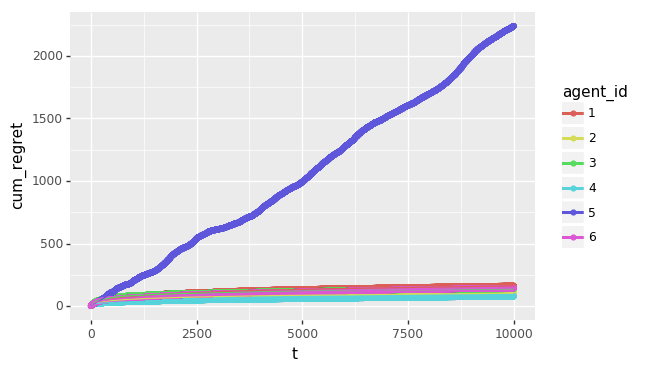

<ggplot: (8741315823625)>


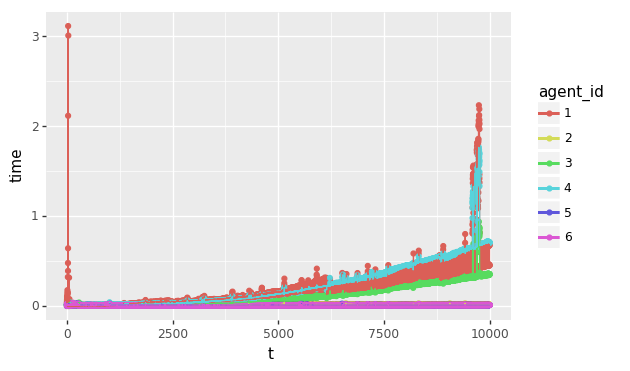

<ggplot: (8741260271897)>


([[       action_id agent_id  cum_optimal   cum_regret  instant_regret      t  \
   0              1        1     0.998663     0.882460        0.882460      1   
   1              2        2     0.998663     0.569455        0.569455      1   
   2              3        3     0.998663     0.850364        0.850364      1   
   3              4        4     0.998663     0.882460        0.882460      1   
   4              5        5     0.998663     0.286705        0.286705      1   
   5              6        6     0.998663     0.460964        0.460964      1   
   6              7        1     1.963349     1.591459        0.708999      2   
   7              8        2     1.963349     1.278453        0.708999      2   
   8              9        3     1.963349     1.354614        0.504250      2   
   9             10        4     1.963349     1.581009        0.698549      2   
   10            11        5     1.963349     0.985254        0.698549      2   
   11            12        6

In [11]:
#https://stackoverflow.com/questions/9031783/hide-all-warnings-in-ipython
make_agents = [make_laplace_agent,
               make_pgts_agent,
               make_best_langevin_agent,
               make_mala_agent,
               make_best_sgld_agent,
               make_best_sagald_agent]
                #,make_mala_agent_untimed]
simple_compares(make_agents, num_articles, dim, var, 10000, [601], verbosity=verbosity)
#simple_compares(make_agents, num_articles, dim, var, 1000, range(100,105), verbosity=verbosity)

In [ ]:
"""
[[161.2253440827199,
   102.69333239889224,
   137.54904120548514,
   77.27947128139603,
   2239.3171345938676,
   143.6594848328406]],
"""